we only need to normalize when there is some bandit events. For pure organic, it doesn't really make sense since we consider each row independently != if we look at a log where a row is a reco then we need to divide by the length of the organic session, which is stochastic (independent of our reco)

actually we need this because otherwise when we apply the discount it won't work. At least we need it for the MDP reward
--> for the organic user : we should divide by the number of time each action a is viewed by user u ?

Idea : click => "only one chance to click"

In [1]:
import gym, recogym
import matplotlib.pyplot as plt
from copy import deepcopy
import numpy as np
import pandas as pd
import pickle as pkl
pd.options.mode.chained_assignment = None 
# from inspect import getsource
from recogym.evaluate_agent_sale import verify_agents_sale, plot_verify_agents_sale, plot_CR_CTR
from tqdm import tqdm

# env_1_sale_args is a dictionary of default parameters (i.e. number of products)
from recogym import env_1_sale_args, Configuration
from recogym.envs.utils_sale import (share_states, share_sale, env_infos, count_sales_first_session, 
                                     get_beta_confidence_interval, share_user_with_sale, share_clicks_with_sale)
# You can overwrite environment arguments here:
env_1_sale_args['random_seed'] = 42

# Initialize the gym for the first time by calling .make() and .init_gym()
env = gym.make('reco-gym-sale-v1')
env.init_gym(env_1_sale_args)

# .reset() env before each episode (one episode per user).
env.reset()
done = False

env_1_sale_args['num_products'] = 10
num_products = env_1_sale_args['num_products']

# You can overwrite environment arguments here:
env_1_sale_args['random_seed'] = 42
env_1_sale_args['mu_sale'] = True
env_1_sale_args['sigma_mu_sale'] = env_1_sale_args['sigma_mu_organic']/4

# Initialize the gym 
env = gym.make('reco-gym-sale-v1')
env.init_gym(env_1_sale_args)

env_1_sale_args['number_of_flips'] = 0 #///!!!\\\

1.966042202395077
mu sale [-0.99379029 -3.12128904 -3.9968082  -0.13101334  1.12695637  0.82779815
 -4.48369477 -2.89367933 -0.97225191  0.96059318]
1.966042202395077
mu sale [-2.43286871 -3.14117445 -3.95163555  1.71641825  0.98268564  1.05395866
 -4.5097286  -3.77018786 -0.1151348   1.52454295]


## Build targets

In [4]:
## Clicks
from recogym.agents.sale_agent import ClickRewardProvider
Click_rewards = ClickRewardProvider()

## MDP
from recogym.agents.sale_agent import MDPRewardProvider, PostDisplayRewardProvider,DifferenceRewardProvider
# doesn't take into account the length of the observation
MDP_rewards = MDPRewardProvider()
MDP_rewards_all = MDPRewardProvider(clicks_only=False)
# take into account length of the observation
MDP_rewards_time = MDPRewardProvider(clicks_only=True, organic_only=False, normalize = True)
MDP_rewards_all_time = MDPRewardProvider(clicks_only=False, organic_only=False, normalize = True)
MDP_rewards_pureorganic = MDPRewardProvider(clicks_only=False, organic_only=True)
PostDisplay_rewards = PostDisplayRewardProvider()
# Diff_rewards = DifferenceRewardProvider(MDP_rewards_all_time,MDP_rewards_pureorganic,normalize = False)
# Diff_rewards_norm = DifferenceRewardProvider(MDP_rewards_all_time,MDP_rewards_pureorganic,normalize = True)

rewards = {'click':Click_rewards,
          'MDP':MDP_rewards,
          'MDP_all':MDP_rewards_all,
          'MDP_time':MDP_rewards_time,
          'MDP_all_time':MDP_rewards_all_time,
          'MDP_pureorganic':MDP_rewards_pureorganic,
          'PostDisplay':PostDisplay_rewards}

## Build features

In [4]:
from recogym.agents.sale_agent import CountViewsClicksFeatureProvider, CountViewsFeatureProvider, ShareViewsClicksFeatureProvider, ShareViewsFeatureProvider
vc_feature = CountViewsClicksFeatureProvider(env.config)
v_feature = CountViewsFeatureProvider(env.config)
vc_share_feature = ShareViewsClicksFeatureProvider(env.config)
v_share_feature = ShareViewsFeatureProvider(env.config)

features = {'vc':vc_feature,
           'v':v_feature,
           'vc_share':vc_share_feature,
           'v_share':v_share_feature}

## Train baseline agents

In [5]:
# Choose number of users for training and AB test
# env_1_sale_args['num_users'] = 15000
# env_1_sale_args['num_users_AB'] = 5000
env_1_sale_args['num_users'] = 1000
env_1_sale_args['num_users_AB'] = 1000
num_users = env_1_sale_args['num_users']
num_users_AB = env_1_sale_args['num_users_AB']

# Choose features
feature_name = 'v_share'
feature = features[feature_name]

In [6]:
from recogym.agents.sale_agent import build_train_data
from recogym.agents.sale_agent import SaleLikelihoodAgent, SaleProductLikelihoodAgent
from recogym.agents.sale_agent import train_agents, train_timeagents

agents={}
logs={}

############## Random agent
from recogym.agents import RandomAgent, random_args
random_agent = RandomAgent(Configuration(random_args))
name_agent = 'rand'
agents[name_agent] = random_agent
try:
    data = pkl.load(open(str('data\data'+str(num_users)+name_agent+'.pkl'),'rb'))
except :
    data = deepcopy(env).generate_logs(num_users)
    pkl.dump(data,open(str('data\data'+str(num_users)+name_agent+'.pkl'),'wb'))
logs[name_agent] = data
    
############## Organic agent
from recogym.agents import OrganicUserEventCounterAgent, organic_user_count_args
organic_counter_agent = OrganicUserEventCounterAgent(Configuration({**organic_user_count_args,
                                                                    **env_1_sale_args,
                                                                    'select_randomly': True}))
name_agent = 'organic'
agents[name_agent] = organic_counter_agent
try:
    data = pkl.load(open(str('data\data'+str(num_users)+name_agent+'.pkl'),'rb'))
except :
    data = deepcopy(env).generate_logs(num_users,agent=organic_counter_agent)
    pkl.dump(data,open(str('data\data'+str(num_users)+name_agent+'.pkl'),'wb'))
logs[name_agent] = data

# ############## Likelihood click kronecker
# name_agent = "likclickkron"
# try :
#     data = pkl.load(open(str('data\data'+str(num_users)+name_agent+'.pkl'),'rb'))
# except:
#     likelihood_logreg_click = SaleLikelihoodAgent(feature, Click_rewards,kronecker_features=True)
#     likelihood_logreg_click.train(data)
#     agents[name_agent] = likelihood_logreg_click
#     data = deepcopy(env).generate_logs(num_users, agent=likelihood_logreg_click)
#     pkl.dump(data,open(str('data\data'+str(num_users)+name_agent+'.pkl'),'wb'))
# logs[name_agent] = data

### Agents with a notion of time TODO with more agents
--> good results ++ initial environment !!
++ to add : clicks

In [ ]:
res_dict_time = {}
name_extension = 'timekronlin'

In [ ]:
num_user = 10000
num_users_AB = 5000
name_logging = 'rand'
data = logs[name_logging]
try :
    info, save_agents = pkl.load(open(str('data/timeagents'+str(num_users)+name_logging+feature_name+name_extension+'.pkl'),'rb'))
except :
    info, save_agents = train_timeagents(name_logging,logs,feature_name,features, num_users=num_users,
                                         kronecker_features=True,linear_reg=True)

# A/B test
env.reset()
res=verify_agents_sale(
    env,
    number_of_users=num_users_AB,
    agents={
        **agents, 
        **save_agents}
)

# save result
pkl.dump([res, env_1_sale_args, info, save_agents],
         open("data/res_"+name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension+".pkl","wb"))
res_dict_time[name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension] = res

print(datetime.now())

# plot result
plot_verify_agents_sale(res["CTR"], res["Tot sales ATT"], res['Share user with sale ATT'], 
                        res["Tot sales"], res['Share user with sale'])
None


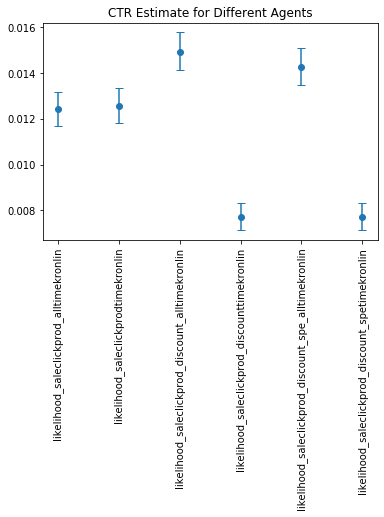

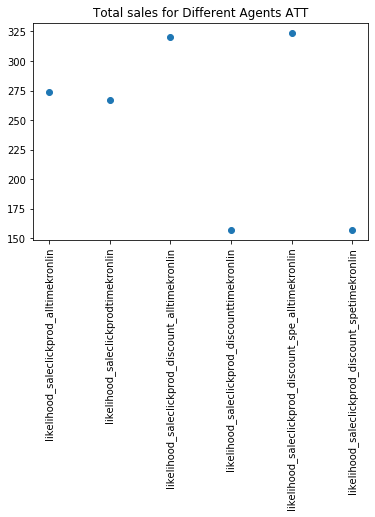

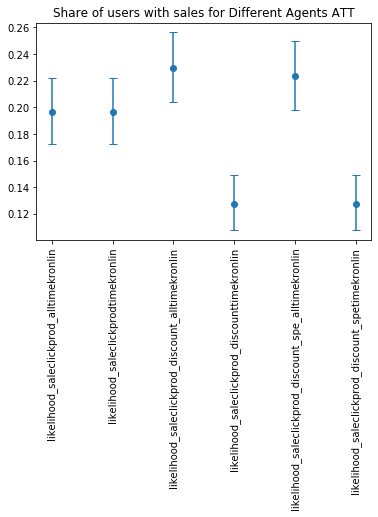

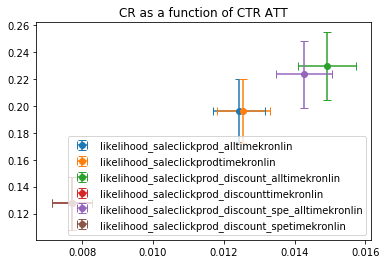

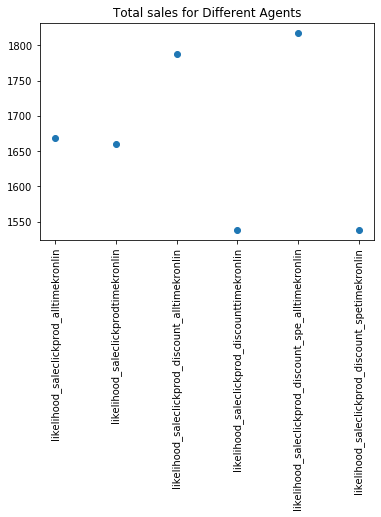

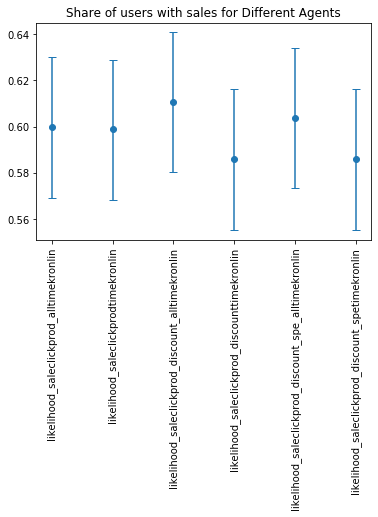

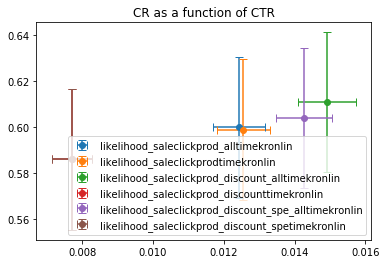

In [40]:
res_dict_time = {}
name_extension = 'timekronlin'
# res_dict = {}
num_users = 1000
num_users_AB = 1000

r = pkl.load(open("data/res_"+name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension+".pkl",'rb'))
res = r[0]

try:
    r_notime = res_dict['rand1000_1000_v_sharekron']
except:
    r_notime = pkl.load(open("data/res_"+name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+"kron.pkl",'rb'))[0]

# plot result
plot_verify_agents_sale(res["CTR"], res["Tot sales ATT"], res['Share user with sale ATT'], 
                        res["Tot sales"], res['Share user with sale'])
None

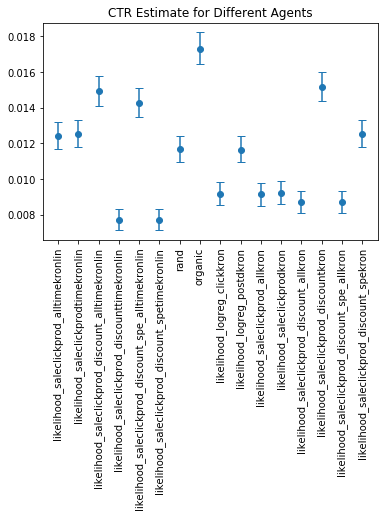

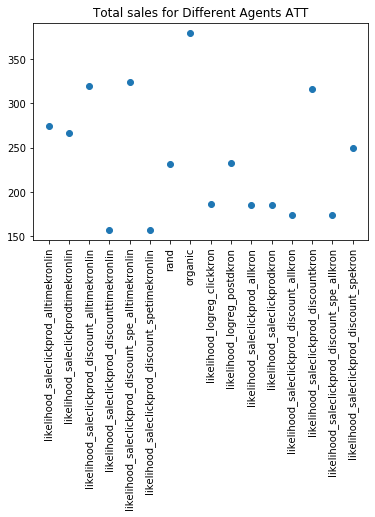

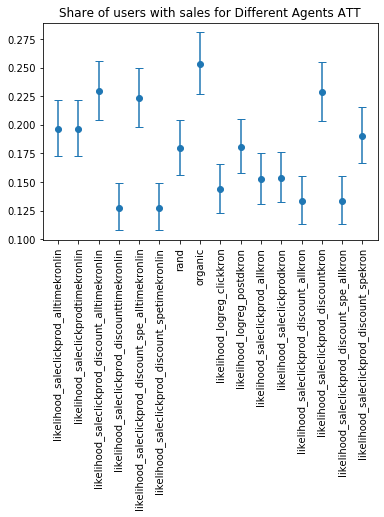

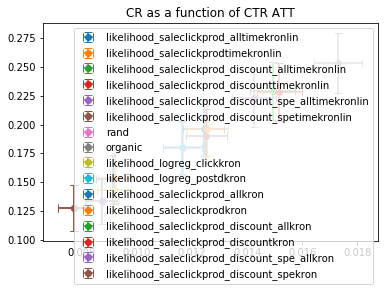

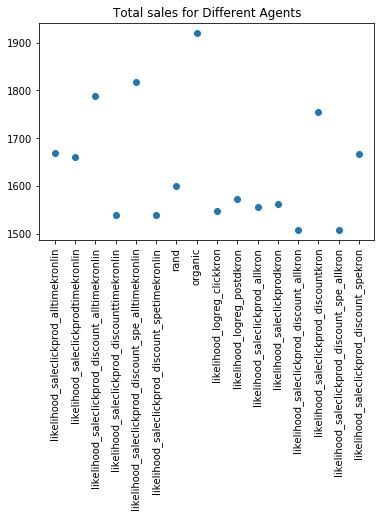

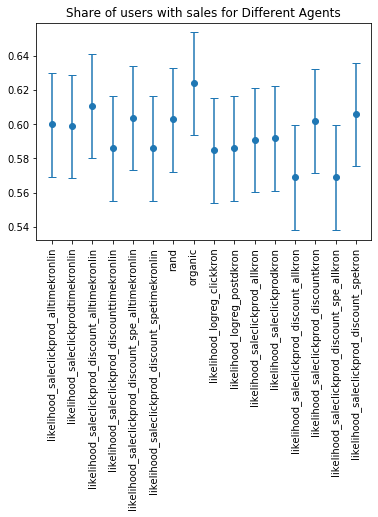

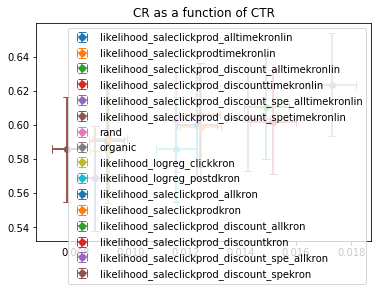

In [41]:
res["CTR"] = pd.concat([res["CTR"],r_notime["CTR"]])
res["Tot sales ATT"] = pd.concat([res["Tot sales ATT"],r_notime["Tot sales ATT"]])
res['Share user with sale ATT'] = pd.concat([res['Share user with sale ATT'],r_notime['Share user with sale ATT']])
res["Tot sales"] = pd.concat([res["Tot sales"],r_notime["Tot sales"]])
res['Share user with sale'] = pd.concat([res['Share user with sale'],r_notime['Share user with sale']])
# plot result
plot_verify_agents_sale(res["CTR"], res["Tot sales ATT"], res['Share user with sale ATT'], 
                        res["Tot sales"], res['Share user with sale'])
None

### Agents with no notion of time (needed or neglected) #todo again with 10000/5000 just once to keep it?

#### Cumulative features

In [26]:
name_extension = 'kron'
# res_dict = {}
num_users = 1000
num_users_AB = 1000

In [ ]:
print(datetime.now())


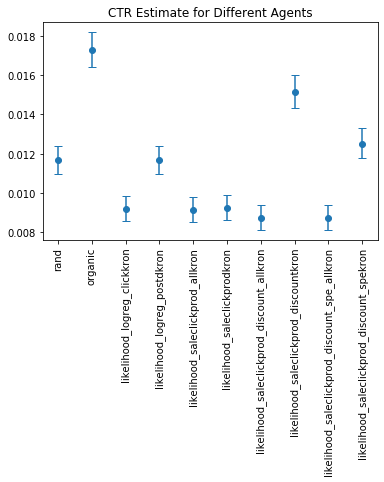

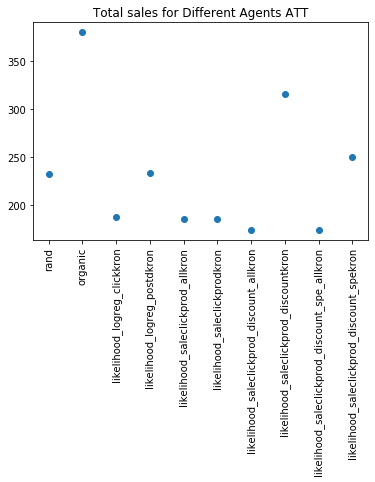

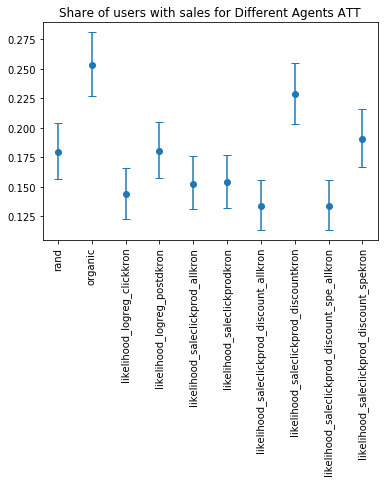

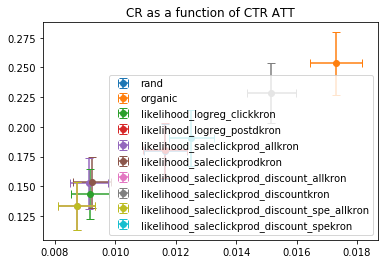

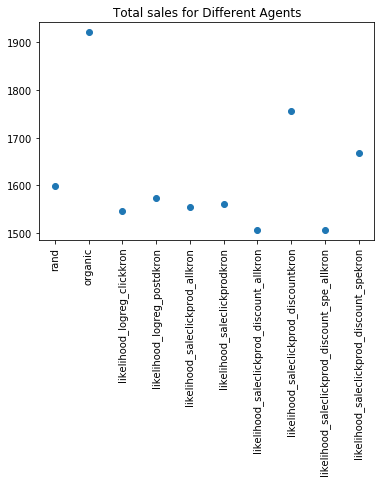

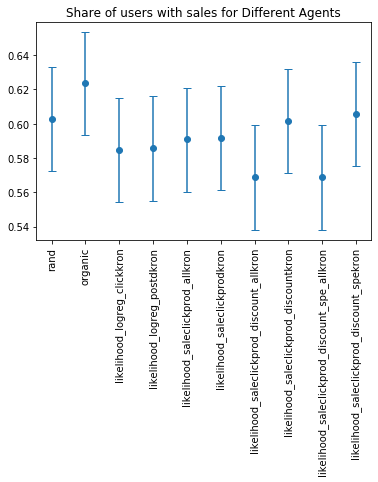

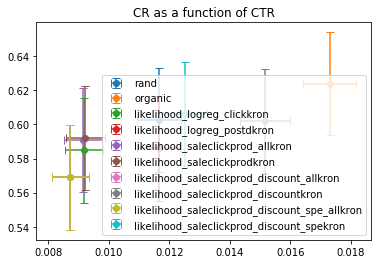

In [27]:
r = pkl.load(open("data/res_"+name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension+".pkl",'rb'))
res = r[0]
# plot result
plot_verify_agents_sale(res["CTR"], res["Tot sales ATT"], res['Share user with sale ATT'], 
                        res["Tot sales"], res['Share user with sale'])
None

Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [00:39<00:00, 25.47it/s]
Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [00:44<00:00, 22.62it/s]
Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [41:13<00:00,  2.47s/it]
Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [31:54<00:00,  1.91s/it]
Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [41:05<00:00,  2.47s/it]
Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [41:16<00:00,  2.48s/it]
Organic Users: 0it [00:00, ?it/s]
Users:   0%|                              

[-0.07768155 -0.07767418 -0.07777635 -0.07770326 -0.07762201 -0.07763175
 -0.07772255 -0.0776595  -0.07771144 -0.07773489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768154 -0.07767417 -0.07777634 -0.07770325 -0.077622   -0.07763174
 -0.07772254 -0.07765949 -0.07771143 -0.07773488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768153 -0.07767416 -0.07777633 -0.07770324 -0.07762199 -0.07763173
 -0.07772253 -0.07765948 -0.07771142 -0.07773487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768151 -0.07767415 -0.07777632 -0.07770322 -0.07762197 -0.07763172
 -0.07772252 -0.07765946 -0.0777114  -0.07773486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768149 -0.07767413 -0.0777763  -0.07770321 -0.07762196 -0.0776317
 -0.0777225  -0.07765944 -0.07771139 -0.07773484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768148 -0.07767411 -0.07777628 -0.07770319 -0.07762194 -0.07763169
 -0.07772248 -0.07765943 -0.07771137 -0.07773482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768146 -0.0776741  -0.07777627 -0.07770317 -0.07762192 -0.07763167
 -0.07772246 -0.07765941 -0.07771135 -0.07773481]
[0 1 2 3

Users:   0%|                                                                          | 1/1000 [00:00<16:25,  1.01it/s]

[-0.07768011 -0.07767274 -0.07777496 -0.07770184 -0.07762053 -0.07763032
 -0.07772113 -0.07765808 -0.07771006 -0.07773351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768005 -0.07767268 -0.0777749  -0.07770177 -0.07762046 -0.07763026
 -0.07772107 -0.07765802 -0.07771    -0.07773345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767999 -0.07767262 -0.07777484 -0.07770171 -0.07762039 -0.0776302
 -0.07772101 -0.07765795 -0.07770994 -0.07773339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767992 -0.07767255 -0.07777478 -0.07770165 -0.07762033 -0.07763013
 -0.07772094 -0.07765789 -0.07770988 -0.07773332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767986 -0.07767249 -0.07777471 -0.07770159 -0.07762026 -0.07763007
 -0.07772088 -0.07765783 -0.07770982 -0.07773326]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776798  -0.07767242 -0.07777465 -0.07770152 -0.0776202  -0.07763001
 -0.07772082 -0.07765777 -0.07770976 -0.0777332 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767973 -0.07767236 -0.07777459 -0.07770146 -0.07762013 -0.07762994
 -0.07772075 -0.07765771 -0.0777097  -0.07773314]
[0 1 2 3

Users:   0%|▏                                                                         | 2/1000 [00:01<14:25,  1.15it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07767973 -0.07767236 -0.0777746  -0.07770146 -0.07762014 -0.07762996
 -0.07772076 -0.0776577  -0.0777097  -0.07773315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767974 -0.07767237 -0.0777746  -0.07770147 -0.07762015 -0.07762996
 -0.07772076 -0.07765771 -0.0777097  -0.07773315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767974 -0.07767237 -0.0777746  -0.07770147 -0.07762015 -0.07762996
 -0.07772077 -0.07765771 -0.0777097  -0.07773316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767975 -0.07767237 -0.07777461 -0.07770147 -0.07762016 -0.07762997
 -0.07772077 -0.07765771 -0.07770971 -0.07773316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767975 -0.07767238 -0.07777461 -0.07770148 -0.07762016 -0.07762997
 -0.07772077 -0.07765772 -0.07770971 -0.07773316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767975 -0.07767238 -0.07777462 -0.07770148 -0.07762016 -0.07762998
 -0.07772078 -0.07765772 -0.07770971 -0.07773317]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767976 -0.07767239 -0.07777462 -0.07770149 -0.07762017 -0.07762998
 -0.07772078 -0.07765772 -0.077709

 -0.07771763 -0.07765461 -0.07770645 -0.07772995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767663 -0.07766931 -0.07777115 -0.07769818 -0.07761737 -0.07762707
 -0.07771757 -0.07765455 -0.07770639 -0.07772989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767658 -0.07766925 -0.07777109 -0.07769812 -0.07761731 -0.07762702
 -0.07771751 -0.07765449 -0.07770632 -0.07772983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767652 -0.07766919 -0.07777102 -0.07769806 -0.07761726 -0.07762696
 -0.07771745 -0.07765443 -0.07770626 -0.07772977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767646 -0.07766913 -0.07777096 -0.077698   -0.07761721 -0.07762691
 -0.07771739 -0.07765437 -0.0777062  -0.07772971]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776764  -0.07766908 -0.07777089 -0.07769794 -0.07761716 -0.07762686
 -0.07771733 -0.07765431 -0.07770614 -0.07772965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767634 -0.07766902 -0.07777083 -0.07769788 -0.0776171  -0.0776268
 -0.07771727 -0.07765425 -0.07770607 -0.07772959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767628 -0.07766896 -0.07777076 -0.07769781 -0.0776170

[-0.07767418 -0.0776669  -0.07776827 -0.07769547 -0.07761537 -0.07762492
 -0.07771501 -0.07765197 -0.07770362 -0.07772727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767416 -0.07766688 -0.07776824 -0.07769545 -0.07761536 -0.07762491
 -0.07771499 -0.07765195 -0.0777036  -0.07772724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767414 -0.07766686 -0.07776822 -0.07769543 -0.07761535 -0.07762489
 -0.07771497 -0.07765193 -0.07770357 -0.07772722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767412 -0.07766685 -0.07776819 -0.0776954  -0.07761534 -0.07762488
 -0.07771494 -0.0776519  -0.07770355 -0.0777272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776741  -0.07766683 -0.07776816 -0.07769538 -0.07761533 -0.07762487
 -0.07771492 -0.07765188 -0.07770352 -0.07772718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767408 -0.07766681 -0.07776814 -0.07769536 -0.07761532 -0.07762486
 -0.07771491 -0.07765186 -0.0777035  -0.07772716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767407 -0.0776668  -0.07776812 -0.07769534 -0.07761532 -0.07762485
 -0.07771489 -0.07765185 -0.07770348 -0.07772714]
[0 1 2 

Users:   0%|▏                                                                         | 3/1000 [00:07<39:03,  2.35s/it]

[-0.07767386 -0.07766662 -0.07776762 -0.07769496 -0.07761559 -0.07762498
 -0.07771462 -0.07765151 -0.07770296 -0.07772683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767387 -0.07766663 -0.07776763 -0.07769497 -0.07761561 -0.077625
 -0.07771463 -0.07765153 -0.07770297 -0.07772684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767389 -0.07766665 -0.07776764 -0.07769498 -0.07761564 -0.07762502
 -0.07771465 -0.07765154 -0.07770298 -0.07772685]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776739  -0.07766666 -0.07776765 -0.077695   -0.07761566 -0.07762505
 -0.07771466 -0.07765155 -0.07770299 -0.07772687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767392 -0.07766668 -0.07776767 -0.07769501 -0.07761569 -0.07762507
 -0.07771468 -0.07765157 -0.077703   -0.07772689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767394 -0.0776667  -0.07776769 -0.07769503 -0.07761571 -0.07762509
 -0.0777147  -0.07765159 -0.07770302 -0.07772691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767396 -0.07766672 -0.07776771 -0.07769505 -0.07761573 -0.07762511
 -0.07771472 -0.07765161 -0.07770304 -0.07772693]
[0 1 2 3 

 -0.07771588 -0.07765277 -0.07770421 -0.07772808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767515 -0.07766791 -0.07776887 -0.07769621 -0.07761691 -0.07762629
 -0.07771589 -0.07765279 -0.07770423 -0.07772809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767516 -0.07766793 -0.07776889 -0.07769622 -0.07761693 -0.0776263
 -0.0777159  -0.07765281 -0.07770424 -0.0777281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767518 -0.07766794 -0.0777689  -0.07769624 -0.07761695 -0.07762632
 -0.07771592 -0.07765282 -0.07770426 -0.07772812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767519 -0.07766796 -0.07776892 -0.07769625 -0.07761696 -0.07762633
 -0.07771593 -0.07765284 -0.07770427 -0.07772813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767521 -0.07766797 -0.07776893 -0.07769627 -0.07761698 -0.07762635
 -0.07771595 -0.07765285 -0.07770429 -0.07772815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767523 -0.07766799 -0.07776894 -0.07769628 -0.07761699 -0.07762636
 -0.07771596 -0.07765287 -0.0777043  -0.07772816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767524 -0.07766801 -0.07776896 -0.0776963  -0.0776170

Users:   0%|▎                                                                         | 4/1000 [00:09<36:31,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07767552 -0.07766829 -0.07776921 -0.07769656 -0.0776173  -0.07762666
 -0.07771625 -0.07765318 -0.07770459 -0.07772842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767551 -0.07766828 -0.0777692  -0.07769655 -0.07761729 -0.07762665
 -0.07771624 -0.07765317 -0.07770458 -0.07772842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767549 -0.07766826 -0.07776918 -0.07769653 -0.07761727 -0.07762664
 -0.07771622 -0.07765315 -0.07770456 -0.07772839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767547 -0.07766824 -0.07776915 -0.07769651 -0.07761725 -0.07762662
 -0.0777162  -0.07765313 -0.07770454 -0.07772837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767545 -0.07766822 -0.07776913 -0.07769649 -0.07761724 -0.0776266
 -0.07771618 -0.07765311 -0.07770452 -0.07772835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767543 -0.0776682  -0.07776911 -0.07769647 -0.07761722 -0.07762658
 -0.07771615 -0.07765309 -0.0777045  -0.07772833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767541 -0.07766818 -0.07776909 -0.07769645 -0.0776172  -0.07762656
 -0.07771613 -0.07765307 -0.0777044

 -0.0777141  -0.07765108 -0.07770236 -0.07772621]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776734  -0.0776662  -0.07776679 -0.07769428 -0.07761541 -0.07762468
 -0.07771405 -0.07765103 -0.07770231 -0.07772616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767336 -0.07766616 -0.07776674 -0.07769424 -0.07761537 -0.07762464
 -0.077714   -0.07765098 -0.07770226 -0.07772611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767331 -0.07766611 -0.07776669 -0.07769419 -0.07761533 -0.07762459
 -0.07771395 -0.07765094 -0.07770222 -0.07772606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767326 -0.07766607 -0.07776664 -0.07769414 -0.07761529 -0.07762455
 -0.07771391 -0.07765089 -0.07770217 -0.07772601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767322 -0.07766602 -0.07776659 -0.07769409 -0.07761525 -0.07762451
 -0.07771386 -0.07765085 -0.07770212 -0.07772596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767317 -0.07766598 -0.07776653 -0.07769404 -0.07761521 -0.07762447
 -0.07771381 -0.0776508  -0.07770207 -0.07772591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767313 -0.07766593 -0.07776648 -0.07769399 -0.077615

Users:   0%|▎                                                                         | 5/1000 [00:11<37:11,  2.24s/it]

[-0.0776719  -0.07766472 -0.07776508 -0.07769266 -0.07761407 -0.07762327
 -0.07771249 -0.07764951 -0.0777007  -0.07772455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767182 -0.07766464 -0.07776498 -0.07769258 -0.077614   -0.07762319
 -0.0777124  -0.07764943 -0.07770061 -0.07772446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767173 -0.07766456 -0.07776489 -0.07769249 -0.07761392 -0.07762312
 -0.07771232 -0.07764935 -0.07770052 -0.07772437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767165 -0.07766448 -0.0777648  -0.0776924  -0.07761385 -0.07762304
 -0.07771223 -0.07764926 -0.07770044 -0.07772428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767165 -0.07766448 -0.07776479 -0.07769239 -0.07761385 -0.07762304
 -0.07771222 -0.07764926 -0.07770043 -0.07772427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767168 -0.07766451 -0.07776482 -0.07769242 -0.07761388 -0.07762307
 -0.07771226 -0.07764929 -0.07770046 -0.07772431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767171 -0.07766454 -0.07776485 -0.07769246 -0.07761392 -0.0776231
 -0.07771229 -0.07764932 -0.07770049 -0.07772434]
[0 1 2 3

 -0.07771518 -0.0776522  -0.07770326 -0.0777272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767461 -0.0776674  -0.07776786 -0.07769547 -0.07761697 -0.07762617
 -0.07771525 -0.07765227 -0.07770333 -0.07772727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767468 -0.07766747 -0.07776793 -0.07769553 -0.07761704 -0.07762624
 -0.07771532 -0.07765234 -0.0777034  -0.07772734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767475 -0.07766753 -0.077768   -0.0776956  -0.07761711 -0.07762631
 -0.07771538 -0.07765241 -0.07770346 -0.07772741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767482 -0.0776676  -0.07776807 -0.07769567 -0.07761718 -0.07762638
 -0.07771545 -0.07765248 -0.07770353 -0.07772748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767488 -0.07766766 -0.07776814 -0.07769574 -0.07761725 -0.07762645
 -0.07771552 -0.07765255 -0.07770359 -0.07772754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767495 -0.07766773 -0.07776821 -0.07769581 -0.07761732 -0.07762652
 -0.07771559 -0.07765261 -0.07770366 -0.07772761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767502 -0.0776678  -0.07776828 -0.07769588 -0.077617

Users:   1%|▍                                                                         | 6/1000 [00:13<36:10,  2.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07767675 -0.0776695  -0.07777007 -0.07769767 -0.07761922 -0.07762843
 -0.07771742 -0.07765444 -0.07770541 -0.07772942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767682 -0.07766957 -0.07777014 -0.07769774 -0.0776193  -0.0776285
 -0.07771749 -0.07765451 -0.07770547 -0.07772949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767684 -0.07766959 -0.07777016 -0.07769776 -0.07761932 -0.07762853
 -0.07771751 -0.07765453 -0.07770549 -0.07772951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767683 -0.07766958 -0.07777015 -0.07769776 -0.07761932 -0.07762852
 -0.07771751 -0.07765452 -0.07770549 -0.07772951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767683 -0.07766958 -0.07777015 -0.07769776 -0.07761931 -0.07762852
 -0.0777175  -0.07765452 -0.07770548 -0.0777295 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767683 -0.07766958 -0.07777015 -0.07769775 -0.07761931 -0.07762852
 -0.0777175  -0.07765452 -0.07770548 -0.0777295 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767682 -0.07766957 -0.07777014 -0.07769775 -0.07761931 -0.07762851
 -0.07771749 -0.07765451 -0.0777054

Users:   1%|▌                                                                         | 7/1000 [00:13<26:27,  1.60s/it]

[-0.07767681 -0.07766957 -0.07777013 -0.07769774 -0.0776193  -0.0776285
 -0.07771749 -0.0776545  -0.07770547 -0.07772949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767681 -0.07766956 -0.07777013 -0.07769774 -0.07761929 -0.0776285
 -0.07771748 -0.0776545  -0.07770546 -0.07772948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767679 -0.07766954 -0.07777011 -0.07769772 -0.07761928 -0.07762848
 -0.07771746 -0.07765448 -0.07770544 -0.07772946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767676 -0.07766952 -0.07777008 -0.07769769 -0.07761925 -0.07762846
 -0.07771744 -0.07765445 -0.07770541 -0.07772943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767673 -0.07766949 -0.07777005 -0.07769766 -0.07761922 -0.07762843
 -0.07771741 -0.07765443 -0.07770538 -0.0777294 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767672 -0.07766947 -0.07777003 -0.07769764 -0.07761921 -0.07762841
 -0.07771739 -0.07765441 -0.07770537 -0.07772939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767671 -0.07766946 -0.07777002 -0.07769764 -0.0776192  -0.07762841
 -0.07771738 -0.0776544  -0.07770536 -0.07772938]
[0 1 2 3 

 -0.07771538 -0.07765237 -0.07770342 -0.07772742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767462 -0.07766737 -0.07776808 -0.07769565 -0.07761696 -0.07762626
 -0.07771534 -0.07765233 -0.07770338 -0.07772739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767459 -0.07766733 -0.07776805 -0.07769561 -0.07761692 -0.07762622
 -0.07771531 -0.0776523  -0.07770335 -0.07772735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767455 -0.0776673  -0.07776801 -0.07769558 -0.07761688 -0.07762618
 -0.07771527 -0.07765226 -0.07770331 -0.07772732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767451 -0.07766726 -0.07776798 -0.07769554 -0.07761684 -0.07762614
 -0.07771524 -0.07765222 -0.07770328 -0.07772728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767448 -0.07766722 -0.07776794 -0.07769551 -0.0776168  -0.0776261
 -0.0777152  -0.07765219 -0.07770324 -0.07772725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767444 -0.07766719 -0.07776791 -0.07769547 -0.07761676 -0.07762607
 -0.07771516 -0.07765215 -0.07770321 -0.07772721]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776744  -0.07766715 -0.07776787 -0.07769544 -0.0776167

[-0.07767244 -0.07766519 -0.07776605 -0.07769358 -0.07761462 -0.07762402
 -0.07771322 -0.07765017 -0.07770132 -0.07772531]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776724  -0.07766515 -0.07776601 -0.07769354 -0.07761457 -0.07762397
 -0.07771318 -0.07765012 -0.07770127 -0.07772526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767236 -0.0776651  -0.07776597 -0.0776935  -0.07761453 -0.07762393
 -0.07771313 -0.07765008 -0.07770123 -0.07772522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767231 -0.07766506 -0.07776593 -0.07769346 -0.07761448 -0.07762388
 -0.07771309 -0.07765003 -0.07770119 -0.07772518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767227 -0.07766501 -0.07776589 -0.07769341 -0.07761443 -0.07762384
 -0.07771305 -0.07764999 -0.07770115 -0.07772514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767222 -0.07766497 -0.07776585 -0.07769337 -0.07761439 -0.07762379
 -0.077713   -0.07764995 -0.07770111 -0.0777251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767218 -0.07766493 -0.07776581 -0.07769333 -0.07761434 -0.07762375
 -0.07771296 -0.0776499  -0.07770106 -0.07772505]
[0 1 2 

Users:   1%|▌                                                                         | 8/1000 [00:20<50:35,  3.06s/it]

[-0.07767156 -0.07766431 -0.07776523 -0.07769274 -0.07761369 -0.07762312
 -0.07771236 -0.07764929 -0.07770048 -0.07772447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767152 -0.07766427 -0.07776519 -0.0776927  -0.07761364 -0.07762307
 -0.07771232 -0.07764924 -0.07770043 -0.07772442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767148 -0.07766422 -0.07776515 -0.07769266 -0.07761359 -0.07762303
 -0.07771227 -0.0776492  -0.07770039 -0.07772438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767146 -0.07766421 -0.07776513 -0.07769265 -0.07761358 -0.07762301
 -0.07771226 -0.07764918 -0.07770038 -0.07772437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767145 -0.0776642  -0.07776513 -0.07769264 -0.07761357 -0.077623
 -0.07771225 -0.07764918 -0.07770037 -0.07772436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767145 -0.07766419 -0.07776512 -0.07769263 -0.07761356 -0.077623
 -0.07771224 -0.07764917 -0.07770036 -0.07772435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767144 -0.07766419 -0.07776511 -0.07769262 -0.07761355 -0.07762299
 -0.07771224 -0.07764916 -0.07770035 -0.07772434]
[0 1 2 3 4 

 -0.07771081 -0.0776478  -0.0776989  -0.07772287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767001 -0.07766277 -0.07776355 -0.07769115 -0.07761223 -0.07762162
 -0.07771078 -0.07764776 -0.07769886 -0.07772283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766998 -0.07766274 -0.07776351 -0.07769112 -0.0776122  -0.07762158
 -0.07771074 -0.07764773 -0.07769883 -0.0777228 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766994 -0.0776627  -0.07776348 -0.07769108 -0.07761217 -0.07762155
 -0.07771071 -0.07764769 -0.07769879 -0.07772276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766991 -0.07766267 -0.07776344 -0.07769104 -0.07761214 -0.07762152
 -0.07771067 -0.07764766 -0.07769875 -0.07772272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766987 -0.07766263 -0.0777634  -0.07769101 -0.07761211 -0.07762148
 -0.07771063 -0.07764763 -0.07769872 -0.07772269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766984 -0.0776626  -0.07776336 -0.07769097 -0.07761207 -0.07762145
 -0.0777106  -0.07764759 -0.07769868 -0.07772265]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776698  -0.07766256 -0.07776332 -0.07769094 -0.077612

[-0.07766713 -0.07765991 -0.07776046 -0.0776882  -0.0776095  -0.07761881
 -0.07770784 -0.07764493 -0.07769589 -0.07771982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766712 -0.0776599  -0.07776045 -0.07768818 -0.07760949 -0.0776188
 -0.07770783 -0.07764492 -0.07769588 -0.07771981]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766711 -0.07765989 -0.07776043 -0.07768817 -0.07760949 -0.07761879
 -0.07770782 -0.07764491 -0.07769587 -0.0777198 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766711 -0.07765988 -0.07776042 -0.07768816 -0.07760948 -0.07761878
 -0.07770781 -0.0776449  -0.07769586 -0.07771979]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776671  -0.07765988 -0.07776041 -0.07768815 -0.07760948 -0.07761877
 -0.0777078  -0.07764489 -0.07769585 -0.07771978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766709 -0.07765987 -0.0777604  -0.07768814 -0.07760947 -0.07761877
 -0.07770779 -0.07764488 -0.07769584 -0.07771977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766708 -0.07765986 -0.07776038 -0.07768813 -0.07760947 -0.07761876
 -0.07770778 -0.07764487 -0.07769583 -0.07771976]
[0 1 2 3

Users:   1%|▋                                                                        | 10/1000 [00:25<48:59,  2.97s/it]

[-0.07766924 -0.07766204 -0.07776241 -0.07769013 -0.0776117  -0.07762087
 -0.07770988 -0.07764693 -0.0776979  -0.07772187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766937 -0.07766217 -0.07776254 -0.07769025 -0.07761184 -0.077621
 -0.07771001 -0.07764705 -0.07769803 -0.077722  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766941 -0.07766221 -0.07776258 -0.07769029 -0.07761188 -0.07762104
 -0.07771004 -0.07764709 -0.07769806 -0.07772204]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776694  -0.0776622  -0.07776257 -0.07769028 -0.07761187 -0.07762103
 -0.07771004 -0.07764708 -0.07769805 -0.07772203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766939 -0.07766219 -0.07776256 -0.07769027 -0.07761186 -0.07762102
 -0.07771003 -0.07764707 -0.07769805 -0.07772203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766938 -0.07766218 -0.07776255 -0.07769026 -0.07761186 -0.07762102
 -0.07771002 -0.07764706 -0.07769804 -0.07772202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766937 -0.07766217 -0.07776254 -0.07769026 -0.07761185 -0.07762101
 -0.07771001 -0.07764706 -0.07769803 -0.07772201]
[0 1 2 3 

 -0.07770878 -0.07764587 -0.07769677 -0.07772073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766813 -0.07766095 -0.07776118 -0.07768897 -0.0776107  -0.07761982
 -0.07770874 -0.07764584 -0.07769673 -0.07772069]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776681  -0.07766091 -0.07776114 -0.07768893 -0.07761067 -0.07761979
 -0.0777087  -0.0776458  -0.07769669 -0.07772065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766806 -0.07766087 -0.07776109 -0.07768889 -0.07761064 -0.07761975
 -0.07770867 -0.07764576 -0.07769665 -0.07772061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766802 -0.07766084 -0.07776105 -0.07768885 -0.0776106  -0.07761972
 -0.07770863 -0.07764573 -0.07769661 -0.07772057]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766799 -0.0776608  -0.07776101 -0.07768882 -0.07761057 -0.07761968
 -0.07770859 -0.07764569 -0.07769657 -0.07772053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766795 -0.07766076 -0.07776097 -0.07768878 -0.07761053 -0.07761965
 -0.07770855 -0.07764566 -0.07769653 -0.07772049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766791 -0.07766073 -0.07776093 -0.07768874 -0.077610

Users:   1%|▊                                                                        | 11/1000 [00:27<44:32,  2.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07766725 -0.07766007 -0.0777602  -0.07768805 -0.07760989 -0.07761898
 -0.07770783 -0.07764497 -0.0776958  -0.07771975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766721 -0.07766003 -0.07776016 -0.07768801 -0.07760985 -0.07761894
 -0.0777078  -0.07764493 -0.07769576 -0.07771971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766717 -0.07765999 -0.07776012 -0.07768797 -0.07760982 -0.07761891
 -0.07770776 -0.07764489 -0.07769572 -0.07771967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766716 -0.07765998 -0.0777601  -0.07768796 -0.07760981 -0.07761889
 -0.07770774 -0.07764488 -0.07769571 -0.07771965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766716 -0.07765998 -0.0777601  -0.07768795 -0.0776098  -0.07761889
 -0.07770774 -0.07764488 -0.0776957  -0.07771965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766715 -0.07765997 -0.07776009 -0.07768795 -0.0776098  -0.07761889
 -0.07770773 -0.07764487 -0.0776957  -0.07771964]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766715 -0.07765997 -0.07776009 -0.07768795 -0.0776098  -0.07761888
 -0.07770773 -0.07764487 -0.077695

Users:   1%|▉                                                                        | 12/1000 [00:28<32:12,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07766714 -0.07765996 -0.07776007 -0.07768793 -0.07760979 -0.07761887
 -0.07770772 -0.07764486 -0.07769568 -0.07771963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766713 -0.07765995 -0.07776007 -0.07768793 -0.07760978 -0.07761887
 -0.07770771 -0.07764485 -0.07769568 -0.07771962]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766713 -0.07765995 -0.07776007 -0.07768793 -0.07760978 -0.07761886
 -0.07770771 -0.07764485 -0.07769567 -0.07771962]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776671  -0.07765992 -0.07776004 -0.0776879  -0.07760975 -0.07761884
 -0.07770768 -0.07764482 -0.07769564 -0.07771959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766708 -0.0776599  -0.07776001 -0.07768787 -0.07760973 -0.07761882
 -0.07770766 -0.0776448  -0.07769562 -0.07771957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766707 -0.07765989 -0.07776    -0.07768786 -0.07760972 -0.0776188
 -0.07770765 -0.07764479 -0.07769561 -0.07771955]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766705 -0.07765987 -0.07775999 -0.07768785 -0.07760971 -0.07761879
 -0.07770763 -0.07764477 -0.0776955

Users:   1%|▉                                                                        | 13/1000 [00:28<26:27,  1.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07766663 -0.07765945 -0.07775957 -0.07768744 -0.07760927 -0.07761837
 -0.07770722 -0.07764435 -0.07769518 -0.07771912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766662 -0.07765944 -0.07775956 -0.07768742 -0.07760926 -0.07761835
 -0.0777072  -0.07764434 -0.07769517 -0.07771911]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776666  -0.07765942 -0.07775954 -0.0776874  -0.07760924 -0.07761833
 -0.07770718 -0.07764432 -0.07769515 -0.07771909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766659 -0.07765941 -0.07775953 -0.07768739 -0.07760923 -0.07761832
 -0.07770717 -0.07764431 -0.07769514 -0.07771908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766658 -0.0776594  -0.07775952 -0.07768739 -0.07760922 -0.07761832
 -0.07770717 -0.07764431 -0.07769513 -0.07771908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766658 -0.0776594  -0.07775952 -0.07768739 -0.07760922 -0.07761831
 -0.07770716 -0.0776443  -0.07769513 -0.07771907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766657 -0.0776594  -0.07775951 -0.07768738 -0.07760922 -0.07761831
 -0.07770716 -0.0776443  -0.077695

 -0.07770641 -0.07764356 -0.07769433 -0.07771829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766584 -0.07765868 -0.07775866 -0.07768658 -0.0776086  -0.07761766
 -0.07770639 -0.07764354 -0.07769431 -0.07771827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766582 -0.07765866 -0.07775864 -0.07768656 -0.07760858 -0.07761764
 -0.07770637 -0.07764353 -0.07769429 -0.07771825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766581 -0.07765864 -0.07775862 -0.07768654 -0.07760857 -0.07761763
 -0.07770636 -0.07764351 -0.07769428 -0.07771824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766579 -0.07765863 -0.0777586  -0.07768653 -0.07760856 -0.07761761
 -0.07770634 -0.07764349 -0.07769426 -0.07771822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766577 -0.07765861 -0.07775858 -0.07768651 -0.07760854 -0.0776176
 -0.07770632 -0.07764347 -0.07769424 -0.0777182 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766576 -0.0776586  -0.07775856 -0.07768649 -0.07760853 -0.07761759
 -0.07770631 -0.07764346 -0.07769422 -0.07771818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766574 -0.07765858 -0.07775854 -0.07768647 -0.0776085

[-0.07766422 -0.07765709 -0.07775681 -0.07768483 -0.0776072  -0.07761619
 -0.07770471 -0.07764187 -0.07769254 -0.07771655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766417 -0.07765704 -0.07775676 -0.07768478 -0.07760717 -0.07761615
 -0.07770467 -0.07764183 -0.0776925  -0.07771651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766413 -0.077657   -0.07775671 -0.07768474 -0.07760713 -0.07761611
 -0.07770462 -0.07764178 -0.07769245 -0.07771646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766409 -0.07765696 -0.07775666 -0.07768469 -0.07760709 -0.07761607
 -0.07770458 -0.07764174 -0.0776924  -0.07771641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766404 -0.07765692 -0.07775661 -0.07768464 -0.07760705 -0.07761604
 -0.07770453 -0.07764169 -0.07769236 -0.07771637]
[0 1 2 3 4 5 6 7 8 9]
[-0.077664   -0.07765687 -0.07775657 -0.0776846  -0.07760701 -0.077616
 -0.07770449 -0.07764165 -0.07769231 -0.07771632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766395 -0.07765683 -0.07775652 -0.07768455 -0.07760697 -0.07761596
 -0.07770444 -0.0776416  -0.07769226 -0.07771628]
[0 1 2 3 

[-0.07766134 -0.07765426 -0.07775358 -0.07768177 -0.07760467 -0.07761356
 -0.07770175 -0.07763894 -0.07768946 -0.07771352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766129 -0.07765421 -0.07775352 -0.07768171 -0.07760462 -0.07761351
 -0.07770169 -0.07763889 -0.0776894  -0.07771346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766123 -0.07765415 -0.07775346 -0.07768165 -0.07760457 -0.07761345
 -0.07770163 -0.07763883 -0.07768934 -0.0777134 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766118 -0.0776541  -0.0777534  -0.07768159 -0.07760453 -0.0776134
 -0.07770158 -0.07763878 -0.07768928 -0.07771334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766112 -0.07765404 -0.07775333 -0.07768153 -0.07760448 -0.07761335
 -0.07770152 -0.07763872 -0.07768922 -0.07771328]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766107 -0.07765399 -0.07775327 -0.07768147 -0.07760443 -0.0776133
 -0.07770146 -0.07763866 -0.07768916 -0.07771322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766101 -0.07765393 -0.07775321 -0.07768141 -0.07760438 -0.07761325
 -0.07770141 -0.07763861 -0.0776891  -0.07771316]
[0 1 2 3 

[-0.07765763 -0.07765061 -0.0777494  -0.07767782 -0.0776014  -0.07761014
 -0.07769792 -0.07763518 -0.07768547 -0.07770958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765756 -0.07765054 -0.07774932 -0.07767774 -0.07760134 -0.07761008
 -0.07769784 -0.07763511 -0.07768539 -0.0777095 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765749 -0.07765047 -0.07774924 -0.07767766 -0.07760128 -0.07761001
 -0.07769777 -0.07763504 -0.07768531 -0.07770943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765742 -0.0776504  -0.07774916 -0.07767759 -0.07760121 -0.07760995
 -0.0776977  -0.07763496 -0.07768524 -0.07770935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765735 -0.07765033 -0.07774908 -0.07767751 -0.07760115 -0.07760988
 -0.07769762 -0.07763489 -0.07768516 -0.07770928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765727 -0.07765026 -0.077749   -0.07767744 -0.07760109 -0.07760981
 -0.07769755 -0.07763482 -0.07768508 -0.0777092 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776572  -0.07765019 -0.07774892 -0.07767736 -0.07760102 -0.07760975
 -0.07769747 -0.07763475 -0.077685   -0.07770912]
[0 1 2 

[-0.0776516  -0.07764466 -0.07774268 -0.07767145 -0.07759599 -0.07760452
 -0.07769171 -0.07762912 -0.07767904 -0.07770319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765145 -0.07764451 -0.07774251 -0.07767129 -0.07759585 -0.07760438
 -0.07769155 -0.07762896 -0.07767888 -0.07770303]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765129 -0.07764436 -0.07774234 -0.07767114 -0.07759571 -0.07760423
 -0.0776914  -0.07762881 -0.07767872 -0.07770286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765114 -0.07764421 -0.07774217 -0.07767098 -0.07759557 -0.07760409
 -0.07769124 -0.07762866 -0.07767856 -0.0777027 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765099 -0.07764405 -0.077742   -0.07767082 -0.07759543 -0.07760395
 -0.07769108 -0.07762851 -0.0776784  -0.07770254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765084 -0.0776439  -0.07774183 -0.07767066 -0.07759529 -0.0776038
 -0.07769093 -0.07762835 -0.07767824 -0.07770238]
[0 1 2 3 4 5 6 7 8 9]


Users:   1%|▉                                                                      | 14/1000 [00:45<1:40:01,  6.09s/it]

[-0.07765068 -0.07764375 -0.07774167 -0.0776705  -0.07759515 -0.07760366
 -0.07769077 -0.0776282  -0.07767807 -0.07770222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765053 -0.0776436  -0.0777415  -0.07767034 -0.07759501 -0.07760352
 -0.07769061 -0.07762805 -0.07767791 -0.07770206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765049 -0.07764356 -0.07774144 -0.07767029 -0.07759498 -0.07760348
 -0.07769057 -0.077628   -0.07767786 -0.07770201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765049 -0.07764356 -0.07774145 -0.07767029 -0.07759498 -0.07760348
 -0.07769057 -0.07762801 -0.07767787 -0.07770201]
[0 1 2 3 4 5 6 7 8 9]


Users:   2%|█                                                                      | 15/1000 [00:45<1:10:32,  4.30s/it]

[-0.0776505  -0.07764357 -0.07774145 -0.0776703  -0.07759498 -0.07760348
 -0.07769058 -0.07762801 -0.07767787 -0.07770202]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776505  -0.07764357 -0.07774146 -0.0776703  -0.07759499 -0.07760349
 -0.07769058 -0.07762802 -0.07767788 -0.07770202]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776505  -0.07764358 -0.07774146 -0.07767031 -0.07759499 -0.07760349
 -0.07769059 -0.07762802 -0.07767788 -0.07770203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765051 -0.07764358 -0.07774147 -0.07767031 -0.07759499 -0.07760349
 -0.07769059 -0.07762803 -0.07767789 -0.07770203]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776505  -0.07764357 -0.07774146 -0.07767031 -0.07759498 -0.07760348
 -0.07769058 -0.07762802 -0.07767788 -0.07770203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765048 -0.07764356 -0.07774145 -0.07767029 -0.07759497 -0.07760347
 -0.07769057 -0.077628   -0.07767787 -0.07770201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765047 -0.07764354 -0.07774143 -0.07767027 -0.07759495 -0.07760345
 -0.07769055 -0.07762799 -0.07767785 -0.07770199]
[0 1 2 

[-0.07764929 -0.07764236 -0.07774032 -0.07766912 -0.07759372 -0.07760227
 -0.0776894  -0.0776268  -0.07767672 -0.07770088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764927 -0.07764234 -0.07774029 -0.0776691  -0.0775937  -0.07760225
 -0.07768937 -0.07762678 -0.0776767  -0.07770086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764924 -0.07764232 -0.07774027 -0.07766908 -0.07759367 -0.07760222
 -0.07768935 -0.07762675 -0.07767667 -0.07770083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764922 -0.07764229 -0.07774025 -0.07766905 -0.07759365 -0.0776022
 -0.07768932 -0.07762673 -0.07767665 -0.07770081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776492  -0.07764227 -0.07774022 -0.07766903 -0.07759362 -0.07760217
 -0.0776893  -0.0776267  -0.07767663 -0.07770079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764917 -0.07764224 -0.0777402  -0.07766901 -0.0775936  -0.07760215
 -0.07768928 -0.07762668 -0.0776766  -0.07770076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764915 -0.07764222 -0.07774018 -0.07766898 -0.07759357 -0.07760212
 -0.07768925 -0.07762665 -0.07767658 -0.07770074]
[0 1 2 3

[-0.0776471  -0.07764017 -0.07773824 -0.07766699 -0.07759143 -0.07760006
 -0.07768725 -0.07762459 -0.07767462 -0.0776988 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764706 -0.07764012 -0.0777382  -0.07766694 -0.07759138 -0.07760002
 -0.0776872  -0.07762455 -0.07767457 -0.07769876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764701 -0.07764008 -0.07773815 -0.0776669  -0.07759133 -0.07759997
 -0.07768715 -0.0776245  -0.07767453 -0.07769871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764696 -0.07764003 -0.07773811 -0.07766685 -0.07759128 -0.07759992
 -0.07768711 -0.07762445 -0.07767448 -0.07769867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764691 -0.07763998 -0.07773806 -0.0776668  -0.07759124 -0.07759987
 -0.07768706 -0.0776244  -0.07767444 -0.07769862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764687 -0.07763994 -0.07773802 -0.07766676 -0.07759119 -0.07759983
 -0.07768701 -0.07762436 -0.07767439 -0.07769858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764682 -0.07763989 -0.07773797 -0.07766671 -0.07759114 -0.07759978
 -0.07768697 -0.07762431 -0.07767434 -0.07769853]
[0 1 2 

[-0.07764339 -0.07763646 -0.07773473 -0.07766338 -0.07758754 -0.07759631
 -0.0776836  -0.07762086 -0.07767106 -0.07769527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764331 -0.07763638 -0.07773466 -0.0776633  -0.07758746 -0.07759623
 -0.07768352 -0.07762078 -0.07767098 -0.0776952 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764323 -0.0776363  -0.07773458 -0.07766322 -0.07758737 -0.07759615
 -0.07768345 -0.0776207  -0.0776709  -0.07769512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764315 -0.07763621 -0.0777345  -0.07766314 -0.07758729 -0.07759607
 -0.07768337 -0.07762062 -0.07767083 -0.07769504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764307 -0.07763613 -0.07773443 -0.07766307 -0.07758721 -0.07759599
 -0.07768329 -0.07762054 -0.07767075 -0.07769497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764299 -0.07763605 -0.07773435 -0.07766299 -0.07758712 -0.07759591
 -0.07768321 -0.07762046 -0.07767067 -0.07769489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764291 -0.07763597 -0.07773428 -0.07766291 -0.07758704 -0.07759583
 -0.07768313 -0.07762038 -0.07767059 -0.07769482]
[0 1 2 

[-0.07763874 -0.07763181 -0.07773033 -0.07765885 -0.0775827  -0.07759163
 -0.07767904 -0.07761618 -0.07766658 -0.07769086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763866 -0.07763173 -0.07773025 -0.07765877 -0.07758262 -0.07759154
 -0.07767896 -0.0776161  -0.07766651 -0.07769078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763858 -0.07763165 -0.07773018 -0.07765869 -0.07758253 -0.07759146
 -0.07767888 -0.07761602 -0.07766643 -0.07769071]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776385  -0.07763157 -0.0777301  -0.07765862 -0.07758245 -0.07759138
 -0.0776788  -0.07761594 -0.07766635 -0.07769063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763842 -0.07763149 -0.07773003 -0.07765854 -0.07758237 -0.0775913
 -0.07767873 -0.07761586 -0.07766627 -0.07769055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763834 -0.07763141 -0.07772995 -0.07765846 -0.07758228 -0.07759122
 -0.07767865 -0.07761578 -0.0776662  -0.07769048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763826 -0.07763133 -0.07772988 -0.07765838 -0.0775822  -0.07759114
 -0.07767857 -0.0776157  -0.07766612 -0.0776904 ]
[0 1 2 3

Users:   2%|█▏                                                                     | 16/1000 [00:57<1:50:18,  6.73s/it]

[-0.07763578 -0.07762884 -0.07772752 -0.07765596 -0.07757962 -0.07758864
 -0.07767613 -0.0776132  -0.07766373 -0.07768804]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763576 -0.07762882 -0.07772751 -0.07765594 -0.07757959 -0.07758862
 -0.07767611 -0.07761318 -0.07766371 -0.07768802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763577 -0.07762883 -0.07772752 -0.07765595 -0.0775796  -0.07758863
 -0.07767612 -0.07761319 -0.07766372 -0.07768804]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763578 -0.07762884 -0.07772753 -0.07765597 -0.07757962 -0.07758864
 -0.07767613 -0.0776132  -0.07766373 -0.07768805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763579 -0.07762885 -0.07772754 -0.07765598 -0.07757963 -0.07758865
 -0.07767614 -0.07761321 -0.07766374 -0.07768806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776358  -0.07762886 -0.07772755 -0.07765599 -0.07757964 -0.07758866
 -0.07767616 -0.07761322 -0.07766376 -0.07768807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763581 -0.07762888 -0.07772756 -0.077656   -0.07757965 -0.07758867
 -0.07767617 -0.07761323 -0.07766377 -0.07768808]
[0 1 2 

 -0.07767701 -0.07761408 -0.07766459 -0.07768892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763668 -0.07762973 -0.07772846 -0.0776569  -0.07758054 -0.07758957
 -0.07767705 -0.07761411 -0.07766462 -0.07768895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763672 -0.07762977 -0.07772851 -0.07765694 -0.07758059 -0.07758962
 -0.07767709 -0.07761416 -0.07766466 -0.077689  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763677 -0.07762981 -0.07772855 -0.07765699 -0.07758063 -0.07758966
 -0.07767714 -0.0776142  -0.07766471 -0.07768904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763681 -0.07762986 -0.0777286  -0.07765703 -0.07758067 -0.07758971
 -0.07767718 -0.07761424 -0.07766475 -0.07768908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763685 -0.0776299  -0.07772864 -0.07765708 -0.07758072 -0.07758975
 -0.07767722 -0.07761429 -0.07766479 -0.07768913]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776369  -0.07762994 -0.07772869 -0.07765712 -0.07758076 -0.0775898
 -0.07767727 -0.07761433 -0.07766483 -0.07768917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763694 -0.07762998 -0.07772873 -0.07765717 -0.0775808

[-0.07764211 -0.07763508 -0.07773411 -0.07766253 -0.07758615 -0.07759522
 -0.07768258 -0.07761964 -0.07766998 -0.07769443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764222 -0.07763519 -0.07773422 -0.07766264 -0.07758626 -0.07759533
 -0.07768269 -0.07761975 -0.07767008 -0.07769454]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764233 -0.0776353  -0.07773433 -0.07766276 -0.07758637 -0.07759544
 -0.0776828  -0.07761986 -0.07767019 -0.07769465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764244 -0.0776354  -0.07773445 -0.07766287 -0.07758648 -0.07759556
 -0.07768291 -0.07761997 -0.0776703  -0.07769476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764255 -0.07763551 -0.07773456 -0.07766298 -0.07758659 -0.07759567
 -0.07768302 -0.07762008 -0.07767041 -0.07769487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764265 -0.07763562 -0.07773467 -0.07766309 -0.0775867  -0.07759578
 -0.07768313 -0.07762019 -0.07767051 -0.07769498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764276 -0.07763572 -0.07773478 -0.0776632  -0.07758682 -0.07759589
 -0.07768324 -0.0776203  -0.07767062 -0.07769509]
[0 1 2 

Users:   2%|█▏                                                                     | 17/1000 [01:03<1:42:08,  6.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764684 -0.07763974 -0.07773902 -0.07766743 -0.07759102 -0.07760013
 -0.07768739 -0.07762445 -0.07767465 -0.0776992 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764715 -0.07764004 -0.07773934 -0.07766775 -0.07759134 -0.07760045
 -0.0776877  -0.07762476 -0.07767495 -0.07769951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764745 -0.07764035 -0.07773966 -0.07766807 -0.07759165 -0.07760077
 -0.07768801 -0.07762507 -0.07767525 -0.07769982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764755 -0.07764044 -0.07773976 -0.07766817 -0.07759175 -0.07760087
 -0.07768811 -0.07762517 -0.07767534 -0.07769991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764754 -0.07764043 -0.07773975 -0.07766816 -0.07759174 -0.07760086
 -0.0776881  -0.07762516 -0.07767533 -0.0776999 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764753 -0.07764042 -0.07773974 -0.07766815 -0.07759174 -0.07760085
 -0.0776881  -0.07762516 -0.07767532 -0.07769989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764752 -0.07764041 -0.07773973 -0.07766815 -0.07759173 -0.07760085
 -0.07768809 -0.07762515 -0.077675

 -0.07768755 -0.07762464 -0.07767476 -0.07769932]
[0 1 2 3 4 5 6 7 8 9]
[-0.077647   -0.0776399  -0.07773913 -0.07766759 -0.07759126 -0.07760035
 -0.07768754 -0.07762464 -0.07767475 -0.07769932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764699 -0.07763989 -0.07773912 -0.07766758 -0.07759126 -0.07760034
 -0.07768754 -0.07762463 -0.07767475 -0.07769931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764699 -0.07763988 -0.07773912 -0.07766757 -0.07759125 -0.07760033
 -0.07768753 -0.07762462 -0.07767474 -0.0776993 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764696 -0.07763986 -0.07773909 -0.07766755 -0.07759123 -0.07760031
 -0.0776875  -0.0776246  -0.07767471 -0.07769927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764693 -0.07763983 -0.07773905 -0.07766751 -0.0775912  -0.07760028
 -0.07768747 -0.07762456 -0.07767468 -0.07769924]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776469  -0.0776398  -0.07773901 -0.07766748 -0.07759117 -0.07760025
 -0.07768744 -0.07762453 -0.07767464 -0.0776992 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764687 -0.07763977 -0.07773897 -0.07766744 -0.077591

[-0.07764455 -0.07763749 -0.07773625 -0.07766493 -0.07758914 -0.07759807
 -0.07768497 -0.07762218 -0.07767207 -0.07769661]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776445  -0.07763744 -0.07773619 -0.07766487 -0.0775891  -0.07759802
 -0.07768492 -0.07762213 -0.07767202 -0.07769656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764445 -0.07763739 -0.07773614 -0.07766482 -0.07758906 -0.07759798
 -0.07768487 -0.07762208 -0.07767196 -0.07769651]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776444  -0.07763735 -0.07773608 -0.07766477 -0.07758902 -0.07759794
 -0.07768482 -0.07762204 -0.07767191 -0.07769646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764435 -0.0776373  -0.07773603 -0.07766472 -0.07758897 -0.07759789
 -0.07768477 -0.07762199 -0.07767186 -0.0776964 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764431 -0.07763725 -0.07773597 -0.07766467 -0.07758893 -0.07759785
 -0.07768472 -0.07762194 -0.07767181 -0.07769635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764426 -0.0776372  -0.07773591 -0.07766462 -0.07758889 -0.0775978
 -0.07768467 -0.07762189 -0.07767176 -0.0776963 ]
[0 1 2 3

[-0.07764128 -0.07763428 -0.07773242 -0.07766139 -0.07758631 -0.07759505
 -0.07768156 -0.07761893 -0.07766851 -0.07769302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764121 -0.07763421 -0.07773234 -0.07766132 -0.07758626 -0.07759499
 -0.07768148 -0.07761886 -0.07766844 -0.07769294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764115 -0.07763414 -0.07773226 -0.07766124 -0.0775862  -0.07759492
 -0.07768141 -0.0776188  -0.07766836 -0.07769287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764108 -0.07763408 -0.07773218 -0.07766117 -0.07758614 -0.07759486
 -0.07768134 -0.07761873 -0.07766829 -0.07769279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764101 -0.07763401 -0.07773209 -0.07766109 -0.07758608 -0.07759479
 -0.07768127 -0.07761866 -0.07766821 -0.07769271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764094 -0.07763394 -0.07773201 -0.07766102 -0.07758602 -0.07759473
 -0.07768119 -0.07761859 -0.07766814 -0.07769264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764087 -0.07763387 -0.07773193 -0.07766094 -0.07758596 -0.07759467
 -0.07768112 -0.07761852 -0.07766806 -0.07769256]
[0 1 2 

Users:   2%|█▎                                                                     | 18/1000 [01:10<1:49:36,  6.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776393  -0.07763233 -0.07773004 -0.07765921 -0.07758463 -0.07759323
 -0.07767946 -0.07761695 -0.07766632 -0.0776908 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763925 -0.07763229 -0.07772998 -0.07765916 -0.0775846  -0.07759319
 -0.07767941 -0.0776169  -0.07766627 -0.07769075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763923 -0.07763226 -0.07772995 -0.07765913 -0.07758458 -0.07759317
 -0.07767938 -0.07761688 -0.07766624 -0.07769072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763922 -0.07763225 -0.07772994 -0.07765912 -0.07758457 -0.07759316
 -0.07767937 -0.07761687 -0.07766623 -0.07769071]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776392  -0.07763224 -0.07772993 -0.07765911 -0.07758456 -0.07759315
 -0.07767936 -0.07761686 -0.07766622 -0.0776907 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763919 -0.07763223 -0.07772992 -0.0776591  -0.07758454 -0.07759314
 -0.07767935 -0.07761685 -0.07766621 -0.07769069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763918 -0.07763222 -0.07772991 -0.07765909 -0.07758453 -0.07759312
 -0.07767934 -0.07761684 -0.077666

 -0.07767855 -0.07761608 -0.07766544 -0.07768989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763834 -0.07763135 -0.0777292  -0.07765837 -0.07758361 -0.07759229
 -0.07767856 -0.07761609 -0.07766545 -0.0776899 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763835 -0.07763135 -0.07772921 -0.07765838 -0.07758362 -0.0775923
 -0.07767856 -0.0776161  -0.07766546 -0.0776899 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763836 -0.07763136 -0.07772922 -0.07765839 -0.07758362 -0.07759231
 -0.07767857 -0.07761611 -0.07766546 -0.07768991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763836 -0.07763136 -0.07772923 -0.0776584  -0.07758363 -0.07759232
 -0.07767858 -0.07761612 -0.07766547 -0.07768992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763837 -0.07763137 -0.07772924 -0.07765841 -0.07758363 -0.07759233
 -0.07767859 -0.07761613 -0.07766548 -0.07768993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763837 -0.07763137 -0.07772925 -0.07765842 -0.07758364 -0.07759233
 -0.07767859 -0.07761613 -0.07766548 -0.07768993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763838 -0.07763138 -0.07772926 -0.07765843 -0.0775836

[-0.07763918 -0.07763211 -0.07773023 -0.0776594  -0.07758452 -0.07759332
 -0.07767949 -0.0776171  -0.07766632 -0.0776908 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763921 -0.07763214 -0.07773026 -0.07765943 -0.07758455 -0.07759336
 -0.07767952 -0.07761713 -0.07766635 -0.07769083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763924 -0.07763216 -0.0777303  -0.07765947 -0.07758458 -0.07759339
 -0.07767955 -0.07761717 -0.07766638 -0.07769086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763927 -0.07763219 -0.07773033 -0.0776595  -0.07758461 -0.07759342
 -0.07767958 -0.0776172  -0.07766641 -0.07769089]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776393  -0.07763222 -0.07773036 -0.07765953 -0.07758464 -0.07759346
 -0.07767961 -0.07761723 -0.07766644 -0.07769092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763933 -0.07763225 -0.07773039 -0.07765957 -0.07758467 -0.07759349
 -0.07767964 -0.07761726 -0.07766647 -0.07769095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763935 -0.07763227 -0.07773042 -0.0776596  -0.07758471 -0.07759353
 -0.07767967 -0.0776173  -0.0776665  -0.07769098]
[0 1 2 

[-0.07764143 -0.07763427 -0.07773268 -0.07766187 -0.07758694 -0.07759586
 -0.07768184 -0.07761956 -0.07766857 -0.07769309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764148 -0.07763432 -0.07773272 -0.07766192 -0.07758698 -0.07759591
 -0.07768189 -0.07761961 -0.07766861 -0.07769314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764152 -0.07763436 -0.07773277 -0.07766197 -0.07758703 -0.07759596
 -0.07768194 -0.07761966 -0.07766866 -0.07769318]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764157 -0.0776344  -0.07773282 -0.07766202 -0.07758708 -0.07759601
 -0.07768198 -0.07761971 -0.0776687  -0.07769323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764161 -0.07763444 -0.07773287 -0.07766207 -0.07758713 -0.07759606
 -0.07768203 -0.07761976 -0.07766875 -0.07769327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764166 -0.07763449 -0.07773292 -0.07766212 -0.07758717 -0.07759611
 -0.07768208 -0.0776198  -0.07766879 -0.07769332]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776417  -0.07763453 -0.07773296 -0.07766216 -0.07758722 -0.07759616
 -0.07768212 -0.07761985 -0.07766883 -0.07769336]
[0 1 2 

Users:   2%|█▎                                                                     | 19/1000 [01:17<1:48:49,  6.66s/it]

[-0.07764215 -0.07763496 -0.07773344 -0.07766265 -0.0775877  -0.07759666
 -0.07768258 -0.07762033 -0.07766928 -0.07769381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764219 -0.077635   -0.07773349 -0.07766269 -0.07758775 -0.07759671
 -0.07768263 -0.07762038 -0.07766932 -0.07769385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764221 -0.07763502 -0.07773351 -0.07766272 -0.07758777 -0.07759674
 -0.07768266 -0.07762041 -0.07766934 -0.07769388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764223 -0.07763504 -0.07773353 -0.07766274 -0.07758779 -0.07759675
 -0.07768267 -0.07762043 -0.07766936 -0.0776939 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764225 -0.07763506 -0.07773355 -0.07766276 -0.07758781 -0.07759677
 -0.07768269 -0.07762044 -0.07766938 -0.07769391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764227 -0.07763507 -0.07773357 -0.07766277 -0.07758782 -0.07759679
 -0.07768271 -0.07762046 -0.07766939 -0.07769393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764228 -0.07763509 -0.07773358 -0.07766279 -0.07758784 -0.0775968
 -0.07768272 -0.07762048 -0.07766941 -0.07769395]
[0 1 2 3

Users:   2%|█▍                                                                     | 20/1000 [01:17<1:17:32,  4.75s/it]

[-0.07764247 -0.07763528 -0.07773377 -0.07766297 -0.07758803 -0.07759699
 -0.07768291 -0.07762066 -0.0776696  -0.07769414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764249 -0.0776353  -0.07773379 -0.07766299 -0.07758805 -0.07759701
 -0.07768293 -0.07762068 -0.07766962 -0.07769416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764251 -0.07763532 -0.07773382 -0.07766302 -0.07758808 -0.07759704
 -0.07768295 -0.0776207  -0.07766964 -0.07769418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764254 -0.07763534 -0.07773384 -0.07766304 -0.0775881  -0.07759706
 -0.07768298 -0.07762072 -0.07766966 -0.0776942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764256 -0.07763537 -0.07773386 -0.07766306 -0.07758812 -0.07759708
 -0.077683   -0.07762075 -0.07766968 -0.07769422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764258 -0.07763539 -0.07773388 -0.07766308 -0.07758814 -0.0775971
 -0.07768302 -0.07762077 -0.0776697  -0.07769425]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776426  -0.07763541 -0.07773391 -0.07766311 -0.07758817 -0.07759713
 -0.07768304 -0.07762079 -0.07766973 -0.07769427]
[0 1 2 3

Users:   2%|█▌                                                                       | 21/1000 [01:18<59:21,  3.64s/it]

[-0.07764432 -0.0776371  -0.07773574 -0.07766492 -0.07758992 -0.07759891
 -0.07768481 -0.07762256 -0.07767145 -0.07769603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764432 -0.07763709 -0.07773574 -0.07766492 -0.07758991 -0.07759891
 -0.07768481 -0.07762256 -0.07767145 -0.07769602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764431 -0.07763709 -0.07773573 -0.07766492 -0.07758991 -0.07759891
 -0.0776848  -0.07762255 -0.07767144 -0.07769602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764431 -0.07763708 -0.07773573 -0.07766491 -0.0775899  -0.0775989
 -0.0776848  -0.07762255 -0.07767144 -0.07769601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764431 -0.07763708 -0.07773572 -0.07766491 -0.0775899  -0.0775989
 -0.0776848  -0.07762255 -0.07767143 -0.07769601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776443  -0.07763708 -0.07773572 -0.0776649  -0.0775899  -0.0775989
 -0.07768479 -0.07762254 -0.07767143 -0.07769601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776443  -0.07763708 -0.07773571 -0.0776649  -0.0775899  -0.0775989
 -0.07768479 -0.07762254 -0.07767143 -0.077696  ]
[0 1 2 3 4 

Users:   2%|█▌                                                                       | 22/1000 [01:19<44:26,  2.73s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764428 -0.07763706 -0.07773563 -0.07766484 -0.07758993 -0.0775989
 -0.07768475 -0.07762251 -0.07767136 -0.07769595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764431 -0.07763709 -0.07773566 -0.07766487 -0.07758996 -0.07759893
 -0.07768477 -0.07762254 -0.07767139 -0.07769598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764435 -0.07763713 -0.07773571 -0.07766491 -0.07759001 -0.07759897
 -0.07768482 -0.07762258 -0.07767144 -0.07769602]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776444  -0.07763718 -0.07773575 -0.07766496 -0.07759005 -0.07759902
 -0.07768487 -0.07762262 -0.07767148 -0.07769607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764444 -0.07763722 -0.0777358  -0.077665   -0.0775901  -0.07759907
 -0.07768491 -0.07762267 -0.07767153 -0.07769611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764449 -0.07763727 -0.07773584 -0.07766504 -0.07759015 -0.07759911
 -0.07768496 -0.07762271 -0.07767157 -0.07769616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764453 -0.07763732 -0.07773589 -0.07766509 -0.07759019 -0.07759916
 -0.077685   -0.07762275 -0.0776716

 -0.07768942 -0.07762706 -0.07767596 -0.07770068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764912 -0.07764193 -0.07774033 -0.07766945 -0.07759496 -0.07760378
 -0.07768952 -0.07762715 -0.07767605 -0.07770077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764922 -0.07764203 -0.07774042 -0.07766954 -0.07759506 -0.07760388
 -0.07768961 -0.07762724 -0.07767614 -0.07770086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764932 -0.07764213 -0.07774051 -0.07766963 -0.07759517 -0.07760398
 -0.0776897  -0.07762733 -0.07767623 -0.07770096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764941 -0.07764222 -0.0777406  -0.07766972 -0.07759528 -0.07760408
 -0.0776898  -0.07762742 -0.07767632 -0.07770105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764951 -0.07764232 -0.07774068 -0.0776698  -0.07759538 -0.07760418
 -0.07768989 -0.07762752 -0.07767641 -0.07770114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764961 -0.07764242 -0.07774077 -0.07766989 -0.07759549 -0.07760428
 -0.07768998 -0.07762761 -0.0776765  -0.07770124]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776497  -0.07764252 -0.07774086 -0.07766998 -0.077595

Users:   2%|█▋                                                                       | 23/1000 [01:22<44:21,  2.72s/it]

[-0.07765336 -0.07764624 -0.07774404 -0.07767322 -0.07759972 -0.07760822
 -0.07769357 -0.07763113 -0.0776799  -0.07770479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765338 -0.07764626 -0.07774405 -0.07767324 -0.07759974 -0.07760824
 -0.07769358 -0.07763115 -0.07767992 -0.0777048 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765338 -0.07764626 -0.07774405 -0.07767323 -0.07759974 -0.07760824
 -0.07769358 -0.07763115 -0.07767991 -0.0777048 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765338 -0.07764625 -0.07774404 -0.07767323 -0.07759974 -0.07760823
 -0.07769357 -0.07763114 -0.07767991 -0.0777048 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765337 -0.07764625 -0.07774404 -0.07767322 -0.07759973 -0.07760823
 -0.07769357 -0.07763114 -0.0776799  -0.07770479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765337 -0.07764624 -0.07774404 -0.07767322 -0.07759973 -0.07760822
 -0.07769357 -0.07763114 -0.0776799  -0.07770479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765336 -0.07764624 -0.07774403 -0.07767322 -0.07759973 -0.07760822
 -0.07769356 -0.07763113 -0.0776799  -0.07770478]
[0 1 2 

Users:   2%|█▊                                                                       | 24/1000 [01:22<34:09,  2.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07765327 -0.07764615 -0.07774393 -0.07767312 -0.07759964 -0.07760813
 -0.07769347 -0.07763104 -0.0776798  -0.07770468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765327 -0.07764614 -0.07774392 -0.07767312 -0.07759964 -0.07760813
 -0.07769346 -0.07763104 -0.07767979 -0.07770468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765326 -0.07764614 -0.07774392 -0.07767311 -0.07759963 -0.07760812
 -0.07769346 -0.07763103 -0.07767979 -0.07770467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765325 -0.07764613 -0.07774391 -0.0776731  -0.07759962 -0.07760811
 -0.07769345 -0.07763102 -0.07767978 -0.07770467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765324 -0.07764612 -0.07774391 -0.0776731  -0.07759961 -0.0776081
 -0.07769344 -0.07763102 -0.07767978 -0.07770466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765324 -0.07764611 -0.0777439  -0.07767309 -0.07759959 -0.07760809
 -0.07769343 -0.07763101 -0.07767977 -0.07770465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765323 -0.0776461  -0.0777439  -0.07767309 -0.07759958 -0.07760808
 -0.07769343 -0.077631   -0.0776797

 -0.07769228 -0.07762994 -0.07767872 -0.07770347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765202 -0.07764488 -0.07774281 -0.07767201 -0.07759818 -0.07760678
 -0.07769226 -0.07762992 -0.07767869 -0.07770345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765199 -0.07764485 -0.07774279 -0.07767199 -0.07759815 -0.07760675
 -0.07769223 -0.07762989 -0.07767867 -0.07770342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765196 -0.07764482 -0.07774276 -0.07767196 -0.07759812 -0.07760672
 -0.07769221 -0.07762987 -0.07767865 -0.07770339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765194 -0.0776448  -0.07774274 -0.07767194 -0.07759809 -0.07760669
 -0.07769218 -0.07762984 -0.07767862 -0.07770336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765191 -0.07764477 -0.07774271 -0.07767191 -0.07759806 -0.07760666
 -0.07769215 -0.07762982 -0.0776786  -0.07770334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765188 -0.07764474 -0.07774269 -0.07767189 -0.07759803 -0.07760663
 -0.07769213 -0.07762979 -0.07767857 -0.07770331]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765186 -0.07764471 -0.07774266 -0.07767187 -0.077598

Users:   2%|█▊                                                                       | 25/1000 [01:24<32:50,  2.02s/it]

[-0.07765139 -0.07764424 -0.07774223 -0.07767144 -0.07759746 -0.07760611
 -0.07769165 -0.07762934 -0.07767813 -0.07770282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765136 -0.07764421 -0.0777422  -0.07767141 -0.07759743 -0.07760607
 -0.07769162 -0.07762931 -0.0776781  -0.07770279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765134 -0.07764419 -0.07774219 -0.0776714  -0.07759741 -0.07760605
 -0.0776916  -0.0776293  -0.07767808 -0.07770277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765133 -0.07764418 -0.07774218 -0.07767139 -0.0775974  -0.07760604
 -0.07769159 -0.07762929 -0.07767807 -0.07770276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765132 -0.07764417 -0.07774217 -0.07767138 -0.07759738 -0.07760603
 -0.07769158 -0.07762928 -0.07767806 -0.07770275]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765131 -0.07764416 -0.07774216 -0.07767137 -0.07759737 -0.07760602
 -0.07769157 -0.07762927 -0.07767805 -0.07770274]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776513  -0.07764415 -0.07774215 -0.07767136 -0.07759736 -0.07760601
 -0.07769156 -0.07762926 -0.07767804 -0.07770273]
[0 1 2 

 -0.07769124 -0.07762897 -0.07767784 -0.07770242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765092 -0.07764374 -0.07774198 -0.07767114 -0.0775967  -0.07760545
 -0.07769124 -0.07762897 -0.07767784 -0.07770242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765091 -0.07764374 -0.07774198 -0.07767114 -0.07759669 -0.07760544
 -0.07769123 -0.07762897 -0.07767784 -0.07770242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765091 -0.07764374 -0.07774198 -0.07767114 -0.07759668 -0.07760544
 -0.07769123 -0.07762897 -0.07767785 -0.07770242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765091 -0.07764374 -0.07774198 -0.07767114 -0.07759668 -0.07760543
 -0.07769123 -0.07762897 -0.07767785 -0.07770242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765091 -0.07764373 -0.07774199 -0.07767114 -0.07759667 -0.07760543
 -0.07769123 -0.07762897 -0.07767785 -0.07770242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765089 -0.07764371 -0.07774197 -0.07767113 -0.07759664 -0.0776054
 -0.07769121 -0.07762895 -0.07767783 -0.0777024 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765086 -0.07764368 -0.07774195 -0.0776711  -0.0775966

 -0.07768922 -0.07762705 -0.07767611 -0.07770042]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776487  -0.07764148 -0.07774026 -0.07766934 -0.07759382 -0.07760284
 -0.07768917 -0.07762701 -0.07767607 -0.07770037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764865 -0.07764142 -0.07774022 -0.07766929 -0.07759375 -0.07760278
 -0.07768912 -0.07762696 -0.07767603 -0.07770033]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776486  -0.07764137 -0.07774018 -0.07766925 -0.07759369 -0.07760271
 -0.07768908 -0.07762691 -0.07767598 -0.07770028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764855 -0.07764132 -0.07774013 -0.07766921 -0.07759362 -0.07760265
 -0.07768903 -0.07762686 -0.07767594 -0.07770023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764849 -0.07764126 -0.07774009 -0.07766916 -0.07759355 -0.07760259
 -0.07768898 -0.07762682 -0.0776759  -0.07770018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764844 -0.07764121 -0.07774005 -0.07766912 -0.07759349 -0.07760253
 -0.07768893 -0.07762677 -0.07767585 -0.07770013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764839 -0.07764115 -0.07774    -0.07766907 -0.077593

Users:   3%|█▉                                                                       | 26/1000 [01:28<40:36,  2.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764777 -0.07764052 -0.0777395  -0.07766855 -0.07759264 -0.07760176
 -0.07768829 -0.07762616 -0.0776753  -0.0776995 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764771 -0.07764047 -0.07773946 -0.07766851 -0.07759257 -0.07760169
 -0.07768824 -0.07762611 -0.07767525 -0.07769945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764766 -0.07764041 -0.07773941 -0.07766846 -0.0775925  -0.07760163
 -0.07768819 -0.07762606 -0.0776752  -0.07769939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764761 -0.07764036 -0.07773938 -0.07766842 -0.07759244 -0.07760157
 -0.07768815 -0.07762602 -0.07767517 -0.07769935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764759 -0.07764034 -0.07773937 -0.07766841 -0.07759241 -0.07760155
 -0.07768813 -0.07762601 -0.07767515 -0.07769933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764758 -0.07764033 -0.07773936 -0.0776684  -0.0775924  -0.07760154
 -0.07768812 -0.077626   -0.07767514 -0.07769933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764758 -0.07764033 -0.07773935 -0.07766839 -0.0775924  -0.07760153
 -0.07768811 -0.07762599 -0.077675

Users:   3%|█▉                                                                       | 27/1000 [01:29<33:23,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764649 -0.07763925 -0.07773816 -0.07766727 -0.0775914  -0.0776005
 -0.077687   -0.07762493 -0.077674   -0.07769817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764645 -0.07763921 -0.07773811 -0.07766723 -0.07759136 -0.07760046
 -0.07768696 -0.07762489 -0.07767396 -0.07769812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776464  -0.07763916 -0.07773805 -0.07766717 -0.07759131 -0.07760041
 -0.07768691 -0.07762483 -0.0776739  -0.07769807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764634 -0.0776391  -0.07773799 -0.07766711 -0.07759125 -0.07760035
 -0.07768685 -0.07762478 -0.07767384 -0.077698  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764628 -0.07763904 -0.07773792 -0.07766705 -0.0775912  -0.07760029
 -0.07768678 -0.07762472 -0.07767378 -0.07769794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764622 -0.07763898 -0.07773786 -0.07766699 -0.07759114 -0.07760024
 -0.07768672 -0.07762466 -0.07767372 -0.07769788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764616 -0.07763892 -0.07773779 -0.07766693 -0.07759109 -0.07760018
 -0.07768666 -0.0776246  -0.0776736

 -0.0776861  -0.07762415 -0.07767298 -0.07769714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764562 -0.07763837 -0.07773706 -0.07766637 -0.07759076 -0.07759979
 -0.07768609 -0.07762414 -0.07767297 -0.07769712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764561 -0.07763836 -0.07773705 -0.07766636 -0.07759076 -0.07759978
 -0.07768607 -0.07762413 -0.07767295 -0.07769711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764559 -0.07763835 -0.07773703 -0.07766634 -0.07759075 -0.07759977
 -0.07768606 -0.07762412 -0.07767294 -0.07769709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764558 -0.07763834 -0.07773702 -0.07766633 -0.07759074 -0.07759976
 -0.07768605 -0.07762411 -0.07767292 -0.07769708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764557 -0.07763833 -0.077737   -0.07766632 -0.07759074 -0.07759976
 -0.07768604 -0.0776241  -0.07767291 -0.07769706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764556 -0.07763832 -0.07773699 -0.07766631 -0.07759073 -0.07759975
 -0.07768603 -0.07762409 -0.0776729  -0.07769705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764555 -0.07763831 -0.07773697 -0.0776663  -0.077590

Users:   3%|██                                                                       | 28/1000 [01:31<32:26,  2.00s/it]

[-0.07764529 -0.07763805 -0.07773665 -0.07766603 -0.07759055 -0.07759954
 -0.07768575 -0.07762385 -0.07767257 -0.07769673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764529 -0.07763804 -0.07773664 -0.07766602 -0.07759055 -0.07759954
 -0.07768574 -0.07762384 -0.07767256 -0.07769672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764528 -0.07763804 -0.07773663 -0.07766602 -0.07759054 -0.07759953
 -0.07768574 -0.07762384 -0.07767256 -0.07769671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764528 -0.07763803 -0.07773663 -0.07766602 -0.07759054 -0.07759953
 -0.07768573 -0.07762384 -0.07767256 -0.07769671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764528 -0.07763803 -0.07773663 -0.07766602 -0.07759053 -0.07759952
 -0.07768573 -0.07762383 -0.07767255 -0.0776967 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764527 -0.07763803 -0.07773662 -0.07766601 -0.07759053 -0.07759952
 -0.07768573 -0.07762383 -0.07767255 -0.0776967 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764527 -0.07763802 -0.07773662 -0.07766601 -0.07759053 -0.07759952
 -0.07768572 -0.07762383 -0.07767255 -0.0776967 ]
[0 1 2 

Users:   3%|██                                                                       | 29/1000 [01:31<24:10,  1.49s/it]

[-0.07764525 -0.07763801 -0.07773661 -0.077666   -0.07759051 -0.0775995
 -0.07768571 -0.07762381 -0.07767254 -0.07769668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764525 -0.07763801 -0.0777366  -0.07766599 -0.0775905  -0.0775995
 -0.0776857  -0.07762381 -0.07767253 -0.07769668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764525 -0.077638   -0.0777366  -0.07766599 -0.0775905  -0.07759949
 -0.0776857  -0.07762381 -0.07767253 -0.07769668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764523 -0.07763799 -0.07773659 -0.07766598 -0.07759049 -0.07759948
 -0.07768569 -0.07762379 -0.07767252 -0.07769666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764521 -0.07763797 -0.07773657 -0.07766596 -0.07759046 -0.07759946
 -0.07768567 -0.07762377 -0.0776725  -0.07769664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764519 -0.07763795 -0.07773655 -0.07766594 -0.07759044 -0.07759944
 -0.07768565 -0.07762375 -0.07767248 -0.07769662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764518 -0.07763793 -0.07773654 -0.07766593 -0.07759043 -0.07759942
 -0.07768563 -0.07762374 -0.07767246 -0.07769661]
[0 1 2 3 

Users:   3%|██▏                                                                      | 30/1000 [01:32<20:55,  1.29s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776447  -0.07763745 -0.07773607 -0.07766544 -0.07758994 -0.07759895
 -0.07768516 -0.07762324 -0.07767199 -0.07769615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764467 -0.07763743 -0.07773605 -0.07766542 -0.07758991 -0.07759892
 -0.07768513 -0.07762322 -0.07767197 -0.07769613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764465 -0.0776374  -0.07773602 -0.07766539 -0.07758989 -0.0775989
 -0.07768511 -0.07762319 -0.07767194 -0.07769611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764463 -0.07763738 -0.077736   -0.07766537 -0.07758987 -0.07759888
 -0.07768509 -0.07762317 -0.07767192 -0.07769609]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776446  -0.07763736 -0.07773598 -0.07766535 -0.07758984 -0.07759886
 -0.07768506 -0.07762315 -0.0776719  -0.07769607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764459 -0.07763735 -0.07773597 -0.07766534 -0.07758983 -0.07759885
 -0.07768505 -0.07762313 -0.07767189 -0.07769606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764459 -0.07763734 -0.07773596 -0.07766533 -0.07758983 -0.07759884
 -0.07768505 -0.07762313 -0.0776718

Users:   3%|██▎                                                                      | 31/1000 [01:32<16:55,  1.05s/it]

[-0.07764449 -0.07763725 -0.07773588 -0.07766525 -0.07758973 -0.07759874
 -0.07768496 -0.07762304 -0.0776718  -0.07769596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764448 -0.07763723 -0.07773586 -0.07766523 -0.07758971 -0.07759873
 -0.07768494 -0.07762302 -0.07767178 -0.07769595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764446 -0.07763722 -0.07773585 -0.07766521 -0.07758969 -0.07759871
 -0.07768493 -0.07762301 -0.07767176 -0.07769593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764444 -0.0776372  -0.07773583 -0.0776652  -0.07758967 -0.07759869
 -0.07768491 -0.07762299 -0.07767175 -0.07769591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764443 -0.07763718 -0.07773582 -0.07766518 -0.07758966 -0.07759867
 -0.07768489 -0.07762298 -0.07767173 -0.0776959 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764441 -0.07763716 -0.0777358  -0.07766517 -0.07758964 -0.07759865
 -0.07768488 -0.07762296 -0.07767172 -0.07769588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776444  -0.07763715 -0.07773579 -0.07766516 -0.07758963 -0.07759864
 -0.07768487 -0.07762295 -0.07767171 -0.07769587]
[0 1 2 

[-0.07764419 -0.07763693 -0.07773573 -0.07766505 -0.07758923 -0.0775983
 -0.0776847  -0.07762279 -0.07767161 -0.07769572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.07763693 -0.07773573 -0.07766506 -0.07758923 -0.0775983
 -0.0776847  -0.07762279 -0.07767162 -0.07769572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.07763693 -0.07773574 -0.07766506 -0.07758922 -0.0775983
 -0.0776847  -0.07762279 -0.07767162 -0.07769572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.07763693 -0.07773574 -0.07766506 -0.07758922 -0.0775983
 -0.0776847  -0.07762279 -0.07767162 -0.07769572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.07763693 -0.07773575 -0.07766506 -0.07758922 -0.0775983
 -0.0776847  -0.07762279 -0.07767163 -0.07769573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.07763693 -0.07773575 -0.07766507 -0.07758921 -0.07759829
 -0.0776847  -0.07762279 -0.07767163 -0.07769573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.07763693 -0.07773576 -0.07766507 -0.07758921 -0.07759829
 -0.07768471 -0.0776228  -0.07767163 -0.07769573]
[0 1 2 3 4 5

 -0.07768475 -0.07762285 -0.07767178 -0.07769581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764418 -0.0776369  -0.07773595 -0.07766519 -0.07758896 -0.07759811
 -0.07768475 -0.07762284 -0.07767177 -0.0776958 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764417 -0.07763689 -0.07773594 -0.07766519 -0.07758895 -0.0775981
 -0.07768474 -0.07762284 -0.07767177 -0.0776958 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764417 -0.07763689 -0.07773594 -0.07766519 -0.07758894 -0.07759809
 -0.07768474 -0.07762283 -0.07767177 -0.07769579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764416 -0.07763688 -0.07773594 -0.07766518 -0.07758893 -0.07759808
 -0.07768473 -0.07762283 -0.07767176 -0.07769579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764415 -0.07763687 -0.07773593 -0.07766518 -0.07758891 -0.07759807
 -0.07768472 -0.07762282 -0.07767176 -0.07769578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764415 -0.07763686 -0.07773593 -0.07766517 -0.0775889  -0.07759806
 -0.07768472 -0.07762281 -0.07767176 -0.07769578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764414 -0.07763686 -0.07773593 -0.07766517 -0.0775888

Users:   3%|██▎                                                                      | 32/1000 [01:37<33:21,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764423 -0.07763693 -0.07773615 -0.07766534 -0.07758882 -0.07759803
 -0.07768483 -0.07762293 -0.07767194 -0.07769591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764422 -0.07763692 -0.07773614 -0.07766533 -0.07758881 -0.07759802
 -0.07768482 -0.07762292 -0.07767193 -0.07769591]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776442  -0.07763691 -0.07773613 -0.07766532 -0.0775888  -0.077598
 -0.07768481 -0.07762291 -0.07767192 -0.0776959 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764419 -0.0776369  -0.07773612 -0.07766531 -0.07758878 -0.07759799
 -0.0776848  -0.0776229  -0.07767191 -0.07769588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764418 -0.07763689 -0.07773611 -0.0776653  -0.07758876 -0.07759797
 -0.07768479 -0.07762289 -0.0776719  -0.07769587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764417 -0.07763687 -0.0777361  -0.0776653  -0.07758875 -0.07759796
 -0.07768478 -0.07762288 -0.07767189 -0.07769586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764416 -0.07763686 -0.0777361  -0.07766529 -0.07758873 -0.07759794
 -0.07768477 -0.07762287 -0.07767188

Users:   3%|██▍                                                                      | 33/1000 [01:37<26:38,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764388 -0.07763658 -0.07773591 -0.07766508 -0.07758833 -0.07759759
 -0.07768452 -0.07762263 -0.07767169 -0.07769561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764388 -0.07763657 -0.07773591 -0.07766508 -0.07758833 -0.07759759
 -0.07768452 -0.07762263 -0.07767169 -0.07769561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764388 -0.07763657 -0.07773592 -0.07766509 -0.07758832 -0.07759758
 -0.07768452 -0.07762264 -0.07767169 -0.07769561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764388 -0.07763657 -0.07773592 -0.07766509 -0.07758831 -0.07759757
 -0.07768452 -0.07762263 -0.07767169 -0.07769561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764387 -0.07763656 -0.07773592 -0.07766508 -0.0775883  -0.07759757
 -0.07768452 -0.07762263 -0.07767169 -0.0776956 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764387 -0.07763656 -0.07773591 -0.07766508 -0.0775883  -0.07759757
 -0.07768451 -0.07762263 -0.07767169 -0.0776956 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764387 -0.07763656 -0.07773591 -0.07766508 -0.0775883  -0.07759756
 -0.07768451 -0.07762262 -0.077671

 -0.07768018 -0.07761845 -0.07766767 -0.07769126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763921 -0.07763184 -0.0777318  -0.07766093 -0.0775829  -0.07759249
 -0.07768004 -0.07761832 -0.07766754 -0.07769111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763907 -0.07763169 -0.07773168 -0.0776608  -0.07758273 -0.07759233
 -0.0776799  -0.07761818 -0.07766741 -0.07769097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763892 -0.07763155 -0.07773155 -0.07766067 -0.07758256 -0.07759217
 -0.07767976 -0.07761804 -0.07766728 -0.07769083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763877 -0.0776314  -0.07773142 -0.07766054 -0.07758239 -0.07759201
 -0.07767961 -0.07761791 -0.07766715 -0.07769069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763863 -0.07763125 -0.07773129 -0.07766041 -0.07758222 -0.07759185
 -0.07767947 -0.07761777 -0.07766702 -0.07769055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763848 -0.0776311  -0.07773116 -0.07766028 -0.07758205 -0.07759169
 -0.07767933 -0.07761764 -0.07766689 -0.07769041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763833 -0.07763095 -0.07773103 -0.07766015 -0.077581

Users:   3%|██▍                                                                      | 34/1000 [01:39<26:17,  1.63s/it]

[-0.07763804 -0.07763065 -0.07773077 -0.07765989 -0.07758153 -0.07759121
 -0.07767891 -0.07761723 -0.0776665  -0.07768998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763799 -0.0776306  -0.07773073 -0.07765985 -0.07758147 -0.07759116
 -0.07767886 -0.07761719 -0.07766646 -0.07768994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763799 -0.0776306  -0.07773073 -0.07765985 -0.07758147 -0.07759115
 -0.07767886 -0.07761718 -0.07766646 -0.07768994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763799 -0.0776306  -0.07773073 -0.07765984 -0.07758146 -0.07759115
 -0.07767886 -0.07761718 -0.07766646 -0.07768993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763798 -0.07763059 -0.07773072 -0.07765984 -0.07758146 -0.07759115
 -0.07767885 -0.07761718 -0.07766645 -0.07768993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763798 -0.07763059 -0.07773072 -0.07765983 -0.07758146 -0.07759114
 -0.07767885 -0.07761717 -0.07766645 -0.07768992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763798 -0.07763059 -0.07773071 -0.07765983 -0.07758145 -0.07759114
 -0.07767885 -0.07761717 -0.07766644 -0.07768992]
[0 1 2 

 -0.07767819 -0.07761654 -0.07766577 -0.07768923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763731 -0.07762992 -0.07772997 -0.07765913 -0.07758085 -0.07759051
 -0.07767816 -0.07761652 -0.07766574 -0.0776892 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763728 -0.0776299  -0.07772993 -0.0776591  -0.07758082 -0.07759048
 -0.07767813 -0.07761649 -0.07766571 -0.07768917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763725 -0.07762987 -0.0777299  -0.07765907 -0.0775808  -0.07759046
 -0.0776781  -0.07761646 -0.07766568 -0.07768914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763722 -0.07762984 -0.07772987 -0.07765904 -0.07758077 -0.07759043
 -0.07767807 -0.07761644 -0.07766565 -0.07768911]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763719 -0.07762981 -0.07772984 -0.07765901 -0.07758075 -0.0775904
 -0.07767804 -0.07761641 -0.07766562 -0.07768908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763716 -0.07762978 -0.0777298  -0.07765898 -0.07758072 -0.07759037
 -0.07767801 -0.07761637 -0.07766558 -0.07768904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763712 -0.07762974 -0.07772976 -0.07765894 -0.0775806

Users:   4%|██▋                                                                      | 36/1000 [01:42<25:08,  1.57s/it]

[-0.07763329 -0.07762595 -0.07772548 -0.07765494 -0.07757719 -0.07758671
 -0.07767402 -0.07761258 -0.07766149 -0.07768488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763325 -0.07762591 -0.07772543 -0.07765489 -0.07757716 -0.07758667
 -0.07767398 -0.07761254 -0.07766145 -0.07768483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763323 -0.07762589 -0.07772541 -0.07765488 -0.07757714 -0.07758666
 -0.07767396 -0.07761252 -0.07766143 -0.07768482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763321 -0.07762587 -0.07772539 -0.07765486 -0.07757713 -0.07758664
 -0.07767394 -0.07761251 -0.07766141 -0.0776848 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776332  -0.07762586 -0.07772537 -0.07765484 -0.07757711 -0.07758663
 -0.07767392 -0.07761249 -0.07766139 -0.07768478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763317 -0.07762583 -0.07772534 -0.07765482 -0.0775771  -0.07758661
 -0.0776739  -0.07761247 -0.07766137 -0.07768476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763315 -0.07762581 -0.07772532 -0.07765479 -0.07757708 -0.07758659
 -0.07767388 -0.07761245 -0.07766135 -0.07768473]
[0 1 2 

 -0.07767152 -0.07761019 -0.07765888 -0.07768226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763084 -0.07762354 -0.07772262 -0.07765229 -0.07757508 -0.07758446
 -0.07767146 -0.07761013 -0.07765882 -0.0776822 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763078 -0.07762348 -0.07772255 -0.07765223 -0.07757502 -0.0775844
 -0.0776714  -0.07761007 -0.07765876 -0.07768213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763072 -0.07762342 -0.07772249 -0.07765217 -0.07757497 -0.07758435
 -0.07767134 -0.07761001 -0.07765869 -0.07768207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763066 -0.07762336 -0.07772242 -0.0776521  -0.07757492 -0.07758429
 -0.07767128 -0.07760995 -0.07765863 -0.07768201]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776306  -0.0776233  -0.07772235 -0.07765204 -0.07757487 -0.07758424
 -0.07767122 -0.0776099  -0.07765857 -0.07768194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763054 -0.07762325 -0.07772228 -0.07765198 -0.07757482 -0.07758418
 -0.07767116 -0.07760984 -0.0776585  -0.07768188]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763048 -0.07762319 -0.07772222 -0.07765192 -0.0775747

Users:   4%|██▋                                                                      | 37/1000 [01:44<28:55,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762905 -0.07762177 -0.07772057 -0.07765038 -0.0775735  -0.07758279
 -0.0776696  -0.07760835 -0.07765689 -0.07768026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762898 -0.07762171 -0.0777205  -0.07765032 -0.07757344 -0.07758273
 -0.07766954 -0.07760829 -0.07765682 -0.07768019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762892 -0.07762165 -0.07772043 -0.07765025 -0.07757339 -0.07758267
 -0.07766947 -0.07760823 -0.07765675 -0.07768012]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776289  -0.07762162 -0.0777204  -0.07765022 -0.07757337 -0.07758265
 -0.07766945 -0.0776082  -0.07765673 -0.07768009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762889 -0.07762161 -0.07772039 -0.07765022 -0.07757336 -0.07758264
 -0.07766944 -0.07760819 -0.07765672 -0.07768008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762888 -0.07762161 -0.07772038 -0.07765021 -0.07757335 -0.07758263
 -0.07766943 -0.07760818 -0.07765671 -0.07768008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762887 -0.0776216  -0.07772037 -0.0776502  -0.07757334 -0.07758262
 -0.07766942 -0.07760818 -0.077656

Users:   4%|██▊                                                                      | 38/1000 [01:46<27:22,  1.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762173 -0.07772055 -0.07765036 -0.07757345 -0.07758275
 -0.07766957 -0.07760832 -0.07765686 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762173 -0.07772055 -0.07765037 -0.07757345 -0.07758275
 -0.07766957 -0.07760832 -0.07765686 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762173 -0.07772055 -0.07765037 -0.07757345 -0.07758275
 -0.07766957 -0.07760832 -0.07765686 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762173 -0.07772055 -0.07765037 -0.07757345 -0.07758275
 -0.07766957 -0.07760832 -0.07765686 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762173 -0.07772055 -0.07765037 -0.07757345 -0.07758275
 -0.07766957 -0.07760832 -0.07765686 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762174 -0.07772055 -0.07765037 -0.07757345 -0.07758275
 -0.07766957 -0.07760832 -0.07765686 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762174 -0.07772055 -0.07765037 -0.07757345 -0.07758275
 -0.07766957 -0.07760833 -0.077656

Users:   4%|██▊                                                                      | 39/1000 [01:46<19:45,  1.23s/it]

[-0.07762901 -0.07762174 -0.07772055 -0.07765037 -0.07757345 -0.07758276
 -0.07766958 -0.07760833 -0.07765687 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762902 -0.07762174 -0.07772056 -0.07765038 -0.07757346 -0.07758276
 -0.07766958 -0.07760833 -0.07765687 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762901 -0.07762174 -0.07772055 -0.07765037 -0.07757345 -0.07758276
 -0.07766958 -0.07760833 -0.07765687 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762902 -0.07762174 -0.07772056 -0.07765038 -0.07757346 -0.07758276
 -0.07766958 -0.07760833 -0.07765687 -0.07768022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762902 -0.07762175 -0.07772056 -0.07765038 -0.07757346 -0.07758277
 -0.07766959 -0.07760834 -0.07765688 -0.07768023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762903 -0.07762176 -0.07772057 -0.07765039 -0.07757347 -0.07758277
 -0.07766959 -0.07760835 -0.07765688 -0.07768024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762904 -0.07762176 -0.07772058 -0.0776504  -0.07757348 -0.07758278
 -0.0776696  -0.07760835 -0.07765689 -0.07768024]
[0 1 2 

Users:   4%|██▉                                                                      | 40/1000 [01:46<17:15,  1.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762924 -0.07762197 -0.07772078 -0.0776506  -0.07757368 -0.07758299
 -0.0776698  -0.07760856 -0.0776571  -0.07768045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762927 -0.07762199 -0.07772081 -0.07765062 -0.07757371 -0.07758301
 -0.07766983 -0.07760858 -0.07765712 -0.07768047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762929 -0.07762201 -0.07772083 -0.07765065 -0.07757373 -0.07758304
 -0.07766985 -0.0776086  -0.07765714 -0.0776805 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762937 -0.07762209 -0.07772091 -0.07765072 -0.07757381 -0.07758311
 -0.07766993 -0.07760868 -0.07765722 -0.07768057]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762947 -0.0776222  -0.07772102 -0.07765083 -0.07757392 -0.07758322
 -0.07767003 -0.07760879 -0.07765733 -0.07768068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762964 -0.07762237 -0.07772119 -0.07765099 -0.07757409 -0.07758339
 -0.0776702  -0.07760895 -0.0776575  -0.07768085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762971 -0.07762243 -0.07772125 -0.07765105 -0.07757415 -0.07758345
 -0.07767027 -0.07760901 -0.077657

 -0.07766837 -0.07760717 -0.07765579 -0.07767902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762769 -0.07762039 -0.07771946 -0.07764924 -0.07757183 -0.07758127
 -0.07766832 -0.07760713 -0.07765575 -0.07767898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762764 -0.07762034 -0.07771942 -0.07764919 -0.07757178 -0.07758122
 -0.07766828 -0.07760709 -0.07765571 -0.07767893]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776276  -0.07762029 -0.07771937 -0.07764915 -0.07757172 -0.07758117
 -0.07766823 -0.07760704 -0.07765567 -0.07767889]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762755 -0.07762025 -0.07771933 -0.07764911 -0.07757167 -0.07758112
 -0.07766819 -0.077607   -0.07765563 -0.07767884]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776275  -0.0776202  -0.07771929 -0.07764907 -0.07757161 -0.07758107
 -0.07766814 -0.07760696 -0.07765559 -0.0776788 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762746 -0.07762015 -0.07771925 -0.07764903 -0.07757156 -0.07758102
 -0.0776681  -0.07760691 -0.07765554 -0.07767875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762741 -0.0776201  -0.07771921 -0.07764898 -0.077571

Users:   4%|██▉                                                                      | 41/1000 [01:49<22:28,  1.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762587 -0.07761855 -0.07771784 -0.0776476  -0.07756973 -0.0775793
 -0.07766657 -0.07760544 -0.07765413 -0.07767723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762585 -0.07761852 -0.07771782 -0.07764758 -0.0775697  -0.07757927
 -0.07766655 -0.07760542 -0.07765411 -0.07767721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762585 -0.07761852 -0.07771782 -0.07764758 -0.0775697  -0.07757927
 -0.07766655 -0.07760541 -0.07765411 -0.0776772 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762584 -0.07761852 -0.07771782 -0.07764758 -0.0775697  -0.07757927
 -0.07766654 -0.07760541 -0.0776541  -0.0776772 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762584 -0.07761852 -0.07771782 -0.07764758 -0.0775697  -0.07757926
 -0.07766654 -0.07760541 -0.0776541  -0.0776772 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762584 -0.07761851 -0.07771782 -0.07764757 -0.07756969 -0.07757926
 -0.07766654 -0.07760541 -0.0776541  -0.0776772 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762584 -0.07761851 -0.07771781 -0.07764757 -0.07756969 -0.07757926
 -0.07766654 -0.07760541 -0.0776541

Users:   4%|███                                                                      | 42/1000 [01:50<22:45,  1.43s/it]

[-0.07762622 -0.07761891 -0.07771811 -0.07764781 -0.07757031 -0.07757982
 -0.07766689 -0.0776056  -0.07765433 -0.07767763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762622 -0.07761892 -0.07771811 -0.07764781 -0.07757032 -0.07757983
 -0.0776669  -0.0776056  -0.07765433 -0.07767764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762623 -0.07761892 -0.07771811 -0.07764781 -0.07757033 -0.07757984
 -0.0776669  -0.0776056  -0.07765433 -0.07767765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762623 -0.07761893 -0.07771812 -0.07764781 -0.07757035 -0.07757985
 -0.07766691 -0.0776056  -0.07765433 -0.07767766]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762623 -0.07761893 -0.07771811 -0.07764781 -0.07757035 -0.07757985
 -0.0776669  -0.07760559 -0.07765433 -0.07767765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762622 -0.07761892 -0.0777181  -0.0776478  -0.07757034 -0.07757984
 -0.07766689 -0.07760558 -0.07765432 -0.07767764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762621 -0.07761891 -0.07771809 -0.07764779 -0.07757033 -0.07757983
 -0.07766688 -0.07760557 -0.07765431 -0.07767763]
[0 1 2 

Users:   4%|███▏                                                                     | 43/1000 [01:51<18:35,  1.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762577 -0.07761847 -0.07771765 -0.07764735 -0.07756989 -0.0775794
 -0.07766645 -0.07760515 -0.07765388 -0.0776772 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762575 -0.07761846 -0.07771763 -0.07764733 -0.07756987 -0.07757938
 -0.07766643 -0.07760513 -0.07765386 -0.07767718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762576 -0.07761846 -0.07771764 -0.07764734 -0.07756987 -0.07757939
 -0.07766644 -0.07760513 -0.07765386 -0.07767719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762578 -0.07761848 -0.07771765 -0.07764735 -0.07756989 -0.07757941
 -0.07766645 -0.07760515 -0.07765388 -0.0776772 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762579 -0.07761849 -0.07771767 -0.07764737 -0.07756991 -0.07757942
 -0.07766647 -0.07760516 -0.0776539  -0.07767722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762581 -0.07761851 -0.07771769 -0.07764739 -0.07756993 -0.07757944
 -0.07766649 -0.07760518 -0.07765391 -0.07767724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762583 -0.07761853 -0.0777177  -0.0776474  -0.07756994 -0.07757946
 -0.0776665  -0.0776052  -0.0776539

Users:   4%|███▏                                                                     | 44/1000 [01:51<13:49,  1.15it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776259  -0.0776186  -0.07771777 -0.07764747 -0.07757001 -0.07757952
 -0.07766657 -0.07760526 -0.077654   -0.07767732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762589 -0.07761859 -0.07771776 -0.07764746 -0.07757    -0.07757952
 -0.07766656 -0.07760525 -0.07765399 -0.07767731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762588 -0.07761858 -0.07771775 -0.07764745 -0.07756999 -0.07757951
 -0.07766655 -0.07760524 -0.07765398 -0.0776773 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762587 -0.07761857 -0.07771774 -0.07764744 -0.07756998 -0.0775795
 -0.07766654 -0.07760523 -0.07765397 -0.07767729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762586 -0.07761856 -0.07771773 -0.07764743 -0.07756998 -0.07757949
 -0.07766653 -0.07760522 -0.07765396 -0.07767728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762585 -0.07761855 -0.07771772 -0.07764742 -0.07756997 -0.07757948
 -0.07766652 -0.07760521 -0.07765395 -0.07767727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762583 -0.07761854 -0.07771771 -0.07764741 -0.07756996 -0.07757947
 -0.07766651 -0.0776052  -0.0776539

 -0.07766523 -0.07760393 -0.07765259 -0.07767596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762458 -0.0776173  -0.07771627 -0.07764604 -0.0775689  -0.07757834
 -0.07766521 -0.07760391 -0.07765256 -0.07767593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762456 -0.07761728 -0.07771624 -0.07764602 -0.07756888 -0.07757831
 -0.07766518 -0.07760388 -0.07765253 -0.07767591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762453 -0.07761726 -0.07771621 -0.07764599 -0.07756885 -0.07757829
 -0.07766516 -0.07760386 -0.0776525  -0.07767588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762451 -0.07761723 -0.07771619 -0.07764596 -0.07756883 -0.07757827
 -0.07766513 -0.07760383 -0.07765248 -0.07767585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762448 -0.07761721 -0.07771616 -0.07764593 -0.07756881 -0.07757824
 -0.0776651  -0.0776038  -0.07765245 -0.07767583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762446 -0.07761718 -0.07771613 -0.07764591 -0.07756879 -0.07757822
 -0.07766508 -0.07760378 -0.07765242 -0.0776758 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762443 -0.07761716 -0.0777161  -0.07764588 -0.077568

[0 1 2 3 4 5 6 7 8 9]
[-0.07762331 -0.07761606 -0.07771475 -0.07764463 -0.07756789 -0.07757723
 -0.07766387 -0.07760259 -0.07765112 -0.07767455]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776233  -0.07761605 -0.07771473 -0.07764461 -0.07756788 -0.07757721
 -0.07766385 -0.07760258 -0.0776511  -0.07767453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762328 -0.07761603 -0.07771471 -0.07764459 -0.07756786 -0.0775772
 -0.07766383 -0.07760256 -0.07765108 -0.07767451]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762326 -0.07761601 -0.07771469 -0.07764457 -0.07756785 -0.07757718
 -0.07766382 -0.07760254 -0.07765106 -0.07767449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762325 -0.077616   -0.07771466 -0.07764455 -0.07756784 -0.07757717
 -0.0776638  -0.07760252 -0.07765104 -0.07767447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762323 -0.07761598 -0.07771464 -0.07764453 -0.07756783 -0.07757715
 -0.07766378 -0.07760251 -0.07765102 -0.07767445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762321 -0.07761596 -0.07771462 -0.07764451 -0.07756781 -0.07757714
 -0.07766376 -0.07760249 -0.077651  

[-0.07762404 -0.07761682 -0.07771527 -0.0776452  -0.07756882 -0.07757805
 -0.07766453 -0.07760327 -0.07765171 -0.07767517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762408 -0.07761685 -0.0777153  -0.07764523 -0.07756886 -0.07757808
 -0.07766456 -0.0776033  -0.07765174 -0.0776752 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762411 -0.07761688 -0.07771533 -0.07764526 -0.07756889 -0.07757811
 -0.07766459 -0.07760333 -0.07765177 -0.07767523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762414 -0.07761692 -0.07771535 -0.07764529 -0.07756893 -0.07757815
 -0.07766462 -0.07760336 -0.0776518  -0.07767526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762417 -0.07761695 -0.07771538 -0.07764532 -0.07756896 -0.07757818
 -0.07766466 -0.07760339 -0.07765183 -0.0776753 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762421 -0.07761698 -0.07771541 -0.07764535 -0.077569   -0.07757821
 -0.07766469 -0.07760342 -0.07765186 -0.07767533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762424 -0.07761702 -0.07771544 -0.07764538 -0.07756903 -0.07757824
 -0.07766472 -0.07760345 -0.07765189 -0.07767536]
[0 1 2 

[-0.07762571 -0.07761847 -0.07771704 -0.07764694 -0.07757034 -0.07757958
 -0.07766622 -0.07760499 -0.07765347 -0.07767685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762573 -0.07761849 -0.07771706 -0.07764696 -0.07757036 -0.07757959
 -0.07766624 -0.07760501 -0.07765349 -0.07767687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762575 -0.07761851 -0.07771709 -0.07764698 -0.07757037 -0.07757961
 -0.07766626 -0.07760503 -0.07765351 -0.07767689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762577 -0.07761853 -0.07771711 -0.077647   -0.07757039 -0.07757963
 -0.07766628 -0.07760505 -0.07765353 -0.07767691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762579 -0.07761855 -0.07771713 -0.07764702 -0.0775704  -0.07757964
 -0.0776663  -0.07760507 -0.07765355 -0.07767693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762581 -0.07761857 -0.07771715 -0.07764705 -0.07757042 -0.07757966
 -0.07766632 -0.07760509 -0.07765358 -0.07767695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762583 -0.07761859 -0.07771718 -0.07764707 -0.07757043 -0.07757968
 -0.07766634 -0.07760511 -0.0776536  -0.07767697]
[0 1 2 

[-0.0776269  -0.07761963 -0.07771847 -0.0776483  -0.07757122 -0.07758052
 -0.07766746 -0.07760628 -0.07765484 -0.07767809]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776269  -0.07761963 -0.07771848 -0.07764831 -0.07757121 -0.07758052
 -0.07766746 -0.07760629 -0.07765485 -0.0776781 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776269  -0.07761964 -0.07771849 -0.07764831 -0.07757121 -0.07758052
 -0.07766747 -0.07760629 -0.07765486 -0.0776781 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762691 -0.07761964 -0.0777185  -0.07764832 -0.0775712  -0.07758052
 -0.07766748 -0.0776063  -0.07765487 -0.07767811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762691 -0.07761965 -0.07771851 -0.07764833 -0.0775712  -0.07758051
 -0.07766748 -0.07760631 -0.07765488 -0.07767812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762692 -0.07761965 -0.07771852 -0.07764834 -0.07757119 -0.07758051
 -0.07766749 -0.07760632 -0.07765489 -0.07767812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762692 -0.07761965 -0.07771853 -0.07764835 -0.07757119 -0.07758051
 -0.07766749 -0.07760633 -0.0776549  -0.07767813]
[0 1 2 

[-0.07762691 -0.0776196  -0.07771889 -0.07764864 -0.07757071 -0.07758016
 -0.07766758 -0.0776065  -0.0776552  -0.07767822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762689 -0.07761957 -0.07771888 -0.07764862 -0.07757067 -0.07758012
 -0.07766756 -0.07760648 -0.07765518 -0.0776782 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762686 -0.07761955 -0.07771886 -0.0776486  -0.07757064 -0.07758009
 -0.07766754 -0.07760646 -0.07765516 -0.07767817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762684 -0.07761952 -0.07771885 -0.07764859 -0.0775706  -0.07758006
 -0.07766752 -0.07760644 -0.07765515 -0.07767815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762681 -0.0776195  -0.07771883 -0.07764857 -0.07757056 -0.07758002
 -0.07766749 -0.07760642 -0.07765513 -0.07767813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762679 -0.07761947 -0.07771882 -0.07764855 -0.07757053 -0.07757999
 -0.07766747 -0.07760641 -0.07765511 -0.07767811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762676 -0.07761944 -0.0777188  -0.07764854 -0.07757049 -0.07757995
 -0.07766745 -0.07760639 -0.0776551  -0.07767808]
[0 1 2 

Users:   4%|███▏                                                                   | 45/1000 [02:21<2:31:51,  9.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762604 -0.07761869 -0.07771837 -0.07764806 -0.0775694  -0.07757897
 -0.07766681 -0.07760583 -0.07765461 -0.07767744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762604 -0.07761868 -0.07771837 -0.07764806 -0.0775694  -0.07757896
 -0.07766681 -0.07760583 -0.07765461 -0.07767744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762603 -0.07761868 -0.07771836 -0.07764806 -0.0775694  -0.07757896
 -0.0776668  -0.07760582 -0.0776546  -0.07767743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762603 -0.07761867 -0.07771836 -0.07764805 -0.07756939 -0.07757895
 -0.0776668  -0.07760582 -0.0776546  -0.07767743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762602 -0.07761867 -0.07771835 -0.07764805 -0.07756938 -0.07757895
 -0.07766679 -0.07760581 -0.07765459 -0.07767742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762602 -0.07761866 -0.07771835 -0.07764804 -0.07756938 -0.07757894
 -0.07766679 -0.07760581 -0.07765459 -0.07767742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762601 -0.07761866 -0.07771834 -0.07764804 -0.07756937 -0.07757894
 -0.07766678 -0.0776058  -0.077654

Users:   5%|███▎                                                                   | 47/1000 [02:22<1:48:30,  6.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776253  -0.07761794 -0.07771771 -0.07764741 -0.07756858 -0.07757816
 -0.07766609 -0.07760515 -0.07765393 -0.07767672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762528 -0.07761791 -0.07771769 -0.07764739 -0.07756855 -0.07757813
 -0.07766607 -0.07760512 -0.07765391 -0.0776767 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762525 -0.07761789 -0.07771767 -0.07764736 -0.07756852 -0.0775781
 -0.07766605 -0.0776051  -0.07765389 -0.07767667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762524 -0.07761787 -0.07771766 -0.07764735 -0.07756851 -0.07757809
 -0.07766603 -0.07760509 -0.07765388 -0.07767666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762523 -0.07761787 -0.07771765 -0.07764735 -0.07756851 -0.07757808
 -0.07766603 -0.07760509 -0.07765387 -0.07767666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762523 -0.07761787 -0.07771765 -0.07764735 -0.0775685  -0.07757808
 -0.07766603 -0.07760508 -0.07765387 -0.07767666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762523 -0.07761786 -0.07771764 -0.07764734 -0.0775685  -0.07757808
 -0.07766602 -0.07760508 -0.0776538

Users:   5%|███▍                                                                   | 48/1000 [02:22<1:18:02,  4.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762502 -0.07761765 -0.07771741 -0.07764712 -0.07756831 -0.07757788
 -0.07766581 -0.07760487 -0.07765364 -0.07767643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762499 -0.07761762 -0.07771738 -0.07764709 -0.07756828 -0.07757785
 -0.07766578 -0.07760484 -0.07765361 -0.07767639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762495 -0.07761759 -0.07771734 -0.07764706 -0.07756825 -0.07757782
 -0.07766574 -0.07760481 -0.07765358 -0.07767636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762492 -0.07761756 -0.0777173  -0.07764702 -0.07756822 -0.07757778
 -0.07766571 -0.07760477 -0.07765354 -0.07767632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762488 -0.07761752 -0.07771726 -0.07764698 -0.07756818 -0.07757775
 -0.07766567 -0.07760473 -0.0776535  -0.07767628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762486 -0.0776175  -0.07771724 -0.07764696 -0.07756817 -0.07757774
 -0.07766565 -0.07760472 -0.07765348 -0.07767627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762486 -0.0776175  -0.07771724 -0.07764696 -0.07756817 -0.07757773
 -0.07766565 -0.07760472 -0.077653

Users:   5%|███▌                                                                     | 49/1000 [02:23<59:17,  3.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762477 -0.07761741 -0.07771712 -0.07764686 -0.0775681  -0.07757766
 -0.07766555 -0.07760463 -0.07765337 -0.07767615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762477 -0.0776174  -0.07771711 -0.07764686 -0.0775681  -0.07757766
 -0.07766555 -0.07760463 -0.07765336 -0.07767615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762476 -0.0776174  -0.07771711 -0.07764686 -0.0775681  -0.07757766
 -0.07766554 -0.07760463 -0.07765336 -0.07767614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762476 -0.0776174  -0.07771711 -0.07764685 -0.0775681  -0.07757766
 -0.07766554 -0.07760462 -0.07765336 -0.07767614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762476 -0.07761739 -0.0777171  -0.07764685 -0.07756809 -0.07757765
 -0.07766554 -0.07760462 -0.07765335 -0.07767613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762475 -0.07761739 -0.0777171  -0.07764684 -0.07756809 -0.07757765
 -0.07766553 -0.07760461 -0.07765335 -0.07767613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762475 -0.07761739 -0.07771709 -0.07764684 -0.07756809 -0.07757764
 -0.07766553 -0.07760461 -0.077653

Users:   5%|███▋                                                                     | 50/1000 [02:24<46:59,  2.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762431 -0.07761695 -0.07771661 -0.07764638 -0.07756769 -0.07757723
 -0.07766508 -0.07760417 -0.07765288 -0.07767567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762431 -0.07761695 -0.07771661 -0.07764638 -0.07756768 -0.07757723
 -0.07766508 -0.07760416 -0.07765288 -0.07767567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762431 -0.07761696 -0.07771662 -0.07764638 -0.07756769 -0.07757724
 -0.07766508 -0.07760417 -0.07765288 -0.07767567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762432 -0.07761696 -0.07771663 -0.07764639 -0.0775677  -0.07757724
 -0.07766509 -0.07760418 -0.07765289 -0.07767568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762433 -0.07761697 -0.07771663 -0.0776464  -0.0775677  -0.07757725
 -0.0776651  -0.07760418 -0.0776529  -0.07767569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762433 -0.07761698 -0.07771664 -0.0776464  -0.07756771 -0.07757726
 -0.0776651  -0.07760419 -0.0776529  -0.07767569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762434 -0.07761698 -0.07771665 -0.07764641 -0.07756772 -0.07757726
 -0.07766511 -0.0776042  -0.077652

Users:   5%|███▋                                                                     | 51/1000 [02:25<35:48,  2.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762465 -0.0776173  -0.07771696 -0.07764672 -0.07756803 -0.07757758
 -0.07766542 -0.07760451 -0.07765322 -0.07767601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762465 -0.07761729 -0.07771695 -0.07764671 -0.07756803 -0.07757757
 -0.07766541 -0.0776045  -0.07765322 -0.07767601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762462 -0.07761727 -0.07771693 -0.07764669 -0.07756801 -0.07757755
 -0.07766539 -0.07760448 -0.07765319 -0.07767598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776246  -0.07761725 -0.0777169  -0.07764666 -0.07756799 -0.07757753
 -0.07766537 -0.07760445 -0.07765317 -0.07767596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762458 -0.07761723 -0.07771688 -0.07764664 -0.07756797 -0.07757751
 -0.07766535 -0.07760443 -0.07765314 -0.07767594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762456 -0.0776172  -0.07771685 -0.07764662 -0.07756795 -0.07757749
 -0.07766532 -0.0776044  -0.07765312 -0.07767592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762453 -0.07761718 -0.07771683 -0.07764659 -0.07756793 -0.07757747
 -0.0776653  -0.07760438 -0.077653

Users:   5%|███▊                                                                     | 52/1000 [02:25<27:54,  1.77s/it]

[-0.07762399 -0.07761665 -0.07771624 -0.07764601 -0.07756746 -0.07757698
 -0.07766475 -0.0776038  -0.07765251 -0.07767534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762396 -0.07761662 -0.0777162  -0.07764598 -0.07756744 -0.07757695
 -0.07766472 -0.07760377 -0.07765248 -0.07767531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762395 -0.07761661 -0.07771619 -0.07764596 -0.07756743 -0.07757694
 -0.0776647  -0.07760376 -0.07765246 -0.0776753 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762395 -0.07761661 -0.07771618 -0.07764596 -0.07756742 -0.07757694
 -0.0776647  -0.07760375 -0.07765246 -0.07767529]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762394 -0.0776166  -0.07771618 -0.07764595 -0.07756742 -0.07757693
 -0.07766469 -0.07760375 -0.07765245 -0.07767529]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762394 -0.0776166  -0.07771617 -0.07764595 -0.07756741 -0.07757693
 -0.07766469 -0.07760374 -0.07765245 -0.07767528]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762393 -0.07761659 -0.07771617 -0.07764594 -0.07756741 -0.07757693
 -0.07766468 -0.07760374 -0.07765244 -0.07767528]
[0 1 2 

Users:   5%|███▊                                                                     | 53/1000 [02:27<25:22,  1.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776237  -0.07761637 -0.07771591 -0.07764569 -0.07756721 -0.07757672
 -0.07766444 -0.0776035  -0.07765219 -0.07767504]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776237  -0.07761636 -0.0777159  -0.07764569 -0.0775672  -0.07757671
 -0.07766444 -0.07760349 -0.07765218 -0.07767503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762369 -0.07761636 -0.0777159  -0.07764568 -0.0775672  -0.07757671
 -0.07766443 -0.07760349 -0.07765218 -0.07767503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762369 -0.07761635 -0.07771589 -0.07764568 -0.0775672  -0.0775767
 -0.07766443 -0.07760348 -0.07765217 -0.07767502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762368 -0.07761635 -0.07771589 -0.07764568 -0.07756719 -0.0775767
 -0.07766443 -0.07760348 -0.07765217 -0.07767502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762368 -0.07761634 -0.07771588 -0.07764567 -0.07756719 -0.0775767
 -0.07766442 -0.07760347 -0.07765217 -0.07767502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762368 -0.07761634 -0.07771588 -0.07764567 -0.07756719 -0.07757669
 -0.07766442 -0.07760347 -0.07765216 

 -0.07766548 -0.0776045  -0.0776532  -0.07767609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762482 -0.07761748 -0.07771699 -0.07764676 -0.07756839 -0.07757787
 -0.07766555 -0.07760456 -0.07765326 -0.07767616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762488 -0.07761755 -0.07771705 -0.07764682 -0.07756846 -0.07757793
 -0.07766561 -0.07760462 -0.07765332 -0.07767622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762494 -0.07761761 -0.07771711 -0.07764688 -0.07756852 -0.077578
 -0.07766567 -0.07760468 -0.07765338 -0.07767628]
[0 1 2 3 4 5 6 7 8 9]
[-0.077625   -0.07761767 -0.07771718 -0.07764694 -0.07756859 -0.07757806
 -0.07766573 -0.07760474 -0.07765344 -0.07767635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762506 -0.07761773 -0.07771724 -0.077647   -0.07756865 -0.07757812
 -0.07766579 -0.0776048  -0.0776535  -0.07767641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762513 -0.07761779 -0.0777173  -0.07764706 -0.07756872 -0.07757819
 -0.07766585 -0.07760486 -0.07765356 -0.07767647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762519 -0.07761786 -0.07771736 -0.07764712 -0.07756878

Users:   5%|███▉                                                                     | 54/1000 [02:28<25:57,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776262  -0.07761887 -0.07771836 -0.07764809 -0.07756983 -0.07757928
 -0.07766692 -0.07760589 -0.0776546  -0.07767755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776262  -0.07761887 -0.07771835 -0.07764808 -0.07756982 -0.07757927
 -0.07766691 -0.07760589 -0.0776546  -0.07767755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762619 -0.07761886 -0.07771835 -0.07764808 -0.07756982 -0.07757927
 -0.07766691 -0.07760588 -0.07765459 -0.07767754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762618 -0.07761886 -0.07771834 -0.07764807 -0.07756981 -0.07757926
 -0.0776669  -0.07760588 -0.07765459 -0.07767754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762618 -0.07761885 -0.07771834 -0.07764807 -0.07756981 -0.07757926
 -0.0776669  -0.07760587 -0.07765458 -0.07767753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762617 -0.07761884 -0.07771833 -0.07764806 -0.0775698  -0.07757925
 -0.07766689 -0.07760587 -0.07765458 -0.07767753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762617 -0.07761884 -0.07771833 -0.07764806 -0.07756979 -0.07757924
 -0.07766689 -0.07760586 -0.077654

Users:   6%|████                                                                     | 56/1000 [02:29<13:46,  1.14it/s]

[-0.07762616 -0.07761883 -0.07771832 -0.07764805 -0.07756979 -0.07757924
 -0.07766688 -0.07760586 -0.07765457 -0.07767752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762618 -0.07761885 -0.07771834 -0.07764807 -0.07756981 -0.07757926
 -0.0776669  -0.07760588 -0.07765459 -0.07767754]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776262  -0.07761887 -0.07771837 -0.0776481  -0.07756983 -0.07757928
 -0.07766692 -0.0776059  -0.07765461 -0.07767756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762623 -0.0776189  -0.07771839 -0.07764812 -0.07756985 -0.07757931
 -0.07766695 -0.07760592 -0.07765463 -0.07767758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762625 -0.07761892 -0.07771842 -0.07764815 -0.07756988 -0.07757933
 -0.07766697 -0.07760595 -0.07765466 -0.07767761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762626 -0.07761892 -0.07771842 -0.07764815 -0.07756988 -0.07757933
 -0.07766698 -0.07760595 -0.07765466 -0.07767761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762625 -0.07761892 -0.07771842 -0.07764815 -0.07756988 -0.07757933
 -0.07766697 -0.07760595 -0.07765466 -0.07767761]
[0 1 2 

Users:   6%|████▏                                                                    | 58/1000 [02:29<10:08,  1.55it/s]

[-0.07762624 -0.07761891 -0.07771841 -0.07764814 -0.07756987 -0.07757932
 -0.07766696 -0.07760594 -0.07765465 -0.0776776 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762624 -0.07761891 -0.07771841 -0.07764814 -0.07756987 -0.07757932
 -0.07766696 -0.07760594 -0.07765465 -0.0776776 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762624 -0.07761891 -0.07771841 -0.07764814 -0.07756987 -0.07757932
 -0.07766696 -0.07760594 -0.07765464 -0.07767759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762624 -0.0776189  -0.07771841 -0.07764814 -0.07756987 -0.07757932
 -0.07766696 -0.07760594 -0.07765464 -0.07767759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762623 -0.0776189  -0.0777184  -0.07764813 -0.07756986 -0.07757931
 -0.07766696 -0.07760593 -0.07765464 -0.07767759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762623 -0.0776189  -0.0777184  -0.07764813 -0.07756986 -0.07757931
 -0.07766696 -0.07760593 -0.07765464 -0.07767759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762622 -0.07761889 -0.07771839 -0.07764812 -0.07756985 -0.0775793
 -0.07766695 -0.07760592 -0.07765463 -0.07767758]
[0 1 2 3

Users:   6%|████▎                                                                    | 59/1000 [02:30<10:50,  1.45it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776252  -0.07761787 -0.07771742 -0.07764713 -0.07756879 -0.07757827
 -0.07766594 -0.0776049  -0.07765364 -0.07767659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762516 -0.07761783 -0.07771737 -0.07764709 -0.07756874 -0.07757823
 -0.0776659  -0.07760485 -0.0776536  -0.07767655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762515 -0.07761781 -0.07771736 -0.07764708 -0.07756873 -0.07757821
 -0.07766589 -0.07760484 -0.07765359 -0.07767654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762515 -0.07761782 -0.07771737 -0.07764708 -0.07756873 -0.07757822
 -0.07766589 -0.07760485 -0.07765359 -0.07767655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762515 -0.07761782 -0.07771737 -0.07764709 -0.07756874 -0.07757822
 -0.07766589 -0.07760485 -0.0776536  -0.07767655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762516 -0.07761783 -0.07771738 -0.07764709 -0.07756874 -0.07757823
 -0.0776659  -0.07760486 -0.0776536  -0.07767655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762516 -0.07761783 -0.07771738 -0.0776471  -0.07756875 -0.07757823
 -0.0776659  -0.07760486 -0.077653

[-0.07762537 -0.07761803 -0.07771761 -0.07764733 -0.07756896 -0.07757844
 -0.07766612 -0.07760508 -0.07765381 -0.07767677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762537 -0.07761804 -0.07771761 -0.07764733 -0.07756897 -0.07757844
 -0.07766612 -0.07760509 -0.07765381 -0.07767677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762538 -0.07761804 -0.07771761 -0.07764733 -0.07756897 -0.07757844
 -0.07766612 -0.07760509 -0.07765381 -0.07767677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762537 -0.07761804 -0.07771761 -0.07764733 -0.07756897 -0.07757844
 -0.07766612 -0.07760509 -0.07765381 -0.07767677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762537 -0.07761803 -0.0777176  -0.07764733 -0.07756896 -0.07757844
 -0.07766612 -0.07760508 -0.0776538  -0.07767676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762536 -0.07761802 -0.0777176  -0.07764732 -0.07756896 -0.07757843
 -0.07766611 -0.07760508 -0.0776538  -0.07767676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762536 -0.07761802 -0.07771759 -0.07764732 -0.07756895 -0.07757843
 -0.0776661  -0.07760507 -0.07765379 -0.07767675]
[0 1 2 

Users:   6%|████▍                                                                    | 60/1000 [02:32<17:03,  1.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762531 -0.07761796 -0.07771756 -0.07764731 -0.07756891 -0.07757838
 -0.07766607 -0.07760506 -0.07765374 -0.0776767 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776253  -0.07761795 -0.07771755 -0.0776473  -0.0775689  -0.07757837
 -0.07766606 -0.07760505 -0.07765373 -0.07767669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762529 -0.07761794 -0.07771755 -0.07764729 -0.07756889 -0.07757836
 -0.07766605 -0.07760504 -0.07765373 -0.07767668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762528 -0.07761794 -0.07771754 -0.07764728 -0.07756889 -0.07757836
 -0.07766604 -0.07760504 -0.07765372 -0.07767667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762528 -0.07761793 -0.07771753 -0.07764728 -0.07756888 -0.07757835
 -0.07766603 -0.07760503 -0.07765371 -0.07767666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762527 -0.07761792 -0.07771752 -0.07764727 -0.07756887 -0.07757834
 -0.07766603 -0.07760502 -0.0776537  -0.07767666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762526 -0.07761791 -0.07771751 -0.07764726 -0.07756887 -0.07757834
 -0.07766602 -0.07760501 -0.077653

 -0.0776647  -0.07760375 -0.07765234 -0.07767528]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762395 -0.07761661 -0.07771606 -0.07764589 -0.07756766 -0.0775771
 -0.07766467 -0.07760372 -0.07765232 -0.07767525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762392 -0.07761659 -0.07771603 -0.07764586 -0.07756764 -0.07757707
 -0.07766464 -0.07760369 -0.07765229 -0.07767522]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776239  -0.07761656 -0.077716   -0.07764583 -0.07756761 -0.07757704
 -0.07766462 -0.07760367 -0.07765226 -0.0776752 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762386 -0.07761652 -0.07771596 -0.07764579 -0.07756758 -0.07757701
 -0.07766458 -0.07760363 -0.07765222 -0.07767516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762382 -0.07761648 -0.07771591 -0.07764575 -0.07756754 -0.07757697
 -0.07766453 -0.07760359 -0.07765218 -0.07767511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762377 -0.07761644 -0.07771586 -0.07764571 -0.0775675  -0.07757693
 -0.07766449 -0.07760355 -0.07765213 -0.07767507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762373 -0.0776164  -0.07771582 -0.07764566 -0.0775674

 -0.07766166 -0.07760083 -0.07764925 -0.07767213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762093 -0.07761362 -0.07771274 -0.07764276 -0.07756484 -0.0775742
 -0.07766158 -0.07760075 -0.07764917 -0.07767205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762085 -0.07761354 -0.07771266 -0.07764268 -0.07756477 -0.07757413
 -0.0776615  -0.07760068 -0.07764909 -0.07767197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762077 -0.07761346 -0.07771257 -0.0776426  -0.0775647  -0.07757406
 -0.07766142 -0.0776006  -0.077649   -0.07767189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762069 -0.07761338 -0.07771249 -0.07764252 -0.07756463 -0.07757398
 -0.07766134 -0.07760053 -0.07764892 -0.0776718 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762062 -0.07761331 -0.0777124  -0.07764244 -0.07756456 -0.07757391
 -0.07766126 -0.07760045 -0.07764884 -0.07767172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762054 -0.07761323 -0.07771231 -0.07764236 -0.07756449 -0.07757384
 -0.07766118 -0.07760037 -0.07764876 -0.07767164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762046 -0.07761315 -0.07771223 -0.07764227 -0.0775644

Users:   6%|████▍                                                                    | 61/1000 [02:37<35:19,  2.26s/it]

[-0.07761806 -0.07761077 -0.07770958 -0.07763978 -0.07756219 -0.07757148
 -0.07765864 -0.07759794 -0.07764617 -0.077669  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761798 -0.07761069 -0.07770949 -0.0776397  -0.07756212 -0.0775714
 -0.07765856 -0.07759786 -0.07764609 -0.07766892]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776179  -0.07761062 -0.07770941 -0.07763962 -0.07756205 -0.07757133
 -0.07765848 -0.07759779 -0.077646   -0.07766884]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761787 -0.07761059 -0.07770937 -0.07763958 -0.07756202 -0.0775713
 -0.07765845 -0.07759776 -0.07764597 -0.0776688 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761787 -0.07761058 -0.07770936 -0.07763958 -0.07756202 -0.07757129
 -0.07765844 -0.07759775 -0.07764596 -0.0776688 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761786 -0.07761057 -0.07770936 -0.07763957 -0.07756201 -0.07757129
 -0.07765843 -0.07759774 -0.07764596 -0.07766879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761785 -0.07761057 -0.07770935 -0.07763956 -0.077562   -0.07757128
 -0.07765842 -0.07759773 -0.07764595 -0.07766878]
[0 1 2 3 

 -0.07765606 -0.07759547 -0.07764352 -0.07766632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776155  -0.07760823 -0.07770673 -0.07763711 -0.07755984 -0.07756904
 -0.077656   -0.07759542 -0.07764347 -0.07766626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761544 -0.07760818 -0.07770667 -0.07763705 -0.07755979 -0.07756899
 -0.07765595 -0.07759536 -0.07764341 -0.07766621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761539 -0.07760813 -0.07770661 -0.077637   -0.07755974 -0.07756894
 -0.07765589 -0.07759531 -0.07764336 -0.07766615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761534 -0.07760808 -0.07770655 -0.07763694 -0.07755969 -0.07756889
 -0.07765584 -0.07759526 -0.0776433  -0.07766609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761528 -0.07760802 -0.07770649 -0.07763688 -0.07755964 -0.07756884
 -0.07765578 -0.07759521 -0.07764324 -0.07766604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761523 -0.07760797 -0.07770643 -0.07763682 -0.07755959 -0.07756878
 -0.07765572 -0.07759515 -0.07764318 -0.07766597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761517 -0.07760791 -0.07770637 -0.07763676 -0.077559

Users:   6%|████▌                                                                    | 62/1000 [02:39<33:58,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07761422 -0.07760697 -0.07770532 -0.07763578 -0.07755867 -0.07756783
 -0.0776547  -0.07759417 -0.07764213 -0.07766491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761417 -0.07760692 -0.07770526 -0.07763572 -0.07755861 -0.07756777
 -0.07765464 -0.07759411 -0.07764207 -0.07766484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761411 -0.07760686 -0.07770519 -0.07763566 -0.07755856 -0.07756772
 -0.07765458 -0.07759405 -0.07764201 -0.07766478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761405 -0.0776068  -0.07770513 -0.0776356  -0.0775585  -0.07756766
 -0.07765452 -0.07759399 -0.07764195 -0.07766472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761402 -0.07760678 -0.0777051  -0.07763557 -0.07755848 -0.07756764
 -0.07765449 -0.07759397 -0.07764192 -0.07766469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761401 -0.07760677 -0.07770509 -0.07763556 -0.07755848 -0.07756763
 -0.07765448 -0.07759396 -0.07764191 -0.07766468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761401 -0.07760676 -0.07770508 -0.07763556 -0.07755847 -0.07756762
 -0.07765447 -0.07759395 -0.077641

Users:   6%|████▌                                                                    | 63/1000 [02:39<26:05,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07761359 -0.07760635 -0.07770461 -0.07763512 -0.0775581  -0.07756724
 -0.07765404 -0.07759355 -0.07764146 -0.07766422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761364 -0.0776064  -0.07770465 -0.07763517 -0.07755815 -0.07756728
 -0.07765409 -0.0775936  -0.07764151 -0.07766426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761368 -0.07760644 -0.0777047  -0.07763521 -0.07755819 -0.07756733
 -0.07765414 -0.07759364 -0.07764155 -0.07766431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761373 -0.07760649 -0.07770474 -0.07763525 -0.07755824 -0.07756738
 -0.07765418 -0.07759369 -0.0776416  -0.07766436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761378 -0.07760653 -0.07770479 -0.0776353  -0.07755829 -0.07756742
 -0.07765423 -0.07759373 -0.07764164 -0.0776644 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761382 -0.07760658 -0.07770483 -0.07763534 -0.07755833 -0.07756747
 -0.07765427 -0.07759377 -0.07764169 -0.07766445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761387 -0.07760663 -0.07770488 -0.07763539 -0.07755838 -0.07756751
 -0.07765432 -0.07759382 -0.077641

Users:   6%|████▋                                                                    | 64/1000 [02:40<20:00,  1.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07761405 -0.07760681 -0.07770506 -0.07763557 -0.07755857 -0.0775677
 -0.0776545  -0.077594   -0.07764191 -0.07766468]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776141  -0.07760686 -0.07770511 -0.07763561 -0.07755861 -0.07756774
 -0.07765455 -0.07759404 -0.07764196 -0.07766473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761415 -0.0776069  -0.07770515 -0.07763566 -0.07755866 -0.07756779
 -0.07765459 -0.07759409 -0.077642   -0.07766477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761419 -0.07760695 -0.0777052  -0.0776357  -0.07755871 -0.07756783
 -0.07765464 -0.07759413 -0.07764205 -0.07766482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761424 -0.077607   -0.07770524 -0.07763574 -0.07755876 -0.07756788
 -0.07765468 -0.07759417 -0.07764209 -0.07766487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761428 -0.07760704 -0.07770529 -0.07763579 -0.0775588  -0.07756792
 -0.07765473 -0.07759422 -0.07764214 -0.07766491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761433 -0.07760709 -0.07770534 -0.07763583 -0.07755885 -0.07756797
 -0.07765477 -0.07759426 -0.0776421

 -0.0776538  -0.07759334 -0.0776413  -0.07766398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761327 -0.07760601 -0.07770442 -0.0776349  -0.0775576  -0.07756683
 -0.07765376 -0.07759331 -0.07764127 -0.07766394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761324 -0.07760598 -0.07770439 -0.07763487 -0.07755756 -0.07756679
 -0.07765373 -0.07759327 -0.07764124 -0.07766391]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776132  -0.07760594 -0.07770436 -0.07763483 -0.07755752 -0.07756675
 -0.07765369 -0.07759324 -0.07764121 -0.07766387]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761317 -0.07760591 -0.07770432 -0.0776348  -0.07755748 -0.07756671
 -0.07765366 -0.07759321 -0.07764117 -0.07766384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761313 -0.07760587 -0.07770429 -0.07763477 -0.07755744 -0.07756667
 -0.07765362 -0.07759317 -0.07764114 -0.0776638 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761309 -0.07760583 -0.07770425 -0.07763473 -0.07755739 -0.07756663
 -0.07765358 -0.07759314 -0.0776411  -0.07766376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761305 -0.07760579 -0.07770422 -0.0776347  -0.077557

[-0.07761057 -0.07760328 -0.077702   -0.07763245 -0.07755452 -0.07756393
 -0.07765115 -0.07759081 -0.07763886 -0.07766133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761052 -0.07760322 -0.07770196 -0.0776324  -0.07755445 -0.07756387
 -0.0776511  -0.07759076 -0.07763881 -0.07766128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761046 -0.07760317 -0.07770191 -0.07763236 -0.07755439 -0.07756381
 -0.07765104 -0.07759071 -0.07763876 -0.07766123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761041 -0.07760311 -0.07770186 -0.07763231 -0.07755432 -0.07756375
 -0.07765099 -0.07759066 -0.07763871 -0.07766117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761035 -0.07760306 -0.07770181 -0.07763226 -0.07755426 -0.07756369
 -0.07765094 -0.07759061 -0.07763867 -0.07766112]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776103  -0.077603   -0.07770176 -0.07763221 -0.07755419 -0.07756363
 -0.07765089 -0.07759056 -0.07763862 -0.07766107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761024 -0.07760294 -0.07770172 -0.07763216 -0.07755413 -0.07756357
 -0.07765083 -0.0775905  -0.07763857 -0.07766102]
[0 1 2 

Users:   6%|████▋                                                                    | 65/1000 [02:44<34:10,  2.19s/it]

[-0.07760822 -0.07760089 -0.07769995 -0.07763035 -0.07755176 -0.07756137
 -0.07764889 -0.07758864 -0.0776368  -0.07765909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760816 -0.07760083 -0.0776999  -0.0776303  -0.07755169 -0.0775613
 -0.07764883 -0.07758859 -0.07763675 -0.07765903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760812 -0.07760079 -0.07769987 -0.07763027 -0.07755165 -0.07756126
 -0.0776488  -0.07758856 -0.07763672 -0.07765899]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776081  -0.07760077 -0.07769985 -0.07763025 -0.07755163 -0.07756124
 -0.07764878 -0.07758854 -0.0776367  -0.07765897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760808 -0.07760075 -0.07769983 -0.07763023 -0.07755161 -0.07756122
 -0.07764876 -0.07758852 -0.07763668 -0.07765895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760805 -0.07760072 -0.07769979 -0.07763019 -0.07755157 -0.07756119
 -0.07764872 -0.07758848 -0.07763664 -0.07765892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760801 -0.07760068 -0.07769975 -0.07763015 -0.07755154 -0.07756115
 -0.07764868 -0.07758844 -0.0776366  -0.07765888]
[0 1 2 3

 -0.07764523 -0.07758511 -0.07763311 -0.07765532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760454 -0.07759723 -0.07769604 -0.07762661 -0.07754823 -0.07755779
 -0.07764516 -0.07758505 -0.07763304 -0.07765526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760448 -0.07759717 -0.07769596 -0.07762654 -0.07754817 -0.07755772
 -0.07764509 -0.07758498 -0.07763297 -0.07765519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760441 -0.0775971  -0.07769589 -0.07762647 -0.07754811 -0.07755766
 -0.07764502 -0.07758492 -0.0776329  -0.07765512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760435 -0.07759703 -0.07769582 -0.0776264  -0.07754804 -0.0775576
 -0.07764496 -0.07758485 -0.07763284 -0.07765505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760428 -0.07759697 -0.07769575 -0.07762634 -0.07754798 -0.07755753
 -0.07764489 -0.07758479 -0.07763277 -0.07765498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760421 -0.0775969  -0.07769568 -0.07762627 -0.07754792 -0.07755747
 -0.07764482 -0.07758472 -0.0776327  -0.07765491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760415 -0.07759684 -0.07769561 -0.0776262  -0.0775478

Users:   7%|████▊                                                                    | 66/1000 [02:46<35:43,  2.29s/it]

[-0.07760216 -0.07759487 -0.07769347 -0.07762416 -0.07754597 -0.07755549
 -0.07764273 -0.0775827  -0.07763058 -0.07765276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760209 -0.07759479 -0.0776934  -0.07762409 -0.07754591 -0.07755542
 -0.07764266 -0.07758264 -0.07763051 -0.07765269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760202 -0.07759472 -0.07769332 -0.07762402 -0.07754584 -0.07755535
 -0.07764259 -0.07758257 -0.07763044 -0.07765261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760195 -0.07759465 -0.07769324 -0.07762395 -0.07754577 -0.07755528
 -0.07764252 -0.0775825  -0.07763036 -0.07765254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760188 -0.07759458 -0.07769317 -0.07762387 -0.07754571 -0.07755521
 -0.07764245 -0.07758243 -0.07763029 -0.07765247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760181 -0.07759451 -0.07769309 -0.0776238  -0.07754564 -0.07755515
 -0.07764237 -0.07758236 -0.07763022 -0.07765239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760178 -0.07759449 -0.07769306 -0.07762377 -0.07754562 -0.07755512
 -0.07764235 -0.07758233 -0.07763019 -0.07765236]
[0 1 2 

Users:   7%|████▉                                                                    | 67/1000 [02:47<29:35,  1.90s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07760174 -0.07759444 -0.07769298 -0.07762374 -0.07754561 -0.0775551
 -0.0776423  -0.07758231 -0.07763011 -0.07765229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760173 -0.07759443 -0.07769297 -0.07762373 -0.07754561 -0.07755509
 -0.07764229 -0.07758231 -0.07763011 -0.07765228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760172 -0.07759443 -0.07769297 -0.07762373 -0.0775456  -0.07755508
 -0.07764228 -0.0775823  -0.0776301  -0.07765227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760172 -0.07759442 -0.07769296 -0.07762372 -0.0775456  -0.07755508
 -0.07764228 -0.07758229 -0.07763009 -0.07765226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760171 -0.07759441 -0.07769295 -0.07762372 -0.0775456  -0.07755507
 -0.07764227 -0.07758229 -0.07763008 -0.07765226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760171 -0.07759441 -0.07769294 -0.07762371 -0.07754559 -0.07755507
 -0.07764227 -0.07758228 -0.07763008 -0.07765225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760171 -0.07759441 -0.07769295 -0.07762372 -0.0775456  -0.07755508
 -0.07764227 -0.07758229 -0.07763008

Users:   7%|████▉                                                                    | 68/1000 [02:49<27:56,  1.80s/it]

[-0.07760238 -0.07759508 -0.07769364 -0.07762438 -0.07754625 -0.07755572
 -0.07764294 -0.07758294 -0.07763075 -0.07765294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760239 -0.07759509 -0.07769364 -0.07762438 -0.07754626 -0.07755573
 -0.07764294 -0.07758294 -0.07763075 -0.07765294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760239 -0.07759509 -0.07769364 -0.07762439 -0.07754626 -0.07755573
 -0.07764295 -0.07758294 -0.07763076 -0.07765295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760239 -0.07759509 -0.07769364 -0.07762439 -0.07754626 -0.07755573
 -0.07764295 -0.07758294 -0.07763076 -0.07765295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760239 -0.07759509 -0.07769364 -0.07762439 -0.07754626 -0.07755573
 -0.07764295 -0.07758294 -0.07763076 -0.07765295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760239 -0.07759509 -0.07769364 -0.07762439 -0.07754625 -0.07755572
 -0.07764295 -0.07758294 -0.07763076 -0.07765295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760238 -0.07759509 -0.07769364 -0.07762438 -0.07754625 -0.07755572
 -0.07764294 -0.07758294 -0.07763075 -0.07765294]
[0 1 2 

Users:   7%|█████                                                                    | 69/1000 [02:49<20:56,  1.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07760238 -0.07759508 -0.07769364 -0.07762438 -0.07754625 -0.07755572
 -0.07764294 -0.07758293 -0.07763075 -0.07765294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760238 -0.07759508 -0.07769364 -0.07762438 -0.07754624 -0.07755572
 -0.07764294 -0.07758293 -0.07763075 -0.07765294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760237 -0.07759507 -0.07769364 -0.07762438 -0.07754624 -0.07755571
 -0.07764294 -0.07758293 -0.07763075 -0.07765294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760237 -0.07759507 -0.07769363 -0.07762437 -0.07754624 -0.07755571
 -0.07764293 -0.07758293 -0.07763074 -0.07765293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760237 -0.07759507 -0.07769363 -0.07762437 -0.07754623 -0.07755571
 -0.07764293 -0.07758292 -0.07763074 -0.07765293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760236 -0.07759506 -0.07769363 -0.07762437 -0.07754623 -0.0775557
 -0.07764293 -0.07758292 -0.07763074 -0.07765293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760236 -0.07759506 -0.07769363 -0.07762437 -0.07754622 -0.0775557
 -0.07764292 -0.07758292 -0.07763073

 -0.0776432  -0.07758317 -0.07763094 -0.07765319]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776027  -0.07759543 -0.07769379 -0.07762456 -0.07754675 -0.07755614
 -0.07764321 -0.07758318 -0.07763094 -0.0776532 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776027  -0.07759543 -0.07769379 -0.07762456 -0.07754676 -0.07755615
 -0.07764321 -0.07758318 -0.07763095 -0.0776532 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760271 -0.07759543 -0.07769379 -0.07762456 -0.07754677 -0.07755616
 -0.07764321 -0.07758318 -0.07763095 -0.0776532 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760271 -0.07759544 -0.07769379 -0.07762456 -0.07754678 -0.07755616
 -0.07764321 -0.07758318 -0.07763095 -0.0776532 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760272 -0.07759544 -0.07769379 -0.07762456 -0.07754678 -0.07755617
 -0.07764322 -0.07758319 -0.07763095 -0.07765321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760272 -0.07759545 -0.07769379 -0.07762457 -0.07754679 -0.07755617
 -0.07764322 -0.07758319 -0.07763095 -0.07765321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760272 -0.07759545 -0.07769379 -0.07762457 -0.077546

[-0.07760289 -0.07759564 -0.07769374 -0.07762456 -0.07754718 -0.07755647
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760289 -0.07759565 -0.07769374 -0.07762456 -0.07754719 -0.07755647
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760289 -0.07759565 -0.07769373 -0.07762456 -0.0775472  -0.07755647
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760289 -0.07759565 -0.07769373 -0.07762456 -0.0775472  -0.07755648
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760289 -0.07759565 -0.07769373 -0.07762456 -0.07754721 -0.07755648
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776029  -0.07759566 -0.07769373 -0.07762456 -0.07754722 -0.07755649
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776029  -0.07759566 -0.07769373 -0.07762456 -0.07754722 -0.07755649
 -0.07764332 -0.07758326 -0.07763096 -0.0776533 ]
[0 1 2 

[-0.07760184 -0.07759465 -0.07769233 -0.07762329 -0.07754651 -0.07755564
 -0.07764217 -0.07758213 -0.07762968 -0.07765209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760181 -0.07759462 -0.07769229 -0.07762325 -0.07754648 -0.07755561
 -0.07764214 -0.0775821  -0.07762964 -0.07765205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760178 -0.07759458 -0.07769225 -0.07762321 -0.07754646 -0.07755558
 -0.0776421  -0.07758206 -0.0776296  -0.07765201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760174 -0.07759455 -0.07769221 -0.07762318 -0.07754643 -0.07755555
 -0.07764206 -0.07758203 -0.07762956 -0.07765197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760171 -0.07759452 -0.07769217 -0.07762314 -0.0775464  -0.07755553
 -0.07764203 -0.07758199 -0.07762952 -0.07765194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760168 -0.07759448 -0.07769212 -0.0776231  -0.07754638 -0.0775555
 -0.07764199 -0.07758196 -0.07762949 -0.0776519 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760164 -0.07759445 -0.07769208 -0.07762306 -0.07754635 -0.07755547
 -0.07764196 -0.07758192 -0.07762945 -0.07765186]
[0 1 2 3

[-0.0776     -0.07759286 -0.07769003 -0.07762118 -0.07754512 -0.07755409
 -0.0776402  -0.07758021 -0.07762754 -0.07765001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759996 -0.07759282 -0.07768998 -0.07762114 -0.07754509 -0.07755406
 -0.07764016 -0.07758017 -0.0776275  -0.07764997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759993 -0.07759279 -0.07768994 -0.0776211  -0.07754507 -0.07755403
 -0.07764012 -0.07758013 -0.07762745 -0.07764993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759989 -0.07759275 -0.07768989 -0.07762106 -0.07754504 -0.077554
 -0.07764009 -0.07758009 -0.07762741 -0.07764989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759985 -0.07759272 -0.07768985 -0.07762102 -0.07754501 -0.07755397
 -0.07764005 -0.07758006 -0.07762737 -0.07764985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759982 -0.07759268 -0.0776898  -0.07762098 -0.07754499 -0.07755394
 -0.07764001 -0.07758002 -0.07762733 -0.07764981]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759978 -0.07759265 -0.07768976 -0.07762093 -0.07754496 -0.07755391
 -0.07763997 -0.07757998 -0.07762728 -0.07764977]
[0 1 2 3 

Users:   7%|████▉                                                                  | 70/1000 [03:00<1:04:57,  4.19s/it]

[-0.07759956 -0.07759244 -0.07768949 -0.07762069 -0.0775448  -0.07755373
 -0.07763974 -0.07757975 -0.07762703 -0.07764953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759953 -0.0775924  -0.07768944 -0.07762064 -0.07754477 -0.0775537
 -0.0776397  -0.07757971 -0.07762699 -0.07764949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759952 -0.0775924  -0.07768943 -0.07762063 -0.07754477 -0.0775537
 -0.07763969 -0.07757971 -0.07762698 -0.07764948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759953 -0.0775924  -0.07768944 -0.07762064 -0.07754477 -0.0775537
 -0.0776397  -0.07757971 -0.07762698 -0.07764949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759954 -0.07759242 -0.07768945 -0.07762066 -0.07754479 -0.07755372
 -0.07763971 -0.07757973 -0.077627   -0.0776495 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759956 -0.07759244 -0.07768947 -0.07762068 -0.07754481 -0.07755374
 -0.07763973 -0.07757975 -0.07762702 -0.07764952]

Users:   7%|█████▏                                                                   | 71/1000 [03:00<46:37,  3.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759958 -0.07759245 -0.07768949 -0.07762069 -0.07754483 -0.07755375
 -0.07763975 -0.07757977 -0.07762704 -0.07764954]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775996  -0.07759247 -0.07768951 -0.07762071 -0.07754485 -0.07755377
 -0.07763977 -0.07757978 -0.07762706 -0.07764956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759961 -0.07759249 -0.07768953 -0.07762073 -0.07754486 -0.07755379
 -0.07763979 -0.0775798  -0.07762707 -0.07764958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759963 -0.07759251 -0.07768955 -0.07762075 -0.07754488 -0.07755381
 -0.0776398  -0.07757982 -0.07762709 -0.07764959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759965 -0.07759253 -0.07768957 -0.07762077 -0.0775449  -0.07755382
 -0.07763982 -0.07757984 -0.07762711 -0.07764961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759967 -0.07759254 -0.07768959 -0.07762079 -0.07754492 -0.07755384
 -0.07763984 -0.07757986 -0.07762713 -0.07764963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759969 -0.07759256 -0.07768961 -0.07762081 -0.07754494 -0.07755386
 -0.07763986 -0.07757988 -0.077627

 -0.07763665 -0.07757679 -0.07762386 -0.07764633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759648 -0.07758939 -0.07768606 -0.07761747 -0.077542   -0.07755082
 -0.07763657 -0.07757671 -0.07762377 -0.07764624]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775964  -0.07758931 -0.07768597 -0.07761738 -0.07754193 -0.07755074
 -0.07763649 -0.07757663 -0.07762368 -0.07764615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759632 -0.07758923 -0.07768587 -0.0776173  -0.07754185 -0.07755066
 -0.0776364  -0.07757655 -0.0776236  -0.07764606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759624 -0.07758915 -0.07768578 -0.07761721 -0.07754178 -0.07755058
 -0.07763632 -0.07757647 -0.07762351 -0.07764598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759616 -0.07758907 -0.07768569 -0.07761713 -0.0775417  -0.07755051
 -0.07763623 -0.07757639 -0.07762342 -0.07764589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759607 -0.07758899 -0.0776856  -0.07761704 -0.07754163 -0.07755043
 -0.07763615 -0.07757631 -0.07762334 -0.0776458 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759599 -0.0775889  -0.07768551 -0.07761696 -0.077541

 -0.07763123 -0.07757158 -0.07761828 -0.07764069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759118 -0.07758414 -0.07768017 -0.07761194 -0.07753715 -0.07754578
 -0.07763113 -0.07757148 -0.07761818 -0.07764059]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759109 -0.07758405 -0.07768006 -0.07761184 -0.07753706 -0.07754569
 -0.07763103 -0.07757138 -0.07761807 -0.07764048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759099 -0.07758395 -0.07767996 -0.07761174 -0.07753697 -0.07754559
 -0.07763092 -0.07757129 -0.07761797 -0.07764038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759089 -0.07758385 -0.07767985 -0.07761163 -0.07753688 -0.0775455
 -0.07763082 -0.07757119 -0.07761787 -0.07764027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759079 -0.07758376 -0.07767974 -0.07761153 -0.07753679 -0.07754541
 -0.07763072 -0.07757109 -0.07761776 -0.07764017]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775907  -0.07758366 -0.07767963 -0.07761143 -0.07753671 -0.07754532
 -0.07763062 -0.077571   -0.07761766 -0.07764006]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775906  -0.07758357 -0.07767952 -0.07761133 -0.0775366

 -0.07762539 -0.07756598 -0.07761227 -0.07763462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758553 -0.07757856 -0.07767381 -0.07760599 -0.07753204 -0.07754043
 -0.07762529 -0.07756589 -0.07761216 -0.07763451]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758543 -0.07757846 -0.0776737  -0.07760589 -0.07753195 -0.07754034
 -0.07762519 -0.07756579 -0.07761206 -0.07763441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758534 -0.07757836 -0.07767359 -0.07760579 -0.07753186 -0.07754025
 -0.07762509 -0.0775657  -0.07761196 -0.0776343 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758524 -0.07757827 -0.07767348 -0.07760569 -0.07753178 -0.07754016
 -0.07762499 -0.0775656  -0.07761185 -0.0776342 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758514 -0.07757817 -0.07767338 -0.07760558 -0.07753169 -0.07754007
 -0.07762489 -0.0775655  -0.07761175 -0.07763409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758504 -0.07757807 -0.07767327 -0.07760548 -0.0775316  -0.07753997
 -0.07762479 -0.07756541 -0.07761165 -0.07763399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758495 -0.07757798 -0.07767316 -0.07760538 -0.077531

[-0.07757919 -0.07757229 -0.07766659 -0.07759927 -0.07752637 -0.07753447
 -0.07761872 -0.0775596  -0.07760536 -0.07762764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757905 -0.07757216 -0.07766644 -0.07759913 -0.07752626 -0.07753435
 -0.07761858 -0.07755947 -0.07760522 -0.0776275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757892 -0.07757203 -0.07766629 -0.07759899 -0.07752614 -0.07753422
 -0.07761845 -0.07755934 -0.07760508 -0.07762736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757879 -0.0775719  -0.07766614 -0.07759885 -0.07752602 -0.0775341
 -0.07761831 -0.07755921 -0.07760494 -0.07762722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757866 -0.07757177 -0.07766599 -0.07759871 -0.07752591 -0.07753398
 -0.07761817 -0.07755908 -0.0776048  -0.07762707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757853 -0.07757164 -0.07766584 -0.07759857 -0.07752579 -0.07753385
 -0.07761804 -0.07755895 -0.07760466 -0.07762693]
[0 1 2 3 4 5 6 7 8 9]


Users:   7%|█████                                                                  | 72/1000 [03:10<1:17:31,  5.01s/it]

[-0.0775784  -0.07757151 -0.07766569 -0.07759843 -0.07752567 -0.07753373
 -0.0776179  -0.07755882 -0.07760452 -0.07762679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757826 -0.07757138 -0.07766553 -0.07759828 -0.07752555 -0.0775336
 -0.07761776 -0.07755868 -0.07760437 -0.07762664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757821 -0.07757133 -0.07766547 -0.07759823 -0.07752551 -0.07753356
 -0.07761771 -0.07755863 -0.07760432 -0.07762659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757821 -0.07757133 -0.07766547 -0.07759823 -0.07752551 -0.07753356
 -0.0776177  -0.07755863 -0.07760431 -0.07762658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757821 -0.07757132 -0.07766546 -0.07759822 -0.0775255  -0.07753355
 -0.0776177  -0.07755863 -0.07760431 -0.07762658]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775782  -0.07757132 -0.07766546 -0.07759822 -0.0775255  -0.07753355
 -0.0776177  -0.07755862 -0.07760431 -0.07762658]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775782  -0.07757132 -0.07766546 -0.07759822 -0.0775255  -0.07753355
 -0.07761769 -0.07755862 -0.0776043  -0.07762657]

Users:   7%|█████▎                                                                   | 73/1000 [03:10<55:07,  3.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757819 -0.07757131 -0.07766546 -0.07759821 -0.07752549 -0.07753354
 -0.07761769 -0.07755862 -0.0776043  -0.07762657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757819 -0.07757131 -0.07766545 -0.07759821 -0.07752549 -0.07753354
 -0.07761769 -0.07755862 -0.0776043  -0.07762657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757819 -0.07757131 -0.07766545 -0.07759821 -0.07752548 -0.07753353
 -0.07761768 -0.07755861 -0.07760429 -0.07762656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757818 -0.0775713  -0.07766545 -0.0775982  -0.07752548 -0.07753353
 -0.07761768 -0.07755861 -0.07760429 -0.07762656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757818 -0.0775713  -0.07766544 -0.0775982  -0.07752548 -0.07753353
 -0.07761768 -0.07755861 -0.07760429 -0.07762656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757818 -0.07757129 -0.07766544 -0.0775982  -0.07752547 -0.07753352
 -0.07761767 -0.0775586  -0.07760428 -0.07762655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757817 -0.07757129 -0.07766543 -0.07759819 -0.07752547 -0.07753352
 -0.07761767 -0.0775586  -0.077604

Users:   8%|█████▌                                                                   | 76/1000 [03:11<28:29,  1.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757801 -0.07757113 -0.07766525 -0.07759802 -0.07752532 -0.07753336
 -0.0776175  -0.07755844 -0.0776041  -0.07762637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757798 -0.0775711  -0.07766522 -0.077598   -0.0775253  -0.07753334
 -0.07761748 -0.07755842 -0.07760408 -0.07762634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757796 -0.07757108 -0.0776652  -0.07759798 -0.07752528 -0.07753333
 -0.07761746 -0.0775584  -0.07760406 -0.07762632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757794 -0.07757106 -0.07766518 -0.07759796 -0.07752526 -0.07753331
 -0.07761743 -0.07755838 -0.07760403 -0.0776263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757793 -0.07757105 -0.07766516 -0.07759794 -0.07752525 -0.07753329
 -0.07761742 -0.07755836 -0.07760402 -0.07762628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757791 -0.07757103 -0.07766515 -0.07759793 -0.07752523 -0.07753328
 -0.0776174  -0.07755835 -0.077604   -0.07762627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775779  -0.07757102 -0.07766513 -0.07759791 -0.07752522 -0.07753326
 -0.07761739 -0.07755833 -0.077603

 -0.07761637 -0.07755736 -0.07760296 -0.0776252 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757688 -0.07757001 -0.07766401 -0.07759686 -0.07752428 -0.07753231
 -0.07761635 -0.07755733 -0.07760293 -0.07762518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757686 -0.07756999 -0.07766399 -0.07759683 -0.07752426 -0.07753228
 -0.07761632 -0.07755731 -0.0776029  -0.07762515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757683 -0.07756997 -0.07766396 -0.07759681 -0.07752424 -0.07753226
 -0.0776163  -0.07755728 -0.07760288 -0.07762513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757681 -0.07756994 -0.07766393 -0.07759678 -0.07752421 -0.07753224
 -0.07761627 -0.07755726 -0.07760285 -0.0776251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757679 -0.07756992 -0.0776639  -0.07759675 -0.07752419 -0.07753221
 -0.07761625 -0.07755724 -0.07760283 -0.07762507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757676 -0.07756989 -0.07766388 -0.07759673 -0.07752417 -0.07753219
 -0.07761622 -0.07755721 -0.0776028  -0.07762505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757674 -0.07756987 -0.07766385 -0.0775967  -0.077524

[-0.07757345 -0.07756662 -0.07766024 -0.0775933  -0.0775211  -0.07752905
 -0.07761284 -0.07755395 -0.07759934 -0.07762154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757338 -0.07756655 -0.07766016 -0.07759322 -0.07752104 -0.07752898
 -0.07761276 -0.07755388 -0.07759927 -0.07762147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757331 -0.07756647 -0.07766008 -0.07759314 -0.07752097 -0.07752891
 -0.07761268 -0.0775538  -0.07759919 -0.07762139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757323 -0.0775664  -0.07766    -0.07759307 -0.0775209  -0.07752884
 -0.07761261 -0.07755373 -0.07759911 -0.07762131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757316 -0.07756633 -0.07765992 -0.07759299 -0.07752083 -0.07752877
 -0.07761253 -0.07755366 -0.07759904 -0.07762123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757309 -0.07756626 -0.07765984 -0.07759291 -0.07752076 -0.0775287
 -0.07761246 -0.07755359 -0.07759896 -0.07762115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757301 -0.07756618 -0.07765976 -0.07759284 -0.0775207  -0.07752864
 -0.07761238 -0.07755351 -0.07759888 -0.07762108]
[0 1 2 3

[-0.07756857 -0.07756178 -0.07765485 -0.07758821 -0.07751659 -0.07752442
 -0.07760783 -0.07754912 -0.07759422 -0.07761636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756848 -0.07756169 -0.07765475 -0.07758812 -0.07751651 -0.07752434
 -0.07760773 -0.07754903 -0.07759413 -0.07761627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756839 -0.0775616  -0.07765465 -0.07758802 -0.07751643 -0.07752425
 -0.07760764 -0.07754894 -0.07759403 -0.07761617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775683  -0.07756151 -0.07765455 -0.07758793 -0.07751634 -0.07752416
 -0.07760755 -0.07754885 -0.07759394 -0.07761608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756821 -0.07756143 -0.07765445 -0.07758783 -0.07751626 -0.07752408
 -0.07760746 -0.07754876 -0.07759384 -0.07761598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756812 -0.07756134 -0.07765435 -0.07758774 -0.07751618 -0.07752399
 -0.07760736 -0.07754867 -0.07759375 -0.07761588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756803 -0.07756125 -0.07765425 -0.07758765 -0.07751609 -0.07752391
 -0.07760727 -0.07754858 -0.07759365 -0.07761579]
[0 1 2 

Users:   8%|█████▌                                                                   | 77/1000 [03:18<54:48,  3.56s/it]

[-0.07756447 -0.07755772 -0.07765036 -0.07758396 -0.07751278 -0.07752052
 -0.07760363 -0.07754507 -0.07758995 -0.07761204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756447 -0.07755772 -0.07765036 -0.07758395 -0.07751278 -0.07752052
 -0.07760363 -0.07754507 -0.07758994 -0.07761204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756446 -0.07755771 -0.07765036 -0.07758395 -0.07751277 -0.07752051
 -0.07760363 -0.07754506 -0.07758994 -0.07761203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756446 -0.07755771 -0.07765035 -0.07758395 -0.07751277 -0.07752051
 -0.07760362 -0.07754506 -0.07758994 -0.07761203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756446 -0.07755771 -0.07765035 -0.07758394 -0.07751277 -0.07752051
 -0.07760362 -0.07754506 -0.07758993 -0.07761203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756445 -0.07755771 -0.07765035 -0.07758394 -0.07751277 -0.07752051
 -0.07760362 -0.07754505 -0.07758993 -0.07761202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756445 -0.0775577  -0.07765034 -0.07758394 -0.07751276 -0.0775205
 -0.07760361 -0.07754505 -0.07758993 -0.07761202]
[0 1 2 3

Users:   8%|█████▋                                                                   | 78/1000 [03:19<40:26,  2.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07756439 -0.07755764 -0.07765028 -0.07758387 -0.07751271 -0.07752045
 -0.07760355 -0.07754498 -0.07758986 -0.07761196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756438 -0.07755763 -0.07765027 -0.07758386 -0.0775127  -0.07752044
 -0.07760354 -0.07754497 -0.07758985 -0.07761195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756437 -0.07755762 -0.07765026 -0.07758385 -0.07751269 -0.07752043
 -0.07760353 -0.07754496 -0.07758984 -0.07761194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756436 -0.07755761 -0.07765025 -0.07758384 -0.07751268 -0.07752042
 -0.07760352 -0.07754495 -0.07758983 -0.07761193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756435 -0.0775576  -0.07765024 -0.07758383 -0.07751268 -0.07752041
 -0.07760351 -0.07754494 -0.07758982 -0.07761192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756434 -0.0775576  -0.07765023 -0.07758382 -0.07751267 -0.0775204
 -0.0776035  -0.07754493 -0.07758981 -0.07761192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756433 -0.07755759 -0.07765022 -0.07758381 -0.07751266 -0.0775204
 -0.07760349 -0.07754492 -0.0775898 

Users:   8%|█████▊                                                                   | 79/1000 [03:19<31:12,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07756408 -0.07755734 -0.07764994 -0.07758354 -0.07751244 -0.07752017
 -0.07760324 -0.07754466 -0.07758953 -0.07761165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756406 -0.07755732 -0.07764992 -0.07758352 -0.07751242 -0.07752015
 -0.07760322 -0.07754464 -0.07758951 -0.07761162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756404 -0.0775573  -0.07764989 -0.0775835  -0.0775124  -0.07752013
 -0.07760319 -0.07754462 -0.07758949 -0.0776116 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756403 -0.07755729 -0.07764988 -0.07758349 -0.0775124  -0.07752012
 -0.07760319 -0.07754461 -0.07758948 -0.07761159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756403 -0.07755729 -0.07764988 -0.07758349 -0.07751239 -0.07752012
 -0.07760318 -0.07754461 -0.07758948 -0.07761159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756403 -0.07755729 -0.07764988 -0.07758348 -0.07751239 -0.07752012
 -0.07760318 -0.07754461 -0.07758947 -0.07761159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756403 -0.07755728 -0.07764987 -0.07758348 -0.07751239 -0.07752011
 -0.07760318 -0.0775446  -0.077589

Users:   8%|█████▊                                                                   | 80/1000 [03:20<23:19,  1.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07756401 -0.07755727 -0.07764986 -0.07758347 -0.07751238 -0.0775201
 -0.07760317 -0.07754459 -0.07758946 -0.07761157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756401 -0.07755727 -0.07764986 -0.07758347 -0.07751238 -0.0775201
 -0.07760316 -0.07754459 -0.07758946 -0.07761157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756401 -0.07755727 -0.07764986 -0.07758346 -0.07751237 -0.0775201
 -0.07760316 -0.07754459 -0.07758945 -0.07761157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756401 -0.07755726 -0.07764985 -0.07758346 -0.07751237 -0.0775201
 -0.07760316 -0.07754458 -0.07758945 -0.07761157]
[0 1 2 3 4 5 6 7 8 9]
[-0.077564   -0.07755726 -0.07764985 -0.07758346 -0.07751237 -0.07752009
 -0.07760315 -0.07754458 -0.07758945 -0.07761156]
[0 1 2 3 4 5 6 7 8 9]
[-0.077564   -0.07755726 -0.07764985 -0.07758345 -0.07751237 -0.07752009
 -0.07760315 -0.07754458 -0.07758944 -0.07761156]
[0 1 2 3 4 5 6 7 8 9]
[-0.077564   -0.07755726 -0.07764984 -0.07758345 -0.07751236 -0.07752009
 -0.07760315 -0.07754457 -0.07758944 -

 -0.07760302 -0.07754445 -0.07758934 -0.07761144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756385 -0.0775571  -0.07764974 -0.07758333 -0.07751216 -0.07751992
 -0.07760301 -0.07754445 -0.07758933 -0.07761143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756384 -0.07755709 -0.07764974 -0.07758332 -0.07751215 -0.07751991
 -0.077603   -0.07754444 -0.07758933 -0.07761142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756383 -0.07755708 -0.07764973 -0.07758331 -0.07751214 -0.0775199
 -0.077603   -0.07754443 -0.07758932 -0.07761141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756382 -0.07755707 -0.07764972 -0.07758331 -0.07751213 -0.07751989
 -0.07760299 -0.07754442 -0.07758931 -0.07761141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756381 -0.07755707 -0.07764971 -0.0775833  -0.07751212 -0.07751988
 -0.07760298 -0.07754442 -0.07758931 -0.0776114 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756381 -0.07755706 -0.07764971 -0.07758329 -0.07751211 -0.07751987
 -0.07760297 -0.07754441 -0.0775893  -0.07761139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775638  -0.07755705 -0.0776497  -0.07758329 -0.0775121

 -0.07760229 -0.07754377 -0.0775887  -0.07761071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756307 -0.07755631 -0.0776491  -0.07758266 -0.07751123 -0.07751907
 -0.07760227 -0.07754375 -0.07758868 -0.0776107 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756306 -0.07755629 -0.07764908 -0.07758264 -0.07751121 -0.07751906
 -0.07760226 -0.07754374 -0.07758867 -0.07761068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756304 -0.07755628 -0.07764907 -0.07758263 -0.07751119 -0.07751904
 -0.07760224 -0.07754373 -0.07758866 -0.07761067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756303 -0.07755626 -0.07764906 -0.07758262 -0.07751118 -0.07751902
 -0.07760223 -0.07754371 -0.07758865 -0.07761066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756301 -0.07755625 -0.07764905 -0.0775826  -0.07751116 -0.07751901
 -0.07760222 -0.0775437  -0.07758863 -0.07761064]
[0 1 2 3 4 5 6 7 8 9]
[-0.077563   -0.07755623 -0.07764903 -0.07758259 -0.07751114 -0.07751899
 -0.0776022  -0.07754369 -0.07758862 -0.07761063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756298 -0.07755622 -0.07764902 -0.07758258 -0.077511

Users:   8%|█████▉                                                                   | 81/1000 [03:24<37:39,  2.46s/it]

[-0.07756247 -0.07755569 -0.07764858 -0.07758213 -0.07751052 -0.07751843
 -0.07760169 -0.07754322 -0.07758817 -0.07761011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756245 -0.07755568 -0.07764856 -0.07758211 -0.0775105  -0.07751841
 -0.07760168 -0.07754321 -0.07758816 -0.0776101 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756244 -0.07755566 -0.07764855 -0.0775821  -0.07751048 -0.07751839
 -0.07760167 -0.0775432  -0.07758814 -0.07761008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756244 -0.07755566 -0.07764855 -0.0775821  -0.07751048 -0.07751839
 -0.07760167 -0.0775432  -0.07758815 -0.07761009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756245 -0.07755567 -0.07764856 -0.07758211 -0.07751049 -0.0775184
 -0.07760168 -0.07754321 -0.07758816 -0.0776101 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756246 -0.07755568 -0.07764857 -0.07758212 -0.0775105  -0.07751841
 -0.07760169 -0.07754322 -0.07758816 -0.07761011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756247 -0.0775557  -0.07764859 -0.07758214 -0.07751052 -0.07751843
 -0.0776017  -0.07754323 -0.07758818 -0.07761012]
[0 1 2 3

 -0.07760292 -0.07754437 -0.0775893  -0.07761136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756366 -0.07755686 -0.07764987 -0.07758338 -0.07751183 -0.07751977
 -0.07760293 -0.07754439 -0.07758931 -0.07761138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756367 -0.07755688 -0.07764988 -0.0775834  -0.07751185 -0.07751979
 -0.07760295 -0.0775444  -0.07758932 -0.0776114 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756369 -0.07755689 -0.0776499  -0.07758341 -0.07751187 -0.07751981
 -0.07760296 -0.07754441 -0.07758933 -0.07761141]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775637  -0.0775569  -0.07764991 -0.07758343 -0.07751188 -0.07751982
 -0.07760298 -0.07754442 -0.07758935 -0.07761143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756372 -0.07755692 -0.07764993 -0.07758344 -0.0775119  -0.07751984
 -0.07760299 -0.07754444 -0.07758936 -0.07761145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756373 -0.07755693 -0.07764994 -0.07758345 -0.07751192 -0.07751986
 -0.07760301 -0.07754445 -0.07758937 -0.07761146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756374 -0.07755695 -0.07764996 -0.07758347 -0.077511

Users:   8%|█████▉                                                                   | 82/1000 [03:27<39:52,  2.61s/it]

[-0.07756414 -0.07755734 -0.0776504  -0.07758385 -0.07751258 -0.07752053
 -0.07760346 -0.07754474 -0.07758967 -0.07761199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756414 -0.07755733 -0.07765039 -0.07758384 -0.07751258 -0.07752053
 -0.07760345 -0.07754473 -0.07758966 -0.07761199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756414 -0.07755733 -0.07765039 -0.07758384 -0.07751257 -0.07752053
 -0.07760345 -0.07754473 -0.07758966 -0.07761199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756413 -0.07755733 -0.07765039 -0.07758383 -0.07751257 -0.07752053
 -0.07760345 -0.07754473 -0.07758965 -0.07761198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756413 -0.07755732 -0.07765039 -0.07758383 -0.07751257 -0.07752052
 -0.07760344 -0.07754472 -0.07758965 -0.07761198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756412 -0.07755732 -0.07765038 -0.07758383 -0.07751256 -0.07752052
 -0.07760344 -0.07754472 -0.07758965 -0.07761198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756412 -0.07755732 -0.07765038 -0.07758382 -0.07751256 -0.07752051
 -0.07760344 -0.07754472 -0.07758964 -0.07761197]
[0 1 2 

 -0.07760725 -0.07754851 -0.07759372 -0.07761588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756796 -0.07756111 -0.07765471 -0.07758792 -0.07751578 -0.07752389
 -0.07760738 -0.07754864 -0.07759386 -0.07761601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756808 -0.07756124 -0.07765485 -0.07758805 -0.07751589 -0.07752401
 -0.07760751 -0.07754877 -0.07759399 -0.07761614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756821 -0.07756136 -0.07765499 -0.07758818 -0.07751601 -0.07752413
 -0.07760764 -0.07754889 -0.07759413 -0.07761627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756834 -0.07756149 -0.07765513 -0.07758831 -0.07751613 -0.07752425
 -0.07760777 -0.07754902 -0.07759426 -0.0776164 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756847 -0.07756162 -0.07765526 -0.07758844 -0.07751625 -0.07752437
 -0.0776079  -0.07754915 -0.07759439 -0.07761654]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775686  -0.07756175 -0.0776554  -0.07758857 -0.07751636 -0.07752449
 -0.07760803 -0.07754928 -0.07759453 -0.07761667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756873 -0.07756187 -0.07765554 -0.0775887  -0.077516

Users:   8%|██████                                                                   | 83/1000 [03:31<44:03,  2.88s/it]

[-0.07756937 -0.07756251 -0.07765622 -0.07758936 -0.07751707 -0.07752521
 -0.07760881 -0.07755004 -0.07759533 -0.07761746]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775695  -0.07756265 -0.07765637 -0.0775895  -0.07751719 -0.07752534
 -0.07760895 -0.07755018 -0.07759548 -0.07761761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756965 -0.07756279 -0.07765653 -0.07758965 -0.07751733 -0.07752547
 -0.07760909 -0.07755032 -0.07759563 -0.07761776]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775697  -0.07756284 -0.07765658 -0.0775897  -0.07751737 -0.07752551
 -0.07760914 -0.07755037 -0.07759568 -0.0776178 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775697  -0.07756284 -0.07765658 -0.0775897  -0.07751737 -0.07752551
 -0.07760914 -0.07755037 -0.07759568 -0.0776178 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756969 -0.07756284 -0.07765658 -0.0775897  -0.07751737 -0.07752551
 -0.07760914 -0.07755037 -0.07759568 -0.0776178 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756969 -0.07756284 -0.07765658 -0.0775897  -0.07751737 -0.07752551
 -0.07760914 -0.07755037 -0.07759568 -0.0776178 ]
[0 1 2 

Users:   8%|██████▏                                                                  | 84/1000 [03:32<34:22,  2.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07756958 -0.07756273 -0.07765646 -0.07758958 -0.07751727 -0.07752541
 -0.07760903 -0.07755025 -0.07759556 -0.07761769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756957 -0.07756272 -0.07765645 -0.07758957 -0.07751726 -0.0775254
 -0.07760902 -0.07755024 -0.07759555 -0.07761768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756957 -0.07756272 -0.07765644 -0.07758956 -0.07751726 -0.0775254
 -0.07760901 -0.07755023 -0.07759554 -0.07761768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756957 -0.07756271 -0.07765644 -0.07758956 -0.07751725 -0.07752539
 -0.07760901 -0.07755023 -0.07759554 -0.07761768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756956 -0.0775627  -0.07765643 -0.07758955 -0.07751724 -0.07752538
 -0.077609   -0.07755022 -0.07759553 -0.07761767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756954 -0.07756269 -0.07765642 -0.07758954 -0.07751723 -0.07752537
 -0.07760899 -0.07755021 -0.07759552 -0.07761765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756953 -0.07756267 -0.07765641 -0.07758953 -0.07751721 -0.07752535
 -0.07760897 -0.07755019 -0.07759551

Users:   8%|██████▏                                                                  | 85/1000 [03:32<27:31,  1.80s/it]


[-0.07756919 -0.07756233 -0.07765611 -0.07758923 -0.07751681 -0.07752498
 -0.07760865 -0.07754988 -0.07759521 -0.07761731]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775692  -0.07756234 -0.07765612 -0.07758923 -0.07751682 -0.07752499
 -0.07760865 -0.07754989 -0.07759521 -0.07761732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756923 -0.07756237 -0.07765615 -0.07758927 -0.07751685 -0.07752502
 -0.07760869 -0.07754992 -0.07759525 -0.07761735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756931 -0.07756245 -0.07765624 -0.07758935 -0.07751694 -0.07752511
 -0.07760877 -0.07755001 -0.07759533 -0.07761744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756941 -0.07756255 -0.07765634 -0.07758946 -0.07751704 -0.07752521
 -0.07760887 -0.07755011 -0.07759543 -0.07761754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756951 -0.07756265 -0.07765645 -0.07758956 -0.07751715 -0.07752532
 -0.07760898 -0.07755021 -0.07759553 -0.07761764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756961 -0.07756275 -0.07765655 -0.07758967 -0.07751725 -0.07752542
 -0.07760908 -0.07755031 -0.07759562 -0.07761774]
[0 1 2

[-0.07757507 -0.07756812 -0.07766227 -0.07759535 -0.0775229  -0.07753114
 -0.07761466 -0.07755584 -0.077601   -0.07762329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757517 -0.07756822 -0.07766238 -0.07759545 -0.077523   -0.07753124
 -0.07761476 -0.07755594 -0.0776011  -0.07762339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757527 -0.07756832 -0.07766248 -0.07759556 -0.0775231  -0.07753134
 -0.07761486 -0.07755604 -0.0776012  -0.07762349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757537 -0.07756842 -0.07766258 -0.07759566 -0.07752321 -0.07753145
 -0.07761496 -0.07755614 -0.0776013  -0.07762359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757547 -0.07756851 -0.07766269 -0.07759576 -0.07752331 -0.07753155
 -0.07761506 -0.07755624 -0.07760139 -0.07762369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757557 -0.07756861 -0.07766279 -0.07759587 -0.07752341 -0.07753166
 -0.07761516 -0.07755634 -0.07760149 -0.07762379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757567 -0.07756871 -0.0776629  -0.07759597 -0.07752352 -0.07753176
 -0.07761526 -0.07755645 -0.07760159 -0.0776239 ]
[0 1 2 

 -0.07762254 -0.07756368 -0.07760862 -0.07763113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758296 -0.07757589 -0.07767054 -0.07760357 -0.07753105 -0.07753938
 -0.07762271 -0.07756385 -0.07760879 -0.0776313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758313 -0.07757606 -0.07767072 -0.07760375 -0.07753123 -0.07753956
 -0.07762289 -0.07756403 -0.07760896 -0.07763148]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775833  -0.07757623 -0.07767091 -0.07760393 -0.07753141 -0.07753974
 -0.07762307 -0.0775642  -0.07760913 -0.07763166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758348 -0.0775764  -0.07767109 -0.07760411 -0.07753159 -0.07753993
 -0.07762325 -0.07756438 -0.0776093  -0.07763183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758365 -0.07757657 -0.07767127 -0.07760429 -0.07753177 -0.07754011
 -0.07762342 -0.07756456 -0.07760947 -0.07763201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758383 -0.07757674 -0.07767145 -0.07760447 -0.07753195 -0.07754029
 -0.0776236  -0.07756473 -0.07760964 -0.07763219]
[0 1 2 3 4 5 6 7 8 9]
[-0.077584   -0.07757691 -0.07767164 -0.07760465 -0.077532

Users:   9%|██████▎                                                                  | 86/1000 [03:37<42:19,  2.78s/it]

[-0.0775892  -0.07758201 -0.07767715 -0.07761009 -0.07753755 -0.07754599
 -0.07762912 -0.07757019 -0.07761494 -0.07763771]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775894  -0.0775822  -0.07767736 -0.07761029 -0.07753776 -0.0775462
 -0.07762932 -0.07757039 -0.07761514 -0.07763792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758961 -0.07758241 -0.07767759 -0.07761052 -0.07753798 -0.07754643
 -0.07762954 -0.07757061 -0.07761535 -0.07763814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758968 -0.07758248 -0.07767767 -0.07761059 -0.07753806 -0.07754651
 -0.07762961 -0.07757068 -0.07761542 -0.07763821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758968 -0.07758247 -0.07767766 -0.07761059 -0.07753806 -0.07754651
 -0.07762961 -0.07757068 -0.07761542 -0.07763821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758968 -0.07758247 -0.07767766 -0.07761059 -0.07753806 -0.07754651
 -0.07762961 -0.07757068 -0.07761542 -0.07763821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758967 -0.07758247 -0.07767766 -0.07761059 -0.07753806 -0.07754651
 -0.07762961 -0.07757067 -0.07761541 -0.07763821]
[0 1 2 3

Users:   9%|██████▎                                                                  | 87/1000 [03:38<31:16,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07758959 -0.07758239 -0.07767756 -0.07761049 -0.07753799 -0.07754643
 -0.07762952 -0.07757057 -0.07761532 -0.07763813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758958 -0.07758238 -0.07767756 -0.07761048 -0.07753798 -0.07754643
 -0.07762951 -0.07757056 -0.07761531 -0.07763812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758957 -0.07758237 -0.07767755 -0.07761047 -0.07753798 -0.07754642
 -0.07762951 -0.07757056 -0.0776153  -0.07763811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758957 -0.07758237 -0.07767755 -0.07761047 -0.07753797 -0.07754642
 -0.0776295  -0.07757055 -0.0776153  -0.07763811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758957 -0.07758237 -0.07767755 -0.07761047 -0.07753797 -0.07754642
 -0.0776295  -0.07757055 -0.0776153  -0.07763811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758957 -0.07758237 -0.07767754 -0.07761047 -0.07753797 -0.07754642
 -0.0776295  -0.07757055 -0.07761529 -0.07763811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758956 -0.07758236 -0.07767754 -0.07761046 -0.07753797 -0.07754641
 -0.0776295  -0.07757054 -0.077615

Users:   9%|██████▍                                                                  | 88/1000 [03:39<26:37,  1.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07758886 -0.07758167 -0.07767681 -0.07760976 -0.07753731 -0.07754572
 -0.07762879 -0.07756986 -0.07761457 -0.07763738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758882 -0.07758163 -0.07767677 -0.07760972 -0.07753727 -0.07754569
 -0.07762875 -0.07756982 -0.07761454 -0.07763735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758879 -0.07758159 -0.07767674 -0.07760968 -0.07753723 -0.07754565
 -0.07762871 -0.07756978 -0.0776145  -0.07763731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758875 -0.07758155 -0.0776767  -0.07760965 -0.0775372  -0.07754561
 -0.07762867 -0.07756975 -0.07761446 -0.07763727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758871 -0.07758152 -0.07767666 -0.07760961 -0.07753716 -0.07754557
 -0.07762864 -0.07756971 -0.07761442 -0.07763723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758869 -0.0775815  -0.07767664 -0.07760959 -0.07753714 -0.07754555
 -0.07762862 -0.07756969 -0.0776144  -0.07763721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758868 -0.07758148 -0.07767663 -0.07760958 -0.07753713 -0.07754554
 -0.0776286  -0.07756968 -0.077614

Users:   9%|██████▍                                                                  | 89/1000 [03:40<23:04,  1.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775929  -0.0775857  -0.07768094 -0.07761375 -0.07754127 -0.07754964
 -0.07763282 -0.07757379 -0.07761863 -0.07764149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759301 -0.07758581 -0.07768105 -0.07761385 -0.07754137 -0.07754975
 -0.07763293 -0.0775739  -0.07761874 -0.0776416 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759312 -0.07758592 -0.07768116 -0.07761396 -0.07754148 -0.07754985
 -0.07763304 -0.07757401 -0.07761885 -0.07764172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759316 -0.07758596 -0.0776812  -0.077614   -0.07754152 -0.07754989
 -0.07763308 -0.07757404 -0.07761889 -0.07764175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759315 -0.07758596 -0.0776812  -0.077614   -0.07754151 -0.07754989
 -0.07763308 -0.07757404 -0.07761888 -0.07764175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759315 -0.07758595 -0.07768119 -0.07761399 -0.07754151 -0.07754988
 -0.07763307 -0.07757403 -0.07761888 -0.07764175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759315 -0.07758595 -0.07768119 -0.07761399 -0.07754151 -0.07754988
 -0.07763307 -0.07757403 -0.077618

[-0.07759264 -0.07758545 -0.07768066 -0.07761345 -0.07754103 -0.0775494
 -0.07763256 -0.07757349 -0.07761835 -0.07764125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759262 -0.07758543 -0.07768064 -0.07761344 -0.07754102 -0.07754939
 -0.07763254 -0.07757348 -0.07761834 -0.07764123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759261 -0.07758541 -0.07768063 -0.07761342 -0.077541   -0.07754937
 -0.07763252 -0.07757346 -0.07761832 -0.07764122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759259 -0.0775854  -0.07768061 -0.0776134  -0.07754098 -0.07754936
 -0.0776325  -0.07757344 -0.0776183  -0.0776412 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759257 -0.07758538 -0.07768059 -0.07761338 -0.07754097 -0.07754934
 -0.07763249 -0.07757342 -0.07761828 -0.07764118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759255 -0.07758536 -0.07768057 -0.07761336 -0.07754095 -0.07754932
 -0.07763247 -0.07757341 -0.07761827 -0.07764116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759253 -0.07758534 -0.07768055 -0.07761334 -0.07754093 -0.0775493
 -0.07763245 -0.07757339 -0.07761825 -0.07764115]
[0 1 2 3 

Users:   9%|██████▌                                                                  | 90/1000 [03:43<29:15,  1.93s/it]

[-0.07759149 -0.0775843  -0.07767954 -0.07761231 -0.07753987 -0.07754827
 -0.07763142 -0.07757234 -0.07761723 -0.07764014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759147 -0.07758428 -0.07767951 -0.07761229 -0.07753984 -0.07754824
 -0.07763139 -0.07757231 -0.07761721 -0.07764012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759144 -0.07758425 -0.07767949 -0.07761226 -0.07753981 -0.07754821
 -0.07763137 -0.07757228 -0.07761718 -0.07764009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759141 -0.07758422 -0.07767946 -0.07761223 -0.07753979 -0.07754819
 -0.07763134 -0.07757226 -0.07761715 -0.07764006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759139 -0.0775842  -0.07767944 -0.07761222 -0.07753977 -0.07754817
 -0.07763132 -0.07757224 -0.07761714 -0.07764005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759138 -0.07758419 -0.07767943 -0.0776122  -0.07753975 -0.07754816
 -0.07763131 -0.07757223 -0.07761713 -0.07764004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759137 -0.07758418 -0.07767942 -0.07761219 -0.07753974 -0.07754814
 -0.0776313  -0.07757222 -0.07761711 -0.07764002]
[0 1 2 

Users:   9%|██████▋                                                                  | 91/1000 [03:43<21:14,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759133 -0.07758414 -0.07767939 -0.07761216 -0.0775397  -0.0775481
 -0.07763126 -0.07757218 -0.07761708 -0.07763999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759132 -0.07758413 -0.07767938 -0.07761215 -0.07753968 -0.07754809
 -0.07763125 -0.07757217 -0.07761707 -0.07763998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759131 -0.07758412 -0.07767937 -0.07761214 -0.07753967 -0.07754808
 -0.07763124 -0.07757216 -0.07761706 -0.07763996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759131 -0.07758412 -0.07767937 -0.07761214 -0.07753967 -0.07754807
 -0.07763124 -0.07757216 -0.07761706 -0.07763996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759131 -0.07758412 -0.07767937 -0.07761214 -0.07753967 -0.07754808
 -0.07763125 -0.07757216 -0.07761707 -0.07763997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759132 -0.07758413 -0.07767938 -0.07761215 -0.07753968 -0.07754808
 -0.07763125 -0.07757217 -0.07761707 -0.07763998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759133 -0.07758413 -0.07767939 -0.07761216 -0.07753968 -0.07754809
 -0.07763126 -0.07757218 -0.0776170

Users:   9%|██████▋                                                                  | 92/1000 [03:44<21:26,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759041 -0.07758319 -0.07767875 -0.07761145 -0.0775384  -0.07754695
 -0.07763042 -0.07757139 -0.07761641 -0.07763917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759039 -0.07758316 -0.07767873 -0.07761143 -0.07753836 -0.07754692
 -0.0776304  -0.07757136 -0.07761639 -0.07763915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759035 -0.07758313 -0.07767871 -0.07761141 -0.07753832 -0.07754688
 -0.07763037 -0.07757133 -0.07761636 -0.07763912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759032 -0.07758309 -0.07767868 -0.07761138 -0.07753827 -0.07754684
 -0.07763034 -0.0775713  -0.07761633 -0.07763909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759028 -0.07758305 -0.07767865 -0.07761135 -0.07753822 -0.07754679
 -0.0776303  -0.07757127 -0.0776163  -0.07763905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759024 -0.07758301 -0.07767862 -0.07761131 -0.07753817 -0.07754674
 -0.07763026 -0.07757123 -0.07761627 -0.07763901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759023 -0.077583   -0.07767862 -0.07761131 -0.07753816 -0.07754673
 -0.07763026 -0.07757122 -0.077616

Users:   9%|██████▊                                                                  | 93/1000 [03:45<18:54,  1.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759295 -0.07758573 -0.07768132 -0.07761395 -0.07754092 -0.07754944
 -0.07763296 -0.07757387 -0.07761894 -0.07764174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759295 -0.07758573 -0.07768132 -0.07761395 -0.07754092 -0.07754944
 -0.07763295 -0.07757386 -0.07761894 -0.07764174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759295 -0.07758572 -0.07768131 -0.07761395 -0.07754091 -0.07754943
 -0.07763295 -0.07757386 -0.07761894 -0.07764173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759294 -0.07758572 -0.07768131 -0.07761394 -0.07754091 -0.07754943
 -0.07763295 -0.07757386 -0.07761893 -0.07764173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759294 -0.07758571 -0.07768131 -0.07761394 -0.07754091 -0.07754943
 -0.07763294 -0.07757385 -0.07761893 -0.07764172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759293 -0.07758571 -0.0776813  -0.07761393 -0.0775409  -0.07754942
 -0.07763294 -0.07757385 -0.07761892 -0.07764172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759293 -0.07758571 -0.0776813  -0.07761393 -0.0775409  -0.07754942
 -0.07763293 -0.07757384 -0.077618

 -0.07763171 -0.07757267 -0.07761767 -0.07764045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759169 -0.07758448 -0.07767993 -0.07761264 -0.07753975 -0.07754823
 -0.07763166 -0.07757262 -0.07761762 -0.0776404 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759164 -0.07758443 -0.07767987 -0.07761259 -0.07753971 -0.07754819
 -0.07763161 -0.07757257 -0.07761756 -0.07764035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759159 -0.07758438 -0.07767982 -0.07761254 -0.07753966 -0.07754814
 -0.07763156 -0.07757252 -0.07761751 -0.07764029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759154 -0.07758433 -0.07767976 -0.07761248 -0.07753962 -0.07754809
 -0.07763151 -0.07757247 -0.07761746 -0.07764024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759149 -0.07758428 -0.07767971 -0.07761243 -0.07753957 -0.07754805
 -0.07763146 -0.07757242 -0.07761741 -0.07764019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759144 -0.07758423 -0.07767966 -0.07761238 -0.07753953 -0.077548
 -0.07763141 -0.07757237 -0.07761736 -0.07764014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759139 -0.07758418 -0.0776796  -0.07761233 -0.07753948

Users:   9%|██████▊                                                                  | 94/1000 [03:48<25:57,  1.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07758947 -0.07758228 -0.07767748 -0.07761032 -0.07753771 -0.07754612
 -0.07762938 -0.07757042 -0.07761528 -0.07763805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758941 -0.07758222 -0.07767742 -0.07761027 -0.07753766 -0.07754607
 -0.07762933 -0.07757036 -0.07761522 -0.07763799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758936 -0.07758217 -0.07767736 -0.07761021 -0.07753761 -0.07754602
 -0.07762927 -0.07757031 -0.07761517 -0.07763793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758934 -0.07758215 -0.07767734 -0.07761019 -0.0775376  -0.07754601
 -0.07762926 -0.07757029 -0.07761515 -0.07763792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758934 -0.07758215 -0.07767734 -0.07761019 -0.0775376  -0.077546
 -0.07762925 -0.07757029 -0.07761515 -0.07763791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758934 -0.07758215 -0.07767734 -0.07761019 -0.0775376  -0.077546
 -0.07762925 -0.07757029 -0.07761515 -0.07763791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758934 -0.07758215 -0.07767734 -0.07761019 -0.0775376  -0.077546
 -0.07762925 -0.07757029 -0.07761515 -0.

Users:  10%|██████▉                                                                  | 95/1000 [03:49<24:50,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07758945 -0.07758227 -0.07767742 -0.07761027 -0.0775378  -0.07754619
 -0.07762936 -0.07757037 -0.07761521 -0.07763802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758945 -0.07758227 -0.07767741 -0.07761026 -0.07753779 -0.07754618
 -0.07762935 -0.07757036 -0.0776152  -0.07763802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758944 -0.07758226 -0.0776774  -0.07761026 -0.07753779 -0.07754618
 -0.07762935 -0.07757036 -0.0776152  -0.07763801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758944 -0.07758226 -0.0776774  -0.07761025 -0.07753779 -0.07754618
 -0.07762934 -0.07757035 -0.07761519 -0.07763801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758943 -0.07758225 -0.07767739 -0.07761024 -0.07753779 -0.07754618
 -0.07762934 -0.07757034 -0.07761519 -0.077638  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758943 -0.07758225 -0.07767738 -0.07761024 -0.07753779 -0.07754617
 -0.07762933 -0.07757034 -0.07761518 -0.077638  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758942 -0.07758224 -0.07767738 -0.07761023 -0.07753778 -0.07754617
 -0.07762933 -0.07757033 -0.077615

 -0.07762789 -0.07756893 -0.07761373 -0.07763653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758795 -0.07758078 -0.07767585 -0.07760875 -0.07753634 -0.07754473
 -0.07762784 -0.07756889 -0.07761369 -0.07763649]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775879  -0.07758073 -0.07767579 -0.0776087  -0.07753629 -0.07754468
 -0.07762779 -0.07756884 -0.07761364 -0.07763643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758785 -0.07758067 -0.07767573 -0.07760864 -0.07753624 -0.07754462
 -0.07762774 -0.07756878 -0.07761358 -0.07763638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758779 -0.07758062 -0.07767567 -0.07760858 -0.07753619 -0.07754457
 -0.07762768 -0.07756873 -0.07761352 -0.07763632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758773 -0.07758056 -0.07767562 -0.07760853 -0.07753613 -0.07754452
 -0.07762762 -0.07756867 -0.07761347 -0.07763626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758768 -0.07758051 -0.07767556 -0.07760847 -0.07753608 -0.07754446
 -0.07762757 -0.07756862 -0.07761341 -0.0776362 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758762 -0.07758045 -0.0776755  -0.07760841 -0.077536

Users:  10%|███████                                                                  | 96/1000 [03:53<31:33,  2.09s/it]

[-0.07758528 -0.07757812 -0.07767305 -0.07760603 -0.07753372 -0.07754208
 -0.07762514 -0.07756624 -0.07761098 -0.07763375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758524 -0.07757808 -0.07767301 -0.07760599 -0.07753368 -0.07754204
 -0.0776251  -0.0775662  -0.07761095 -0.07763371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758522 -0.07757806 -0.07767299 -0.07760597 -0.07753366 -0.07754203
 -0.07762508 -0.07756618 -0.07761093 -0.07763369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758522 -0.07757806 -0.07767299 -0.07760597 -0.07753366 -0.07754203
 -0.07762508 -0.07756618 -0.07761093 -0.07763369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758521 -0.07757806 -0.07767298 -0.07760597 -0.07753365 -0.07754202
 -0.07762508 -0.07756618 -0.07761092 -0.07763369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758521 -0.07757805 -0.07767298 -0.07760597 -0.07753365 -0.07754202
 -0.07762507 -0.07756617 -0.07761092 -0.07763368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758521 -0.07757805 -0.07767298 -0.07760596 -0.07753365 -0.07754201
 -0.07762507 -0.07756617 -0.07761092 -0.07763368]
[0 1 2 

Users:  10%|███████                                                                  | 97/1000 [03:54<29:40,  1.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07758664 -0.07757947 -0.07767454 -0.07760745 -0.0775349  -0.0775433
 -0.07762653 -0.07756761 -0.07761245 -0.07763517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758669 -0.07757951 -0.07767459 -0.0776075  -0.07753494 -0.07754334
 -0.07762657 -0.07756766 -0.0776125  -0.07763521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758673 -0.07757956 -0.07767464 -0.07760755 -0.07753498 -0.07754339
 -0.07762662 -0.0775677  -0.07761255 -0.07763526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758678 -0.07757961 -0.07767469 -0.0776076  -0.07753503 -0.07754343
 -0.07762667 -0.07756775 -0.0776126  -0.07763531]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775868  -0.07757963 -0.07767471 -0.07760762 -0.07753504 -0.07754345
 -0.07762669 -0.07756777 -0.07761262 -0.07763533]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775868  -0.07757963 -0.07767472 -0.07760762 -0.07753505 -0.07754345
 -0.0776267  -0.07756778 -0.07761262 -0.07763534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758683 -0.07757965 -0.07767474 -0.07760765 -0.07753507 -0.07754347
 -0.07762672 -0.0775678  -0.0776126

Users:  10%|███████▏                                                                 | 98/1000 [03:56<27:07,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759012 -0.07758292 -0.07767829 -0.07761104 -0.07753802 -0.07754649
 -0.07763006 -0.0775711  -0.07761613 -0.07763876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759021 -0.07758301 -0.07767839 -0.07761114 -0.07753811 -0.07754658
 -0.07763015 -0.0775712  -0.07761623 -0.07763885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759041 -0.07758321 -0.0776786  -0.07761133 -0.0775383  -0.07754677
 -0.07763035 -0.07757139 -0.07761643 -0.07763906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759066 -0.07758346 -0.07767885 -0.07761158 -0.07753854 -0.07754701
 -0.0776306  -0.07757164 -0.07761668 -0.07763931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759091 -0.07758371 -0.07767911 -0.07761183 -0.07753879 -0.07754725
 -0.07763085 -0.07757188 -0.07761693 -0.07763957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759099 -0.07758379 -0.07767919 -0.07761191 -0.07753886 -0.07754733
 -0.07763093 -0.07757196 -0.07761701 -0.07763965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759098 -0.07758378 -0.07767918 -0.0776119  -0.07753886 -0.07754732
 -0.07763092 -0.07757195 -0.077617

 -0.07763054 -0.07757158 -0.07761661 -0.07763924]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775906  -0.0775834  -0.07767876 -0.0776115  -0.07753851 -0.07754696
 -0.07763053 -0.07757157 -0.0776166  -0.07763923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759059 -0.0775834  -0.07767875 -0.07761149 -0.0775385  -0.07754695
 -0.07763052 -0.07757157 -0.07761659 -0.07763922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759058 -0.07758339 -0.07767874 -0.07761149 -0.07753849 -0.07754694
 -0.07763051 -0.07757156 -0.07761658 -0.07763921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759058 -0.07758338 -0.07767873 -0.07761148 -0.07753848 -0.07754693
 -0.0776305  -0.07757155 -0.07761658 -0.07763921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759056 -0.07758337 -0.07767872 -0.07761146 -0.07753847 -0.07754692
 -0.07763049 -0.07757154 -0.07761656 -0.07763919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759054 -0.07758335 -0.0776787  -0.07761144 -0.07753845 -0.0775469
 -0.07763047 -0.07757152 -0.07761654 -0.07763917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759052 -0.07758333 -0.07767867 -0.07761142 -0.0775384

 -0.07762959 -0.07757069 -0.07761562 -0.07763824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758969 -0.07758251 -0.07767768 -0.07761051 -0.07753774 -0.07754612
 -0.07762957 -0.07757067 -0.0776156  -0.07763822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758967 -0.0775825  -0.07767765 -0.07761049 -0.07753772 -0.0775461
 -0.07762955 -0.07757065 -0.07761558 -0.0776382 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758964 -0.07758247 -0.07767762 -0.07761046 -0.0775377  -0.07754607
 -0.07762952 -0.07757062 -0.07761555 -0.07763817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758961 -0.07758243 -0.07767758 -0.07761042 -0.07753767 -0.07754604
 -0.07762949 -0.07757059 -0.07761551 -0.07763813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758957 -0.0775824  -0.07767754 -0.07761038 -0.07753764 -0.077546
 -0.07762945 -0.07757055 -0.07761547 -0.07763809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758954 -0.07758236 -0.07767749 -0.07761034 -0.07753761 -0.07754597
 -0.07762941 -0.07757052 -0.07761543 -0.07763805]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775895  -0.07758233 -0.07767745 -0.0776103  -0.07753758 

 -0.07762721 -0.07756844 -0.0776131  -0.07763572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758744 -0.0775803  -0.07767494 -0.07760801 -0.07753589 -0.07754403
 -0.07762718 -0.07756841 -0.07761306 -0.07763569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758741 -0.07758028 -0.07767489 -0.07760797 -0.07753587 -0.07754401
 -0.07762714 -0.07756838 -0.07761303 -0.07763565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758738 -0.07758025 -0.07767485 -0.07760793 -0.07753585 -0.07754398
 -0.07762711 -0.07756835 -0.07761299 -0.07763561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758735 -0.07758022 -0.07767481 -0.07760789 -0.07753583 -0.07754395
 -0.07762708 -0.07756832 -0.07761295 -0.07763557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758732 -0.07758019 -0.07767476 -0.07760786 -0.07753582 -0.07754393
 -0.07762704 -0.07756828 -0.07761291 -0.07763554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758728 -0.07758016 -0.07767472 -0.07760782 -0.0775358  -0.0775439
 -0.07762701 -0.07756825 -0.07761287 -0.0776355 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758725 -0.07758013 -0.07767468 -0.07760778 -0.0775357

[-0.07758407 -0.07757703 -0.07767062 -0.07760412 -0.07753334 -0.07754101
 -0.07762354 -0.07756498 -0.07760914 -0.07763179]
[0 1 2 3 4 5 6 7 8 9]
[-0.077584   -0.07757696 -0.07767053 -0.07760403 -0.07753328 -0.07754094
 -0.07762346 -0.0775649  -0.07760905 -0.07763171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758392 -0.07757689 -0.07767043 -0.07760395 -0.07753322 -0.07754087
 -0.07762338 -0.07756483 -0.07760896 -0.07763162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758385 -0.07757681 -0.07767034 -0.07760387 -0.07753316 -0.07754081
 -0.0776233  -0.07756475 -0.07760888 -0.07763154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758377 -0.07757674 -0.07767025 -0.07760378 -0.0775331  -0.07754074
 -0.07762322 -0.07756468 -0.07760879 -0.07763145]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775837  -0.07757667 -0.07767015 -0.0776037  -0.07753305 -0.07754067
 -0.07762314 -0.0775646  -0.07760871 -0.07763137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758362 -0.07757659 -0.07767006 -0.07760361 -0.07753299 -0.0775406
 -0.07762306 -0.07756452 -0.07760862 -0.07763128]
[0 1 2 3

[-0.07757983 -0.07757289 -0.07766534 -0.07759932 -0.07752999 -0.07753715
 -0.07761899 -0.07756067 -0.07760428 -0.07762698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757975 -0.07757282 -0.07766525 -0.07759924 -0.07752993 -0.07753708
 -0.07761892 -0.0775606  -0.07760419 -0.07762689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757968 -0.07757275 -0.07766516 -0.07759915 -0.07752987 -0.07753701
 -0.07761884 -0.07756052 -0.07760411 -0.07762681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775796  -0.07757268 -0.07766507 -0.07759907 -0.07752981 -0.07753695
 -0.07761876 -0.07756045 -0.07760402 -0.07762673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757953 -0.0775726  -0.07766497 -0.07759899 -0.07752975 -0.07753688
 -0.07761868 -0.07756037 -0.07760394 -0.07762664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757946 -0.07757253 -0.07766488 -0.0775989  -0.0775297  -0.07753681
 -0.0776186  -0.0775603  -0.07760385 -0.07762656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757938 -0.07757246 -0.07766479 -0.07759882 -0.07752964 -0.07753674
 -0.07761852 -0.07756022 -0.07760377 -0.07762647]
[0 1 2 

[-0.0775739  -0.0775671  -0.07765814 -0.07759273 -0.07752515 -0.0775317
 -0.07761271 -0.07755469 -0.0775976  -0.07762034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757376 -0.07756696 -0.07765797 -0.07759257 -0.07752503 -0.07753157
 -0.07761256 -0.07755455 -0.07759745 -0.07762018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757362 -0.07756682 -0.0776578  -0.07759242 -0.07752491 -0.07753144
 -0.07761241 -0.07755441 -0.07759729 -0.07762002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757348 -0.07756668 -0.07765762 -0.07759226 -0.07752479 -0.07753131
 -0.07761226 -0.07755426 -0.07759713 -0.07761986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757333 -0.07756654 -0.07765745 -0.07759211 -0.07752467 -0.07753118
 -0.07761211 -0.07755412 -0.07759697 -0.0776197 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757319 -0.0775664  -0.07765728 -0.07759195 -0.07752455 -0.07753105
 -0.07761196 -0.07755398 -0.07759681 -0.07761955]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757305 -0.07756626 -0.07765711 -0.07759179 -0.07752444 -0.07753091
 -0.07761181 -0.07755384 -0.07759666 -0.07761939]
[0 1 2 3

 -0.07760358 -0.077546   -0.077588   -0.07761073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756504 -0.0775584  -0.0776476  -0.07758304 -0.07751768 -0.07752348
 -0.07760338 -0.07754581 -0.07758779 -0.07761052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756485 -0.07755821 -0.07764737 -0.07758282 -0.07751751 -0.0775233
 -0.07760318 -0.07754561 -0.07758758 -0.07761031]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756465 -0.07755802 -0.07764714 -0.07758261 -0.07751734 -0.07752312
 -0.07760297 -0.07754542 -0.07758736 -0.07761009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756446 -0.07755783 -0.07764691 -0.0775824  -0.07751718 -0.07752294
 -0.07760277 -0.07754522 -0.07758715 -0.07760988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756426 -0.07755763 -0.07764667 -0.07758219 -0.07751701 -0.07752276
 -0.07760256 -0.07754503 -0.07758693 -0.07760966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756407 -0.07755744 -0.07764644 -0.07758197 -0.07751684 -0.07752258
 -0.07760235 -0.07754483 -0.07758672 -0.07760944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756387 -0.07755725 -0.07764621 -0.07758176 -0.0775166

Users:  10%|███████                                                                | 99/1000 [04:38<3:30:28, 14.02s/it]

[-0.0775568  -0.0775503  -0.07763787 -0.07757407 -0.07751065 -0.07751582
 -0.07759473 -0.07753756 -0.07757872 -0.07760143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755673 -0.07755023 -0.07763778 -0.07757399 -0.0775106  -0.07751576
 -0.07759465 -0.07753749 -0.07757864 -0.07760135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755672 -0.07755022 -0.07763776 -0.07757397 -0.07751058 -0.07751574
 -0.07759464 -0.07753748 -0.07757862 -0.07760133]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775567  -0.07755021 -0.07763775 -0.07757396 -0.07751057 -0.07751573
 -0.07759462 -0.07753746 -0.07757861 -0.07760132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755669 -0.07755019 -0.07763773 -0.07757394 -0.07751055 -0.07751572
 -0.07759461 -0.07753745 -0.07757859 -0.0776013 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755667 -0.07755018 -0.07763771 -0.07757393 -0.07751054 -0.0775157
 -0.07759459 -0.07753743 -0.07757858 -0.07760129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755666 -0.07755016 -0.0776377  -0.07757391 -0.07751053 -0.07751569
 -0.07759458 -0.07753742 -0.07757856 -0.07760127]
[0 1 2 3

Users:  10%|███████                                                               | 100/1000 [04:39<2:28:45,  9.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775566  -0.0775501  -0.07763763 -0.07757385 -0.07751047 -0.07751563
 -0.07759452 -0.07753736 -0.0775785  -0.07760121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755658 -0.07755009 -0.07763761 -0.07757383 -0.07751046 -0.07751562
 -0.0775945  -0.07753734 -0.07757848 -0.07760119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755657 -0.07755007 -0.0776376  -0.07757382 -0.07751044 -0.0775156
 -0.07759449 -0.07753733 -0.07757847 -0.07760117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755655 -0.07755006 -0.07763758 -0.0775738  -0.07751043 -0.07751559
 -0.07759447 -0.07753731 -0.07757845 -0.07760116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755654 -0.07755004 -0.07763756 -0.07757379 -0.07751042 -0.07751557
 -0.07759446 -0.0775373  -0.07757843 -0.07760114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755652 -0.07755003 -0.07763755 -0.07757377 -0.0775104  -0.07751556
 -0.07759444 -0.07753728 -0.07757842 -0.07760113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755652 -0.07755002 -0.07763754 -0.07757376 -0.0775104  -0.07751555
 -0.07759443 -0.07753728 -0.0775784

Users:  10%|███████                                                               | 101/1000 [04:40<1:49:50,  7.33s/it]

[-0.07755488 -0.07754838 -0.07763587 -0.07757214 -0.07750875 -0.07751392
 -0.07759279 -0.07753568 -0.07757679 -0.07759946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755483 -0.07754834 -0.07763583 -0.07757209 -0.0775087  -0.07751387
 -0.07759275 -0.07753563 -0.07757674 -0.07759942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755482 -0.07754833 -0.07763582 -0.07757208 -0.07750869 -0.07751386
 -0.07759274 -0.07753562 -0.07757674 -0.07759941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755483 -0.07754834 -0.07763583 -0.07757209 -0.0775087  -0.07751387
 -0.07759275 -0.07753563 -0.07757674 -0.07759942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755483 -0.07754834 -0.07763583 -0.07757209 -0.0775087  -0.07751388
 -0.07759275 -0.07753564 -0.07757675 -0.07759942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755484 -0.07754834 -0.07763583 -0.0775721  -0.0775087  -0.07751388
 -0.07759275 -0.07753564 -0.07757675 -0.07759942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755485 -0.07754835 -0.07763585 -0.07757211 -0.07750871 -0.07751389
 -0.07759276 -0.07753565 -0.07757676 -0.07759943]
[0 1 2 

 -0.07759477 -0.07753752 -0.07757877 -0.07760153]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755689 -0.07755041 -0.07763797 -0.07757411 -0.07751071 -0.07751587
 -0.07759481 -0.07753755 -0.07757881 -0.07760157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755693 -0.07755044 -0.07763801 -0.07757415 -0.07751074 -0.07751591
 -0.07759485 -0.07753759 -0.07757885 -0.07760161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755699 -0.07755051 -0.07763807 -0.07757421 -0.07751081 -0.07751597
 -0.07759491 -0.07753765 -0.07757891 -0.07760168]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755706 -0.07755058 -0.07763815 -0.07757428 -0.07751088 -0.07751604
 -0.07759498 -0.07753771 -0.07757898 -0.07760175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755713 -0.07755065 -0.07763822 -0.07757434 -0.07751096 -0.07751612
 -0.07759506 -0.07753778 -0.07757905 -0.07760183]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775572  -0.07755072 -0.07763829 -0.07757441 -0.07751103 -0.07751619
 -0.07759513 -0.07753784 -0.07757912 -0.0776019 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755728 -0.0775508  -0.07763836 -0.07757448 -0.077511

 -0.07759549 -0.07753759 -0.07757912 -0.07760254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755765 -0.07755131 -0.07763846 -0.07757439 -0.07751209 -0.07751703
 -0.07759548 -0.07753757 -0.0775791  -0.07760254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755765 -0.07755131 -0.07763845 -0.07757438 -0.0775121  -0.07751703
 -0.07759547 -0.07753755 -0.07757909 -0.07760254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755764 -0.07755131 -0.07763843 -0.07757436 -0.07751211 -0.07751703
 -0.07759546 -0.07753753 -0.07757907 -0.07760253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755763 -0.0775513  -0.07763842 -0.07757435 -0.07751212 -0.07751703
 -0.07759546 -0.07753751 -0.07757906 -0.07760253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755763 -0.0775513  -0.07763841 -0.07757433 -0.07751212 -0.07751704
 -0.07759545 -0.07753749 -0.07757904 -0.07760253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755762 -0.0775513  -0.0776384  -0.07757432 -0.07751213 -0.07751704
 -0.07759544 -0.07753747 -0.07757903 -0.07760253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755762 -0.07755129 -0.07763838 -0.0775743  -0.077512

Users:  10%|███████▏                                                              | 102/1000 [04:45<1:40:15,  6.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755734 -0.07755112 -0.07763785 -0.07757366 -0.07751235 -0.07751708
 -0.07759507 -0.07753664 -0.07757837 -0.07760236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755733 -0.07755111 -0.07763784 -0.07757364 -0.07751235 -0.07751708
 -0.07759506 -0.07753662 -0.07757835 -0.07760235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755732 -0.07755111 -0.07763782 -0.07757362 -0.07751236 -0.07751708
 -0.07759505 -0.07753659 -0.07757833 -0.07760234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755733 -0.07755112 -0.07763783 -0.07757363 -0.07751238 -0.07751709
 -0.07759506 -0.07753659 -0.07757834 -0.07760236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755735 -0.07755114 -0.07763785 -0.07757365 -0.0775124  -0.07751711
 -0.07759508 -0.07753662 -0.07757836 -0.07760238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755737 -0.07755116 -0.07763787 -0.07757367 -0.07751242 -0.07751714
 -0.0775951  -0.07753664 -0.07757838 -0.0776024 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755739 -0.07755118 -0.07763789 -0.07757369 -0.07751244 -0.07751716
 -0.07759512 -0.07753666 -0.077578

Users:  10%|███████▏                                                              | 103/1000 [04:46<1:13:14,  4.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755808 -0.07755186 -0.0776386  -0.0775744  -0.07751314 -0.07751787
 -0.07759582 -0.07753736 -0.07757907 -0.07760311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755812 -0.0775519  -0.07763865 -0.07757445 -0.07751319 -0.07751792
 -0.07759587 -0.0775374  -0.07757912 -0.07760316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755813 -0.07755191 -0.07763866 -0.07757446 -0.0775132  -0.07751792
 -0.07759587 -0.07753741 -0.07757913 -0.07760316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755811 -0.07755189 -0.07763864 -0.07757444 -0.07751318 -0.0775179
 -0.07759585 -0.07753739 -0.07757911 -0.07760315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755809 -0.07755187 -0.07763863 -0.07757443 -0.07751315 -0.07751788
 -0.07759584 -0.07753738 -0.07757909 -0.07760313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755807 -0.07755185 -0.07763861 -0.07757441 -0.07751313 -0.07751786
 -0.07759582 -0.07753736 -0.07757908 -0.07760311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755806 -0.07755183 -0.0776386  -0.0775744  -0.07751311 -0.07751784
 -0.0775958  -0.07753734 -0.0775790

Users:  10%|███████▍                                                                | 104/1000 [04:47<56:46,  3.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755677 -0.07755053 -0.07763747 -0.07757326 -0.07751161 -0.07751644
 -0.07759457 -0.07753618 -0.07757793 -0.07760184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755676 -0.07755052 -0.07763746 -0.07757325 -0.07751159 -0.07751643
 -0.07759456 -0.07753617 -0.07757792 -0.07760183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755676 -0.07755052 -0.07763745 -0.07757325 -0.07751159 -0.07751642
 -0.07759455 -0.07753616 -0.07757792 -0.07760183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755675 -0.07755051 -0.07763745 -0.07757324 -0.07751158 -0.07751642
 -0.07759455 -0.07753616 -0.07757791 -0.07760182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755675 -0.07755051 -0.07763744 -0.07757324 -0.07751158 -0.07751641
 -0.07759454 -0.07753615 -0.07757791 -0.07760182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755674 -0.0775505  -0.07763744 -0.07757323 -0.07751157 -0.07751641
 -0.07759454 -0.07753615 -0.0775779  -0.07760181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755674 -0.0775505  -0.07763743 -0.07757323 -0.07751157 -0.0775164
 -0.07759453 -0.07753614 -0.0775779

 -0.07759534 -0.07753689 -0.07757874 -0.07760266]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775576  -0.07755136 -0.07763839 -0.07757411 -0.07751234 -0.07751719
 -0.07759541 -0.07753696 -0.07757881 -0.07760273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755766 -0.07755142 -0.07763846 -0.07757418 -0.0775124  -0.07751726
 -0.07759548 -0.07753703 -0.07757888 -0.07760281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755773 -0.07755149 -0.07763854 -0.07757425 -0.07751246 -0.07751732
 -0.07759555 -0.0775371  -0.07757895 -0.07760288]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775578  -0.07755156 -0.07763861 -0.07757432 -0.07751253 -0.07751738
 -0.07759562 -0.07753716 -0.07757902 -0.07760295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755787 -0.07755163 -0.07763869 -0.07757439 -0.07751259 -0.07751745
 -0.07759569 -0.07753723 -0.0775791  -0.07760302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755794 -0.0775517  -0.07763876 -0.07757447 -0.07751265 -0.07751751
 -0.07759576 -0.0775373  -0.07757917 -0.0776031 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755801 -0.07755176 -0.07763883 -0.07757453 -0.077512

[-0.07756208 -0.07755582 -0.07764324 -0.07757869 -0.07751642 -0.07752135
 -0.07759997 -0.07754134 -0.07758351 -0.07760744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756216 -0.0775559  -0.07764332 -0.07757877 -0.07751649 -0.07752142
 -0.07760005 -0.07754142 -0.07758359 -0.07760752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756224 -0.07755598 -0.07764341 -0.07757885 -0.07751657 -0.0775215
 -0.07760012 -0.0775415  -0.07758367 -0.07760761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756231 -0.07755606 -0.07764349 -0.07757893 -0.07751664 -0.07752157
 -0.0776002  -0.07754157 -0.07758375 -0.07760769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756239 -0.07755613 -0.07764358 -0.07757901 -0.07751671 -0.07752164
 -0.07760028 -0.07754165 -0.07758384 -0.07760777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756247 -0.07755621 -0.07764366 -0.07757909 -0.07751678 -0.07752171
 -0.07760036 -0.07754173 -0.07758392 -0.07760785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756255 -0.07755629 -0.07764375 -0.07757917 -0.07751685 -0.07752178
 -0.07760044 -0.0775418  -0.077584   -0.07760794]
[0 1 2 3

Users:  10%|███████▌                                                                | 105/1000 [04:51<58:45,  3.94s/it]

[-0.07756408 -0.07755781 -0.0776454  -0.07758074 -0.07751824 -0.0775232
 -0.077602   -0.0775433  -0.07758561 -0.07760954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756422 -0.07755796 -0.07764556 -0.07758088 -0.07751837 -0.07752333
 -0.07760214 -0.07754344 -0.07758576 -0.07760969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756428 -0.07755801 -0.07764562 -0.07758094 -0.07751842 -0.07752338
 -0.0776022  -0.0775435  -0.07758582 -0.07760975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756429 -0.07755803 -0.07764563 -0.07758095 -0.07751843 -0.0775234
 -0.07760221 -0.07754351 -0.07758583 -0.07760977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756431 -0.07755804 -0.07764565 -0.07758097 -0.07751845 -0.07752341
 -0.07760223 -0.07754352 -0.07758585 -0.07760978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756432 -0.07755806 -0.07764566 -0.07758098 -0.07751846 -0.07752343
 -0.07760224 -0.07754354 -0.07758586 -0.0776098 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756434 -0.07755807 -0.07764568 -0.07758099 -0.07751848 -0.07752344
 -0.07760226 -0.07754355 -0.07758587 -0.07760981]
[0 1 2 3 

 -0.07760074 -0.07754208 -0.07758432 -0.07760824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756275 -0.07755651 -0.0776439  -0.07757931 -0.07751702 -0.07752192
 -0.07760062 -0.07754196 -0.07758419 -0.07760812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756263 -0.07755639 -0.07764376 -0.07757919 -0.07751691 -0.0775218
 -0.07760049 -0.07754184 -0.07758407 -0.07760799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756251 -0.07755627 -0.07764363 -0.07757906 -0.0775168  -0.07752169
 -0.07760037 -0.07754172 -0.07758394 -0.07760786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756239 -0.07755615 -0.0776435  -0.07757893 -0.07751669 -0.07752157
 -0.07760025 -0.0775416  -0.07758381 -0.07760773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756227 -0.07755603 -0.07764336 -0.07757881 -0.07751658 -0.07752146
 -0.07760012 -0.07754148 -0.07758369 -0.07760761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756215 -0.07755591 -0.07764323 -0.07757868 -0.07751647 -0.07752134
 -0.0776     -0.07754136 -0.07758356 -0.07760748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756203 -0.07755579 -0.07764309 -0.07757856 -0.0775163

[-0.07755382 -0.07754767 -0.07763396 -0.07756996 -0.07750882 -0.07751342
 -0.07759143 -0.07753312 -0.07757478 -0.07759859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755362 -0.07754748 -0.07763374 -0.07756976 -0.07750864 -0.07751324
 -0.07759123 -0.07753292 -0.07757457 -0.07759838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755343 -0.07754728 -0.07763352 -0.07756955 -0.07750847 -0.07751305
 -0.07759103 -0.07753273 -0.07757436 -0.07759818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755323 -0.07754709 -0.0776333  -0.07756935 -0.07750829 -0.07751287
 -0.07759083 -0.07753254 -0.07757416 -0.07759797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755304 -0.0775469  -0.07763309 -0.07756914 -0.07750811 -0.07751269
 -0.07759063 -0.07753235 -0.07757395 -0.07759776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755284 -0.07754671 -0.07763287 -0.07756894 -0.07750793 -0.0775125
 -0.07759043 -0.07753215 -0.07757375 -0.07759755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755265 -0.07754651 -0.07763265 -0.07756873 -0.07750776 -0.07751232
 -0.07759023 -0.07753196 -0.07757354 -0.07759734]
[0 1 2 3

Users:  11%|███████▋                                                                | 106/1000 [04:55<58:09,  3.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755075 -0.07754464 -0.07763051 -0.07756674 -0.07750604 -0.07751052
 -0.07758827 -0.07753008 -0.07757152 -0.07759531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755085 -0.07754473 -0.07763061 -0.07756683 -0.07750613 -0.07751062
 -0.07758836 -0.07753017 -0.07757162 -0.0775954 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755094 -0.07754483 -0.0776307  -0.07756692 -0.07750622 -0.07751071
 -0.07758845 -0.07753026 -0.07757171 -0.0775955 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755104 -0.07754493 -0.07763081 -0.07756702 -0.07750633 -0.07751081
 -0.07758856 -0.07753036 -0.07757181 -0.0775956 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755115 -0.07754504 -0.07763091 -0.07756712 -0.07750643 -0.07751092
 -0.07758866 -0.07753047 -0.07757192 -0.07759571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755126 -0.07754514 -0.07763102 -0.07756723 -0.07750654 -0.07751102
 -0.07758877 -0.07753057 -0.07757203 -0.07759582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755136 -0.07754525 -0.07763113 -0.07756733 -0.07750665 -0.07751113
 -0.07758888 -0.07753067 -0.077572

Users:  11%|███████▋                                                                | 107/1000 [04:56<44:55,  3.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755655 -0.07755044 -0.07763634 -0.0775724  -0.07751183 -0.07751623
 -0.07759403 -0.0775357  -0.07757727 -0.07760116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755673 -0.07755062 -0.07763653 -0.07757258 -0.07751202 -0.07751641
 -0.07759422 -0.07753588 -0.07757746 -0.07760135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755692 -0.07755081 -0.07763671 -0.07757276 -0.0775122  -0.07751659
 -0.0775944  -0.07753606 -0.07757764 -0.07760154]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775571  -0.07755099 -0.0776369  -0.07757294 -0.07751238 -0.07751677
 -0.07759458 -0.07753624 -0.07757782 -0.07760172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755729 -0.07755118 -0.07763708 -0.07757312 -0.07751257 -0.07751695
 -0.07759477 -0.07753642 -0.07757801 -0.07760191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755735 -0.07755125 -0.07763715 -0.07757319 -0.07751264 -0.07751702
 -0.07759484 -0.07753648 -0.07757808 -0.07760198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755736 -0.07755126 -0.07763716 -0.0775732  -0.07751265 -0.07751703
 -0.07759485 -0.07753649 -0.077578

Users:  11%|███████▊                                                                | 108/1000 [04:57<36:05,  2.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755738 -0.07755127 -0.07763716 -0.07757323 -0.07751273 -0.0775171
 -0.07759487 -0.07753654 -0.07757807 -0.07760198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755737 -0.07755125 -0.07763714 -0.07757322 -0.07751271 -0.07751709
 -0.07759485 -0.07753653 -0.07757805 -0.07760196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755735 -0.07755123 -0.07763712 -0.0775732  -0.0775127  -0.07751707
 -0.07759484 -0.07753652 -0.07757804 -0.07760194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755733 -0.07755122 -0.07763711 -0.07757319 -0.07751268 -0.07751706
 -0.07759482 -0.0775365  -0.07757802 -0.07760192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755732 -0.0775512  -0.07763709 -0.07757317 -0.07751267 -0.07751705
 -0.0775948  -0.07753649 -0.077578   -0.0776019 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775573  -0.07755118 -0.07763707 -0.07757315 -0.07751266 -0.07751703
 -0.07759479 -0.07753647 -0.07757798 -0.07760189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755729 -0.07755117 -0.07763705 -0.07757314 -0.07751265 -0.07751702
 -0.07759477 -0.07753646 -0.0775779

 -0.07759398 -0.07753567 -0.07757716 -0.07760107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755648 -0.07755037 -0.07763617 -0.07757229 -0.07751191 -0.07751627
 -0.07759394 -0.07753564 -0.07757712 -0.07760104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755644 -0.07755033 -0.07763614 -0.07757225 -0.07751187 -0.07751623
 -0.07759391 -0.0775356  -0.07757708 -0.077601  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775564  -0.0775503  -0.0776361  -0.07757221 -0.07751183 -0.0775162
 -0.07759387 -0.07753556 -0.07757705 -0.07760096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755637 -0.07755026 -0.07763606 -0.07757218 -0.0775118  -0.07751616
 -0.07759383 -0.07753552 -0.07757701 -0.07760093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755633 -0.07755022 -0.07763603 -0.07757214 -0.07751176 -0.07751613
 -0.0775938  -0.07753549 -0.07757697 -0.07760089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755629 -0.07755019 -0.07763599 -0.0775721  -0.07751173 -0.07751609
 -0.07759376 -0.07753545 -0.07757693 -0.07760085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755626 -0.07755015 -0.07763595 -0.07757207 -0.0775116

[-0.0775537  -0.0775476  -0.07763332 -0.07756946 -0.07750923 -0.07751362
 -0.07759116 -0.07753284 -0.0775743  -0.07759827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755365 -0.07754755 -0.07763327 -0.07756941 -0.07750919 -0.07751358
 -0.07759111 -0.07753279 -0.07757425 -0.07759822]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775536  -0.0775475  -0.07763322 -0.07756936 -0.07750914 -0.07751353
 -0.07759106 -0.07753273 -0.0775742  -0.07759817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755355 -0.07754745 -0.07763317 -0.07756931 -0.07750909 -0.07751348
 -0.07759101 -0.07753268 -0.07757415 -0.07759812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775535  -0.0775474  -0.07763312 -0.07756926 -0.07750904 -0.07751344
 -0.07759096 -0.07753263 -0.0775741  -0.07759807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755345 -0.07754735 -0.07763306 -0.07756921 -0.077509   -0.07751339
 -0.07759091 -0.07753258 -0.07757405 -0.07759802]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775534  -0.0775473  -0.07763301 -0.07756915 -0.07750895 -0.07751334
 -0.07759086 -0.07753253 -0.077574   -0.07759797]
[0 1 2 

[-0.07754679 -0.07754074 -0.07762617 -0.07756225 -0.0775029  -0.07750732
 -0.07758422 -0.07752566 -0.07756717 -0.07759154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754673 -0.07754067 -0.07762611 -0.07756218 -0.07750284 -0.07750726
 -0.07758416 -0.0775256  -0.0775671  -0.07759148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754666 -0.07754061 -0.07762604 -0.07756212 -0.07750278 -0.07750721
 -0.07758409 -0.07752553 -0.07756703 -0.07759142]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775466  -0.07754054 -0.07762598 -0.07756205 -0.07750273 -0.07750715
 -0.07758403 -0.07752546 -0.07756696 -0.07759136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754654 -0.07754048 -0.07762591 -0.07756198 -0.07750267 -0.07750709
 -0.07758396 -0.07752539 -0.0775669  -0.0775913 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754647 -0.07754042 -0.07762584 -0.07756191 -0.07750261 -0.07750704
 -0.0775839  -0.07752532 -0.07756683 -0.07759124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754641 -0.07754035 -0.07762578 -0.07756184 -0.07750256 -0.07750698
 -0.07758383 -0.07752526 -0.07756676 -0.07759118]
[0 1 2 

[-0.07754333 -0.07753727 -0.07762262 -0.07755856 -0.0774999  -0.07750435
 -0.07758076 -0.07752196 -0.07756352 -0.0775883 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754327 -0.07753721 -0.07762256 -0.07755849 -0.07749985 -0.0775043
 -0.0775807  -0.0775219  -0.07756346 -0.07758824]
[0 1 2 3 4 5 6 7 8 9]


Users:  11%|███████▋                                                              | 109/1000 [05:13<1:34:56,  6.39s/it]

[-0.07754321 -0.07753715 -0.0776225  -0.07755843 -0.07749979 -0.07750425
 -0.07758064 -0.07752184 -0.0775634  -0.07758818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754318 -0.07753713 -0.07762247 -0.07755841 -0.07749978 -0.07750423
 -0.07758061 -0.07752181 -0.07756337 -0.07758816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754318 -0.07753713 -0.07762247 -0.0775584  -0.07749977 -0.07750423
 -0.07758061 -0.07752181 -0.07756337 -0.07758816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754318 -0.07753713 -0.07762246 -0.0775584  -0.07749977 -0.07750423
 -0.07758061 -0.0775218  -0.07756336 -0.07758816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754317 -0.07753712 -0.07762246 -0.07755839 -0.07749977 -0.07750422
 -0.0775806  -0.0775218  -0.07756336 -0.07758815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754317 -0.07753712 -0.07762246 -0.07755839 -0.07749976 -0.07750422
 -0.0775806  -0.0775218  -0.07756336 -0.07758815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754317 -0.07753711 -0.07762245 -0.07755839 -0.07749976 -0.07750421
 -0.07758059 -0.07752179 -0.07756335 -0.07758814]
[0 1 2 

Users:  11%|███████▋                                                              | 110/1000 [05:16<1:20:16,  5.41s/it]

[-0.07753801 -0.077532   -0.07761665 -0.07755301 -0.07749524 -0.07749946
 -0.07757529 -0.07751671 -0.07755779 -0.07758259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753795 -0.07753195 -0.07761659 -0.07755295 -0.07749519 -0.07749942
 -0.07757524 -0.07751666 -0.07755773 -0.07758253]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775379  -0.07753189 -0.07761653 -0.0775529  -0.07749515 -0.07749937
 -0.07757518 -0.07751661 -0.07755767 -0.07758248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753785 -0.07753184 -0.07761647 -0.07755285 -0.07749511 -0.07749933
 -0.07757513 -0.07751656 -0.07755762 -0.07758242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753783 -0.07753182 -0.07761645 -0.07755283 -0.07749509 -0.07749931
 -0.07757511 -0.07751654 -0.07755759 -0.0775824 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753782 -0.07753181 -0.07761644 -0.07755282 -0.07749508 -0.0774993
 -0.0775751  -0.07751653 -0.07755758 -0.07758239]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775378  -0.0775318  -0.07761643 -0.0775528  -0.07749507 -0.07749928
 -0.07757508 -0.07751652 -0.07755757 -0.07758237]
[0 1 2 3

 -0.07757379 -0.07751526 -0.07755636 -0.0775811 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753642 -0.0775304  -0.07761518 -0.07755154 -0.0774935  -0.0774978
 -0.07757375 -0.07751522 -0.07755632 -0.07758105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753637 -0.07753035 -0.07761514 -0.0775515  -0.07749344 -0.07749775
 -0.0775737  -0.07751517 -0.07755628 -0.077581  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753633 -0.0775303  -0.0776151  -0.07755145 -0.07749339 -0.0774977
 -0.07757366 -0.07751513 -0.07755623 -0.07758096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753628 -0.07753025 -0.07761506 -0.07755141 -0.07749333 -0.07749765
 -0.07757361 -0.07751508 -0.07755619 -0.07758091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753623 -0.07753021 -0.07761501 -0.07755137 -0.07749328 -0.0774976
 -0.07757356 -0.07751504 -0.07755615 -0.07758086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753618 -0.07753016 -0.07761497 -0.07755132 -0.07749322 -0.07749754
 -0.07757352 -0.07751499 -0.0775561  -0.07758082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753613 -0.07753011 -0.07761493 -0.07755128 -0.07749317 

Users:  11%|███████▊                                                              | 111/1000 [05:18<1:06:18,  4.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07753462 -0.07752858 -0.07761358 -0.07754991 -0.07749145 -0.07749586
 -0.07757201 -0.07751353 -0.0775547  -0.07757932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753459 -0.07752854 -0.07761355 -0.07754988 -0.07749141 -0.07749583
 -0.07757198 -0.0775135  -0.07755467 -0.07757929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753455 -0.07752851 -0.07761351 -0.07754984 -0.07749138 -0.0774958
 -0.07757194 -0.07751346 -0.07755463 -0.07757925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753452 -0.07752847 -0.07761348 -0.07754981 -0.07749135 -0.07749576
 -0.07757191 -0.07751343 -0.0775546  -0.07757922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753449 -0.07752844 -0.07761344 -0.07754977 -0.07749132 -0.07749573
 -0.07757188 -0.07751339 -0.07755456 -0.07757919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753445 -0.07752841 -0.07761341 -0.07754974 -0.07749128 -0.0774957
 -0.07757184 -0.07751336 -0.07755453 -0.07757916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753442 -0.07752837 -0.07761338 -0.0775497  -0.07749125 -0.07749567
 -0.07757181 -0.07751332 -0.0775545 

 -0.07756866 -0.07751015 -0.07755143 -0.07757606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753116 -0.0775251  -0.07761024 -0.0775465  -0.07748786 -0.07749238
 -0.07756859 -0.07751008 -0.07755136 -0.07757599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753109 -0.07752503 -0.07761017 -0.07754643 -0.07748779 -0.07749231
 -0.07756852 -0.07751001 -0.0775513  -0.07757592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753102 -0.07752496 -0.07761011 -0.07754636 -0.07748771 -0.07749224
 -0.07756845 -0.07750994 -0.07755123 -0.07757585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753094 -0.07752489 -0.07761004 -0.07754629 -0.07748764 -0.07749217
 -0.07756838 -0.07750987 -0.07755116 -0.07757578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753087 -0.07752482 -0.07760997 -0.07754622 -0.07748756 -0.07749209
 -0.07756831 -0.0775098  -0.07755109 -0.07757572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775308  -0.07752474 -0.0776099  -0.07754615 -0.07748749 -0.07749202
 -0.07756824 -0.07750973 -0.07755102 -0.07757565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753073 -0.07752467 -0.07760983 -0.07754608 -0.077487

 -0.07756387 -0.07750533 -0.07754679 -0.07757138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752625 -0.07752017 -0.07760558 -0.07754173 -0.07748269 -0.0774874
 -0.07756376 -0.07750523 -0.07754669 -0.07757128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752614 -0.07752007 -0.07760548 -0.07754163 -0.07748258 -0.07748729
 -0.07756366 -0.07750512 -0.07754659 -0.07757118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752604 -0.07751996 -0.07760538 -0.07754152 -0.07748247 -0.07748718
 -0.07756356 -0.07750502 -0.07754649 -0.07757108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752593 -0.07751986 -0.07760528 -0.07754142 -0.07748236 -0.07748707
 -0.07756345 -0.07750492 -0.07754639 -0.07757098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752583 -0.07751975 -0.07760518 -0.07754132 -0.07748224 -0.07748697
 -0.07756335 -0.07750481 -0.07754629 -0.07757088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752572 -0.07751965 -0.07760508 -0.07754122 -0.07748213 -0.07748686
 -0.07756325 -0.07750471 -0.07754619 -0.07757078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752562 -0.07751954 -0.07760498 -0.07754112 -0.0774820

[-0.07751954 -0.07751344 -0.07759925 -0.07753526 -0.07747557 -0.07748054
 -0.07755719 -0.07749862 -0.07754033 -0.07756486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751942 -0.07751331 -0.07759914 -0.07753514 -0.07747544 -0.07748042
 -0.07755706 -0.0774985  -0.07754021 -0.07756474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751929 -0.07751319 -0.07759902 -0.07753502 -0.07747531 -0.07748029
 -0.07755694 -0.07749838 -0.0775401  -0.07756462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751917 -0.07751306 -0.0775989  -0.0775349  -0.07747518 -0.07748016
 -0.07755682 -0.07749826 -0.07753998 -0.0775645 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751904 -0.07751293 -0.07759878 -0.07753478 -0.07747504 -0.07748003
 -0.0775567  -0.07749813 -0.07753986 -0.07756438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751891 -0.0775128  -0.07759866 -0.07753465 -0.0774749  -0.0774799
 -0.07755657 -0.07749801 -0.07753974 -0.07756426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751879 -0.07751268 -0.07759854 -0.07753453 -0.07747477 -0.07747977
 -0.07755645 -0.07749788 -0.07753962 -0.07756413]
[0 1 2 3

Users:  11%|███████▊                                                              | 112/1000 [05:25<1:16:46,  5.19s/it]

[-0.07751751 -0.0775114  -0.07759735 -0.07753331 -0.0774734  -0.07747846
 -0.0775552  -0.07749664 -0.07753842 -0.07756291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751739 -0.07751127 -0.07759723 -0.07753319 -0.07747327 -0.07747833
 -0.07755507 -0.07749651 -0.0775383  -0.07756279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751726 -0.07751114 -0.07759711 -0.07753307 -0.07747313 -0.07747819
 -0.07755495 -0.07749639 -0.07753818 -0.07756267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751721 -0.07751109 -0.07759706 -0.07753302 -0.07747307 -0.07747814
 -0.0775549  -0.07749634 -0.07753813 -0.07756262]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775172  -0.07751108 -0.07759705 -0.07753301 -0.07747306 -0.07747813
 -0.07755489 -0.07749633 -0.07753812 -0.07756261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751718 -0.07751107 -0.07759704 -0.077533   -0.07747305 -0.07747812
 -0.07755488 -0.07749632 -0.07753811 -0.0775626 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751717 -0.07751106 -0.07759703 -0.07753299 -0.07747304 -0.07747811
 -0.07755487 -0.0774963  -0.0775381  -0.07756259]
[0 1 2 

Users:  11%|████████▏                                                               | 113/1000 [05:26<57:51,  3.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.077516   -0.0775099  -0.07759575 -0.07753176 -0.07747198 -0.07747702
 -0.07755367 -0.07749511 -0.07753686 -0.07756138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751596 -0.07750985 -0.0775957  -0.0775317  -0.07747193 -0.07747697
 -0.07755362 -0.07749506 -0.07753681 -0.07756133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751591 -0.0775098  -0.07759564 -0.07753165 -0.07747189 -0.07747692
 -0.07755357 -0.07749501 -0.07753675 -0.07756128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751588 -0.07750978 -0.07759561 -0.07753163 -0.07747187 -0.0774769
 -0.07755354 -0.07749498 -0.07753673 -0.07756125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751587 -0.07750977 -0.0775956  -0.07753161 -0.07747186 -0.07747689
 -0.07755353 -0.07749497 -0.07753672 -0.07756124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751586 -0.07750976 -0.07759559 -0.0775316  -0.07747185 -0.07747688
 -0.07755352 -0.07749496 -0.0775367  -0.07756123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751585 -0.07750975 -0.07759558 -0.07753159 -0.07747184 -0.07747687
 -0.07755351 -0.07749495 -0.0775366

Users:  11%|████████▏                                                               | 114/1000 [05:27<45:22,  3.07s/it]


[-0.07751453 -0.07750845 -0.07759412 -0.07753021 -0.07747064 -0.07747563
 -0.07755216 -0.07749363 -0.0775353  -0.07755982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751448 -0.07750839 -0.07759406 -0.07753015 -0.07747059 -0.07747558
 -0.0775521  -0.07749358 -0.07753524 -0.07755976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751442 -0.07750834 -0.077594   -0.07753009 -0.07747054 -0.07747552
 -0.07755204 -0.07749352 -0.07753518 -0.07755971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751436 -0.07750828 -0.07759393 -0.07753004 -0.07747049 -0.07747547
 -0.07755199 -0.07749346 -0.07753512 -0.07755965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751431 -0.07750823 -0.07759387 -0.07752998 -0.07747044 -0.07747542
 -0.07755193 -0.07749341 -0.07753506 -0.07755959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751425 -0.07750817 -0.07759381 -0.07752992 -0.07747039 -0.07747537
 -0.07755187 -0.07749335 -0.077535   -0.07755953]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775142  -0.07750812 -0.07759375 -0.07752986 -0.07747034 -0.07747531
 -0.07755181 -0.07749329 -0.07753494 -0.07755947]
[0 1 2

Users:  12%|████████▎                                                               | 115/1000 [05:27<33:00,  2.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751444 -0.07750837 -0.07759398 -0.07753008 -0.07747061 -0.07747557
 -0.07755206 -0.07749352 -0.07753517 -0.07755972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751447 -0.07750839 -0.077594   -0.07753011 -0.07747064 -0.0774756
 -0.07755208 -0.07749354 -0.07753519 -0.07755974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751449 -0.07750842 -0.07759403 -0.07753013 -0.07747066 -0.07747562
 -0.0775521  -0.07749356 -0.07753522 -0.07755977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751452 -0.07750844 -0.07759405 -0.07753015 -0.07747069 -0.07747565
 -0.07755213 -0.07749358 -0.07753524 -0.07755979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751454 -0.07750847 -0.07759408 -0.07753018 -0.07747072 -0.07747567
 -0.07755215 -0.07749361 -0.07753526 -0.07755982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751457 -0.0775085  -0.0775941  -0.0775302  -0.07747075 -0.0774757
 -0.07755218 -0.07749364 -0.07753529 -0.07755985]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775146  -0.07750852 -0.07759413 -0.07753023 -0.07747078 -0.07747573
 -0.07755221 -0.07749366 -0.07753532

Users:  12%|████████▎                                                               | 116/1000 [05:28<27:25,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775156  -0.07750953 -0.07759503 -0.07753115 -0.07747186 -0.07747676
 -0.07755317 -0.07749463 -0.07753625 -0.07756082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751562 -0.07750956 -0.07759505 -0.07753117 -0.07747189 -0.07747679
 -0.07755319 -0.07749465 -0.07753627 -0.07756084]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751565 -0.07750958 -0.07759507 -0.07753119 -0.07747192 -0.07747681
 -0.07755322 -0.07749468 -0.07753629 -0.07756087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751568 -0.07750961 -0.0775951  -0.07753122 -0.07747195 -0.07747684
 -0.07755325 -0.07749471 -0.07753632 -0.0775609 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751571 -0.07750965 -0.07759513 -0.07753125 -0.07747199 -0.07747688
 -0.07755328 -0.07749474 -0.07753636 -0.07756093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751574 -0.07750968 -0.07759517 -0.07753128 -0.07747202 -0.07747691
 -0.07755331 -0.07749477 -0.07753639 -0.07756096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751577 -0.07750971 -0.0775952  -0.07753132 -0.07747205 -0.07747694
 -0.07755334 -0.0774948  -0.077536

 -0.07755693 -0.0774983  -0.07753997 -0.07756463]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751952 -0.07751347 -0.0775989  -0.07753492 -0.07747587 -0.07748065
 -0.07755704 -0.07749841 -0.07754008 -0.07756475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751963 -0.07751358 -0.07759901 -0.07753504 -0.07747599 -0.07748077
 -0.07755716 -0.07749852 -0.07754019 -0.07756486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751975 -0.0775137  -0.07759913 -0.07753515 -0.07747611 -0.07748088
 -0.07755727 -0.07749863 -0.07754031 -0.07756498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751987 -0.07751382 -0.07759924 -0.07753526 -0.07747623 -0.077481
 -0.07755739 -0.07749874 -0.07754042 -0.0775651 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751998 -0.07751393 -0.07759935 -0.07753537 -0.07747635 -0.07748111
 -0.0775575  -0.07749886 -0.07754054 -0.07756521]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775201  -0.07751405 -0.07759947 -0.07753548 -0.07747646 -0.07748123
 -0.07755762 -0.07749897 -0.07754065 -0.07756533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752021 -0.07751417 -0.07759958 -0.0775356  -0.07747658

Users:  12%|████████▍                                                               | 117/1000 [05:31<31:29,  2.14s/it]

[-0.07752553 -0.0775195  -0.07760484 -0.07754073 -0.077482   -0.07748662
 -0.077563   -0.07750422 -0.07754597 -0.07757077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752561 -0.07751957 -0.07760491 -0.0775408  -0.07748208 -0.07748669
 -0.07756307 -0.07750428 -0.07754605 -0.07757085]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775256  -0.07751956 -0.0776049  -0.07754079 -0.07748207 -0.07748668
 -0.07756306 -0.07750428 -0.07754604 -0.07757084]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752559 -0.07751955 -0.07760489 -0.07754078 -0.07748205 -0.07748667
 -0.07756305 -0.07750427 -0.07754603 -0.07757083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752558 -0.07751954 -0.07760489 -0.07754077 -0.07748204 -0.07748665
 -0.07756304 -0.07750426 -0.07754602 -0.07757082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752557 -0.07751953 -0.07760488 -0.07754076 -0.07748203 -0.07748664
 -0.07756303 -0.07750425 -0.07754601 -0.07757081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752556 -0.07751952 -0.07760487 -0.07754075 -0.07748202 -0.07748663
 -0.07756302 -0.07750424 -0.077546   -0.0775708 ]
[0 1 2 

Users:  12%|████████▍                                                               | 118/1000 [05:32<23:54,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775254  -0.07751937 -0.07760474 -0.07754062 -0.07748184 -0.07748647
 -0.07756287 -0.0775041  -0.07754587 -0.07757065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752539 -0.07751936 -0.07760472 -0.07754061 -0.07748183 -0.07748645
 -0.07756286 -0.07750409 -0.07754586 -0.07757064]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775254  -0.07751937 -0.07760474 -0.07754062 -0.07748183 -0.07748646
 -0.07756287 -0.0775041  -0.07754587 -0.07757065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752542 -0.07751939 -0.07760476 -0.07754064 -0.07748186 -0.07748648
 -0.07756289 -0.07750412 -0.07754589 -0.07757067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752545 -0.07751941 -0.07760478 -0.07754066 -0.07748188 -0.07748651
 -0.07756292 -0.07750414 -0.07754591 -0.0775707 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752547 -0.07751943 -0.0776048  -0.07754069 -0.0774819  -0.07748653
 -0.07756294 -0.07750416 -0.07754593 -0.07757072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752549 -0.07751945 -0.07760483 -0.07754071 -0.07748193 -0.07748655
 -0.07756296 -0.07750419 -0.077545

Users:  12%|████████▌                                                               | 119/1000 [05:32<18:42,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775258  -0.07751976 -0.07760514 -0.07754103 -0.07748225 -0.07748687
 -0.07756328 -0.07750449 -0.07754625 -0.07757105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752582 -0.07751978 -0.07760517 -0.07754105 -0.07748227 -0.07748689
 -0.0775633  -0.07750452 -0.07754627 -0.07757108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752584 -0.0775198  -0.07760519 -0.07754107 -0.07748229 -0.07748692
 -0.07756332 -0.07750454 -0.0775463  -0.0775711 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752588 -0.07751984 -0.07760523 -0.07754111 -0.07748233 -0.07748695
 -0.07756336 -0.07750457 -0.07754633 -0.07757114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752592 -0.07751988 -0.07760527 -0.07754115 -0.07748237 -0.077487
 -0.0775634  -0.07750462 -0.07754638 -0.07757118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752597 -0.07751993 -0.07760532 -0.0775412  -0.07748242 -0.07748704
 -0.07756344 -0.07750466 -0.07754642 -0.07757123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752601 -0.07751997 -0.07760536 -0.07754124 -0.07748246 -0.07748708
 -0.07756349 -0.0775047  -0.07754646

 -0.07756607 -0.07750721 -0.07754905 -0.07757389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752865 -0.07752261 -0.07760805 -0.07754384 -0.07748507 -0.07748967
 -0.07756612 -0.07750727 -0.07754911 -0.07757395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752871 -0.07752267 -0.07760811 -0.0775439  -0.07748513 -0.07748973
 -0.07756618 -0.07750733 -0.07754917 -0.07757401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752877 -0.07752273 -0.07760817 -0.07754396 -0.07748519 -0.07748978
 -0.07756624 -0.07750739 -0.07754923 -0.07757408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752883 -0.07752279 -0.07760823 -0.07754402 -0.07748525 -0.07748984
 -0.0775663  -0.07750744 -0.07754929 -0.07757414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752889 -0.07752285 -0.07760829 -0.07754407 -0.07748531 -0.0774899
 -0.07756636 -0.0775075  -0.07754935 -0.0775742 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752895 -0.07752291 -0.07760835 -0.07754413 -0.07748537 -0.07748996
 -0.07756642 -0.07750756 -0.07754941 -0.07757426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752901 -0.07752297 -0.07760841 -0.07754419 -0.0774854

 -0.07757133 -0.07751235 -0.07755432 -0.07757924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753401 -0.07752798 -0.07761348 -0.07754911 -0.07749039 -0.07749494
 -0.07757147 -0.07751249 -0.07755446 -0.07757938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753416 -0.07752812 -0.07761363 -0.07754925 -0.07749054 -0.07749508
 -0.07757162 -0.07751263 -0.07755461 -0.07757953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753431 -0.07752827 -0.07761377 -0.07754939 -0.07749069 -0.07749522
 -0.07757176 -0.07751277 -0.07755475 -0.07757968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753445 -0.07752842 -0.07761392 -0.07754954 -0.07749083 -0.07749537
 -0.07757191 -0.07751292 -0.0775549  -0.07757983]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775346  -0.07752856 -0.07761407 -0.07754968 -0.07749098 -0.07749551
 -0.07757205 -0.07751306 -0.07755504 -0.07757998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753475 -0.07752871 -0.07761422 -0.07754982 -0.07749113 -0.07749566
 -0.0775722  -0.0775132  -0.07755519 -0.07758012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753489 -0.07752886 -0.07761437 -0.07754997 -0.077491

[-0.07754903 -0.07754301 -0.07762859 -0.07756378 -0.07750543 -0.07750975
 -0.07758641 -0.07752706 -0.07756936 -0.07759456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754935 -0.07754333 -0.07762891 -0.0775641  -0.07750575 -0.07751006
 -0.07758673 -0.07752737 -0.07756968 -0.07759489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754967 -0.07754365 -0.07762923 -0.07756441 -0.07750607 -0.07751038
 -0.07758705 -0.07752768 -0.07757    -0.07759521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754999 -0.07754397 -0.07762956 -0.07756473 -0.07750639 -0.07751069
 -0.07758737 -0.077528   -0.07757032 -0.07759553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755031 -0.07754429 -0.07762988 -0.07756504 -0.07750671 -0.07751101
 -0.07758769 -0.07752831 -0.07757064 -0.07759586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755064 -0.07754462 -0.0776302  -0.07756535 -0.07750703 -0.07751132
 -0.07758801 -0.07752862 -0.07757096 -0.07759618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755096 -0.07754494 -0.07763053 -0.07756567 -0.07750735 -0.07751164
 -0.07758833 -0.07752893 -0.07757128 -0.07759651]
[0 1 2 

Users:  12%|████████▋                                                               | 120/1000 [05:41<54:25,  3.71s/it]

[-0.07756715 -0.07756113 -0.077647   -0.07758161 -0.07752334 -0.07752745
 -0.07760449 -0.0775447  -0.07758749 -0.07761295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756763 -0.07756161 -0.07764749 -0.07758209 -0.07752381 -0.07752792
 -0.07760497 -0.07754517 -0.07758798 -0.07761344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756811 -0.07756209 -0.07764798 -0.07758256 -0.07752428 -0.07752839
 -0.07760545 -0.07754564 -0.07758846 -0.07761393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756827 -0.07756225 -0.07764814 -0.07758271 -0.07752443 -0.07752854
 -0.07760561 -0.07754578 -0.07758861 -0.07761409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756826 -0.07756224 -0.07764813 -0.0775827  -0.07752443 -0.07752853
 -0.0776056  -0.07754578 -0.07758861 -0.07761408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756825 -0.07756223 -0.07764812 -0.0775827  -0.07752442 -0.07752852
 -0.07760559 -0.07754577 -0.0775886  -0.07761407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756825 -0.07756222 -0.07764812 -0.07758269 -0.07752441 -0.07752851
 -0.07760559 -0.07754576 -0.07758859 -0.07761407]
[0 1 2 

Users:  12%|████████▋                                                               | 121/1000 [05:42<42:16,  2.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07756797 -0.07756195 -0.07764784 -0.07758242 -0.07752413 -0.07752823
 -0.07760531 -0.07754549 -0.07758832 -0.07761379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756796 -0.07756194 -0.07764783 -0.07758241 -0.07752412 -0.07752823
 -0.0776053  -0.07754548 -0.07758831 -0.07761378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756796 -0.07756193 -0.07764783 -0.07758241 -0.07752412 -0.07752822
 -0.0776053  -0.07754548 -0.07758831 -0.07761377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756795 -0.07756193 -0.07764782 -0.0775824  -0.07752411 -0.07752822
 -0.0776053  -0.07754548 -0.0775883  -0.07761377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756795 -0.07756193 -0.07764782 -0.0775824  -0.07752411 -0.07752822
 -0.07760529 -0.07754547 -0.0775883  -0.07761377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756795 -0.07756193 -0.07764782 -0.0775824  -0.07752411 -0.07752822
 -0.07760529 -0.07754547 -0.0775883  -0.07761377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756795 -0.07756193 -0.07764782 -0.0775824  -0.07752411 -0.07752821
 -0.07760529 -0.07754547 -0.077588

Users:  12%|████████▊                                                               | 122/1000 [05:43<30:49,  2.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07756791 -0.07756189 -0.07764778 -0.07758236 -0.07752407 -0.07752818
 -0.07760525 -0.07754543 -0.07758826 -0.07761373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756789 -0.07756187 -0.07764776 -0.07758234 -0.07752405 -0.07752816
 -0.07760523 -0.07754541 -0.07758824 -0.07761371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756787 -0.07756185 -0.07764774 -0.07758232 -0.07752403 -0.07752814
 -0.07760521 -0.07754539 -0.07758822 -0.07761369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756785 -0.07756183 -0.07764772 -0.0775823  -0.07752401 -0.07752812
 -0.07760519 -0.07754537 -0.0775882  -0.07761367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756783 -0.07756181 -0.0776477  -0.07758228 -0.07752399 -0.0775281
 -0.07760517 -0.07754535 -0.07758818 -0.07761366]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756781 -0.07756179 -0.07764768 -0.07758226 -0.07752397 -0.07752808
 -0.07760515 -0.07754533 -0.07758817 -0.07761364]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775678  -0.07756178 -0.07764767 -0.07758225 -0.07752396 -0.07752807
 -0.07760514 -0.07754532 -0.0775881

Users:  12%|████████▊                                                               | 123/1000 [05:43<22:43,  1.55s/it]

[-0.07756779 -0.07756176 -0.07764766 -0.07758223 -0.07752395 -0.07752806
 -0.07760513 -0.07754531 -0.07758814 -0.07761361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756778 -0.07756176 -0.07764765 -0.07758223 -0.07752395 -0.07752805
 -0.07760513 -0.0775453  -0.07758814 -0.07761361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756778 -0.07756176 -0.07764765 -0.07758222 -0.07752394 -0.07752805
 -0.07760512 -0.0775453  -0.07758813 -0.07761361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756778 -0.07756175 -0.07764765 -0.07758222 -0.07752394 -0.07752805
 -0.07760512 -0.0775453  -0.07758813 -0.0776136 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756777 -0.07756175 -0.07764764 -0.07758222 -0.07752394 -0.07752804
 -0.07760511 -0.07754529 -0.07758813 -0.0776136 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756777 -0.07756175 -0.07764764 -0.07758221 -0.07752393 -0.07752804
 -0.07760511 -0.07754529 -0.07758812 -0.07761359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756777 -0.07756174 -0.07764763 -0.07758221 -0.07752393 -0.07752804
 -0.07760511 -0.07754528 -0.07758812 -0.07761359]
[0 1 2 

 -0.07760573 -0.0775459  -0.07758875 -0.07761423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756844 -0.07756242 -0.07764833 -0.07758288 -0.07752459 -0.07752869
 -0.07760579 -0.07754595 -0.0775888  -0.07761428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756852 -0.07756249 -0.07764841 -0.07758296 -0.07752466 -0.07752876
 -0.07760586 -0.07754602 -0.07758888 -0.07761436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756859 -0.07756257 -0.07764848 -0.07758303 -0.07752473 -0.07752884
 -0.07760594 -0.0775461  -0.07758895 -0.07761443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756867 -0.07756264 -0.07764856 -0.0775831  -0.07752481 -0.07752891
 -0.07760601 -0.07754617 -0.07758903 -0.07761451]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756874 -0.07756272 -0.07764864 -0.07758318 -0.07752488 -0.07752898
 -0.07760609 -0.07754624 -0.07758911 -0.07761459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756882 -0.07756279 -0.07764872 -0.07758325 -0.07752495 -0.07752905
 -0.07760616 -0.07754631 -0.07758918 -0.07761466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756889 -0.07756287 -0.07764879 -0.07758333 -0.077525

[-0.0775757  -0.07756967 -0.07765578 -0.07759008 -0.07753165 -0.0775357
 -0.07761305 -0.07755305 -0.07759613 -0.07762167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757586 -0.07756983 -0.07765595 -0.07759025 -0.07753181 -0.07753586
 -0.07761321 -0.07755321 -0.0775963  -0.07762183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757603 -0.07756999 -0.07765612 -0.07759041 -0.07753197 -0.07753602
 -0.07761338 -0.07755337 -0.07759646 -0.077622  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757619 -0.07757016 -0.07765629 -0.07759057 -0.07753213 -0.07753618
 -0.07761354 -0.07755353 -0.07759663 -0.07762217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757636 -0.07757032 -0.07765646 -0.07759073 -0.07753229 -0.07753634
 -0.0776137  -0.07755369 -0.07759679 -0.07762233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757652 -0.07757048 -0.07765662 -0.0775909  -0.07753245 -0.0775365
 -0.07761387 -0.07755385 -0.07759696 -0.0776225 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757668 -0.07757065 -0.07765679 -0.07759106 -0.07753261 -0.07753666
 -0.07761403 -0.07755401 -0.07759712 -0.07762267]
[0 1 2 3 

[-0.07758527 -0.07757922 -0.07766561 -0.07759958 -0.07754097 -0.07754496
 -0.07762263 -0.07756242 -0.0776058  -0.07763141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758543 -0.07757938 -0.07766578 -0.07759974 -0.07754113 -0.07754512
 -0.07762279 -0.07756258 -0.07760596 -0.07763157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758559 -0.07757954 -0.07766594 -0.0775999  -0.07754128 -0.07754527
 -0.07762295 -0.07756274 -0.07760613 -0.07763174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758576 -0.07757971 -0.07766611 -0.07760006 -0.07754144 -0.07754543
 -0.07762311 -0.0775629  -0.07760629 -0.0776319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758592 -0.07757987 -0.07766627 -0.07760022 -0.07754159 -0.07754558
 -0.07762327 -0.07756305 -0.07760645 -0.07763206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758608 -0.07758003 -0.07766644 -0.07760038 -0.07754175 -0.07754574
 -0.07762343 -0.07756321 -0.07760661 -0.07763223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758624 -0.07758019 -0.0776666  -0.07760054 -0.07754191 -0.07754589
 -0.07762359 -0.07756337 -0.07760677 -0.07763239]
[0 1 2 

[-0.07759481 -0.07758874 -0.07767545 -0.07760908 -0.0775502  -0.07755415
 -0.07763218 -0.07757178 -0.07761547 -0.07764113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759497 -0.07758891 -0.07767562 -0.07760924 -0.07755036 -0.07755431
 -0.07763235 -0.07757194 -0.07761563 -0.0776413 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759514 -0.07758907 -0.07767578 -0.0776094  -0.07755052 -0.07755446
 -0.07763251 -0.0775721  -0.0776158  -0.07764146]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775953  -0.07758923 -0.07767595 -0.07760957 -0.07755067 -0.07755462
 -0.07763267 -0.07757226 -0.07761596 -0.07764163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759546 -0.07758939 -0.07767612 -0.07760973 -0.07755083 -0.07755477
 -0.07763284 -0.07757242 -0.07761613 -0.0776418 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759563 -0.07758956 -0.07767629 -0.07760989 -0.07755098 -0.07755493
 -0.077633   -0.07757258 -0.0776163  -0.07764196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759579 -0.07758972 -0.07767646 -0.07761006 -0.07755114 -0.07755509
 -0.07763316 -0.07757274 -0.07761646 -0.07764213]
[0 1 2 

Users:  12%|████████▋                                                             | 124/1000 [05:53<1:01:15,  4.20s/it]

[-0.07759799 -0.07759191 -0.07767876 -0.07761227 -0.07755323 -0.07755718
 -0.07763538 -0.07757491 -0.07761872 -0.07764438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759805 -0.07759197 -0.07767883 -0.07761233 -0.07755329 -0.07755724
 -0.07763544 -0.07757497 -0.07761879 -0.07764445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759804 -0.07759196 -0.07767882 -0.07761233 -0.07755328 -0.07755723
 -0.07763543 -0.07757496 -0.07761878 -0.07764444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759803 -0.07759196 -0.07767881 -0.07761232 -0.07755327 -0.07755722
 -0.07763542 -0.07757496 -0.07761877 -0.07764443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759803 -0.07759195 -0.07767881 -0.07761231 -0.07755326 -0.07755721
 -0.07763542 -0.07757495 -0.07761876 -0.07764442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759802 -0.07759194 -0.0776788  -0.0776123  -0.07755325 -0.07755721
 -0.07763541 -0.07757494 -0.07761875 -0.07764441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759801 -0.07759193 -0.07767879 -0.0776123  -0.07755324 -0.0775572
 -0.0776354  -0.07757494 -0.07761875 -0.07764441]
[0 1 2 3

 -0.07763508 -0.07757469 -0.0776184  -0.07764403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759767 -0.07759158 -0.07767843 -0.07761201 -0.07755298 -0.07755695
 -0.07763507 -0.07757469 -0.0776184  -0.07764402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759767 -0.07759158 -0.07767843 -0.077612   -0.07755298 -0.07755695
 -0.07763507 -0.07757469 -0.07761839 -0.07764402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759767 -0.07759158 -0.07767843 -0.077612   -0.07755298 -0.07755695
 -0.07763507 -0.07757469 -0.07761839 -0.07764401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759767 -0.07759157 -0.07767843 -0.077612   -0.07755298 -0.07755696
 -0.07763507 -0.07757469 -0.07761839 -0.07764401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759767 -0.07759157 -0.07767842 -0.077612   -0.07755299 -0.07755696
 -0.07763507 -0.07757469 -0.07761838 -0.07764401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759767 -0.07759157 -0.07767842 -0.077612   -0.07755299 -0.07755696
 -0.07763506 -0.07757469 -0.07761838 -0.077644  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759766 -0.07759157 -0.07767842 -0.077612   -0.077552

[-0.07759757 -0.07759145 -0.07767825 -0.07761192 -0.0775531  -0.07755708
 -0.07763497 -0.07757468 -0.0776182  -0.07764383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759756 -0.07759145 -0.07767824 -0.07761192 -0.0775531  -0.07755708
 -0.07763496 -0.07757468 -0.07761819 -0.07764383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759756 -0.07759145 -0.07767824 -0.07761192 -0.0775531  -0.07755708
 -0.07763496 -0.07757468 -0.07761819 -0.07764382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759756 -0.07759144 -0.07767824 -0.07761192 -0.0775531  -0.07755708
 -0.07763496 -0.07757468 -0.07761818 -0.07764382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759756 -0.07759144 -0.07767823 -0.07761191 -0.0775531  -0.07755708
 -0.07763496 -0.07757468 -0.07761818 -0.07764381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759755 -0.07759144 -0.07767823 -0.07761191 -0.0775531  -0.07755709
 -0.07763495 -0.07757468 -0.07761817 -0.07764381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759755 -0.07759143 -0.07767822 -0.07761191 -0.0775531  -0.07755709
 -0.07763495 -0.07757467 -0.07761817 -0.0776438 ]
[0 1 2 

[-0.07759719 -0.07759107 -0.07767774 -0.07761154 -0.07755306 -0.07755704
 -0.07763458 -0.07757436 -0.07761765 -0.07764336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759718 -0.07759106 -0.07767773 -0.07761153 -0.07755306 -0.07755704
 -0.07763458 -0.07757435 -0.07761764 -0.07764335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759718 -0.07759106 -0.07767773 -0.07761153 -0.07755306 -0.07755704
 -0.07763458 -0.07757435 -0.07761764 -0.07764335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759717 -0.07759105 -0.07767772 -0.07761152 -0.07755306 -0.07755704
 -0.07763457 -0.07757435 -0.07761763 -0.07764334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759717 -0.07759104 -0.07767771 -0.07761151 -0.07755306 -0.07755704
 -0.07763456 -0.07757434 -0.07761761 -0.07764333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759716 -0.07759103 -0.07767769 -0.0776115  -0.07755306 -0.07755704
 -0.07763455 -0.07757433 -0.0776176  -0.07764332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759715 -0.07759102 -0.07767768 -0.0776115  -0.07755306 -0.07755704
 -0.07763454 -0.07757432 -0.07761759 -0.07764331]
[0 1 2 

[-0.0775967  -0.07759057 -0.07767704 -0.07761101 -0.07755304 -0.07755698
 -0.07763408 -0.07757392 -0.07761691 -0.07764274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759668 -0.07759055 -0.07767701 -0.07761099 -0.07755303 -0.07755697
 -0.07763406 -0.0775739  -0.07761689 -0.07764271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759666 -0.07759053 -0.07767699 -0.07761097 -0.07755302 -0.07755696
 -0.07763404 -0.07757388 -0.07761686 -0.07764269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759664 -0.07759051 -0.07767697 -0.07761095 -0.07755301 -0.07755695
 -0.07763402 -0.07757386 -0.07761684 -0.07764267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759662 -0.07759049 -0.07767694 -0.07761093 -0.077553   -0.07755694
 -0.077634   -0.07757384 -0.07761681 -0.07764265]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775966  -0.07759047 -0.07767692 -0.07761091 -0.07755299 -0.07755693
 -0.07763398 -0.07757383 -0.07761679 -0.07764263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759658 -0.07759046 -0.07767689 -0.07761089 -0.07755298 -0.07755692
 -0.07763396 -0.07757381 -0.07761677 -0.07764261]
[0 1 2 

Users:  12%|████████▊                                                             | 125/1000 [06:04<1:30:47,  6.23s/it]

[-0.07759647 -0.07759034 -0.07767675 -0.07761077 -0.07755293 -0.07755686
 -0.07763384 -0.0775737  -0.07761662 -0.07764248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759646 -0.07759033 -0.07767673 -0.07761076 -0.07755293 -0.07755686
 -0.07763383 -0.07757369 -0.07761661 -0.07764246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759646 -0.07759033 -0.07767673 -0.07761075 -0.07755292 -0.07755685
 -0.07763382 -0.07757368 -0.0776166  -0.07764246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759645 -0.07759032 -0.07767672 -0.07761074 -0.07755291 -0.07755684
 -0.07763382 -0.07757367 -0.07761659 -0.07764245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759644 -0.07759031 -0.07767671 -0.07761074 -0.07755291 -0.07755683
 -0.07763381 -0.07757367 -0.07761659 -0.07764244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759643 -0.07759031 -0.07767671 -0.07761073 -0.0775529  -0.07755683
 -0.0776338  -0.07757366 -0.07761658 -0.07764243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759643 -0.0775903  -0.0776767  -0.07761072 -0.07755289 -0.07755682
 -0.07763379 -0.07757365 -0.07761657 -0.07764243]
[0 1 2 

[-0.07759536 -0.07758923 -0.07767561 -0.07760968 -0.07755181 -0.07755575
 -0.07763273 -0.07757263 -0.07761552 -0.07764133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759532 -0.07758919 -0.07767557 -0.07760964 -0.07755177 -0.07755571
 -0.07763269 -0.0775726  -0.07761549 -0.07764129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759528 -0.07758915 -0.07767553 -0.07760959 -0.07755172 -0.07755567
 -0.07763264 -0.07757255 -0.07761544 -0.07764124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759523 -0.0775891  -0.07767548 -0.07760955 -0.07755168 -0.07755562
 -0.0776326  -0.07757251 -0.07761539 -0.07764119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759518 -0.07758905 -0.07767543 -0.0776095  -0.07755163 -0.07755558
 -0.07763255 -0.07757246 -0.07761534 -0.07764114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759513 -0.07758901 -0.07767537 -0.07760945 -0.07755159 -0.07755553
 -0.0776325  -0.07757241 -0.07761529 -0.07764109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759509 -0.07758896 -0.07767532 -0.0776094  -0.07755154 -0.07755549
 -0.07763245 -0.07757237 -0.07761524 -0.07764104]
[0 1 2 

Users:  13%|████████▊                                                             | 126/1000 [06:06<1:12:59,  5.01s/it]

[-0.07759414 -0.07758802 -0.07767431 -0.07760845 -0.07755064 -0.07755458
 -0.07763149 -0.07757146 -0.07761427 -0.07764005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759409 -0.07758796 -0.07767425 -0.07760839 -0.07755059 -0.07755453
 -0.07763144 -0.0775714  -0.07761422 -0.07763999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759403 -0.07758791 -0.07767419 -0.07760833 -0.07755054 -0.07755447
 -0.07763138 -0.07757135 -0.07761416 -0.07763993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759398 -0.07758785 -0.07767413 -0.07760828 -0.07755049 -0.07755442
 -0.07763132 -0.0775713  -0.0776141  -0.07763987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759392 -0.0775878  -0.07767407 -0.07760822 -0.07755044 -0.07755437
 -0.07763127 -0.07757124 -0.07761405 -0.07763982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759387 -0.07758774 -0.07767401 -0.07760817 -0.07755038 -0.07755432
 -0.07763121 -0.07757119 -0.07761399 -0.07763976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759385 -0.07758772 -0.07767399 -0.07760815 -0.07755037 -0.0775543
 -0.07763119 -0.07757117 -0.07761397 -0.07763974]
[0 1 2 3

Users:  13%|█████████▏                                                              | 127/1000 [06:07<54:31,  3.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759373 -0.07758761 -0.07767386 -0.07760803 -0.07755026 -0.07755419
 -0.07763108 -0.07757106 -0.07761385 -0.07763961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759373 -0.07758761 -0.07767386 -0.07760803 -0.07755026 -0.07755419
 -0.07763107 -0.07757106 -0.07761385 -0.07763961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759373 -0.0775876  -0.07767386 -0.07760802 -0.07755025 -0.07755418
 -0.07763107 -0.07757105 -0.07761384 -0.07763961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759372 -0.0775876  -0.07767385 -0.07760802 -0.07755025 -0.07755418
 -0.07763106 -0.07757105 -0.07761384 -0.0776396 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759372 -0.0775876  -0.07767385 -0.07760801 -0.07755025 -0.07755418
 -0.07763106 -0.07757105 -0.07761383 -0.0776396 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759371 -0.07758759 -0.07767384 -0.07760801 -0.07755024 -0.07755417
 -0.07763105 -0.07757104 -0.07761383 -0.07763959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759371 -0.07758759 -0.07767384 -0.07760801 -0.07755024 -0.07755417
 -0.07763106 -0.07757104 -0.077613

 -0.07763132 -0.07757121 -0.07761405 -0.07763991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759399 -0.07758789 -0.0776741  -0.07760822 -0.0775506  -0.0775545
 -0.07763133 -0.07757122 -0.07761406 -0.07763992]
[0 1 2 3 4 5 6 7 8 9]
[-0.077594   -0.07758789 -0.07767411 -0.07760823 -0.0775506  -0.07755451
 -0.07763133 -0.07757122 -0.07761406 -0.07763992]
[0 1 2 3 4 5 6 7 8 9]
[-0.077594   -0.0775879  -0.07767411 -0.07760823 -0.07755061 -0.07755451
 -0.07763134 -0.07757122 -0.07761406 -0.07763993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759401 -0.0775879  -0.07767412 -0.07760823 -0.07755062 -0.07755452
 -0.07763134 -0.07757122 -0.07761407 -0.07763993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759401 -0.07758791 -0.07767412 -0.07760824 -0.07755062 -0.07755453
 -0.07763134 -0.07757122 -0.07761407 -0.07763994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759402 -0.07758791 -0.07767412 -0.07760824 -0.07755063 -0.07755453
 -0.07763135 -0.07757123 -0.07761407 -0.07763994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759402 -0.07758792 -0.07767413 -0.07760824 -0.0775506

 -0.07763126 -0.077571   -0.07761392 -0.07763993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759392 -0.07758784 -0.07767401 -0.07760806 -0.07755063 -0.07755452
 -0.07763124 -0.07757098 -0.07761391 -0.07763992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759391 -0.07758783 -0.077674   -0.07760804 -0.07755062 -0.07755451
 -0.07763123 -0.07757097 -0.0776139  -0.07763991]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775939  -0.07758782 -0.07767398 -0.07760803 -0.07755061 -0.07755449
 -0.07763122 -0.07757095 -0.07761389 -0.0776399 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759389 -0.0775878  -0.07767397 -0.07760801 -0.0775506  -0.07755448
 -0.07763121 -0.07757094 -0.07761387 -0.07763989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759387 -0.07758779 -0.07767396 -0.077608   -0.07755059 -0.07755447
 -0.0776312  -0.07757093 -0.07761386 -0.07763988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759386 -0.07758778 -0.07767395 -0.07760799 -0.07755058 -0.07755446
 -0.07763118 -0.07757091 -0.07761385 -0.07763987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759385 -0.07758777 -0.07767394 -0.07760797 -0.077550

[-0.07759206 -0.077586   -0.07767217 -0.07760608 -0.07754887 -0.07755277
 -0.07762939 -0.07756891 -0.07761201 -0.07763824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759201 -0.07758596 -0.07767213 -0.07760603 -0.07754883 -0.07755273
 -0.07762934 -0.07756886 -0.07761196 -0.0776382 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759197 -0.07758591 -0.07767209 -0.07760599 -0.07754878 -0.07755268
 -0.0776293  -0.07756881 -0.07761192 -0.07763815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759192 -0.07758587 -0.07767204 -0.07760594 -0.07754874 -0.07755264
 -0.07762925 -0.07756876 -0.07761187 -0.07763811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759187 -0.07758582 -0.077672   -0.07760589 -0.07754869 -0.0775526
 -0.07762921 -0.07756871 -0.07761183 -0.07763807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759183 -0.07758577 -0.07767195 -0.07760584 -0.07754865 -0.07755255
 -0.07762916 -0.07756866 -0.07761178 -0.07763803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759178 -0.07758573 -0.07767191 -0.0776058  -0.0775486  -0.07755251
 -0.07762912 -0.07756861 -0.07761173 -0.07763799]
[0 1 2 3

[-0.07758937 -0.07758334 -0.07766955 -0.07760329 -0.07754626 -0.07755021
 -0.07762672 -0.077566   -0.07760931 -0.07763577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758932 -0.07758329 -0.0776695  -0.07760324 -0.07754622 -0.07755016
 -0.07762667 -0.07756595 -0.07760926 -0.07763573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758927 -0.07758324 -0.07766945 -0.07760318 -0.07754616 -0.07755011
 -0.07762662 -0.07756589 -0.07760921 -0.07763568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758921 -0.07758318 -0.0776694  -0.07760312 -0.07754611 -0.07755006
 -0.07762656 -0.07756583 -0.07760915 -0.07763563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758916 -0.07758313 -0.07766934 -0.07760307 -0.07754606 -0.07755
 -0.07762651 -0.07756577 -0.0776091  -0.07763558]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775891  -0.07758307 -0.07766929 -0.07760301 -0.077546   -0.07754995
 -0.07762645 -0.07756572 -0.07760904 -0.07763553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758904 -0.07758302 -0.07766923 -0.07760295 -0.07754595 -0.0775499
 -0.0776264  -0.07756566 -0.07760899 -0.07763548]
[0 1 2 3 4 

[-0.07758481 -0.07757881 -0.07766512 -0.07759862 -0.07754178 -0.07754583
 -0.07762221 -0.07756118 -0.07760479 -0.07763156]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758472 -0.07757871 -0.07766503 -0.07759852 -0.07754168 -0.07754573
 -0.07762211 -0.07756108 -0.07760469 -0.07763146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758462 -0.07757861 -0.07766493 -0.07759842 -0.07754158 -0.07754564
 -0.07762201 -0.07756097 -0.0776046  -0.07763137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758452 -0.07757851 -0.07766484 -0.07759832 -0.07754149 -0.07754554
 -0.07762192 -0.07756087 -0.0776045  -0.07763128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758442 -0.07757841 -0.07766474 -0.07759821 -0.07754139 -0.07754545
 -0.07762182 -0.07756076 -0.0776044  -0.07763119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758432 -0.07757831 -0.07766465 -0.07759811 -0.07754129 -0.07754535
 -0.07762172 -0.07756066 -0.0776043  -0.0776311 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758422 -0.07757821 -0.07766455 -0.07759801 -0.07754119 -0.07754525
 -0.07762162 -0.07756055 -0.0776042  -0.077631  ]
[0 1 2 

[-0.07757812 -0.07757214 -0.07765863 -0.07759181 -0.07753516 -0.07753937
 -0.07761558 -0.07755417 -0.07759817 -0.07762532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757798 -0.077572   -0.07765849 -0.07759166 -0.07753502 -0.07753924
 -0.07761545 -0.07755402 -0.07759803 -0.07762519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757784 -0.07757186 -0.07765836 -0.07759152 -0.07753488 -0.0775391
 -0.07761531 -0.07755388 -0.07759789 -0.07762505]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775777  -0.07757172 -0.07765822 -0.07759138 -0.07753474 -0.07753896
 -0.07761517 -0.07755373 -0.07759775 -0.07762492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757756 -0.07757158 -0.07765808 -0.07759123 -0.0775346  -0.07753883
 -0.07761503 -0.07755358 -0.07759761 -0.07762479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757742 -0.07757144 -0.07765795 -0.07759109 -0.07753446 -0.07753869
 -0.07761489 -0.07755344 -0.07759747 -0.07762466]
[0 1 2 3 4 5 6 7 8 9]


Users:  13%|████████▉                                                             | 128/1000 [06:31<2:22:58,  9.84s/it]

[-0.07757728 -0.0775713  -0.07765781 -0.07759095 -0.07753432 -0.07753856
 -0.07761475 -0.07755329 -0.07759734 -0.07762453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757713 -0.07757115 -0.07765767 -0.0775908  -0.07753417 -0.07753841
 -0.0776146  -0.07755314 -0.07759719 -0.07762439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757707 -0.0775711  -0.07765761 -0.07759074 -0.07753412 -0.07753836
 -0.07761455 -0.07755308 -0.07759714 -0.07762434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757707 -0.07757109 -0.0776576  -0.07759073 -0.07753411 -0.07753835
 -0.07761454 -0.07755307 -0.07759713 -0.07762433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757706 -0.07757108 -0.07765759 -0.07759072 -0.0775341  -0.07753834
 -0.07761453 -0.07755306 -0.07759712 -0.07762432]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757704 -0.07757106 -0.07765758 -0.07759071 -0.07753409 -0.07753833
 -0.07761452 -0.07755305 -0.0775971  -0.07762431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757703 -0.07757105 -0.07765757 -0.0775907  -0.07753408 -0.07753832
 -0.07761451 -0.07755304 -0.07759709 -0.0776243 ]
[0 1 2 

[-0.07757548 -0.07756951 -0.07765584 -0.07758907 -0.07753266 -0.07753685
 -0.07761291 -0.0775515  -0.07759545 -0.07762264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757541 -0.07756945 -0.07765577 -0.077589   -0.07753259 -0.07753678
 -0.07761284 -0.07755143 -0.07759538 -0.07762257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757534 -0.07756938 -0.07765569 -0.07758893 -0.07753253 -0.07753672
 -0.07761277 -0.07755136 -0.07759531 -0.0776225 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757528 -0.07756932 -0.07765562 -0.07758887 -0.07753247 -0.07753666
 -0.0776127  -0.0775513  -0.07759524 -0.07762243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757521 -0.07756925 -0.07765554 -0.0775888  -0.07753241 -0.07753659
 -0.07761264 -0.07755123 -0.07759517 -0.07762236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757515 -0.07756919 -0.07765547 -0.07758873 -0.07753235 -0.07753653
 -0.07761257 -0.07755117 -0.0775951  -0.07762229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757508 -0.07756912 -0.0776554  -0.07758866 -0.07753229 -0.07753647
 -0.0776125  -0.0775511  -0.07759503 -0.07762222]
[0 1 2 

 -0.07760721 -0.07754604 -0.07758961 -0.07761671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756981 -0.0775639  -0.07764954 -0.07758317 -0.07752746 -0.07753148
 -0.07760708 -0.07754592 -0.07758948 -0.07761658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756969 -0.07756378 -0.0776494  -0.07758304 -0.07752734 -0.07753136
 -0.07760696 -0.07754579 -0.07758935 -0.07761645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756956 -0.07756366 -0.07764926 -0.07758291 -0.07752723 -0.07753124
 -0.07760683 -0.07754567 -0.07758922 -0.07761632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756944 -0.07756354 -0.07764913 -0.07758278 -0.07752711 -0.07753112
 -0.0776067  -0.07754555 -0.07758909 -0.07761618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756932 -0.07756342 -0.07764899 -0.07758265 -0.077527   -0.07753101
 -0.07760658 -0.07754543 -0.07758896 -0.07761605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756919 -0.07756329 -0.07764885 -0.07758253 -0.07752689 -0.07753089
 -0.07760645 -0.07754531 -0.07758883 -0.07761592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756907 -0.07756317 -0.07764872 -0.0775824  -0.077526

[-0.07756223 -0.0775564  -0.07764109 -0.07757528 -0.07752051 -0.07752428
 -0.07759929 -0.07753848 -0.07758149 -0.07760846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756209 -0.07755627 -0.07764094 -0.07757513 -0.07752038 -0.07752415
 -0.07759915 -0.07753834 -0.07758134 -0.07760831]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756196 -0.07755613 -0.07764078 -0.07757499 -0.07752025 -0.07752401
 -0.07759901 -0.0775382  -0.07758119 -0.07760816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756182 -0.07755599 -0.07764063 -0.07757484 -0.07752013 -0.07752388
 -0.07759886 -0.07753807 -0.07758105 -0.07760801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756168 -0.07755585 -0.07764047 -0.0775747  -0.07752    -0.07752375
 -0.07759872 -0.07753793 -0.0775809  -0.07760786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756154 -0.07755572 -0.07764032 -0.07757455 -0.07751987 -0.07752362
 -0.07759858 -0.07753779 -0.07758075 -0.07760771]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775614  -0.07755558 -0.07764016 -0.07757441 -0.07751974 -0.07752349
 -0.07759843 -0.07753766 -0.07758061 -0.07760756]
[0 1 2 

[-0.0775519  -0.07754618 -0.07762957 -0.07756449 -0.07751107 -0.07751448
 -0.07758866 -0.0775283  -0.07757057 -0.0775974 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755171 -0.07754599 -0.07762935 -0.07756429 -0.07751089 -0.07751429
 -0.07758846 -0.07752811 -0.07757036 -0.07759719]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775515  -0.07754579 -0.07762913 -0.07756408 -0.0775107  -0.0775141
 -0.07758825 -0.07752791 -0.07757015 -0.07759697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775513  -0.07754558 -0.07762889 -0.07756386 -0.07751051 -0.0775139
 -0.07758804 -0.0775277  -0.07756993 -0.07759675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755109 -0.07754537 -0.07762866 -0.07756364 -0.07751032 -0.0775137
 -0.07758783 -0.0775275  -0.07756971 -0.07759652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755088 -0.07754517 -0.07762843 -0.07756342 -0.07751013 -0.0775135
 -0.07758761 -0.07752729 -0.07756949 -0.0775963 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755067 -0.07754496 -0.0776282  -0.07756321 -0.07750994 -0.07751331
 -0.0775874  -0.07752709 -0.07756927 -0.07759608]
[0 1 2 3 4 

[-0.07753976 -0.07753416 -0.07761604 -0.07755181 -0.07749996 -0.07750295
 -0.07757617 -0.07751633 -0.07755774 -0.07758441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753955 -0.07753395 -0.0776158  -0.07755159 -0.07749977 -0.07750275
 -0.07757595 -0.07751612 -0.07755751 -0.07758418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753933 -0.07753374 -0.07761556 -0.07755137 -0.07749957 -0.07750255
 -0.07757573 -0.07751591 -0.07755729 -0.07758395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753912 -0.07753353 -0.07761532 -0.07755114 -0.07749938 -0.07750234
 -0.07757551 -0.0775157  -0.07755706 -0.07758372]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775389  -0.07753332 -0.07761508 -0.07755092 -0.07749918 -0.07750214
 -0.07757529 -0.07751548 -0.07755683 -0.07758349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753869 -0.0775331  -0.07761484 -0.0775507  -0.07749898 -0.07750194
 -0.07757507 -0.07751527 -0.07755661 -0.07758326]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753848 -0.07753289 -0.0776146  -0.07755047 -0.07749879 -0.07750173
 -0.07757485 -0.07751506 -0.07755638 -0.07758303]
[0 1 2 

[-0.07752718 -0.07752171 -0.07760201 -0.07753868 -0.07748846 -0.07749102
 -0.07756323 -0.07750393 -0.07754445 -0.07757095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752695 -0.07752149 -0.07760176 -0.07753844 -0.07748825 -0.0774908
 -0.077563   -0.0775037  -0.07754421 -0.07757071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752673 -0.07752126 -0.07760151 -0.0775382  -0.07748804 -0.07749058
 -0.07756277 -0.07750348 -0.07754397 -0.07757046]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775265  -0.07752104 -0.07760125 -0.07753797 -0.07748783 -0.07749037
 -0.07756253 -0.07750325 -0.07754373 -0.07757022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752627 -0.07752081 -0.077601   -0.07753773 -0.07748762 -0.07749015
 -0.0775623  -0.07750303 -0.07754348 -0.07756997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752604 -0.07752058 -0.07760074 -0.07753749 -0.07748742 -0.07748993
 -0.07756206 -0.0775028  -0.07754324 -0.07756973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752581 -0.07752036 -0.07760049 -0.07753725 -0.07748721 -0.07748972
 -0.07756183 -0.07750258 -0.077543   -0.07756949]
[0 1 2 3

Users:  13%|█████████                                                             | 130/1000 [07:00<2:36:27, 10.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07752136 -0.07751595 -0.07759551 -0.0775326  -0.07748314 -0.07748549
 -0.07755724 -0.07749819 -0.07753829 -0.07756472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752135 -0.07751595 -0.07759551 -0.07753259 -0.07748313 -0.07748549
 -0.07755724 -0.07749818 -0.07753829 -0.07756471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752135 -0.07751594 -0.07759551 -0.07753259 -0.07748313 -0.07748549
 -0.07755724 -0.07749818 -0.07753829 -0.07756471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752135 -0.07751594 -0.0775955  -0.07753259 -0.07748313 -0.07748548
 -0.07755723 -0.07749818 -0.07753828 -0.07756471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752134 -0.07751594 -0.0775955  -0.07753258 -0.07748312 -0.07748548
 -0.07755723 -0.07749818 -0.07753828 -0.0775647 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752134 -0.07751593 -0.0775955  -0.07753258 -0.07748312 -0.07748548
 -0.07755723 -0.07749817 -0.07753828 -0.0775647 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752134 -0.07751593 -0.0775955  -0.07753258 -0.07748311 -0.07748547
 -0.07755722 -0.07749817 -0.077538

 -0.07755696 -0.0774979  -0.077538   -0.07756444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752108 -0.07751568 -0.07759521 -0.0775323  -0.0774829  -0.07748526
 -0.07755696 -0.0774979  -0.077538   -0.07756443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752108 -0.07751568 -0.0775952  -0.0775323  -0.0774829  -0.07748525
 -0.07755695 -0.07749789 -0.07753799 -0.07756442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752107 -0.07751568 -0.0775952  -0.07753229 -0.07748289 -0.07748525
 -0.07755695 -0.07749789 -0.07753798 -0.07756442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752107 -0.07751567 -0.07759519 -0.07753229 -0.07748289 -0.07748524
 -0.07755694 -0.07749788 -0.07753798 -0.07756441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752106 -0.07751567 -0.07759518 -0.07753228 -0.07748289 -0.07748524
 -0.07755694 -0.07749788 -0.07753797 -0.07756441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752106 -0.07751566 -0.07759518 -0.07753227 -0.07748288 -0.07748524
 -0.07755693 -0.07749787 -0.07753797 -0.0775644 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752105 -0.07751566 -0.07759517 -0.07753227 -0.077482

Users:  13%|█████████▏                                                            | 131/1000 [07:02<1:58:46,  8.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07752064 -0.07751525 -0.07759472 -0.07753183 -0.07748252 -0.07748487
 -0.07755651 -0.07749743 -0.07753752 -0.07756398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752063 -0.07751524 -0.07759471 -0.07753182 -0.07748251 -0.07748486
 -0.0775565  -0.07749742 -0.07753751 -0.07756397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752063 -0.07751524 -0.0775947  -0.07753181 -0.07748251 -0.07748485
 -0.07755649 -0.07749742 -0.07753751 -0.07756396]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752063 -0.07751524 -0.0775947  -0.07753181 -0.0774825  -0.07748485
 -0.07755649 -0.07749742 -0.0775375  -0.07756396]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752062 -0.07751523 -0.07759469 -0.07753181 -0.0774825  -0.07748485
 -0.07755648 -0.07749741 -0.0775375  -0.07756395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752062 -0.07751523 -0.07759469 -0.0775318  -0.0774825  -0.07748484
 -0.07755648 -0.07749741 -0.07753749 -0.07756395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752061 -0.07751523 -0.07759469 -0.0775318  -0.0774825  -0.07748484
 -0.07755648 -0.0774974  -0.077537

Users:  13%|█████████▏                                                            | 132/1000 [07:02<1:24:22,  5.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775206  -0.07751521 -0.07759467 -0.07753178 -0.07748248 -0.07748483
 -0.07755646 -0.07749739 -0.07753747 -0.07756393]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775206  -0.07751521 -0.07759467 -0.07753178 -0.07748248 -0.07748482
 -0.07755646 -0.07749739 -0.07753747 -0.07756393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752059 -0.07751521 -0.07759466 -0.07753178 -0.07748248 -0.07748482
 -0.07755645 -0.07749738 -0.07753747 -0.07756392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752059 -0.0775152  -0.07759466 -0.07753177 -0.07748247 -0.07748482
 -0.07755645 -0.07749738 -0.07753746 -0.07756392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752059 -0.0775152  -0.07759465 -0.07753177 -0.07748247 -0.07748481
 -0.07755645 -0.07749738 -0.07753746 -0.07756392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752058 -0.07751519 -0.07759465 -0.07753176 -0.07748247 -0.07748481
 -0.07755644 -0.07749737 -0.07753746 -0.07756391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752058 -0.07751519 -0.07759464 -0.07753176 -0.07748246 -0.0774848
 -0.07755644 -0.07749737 -0.0775374

Users:  13%|█████████▎                                                            | 133/1000 [07:03<1:02:48,  4.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751927 -0.07751388 -0.07759345 -0.07753056 -0.07748101 -0.07748343
 -0.07755517 -0.07749613 -0.07753625 -0.07756264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751925 -0.07751385 -0.07759341 -0.07753052 -0.07748099 -0.0774834
 -0.07755514 -0.07749611 -0.07753622 -0.07756261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751922 -0.07751382 -0.07759338 -0.07753049 -0.07748096 -0.07748337
 -0.07755511 -0.07749608 -0.07753619 -0.07756258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751919 -0.07751379 -0.07759335 -0.07753046 -0.07748093 -0.07748334
 -0.07755508 -0.07749605 -0.07753616 -0.07756254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751916 -0.07751376 -0.07759331 -0.07753043 -0.0774809  -0.07748331
 -0.07755505 -0.07749602 -0.07753613 -0.07756251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751912 -0.07751372 -0.07759328 -0.0775304  -0.07748087 -0.07748328
 -0.07755501 -0.07749598 -0.07753609 -0.07756247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751908 -0.07751369 -0.07759323 -0.07753036 -0.07748084 -0.07748324
 -0.07755497 -0.07749595 -0.0775360

 -0.07755292 -0.07749405 -0.07753393 -0.07756024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751707 -0.0775117  -0.07759091 -0.07752824 -0.07747906 -0.0774814
 -0.07755289 -0.07749402 -0.0775339  -0.0775602 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751704 -0.07751166 -0.07759088 -0.07752821 -0.07747903 -0.07748137
 -0.07755285 -0.07749399 -0.07753386 -0.07756017]
[0 1 2 3 4 5 6 7 8 9]
[-0.077517   -0.07751163 -0.07759084 -0.07752817 -0.077479   -0.07748134
 -0.07755282 -0.07749395 -0.07753383 -0.07756013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751697 -0.0775116  -0.0775908  -0.07752813 -0.07747897 -0.07748131
 -0.07755278 -0.07749392 -0.07753379 -0.07756009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751694 -0.07751156 -0.07759076 -0.0775281  -0.07747894 -0.07748128
 -0.07755275 -0.07749389 -0.07753375 -0.07756005]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775169  -0.07751153 -0.07759072 -0.07752806 -0.07747891 -0.07748125
 -0.07755271 -0.07749386 -0.07753372 -0.07756002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751687 -0.0775115  -0.07759068 -0.07752803 -0.0774788

[-0.07751349 -0.07750815 -0.07758685 -0.07752448 -0.07747585 -0.07747808
 -0.07754918 -0.07749052 -0.07753008 -0.07755631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751341 -0.07750808 -0.07758677 -0.0775244  -0.07747579 -0.07747801
 -0.07754911 -0.07749045 -0.07753    -0.07755623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751334 -0.077508   -0.07758668 -0.07752432 -0.07747572 -0.07747794
 -0.07754903 -0.07749037 -0.07752992 -0.07755615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751326 -0.07750793 -0.0775866  -0.07752424 -0.07747565 -0.07747787
 -0.07754895 -0.0774903  -0.07752984 -0.07755607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751319 -0.07750785 -0.07758651 -0.07752416 -0.07747559 -0.0774778
 -0.07754887 -0.07749023 -0.07752976 -0.07755598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751311 -0.07750778 -0.07758642 -0.07752408 -0.07747552 -0.07747773
 -0.07754879 -0.07749015 -0.07752968 -0.0775559 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751302 -0.07750769 -0.07758633 -0.07752399 -0.07747544 -0.07747765
 -0.0775487  -0.07749007 -0.07752959 -0.07755581]
[0 1 2 3

Users:  13%|█████████▍                                                            | 134/1000 [07:07<1:01:16,  4.25s/it]

[-0.07751218 -0.07750686 -0.07758538 -0.07752311 -0.07747468 -0.07747687
 -0.07754784 -0.07748924 -0.07752869 -0.0775549 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751209 -0.07750677 -0.07758528 -0.07752302 -0.0774746  -0.07747678
 -0.07754774 -0.07748915 -0.0775286  -0.0775548 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077512   -0.07750668 -0.07758517 -0.07752292 -0.07747452 -0.0774767
 -0.07754765 -0.07748906 -0.0775285  -0.0775547 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751197 -0.07750665 -0.07758514 -0.07752289 -0.0774745  -0.07747667
 -0.07754762 -0.07748904 -0.07752847 -0.07755467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751198 -0.07750666 -0.07758515 -0.0775229  -0.0774745  -0.07747668
 -0.07754763 -0.07748904 -0.07752847 -0.07755468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751198 -0.07750666 -0.07758515 -0.0775229  -0.07747451 -0.07747668
 -0.07754763 -0.07748905 -0.07752848 -0.07755468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751199 -0.07750667 -0.07758516 -0.07752291 -0.07747451 -0.07747669
 -0.07754764 -0.07748905 -0.07752848 -0.07755469]
[0 1 2 3

 -0.07754978 -0.07749119 -0.07753056 -0.07755681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751417 -0.07750882 -0.07758743 -0.07752517 -0.07747675 -0.07747892
 -0.07754986 -0.07749128 -0.07753064 -0.07755689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751425 -0.0775089  -0.07758752 -0.07752526 -0.07747683 -0.077479
 -0.07754994 -0.07749136 -0.07753072 -0.07755697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751433 -0.07750898 -0.0775876  -0.07752534 -0.07747691 -0.07747908
 -0.07755002 -0.07749144 -0.0775308  -0.07755705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751441 -0.07750906 -0.07758768 -0.07752542 -0.07747699 -0.07747916
 -0.0775501  -0.07749152 -0.07753088 -0.07755713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751449 -0.07750913 -0.07758776 -0.0775255  -0.07747707 -0.07747924
 -0.07755018 -0.0774916  -0.07753096 -0.07755721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751457 -0.07750921 -0.07758785 -0.07752558 -0.07747715 -0.07747932
 -0.07755026 -0.07749168 -0.07753104 -0.07755729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751465 -0.07750929 -0.07758793 -0.07752567 -0.07747723

Users:  14%|█████████▍                                                            | 135/1000 [07:13<1:08:31,  4.75s/it]

[-0.07751935 -0.07751393 -0.07759281 -0.07753054 -0.07748203 -0.07748419
 -0.07755511 -0.07749654 -0.07753576 -0.07756212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751949 -0.07751407 -0.07759295 -0.07753068 -0.07748217 -0.07748433
 -0.07755525 -0.07749668 -0.0775359  -0.07756225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751963 -0.0775142  -0.07759309 -0.07753082 -0.07748231 -0.07748447
 -0.07755539 -0.07749682 -0.07753604 -0.07756239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751968 -0.07751425 -0.07759315 -0.07753088 -0.07748236 -0.07748453
 -0.07755545 -0.07749687 -0.07753609 -0.07756244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751968 -0.07751426 -0.07759316 -0.07753089 -0.07748237 -0.07748453
 -0.07755545 -0.07749688 -0.07753609 -0.07756245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751969 -0.07751427 -0.07759317 -0.07753089 -0.07748238 -0.07748454
 -0.07755546 -0.07749688 -0.0775361  -0.07756246]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775197  -0.07751427 -0.07759317 -0.0775309  -0.07748239 -0.07748455
 -0.07755547 -0.07749689 -0.07753611 -0.07756247]
[0 1 2 

 -0.07755577 -0.07749719 -0.07753637 -0.07756277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751995 -0.07751452 -0.07759349 -0.07753121 -0.07748269 -0.07748489
 -0.07755575 -0.07749717 -0.07753636 -0.07756275]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751993 -0.07751449 -0.07759347 -0.07753119 -0.07748267 -0.07748487
 -0.07755573 -0.07749715 -0.07753634 -0.07756273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751991 -0.07751447 -0.07759345 -0.07753117 -0.07748264 -0.07748485
 -0.07755571 -0.07749713 -0.07753632 -0.07756271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751989 -0.07751445 -0.07759343 -0.07753115 -0.07748262 -0.07748483
 -0.07755569 -0.07749711 -0.0775363  -0.07756269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751987 -0.07751443 -0.07759341 -0.07753114 -0.0774826  -0.07748481
 -0.07755567 -0.07749709 -0.07753628 -0.07756267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751985 -0.07751441 -0.07759339 -0.07753112 -0.07748258 -0.07748479
 -0.07755565 -0.07749707 -0.07753626 -0.07756265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751983 -0.07751439 -0.07759337 -0.0775311  -0.077482

Users:  14%|█████████▊                                                              | 136/1000 [07:15<55:01,  3.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751979 -0.07751435 -0.07759334 -0.07753106 -0.07748251 -0.07748473
 -0.07755559 -0.07749701 -0.0775362  -0.07756259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751977 -0.07751433 -0.07759332 -0.07753104 -0.07748249 -0.07748471
 -0.07755557 -0.07749699 -0.07753618 -0.07756257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751975 -0.0775143  -0.0775933  -0.07753102 -0.07748247 -0.07748469
 -0.07755555 -0.07749697 -0.07753616 -0.07756255]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751973 -0.07751428 -0.07759328 -0.07753101 -0.07748245 -0.07748467
 -0.07755553 -0.07749695 -0.07753614 -0.07756253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751971 -0.07751426 -0.07759326 -0.07753099 -0.07748243 -0.07748465
 -0.07755551 -0.07749693 -0.07753612 -0.07756251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751968 -0.07751424 -0.07759324 -0.07753097 -0.07748241 -0.07748463
 -0.07755549 -0.07749691 -0.0775361  -0.07756249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751967 -0.07751423 -0.07759323 -0.07753096 -0.07748239 -0.07748461
 -0.07755548 -0.0774969  -0.077536

 -0.07755483 -0.07749629 -0.07753541 -0.07756179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751902 -0.07751359 -0.07759248 -0.07753026 -0.07748182 -0.07748402
 -0.0775548  -0.07749626 -0.07753538 -0.07756176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751899 -0.07751356 -0.07759245 -0.07753024 -0.0774818  -0.077484
 -0.07755478 -0.07749624 -0.07753536 -0.07756174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751897 -0.07751354 -0.07759242 -0.07753021 -0.07748178 -0.07748398
 -0.07755475 -0.07749621 -0.07753533 -0.07756171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751895 -0.07751351 -0.07759239 -0.07753018 -0.07748176 -0.07748395
 -0.07755473 -0.07749619 -0.07753531 -0.07756168]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751892 -0.07751349 -0.07759237 -0.07753016 -0.07748174 -0.07748393
 -0.0775547  -0.07749616 -0.07753528 -0.07756166]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775189  -0.07751347 -0.07759234 -0.07753013 -0.07748172 -0.07748391
 -0.07755468 -0.07749614 -0.07753525 -0.07756163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751887 -0.07751344 -0.07759231 -0.07753011 -0.0774817 

Users:  14%|█████████▊                                                              | 137/1000 [07:16<45:42,  3.18s/it]

[-0.07751842 -0.077513   -0.0775918  -0.07752962 -0.0774813  -0.07748347
 -0.07755418 -0.07749566 -0.07753474 -0.07756112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751844 -0.07751301 -0.07759181 -0.07752964 -0.07748132 -0.07748349
 -0.0775542  -0.07749568 -0.07753475 -0.07756113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751845 -0.07751303 -0.07759182 -0.07752965 -0.07748133 -0.0774835
 -0.07755421 -0.07749569 -0.07753477 -0.07756115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751847 -0.07751304 -0.07759184 -0.07752967 -0.07748135 -0.07748352
 -0.07755423 -0.0774957  -0.07753478 -0.07756116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751848 -0.07751306 -0.07759185 -0.07752968 -0.07748136 -0.07748353
 -0.07755424 -0.07749572 -0.0775348  -0.07756118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751849 -0.07751307 -0.07759187 -0.07752969 -0.07748137 -0.07748354
 -0.07755426 -0.07749573 -0.07753481 -0.07756119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751851 -0.07751308 -0.07759188 -0.07752971 -0.07748139 -0.07748356
 -0.07755427 -0.07749574 -0.07753482 -0.07756121]
[0 1 2 3

[0 1 2 3 4 5 6 7 8 9]
[-0.07752122 -0.07751581 -0.07759456 -0.07753232 -0.07748416 -0.07748626
 -0.07755695 -0.07749835 -0.07753747 -0.07756393]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775213  -0.07751588 -0.07759464 -0.07753239 -0.07748424 -0.07748633
 -0.07755703 -0.07749842 -0.07753755 -0.07756401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752137 -0.07751596 -0.07759471 -0.07753247 -0.07748432 -0.07748641
 -0.07755711 -0.0774985  -0.07753762 -0.07756409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752145 -0.07751604 -0.07759479 -0.07753254 -0.0774844  -0.07748649
 -0.07755718 -0.07749857 -0.0775377  -0.07756417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752153 -0.07751612 -0.07759487 -0.07753262 -0.07748448 -0.07748657
 -0.07755726 -0.07749865 -0.07753777 -0.07756424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752161 -0.0775162  -0.07759494 -0.07753269 -0.07748456 -0.07748664
 -0.07755734 -0.07749872 -0.07753785 -0.07756432]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752169 -0.07751627 -0.07759502 -0.07753277 -0.07748464 -0.07748672
 -0.07755741 -0.0774988  -0.0775379

[-0.07752662 -0.07752123 -0.07759985 -0.07753749 -0.07748972 -0.07749165
 -0.07756228 -0.07750352 -0.07754272 -0.07756934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752671 -0.07752132 -0.07759994 -0.07753758 -0.07748981 -0.07749174
 -0.07756237 -0.07750361 -0.07754281 -0.07756943]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775268  -0.07752141 -0.07760003 -0.07753766 -0.07748991 -0.07749183
 -0.07756246 -0.0775037  -0.0775429  -0.07756952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752689 -0.0775215  -0.07760012 -0.07753775 -0.07749    -0.07749192
 -0.07756255 -0.07750379 -0.07754299 -0.07756961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752699 -0.0775216  -0.07760021 -0.07753784 -0.07749009 -0.07749202
 -0.07756264 -0.07750388 -0.07754308 -0.0775697 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752709 -0.0775217  -0.07760031 -0.07753794 -0.0774902  -0.07749212
 -0.07756275 -0.07750398 -0.07754318 -0.07756981]

Users:  14%|█████████▉                                                              | 138/1000 [07:20<46:34,  3.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775272  -0.07752181 -0.07760042 -0.07753804 -0.07749031 -0.07749222
 -0.07756285 -0.07750408 -0.07754328 -0.07756991]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775273  -0.07752192 -0.07760052 -0.07753815 -0.07749042 -0.07749233
 -0.07756296 -0.07750418 -0.07754339 -0.07757002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752741 -0.07752202 -0.07760063 -0.07753825 -0.07749053 -0.07749244
 -0.07756307 -0.07750429 -0.07754349 -0.07757013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752752 -0.07752213 -0.07760074 -0.07753835 -0.07749064 -0.07749255
 -0.07756317 -0.07750439 -0.0775436  -0.07757024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752763 -0.07752224 -0.07760084 -0.07753846 -0.07749075 -0.07749265
 -0.07756328 -0.07750449 -0.0775437  -0.07757035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752766 -0.07752227 -0.07760087 -0.07753849 -0.07749079 -0.07749269
 -0.07756331 -0.07750452 -0.07754373 -0.07757038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752765 -0.07752226 -0.07760086 -0.07753848 -0.07749078 -0.07749268
 -0.0775633  -0.07750451 -0.077543

[-0.07752555 -0.07752019 -0.07759851 -0.07753628 -0.07748887 -0.0774907
 -0.07756114 -0.07750245 -0.0775415  -0.07756811]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775255  -0.07752014 -0.07759845 -0.07753623 -0.07748882 -0.07749065
 -0.07756108 -0.0775024  -0.07754145 -0.07756805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752545 -0.07752008 -0.07759839 -0.07753617 -0.07748877 -0.0774906
 -0.07756103 -0.07750235 -0.07754139 -0.077568  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775254  -0.07752003 -0.07759833 -0.07753612 -0.07748873 -0.07749055
 -0.07756098 -0.0775023  -0.07754134 -0.07756794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752534 -0.07751998 -0.07759827 -0.07753606 -0.07748868 -0.0774905
 -0.07756092 -0.07750225 -0.07754128 -0.07756789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752529 -0.07751993 -0.07759821 -0.07753601 -0.07748863 -0.07749045
 -0.07756087 -0.0775022  -0.07754123 -0.07756783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752523 -0.07751987 -0.07759815 -0.07753595 -0.07748858 -0.0774904
 -0.07756081 -0.07750214 -0.07754117 -0.07756777]
[0 1 2 3 4 

Users:  14%|██████████                                                              | 139/1000 [07:23<45:47,  3.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07752237 -0.07751705 -0.07759492 -0.07753294 -0.07748599 -0.07748771
 -0.07755786 -0.07749933 -0.07753813 -0.07756468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752232 -0.07751699 -0.07759486 -0.07753289 -0.07748594 -0.07748766
 -0.0775578  -0.07749928 -0.07753807 -0.07756462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752227 -0.07751695 -0.07759481 -0.07753284 -0.0774859  -0.07748761
 -0.07755776 -0.07749924 -0.07753803 -0.07756457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752223 -0.0775169  -0.07759477 -0.0775328  -0.07748585 -0.07748757
 -0.07755771 -0.0774992  -0.07753799 -0.07756453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752219 -0.07751686 -0.07759473 -0.07753276 -0.0774858  -0.07748752
 -0.07755767 -0.07749916 -0.07753795 -0.07756448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752214 -0.07751681 -0.07759469 -0.07753272 -0.07748575 -0.07748747
 -0.07755763 -0.07749911 -0.07753791 -0.07756444]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775221  -0.07751677 -0.07759465 -0.07753268 -0.0774857  -0.07748742
 -0.07755759 -0.07749907 -0.077537

Users:  14%|██████████                                                              | 140/1000 [07:24<35:47,  2.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07752074 -0.0775154  -0.07759341 -0.07753145 -0.07748417 -0.07748597
 -0.07755627 -0.07749781 -0.07753663 -0.07756307]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775207  -0.07751536 -0.07759337 -0.07753141 -0.07748412 -0.07748592
 -0.07755623 -0.07749777 -0.07753659 -0.07756302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752066 -0.07751531 -0.07759333 -0.07753137 -0.07748407 -0.07748588
 -0.07755618 -0.07749773 -0.07753655 -0.07756298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752061 -0.07751527 -0.07759329 -0.07753133 -0.07748402 -0.07748583
 -0.07755614 -0.07749769 -0.07753651 -0.07756294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752057 -0.07751522 -0.07759325 -0.07753129 -0.07748397 -0.07748578
 -0.0775561  -0.07749765 -0.07753647 -0.0775629 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752052 -0.07751518 -0.07759321 -0.07753125 -0.07748392 -0.07748574
 -0.07755606 -0.07749761 -0.07753643 -0.07756285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752051 -0.07751516 -0.0775932  -0.07753123 -0.0774839  -0.07748572
 -0.07755604 -0.07749759 -0.077536

Users:  14%|██████████▏                                                             | 141/1000 [07:25<29:18,  2.05s/it]

[-0.07752061 -0.07751527 -0.07759321 -0.07753129 -0.07748408 -0.07748583
 -0.07755612 -0.07749769 -0.07753646 -0.07756289]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775206  -0.07751526 -0.0775932  -0.07753128 -0.07748408 -0.07748583
 -0.07755611 -0.07749768 -0.07753645 -0.07756288]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775206  -0.07751526 -0.07759319 -0.07753127 -0.07748407 -0.07748582
 -0.0775561  -0.07749767 -0.07753644 -0.07756287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752059 -0.07751525 -0.07759318 -0.07753126 -0.07748407 -0.07748581
 -0.07755609 -0.07749767 -0.07753643 -0.07756286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752058 -0.07751524 -0.07759317 -0.07753125 -0.07748406 -0.0774858
 -0.07755608 -0.07749766 -0.07753642 -0.07756285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752057 -0.07751524 -0.07759315 -0.07753125 -0.07748406 -0.0774858
 -0.07755607 -0.07749765 -0.07753641 -0.07756284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752057 -0.07751523 -0.07759315 -0.07753124 -0.07748406 -0.0774858
 -0.07755607 -0.07749765 -0.07753641 -0.07756284]
[0 1 2 3 4

 -0.07755559 -0.07749716 -0.07753592 -0.07756235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752007 -0.07751473 -0.07759265 -0.07753075 -0.07748355 -0.07748529
 -0.07755557 -0.07749714 -0.07753591 -0.07756234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752005 -0.07751471 -0.07759263 -0.07753073 -0.07748352 -0.07748527
 -0.07755555 -0.07749712 -0.07753589 -0.07756232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752002 -0.07751468 -0.0775926  -0.0775307  -0.0774835  -0.07748524
 -0.07755552 -0.07749709 -0.07753586 -0.07756229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751999 -0.07751466 -0.07759258 -0.07753067 -0.07748347 -0.07748522
 -0.07755549 -0.07749707 -0.07753583 -0.07756226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751996 -0.07751463 -0.07759255 -0.07753065 -0.07748344 -0.07748519
 -0.07755547 -0.07749704 -0.0775358  -0.07756224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751994 -0.0775146  -0.07759252 -0.07753062 -0.07748342 -0.07748516
 -0.07755544 -0.07749701 -0.07753578 -0.07756221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751991 -0.07751458 -0.0775925  -0.07753059 -0.077483

 -0.07755291 -0.07749453 -0.07753332 -0.07755966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751731 -0.07751197 -0.07758999 -0.07752811 -0.07748063 -0.07748243
 -0.07755285 -0.07749447 -0.07753326 -0.0775596 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751725 -0.07751191 -0.07758993 -0.07752805 -0.07748056 -0.07748237
 -0.07755279 -0.07749441 -0.0775332  -0.07755954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751718 -0.07751185 -0.07758987 -0.077528   -0.07748049 -0.0774823
 -0.07755273 -0.07749435 -0.07753314 -0.07755948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751712 -0.07751178 -0.07758982 -0.07752794 -0.07748043 -0.07748224
 -0.07755267 -0.07749429 -0.07753308 -0.07755942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751706 -0.07751172 -0.07758976 -0.07752788 -0.07748036 -0.07748217
 -0.07755261 -0.07749423 -0.07753303 -0.07755936]
[0 1 2 3 4 5 6 7 8 9]
[-0.077517   -0.07751166 -0.0775897  -0.07752782 -0.07748029 -0.07748211
 -0.07755255 -0.07749417 -0.07753297 -0.0775593 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751696 -0.07751162 -0.07758966 -0.07752778 -0.0774802

[-0.07751339 -0.077508   -0.07758658 -0.07752464 -0.077476   -0.07747807
 -0.07754908 -0.07749083 -0.07752981 -0.07755584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751327 -0.07750788 -0.07758647 -0.07752453 -0.07747585 -0.07747794
 -0.07754896 -0.07749072 -0.07752971 -0.07755572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751315 -0.07750776 -0.07758637 -0.07752443 -0.07747571 -0.0774778
 -0.07754885 -0.07749061 -0.0775296  -0.07755561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751303 -0.07750764 -0.07758627 -0.07752432 -0.07747557 -0.07747767
 -0.07754874 -0.0774905  -0.0775295  -0.07755549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751291 -0.07750752 -0.07758616 -0.07752422 -0.07747543 -0.07747754
 -0.07754862 -0.07749039 -0.07752939 -0.07755538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751279 -0.0775074  -0.07758606 -0.07752411 -0.07747529 -0.07747741
 -0.07754851 -0.07749028 -0.07752929 -0.07755526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751267 -0.07750728 -0.07758596 -0.077524   -0.07747515 -0.07747727
 -0.07754839 -0.07749017 -0.07752918 -0.07755515]
[0 1 2 3

Users:  14%|██████████▏                                                             | 142/1000 [07:31<47:18,  3.31s/it]

[-0.07751147 -0.07750606 -0.07758492 -0.07752295 -0.07747374 -0.07747595
 -0.07754724 -0.07748906 -0.07752813 -0.077554  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751135 -0.07750594 -0.07758481 -0.07752284 -0.0774736  -0.07747582
 -0.07754713 -0.07748895 -0.07752803 -0.07755389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751123 -0.07750582 -0.0775847  -0.07752273 -0.07747345 -0.07747568
 -0.07754701 -0.07748884 -0.07752792 -0.07755377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751119 -0.07750577 -0.07758467 -0.0775227  -0.0774734  -0.07747563
 -0.07754697 -0.0774888  -0.07752789 -0.07755373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751117 -0.07750576 -0.07758466 -0.07752268 -0.07747338 -0.07747561
 -0.07754696 -0.07748878 -0.07752787 -0.07755371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751115 -0.07750573 -0.07758464 -0.07752266 -0.07747335 -0.07747559
 -0.07754693 -0.07748876 -0.07752785 -0.07755369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751112 -0.07750571 -0.07758461 -0.07752264 -0.07747332 -0.07747556
 -0.07754691 -0.07748874 -0.07752783 -0.07755367]
[0 1 2 

 -0.0775448  -0.07748671 -0.07752588 -0.07755155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750887 -0.07750343 -0.07758264 -0.07752064 -0.0774707  -0.0774731
 -0.07754475 -0.07748666 -0.07752583 -0.0775515 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750882 -0.07750337 -0.07758259 -0.07752059 -0.07747064 -0.07747304
 -0.07754469 -0.0774866  -0.07752578 -0.07755145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750876 -0.07750331 -0.07758254 -0.07752054 -0.07747057 -0.07747298
 -0.07754464 -0.07748655 -0.07752573 -0.07755139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750871 -0.07750326 -0.07758249 -0.07752049 -0.07747051 -0.07747292
 -0.07754459 -0.0774865  -0.07752568 -0.07755134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750865 -0.0775032  -0.07758244 -0.07752044 -0.07747044 -0.07747286
 -0.07754454 -0.07748645 -0.07752564 -0.07755129]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775086  -0.07750315 -0.07758239 -0.0775204  -0.07747038 -0.0774728
 -0.07754448 -0.0774864  -0.07752559 -0.07755123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750854 -0.07750309 -0.07758234 -0.07752035 -0.07747032

Users:  14%|██████████▎                                                             | 143/1000 [07:34<45:02,  3.15s/it]

[-0.07750624 -0.07750076 -0.07758032 -0.0775183  -0.07746765 -0.07747023
 -0.07754222 -0.07748421 -0.07752349 -0.07754896]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750622 -0.07750073 -0.0775803  -0.07751828 -0.07746762 -0.0774702
 -0.07754219 -0.07748419 -0.07752347 -0.07754894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750621 -0.07750073 -0.0775803  -0.07751828 -0.07746762 -0.0774702
 -0.07754219 -0.07748419 -0.07752347 -0.07754894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750621 -0.07750073 -0.0775803  -0.07751828 -0.07746762 -0.0774702
 -0.07754219 -0.07748419 -0.07752347 -0.07754894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750621 -0.07750073 -0.0775803  -0.07751828 -0.07746762 -0.0774702
 -0.07754219 -0.07748419 -0.07752347 -0.07754894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750621 -0.07750073 -0.0775803  -0.07751828 -0.07746761 -0.0774702
 -0.07754219 -0.07748419 -0.07752346 -0.07754894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750622 -0.07750074 -0.0775803  -0.07751828 -0.07746762 -0.07747021
 -0.0775422  -0.0774842  -0.07752347 -0.07754895]
[0 1 2 3 4 5

Users:  14%|██████████▎                                                             | 144/1000 [07:34<32:58,  2.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750628 -0.0775008  -0.07758036 -0.07751834 -0.07746769 -0.07747027
 -0.07754226 -0.07748426 -0.07752353 -0.07754901]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775063  -0.07750082 -0.07758038 -0.07751836 -0.0774677  -0.07747029
 -0.07754228 -0.07748427 -0.07752355 -0.07754903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750631 -0.07750083 -0.07758039 -0.07751837 -0.07746772 -0.0774703
 -0.07754229 -0.07748428 -0.07752356 -0.07754904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750633 -0.07750085 -0.07758041 -0.07751839 -0.07746773 -0.07747032
 -0.07754231 -0.0774843  -0.07752358 -0.07754906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750634 -0.07750086 -0.07758042 -0.0775184  -0.07746775 -0.07747033
 -0.07754232 -0.07748431 -0.07752359 -0.07754907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750636 -0.07750088 -0.07758044 -0.07751842 -0.07746776 -0.07747035
 -0.07754234 -0.07748433 -0.07752361 -0.07754909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750637 -0.07750089 -0.07758045 -0.07751843 -0.07746778 -0.07747036
 -0.07754235 -0.07748434 -0.0775236

 -0.07754184 -0.07748386 -0.07752314 -0.07754859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750584 -0.07750035 -0.07757996 -0.07751794 -0.07746718 -0.07746979
 -0.07754183 -0.07748384 -0.07752313 -0.07754858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750583 -0.07750034 -0.07757995 -0.07751793 -0.07746717 -0.07746978
 -0.07754182 -0.07748383 -0.07752312 -0.07754856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750581 -0.07750032 -0.07757994 -0.07751791 -0.07746715 -0.07746976
 -0.0775418  -0.07748382 -0.0775231  -0.07754855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750579 -0.07750031 -0.07757992 -0.0775179  -0.07746713 -0.07746974
 -0.07754179 -0.0774838  -0.07752309 -0.07754853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750578 -0.07750029 -0.0775799  -0.07751788 -0.07746711 -0.07746973
 -0.07754177 -0.07748378 -0.07752307 -0.07754852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750576 -0.07750027 -0.07757989 -0.07751787 -0.07746709 -0.07746971
 -0.07754175 -0.07748377 -0.07752306 -0.0775485 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750574 -0.07750026 -0.07757987 -0.07751785 -0.077467

Users:  14%|██████████▍                                                             | 145/1000 [07:35<29:16,  2.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750569 -0.0775002  -0.07757983 -0.07751781 -0.07746702 -0.07746964
 -0.07754169 -0.07748371 -0.077523   -0.07754843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750568 -0.07750019 -0.07757981 -0.07751779 -0.077467   -0.07746962
 -0.07754167 -0.07748369 -0.07752298 -0.07754842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750566 -0.07750017 -0.0775798  -0.07751778 -0.07746698 -0.0774696
 -0.07754166 -0.07748367 -0.07752297 -0.0775484 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750564 -0.07750015 -0.07757978 -0.07751776 -0.07746696 -0.07746958
 -0.07754164 -0.07748366 -0.07752295 -0.07754838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750563 -0.07750014 -0.07757976 -0.07751774 -0.07746694 -0.07746956
 -0.07754162 -0.07748364 -0.07752293 -0.07754837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750561 -0.07750012 -0.07757975 -0.07751773 -0.07746692 -0.07746955
 -0.07754161 -0.07748363 -0.07752292 -0.07754835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750559 -0.0775001  -0.07757973 -0.07751771 -0.0774669  -0.07746953
 -0.07754159 -0.07748361 -0.0775229

Users:  15%|██████████▌                                                             | 146/1000 [07:36<22:49,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750537 -0.07749988 -0.07757949 -0.07751748 -0.07746669 -0.07746931
 -0.07754136 -0.07748339 -0.07752267 -0.07754809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750536 -0.07749987 -0.07757947 -0.07751747 -0.07746668 -0.0774693
 -0.07754135 -0.07748338 -0.07752266 -0.07754808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750535 -0.07749986 -0.07757946 -0.07751746 -0.07746667 -0.07746929
 -0.07754134 -0.07748337 -0.07752265 -0.07754807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750533 -0.07749984 -0.07757945 -0.07751744 -0.07746666 -0.07746928
 -0.07754132 -0.07748336 -0.07752263 -0.07754806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750532 -0.07749983 -0.07757943 -0.07751743 -0.07746665 -0.07746927
 -0.07754131 -0.07748334 -0.07752262 -0.07754804]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750531 -0.07749982 -0.07757942 -0.07751742 -0.07746664 -0.07746926
 -0.0775413  -0.07748333 -0.07752261 -0.07754803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750531 -0.07749982 -0.07757942 -0.07751742 -0.07746664 -0.07746926
 -0.0775413  -0.07748333 -0.0775226

 -0.07754057 -0.07748266 -0.07752179 -0.07754723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750459 -0.0774991  -0.07757855 -0.07751666 -0.0774661  -0.07746866
 -0.07754055 -0.07748264 -0.07752177 -0.07754721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750457 -0.07749908 -0.07757853 -0.07751665 -0.07746609 -0.07746865
 -0.07754053 -0.07748263 -0.07752175 -0.07754719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750455 -0.07749907 -0.07757851 -0.07751663 -0.07746608 -0.07746863
 -0.07754051 -0.07748261 -0.07752173 -0.07754717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750453 -0.07749905 -0.07757848 -0.07751661 -0.07746606 -0.07746862
 -0.07754049 -0.07748259 -0.0775217  -0.07754715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750451 -0.07749903 -0.07757846 -0.07751659 -0.07746605 -0.07746861
 -0.07754047 -0.07748258 -0.07752168 -0.07754712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775045  -0.07749901 -0.07757844 -0.07751657 -0.07746604 -0.07746859
 -0.07754046 -0.07748256 -0.07752166 -0.0775471 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750448 -0.07749899 -0.07757842 -0.07751655 -0.077466

Users:  15%|██████████▌                                                             | 147/1000 [07:38<25:39,  1.80s/it]

[-0.07750376 -0.07749828 -0.07757756 -0.07751579 -0.07746545 -0.07746796
 -0.07753969 -0.07748185 -0.07752083 -0.07754627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750373 -0.07749825 -0.07757752 -0.07751576 -0.07746543 -0.07746793
 -0.07753966 -0.07748182 -0.07752079 -0.07754623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750369 -0.07749821 -0.07757748 -0.07751572 -0.0774654  -0.0774679
 -0.07753962 -0.07748179 -0.07752076 -0.0775462 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750366 -0.07749818 -0.07757744 -0.07751569 -0.07746537 -0.07746788
 -0.07753959 -0.07748176 -0.07752072 -0.07754616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750362 -0.07749815 -0.0775774  -0.07751565 -0.07746535 -0.07746785
 -0.07753955 -0.07748172 -0.07752068 -0.07754612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750359 -0.07749811 -0.07757736 -0.07751562 -0.07746532 -0.07746782
 -0.07753952 -0.07748169 -0.07752064 -0.07754608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750358 -0.0774981  -0.07757735 -0.0775156  -0.07746531 -0.07746781
 -0.0775395  -0.07748168 -0.07752063 -0.07754607]
[0 1 2 3

Users:  15%|██████████▋                                                             | 148/1000 [07:39<23:01,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775034  -0.07749794 -0.07757714 -0.07751539 -0.0774652  -0.07746768
 -0.07753932 -0.07748144 -0.0775204  -0.07754591]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775034  -0.07749793 -0.07757714 -0.07751538 -0.0774652  -0.07746768
 -0.07753931 -0.07748144 -0.0775204  -0.0775459 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750339 -0.07749793 -0.07757713 -0.07751538 -0.07746519 -0.07746767
 -0.07753931 -0.07748143 -0.0775204  -0.0775459 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750339 -0.07749793 -0.07757713 -0.07751537 -0.07746519 -0.07746767
 -0.07753931 -0.07748143 -0.07752039 -0.0775459 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750339 -0.07749792 -0.07757712 -0.07751537 -0.07746519 -0.07746767
 -0.0775393  -0.07748142 -0.07752039 -0.07754589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750338 -0.07749792 -0.07757712 -0.07751537 -0.07746519 -0.07746767
 -0.0775393  -0.07748142 -0.07752038 -0.07754589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750338 -0.07749792 -0.07757712 -0.07751536 -0.07746518 -0.07746766
 -0.0775393  -0.07748141 -0.077520

Users:  15%|██████████▋                                                             | 149/1000 [07:41<21:42,  1.53s/it]

[-0.07750296 -0.07749749 -0.07757669 -0.07751495 -0.07746476 -0.07746724
 -0.07753887 -0.077481   -0.07751996 -0.07754546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750294 -0.07749748 -0.07757667 -0.07751493 -0.07746474 -0.07746722
 -0.07753885 -0.07748098 -0.07751994 -0.07754544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750292 -0.07749746 -0.07757665 -0.07751491 -0.07746472 -0.07746721
 -0.07753883 -0.07748097 -0.07751992 -0.07754542]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775029  -0.07749744 -0.07757663 -0.07751489 -0.07746471 -0.07746719
 -0.07753882 -0.07748095 -0.0775199  -0.0775454 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750288 -0.07749742 -0.07757661 -0.07751487 -0.07746469 -0.07746717
 -0.0775388  -0.07748093 -0.07751988 -0.07754538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750287 -0.0774974  -0.07757659 -0.07751485 -0.07746467 -0.07746715
 -0.07753878 -0.07748091 -0.07751986 -0.07754536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750285 -0.07749739 -0.07757657 -0.07751483 -0.07746465 -0.07746713
 -0.07753876 -0.07748089 -0.07751984 -0.07754534]
[0 1 2 

Users:  15%|██████████▊                                                             | 150/1000 [07:42<20:05,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750391 -0.07749846 -0.07757762 -0.07751586 -0.07746575 -0.07746821
 -0.07753982 -0.0774819  -0.07752088 -0.07754642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750397 -0.07749852 -0.07757768 -0.07751591 -0.07746581 -0.07746827
 -0.07753987 -0.07748196 -0.07752094 -0.07754648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750403 -0.07749857 -0.07757774 -0.07751596 -0.07746587 -0.07746832
 -0.07753993 -0.07748201 -0.07752099 -0.07754654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750408 -0.07749863 -0.07757779 -0.07751602 -0.07746592 -0.07746837
 -0.07753998 -0.07748206 -0.07752104 -0.07754659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750413 -0.07749868 -0.07757784 -0.07751606 -0.07746597 -0.07746842
 -0.07754003 -0.07748211 -0.07752109 -0.07754664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750418 -0.07749873 -0.07757789 -0.07751611 -0.07746602 -0.07746847
 -0.07754008 -0.07748216 -0.07752114 -0.07754669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750423 -0.07749878 -0.07757794 -0.07751616 -0.07746607 -0.07746852
 -0.07754013 -0.0774822  -0.077521

Users:  15%|██████████▊                                                             | 151/1000 [07:43<16:59,  1.20s/it]


[-0.07750523 -0.07749977 -0.07757897 -0.07751716 -0.07746703 -0.07746947
 -0.07754113 -0.07748318 -0.0775222  -0.07754776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750527 -0.07749982 -0.07757902 -0.0775172  -0.07746707 -0.07746952
 -0.07754118 -0.07748322 -0.07752225 -0.07754781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750532 -0.07749986 -0.07757907 -0.07751725 -0.07746712 -0.07746956
 -0.07754122 -0.07748327 -0.0775223  -0.07754786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750536 -0.07749991 -0.07757912 -0.07751729 -0.07746716 -0.07746961
 -0.07754127 -0.07748331 -0.07752235 -0.0775479 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750541 -0.07749995 -0.07757917 -0.07751734 -0.0774672  -0.07746965
 -0.07754132 -0.07748336 -0.07752239 -0.07754795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750546 -0.0775     -0.07757921 -0.07751739 -0.07746725 -0.07746969
 -0.07754136 -0.0774834  -0.07752244 -0.077548  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775055  -0.07750005 -0.07757926 -0.07751743 -0.07746729 -0.07746974
 -0.07754141 -0.07748345 -0.07752249 -0.07754805]
[0 1 2

Users:  15%|███████████                                                             | 153/1000 [07:43<12:31,  1.13it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750681 -0.07750136 -0.07758056 -0.07751869 -0.07746862 -0.07747104
 -0.0775427  -0.07748471 -0.07752377 -0.07754936]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750693 -0.07750148 -0.07758067 -0.07751881 -0.07746874 -0.07747116
 -0.07754282 -0.07748482 -0.07752389 -0.07754948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750707 -0.07750162 -0.07758081 -0.07751894 -0.07746888 -0.07747129
 -0.07754296 -0.07748496 -0.07752402 -0.07754962]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750711 -0.07750166 -0.07758085 -0.07751898 -0.07746893 -0.07747134
 -0.077543   -0.077485   -0.07752406 -0.07754966]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775071  -0.07750165 -0.07758084 -0.07751897 -0.07746892 -0.07747132
 -0.07754299 -0.07748498 -0.07752405 -0.07754964]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750708 -0.07750163 -0.07758082 -0.07751895 -0.0774689  -0.07747131
 -0.07754297 -0.07748497 -0.07752403 -0.07754963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750707 -0.07750162 -0.07758081 -0.07751894 -0.07746889 -0.0774713
 -0.07754296 -0.07748496 -0.0775240

 -0.07754231 -0.07748433 -0.07752336 -0.07754895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750642 -0.07750098 -0.0775801  -0.07751826 -0.07746829 -0.07747068
 -0.0775423  -0.07748431 -0.07752334 -0.07754894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750641 -0.07750096 -0.07758008 -0.07751825 -0.07746828 -0.07747067
 -0.07754228 -0.0774843  -0.07752333 -0.07754893]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775064  -0.07750095 -0.07758007 -0.07751824 -0.07746827 -0.07747066
 -0.07754227 -0.07748429 -0.07752332 -0.07754891]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750638 -0.07750094 -0.07758006 -0.07751822 -0.07746826 -0.07747065
 -0.07754226 -0.07748427 -0.0775233  -0.0775489 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750637 -0.07750093 -0.07758004 -0.07751821 -0.07746824 -0.07747063
 -0.07754224 -0.07748426 -0.07752329 -0.07754889]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750636 -0.07750091 -0.07758003 -0.0775182  -0.07746823 -0.07747062
 -0.07754223 -0.07748425 -0.07752328 -0.07754887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750635 -0.0775009  -0.07758001 -0.07751818 -0.077468

 -0.07754241 -0.07748443 -0.07752343 -0.07754904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750657 -0.07750113 -0.07758017 -0.07751836 -0.07746852 -0.07747087
 -0.07754242 -0.07748445 -0.07752344 -0.07754906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750659 -0.07750115 -0.07758019 -0.07751838 -0.07746854 -0.07747089
 -0.07754244 -0.07748446 -0.07752346 -0.07754907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750661 -0.07750117 -0.0775802  -0.07751839 -0.07746856 -0.07747091
 -0.07754246 -0.07748448 -0.07752347 -0.07754909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750662 -0.07750118 -0.07758022 -0.07751841 -0.07746857 -0.07747092
 -0.07754247 -0.07748449 -0.07752349 -0.0775491 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750664 -0.0775012  -0.07758023 -0.07751842 -0.07746859 -0.07747094
 -0.07754249 -0.07748451 -0.0775235  -0.07754912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750666 -0.07750121 -0.07758025 -0.07751844 -0.07746861 -0.07747096
 -0.0775425  -0.07748453 -0.07752352 -0.07754914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750667 -0.07750123 -0.07758026 -0.07751845 -0.077468

[-0.07750756 -0.07750211 -0.07758111 -0.07751931 -0.07746959 -0.0774719
 -0.07754339 -0.07748541 -0.07752437 -0.07755002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750757 -0.07750213 -0.07758113 -0.07751932 -0.07746961 -0.07747191
 -0.07754341 -0.07748543 -0.07752438 -0.07755003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750759 -0.07750214 -0.07758114 -0.07751934 -0.07746962 -0.07747193
 -0.07754342 -0.07748544 -0.0775244  -0.07755005]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775076  -0.07750216 -0.07758116 -0.07751935 -0.07746964 -0.07747195
 -0.07754344 -0.07748546 -0.07752441 -0.07755006]
[0 1 2 3 4 5 6 7 8 9]


Users:  15%|███████████                                                             | 154/1000 [07:49<32:56,  2.34s/it]

[-0.07750762 -0.07750218 -0.07758118 -0.07751937 -0.07746966 -0.07747196
 -0.07754346 -0.07748548 -0.07752443 -0.07755008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750762 -0.07750218 -0.07758118 -0.07751937 -0.07746966 -0.07747197
 -0.07754346 -0.07748548 -0.07752443 -0.07755008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750761 -0.07750217 -0.07758117 -0.07751936 -0.07746965 -0.07747196
 -0.07754345 -0.07748547 -0.07752442 -0.07755007]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775076  -0.07750216 -0.07758116 -0.07751935 -0.07746964 -0.07747195
 -0.07754344 -0.07748546 -0.07752441 -0.07755007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750759 -0.07750215 -0.07758116 -0.07751935 -0.07746963 -0.07747194
 -0.07754343 -0.07748545 -0.07752441 -0.07755006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750759 -0.07750214 -0.07758115 -0.07751934 -0.07746962 -0.07747193
 -0.07754343 -0.07748545 -0.0775244  -0.07755005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750759 -0.07750214 -0.07758115 -0.07751934 -0.07746962 -0.07747193
 -0.07754343 -0.07748545 -0.0775244  -0.07755005]
[0 1 2 

 -0.07754369 -0.0774857  -0.07752469 -0.07755033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750783 -0.07750238 -0.07758146 -0.07751962 -0.07746979 -0.07747211
 -0.07754369 -0.0774857  -0.07752469 -0.07755033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750783 -0.07750238 -0.07758146 -0.07751962 -0.07746979 -0.07747211
 -0.07754368 -0.0774857  -0.07752469 -0.07755033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750783 -0.07750237 -0.07758146 -0.07751961 -0.07746978 -0.0774721
 -0.07754368 -0.07748569 -0.07752469 -0.07755032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750782 -0.07750237 -0.07758146 -0.07751961 -0.07746978 -0.0774721
 -0.07754368 -0.07748569 -0.07752469 -0.07755032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750782 -0.07750237 -0.07758145 -0.07751961 -0.07746977 -0.07747209
 -0.07754367 -0.07748569 -0.07752469 -0.07755032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750782 -0.07750236 -0.07758145 -0.07751961 -0.07746976 -0.07747209
 -0.07754367 -0.07748569 -0.07752468 -0.07755032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750781 -0.07750236 -0.07758145 -0.0775196  -0.07746976

[-0.07750696 -0.0775015  -0.07758066 -0.0775188  -0.0774688  -0.07747115
 -0.07754283 -0.07748486 -0.0775239  -0.07754949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750693 -0.07750147 -0.07758063 -0.07751877 -0.07746877 -0.07747112
 -0.0775428  -0.07748483 -0.07752387 -0.07754946]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775069  -0.07750144 -0.07758061 -0.07751874 -0.07746874 -0.07747109
 -0.07754277 -0.0774848  -0.07752384 -0.07754943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750687 -0.07750141 -0.07758058 -0.07751871 -0.07746871 -0.07747106
 -0.07754275 -0.07748477 -0.07752381 -0.0775494 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750684 -0.07750138 -0.07758055 -0.07751868 -0.07746868 -0.07747103
 -0.07754272 -0.07748475 -0.07752379 -0.07754937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750681 -0.07750135 -0.07758052 -0.07751866 -0.07746865 -0.077471
 -0.07754269 -0.07748472 -0.07752376 -0.07754935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750677 -0.07750132 -0.07758048 -0.07751862 -0.0774686  -0.07747096
 -0.07754265 -0.07748468 -0.07752372 -0.07754931]
[0 1 2 3 

[-0.07750445 -0.077499   -0.07757813 -0.07751631 -0.07746625 -0.07746858
 -0.07754032 -0.0774824  -0.07752142 -0.07754695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750439 -0.07749894 -0.07757807 -0.07751626 -0.0774662  -0.07746852
 -0.07754026 -0.07748235 -0.07752136 -0.0775469 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750434 -0.07749889 -0.07757802 -0.0775162  -0.07746614 -0.07746847
 -0.07754021 -0.0774823  -0.07752131 -0.07754684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750428 -0.07749883 -0.07757796 -0.07751615 -0.07746609 -0.07746841
 -0.07754015 -0.07748224 -0.07752126 -0.07754679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750423 -0.07749878 -0.07757791 -0.0775161  -0.07746603 -0.07746835
 -0.0775401  -0.07748219 -0.0775212  -0.07754673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750418 -0.07749873 -0.07757785 -0.07751604 -0.07746597 -0.0774683
 -0.07754004 -0.07748214 -0.07752115 -0.07754667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750412 -0.07749867 -0.0775778  -0.07751599 -0.07746592 -0.07746824
 -0.07753999 -0.07748208 -0.0775211  -0.07754662]
[0 1 2 3

[-0.07750257 -0.07749713 -0.07757626 -0.07751446 -0.0774643  -0.0774666
 -0.07753844 -0.07748055 -0.07751959 -0.07754507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750255 -0.07749711 -0.07757624 -0.07751444 -0.07746428 -0.07746657
 -0.07753842 -0.07748053 -0.07751957 -0.07754505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750253 -0.07749709 -0.07757622 -0.07751442 -0.07746425 -0.07746655
 -0.0775384  -0.07748051 -0.07751955 -0.07754503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750251 -0.07749707 -0.0775762  -0.0775144  -0.07746423 -0.07746653
 -0.07753838 -0.07748049 -0.07751953 -0.07754501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750249 -0.07749705 -0.07757618 -0.07751438 -0.07746421 -0.07746651
 -0.07753836 -0.07748048 -0.07751951 -0.07754499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750247 -0.07749703 -0.07757616 -0.07751436 -0.07746419 -0.07746649
 -0.07753834 -0.07748046 -0.07751949 -0.07754497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750245 -0.07749701 -0.07757614 -0.07751434 -0.07746417 -0.07746646
 -0.07753832 -0.07748044 -0.07751948 -0.07754495]
[0 1 2 3

[-0.077502   -0.07749657 -0.07757569 -0.07751387 -0.07746366 -0.07746589
 -0.07753785 -0.07747995 -0.07751904 -0.07754451]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750202 -0.07749659 -0.07757571 -0.07751389 -0.07746368 -0.07746591
 -0.07753787 -0.07747998 -0.07751906 -0.07754453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750204 -0.07749661 -0.07757573 -0.07751391 -0.0774637  -0.07746593
 -0.0775379  -0.07748    -0.07751909 -0.07754455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750207 -0.07749664 -0.07757576 -0.07751393 -0.07746372 -0.07746595
 -0.07753792 -0.07748002 -0.07751911 -0.07754457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750209 -0.07749666 -0.07757578 -0.07751395 -0.07746374 -0.07746597
 -0.07753794 -0.07748004 -0.07751913 -0.0775446 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750211 -0.07749668 -0.0775758  -0.07751397 -0.07746377 -0.07746599
 -0.07753796 -0.07748006 -0.07751915 -0.07754462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750213 -0.07749671 -0.07757582 -0.07751399 -0.07746379 -0.07746601
 -0.07753798 -0.07748008 -0.07751917 -0.07754464]
[0 1 2 

[-0.07750325 -0.07749784 -0.07757689 -0.077515   -0.0774649  -0.07746701
 -0.07753906 -0.07748109 -0.07752025 -0.07754576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750327 -0.07749786 -0.07757691 -0.07751502 -0.07746492 -0.07746703
 -0.07753908 -0.07748111 -0.07752027 -0.07754578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750329 -0.07749788 -0.07757693 -0.07751504 -0.07746494 -0.07746705
 -0.0775391  -0.07748112 -0.07752029 -0.0775458 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775033  -0.0774979  -0.07757695 -0.07751505 -0.07746496 -0.07746706
 -0.07753911 -0.07748114 -0.07752031 -0.07754582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750332 -0.07749792 -0.07757697 -0.07751507 -0.07746498 -0.07746708
 -0.07753913 -0.07748116 -0.07752033 -0.07754584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750334 -0.07749794 -0.07757698 -0.07751509 -0.077465   -0.0774671
 -0.07753915 -0.07748118 -0.07752035 -0.07754586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750336 -0.07749796 -0.077577   -0.07751511 -0.07746502 -0.07746712
 -0.07753917 -0.0774812  -0.07752037 -0.07754588]
[0 1 2 3

[-0.07750227 -0.07749695 -0.07757556 -0.07751372 -0.07746419 -0.07746593
 -0.07753794 -0.07747992 -0.07751905 -0.07754464]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750223 -0.0774969  -0.07757551 -0.07751367 -0.07746415 -0.07746588
 -0.07753789 -0.07747988 -0.077519   -0.07754459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750218 -0.07749686 -0.07757546 -0.07751362 -0.0774641  -0.07746584
 -0.07753784 -0.07747983 -0.07751895 -0.07754455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750213 -0.07749681 -0.0775754  -0.07751357 -0.07746406 -0.07746579
 -0.07753779 -0.07747978 -0.0775189  -0.0775445 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750209 -0.07749677 -0.07757535 -0.07751352 -0.07746402 -0.07746575
 -0.07753774 -0.07747973 -0.07751885 -0.07754445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750204 -0.07749672 -0.0775753  -0.07751347 -0.07746398 -0.0774657
 -0.0775377  -0.07747968 -0.0775188  -0.0775444 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077502   -0.07749668 -0.07757525 -0.07751342 -0.07746394 -0.07746565
 -0.07753765 -0.07747963 -0.07751875 -0.07754435]
[0 1 2 3

Users:  16%|██████████▊                                                           | 155/1000 [08:53<4:53:27, 20.84s/it]

[-0.0775001  -0.07749482 -0.07757314 -0.07751138 -0.07746222 -0.07746377
 -0.07753568 -0.07747765 -0.07751671 -0.07754237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750011 -0.07749484 -0.07757315 -0.0775114  -0.07746224 -0.07746379
 -0.07753569 -0.07747766 -0.07751673 -0.07754239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750016 -0.07749489 -0.0775732  -0.07751144 -0.07746229 -0.07746383
 -0.07753574 -0.07747771 -0.07751678 -0.07754243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750021 -0.07749493 -0.07757325 -0.07751149 -0.07746234 -0.07746388
 -0.07753579 -0.07747775 -0.07751682 -0.07754248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750025 -0.07749498 -0.07757329 -0.07751153 -0.07746238 -0.07746393
 -0.07753583 -0.0774778  -0.07751687 -0.07754253]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775003  -0.07749503 -0.07757334 -0.07751158 -0.07746243 -0.07746397
 -0.07753588 -0.07747784 -0.07751692 -0.07754258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750035 -0.07749508 -0.07757339 -0.07751163 -0.07746248 -0.07746402
 -0.07753593 -0.07747789 -0.07751696 -0.07754262]
[0 1 2 

Users:  16%|██████████▉                                                           | 156/1000 [08:55<3:32:57, 15.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750388 -0.07749862 -0.07757692 -0.07751506 -0.07746605 -0.07746752
 -0.07753944 -0.07748131 -0.07752045 -0.07754619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750386 -0.07749859 -0.07757689 -0.07751504 -0.07746602 -0.0774675
 -0.07753941 -0.07748128 -0.07752042 -0.07754616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750383 -0.07749857 -0.07757686 -0.07751501 -0.077466   -0.07746747
 -0.07753939 -0.07748126 -0.0775204  -0.07754613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750381 -0.07749854 -0.07757684 -0.07751498 -0.07746598 -0.07746745
 -0.07753936 -0.07748123 -0.07752037 -0.07754611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750378 -0.07749852 -0.07757681 -0.07751496 -0.07746595 -0.07746742
 -0.07753934 -0.07748121 -0.07752034 -0.07754608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750376 -0.07749849 -0.07757678 -0.07751493 -0.07746593 -0.0774674
 -0.07753931 -0.07748119 -0.07752032 -0.07754605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750373 -0.07749847 -0.07757675 -0.07751491 -0.07746591 -0.07746738
 -0.07753929 -0.07748116 -0.07752029

Users:  16%|██████████▉                                                           | 157/1000 [08:55<2:29:42, 10.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750368 -0.07749842 -0.07757669 -0.07751485 -0.07746586 -0.07746733
 -0.07753923 -0.07748111 -0.07752024 -0.07754597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750369 -0.07749843 -0.0775767  -0.07751486 -0.07746587 -0.07746734
 -0.07753924 -0.07748112 -0.07752025 -0.07754598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775037  -0.07749844 -0.07757671 -0.07751487 -0.07746588 -0.07746735
 -0.07753925 -0.07748113 -0.07752026 -0.07754599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750371 -0.07749845 -0.07757672 -0.07751488 -0.07746589 -0.07746736
 -0.07753926 -0.07748114 -0.07752027 -0.077546  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750372 -0.07749846 -0.07757673 -0.07751489 -0.07746591 -0.07746737
 -0.07753927 -0.07748115 -0.07752028 -0.07754601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750373 -0.07749847 -0.07757674 -0.0775149  -0.07746592 -0.07746738
 -0.07753928 -0.07748116 -0.07752029 -0.07754602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750374 -0.07749848 -0.07757675 -0.07751491 -0.07746593 -0.07746739
 -0.07753929 -0.07748117 -0.077520

Users:  16%|███████████                                                           | 158/1000 [08:55<1:46:51,  7.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750388 -0.07749861 -0.07757688 -0.07751503 -0.07746607 -0.07746753
 -0.07753942 -0.07748129 -0.07752042 -0.07754617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750389 -0.07749862 -0.07757689 -0.07751504 -0.07746608 -0.07746754
 -0.07753943 -0.0774813  -0.07752043 -0.07754618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775039  -0.07749863 -0.0775769  -0.07751505 -0.07746609 -0.07746755
 -0.07753944 -0.07748131 -0.07752044 -0.07754619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750391 -0.07749864 -0.07757691 -0.07751506 -0.0774661  -0.07746756
 -0.07753945 -0.07748132 -0.07752045 -0.0775462 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750392 -0.07749865 -0.07757692 -0.07751507 -0.07746611 -0.07746757
 -0.07753946 -0.07748133 -0.07752046 -0.07754621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750393 -0.07749866 -0.07757693 -0.07751508 -0.07746612 -0.07746758
 -0.07753947 -0.07748134 -0.07752047 -0.07754622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750393 -0.07749866 -0.07757693 -0.07751508 -0.07746612 -0.07746758
 -0.07753947 -0.07748134 -0.077520

Users:  16%|███████████▏                                                          | 159/1000 [08:56<1:16:43,  5.47s/it]

[-0.07750381 -0.07749855 -0.07757682 -0.07751497 -0.07746598 -0.07746745
 -0.07753936 -0.07748123 -0.07752037 -0.0775461 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775038  -0.07749853 -0.07757681 -0.07751496 -0.07746597 -0.07746744
 -0.07753935 -0.07748122 -0.07752036 -0.07754609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750379 -0.07749852 -0.0775768  -0.07751495 -0.07746596 -0.07746742
 -0.07753934 -0.07748121 -0.07752035 -0.07754608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750377 -0.07749851 -0.07757679 -0.07751494 -0.07746594 -0.07746741
 -0.07753932 -0.0774812  -0.07752033 -0.07754607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750376 -0.07749849 -0.07757678 -0.07751493 -0.07746592 -0.07746739
 -0.07753931 -0.07748118 -0.07752032 -0.07754605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750374 -0.07749848 -0.07757677 -0.07751491 -0.07746591 -0.07746738
 -0.07753929 -0.07748117 -0.07752031 -0.07754604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750373 -0.07749846 -0.07757675 -0.0775149  -0.07746589 -0.07746736
 -0.07753928 -0.07748116 -0.07752029 -0.07754603]
[0 1 2 

Users:  16%|███████████▌                                                            | 160/1000 [08:56<54:12,  3.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750365 -0.07749838 -0.07757669 -0.07751484 -0.0774658  -0.07746728
 -0.07753921 -0.07748109 -0.07752023 -0.07754596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750365 -0.07749838 -0.07757669 -0.07751484 -0.07746579 -0.07746727
 -0.07753921 -0.07748109 -0.07752023 -0.07754595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750365 -0.07749838 -0.07757669 -0.07751483 -0.07746579 -0.07746727
 -0.07753921 -0.07748108 -0.07752023 -0.07754595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750365 -0.07749838 -0.07757669 -0.07751483 -0.07746578 -0.07746727
 -0.0775392  -0.07748108 -0.07752023 -0.07754595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750364 -0.07749837 -0.07757669 -0.07751483 -0.07746578 -0.07746726
 -0.0775392  -0.07748108 -0.07752023 -0.07754595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750363 -0.07749836 -0.07757668 -0.07751482 -0.07746577 -0.07746725
 -0.07753919 -0.07748107 -0.07752022 -0.07754594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750362 -0.07749835 -0.07757667 -0.07751481 -0.07746575 -0.07746724
 -0.07753918 -0.07748106 -0.077520

Users:  16%|███████████▌                                                            | 161/1000 [08:56<39:51,  2.85s/it]

[-0.07750332 -0.07749805 -0.07757634 -0.0775145  -0.07746547 -0.07746695
 -0.07753887 -0.07748076 -0.07751989 -0.07754561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750329 -0.07749802 -0.07757632 -0.07751447 -0.07746544 -0.07746692
 -0.07753885 -0.07748073 -0.07751987 -0.07754559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750326 -0.077498   -0.07757629 -0.07751444 -0.07746542 -0.0774669
 -0.07753882 -0.07748071 -0.07751984 -0.07754556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750324 -0.07749797 -0.07757626 -0.07751442 -0.07746539 -0.07746687
 -0.07753879 -0.07748068 -0.07751981 -0.07754553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750321 -0.07749794 -0.07757623 -0.07751439 -0.07746536 -0.07746684
 -0.07753876 -0.07748065 -0.07751978 -0.0775455 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750318 -0.07749792 -0.0775762  -0.07751436 -0.07746534 -0.07746682
 -0.07753873 -0.07748062 -0.07751975 -0.07754547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750315 -0.07749789 -0.07757617 -0.07751433 -0.07746531 -0.07746679
 -0.07753871 -0.0774806  -0.07751972 -0.07754544]
[0 1 2 3

 -0.07754341 -0.07748516 -0.0775244  -0.07755023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750798 -0.07750272 -0.07758101 -0.07751903 -0.07747015 -0.07747154
 -0.0775435  -0.07748525 -0.0775245  -0.07755032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750807 -0.07750281 -0.0775811  -0.07751912 -0.07747024 -0.07747164
 -0.07754359 -0.07748534 -0.07752459 -0.07755042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750816 -0.07750291 -0.0775812  -0.07751921 -0.07747034 -0.07747173
 -0.07754369 -0.07748544 -0.07752468 -0.07755051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750826 -0.077503   -0.07758129 -0.0775193  -0.07747043 -0.07747182
 -0.07754378 -0.07748553 -0.07752478 -0.07755061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750835 -0.0775031  -0.07758139 -0.0775194  -0.07747053 -0.07747191
 -0.07754388 -0.07748562 -0.07752487 -0.0775507 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750845 -0.07750319 -0.07758148 -0.07751949 -0.07747062 -0.07747201
 -0.07754397 -0.07748571 -0.07752496 -0.0775508 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750854 -0.07750328 -0.07758158 -0.07751958 -0.077470

Users:  16%|███████████▋                                                            | 162/1000 [08:58<36:52,  2.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751155 -0.07750629 -0.07758459 -0.0775225  -0.07747373 -0.07747506
 -0.07754705 -0.07748869 -0.07752803 -0.07755394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751163 -0.07750638 -0.07758468 -0.07752258 -0.07747381 -0.07747514
 -0.07754713 -0.07748877 -0.07752811 -0.07755402]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775117  -0.07750645 -0.07758475 -0.07752266 -0.07747388 -0.07747521
 -0.07754721 -0.07748884 -0.07752819 -0.0775541 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751172 -0.07750647 -0.07758477 -0.07752268 -0.0774739  -0.07747523
 -0.07754723 -0.07748886 -0.07752821 -0.07755412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751171 -0.07750646 -0.07758477 -0.07752267 -0.07747389 -0.07747522
 -0.07754722 -0.07748885 -0.0775282  -0.07755411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751171 -0.07750646 -0.07758476 -0.07752266 -0.07747388 -0.07747522
 -0.07754721 -0.07748884 -0.07752819 -0.0775541 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775117  -0.07750645 -0.07758475 -0.07752265 -0.07747388 -0.07747521
 -0.0775472  -0.07748884 -0.077528

Users:  16%|███████████▋                                                            | 163/1000 [08:59<27:38,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751165 -0.0775064  -0.0775847  -0.07752261 -0.07747383 -0.07747516
 -0.07754716 -0.07748879 -0.07752814 -0.07755405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751165 -0.0775064  -0.0775847  -0.0775226  -0.07747383 -0.07747516
 -0.07754715 -0.07748878 -0.07752813 -0.07755405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751164 -0.07750639 -0.07758469 -0.07752259 -0.07747382 -0.07747515
 -0.07754714 -0.07748878 -0.07752812 -0.07755404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751163 -0.07750638 -0.07758468 -0.07752258 -0.07747382 -0.07747515
 -0.07754714 -0.07748877 -0.07752811 -0.07755403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751163 -0.07750638 -0.07758467 -0.07752257 -0.07747381 -0.07747514
 -0.07754713 -0.07748876 -0.0775281  -0.07755402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751162 -0.07750637 -0.07758466 -0.07752257 -0.07747381 -0.07747513
 -0.07754712 -0.07748875 -0.0775281  -0.07755401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751162 -0.07750637 -0.07758466 -0.07752256 -0.0774738  -0.07747513
 -0.07754712 -0.07748875 -0.077528

Users:  16%|███████████▊                                                            | 164/1000 [08:59<19:56,  1.43s/it]

[-0.0775116  -0.07750635 -0.07758464 -0.07752255 -0.07747379 -0.07747512
 -0.0775471  -0.07748873 -0.07752808 -0.077554  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775116  -0.07750635 -0.07758464 -0.07752254 -0.07747379 -0.07747512
 -0.0775471  -0.07748873 -0.07752807 -0.07755399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751159 -0.07750635 -0.07758463 -0.07752254 -0.07747379 -0.07747511
 -0.07754709 -0.07748872 -0.07752807 -0.07755399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751159 -0.07750634 -0.07758463 -0.07752253 -0.07747378 -0.07747511
 -0.07754709 -0.07748872 -0.07752806 -0.07755398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751158 -0.07750634 -0.07758462 -0.07752253 -0.07747377 -0.0774751
 -0.07754708 -0.07748871 -0.07752806 -0.07755398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751158 -0.07750633 -0.07758462 -0.07752252 -0.07747377 -0.0774751
 -0.07754708 -0.07748871 -0.07752805 -0.07755397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751157 -0.07750633 -0.07758461 -0.07752252 -0.07747376 -0.07747509
 -0.07754707 -0.0774887  -0.07752805 -0.07755397]
[0 1 2 3 

Users:  17%|███████████▉                                                            | 166/1000 [09:02<19:30,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750865 -0.07750337 -0.077582   -0.07751986 -0.07747043 -0.07747195
 -0.07754425 -0.07748594 -0.0775254  -0.07755116]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775086  -0.07750332 -0.07758195 -0.07751982 -0.07747037 -0.0774719
 -0.0775442  -0.07748589 -0.07752536 -0.07755111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750855 -0.07750327 -0.07758191 -0.07751977 -0.07747032 -0.07747184
 -0.07754415 -0.07748585 -0.07752531 -0.07755106]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750853 -0.07750325 -0.07758189 -0.07751976 -0.07747029 -0.07747182
 -0.07754413 -0.07748583 -0.0775253  -0.07755105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750851 -0.07750323 -0.07758188 -0.07751974 -0.07747028 -0.0774718
 -0.07754412 -0.07748581 -0.07752528 -0.07755103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750849 -0.07750321 -0.07758186 -0.07751972 -0.07747025 -0.07747178
 -0.0775441  -0.07748579 -0.07752526 -0.07755101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750847 -0.07750319 -0.07758184 -0.0775197  -0.07747023 -0.07747176
 -0.07754408 -0.07748577 -0.07752524

 -0.07754261 -0.07748429 -0.07752381 -0.07754954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750693 -0.07750165 -0.07758037 -0.07751822 -0.07746862 -0.0774702
 -0.07754257 -0.07748425 -0.07752377 -0.0775495 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750689 -0.07750161 -0.07758033 -0.07751818 -0.07746858 -0.07747016
 -0.07754253 -0.07748421 -0.07752373 -0.07754946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750685 -0.07750157 -0.07758029 -0.07751815 -0.07746853 -0.07747012
 -0.07754249 -0.07748417 -0.07752369 -0.07754942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750681 -0.07750153 -0.07758025 -0.07751811 -0.07746849 -0.07747008
 -0.07754245 -0.07748413 -0.07752365 -0.07754938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750677 -0.07750149 -0.07758021 -0.07751807 -0.07746845 -0.07747003
 -0.07754241 -0.07748409 -0.07752361 -0.07754934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750673 -0.07750145 -0.07758018 -0.07751803 -0.07746841 -0.07746999
 -0.07754237 -0.07748405 -0.07752357 -0.0775493 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750669 -0.07750141 -0.07758014 -0.07751799 -0.0774683

Users:  17%|████████████                                                            | 167/1000 [09:04<21:39,  1.56s/it]

[-0.07750633 -0.07750104 -0.07757978 -0.07751764 -0.07746798 -0.07746958
 -0.07754197 -0.07748366 -0.07752318 -0.0775489 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750629 -0.077501   -0.07757974 -0.0775176  -0.07746794 -0.07746954
 -0.07754193 -0.07748362 -0.07752314 -0.07754886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750624 -0.07750096 -0.0775797  -0.07751755 -0.07746789 -0.07746949
 -0.07754189 -0.07748357 -0.0775231  -0.07754882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750619 -0.07750091 -0.07757965 -0.07751751 -0.07746784 -0.07746945
 -0.07754184 -0.07748353 -0.07752305 -0.07754877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750615 -0.07750086 -0.07757961 -0.07751746 -0.07746779 -0.0774694
 -0.07754179 -0.07748348 -0.07752301 -0.07754872]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775061  -0.07750082 -0.07757956 -0.07751742 -0.07746774 -0.07746935
 -0.07754174 -0.07748344 -0.07752296 -0.07754868]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750606 -0.07750078 -0.07757952 -0.07751738 -0.0774677  -0.07746931
 -0.0775417  -0.0774834  -0.07752292 -0.07754864]
[0 1 2 3

Users:  17%|████████████                                                            | 168/1000 [09:05<19:34,  1.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750455 -0.07749924 -0.0775782  -0.07751604 -0.07746592 -0.07746765
 -0.07754025 -0.077482   -0.0775216  -0.07754719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750451 -0.07749921 -0.07757817 -0.07751601 -0.07746588 -0.07746761
 -0.07754022 -0.07748197 -0.07752156 -0.07754715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750448 -0.07749917 -0.07757814 -0.07751598 -0.07746584 -0.07746757
 -0.07754019 -0.07748194 -0.07752154 -0.07754712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750444 -0.07749914 -0.07757812 -0.07751595 -0.0774658  -0.07746753
 -0.07754016 -0.07748191 -0.07752151 -0.07754709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750441 -0.0774991  -0.07757809 -0.07751592 -0.07746575 -0.07746749
 -0.07754013 -0.07748188 -0.07752148 -0.07754706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750438 -0.07749907 -0.07757806 -0.07751589 -0.07746571 -0.07746745
 -0.07754009 -0.07748185 -0.07752145 -0.07754703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750434 -0.07749903 -0.07757804 -0.07751587 -0.07746567 -0.07746741
 -0.07754006 -0.07748182 -0.077521

 -0.07753866 -0.07748047 -0.07752013 -0.0775456 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750286 -0.07749753 -0.07757673 -0.07751454 -0.07746395 -0.0774658
 -0.07753864 -0.07748045 -0.07752011 -0.07754557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750284 -0.07749751 -0.07757671 -0.07751452 -0.07746392 -0.07746578
 -0.07753861 -0.07748042 -0.07752009 -0.07754555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750281 -0.07749748 -0.07757669 -0.0775145  -0.07746389 -0.07746575
 -0.07753859 -0.0774804  -0.07752007 -0.07754552]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750279 -0.07749745 -0.07757666 -0.07751447 -0.07746386 -0.07746572
 -0.07753856 -0.07748037 -0.07752004 -0.0775455 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750276 -0.07749743 -0.07757664 -0.07751445 -0.07746383 -0.07746569
 -0.07753854 -0.07748035 -0.07752002 -0.07754547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750273 -0.0774974  -0.07757661 -0.07751442 -0.0774638  -0.07746566
 -0.07753851 -0.07748032 -0.07751999 -0.07754544]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775027  -0.07749737 -0.07757659 -0.07751439 -0.0774637

Users:  17%|████████████▏                                                           | 169/1000 [09:07<22:27,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750205 -0.07749671 -0.07757601 -0.07751381 -0.07746302 -0.07746492
 -0.07753786 -0.07747969 -0.07751939 -0.07754479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750203 -0.07749668 -0.07757599 -0.07751379 -0.07746298 -0.07746489
 -0.07753783 -0.07747967 -0.07751936 -0.07754477]
[0 1 2 3 4 5 6 7 8 9]
[-0.077502   -0.07749665 -0.07757596 -0.07751376 -0.07746295 -0.07746486
 -0.0775378  -0.07747964 -0.07751934 -0.07754474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750198 -0.07749664 -0.07757595 -0.07751375 -0.07746293 -0.07746485
 -0.07753779 -0.07747963 -0.07751933 -0.07754473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750198 -0.07749664 -0.07757595 -0.07751375 -0.07746293 -0.07746484
 -0.07753779 -0.07747963 -0.07751933 -0.07754472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750197 -0.07749663 -0.07757595 -0.07751375 -0.07746292 -0.07746484
 -0.07753778 -0.07747962 -0.07751932 -0.07754472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750197 -0.07749663 -0.07757595 -0.07751374 -0.07746291 -0.07746483
 -0.07753778 -0.07747962 -0.077519

 -0.07753707 -0.07747893 -0.07751866 -0.077544  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750121 -0.07749585 -0.07757528 -0.07751307 -0.07746204 -0.077464
 -0.07753705 -0.07747892 -0.07751864 -0.07754398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750119 -0.07749584 -0.07757526 -0.07751305 -0.07746201 -0.07746398
 -0.07753703 -0.0774789  -0.07751863 -0.07754397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750117 -0.07749582 -0.07757524 -0.07751304 -0.07746199 -0.07746396
 -0.07753701 -0.07747888 -0.07751861 -0.07754395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750116 -0.0774958  -0.07757523 -0.07751302 -0.07746197 -0.07746394
 -0.077537   -0.07747887 -0.07751859 -0.07754393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750114 -0.07749578 -0.07757521 -0.077513   -0.07746195 -0.07746392
 -0.07753698 -0.07747885 -0.07751858 -0.07754391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750112 -0.07749576 -0.0775752  -0.07751299 -0.07746193 -0.0774639
 -0.07753696 -0.07747883 -0.07751856 -0.0775439 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775011  -0.07749575 -0.07757518 -0.07751297 -0.07746191 

Users:  17%|████████████▎                                                           | 171/1000 [09:09<19:41,  1.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750031 -0.07749494 -0.0775745  -0.07751228 -0.07746098 -0.07746301
 -0.07753619 -0.07747809 -0.07751785 -0.07754312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750032 -0.07749495 -0.07757451 -0.07751228 -0.07746099 -0.07746302
 -0.0775362  -0.0774781  -0.07751786 -0.07754313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750032 -0.07749495 -0.07757451 -0.07751229 -0.07746099 -0.07746303
 -0.0775362  -0.0774781  -0.07751786 -0.07754313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750033 -0.07749496 -0.07757451 -0.07751229 -0.077461   -0.07746303
 -0.07753621 -0.07747811 -0.07751787 -0.07754314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750033 -0.07749496 -0.07757452 -0.0775123  -0.07746101 -0.07746304
 -0.07753621 -0.07747811 -0.07751787 -0.07754314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750034 -0.07749497 -0.07757452 -0.07751231 -0.07746101 -0.07746304
 -0.07753622 -0.07747812 -0.07751788 -0.07754315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750034 -0.07749497 -0.07757453 -0.07751231 -0.07746102 -0.07746305
 -0.07753622 -0.07747812 -0.077517

Users:  17%|████████████▍                                                           | 172/1000 [09:09<16:38,  1.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750044 -0.07749507 -0.07757462 -0.0775124  -0.07746113 -0.07746316
 -0.07753631 -0.07747821 -0.07751796 -0.07754325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750044 -0.07749507 -0.07757462 -0.07751241 -0.07746114 -0.07746317
 -0.07753632 -0.07747821 -0.07751796 -0.07754325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750044 -0.07749507 -0.07757463 -0.07751241 -0.07746114 -0.07746317
 -0.07753632 -0.07747822 -0.07751797 -0.07754325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750045 -0.07749508 -0.07757463 -0.07751241 -0.07746115 -0.07746318
 -0.07753632 -0.07747822 -0.07751797 -0.07754326]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750044 -0.07749507 -0.07757463 -0.07751241 -0.07746115 -0.07746318
 -0.07753632 -0.07747822 -0.07751797 -0.07754325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750044 -0.07749507 -0.07757462 -0.07751241 -0.07746115 -0.07746317
 -0.07753632 -0.07747822 -0.07751796 -0.07754325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750044 -0.07749507 -0.07757462 -0.0775124  -0.07746114 -0.07746317
 -0.07753632 -0.07747821 -0.077517

Users:  17%|████████████▍                                                           | 173/1000 [09:11<17:18,  1.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749923 -0.07749387 -0.07757331 -0.07751117 -0.07746001 -0.07746201
 -0.07753509 -0.07747703 -0.07751671 -0.07754198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749918 -0.07749382 -0.07757325 -0.07751111 -0.07745995 -0.07746196
 -0.07753503 -0.07747698 -0.07751666 -0.07754192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749916 -0.0774938  -0.07757323 -0.07751109 -0.07745994 -0.07746194
 -0.07753501 -0.07747696 -0.07751664 -0.0775419 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749916 -0.07749379 -0.07757323 -0.07751109 -0.07745993 -0.07746193
 -0.07753501 -0.07747696 -0.07751663 -0.07754189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749915 -0.07749379 -0.07757322 -0.07751108 -0.07745993 -0.07746193
 -0.077535   -0.07747695 -0.07751663 -0.07754189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749915 -0.07749379 -0.07757322 -0.07751108 -0.07745992 -0.07746192
 -0.077535   -0.07747695 -0.07751662 -0.07754189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749914 -0.07749378 -0.07757322 -0.07751108 -0.07745992 -0.07746192
 -0.077535   -0.07747694 -0.077516

Users:  17%|████████████▌                                                           | 174/1000 [09:11<14:17,  1.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749909 -0.07749373 -0.07757316 -0.07751102 -0.07745986 -0.07746187
 -0.07753494 -0.07747689 -0.07751657 -0.07754183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749908 -0.07749372 -0.07757316 -0.07751102 -0.07745986 -0.07746186
 -0.07753494 -0.07747688 -0.07751656 -0.07754183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749908 -0.07749372 -0.07757315 -0.07751101 -0.07745985 -0.07746186
 -0.07753493 -0.07747688 -0.07751656 -0.07754182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749907 -0.07749371 -0.07757315 -0.07751101 -0.07745985 -0.07746185
 -0.07753493 -0.07747687 -0.07751655 -0.07754182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749907 -0.07749371 -0.07757314 -0.077511   -0.07745984 -0.07746185
 -0.07753492 -0.07747687 -0.07751655 -0.07754181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749906 -0.0774937  -0.07757314 -0.077511   -0.07745984 -0.07746184
 -0.07753492 -0.07747686 -0.07751654 -0.07754181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749906 -0.0774937  -0.07757313 -0.07751099 -0.07745983 -0.07746183
 -0.07753491 -0.07747685 -0.077516

 -0.07753484 -0.07747677 -0.07751646 -0.07754174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749898 -0.07749362 -0.07757305 -0.0775109  -0.07745977 -0.07746177
 -0.07753483 -0.07747676 -0.07751644 -0.07754173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749897 -0.07749361 -0.07757303 -0.07751089 -0.07745976 -0.07746176
 -0.07753482 -0.07747675 -0.07751643 -0.07754171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749895 -0.0774936  -0.07757302 -0.07751087 -0.07745975 -0.07746175
 -0.07753481 -0.07747673 -0.07751642 -0.0775417 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749894 -0.07749358 -0.07757301 -0.07751086 -0.07745974 -0.07746173
 -0.07753479 -0.07747672 -0.0775164  -0.07754169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749893 -0.07749357 -0.07757299 -0.07751085 -0.07745972 -0.07746172
 -0.07753478 -0.07747671 -0.07751639 -0.07754168]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749892 -0.07749356 -0.07757298 -0.07751083 -0.07745971 -0.07746171
 -0.07753477 -0.07747669 -0.07751638 -0.07754167]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774989  -0.07749355 -0.07757297 -0.07751082 -0.077459

 -0.07753415 -0.07747602 -0.07751573 -0.07754107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749828 -0.07749293 -0.07757234 -0.07751018 -0.07745912 -0.07746113
 -0.07753413 -0.07747601 -0.07751571 -0.07754106]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749826 -0.07749291 -0.07757232 -0.07751016 -0.07745911 -0.07746111
 -0.07753412 -0.07747599 -0.0775157  -0.07754105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749824 -0.07749289 -0.07757231 -0.07751014 -0.07745909 -0.0774611
 -0.0775341  -0.07747597 -0.07751568 -0.07754103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749822 -0.07749288 -0.07757229 -0.07751013 -0.07745907 -0.07746108
 -0.07753408 -0.07747595 -0.07751566 -0.07754101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749821 -0.07749286 -0.07757227 -0.07751011 -0.07745906 -0.07746106
 -0.07753406 -0.07747593 -0.07751564 -0.077541  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749819 -0.07749284 -0.07757225 -0.07751009 -0.07745904 -0.07746105
 -0.07753405 -0.07747591 -0.07751562 -0.07754098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749817 -0.07749282 -0.07757224 -0.07751007 -0.0774590

 -0.07753245 -0.07747419 -0.07751394 -0.07753945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749656 -0.07749123 -0.07757057 -0.07750838 -0.07745758 -0.07745957
 -0.07753241 -0.07747415 -0.07751389 -0.07753941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749652 -0.07749119 -0.07757053 -0.07750834 -0.07745755 -0.07745953
 -0.07753237 -0.07747411 -0.07751385 -0.07753937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749648 -0.07749115 -0.07757049 -0.0775083  -0.07745751 -0.0774595
 -0.07753233 -0.07747406 -0.07751381 -0.07753933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749644 -0.07749111 -0.07757044 -0.07750826 -0.07745748 -0.07745946
 -0.07753229 -0.07747402 -0.07751376 -0.07753929]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774964  -0.07749107 -0.0775704  -0.07750821 -0.07745744 -0.07745943
 -0.07753225 -0.07747398 -0.07751372 -0.07753925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749636 -0.07749103 -0.07757036 -0.07750817 -0.07745741 -0.07745939
 -0.07753221 -0.07747394 -0.07751368 -0.07753921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749632 -0.07749099 -0.07757032 -0.07750813 -0.0774573

Users:  18%|████████████▌                                                           | 175/1000 [09:17<34:07,  2.48s/it]

[-0.07749628 -0.07749095 -0.07757028 -0.07750809 -0.07745733 -0.07745932
 -0.07753213 -0.07747385 -0.07751359 -0.07753913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749626 -0.07749094 -0.07757026 -0.07750807 -0.07745732 -0.0774593
 -0.07753211 -0.07747383 -0.07751358 -0.07753912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749626 -0.07749094 -0.07757025 -0.07750807 -0.07745732 -0.0774593
 -0.07753211 -0.07747383 -0.07751357 -0.07753912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749625 -0.07749093 -0.07757025 -0.07750806 -0.07745731 -0.0774593
 -0.0775321  -0.07747382 -0.07751357 -0.07753911]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749625 -0.07749093 -0.07757025 -0.07750806 -0.07745731 -0.07745929
 -0.0775321  -0.07747382 -0.07751356 -0.07753911]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749625 -0.07749093 -0.07757024 -0.07750806 -0.07745731 -0.07745929
 -0.0775321  -0.07747382 -0.07751356 -0.0775391 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749624 -0.07749092 -0.07757024 -0.07750805 -0.07745731 -0.07745929
 -0.07753209 -0.07747381 -0.07751356 -0.0775391 ]
[0 1 2 3 4

Users:  18%|████████████▋                                                           | 176/1000 [09:18<26:55,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749584 -0.07749052 -0.07756979 -0.07750763 -0.07745693 -0.0774589
 -0.07753168 -0.07747342 -0.07751313 -0.07753867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749579 -0.07749047 -0.07756974 -0.07750758 -0.07745688 -0.07745885
 -0.07753163 -0.07747337 -0.07751308 -0.07753862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749574 -0.07749042 -0.07756968 -0.07750753 -0.07745684 -0.0774588
 -0.07753157 -0.07747332 -0.07751303 -0.07753856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749568 -0.07749037 -0.07756962 -0.07750747 -0.07745679 -0.07745875
 -0.07753152 -0.07747326 -0.07751297 -0.07753851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749563 -0.07749032 -0.07756957 -0.07750742 -0.07745674 -0.0774587
 -0.07753147 -0.07747321 -0.07751292 -0.07753845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749561 -0.0774903  -0.07756954 -0.0775074  -0.07745673 -0.07745869
 -0.07753145 -0.0774732  -0.0775129  -0.07753843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749561 -0.0774903  -0.07756954 -0.0775074  -0.07745673 -0.07745869
 -0.07753145 -0.07747319 -0.07751289 

 -0.07753121 -0.07747292 -0.07751264 -0.07753822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749537 -0.07749007 -0.07756929 -0.07750713 -0.07745653 -0.07745849
 -0.0775312  -0.07747291 -0.07751263 -0.07753821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749536 -0.07749006 -0.07756928 -0.07750712 -0.07745652 -0.07745848
 -0.07753119 -0.0774729  -0.07751262 -0.0775382 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749535 -0.07749005 -0.07756927 -0.07750711 -0.07745651 -0.07745847
 -0.07753118 -0.07747289 -0.07751261 -0.07753819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749534 -0.07749004 -0.07756926 -0.0775071  -0.0774565  -0.07745846
 -0.07753117 -0.07747288 -0.0775126  -0.07753818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749533 -0.07749002 -0.07756924 -0.07750708 -0.07745649 -0.07745844
 -0.07753116 -0.07747286 -0.07751258 -0.07753817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749531 -0.07749001 -0.07756922 -0.07750706 -0.07745647 -0.07745842
 -0.07753114 -0.07747284 -0.07751256 -0.07753815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749529 -0.07748999 -0.0775692  -0.07750704 -0.077456

[-0.07749393 -0.07748864 -0.07756791 -0.0775057  -0.07745507 -0.07745705
 -0.07752978 -0.07747139 -0.0775112  -0.07753686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749389 -0.0774886  -0.07756787 -0.07750566 -0.07745503 -0.07745701
 -0.07752974 -0.07747135 -0.07751116 -0.07753682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749385 -0.07748856 -0.07756783 -0.07750562 -0.07745498 -0.07745697
 -0.0775297  -0.0774713  -0.07751112 -0.07753678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749381 -0.07748851 -0.0775678  -0.07750558 -0.07745494 -0.07745693
 -0.07752966 -0.07747126 -0.07751108 -0.07753674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749376 -0.07748847 -0.07756775 -0.07750553 -0.07745489 -0.07745688
 -0.07752961 -0.07747121 -0.07751104 -0.0775367 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749371 -0.07748842 -0.0775677  -0.07750548 -0.07745484 -0.07745683
 -0.07752957 -0.07747116 -0.07751099 -0.07753665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749366 -0.07748837 -0.07756765 -0.07750543 -0.07745479 -0.07745678
 -0.07752951 -0.07747111 -0.07751093 -0.0775366 ]
[0 1 2 

[-0.07748975 -0.07748446 -0.07756396 -0.07750169 -0.07745067 -0.07745277
 -0.07752568 -0.07746721 -0.07750718 -0.07753284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748966 -0.07748437 -0.07756388 -0.0775016  -0.07745057 -0.07745268
 -0.07752559 -0.07746712 -0.07750709 -0.07753275]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748956 -0.07748428 -0.07756379 -0.07750151 -0.07745047 -0.07745258
 -0.0775255  -0.07746703 -0.07750701 -0.07753266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748947 -0.07748418 -0.0775637  -0.07750142 -0.07745037 -0.07745248
 -0.07752541 -0.07746694 -0.07750692 -0.07753257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748938 -0.07748409 -0.07756362 -0.07750134 -0.07745027 -0.07745239
 -0.07752532 -0.07746685 -0.07750683 -0.07753248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748929 -0.077484   -0.07756353 -0.07750125 -0.07745017 -0.07745229
 -0.07752523 -0.07746675 -0.07750674 -0.07753239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748919 -0.07748391 -0.07756344 -0.07750116 -0.07745007 -0.0774522
 -0.07752514 -0.07746666 -0.07750666 -0.07753231]
[0 1 2 3

[-0.07748423 -0.07747893 -0.07755882 -0.07749647 -0.07744474 -0.07744705
 -0.07752029 -0.07746179 -0.07750196 -0.07752752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748412 -0.07747883 -0.07755872 -0.07749637 -0.07744462 -0.07744693
 -0.07752019 -0.07746169 -0.07750186 -0.07752742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748402 -0.07747872 -0.07755862 -0.07749627 -0.07744451 -0.07744682
 -0.07752008 -0.07746158 -0.07750175 -0.07752732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748391 -0.07747861 -0.07755851 -0.07749617 -0.07744439 -0.07744671
 -0.07751998 -0.07746147 -0.07750165 -0.07752721]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774838  -0.0774785  -0.07755841 -0.07749607 -0.07744428 -0.0774466
 -0.07751987 -0.07746137 -0.07750155 -0.07752711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748369 -0.07747839 -0.07755831 -0.07749597 -0.07744416 -0.07744649
 -0.07751977 -0.07746126 -0.07750145 -0.077527  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748359 -0.07747829 -0.07755821 -0.07749587 -0.07744404 -0.07744637
 -0.07751966 -0.07746116 -0.07750135 -0.0775269 ]
[0 1 2 3

[-0.07747798 -0.07747267 -0.07755301 -0.07749059 -0.07743799 -0.07744054
 -0.07751419 -0.07745567 -0.07749606 -0.0775215 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747787 -0.07747256 -0.07755291 -0.07749049 -0.07743788 -0.07744042
 -0.07751409 -0.07745557 -0.07749596 -0.0775214 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747777 -0.07747245 -0.07755281 -0.07749039 -0.07743776 -0.07744031
 -0.07751398 -0.07745546 -0.07749586 -0.07752129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747766 -0.07747234 -0.07755271 -0.07749029 -0.07743764 -0.0774402
 -0.07751388 -0.07745536 -0.07749576 -0.07752119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747755 -0.07747223 -0.07755261 -0.07749019 -0.07743753 -0.07744009
 -0.07751377 -0.07745525 -0.07749565 -0.07752108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747744 -0.07747213 -0.07755251 -0.07749009 -0.07743741 -0.07743998
 -0.07751367 -0.07745515 -0.07749555 -0.07752098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747734 -0.07747202 -0.07755241 -0.07748999 -0.07743729 -0.07743986
 -0.07751356 -0.07745504 -0.07749545 -0.07752088]
[0 1 2 3

[-0.07747162 -0.07746628 -0.0775471  -0.07748461 -0.07743111 -0.0774339
 -0.07750798 -0.07744945 -0.07749006 -0.07751537]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774715  -0.07746616 -0.07754699 -0.0774845  -0.07743098 -0.07743378
 -0.07750787 -0.07744934 -0.07748995 -0.07751525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747138 -0.07746605 -0.07754688 -0.07748439 -0.07743085 -0.07743366
 -0.07750775 -0.07744922 -0.07748984 -0.07751514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747126 -0.07746593 -0.07754677 -0.07748428 -0.07743073 -0.07743353
 -0.07750764 -0.07744911 -0.07748973 -0.07751503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747115 -0.07746581 -0.07754667 -0.07748417 -0.0774306  -0.07743341
 -0.07750753 -0.077449   -0.07748962 -0.07751491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747103 -0.07746569 -0.07754656 -0.07748406 -0.07743047 -0.07743329
 -0.07750741 -0.07744888 -0.07748951 -0.0775148 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747091 -0.07746558 -0.07754645 -0.07748395 -0.07743034 -0.07743316
 -0.0775073  -0.07744877 -0.0774894  -0.07751469]
[0 1 2 3

Users:  18%|████████████▍                                                         | 177/1000 [09:49<2:25:56, 10.64s/it]

[-0.07746677 -0.07746141 -0.07754261 -0.07748007 -0.07742584 -0.07742883
 -0.07750325 -0.07744473 -0.07748551 -0.07751069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746676 -0.07746141 -0.07754261 -0.07748006 -0.07742583 -0.07742883
 -0.07750325 -0.07744473 -0.07748551 -0.07751069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746676 -0.0774614  -0.0775426  -0.07748006 -0.07742583 -0.07742882
 -0.07750325 -0.07744472 -0.0774855  -0.07751068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746675 -0.0774614  -0.0775426  -0.07748006 -0.07742583 -0.07742882
 -0.07750324 -0.07744472 -0.0774855  -0.07751068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746675 -0.0774614  -0.0775426  -0.07748005 -0.07742582 -0.07742882
 -0.07750324 -0.07744471 -0.07748549 -0.07751068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746675 -0.07746139 -0.07754259 -0.07748005 -0.07742582 -0.07742881
 -0.07750324 -0.07744471 -0.07748549 -0.07751067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746674 -0.07746139 -0.07754259 -0.07748004 -0.07742581 -0.07742881
 -0.07750323 -0.07744471 -0.07748549 -0.07751067]
[0 1 2 

Users:  18%|████████████▍                                                         | 178/1000 [09:49<1:44:00,  7.59s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746652 -0.07746117 -0.07754236 -0.07747981 -0.07742561 -0.0774286
 -0.07750301 -0.07744447 -0.07748526 -0.07751045]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774665  -0.07746115 -0.07754234 -0.07747979 -0.07742559 -0.07742859
 -0.07750299 -0.07744445 -0.07748524 -0.07751043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746649 -0.07746114 -0.07754232 -0.07747977 -0.07742558 -0.07742857
 -0.07750297 -0.07744443 -0.07748522 -0.07751042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746648 -0.07746113 -0.07754231 -0.07747976 -0.07742557 -0.07742856
 -0.07750296 -0.07744442 -0.07748521 -0.07751041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746647 -0.07746112 -0.0775423  -0.07747976 -0.07742556 -0.07742856
 -0.07750296 -0.07744442 -0.0774852  -0.0775104 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746647 -0.07746112 -0.0775423  -0.07747975 -0.07742556 -0.07742855
 -0.07750295 -0.07744441 -0.0774852  -0.0775104 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746646 -0.07746111 -0.07754229 -0.07747975 -0.07742555 -0.07742854
 -0.07750295 -0.07744441 -0.0774851

Users:  18%|████████████▌                                                         | 179/1000 [09:50<1:15:11,  5.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746623 -0.07746088 -0.0775421  -0.07747955 -0.07742531 -0.07742832
 -0.07750273 -0.07744419 -0.07748498 -0.07751018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746622 -0.07746087 -0.07754209 -0.07747954 -0.0774253  -0.07742831
 -0.07750272 -0.07744418 -0.07748497 -0.07751017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746622 -0.07746086 -0.07754208 -0.07747954 -0.07742529 -0.07742831
 -0.07750272 -0.07744418 -0.07748497 -0.07751017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746622 -0.07746086 -0.07754208 -0.07747953 -0.07742529 -0.0774283
 -0.07750272 -0.07744418 -0.07748497 -0.07751016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746621 -0.07746086 -0.07754208 -0.07747953 -0.07742529 -0.0774283
 -0.07750271 -0.07744417 -0.07748496 -0.07751016]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774662  -0.07746085 -0.07754207 -0.07747952 -0.07742527 -0.07742829
 -0.0775027  -0.07744416 -0.07748495 -0.07751015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746618 -0.07746083 -0.07754205 -0.0774795  -0.07742526 -0.07742827
 -0.07750268 -0.07744414 -0.07748493

Users:  18%|█████████████                                                           | 181/1000 [09:50<53:02,  3.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746612 -0.07746076 -0.07754197 -0.07747943 -0.0774252  -0.07742821
 -0.07750261 -0.07744408 -0.07748486 -0.07751006]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774661  -0.07746075 -0.07754195 -0.07747941 -0.07742518 -0.07742819
 -0.0775026  -0.07744406 -0.07748484 -0.07751004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746608 -0.07746073 -0.07754194 -0.07747939 -0.07742517 -0.07742818
 -0.07750258 -0.07744404 -0.07748483 -0.07751003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746607 -0.07746071 -0.07754192 -0.07747938 -0.07742515 -0.07742816
 -0.07750256 -0.07744403 -0.07748481 -0.07751001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746605 -0.0774607  -0.0775419  -0.07747936 -0.07742514 -0.07742814
 -0.07750255 -0.07744401 -0.07748479 -0.07750999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746605 -0.07746069 -0.07754189 -0.07747935 -0.07742513 -0.07742814
 -0.07750254 -0.077444   -0.07748479 -0.07750999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746605 -0.07746069 -0.0775419  -0.07747936 -0.07742513 -0.07742814
 -0.07750254 -0.07744401 -0.077484

 -0.07750128 -0.0774428  -0.07748356 -0.0775087 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746476 -0.07745941 -0.07754057 -0.07747808 -0.07742381 -0.07742683
 -0.07750124 -0.07744276 -0.07748352 -0.07750866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746472 -0.07745937 -0.07754053 -0.07747804 -0.07742377 -0.07742679
 -0.0775012  -0.07744273 -0.07748348 -0.07750862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746468 -0.07745933 -0.07754049 -0.077478   -0.07742372 -0.07742675
 -0.07750116 -0.07744269 -0.07748345 -0.07750858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746464 -0.07745929 -0.07754045 -0.07747796 -0.07742368 -0.0774267
 -0.07750112 -0.07744265 -0.07748341 -0.07750854]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774646  -0.07745925 -0.07754041 -0.07747792 -0.07742364 -0.07742666
 -0.07750108 -0.07744261 -0.07748337 -0.0775085 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746456 -0.07745921 -0.07754037 -0.07747788 -0.0774236  -0.07742662
 -0.07750104 -0.07744257 -0.07748333 -0.07750846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746452 -0.07745917 -0.07754033 -0.07747784 -0.0774235

 -0.07749887 -0.07744048 -0.07748124 -0.07750625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746232 -0.07745696 -0.07753817 -0.07747571 -0.07742123 -0.07742433
 -0.07749882 -0.07744043 -0.07748119 -0.07750621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746227 -0.07745692 -0.07753813 -0.07747567 -0.07742118 -0.07742428
 -0.07749877 -0.07744039 -0.07748115 -0.07750616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746222 -0.07745687 -0.07753808 -0.07747563 -0.07742113 -0.07742423
 -0.07749873 -0.07744034 -0.07748111 -0.07750612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746218 -0.07745682 -0.07753804 -0.07747558 -0.07742108 -0.07742418
 -0.07749868 -0.0774403  -0.07748106 -0.07750607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746212 -0.07745677 -0.07753799 -0.07747553 -0.07742103 -0.07742413
 -0.07749863 -0.07744025 -0.07748101 -0.07750602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746207 -0.07745671 -0.07753793 -0.07747547 -0.07742097 -0.07742407
 -0.07749857 -0.07744019 -0.07748096 -0.07750596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746201 -0.07745666 -0.07753788 -0.07747542 -0.077420

Users:  18%|█████████████                                                           | 182/1000 [09:55<58:46,  4.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774584  -0.07745305 -0.07753433 -0.07747193 -0.07741712 -0.07742033
 -0.07749494 -0.07743666 -0.07747744 -0.07750229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745837 -0.07745302 -0.0775343  -0.0774719  -0.07741709 -0.0774203
 -0.07749491 -0.07743663 -0.07747741 -0.07750226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745837 -0.07745301 -0.07753429 -0.07747189 -0.07741708 -0.07742029
 -0.0774949  -0.07743663 -0.0774774  -0.07750225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745836 -0.077453   -0.07753429 -0.07747189 -0.07741707 -0.07742028
 -0.07749489 -0.07743662 -0.07747739 -0.07750225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745835 -0.07745299 -0.07753428 -0.07747187 -0.07741706 -0.07742027
 -0.07749488 -0.07743661 -0.07747738 -0.07750223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745833 -0.07745297 -0.07753426 -0.07747186 -0.07741704 -0.07742025
 -0.07749486 -0.07743659 -0.07747737 -0.07750222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745831 -0.07745295 -0.07753425 -0.07747184 -0.07741702 -0.07742023
 -0.07749485 -0.07743658 -0.0774773

Users:  18%|█████████████▏                                                          | 183/1000 [09:56<43:16,  3.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745813 -0.07745277 -0.07753408 -0.07747167 -0.0774168  -0.07742003
 -0.07749467 -0.0774364  -0.07747718 -0.07750202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745811 -0.07745275 -0.07753406 -0.07747166 -0.07741678 -0.07742001
 -0.07749465 -0.07743638 -0.07747717 -0.07750201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745809 -0.07745273 -0.07753405 -0.07747164 -0.07741676 -0.07741999
 -0.07749464 -0.07743637 -0.07747715 -0.07750199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745808 -0.07745271 -0.07753403 -0.07747163 -0.07741674 -0.07741997
 -0.07749462 -0.07743635 -0.07747714 -0.07750197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745806 -0.0774527  -0.07753402 -0.07747161 -0.07741672 -0.07741996
 -0.0774946  -0.07743634 -0.07747712 -0.07750196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745804 -0.07745268 -0.077534   -0.0774716  -0.0774167  -0.07741994
 -0.07749459 -0.07743632 -0.07747711 -0.07750194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745266 -0.07753399 -0.07747158 -0.07741668 -0.07741992
 -0.07749457 -0.0774363  -0.077477

Users:  18%|█████████████▏                                                          | 184/1000 [09:56<31:30,  2.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745788 -0.07745252 -0.07753384 -0.07747144 -0.07741654 -0.07741977
 -0.07749442 -0.07743616 -0.07747695 -0.07750178]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745786 -0.0774525  -0.07753382 -0.07747142 -0.07741653 -0.07741976
 -0.07749441 -0.07743614 -0.07747693 -0.07750176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745784 -0.07745248 -0.0775338  -0.0774714  -0.07741651 -0.07741974
 -0.07749439 -0.07743613 -0.07747691 -0.07750174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745783 -0.07745247 -0.07753378 -0.07747138 -0.07741649 -0.07741973
 -0.07749437 -0.07743611 -0.07747689 -0.07750172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745783 -0.07745247 -0.07753378 -0.07747139 -0.0774165  -0.07741973
 -0.07749437 -0.07743611 -0.07747689 -0.07750173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745784 -0.07745248 -0.0775338  -0.0774714  -0.07741651 -0.07741974
 -0.07749439 -0.07743612 -0.07747691 -0.07750174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745786 -0.0774525  -0.07753381 -0.07747141 -0.07741652 -0.07741975
 -0.0774944  -0.07743614 -0.077476

Users:  18%|█████████████▎                                                          | 185/1000 [09:57<23:29,  1.73s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745266 -0.07753399 -0.07747158 -0.07741668 -0.07741992
 -0.07749457 -0.0774363  -0.07747709 -0.07750192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745803 -0.07745267 -0.07753399 -0.07747158 -0.07741669 -0.07741992
 -0.07749457 -0.07743631 -0.0774771  -0.07750193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745803 -0.07745267 -0.07753399 -0.07747159 -0.07741669 -0.07741992
 -0.07749458 -0.07743631 -0.0774771  -0.07750193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745804 -0.07745267 -0.077534   -0.07747159 -0.07741669 -0.07741993
 -0.07749458 -0.07743631 -0.0774771  -0.07750193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745804 -0.07745268 -0.077534   -0.0774716  -0.0774167  -0.07741993
 -0.07749458 -0.07743632 -0.07747711 -0.07750194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745804 -0.07745268 -0.07753401 -0.0774716  -0.0774167  -0.07741993
 -0.07749459 -0.07743632 -0.07747711 -0.07750194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745805 -0.07745268 -0.07753401 -0.0774716  -0.07741671 -0.07741994
 -0.07749459 -0.07743633 -0.077477

 -0.0774949  -0.07743664 -0.07747742 -0.07750225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745834 -0.07745297 -0.07753436 -0.07747195 -0.07741699 -0.07742023
 -0.07749491 -0.07743665 -0.07747743 -0.07750226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745835 -0.07745298 -0.07753436 -0.07747195 -0.077417   -0.07742024
 -0.07749491 -0.07743666 -0.07747743 -0.07750226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745835 -0.07745298 -0.07753437 -0.07747196 -0.077417   -0.07742025
 -0.07749492 -0.07743666 -0.07747744 -0.07750227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745836 -0.07745299 -0.07753438 -0.07747197 -0.07741701 -0.07742025
 -0.07749492 -0.07743667 -0.07747744 -0.07750227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745836 -0.07745299 -0.07753438 -0.07747197 -0.07741701 -0.07742026
 -0.07749493 -0.07743667 -0.07747745 -0.07750228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745837 -0.077453   -0.07753439 -0.07747198 -0.07741702 -0.07742026
 -0.07749494 -0.07743668 -0.07747745 -0.07750228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745837 -0.077453   -0.07753439 -0.07747198 -0.077417

[-0.07745879 -0.0774534  -0.07753487 -0.07747246 -0.07741743 -0.07742069
 -0.07749538 -0.07743714 -0.07747789 -0.07750272]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774588  -0.07745341 -0.07753488 -0.07747247 -0.07741744 -0.0774207
 -0.07749539 -0.07743715 -0.0774779  -0.07750273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745881 -0.07745342 -0.07753489 -0.07747248 -0.07741745 -0.0774207
 -0.0774954  -0.07743716 -0.07747791 -0.07750274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745882 -0.07745343 -0.0775349  -0.07747249 -0.07741746 -0.07742071
 -0.07749541 -0.07743717 -0.07747792 -0.07750275]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745883 -0.07745344 -0.07753491 -0.0774725  -0.07741747 -0.07742072
 -0.07749542 -0.07743718 -0.07747793 -0.07750276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745884 -0.07745345 -0.07753492 -0.07747251 -0.07741748 -0.07742073
 -0.07749543 -0.07743719 -0.07747794 -0.07750277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745885 -0.07745346 -0.07753493 -0.07747252 -0.07741748 -0.07742074
 -0.07749544 -0.07743719 -0.07747795 -0.07750278]
[0 1 2 3 

Users:  19%|█████████████▍                                                          | 186/1000 [10:01<33:21,  2.46s/it]

[-0.07745903 -0.07745364 -0.07753514 -0.07747273 -0.07741767 -0.07742093
 -0.07749563 -0.07743739 -0.07747814 -0.07750297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745903 -0.07745364 -0.07753514 -0.07747273 -0.07741767 -0.07742093
 -0.07749563 -0.0774374  -0.07747814 -0.07750297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745903 -0.07745364 -0.07753514 -0.07747272 -0.07741767 -0.07742093
 -0.07749563 -0.07743739 -0.07747813 -0.07750297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745903 -0.07745363 -0.07753514 -0.07747272 -0.07741767 -0.07742092
 -0.07749563 -0.07743739 -0.07747813 -0.07750296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745902 -0.07745363 -0.07753513 -0.07747272 -0.07741766 -0.07742092
 -0.07749562 -0.07743738 -0.07747813 -0.07750296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745902 -0.07745363 -0.07753513 -0.07747271 -0.07741766 -0.07742092
 -0.07749562 -0.07743738 -0.07747812 -0.07750296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745902 -0.07745362 -0.07753513 -0.07747271 -0.07741766 -0.07742091
 -0.07749562 -0.07743738 -0.07747812 -0.07750295]
[0 1 2 

Users:  19%|█████████████▍                                                          | 187/1000 [10:02<28:59,  2.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745792 -0.07745254 -0.07753392 -0.07747156 -0.07741665 -0.07741988
 -0.0774945  -0.07743628 -0.07747697 -0.07750181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745787 -0.07745249 -0.07753387 -0.0774715  -0.07741661 -0.07741984
 -0.07749444 -0.07743623 -0.07747691 -0.07750176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745782 -0.07745244 -0.07753381 -0.07747145 -0.07741656 -0.07741979
 -0.07749439 -0.07743617 -0.07747686 -0.0775017 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745777 -0.07745239 -0.07753375 -0.0774714  -0.07741652 -0.07741974
 -0.07749434 -0.07743612 -0.07747681 -0.07750165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745772 -0.07745234 -0.0775337  -0.07747134 -0.07741647 -0.07741969
 -0.07749429 -0.07743607 -0.07747675 -0.0775016 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745767 -0.07745229 -0.07753364 -0.07747129 -0.07741642 -0.07741964
 -0.07749423 -0.07743602 -0.0774767  -0.07750154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745761 -0.07745223 -0.07753358 -0.07747123 -0.07741638 -0.0774196
 -0.07749418 -0.07743597 -0.0774766

 -0.07749469 -0.07743648 -0.07747722 -0.07750202]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774581  -0.07745271 -0.0775342  -0.0774718  -0.07741671 -0.07741996
 -0.0774947  -0.07743648 -0.07747723 -0.07750203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745811 -0.07745271 -0.07753421 -0.07747181 -0.07741671 -0.07741996
 -0.0774947  -0.07743649 -0.07747724 -0.07750204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745811 -0.07745272 -0.07753422 -0.07747181 -0.07741671 -0.07741997
 -0.07749471 -0.0774365  -0.07747724 -0.07750204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745812 -0.07745272 -0.07753423 -0.07747182 -0.07741671 -0.07741997
 -0.07749472 -0.0774365  -0.07747725 -0.07750205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745812 -0.07745273 -0.07753424 -0.07747183 -0.07741671 -0.07741997
 -0.07749472 -0.07743651 -0.07747726 -0.07750206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745813 -0.07745273 -0.07753424 -0.07747184 -0.07741671 -0.07741997
 -0.07749473 -0.07743651 -0.07747727 -0.07750206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745813 -0.07745274 -0.07753425 -0.07747184 -0.077416

Users:  19%|█████████████▌                                                          | 188/1000 [10:04<27:35,  2.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774582  -0.0774528  -0.07753437 -0.07747195 -0.07741673 -0.07742001
 -0.07749482 -0.07743661 -0.07747738 -0.07750216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745823 -0.07745283 -0.0775344  -0.07747197 -0.07741675 -0.07742003
 -0.07749484 -0.07743663 -0.0774774  -0.07750218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745825 -0.07745285 -0.07753442 -0.07747199 -0.07741678 -0.07742005
 -0.07749487 -0.07743666 -0.07747743 -0.07750221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745828 -0.07745288 -0.07753445 -0.07747202 -0.07741681 -0.07742008
 -0.07749489 -0.07743668 -0.07747746 -0.07750224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745831 -0.07745291 -0.07753448 -0.07747205 -0.07741683 -0.07742011
 -0.07749492 -0.07743671 -0.07747748 -0.07750226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745833 -0.07745293 -0.0775345  -0.07747207 -0.07741686 -0.07742013
 -0.07749495 -0.07743673 -0.07747751 -0.07750229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745836 -0.07745296 -0.07753453 -0.0774721  -0.07741689 -0.07742016
 -0.07749497 -0.07743676 -0.077477

 -0.07749714 -0.07743884 -0.07747962 -0.0775045 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746062 -0.07745524 -0.07753664 -0.07747418 -0.07741931 -0.07742248
 -0.07749717 -0.07743887 -0.07747966 -0.07750454]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746065 -0.07745528 -0.07753667 -0.07747422 -0.07741935 -0.07742252
 -0.07749721 -0.0774389  -0.07747969 -0.07750457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746069 -0.07745532 -0.07753671 -0.07747425 -0.07741939 -0.07742256
 -0.07749724 -0.07743894 -0.07747972 -0.07750461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746072 -0.07745535 -0.07753674 -0.07747428 -0.07741943 -0.0774226
 -0.07749728 -0.07743897 -0.07747976 -0.07750464]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746076 -0.07745539 -0.07753677 -0.07747431 -0.07741947 -0.07742263
 -0.07749731 -0.077439   -0.07747979 -0.07750468]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774608  -0.07745543 -0.0775368  -0.07747434 -0.07741951 -0.07742267
 -0.07749734 -0.07743904 -0.07747982 -0.07750471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746083 -0.07745546 -0.07753684 -0.07747438 -0.0774195

 -0.07749913 -0.07744071 -0.0774815  -0.07750653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746268 -0.07745734 -0.07753851 -0.07747603 -0.07742161 -0.07742466
 -0.07749916 -0.07744074 -0.07748153 -0.07750656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746271 -0.07745738 -0.07753854 -0.07747606 -0.07742165 -0.07742469
 -0.07749919 -0.07744077 -0.07748157 -0.0775066 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746275 -0.07745741 -0.07753857 -0.07747609 -0.07742169 -0.07742473
 -0.07749923 -0.0774408  -0.0774816  -0.07750663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746278 -0.07745745 -0.0775386  -0.07747612 -0.07742173 -0.07742477
 -0.07749926 -0.07744083 -0.07748163 -0.07750667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746282 -0.07745749 -0.07753864 -0.07747615 -0.07742177 -0.0774248
 -0.07749929 -0.07744087 -0.07748166 -0.0775067 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746285 -0.07745752 -0.07753867 -0.07747618 -0.07742181 -0.07742484
 -0.07749933 -0.0774409  -0.07748169 -0.07750673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746289 -0.07745756 -0.0775387  -0.07747621 -0.0774218

Users:  19%|█████████████▌                                                          | 189/1000 [10:08<36:34,  2.71s/it]

[-0.07746335 -0.07745803 -0.07753912 -0.07747663 -0.07742237 -0.07742537
 -0.07749981 -0.07744135 -0.07748215 -0.07750723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746338 -0.07745807 -0.07753915 -0.07747666 -0.07742241 -0.07742541
 -0.07749984 -0.07744137 -0.07748217 -0.07750726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746342 -0.0774581  -0.07753918 -0.07747669 -0.07742244 -0.07742544
 -0.07749987 -0.0774414  -0.0774822  -0.07750729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746345 -0.07745813 -0.07753921 -0.07747671 -0.07742248 -0.07742548
 -0.0774999  -0.07744143 -0.07748223 -0.07750732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746348 -0.07745816 -0.07753923 -0.07747674 -0.07742252 -0.07742551
 -0.07749993 -0.07744146 -0.07748226 -0.07750736]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774635  -0.07745819 -0.07753925 -0.07747676 -0.07742254 -0.07742553
 -0.07749995 -0.07744148 -0.07748228 -0.07750738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746352 -0.0774582  -0.07753927 -0.07747678 -0.07742256 -0.07742555
 -0.07749997 -0.07744149 -0.0774823  -0.07750739]
[0 1 2 

 -0.07750161 -0.07744307 -0.07748391 -0.07750906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746521 -0.07745991 -0.07754093 -0.0774784  -0.07742431 -0.07742726
 -0.07750165 -0.0774431  -0.07748394 -0.0775091 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746525 -0.07745994 -0.07754097 -0.07747843 -0.07742435 -0.0774273
 -0.07750168 -0.07744314 -0.07748397 -0.07750914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746528 -0.07745998 -0.077541   -0.07747846 -0.07742439 -0.07742733
 -0.07750171 -0.07744317 -0.07748401 -0.07750917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746532 -0.07746002 -0.07754104 -0.07747849 -0.07742442 -0.07742737
 -0.07750175 -0.0774432  -0.07748404 -0.07750921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.07746005 -0.07754107 -0.07747853 -0.07742446 -0.0774274
 -0.07750178 -0.07744324 -0.07748408 -0.07750924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746541 -0.07746011 -0.07754112 -0.07747858 -0.07742452 -0.07742746
 -0.07750184 -0.07744329 -0.07748413 -0.0775093 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746548 -0.07746017 -0.07754119 -0.07747864 -0.07742459

Users:  19%|█████████████▋                                                          | 190/1000 [10:11<35:55,  2.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747001 -0.07746473 -0.07754564 -0.07748298 -0.07742925 -0.07743208
 -0.07750638 -0.07744768 -0.0774886  -0.07751391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747014 -0.07746487 -0.07754578 -0.07748311 -0.07742939 -0.07743222
 -0.07750652 -0.07744781 -0.07748873 -0.07751405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747018 -0.07746491 -0.07754582 -0.07748315 -0.07742944 -0.07743226
 -0.07750656 -0.07744784 -0.07748877 -0.07751409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747018 -0.0774649  -0.07754581 -0.07748314 -0.07742943 -0.07743226
 -0.07750655 -0.07744784 -0.07748876 -0.07751409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747017 -0.07746489 -0.0775458  -0.07748314 -0.07742943 -0.07743225
 -0.07750654 -0.07744783 -0.07748875 -0.07751408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747016 -0.07746489 -0.07754579 -0.07748313 -0.07742942 -0.07743224
 -0.07750653 -0.07744782 -0.07748875 -0.07751407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747016 -0.07746488 -0.07754579 -0.07748312 -0.07742941 -0.07743224
 -0.07750653 -0.07744782 -0.077488

 -0.07750557 -0.0774469  -0.07748776 -0.07751307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746918 -0.07746392 -0.0775447  -0.07748211 -0.07742852 -0.07743131
 -0.07750553 -0.07744686 -0.07748772 -0.07751302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746914 -0.07746387 -0.07754465 -0.07748206 -0.07742848 -0.07743127
 -0.07750548 -0.07744681 -0.07748767 -0.07751297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746909 -0.07746382 -0.0775446  -0.07748201 -0.07742843 -0.07743122
 -0.07750543 -0.07744677 -0.07748762 -0.07751292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746904 -0.07746378 -0.07754455 -0.07748196 -0.07742839 -0.07743118
 -0.07750538 -0.07744672 -0.07748757 -0.07751288]
[0 1 2 3 4 5 6 7 8 9]
[-0.077469   -0.07746373 -0.0775445  -0.07748191 -0.07742835 -0.07743114
 -0.07750534 -0.07744667 -0.07748752 -0.07751283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746895 -0.07746369 -0.07754445 -0.07748186 -0.0774283  -0.07743109
 -0.07750529 -0.07744663 -0.07748747 -0.07751278]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774689  -0.07746364 -0.07754439 -0.07748182 -0.077428

[-0.0774656  -0.07746037 -0.07754072 -0.07747837 -0.07742524 -0.07742792
 -0.07750185 -0.07744332 -0.07748393 -0.0775092 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746553 -0.0774603  -0.07754064 -0.07747829 -0.07742517 -0.07742785
 -0.07750177 -0.07744324 -0.07748386 -0.07750912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746545 -0.07746022 -0.07754055 -0.07747821 -0.0774251  -0.07742778
 -0.07750169 -0.07744317 -0.07748378 -0.07750904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746538 -0.07746015 -0.07754047 -0.07747813 -0.07742503 -0.0774277
 -0.07750162 -0.0774431  -0.0774837  -0.07750896]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774653  -0.07746008 -0.07754039 -0.07747806 -0.07742496 -0.07742763
 -0.07750154 -0.07744302 -0.07748362 -0.07750888]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746523 -0.07746    -0.0775403  -0.07747798 -0.07742489 -0.07742756
 -0.07750146 -0.07744295 -0.07748354 -0.0775088 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746515 -0.07745993 -0.07754022 -0.0774779  -0.07742483 -0.07742749
 -0.07750139 -0.07744288 -0.07748346 -0.07750872]
[0 1 2 3

Users:  19%|█████████████▊                                                          | 191/1000 [10:17<47:55,  3.55s/it]

[-0.07746153 -0.07745634 -0.07753619 -0.07747412 -0.0774215  -0.07742406
 -0.07749766 -0.0774393  -0.07747964 -0.07750486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746149 -0.07745631 -0.07753615 -0.07747408 -0.07742147 -0.07742402
 -0.07749763 -0.07743926 -0.0774796  -0.07750482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746148 -0.07745629 -0.07753613 -0.07747406 -0.07742145 -0.077424
 -0.07749761 -0.07743924 -0.07747958 -0.0775048 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746146 -0.07745627 -0.07753611 -0.07747405 -0.07742143 -0.07742398
 -0.07749759 -0.07743923 -0.07747956 -0.07750478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746144 -0.07745625 -0.0775361  -0.07747403 -0.07742142 -0.07742397
 -0.07749757 -0.07743921 -0.07747955 -0.07750476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746142 -0.07745623 -0.07753608 -0.07747401 -0.0774214  -0.07742395
 -0.07749755 -0.07743919 -0.07747953 -0.07750474]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774614  -0.07745621 -0.07753605 -0.07747398 -0.07742137 -0.07742392
 -0.07749753 -0.07743916 -0.0774795  -0.07750472]
[0 1 2 3 

 -0.07749597 -0.07743757 -0.07747792 -0.07750318]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745978 -0.07745461 -0.0775344  -0.07747235 -0.0774198  -0.07742236
 -0.07749591 -0.07743752 -0.07747787 -0.07750312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745973 -0.07745455 -0.07753434 -0.07747229 -0.07741975 -0.07742231
 -0.07749585 -0.07743746 -0.07747781 -0.07750306]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745967 -0.0774545  -0.07753428 -0.07747223 -0.0774197  -0.07742225
 -0.0774958  -0.0774374  -0.07747775 -0.077503  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745961 -0.07745444 -0.07753422 -0.07747217 -0.07741964 -0.0774222
 -0.07749574 -0.07743734 -0.07747769 -0.07750295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745956 -0.07745438 -0.07753416 -0.07747211 -0.07741959 -0.07742214
 -0.07749568 -0.07743729 -0.07747763 -0.07750289]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774595  -0.07745433 -0.07753411 -0.07747206 -0.07741954 -0.07742209
 -0.07749563 -0.07743723 -0.07747757 -0.07750283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745944 -0.07745427 -0.07753405 -0.077472   -0.0774194

Users:  19%|█████████████▊                                                          | 192/1000 [10:19<42:26,  3.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774584  -0.07745324 -0.07753294 -0.07747092 -0.0774185  -0.07742104
 -0.07749451 -0.07743611 -0.07747644 -0.07750172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745834 -0.07745317 -0.07753287 -0.07747085 -0.07741844 -0.07742098
 -0.07749445 -0.07743605 -0.07747637 -0.07750165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745827 -0.07745311 -0.07753281 -0.07747079 -0.07741838 -0.07742091
 -0.07749438 -0.07743598 -0.0774763  -0.07750159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745821 -0.07745305 -0.07753274 -0.07747072 -0.07741832 -0.07742085
 -0.07749431 -0.07743592 -0.07747624 -0.07750152]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745814 -0.07745298 -0.07753267 -0.07747065 -0.07741826 -0.07742079
 -0.07749425 -0.07743585 -0.07747617 -0.07750145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745812 -0.07745296 -0.07753264 -0.07747063 -0.07741824 -0.07742077
 -0.07749422 -0.07743583 -0.07747614 -0.07750143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745811 -0.07745296 -0.07753264 -0.07747062 -0.07741823 -0.07742077
 -0.07749422 -0.07743582 -0.077476

Users:  19%|█████████████▉                                                          | 193/1000 [10:19<32:20,  2.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745804 -0.07745288 -0.07753256 -0.07747054 -0.07741817 -0.0774207
 -0.07749415 -0.07743574 -0.07747606 -0.07750136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745804 -0.07745288 -0.07753256 -0.07747054 -0.07741817 -0.0774207
 -0.07749414 -0.07743573 -0.07747606 -0.07750135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745803 -0.07745288 -0.07753255 -0.07747053 -0.07741817 -0.0774207
 -0.07749414 -0.07743573 -0.07747605 -0.07750135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745803 -0.07745287 -0.07753255 -0.07747053 -0.07741816 -0.07742069
 -0.07749414 -0.07743572 -0.07747605 -0.07750135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745803 -0.07745287 -0.07753255 -0.07747053 -0.07741816 -0.07742069
 -0.07749413 -0.07743572 -0.07747604 -0.07750135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745287 -0.07753254 -0.07747052 -0.07741816 -0.07742069
 -0.07749413 -0.07743572 -0.07747604 -0.07750134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745286 -0.07753254 -0.07747052 -0.07741816 -0.07742069
 -0.07749413 -0.07743571 -0.07747604 

 -0.07749298 -0.07743467 -0.07747494 -0.07750013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745684 -0.07745168 -0.07753134 -0.07746939 -0.07741693 -0.07741951
 -0.07749294 -0.07743464 -0.07747491 -0.0775001 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745681 -0.07745165 -0.07753131 -0.07746936 -0.07741689 -0.07741947
 -0.07749291 -0.07743461 -0.07747488 -0.07750006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745678 -0.07745162 -0.07753128 -0.07746933 -0.07741686 -0.07741944
 -0.07749288 -0.07743458 -0.07747485 -0.07750003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745674 -0.07745158 -0.07753125 -0.0774693  -0.07741682 -0.07741941
 -0.07749285 -0.07743455 -0.07747482 -0.0775    ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745671 -0.07745155 -0.07753122 -0.07746927 -0.07741679 -0.07741937
 -0.07749282 -0.07743452 -0.07747479 -0.07749996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745668 -0.07745152 -0.07753119 -0.07746924 -0.07741675 -0.07741934
 -0.07749279 -0.07743449 -0.07747476 -0.07749993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745665 -0.07745149 -0.07753115 -0.07746921 -0.077416

Users:  19%|█████████████▉                                                          | 194/1000 [10:22<32:07,  2.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745567 -0.0774505  -0.07753022 -0.0774683  -0.07741565 -0.0774183
 -0.07749179 -0.07743358 -0.07747383 -0.0774989 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745564 -0.07745047 -0.07753018 -0.07746827 -0.07741562 -0.07741827
 -0.07749176 -0.07743355 -0.0774738  -0.07749886]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774556  -0.07745044 -0.07753015 -0.07746824 -0.07741558 -0.07741823
 -0.07749172 -0.07743352 -0.07747377 -0.07749883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745557 -0.0774504  -0.07753012 -0.07746821 -0.07741554 -0.0774182
 -0.07749169 -0.07743349 -0.07747374 -0.07749879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745554 -0.07745037 -0.07753009 -0.07746817 -0.07741551 -0.07741817
 -0.07749166 -0.07743346 -0.07747371 -0.07749876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745551 -0.07745035 -0.07753007 -0.07746816 -0.07741548 -0.07741814
 -0.07749164 -0.07743344 -0.07747369 -0.07749874]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774555  -0.07745033 -0.07753005 -0.07746814 -0.07741546 -0.07741813
 -0.07749162 -0.07743343 -0.07747367

[-0.07745422 -0.07744903 -0.07752892 -0.077467   -0.07741399 -0.07741674
 -0.07749039 -0.07743224 -0.07747253 -0.07749749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745419 -0.077449   -0.07752889 -0.07746696 -0.07741395 -0.0774167
 -0.07749036 -0.07743221 -0.0774725  -0.07749746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745415 -0.07744897 -0.07752886 -0.07746693 -0.07741392 -0.07741666
 -0.07749033 -0.07743218 -0.07747247 -0.07749743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745412 -0.07744893 -0.07752883 -0.0774669  -0.07741388 -0.07741663
 -0.07749029 -0.07743214 -0.07747244 -0.0774974 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745409 -0.0774489  -0.0775288  -0.07746687 -0.07741384 -0.07741659
 -0.07749026 -0.07743211 -0.07747241 -0.07749736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745405 -0.07744886 -0.07752877 -0.07746684 -0.0774138  -0.07741656
 -0.07749023 -0.07743208 -0.07747238 -0.07749733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745402 -0.07744883 -0.07752874 -0.07746681 -0.07741376 -0.07741652
 -0.0774902  -0.07743205 -0.07747235 -0.0774973 ]
[0 1 2 3

[0 1 2 3 4 5 6 7 8 9]
[-0.07745119 -0.07744597 -0.07752621 -0.07746423 -0.07741057 -0.0774135
 -0.07748746 -0.07742938 -0.07746978 -0.07749459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745113 -0.07744591 -0.07752615 -0.07746418 -0.0774105  -0.07741343
 -0.07748741 -0.07742932 -0.07746973 -0.07749453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745108 -0.07744586 -0.0775261  -0.07746413 -0.07741044 -0.07741337
 -0.07748735 -0.07742927 -0.07746968 -0.07749448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745102 -0.0774458  -0.07752605 -0.07746408 -0.07741037 -0.07741331
 -0.0774873  -0.07742921 -0.07746963 -0.07749442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745096 -0.07744574 -0.077526   -0.07746403 -0.07741031 -0.07741325
 -0.07748724 -0.07742916 -0.07746958 -0.07749437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745091 -0.07744568 -0.07752595 -0.07746397 -0.07741024 -0.07741319
 -0.07748719 -0.07742911 -0.07746952 -0.07749431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745085 -0.07744562 -0.0775259  -0.07746392 -0.07741018 -0.07741313
 -0.07748713 -0.07742905 -0.07746947

[-0.07744624 -0.07744096 -0.07752179 -0.07745975 -0.07740492 -0.07740817
 -0.07748269 -0.07742472 -0.07746532 -0.07748984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744612 -0.07744084 -0.07752168 -0.07745964 -0.07740478 -0.07740803
 -0.07748257 -0.0774246  -0.07746521 -0.07748972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744599 -0.07744071 -0.07752157 -0.07745953 -0.07740464 -0.0774079
 -0.07748245 -0.07742449 -0.0774651  -0.0774896 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744587 -0.07744059 -0.07752146 -0.07745942 -0.0774045  -0.07740777
 -0.07748233 -0.07742437 -0.07746499 -0.07748948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744575 -0.07744046 -0.07752135 -0.07745931 -0.07740435 -0.07740763
 -0.07748221 -0.07742426 -0.07746488 -0.07748936]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744562 -0.07744034 -0.07752124 -0.0774592  -0.07740421 -0.0774075
 -0.07748209 -0.07742414 -0.07746477 -0.07748924]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774455  -0.07744021 -0.07752113 -0.07745909 -0.07740407 -0.07740737
 -0.07748198 -0.07742403 -0.07746466 -0.07748913]
[0 1 2 3 

[-0.07743902 -0.07743366 -0.07751539 -0.07745326 -0.07739664 -0.07740037
 -0.07747574 -0.07741796 -0.07745885 -0.07748291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743889 -0.07743352 -0.07751527 -0.07745314 -0.07739648 -0.07740023
 -0.07747561 -0.07741784 -0.07745873 -0.07748278]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743876 -0.07743339 -0.07751515 -0.07745302 -0.07739633 -0.07740008
 -0.07747548 -0.07741771 -0.07745861 -0.07748265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743863 -0.07743325 -0.07751503 -0.0774529  -0.07739618 -0.07739994
 -0.07747535 -0.07741759 -0.07745849 -0.07748252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743849 -0.07743312 -0.07751491 -0.07745278 -0.07739603 -0.07739979
 -0.07747523 -0.07741747 -0.07745837 -0.0774824 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743836 -0.07743298 -0.0775148  -0.07745266 -0.07739587 -0.07739965
 -0.0774751  -0.07741734 -0.07745825 -0.07748227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743822 -0.07743284 -0.07751467 -0.07745253 -0.07739571 -0.0773995
 -0.07747496 -0.07741721 -0.07745813 -0.07748213]
[0 1 2 3

Users:  20%|█████████████▋                                                        | 195/1000 [10:36<1:20:46,  6.02s/it]

[-0.07743251 -0.07742705 -0.07750964 -0.07744742 -0.0773891  -0.07739329
 -0.07746947 -0.07741188 -0.07745303 -0.07747666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743246 -0.077427   -0.0775096  -0.07744738 -0.07738903 -0.07739323
 -0.07746942 -0.07741183 -0.07745299 -0.07747661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743245 -0.077427   -0.0775096  -0.07744738 -0.07738903 -0.07739323
 -0.07746942 -0.07741183 -0.07745299 -0.07747661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743245 -0.07742699 -0.07750959 -0.07744737 -0.07738902 -0.07739322
 -0.07746941 -0.07741182 -0.07745298 -0.0774766 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743244 -0.07742699 -0.07750959 -0.07744737 -0.07738902 -0.07739322
 -0.07746941 -0.07741182 -0.07745298 -0.0774766 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743244 -0.07742698 -0.07750958 -0.07744736 -0.07738901 -0.07739321
 -0.0774694  -0.07741181 -0.07745297 -0.07747659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743243 -0.07742698 -0.07750958 -0.07744736 -0.07738901 -0.0773932
 -0.0774694  -0.07741181 -0.07745297 -0.07747659]
[0 1 2 3

 -0.07746776 -0.07741019 -0.07745142 -0.077475  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743068 -0.07742521 -0.07750797 -0.07744569 -0.07738709 -0.07739138
 -0.07746769 -0.07741011 -0.07745135 -0.07747492]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774306  -0.07742513 -0.0775079  -0.07744562 -0.07738701 -0.0773913
 -0.07746761 -0.07741004 -0.07745128 -0.07747485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743052 -0.07742505 -0.07750783 -0.07744555 -0.07738693 -0.07739122
 -0.07746754 -0.07740997 -0.07745121 -0.07747478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743045 -0.07742497 -0.07750776 -0.07744547 -0.07738684 -0.07739114
 -0.07746746 -0.07740989 -0.07745114 -0.07747471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743037 -0.0774249  -0.07750769 -0.0774454  -0.07738676 -0.07739106
 -0.07746739 -0.07740982 -0.07745107 -0.07747463]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743029 -0.07742482 -0.07750762 -0.07744533 -0.07738667 -0.07739099
 -0.07746732 -0.07740974 -0.077451   -0.07747456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743022 -0.07742474 -0.07750755 -0.07744526 -0.0773865

 -0.07746286 -0.07740532 -0.07744679 -0.07747024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742563 -0.0774201  -0.07750335 -0.07744089 -0.07738156 -0.07738615
 -0.07746277 -0.07740524 -0.07744671 -0.07747016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742554 -0.07742001 -0.07750327 -0.07744081 -0.07738147 -0.07738606
 -0.07746269 -0.07740515 -0.07744664 -0.07747008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742546 -0.07741993 -0.07750319 -0.07744073 -0.07738138 -0.07738597
 -0.0774626  -0.07740507 -0.07744656 -0.07746999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742537 -0.07741984 -0.07750311 -0.07744065 -0.07738128 -0.07738588
 -0.07746252 -0.07740499 -0.07744648 -0.07746991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742528 -0.07741975 -0.07750304 -0.07744057 -0.07738119 -0.07738579
 -0.07746244 -0.0774049  -0.0774464  -0.07746983]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774252  -0.07741967 -0.07750296 -0.07744048 -0.07738109 -0.0773857
 -0.07746235 -0.07740482 -0.07744632 -0.07746975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742511 -0.07741958 -0.07750288 -0.0774404  -0.077381 

Users:  20%|█████████████▋                                                        | 196/1000 [10:42<1:19:42,  5.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742114 -0.07741556 -0.07749926 -0.07743663 -0.07737664 -0.07738149
 -0.0774584  -0.0774009  -0.0774426  -0.07746593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742116 -0.07741559 -0.07749928 -0.07743665 -0.07737667 -0.07738152
 -0.07745843 -0.07740093 -0.07744263 -0.07746595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742119 -0.07741561 -0.07749931 -0.07743668 -0.0773767  -0.07738154
 -0.07745845 -0.07740095 -0.07744265 -0.07746598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742122 -0.07741564 -0.07749934 -0.07743671 -0.07737672 -0.07738157
 -0.07745848 -0.07740098 -0.07744268 -0.07746601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742124 -0.07741567 -0.07749936 -0.07743673 -0.07737675 -0.07738159
 -0.07745851 -0.077401   -0.07744271 -0.07746603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742127 -0.07741569 -0.07749939 -0.07743676 -0.07737678 -0.07738162
 -0.07745853 -0.07740103 -0.07744273 -0.07746606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774213  -0.07741572 -0.07749941 -0.07743678 -0.0773768  -0.07738165
 -0.07745856 -0.07740105 -0.077442

Users:  20%|██████████████▏                                                         | 197/1000 [10:43<58:47,  4.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742187 -0.0774163  -0.07749999 -0.07743734 -0.07737738 -0.07738222
 -0.07745913 -0.0774016  -0.07744332 -0.07746667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742189 -0.07741632 -0.07750001 -0.07743736 -0.07737741 -0.07738224
 -0.07745915 -0.07740162 -0.07744334 -0.07746669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742191 -0.07741634 -0.07750003 -0.07743738 -0.07737743 -0.07738226
 -0.07745917 -0.07740164 -0.07744336 -0.07746672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742194 -0.07741636 -0.07750005 -0.0774374  -0.07737745 -0.07738228
 -0.0774592  -0.07740166 -0.07744339 -0.07746674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742196 -0.07741639 -0.07750008 -0.07743742 -0.07737748 -0.07738231
 -0.07745922 -0.07740168 -0.07744341 -0.07746676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742198 -0.07741641 -0.0775001  -0.07743745 -0.0773775  -0.07738233
 -0.07745924 -0.0774017  -0.07744343 -0.07746679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742201 -0.07741643 -0.07750012 -0.07743747 -0.07737752 -0.07738235
 -0.07745926 -0.07740173 -0.077443

Users:  20%|██████████████▎                                                         | 199/1000 [10:43<41:20,  3.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742202 -0.07741645 -0.07750014 -0.07743748 -0.07737754 -0.07738237
 -0.07745928 -0.07740174 -0.07744347 -0.07746682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742202 -0.07741644 -0.07750013 -0.07743748 -0.07737754 -0.07738236
 -0.07745927 -0.07740173 -0.07744346 -0.07746682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742201 -0.07741644 -0.07750013 -0.07743747 -0.07737753 -0.07738236
 -0.07745927 -0.07740173 -0.07744346 -0.07746682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742201 -0.07741644 -0.07750013 -0.07743747 -0.07737753 -0.07738236
 -0.07745927 -0.07740173 -0.07744345 -0.07746681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742201 -0.07741643 -0.07750012 -0.07743747 -0.07737753 -0.07738235
 -0.07745926 -0.07740172 -0.07744345 -0.07746681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742201 -0.07741644 -0.07750013 -0.07743747 -0.07737753 -0.07738236
 -0.07745927 -0.07740173 -0.07744346 -0.07746681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742203 -0.07741645 -0.07750014 -0.07743748 -0.07737755 -0.07738237
 -0.07745928 -0.07740174 -0.077443

 -0.07746676 -0.07740909 -0.0774508  -0.07747434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742982 -0.07742429 -0.07750755 -0.07744483 -0.0773857  -0.07739021
 -0.07746691 -0.07740923 -0.07745094 -0.07747448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742996 -0.07742444 -0.07750769 -0.07744497 -0.07738585 -0.07739035
 -0.07746705 -0.07740936 -0.07745108 -0.07747462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743011 -0.07742458 -0.07750783 -0.0774451  -0.07738601 -0.0773905
 -0.07746719 -0.0774095  -0.07745121 -0.07747477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743025 -0.07742473 -0.07750797 -0.07744524 -0.07738616 -0.07739065
 -0.07746733 -0.07740964 -0.07745135 -0.07747491]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774304  -0.07742488 -0.0775081  -0.07744538 -0.07738631 -0.07739079
 -0.07746748 -0.07740978 -0.07745149 -0.07747505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743054 -0.07742502 -0.07750824 -0.07744551 -0.07738647 -0.07739094
 -0.07746762 -0.07740992 -0.07745163 -0.07747519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743068 -0.07742517 -0.07750837 -0.07744565 -0.0773866

[-0.07743792 -0.07743248 -0.07751489 -0.07745223 -0.0773945  -0.07739849
 -0.07747472 -0.07741695 -0.07745847 -0.07748224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743806 -0.07743262 -0.07751501 -0.07745236 -0.07739466 -0.07739863
 -0.07747485 -0.07741708 -0.0774586  -0.07748237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743819 -0.07743276 -0.07751513 -0.07745248 -0.07739481 -0.07739877
 -0.07747498 -0.07741721 -0.07745872 -0.0774825 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743833 -0.0774329  -0.07751525 -0.07745261 -0.07739496 -0.07739892
 -0.07747512 -0.07741734 -0.07745885 -0.07748263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743847 -0.07743304 -0.07751537 -0.07745273 -0.07739511 -0.07739906
 -0.07747525 -0.07741747 -0.07745898 -0.07748276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743861 -0.07743318 -0.0775155  -0.07745286 -0.07739527 -0.0773992
 -0.07747538 -0.07741761 -0.0774591  -0.0774829 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743875 -0.07743332 -0.07751562 -0.07745298 -0.07739542 -0.07739934
 -0.07747551 -0.07741774 -0.07745923 -0.07748303]
[0 1 2 3

Users:  20%|██████████████▍                                                         | 200/1000 [10:47<44:14,  3.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744011 -0.0774347  -0.07751682 -0.0774542  -0.07739692 -0.07740074
 -0.07747682 -0.07741903 -0.07746048 -0.07748431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744024 -0.07743483 -0.07751694 -0.07745432 -0.07739707 -0.07740088
 -0.07747694 -0.07741915 -0.0774606  -0.07748444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744037 -0.07743496 -0.07751705 -0.07745444 -0.07739721 -0.07740101
 -0.07747707 -0.07741928 -0.07746072 -0.07748456]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774405  -0.0774351  -0.07751717 -0.07745456 -0.07739736 -0.07740115
 -0.07747719 -0.0774194  -0.07746084 -0.07748468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744054 -0.07743514 -0.0775172  -0.07745459 -0.07739741 -0.0774012
 -0.07747723 -0.07741944 -0.07746087 -0.07748472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744054 -0.07743514 -0.07751719 -0.07745459 -0.07739741 -0.07740119
 -0.07747723 -0.07741944 -0.07746087 -0.07748472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744054 -0.07743514 -0.07751719 -0.07745458 -0.0773974  -0.07740119
 -0.07747722 -0.07741943 -0.0774608

[-0.07743918 -0.07743379 -0.07751577 -0.07745318 -0.07739612 -0.0773999
 -0.07747585 -0.07741805 -0.07745947 -0.07748335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743915 -0.07743376 -0.07751574 -0.07745315 -0.07739609 -0.07739987
 -0.07747582 -0.07741802 -0.07745944 -0.07748332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743912 -0.07743373 -0.07751571 -0.07745312 -0.07739606 -0.07739984
 -0.07747579 -0.07741799 -0.07745941 -0.07748329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743909 -0.0774337  -0.07751567 -0.07745309 -0.07739604 -0.07739981
 -0.07747576 -0.07741795 -0.07745938 -0.07748326]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743906 -0.07743367 -0.07751564 -0.07745306 -0.07739601 -0.07739978
 -0.07747573 -0.07741792 -0.07745935 -0.07748323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743903 -0.07743365 -0.07751561 -0.07745303 -0.07739598 -0.07739975
 -0.07747571 -0.07741789 -0.07745931 -0.0774832 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077439   -0.07743362 -0.07751558 -0.077453   -0.07739595 -0.07739973
 -0.07747568 -0.07741786 -0.07745928 -0.07748317]
[0 1 2 3

Users:  20%|██████████████▍                                                         | 201/1000 [10:49<41:27,  3.11s/it]

[-0.07743767 -0.07743229 -0.07751417 -0.07745162 -0.0773947  -0.07739846
 -0.07747432 -0.0774165  -0.07745791 -0.07748182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743761 -0.07743224 -0.07751411 -0.07745156 -0.07739464 -0.07739841
 -0.07747427 -0.07741645 -0.07745785 -0.07748177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743756 -0.07743219 -0.07751405 -0.0774515  -0.07739459 -0.07739835
 -0.07747421 -0.07741639 -0.07745779 -0.07748171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743751 -0.07743214 -0.077514   -0.07745146 -0.07739455 -0.07739831
 -0.07747417 -0.07741635 -0.07745774 -0.07748166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743749 -0.07743212 -0.07751398 -0.07745143 -0.07739453 -0.07739829
 -0.07747414 -0.07741633 -0.07745772 -0.07748164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743748 -0.07743211 -0.07751397 -0.07745142 -0.07739452 -0.07739828
 -0.07747413 -0.07741631 -0.07745771 -0.07748163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743746 -0.07743209 -0.07751395 -0.07745141 -0.0773945  -0.07739826
 -0.07747412 -0.0774163  -0.07745769 -0.07748161]
[0 1 2 

Users:  20%|██████████████▌                                                         | 202/1000 [10:50<32:31,  2.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743694 -0.07743157 -0.07751348 -0.07745092 -0.07739394 -0.07739772
 -0.07747361 -0.07741579 -0.07745721 -0.07748111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743692 -0.07743155 -0.07751345 -0.0774509  -0.07739391 -0.0773977
 -0.07747359 -0.07741577 -0.07745719 -0.07748109]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774369  -0.07743153 -0.07751343 -0.07745088 -0.07739389 -0.07739768
 -0.07747357 -0.07741575 -0.07745716 -0.07748107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743688 -0.0774315  -0.07751341 -0.07745086 -0.07739387 -0.07739765
 -0.07747354 -0.07741572 -0.07745714 -0.07748105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743685 -0.07743148 -0.07751339 -0.07745083 -0.07739384 -0.07739763
 -0.07747352 -0.0774157  -0.07745712 -0.07748103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743683 -0.07743146 -0.07751336 -0.07745081 -0.07739382 -0.07739761
 -0.0774735  -0.07741567 -0.07745709 -0.077481  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743681 -0.07743144 -0.07751335 -0.0774508  -0.0773938  -0.07739759
 -0.07747348 -0.07741566 -0.0774570

Users:  20%|██████████████▌                                                         | 203/1000 [10:51<26:06,  1.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743663 -0.07743125 -0.07751319 -0.07745062 -0.07739362 -0.07739743
 -0.07747331 -0.07741547 -0.07745691 -0.07748084]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743662 -0.07743124 -0.07751319 -0.07745061 -0.07739361 -0.07739742
 -0.0774733  -0.07741546 -0.0774569  -0.07748083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743662 -0.07743124 -0.07751318 -0.07745061 -0.07739361 -0.07739742
 -0.0774733  -0.07741546 -0.0774569  -0.07748083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743661 -0.07743123 -0.07751318 -0.0774506  -0.0773936  -0.07739741
 -0.07747329 -0.07741545 -0.07745689 -0.07748082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743661 -0.07743123 -0.07751318 -0.0774506  -0.07739359 -0.07739741
 -0.07747329 -0.07741545 -0.07745689 -0.07748082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774366  -0.07743122 -0.07751317 -0.07745059 -0.07739359 -0.0773974
 -0.07747328 -0.07741544 -0.07745688 -0.07748081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743659 -0.07743122 -0.07751317 -0.07745058 -0.07739358 -0.0773974
 -0.07747328 -0.07741544 -0.07745688

Users:  20%|██████████████▋                                                         | 204/1000 [10:51<18:45,  1.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743658 -0.0774312  -0.07751315 -0.07745057 -0.07739357 -0.07739738
 -0.07747326 -0.07741542 -0.07745686 -0.0774808 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743658 -0.0774312  -0.07751315 -0.07745057 -0.07739356 -0.07739738
 -0.07747326 -0.07741542 -0.07745686 -0.07748079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743657 -0.07743119 -0.07751314 -0.07745056 -0.07739356 -0.07739737
 -0.07747325 -0.07741541 -0.07745685 -0.07748079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743657 -0.07743119 -0.07751314 -0.07745056 -0.07739355 -0.07739737
 -0.07747325 -0.07741541 -0.07745685 -0.07748078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743656 -0.07743118 -0.07751313 -0.07745055 -0.07739354 -0.07739736
 -0.07747324 -0.07741539 -0.07745684 -0.07748077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743654 -0.07743116 -0.07751311 -0.07745053 -0.07739353 -0.07739735
 -0.07747322 -0.07741538 -0.07745682 -0.07748076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743653 -0.07743115 -0.0775131  -0.07745052 -0.07739352 -0.07739733
 -0.07747321 -0.07741536 -0.077456

Users:  20%|██████████████▊                                                         | 205/1000 [10:52<16:27,  1.24s/it]


[-0.07743577 -0.0774304  -0.07751231 -0.07744974 -0.0773928  -0.07739661
 -0.07747245 -0.0774146  -0.07745603 -0.07747999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743574 -0.07743037 -0.07751228 -0.07744971 -0.07739277 -0.07739658
 -0.07747242 -0.07741456 -0.077456   -0.07747995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743571 -0.07743034 -0.07751224 -0.07744968 -0.07739274 -0.07739655
 -0.07747239 -0.07741453 -0.07745597 -0.07747992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743568 -0.07743031 -0.07751221 -0.07744965 -0.07739271 -0.07739652
 -0.07747236 -0.0774145  -0.07745594 -0.07747989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743565 -0.07743028 -0.07751217 -0.07744961 -0.07739268 -0.07739649
 -0.07747232 -0.07741447 -0.0774559  -0.07747985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743561 -0.07743024 -0.07751213 -0.07744957 -0.07739265 -0.07739645
 -0.07747228 -0.07741443 -0.07745586 -0.07747982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743557 -0.0774302  -0.07751209 -0.07744953 -0.07739261 -0.07739642
 -0.07747225 -0.07741439 -0.07745582 -0.07747978]
[0 1 2

Users:  21%|██████████████▊                                                         | 206/1000 [10:52<12:53,  1.03it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774351  -0.07742974 -0.07751157 -0.07744904 -0.07739219 -0.07739598
 -0.07747176 -0.07741392 -0.07745532 -0.07747928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743509 -0.07742973 -0.07751155 -0.07744902 -0.07739218 -0.07739596
 -0.07747175 -0.07741391 -0.07745531 -0.07747926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743507 -0.07742971 -0.07751154 -0.07744901 -0.07739216 -0.07739595
 -0.07747173 -0.07741389 -0.07745529 -0.07747925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743505 -0.07742969 -0.07751151 -0.07744899 -0.07739214 -0.07739593
 -0.07747171 -0.07741387 -0.07745527 -0.07747923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743503 -0.07742967 -0.07751149 -0.07744896 -0.07739213 -0.07739591
 -0.07747169 -0.07741385 -0.07745525 -0.0774792 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743501 -0.07742965 -0.07751147 -0.07744894 -0.07739211 -0.07739589
 -0.07747167 -0.07741383 -0.07745523 -0.07747918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743499 -0.07742963 -0.07751144 -0.07744892 -0.07739209 -0.07739587
 -0.07747165 -0.07741381 -0.077455

Users:  21%|██████████████▉                                                         | 207/1000 [10:53<11:33,  1.14it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743449 -0.07742913 -0.07751088 -0.07744838 -0.07739165 -0.07739541
 -0.07747113 -0.07741328 -0.07745465 -0.07747863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742913 -0.07751087 -0.07744837 -0.07739164 -0.07739541
 -0.07747112 -0.07741327 -0.07745465 -0.07747863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742913 -0.07751087 -0.07744837 -0.07739164 -0.07739541
 -0.07747112 -0.07741327 -0.07745464 -0.07747863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742913 -0.07751087 -0.07744837 -0.07739164 -0.07739541
 -0.07747112 -0.07741327 -0.07745464 -0.07747863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742913 -0.07751087 -0.07744837 -0.07739164 -0.07739541
 -0.07747112 -0.07741327 -0.07745464 -0.07747862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742913 -0.07751087 -0.07744837 -0.07739164 -0.07739541
 -0.07747112 -0.07741327 -0.07745464 -0.07747862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742912 -0.07751086 -0.07744837 -0.07739164 -0.07739541
 -0.07747112 -0.07741327 -0.077454

 -0.07747071 -0.07741287 -0.07745425 -0.07747821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743404 -0.07742869 -0.07751045 -0.07744795 -0.07739118 -0.07739496
 -0.07747069 -0.07741285 -0.07745423 -0.07747819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743402 -0.07742866 -0.07751042 -0.07744793 -0.07739115 -0.07739494
 -0.07747066 -0.07741283 -0.07745421 -0.07747817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743399 -0.07742864 -0.0775104  -0.07744791 -0.07739113 -0.07739491
 -0.07747064 -0.0774128  -0.07745418 -0.07747814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743397 -0.07742862 -0.07751038 -0.07744789 -0.0773911  -0.07739489
 -0.07747062 -0.07741278 -0.07745416 -0.07747812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743394 -0.07742859 -0.07751036 -0.07744786 -0.07739108 -0.07739487
 -0.07747059 -0.07741276 -0.07745414 -0.07747809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743392 -0.07742857 -0.07751033 -0.07744784 -0.07739105 -0.07739484
 -0.07747057 -0.07741274 -0.07745412 -0.07747807]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774339  -0.07742854 -0.07751031 -0.07744782 -0.077391

[-0.07743115 -0.07742578 -0.0775077  -0.07744524 -0.07738806 -0.07739197
 -0.07746785 -0.07741011 -0.07745151 -0.07747532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743106 -0.07742569 -0.07750762 -0.07744515 -0.07738796 -0.07739187
 -0.07746776 -0.07741003 -0.07745143 -0.07747523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743097 -0.0774256  -0.07750753 -0.07744507 -0.07738786 -0.07739178
 -0.07746767 -0.07740994 -0.07745134 -0.07747514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743087 -0.0774255  -0.07750743 -0.07744497 -0.07738775 -0.07739168
 -0.07746757 -0.07740985 -0.07745125 -0.07747504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743076 -0.0774254  -0.07750733 -0.07744487 -0.07738764 -0.07739157
 -0.07746747 -0.07740974 -0.07745115 -0.07747494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743066 -0.07742529 -0.07750723 -0.07744477 -0.07738753 -0.07739146
 -0.07746736 -0.07740964 -0.07745105 -0.07747483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743055 -0.07742518 -0.07750712 -0.07744467 -0.07738742 -0.07739135
 -0.07746726 -0.07740954 -0.07745094 -0.07747472]
[0 1 2 

Users:  21%|██████████████▉                                                         | 208/1000 [10:57<24:46,  1.88s/it]

[-0.07742819 -0.07742281 -0.07750481 -0.07744241 -0.07738492 -0.07738892
 -0.07746492 -0.07740729 -0.07744867 -0.07747235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742807 -0.07742269 -0.0775047  -0.0774423  -0.0773848  -0.0773888
 -0.07746481 -0.07740717 -0.07744856 -0.07747223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742795 -0.07742258 -0.07750459 -0.07744219 -0.07738468 -0.07738868
 -0.07746469 -0.07740706 -0.07744845 -0.07747211]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742796 -0.07742258 -0.07750459 -0.07744219 -0.07738467 -0.07738868
 -0.07746469 -0.07740707 -0.07744846 -0.07747212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742802 -0.07742264 -0.07750465 -0.07744225 -0.07738474 -0.07738875
 -0.07746475 -0.07740713 -0.07744852 -0.07747218]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774281  -0.07742272 -0.07750473 -0.07744233 -0.07738482 -0.07738883
 -0.07746484 -0.07740721 -0.0774486  -0.07747226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742819 -0.07742282 -0.07750483 -0.07744242 -0.07738491 -0.07738892
 -0.07746493 -0.0774073  -0.07744869 -0.07747235]
[0 1 2 3

Users:  21%|███████████████                                                         | 209/1000 [10:58<19:28,  1.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743032 -0.07742495 -0.07750695 -0.07744449 -0.07738706 -0.07739103
 -0.07746704 -0.07740936 -0.07745079 -0.0774745 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743037 -0.077425   -0.077507   -0.07744454 -0.07738711 -0.07739107
 -0.07746709 -0.0774094  -0.07745084 -0.07747455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743038 -0.07742501 -0.07750701 -0.07744455 -0.07738712 -0.07739109
 -0.0774671  -0.07740942 -0.07745085 -0.07747456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743039 -0.07742502 -0.07750702 -0.07744456 -0.07738713 -0.07739109
 -0.07746711 -0.07740942 -0.07745086 -0.07747457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743039 -0.07742502 -0.07750702 -0.07744456 -0.07738713 -0.07739109
 -0.07746711 -0.07740942 -0.07745086 -0.07747457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743039 -0.07742502 -0.07750703 -0.07744457 -0.07738713 -0.07739109
 -0.07746712 -0.07740943 -0.07745086 -0.07747458]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774304  -0.07742502 -0.07750703 -0.07744457 -0.07738713 -0.0773911
 -0.07746712 -0.07740943 -0.0774508

Users:  21%|███████████████                                                         | 210/1000 [10:58<14:55,  1.13s/it]

[-0.07743044 -0.07742506 -0.07750708 -0.07744461 -0.07738717 -0.07739113
 -0.07746716 -0.07740947 -0.07745091 -0.07747462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743046 -0.07742509 -0.0775071  -0.07744464 -0.07738719 -0.07739116
 -0.07746719 -0.0774095  -0.07745094 -0.07747465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743049 -0.07742511 -0.07750713 -0.07744466 -0.07738721 -0.07739118
 -0.07746721 -0.07740952 -0.07745097 -0.07747467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743051 -0.07742514 -0.07750716 -0.07744469 -0.07738723 -0.0773912
 -0.07746724 -0.07740954 -0.07745099 -0.0774747 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743054 -0.07742516 -0.07750719 -0.07744471 -0.07738726 -0.07739122
 -0.07746726 -0.07740957 -0.07745102 -0.07747473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743056 -0.07742519 -0.07750721 -0.07744474 -0.07738728 -0.07739125
 -0.07746729 -0.07740959 -0.07745104 -0.07747475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743059 -0.07742521 -0.07750724 -0.07744477 -0.0773873  -0.07739127
 -0.07746731 -0.07740962 -0.07745107 -0.07747478]
[0 1 2 3

 -0.07746602 -0.07740835 -0.07744987 -0.07747351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742922 -0.07742383 -0.07750603 -0.07744352 -0.07738575 -0.07738981
 -0.077466   -0.07740833 -0.07744985 -0.07747349]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774292  -0.0774238  -0.07750601 -0.07744349 -0.07738572 -0.07738979
 -0.07746597 -0.07740831 -0.07744983 -0.07747346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742917 -0.07742378 -0.07750598 -0.07744347 -0.07738569 -0.07738976
 -0.07746595 -0.07740828 -0.0774498  -0.07747344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742915 -0.07742375 -0.07750596 -0.07744345 -0.07738566 -0.07738973
 -0.07746592 -0.07740826 -0.07744978 -0.07747342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742912 -0.07742373 -0.07750594 -0.07744343 -0.07738563 -0.0773897
 -0.0774659  -0.07740824 -0.07744976 -0.07747339]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774291  -0.0774237  -0.07750592 -0.0774434  -0.0773856  -0.07738968
 -0.07746588 -0.07740821 -0.07744974 -0.07747337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742907 -0.07742368 -0.0775059  -0.07744338 -0.0773855

[-0.0774268  -0.07742137 -0.07750391 -0.07744133 -0.07738297 -0.07738723
 -0.07746367 -0.07740606 -0.07744769 -0.0774712 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742675 -0.07742132 -0.07750387 -0.07744129 -0.07738292 -0.07738718
 -0.07746362 -0.07740601 -0.07744765 -0.07747115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774267  -0.07742127 -0.07750382 -0.07744124 -0.07738286 -0.07738713
 -0.07746358 -0.07740597 -0.07744761 -0.0774711 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742665 -0.07742122 -0.07750378 -0.0774412  -0.07738281 -0.07738708
 -0.07746353 -0.07740592 -0.07744756 -0.07747106]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774266  -0.07742117 -0.07750374 -0.07744115 -0.07738275 -0.07738703
 -0.07746348 -0.07740587 -0.07744752 -0.07747101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742656 -0.07742112 -0.07750369 -0.07744111 -0.0773827  -0.07738698
 -0.07746344 -0.07740583 -0.07744747 -0.07747096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742651 -0.07742107 -0.07750365 -0.07744106 -0.07738264 -0.07738692
 -0.07746339 -0.07740578 -0.07744743 -0.07747092]
[0 1 2 

 -0.07746046 -0.07740289 -0.07744468 -0.07746803]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774234  -0.07741794 -0.07750089 -0.07743822 -0.07737915 -0.07738366
 -0.0774604  -0.07740283 -0.07744462 -0.07746797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742334 -0.07741787 -0.07750083 -0.07743817 -0.07737908 -0.07738359
 -0.07746034 -0.07740277 -0.07744457 -0.07746791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742328 -0.07741781 -0.07750077 -0.07743811 -0.07737901 -0.07738353
 -0.07746028 -0.07740271 -0.07744451 -0.07746786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742322 -0.07741775 -0.07750072 -0.07743805 -0.07737894 -0.07738346
 -0.07746021 -0.07740265 -0.07744445 -0.0774678 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742315 -0.07741768 -0.07750066 -0.07743799 -0.07737887 -0.07738339
 -0.07746015 -0.07740259 -0.07744439 -0.07746774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742309 -0.07741762 -0.0775006  -0.07743794 -0.0773788  -0.07738333
 -0.07746009 -0.07740253 -0.07744434 -0.07746768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742303 -0.07741756 -0.07750055 -0.07743788 -0.077378

[-0.07741966 -0.07741415 -0.07749754 -0.07743478 -0.07737494 -0.07737972
 -0.07745678 -0.07739926 -0.07744122 -0.07746442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741959 -0.07741408 -0.07749748 -0.07743472 -0.07737487 -0.07737965
 -0.07745672 -0.07739919 -0.07744117 -0.07746436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741953 -0.07741402 -0.07749742 -0.07743467 -0.0773748  -0.07737958
 -0.07745665 -0.07739913 -0.07744111 -0.0774643 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741946 -0.07741395 -0.07749736 -0.07743461 -0.07737472 -0.07737951
 -0.07745659 -0.07739907 -0.07744105 -0.07746423]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774194  -0.07741389 -0.07749731 -0.07743455 -0.07737465 -0.07737944
 -0.07745653 -0.07739901 -0.07744099 -0.07746417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741933 -0.07741382 -0.07749725 -0.07743449 -0.07737458 -0.07737937
 -0.07745647 -0.07739895 -0.07744093 -0.07746411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741927 -0.07741376 -0.07749719 -0.07743443 -0.07737451 -0.07737931
 -0.0774564  -0.07739889 -0.07744087 -0.07746405]
[0 1 2 

[-0.07741553 -0.07740999 -0.07749376 -0.07743095 -0.07737041 -0.07737543
 -0.07745277 -0.07739532 -0.07743742 -0.07746045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741544 -0.0774099  -0.07749367 -0.07743086 -0.07737031 -0.07737533
 -0.07745268 -0.07739523 -0.07743734 -0.07746036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741535 -0.0774098  -0.07749358 -0.07743077 -0.07737021 -0.07737524
 -0.07745259 -0.07739514 -0.07743725 -0.07746027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741525 -0.0774097  -0.07749348 -0.07743067 -0.0773701  -0.07737514
 -0.07745249 -0.07739504 -0.07743715 -0.07746017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741513 -0.07740959 -0.07749337 -0.07743056 -0.07736999 -0.07737503
 -0.07745238 -0.07739493 -0.07743704 -0.07746005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741502 -0.07740947 -0.07749326 -0.07743045 -0.07736987 -0.07737491
 -0.07745226 -0.07739482 -0.07743693 -0.07745994]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774149  -0.07740936 -0.07749314 -0.07743034 -0.07736975 -0.07737479
 -0.07745215 -0.07739471 -0.07743681 -0.07745982]
[0 1 2 

[-0.07740751 -0.07740197 -0.07748564 -0.07742302 -0.07736233 -0.07736749
 -0.07744476 -0.07738751 -0.0774295  -0.07745234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740734 -0.0774018  -0.07748548 -0.07742285 -0.07736217 -0.07736733
 -0.07744459 -0.07738735 -0.07742933 -0.07745217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740718 -0.07740164 -0.07748531 -0.07742269 -0.07736201 -0.07736717
 -0.07744442 -0.07738719 -0.07742917 -0.077452  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740701 -0.07740147 -0.07748514 -0.07742253 -0.07736185 -0.07736701
 -0.07744426 -0.07738703 -0.077429   -0.07745184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740685 -0.07740131 -0.07748497 -0.07742236 -0.07736168 -0.07736685
 -0.07744409 -0.07738687 -0.07742884 -0.07745167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740668 -0.07740115 -0.0774848  -0.0774222  -0.07736152 -0.07736669
 -0.07744393 -0.0773867  -0.07742867 -0.0774515 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740652 -0.07740098 -0.07748463 -0.07742203 -0.07736136 -0.07736652
 -0.07744376 -0.07738654 -0.07742851 -0.07745133]
[0 1 2 

Users:  21%|██████████████▊                                                       | 211/1000 [11:25<1:57:41,  8.95s/it]

[-0.07740277 -0.07739724 -0.07748078 -0.07741829 -0.07735765 -0.07736285
 -0.07744    -0.07738288 -0.07742477 -0.07744752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740272 -0.07739719 -0.07748074 -0.07741824 -0.0773576  -0.07736281
 -0.07743996 -0.07738284 -0.07742472 -0.07744747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740273 -0.0773972  -0.07748075 -0.07741825 -0.07735762 -0.07736282
 -0.07743997 -0.07738285 -0.07742473 -0.07744749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740274 -0.07739721 -0.07748076 -0.07741827 -0.07735763 -0.07736283
 -0.07743998 -0.07738286 -0.07742474 -0.0774475 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740275 -0.07739722 -0.07748077 -0.07741827 -0.07735764 -0.07736284
 -0.07743999 -0.07738287 -0.07742475 -0.07744751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740276 -0.07739723 -0.07748078 -0.07741828 -0.07735765 -0.07736285
 -0.07744    -0.07738288 -0.07742476 -0.07744751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740277 -0.07739724 -0.07748078 -0.07741829 -0.07735766 -0.07736286
 -0.07744    -0.07738289 -0.07742477 -0.07744752]
[0 1 2 

Users:  21%|██████████████▊                                                       | 212/1000 [11:26<1:26:36,  6.59s/it]

[-0.07740302 -0.07739748 -0.07748094 -0.07741853 -0.07735806 -0.07736324
 -0.07744024 -0.07738317 -0.07742492 -0.07744769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740301 -0.07739748 -0.07748093 -0.07741852 -0.07735806 -0.07736324
 -0.07744023 -0.07738317 -0.07742492 -0.07744768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740301 -0.07739748 -0.07748092 -0.07741852 -0.07735807 -0.07736324
 -0.07744023 -0.07738317 -0.07742491 -0.07744768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740301 -0.07739747 -0.07748092 -0.07741852 -0.07735807 -0.07736324
 -0.07744023 -0.07738317 -0.07742491 -0.07744767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740301 -0.07739747 -0.07748091 -0.07741851 -0.07735807 -0.07736324
 -0.07744022 -0.07738317 -0.0774249  -0.07744767]
[0 1 2 3 4 5 6 7 8 9]
[-0.077403   -0.07739746 -0.0774809  -0.07741851 -0.07735806 -0.07736323
 -0.07744022 -0.07738316 -0.0774249  -0.07744766]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740299 -0.07739746 -0.0774809  -0.0774185  -0.07735805 -0.07736323
 -0.07744021 -0.07738316 -0.07742489 -0.07744765]
[0 1 2 

Users:  21%|██████████████▉                                                       | 213/1000 [11:27<1:03:44,  4.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740255 -0.077397   -0.0774805  -0.0774181  -0.07735754 -0.07736274
 -0.07743978 -0.07738274 -0.07742449 -0.07744723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740253 -0.07739698 -0.07748049 -0.07741808 -0.07735752 -0.07736272
 -0.07743976 -0.07738272 -0.07742447 -0.07744721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740251 -0.07739696 -0.07748047 -0.07741806 -0.0773575  -0.0773627
 -0.07743974 -0.0773827  -0.07742445 -0.07744719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740249 -0.07739694 -0.07748045 -0.07741805 -0.07735748 -0.07736268
 -0.07743973 -0.07738269 -0.07742444 -0.07744717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740246 -0.07739691 -0.07748042 -0.07741802 -0.07735744 -0.07736265
 -0.0774397  -0.07738266 -0.07742441 -0.07744714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740242 -0.07739688 -0.07748038 -0.07741798 -0.07735741 -0.07736262
 -0.07743966 -0.07738262 -0.07742437 -0.0774471 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740239 -0.07739685 -0.07748034 -0.07741794 -0.07735738 -0.07736258
 -0.07743962 -0.07738259 -0.0774243

 -0.07743559 -0.07737873 -0.0774202  -0.07744287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739838 -0.07739288 -0.07747589 -0.07741377 -0.0773537  -0.07735878
 -0.07743551 -0.07737865 -0.07742011 -0.07744278]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773983  -0.0773928  -0.07747579 -0.07741368 -0.07735362 -0.0773587
 -0.07743542 -0.07737856 -0.07742003 -0.07744269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739822 -0.07739271 -0.0774757  -0.07741359 -0.07735355 -0.07735862
 -0.07743534 -0.07737848 -0.07741994 -0.0774426 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739813 -0.07739263 -0.07747561 -0.07741351 -0.07735347 -0.07735854
 -0.07743525 -0.0773784  -0.07741985 -0.07744251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739805 -0.07739255 -0.07747552 -0.07741342 -0.07735339 -0.07735846
 -0.07743517 -0.07737832 -0.07741976 -0.07744243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739796 -0.07739246 -0.07747542 -0.07741333 -0.07735331 -0.07735838
 -0.07743508 -0.07737823 -0.07741967 -0.07744233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739787 -0.07739237 -0.07747532 -0.07741324 -0.0773532

Users:  21%|███████████████▍                                                        | 214/1000 [11:30<55:10,  4.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739417 -0.07738871 -0.0774712  -0.07740938 -0.07734983 -0.07735478
 -0.07743118 -0.0773745  -0.07741568 -0.07743828]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739407 -0.07738861 -0.07747109 -0.07740927 -0.07734974 -0.07735468
 -0.07743107 -0.0773744  -0.07741557 -0.07743817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739397 -0.0773885  -0.07747097 -0.07740916 -0.07734964 -0.07735458
 -0.07743097 -0.0773743  -0.07741546 -0.07743806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739392 -0.07738846 -0.07747092 -0.07740911 -0.0773496  -0.07735454
 -0.07743092 -0.07737425 -0.07741541 -0.07743801]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773939  -0.07738844 -0.0774709  -0.0774091  -0.07734959 -0.07735452
 -0.0774309  -0.07737424 -0.07741539 -0.07743799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739389 -0.07738843 -0.07747088 -0.07740908 -0.07734957 -0.0773545
 -0.07743089 -0.07737422 -0.07741538 -0.07743797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739387 -0.07738841 -0.07747087 -0.07740906 -0.07734955 -0.07735449
 -0.07743087 -0.07737421 -0.0774153

 -0.07742876 -0.07737209 -0.07741324 -0.07743587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739173 -0.07738628 -0.07746865 -0.07740686 -0.0773475  -0.07735243
 -0.07742872 -0.07737205 -0.07741319 -0.07743583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739169 -0.07738624 -0.0774686  -0.07740681 -0.07734745 -0.07735239
 -0.07742867 -0.077372   -0.07741315 -0.07743578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739164 -0.07738619 -0.07746856 -0.07740677 -0.07734741 -0.07735235
 -0.07742863 -0.07737195 -0.0774131  -0.07743574]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773916  -0.07738615 -0.07746851 -0.07740672 -0.07734737 -0.0773523
 -0.07742858 -0.07737191 -0.07741306 -0.07743569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739155 -0.0773861  -0.07746846 -0.07740667 -0.07734732 -0.07735226
 -0.07742854 -0.07737186 -0.07741301 -0.07743565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739151 -0.07738606 -0.07746841 -0.07740663 -0.07734728 -0.07735222
 -0.07742849 -0.07737182 -0.07741296 -0.0774356 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739147 -0.07738601 -0.07746837 -0.07740658 -0.0773472

Users:  22%|███████████████▍                                                        | 215/1000 [11:33<50:57,  3.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738956 -0.07738412 -0.07746638 -0.07740459 -0.07734542 -0.07735036
 -0.07742652 -0.07736982 -0.07741097 -0.07743366]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773895  -0.07738406 -0.07746632 -0.07740454 -0.07734537 -0.07735031
 -0.07742646 -0.07736977 -0.07741092 -0.07743361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738945 -0.07738401 -0.07746627 -0.07740448 -0.07734532 -0.07735025
 -0.07742641 -0.07736971 -0.07741086 -0.07743356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738943 -0.07738399 -0.07746625 -0.07740446 -0.07734531 -0.07735024
 -0.07742639 -0.07736969 -0.07741084 -0.07743354]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738943 -0.07738399 -0.07746624 -0.07740446 -0.0773453  -0.07735023
 -0.07742639 -0.07736969 -0.07741084 -0.07743353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738942 -0.07738398 -0.07746624 -0.07740446 -0.0773453  -0.07735023
 -0.07742638 -0.07736969 -0.07741084 -0.07743353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738942 -0.07738398 -0.07746624 -0.07740445 -0.07734529 -0.07735023
 -0.07742638 -0.07736968 -0.077410

 -0.07742534 -0.07736868 -0.07740986 -0.07743248]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773883  -0.07738285 -0.07746525 -0.07740345 -0.07734401 -0.07734901
 -0.07742531 -0.07736865 -0.07740984 -0.07743245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738827 -0.07738282 -0.07746522 -0.07740342 -0.07734397 -0.07734898
 -0.07742527 -0.07736862 -0.07740981 -0.07743242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738824 -0.07738278 -0.07746519 -0.0774034  -0.07734394 -0.07734894
 -0.07742524 -0.07736859 -0.07740978 -0.07743239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738821 -0.07738275 -0.07746516 -0.07740337 -0.0773439  -0.07734891
 -0.07742521 -0.07736856 -0.07740975 -0.07743236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738818 -0.07738272 -0.07746514 -0.07740334 -0.07734386 -0.07734888
 -0.07742518 -0.07736853 -0.07740972 -0.07743233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738814 -0.07738269 -0.07746511 -0.07740331 -0.07734382 -0.07734884
 -0.07742515 -0.0773685  -0.07740969 -0.0774323 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738811 -0.07738265 -0.07746508 -0.07740328 -0.077343

Users:  22%|███████████████▌                                                        | 216/1000 [11:36<47:25,  3.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738647 -0.07738099 -0.07746363 -0.07740181 -0.0773419  -0.07734702
 -0.07742354 -0.07736694 -0.0774082  -0.07743069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738643 -0.07738095 -0.07746359 -0.07740177 -0.07734185 -0.07734698
 -0.0774235  -0.0773669  -0.07740816 -0.07743065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738638 -0.0773809  -0.07746355 -0.07740173 -0.0773418  -0.07734693
 -0.07742346 -0.07736686 -0.07740812 -0.07743061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738634 -0.07738086 -0.07746351 -0.07740169 -0.07734175 -0.07734688
 -0.07742341 -0.07736682 -0.07740808 -0.07743056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738629 -0.07738081 -0.07746347 -0.07740165 -0.07734169 -0.07734683
 -0.07742337 -0.07736677 -0.07740804 -0.07743052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738627 -0.07738079 -0.07746345 -0.07740163 -0.07734167 -0.07734681
 -0.07742335 -0.07736676 -0.07740802 -0.0774305 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738628 -0.0773808  -0.07746346 -0.07740164 -0.07734168 -0.07734682
 -0.07742336 -0.07736676 -0.077408

 -0.07742408 -0.07736745 -0.07740872 -0.07743125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738706 -0.07738159 -0.07746418 -0.07740235 -0.07734254 -0.07734764
 -0.07742411 -0.07736748 -0.07740874 -0.07743128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738708 -0.07738162 -0.0774642  -0.07740237 -0.07734257 -0.07734767
 -0.07742414 -0.0773675  -0.07740877 -0.0774313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738711 -0.07738164 -0.07746423 -0.0774024  -0.0773426  -0.0773477
 -0.07742417 -0.07736753 -0.0774088  -0.07743133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738714 -0.07738167 -0.07746426 -0.07740242 -0.07734263 -0.07734773
 -0.07742419 -0.07736756 -0.07740882 -0.07743136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738717 -0.0773817  -0.07746428 -0.07740245 -0.07734266 -0.07734776
 -0.07742422 -0.07736758 -0.07740885 -0.07743139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773872  -0.07738173 -0.07746431 -0.07740248 -0.07734269 -0.07734779
 -0.07742425 -0.07736761 -0.07740888 -0.07743141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738722 -0.07738176 -0.07746434 -0.0774025  -0.0773427

[-0.07739129 -0.07738585 -0.07746829 -0.07740637 -0.07734695 -0.07735192
 -0.07742828 -0.0773715  -0.07741283 -0.07743551]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773914  -0.07738596 -0.0774684  -0.07740647 -0.07734706 -0.07735203
 -0.07742839 -0.07737161 -0.07741293 -0.07743562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739151 -0.07738607 -0.07746851 -0.07740658 -0.07734718 -0.07735214
 -0.0774285  -0.07737171 -0.07741304 -0.07743573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739162 -0.07738618 -0.07746862 -0.07740668 -0.07734729 -0.07735225
 -0.0774286  -0.07737181 -0.07741314 -0.07743584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739174 -0.0773863  -0.07746873 -0.0774068  -0.07734742 -0.07735237
 -0.07742872 -0.07737193 -0.07741326 -0.07743596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739186 -0.07738643 -0.07746885 -0.07740691 -0.07734755 -0.07735249
 -0.07742885 -0.07737205 -0.07741338 -0.07743609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739199 -0.07738655 -0.07746898 -0.07740703 -0.07734768 -0.07735262
 -0.07742897 -0.07737217 -0.0774135  -0.07743621]
[0 1 2 

[-0.07740048 -0.07739508 -0.07747726 -0.07741513 -0.07735645 -0.07736113
 -0.07743734 -0.07738028 -0.07742173 -0.0774447 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740065 -0.07739525 -0.07747742 -0.0774153  -0.07735663 -0.0773613
 -0.0774375  -0.07738044 -0.07742189 -0.07744486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740081 -0.07739542 -0.07747759 -0.07741545 -0.0773568  -0.07736147
 -0.07743767 -0.0773806  -0.07742205 -0.07744503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740098 -0.07739559 -0.07747775 -0.07741561 -0.07735698 -0.07736164
 -0.07743783 -0.07738076 -0.07742221 -0.0774452 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740115 -0.07739576 -0.07747791 -0.07741577 -0.07735715 -0.07736181
 -0.077438   -0.07738092 -0.07742237 -0.07744537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740132 -0.07739593 -0.07747808 -0.07741593 -0.07735733 -0.07736197
 -0.07743816 -0.07738108 -0.07742254 -0.07744553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740148 -0.0773961  -0.07747824 -0.07741609 -0.0773575  -0.07736214
 -0.07743833 -0.07738124 -0.0774227  -0.0774457 ]
[0 1 2 3

Users:  22%|███████████████▏                                                      | 217/1000 [11:43<1:00:28,  4.63s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07740349 -0.07739812 -0.07748018 -0.07741799 -0.07735959 -0.07736416
 -0.0774403  -0.07738315 -0.07742463 -0.0774477 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740356 -0.07739819 -0.07748025 -0.07741806 -0.07735967 -0.07736423
 -0.07744037 -0.07738322 -0.0774247  -0.07744777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740359 -0.07739822 -0.07748028 -0.07741809 -0.0773597  -0.07736426
 -0.0774404  -0.07738325 -0.07742473 -0.0774478 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740362 -0.07739825 -0.07748031 -0.07741812 -0.07735972 -0.07736429
 -0.07744043 -0.07738327 -0.07742475 -0.07744783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740365 -0.07739827 -0.07748033 -0.07741814 -0.07735975 -0.07736432
 -0.07744046 -0.0773833  -0.07742478 -0.07744786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740367 -0.0773983  -0.07748036 -0.07741817 -0.07735978 -0.07736434
 -0.07744048 -0.07738333 -0.07742481 -0.07744789]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774037  -0.07739833 -0.07748039 -0.0774182  -0.0773598  -0.07736437
 -0.07744051 -0.07738335 -0.0774248

Users:  22%|███████████████▋                                                        | 218/1000 [11:43<42:44,  3.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739834 -0.0774804  -0.07741821 -0.07735981 -0.07736438
 -0.07744052 -0.07738336 -0.07742485 -0.07744792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739834 -0.0774804  -0.07741821 -0.07735981 -0.07736438
 -0.07744052 -0.07738336 -0.07742484 -0.07744792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739834 -0.0774804  -0.0774182  -0.07735981 -0.07736438
 -0.07744052 -0.07738336 -0.07742484 -0.07744792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739834 -0.0774804  -0.0774182  -0.07735981 -0.07736438
 -0.07744052 -0.07738336 -0.07742484 -0.07744792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739833 -0.0774804  -0.0774182  -0.07735981 -0.07736438
 -0.07744052 -0.07738336 -0.07742484 -0.07744792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739833 -0.0774804  -0.0774182  -0.07735981 -0.07736438
 -0.07744052 -0.07738336 -0.07742484 -0.07744792]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774037  -0.07739833 -0.07748039 -0.0774182  -0.07735981 -0.07736437
 -0.07744052 -0.07738336 -0.077424

 -0.07744124 -0.07738404 -0.07742554 -0.07744866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740445 -0.07739909 -0.07748112 -0.0774189  -0.0773606  -0.07736513
 -0.07744125 -0.07738405 -0.07742555 -0.07744867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740447 -0.0773991  -0.07748113 -0.07741891 -0.07736061 -0.07736515
 -0.07744126 -0.07738406 -0.07742557 -0.07744869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740448 -0.07739912 -0.07748114 -0.07741893 -0.07736063 -0.07736516
 -0.07744128 -0.07738407 -0.07742558 -0.0774487 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740449 -0.07739913 -0.07748115 -0.07741894 -0.07736064 -0.07736517
 -0.07744129 -0.07738408 -0.07742559 -0.07744871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740451 -0.07739914 -0.07748116 -0.07741895 -0.07736066 -0.07736519
 -0.0774413  -0.0773841  -0.0774256  -0.07744873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740452 -0.07739916 -0.07748117 -0.07741896 -0.07736067 -0.0773652
 -0.07744131 -0.07738411 -0.07742561 -0.07744874]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740453 -0.07739917 -0.07748119 -0.07741897 -0.0773606

[-0.07740548 -0.07740014 -0.07748201 -0.07741978 -0.07736178 -0.07736622
 -0.07744223 -0.07738494 -0.07742645 -0.07744968]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774055  -0.07740017 -0.07748203 -0.0774198  -0.07736181 -0.07736625
 -0.07744225 -0.07738496 -0.07742647 -0.0774497 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740553 -0.07740019 -0.07748205 -0.07741982 -0.07736184 -0.07736627
 -0.07744227 -0.07738498 -0.07742649 -0.07744973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740555 -0.07740022 -0.07748208 -0.07741985 -0.07736187 -0.0773663
 -0.0774423  -0.077385   -0.07742652 -0.07744975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740557 -0.07740024 -0.0774821  -0.07741987 -0.07736189 -0.07736632
 -0.07744232 -0.07738502 -0.07742654 -0.07744977]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774056  -0.07740027 -0.07748212 -0.07741989 -0.07736192 -0.07736635
 -0.07744234 -0.07738504 -0.07742656 -0.0774498 ]

Users:  22%|███████████████▊                                                        | 219/1000 [11:47<43:47,  3.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740562 -0.07740029 -0.07748214 -0.07741991 -0.07736195 -0.07736637
 -0.07744236 -0.07738506 -0.07742658 -0.07744982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740565 -0.07740032 -0.07748216 -0.07741993 -0.07736197 -0.0773664
 -0.07744239 -0.07738508 -0.0774266  -0.07744984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740567 -0.07740034 -0.07748218 -0.07741995 -0.077362   -0.07736642
 -0.07744241 -0.0773851  -0.07742662 -0.07744987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740567 -0.07740034 -0.07748218 -0.07741995 -0.07736201 -0.07736643
 -0.07744241 -0.07738511 -0.07742662 -0.07744987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740566 -0.07740033 -0.07748217 -0.07741994 -0.07736199 -0.07736641
 -0.0774424  -0.0773851  -0.07742661 -0.07744986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740565 -0.07740032 -0.07748216 -0.07741993 -0.07736198 -0.0773664
 -0.07744239 -0.07738509 -0.0774266  -0.07744985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740564 -0.07740031 -0.07748216 -0.07741992 -0.07736197 -0.07736639
 -0.07744238 -0.07738508 -0.0774266 

 -0.07744095 -0.0773837  -0.07742531 -0.07744842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740409 -0.07739873 -0.07748086 -0.07741859 -0.07736008 -0.07736464
 -0.07744091 -0.07738365 -0.07742527 -0.07744837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740403 -0.07739868 -0.07748081 -0.07741854 -0.07736001 -0.07736458
 -0.07744086 -0.07738361 -0.07742522 -0.07744832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740398 -0.07739862 -0.07748077 -0.0774185  -0.07735995 -0.07736452
 -0.07744081 -0.07738356 -0.07742518 -0.07744827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740393 -0.07739857 -0.07748073 -0.07741845 -0.07735988 -0.07736446
 -0.07744076 -0.07738351 -0.07742513 -0.07744822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740388 -0.07739852 -0.07748068 -0.07741841 -0.07735982 -0.0773644
 -0.07744071 -0.07738346 -0.07742509 -0.07744818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740383 -0.07739846 -0.07748064 -0.07741836 -0.07735975 -0.07736434
 -0.07744066 -0.07738342 -0.07742505 -0.07744813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740377 -0.07739841 -0.0774806  -0.07741832 -0.0773596

 -0.07743627 -0.0773792  -0.07742106 -0.07744374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739914 -0.0773937  -0.07747664 -0.07741429 -0.07735413 -0.0773591
 -0.07743619 -0.07737912 -0.07742098 -0.07744366]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739905 -0.07739361 -0.07747657 -0.07741421 -0.07735403 -0.077359
 -0.0774361  -0.07737904 -0.07742091 -0.07744357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739896 -0.07739352 -0.07747649 -0.07741413 -0.07735392 -0.0773589
 -0.07743602 -0.07737896 -0.07742083 -0.07744349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739887 -0.07739343 -0.07747641 -0.07741405 -0.07735382 -0.07735881
 -0.07743593 -0.07737888 -0.07742075 -0.0774434 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739878 -0.07739334 -0.07747634 -0.07741398 -0.07735371 -0.07735871
 -0.07743585 -0.07737879 -0.07742068 -0.07744332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739869 -0.07739325 -0.07747626 -0.0774139  -0.0773536  -0.07735861
 -0.07743577 -0.07737871 -0.0774206  -0.07744323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739861 -0.07739316 -0.07747619 -0.07741382 -0.0773535  -

 -0.07743089 -0.07737403 -0.07741616 -0.07743836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739349 -0.07738796 -0.0774718  -0.07740935 -0.0773474  -0.07735282
 -0.0774308  -0.07737393 -0.07741607 -0.07743826]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739339 -0.07738786 -0.07747171 -0.07740926 -0.07734728 -0.0773527
 -0.0774307  -0.07737384 -0.07741598 -0.07743816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739329 -0.07738776 -0.07747162 -0.07740917 -0.07734716 -0.07735259
 -0.0774306  -0.07737375 -0.07741589 -0.07743806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739318 -0.07738765 -0.07747153 -0.07740909 -0.07734704 -0.07735247
 -0.0774305  -0.07737365 -0.0774158  -0.07743797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739308 -0.07738755 -0.07747144 -0.077409   -0.07734692 -0.07735236
 -0.0774304  -0.07737356 -0.07741571 -0.07743787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739298 -0.07738745 -0.07747136 -0.07740891 -0.0773468  -0.07735225
 -0.07743031 -0.07737346 -0.07741562 -0.07743777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739288 -0.07738734 -0.07747127 -0.07740882 -0.0773466

Users:  22%|███████████████▊                                                        | 220/1000 [11:54<57:16,  4.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739181 -0.07738626 -0.07747035 -0.07740789 -0.0773454  -0.07735095
 -0.07742919 -0.07737239 -0.0774146  -0.07743666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773918  -0.07738625 -0.07747035 -0.07740788 -0.0773454  -0.07735094
 -0.07742918 -0.07737238 -0.07741459 -0.07743665]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773918  -0.07738624 -0.07747034 -0.07740787 -0.07734539 -0.07735094
 -0.07742917 -0.07737237 -0.07741458 -0.07743664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739179 -0.07738624 -0.07747033 -0.07740786 -0.07734539 -0.07735093
 -0.07742917 -0.07737236 -0.07741457 -0.07743663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739178 -0.07738623 -0.07747032 -0.07740785 -0.07734538 -0.07735092
 -0.07742916 -0.07737235 -0.07741457 -0.07743663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739177 -0.07738622 -0.07747031 -0.07740784 -0.07734538 -0.07735092
 -0.07742915 -0.07737234 -0.07741456 -0.07743662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739176 -0.07738621 -0.0774703  -0.07740783 -0.07734537 -0.07735091
 -0.07742914 -0.07737233 -0.077414

 -0.07742903 -0.07737209 -0.07741436 -0.07743657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739168 -0.07738616 -0.07747019 -0.07740767 -0.07734542 -0.07735092
 -0.07742905 -0.0773721  -0.07741438 -0.07743659]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773917  -0.07738618 -0.07747021 -0.07740769 -0.07734544 -0.07735095
 -0.07742907 -0.07737212 -0.0774144  -0.07743661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739173 -0.0773862  -0.07747023 -0.07740771 -0.07734547 -0.07735097
 -0.07742909 -0.07737214 -0.07741441 -0.07743663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739175 -0.07738622 -0.07747025 -0.07740773 -0.07734549 -0.07735099
 -0.07742911 -0.07737215 -0.07741443 -0.07743665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739177 -0.07738624 -0.07747027 -0.07740775 -0.07734551 -0.07735101
 -0.07742913 -0.07737217 -0.07741445 -0.07743667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739179 -0.07738626 -0.07747029 -0.07740777 -0.07734553 -0.07735103
 -0.07742915 -0.07737219 -0.07741447 -0.07743669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739181 -0.07738628 -0.07747031 -0.07740778 -0.077345

Users:  22%|███████████████▉                                                        | 221/1000 [11:56<49:01,  3.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739216 -0.07738665 -0.07747066 -0.0774081  -0.07734597 -0.07735145
 -0.07742953 -0.07737249 -0.07741481 -0.07743711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739218 -0.07738667 -0.07747068 -0.07740812 -0.07734598 -0.07735146
 -0.07742954 -0.07737249 -0.07741482 -0.07743713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739219 -0.07738668 -0.07747069 -0.07740812 -0.077346   -0.07735147
 -0.07742955 -0.0773725  -0.07741483 -0.07743714]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773922  -0.07738669 -0.0774707  -0.07740814 -0.07734601 -0.07735149
 -0.07742956 -0.07737251 -0.07741484 -0.07743715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739222 -0.07738671 -0.07747071 -0.07740815 -0.07734603 -0.0773515
 -0.07742958 -0.07737253 -0.07741485 -0.07743717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739223 -0.07738672 -0.07747073 -0.07740817 -0.07734604 -0.07735152
 -0.07742959 -0.07737254 -0.07741487 -0.07743718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739225 -0.07738674 -0.07747075 -0.07740818 -0.07734606 -0.07735153
 -0.07742961 -0.07737256 -0.0774148

 -0.07743296 -0.07737582 -0.07741821 -0.0774406 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739578 -0.07739027 -0.07747427 -0.07741161 -0.07734962 -0.07735502
 -0.07743312 -0.07737597 -0.07741837 -0.07744076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739596 -0.07739045 -0.07747446 -0.07741179 -0.0773498  -0.0773552
 -0.0774333  -0.07737615 -0.07741854 -0.07744094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739614 -0.07739064 -0.07747464 -0.07741197 -0.07734999 -0.07735538
 -0.07743348 -0.07737632 -0.07741872 -0.07744112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739632 -0.07739082 -0.07747482 -0.07741214 -0.07735017 -0.07735556
 -0.07743366 -0.0773765  -0.0774189  -0.07744131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773965  -0.077391   -0.077475   -0.07741232 -0.07735035 -0.07735574
 -0.07743384 -0.07737667 -0.07741908 -0.07744149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739668 -0.07739118 -0.07747518 -0.0774125  -0.07735054 -0.07735592
 -0.07743402 -0.07737685 -0.07741926 -0.07744167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739687 -0.07739136 -0.07747536 -0.07741267 -0.0773507

Users:  22%|███████████████▉                                                        | 222/1000 [11:59<46:14,  3.57s/it]

[-0.07740873 -0.07740325 -0.07748722 -0.0774242  -0.07736272 -0.07736786
 -0.07744598 -0.07738849 -0.07743114 -0.07745383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740904 -0.07740356 -0.07748752 -0.0774245  -0.07736302 -0.07736816
 -0.07744628 -0.07738878 -0.07743144 -0.07745413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740934 -0.07740386 -0.07748782 -0.07742479 -0.07736333 -0.07736846
 -0.07744658 -0.07738907 -0.07743174 -0.07745444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740964 -0.07740416 -0.07748812 -0.07742508 -0.07736363 -0.07736876
 -0.07744688 -0.07738937 -0.07743203 -0.07745474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740972 -0.07740424 -0.0774882  -0.07742516 -0.07736371 -0.07736884
 -0.07744696 -0.07738944 -0.07743211 -0.07745483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740969 -0.07740421 -0.07748816 -0.07742512 -0.07736369 -0.07736881
 -0.07744693 -0.07738941 -0.07743208 -0.07745479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740966 -0.07740418 -0.07748813 -0.07742509 -0.07736366 -0.07736878
 -0.0774469  -0.07738938 -0.07743204 -0.07745476]
[0 1 2 

Users:  22%|████████████████                                                        | 223/1000 [12:00<37:25,  2.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740794 -0.07740247 -0.07748626 -0.07742331 -0.07736204 -0.07736714
 -0.07744514 -0.07738767 -0.07743025 -0.07745295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740789 -0.07740243 -0.07748621 -0.07742326 -0.077362   -0.07736709
 -0.0774451  -0.07738763 -0.07743021 -0.07745291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740785 -0.07740239 -0.07748616 -0.07742322 -0.07736196 -0.07736705
 -0.07744505 -0.07738759 -0.07743016 -0.07745286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740781 -0.07740234 -0.07748612 -0.07742317 -0.07736192 -0.07736701
 -0.07744501 -0.07738754 -0.07743012 -0.07745282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740776 -0.0774023  -0.07748607 -0.07742313 -0.07736188 -0.07736697
 -0.07744496 -0.0773875  -0.07743007 -0.07745277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740772 -0.07740226 -0.07748602 -0.07742308 -0.07736184 -0.07736692
 -0.07744492 -0.07738746 -0.07743003 -0.07745272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740767 -0.07740221 -0.07748597 -0.07742304 -0.07736179 -0.07736688
 -0.07744487 -0.07738742 -0.077429

 -0.07744581 -0.07738833 -0.07743095 -0.07745363]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740862 -0.07740315 -0.07748699 -0.07742401 -0.07736265 -0.07736775
 -0.07744583 -0.07738836 -0.07743098 -0.07745366]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740864 -0.07740317 -0.07748702 -0.07742404 -0.07736267 -0.07736777
 -0.07744585 -0.07738838 -0.077431   -0.07745368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740867 -0.0774032  -0.07748704 -0.07742406 -0.07736269 -0.07736779
 -0.07744588 -0.07738841 -0.07743103 -0.07745371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740869 -0.07740322 -0.07748707 -0.07742409 -0.07736271 -0.07736781
 -0.0774459  -0.07738843 -0.07743106 -0.07745373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740871 -0.07740324 -0.0774871  -0.07742411 -0.07736273 -0.07736784
 -0.07744593 -0.07738845 -0.07743108 -0.07745376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740874 -0.07740327 -0.07748712 -0.07742414 -0.07736275 -0.07736786
 -0.07744595 -0.07738848 -0.07743111 -0.07745378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740876 -0.07740329 -0.07748715 -0.07742416 -0.077362

[-0.07741029 -0.07740481 -0.07748888 -0.07742579 -0.07736406 -0.07736922
 -0.07744755 -0.07739006 -0.07743281 -0.07745543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741033 -0.07740484 -0.07748893 -0.07742583 -0.07736409 -0.07736926
 -0.07744759 -0.0773901  -0.07743285 -0.07745547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741037 -0.07740488 -0.07748897 -0.07742588 -0.07736413 -0.0773693
 -0.07744764 -0.07739014 -0.0774329  -0.07745551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741041 -0.07740492 -0.07748901 -0.07742592 -0.07736416 -0.07736933
 -0.07744768 -0.07739018 -0.07743294 -0.07745555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741045 -0.07740496 -0.07748906 -0.07742596 -0.0773642  -0.07736937
 -0.07744772 -0.07739022 -0.07743298 -0.07745559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741049 -0.077405   -0.0774891  -0.077426   -0.07736423 -0.0773694
 -0.07744776 -0.07739026 -0.07743303 -0.07745564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741053 -0.07740504 -0.07748915 -0.07742605 -0.07736427 -0.07736944
 -0.0774478  -0.0773903  -0.07743307 -0.07745568]
[0 1 2 3 

[-0.07741371 -0.07740819 -0.07749261 -0.07742934 -0.07736709 -0.07737233
 -0.07745103 -0.07739348 -0.07743644 -0.07745899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741378 -0.07740826 -0.07749269 -0.07742942 -0.07736716 -0.07737239
 -0.07745111 -0.07739356 -0.07743652 -0.07745906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741386 -0.07740834 -0.07749277 -0.07742949 -0.07736722 -0.07737246
 -0.07745118 -0.07739363 -0.0774366  -0.07745914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741393 -0.07740841 -0.07749285 -0.07742957 -0.07736729 -0.07737253
 -0.07745126 -0.0773937  -0.07743668 -0.07745921]
[0 1 2 3 4 5 6 7 8 9]
[-0.077414   -0.07740848 -0.07749293 -0.07742964 -0.07736736 -0.0773726
 -0.07745133 -0.07739378 -0.07743675 -0.07745929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741408 -0.07740855 -0.07749301 -0.07742972 -0.07736742 -0.07737266
 -0.0774514  -0.07739385 -0.07743683 -0.07745937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741414 -0.07740862 -0.07749308 -0.07742979 -0.07736748 -0.07737272
 -0.07745147 -0.07739391 -0.0774369  -0.07745943]
[0 1 2 3

Users:  22%|████████████████▏                                                       | 224/1000 [12:09<58:09,  4.50s/it]

[-0.07741658 -0.07741103 -0.07749579 -0.07743235 -0.07736959 -0.0773749
 -0.07745397 -0.07739637 -0.07743953 -0.07746199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741666 -0.07741111 -0.07749588 -0.07743243 -0.07736966 -0.07737498
 -0.07745405 -0.07739646 -0.07743961 -0.07746208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741674 -0.07741119 -0.07749597 -0.07743252 -0.07736973 -0.07737505
 -0.07745413 -0.07739654 -0.0774397  -0.07746216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741676 -0.07741121 -0.07749599 -0.07743254 -0.07736974 -0.07737506
 -0.07745415 -0.07739655 -0.07743972 -0.07746218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741674 -0.0774112  -0.07749597 -0.07743253 -0.07736973 -0.07737505
 -0.07745414 -0.07739654 -0.07743971 -0.07746217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741673 -0.07741118 -0.07749596 -0.07743251 -0.07736971 -0.07737503
 -0.07745412 -0.07739653 -0.0774397  -0.07746215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741672 -0.07741117 -0.07749595 -0.0774325  -0.0773697  -0.07737502
 -0.07745411 -0.07739651 -0.07743968 -0.07746214]
[0 1 2 3

 -0.07745321 -0.07739561 -0.07743881 -0.07746125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741579 -0.07741024 -0.07749506 -0.07743161 -0.07736872 -0.07737407
 -0.0774532  -0.0773956  -0.07743879 -0.07746124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741577 -0.07741022 -0.07749505 -0.0774316  -0.0773687  -0.07737405
 -0.07745318 -0.07739559 -0.07743878 -0.07746122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741576 -0.07741021 -0.07749504 -0.07743159 -0.07736868 -0.07737404
 -0.07745317 -0.07739557 -0.07743876 -0.07746121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741574 -0.07741019 -0.07749502 -0.07743157 -0.07736867 -0.07737402
 -0.07745316 -0.07739556 -0.07743875 -0.0774612 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741573 -0.07741018 -0.07749501 -0.07743156 -0.07736865 -0.07737401
 -0.07745314 -0.07739554 -0.07743874 -0.07746118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741572 -0.07741017 -0.077495   -0.07743155 -0.07736864 -0.07737399
 -0.07745313 -0.07739553 -0.07743872 -0.07746117]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774157  -0.07741015 -0.07749499 -0.07743153 -0.077368

Users:  22%|████████████████▏                                                       | 225/1000 [12:12<52:51,  4.09s/it]

[-0.0774156  -0.07741003 -0.07749499 -0.07743153 -0.07736847 -0.07737388
 -0.07745305 -0.07739546 -0.07743865 -0.0774611 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774156  -0.07741003 -0.07749499 -0.07743153 -0.07736847 -0.07737388
 -0.07745305 -0.07739546 -0.07743866 -0.0774611 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774156  -0.07741003 -0.077495   -0.07743154 -0.07736846 -0.07737388
 -0.07745306 -0.07739546 -0.07743866 -0.0774611 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741559 -0.07741002 -0.07749499 -0.07743153 -0.07736846 -0.07737387
 -0.07745305 -0.07739545 -0.07743865 -0.07746109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741558 -0.07741001 -0.07749498 -0.07743152 -0.07736845 -0.07737386
 -0.07745304 -0.07739545 -0.07743864 -0.07746108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741557 -0.07741001 -0.07749497 -0.07743151 -0.07736844 -0.07737385
 -0.07745303 -0.07739544 -0.07743863 -0.07746108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741557 -0.07741    -0.07749496 -0.0774315  -0.07736843 -0.07737384
 -0.07745302 -0.07739543 -0.07743862 -0.07746107]
[0 1 2 

Users:  23%|████████████████▎                                                       | 226/1000 [12:12<38:46,  3.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741545 -0.07740988 -0.07749484 -0.07743138 -0.07736833 -0.07737374
 -0.07745291 -0.07739531 -0.0774385  -0.07746095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741544 -0.07740987 -0.07749483 -0.07743137 -0.07736832 -0.07737373
 -0.0774529  -0.07739531 -0.07743849 -0.07746094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741543 -0.07740987 -0.07749482 -0.07743137 -0.07736831 -0.07737372
 -0.07745289 -0.0773953  -0.07743849 -0.07746093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741543 -0.07740986 -0.07749481 -0.07743136 -0.0773683  -0.07737371
 -0.07745288 -0.07739529 -0.07743848 -0.07746092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741542 -0.07740985 -0.0774948  -0.07743135 -0.0773683  -0.0773737
 -0.07745287 -0.07739528 -0.07743847 -0.07746091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741541 -0.07740984 -0.07749479 -0.07743134 -0.07736829 -0.0773737
 -0.07745286 -0.07739527 -0.07743846 -0.0774609 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774154  -0.07740983 -0.07749478 -0.07743133 -0.07736828 -0.07737369
 -0.07745285 -0.07739526 -0.07743845

Users:  23%|████████████████▎                                                       | 227/1000 [12:12<27:54,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741537 -0.0774098  -0.07749475 -0.0774313  -0.07736825 -0.07737366
 -0.07745282 -0.07739523 -0.07743842 -0.07746086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741536 -0.07740979 -0.07749473 -0.07743128 -0.07736824 -0.07737365
 -0.07745281 -0.07739522 -0.0774384  -0.07746085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741534 -0.07740977 -0.07749472 -0.07743127 -0.07736823 -0.07737363
 -0.07745279 -0.07739521 -0.07743839 -0.07746083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741533 -0.07740976 -0.0774947  -0.07743125 -0.07736821 -0.07737362
 -0.07745278 -0.07739519 -0.07743837 -0.07746082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741531 -0.07740975 -0.07749469 -0.07743124 -0.0773682  -0.07737361
 -0.07745277 -0.07739518 -0.07743836 -0.0774608 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774153  -0.07740973 -0.07749467 -0.07743123 -0.07736819 -0.07737359
 -0.07745275 -0.07739516 -0.07743835 -0.07746079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741529 -0.07740972 -0.07749466 -0.07743121 -0.07736818 -0.07737358
 -0.07745274 -0.07739515 -0.077438

Users:  23%|████████████████▍                                                       | 228/1000 [12:13<21:13,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741506 -0.07740949 -0.0774944  -0.07743097 -0.07736796 -0.07737336
 -0.0774525  -0.07739492 -0.07743809 -0.07746053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741505 -0.07740949 -0.0774944  -0.07743097 -0.07736796 -0.07737336
 -0.0774525  -0.07739492 -0.07743808 -0.07746052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741505 -0.07740948 -0.07749439 -0.07743096 -0.07736796 -0.07737335
 -0.07745249 -0.07739492 -0.07743808 -0.07746052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741505 -0.07740948 -0.07749439 -0.07743096 -0.07736795 -0.07737335
 -0.07745249 -0.07739491 -0.07743808 -0.07746052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741504 -0.07740948 -0.07749438 -0.07743096 -0.07736795 -0.07737335
 -0.07745248 -0.07739491 -0.07743807 -0.07746051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741504 -0.07740947 -0.07749438 -0.07743095 -0.07736795 -0.07737334
 -0.07745248 -0.07739491 -0.07743807 -0.07746051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741504 -0.07740947 -0.07749438 -0.07743095 -0.07736794 -0.07737334
 -0.07745248 -0.0773949  -0.077438

 -0.0774526  -0.077395   -0.07743819 -0.07746064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741516 -0.07740959 -0.07749451 -0.07743106 -0.07736806 -0.07737345
 -0.0774526  -0.077395   -0.07743819 -0.07746064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741516 -0.0774096  -0.07749451 -0.07743106 -0.07736806 -0.07737346
 -0.0774526  -0.077395   -0.07743819 -0.07746065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741516 -0.0774096  -0.07749452 -0.07743107 -0.07736806 -0.07737346
 -0.07745261 -0.07739501 -0.0774382  -0.07746065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741517 -0.07740961 -0.07749452 -0.07743107 -0.07736807 -0.07737347
 -0.07745261 -0.07739501 -0.0774382  -0.07746066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741518 -0.07740961 -0.07749453 -0.07743108 -0.07736808 -0.07737347
 -0.07745262 -0.07739502 -0.07743821 -0.07746066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741518 -0.07740962 -0.07749453 -0.07743108 -0.07736808 -0.07737348
 -0.07745262 -0.07739502 -0.07743821 -0.07746067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741519 -0.07740963 -0.07749454 -0.07743109 -0.077368

Users:  23%|████████████████▍                                                       | 229/1000 [12:15<23:36,  1.84s/it]

[-0.07741524 -0.07740968 -0.07749458 -0.07743112 -0.07736815 -0.07737354
 -0.07745268 -0.07739507 -0.07743826 -0.07746073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741524 -0.07740968 -0.07749458 -0.07743112 -0.07736815 -0.07737353
 -0.07745267 -0.07739506 -0.07743826 -0.07746073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741524 -0.07740968 -0.07749457 -0.07743112 -0.07736815 -0.07737353
 -0.07745267 -0.07739506 -0.07743826 -0.07746073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741524 -0.07740968 -0.07749457 -0.07743111 -0.07736815 -0.07737353
 -0.07745267 -0.07739506 -0.07743826 -0.07746072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741523 -0.07740967 -0.07749457 -0.07743111 -0.07736815 -0.07737353
 -0.07745267 -0.07739505 -0.07743825 -0.07746072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741523 -0.07740967 -0.07749456 -0.0774311  -0.07736814 -0.07737352
 -0.07745266 -0.07739505 -0.07743825 -0.07746071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741522 -0.07740966 -0.07749455 -0.07743109 -0.07736813 -0.07737351
 -0.07745265 -0.07739504 -0.07743823 -0.0774607 ]
[0 1 2 

Users:  23%|████████████████▋                                                       | 231/1000 [12:16<19:00,  1.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741843 -0.07741287 -0.07749785 -0.07743429 -0.07737123 -0.0773766
 -0.07745587 -0.07739821 -0.0774415  -0.07746396]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741289 -0.07749788 -0.07743432 -0.07737125 -0.07737662
 -0.07745589 -0.07739823 -0.07744152 -0.07746399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741289 -0.07749788 -0.07743432 -0.07737125 -0.07737662
 -0.07745589 -0.07739823 -0.07744152 -0.07746399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741289 -0.07749788 -0.07743432 -0.07737125 -0.07737662
 -0.07745589 -0.07739823 -0.07744152 -0.07746399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741289 -0.07749788 -0.07743432 -0.07737126 -0.07737663
 -0.07745589 -0.07739823 -0.07744152 -0.07746399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741289 -0.07749788 -0.07743432 -0.07737126 -0.07737663
 -0.07745589 -0.07739823 -0.07744152 -0.07746399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741289 -0.07749788 -0.07743432 -0.07737126 -0.07737663
 -0.07745589 -0.07739823 -0.0774415

Users:  23%|████████████████▋                                                       | 232/1000 [12:18<18:14,  1.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741829 -0.07741273 -0.07749767 -0.07743413 -0.07737113 -0.0773765
 -0.07745572 -0.07739807 -0.07744134 -0.0774638 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741827 -0.07741271 -0.07749765 -0.07743411 -0.07737112 -0.07737648
 -0.0774557  -0.07739806 -0.07744132 -0.07746378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741826 -0.0774127  -0.07749764 -0.0774341  -0.0773711  -0.07737647
 -0.07745568 -0.07739804 -0.07744131 -0.07746376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741823 -0.07741267 -0.07749761 -0.07743407 -0.07737108 -0.07737644
 -0.07745565 -0.07739801 -0.07744128 -0.07746374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741821 -0.07741265 -0.07749759 -0.07743405 -0.07737107 -0.07737643
 -0.07745564 -0.077398   -0.07744126 -0.07746372]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774182  -0.07741264 -0.07749758 -0.07743404 -0.07737106 -0.07737642
 -0.07745563 -0.07739799 -0.07744125 -0.07746371]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774182  -0.07741264 -0.07749757 -0.07743403 -0.07737105 -0.07737641
 -0.07745562 -0.07739798 -0.0774412

Users:  23%|████████████████▊                                                       | 233/1000 [12:19<16:12,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741781 -0.07741226 -0.07749714 -0.07743362 -0.07737072 -0.07737607
 -0.07745523 -0.07739756 -0.07744082 -0.07746331]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741779 -0.07741224 -0.07749712 -0.07743359 -0.0773707  -0.07737605
 -0.0774552  -0.07739754 -0.0774408  -0.07746329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741777 -0.07741222 -0.0774971  -0.07743357 -0.07737069 -0.07737603
 -0.07745518 -0.07739752 -0.07744077 -0.07746327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741775 -0.0774122  -0.07749707 -0.07743355 -0.07737067 -0.07737601
 -0.07745516 -0.07739749 -0.07744075 -0.07746325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741773 -0.07741218 -0.07749705 -0.07743352 -0.07737065 -0.07737599
 -0.07745514 -0.07739747 -0.07744073 -0.07746323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741771 -0.07741216 -0.07749703 -0.0774335  -0.07737063 -0.07737597
 -0.07745512 -0.07739745 -0.0774407  -0.07746321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741768 -0.07741214 -0.077497   -0.07743348 -0.07737061 -0.07737595
 -0.07745509 -0.07739742 -0.077440

Users:  23%|████████████████▊                                                       | 234/1000 [12:19<12:59,  1.02s/it]

[-0.07741759 -0.07741204 -0.07749692 -0.07743339 -0.0773705  -0.07737585
 -0.077455   -0.07739733 -0.07744059 -0.07746309]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774176  -0.07741205 -0.07749693 -0.0774334  -0.07737052 -0.07737586
 -0.07745501 -0.07739734 -0.07744061 -0.07746311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741761 -0.07741206 -0.07749694 -0.07743341 -0.07737053 -0.07737587
 -0.07745503 -0.07739736 -0.07744062 -0.07746312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741763 -0.07741208 -0.07749695 -0.07743343 -0.07737054 -0.07737589
 -0.07745504 -0.07739737 -0.07744063 -0.07746313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741764 -0.07741209 -0.07749697 -0.07743344 -0.07737055 -0.0773759
 -0.07745505 -0.07739738 -0.07744064 -0.07746314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741765 -0.0774121  -0.07749698 -0.07743345 -0.07737056 -0.07737591
 -0.07745506 -0.07739739 -0.07744065 -0.07746316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741766 -0.07741211 -0.07749699 -0.07743346 -0.07737057 -0.07737592
 -0.07745507 -0.0773974  -0.07744067 -0.07746317]
[0 1 2 3

Users:  24%|████████████████▉                                                       | 235/1000 [12:20<10:48,  1.18it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774179  -0.07741235 -0.07749724 -0.0774337  -0.07737081 -0.07737615
 -0.07745532 -0.07739764 -0.07744091 -0.07746341]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741791 -0.07741236 -0.07749724 -0.0774337  -0.07737081 -0.07737616
 -0.07745532 -0.07739764 -0.07744091 -0.07746342]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774179  -0.07741235 -0.07749724 -0.0774337  -0.07737081 -0.07737615
 -0.07745531 -0.07739763 -0.0774409  -0.07746341]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741789 -0.07741234 -0.07749723 -0.07743369 -0.0773708  -0.07737614
 -0.0774553  -0.07739763 -0.0774409  -0.0774634 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741788 -0.07741234 -0.07749722 -0.07743368 -0.07737079 -0.07737614
 -0.0774553  -0.07739762 -0.07744089 -0.07746339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741788 -0.07741233 -0.07749721 -0.07743367 -0.07737079 -0.07737613
 -0.07745529 -0.07739761 -0.07744088 -0.07746339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741787 -0.07741232 -0.0774972  -0.07743367 -0.07737078 -0.07737612
 -0.07745528 -0.07739761 -0.077440

Users:  24%|████████████████▉                                                       | 236/1000 [12:20<11:01,  1.16it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741764 -0.07741209 -0.07749694 -0.07743342 -0.07737057 -0.0773759
 -0.07745504 -0.07739738 -0.07744063 -0.07746313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741763 -0.07741208 -0.07749694 -0.07743342 -0.07737056 -0.07737589
 -0.07745504 -0.07739737 -0.07744062 -0.07746312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741762 -0.07741208 -0.07749693 -0.07743341 -0.07737055 -0.07737589
 -0.07745503 -0.07739736 -0.07744061 -0.07746311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741763 -0.07741208 -0.07749693 -0.07743342 -0.07737056 -0.07737589
 -0.07745503 -0.07739737 -0.07744062 -0.07746312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741764 -0.0774121  -0.07749695 -0.07743343 -0.07737058 -0.07737591
 -0.07745505 -0.07739738 -0.07744063 -0.07746313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741766 -0.07741211 -0.07749696 -0.07743344 -0.07737059 -0.07737592
 -0.07745506 -0.0773974  -0.07744065 -0.07746315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741767 -0.07741212 -0.07749697 -0.07743345 -0.07737061 -0.07737594
 -0.07745507 -0.07739741 -0.0774406

Users:  24%|█████████████████                                                       | 237/1000 [12:21<09:25,  1.35it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741783 -0.07741229 -0.07749713 -0.07743361 -0.07737078 -0.0773761
 -0.07745523 -0.07739756 -0.07744081 -0.07746332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741785 -0.0774123  -0.07749714 -0.07743362 -0.07737079 -0.07737612
 -0.07745525 -0.07739758 -0.07744082 -0.07746333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741786 -0.07741231 -0.07749715 -0.07743364 -0.07737081 -0.07737613
 -0.07745526 -0.07739759 -0.07744084 -0.07746335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741787 -0.07741233 -0.07749717 -0.07743365 -0.07737082 -0.07737615
 -0.07745527 -0.0773976  -0.07744085 -0.07746336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741789 -0.07741234 -0.07749718 -0.07743366 -0.07737084 -0.07737616
 -0.07745529 -0.07739762 -0.07744086 -0.07746337]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774179  -0.07741235 -0.07749719 -0.07743367 -0.07737085 -0.07737617
 -0.0774553  -0.07739763 -0.07744087 -0.07746339]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774179  -0.07741236 -0.07749719 -0.07743368 -0.07737086 -0.07737618
 -0.0774553  -0.07739763 -0.0774408

 -0.07745513 -0.07739747 -0.07744072 -0.07746322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741772 -0.07741217 -0.07749704 -0.07743352 -0.07737064 -0.07737598
 -0.07745513 -0.07739747 -0.07744072 -0.07746321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741772 -0.07741217 -0.07749703 -0.07743351 -0.07737064 -0.07737597
 -0.07745512 -0.07739746 -0.07744071 -0.07746321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741771 -0.07741216 -0.07749702 -0.0774335  -0.07737063 -0.07737596
 -0.07745512 -0.07739745 -0.07744071 -0.0774632 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774177  -0.07741215 -0.07749702 -0.0774335  -0.07737062 -0.07737596
 -0.07745511 -0.07739745 -0.0774407  -0.0774632 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741769 -0.07741215 -0.07749701 -0.07743349 -0.07737061 -0.07737595
 -0.0774551  -0.07739744 -0.07744069 -0.07746319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741768 -0.07741214 -0.077497   -0.07743348 -0.0773706  -0.07737594
 -0.07745509 -0.07739743 -0.07744068 -0.07746318]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741767 -0.07741212 -0.07749699 -0.07743347 -0.077370

[-0.07741641 -0.07741085 -0.07749584 -0.07743232 -0.07736918 -0.07737458
 -0.07745386 -0.07739622 -0.07743951 -0.07746195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741638 -0.07741082 -0.07749582 -0.07743229 -0.07736915 -0.07737456
 -0.07745383 -0.07739619 -0.07743949 -0.07746192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741636 -0.0774108  -0.0774958  -0.07743227 -0.07736912 -0.07737453
 -0.07745381 -0.07739617 -0.07743946 -0.07746189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741633 -0.07741077 -0.07749577 -0.07743224 -0.07736909 -0.0773745
 -0.07745378 -0.07739614 -0.07743944 -0.07746187]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774163  -0.07741074 -0.07749575 -0.07743222 -0.07736906 -0.07737447
 -0.07745375 -0.07739612 -0.07743941 -0.07746184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741628 -0.07741072 -0.07749572 -0.07743219 -0.07736903 -0.07737444
 -0.07745373 -0.07739609 -0.07743939 -0.07746182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741625 -0.07741069 -0.0774957  -0.07743217 -0.077369   -0.07737441
 -0.0774537  -0.07739607 -0.07743937 -0.07746179]
[0 1 2 3

[-0.07741423 -0.07740865 -0.07749395 -0.07743038 -0.07736664 -0.07737221
 -0.07745177 -0.07739417 -0.07743758 -0.07745988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741419 -0.07740861 -0.07749392 -0.07743034 -0.07736659 -0.07737217
 -0.07745173 -0.07739413 -0.07743755 -0.07745984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741414 -0.07740856 -0.07749388 -0.0774303  -0.07736654 -0.07737212
 -0.07745169 -0.07739409 -0.07743751 -0.07745979]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774141  -0.07740852 -0.07749384 -0.07743026 -0.07736648 -0.07737207
 -0.07745164 -0.07739405 -0.07743747 -0.07745975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741406 -0.07740847 -0.0774938  -0.07743022 -0.07736643 -0.07737202
 -0.0774516  -0.07739401 -0.07743743 -0.07745971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741401 -0.07740842 -0.07749376 -0.07743018 -0.07736638 -0.07737197
 -0.07745156 -0.07739397 -0.07743739 -0.07745967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741397 -0.07740838 -0.07749372 -0.07743014 -0.07736633 -0.07737192
 -0.07745152 -0.07739392 -0.07743735 -0.07745963]
[0 1 2 

Users:  24%|█████████████████▏                                                      | 238/1000 [12:29<35:44,  2.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774131  -0.0774075  -0.07749298 -0.07742938 -0.0773653  -0.07737097
 -0.07745069 -0.07739312 -0.07743659 -0.07745881]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774131  -0.0774075  -0.07749298 -0.07742938 -0.0773653  -0.07737097
 -0.07745069 -0.07739311 -0.07743659 -0.0774588 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741309 -0.07740749 -0.07749297 -0.07742937 -0.0773653  -0.07737096
 -0.07745068 -0.07739311 -0.07743658 -0.0774588 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741309 -0.07740749 -0.07749297 -0.07742937 -0.07736529 -0.07737096
 -0.07745068 -0.0773931  -0.07743658 -0.0774588 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741308 -0.07740749 -0.07749297 -0.07742936 -0.07736529 -0.07737095
 -0.07745067 -0.0773931  -0.07743657 -0.07745879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741308 -0.07740748 -0.07749296 -0.07742936 -0.07736529 -0.07737095
 -0.07745067 -0.07739309 -0.07743657 -0.07745879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741308 -0.07740748 -0.07749296 -0.07742935 -0.07736528 -0.07737095
 -0.07745066 -0.07739309 -0.077436

[-0.07741081 -0.07740523 -0.07749054 -0.07742701 -0.07736315 -0.07736879
 -0.07744836 -0.07739081 -0.07743422 -0.07745646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741074 -0.07740516 -0.07749046 -0.07742694 -0.07736309 -0.07736872
 -0.0774483  -0.07739075 -0.07743415 -0.07745639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741067 -0.0774051  -0.07749039 -0.07742687 -0.07736302 -0.07736866
 -0.07744823 -0.07739068 -0.07743408 -0.07745632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741061 -0.07740503 -0.07749032 -0.0774268  -0.07736296 -0.07736859
 -0.07744816 -0.07739061 -0.07743401 -0.07745625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741054 -0.07740496 -0.07749025 -0.07742673 -0.0773629  -0.07736853
 -0.07744809 -0.07739055 -0.07743394 -0.07745618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741047 -0.07740489 -0.07749018 -0.07742667 -0.07736283 -0.07736846
 -0.07744802 -0.07739048 -0.07743388 -0.07745611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774104  -0.07740483 -0.07749011 -0.0774266  -0.07736277 -0.0773684
 -0.07744795 -0.07739041 -0.07743381 -0.07745604]
[0 1 2 3

Users:  24%|█████████████████▏                                                      | 239/1000 [12:31<34:23,  2.71s/it]

[-0.07740851 -0.07740294 -0.0774881  -0.07742465 -0.07736095 -0.07736658
 -0.07744603 -0.07738852 -0.07743187 -0.0774541 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740844 -0.07740287 -0.07748803 -0.07742459 -0.07736089 -0.07736651
 -0.07744596 -0.07738846 -0.0774318  -0.07745403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740837 -0.0774028  -0.07748796 -0.07742452 -0.07736083 -0.07736645
 -0.0774459  -0.07738839 -0.07743173 -0.07745396]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740835 -0.07740278 -0.07748793 -0.07742449 -0.0773608  -0.07736643
 -0.07744587 -0.07738837 -0.0774317  -0.07745393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740834 -0.07740278 -0.07748793 -0.07742449 -0.0773608  -0.07736642
 -0.07744587 -0.07738836 -0.0774317  -0.07745393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740834 -0.07740277 -0.07748793 -0.07742448 -0.0773608  -0.07736642
 -0.07744586 -0.07738836 -0.07743169 -0.07745392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740833 -0.07740277 -0.07748792 -0.07742448 -0.07736079 -0.07736642
 -0.07744586 -0.07738836 -0.07743169 -0.07745392]
[0 1 2 

 -0.07744524 -0.07738776 -0.07743106 -0.07745328]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774077  -0.07740214 -0.07748722 -0.07742382 -0.07736021 -0.07736581
 -0.07744521 -0.07738773 -0.07743102 -0.07745324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740767 -0.07740211 -0.07748718 -0.07742378 -0.07736018 -0.07736578
 -0.07744517 -0.0773877  -0.07743099 -0.07745321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740763 -0.07740207 -0.07748714 -0.07742375 -0.07736015 -0.07736575
 -0.07744514 -0.07738766 -0.07743095 -0.07745317]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774076  -0.07740204 -0.0774871  -0.07742371 -0.07736011 -0.07736572
 -0.0774451  -0.07738763 -0.07743091 -0.07745313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740756 -0.07740201 -0.07748707 -0.07742368 -0.07736008 -0.07736568
 -0.07744507 -0.0773876  -0.07743088 -0.0774531 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740753 -0.07740197 -0.07748703 -0.07742364 -0.07736005 -0.07736565
 -0.07744503 -0.07738756 -0.07743084 -0.07745306]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774075  -0.07740194 -0.07748699 -0.07742361 -0.077360

Users:  24%|█████████████████▎                                                      | 240/1000 [12:33<31:35,  2.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740674 -0.07740119 -0.07748616 -0.07742282 -0.07735933 -0.07736491
 -0.07744423 -0.07738678 -0.07743002 -0.07745223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740673 -0.07740118 -0.07748615 -0.07742281 -0.07735932 -0.0773649
 -0.07744421 -0.07738677 -0.07743    -0.07745222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740674 -0.07740119 -0.07748616 -0.07742282 -0.07735933 -0.07736491
 -0.07744423 -0.07738678 -0.07743002 -0.07745223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740675 -0.07740121 -0.07748617 -0.07742283 -0.07735934 -0.07736492
 -0.07744424 -0.07738679 -0.07743003 -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740677 -0.07740122 -0.07748618 -0.07742284 -0.07735936 -0.07736494
 -0.07744425 -0.0773868  -0.07743004 -0.07745225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740678 -0.07740123 -0.0774862  -0.07742285 -0.07735937 -0.07736495
 -0.07744426 -0.07738682 -0.07743005 -0.07745227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740679 -0.07740124 -0.07748621 -0.07742287 -0.07735938 -0.07736496
 -0.07744427 -0.07738683 -0.0774300

Users:  24%|█████████████████▎                                                      | 241/1000 [12:34<26:35,  2.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740747 -0.07740193 -0.07748688 -0.07742351 -0.07736009 -0.07736565
 -0.07744494 -0.07738746 -0.07743071 -0.07745297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740764 -0.0774021  -0.07748705 -0.07742368 -0.07736027 -0.07736582
 -0.07744512 -0.07738763 -0.07743089 -0.07745315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740785 -0.07740231 -0.07748726 -0.07742388 -0.07736047 -0.07736602
 -0.07744532 -0.07738783 -0.07743109 -0.07745336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740806 -0.07740251 -0.07748747 -0.07742408 -0.07736068 -0.07736623
 -0.07744553 -0.07738803 -0.0774313  -0.07745356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740826 -0.07740272 -0.07748768 -0.07742429 -0.07736089 -0.07736643
 -0.07744574 -0.07738823 -0.0774315  -0.07745377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740847 -0.07740293 -0.07748789 -0.07742449 -0.0773611  -0.07736664
 -0.07744594 -0.07738843 -0.07743171 -0.07745398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740868 -0.07740314 -0.07748809 -0.07742469 -0.07736131 -0.07736684
 -0.07744615 -0.07738863 -0.077431

 -0.07745814 -0.07740032 -0.07744385 -0.07746637]
[0 1 2 3 4 5 6 7 8 9]
[-0.077421   -0.07741547 -0.07750044 -0.0774367  -0.07737368 -0.07737899
 -0.07745839 -0.07740056 -0.0774441  -0.07746663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742125 -0.07741572 -0.0775007  -0.07743695 -0.07737393 -0.07737924
 -0.07745865 -0.07740081 -0.07744436 -0.07746689]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774215  -0.07741598 -0.07750095 -0.07743719 -0.07737419 -0.07737949
 -0.0774589  -0.07740105 -0.07744461 -0.07746714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742176 -0.07741623 -0.0775012  -0.07743744 -0.07737444 -0.07737974
 -0.07745915 -0.0774013  -0.07744486 -0.0774674 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742201 -0.07741649 -0.07750146 -0.07743769 -0.07737469 -0.07737999
 -0.0774594  -0.07740155 -0.07744511 -0.07746765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742226 -0.07741674 -0.07750171 -0.07743793 -0.07737495 -0.07738024
 -0.07745965 -0.07740179 -0.07744536 -0.07746791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742252 -0.07741699 -0.07750197 -0.07743818 -0.077375

 -0.07747503 -0.07741677 -0.07746067 -0.07748352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743803 -0.07743252 -0.07751753 -0.07745331 -0.07739076 -0.07739578
 -0.07747533 -0.07741707 -0.07746097 -0.07748383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743834 -0.07743283 -0.07751784 -0.07745361 -0.07739106 -0.07739609
 -0.07747564 -0.07741737 -0.07746128 -0.07748414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743865 -0.07743314 -0.07751815 -0.07745391 -0.07739137 -0.07739639
 -0.07747594 -0.07741767 -0.07746158 -0.07748445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743895 -0.07743345 -0.07751846 -0.07745421 -0.07739168 -0.07739669
 -0.07747625 -0.07741797 -0.07746189 -0.07748476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743926 -0.07743375 -0.07751877 -0.07745451 -0.07739199 -0.077397
 -0.07747656 -0.07741826 -0.0774622  -0.07748507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743957 -0.07743406 -0.07751908 -0.07745481 -0.0773923  -0.0773973
 -0.07747686 -0.07741856 -0.0774625  -0.07748539]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743988 -0.07743437 -0.07751939 -0.07745511 -0.07739261 

Users:  24%|█████████████████▍                                                      | 242/1000 [12:38<33:04,  2.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744142 -0.07743591 -0.07752094 -0.07745662 -0.07739415 -0.07739912
 -0.0774787  -0.07742035 -0.07746433 -0.07748725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744173 -0.07743622 -0.07752124 -0.07745692 -0.07739446 -0.07739942
 -0.07747901 -0.07742065 -0.07746464 -0.07748756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744203 -0.07743653 -0.07752155 -0.07745722 -0.07739477 -0.07739973
 -0.07747931 -0.07742095 -0.07746494 -0.07748787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744234 -0.07743684 -0.07752186 -0.07745752 -0.07739508 -0.07740003
 -0.07747962 -0.07742125 -0.07746525 -0.07748818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744245 -0.07743694 -0.07752197 -0.07745762 -0.07739518 -0.07740013
 -0.07747972 -0.07742135 -0.07746535 -0.07748829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744245 -0.07743695 -0.07752197 -0.07745762 -0.07739519 -0.07740014
 -0.07747973 -0.07742135 -0.07746535 -0.0774883 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744245 -0.07743695 -0.07752198 -0.07745763 -0.07739519 -0.07740014
 -0.07747973 -0.07742135 -0.077465

Users:  24%|█████████████████▌                                                      | 244/1000 [12:39<24:29,  1.94s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744232 -0.07743681 -0.0775218  -0.07745747 -0.07739508 -0.07740002
 -0.07747958 -0.07742122 -0.0774652  -0.07748814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744231 -0.07743681 -0.0775218  -0.07745747 -0.07739507 -0.07740002
 -0.07747958 -0.07742122 -0.0774652  -0.07748813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744231 -0.0774368  -0.07752179 -0.07745746 -0.07739507 -0.07740001
 -0.07747957 -0.07742121 -0.07746519 -0.07748813]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774423  -0.0774368  -0.07752179 -0.07745746 -0.07739506 -0.07740001
 -0.07747957 -0.07742121 -0.07746519 -0.07748812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774423  -0.07743679 -0.07752178 -0.07745745 -0.07739506 -0.0774
 -0.07747956 -0.0774212  -0.07746518 -0.07748812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744229 -0.07743679 -0.07752178 -0.07745745 -0.07739505 -0.0774
 -0.07747956 -0.0774212  -0.07746518 -0.07748811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744229 -0.07743678 -0.07752177 -0.07745744 -0.07739505 -0.07739999
 -0.07747955 -0.07742119 -0.07746517 -0.07

Users:  24%|█████████████████▋                                                      | 245/1000 [12:40<20:15,  1.61s/it]

[-0.07744173 -0.07743622 -0.07752127 -0.07745692 -0.07739443 -0.07739941
 -0.07747901 -0.07742066 -0.07746466 -0.07748758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744172 -0.07743622 -0.07752126 -0.07745692 -0.07739443 -0.07739941
 -0.07747901 -0.07742066 -0.07746466 -0.07748757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744173 -0.07743622 -0.07752127 -0.07745692 -0.07739443 -0.07739941
 -0.07747901 -0.07742066 -0.07746466 -0.07748758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744173 -0.07743623 -0.07752127 -0.07745693 -0.07739444 -0.07739942
 -0.07747902 -0.07742067 -0.07746467 -0.07748758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744174 -0.07743623 -0.07752128 -0.07745693 -0.07739444 -0.07739942
 -0.07747902 -0.07742067 -0.07746467 -0.07748759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744174 -0.07743624 -0.07752128 -0.07745694 -0.07739445 -0.07739943
 -0.07747903 -0.07742068 -0.07746468 -0.07748759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744175 -0.07743624 -0.07752129 -0.07745694 -0.07739445 -0.07739943
 -0.07747903 -0.07742068 -0.07746468 -0.0774876 ]
[0 1 2 

 -0.07747932 -0.07742097 -0.07746496 -0.07748788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744204 -0.07743652 -0.07752159 -0.07745724 -0.07739475 -0.07739973
 -0.07747933 -0.07742097 -0.07746497 -0.07748789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744204 -0.07743653 -0.07752159 -0.07745725 -0.07739475 -0.07739973
 -0.07747933 -0.07742098 -0.07746497 -0.07748789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744205 -0.07743653 -0.0775216  -0.07745725 -0.07739476 -0.07739974
 -0.07747934 -0.07742098 -0.07746498 -0.0774879 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744205 -0.07743654 -0.0775216  -0.07745726 -0.07739476 -0.07739974
 -0.07747934 -0.07742099 -0.07746498 -0.0774879 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744206 -0.07743654 -0.07752161 -0.07745726 -0.07739477 -0.07739975
 -0.07747935 -0.07742099 -0.07746499 -0.07748791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744206 -0.07743655 -0.07752161 -0.07745727 -0.07739477 -0.07739976
 -0.07747935 -0.077421   -0.07746499 -0.07748791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744207 -0.07743655 -0.07752162 -0.07745727 -0.077394

 -0.07747969 -0.07742134 -0.07746532 -0.07748825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744241 -0.07743689 -0.07752198 -0.07745763 -0.07739513 -0.07740012
 -0.07747971 -0.07742136 -0.07746534 -0.07748827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744243 -0.0774369  -0.077522   -0.07745765 -0.07739515 -0.07740013
 -0.07747972 -0.07742137 -0.07746535 -0.07748828]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744244 -0.07743692 -0.07752202 -0.07745767 -0.07739516 -0.07740015
 -0.07747974 -0.07742139 -0.07746537 -0.0774883 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744246 -0.07743694 -0.07752204 -0.07745769 -0.07739518 -0.07740017
 -0.07747976 -0.07742141 -0.07746539 -0.07748832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744247 -0.07743695 -0.07752206 -0.07745771 -0.0773952  -0.07740019
 -0.07747978 -0.07742143 -0.07746541 -0.07748834]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744249 -0.07743697 -0.07752207 -0.07745773 -0.07739521 -0.07740021
 -0.07747979 -0.07742144 -0.07746542 -0.07748835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744251 -0.07743698 -0.07752209 -0.07745774 -0.077395

Users:  25%|█████████████████▋                                                      | 246/1000 [12:45<35:40,  2.84s/it]

[-0.07744309 -0.07743754 -0.07752279 -0.07745843 -0.07739581 -0.07740085
 -0.07748044 -0.0774221  -0.07746605 -0.077489  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744309 -0.07743754 -0.07752279 -0.07745842 -0.0773958  -0.07740084
 -0.07748044 -0.07742209 -0.07746604 -0.07748899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744307 -0.07743752 -0.07752277 -0.07745841 -0.07739579 -0.07740083
 -0.07748042 -0.07742208 -0.07746603 -0.07748898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744306 -0.07743751 -0.07752276 -0.0774584  -0.07739577 -0.07740081
 -0.07748041 -0.07742206 -0.07746602 -0.07748897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744304 -0.07743749 -0.07752275 -0.07745838 -0.07739576 -0.0774008
 -0.0774804  -0.07742205 -0.077466   -0.07748895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744303 -0.07743748 -0.07752273 -0.07745837 -0.07739574 -0.07740078
 -0.07748038 -0.07742203 -0.07746599 -0.07748894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744302 -0.07743746 -0.07752272 -0.07745836 -0.07739573 -0.07740077
 -0.07748037 -0.07742202 -0.07746597 -0.07748893]
[0 1 2 3

 -0.0774794  -0.077421   -0.07746501 -0.077488  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744201 -0.07743646 -0.07752177 -0.07745737 -0.07739469 -0.07739977
 -0.07747938 -0.07742098 -0.07746499 -0.07748798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744199 -0.07743644 -0.07752175 -0.07745735 -0.07739467 -0.07739975
 -0.07747936 -0.07742096 -0.07746497 -0.07748796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744197 -0.07743642 -0.07752173 -0.07745733 -0.07739465 -0.07739973
 -0.07747934 -0.07742094 -0.07746495 -0.07748794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744195 -0.0774364  -0.07752171 -0.07745731 -0.07739463 -0.07739971
 -0.07747932 -0.07742092 -0.07746493 -0.07748792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744192 -0.07743638 -0.07752169 -0.07745729 -0.07739461 -0.07739969
 -0.0774793  -0.07742089 -0.07746491 -0.0774879 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774419  -0.07743636 -0.07752167 -0.07745727 -0.07739459 -0.07739967
 -0.07747928 -0.07742087 -0.07746489 -0.07748788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744188 -0.07743634 -0.07752165 -0.07745725 -0.077394

Users:  25%|█████████████████▊                                                      | 247/1000 [12:48<36:10,  2.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744072 -0.07743518 -0.07752053 -0.07745607 -0.07739342 -0.07739853
 -0.07747811 -0.0774196  -0.0774637  -0.07748679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744069 -0.07743516 -0.07752051 -0.07745604 -0.07739339 -0.07739851
 -0.07747809 -0.07741958 -0.07746368 -0.07748677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744067 -0.07743513 -0.07752048 -0.07745602 -0.07739337 -0.07739848
 -0.07747806 -0.07741955 -0.07746366 -0.07748674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744064 -0.07743511 -0.07752046 -0.07745599 -0.07739335 -0.07739846
 -0.07747804 -0.07741953 -0.07746363 -0.07748672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744062 -0.07743508 -0.07752043 -0.07745596 -0.07739332 -0.07739843
 -0.07747801 -0.0774195  -0.0774636  -0.07748669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744058 -0.07743505 -0.07752039 -0.07745593 -0.07739329 -0.0773984
 -0.07747798 -0.07741947 -0.07746357 -0.07748666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744055 -0.07743502 -0.07752036 -0.0774559  -0.07739326 -0.07739837
 -0.07747794 -0.07741943 -0.0774635

 -0.07747494 -0.07741648 -0.07746047 -0.07748358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743752 -0.077432   -0.07751712 -0.07745276 -0.07739043 -0.07739549
 -0.07747486 -0.0774164  -0.07746039 -0.07748351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743744 -0.07743192 -0.07751703 -0.07745268 -0.07739036 -0.07739541
 -0.07747478 -0.07741632 -0.07746031 -0.07748343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743736 -0.07743184 -0.07751695 -0.07745259 -0.07739028 -0.07739533
 -0.0774747  -0.07741624 -0.07746023 -0.07748334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743728 -0.07743176 -0.07751686 -0.07745251 -0.07739021 -0.07739526
 -0.07747462 -0.07741616 -0.07746014 -0.07748326]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743718 -0.07743166 -0.07751676 -0.07745241 -0.07739011 -0.07739516
 -0.07747452 -0.07741607 -0.07746004 -0.07748316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743708 -0.07743156 -0.07751665 -0.0774523  -0.07739002 -0.07739506
 -0.07747441 -0.07741596 -0.07745994 -0.07748306]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743697 -0.07743146 -0.07751653 -0.07745219 -0.077389

[-0.07743059 -0.07742512 -0.0775097  -0.07744563 -0.07738392 -0.07738885
 -0.07746783 -0.07740953 -0.07745324 -0.07747635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743047 -0.07742499 -0.07750957 -0.0774455  -0.0773838  -0.07738873
 -0.0774677  -0.0774094  -0.0774531  -0.07747621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743034 -0.07742487 -0.07750943 -0.07744537 -0.07738368 -0.07738861
 -0.07746757 -0.07740928 -0.07745297 -0.07747608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743021 -0.07742474 -0.07750929 -0.07744524 -0.07738356 -0.07738848
 -0.07746744 -0.07740915 -0.07745284 -0.07747595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743009 -0.07742461 -0.07750915 -0.07744511 -0.07738344 -0.07738836
 -0.07746731 -0.07740902 -0.07745271 -0.07747582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742996 -0.07742449 -0.07750902 -0.07744497 -0.07738332 -0.07738824
 -0.07746718 -0.0774089  -0.07745258 -0.07747569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742983 -0.07742436 -0.07750888 -0.07744484 -0.0773832  -0.07738812
 -0.07746705 -0.07740877 -0.07745244 -0.07747555]
[0 1 2 

Users:  25%|█████████████████▊                                                      | 248/1000 [12:52<41:05,  3.28s/it]

[-0.07742804 -0.07742258 -0.07750696 -0.077443   -0.07738152 -0.0773864
 -0.07746523 -0.077407   -0.0774506  -0.0774737 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742791 -0.07742246 -0.07750683 -0.07744287 -0.0773814  -0.07738628
 -0.0774651  -0.07740687 -0.07745046 -0.07747357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742779 -0.07742233 -0.07750669 -0.07744274 -0.07738128 -0.07738616
 -0.07746497 -0.07740674 -0.07745033 -0.07747344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742766 -0.0774222  -0.07750655 -0.07744261 -0.07738116 -0.07738603
 -0.07746484 -0.07740662 -0.0774502  -0.0774733 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742762 -0.07742216 -0.0775065  -0.07744256 -0.07738112 -0.07738599
 -0.0774648  -0.07740657 -0.07745015 -0.07747326]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742761 -0.07742216 -0.0775065  -0.07744256 -0.07738112 -0.07738599
 -0.07746479 -0.07740657 -0.07745015 -0.07747325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742761 -0.07742215 -0.0775065  -0.07744256 -0.07738111 -0.07738599
 -0.07746479 -0.07740657 -0.07745015 -0.07747325]
[0 1 2 3

 -0.07746299 -0.07740482 -0.07744848 -0.07747145]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774257  -0.07742022 -0.07750481 -0.07744085 -0.0773789  -0.07738391
 -0.07746295 -0.07740479 -0.07744844 -0.07747141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742566 -0.07742018 -0.07750478 -0.07744082 -0.07737885 -0.07738387
 -0.07746292 -0.07740476 -0.07744841 -0.07747138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742562 -0.07742014 -0.07750475 -0.07744079 -0.07737881 -0.07738383
 -0.07746288 -0.07740472 -0.07744838 -0.07747134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742559 -0.0774201  -0.07750472 -0.07744075 -0.07737877 -0.07738378
 -0.07746285 -0.07740469 -0.07744834 -0.0774713 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742554 -0.07742006 -0.07750468 -0.07744072 -0.07737872 -0.07738374
 -0.07746281 -0.07740465 -0.07744831 -0.07747126]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774255  -0.07742002 -0.07750464 -0.07744068 -0.07737867 -0.07738369
 -0.07746276 -0.07740461 -0.07744826 -0.07747122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742545 -0.07741997 -0.0775046  -0.07744064 -0.077378

 -0.07745976 -0.0774017  -0.07744547 -0.07746822]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774223  -0.07741677 -0.07750182 -0.07743782 -0.07737497 -0.07738021
 -0.07745968 -0.07740163 -0.07744541 -0.07746814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742222 -0.07741669 -0.07750175 -0.07743775 -0.07737488 -0.07738013
 -0.07745961 -0.07740156 -0.07744534 -0.07746807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742215 -0.07741662 -0.07750169 -0.07743768 -0.0773748  -0.07738005
 -0.07745954 -0.07740149 -0.07744527 -0.077468  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742207 -0.07741654 -0.07750162 -0.07743762 -0.07737471 -0.07737997
 -0.07745947 -0.07740142 -0.07744521 -0.07746793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742198 -0.07741645 -0.07750154 -0.07743754 -0.07737461 -0.07737987
 -0.07745939 -0.07740134 -0.07744513 -0.07746784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742189 -0.07741635 -0.07750146 -0.07743745 -0.0773745  -0.07737977
 -0.07745929 -0.07740125 -0.07744504 -0.07746775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742179 -0.07741626 -0.07750137 -0.07743737 -0.077374

[-0.07741555 -0.07740993 -0.0774959  -0.07743181 -0.07736715 -0.07737288
 -0.07745321 -0.07739537 -0.07743941 -0.07746167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741542 -0.07740979 -0.07749578 -0.0774317  -0.07736699 -0.07737274
 -0.07745309 -0.07739525 -0.07743929 -0.07746155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741529 -0.07740966 -0.07749567 -0.07743158 -0.07736684 -0.07737259
 -0.07745296 -0.07739513 -0.07743918 -0.07746143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741516 -0.07740953 -0.07749556 -0.07743147 -0.07736669 -0.07737245
 -0.07745284 -0.07739501 -0.07743907 -0.0774613 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741503 -0.0774094  -0.07749545 -0.07743136 -0.07736653 -0.07737231
 -0.07745271 -0.07739489 -0.07743895 -0.07746118]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774149  -0.07740926 -0.07749533 -0.07743124 -0.07736638 -0.07737216
 -0.07745259 -0.07739477 -0.07743884 -0.07746105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741477 -0.07740913 -0.07749522 -0.07743113 -0.07736623 -0.07737202
 -0.07745246 -0.07739465 -0.07743872 -0.07746093]
[0 1 2 

Users:  25%|█████████████████▉                                                      | 249/1000 [12:59<53:26,  4.27s/it]

[-0.07741451 -0.07740887 -0.077495   -0.0774309  -0.07736592 -0.07737173
 -0.07745221 -0.07739441 -0.07743849 -0.07746068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741438 -0.07740873 -0.07749488 -0.07743078 -0.07736576 -0.07737159
 -0.07745209 -0.07739429 -0.07743838 -0.07746055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741425 -0.0774086  -0.07749477 -0.07743067 -0.07736561 -0.07737145
 -0.07745196 -0.07739417 -0.07743827 -0.07746043]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774142  -0.07740855 -0.07749473 -0.07743063 -0.07736554 -0.07737139
 -0.07745192 -0.07739412 -0.07743823 -0.07746039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741419 -0.07740855 -0.07749473 -0.07743062 -0.07736554 -0.07737138
 -0.07745191 -0.07739412 -0.07743822 -0.07746038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741419 -0.07740854 -0.07749472 -0.07743062 -0.07736554 -0.07737138
 -0.07745191 -0.07739412 -0.07743822 -0.07746038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741419 -0.07740854 -0.07749472 -0.07743062 -0.07736553 -0.07737137
 -0.0774519  -0.07739411 -0.07743821 -0.07746037]
[0 1 2 

Users:  25%|██████████████████                                                      | 250/1000 [13:00<39:28,  3.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774141  -0.07740845 -0.07749464 -0.07743053 -0.07736544 -0.07737129
 -0.07745182 -0.07739402 -0.07743813 -0.07746029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741409 -0.07740845 -0.07749463 -0.07743053 -0.07736544 -0.07737129
 -0.07745182 -0.07739401 -0.07743812 -0.07746029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741409 -0.07740844 -0.07749463 -0.07743052 -0.07736544 -0.07737128
 -0.07745181 -0.07739401 -0.07743812 -0.07746028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741409 -0.07740844 -0.07749462 -0.07743052 -0.07736543 -0.07737128
 -0.07745181 -0.07739401 -0.07743811 -0.07746028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741408 -0.07740843 -0.07749462 -0.07743051 -0.07736543 -0.07737127
 -0.0774518  -0.077394   -0.07743811 -0.07746027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741407 -0.07740843 -0.07749461 -0.07743051 -0.07736542 -0.07737127
 -0.0774518  -0.07739399 -0.0774381  -0.07746027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741407 -0.07740842 -0.07749461 -0.0774305  -0.07736541 -0.07737126
 -0.07745179 -0.07739399 -0.077438

Users:  25%|██████████████████                                                      | 251/1000 [13:00<29:12,  2.34s/it]

[-0.07741395 -0.0774083  -0.07749449 -0.07743038 -0.0773653  -0.07737114
 -0.07745167 -0.07739387 -0.07743798 -0.07746014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741394 -0.07740829 -0.07749447 -0.07743037 -0.07736529 -0.07737113
 -0.07745166 -0.07739386 -0.07743797 -0.07746013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741393 -0.07740828 -0.07749446 -0.07743036 -0.07736528 -0.07737112
 -0.07745165 -0.07739385 -0.07743796 -0.07746012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741392 -0.07740827 -0.07749445 -0.07743035 -0.07736526 -0.07737111
 -0.07745164 -0.07739384 -0.07743794 -0.07746011]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774139  -0.07740826 -0.07749444 -0.07743034 -0.07736525 -0.0773711
 -0.07745162 -0.07739383 -0.07743793 -0.07746009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741389 -0.07740825 -0.07749443 -0.07743032 -0.07736524 -0.07737109
 -0.07745161 -0.07739381 -0.07743792 -0.07746008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741388 -0.07740824 -0.07749441 -0.07743031 -0.07736523 -0.07737108
 -0.0774516  -0.0773938  -0.07743791 -0.07746007]
[0 1 2 3

 -0.07745212 -0.0773943  -0.07743839 -0.07746061]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774144  -0.07740874 -0.07749495 -0.07743083 -0.07736583 -0.07737168
 -0.07745213 -0.07739431 -0.0774384  -0.07746062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741441 -0.07740876 -0.07749497 -0.07743084 -0.07736584 -0.07737169
 -0.07745215 -0.07739432 -0.07743841 -0.07746064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741443 -0.07740877 -0.07749498 -0.07743086 -0.07736585 -0.07737171
 -0.07745216 -0.07739433 -0.07743842 -0.07746065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741444 -0.07740878 -0.07749499 -0.07743087 -0.07736587 -0.07737172
 -0.07745217 -0.07739435 -0.07743843 -0.07746066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741445 -0.07740879 -0.07749501 -0.07743088 -0.07736588 -0.07737174
 -0.07745219 -0.07739436 -0.07743845 -0.07746067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741446 -0.0774088  -0.07749502 -0.07743089 -0.0773659  -0.07737175
 -0.0774522  -0.07739437 -0.07743846 -0.07746069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741448 -0.07740882 -0.07749503 -0.07743091 -0.077365

 -0.07745244 -0.07739462 -0.07743859 -0.07746091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741472 -0.07740905 -0.07749519 -0.07743111 -0.07736639 -0.07737221
 -0.07745245 -0.07739463 -0.07743859 -0.07746092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741472 -0.07740905 -0.07749519 -0.07743111 -0.0773664  -0.07737222
 -0.07745245 -0.07739463 -0.07743859 -0.07746092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741473 -0.07740906 -0.0774952  -0.07743112 -0.07736641 -0.07737223
 -0.07745246 -0.07739464 -0.0774386  -0.07746093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741474 -0.07740906 -0.0774952  -0.07743112 -0.07736642 -0.07737224
 -0.07745246 -0.07739464 -0.0774386  -0.07746093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741474 -0.07740907 -0.0774952  -0.07743112 -0.07736643 -0.07737225
 -0.07745247 -0.07739465 -0.0774386  -0.07746093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741475 -0.07740907 -0.0774952  -0.07743113 -0.07736644 -0.07737226
 -0.07745247 -0.07739465 -0.0774386  -0.07746094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741475 -0.07740908 -0.07749521 -0.07743113 -0.077366

Users:  25%|██████████████████▏                                                     | 252/1000 [13:05<40:31,  3.25s/it]

[-0.07741484 -0.07740916 -0.07749519 -0.07743117 -0.07736678 -0.07737255
 -0.07745255 -0.07739476 -0.07743858 -0.07746099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07740916 -0.07749519 -0.07743117 -0.07736678 -0.07737255
 -0.07745255 -0.07739476 -0.07743857 -0.07746099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07740916 -0.07749518 -0.07743117 -0.07736679 -0.07737256
 -0.07745255 -0.07739476 -0.07743857 -0.07746099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07740916 -0.07749518 -0.07743117 -0.07736679 -0.07737256
 -0.07745255 -0.07739476 -0.07743857 -0.07746098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07740916 -0.07749518 -0.07743116 -0.0773668  -0.07737256
 -0.07745255 -0.07739475 -0.07743856 -0.07746098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07740916 -0.07749517 -0.07743116 -0.07736679 -0.07737256
 -0.07745255 -0.07739475 -0.07743856 -0.07746098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741483 -0.07740915 -0.07749517 -0.07743116 -0.07736679 -0.07737255
 -0.07745254 -0.07739475 -0.07743856 -0.07746097]
[0 1 2 

 -0.07745253 -0.07739473 -0.07743855 -0.07746097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741482 -0.07740913 -0.07749518 -0.07743116 -0.07736676 -0.07737254
 -0.07745254 -0.07739474 -0.07743855 -0.07746097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741482 -0.07740913 -0.07749518 -0.07743116 -0.07736676 -0.07737254
 -0.07745254 -0.07739474 -0.07743855 -0.07746097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741482 -0.07740914 -0.07749518 -0.07743116 -0.07736676 -0.07737254
 -0.07745254 -0.07739474 -0.07743855 -0.07746097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07740915 -0.0774952  -0.07743118 -0.07736678 -0.07737256
 -0.07745255 -0.07739475 -0.07743857 -0.07746099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741486 -0.07740917 -0.07749522 -0.0774312  -0.0773668  -0.07737258
 -0.07745257 -0.07739477 -0.07743859 -0.07746101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741488 -0.07740919 -0.07749524 -0.07743122 -0.07736682 -0.0773726
 -0.0774526  -0.0773948  -0.07743861 -0.07746103]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774149  -0.07740921 -0.07749526 -0.07743124 -0.0773668

[-0.07741766 -0.07741192 -0.07749818 -0.07743415 -0.07736966 -0.07737548
 -0.07745544 -0.07739764 -0.07744137 -0.07746385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741772 -0.07741198 -0.07749825 -0.07743421 -0.07736972 -0.07737554
 -0.0774555  -0.0773977  -0.07744143 -0.07746391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741778 -0.07741204 -0.07749831 -0.07743428 -0.07736979 -0.07737561
 -0.07745557 -0.07739777 -0.07744149 -0.07746398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741784 -0.07741211 -0.07749838 -0.07743434 -0.07736985 -0.07737568
 -0.07745564 -0.07739783 -0.07744156 -0.07746404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741791 -0.07741217 -0.07749845 -0.07743441 -0.07736992 -0.07737574
 -0.0774557  -0.0773979  -0.07744162 -0.07746411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741797 -0.07741224 -0.07749852 -0.07743448 -0.07736999 -0.07737581
 -0.07745577 -0.07739797 -0.07744169 -0.07746418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741804 -0.0774123  -0.07749859 -0.07743455 -0.07737005 -0.07737588
 -0.07745584 -0.07739803 -0.07744175 -0.07746424]
[0 1 2 

Users:  25%|██████████████████▏                                                     | 253/1000 [13:10<44:10,  3.55s/it]

[-0.07741927 -0.07741351 -0.07749989 -0.07743585 -0.07737132 -0.07737716
 -0.0774571  -0.0773993  -0.07744298 -0.0774655 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741934 -0.07741358 -0.07749996 -0.07743592 -0.07737138 -0.07737723
 -0.07745717 -0.07739936 -0.07744304 -0.07746556]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774194  -0.07741364 -0.07750003 -0.07743598 -0.07737145 -0.07737729
 -0.07745723 -0.07739943 -0.07744311 -0.07746563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741947 -0.0774137  -0.0775001  -0.07743605 -0.07737152 -0.07737736
 -0.0774573  -0.0773995  -0.07744317 -0.07746569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741949 -0.07741372 -0.07750012 -0.07743607 -0.07737154 -0.07737738
 -0.07745732 -0.07739951 -0.07744319 -0.07746571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741948 -0.07741372 -0.07750011 -0.07743607 -0.07737153 -0.07737738
 -0.07745732 -0.07739951 -0.07744318 -0.07746571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741948 -0.07741371 -0.07750011 -0.07743606 -0.07737153 -0.07737737
 -0.07745731 -0.07739951 -0.07744318 -0.0774657 ]
[0 1 2 

Users:  25%|██████████████████▎                                                     | 254/1000 [13:11<34:50,  2.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741931 -0.07741355 -0.07749992 -0.07743589 -0.07737139 -0.07737722
 -0.07745714 -0.07739933 -0.077443   -0.07746553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741931 -0.07741355 -0.07749992 -0.07743588 -0.07737138 -0.07737722
 -0.07745714 -0.07739933 -0.077443   -0.07746553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741931 -0.07741354 -0.07749991 -0.07743588 -0.07737138 -0.07737722
 -0.07745713 -0.07739933 -0.07744299 -0.07746552]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774193  -0.07741354 -0.07749991 -0.07743587 -0.07737137 -0.07737721
 -0.07745713 -0.07739932 -0.07744299 -0.07746552]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774193  -0.07741354 -0.07749991 -0.07743587 -0.07737137 -0.07737721
 -0.07745712 -0.07739932 -0.07744298 -0.07746552]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741929 -0.07741353 -0.0774999  -0.07743587 -0.07737137 -0.07737721
 -0.07745712 -0.07739931 -0.07744298 -0.07746551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741929 -0.07741353 -0.0774999  -0.07743586 -0.07737136 -0.0773772
 -0.07745712 -0.07739931 -0.0774429

Users:  26%|██████████████████▎                                                     | 255/1000 [13:11<24:45,  1.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741928 -0.07741352 -0.07749989 -0.07743585 -0.07737136 -0.07737719
 -0.07745711 -0.0773993  -0.07744297 -0.0774655 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741928 -0.07741352 -0.07749988 -0.07743585 -0.07737135 -0.07737719
 -0.0774571  -0.07739929 -0.07744296 -0.07746549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741927 -0.07741351 -0.07749988 -0.07743584 -0.07737135 -0.07737719
 -0.0774571  -0.07739929 -0.07744296 -0.07746549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741927 -0.07741351 -0.07749987 -0.07743584 -0.07737135 -0.07737718
 -0.07745709 -0.07739929 -0.07744295 -0.07746548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741926 -0.0774135  -0.07749987 -0.07743583 -0.07737134 -0.07737718
 -0.07745709 -0.07739928 -0.07744295 -0.07746548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741926 -0.0774135  -0.07749986 -0.07743583 -0.07737134 -0.07737717
 -0.07745708 -0.07739927 -0.07744294 -0.07746547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741925 -0.07741349 -0.07749986 -0.07743582 -0.07737133 -0.07737717
 -0.07745708 -0.07739927 -0.077442

 -0.07745511 -0.07739737 -0.0774409  -0.07746343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741729 -0.07741156 -0.07749763 -0.07743374 -0.07736957 -0.07737532
 -0.07745505 -0.07739731 -0.07744084 -0.07746337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741723 -0.0774115  -0.07749757 -0.07743367 -0.07736952 -0.07737527
 -0.07745499 -0.07739725 -0.07744077 -0.0774633 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741717 -0.07741144 -0.0774975  -0.07743361 -0.07736946 -0.07737521
 -0.07745492 -0.07739719 -0.07744071 -0.07746324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741711 -0.07741138 -0.07749743 -0.07743354 -0.07736941 -0.07737515
 -0.07745486 -0.07739713 -0.07744065 -0.07746317]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741705 -0.07741132 -0.07749736 -0.07743348 -0.07736935 -0.0773751
 -0.0774548  -0.07739707 -0.07744058 -0.07746311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741699 -0.07741126 -0.07749729 -0.07743342 -0.0773693  -0.07737504
 -0.07745474 -0.07739701 -0.07744052 -0.07746304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741693 -0.0774112  -0.07749723 -0.07743335 -0.0773692

[-0.07741265 -0.07740697 -0.07749241 -0.07742883 -0.07736539 -0.07737096
 -0.07745026 -0.07739266 -0.07743589 -0.07745841]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741256 -0.07740689 -0.07749232 -0.07742874 -0.07736531 -0.07737088
 -0.07745017 -0.07739258 -0.0774358  -0.07745832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741248 -0.07740681 -0.07749222 -0.07742865 -0.07736524 -0.07737081
 -0.07745009 -0.0773925  -0.07743571 -0.07745823]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774124  -0.07740673 -0.07749213 -0.07742856 -0.07736516 -0.07737073
 -0.07745    -0.07739242 -0.07743562 -0.07745814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741232 -0.07740665 -0.07749204 -0.07742848 -0.07736509 -0.07737065
 -0.07744992 -0.07739233 -0.07743554 -0.07745805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741224 -0.07740657 -0.07749195 -0.07742839 -0.07736502 -0.07737058
 -0.07744983 -0.07739225 -0.07743545 -0.07745797]
[0 1 2 3 4 5 6 7 8 9]


Users:  26%|██████████████████▍                                                     | 256/1000 [13:14<29:59,  2.42s/it]

[-0.07741215 -0.07740648 -0.07749185 -0.0774283  -0.07736494 -0.0773705
 -0.07744975 -0.07739217 -0.07743536 -0.07745788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741213 -0.07740646 -0.07749182 -0.07742827 -0.07736492 -0.07737048
 -0.07744972 -0.07739214 -0.07743533 -0.07745785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741212 -0.07740646 -0.07749182 -0.07742827 -0.07736492 -0.07737047
 -0.07744972 -0.07739214 -0.07743533 -0.07745785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741212 -0.07740645 -0.07749182 -0.07742827 -0.07736492 -0.07737047
 -0.07744972 -0.07739214 -0.07743533 -0.07745784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741212 -0.07740645 -0.07749182 -0.07742827 -0.07736491 -0.07737047
 -0.07744971 -0.07739214 -0.07743532 -0.07745784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741212 -0.07740645 -0.07749181 -0.07742827 -0.07736491 -0.07737047
 -0.07744971 -0.07739213 -0.07743532 -0.07745784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741212 -0.07740645 -0.07749181 -0.07742826 -0.07736491 -0.07737047
 -0.07744971 -0.07739213 -0.07743532 -0.07745784]
[0 1 2 3

 -0.07744875 -0.07739116 -0.07743438 -0.07745691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741112 -0.07740545 -0.07749087 -0.07742729 -0.07736388 -0.07736948
 -0.07744873 -0.07739114 -0.07743436 -0.07745689]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774111  -0.07740543 -0.07749085 -0.07742727 -0.07736386 -0.07736946
 -0.07744871 -0.07739112 -0.07743434 -0.07745687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741108 -0.07740541 -0.07749083 -0.07742725 -0.07736384 -0.07736944
 -0.07744869 -0.0773911  -0.07743432 -0.07745685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741106 -0.07740539 -0.07749081 -0.07742723 -0.07736382 -0.07736942
 -0.07744867 -0.07739108 -0.0774343  -0.07745683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741104 -0.07740536 -0.07749079 -0.07742721 -0.0773638  -0.0773694
 -0.07744865 -0.07739106 -0.07743428 -0.07745681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741102 -0.07740534 -0.07749077 -0.07742719 -0.07736377 -0.07736938
 -0.07744863 -0.07739104 -0.07743426 -0.07745679]
[0 1 2 3 4 5 6 7 8 9]
[-0.077411   -0.07740532 -0.07749075 -0.07742717 -0.0773637

Users:  26%|██████████████████▌                                                     | 257/1000 [13:18<33:25,  2.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741001 -0.07740433 -0.07748983 -0.07742623 -0.07736272 -0.07736838
 -0.07744765 -0.07739005 -0.0774333  -0.07745584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740999 -0.07740431 -0.07748982 -0.07742621 -0.0773627  -0.07736836
 -0.07744764 -0.07739003 -0.07743329 -0.07745583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740997 -0.07740429 -0.0774898  -0.0774262  -0.07736268 -0.07736834
 -0.07744762 -0.07739001 -0.07743327 -0.07745581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740996 -0.07740427 -0.07748978 -0.07742618 -0.07736266 -0.07736832
 -0.0774476  -0.07738999 -0.07743325 -0.07745579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740994 -0.07740426 -0.07748977 -0.07742617 -0.07736265 -0.0773683
 -0.07744759 -0.07738998 -0.07743324 -0.07745578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740992 -0.07740424 -0.07748976 -0.07742615 -0.07736263 -0.07736829
 -0.07744757 -0.07738996 -0.07743322 -0.07745576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740991 -0.07740422 -0.07748974 -0.07742614 -0.07736261 -0.07736827
 -0.07744755 -0.07738995 -0.0774332

 -0.07744657 -0.077389   -0.07743228 -0.07745475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740886 -0.07740316 -0.07748881 -0.0774252  -0.07736141 -0.07736715
 -0.07744655 -0.07738898 -0.07743227 -0.07745473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740884 -0.07740314 -0.07748879 -0.07742519 -0.07736139 -0.07736712
 -0.07744653 -0.07738897 -0.07743225 -0.07745471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740882 -0.07740312 -0.07748878 -0.07742517 -0.07736137 -0.0773671
 -0.07744651 -0.07738895 -0.07743223 -0.07745469]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774088  -0.0774031  -0.07748876 -0.07742515 -0.07736134 -0.07736708
 -0.07744649 -0.07738893 -0.07743222 -0.07745468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740878 -0.07740308 -0.07748874 -0.07742514 -0.07736132 -0.07736706
 -0.07744647 -0.07738891 -0.0774322  -0.07745466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740876 -0.07740306 -0.07748872 -0.07742512 -0.0773613  -0.07736704
 -0.07744645 -0.0773889  -0.07743218 -0.07745464]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740874 -0.07740304 -0.07748871 -0.0774251  -0.0773612

Users:  26%|██████████████████▌                                                     | 258/1000 [13:19<29:25,  2.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774087  -0.07740299 -0.07748867 -0.07742506 -0.07736122 -0.07736697
 -0.07744639 -0.07738884 -0.07743212 -0.07745457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740867 -0.07740297 -0.07748865 -0.07742504 -0.0773612  -0.07736695
 -0.07744637 -0.07738881 -0.0774321  -0.07745455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740865 -0.07740295 -0.07748863 -0.07742502 -0.07736117 -0.07736692
 -0.07744635 -0.07738879 -0.07743208 -0.07745453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740863 -0.07740292 -0.07748861 -0.077425   -0.07736115 -0.0773669
 -0.07744633 -0.07738877 -0.07743206 -0.07745451]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740862 -0.07740291 -0.0774886  -0.07742499 -0.07736113 -0.07736688
 -0.07744632 -0.07738876 -0.07743205 -0.0774545 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740861 -0.0774029  -0.07748859 -0.07742499 -0.07736112 -0.07736688
 -0.07744631 -0.07738876 -0.07743205 -0.07745449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740859 -0.07740288 -0.07748857 -0.07742496 -0.0773611  -0.07736685
 -0.07744629 -0.07738874 -0.0774320

Users:  26%|██████████████████▋                                                     | 259/1000 [13:21<25:27,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740527 -0.07739953 -0.07748552 -0.07742193 -0.07735738 -0.07736331
 -0.07744306 -0.07738563 -0.07742899 -0.07745121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740519 -0.07739945 -0.07748544 -0.07742185 -0.07735729 -0.07736323
 -0.07744298 -0.07738556 -0.07742891 -0.07745113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740516 -0.07739942 -0.07748542 -0.07742183 -0.07735725 -0.0773632
 -0.07744296 -0.07738554 -0.07742889 -0.07745111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740516 -0.07739942 -0.07748541 -0.07742182 -0.07735725 -0.07736319
 -0.07744295 -0.07738553 -0.07742889 -0.0774511 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740515 -0.07739941 -0.0774854  -0.07742181 -0.07735724 -0.07736318
 -0.07744294 -0.07738552 -0.07742887 -0.07745109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740513 -0.07739939 -0.07748539 -0.0774218  -0.07735722 -0.07736317
 -0.07744293 -0.07738551 -0.07742886 -0.07745107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740512 -0.07739937 -0.07748537 -0.07742178 -0.07735721 -0.07736315
 -0.07744291 -0.07738549 -0.0774288

Users:  26%|██████████████████▋                                                     | 260/1000 [13:21<19:21,  1.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774048  -0.07739906 -0.07748501 -0.07742144 -0.07735692 -0.07736285
 -0.07744258 -0.07738518 -0.0774285  -0.07745071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740476 -0.07739902 -0.07748497 -0.07742141 -0.07735689 -0.07736282
 -0.07744254 -0.07738514 -0.07742846 -0.07745067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740473 -0.07739899 -0.07748493 -0.07742137 -0.07735685 -0.07736278
 -0.07744251 -0.07738511 -0.07742843 -0.07745063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740471 -0.07739898 -0.07748491 -0.07742136 -0.07735684 -0.07736277
 -0.07744249 -0.0773851  -0.07742841 -0.07745062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740471 -0.07739897 -0.07748491 -0.07742136 -0.07735684 -0.07736277
 -0.07744249 -0.07738509 -0.07742841 -0.07745062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740471 -0.07739897 -0.07748491 -0.07742135 -0.07735684 -0.07736277
 -0.07744249 -0.07738509 -0.07742841 -0.07745062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740471 -0.07739897 -0.07748491 -0.07742135 -0.07735684 -0.07736277
 -0.07744249 -0.07738509 -0.077428

Users:  26%|██████████████████▊                                                     | 261/1000 [13:22<15:57,  1.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740413 -0.07739839 -0.0774843  -0.07742076 -0.07735628 -0.0773622
 -0.0774419  -0.07738452 -0.07742782 -0.07745002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740408 -0.07739834 -0.07748424 -0.07742071 -0.07735623 -0.07736215
 -0.07744185 -0.07738446 -0.07742776 -0.07744996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740402 -0.07739829 -0.07748419 -0.07742066 -0.07735618 -0.07736211
 -0.07744179 -0.07738441 -0.07742771 -0.07744991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740397 -0.07739824 -0.07748413 -0.0774206  -0.07735613 -0.07736206
 -0.07744174 -0.07738436 -0.07742766 -0.07744986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740392 -0.07739819 -0.07748407 -0.07742055 -0.07735608 -0.07736201
 -0.07744169 -0.07738431 -0.0774276  -0.0774498 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740387 -0.07739814 -0.07748402 -0.0774205  -0.07735603 -0.07736196
 -0.07744164 -0.07738426 -0.07742755 -0.07744975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740385 -0.07739812 -0.077484   -0.07742048 -0.07735602 -0.07736194
 -0.07744162 -0.07738424 -0.0774275

 -0.07744149 -0.07738413 -0.07742738 -0.07744958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740373 -0.07739801 -0.07748382 -0.07742034 -0.07735597 -0.07736188
 -0.07744149 -0.07738413 -0.07742737 -0.07744957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740373 -0.077398   -0.07748382 -0.07742033 -0.07735597 -0.07736187
 -0.07744148 -0.07738413 -0.07742737 -0.07744957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740373 -0.077398   -0.07748381 -0.07742033 -0.07735597 -0.07736187
 -0.07744148 -0.07738412 -0.07742736 -0.07744957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740372 -0.077398   -0.07748381 -0.07742032 -0.07735596 -0.07736187
 -0.07744148 -0.07738412 -0.07742736 -0.07744956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740372 -0.07739799 -0.0774838  -0.07742032 -0.07735596 -0.07736187
 -0.07744147 -0.07738412 -0.07742736 -0.07744956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740372 -0.07739799 -0.0774838  -0.07742031 -0.07735596 -0.07736186
 -0.07744147 -0.07738411 -0.07742735 -0.07744955]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740371 -0.07739799 -0.07748379 -0.07742031 -0.077355

Users:  26%|██████████████████▊                                                     | 262/1000 [13:23<15:54,  1.29s/it]

[-0.0774037  -0.07739798 -0.07748378 -0.0774203  -0.07735595 -0.07736185
 -0.07744145 -0.0773841  -0.07742733 -0.07744954]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774037  -0.07739797 -0.07748377 -0.0774203  -0.07735595 -0.07736185
 -0.07744145 -0.0773841  -0.07742733 -0.07744953]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774037  -0.07739797 -0.07748377 -0.07742029 -0.07735594 -0.07736185
 -0.07744145 -0.07738409 -0.07742733 -0.07744953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740369 -0.07739797 -0.07748377 -0.07742029 -0.07735594 -0.07736184
 -0.07744144 -0.07738409 -0.07742732 -0.07744952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740369 -0.07739796 -0.07748376 -0.07742028 -0.07735594 -0.07736184
 -0.07744144 -0.07738409 -0.07742732 -0.07744952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740369 -0.07739796 -0.07748376 -0.07742028 -0.07735593 -0.07736184
 -0.07744144 -0.07738408 -0.07742732 -0.07744952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740368 -0.07739796 -0.07748376 -0.07742028 -0.07735593 -0.07736183
 -0.07744143 -0.07738408 -0.07742731 -0.07744951]
[0 1 2 

 -0.07744245 -0.07738506 -0.07742831 -0.07745054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740474 -0.07739902 -0.07748479 -0.07742129 -0.07735702 -0.07736289
 -0.07744248 -0.07738509 -0.07742834 -0.07745057]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740477 -0.07739905 -0.07748482 -0.07742132 -0.07735705 -0.07736292
 -0.07744251 -0.07738512 -0.07742837 -0.0774506 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774048  -0.07739908 -0.07748485 -0.07742135 -0.07735708 -0.07736295
 -0.07744254 -0.07738515 -0.0774284  -0.07745064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740483 -0.07739911 -0.07748488 -0.07742137 -0.07735711 -0.07736298
 -0.07744256 -0.07738518 -0.07742843 -0.07745066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740485 -0.07739913 -0.0774849  -0.07742139 -0.07735714 -0.077363
 -0.07744259 -0.0773852  -0.07742845 -0.07745069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740488 -0.07739916 -0.07748492 -0.07742142 -0.07735716 -0.07736303
 -0.07744261 -0.07738522 -0.07742847 -0.07745071]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774049  -0.07739918 -0.07748495 -0.07742144 -0.07735719

 -0.07744408 -0.07738652 -0.07742981 -0.07745225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740073 -0.07748627 -0.07742272 -0.07735896 -0.07736469
 -0.07744407 -0.07738651 -0.0774298  -0.07745225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740073 -0.07748627 -0.07742271 -0.07735897 -0.07736469
 -0.07744407 -0.07738651 -0.0774298  -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740074 -0.07748626 -0.07742271 -0.07735898 -0.07736469
 -0.07744407 -0.0773865  -0.07742979 -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740074 -0.07748625 -0.0774227  -0.07735899 -0.0773647
 -0.07744407 -0.07738649 -0.07742979 -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740074 -0.07748625 -0.07742269 -0.07735899 -0.0773647
 -0.07744406 -0.07738649 -0.07742978 -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740074 -0.07748624 -0.07742269 -0.077359   -0.07736471
 -0.07744406 -0.07738648 -0.07742977 -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740074 -0.07748623 -0.07742268 -0.07735901

Users:  26%|██████████████████▉                                                     | 263/1000 [13:27<24:38,  2.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740075 -0.0774862  -0.07742265 -0.07735905 -0.07736473
 -0.07744405 -0.07738645 -0.07742974 -0.07745224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740641 -0.07740075 -0.0774862  -0.07742264 -0.07735906 -0.07736474
 -0.07744405 -0.07738644 -0.07742973 -0.07745223]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774064  -0.07740074 -0.07748618 -0.07742263 -0.07735906 -0.07736474
 -0.07744404 -0.07738643 -0.07742972 -0.07745223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740639 -0.07740073 -0.07748617 -0.07742262 -0.07735906 -0.07736473
 -0.07744403 -0.07738641 -0.07742971 -0.07745222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740638 -0.07740072 -0.07748615 -0.0774226  -0.07735905 -0.07736472
 -0.07744401 -0.0773864  -0.07742969 -0.0774522 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740636 -0.07740071 -0.07748614 -0.07742259 -0.07735903 -0.07736471
 -0.077444   -0.07738639 -0.07742968 -0.07745219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740635 -0.0774007  -0.07748612 -0.07742257 -0.07735902 -0.07736469
 -0.07744399 -0.07738638 -0.077429

 -0.0774431  -0.07738556 -0.07742877 -0.07745123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740547 -0.07739982 -0.07748514 -0.07742167 -0.07735822 -0.07736387
 -0.07744308 -0.07738554 -0.07742875 -0.07745121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740545 -0.07739981 -0.07748512 -0.07742165 -0.0773582  -0.07736385
 -0.07744306 -0.07738553 -0.07742873 -0.07745119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740544 -0.07739979 -0.0774851  -0.07742163 -0.07735818 -0.07736383
 -0.07744304 -0.07738551 -0.07742871 -0.07745117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740542 -0.07739977 -0.07748508 -0.07742161 -0.07735817 -0.07736381
 -0.07744303 -0.07738549 -0.07742869 -0.07745115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774054  -0.07739975 -0.07748506 -0.07742159 -0.07735815 -0.0773638
 -0.07744301 -0.07738547 -0.07742867 -0.07745113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740538 -0.07739973 -0.07748504 -0.07742157 -0.07735813 -0.07736378
 -0.07744299 -0.07738546 -0.07742865 -0.07745111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740536 -0.07739971 -0.07748502 -0.07742156 -0.0773581

[-0.0774043  -0.07739867 -0.07748384 -0.07742047 -0.07735716 -0.07736278
 -0.07744188 -0.07738445 -0.07742753 -0.07744993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740428 -0.07739864 -0.07748381 -0.07742045 -0.07735713 -0.07736275
 -0.07744185 -0.07738442 -0.0774275  -0.0774499 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740425 -0.07739862 -0.07748378 -0.07742042 -0.07735711 -0.07736273
 -0.07744183 -0.0773844  -0.07742748 -0.07744987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740423 -0.07739859 -0.07748376 -0.0774204  -0.07735709 -0.0773627
 -0.0774418  -0.07738438 -0.07742745 -0.07744985]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774042  -0.07739857 -0.07748373 -0.07742037 -0.07735706 -0.07736268
 -0.07744178 -0.07738436 -0.07742742 -0.07744982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740418 -0.07739854 -0.0774837  -0.07742034 -0.07735704 -0.07736266
 -0.07744175 -0.07738433 -0.0774274  -0.07744979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740415 -0.07739852 -0.07748367 -0.07742032 -0.07735702 -0.07736263
 -0.07744172 -0.07738431 -0.07742737 -0.07744976]
[0 1 2 3

Users:  26%|███████████████████                                                     | 264/1000 [13:30<31:16,  2.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740388 -0.07739824 -0.07748337 -0.07742004 -0.07735677 -0.07736238
 -0.07744144 -0.07738405 -0.07742709 -0.07744946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740383 -0.07739819 -0.07748331 -0.07741999 -0.07735672 -0.07736233
 -0.07744139 -0.077384   -0.07742703 -0.07744941]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774038  -0.07739817 -0.07748328 -0.07741996 -0.0773567  -0.07736231
 -0.07744136 -0.07738398 -0.07742701 -0.07744938]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774038  -0.07739817 -0.07748328 -0.07741996 -0.07735669 -0.0773623
 -0.07744136 -0.07738398 -0.07742701 -0.07744938]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774038  -0.07739816 -0.07748328 -0.07741996 -0.07735669 -0.0773623
 -0.07744136 -0.07738398 -0.077427   -0.07744937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740379 -0.07739816 -0.07748327 -0.07741995 -0.07735669 -0.0773623
 -0.07744136 -0.07738397 -0.077427   -0.07744937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740379 -0.07739816 -0.07748327 -0.07741995 -0.07735668 -0.07736229
 -0.07744135 -0.07738397 -0.077427   

Users:  26%|███████████████████                                                     | 265/1000 [13:32<26:35,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07740364 -0.077398   -0.07748314 -0.07741982 -0.0773565  -0.07736212
 -0.07744121 -0.07738383 -0.07742686 -0.07744922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740363 -0.077398   -0.07748313 -0.07741981 -0.0773565  -0.07736212
 -0.0774412  -0.07738383 -0.07742686 -0.07744922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740363 -0.07739799 -0.07748313 -0.07741981 -0.07735649 -0.07736212
 -0.0774412  -0.07738382 -0.07742686 -0.07744921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740363 -0.07739799 -0.07748313 -0.07741981 -0.07735649 -0.07736211
 -0.0774412  -0.07738382 -0.07742685 -0.07744921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740363 -0.07739799 -0.07748313 -0.0774198  -0.07735649 -0.07736211
 -0.07744119 -0.07738382 -0.07742685 -0.07744921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740361 -0.07739797 -0.07748311 -0.07741979 -0.07735647 -0.07736209
 -0.07744118 -0.0773838  -0.07742684 -0.07744919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740359 -0.07739795 -0.07748309 -0.07741977 -0.07735644 -0.07736207
 -0.07744116 -0.07738378 -0.077426

 -0.07743928 -0.07738197 -0.07742508 -0.07744729]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774016  -0.07739594 -0.07748134 -0.077418   -0.07735414 -0.07735991
 -0.07743925 -0.07738194 -0.07742505 -0.07744726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740157 -0.0773959  -0.07748131 -0.07741797 -0.0773541  -0.07735987
 -0.07743922 -0.07738191 -0.07742502 -0.07744723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740153 -0.07739587 -0.07748128 -0.07741794 -0.07735405 -0.07735983
 -0.07743918 -0.07738187 -0.07742499 -0.07744719]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774015  -0.07739583 -0.07748125 -0.07741791 -0.07735401 -0.07735979
 -0.07743915 -0.07738184 -0.07742495 -0.07744716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740146 -0.07739579 -0.07748122 -0.07741788 -0.07735397 -0.07735975
 -0.07743911 -0.07738181 -0.07742492 -0.07744712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740143 -0.07739576 -0.07748119 -0.07741785 -0.07735393 -0.07735971
 -0.07743908 -0.07738178 -0.07742489 -0.07744709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740139 -0.07739572 -0.07748116 -0.07741782 -0.077353

[-0.07739958 -0.07739388 -0.07747969 -0.07741629 -0.07735164 -0.07735761
 -0.07743734 -0.07738011 -0.07742335 -0.07744536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739955 -0.07739384 -0.07747966 -0.07741626 -0.07735159 -0.07735757
 -0.07743731 -0.07738008 -0.07742332 -0.07744533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739951 -0.0773938  -0.07747963 -0.07741623 -0.07735154 -0.07735752
 -0.07743727 -0.07738005 -0.07742329 -0.07744529]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739947 -0.07739377 -0.0774796  -0.07741621 -0.07735149 -0.07735748
 -0.07743724 -0.07738001 -0.07742327 -0.07744526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739944 -0.07739373 -0.07747957 -0.07741618 -0.07735144 -0.07735744
 -0.07743721 -0.07737998 -0.07742324 -0.07744522]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773994  -0.07739369 -0.07747955 -0.07741615 -0.0773514  -0.07735739
 -0.07743717 -0.07737995 -0.07742321 -0.07744519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739936 -0.07739365 -0.07747952 -0.07741612 -0.07735135 -0.07735735
 -0.07743714 -0.07737992 -0.07742318 -0.07744516]
[0 1 2 

Users:  27%|███████████████████▏                                                    | 266/1000 [13:36<35:08,  2.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739877 -0.07739304 -0.07747907 -0.07741564 -0.07735056 -0.07735664
 -0.07743658 -0.07737939 -0.07742271 -0.07744461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739871 -0.07739298 -0.07747902 -0.07741559 -0.07735049 -0.07735657
 -0.07743653 -0.07737934 -0.07742266 -0.07744455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739868 -0.07739295 -0.077479   -0.07741557 -0.07735045 -0.07735654
 -0.0774365  -0.07737932 -0.07742264 -0.07744453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739869 -0.07739296 -0.07747901 -0.07741558 -0.07735046 -0.07735655
 -0.07743651 -0.07737933 -0.07742265 -0.07744454]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739871 -0.07739298 -0.07747903 -0.0774156  -0.07735047 -0.07735656
 -0.07743653 -0.07737935 -0.07742267 -0.07744456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739873 -0.077393   -0.07747905 -0.07741562 -0.07735049 -0.07735658
 -0.07743655 -0.07737937 -0.07742269 -0.07744457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739874 -0.07739302 -0.07747907 -0.07741563 -0.07735051 -0.0773566
 -0.07743657 -0.07737938 -0.0774227

 -0.07743684 -0.0773797  -0.07742304 -0.07744486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739899 -0.07739325 -0.07747936 -0.07741591 -0.07735067 -0.07735682
 -0.07743682 -0.07737968 -0.07742302 -0.07744484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739897 -0.07739323 -0.07747935 -0.07741589 -0.07735065 -0.0773568
 -0.0774368  -0.07737966 -0.07742301 -0.07744482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739895 -0.07739321 -0.07747933 -0.07741588 -0.07735063 -0.07735678
 -0.07743679 -0.07737965 -0.07742299 -0.0774448 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739893 -0.07739319 -0.07747931 -0.07741586 -0.07735061 -0.07735676
 -0.07743677 -0.07737963 -0.07742297 -0.07744478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739891 -0.07739318 -0.07747929 -0.07741584 -0.07735059 -0.07735674
 -0.07743675 -0.07737961 -0.07742296 -0.07744477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739889 -0.07739316 -0.07747927 -0.07741582 -0.07735057 -0.07735672
 -0.07743673 -0.0773796  -0.07742294 -0.07744475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739887 -0.07739314 -0.07747926 -0.07741581 -0.0773505

Users:  27%|███████████████████▏                                                    | 267/1000 [13:38<31:25,  2.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739868 -0.07739294 -0.07747908 -0.07741563 -0.07735033 -0.0773565
 -0.07743652 -0.07737941 -0.07742275 -0.07744453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739866 -0.07739293 -0.07747906 -0.07741561 -0.07735031 -0.07735648
 -0.0774365  -0.07737939 -0.07742273 -0.07744451]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739865 -0.07739291 -0.07747904 -0.0774156  -0.07735029 -0.07735646
 -0.07743649 -0.07737938 -0.07742272 -0.0774445 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739863 -0.07739289 -0.07747902 -0.07741558 -0.07735027 -0.07735644
 -0.07743647 -0.07737936 -0.0774227  -0.07744448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739862 -0.07739288 -0.07747902 -0.07741557 -0.07735025 -0.07735643
 -0.07743646 -0.07737935 -0.07742269 -0.07744447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739861 -0.07739287 -0.07747901 -0.07741557 -0.07735025 -0.07735643
 -0.07743646 -0.07737935 -0.07742269 -0.07744446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739861 -0.07739287 -0.07747901 -0.07741556 -0.07735025 -0.07735642
 -0.07743645 -0.07737935 -0.0774226

 -0.07743565 -0.07737857 -0.07742188 -0.07744364]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773978  -0.07739206 -0.07747816 -0.07741475 -0.07734946 -0.07735562
 -0.07743563 -0.07737855 -0.07742186 -0.07744362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739778 -0.07739204 -0.07747814 -0.07741473 -0.07734944 -0.0773556
 -0.07743561 -0.07737853 -0.07742184 -0.0774436 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739776 -0.07739202 -0.07747812 -0.07741471 -0.07734942 -0.07735559
 -0.07743559 -0.07737851 -0.07742182 -0.07744358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739774 -0.07739201 -0.0774781  -0.07741469 -0.0773494  -0.07735557
 -0.07743558 -0.07737849 -0.0774218  -0.07744357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739772 -0.07739199 -0.07747808 -0.07741467 -0.07734938 -0.07735555
 -0.07743556 -0.07737847 -0.07742179 -0.07744355]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773977  -0.07739197 -0.07747806 -0.07741465 -0.07734937 -0.07735553
 -0.07743554 -0.07737846 -0.07742177 -0.07744353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739767 -0.07739194 -0.07747803 -0.07741462 -0.0773493

[-0.07739624 -0.07739051 -0.0774765  -0.07741315 -0.07734796 -0.0773541
 -0.07743405 -0.077377   -0.07742026 -0.07744201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739621 -0.07739049 -0.07747648 -0.07741313 -0.07734794 -0.07735408
 -0.07743403 -0.07737697 -0.07742023 -0.07744198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739619 -0.07739047 -0.07747645 -0.0774131  -0.07734792 -0.07735405
 -0.077434   -0.07737695 -0.07742021 -0.07744196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739617 -0.07739044 -0.07747643 -0.07741308 -0.0773479  -0.07735403
 -0.07743398 -0.07737692 -0.07742018 -0.07744193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739614 -0.07739042 -0.0774764  -0.07741305 -0.07734787 -0.07735401
 -0.07743395 -0.0773769  -0.07742016 -0.07744191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739612 -0.0773904  -0.07747637 -0.07741303 -0.07734785 -0.07735398
 -0.07743393 -0.07737687 -0.07742013 -0.07744188]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739609 -0.07739037 -0.07747635 -0.077413   -0.07734783 -0.07735396
 -0.0774339  -0.07737685 -0.07742011 -0.07744186]
[0 1 2 3

[-0.07739432 -0.07738861 -0.0774745  -0.07741121 -0.0773461  -0.07735221
 -0.07743211 -0.07737508 -0.07741831 -0.07744005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739427 -0.07738857 -0.07747445 -0.07741116 -0.07734605 -0.07735217
 -0.07743207 -0.07737504 -0.07741826 -0.07744   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739423 -0.07738852 -0.0774744  -0.07741112 -0.077346   -0.07735212
 -0.07743202 -0.07737499 -0.07741822 -0.07743995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739418 -0.07738847 -0.07747436 -0.07741107 -0.07734596 -0.07735208
 -0.07743197 -0.07737495 -0.07741817 -0.07743991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739414 -0.07738843 -0.07747431 -0.07741103 -0.07734591 -0.07735203
 -0.07743193 -0.0773749  -0.07741813 -0.07743986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739409 -0.07738839 -0.07747427 -0.07741099 -0.07734587 -0.07735199
 -0.07743189 -0.07737486 -0.07741808 -0.07743982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739405 -0.07738835 -0.07747423 -0.07741095 -0.07734583 -0.07735195
 -0.07743185 -0.07737482 -0.07741804 -0.07743978]
[0 1 2 

[-0.07739153 -0.07738583 -0.07747168 -0.07740845 -0.07734326 -0.0773494
 -0.07742932 -0.07737234 -0.07741555 -0.07743724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739148 -0.07738579 -0.07747163 -0.0774084  -0.07734321 -0.07734935
 -0.07742928 -0.07737229 -0.07741551 -0.07743719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739143 -0.07738574 -0.07747158 -0.07740835 -0.07734316 -0.0773493
 -0.07742923 -0.07737224 -0.07741546 -0.07743714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739139 -0.07738569 -0.07747153 -0.0774083  -0.07734311 -0.07734925
 -0.07742918 -0.07737219 -0.07741541 -0.07743709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739134 -0.07738564 -0.07747148 -0.07740825 -0.07734306 -0.0773492
 -0.07742913 -0.07737215 -0.07741536 -0.07743704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739129 -0.07738559 -0.07747143 -0.07740821 -0.07734301 -0.07734915
 -0.07742908 -0.0773721  -0.07741531 -0.07743699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739124 -0.07738554 -0.07747138 -0.07740816 -0.07734296 -0.0773491
 -0.07742903 -0.07737205 -0.07741526 -0.07743694]
[0 1 2 3 4 

Users:  27%|██████████████████▊                                                   | 268/1000 [13:50<1:06:35,  5.46s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739015 -0.07738446 -0.07747028 -0.07740708 -0.07734185 -0.07734801
 -0.07742794 -0.07737098 -0.07741419 -0.07743584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739015 -0.07738446 -0.07747029 -0.07740708 -0.07734186 -0.07734801
 -0.07742795 -0.07737098 -0.07741419 -0.07743585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738446 -0.07747029 -0.07740709 -0.07734186 -0.07734801
 -0.07742795 -0.07737098 -0.07741419 -0.07743585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738446 -0.07747029 -0.07740709 -0.07734186 -0.07734802
 -0.07742795 -0.07737099 -0.0774142  -0.07743585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738447 -0.07747029 -0.07740709 -0.07734186 -0.07734802
 -0.07742795 -0.07737099 -0.0774142  -0.07743585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738447 -0.07747029 -0.07740709 -0.07734187 -0.07734802
 -0.07742795 -0.07737099 -0.0774142  -0.07743585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738447 -0.07747029 -0.07740709 -0.07734187 -0.07734802
 -0.07742795 -0.07737099 -0.077414

Users:  27%|███████████████████▎                                                    | 269/1000 [13:51<47:54,  3.93s/it]

[-0.07739015 -0.07738446 -0.07747026 -0.07740707 -0.07734188 -0.07734803
 -0.07742793 -0.07737099 -0.07741417 -0.07743582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739014 -0.07738445 -0.07747025 -0.07740707 -0.07734187 -0.07734802
 -0.07742793 -0.07737098 -0.07741417 -0.07743582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739014 -0.07738445 -0.07747025 -0.07740707 -0.07734187 -0.07734802
 -0.07742793 -0.07737098 -0.07741417 -0.07743582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739014 -0.07738445 -0.07747025 -0.07740707 -0.07734187 -0.07734802
 -0.07742793 -0.07737098 -0.07741417 -0.07743581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739013 -0.07738444 -0.07747024 -0.07740706 -0.07734186 -0.07734801
 -0.07742792 -0.07737098 -0.07741416 -0.07743581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739012 -0.07738443 -0.07747023 -0.07740705 -0.07734185 -0.077348
 -0.07742791 -0.07737096 -0.07741415 -0.07743579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739011 -0.07738442 -0.07747022 -0.07740704 -0.07734184 -0.07734799
 -0.0774279  -0.07737095 -0.07741414 -0.07743578]
[0 1 2 3 

 -0.07742702 -0.07737011 -0.07741325 -0.07743489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738922 -0.07738352 -0.07746929 -0.07740615 -0.07734096 -0.07734709
 -0.07742699 -0.07737009 -0.07741323 -0.07743486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738919 -0.0773835  -0.07746927 -0.07740612 -0.07734094 -0.07734707
 -0.07742697 -0.07737007 -0.07741321 -0.07743484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738917 -0.07738347 -0.07746924 -0.0774061  -0.07734092 -0.07734704
 -0.07742695 -0.07737004 -0.07741318 -0.07743481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738914 -0.07738345 -0.07746922 -0.07740608 -0.07734089 -0.07734702
 -0.07742692 -0.07737002 -0.07741316 -0.07743479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738912 -0.07738343 -0.07746919 -0.07740605 -0.07734087 -0.077347
 -0.0774269  -0.07737    -0.07741313 -0.07743476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773891  -0.0773834  -0.07746917 -0.07740603 -0.07734085 -0.07734697
 -0.07742687 -0.07736997 -0.07741311 -0.07743474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738907 -0.07738338 -0.07746914 -0.077406   -0.07734082

[0 1 2 3 4 5 6 7 8 9]
[-0.07738787 -0.07738218 -0.07746789 -0.07740482 -0.07733967 -0.07734575
 -0.07742564 -0.07736879 -0.07741186 -0.07743347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738785 -0.07738216 -0.07746786 -0.07740479 -0.07733964 -0.07734573
 -0.07742562 -0.07736877 -0.07741184 -0.07743344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738783 -0.07738214 -0.07746784 -0.07740477 -0.07733962 -0.07734571
 -0.07742559 -0.07736875 -0.07741181 -0.07743342]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773878  -0.07738211 -0.07746781 -0.07740475 -0.0773396  -0.07734568
 -0.07742557 -0.07736873 -0.07741179 -0.0774334 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738778 -0.07738209 -0.07746779 -0.07740472 -0.07733958 -0.07734566
 -0.07742555 -0.0773687  -0.07741177 -0.07743337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738776 -0.07738207 -0.07746777 -0.0774047  -0.07733955 -0.07734564
 -0.07742552 -0.07736868 -0.07741174 -0.07743335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738773 -0.07738204 -0.07746774 -0.07740468 -0.07733953 -0.07734561
 -0.0774255  -0.07736866 -0.0774117

Users:  27%|███████████████████▌                                                    | 271/1000 [13:56<43:34,  3.59s/it]

[-0.07738655 -0.07738086 -0.0774665  -0.0774035  -0.07733838 -0.07734443
 -0.0774243  -0.07736752 -0.07741051 -0.07743209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738653 -0.07738083 -0.07746648 -0.07740348 -0.07733836 -0.07734441
 -0.07742428 -0.07736749 -0.07741048 -0.07743207]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773865  -0.07738081 -0.07746645 -0.07740346 -0.07733834 -0.07734438
 -0.07742425 -0.07736747 -0.07741046 -0.07743205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738648 -0.07738079 -0.07746643 -0.07740343 -0.07733832 -0.07734436
 -0.07742423 -0.07736745 -0.07741044 -0.07743202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738647 -0.07738078 -0.07746641 -0.07740342 -0.0773383  -0.07734435
 -0.07742422 -0.07736744 -0.07741042 -0.07743201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738646 -0.07738077 -0.07746641 -0.07740342 -0.0773383  -0.07734434
 -0.07742421 -0.07736743 -0.07741042 -0.077432  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738645 -0.07738076 -0.0774664  -0.07740341 -0.07733829 -0.07734433
 -0.07742421 -0.07736743 -0.07741041 -0.077432  ]
[0 1 2 

 -0.07742227 -0.07736555 -0.07740861 -0.07743006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738437 -0.07737865 -0.07746456 -0.07740154 -0.07733589 -0.07734207
 -0.0774222  -0.07736548 -0.07740854 -0.07742999]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773843  -0.07737858 -0.07746449 -0.07740148 -0.07733581 -0.07734199
 -0.07742213 -0.07736541 -0.07740848 -0.07742992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738423 -0.07737851 -0.07746443 -0.07740141 -0.07733573 -0.07734191
 -0.07742206 -0.07736535 -0.07740841 -0.07742985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738415 -0.07737843 -0.07746437 -0.07740135 -0.07733565 -0.07734184
 -0.07742199 -0.07736528 -0.07740835 -0.07742978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738408 -0.07737836 -0.0774643  -0.07740128 -0.07733556 -0.07734176
 -0.07742192 -0.07736521 -0.07740828 -0.07742971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738401 -0.07737829 -0.07746424 -0.07740122 -0.07733548 -0.07734168
 -0.07742185 -0.07736514 -0.07740822 -0.07742964]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738394 -0.07737821 -0.07746417 -0.07740115 -0.077335

[-0.07737775 -0.07737195 -0.07745871 -0.07739559 -0.07732827 -0.07733489
 -0.07741583 -0.07735929 -0.07740262 -0.07742365]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737761 -0.07737181 -0.07745858 -0.07739547 -0.0773281  -0.07733474
 -0.07741569 -0.07735916 -0.0774025  -0.07742352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737747 -0.07737166 -0.07745846 -0.07739534 -0.07732794 -0.07733459
 -0.07741556 -0.07735903 -0.07740238 -0.07742338]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737733 -0.07737152 -0.07745834 -0.07739522 -0.07732778 -0.07733444
 -0.07741543 -0.0773589  -0.07740225 -0.07742325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737719 -0.07737138 -0.07745821 -0.07739509 -0.07732762 -0.07733429
 -0.07741529 -0.07735877 -0.07740213 -0.07742312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737705 -0.07737124 -0.07745809 -0.07739497 -0.07732746 -0.07733413
 -0.07741516 -0.07735864 -0.077402   -0.07742298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737691 -0.0773711  -0.07745797 -0.07739484 -0.0773273  -0.07733398
 -0.07741502 -0.07735851 -0.07740188 -0.07742285]
[0 1 2 

Users:  27%|███████████████████▌                                                    | 272/1000 [14:01<47:30,  3.92s/it]

[-0.07737273 -0.07736686 -0.07745427 -0.07739108 -0.07732248 -0.07732945
 -0.077411   -0.07735459 -0.07739814 -0.07741884]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737255 -0.07736668 -0.07745411 -0.07739091 -0.07732227 -0.07732925
 -0.07741082 -0.07735443 -0.07739798 -0.07741867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737237 -0.0773665  -0.07745395 -0.07739075 -0.07732206 -0.07732906
 -0.07741065 -0.07735426 -0.07739782 -0.0774185 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737219 -0.07736632 -0.0774538  -0.07739059 -0.07732186 -0.07732886
 -0.07741048 -0.07735409 -0.07739766 -0.07741833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737212 -0.07736625 -0.07745374 -0.07739054 -0.07732177 -0.07732878
 -0.07741041 -0.07735403 -0.0773976  -0.07741826]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737211 -0.07736624 -0.07745373 -0.07739053 -0.07732176 -0.07732877
 -0.0774104  -0.07735402 -0.07739759 -0.07741825]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773721  -0.07736622 -0.07745372 -0.07739052 -0.07732174 -0.07732876
 -0.07741039 -0.07735401 -0.07739758 -0.07741824]
[0 1 2 

 -0.07740968 -0.07735331 -0.07739691 -0.07741753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737132 -0.07736543 -0.07745302 -0.0773898  -0.07732085 -0.07732792
 -0.07740964 -0.07735327 -0.07739688 -0.07741749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737128 -0.07736539 -0.07745298 -0.07738976 -0.0773208  -0.07732787
 -0.0774096  -0.07735323 -0.07739684 -0.07741745]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737124 -0.07736535 -0.07745295 -0.07738973 -0.07732076 -0.07732783
 -0.07740956 -0.07735319 -0.0773968  -0.07741741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737119 -0.0773653  -0.07745291 -0.07738969 -0.07732071 -0.07732778
 -0.07740951 -0.07735315 -0.07739676 -0.07741737]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737115 -0.07736526 -0.07745287 -0.07738965 -0.07732066 -0.07732774
 -0.07740947 -0.07735312 -0.07739673 -0.07741733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737111 -0.07736522 -0.07745283 -0.07738961 -0.07732061 -0.07732769
 -0.07740943 -0.07735308 -0.07739669 -0.07741729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737106 -0.07736516 -0.07745279 -0.07738956 -0.077320

Users:  27%|███████████████████▋                                                    | 273/1000 [14:03<42:25,  3.50s/it]

[-0.07736882 -0.0773629  -0.07745078 -0.07738752 -0.07731803 -0.07732525
 -0.07740722 -0.07735091 -0.07739461 -0.0774151 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736876 -0.07736284 -0.07745072 -0.07738746 -0.07731795 -0.07732518
 -0.07740716 -0.07735085 -0.07739455 -0.07741504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736869 -0.07736277 -0.07745066 -0.0773874  -0.07731788 -0.07732511
 -0.07740709 -0.07735078 -0.07739449 -0.07741497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736866 -0.07736274 -0.07745063 -0.07738737 -0.07731784 -0.07732508
 -0.07740707 -0.07735076 -0.07739447 -0.07741495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736866 -0.07736274 -0.07745063 -0.07738737 -0.07731784 -0.07732507
 -0.07740706 -0.07735075 -0.07739446 -0.07741494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736865 -0.07736273 -0.07745063 -0.07738736 -0.07731784 -0.07732507
 -0.07740706 -0.07735075 -0.07739446 -0.07741494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736865 -0.07736273 -0.07745062 -0.07738736 -0.07731783 -0.07732507
 -0.07740706 -0.07735075 -0.07739446 -0.07741494]
[0 1 2 

Users:  27%|███████████████████▋                                                    | 274/1000 [14:04<33:16,  2.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736751 -0.0773616  -0.07744941 -0.0773862  -0.07731674 -0.07732395
 -0.0774059  -0.07734963 -0.07739329 -0.07741374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736746 -0.07736155 -0.07744936 -0.07738616 -0.07731669 -0.07732391
 -0.07740585 -0.07734958 -0.07739324 -0.07741369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736741 -0.0773615  -0.0774493  -0.07738611 -0.07731664 -0.07732386
 -0.0774058  -0.07734954 -0.07739319 -0.07741364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736741 -0.0773615  -0.0774493  -0.07738611 -0.07731664 -0.07732386
 -0.0774058  -0.07734954 -0.07739319 -0.07741364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736744 -0.07736153 -0.07744933 -0.07738613 -0.07731667 -0.07732389
 -0.07740583 -0.07734957 -0.07739322 -0.07741367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736747 -0.07736156 -0.07744936 -0.07738616 -0.0773167  -0.07732391
 -0.07740586 -0.07734959 -0.07739325 -0.0774137 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736749 -0.07736158 -0.07744939 -0.07738619 -0.07731672 -0.07732394
 -0.07740588 -0.07734962 -0.077393

 -0.07741054 -0.07735415 -0.0773979  -0.07741846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737237 -0.07736647 -0.07745427 -0.07739093 -0.07732163 -0.07732876
 -0.07741073 -0.07735433 -0.07739809 -0.07741865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737256 -0.07736666 -0.07745446 -0.07739112 -0.07732182 -0.07732895
 -0.07741092 -0.07735451 -0.07739828 -0.07741884]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737275 -0.07736685 -0.07745465 -0.0773913  -0.07732201 -0.07732913
 -0.07741111 -0.0773547  -0.07739847 -0.07741903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737294 -0.07736704 -0.07745484 -0.07739149 -0.07732221 -0.07732932
 -0.07741129 -0.07735488 -0.07739865 -0.07741923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737313 -0.07736723 -0.07745503 -0.07739167 -0.0773224  -0.07732951
 -0.07741148 -0.07735506 -0.07739884 -0.07741942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737332 -0.07736742 -0.07745522 -0.07739186 -0.07732259 -0.0773297
 -0.07741167 -0.07735525 -0.07739903 -0.07741961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737351 -0.07736761 -0.07745541 -0.07739204 -0.0773227

[-0.07738561 -0.07737973 -0.07746751 -0.0774038  -0.07733499 -0.07734186
 -0.07742388 -0.07736711 -0.07741115 -0.07743202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738589 -0.07738001 -0.07746779 -0.07740407 -0.07733527 -0.07734214
 -0.07742416 -0.07736738 -0.07741143 -0.0774323 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738617 -0.07738029 -0.07746807 -0.07740435 -0.07733556 -0.07734241
 -0.07742444 -0.07736766 -0.0774117  -0.07743258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738645 -0.07738057 -0.07746835 -0.07740462 -0.07733584 -0.07734269
 -0.07742471 -0.07736793 -0.07741198 -0.07743287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738673 -0.07738085 -0.07746863 -0.07740489 -0.07733612 -0.07734297
 -0.07742499 -0.0773682  -0.07741226 -0.07743315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738701 -0.07738113 -0.07746891 -0.07740517 -0.0773364  -0.07734325
 -0.07742527 -0.07736847 -0.07741253 -0.07743343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738729 -0.07738141 -0.07746919 -0.07740544 -0.07733669 -0.07734352
 -0.07742555 -0.07736874 -0.07741281 -0.07743372]
[0 1 2 

[-0.07740788 -0.07740204 -0.07748978 -0.07742546 -0.07735745 -0.07736389
 -0.077446   -0.07738864 -0.07743313 -0.07745449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740843 -0.07740259 -0.07749034 -0.077426   -0.077358   -0.07736444
 -0.07744655 -0.07738918 -0.07743368 -0.07745505]
[0 1 2 3 4 5 6 7 8 9]
[-0.077409   -0.07740315 -0.0774909  -0.07742655 -0.07735857 -0.077365
 -0.07744711 -0.07738972 -0.07743423 -0.07745562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740956 -0.07740372 -0.07749146 -0.0774271  -0.07735914 -0.07736555
 -0.07744767 -0.07739027 -0.07743479 -0.07745619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741013 -0.07740428 -0.07749203 -0.07742765 -0.07735971 -0.07736611
 -0.07744823 -0.07739081 -0.07743535 -0.07745676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741069 -0.07740485 -0.07749259 -0.07742819 -0.07736028 -0.07736667
 -0.0774488  -0.07739136 -0.0774359  -0.07745733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741125 -0.07740541 -0.07749316 -0.07742874 -0.07736085 -0.07736723
 -0.07744936 -0.0773919  -0.07743646 -0.0774579 ]
[0 1 2 3 

[-0.07744319 -0.0774374  -0.0775251  -0.07745981 -0.07739303 -0.0773988
 -0.07748108 -0.07742279 -0.07746799 -0.07749012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744391 -0.07743812 -0.07752582 -0.07746051 -0.07739375 -0.07739952
 -0.0774818  -0.07742349 -0.0774687  -0.07749085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744463 -0.07743884 -0.07752654 -0.07746121 -0.07739448 -0.07740023
 -0.07748251 -0.07742418 -0.07746942 -0.07749158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744535 -0.07743956 -0.07752726 -0.07746191 -0.07739521 -0.07740094
 -0.07748323 -0.07742488 -0.07747013 -0.07749231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744607 -0.07744029 -0.07752798 -0.07746261 -0.07739593 -0.07740166
 -0.07748395 -0.07742558 -0.07747084 -0.07749303]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744679 -0.07744101 -0.07752871 -0.07746332 -0.07739666 -0.07740237
 -0.07748466 -0.07742628 -0.07747155 -0.07749376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744751 -0.07744173 -0.07752943 -0.07746402 -0.07739739 -0.07740308
 -0.07748538 -0.07742698 -0.07747227 -0.07749449]
[0 1 2 3

[-0.0774874  -0.07748167 -0.07756936 -0.07750285 -0.07743754 -0.07744249
 -0.07752502 -0.07746557 -0.07751168 -0.07753475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748821 -0.07748248 -0.07757017 -0.07750363 -0.07743835 -0.07744329
 -0.07752582 -0.07746635 -0.07751248 -0.07753557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748902 -0.07748329 -0.07757098 -0.07750442 -0.07743916 -0.07744409
 -0.07752662 -0.07746713 -0.07751328 -0.07753638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748983 -0.0774841  -0.07757179 -0.07750521 -0.07743998 -0.07744489
 -0.07752743 -0.07746791 -0.07751408 -0.0775372 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749063 -0.07748491 -0.0775726  -0.07750599 -0.07744079 -0.07744568
 -0.07752823 -0.0774687  -0.07751487 -0.07753801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749144 -0.07748572 -0.07757341 -0.07750678 -0.0774416  -0.07744648
 -0.07752903 -0.07746948 -0.07751567 -0.07753883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749225 -0.07748653 -0.07757421 -0.07750757 -0.07744241 -0.07744728
 -0.07752984 -0.07747026 -0.07751647 -0.07753964]
[0 1 2 

Users:  28%|███████████████████▎                                                  | 275/1000 [14:24<1:34:40,  7.84s/it]

[-0.07751903 -0.07751335 -0.07760103 -0.07753364 -0.07746937 -0.07747374
 -0.07755645 -0.07749617 -0.07754293 -0.07756667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751993 -0.07751425 -0.07760193 -0.07753452 -0.07747028 -0.07747463
 -0.07755735 -0.07749705 -0.07754383 -0.07756759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752023 -0.07751454 -0.07760223 -0.07753479 -0.07747058 -0.07747491
 -0.07755764 -0.07749732 -0.07754411 -0.07756788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775202  -0.07751452 -0.0776022  -0.07753477 -0.07747055 -0.07747489
 -0.07755761 -0.0774973  -0.07754409 -0.07756786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752018 -0.07751449 -0.07760217 -0.07753474 -0.07747053 -0.07747486
 -0.07755758 -0.07749727 -0.07754406 -0.07756783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752015 -0.07751447 -0.07760215 -0.07753472 -0.0774705  -0.07747484
 -0.07755756 -0.07749725 -0.07754404 -0.07756781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752012 -0.07751444 -0.07760212 -0.07753469 -0.07747048 -0.07747481
 -0.07755753 -0.07749722 -0.07754401 -0.07756778]
[0 1 2 

Users:  28%|███████████████████▎                                                  | 276/1000 [14:24<1:07:09,  5.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751988 -0.07751419 -0.07760186 -0.07753444 -0.07747023 -0.07747457
 -0.07755728 -0.07749698 -0.07754376 -0.07756753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751984 -0.07751416 -0.07760183 -0.07753441 -0.0774702  -0.07747454
 -0.07755725 -0.07749695 -0.07754373 -0.07756749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751981 -0.07751413 -0.0776018  -0.07753438 -0.07747017 -0.07747451
 -0.07755722 -0.07749692 -0.0775437  -0.07756746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751978 -0.0775141  -0.07760176 -0.07753435 -0.07747014 -0.07747448
 -0.07755719 -0.07749689 -0.07754366 -0.07756743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751975 -0.07751407 -0.07760173 -0.07753432 -0.07747011 -0.07747445
 -0.07755716 -0.07749685 -0.07754363 -0.07756739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751972 -0.07751404 -0.07760169 -0.07753428 -0.07747008 -0.07747441
 -0.07755712 -0.07749682 -0.07754359 -0.07756736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751968 -0.077514   -0.07760165 -0.07753424 -0.07747005 -0.07747438
 -0.07755708 -0.07749678 -0.077543

Users:  28%|███████████████████▉                                                    | 277/1000 [14:25<48:18,  4.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751913 -0.07751346 -0.07760105 -0.07753367 -0.07746954 -0.07747386
 -0.07755652 -0.07749624 -0.07754298 -0.07756674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751911 -0.07751344 -0.07760103 -0.07753365 -0.07746952 -0.07747384
 -0.0775565  -0.07749622 -0.07754296 -0.07756672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751909 -0.07751342 -0.07760101 -0.07753364 -0.0774695  -0.07747382
 -0.07755649 -0.0774962  -0.07754294 -0.07756671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751908 -0.0775134  -0.077601   -0.07753362 -0.07746948 -0.0774738
 -0.07755647 -0.07749618 -0.07754293 -0.07756669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751906 -0.07751338 -0.07760098 -0.0775336  -0.07746946 -0.07747378
 -0.07755645 -0.07749617 -0.07754291 -0.07756667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751904 -0.07751336 -0.07760096 -0.07753358 -0.07746944 -0.07747376
 -0.07755643 -0.07749615 -0.07754289 -0.07756665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751902 -0.07751335 -0.07760094 -0.07753356 -0.07746942 -0.07747375
 -0.07755641 -0.07749613 -0.0775428

 -0.07755502 -0.07749476 -0.07754154 -0.07756525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751756 -0.07751188 -0.07759957 -0.07753218 -0.07746785 -0.07747224
 -0.07755499 -0.07749473 -0.07754151 -0.07756522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751753 -0.07751185 -0.07759955 -0.07753215 -0.07746782 -0.07747221
 -0.07755496 -0.0774947  -0.07754149 -0.07756519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751751 -0.07751182 -0.07759952 -0.07753212 -0.07746778 -0.07747218
 -0.07755493 -0.07749467 -0.07754146 -0.07756517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751748 -0.07751179 -0.07759949 -0.07753209 -0.07746775 -0.07747214
 -0.0775549  -0.07749464 -0.07754143 -0.07756514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751745 -0.07751176 -0.07759946 -0.07753207 -0.07746772 -0.07747211
 -0.07755487 -0.07749462 -0.0775414  -0.07756511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751742 -0.07751173 -0.07759943 -0.07753204 -0.07746769 -0.07747208
 -0.07755484 -0.07749459 -0.07754138 -0.07756508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751739 -0.0775117  -0.07759941 -0.07753201 -0.077467

 -0.07755298 -0.07749276 -0.07753961 -0.07756325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751548 -0.07750977 -0.07759762 -0.07753019 -0.07746559 -0.07747008
 -0.07755294 -0.07749272 -0.07753957 -0.07756321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751544 -0.07750973 -0.07759758 -0.07753015 -0.07746554 -0.07747003
 -0.0775529  -0.07749268 -0.07753953 -0.07756317]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775154  -0.07750969 -0.07759754 -0.07753011 -0.0774655  -0.07746999
 -0.07755286 -0.07749264 -0.07753949 -0.07756313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751535 -0.07750965 -0.0775975  -0.07753007 -0.07746545 -0.07746995
 -0.07755282 -0.0774926  -0.07753945 -0.07756309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751531 -0.07750961 -0.07759747 -0.07753003 -0.07746541 -0.07746991
 -0.07755278 -0.07749256 -0.07753941 -0.07756305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751527 -0.07750957 -0.07759743 -0.07752999 -0.07746537 -0.07746986
 -0.07755274 -0.07749252 -0.07753937 -0.07756301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751523 -0.07750952 -0.07759739 -0.07752995 -0.077465

[-0.07751291 -0.07750719 -0.0775952  -0.07752772 -0.07746284 -0.07746745
 -0.07755043 -0.07749021 -0.07753715 -0.07756075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751286 -0.07750714 -0.07759516 -0.07752767 -0.07746279 -0.0774674
 -0.07755038 -0.07749016 -0.0775371  -0.0775607 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751281 -0.07750709 -0.07759511 -0.07752763 -0.07746274 -0.07746735
 -0.07755033 -0.07749011 -0.07753706 -0.07756066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751277 -0.07750704 -0.07759507 -0.07752758 -0.07746269 -0.0774673
 -0.07755029 -0.07749007 -0.07753701 -0.07756061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751272 -0.07750699 -0.07759502 -0.07752753 -0.07746263 -0.07746724
 -0.07755024 -0.07749002 -0.07753696 -0.07756056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751267 -0.07750694 -0.07759497 -0.07752748 -0.07746258 -0.07746719
 -0.07755019 -0.07748997 -0.07753692 -0.07756051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751261 -0.07750689 -0.07759492 -0.07752743 -0.07746253 -0.07746714
 -0.07755014 -0.07748992 -0.07753687 -0.07756046]
[0 1 2 3 

[-0.07750929 -0.07750355 -0.0775918  -0.07752423 -0.07745897 -0.07746373
 -0.07754688 -0.07748666 -0.07753374 -0.07755728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750921 -0.07750347 -0.07759173 -0.07752416 -0.07745889 -0.07746365
 -0.0775468  -0.07748658 -0.07753366 -0.07755721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750913 -0.07750339 -0.07759165 -0.07752408 -0.0774588  -0.07746357
 -0.07754672 -0.0774865  -0.07753359 -0.07755713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750905 -0.07750331 -0.07759157 -0.077524   -0.07745871 -0.07746349
 -0.07754664 -0.07748642 -0.07753351 -0.07755706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750897 -0.07750322 -0.0775915  -0.07752393 -0.07745863 -0.0774634
 -0.07754657 -0.07748634 -0.07753344 -0.07755698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750889 -0.07750314 -0.07759142 -0.07752385 -0.07745854 -0.07746332
 -0.07754649 -0.07748627 -0.07753336 -0.0775569 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750881 -0.07750306 -0.07759135 -0.07752377 -0.07745845 -0.07746324
 -0.07754641 -0.07748619 -0.07753328 -0.07755682]
[0 1 2 3

Users:  28%|███████████████████▍                                                  | 278/1000 [14:38<1:22:38,  6.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750599 -0.07750023 -0.07758871 -0.07752107 -0.07745544 -0.07746035
 -0.07754365 -0.07748343 -0.07753063 -0.07755413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750595 -0.07750019 -0.07758867 -0.07752103 -0.0774554  -0.07746031
 -0.07754361 -0.07748339 -0.07753059 -0.07755409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750595 -0.07750018 -0.07758867 -0.07752103 -0.07745539 -0.0774603
 -0.07754361 -0.07748338 -0.07753059 -0.07755409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750595 -0.07750018 -0.07758866 -0.07752102 -0.07745539 -0.0774603
 -0.0775436  -0.07748338 -0.07753059 -0.07755409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750594 -0.07750018 -0.07758866 -0.07752102 -0.07745539 -0.0774603
 -0.0775436  -0.07748338 -0.07753058 -0.07755408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750594 -0.07750017 -0.07758866 -0.07752101 -0.07745538 -0.07746029
 -0.0775436  -0.07748337 -0.07753058 -0.07755408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750593 -0.07750017 -0.07758865 -0.07752101 -0.07745538 -0.07746029
 -0.07754359 -0.07748337 -0.07753058 

[-0.07750433 -0.07749859 -0.07758682 -0.07751933 -0.07745394 -0.07745881
 -0.07754193 -0.07748184 -0.07752888 -0.07755231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750427 -0.07749853 -0.07758676 -0.07751927 -0.07745389 -0.07745875
 -0.07754187 -0.07748178 -0.07752882 -0.07755224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750422 -0.07749847 -0.07758669 -0.07751921 -0.07745383 -0.0774587
 -0.07754181 -0.07748173 -0.07752876 -0.07755218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750416 -0.07749842 -0.07758663 -0.07751915 -0.07745378 -0.07745864
 -0.07754175 -0.07748167 -0.0775287  -0.07755212]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775041  -0.07749836 -0.07758657 -0.07751909 -0.07745373 -0.07745859
 -0.07754169 -0.07748161 -0.07752864 -0.07755206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750404 -0.0774983  -0.0775865  -0.07751903 -0.07745367 -0.07745853
 -0.07754163 -0.07748156 -0.07752858 -0.07755199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750399 -0.07749824 -0.07758644 -0.07751897 -0.07745362 -0.07745848
 -0.07754158 -0.0774815  -0.07752852 -0.07755193]
[0 1 2 3

[-0.07749963 -0.07749392 -0.0775816  -0.07751447 -0.07744956 -0.07745434
 -0.0775371  -0.07747729 -0.07752398 -0.07754723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749952 -0.07749381 -0.07758149 -0.07751436 -0.07744946 -0.07745423
 -0.07753699 -0.07747719 -0.07752387 -0.07754711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749941 -0.07749371 -0.07758137 -0.07751425 -0.07744936 -0.07745413
 -0.07753688 -0.07747709 -0.07752375 -0.077547  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774993  -0.0774936  -0.07758125 -0.07751414 -0.07744926 -0.07745403
 -0.07753677 -0.07747698 -0.07752364 -0.07754688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749919 -0.07749349 -0.07758113 -0.07751403 -0.07744916 -0.07745392
 -0.07753665 -0.07747688 -0.07752353 -0.07754677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749908 -0.07749338 -0.07758101 -0.07751392 -0.07744906 -0.07745382
 -0.07753654 -0.07747677 -0.07752342 -0.07754665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749898 -0.07749328 -0.07758089 -0.07751381 -0.07744896 -0.07745372
 -0.07753643 -0.07747667 -0.07752331 -0.07754653]
[0 1 2 

[-0.07749276 -0.07748711 -0.07757403 -0.0775074  -0.07744315 -0.07744779
 -0.07753006 -0.07747066 -0.07751684 -0.07753985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749263 -0.07748698 -0.07757389 -0.07750727 -0.07744303 -0.07744767
 -0.07752992 -0.07747054 -0.07751671 -0.07753971]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774925  -0.07748685 -0.07757375 -0.07750714 -0.07744292 -0.07744755
 -0.07752979 -0.07747042 -0.07751657 -0.07753958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749237 -0.07748673 -0.07757361 -0.07750701 -0.0774428  -0.07744742
 -0.07752966 -0.07747029 -0.07751644 -0.07753944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749225 -0.0774866  -0.07757347 -0.07750688 -0.07744268 -0.0774473
 -0.07752953 -0.07747017 -0.07751631 -0.0775393 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749212 -0.07748648 -0.07757332 -0.07750674 -0.07744256 -0.07744718
 -0.0775294  -0.07747005 -0.07751618 -0.07753916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749199 -0.07748635 -0.07757318 -0.07750661 -0.07744244 -0.07744706
 -0.07752927 -0.07746992 -0.07751604 -0.07753903]
[0 1 2 3

[-0.07748554 -0.07747995 -0.07756604 -0.07749996 -0.07743646 -0.07744093
 -0.07752265 -0.0774637  -0.07750932 -0.07753208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748541 -0.07747983 -0.0775659  -0.07749983 -0.07743634 -0.07744081
 -0.07752252 -0.07746358 -0.07750919 -0.07753194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748529 -0.07747971 -0.07756577 -0.0774997  -0.07743623 -0.0774407
 -0.07752239 -0.07746346 -0.07750906 -0.07753181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748517 -0.07747958 -0.07756563 -0.07749957 -0.07743611 -0.07744058
 -0.07752226 -0.07746334 -0.07750893 -0.07753167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748504 -0.07747946 -0.07756549 -0.07749944 -0.077436   -0.07744046
 -0.07752214 -0.07746322 -0.0775088  -0.07753154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748492 -0.07747934 -0.07756535 -0.07749931 -0.07743588 -0.07744034
 -0.07752201 -0.0774631  -0.07750867 -0.07753141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748479 -0.07747922 -0.07756521 -0.07749919 -0.07743577 -0.07744023
 -0.07752188 -0.07746298 -0.07750854 -0.07753127]
[0 1 2 3

Users:  28%|███████████████████▌                                                  | 280/1000 [14:51<1:13:50,  6.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748058 -0.07747504 -0.07756054 -0.07749484 -0.07743187 -0.07743623
 -0.07751755 -0.07745892 -0.07750414 -0.07752672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748058 -0.07747503 -0.07756054 -0.07749483 -0.07743186 -0.07743622
 -0.07751755 -0.07745891 -0.07750414 -0.07752672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748057 -0.07747503 -0.07756053 -0.07749483 -0.07743186 -0.07743622
 -0.07751754 -0.07745891 -0.07750414 -0.07752671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748057 -0.07747503 -0.07756053 -0.07749483 -0.07743186 -0.07743622
 -0.07751754 -0.07745891 -0.07750414 -0.07752671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748057 -0.07747502 -0.07756053 -0.07749482 -0.07743185 -0.07743621
 -0.07751754 -0.07745891 -0.07750413 -0.07752671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748056 -0.07747502 -0.07756052 -0.07749482 -0.07743185 -0.07743621
 -0.07751754 -0.0774589  -0.07750413 -0.07752671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748058 -0.07747504 -0.07756054 -0.07749484 -0.07743187 -0.07743623
 -0.07751755 -0.07745892 -0.077504

Users:  28%|████████████████████▏                                                   | 281/1000 [14:52<52:29,  4.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.077503

Users:  28%|████████████████████▎                                                   | 282/1000 [14:52<37:59,  3.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756036 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756037 -0.07749467 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756037 -0.07749468 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756037 -0.07749468 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756037 -0.07749468 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756037 -0.07749468 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.07750398 -0.07752655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747488 -0.07756037 -0.07749468 -0.07743173 -0.07743608
 -0.07751739 -0.07745877 -0.077503

 -0.07751597 -0.07745736 -0.07750254 -0.07752512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747898 -0.07747344 -0.07755885 -0.0774932  -0.07743035 -0.0774347
 -0.07751593 -0.07745733 -0.0775025  -0.07752508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747894 -0.0774734  -0.07755881 -0.07749317 -0.07743032 -0.07743466
 -0.0775159  -0.07745729 -0.07750246 -0.07752505]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774789  -0.07747337 -0.07755878 -0.07749313 -0.07743028 -0.07743463
 -0.07751586 -0.07745726 -0.07750243 -0.07752501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747887 -0.07747333 -0.07755874 -0.07749309 -0.07743025 -0.0774346
 -0.07751582 -0.07745722 -0.07750239 -0.07752497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747883 -0.0774733  -0.0775587  -0.07749306 -0.07743022 -0.07743456
 -0.07751579 -0.07745719 -0.07750235 -0.07752494]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774788  -0.07747326 -0.07755867 -0.07749302 -0.07743018 -0.07743453
 -0.07751575 -0.07745715 -0.07750232 -0.0775249 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747876 -0.07747323 -0.07755863 -0.07749298 -0.07743015

[-0.07747644 -0.07747091 -0.07755624 -0.07749067 -0.07742789 -0.07743224
 -0.07751339 -0.07745485 -0.07749995 -0.07752251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747638 -0.07747084 -0.07755618 -0.07749061 -0.07742783 -0.07743218
 -0.07751333 -0.07745479 -0.07749988 -0.07752244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747632 -0.07747078 -0.07755612 -0.07749055 -0.07742776 -0.07743212
 -0.07751327 -0.07745473 -0.07749982 -0.07752238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747626 -0.07747072 -0.07755606 -0.07749049 -0.0774277  -0.07743206
 -0.07751321 -0.07745467 -0.07749976 -0.07752232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747619 -0.07747066 -0.07755599 -0.07749043 -0.07742764 -0.077432
 -0.07751315 -0.07745461 -0.0774997  -0.07752226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747613 -0.07747059 -0.07755593 -0.07749037 -0.07742758 -0.07743194
 -0.07751308 -0.07745455 -0.07749964 -0.07752219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747607 -0.07747053 -0.07755587 -0.0774903  -0.07742752 -0.07743188
 -0.07751302 -0.07745449 -0.07749957 -0.07752213]
[0 1 2 3 

 -0.07750993 -0.07745148 -0.07749648 -0.077519  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774729  -0.07746735 -0.07755268 -0.0774872  -0.07742438 -0.07742879
 -0.07750987 -0.07745143 -0.07749642 -0.07751894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747284 -0.07746729 -0.07755262 -0.07748714 -0.07742432 -0.07742873
 -0.07750981 -0.07745137 -0.07749636 -0.07751888]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747278 -0.07746723 -0.07755256 -0.07748708 -0.07742427 -0.07742867
 -0.07750975 -0.07745131 -0.07749631 -0.07751882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747272 -0.07746717 -0.0775525  -0.07748702 -0.07742421 -0.07742862
 -0.07750969 -0.07745126 -0.07749625 -0.07751876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747266 -0.07746711 -0.07755245 -0.07748697 -0.07742415 -0.07742856
 -0.07750963 -0.0774512  -0.07749619 -0.0775187 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774726  -0.07746705 -0.07755239 -0.07748691 -0.07742409 -0.0774285
 -0.07750958 -0.07745114 -0.07749613 -0.07751864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747254 -0.07746699 -0.07755233 -0.07748685 -0.0774240

Users:  28%|████████████████████▍                                                   | 283/1000 [14:59<51:00,  4.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747103 -0.07746547 -0.0775508  -0.07748536 -0.07742254 -0.07742697
 -0.07750801 -0.07744962 -0.07749456 -0.07751706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747103 -0.07746547 -0.0775508  -0.07748536 -0.07742254 -0.07742696
 -0.07750801 -0.07744962 -0.07749456 -0.07751705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747103 -0.07746547 -0.0775508  -0.07748536 -0.07742254 -0.07742696
 -0.07750801 -0.07744962 -0.07749456 -0.07751705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747103 -0.07746547 -0.0775508  -0.07748536 -0.07742254 -0.07742696
 -0.07750801 -0.07744962 -0.07749456 -0.07751705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747102 -0.07746547 -0.0775508  -0.07748536 -0.07742254 -0.07742696
 -0.07750801 -0.07744962 -0.07749456 -0.07751705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747102 -0.07746546 -0.0775508  -0.07748536 -0.07742254 -0.07742696
 -0.077508   -0.07744962 -0.07749456 -0.07751705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747102 -0.07746546 -0.07755079 -0.07748535 -0.07742253 -0.07742696
 -0.077508   -0.07744961 -0.077494

Users:  28%|████████████████████▍                                                   | 284/1000 [14:59<37:05,  3.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747092 -0.07746537 -0.07755069 -0.07748525 -0.07742245 -0.07742687
 -0.0775079  -0.07744951 -0.07749445 -0.07751695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747092 -0.07746536 -0.07755068 -0.07748525 -0.07742244 -0.07742686
 -0.0775079  -0.07744951 -0.07749444 -0.07751694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747092 -0.07746536 -0.07755068 -0.07748525 -0.07742244 -0.07742687
 -0.0775079  -0.07744951 -0.07749445 -0.07751694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747093 -0.07746537 -0.07755069 -0.07748526 -0.07742245 -0.07742687
 -0.07750791 -0.07744952 -0.07749446 -0.07751695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747094 -0.07746538 -0.0775507  -0.07748527 -0.07742246 -0.07742688
 -0.07750792 -0.07744953 -0.07749447 -0.07751696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747095 -0.07746539 -0.07755071 -0.07748528 -0.07742246 -0.07742689
 -0.07750792 -0.07744954 -0.07749447 -0.07751697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747095 -0.0774654  -0.07755072 -0.07748528 -0.07742247 -0.0774269
 -0.07750793 -0.07744955 -0.0774944

Users:  28%|████████████████████▌                                                   | 285/1000 [15:00<28:36,  2.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747107 -0.07746551 -0.07755085 -0.07748541 -0.07742258 -0.077427
 -0.07750805 -0.07744967 -0.07749461 -0.07751709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747108 -0.07746552 -0.07755085 -0.07748541 -0.07742259 -0.07742701
 -0.07750806 -0.07744968 -0.07749461 -0.0775171 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747108 -0.07746552 -0.07755086 -0.07748542 -0.07742259 -0.07742701
 -0.07750806 -0.07744968 -0.07749462 -0.0775171 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747109 -0.07746553 -0.07755086 -0.07748542 -0.0774226  -0.07742702
 -0.07750807 -0.07744969 -0.07749462 -0.07751711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747109 -0.07746553 -0.07755087 -0.07748543 -0.0774226  -0.07742702
 -0.07750807 -0.07744969 -0.07749463 -0.07751711]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774711  -0.07746554 -0.07755087 -0.07748543 -0.0774226  -0.07742702
 -0.07750807 -0.0774497  -0.07749463 -0.07751712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774711  -0.07746554 -0.07755088 -0.07748544 -0.07742261 -0.07742703
 -0.07750808 -0.0774497  -0.07749464

 -0.07750551 -0.07744716 -0.07749208 -0.07751455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746847 -0.07746292 -0.07754822 -0.07748282 -0.07741998 -0.07742443
 -0.07750545 -0.0774471  -0.07749203 -0.07751449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746842 -0.07746286 -0.07754816 -0.07748276 -0.07741993 -0.07742437
 -0.0775054  -0.07744705 -0.07749197 -0.07751444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746836 -0.07746281 -0.07754811 -0.07748271 -0.07741987 -0.07742432
 -0.07750534 -0.07744699 -0.07749192 -0.07751438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746831 -0.07746275 -0.07754805 -0.07748265 -0.07741981 -0.07742426
 -0.07750529 -0.07744694 -0.07749186 -0.07751433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746825 -0.0774627  -0.077548   -0.0774826  -0.07741976 -0.07742421
 -0.07750523 -0.07744688 -0.07749181 -0.07751427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746819 -0.07746264 -0.07754794 -0.07748254 -0.0774197  -0.07742415
 -0.07750518 -0.07744683 -0.07749175 -0.07751422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746813 -0.07746257 -0.07754787 -0.07748247 -0.077419

[-0.07746362 -0.07745808 -0.07754328 -0.07747795 -0.07741517 -0.07741964
 -0.07750059 -0.07744228 -0.07748717 -0.07750962]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746353 -0.07745799 -0.07754319 -0.07747786 -0.07741508 -0.07741955
 -0.0775005  -0.07744219 -0.07748709 -0.07750953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746344 -0.0774579  -0.07754309 -0.07747777 -0.07741499 -0.07741946
 -0.07750041 -0.0774421  -0.07748699 -0.07750944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746334 -0.07745781 -0.077543   -0.07747768 -0.0774149  -0.07741937
 -0.07750032 -0.07744201 -0.0774869  -0.07750935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746325 -0.07745771 -0.07754291 -0.07747759 -0.0774148  -0.07741928
 -0.07750023 -0.07744192 -0.07748681 -0.07750926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746316 -0.07745762 -0.07754281 -0.0774775  -0.07741471 -0.07741919
 -0.07750013 -0.07744183 -0.07748672 -0.07750916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746307 -0.07745753 -0.07754272 -0.0774774  -0.07741462 -0.0774191
 -0.07750004 -0.07744174 -0.07748663 -0.07750907]
[0 1 2 3

[-0.07745774 -0.07745221 -0.07753731 -0.07747209 -0.07740931 -0.07741384
 -0.07749471 -0.07743649 -0.07748133 -0.07750371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745762 -0.0774521  -0.07753719 -0.07747198 -0.07740919 -0.07741372
 -0.07749459 -0.07743638 -0.07748122 -0.0775036 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745751 -0.07745198 -0.07753708 -0.07747186 -0.07740908 -0.07741361
 -0.07749448 -0.07743626 -0.0774811  -0.07750348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745739 -0.07745186 -0.07753696 -0.07747174 -0.07740896 -0.07741349
 -0.07749436 -0.07743615 -0.07748099 -0.07750336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745727 -0.07745175 -0.07753684 -0.07747163 -0.07740884 -0.07741338
 -0.07749424 -0.07743603 -0.07748087 -0.07750324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745716 -0.07745163 -0.07753672 -0.07747151 -0.07740872 -0.07741326
 -0.07749413 -0.07743592 -0.07748075 -0.07750313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745704 -0.07745151 -0.0775366  -0.0774714  -0.07740861 -0.07741315
 -0.07749401 -0.07743581 -0.07748064 -0.07750301]
[0 1 2 

Users:  29%|████████████████████▌                                                   | 286/1000 [15:10<55:11,  4.64s/it]

[-0.0774509  -0.07744538 -0.0775304  -0.07746531 -0.07740244 -0.07740707
 -0.07748787 -0.07742978 -0.07747456 -0.07749683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745085 -0.07744533 -0.07753035 -0.07746526 -0.07740239 -0.07740702
 -0.07748782 -0.07742973 -0.07747451 -0.07749678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744533 -0.07753035 -0.07746526 -0.07740239 -0.07740701
 -0.07748782 -0.07742973 -0.07747451 -0.07749678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744533 -0.07753035 -0.07746526 -0.07740238 -0.07740701
 -0.07748782 -0.07742973 -0.07747451 -0.07749678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744533 -0.07753035 -0.07746526 -0.07740238 -0.07740701
 -0.07748782 -0.07742973 -0.07747451 -0.07749678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744532 -0.07753036 -0.07746526 -0.07740238 -0.07740701
 -0.07748782 -0.07742973 -0.07747451 -0.07749678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744532 -0.07753036 -0.07746526 -0.07740237 -0.07740701
 -0.07748782 -0.07742973 -0.07747451 -0.07749679]
[0 1 2 

Users:  29%|████████████████████▋                                                   | 287/1000 [15:11<40:53,  3.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744531 -0.07753043 -0.0774653  -0.0774023  -0.07740696
 -0.07748784 -0.07742975 -0.07747456 -0.07749682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745084 -0.07744531 -0.07753043 -0.0774653  -0.0774023  -0.07740696
 -0.07748784 -0.07742975 -0.07747456 -0.07749682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745083 -0.0774453  -0.07753041 -0.07746529 -0.07740228 -0.07740694
 -0.07748783 -0.07742973 -0.07747455 -0.0774968 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774508  -0.07744527 -0.07753039 -0.07746526 -0.07740226 -0.07740692
 -0.0774878  -0.07742971 -0.07747452 -0.07749678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745078 -0.07744525 -0.07753036 -0.07746524 -0.07740223 -0.07740689
 -0.07748778 -0.07742968 -0.0774745  -0.07749675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745075 -0.07744523 -0.07753034 -0.07746521 -0.07740221 -0.07740687
 -0.07748775 -0.07742966 -0.07747447 -0.07749673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745073 -0.0774452  -0.07753031 -0.07746519 -0.07740219 -0.07740685
 -0.07748773 -0.07742964 -0.077474

Users:  29%|████████████████████▋                                                   | 288/1000 [15:12<32:31,  2.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744795 -0.07744245 -0.07752724 -0.0774623  -0.07739963 -0.0774042
 -0.07748488 -0.0774269  -0.07747153 -0.07749375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744785 -0.07744235 -0.07752713 -0.0774622  -0.07739954 -0.0774041
 -0.07748477 -0.0774268  -0.07747142 -0.07749364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744775 -0.07744225 -0.07752701 -0.07746209 -0.07739945 -0.07740401
 -0.07748467 -0.0774267  -0.07747131 -0.07749353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744765 -0.07744215 -0.0775269  -0.07746198 -0.07739935 -0.07740391
 -0.07748457 -0.0774266  -0.0774712  -0.07749342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744755 -0.07744205 -0.07752679 -0.07746188 -0.07739926 -0.07740381
 -0.07748446 -0.0774265  -0.0774711  -0.07749331]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744744 -0.07744195 -0.07752668 -0.07746177 -0.07739917 -0.07740372
 -0.07748436 -0.0774264  -0.07747099 -0.0774932 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744741 -0.07744191 -0.07752663 -0.07746174 -0.07739914 -0.07740369
 -0.07748432 -0.07742636 -0.07747095

[-0.07744693 -0.07744143 -0.07752619 -0.07746127 -0.07739864 -0.0774032
 -0.07748385 -0.07742589 -0.0774705  -0.07749271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744691 -0.07744141 -0.07752616 -0.07746125 -0.07739861 -0.07740317
 -0.07748383 -0.07742586 -0.07747047 -0.07749269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744688 -0.07744138 -0.07752614 -0.07746122 -0.07739859 -0.07740315
 -0.0774838  -0.07742584 -0.07747045 -0.07749266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744686 -0.07744136 -0.07752611 -0.0774612  -0.07739856 -0.07740313
 -0.07748378 -0.07742581 -0.07747042 -0.07749264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744683 -0.07744133 -0.07752609 -0.07746117 -0.07739854 -0.0774031
 -0.07748375 -0.07742578 -0.0774704  -0.07749261]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774468  -0.0774413  -0.07752606 -0.07746114 -0.0773985  -0.07740307
 -0.07748372 -0.07742575 -0.07747037 -0.07749259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744677 -0.07744127 -0.07752603 -0.07746111 -0.07739847 -0.07740304
 -0.07748369 -0.07742572 -0.07747034 -0.07749256]
[0 1 2 3 

Users:  29%|████████████████████▊                                                   | 289/1000 [15:14<29:49,  2.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774462  -0.07744071 -0.07752549 -0.07746054 -0.0773979  -0.07740248
 -0.07748313 -0.07742513 -0.07746979 -0.07749204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744619 -0.07744069 -0.07752548 -0.07746052 -0.07739788 -0.07740246
 -0.07748312 -0.07742511 -0.07746977 -0.07749202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744619 -0.07744069 -0.07752548 -0.07746053 -0.07739789 -0.07740247
 -0.07748312 -0.07742512 -0.07746978 -0.07749203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744621 -0.07744072 -0.0775255  -0.07746055 -0.07739791 -0.07740249
 -0.07748315 -0.07742514 -0.0774698  -0.07749205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744624 -0.07744074 -0.07752553 -0.07746057 -0.07739794 -0.07740252
 -0.07748317 -0.07742516 -0.07746983 -0.07749208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744627 -0.07744077 -0.07752556 -0.0774606  -0.07739796 -0.07740254
 -0.0774832  -0.07742519 -0.07746985 -0.07749211]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744629 -0.0774408  -0.07752559 -0.07746063 -0.07739799 -0.07740257
 -0.07748323 -0.07742522 -0.077469

 -0.07748447 -0.07742643 -0.07747113 -0.0774934 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744757 -0.07744207 -0.07752687 -0.07746187 -0.07739925 -0.07740381
 -0.07748449 -0.07742645 -0.07747115 -0.07749342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744759 -0.07744209 -0.07752689 -0.07746189 -0.07739927 -0.07740383
 -0.07748451 -0.07742647 -0.07747117 -0.07749344]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774476  -0.07744211 -0.07752691 -0.07746191 -0.07739929 -0.07740385
 -0.07748453 -0.07742649 -0.07747119 -0.07749346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744762 -0.07744213 -0.07752693 -0.07746193 -0.07739931 -0.07740387
 -0.07748455 -0.07742651 -0.07747121 -0.07749348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744764 -0.07744215 -0.07752695 -0.07746195 -0.07739933 -0.07740389
 -0.07748457 -0.07742653 -0.07747123 -0.0774935 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744766 -0.07744217 -0.07752697 -0.07746197 -0.07739934 -0.07740391
 -0.07748459 -0.07742655 -0.07747125 -0.07749352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744768 -0.07744219 -0.07752699 -0.07746199 -0.077399

Users:  29%|████████████████████▉                                                   | 290/1000 [15:16<28:50,  2.44s/it]

[-0.07744873 -0.07744323 -0.07752809 -0.07746304 -0.07740035 -0.07740491
 -0.07748566 -0.07742759 -0.07747234 -0.07749461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744877 -0.07744328 -0.07752814 -0.07746309 -0.07740039 -0.07740495
 -0.07748571 -0.07742764 -0.07747239 -0.07749466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744882 -0.07744332 -0.07752819 -0.07746314 -0.07740043 -0.07740499
 -0.07748575 -0.07742769 -0.07747244 -0.07749471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744887 -0.07744337 -0.07752823 -0.07746318 -0.07740047 -0.07740504
 -0.0774858  -0.07742773 -0.07747249 -0.07749476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744888 -0.07744338 -0.07752825 -0.0774632  -0.07740049 -0.07740505
 -0.07748581 -0.07742774 -0.0774725  -0.07749477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744888 -0.07744338 -0.07752825 -0.07746319 -0.07740048 -0.07740504
 -0.07748581 -0.07742774 -0.0774725  -0.07749477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744887 -0.07744337 -0.07752824 -0.07746319 -0.07740048 -0.07740504
 -0.07748581 -0.07742774 -0.07747249 -0.07749476]
[0 1 2 

 -0.0774812  -0.07742332 -0.07746777 -0.07748997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744429 -0.07743884 -0.07752315 -0.07745842 -0.07739627 -0.07740069
 -0.0774811  -0.07742323 -0.07746767 -0.07748987]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774442  -0.07743875 -0.07752304 -0.07745832 -0.07739618 -0.0774006
 -0.07748101 -0.07742314 -0.07746757 -0.07748977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744411 -0.07743865 -0.07752294 -0.07745822 -0.0773961  -0.07740051
 -0.07748091 -0.07742304 -0.07746747 -0.07748967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744401 -0.07743856 -0.07752283 -0.07745812 -0.07739601 -0.07740042
 -0.07748081 -0.07742295 -0.07746737 -0.07748956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744392 -0.07743847 -0.07752273 -0.07745802 -0.07739592 -0.07740033
 -0.07748071 -0.07742286 -0.07746727 -0.07748946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744382 -0.07743837 -0.07752262 -0.07745792 -0.07739584 -0.07740024
 -0.07748062 -0.07742277 -0.07746717 -0.07748936]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744373 -0.07743828 -0.07752252 -0.07745783 -0.0773957

[-0.07743858 -0.07743318 -0.07751679 -0.07745246 -0.07739102 -0.07739526
 -0.07747523 -0.07741761 -0.07746165 -0.07748376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743846 -0.07743306 -0.07751665 -0.07745233 -0.07739091 -0.07739514
 -0.0774751  -0.07741749 -0.07746152 -0.07748362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743834 -0.07743294 -0.07751652 -0.0774522  -0.0773908  -0.07739503
 -0.07747498 -0.07741737 -0.07746139 -0.07748349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743821 -0.07743282 -0.07751638 -0.07745208 -0.07739069 -0.07739491
 -0.07747485 -0.07741725 -0.07746126 -0.07748336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743809 -0.0774327  -0.07751625 -0.07745195 -0.07739057 -0.0773948
 -0.07747473 -0.07741713 -0.07746113 -0.07748323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743797 -0.07743257 -0.07751611 -0.07745182 -0.07739046 -0.07739468
 -0.0774746  -0.07741701 -0.077461   -0.0774831 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743785 -0.07743245 -0.07751597 -0.07745169 -0.07739035 -0.07739456
 -0.07747448 -0.07741689 -0.07746087 -0.07748297]
[0 1 2 3

Users:  29%|████████████████████▉                                                   | 291/1000 [15:24<49:04,  4.15s/it]

[-0.07743243 -0.07742709 -0.07750992 -0.07744604 -0.07738539 -0.07738943
 -0.0774689  -0.07741156 -0.07745515 -0.07747716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743226 -0.07742692 -0.07750973 -0.07744586 -0.07738523 -0.07738927
 -0.07746872 -0.07741139 -0.07745497 -0.07747697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743222 -0.07742688 -0.07750968 -0.07744582 -0.07738521 -0.07738924
 -0.07746869 -0.07741136 -0.07745493 -0.07747693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743225 -0.07742691 -0.07750971 -0.07744584 -0.07738524 -0.07738927
 -0.07746871 -0.07741138 -0.07745496 -0.07747696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743229 -0.07742695 -0.07750975 -0.07744588 -0.07738528 -0.07738931
 -0.07746875 -0.07741142 -0.077455   -0.077477  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743233 -0.077427   -0.07750979 -0.07744593 -0.07738532 -0.07738935
 -0.0774688  -0.07741147 -0.07745504 -0.07747704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743238 -0.07742704 -0.07750984 -0.07744597 -0.07738537 -0.0773894
 -0.07746884 -0.07741151 -0.07745509 -0.07747709]
[0 1 2 3

Users:  29%|█████████████████████                                                   | 292/1000 [15:25<37:54,  3.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774342  -0.07742887 -0.07751167 -0.07744775 -0.07738721 -0.0773912
 -0.07747066 -0.07741327 -0.07745689 -0.07747893]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743429 -0.07742895 -0.07751175 -0.07744783 -0.07738729 -0.07739128
 -0.07747074 -0.07741335 -0.07745697 -0.07747901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743434 -0.07742901 -0.0775118  -0.07744788 -0.07738735 -0.07739133
 -0.07747079 -0.07741341 -0.07745702 -0.07747907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743438 -0.07742904 -0.07751184 -0.07744791 -0.07738738 -0.07739137
 -0.07747083 -0.07741344 -0.07745706 -0.0774791 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743441 -0.07742908 -0.07751187 -0.07744795 -0.07738742 -0.0773914
 -0.07747086 -0.07741347 -0.07745709 -0.07747914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743444 -0.07742911 -0.0775119  -0.07744798 -0.07738745 -0.07739144
 -0.07747089 -0.07741351 -0.07745712 -0.07747917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743448 -0.07742914 -0.07751194 -0.07744801 -0.07738749 -0.07739147
 -0.07747093 -0.07741354 -0.07745716

Users:  29%|█████████████████████                                                   | 293/1000 [15:26<28:00,  2.38s/it]

[-0.07743492 -0.07742958 -0.07751238 -0.07744844 -0.07738793 -0.07739191
 -0.07747136 -0.07741397 -0.07745759 -0.07747965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743495 -0.07742962 -0.07751241 -0.07744847 -0.07738796 -0.07739194
 -0.0774714  -0.077414   -0.07745762 -0.07747968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743498 -0.07742965 -0.07751245 -0.0774485  -0.077388   -0.07739197
 -0.07747143 -0.07741403 -0.07745766 -0.07747972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743506 -0.07742973 -0.07751253 -0.07744858 -0.07738808 -0.07739205
 -0.07747151 -0.07741411 -0.07745774 -0.0774798 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743517 -0.07742984 -0.07751263 -0.07744868 -0.07738818 -0.07739216
 -0.07747161 -0.07741421 -0.07745784 -0.0774799 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743527 -0.07742994 -0.07751273 -0.07744878 -0.07738829 -0.07739226
 -0.07747172 -0.07741431 -0.07745794 -0.07748001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743538 -0.07743004 -0.07751284 -0.07744889 -0.0773884  -0.07739236
 -0.07747182 -0.07741441 -0.07745805 -0.07748012]
[0 1 2 

 -0.07748715 -0.07742934 -0.07747327 -0.07749567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745124 -0.07744593 -0.07752869 -0.07746431 -0.0774044  -0.07740806
 -0.07748757 -0.07742976 -0.0774737  -0.07749611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745167 -0.07744636 -0.07752912 -0.07746473 -0.07740483 -0.07740848
 -0.077488   -0.07743017 -0.07747412 -0.07749654]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774521  -0.07744679 -0.07752955 -0.07746515 -0.07740526 -0.07740891
 -0.07748843 -0.07743059 -0.07747455 -0.07749698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745253 -0.07744722 -0.07752998 -0.07746557 -0.0774057  -0.07740934
 -0.07748886 -0.07743101 -0.07747497 -0.07749741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745296 -0.07744765 -0.07753041 -0.07746598 -0.07740613 -0.07740976
 -0.07748928 -0.07743142 -0.0774754  -0.07749784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745339 -0.07744809 -0.07753084 -0.0774664  -0.07740657 -0.07741019
 -0.07748971 -0.07743184 -0.07747582 -0.07749828]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745382 -0.07744852 -0.07753127 -0.07746682 -0.077407

[-0.07747991 -0.07747464 -0.07755733 -0.07749219 -0.07743332 -0.07743643
 -0.07751605 -0.0774575  -0.07750199 -0.07752502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774804  -0.07747514 -0.07755782 -0.07749266 -0.07743382 -0.07743692
 -0.07751654 -0.07745797 -0.07750247 -0.07752551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748089 -0.07747563 -0.07755831 -0.07749314 -0.07743431 -0.0774374
 -0.07751702 -0.07745844 -0.07750295 -0.07752601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748138 -0.07747612 -0.0775588  -0.07749362 -0.07743481 -0.07743789
 -0.07751751 -0.07745892 -0.07750344 -0.0775265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748187 -0.07747661 -0.07755929 -0.07749409 -0.0774353  -0.07743837
 -0.077518   -0.07745939 -0.07750392 -0.077527  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748236 -0.0774771  -0.07755978 -0.07749457 -0.07743579 -0.07743886
 -0.07751848 -0.07745987 -0.0775044  -0.07752749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748286 -0.0774776  -0.07756028 -0.07749506 -0.0774363  -0.07743935
 -0.07751898 -0.07746035 -0.0775049  -0.07752799]
[0 1 2 3

Users:  29%|█████████████████████▏                                                  | 294/1000 [15:30<34:57,  2.97s/it]

[-0.07749737 -0.07749214 -0.07757478 -0.07750917 -0.07745094 -0.07745372
 -0.0775334  -0.07747439 -0.07751922 -0.07754263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749807 -0.07749284 -0.07757548 -0.07750985 -0.07745165 -0.07745441
 -0.07753409 -0.07747507 -0.07751991 -0.07754333]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774983  -0.07749307 -0.07757571 -0.07751007 -0.07745188 -0.07745463
 -0.07753432 -0.07747529 -0.07752013 -0.07754357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749829 -0.07749306 -0.0775757  -0.07751006 -0.07745187 -0.07745462
 -0.07753431 -0.07747528 -0.07752012 -0.07754356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749828 -0.07749305 -0.07757569 -0.07751005 -0.07745187 -0.07745462
 -0.0775343  -0.07747527 -0.07752011 -0.07754355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749827 -0.07749304 -0.07757568 -0.07751004 -0.07745186 -0.07745461
 -0.07753429 -0.07747526 -0.0775201  -0.07754354]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749826 -0.07749303 -0.07757567 -0.07751003 -0.07745185 -0.0774546
 -0.07753428 -0.07747525 -0.07752009 -0.07754353]
[0 1 2 3

 -0.07753286 -0.07747388 -0.07751865 -0.07754205]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774968  -0.07749157 -0.07757408 -0.07750852 -0.07745045 -0.07745318
 -0.07753278 -0.07747381 -0.07751858 -0.07754198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749672 -0.0774915  -0.077574   -0.07750845 -0.07745038 -0.07745311
 -0.07753271 -0.07747374 -0.0775185  -0.0775419 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749665 -0.07749143 -0.07757392 -0.07750837 -0.07745032 -0.07745304
 -0.07753264 -0.07747367 -0.07751843 -0.07754183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749657 -0.07749134 -0.07757383 -0.07750829 -0.07745024 -0.07745295
 -0.07753255 -0.07747358 -0.07751834 -0.07754174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749647 -0.07749125 -0.07757373 -0.07750819 -0.07745015 -0.07745287
 -0.07753245 -0.07747349 -0.07751824 -0.07754164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749638 -0.07749116 -0.07757363 -0.07750809 -0.07745006 -0.07745278
 -0.07753236 -0.0774734  -0.07751815 -0.07754154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749629 -0.07749107 -0.07757353 -0.077508   -0.077449

Users:  30%|█████████████████████▏                                                  | 295/1000 [15:33<34:12,  2.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749327 -0.07748807 -0.07757022 -0.07750488 -0.07744715 -0.07744979
 -0.07752918 -0.07747035 -0.0775149  -0.07753824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749316 -0.07748796 -0.0775701  -0.07750477 -0.07744705 -0.07744969
 -0.07752906 -0.07747024 -0.07751479 -0.07753812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749305 -0.07748785 -0.07756997 -0.07750465 -0.07744694 -0.07744958
 -0.07752895 -0.07747013 -0.07751467 -0.077538  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749293 -0.07748773 -0.07756985 -0.07750453 -0.07744684 -0.07744947
 -0.07752883 -0.07747002 -0.07751455 -0.07753788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774929  -0.0774877  -0.07756981 -0.0775045  -0.07744681 -0.07744944
 -0.0775288  -0.07746999 -0.07751452 -0.07753785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749291 -0.07748771 -0.07756982 -0.07750451 -0.07744682 -0.07744945
 -0.07752881 -0.07747    -0.07751452 -0.07753786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749293 -0.07748773 -0.07756984 -0.07750452 -0.07744684 -0.07744947
 -0.07752883 -0.07747001 -0.077514

Users:  30%|█████████████████████▎                                                  | 296/1000 [15:33<25:28,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774931  -0.07748791 -0.07757    -0.07750468 -0.07744702 -0.07744964
 -0.07752899 -0.07747017 -0.0775147  -0.07753805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749312 -0.07748793 -0.07757003 -0.07750471 -0.07744705 -0.07744967
 -0.07752902 -0.0774702  -0.07751473 -0.07753807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749315 -0.07748795 -0.07757005 -0.07750473 -0.07744707 -0.07744969
 -0.07752904 -0.07747022 -0.07751475 -0.0775381 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749318 -0.07748799 -0.07757008 -0.07750476 -0.07744711 -0.07744973
 -0.07752907 -0.07747025 -0.07751478 -0.07753813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749322 -0.07748803 -0.07757012 -0.0775048  -0.07744715 -0.07744977
 -0.07752911 -0.07747029 -0.07751482 -0.07753817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749326 -0.07748807 -0.07757016 -0.07750484 -0.07744719 -0.07744981
 -0.07752915 -0.07747032 -0.07751486 -0.07753821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749327 -0.07748808 -0.07757017 -0.07750485 -0.0774472  -0.07744982
 -0.07752916 -0.07747033 -0.077514

 -0.07752895 -0.0774701  -0.07751465 -0.07753803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749306 -0.07748787 -0.07756995 -0.07750461 -0.07744701 -0.07744961
 -0.07752895 -0.07747009 -0.07751464 -0.07753802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749305 -0.07748786 -0.07756994 -0.07750461 -0.077447   -0.07744961
 -0.07752894 -0.07747009 -0.07751463 -0.07753801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749304 -0.07748785 -0.07756993 -0.0775046  -0.07744699 -0.0774496
 -0.07752893 -0.07747008 -0.07751463 -0.077538  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749303 -0.07748785 -0.07756992 -0.07750459 -0.07744698 -0.07744959
 -0.07752892 -0.07747007 -0.07751462 -0.07753799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749302 -0.07748784 -0.07756991 -0.07750458 -0.07744698 -0.07744958
 -0.07752891 -0.07747006 -0.07751461 -0.07753799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749302 -0.07748783 -0.07756991 -0.07750457 -0.07744697 -0.07744957
 -0.0775289  -0.07747005 -0.0775146  -0.07753798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749301 -0.07748782 -0.0775699  -0.07750457 -0.0774469

Users:  30%|█████████████████████▍                                                  | 297/1000 [15:36<27:40,  2.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774921  -0.07748691 -0.07756902 -0.07750368 -0.07744606 -0.07744868
 -0.077528   -0.07746912 -0.07751369 -0.0775371 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749207 -0.07748689 -0.07756899 -0.07750365 -0.07744603 -0.07744866
 -0.07752798 -0.07746909 -0.07751366 -0.07753707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749205 -0.07748686 -0.07756897 -0.07750363 -0.07744601 -0.07744863
 -0.07752795 -0.07746907 -0.07751363 -0.07753705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749204 -0.07748685 -0.07756896 -0.07750362 -0.07744599 -0.07744862
 -0.07752794 -0.07746905 -0.07751362 -0.07753704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749203 -0.07748685 -0.07756895 -0.07750361 -0.07744599 -0.07744862
 -0.07752794 -0.07746905 -0.07751362 -0.07753703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749203 -0.07748684 -0.07756895 -0.07750361 -0.07744599 -0.07744861
 -0.07752793 -0.07746905 -0.07751362 -0.07753703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749203 -0.07748684 -0.07756895 -0.07750361 -0.07744598 -0.07744861
 -0.07752793 -0.07746905 -0.077513

Users:  30%|█████████████████████▍                                                  | 298/1000 [15:37<23:34,  2.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749133 -0.07748613 -0.07756833 -0.07750298 -0.07744518 -0.07744785
 -0.07752726 -0.0774684  -0.07751299 -0.07753635]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774913  -0.07748611 -0.07756831 -0.07750296 -0.07744515 -0.07744782
 -0.07752724 -0.07746838 -0.07751297 -0.07753633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749128 -0.07748608 -0.07756829 -0.07750294 -0.07744512 -0.0774478
 -0.07752721 -0.07746835 -0.07751295 -0.07753631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749125 -0.07748606 -0.07756827 -0.07750292 -0.07744509 -0.07744777
 -0.07752719 -0.07746833 -0.07751292 -0.07753628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749124 -0.07748604 -0.07756825 -0.07750291 -0.07744507 -0.07744775
 -0.07752717 -0.07746832 -0.07751291 -0.07753627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749123 -0.07748603 -0.07756825 -0.0775029  -0.07744507 -0.07744774
 -0.07752717 -0.07746831 -0.0775129  -0.07753626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749122 -0.07748603 -0.07756824 -0.07750289 -0.07744506 -0.07744773
 -0.07752716 -0.0774683  -0.0775129

Users:  30%|█████████████████████▌                                                  | 299/1000 [15:38<18:29,  1.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749066 -0.07748546 -0.07756775 -0.0775024  -0.07744441 -0.07744713
 -0.07752662 -0.07746777 -0.07751239 -0.07753572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749065 -0.07748544 -0.07756774 -0.07750238 -0.07744439 -0.07744712
 -0.07752661 -0.07746776 -0.07751238 -0.0775357 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749064 -0.07748544 -0.07756774 -0.07750238 -0.07744439 -0.07744711
 -0.07752661 -0.07746776 -0.07751238 -0.0775357 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749064 -0.07748544 -0.07756773 -0.07750238 -0.07744439 -0.07744711
 -0.0775266  -0.07746776 -0.07751237 -0.0775357 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749064 -0.07748543 -0.07756773 -0.07750237 -0.07744438 -0.07744711
 -0.0775266  -0.07746775 -0.07751237 -0.07753569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749063 -0.07748543 -0.07756773 -0.07750237 -0.07744438 -0.0774471
 -0.0775266  -0.07746775 -0.07751237 -0.07753569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749063 -0.07748543 -0.07756772 -0.07750237 -0.07744438 -0.0774471
 -0.07752659 -0.07746775 -0.07751236

 -0.07752517 -0.07746639 -0.07751091 -0.07753421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748399 -0.07756611 -0.07750086 -0.07744305 -0.07744572
 -0.0775251  -0.07746632 -0.07751084 -0.07753413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748911 -0.07748392 -0.07756603 -0.07750078 -0.07744299 -0.07744566
 -0.07752503 -0.07746625 -0.07751076 -0.07753406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748904 -0.07748385 -0.07756595 -0.07750071 -0.07744292 -0.07744559
 -0.07752496 -0.07746619 -0.07751069 -0.07753399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748898 -0.07748379 -0.07756588 -0.07750064 -0.07744286 -0.07744553
 -0.07752489 -0.07746612 -0.07751062 -0.07753391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748891 -0.07748372 -0.0775658  -0.07750057 -0.0774428  -0.07744546
 -0.07752482 -0.07746605 -0.07751055 -0.07753384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748884 -0.07748365 -0.07756572 -0.0775005  -0.07744274 -0.0774454
 -0.07752475 -0.07746598 -0.07751047 -0.07753377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748877 -0.07748358 -0.07756565 -0.07750043 -0.0774426

Users:  30%|█████████████████████▌                                                  | 300/1000 [15:40<21:10,  1.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748565 -0.07748049 -0.07756216 -0.07749716 -0.07743982 -0.07744238
 -0.07752146 -0.07746285 -0.0775071  -0.07753034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748553 -0.07748038 -0.07756203 -0.07749704 -0.07743971 -0.07744227
 -0.07752135 -0.07746273 -0.07750698 -0.07753022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748542 -0.07748026 -0.0775619  -0.07749692 -0.0774396  -0.07744216
 -0.07752123 -0.07746262 -0.07750686 -0.07753009]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774853  -0.07748015 -0.07756177 -0.0774968  -0.0774395  -0.07744205
 -0.07752111 -0.07746251 -0.07750674 -0.07752997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748518 -0.07748003 -0.07756164 -0.07749668 -0.07743939 -0.07744194
 -0.07752099 -0.07746239 -0.07750662 -0.07752985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748515 -0.07748    -0.07756159 -0.07749664 -0.07743936 -0.07744191
 -0.07752095 -0.07746236 -0.07750657 -0.0775298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748514 -0.07747999 -0.07756159 -0.07749664 -0.07743936 -0.0774419
 -0.07752094 -0.07746235 -0.0775065

Users:  30%|█████████████████████▋                                                  | 301/1000 [15:41<18:34,  1.59s/it]

[-0.07748479 -0.07747965 -0.0775612  -0.07749626 -0.07743906 -0.07744159
 -0.07752059 -0.07746199 -0.07750619 -0.07752944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748478 -0.07747963 -0.07756118 -0.07749624 -0.07743904 -0.07744157
 -0.07752057 -0.07746197 -0.07750617 -0.07752942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748476 -0.07747961 -0.07756116 -0.07749622 -0.07743902 -0.07744155
 -0.07752055 -0.07746195 -0.07750615 -0.0775294 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748474 -0.07747959 -0.07756114 -0.0774962  -0.077439   -0.07744153
 -0.07752053 -0.07746193 -0.07750613 -0.07752938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748472 -0.07747957 -0.07756112 -0.07749618 -0.07743899 -0.07744151
 -0.07752051 -0.07746191 -0.07750611 -0.07752936]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774847  -0.07747956 -0.0775611  -0.07749616 -0.07743897 -0.0774415
 -0.07752049 -0.07746189 -0.07750609 -0.07752934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748469 -0.07747955 -0.07756109 -0.07749615 -0.07743896 -0.07744149
 -0.07752048 -0.07746188 -0.07750608 -0.07752933]
[0 1 2 3

 -0.0775199  -0.07746131 -0.07750548 -0.07752873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748412 -0.07747898 -0.07756044 -0.07749554 -0.07743844 -0.07744094
 -0.07751989 -0.0774613  -0.07750547 -0.07752872]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774841  -0.07747897 -0.07756042 -0.07749553 -0.07743843 -0.07744093
 -0.07751987 -0.07746129 -0.07750545 -0.0775287 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748409 -0.07747896 -0.07756041 -0.07749551 -0.07743842 -0.07744092
 -0.07751986 -0.07746127 -0.07750544 -0.07752869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748408 -0.07747895 -0.0775604  -0.0774955  -0.07743841 -0.07744091
 -0.07751985 -0.07746126 -0.07750543 -0.07752867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748406 -0.07747893 -0.07756038 -0.07749549 -0.07743839 -0.07744089
 -0.07751983 -0.07746125 -0.07750541 -0.07752866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748405 -0.07747892 -0.07756037 -0.07749547 -0.07743838 -0.07744088
 -0.07751982 -0.07746123 -0.0775054  -0.07752865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748404 -0.07747891 -0.07756035 -0.07749546 -0.077438

 -0.07751955 -0.0774609  -0.07750503 -0.07752837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748384 -0.07747875 -0.07755995 -0.0774951  -0.0774384  -0.0774408
 -0.07751955 -0.0774609  -0.07750503 -0.07752837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748385 -0.07747876 -0.07755995 -0.0774951  -0.07743841 -0.07744081
 -0.07751955 -0.0774609  -0.07750503 -0.07752838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748385 -0.07747876 -0.07755995 -0.0774951  -0.07743842 -0.07744081
 -0.07751955 -0.0774609  -0.07750503 -0.07752838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748386 -0.07747877 -0.07755994 -0.0774951  -0.07743843 -0.07744082
 -0.07751956 -0.0774609  -0.07750503 -0.07752838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748386 -0.07747877 -0.07755994 -0.0774951  -0.07743844 -0.07744083
 -0.07751956 -0.0774609  -0.07750503 -0.07752839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748387 -0.07747878 -0.07755994 -0.0774951  -0.07743845 -0.07744084
 -0.07751956 -0.0774609  -0.07750503 -0.07752839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748387 -0.07747878 -0.07755994 -0.0774951  -0.0774384

Users:  30%|█████████████████████▋                                                  | 302/1000 [15:46<28:18,  2.43s/it]

[-0.07748388 -0.07747883 -0.07755977 -0.07749495 -0.07743869 -0.07744098
 -0.07751952 -0.07746078 -0.07750488 -0.07752836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748389 -0.07747884 -0.07755977 -0.07749495 -0.0774387  -0.07744099
 -0.07751953 -0.07746079 -0.07750489 -0.07752837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748391 -0.07747886 -0.07755979 -0.07749497 -0.07743872 -0.07744101
 -0.07751955 -0.07746081 -0.07750491 -0.07752839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748393 -0.07747888 -0.07755981 -0.07749499 -0.07743874 -0.07744102
 -0.07751956 -0.07746082 -0.07750492 -0.0775284 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748395 -0.07747889 -0.07755982 -0.077495   -0.07743875 -0.07744104
 -0.07751958 -0.07746084 -0.07750494 -0.07752842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748396 -0.07747891 -0.07755984 -0.07749502 -0.07743877 -0.07744106
 -0.0775196  -0.07746086 -0.07750496 -0.07752844]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748398 -0.07747893 -0.07755986 -0.07749504 -0.07743879 -0.07744107
 -0.07751961 -0.07746087 -0.07750497 -0.07752846]
[0 1 2 

Users:  30%|█████████████████████▊                                                  | 303/1000 [15:46<22:23,  1.93s/it]

[-0.07748482 -0.07747977 -0.07756068 -0.07749584 -0.07743965 -0.07744191
 -0.07752044 -0.07746168 -0.07750579 -0.07752929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748486 -0.07747981 -0.07756072 -0.07749588 -0.07743969 -0.07744196
 -0.07752048 -0.07746172 -0.07750583 -0.07752933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748491 -0.07747986 -0.07756076 -0.07749592 -0.07743974 -0.077442
 -0.07752053 -0.07746177 -0.07750587 -0.07752938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748495 -0.0774799  -0.0775608  -0.07749597 -0.07743979 -0.07744205
 -0.07752057 -0.07746181 -0.07750592 -0.07752942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748499 -0.07747995 -0.07756085 -0.07749601 -0.07743983 -0.07744209
 -0.07752061 -0.07746185 -0.07750596 -0.07752946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748504 -0.07747999 -0.07756089 -0.07749605 -0.07743988 -0.07744214
 -0.07752066 -0.0774619  -0.077506   -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748508 -0.07748004 -0.07756093 -0.07749609 -0.07743993 -0.07744218
 -0.0775207  -0.07746194 -0.07750605 -0.07752955]
[0 1 2 3 

Users:  30%|█████████████████████▉                                                  | 304/1000 [15:48<21:38,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748613 -0.07748104 -0.07756208 -0.07749727 -0.07744099 -0.07744331
 -0.07752179 -0.0774631  -0.07750711 -0.07753059]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748614 -0.07748105 -0.07756209 -0.07749728 -0.077441   -0.07744332
 -0.07752181 -0.07746312 -0.07750712 -0.0775306 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748614 -0.07748105 -0.07756209 -0.07749728 -0.077441   -0.07744332
 -0.07752181 -0.07746311 -0.07750712 -0.0775306 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748613 -0.07748105 -0.07756209 -0.07749728 -0.077441   -0.07744332
 -0.0775218  -0.07746311 -0.07750712 -0.0775306 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748613 -0.07748105 -0.07756209 -0.07749728 -0.077441   -0.07744332
 -0.0775218  -0.07746311 -0.07750712 -0.0775306 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748613 -0.07748105 -0.07756209 -0.07749728 -0.077441   -0.07744332
 -0.0775218  -0.07746311 -0.07750712 -0.0775306 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748613 -0.07748105 -0.07756209 -0.07749728 -0.077441   -0.07744332
 -0.0775218  -0.07746311 -0.077507

 -0.07752191 -0.07746318 -0.07750719 -0.07753072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748624 -0.07748116 -0.07756218 -0.07749737 -0.07744116 -0.07744347
 -0.07752191 -0.07746318 -0.07750719 -0.07753072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748624 -0.07748116 -0.07756218 -0.07749737 -0.07744115 -0.07744347
 -0.07752191 -0.07746318 -0.07750719 -0.07753072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748624 -0.07748116 -0.07756218 -0.07749737 -0.07744116 -0.07744348
 -0.07752191 -0.07746318 -0.07750719 -0.07753072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748625 -0.07748117 -0.07756219 -0.07749738 -0.07744118 -0.07744349
 -0.07752192 -0.07746319 -0.0775072  -0.07753073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748626 -0.07748118 -0.0775622  -0.07749739 -0.07744119 -0.0774435
 -0.07752193 -0.0774632  -0.07750721 -0.07753074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748627 -0.0774812  -0.07756221 -0.0774974  -0.0774412  -0.07744351
 -0.07752194 -0.07746321 -0.07750722 -0.07753076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748629 -0.07748121 -0.07756222 -0.07749741 -0.0774412

Users:  30%|█████████████████████▉                                                  | 305/1000 [15:51<24:00,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748662 -0.07748155 -0.07756252 -0.07749769 -0.07744163 -0.07744391
 -0.07752228 -0.07746348 -0.0775075  -0.07753111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748663 -0.07748156 -0.07756253 -0.0774977  -0.07744164 -0.07744393
 -0.07752229 -0.07746349 -0.07750751 -0.07753112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748664 -0.07748157 -0.07756254 -0.07749771 -0.07744165 -0.07744394
 -0.0775223  -0.0774635  -0.07750752 -0.07753114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748665 -0.07748158 -0.07756255 -0.07749772 -0.07744167 -0.07744395
 -0.07752231 -0.0774635  -0.07750753 -0.07753115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748666 -0.0774816  -0.07756256 -0.07749773 -0.07744168 -0.07744396
 -0.07752232 -0.07746351 -0.07750754 -0.07753116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748666 -0.0774816  -0.07756256 -0.07749773 -0.07744168 -0.07744397
 -0.07752232 -0.07746351 -0.07750754 -0.07753116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748667 -0.07748161 -0.07756257 -0.07749774 -0.07744169 -0.07744397
 -0.07752233 -0.07746352 -0.077507

Users:  31%|██████████████████████                                                  | 307/1000 [15:51<17:10,  1.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748696 -0.07748189 -0.07756286 -0.07749801 -0.07744198 -0.07744426
 -0.07752261 -0.0774638  -0.07750783 -0.07753146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748694 -0.07748187 -0.07756284 -0.077498   -0.07744197 -0.07744424
 -0.07752259 -0.07746378 -0.07750781 -0.07753144]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774869  -0.07748184 -0.07756279 -0.07749796 -0.07744193 -0.0774442
 -0.07752255 -0.07746374 -0.07750777 -0.0775314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748685 -0.07748179 -0.07756274 -0.0774979  -0.07744188 -0.07744415
 -0.0775225  -0.07746369 -0.07750772 -0.07753134]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774868  -0.07748174 -0.07756268 -0.07749785 -0.07744184 -0.07744411
 -0.07752245 -0.07746364 -0.07750766 -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748675 -0.07748169 -0.07756263 -0.0774978  -0.07744179 -0.07744406
 -0.0775224  -0.07746359 -0.07750761 -0.07753123]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774867  -0.07748164 -0.07756257 -0.07749774 -0.07744174 -0.07744401
 -0.07752235 -0.07746354 -0.0775075

 -0.07751918 -0.07746051 -0.07750431 -0.07752789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748356 -0.07747853 -0.07755908 -0.07749448 -0.07743886 -0.07744103
 -0.07751912 -0.07746046 -0.07750425 -0.07752783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748351 -0.07747847 -0.07755902 -0.07749442 -0.07743881 -0.07744098
 -0.07751907 -0.0774604  -0.07750419 -0.07752777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748345 -0.07747842 -0.07755896 -0.07749436 -0.07743876 -0.07744092
 -0.07751901 -0.07746034 -0.07750413 -0.07752771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748339 -0.07747836 -0.07755889 -0.0774943  -0.0774387  -0.07744087
 -0.07751895 -0.07746029 -0.07750407 -0.07752765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748333 -0.0774783  -0.07755883 -0.07749424 -0.07743865 -0.07744081
 -0.07751889 -0.07746023 -0.07750401 -0.07752758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748328 -0.07747825 -0.07755876 -0.07749418 -0.0774386  -0.07744076
 -0.07751883 -0.07746018 -0.07750395 -0.07752752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748322 -0.07747819 -0.0775587  -0.07749412 -0.077438

[-0.0774797  -0.07747471 -0.0775548  -0.07749046 -0.07743531 -0.07743736
 -0.07751516 -0.07745666 -0.07750019 -0.07752371]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774796  -0.07747461 -0.07755469 -0.07749036 -0.07743522 -0.07743726
 -0.07751506 -0.07745656 -0.07750009 -0.0775236 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747951 -0.07747451 -0.07755458 -0.07749026 -0.07743513 -0.07743717
 -0.07751496 -0.07745646 -0.07749998 -0.0775235 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747941 -0.07747442 -0.07755447 -0.07749015 -0.07743504 -0.07743708
 -0.07751486 -0.07745637 -0.07749988 -0.07752339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747931 -0.07747432 -0.07755437 -0.07749005 -0.07743495 -0.07743698
 -0.07751476 -0.07745627 -0.07749978 -0.07752329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747921 -0.07747422 -0.07755426 -0.07748995 -0.07743486 -0.07743689
 -0.07751466 -0.07745617 -0.07749967 -0.07752319]

Users:  31%|██████████████████████▏                                                 | 308/1000 [15:54<23:59,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747419 -0.07755422 -0.07748992 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.07749964 -0.07752315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747419 -0.07755422 -0.07748991 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.07749964 -0.07752315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747419 -0.07755421 -0.07748991 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.07749964 -0.07752315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747419 -0.07755421 -0.07748991 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.07749964 -0.07752315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747419 -0.07755421 -0.07748991 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.07749963 -0.07752314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747419 -0.07755421 -0.07748991 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.07749963 -0.07752314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747418 -0.07755421 -0.07748991 -0.07743483 -0.07743686
 -0.07751462 -0.07745614 -0.077499

 -0.07751442 -0.07745596 -0.07749943 -0.07752292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747897 -0.07747398 -0.07755398 -0.0774897  -0.07743464 -0.07743667
 -0.07751441 -0.07745595 -0.07749943 -0.07752291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747896 -0.07747397 -0.07755397 -0.07748969 -0.07743463 -0.07743666
 -0.0775144  -0.07745595 -0.07749942 -0.0775229 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747896 -0.07747397 -0.07755396 -0.07748969 -0.07743462 -0.07743665
 -0.07751439 -0.07745594 -0.07749941 -0.0775229 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747895 -0.07747396 -0.07755395 -0.07748968 -0.07743461 -0.07743664
 -0.07751438 -0.07745593 -0.0774994  -0.07752289]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747894 -0.07747395 -0.07755395 -0.07748967 -0.07743461 -0.07743664
 -0.07751437 -0.07745592 -0.07749939 -0.07752288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747893 -0.07747394 -0.07755394 -0.07748966 -0.0774346  -0.07743663
 -0.07751437 -0.07745591 -0.07749938 -0.07752287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747892 -0.07747393 -0.07755393 -0.07748965 -0.077434

[-0.07747795 -0.07747296 -0.07755289 -0.07748866 -0.07743366 -0.07743569
 -0.07751337 -0.07745495 -0.07749838 -0.07752185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747792 -0.07747294 -0.07755286 -0.07748863 -0.07743363 -0.07743566
 -0.07751334 -0.07745492 -0.07749835 -0.07752182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774779  -0.07747291 -0.07755284 -0.0774886  -0.07743361 -0.07743564
 -0.07751332 -0.0774549  -0.07749833 -0.0775218 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747787 -0.07747289 -0.07755281 -0.07748858 -0.07743358 -0.07743561
 -0.07751329 -0.07745487 -0.0774983  -0.07752177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747784 -0.07747286 -0.07755278 -0.07748855 -0.07743356 -0.07743559
 -0.07751326 -0.07745485 -0.07749827 -0.07752174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747782 -0.07747284 -0.07755275 -0.07748853 -0.07743353 -0.07743556
 -0.07751324 -0.07745482 -0.07749825 -0.07752172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747779 -0.07747281 -0.07755273 -0.0774885  -0.07743351 -0.07743554
 -0.07751321 -0.0774548  -0.07749822 -0.07752169]
[0 1 2 

[-0.07747642 -0.07747145 -0.07755126 -0.07748707 -0.07743222 -0.07743424
 -0.07751181 -0.07745341 -0.0774968  -0.07752028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747639 -0.07747142 -0.07755123 -0.07748705 -0.0774322  -0.07743421
 -0.07751179 -0.07745338 -0.07749677 -0.07752025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747636 -0.0774714  -0.0775512  -0.07748702 -0.07743217 -0.07743419
 -0.07751176 -0.07745336 -0.07749674 -0.07752022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747634 -0.07747137 -0.07755117 -0.07748699 -0.07743215 -0.07743416
 -0.07751173 -0.07745333 -0.07749671 -0.0775202 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747631 -0.07747134 -0.07755114 -0.07748696 -0.07743212 -0.07743414
 -0.0775117  -0.0774533  -0.07749669 -0.07752017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747628 -0.07747132 -0.07755111 -0.07748693 -0.0774321  -0.07743411
 -0.07751168 -0.07745327 -0.07749666 -0.07752014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747626 -0.07747129 -0.07755108 -0.07748691 -0.07743207 -0.07743409
 -0.07751165 -0.07745325 -0.07749663 -0.07752011]
[0 1 2 

Users:  31%|██████████████████████▏                                                 | 309/1000 [16:03<45:31,  3.95s/it]

[-0.0774754  -0.07747045 -0.07755017 -0.07748602 -0.07743127 -0.07743328
 -0.07751078 -0.07745239 -0.07749575 -0.07751924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747538 -0.07747042 -0.07755015 -0.077486   -0.07743125 -0.07743326
 -0.07751076 -0.07745236 -0.07749572 -0.07751921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747536 -0.07747041 -0.07755013 -0.07748598 -0.07743124 -0.07743324
 -0.07751074 -0.07745235 -0.07749571 -0.0775192 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747535 -0.0774704  -0.07755012 -0.07748597 -0.07743123 -0.07743323
 -0.07751073 -0.07745234 -0.07749569 -0.07751918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747534 -0.07747038 -0.0775501  -0.07748596 -0.07743121 -0.07743322
 -0.07751072 -0.07745232 -0.07749568 -0.07751917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747533 -0.07747037 -0.07755009 -0.07748594 -0.0774312  -0.07743321
 -0.0775107  -0.07745231 -0.07749567 -0.07751916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747531 -0.07747036 -0.07755007 -0.07748593 -0.07743119 -0.07743319
 -0.07751069 -0.0774523  -0.07749565 -0.07751914]
[0 1 2 

 -0.07750892 -0.07745058 -0.07749384 -0.07751732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747353 -0.07746859 -0.07754813 -0.07748408 -0.07742952 -0.07743148
 -0.07750887 -0.07745052 -0.07749379 -0.07751726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747347 -0.07746854 -0.07754807 -0.07748403 -0.07742947 -0.07743143
 -0.07750881 -0.07745047 -0.07749373 -0.07751721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747342 -0.07746849 -0.07754802 -0.07748398 -0.07742943 -0.07743139
 -0.07750876 -0.07745042 -0.07749368 -0.07751716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747337 -0.07746843 -0.07754796 -0.07748392 -0.07742937 -0.07743133
 -0.0775087  -0.07745037 -0.07749362 -0.0775171 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747331 -0.07746837 -0.07754789 -0.07748386 -0.07742932 -0.07743128
 -0.07750864 -0.07745031 -0.07749356 -0.07751704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747325 -0.07746831 -0.07754783 -0.0774838  -0.07742927 -0.07743122
 -0.07750859 -0.07745025 -0.0774935  -0.07751698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747319 -0.07746826 -0.07754776 -0.07748374 -0.077429

Users:  31%|██████████████████████▎                                                 | 310/1000 [16:05<39:16,  3.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747154 -0.07746662 -0.07754599 -0.07748202 -0.07742768 -0.0774296
 -0.07750685 -0.07744852 -0.07749171 -0.07751521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747151 -0.07746659 -0.07754595 -0.07748199 -0.07742765 -0.07742957
 -0.07750681 -0.07744848 -0.07749167 -0.07751518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774715  -0.07746659 -0.07754595 -0.07748199 -0.07742765 -0.07742956
 -0.07750681 -0.07744848 -0.07749167 -0.07751517]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774715  -0.07746658 -0.07754594 -0.07748198 -0.07742764 -0.07742956
 -0.0775068  -0.07744847 -0.07749167 -0.07751517]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774715  -0.07746658 -0.07754594 -0.07748198 -0.07742764 -0.07742956
 -0.0775068  -0.07744847 -0.07749166 -0.07751517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747149 -0.07746658 -0.07754593 -0.07748197 -0.07742763 -0.07742955
 -0.0775068  -0.07744847 -0.07749166 -0.07751516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747149 -0.07746657 -0.07754593 -0.07748197 -0.07742763 -0.07742955
 -0.07750679 -0.07744846 -0.0774916

Users:  31%|██████████████████████▍                                                 | 311/1000 [16:05<29:25,  2.56s/it]

[-0.0774714  -0.07746648 -0.07754585 -0.07748189 -0.07742754 -0.07742946
 -0.07750671 -0.07744838 -0.07749157 -0.07751508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747142 -0.0774665  -0.07754587 -0.0774819  -0.07742755 -0.07742947
 -0.07750672 -0.07744839 -0.07749159 -0.07751509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747142 -0.07746651 -0.07754587 -0.07748191 -0.07742756 -0.07742948
 -0.07750673 -0.0774484  -0.0774916  -0.0775151 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747143 -0.07746651 -0.07754588 -0.07748191 -0.07742756 -0.07742948
 -0.07750673 -0.0774484  -0.0774916  -0.0775151 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747143 -0.07746651 -0.07754588 -0.07748192 -0.07742756 -0.07742948
 -0.07750674 -0.0774484  -0.0774916  -0.0775151 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747143 -0.07746651 -0.07754589 -0.07748192 -0.07742756 -0.07742948
 -0.07750674 -0.07744841 -0.07749161 -0.07751511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747143 -0.07746651 -0.07754589 -0.07748192 -0.07742755 -0.07742948
 -0.07750674 -0.0774484  -0.07749161 -0.07751511]
[0 1 2 

Users:  31%|██████████████████████▌                                                 | 313/1000 [16:06<22:04,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747131 -0.07746638 -0.07754584 -0.07748186 -0.07742733 -0.07742929
 -0.07750664 -0.07744831 -0.07749155 -0.07751501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747131 -0.07746638 -0.07754585 -0.07748186 -0.07742732 -0.07742929
 -0.07750664 -0.07744832 -0.07749155 -0.07751501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747131 -0.07746638 -0.07754585 -0.07748186 -0.07742732 -0.07742929
 -0.07750664 -0.07744832 -0.07749156 -0.07751501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747131 -0.07746638 -0.07754586 -0.07748187 -0.07742731 -0.07742928
 -0.07750664 -0.07744832 -0.07749156 -0.07751502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774713  -0.07746637 -0.07754585 -0.07748186 -0.0774273  -0.07742927
 -0.07750663 -0.07744831 -0.07749156 -0.07751501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747129 -0.07746636 -0.07754584 -0.07748185 -0.07742729 -0.07742926
 -0.07750663 -0.0774483  -0.07749155 -0.077515  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747128 -0.07746635 -0.07754584 -0.07748185 -0.07742728 -0.07742925
 -0.07750662 -0.0774483  -0.077491

 -0.07750772 -0.07744937 -0.07749265 -0.07751612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747242 -0.07746749 -0.077547   -0.07748297 -0.0774284  -0.07743036
 -0.07750776 -0.07744941 -0.07749268 -0.07751615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747246 -0.07746753 -0.07754703 -0.07748301 -0.07742843 -0.07743039
 -0.07750779 -0.07744944 -0.07749272 -0.07751619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747249 -0.07746756 -0.07754707 -0.07748304 -0.07742847 -0.07743043
 -0.07750783 -0.07744947 -0.07749276 -0.07751622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747253 -0.0774676  -0.07754711 -0.07748308 -0.0774285  -0.07743046
 -0.07750786 -0.07744951 -0.07749279 -0.07751626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747256 -0.07746763 -0.07754715 -0.07748311 -0.07742853 -0.07743049
 -0.0775079  -0.07744954 -0.07749283 -0.0775163 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774726  -0.07746767 -0.07754718 -0.07748315 -0.07742857 -0.07743053
 -0.07750793 -0.07744958 -0.07749287 -0.07751633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747263 -0.07746771 -0.07754722 -0.07748318 -0.077428

[-0.0774745  -0.07746957 -0.07754919 -0.07748506 -0.07743038 -0.07743233
 -0.07750985 -0.07745143 -0.07749481 -0.07751831]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747453 -0.0774696  -0.07754922 -0.07748509 -0.0774304  -0.07743236
 -0.07750988 -0.07745145 -0.07749484 -0.07751834]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747456 -0.07746963 -0.07754925 -0.07748512 -0.07743043 -0.07743238
 -0.07750991 -0.07745148 -0.07749487 -0.07751837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747459 -0.07746966 -0.07754928 -0.07748515 -0.07743046 -0.07743241
 -0.07750994 -0.07745151 -0.0774949  -0.0775184 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747462 -0.07746969 -0.07754931 -0.07748517 -0.07743048 -0.07743244
 -0.07750997 -0.07745154 -0.07749493 -0.07751843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747465 -0.07746972 -0.07754934 -0.0774852  -0.07743051 -0.07743246
 -0.07750999 -0.07745156 -0.07749496 -0.07751846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747467 -0.07746974 -0.07754937 -0.07748523 -0.07743054 -0.07743249
 -0.07751002 -0.07745159 -0.07749499 -0.07751849]
[0 1 2 

[-0.07747236 -0.07746736 -0.07754789 -0.0774835  -0.0774272  -0.07742953
 -0.07750795 -0.0774495  -0.07749333 -0.07751655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747232 -0.07746732 -0.07754786 -0.07748347 -0.07742715 -0.07742948
 -0.07750791 -0.07744946 -0.0774933  -0.07751652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747228 -0.07746727 -0.07754783 -0.07748343 -0.07742709 -0.07742943
 -0.07750787 -0.07744942 -0.07749326 -0.07751648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747223 -0.07746723 -0.0775478  -0.0774834  -0.07742704 -0.07742938
 -0.07750783 -0.07744938 -0.07749323 -0.07751644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747219 -0.07746719 -0.07754776 -0.07748336 -0.07742698 -0.07742933
 -0.07750779 -0.07744934 -0.0774932  -0.0775164 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747215 -0.07746715 -0.07754773 -0.07748333 -0.07742693 -0.07742928
 -0.07750775 -0.07744931 -0.07749316 -0.07751636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747211 -0.0774671  -0.0775477  -0.07748329 -0.07742687 -0.07742923
 -0.07750771 -0.07744927 -0.07749313 -0.07751633]
[0 1 2 

[-0.07746929 -0.07746423 -0.07754548 -0.07748094 -0.07742329 -0.07742595
 -0.07750507 -0.07744668 -0.07749081 -0.07751375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746922 -0.07746415 -0.07754542 -0.07748088 -0.0774232  -0.07742587
 -0.077505   -0.07744661 -0.07749075 -0.07751368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746915 -0.07746408 -0.07754536 -0.07748082 -0.07742312 -0.07742579
 -0.07750494 -0.07744655 -0.07749069 -0.07751362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746907 -0.07746401 -0.07754531 -0.07748076 -0.07742303 -0.07742571
 -0.07750487 -0.07744648 -0.07749063 -0.07751355]
[0 1 2 3 4 5 6 7 8 9]
[-0.077469   -0.07746393 -0.07754525 -0.0774807  -0.07742294 -0.07742562
 -0.0775048  -0.07744642 -0.07749057 -0.07751348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746893 -0.07746386 -0.07754519 -0.07748064 -0.07742285 -0.07742554
 -0.07750474 -0.07744635 -0.07749051 -0.07751342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746886 -0.07746379 -0.07754513 -0.07748058 -0.07742276 -0.07742546
 -0.07750467 -0.07744629 -0.07749045 -0.07751335]
[0 1 2 

Users:  32%|██████████████████████▋                                                 | 315/1000 [16:25<48:18,  4.23s/it]

[-0.07746698 -0.07746187 -0.0775436  -0.07747898 -0.07742043 -0.07742331
 -0.07750289 -0.07744456 -0.07748886 -0.0775116 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746689 -0.07746178 -0.07754353 -0.0774789  -0.07742032 -0.07742321
 -0.07750281 -0.07744448 -0.07748879 -0.07751152]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746686 -0.07746175 -0.07754351 -0.07747888 -0.07742028 -0.07742317
 -0.07750278 -0.07744445 -0.07748877 -0.07751149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746685 -0.07746175 -0.0775435  -0.07747888 -0.07742027 -0.07742317
 -0.07750278 -0.07744445 -0.07748876 -0.07751149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746685 -0.07746174 -0.0775435  -0.07747887 -0.07742027 -0.07742316
 -0.07750277 -0.07744444 -0.07748876 -0.07751149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746684 -0.07746174 -0.07754349 -0.07747887 -0.07742026 -0.07742315
 -0.07750277 -0.07744444 -0.07748875 -0.07751148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746683 -0.07746173 -0.07754349 -0.07747886 -0.07742025 -0.07742314
 -0.07750276 -0.07744443 -0.07748874 -0.07751147]
[0 1 2 

Users:  32%|██████████████████████▊                                                 | 316/1000 [16:26<36:18,  3.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746656 -0.07746144 -0.07754324 -0.07747861 -0.07741994 -0.07742284
 -0.07750249 -0.07744417 -0.07748849 -0.0775112 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746655 -0.07746143 -0.07754323 -0.0774786  -0.07741993 -0.07742283
 -0.07750248 -0.07744416 -0.07748848 -0.07751119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746654 -0.07746142 -0.07754322 -0.07747859 -0.07741992 -0.07742282
 -0.07750247 -0.07744415 -0.07748847 -0.07751118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746653 -0.07746141 -0.07754321 -0.07747858 -0.07741991 -0.07742281
 -0.07750246 -0.07744414 -0.07748846 -0.07751117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746652 -0.0774614  -0.07754321 -0.07747858 -0.0774199  -0.0774228
 -0.07750245 -0.07744413 -0.07748845 -0.07751116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746651 -0.0774614  -0.0775432  -0.07747857 -0.07741989 -0.07742279
 -0.07750245 -0.07744413 -0.07748845 -0.07751116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746651 -0.07746139 -0.07754319 -0.07747856 -0.07741989 -0.07742278
 -0.07750244 -0.07744412 -0.0774884

 -0.07750269 -0.07744437 -0.07748869 -0.07751141]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774668  -0.07746169 -0.07754349 -0.07747885 -0.07742019 -0.07742308
 -0.07750273 -0.07744441 -0.07748873 -0.07751145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746685 -0.07746174 -0.07754353 -0.0774789  -0.07742024 -0.07742312
 -0.07750278 -0.07744445 -0.07748878 -0.0775115 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774669  -0.07746179 -0.07754358 -0.07747894 -0.07742029 -0.07742317
 -0.07750283 -0.0774445  -0.07748882 -0.07751154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746695 -0.07746183 -0.07754363 -0.07747899 -0.07742033 -0.07742322
 -0.07750287 -0.07744455 -0.07748887 -0.07751159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746699 -0.07746188 -0.07754368 -0.07747903 -0.07742038 -0.07742326
 -0.07750292 -0.07744459 -0.07748892 -0.07751164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746704 -0.07746193 -0.07754372 -0.07747908 -0.07742043 -0.07742331
 -0.07750297 -0.07744464 -0.07748897 -0.07751169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746709 -0.07746198 -0.07754377 -0.07747913 -0.077420

 -0.07750559 -0.07744719 -0.07749156 -0.07751434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746972 -0.07746462 -0.07754641 -0.0774817  -0.07742315 -0.07742597
 -0.07750564 -0.07744724 -0.07749161 -0.07751439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746977 -0.07746467 -0.07754646 -0.07748175 -0.0774232  -0.07742602
 -0.07750569 -0.07744729 -0.07749166 -0.07751444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746983 -0.07746472 -0.07754652 -0.0774818  -0.07742325 -0.07742608
 -0.07750574 -0.07744734 -0.07749172 -0.0775145 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746988 -0.07746478 -0.07754657 -0.07748186 -0.07742331 -0.07742613
 -0.07750579 -0.0774474  -0.07749177 -0.07751455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746994 -0.07746483 -0.07754663 -0.07748191 -0.07742337 -0.07742619
 -0.07750585 -0.07744745 -0.07749183 -0.07751461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747    -0.07746489 -0.07754669 -0.07748196 -0.07742342 -0.07742625
 -0.07750591 -0.0774475  -0.07749188 -0.07751467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747005 -0.07746495 -0.07754674 -0.07748202 -0.077423

[-0.07747286 -0.07746776 -0.07754953 -0.07748475 -0.07742635 -0.07742912
 -0.07750875 -0.07745029 -0.07749469 -0.07751753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747292 -0.07746782 -0.07754959 -0.07748481 -0.07742641 -0.07742917
 -0.0775088  -0.07745034 -0.07749475 -0.07751759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747298 -0.07746788 -0.07754965 -0.07748487 -0.07742647 -0.07742923
 -0.07750886 -0.0774504  -0.07749481 -0.07751765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747304 -0.07746794 -0.07754971 -0.07748492 -0.07742653 -0.07742929
 -0.07750892 -0.07745046 -0.07749487 -0.07751771]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774731  -0.077468   -0.07754977 -0.07748498 -0.07742659 -0.07742935
 -0.07750898 -0.07745052 -0.07749493 -0.07751777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747316 -0.07746806 -0.07754983 -0.07748504 -0.07742665 -0.07742941
 -0.07750904 -0.07745058 -0.07749499 -0.07751783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747321 -0.07746812 -0.07754989 -0.0774851  -0.07742671 -0.07742947
 -0.0775091  -0.07745063 -0.07749505 -0.07751789]
[0 1 2 

[-0.07747518 -0.07747009 -0.07755196 -0.0774871  -0.07742855 -0.07743133
 -0.07751108 -0.0774526  -0.07749709 -0.07751989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747522 -0.07747012 -0.077552   -0.07748714 -0.07742858 -0.07743136
 -0.07751112 -0.07745264 -0.07749713 -0.07751993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747525 -0.07747015 -0.07755204 -0.07748717 -0.07742861 -0.07743139
 -0.07751115 -0.07745267 -0.07749716 -0.07751996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747528 -0.07747019 -0.07755207 -0.07748721 -0.07742864 -0.07743142
 -0.07751118 -0.0774527  -0.0774972  -0.07752   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747532 -0.07747022 -0.07755211 -0.07748724 -0.07742867 -0.07743145
 -0.07751122 -0.07745274 -0.07749724 -0.07752003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747535 -0.07747025 -0.07755215 -0.07748728 -0.0774287  -0.07743148
 -0.07751125 -0.07745277 -0.07749727 -0.07752006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747538 -0.07747029 -0.07755218 -0.07748731 -0.07742873 -0.07743151
 -0.07751129 -0.07745281 -0.07749731 -0.0775201 ]
[0 1 2 

 -0.07751302 -0.07745455 -0.07749914 -0.07752186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747713 -0.07747202 -0.07755409 -0.07748914 -0.07743026 -0.07743309
 -0.07751306 -0.07745458 -0.07749918 -0.07752189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747716 -0.07747205 -0.07755413 -0.07748917 -0.07743029 -0.07743312
 -0.07751309 -0.07745461 -0.07749921 -0.07752192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747719 -0.07747209 -0.07755416 -0.07748921 -0.07743032 -0.07743315
 -0.07751312 -0.07745465 -0.07749925 -0.07752196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747723 -0.07747212 -0.0775542  -0.07748924 -0.07743035 -0.07743318
 -0.07751316 -0.07745468 -0.07749929 -0.07752199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747726 -0.07747215 -0.07755424 -0.07748928 -0.07743038 -0.07743321
 -0.07751319 -0.07745472 -0.07749932 -0.07752203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747729 -0.07747218 -0.07755427 -0.07748931 -0.07743041 -0.07743324
 -0.07751323 -0.07745475 -0.07749936 -0.07752206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747733 -0.07747222 -0.07755431 -0.07748935 -0.077430

[-0.07747757 -0.07747244 -0.0775549  -0.07748984 -0.07743024 -0.07743321
 -0.07751359 -0.07745517 -0.07749993 -0.07752245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747756 -0.07747242 -0.07755489 -0.07748983 -0.07743022 -0.07743319
 -0.07751358 -0.07745516 -0.07749992 -0.07752244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747755 -0.07747241 -0.07755489 -0.07748983 -0.07743019 -0.07743318
 -0.07751358 -0.07745515 -0.07749992 -0.07752243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747754 -0.0774724  -0.07755489 -0.07748982 -0.07743017 -0.07743316
 -0.07751357 -0.07745515 -0.07749992 -0.07752243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747753 -0.07747239 -0.07755489 -0.07748982 -0.07743015 -0.07743314
 -0.07751356 -0.07745514 -0.07749992 -0.07752242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747752 -0.07747238 -0.07755489 -0.07748982 -0.07743013 -0.07743312
 -0.07751355 -0.07745513 -0.07749991 -0.07752241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747751 -0.07747237 -0.07755488 -0.07748981 -0.07743011 -0.07743311
 -0.07751354 -0.07745513 -0.07749991 -0.0775224 ]
[0 1 2 

[-0.07747836 -0.07747309 -0.07755708 -0.07749161 -0.07742918 -0.07743277
 -0.07751473 -0.07745651 -0.07750191 -0.07752369]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774784  -0.07747313 -0.07755714 -0.07749167 -0.07742921 -0.0774328
 -0.07751478 -0.07745656 -0.07750197 -0.07752374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747844 -0.07747317 -0.0775572  -0.07749172 -0.07742923 -0.07743283
 -0.07751483 -0.07745661 -0.07750202 -0.07752379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747849 -0.07747322 -0.07755726 -0.07749178 -0.07742926 -0.07743286
 -0.07751488 -0.07745666 -0.07750208 -0.07752384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747853 -0.07747326 -0.07755732 -0.07749183 -0.07742928 -0.07743289
 -0.07751493 -0.07745671 -0.07750214 -0.07752389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747858 -0.0774733  -0.07755738 -0.07749188 -0.0774293  -0.07743292
 -0.07751498 -0.07745676 -0.0775022  -0.07752394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747862 -0.07747334 -0.07755744 -0.07749194 -0.07742933 -0.07743295
 -0.07751502 -0.07745681 -0.07750225 -0.07752399]
[0 1 2 3

Users:  32%|██████████████████████▏                                               | 317/1000 [17:15<3:13:17, 16.98s/it]

[-0.07747876 -0.07747347 -0.07755762 -0.0774921  -0.0774294  -0.07743304
 -0.07751517 -0.07745696 -0.07750243 -0.07752414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747875 -0.07747347 -0.07755762 -0.0774921  -0.07742938 -0.07743303
 -0.07751517 -0.07745696 -0.07750243 -0.07752414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747872 -0.07747343 -0.07755759 -0.07749208 -0.07742934 -0.07743299
 -0.07751514 -0.07745693 -0.0775024  -0.07752411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747869 -0.0774734  -0.07755757 -0.07749205 -0.07742931 -0.07743296
 -0.07751511 -0.0774569  -0.07750238 -0.07752408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747866 -0.07747337 -0.07755754 -0.07749202 -0.07742927 -0.07743293
 -0.07751508 -0.07745688 -0.07750235 -0.07752405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747863 -0.07747334 -0.07755751 -0.077492   -0.07742924 -0.07743289
 -0.07751505 -0.07745685 -0.07750232 -0.07752402]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774786  -0.07747331 -0.07755749 -0.07749197 -0.0774292  -0.07743286
 -0.07751502 -0.07745682 -0.07750229 -0.07752399]
[0 1 2 

Users:  32%|██████████████████████▎                                               | 318/1000 [17:16<2:18:23, 12.17s/it]

[-0.07747665 -0.07747134 -0.07755578 -0.07749025 -0.07742692 -0.07743073
 -0.07751315 -0.07745503 -0.07750058 -0.07752212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747664 -0.07747133 -0.07755577 -0.07749024 -0.07742691 -0.07743072
 -0.07751314 -0.07745502 -0.07750056 -0.0775221 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747663 -0.07747131 -0.07755575 -0.07749022 -0.0774269  -0.07743071
 -0.07751313 -0.077455   -0.07750055 -0.07752209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747662 -0.0774713  -0.07755574 -0.07749021 -0.07742689 -0.0774307
 -0.07751311 -0.07745499 -0.07750053 -0.07752207]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774766  -0.07747129 -0.07755572 -0.07749019 -0.07742689 -0.07743069
 -0.0775131  -0.07745498 -0.07750052 -0.07752206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747659 -0.07747128 -0.07755571 -0.07749018 -0.07742688 -0.07743067
 -0.07751309 -0.07745497 -0.07750051 -0.07752205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747658 -0.07747127 -0.07755569 -0.07749017 -0.07742687 -0.07743066
 -0.07751307 -0.07745496 -0.07750049 -0.07752203]
[0 1 2 3

Users:  32%|██████████████████████▎                                               | 319/1000 [17:18<1:41:45,  8.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747729 -0.07747199 -0.07755616 -0.07749074 -0.07742781 -0.07743153
 -0.07751371 -0.07745567 -0.07750106 -0.07752258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747729 -0.077472   -0.07755616 -0.07749074 -0.07742782 -0.07743154
 -0.07751371 -0.07745568 -0.07750106 -0.07752259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747729 -0.07747199 -0.07755615 -0.07749074 -0.07742782 -0.07743154
 -0.07751371 -0.07745567 -0.07750105 -0.07752258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747728 -0.07747199 -0.07755615 -0.07749073 -0.07742782 -0.07743153
 -0.07751371 -0.07745567 -0.07750105 -0.07752258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747728 -0.07747199 -0.07755615 -0.07749073 -0.07742781 -0.07743153
 -0.0775137  -0.07745567 -0.07750105 -0.07752258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747728 -0.07747198 -0.07755614 -0.07749073 -0.07742781 -0.07743153
 -0.0775137  -0.07745566 -0.07750104 -0.07752257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747727 -0.07747198 -0.07755614 -0.07749072 -0.07742781 -0.07743152
 -0.0775137  -0.07745566 -0.077501

Users:  32%|██████████████████████▍                                               | 320/1000 [17:18<1:13:30,  6.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774772  -0.0774719  -0.07755605 -0.07749064 -0.07742773 -0.07743145
 -0.07751361 -0.07745558 -0.07750096 -0.07752248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747719 -0.0774719  -0.07755605 -0.07749064 -0.07742773 -0.07743144
 -0.07751361 -0.07745558 -0.07750095 -0.07752248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747719 -0.07747189 -0.07755604 -0.07749063 -0.07742773 -0.07743144
 -0.07751361 -0.07745558 -0.07750095 -0.07752248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747719 -0.07747189 -0.07755604 -0.07749063 -0.07742772 -0.07743144
 -0.0775136  -0.07745557 -0.07750095 -0.07752247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747717 -0.07747188 -0.07755603 -0.07749062 -0.07742771 -0.07743142
 -0.07751359 -0.07745556 -0.07750093 -0.07752246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747715 -0.07747186 -0.07755601 -0.0774906  -0.07742769 -0.0774314
 -0.07751357 -0.07745554 -0.07750091 -0.07752244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747713 -0.07747184 -0.07755599 -0.07749058 -0.07742766 -0.07743138
 -0.07751355 -0.07745552 -0.0775008

 -0.07751242 -0.0774544  -0.07749982 -0.0775213 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747594 -0.07747064 -0.07755491 -0.07748949 -0.07742633 -0.07743012
 -0.0775124  -0.07745437 -0.0774998  -0.07752128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747592 -0.07747061 -0.07755489 -0.07748947 -0.07742631 -0.07743009
 -0.07751238 -0.07745435 -0.07749978 -0.07752126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747589 -0.07747059 -0.07755487 -0.07748944 -0.07742628 -0.07743007
 -0.07751235 -0.07745433 -0.07749976 -0.07752123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747587 -0.07747057 -0.07755485 -0.07748942 -0.07742625 -0.07743004
 -0.07751233 -0.07745431 -0.07749974 -0.07752121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747585 -0.07747054 -0.07755483 -0.0774894  -0.07742623 -0.07743002
 -0.07751231 -0.07745428 -0.07749971 -0.07752119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747582 -0.07747052 -0.07755481 -0.07748938 -0.0774262  -0.07742999
 -0.07751229 -0.07745426 -0.07749969 -0.07752117]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774758  -0.0774705  -0.07755479 -0.07748936 -0.077426

[-0.07747433 -0.07746901 -0.07755347 -0.07748802 -0.07742452 -0.0774284
 -0.07751084 -0.07745283 -0.07749833 -0.07751974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747428 -0.07746897 -0.07755343 -0.07748798 -0.07742446 -0.07742836
 -0.0775108  -0.07745279 -0.07749829 -0.0775197 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747424 -0.07746892 -0.07755339 -0.07748794 -0.07742441 -0.07742831
 -0.07751076 -0.07745274 -0.07749825 -0.07751965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747419 -0.07746888 -0.07755335 -0.0774879  -0.07742436 -0.07742826
 -0.07751071 -0.0774527  -0.07749821 -0.07751961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747415 -0.07746883 -0.07755331 -0.07748786 -0.07742431 -0.07742821
 -0.07751067 -0.07745266 -0.07749817 -0.07751957]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774741  -0.07746879 -0.07755327 -0.07748782 -0.07742426 -0.07742816
 -0.07751063 -0.07745261 -0.07749813 -0.07751953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747406 -0.07746874 -0.07755323 -0.07748777 -0.07742421 -0.07742811
 -0.07751059 -0.07745257 -0.07749809 -0.07751949]
[0 1 2 3

[-0.07747077 -0.07746543 -0.07755037 -0.0774848  -0.07742041 -0.07742456
 -0.07750743 -0.0774494  -0.07749514 -0.0775164 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774707  -0.07746536 -0.07755031 -0.07748474 -0.07742033 -0.07742448
 -0.07750736 -0.07744933 -0.07749507 -0.07751634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747063 -0.07746529 -0.07755025 -0.07748468 -0.07742025 -0.07742441
 -0.0775073  -0.07744926 -0.07749501 -0.07751627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747056 -0.07746522 -0.07755019 -0.07748462 -0.07742017 -0.07742433
 -0.07750723 -0.0774492  -0.07749495 -0.07751621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747049 -0.07746514 -0.07755013 -0.07748455 -0.07742009 -0.07742426
 -0.07750716 -0.07744913 -0.07749489 -0.07751614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747042 -0.07746507 -0.07755006 -0.07748449 -0.07742    -0.07742417
 -0.07750709 -0.07744906 -0.07749482 -0.07751607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747034 -0.07746499 -0.07754999 -0.07748442 -0.07741991 -0.07742409
 -0.07750702 -0.07744898 -0.07749475 -0.077516  ]
[0 1 2 

Users:  32%|██████████████████████▍                                               | 321/1000 [17:25<1:12:24,  6.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747021 -0.07746486 -0.07754988 -0.0774843  -0.07741976 -0.07742395
 -0.07750689 -0.07744886 -0.07749464 -0.07751588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774702  -0.07746485 -0.07754988 -0.0774843  -0.07741975 -0.07742394
 -0.07750689 -0.07744885 -0.07749463 -0.07751587]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774702  -0.07746485 -0.07754987 -0.07748429 -0.07741975 -0.07742394
 -0.07750689 -0.07744885 -0.07749463 -0.07751587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747019 -0.07746484 -0.07754987 -0.07748429 -0.07741974 -0.07742393
 -0.07750688 -0.07744885 -0.07749462 -0.07751586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747019 -0.07746484 -0.07754986 -0.07748428 -0.07741974 -0.07742393
 -0.07750687 -0.07744884 -0.07749461 -0.07751585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747018 -0.07746483 -0.07754985 -0.07748427 -0.07741973 -0.07742392
 -0.07750686 -0.07744883 -0.0774946  -0.07751585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747017 -0.07746482 -0.07754984 -0.07748426 -0.07741972 -0.07742391
 -0.07750685 -0.07744882 -0.077494

 -0.07750508 -0.07744711 -0.07749278 -0.07751401]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774684  -0.07746306 -0.07754792 -0.07748244 -0.07741809 -0.07742219
 -0.07750504 -0.07744708 -0.07749274 -0.07751397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746836 -0.07746302 -0.07754788 -0.07748239 -0.07741805 -0.07742215
 -0.077505   -0.07744703 -0.0774927  -0.07751393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746832 -0.07746298 -0.07754783 -0.07748235 -0.07741802 -0.07742211
 -0.07750496 -0.07744699 -0.07749265 -0.07751389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746828 -0.07746295 -0.0775478  -0.07748232 -0.07741799 -0.07742208
 -0.07750493 -0.07744696 -0.07749262 -0.07751385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746826 -0.07746292 -0.07754777 -0.07748229 -0.07741797 -0.07742205
 -0.0775049  -0.07744694 -0.07749259 -0.07751382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746823 -0.0774629  -0.07754774 -0.07748226 -0.07741794 -0.07742202
 -0.07750487 -0.07744691 -0.07749256 -0.0775138 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.07746287 -0.07754771 -0.07748224 -0.077417

Users:  32%|███████████████████████▏                                                | 322/1000 [17:27<57:15,  5.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746801 -0.07746268 -0.07754748 -0.07748202 -0.07741776 -0.07742181
 -0.07750464 -0.07744669 -0.07749231 -0.07751355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746799 -0.07746266 -0.07754746 -0.077482   -0.07741774 -0.07742179
 -0.07750462 -0.07744667 -0.07749229 -0.07751353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746797 -0.07746264 -0.07754743 -0.07748198 -0.07741772 -0.07742177
 -0.07750459 -0.07744665 -0.07749227 -0.07751351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746794 -0.07746262 -0.07754741 -0.07748196 -0.07741771 -0.07742175
 -0.07750457 -0.07744663 -0.07749224 -0.07751348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746793 -0.0774626  -0.07754739 -0.07748194 -0.07741769 -0.07742173
 -0.07750456 -0.07744661 -0.07749223 -0.07751347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746792 -0.07746259 -0.07754738 -0.07748193 -0.07741769 -0.07742172
 -0.07750455 -0.0774466  -0.07749222 -0.07751346]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774679  -0.07746257 -0.07754736 -0.07748191 -0.07741766 -0.0774217
 -0.07750452 -0.07744658 -0.0774922

[-0.0774662  -0.07746089 -0.07754548 -0.07748015 -0.0774161  -0.07742008
 -0.07750278 -0.07744491 -0.07749041 -0.07751163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746617 -0.07746086 -0.07754545 -0.07748011 -0.07741607 -0.07742005
 -0.07750275 -0.07744488 -0.07749038 -0.07751159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746614 -0.07746083 -0.07754541 -0.07748008 -0.07741604 -0.07742002
 -0.07750272 -0.07744485 -0.07749035 -0.07751156]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746611 -0.07746079 -0.07754538 -0.07748005 -0.07741601 -0.07741999
 -0.07750269 -0.07744482 -0.07749031 -0.07751153]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746608 -0.07746076 -0.07754534 -0.07748002 -0.07741598 -0.07741996
 -0.07750265 -0.07744479 -0.07749028 -0.07751149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746604 -0.07746073 -0.07754531 -0.07747998 -0.07741595 -0.07741993
 -0.07750262 -0.07744476 -0.07749025 -0.07751146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746598 -0.07746067 -0.07754524 -0.07747992 -0.07741589 -0.07741987
 -0.07750256 -0.07744469 -0.07749018 -0.07751139]
[0 1 2 

Users:  32%|███████████████████████▎                                                | 323/1000 [17:30<50:38,  4.49s/it]

[-0.07745833 -0.07745308 -0.07753674 -0.07747195 -0.07740886 -0.07741259
 -0.0774947  -0.07743716 -0.07748212 -0.07750322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745832 -0.07745308 -0.07753674 -0.07747195 -0.07740885 -0.07741258
 -0.07749469 -0.07743716 -0.07748212 -0.07750321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745832 -0.07745308 -0.07753674 -0.07747194 -0.07740885 -0.07741258
 -0.07749469 -0.07743716 -0.07748212 -0.07750321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745832 -0.07745308 -0.07753673 -0.07747194 -0.07740884 -0.07741258
 -0.07749469 -0.07743716 -0.07748211 -0.07750321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745831 -0.07745307 -0.07753673 -0.07747193 -0.07740883 -0.07741257
 -0.07749468 -0.07743715 -0.07748211 -0.0775032 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745829 -0.07745305 -0.07753672 -0.07747192 -0.07740882 -0.07741255
 -0.07749467 -0.07743714 -0.07748209 -0.07750319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745828 -0.07745304 -0.0775367  -0.07747191 -0.07740881 -0.07741254
 -0.07749465 -0.07743712 -0.07748208 -0.07750317]
[0 1 2 

Users:  32%|███████████████████████▎                                                | 324/1000 [17:30<36:39,  3.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745822 -0.07745298 -0.07753665 -0.07747186 -0.07740873 -0.07741247
 -0.0774946  -0.07743707 -0.07748203 -0.07750312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745821 -0.07745297 -0.07753664 -0.07747185 -0.07740872 -0.07741246
 -0.07749458 -0.07743706 -0.07748202 -0.0775031 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774582  -0.07745295 -0.07753663 -0.07747184 -0.07740871 -0.07741245
 -0.07749457 -0.07743705 -0.07748201 -0.07750309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745818 -0.07745294 -0.07753662 -0.07747183 -0.07740869 -0.07741243
 -0.07749456 -0.07743703 -0.077482   -0.07750308]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745817 -0.07745293 -0.07753661 -0.07747181 -0.07740868 -0.07741242
 -0.07749455 -0.07743702 -0.07748199 -0.07750307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745816 -0.07745292 -0.0775366  -0.0774718  -0.07740866 -0.07741241
 -0.07749454 -0.07743701 -0.07748198 -0.07750306]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745815 -0.0774529  -0.07753659 -0.07747179 -0.07740865 -0.07741239
 -0.07749453 -0.077437   -0.077481

 -0.07749363 -0.07743614 -0.07748106 -0.07750212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745723 -0.07745199 -0.07753562 -0.07747087 -0.07740777 -0.0774115
 -0.0774936  -0.07743611 -0.07748103 -0.07750209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745721 -0.07745197 -0.07753559 -0.07747084 -0.07740774 -0.07741147
 -0.07749357 -0.07743609 -0.077481   -0.07750206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745718 -0.07745194 -0.07753556 -0.07747081 -0.07740772 -0.07741145
 -0.07749354 -0.07743606 -0.07748097 -0.07750203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745715 -0.07745191 -0.07753553 -0.07747079 -0.07740769 -0.07741142
 -0.07749351 -0.07743603 -0.07748095 -0.077502  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745712 -0.07745188 -0.0775355  -0.07747076 -0.07740766 -0.07741139
 -0.07749348 -0.077436   -0.07748092 -0.07750197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745709 -0.07745186 -0.07753547 -0.07747073 -0.07740764 -0.07741136
 -0.07749346 -0.07743598 -0.07748089 -0.07750194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745706 -0.07745183 -0.07753544 -0.0774707  -0.0774076

Users:  32%|███████████████████████▍                                                | 325/1000 [17:32<31:24,  2.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745676 -0.07745152 -0.07753511 -0.07747039 -0.07740732 -0.07741104
 -0.07749312 -0.07743565 -0.07748054 -0.07750159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745673 -0.07745149 -0.07753508 -0.07747036 -0.07740729 -0.07741101
 -0.07749309 -0.07743562 -0.07748051 -0.07750156]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774567  -0.07745147 -0.07753505 -0.07747033 -0.07740726 -0.07741099
 -0.07749306 -0.07743559 -0.07748049 -0.07750153]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745667 -0.07745144 -0.07753502 -0.0774703  -0.07740724 -0.07741096
 -0.07749303 -0.07743556 -0.07748046 -0.0775015 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745664 -0.07745141 -0.07753499 -0.07747027 -0.07740721 -0.07741093
 -0.077493   -0.07743554 -0.07748043 -0.07750147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745662 -0.07745138 -0.07753496 -0.07747025 -0.07740718 -0.0774109
 -0.07749297 -0.07743551 -0.0774804  -0.07750144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745663 -0.0774514  -0.07753497 -0.07747026 -0.0774072  -0.07741092
 -0.07749299 -0.07743552 -0.0774804

[-0.07746061 -0.07745534 -0.07753936 -0.07747443 -0.07741067 -0.0774145
 -0.07749705 -0.07743954 -0.07748469 -0.07750561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746065 -0.07745538 -0.07753942 -0.07747448 -0.0774107  -0.07741454
 -0.0774971  -0.07743959 -0.07748474 -0.07750566]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774607  -0.07745543 -0.07753948 -0.07747454 -0.07741073 -0.07741457
 -0.07749715 -0.07743964 -0.0774848  -0.07750571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746075 -0.07745547 -0.07753954 -0.07747459 -0.07741076 -0.07741461
 -0.0774972  -0.07743969 -0.07748486 -0.07750577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746079 -0.07745552 -0.0775396  -0.07747465 -0.07741079 -0.07741464
 -0.07749725 -0.07743974 -0.07748491 -0.07750582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746084 -0.07745556 -0.07753966 -0.0774747  -0.07741082 -0.07741467
 -0.0774973  -0.07743979 -0.07748497 -0.07750587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746089 -0.0774556  -0.07753972 -0.07747476 -0.07741084 -0.07741471
 -0.07749735 -0.07743984 -0.07748503 -0.07750592]
[0 1 2 3

 -0.07750124 -0.07744372 -0.07748934 -0.07750994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746467 -0.0774593  -0.07754432 -0.07747902 -0.07741361 -0.07741775
 -0.07750132 -0.07744381 -0.07748943 -0.07751003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746475 -0.07745938 -0.07754441 -0.07747911 -0.07741366 -0.07741781
 -0.07750141 -0.07744389 -0.07748952 -0.07751011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746482 -0.07745946 -0.07754451 -0.07747919 -0.07741372 -0.07741788
 -0.07750149 -0.07744398 -0.07748962 -0.0775102 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774649  -0.07745954 -0.07754461 -0.07747928 -0.07741378 -0.07741794
 -0.07750157 -0.07744406 -0.07748971 -0.07751029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746498 -0.07745962 -0.0775447  -0.07747937 -0.07741384 -0.07741801
 -0.07750166 -0.07744414 -0.0774898  -0.07751037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746506 -0.07745969 -0.0775448  -0.07747946 -0.0774139  -0.07741807
 -0.07750174 -0.07744423 -0.07748989 -0.07751046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746514 -0.07745977 -0.0775449  -0.07747955 -0.077413

Users:  33%|███████████████████████▍                                                | 326/1000 [17:36<37:37,  3.35s/it]

[-0.07746682 -0.07746141 -0.07754691 -0.07748142 -0.07741521 -0.07741951
 -0.07750358 -0.07744606 -0.07749192 -0.07751235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746691 -0.0774615  -0.07754701 -0.07748152 -0.07741528 -0.07741958
 -0.07750367 -0.07744615 -0.07749202 -0.07751245]
[0 1 2 3 4 5 6 7 8 9]
[-0.077467   -0.07746159 -0.07754712 -0.07748162 -0.07741535 -0.07741966
 -0.07750377 -0.07744625 -0.07749212 -0.07751255]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746702 -0.07746161 -0.07754716 -0.07748165 -0.07741536 -0.07741967
 -0.0775038  -0.07744627 -0.07749216 -0.07751258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746702 -0.07746161 -0.07754715 -0.07748165 -0.07741536 -0.07741967
 -0.07750379 -0.07744627 -0.07749215 -0.07751257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746701 -0.0774616  -0.07754714 -0.07748164 -0.07741535 -0.07741966
 -0.07750378 -0.07744626 -0.07749215 -0.07751257]
[0 1 2 3 4 5 6 7 8 9]
[-0.077467   -0.07746159 -0.07754714 -0.07748164 -0.07741534 -0.07741965
 -0.07750378 -0.07744625 -0.07749214 -0.07751256]
[0 1 2 

 -0.0775034  -0.07744589 -0.07749179 -0.07751218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746659 -0.07746118 -0.07754678 -0.07748127 -0.07741486 -0.0774192
 -0.07750338 -0.07744588 -0.07749178 -0.07751216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746658 -0.07746116 -0.07754676 -0.07748126 -0.07741484 -0.07741919
 -0.07750337 -0.07744586 -0.07749176 -0.07751215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746656 -0.07746114 -0.07754675 -0.07748124 -0.07741482 -0.07741917
 -0.07750335 -0.07744585 -0.07749175 -0.07751213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746654 -0.07746113 -0.07754674 -0.07748123 -0.0774148  -0.07741915
 -0.07750334 -0.07744583 -0.07749173 -0.07751212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746653 -0.07746111 -0.07754672 -0.07748121 -0.07741479 -0.07741913
 -0.07750332 -0.07744581 -0.07749172 -0.0775121 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746651 -0.07746109 -0.07754671 -0.0774812  -0.07741477 -0.07741911
 -0.0775033  -0.0774458  -0.0774917  -0.07751208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746649 -0.07746108 -0.07754669 -0.07748118 -0.0774147

 -0.07750157 -0.07744414 -0.07749011 -0.07751035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746466 -0.07745921 -0.07754509 -0.07747956 -0.0774126  -0.07741708
 -0.07750153 -0.07744409 -0.07749007 -0.0775103 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746461 -0.07745916 -0.07754505 -0.07747952 -0.07741254 -0.07741703
 -0.07750148 -0.07744405 -0.07749002 -0.07751025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746456 -0.07745911 -0.07754501 -0.07747948 -0.07741248 -0.07741697
 -0.07750143 -0.077444   -0.07748998 -0.07751021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746451 -0.07745906 -0.07754496 -0.07747944 -0.07741243 -0.07741692
 -0.07750139 -0.07744396 -0.07748994 -0.07751016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746446 -0.07745902 -0.07754492 -0.07747939 -0.07741237 -0.07741687
 -0.07750134 -0.07744392 -0.0774899  -0.07751011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746441 -0.07745897 -0.07754488 -0.07747935 -0.07741231 -0.07741681
 -0.0775013  -0.07744387 -0.07748985 -0.07751007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746437 -0.07745892 -0.07754484 -0.07747931 -0.077412

Users:  33%|███████████████████████▌                                                | 327/1000 [17:41<41:03,  3.66s/it]

[-0.07746323 -0.07745777 -0.07754386 -0.07747832 -0.07741092 -0.07741551
 -0.07750017 -0.07744279 -0.07748882 -0.07750894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746328 -0.07745782 -0.07754391 -0.07747837 -0.07741097 -0.07741557
 -0.07750022 -0.07744284 -0.07748887 -0.07750899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746335 -0.07745789 -0.07754398 -0.07747843 -0.07741104 -0.07741564
 -0.07750028 -0.0774429  -0.07748893 -0.07750906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746342 -0.07745796 -0.07754404 -0.07747849 -0.07741112 -0.07741571
 -0.07750035 -0.07744296 -0.077489   -0.07750913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746349 -0.07745803 -0.07754411 -0.07747856 -0.07741119 -0.07741578
 -0.07750042 -0.07744303 -0.07748906 -0.0775092 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746356 -0.0774581  -0.07754418 -0.07747862 -0.07741126 -0.07741585
 -0.07750049 -0.07744309 -0.07748913 -0.07750927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746363 -0.07745817 -0.07754424 -0.07747869 -0.07741134 -0.07741592
 -0.07750055 -0.07744315 -0.07748919 -0.07750934]
[0 1 2 

Users:  33%|███████████████████████▌                                                | 328/1000 [17:41<30:39,  2.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746445 -0.077459   -0.07754504 -0.07747946 -0.07741221 -0.07741677
 -0.07750136 -0.07744391 -0.07748998 -0.07751017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746453 -0.07745908 -0.07754511 -0.07747953 -0.0774123  -0.07741685
 -0.07750144 -0.07744398 -0.07749005 -0.07751025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746461 -0.07745916 -0.0775452  -0.07747961 -0.07741238 -0.07741693
 -0.07750152 -0.07744406 -0.07749013 -0.07751033]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774647  -0.07745925 -0.07754528 -0.07747969 -0.07741247 -0.07741702
 -0.07750161 -0.07744414 -0.07749021 -0.07751042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746478 -0.07745933 -0.07754536 -0.07747976 -0.07741256 -0.0774171
 -0.07750169 -0.07744422 -0.07749029 -0.0775105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746486 -0.07745941 -0.07754544 -0.07747984 -0.07741265 -0.07741719
 -0.07750177 -0.07744429 -0.07749037 -0.07751059]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746495 -0.0774595  -0.07754552 -0.07747992 -0.07741274 -0.07741727
 -0.07750185 -0.07744437 -0.0774904

Users:  33%|███████████████████████▋                                                | 329/1000 [17:42<22:12,  1.99s/it]

[-0.07746542 -0.07745997 -0.07754599 -0.07748038 -0.07741321 -0.07741774
 -0.07750232 -0.07744482 -0.07749091 -0.07751115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746542 -0.07745997 -0.07754599 -0.07748038 -0.07741321 -0.07741774
 -0.07750232 -0.07744482 -0.07749091 -0.07751115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746541 -0.07745997 -0.07754599 -0.07748037 -0.07741321 -0.07741773
 -0.07750232 -0.07744482 -0.07749091 -0.07751115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746541 -0.07745997 -0.07754599 -0.07748037 -0.07741321 -0.07741773
 -0.07750232 -0.07744482 -0.07749091 -0.07751115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746541 -0.07745997 -0.07754599 -0.07748037 -0.0774132  -0.07741773
 -0.07750232 -0.07744482 -0.07749091 -0.07751115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746541 -0.07745996 -0.07754599 -0.07748037 -0.0774132  -0.07741773
 -0.07750231 -0.07744482 -0.07749091 -0.07751114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746541 -0.07745996 -0.07754599 -0.07748037 -0.0774132  -0.07741773
 -0.07750231 -0.07744482 -0.07749091 -0.07751114]
[0 1 2 

Users:  33%|███████████████████████▊                                                | 330/1000 [17:43<18:31,  1.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746537 -0.07745992 -0.07754598 -0.07748036 -0.07741313 -0.07741767
 -0.07750228 -0.07744479 -0.07749089 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.07745991 -0.07754597 -0.07748036 -0.07741312 -0.07741767
 -0.07750228 -0.07744479 -0.07749088 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.0774599  -0.07754597 -0.07748035 -0.07741312 -0.07741766
 -0.07750227 -0.07744478 -0.07749088 -0.0775111 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.07745991 -0.07754597 -0.07748036 -0.07741312 -0.07741767
 -0.07750228 -0.07744479 -0.07749088 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.07745991 -0.07754598 -0.07748036 -0.07741312 -0.07741767
 -0.07750228 -0.07744479 -0.07749089 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.07745991 -0.07754597 -0.07748036 -0.07741312 -0.07741766
 -0.07750228 -0.07744479 -0.07749088 -0.0775111 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.0774599  -0.07754597 -0.07748035 -0.07741311 -0.07741766
 -0.07750227 -0.07744478 -0.077490

Users:  33%|███████████████████████▊                                                | 331/1000 [17:43<15:20,  1.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746537 -0.07745992 -0.07754597 -0.07748036 -0.07741314 -0.07741768
 -0.07750228 -0.0774448  -0.07749088 -0.0775111 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746537 -0.07745992 -0.07754597 -0.07748036 -0.07741314 -0.07741768
 -0.07750228 -0.0774448  -0.07749089 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746537 -0.07745992 -0.07754597 -0.07748036 -0.07741314 -0.07741768
 -0.07750228 -0.0774448  -0.07749089 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746538 -0.07745992 -0.07754597 -0.07748036 -0.07741314 -0.07741768
 -0.07750229 -0.0774448  -0.07749089 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746537 -0.07745992 -0.07754597 -0.07748036 -0.07741314 -0.07741768
 -0.07750228 -0.0774448  -0.07749089 -0.07751111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746537 -0.07745992 -0.07754596 -0.07748035 -0.07741314 -0.07741767
 -0.07750228 -0.07744479 -0.07749088 -0.0775111 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746536 -0.07745991 -0.07754596 -0.07748035 -0.07741313 -0.07741767
 -0.07750227 -0.07744479 -0.077490

Users:  33%|███████████████████████▉                                                | 332/1000 [17:44<12:44,  1.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746547 -0.07746002 -0.07754607 -0.07748046 -0.07741324 -0.07741778
 -0.07750238 -0.07744491 -0.07749099 -0.0775112 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746548 -0.07746003 -0.07754607 -0.07748047 -0.07741324 -0.07741779
 -0.07750239 -0.07744491 -0.077491   -0.0775112 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746548 -0.07746003 -0.07754608 -0.07748047 -0.07741325 -0.07741779
 -0.07750239 -0.07744492 -0.077491   -0.07751121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746549 -0.07746004 -0.07754608 -0.07748048 -0.07741325 -0.0774178
 -0.0775024  -0.07744493 -0.07749101 -0.07751121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746549 -0.07746004 -0.07754609 -0.07748048 -0.07741326 -0.0774178
 -0.0775024  -0.07744493 -0.07749101 -0.07751122]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774655  -0.07746004 -0.07754609 -0.07748048 -0.07741326 -0.07741781
 -0.07750241 -0.07744493 -0.07749102 -0.07751122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746549 -0.07746004 -0.07754609 -0.07748048 -0.07741325 -0.0774178
 -0.0775024  -0.07744493 -0.07749101 

 -0.0775019  -0.07744441 -0.07749049 -0.07751072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746499 -0.07745954 -0.07754554 -0.07747994 -0.0774128  -0.07741734
 -0.07750188 -0.0774444  -0.07749048 -0.07751071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746497 -0.07745953 -0.07754553 -0.07747992 -0.07741279 -0.07741732
 -0.07750187 -0.07744439 -0.07749047 -0.0775107 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746496 -0.07745952 -0.07754552 -0.07747991 -0.07741278 -0.07741731
 -0.07750186 -0.07744437 -0.07749045 -0.07751069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746495 -0.0774595  -0.0775455  -0.0774799  -0.07741277 -0.0774173
 -0.07750185 -0.07744436 -0.07749044 -0.07751067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746493 -0.07745949 -0.07754548 -0.07747988 -0.07741275 -0.07741729
 -0.07750183 -0.07744434 -0.07749042 -0.07751066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746492 -0.07745947 -0.07754547 -0.07747986 -0.07741274 -0.07741727
 -0.07750182 -0.07744433 -0.07749041 -0.07751064]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774649  -0.07745946 -0.07754545 -0.07747985 -0.0774127

 -0.0775006  -0.07744303 -0.07748911 -0.07750947]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774637  -0.07745828 -0.07754414 -0.07747854 -0.07741171 -0.07741621
 -0.07750057 -0.07744301 -0.07748908 -0.07750944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746368 -0.07745826 -0.07754411 -0.07747851 -0.07741169 -0.07741618
 -0.07750055 -0.07744298 -0.07748905 -0.07750941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746365 -0.07745823 -0.07754408 -0.07747848 -0.07741167 -0.07741616
 -0.07750052 -0.07744295 -0.07748902 -0.07750939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746362 -0.0774582  -0.07754405 -0.07747845 -0.07741165 -0.07741614
 -0.07750049 -0.07744292 -0.07748899 -0.07750936]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774636  -0.07745818 -0.07754402 -0.07747842 -0.07741163 -0.07741612
 -0.07750046 -0.07744289 -0.07748896 -0.07750933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746357 -0.07745815 -0.07754399 -0.07747839 -0.07741161 -0.07741609
 -0.07750044 -0.07744286 -0.07748893 -0.0775093 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746354 -0.07745812 -0.07754396 -0.07747836 -0.077411

Users:  33%|███████████████████████▉                                                | 333/1000 [17:48<21:36,  1.94s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746299 -0.07745759 -0.07754335 -0.07747776 -0.07741115 -0.07741561
 -0.07749985 -0.07744223 -0.07748829 -0.07750873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746299 -0.07745758 -0.07754334 -0.07747776 -0.07741115 -0.07741561
 -0.07749984 -0.07744223 -0.07748828 -0.07750872]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746299 -0.07745758 -0.07754334 -0.07747775 -0.07741114 -0.0774156
 -0.07749984 -0.07744223 -0.07748828 -0.07750872]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746298 -0.07745757 -0.07754333 -0.07747775 -0.07741113 -0.0774156
 -0.07749983 -0.07744222 -0.07748827 -0.07750871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746297 -0.07745756 -0.07754333 -0.07747774 -0.07741113 -0.07741559
 -0.07749983 -0.07744221 -0.07748827 -0.07750871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746296 -0.07745756 -0.07754332 -0.07747773 -0.07741112 -0.07741558
 -0.07749982 -0.07744221 -0.07748826 -0.0775087 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746296 -0.07745755 -0.07754331 -0.07747773 -0.07741111 -0.07741557
 -0.07749981 -0.0774422  -0.07748825

Users:  34%|████████████████████████▏                                               | 336/1000 [17:48<11:42,  1.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746257 -0.07745716 -0.07754297 -0.07747737 -0.07741068 -0.07741517
 -0.07749944 -0.07744183 -0.0774879  -0.07750832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746254 -0.07745713 -0.07754293 -0.07747734 -0.07741064 -0.07741513
 -0.0774994  -0.0774418  -0.07748786 -0.07750829]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774625  -0.07745709 -0.0775429  -0.07747731 -0.07741061 -0.07741509
 -0.07749937 -0.07744177 -0.07748784 -0.07750826]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746247 -0.07745706 -0.07754287 -0.07747728 -0.07741058 -0.07741506
 -0.07749934 -0.07744174 -0.0774878  -0.07750822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746246 -0.07745705 -0.07754286 -0.07747727 -0.07741057 -0.07741505
 -0.07749933 -0.07744173 -0.07748779 -0.07750821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746247 -0.07745705 -0.07754286 -0.07747727 -0.07741057 -0.07741506
 -0.07749933 -0.07744173 -0.0774878  -0.07750822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746247 -0.07745706 -0.07754287 -0.07747727 -0.07741057 -0.07741506
 -0.07749934 -0.07744173 -0.077487

 -0.07749687 -0.07743935 -0.07748529 -0.07750568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746    -0.07745461 -0.07754018 -0.07747472 -0.07740825 -0.07741268
 -0.07749681 -0.0774393  -0.07748523 -0.07750562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745994 -0.07745455 -0.07754011 -0.07747467 -0.0774082  -0.07741262
 -0.07749675 -0.07743924 -0.07748517 -0.07750556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745988 -0.07745449 -0.07754005 -0.07747461 -0.07740814 -0.07741257
 -0.0774967  -0.07743918 -0.07748511 -0.0775055 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745983 -0.07745444 -0.07753999 -0.07747455 -0.07740809 -0.07741251
 -0.07749664 -0.07743913 -0.07748505 -0.07750544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745977 -0.07745438 -0.07753993 -0.07747449 -0.07740803 -0.07741246
 -0.07749658 -0.07743907 -0.077485   -0.07750538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745971 -0.07745432 -0.07753987 -0.07747443 -0.07740798 -0.0774124
 -0.07749652 -0.07743902 -0.07748494 -0.07750532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745966 -0.07745427 -0.07753981 -0.07747438 -0.0774079

[-0.07745551 -0.07745013 -0.0775355  -0.0774702  -0.07740384 -0.07740824
 -0.07749228 -0.07743488 -0.0774807  -0.07750101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745541 -0.07745004 -0.07753541 -0.07747011 -0.07740375 -0.07740814
 -0.07749219 -0.07743479 -0.0774806  -0.07750092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745532 -0.07744995 -0.07753531 -0.07747001 -0.07740365 -0.07740805
 -0.07749209 -0.07743469 -0.07748051 -0.07750082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745523 -0.07744985 -0.07753522 -0.07746992 -0.07740356 -0.07740796
 -0.077492   -0.0774346  -0.07748042 -0.07750073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745514 -0.07744977 -0.07753513 -0.07746983 -0.07740347 -0.07740787
 -0.07749191 -0.07743452 -0.07748033 -0.07750064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745505 -0.07744968 -0.07753504 -0.07746974 -0.07740339 -0.07740778
 -0.07749182 -0.07743443 -0.07748024 -0.07750055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745496 -0.07744959 -0.07753495 -0.07746966 -0.0774033  -0.07740769
 -0.07749174 -0.07743434 -0.07748015 -0.07750046]
[0 1 2 

 -0.07748601 -0.07742871 -0.07747448 -0.07749471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744913 -0.07744377 -0.07752902 -0.07746383 -0.07739746 -0.0774019
 -0.07748589 -0.0774286  -0.07747436 -0.07749459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744901 -0.07744365 -0.0775289  -0.07746371 -0.07739734 -0.07740177
 -0.07748577 -0.07742848 -0.07747424 -0.07749447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744888 -0.07744352 -0.07752877 -0.07746358 -0.07739721 -0.07740165
 -0.07748565 -0.07742835 -0.07747412 -0.07749435]
[0 1 2 3 4 5 6 7 8 9]


Users:  34%|████████████████████████▎                                               | 337/1000 [17:54<28:31,  2.58s/it]

[-0.07744875 -0.07744339 -0.07752865 -0.07746346 -0.07739708 -0.07740152
 -0.07748552 -0.07742823 -0.07747399 -0.07749422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744871 -0.07744335 -0.0775286  -0.07746341 -0.07739704 -0.07740147
 -0.07748547 -0.07742819 -0.07747395 -0.07749417]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774487  -0.07744334 -0.0775286  -0.07746341 -0.07739703 -0.07740147
 -0.07748547 -0.07742818 -0.07747395 -0.07749417]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774487  -0.07744334 -0.07752859 -0.0774634  -0.07739703 -0.07740147
 -0.07748547 -0.07742818 -0.07747394 -0.07749417]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774487  -0.07744334 -0.07752859 -0.0774634  -0.07739703 -0.07740146
 -0.07748546 -0.07742817 -0.07747394 -0.07749416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744867 -0.07744331 -0.07752856 -0.07746338 -0.07739701 -0.07740144
 -0.07748544 -0.07742815 -0.07747392 -0.07749414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744864 -0.07744329 -0.07752853 -0.07746335 -0.07739698 -0.07740142
 -0.07748541 -0.07742812 -0.07747388 -0.07749411]
[0 1 2 

Users:  34%|████████████████████████▎                                               | 338/1000 [17:56<24:53,  2.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744668 -0.07744136 -0.07752636 -0.07746125 -0.07739525 -0.07739962
 -0.0774834  -0.07742608 -0.07747177 -0.07749208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744664 -0.07744131 -0.0775263  -0.0774612  -0.07739521 -0.07739958
 -0.07748335 -0.07742603 -0.07747172 -0.07749203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744659 -0.07744127 -0.07752625 -0.07746115 -0.07739517 -0.07739953
 -0.0774833  -0.07742598 -0.07747167 -0.07749198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744654 -0.07744122 -0.0775262  -0.0774611  -0.07739513 -0.07739949
 -0.07748325 -0.07742594 -0.07747162 -0.07749194]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774465  -0.07744118 -0.07752615 -0.07746105 -0.07739509 -0.07739945
 -0.0774832  -0.07742589 -0.07747157 -0.07749189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744648 -0.07744116 -0.07752613 -0.07746103 -0.07739507 -0.07739943
 -0.07748318 -0.07742587 -0.07747155 -0.07749187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744647 -0.07744115 -0.07752612 -0.07746103 -0.07739507 -0.07739943
 -0.07748318 -0.07742586 -0.077471

 -0.07748259 -0.07742532 -0.07747094 -0.07749124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744586 -0.07744054 -0.0775255  -0.07746046 -0.07739447 -0.07739882
 -0.07748257 -0.07742531 -0.07747093 -0.07749122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744585 -0.07744052 -0.07752548 -0.07746044 -0.07739445 -0.0773988
 -0.07748256 -0.07742529 -0.07747091 -0.0774912 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744583 -0.0774405  -0.07752546 -0.07746043 -0.07739444 -0.07739879
 -0.07748254 -0.07742527 -0.07747089 -0.07749119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744582 -0.07744049 -0.07752544 -0.07746041 -0.07739442 -0.07739877
 -0.07748252 -0.07742526 -0.07747088 -0.07749117]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774458  -0.07744047 -0.07752543 -0.07746039 -0.07739441 -0.07739876
 -0.07748251 -0.07742524 -0.07747086 -0.07749115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744578 -0.07744045 -0.07752541 -0.07746038 -0.07739439 -0.07739874
 -0.07748249 -0.07742523 -0.07747084 -0.07749114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744577 -0.07744044 -0.0775254  -0.07746037 -0.0773943

Users:  34%|████████████████████████▍                                               | 339/1000 [17:58<25:44,  2.34s/it]

[-0.07744519 -0.07743985 -0.07752478 -0.07745981 -0.07739384 -0.07739817
 -0.07748189 -0.07742468 -0.07747022 -0.0774905 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744517 -0.07743984 -0.07752477 -0.0774598  -0.07739383 -0.07739816
 -0.07748188 -0.07742467 -0.0774702  -0.07749049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744517 -0.07743983 -0.07752476 -0.07745979 -0.07739382 -0.07739815
 -0.07748187 -0.07742466 -0.07747019 -0.07749048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744516 -0.07743982 -0.07752475 -0.07745978 -0.07739382 -0.07739814
 -0.07748186 -0.07742465 -0.07747018 -0.07749047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744515 -0.07743981 -0.07752474 -0.07745977 -0.07739381 -0.07739813
 -0.07748185 -0.07742464 -0.07747018 -0.07749046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744514 -0.07743981 -0.07752473 -0.07745976 -0.0773938  -0.07739812
 -0.07748185 -0.07742463 -0.07747017 -0.07749045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744513 -0.0774398  -0.07752472 -0.07745975 -0.07739379 -0.07739812
 -0.07748184 -0.07742462 -0.07747016 -0.07749045]
[0 1 2 

 -0.07748083 -0.07742362 -0.07746914 -0.07748944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744412 -0.07743879 -0.07752364 -0.07745869 -0.07739284 -0.07739716
 -0.07748081 -0.0774236  -0.07746911 -0.07748942]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774441  -0.07743877 -0.07752362 -0.07745867 -0.07739282 -0.07739714
 -0.07748078 -0.07742358 -0.07746909 -0.0774894 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744408 -0.07743875 -0.07752359 -0.07745864 -0.07739281 -0.07739712
 -0.07748076 -0.07742356 -0.07746907 -0.07748937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744406 -0.07743873 -0.07752357 -0.07745862 -0.07739279 -0.0773971
 -0.07748074 -0.07742354 -0.07746905 -0.07748935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744404 -0.07743871 -0.07752355 -0.0774586  -0.07739277 -0.07739708
 -0.07748072 -0.07742352 -0.07746903 -0.07748933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744402 -0.07743869 -0.07752353 -0.07745858 -0.07739275 -0.07739706
 -0.0774807  -0.0774235  -0.07746901 -0.07748931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744399 -0.07743867 -0.07752351 -0.07745856 -0.0773927

Users:  34%|████████████████████████▍                                               | 340/1000 [18:00<23:46,  2.16s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07744397 -0.07743865 -0.07752349 -0.07745854 -0.07739271 -0.07739702
 -0.07748066 -0.07742346 -0.07746897 -0.07748927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744395 -0.07743863 -0.07752346 -0.07745852 -0.07739269 -0.077397
 -0.07748064 -0.07742344 -0.07746895 -0.07748925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744393 -0.07743861 -0.07752344 -0.07745849 -0.07739267 -0.07739698
 -0.07748062 -0.07742342 -0.07746893 -0.07748923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744391 -0.07743858 -0.07752342 -0.07745847 -0.07739265 -0.07739696
 -0.0774806  -0.0774234  -0.0774689  -0.07748921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744389 -0.07743856 -0.0775234  -0.07745845 -0.07739263 -0.07739694
 -0.07748058 -0.07742338 -0.07746888 -0.07748919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744387 -0.07743854 -0.07752338 -0.07745843 -0.07739262 -0.07739692
 -0.07748056 -0.07742336 -0.07746886 -0.07748917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744386 -0.07743853 -0.07752337 -0.07745842 -0.07739261 -0.07739691
 -0.07748055 -0.07742335 -0.07746885 

Users:  34%|████████████████████████▌                                               | 341/1000 [18:01<18:54,  1.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774436  -0.07743826 -0.07752313 -0.07745818 -0.0773923  -0.07739663
 -0.07748029 -0.0774231  -0.07746861 -0.0774889 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744359 -0.07743825 -0.07752312 -0.07745817 -0.07739229 -0.07739661
 -0.07748028 -0.07742309 -0.07746861 -0.07748889]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744358 -0.07743824 -0.07752311 -0.07745816 -0.07739228 -0.0773966
 -0.07748027 -0.07742308 -0.0774686  -0.07748888]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744357 -0.07743824 -0.07752311 -0.07745816 -0.07739227 -0.0773966
 -0.07748026 -0.07742308 -0.07746859 -0.07748887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744357 -0.07743823 -0.0775231  -0.07745816 -0.07739227 -0.07739659
 -0.07748026 -0.07742307 -0.07746859 -0.07748887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744356 -0.07743823 -0.0775231  -0.07745815 -0.07739226 -0.07739659
 -0.07748026 -0.07742307 -0.07746858 -0.07748887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744356 -0.07743823 -0.0775231  -0.07745815 -0.07739226 -0.07739659
 -0.07748025 -0.07742307 -0.07746858

Users:  34%|████████████████████████▌                                               | 342/1000 [18:01<14:50,  1.35s/it]

[-0.07744352 -0.07743819 -0.07752305 -0.0774581  -0.07739222 -0.07739655
 -0.07748021 -0.07742302 -0.07746853 -0.07748882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744351 -0.07743818 -0.07752304 -0.0774581  -0.07739222 -0.07739654
 -0.07748021 -0.07742302 -0.07746853 -0.07748881]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744351 -0.07743818 -0.07752304 -0.0774581  -0.07739221 -0.07739654
 -0.0774802  -0.07742302 -0.07746853 -0.07748881]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774435  -0.07743817 -0.07752304 -0.07745809 -0.07739221 -0.07739653
 -0.0774802  -0.07742301 -0.07746852 -0.0774888 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774435  -0.07743817 -0.07752303 -0.07745808 -0.0773922  -0.07739653
 -0.07748019 -0.07742301 -0.07746851 -0.0774888 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744349 -0.07743816 -0.07752302 -0.07745808 -0.0773922  -0.07739652
 -0.07748018 -0.077423   -0.07746851 -0.07748879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744348 -0.07743815 -0.07752301 -0.07745807 -0.07739219 -0.07739652
 -0.07748018 -0.07742299 -0.0774685  -0.07748878]
[0 1 2 

 -0.07747917 -0.077422   -0.07746746 -0.07748775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744248 -0.07743716 -0.0775219  -0.07745702 -0.07739128 -0.07739557
 -0.07747915 -0.07742198 -0.07746743 -0.07748773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744246 -0.07743714 -0.07752188 -0.07745699 -0.07739126 -0.07739555
 -0.07747912 -0.07742195 -0.07746741 -0.0774877 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744243 -0.07743711 -0.07752185 -0.07745697 -0.07739124 -0.07739553
 -0.0774791  -0.07742193 -0.07746738 -0.07748768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744241 -0.07743709 -0.07752183 -0.07745694 -0.07739122 -0.0773955
 -0.07747907 -0.0774219  -0.07746736 -0.07748765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744239 -0.07743707 -0.0775218  -0.07745692 -0.0773912  -0.07739548
 -0.07747905 -0.07742188 -0.07746733 -0.07748763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744236 -0.07743704 -0.07752177 -0.07745689 -0.07739118 -0.07739546
 -0.07747902 -0.07742186 -0.0774673  -0.0774876 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744233 -0.07743702 -0.07752174 -0.07745686 -0.0773911

 -0.07747724 -0.07742011 -0.07746545 -0.07748577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744058 -0.07743528 -0.07751983 -0.07745505 -0.07738957 -0.07739379
 -0.07747721 -0.07742008 -0.07746542 -0.07748573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744054 -0.07743525 -0.07751979 -0.07745501 -0.07738953 -0.07739376
 -0.07747717 -0.07742004 -0.07746538 -0.07748569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744051 -0.07743521 -0.07751975 -0.07745498 -0.0773895  -0.07739372
 -0.07747714 -0.07742001 -0.07746534 -0.07748566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744047 -0.07743518 -0.07751971 -0.07745494 -0.07738947 -0.07739369
 -0.0774771  -0.07741997 -0.07746531 -0.07748562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744044 -0.07743514 -0.07751967 -0.0774549  -0.07738944 -0.07739366
 -0.07747706 -0.07741994 -0.07746527 -0.07748558]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774404  -0.0774351  -0.07751963 -0.07745487 -0.0773894  -0.07739362
 -0.07747702 -0.0774199  -0.07746523 -0.07748554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744036 -0.07743506 -0.07751959 -0.07745483 -0.077389

Users:  34%|████████████████████████▋                                               | 343/1000 [18:05<21:43,  1.98s/it]

[-0.07744017 -0.07743488 -0.07751938 -0.07745463 -0.0773892  -0.07739341
 -0.07747679 -0.07741968 -0.07746499 -0.0774853 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744014 -0.07743484 -0.07751934 -0.07745459 -0.07738917 -0.07739338
 -0.07747676 -0.07741964 -0.07746495 -0.07748526]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774401  -0.0774348  -0.0775193  -0.07745456 -0.07738913 -0.07739334
 -0.07747672 -0.0774196  -0.07746491 -0.07748522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744006 -0.07743476 -0.07751926 -0.07745452 -0.0773891  -0.07739331
 -0.07747668 -0.07741956 -0.07746487 -0.07748518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744002 -0.07743473 -0.07751922 -0.07745448 -0.07738906 -0.07739327
 -0.07747664 -0.07741953 -0.07746483 -0.07748514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744    -0.0774347  -0.07751919 -0.07745446 -0.07738904 -0.07739325
 -0.07747662 -0.0774195  -0.0774648  -0.07748512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743998 -0.07743469 -0.07751918 -0.07745444 -0.07738903 -0.07739324
 -0.0774766  -0.07741949 -0.07746478 -0.0774851 ]
[0 1 2 

 -0.07747364 -0.07741668 -0.07746176 -0.07748201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743705 -0.07743179 -0.07751589 -0.07745137 -0.07738636 -0.07739048
 -0.07747358 -0.07741662 -0.07746169 -0.07748195]
[0 1 2 3 4 5 6 7 8 9]
[-0.077437   -0.07743173 -0.07751583 -0.07745131 -0.07738631 -0.07739043
 -0.07747352 -0.07741656 -0.07746163 -0.07748189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743694 -0.07743167 -0.07751576 -0.07745125 -0.07738625 -0.07739037
 -0.07747346 -0.07741651 -0.07746157 -0.07748182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743688 -0.07743162 -0.0775157  -0.07745119 -0.0773862  -0.07739032
 -0.0774734  -0.07741645 -0.07746151 -0.07748176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743682 -0.07743155 -0.07751562 -0.07745112 -0.07738614 -0.07739026
 -0.07747334 -0.07741639 -0.07746144 -0.07748169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743675 -0.07743149 -0.07751555 -0.07745106 -0.07738608 -0.0773902
 -0.07747327 -0.07741632 -0.07746137 -0.07748162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743669 -0.07743143 -0.07751548 -0.07745099 -0.0773860

Users:  34%|████████████████████████▊                                               | 344/1000 [18:07<22:35,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743512 -0.07742988 -0.07751373 -0.07744935 -0.0773846  -0.07738867
 -0.07747159 -0.07741472 -0.07745966 -0.07747988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743506 -0.07742982 -0.07751366 -0.07744929 -0.07738454 -0.07738861
 -0.07747153 -0.07741466 -0.07745959 -0.07747981]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743499 -0.07742975 -0.07751358 -0.07744922 -0.07738448 -0.07738855
 -0.07747146 -0.0774146  -0.07745952 -0.07747974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743493 -0.07742969 -0.07751351 -0.07744915 -0.07738442 -0.07738848
 -0.07747139 -0.07741453 -0.07745945 -0.07747967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743486 -0.07742962 -0.07751344 -0.07744908 -0.07738436 -0.07738842
 -0.07747133 -0.07741447 -0.07745938 -0.0774796 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743484 -0.0774296  -0.07751341 -0.07744905 -0.07738435 -0.0773884
 -0.0774713  -0.07741445 -0.07745935 -0.07747957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743483 -0.07742959 -0.0775134  -0.07744905 -0.07738434 -0.0773884
 -0.07747129 -0.07741444 -0.07745935

[-0.07743424 -0.07742901 -0.07751281 -0.07744841 -0.07738382 -0.07738788
 -0.07747071 -0.07741377 -0.07745873 -0.07747903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743422 -0.07742899 -0.07751279 -0.07744839 -0.0773838  -0.07738786
 -0.07747069 -0.07741375 -0.07745871 -0.07747901]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774342  -0.07742897 -0.07751277 -0.07744837 -0.07738378 -0.07738785
 -0.07747066 -0.07741373 -0.07745869 -0.077479  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743418 -0.07742895 -0.07751275 -0.07744835 -0.07738376 -0.07738783
 -0.07747064 -0.07741371 -0.07745867 -0.07747898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743416 -0.07742893 -0.07751273 -0.07744832 -0.07738374 -0.07738781
 -0.07747062 -0.07741369 -0.07745864 -0.07747896]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743414 -0.07742891 -0.07751271 -0.0774483  -0.07738372 -0.07738779
 -0.0774706  -0.07741366 -0.07745862 -0.07747894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743412 -0.07742889 -0.07751269 -0.07744828 -0.07738371 -0.07738777
 -0.07747058 -0.07741364 -0.0774586  -0.07747892]
[0 1 2 

Users:  34%|████████████████████████▊                                               | 345/1000 [18:10<25:04,  2.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743295 -0.07742773 -0.07751151 -0.07744702 -0.07738265 -0.07738673
 -0.07746941 -0.07741234 -0.07745738 -0.07747785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743295 -0.07742773 -0.07751151 -0.07744703 -0.07738266 -0.07738673
 -0.07746941 -0.07741234 -0.07745738 -0.07747785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743295 -0.07742773 -0.07751151 -0.07744703 -0.07738266 -0.07738673
 -0.07746942 -0.07741234 -0.07745738 -0.07747785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743295 -0.07742774 -0.07751151 -0.07744703 -0.07738266 -0.07738673
 -0.07746942 -0.07741234 -0.07745738 -0.07747786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743296 -0.07742774 -0.07751152 -0.07744703 -0.07738266 -0.07738673
 -0.07746942 -0.07741234 -0.07745739 -0.07747786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743295 -0.07742774 -0.07751152 -0.07744703 -0.07738266 -0.07738673
 -0.07746942 -0.07741234 -0.07745739 -0.07747786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743295 -0.07742774 -0.07751152 -0.07744703 -0.07738266 -0.07738673
 -0.07746942 -0.07741234 -0.077457

 -0.07746937 -0.0774123  -0.07745735 -0.0774778 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743288 -0.07742765 -0.0775115  -0.07744701 -0.07738253 -0.07738663
 -0.07746936 -0.0774123  -0.07745735 -0.0774778 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743288 -0.07742765 -0.0775115  -0.07744701 -0.07738253 -0.07738663
 -0.07746936 -0.0774123  -0.07745735 -0.0774778 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743288 -0.07742765 -0.0775115  -0.07744701 -0.07738253 -0.07738663
 -0.07746936 -0.0774123  -0.07745735 -0.0774778 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743288 -0.07742765 -0.07751149 -0.07744701 -0.07738253 -0.07738663
 -0.07746936 -0.0774123  -0.07745735 -0.07747779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743287 -0.07742765 -0.07751149 -0.07744701 -0.07738252 -0.07738663
 -0.07746936 -0.0774123  -0.07745734 -0.07747779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743287 -0.07742765 -0.07751149 -0.07744701 -0.07738252 -0.07738663
 -0.07746936 -0.0774123  -0.07745734 -0.07747779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743287 -0.07742764 -0.07751149 -0.07744701 -0.077382

Users:  35%|████████████████████████▉                                               | 346/1000 [18:12<23:56,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743286 -0.07742763 -0.07751149 -0.077447   -0.0773825  -0.07738661
 -0.07746935 -0.07741229 -0.07745734 -0.07747778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743286 -0.07742763 -0.07751149 -0.077447   -0.0773825  -0.07738661
 -0.07746935 -0.07741229 -0.07745734 -0.07747778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743286 -0.07742763 -0.07751149 -0.077447   -0.07738249 -0.0773866
 -0.07746935 -0.07741229 -0.07745734 -0.07747778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743286 -0.07742763 -0.07751149 -0.077447   -0.07738249 -0.0773866
 -0.07746935 -0.07741229 -0.07745734 -0.07747778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743286 -0.07742762 -0.07751149 -0.077447   -0.07738249 -0.0773866
 -0.07746935 -0.07741229 -0.07745734 -0.07747778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743285 -0.07742762 -0.07751149 -0.077447   -0.07738249 -0.0773866
 -0.07746934 -0.07741229 -0.07745733 -0.07747778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743285 -0.07742762 -0.07751149 -0.077447   -0.07738249 -0.0773866
 -0.07746934 -0.07741229 -0.07745733 -0

Users:  35%|████████████████████████▉                                               | 347/1000 [18:13<20:36,  1.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743768 -0.07743245 -0.07751638 -0.07745174 -0.07738728 -0.07739133
 -0.07747416 -0.07741697 -0.07746215 -0.07748267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743779 -0.07743256 -0.07751649 -0.07745185 -0.07738739 -0.07739143
 -0.07747427 -0.07741708 -0.07746226 -0.07748278]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774379  -0.07743267 -0.0775166  -0.07745196 -0.0773875  -0.07739154
 -0.07747438 -0.07741719 -0.07746237 -0.0774829 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743801 -0.07743278 -0.07751671 -0.07745207 -0.07738761 -0.07739165
 -0.07747449 -0.0774173  -0.07746248 -0.07748301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743812 -0.0774329  -0.07751683 -0.07745217 -0.07738772 -0.07739176
 -0.0774746  -0.07741741 -0.07746259 -0.07748312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743824 -0.07743301 -0.07751694 -0.07745228 -0.07738783 -0.07739186
 -0.07747471 -0.07741751 -0.0774627  -0.07748324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743835 -0.07743312 -0.07751705 -0.07745239 -0.07738794 -0.07739197
 -0.07747482 -0.07741762 -0.077462

Users:  35%|█████████████████████████                                               | 348/1000 [18:14<17:30,  1.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743913 -0.0774339  -0.07751787 -0.07745318 -0.07738871 -0.07739272
 -0.07747561 -0.07741839 -0.07746361 -0.07748416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743916 -0.07743393 -0.0775179  -0.0774532  -0.07738873 -0.07739274
 -0.07747563 -0.07741841 -0.07746363 -0.07748418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743918 -0.07743395 -0.07751792 -0.07745323 -0.07738876 -0.07739277
 -0.07747566 -0.07741844 -0.07746366 -0.07748421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743921 -0.07743398 -0.07751795 -0.07745325 -0.07738878 -0.07739279
 -0.07747568 -0.07741846 -0.07746368 -0.07748423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743921 -0.07743398 -0.07751795 -0.07745325 -0.07738878 -0.07739279
 -0.07747568 -0.07741846 -0.07746368 -0.07748423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743919 -0.07743396 -0.07751793 -0.07745323 -0.07738876 -0.07739277
 -0.07747566 -0.07741844 -0.07746366 -0.07748421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743917 -0.07743394 -0.07751791 -0.07745321 -0.07738875 -0.07739276
 -0.07747565 -0.07741843 -0.077463

 -0.07747449 -0.07741733 -0.07746244 -0.07748298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743802 -0.0774328  -0.07751661 -0.07745202 -0.07738773 -0.0773917
 -0.07747447 -0.0774173  -0.07746241 -0.07748295]
[0 1 2 3 4 5 6 7 8 9]
[-0.077438   -0.07743278 -0.07751658 -0.07745199 -0.07738771 -0.07739167
 -0.07747444 -0.07741728 -0.07746238 -0.07748292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743797 -0.07743275 -0.07751655 -0.07745196 -0.07738769 -0.07739165
 -0.07747441 -0.07741725 -0.07746236 -0.0774829 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743795 -0.07743273 -0.07751653 -0.07745194 -0.07738767 -0.07739163
 -0.07747439 -0.07741723 -0.07746233 -0.07748287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743792 -0.0774327  -0.0775165  -0.07745191 -0.07738764 -0.0773916
 -0.07747436 -0.0774172  -0.0774623  -0.07748284]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774379  -0.07743268 -0.07751647 -0.07745188 -0.07738762 -0.07739158
 -0.07747433 -0.07741718 -0.07746227 -0.07748281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743787 -0.07743265 -0.07751644 -0.07745186 -0.0773876 

Users:  35%|█████████████████████████▏                                              | 349/1000 [18:16<18:34,  1.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743744 -0.07743222 -0.07751595 -0.0774514  -0.07738722 -0.07739116
 -0.07747386 -0.07741673 -0.07746178 -0.07748232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743742 -0.07743221 -0.07751594 -0.07745139 -0.0773872  -0.07739114
 -0.07747385 -0.07741672 -0.07746177 -0.0774823 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743741 -0.0774322  -0.07751593 -0.07745138 -0.07738719 -0.07739113
 -0.07747384 -0.0774167  -0.07746175 -0.07748229]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774374  -0.07743218 -0.07751592 -0.07745137 -0.07738717 -0.07739112
 -0.07747383 -0.07741669 -0.07746174 -0.07748228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743739 -0.07743217 -0.0775159  -0.07745136 -0.07738716 -0.0773911
 -0.07747381 -0.07741668 -0.07746173 -0.07748227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743737 -0.07743216 -0.07751589 -0.07745135 -0.07738715 -0.07739109
 -0.0774738  -0.07741667 -0.07746172 -0.07748225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743736 -0.07743214 -0.07751588 -0.07745133 -0.07738713 -0.07739107
 -0.07747379 -0.07741666 -0.0774617

Users:  35%|█████████████████████████▏                                              | 350/1000 [18:17<16:11,  1.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743688 -0.07743166 -0.07751545 -0.0774509  -0.0773866  -0.07739057
 -0.07747333 -0.0774162  -0.07746127 -0.07748179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743687 -0.07743165 -0.07751543 -0.07745088 -0.07738658 -0.07739055
 -0.07747331 -0.07741618 -0.07746125 -0.07748177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743685 -0.07743163 -0.07751542 -0.07745086 -0.07738656 -0.07739053
 -0.07747329 -0.07741616 -0.07746124 -0.07748175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743683 -0.07743161 -0.0775154  -0.07745085 -0.07738654 -0.07739051
 -0.07747327 -0.07741614 -0.07746122 -0.07748173]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743158 -0.07751538 -0.07745082 -0.07738651 -0.07739048
 -0.07747325 -0.07741612 -0.0774612  -0.07748171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743678 -0.07743156 -0.07751535 -0.0774508  -0.07738648 -0.07739045
 -0.07747322 -0.07741609 -0.07746117 -0.07748168]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743675 -0.07743153 -0.07751533 -0.07745077 -0.07738645 -0.07739043
 -0.07747319 -0.07741607 -0.077461

 -0.07747271 -0.0774156  -0.07746068 -0.07748116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743625 -0.07743102 -0.07751485 -0.0774503  -0.0773859  -0.0773899
 -0.0774727  -0.07741559 -0.07746067 -0.07748115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743624 -0.07743101 -0.07751484 -0.07745029 -0.07738589 -0.07738989
 -0.07747269 -0.07741558 -0.07746066 -0.07748115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743623 -0.077431   -0.07751483 -0.07745028 -0.07738588 -0.07738988
 -0.07747268 -0.07741558 -0.07746066 -0.07748114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743622 -0.07743099 -0.07751482 -0.07745027 -0.07738587 -0.07738987
 -0.07747267 -0.07741557 -0.07746065 -0.07748113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743621 -0.07743098 -0.07751481 -0.07745027 -0.07738586 -0.07738986
 -0.07747266 -0.07741556 -0.07746064 -0.07748112]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774362  -0.07743097 -0.0775148  -0.07745026 -0.07738585 -0.07738985
 -0.07747266 -0.07741555 -0.07746063 -0.07748111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743619 -0.07743097 -0.07751479 -0.07745025 -0.0773858

Users:  35%|█████████████████████████▎                                              | 351/1000 [18:19<19:02,  1.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743564 -0.07743041 -0.07751433 -0.07744976 -0.07738517 -0.07738922
 -0.07747212 -0.07741503 -0.07746015 -0.07748058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743561 -0.07743038 -0.07751431 -0.07744974 -0.07738514 -0.07738919
 -0.0774721  -0.07741501 -0.07746013 -0.07748056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743559 -0.07743035 -0.07751429 -0.07744972 -0.07738511 -0.07738916
 -0.07747207 -0.07741498 -0.07746011 -0.07748053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743556 -0.07743033 -0.07751426 -0.0774497  -0.07738508 -0.07738913
 -0.07747205 -0.07741496 -0.07746009 -0.07748051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743555 -0.07743032 -0.07751426 -0.07744969 -0.07738506 -0.07738912
 -0.07747204 -0.07741495 -0.07746008 -0.0774805 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743555 -0.07743032 -0.07751426 -0.07744969 -0.07738506 -0.07738912
 -0.07747204 -0.07741495 -0.07746008 -0.0774805 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743555 -0.07743032 -0.07751425 -0.07744969 -0.07738506 -0.07738912
 -0.07747204 -0.07741495 -0.077460

 -0.0774724  -0.07741532 -0.07746041 -0.07748084]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743593 -0.07743068 -0.07751466 -0.0774501  -0.07738547 -0.07738952
 -0.07747243 -0.07741536 -0.07746044 -0.07748087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743596 -0.07743071 -0.07751469 -0.07745014 -0.0773855  -0.07738955
 -0.07747246 -0.07741539 -0.07746047 -0.07748091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743599 -0.07743074 -0.07751473 -0.07745017 -0.07738554 -0.07738958
 -0.07747249 -0.07741542 -0.0774605  -0.07748094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743602 -0.07743077 -0.07751476 -0.0774502  -0.07738557 -0.07738961
 -0.07747252 -0.07741545 -0.07746053 -0.07748097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743605 -0.0774308  -0.07751479 -0.07745023 -0.0773856  -0.07738964
 -0.07747255 -0.07741548 -0.07746056 -0.077481  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743608 -0.07743083 -0.07751482 -0.07745027 -0.07738563 -0.07738967
 -0.07747258 -0.07741551 -0.07746059 -0.07748103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743611 -0.07743086 -0.07751485 -0.0774503  -0.077385

Users:  35%|█████████████████████████▎                                              | 352/1000 [18:22<20:32,  1.90s/it]

[-0.0774372  -0.07743193 -0.077516   -0.07745145 -0.0773868  -0.07739083
 -0.07747373 -0.07741667 -0.07746169 -0.07748216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743727 -0.077432   -0.07751607 -0.07745152 -0.07738686 -0.0773909
 -0.0774738  -0.07741674 -0.07746176 -0.07748222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743734 -0.07743207 -0.07751615 -0.0774516  -0.07738694 -0.07739098
 -0.07747387 -0.07741682 -0.07746183 -0.0774823 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743741 -0.07743214 -0.07751622 -0.07745167 -0.07738702 -0.07739105
 -0.07747395 -0.07741689 -0.0774619  -0.07748237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743748 -0.07743221 -0.0775163  -0.07745175 -0.07738709 -0.07739113
 -0.07747402 -0.07741696 -0.07746197 -0.07748244]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774375  -0.07743222 -0.07751631 -0.07745176 -0.07738711 -0.07739114
 -0.07747403 -0.07741698 -0.07746198 -0.07748245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743748 -0.07743221 -0.0775163  -0.07745175 -0.07738709 -0.07739113
 -0.07747402 -0.07741697 -0.07746197 -0.07748244]
[0 1 2 3

Users:  35%|█████████████████████████▍                                              | 353/1000 [18:22<16:13,  1.51s/it]

[-0.07743718 -0.0774319  -0.07751595 -0.07745143 -0.07738681 -0.07739084
 -0.0774737  -0.07741666 -0.07746164 -0.07748211]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743716 -0.07743189 -0.07751594 -0.07745141 -0.0773868  -0.07739082
 -0.07747369 -0.07741665 -0.07746163 -0.07748209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743714 -0.07743187 -0.07751592 -0.07745139 -0.07738678 -0.07739081
 -0.07747367 -0.07741663 -0.07746161 -0.07748208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743713 -0.07743185 -0.0775159  -0.07745138 -0.07738677 -0.07739079
 -0.07747365 -0.07741662 -0.07746159 -0.07748206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743712 -0.07743185 -0.07751589 -0.07745137 -0.07738676 -0.07739079
 -0.07747365 -0.07741661 -0.07746159 -0.07748205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743712 -0.07743184 -0.07751589 -0.07745137 -0.07738676 -0.07739078
 -0.07747364 -0.07741661 -0.07746158 -0.07748205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743711 -0.07743184 -0.07751589 -0.07745136 -0.07738675 -0.07739078
 -0.07747364 -0.0774166  -0.07746158 -0.07748204]
[0 1 2 

Users:  35%|█████████████████████████▍                                              | 354/1000 [18:22<12:07,  1.13s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07743709 -0.07743182 -0.07751587 -0.07745135 -0.07738673 -0.07739076
 -0.07747362 -0.07741658 -0.07746156 -0.07748203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743709 -0.07743181 -0.07751586 -0.07745134 -0.07738672 -0.07739075
 -0.07747361 -0.07741658 -0.07746155 -0.07748202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743708 -0.07743181 -0.07751585 -0.07745133 -0.07738672 -0.07739074
 -0.07747361 -0.07741657 -0.07746155 -0.07748201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743707 -0.0774318  -0.07751585 -0.07745132 -0.07738671 -0.07739074
 -0.0774736  -0.07741656 -0.07746154 -0.077482  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743706 -0.07743179 -0.07751584 -0.07745132 -0.0773867  -0.07739073
 -0.07747359 -0.07741656 -0.07746153 -0.077482  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743707 -0.07743179 -0.07751584 -0.07745132 -0.0773867  -0.07739073
 -0.07747359 -0.07741656 -0.07746153 -0.077482  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743707 -0.0774318  -0.07751585 -0.07745133 -0.07738671 -0.07739074
 -0.0774736  -0.07741656 -0.0774615

 -0.07747402 -0.07741697 -0.07746193 -0.07748242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743749 -0.07743221 -0.07751627 -0.07745175 -0.07738716 -0.07739119
 -0.07747402 -0.07741698 -0.07746194 -0.07748243]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774375  -0.07743222 -0.07751628 -0.07745176 -0.07738717 -0.0773912
 -0.07747403 -0.07741698 -0.07746194 -0.07748243]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774375  -0.07743222 -0.07751628 -0.07745176 -0.07738717 -0.0773912
 -0.07747403 -0.07741699 -0.07746195 -0.07748243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743751 -0.07743223 -0.07751629 -0.07745177 -0.07738718 -0.07739121
 -0.07747404 -0.07741699 -0.07746195 -0.07748244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743751 -0.07743223 -0.07751629 -0.07745177 -0.07738719 -0.07739121
 -0.07747404 -0.077417   -0.07746195 -0.07748244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743751 -0.07743224 -0.0775163  -0.07745178 -0.07738719 -0.07739122
 -0.07747405 -0.077417   -0.07746196 -0.07748245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743752 -0.07743224 -0.0775163  -0.07745178 -0.0773872 

Users:  36%|█████████████████████████▌                                              | 355/1000 [18:25<17:33,  1.63s/it]

[-0.07743772 -0.07743245 -0.0775165  -0.07745198 -0.07738745 -0.07739147
 -0.07747426 -0.0774172  -0.07746214 -0.07748266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743773 -0.07743245 -0.0775165  -0.07745199 -0.07738745 -0.07739147
 -0.07747426 -0.07741721 -0.07746215 -0.07748266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743773 -0.07743245 -0.07751651 -0.07745199 -0.07738746 -0.07739148
 -0.07747427 -0.07741721 -0.07746215 -0.07748267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743774 -0.07743246 -0.07751651 -0.077452   -0.07738746 -0.07739148
 -0.07747427 -0.07741721 -0.07746215 -0.07748267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743775 -0.07743247 -0.07751652 -0.07745201 -0.07738748 -0.0773915
 -0.07747429 -0.07741723 -0.07746217 -0.07748268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743777 -0.07743249 -0.07751654 -0.07745202 -0.07738749 -0.07739151
 -0.0774743  -0.07741724 -0.07746218 -0.0774827 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743778 -0.07743251 -0.07751656 -0.07745204 -0.07738751 -0.07739153
 -0.07747432 -0.07741726 -0.0774622  -0.07748272]
[0 1 2 3

Users:  36%|█████████████████████████▋                                              | 356/1000 [18:26<13:38,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743804 -0.07743277 -0.07751681 -0.07745229 -0.07738778 -0.07739179
 -0.07747458 -0.07741752 -0.07746245 -0.07748298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743806 -0.07743278 -0.07751683 -0.07745231 -0.07738779 -0.07739181
 -0.07747459 -0.07741753 -0.07746247 -0.07748299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743808 -0.0774328  -0.07751685 -0.07745233 -0.07738781 -0.07739182
 -0.07747461 -0.07741755 -0.07746249 -0.07748301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743809 -0.07743282 -0.07751686 -0.07745234 -0.07738782 -0.07739184
 -0.07747463 -0.07741757 -0.07746251 -0.07748302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743811 -0.07743283 -0.07751688 -0.07745236 -0.07738784 -0.07739186
 -0.07747464 -0.07741758 -0.07746252 -0.07748304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743812 -0.07743284 -0.07751689 -0.07745236 -0.07738784 -0.07739186
 -0.07747465 -0.07741759 -0.07746253 -0.07748305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743811 -0.07743284 -0.07751688 -0.07745236 -0.07738784 -0.07739186
 -0.07747465 -0.07741759 -0.077462

 -0.07747495 -0.07741784 -0.07746279 -0.07748337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743845 -0.07743319 -0.07751715 -0.07745263 -0.07738826 -0.07739224
 -0.07747496 -0.07741785 -0.0774628  -0.07748338]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743846 -0.0774332  -0.07751716 -0.07745263 -0.07738827 -0.07739224
 -0.07747497 -0.07741785 -0.0774628  -0.07748338]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743846 -0.0774332  -0.07751716 -0.07745264 -0.07738828 -0.07739225
 -0.07747497 -0.07741786 -0.07746281 -0.07748339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743847 -0.07743321 -0.07751717 -0.07745264 -0.07738829 -0.07739226
 -0.07747498 -0.07741786 -0.07746281 -0.07748339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743848 -0.07743322 -0.07751718 -0.07745265 -0.07738829 -0.07739227
 -0.07747498 -0.07741787 -0.07746282 -0.0774834 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743852 -0.07743326 -0.07751722 -0.07745269 -0.07738834 -0.07739231
 -0.07747503 -0.07741791 -0.07746286 -0.07748345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743859 -0.07743333 -0.07751728 -0.07745275 -0.077388

 -0.07748219 -0.07742483 -0.07746992 -0.07749073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744592 -0.0774407  -0.07752449 -0.07745978 -0.07739594 -0.07739971
 -0.07748234 -0.07742497 -0.07747006 -0.07749088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744606 -0.07744084 -0.07752462 -0.07745991 -0.07739608 -0.07739985
 -0.07748248 -0.07742511 -0.0774702  -0.07749102]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774462  -0.07744098 -0.07752476 -0.07746004 -0.07739622 -0.07739999
 -0.07748261 -0.07742524 -0.07747034 -0.07749116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744634 -0.07744112 -0.0775249  -0.07746017 -0.07739637 -0.07740013
 -0.07748275 -0.07742537 -0.07747047 -0.0774913 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744648 -0.07744126 -0.07752503 -0.07746031 -0.07739651 -0.07740026
 -0.07748289 -0.0774255  -0.0774706  -0.07749143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744662 -0.0774414  -0.07752517 -0.07746044 -0.07739665 -0.0774004
 -0.07748302 -0.07742563 -0.07747074 -0.07749157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744675 -0.07744154 -0.0775253  -0.07746057 -0.0773967

[-0.07745864 -0.07745347 -0.07753714 -0.07747204 -0.07740883 -0.07741233
 -0.07749494 -0.07743711 -0.07748254 -0.07750374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745895 -0.07745379 -0.07753746 -0.07747235 -0.07740915 -0.07741264
 -0.07749526 -0.07743741 -0.07748286 -0.07750406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745928 -0.07745412 -0.07753779 -0.07747267 -0.07740948 -0.07741297
 -0.07749559 -0.07743773 -0.07748318 -0.0775044 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745962 -0.07745446 -0.07753813 -0.077473   -0.07740982 -0.0774133
 -0.07749592 -0.07743806 -0.07748352 -0.07750474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745996 -0.0774548  -0.07753847 -0.07747333 -0.07741015 -0.07741363
 -0.07749626 -0.07743838 -0.07748385 -0.07750508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746029 -0.07745514 -0.07753881 -0.07747366 -0.07741049 -0.07741397
 -0.07749659 -0.0774387  -0.07748418 -0.07750542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746063 -0.07745547 -0.07753915 -0.07747398 -0.07741083 -0.0774143
 -0.07749693 -0.07743903 -0.07748452 -0.07750576]
[0 1 2 3 

[-0.07747951 -0.07747441 -0.07755811 -0.07749235 -0.07742976 -0.07743291
 -0.0775157  -0.07745718 -0.0775032  -0.07752491]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774799  -0.07747479 -0.0775585  -0.07749272 -0.07743014 -0.07743329
 -0.07751608 -0.07745755 -0.07750358 -0.07752529]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748028 -0.07747518 -0.07755889 -0.07749309 -0.07743053 -0.07743366
 -0.07751647 -0.07745792 -0.07750396 -0.07752568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748067 -0.07747556 -0.07755927 -0.07749347 -0.07743091 -0.07743404
 -0.07751685 -0.07745829 -0.07750435 -0.07752607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748105 -0.07747595 -0.07755966 -0.07749384 -0.0774313  -0.07743442
 -0.07751723 -0.07745866 -0.07750473 -0.07752646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748144 -0.07747633 -0.07756004 -0.07749422 -0.07743168 -0.0774348
 -0.07751761 -0.07745903 -0.07750511 -0.07752685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748182 -0.07747672 -0.07756043 -0.07749459 -0.07743207 -0.07743518
 -0.07751799 -0.0774594  -0.07750549 -0.07752724]
[0 1 2 3

Users:  36%|█████████████████████████▋                                              | 357/1000 [18:38<48:52,  4.56s/it]

[-0.0774895  -0.07748442 -0.07756815 -0.07750206 -0.07743976 -0.07744274
 -0.07752563 -0.07746678 -0.07751309 -0.07753503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748988 -0.0774848  -0.07756854 -0.07750244 -0.07744014 -0.07744312
 -0.07752601 -0.07746715 -0.07751347 -0.07753542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749027 -0.07748519 -0.07756892 -0.07750281 -0.07744052 -0.0774435
 -0.07752639 -0.07746752 -0.07751385 -0.07753581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749039 -0.07748532 -0.07756905 -0.07750293 -0.07744065 -0.07744362
 -0.07752652 -0.07746764 -0.07751398 -0.07753594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749039 -0.07748531 -0.07756905 -0.07750293 -0.07744065 -0.07744362
 -0.07752652 -0.07746763 -0.07751397 -0.07753594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749039 -0.07748531 -0.07756904 -0.07750292 -0.07744065 -0.07744361
 -0.07752651 -0.07746763 -0.07751397 -0.07753593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749038 -0.07748531 -0.07756904 -0.07750292 -0.07744064 -0.07744361
 -0.07752651 -0.07746763 -0.07751397 -0.07753593]
[0 1 2 3

Users:  36%|█████████████████████████▊                                              | 358/1000 [18:39<36:52,  3.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749026 -0.07748519 -0.0775689  -0.07750279 -0.07744053 -0.07744349
 -0.07752638 -0.07746751 -0.07751384 -0.0775358 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749026 -0.07748518 -0.0775689  -0.07750279 -0.07744053 -0.07744349
 -0.07752638 -0.0774675  -0.07751384 -0.0775358 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749026 -0.07748518 -0.0775689  -0.07750279 -0.07744052 -0.07744349
 -0.07752638 -0.0774675  -0.07751383 -0.07753579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749025 -0.07748518 -0.0775689  -0.07750278 -0.07744052 -0.07744348
 -0.07752638 -0.0774675  -0.07751383 -0.07753579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749025 -0.07748517 -0.07756889 -0.07750278 -0.07744052 -0.07744348
 -0.07752637 -0.0774675  -0.07751383 -0.07753579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749025 -0.07748517 -0.07756889 -0.07750278 -0.07744051 -0.07744348
 -0.07752637 -0.07746749 -0.07751383 -0.07753578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749024 -0.07748517 -0.07756889 -0.07750278 -0.07744051 -0.07744347
 -0.07752637 -0.07746749 -0.077513

Users:  36%|█████████████████████████▊                                              | 359/1000 [18:39<26:34,  2.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749023 -0.07748515 -0.07756888 -0.07750277 -0.0774405  -0.07744346
 -0.07752636 -0.07746748 -0.07751381 -0.07753577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749023 -0.07748515 -0.07756888 -0.07750276 -0.07744049 -0.07744346
 -0.07752635 -0.07746748 -0.07751381 -0.07753577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749023 -0.07748515 -0.07756887 -0.07750276 -0.07744049 -0.07744345
 -0.07752635 -0.07746747 -0.07751381 -0.07753576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749022 -0.07748515 -0.07756887 -0.07750276 -0.07744048 -0.07744345
 -0.07752635 -0.07746747 -0.0775138  -0.07753576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749022 -0.07748514 -0.07756887 -0.07750275 -0.07744048 -0.07744345
 -0.07752634 -0.07746747 -0.0775138  -0.07753576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749022 -0.07748514 -0.07756886 -0.07750275 -0.07744048 -0.07744344
 -0.07752634 -0.07746747 -0.0775138  -0.07753575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749021 -0.07748514 -0.07756886 -0.07750275 -0.07744047 -0.07744344
 -0.07752634 -0.07746746 -0.077513

 -0.0775259  -0.07746702 -0.07751337 -0.07753533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748976 -0.07748468 -0.07756844 -0.07750231 -0.07744    -0.07744298
 -0.0775259  -0.07746701 -0.07751336 -0.07753532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748975 -0.07748467 -0.07756843 -0.0775023  -0.07743999 -0.07744297
 -0.07752589 -0.077467   -0.07751335 -0.07753531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748974 -0.07748467 -0.07756842 -0.0775023  -0.07743998 -0.07744296
 -0.07752588 -0.07746699 -0.07751335 -0.0775353 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748973 -0.07748466 -0.07756841 -0.07750229 -0.07743997 -0.07744295
 -0.07752587 -0.07746698 -0.07751334 -0.0775353 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748972 -0.07748465 -0.0775684  -0.07750228 -0.07743996 -0.07744294
 -0.07752586 -0.07746697 -0.07751333 -0.07753529]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748971 -0.07748464 -0.07756839 -0.07750227 -0.07743995 -0.07744293
 -0.07752585 -0.07746696 -0.07751332 -0.07753528]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774897  -0.07748463 -0.07756839 -0.07750226 -0.077439

[-0.07748876 -0.07748368 -0.07756751 -0.07750137 -0.07743892 -0.07744195
 -0.07752492 -0.07746603 -0.07751243 -0.07753436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748873 -0.07748365 -0.07756748 -0.07750134 -0.07743889 -0.07744192
 -0.07752489 -0.077466   -0.0775124  -0.07753433]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774887  -0.07748362 -0.07756745 -0.07750131 -0.07743885 -0.07744189
 -0.07752486 -0.07746597 -0.07751237 -0.0775343 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748867 -0.07748359 -0.07756742 -0.07750128 -0.07743882 -0.07744186
 -0.07752483 -0.07746594 -0.07751234 -0.07753427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748864 -0.07748356 -0.07756739 -0.07750125 -0.07743879 -0.07744182
 -0.0775248  -0.07746591 -0.07751231 -0.07753424]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774886  -0.07748351 -0.07756735 -0.07750121 -0.07743874 -0.07744178
 -0.07752476 -0.07746587 -0.07751227 -0.0775342 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748855 -0.07748347 -0.07756731 -0.07750116 -0.07743869 -0.07744173
 -0.07752471 -0.07746583 -0.07751222 -0.07753415]
[0 1 2 

Users:  36%|█████████████████████████▉                                              | 360/1000 [18:44<33:37,  3.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774872  -0.07748212 -0.07756603 -0.07749989 -0.07743725 -0.07744035
 -0.07752339 -0.07746453 -0.07751095 -0.07753283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748718 -0.0774821  -0.07756601 -0.07749987 -0.07743723 -0.07744033
 -0.07752337 -0.07746451 -0.07751093 -0.07753281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748716 -0.07748207 -0.07756599 -0.07749985 -0.0774372  -0.0774403
 -0.07752335 -0.07746448 -0.07751091 -0.07753279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748714 -0.07748206 -0.07756597 -0.07749983 -0.07743719 -0.07744029
 -0.07752333 -0.07746447 -0.07751089 -0.07753278]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748714 -0.07748205 -0.07756596 -0.07749982 -0.07743718 -0.07744028
 -0.07752332 -0.07746446 -0.07751088 -0.07753277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748713 -0.07748204 -0.07756595 -0.07749981 -0.07743717 -0.07744027
 -0.07752331 -0.07746445 -0.07751087 -0.07753276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748712 -0.07748203 -0.07756594 -0.0774998  -0.07743716 -0.07744026
 -0.0775233  -0.07746444 -0.0775108

[-0.07748477 -0.07747971 -0.07756334 -0.07749736 -0.077435   -0.07743803
 -0.0775209  -0.07746212 -0.07750839 -0.07753025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748472 -0.07747965 -0.07756329 -0.07749731 -0.07743495 -0.07743798
 -0.07752084 -0.07746207 -0.07750834 -0.07753019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748466 -0.0774796  -0.07756323 -0.07749725 -0.0774349  -0.07743793
 -0.07752079 -0.07746202 -0.07750828 -0.07753014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748461 -0.07747955 -0.07756317 -0.0774972  -0.07743485 -0.07743788
 -0.07752073 -0.07746197 -0.07750823 -0.07753008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748456 -0.0774795  -0.07756311 -0.07749714 -0.0774348  -0.07743783
 -0.07752068 -0.07746191 -0.07750817 -0.07753003]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774845  -0.07747944 -0.07756305 -0.07749709 -0.07743475 -0.07743778
 -0.07752062 -0.07746186 -0.07750812 -0.07752997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748445 -0.07747939 -0.07756299 -0.07749703 -0.0774347  -0.07743772
 -0.07752057 -0.07746181 -0.07750806 -0.07752991]
[0 1 2 

[-0.07748023 -0.07747521 -0.07755835 -0.07749266 -0.07743079 -0.0774337
 -0.07751625 -0.07745766 -0.07750364 -0.07752543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748014 -0.07747512 -0.07755825 -0.07749256 -0.07743071 -0.07743361
 -0.07751615 -0.07745757 -0.07750354 -0.07752533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748005 -0.07747503 -0.07755815 -0.07749247 -0.07743063 -0.07743352
 -0.07751606 -0.07745748 -0.07750345 -0.07752524]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747996 -0.07747494 -0.07755805 -0.07749238 -0.07743054 -0.07743344
 -0.07751597 -0.07745739 -0.07750335 -0.07752514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747987 -0.07747485 -0.07755795 -0.07749228 -0.07743046 -0.07743335
 -0.07751588 -0.0774573  -0.07750326 -0.07752504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747978 -0.07747476 -0.07755785 -0.07749219 -0.07743037 -0.07743326
 -0.07751578 -0.07745721 -0.07750316 -0.07752495]

Users:  36%|█████████████████████████▉                                              | 361/1000 [18:47<34:30,  3.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747969 -0.07747467 -0.07755775 -0.0774921  -0.07743029 -0.07743318
 -0.07751569 -0.07745712 -0.07750307 -0.07752485]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774796  -0.07747458 -0.07755765 -0.077492   -0.07743021 -0.07743309
 -0.0775156  -0.07745703 -0.07750297 -0.07752475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747951 -0.07747449 -0.07755755 -0.07749191 -0.07743012 -0.077433
 -0.0775155  -0.07745694 -0.07750288 -0.07752466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747948 -0.07747447 -0.07755752 -0.07749188 -0.0774301  -0.07743298
 -0.07751548 -0.07745692 -0.07750285 -0.07752463]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747949 -0.07747447 -0.07755752 -0.07749189 -0.07743011 -0.07743299
 -0.07751548 -0.07745692 -0.07750286 -0.07752464]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774795  -0.07747448 -0.07755753 -0.07749189 -0.07743012 -0.077433
 -0.07751549 -0.07745693 -0.07750286 -0.07752464]

Users:  36%|██████████████████████████                                              | 362/1000 [18:47<24:53,  2.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774795  -0.07747449 -0.07755753 -0.0774919  -0.07743012 -0.077433
 -0.0775155  -0.07745694 -0.07750287 -0.07752465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747951 -0.07747449 -0.07755754 -0.0774919  -0.07743013 -0.07743301
 -0.0775155  -0.07745694 -0.07750287 -0.07752466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747952 -0.0774745  -0.07755754 -0.07749191 -0.07743014 -0.07743302
 -0.07751551 -0.07745695 -0.07750288 -0.07752466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747952 -0.07747451 -0.07755755 -0.07749191 -0.07743015 -0.07743303
 -0.07751552 -0.07745695 -0.07750289 -0.07752467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747953 -0.07747451 -0.07755756 -0.07749192 -0.07743016 -0.07743303
 -0.07751552 -0.07745696 -0.07750289 -0.07752467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747953 -0.07747452 -0.07755756 -0.07749192 -0.07743016 -0.07743304
 -0.07751553 -0.07745696 -0.0775029  -0.07752468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747954 -0.07747453 -0.07755757 -0.07749193 -0.07743017 -0.07743305
 -0.07751553 -0.07745697 -0.0775029 

Users:  36%|██████████████████████████▏                                             | 363/1000 [18:48<21:03,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747909 -0.07747408 -0.07755715 -0.07749152 -0.07742969 -0.07743257
 -0.0775151  -0.07745655 -0.07750248 -0.07752424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747407 -0.07755714 -0.07749151 -0.07742968 -0.07743256
 -0.07751509 -0.07745655 -0.07750247 -0.07752423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747406 -0.07755714 -0.07749151 -0.07742967 -0.07743256
 -0.07751508 -0.07745654 -0.07750247 -0.07752423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747406 -0.07755714 -0.07749151 -0.07742967 -0.07743256
 -0.07751508 -0.07745654 -0.07750247 -0.07752423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747406 -0.07755713 -0.07749151 -0.07742967 -0.07743256
 -0.07751508 -0.07745654 -0.07750247 -0.07752423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747406 -0.07755713 -0.07749151 -0.07742967 -0.07743256
 -0.07751508 -0.07745654 -0.07750247 -0.07752423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747407 -0.07755714 -0.07749151 -0.07742968 -0.07743256
 -0.07751509 -0.07745655 -0.077502

 -0.07751885 -0.0774602  -0.07750622 -0.07752806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748303 -0.07747802 -0.07756111 -0.07749536 -0.07743363 -0.07743645
 -0.07751901 -0.07746036 -0.07750639 -0.07752823]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774832  -0.07747819 -0.07756128 -0.07749553 -0.0774338  -0.07743662
 -0.07751918 -0.07746053 -0.07750656 -0.0775284 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748337 -0.07747836 -0.07756145 -0.0774957  -0.07743397 -0.07743679
 -0.07751936 -0.07746069 -0.07750673 -0.07752857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748355 -0.07747854 -0.07756163 -0.07749586 -0.07743415 -0.07743696
 -0.07751953 -0.07746086 -0.0775069  -0.07752875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748372 -0.07747871 -0.0775618  -0.07749603 -0.07743432 -0.07743713
 -0.0775197  -0.07746102 -0.07750707 -0.07752892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748389 -0.07747888 -0.07756197 -0.0774962  -0.07743449 -0.0774373
 -0.07751987 -0.07746119 -0.07750724 -0.0775291 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748406 -0.07747905 -0.07756214 -0.07749637 -0.0774346

Users:  36%|██████████████████████████▏                                             | 364/1000 [18:50<19:42,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748429 -0.07747928 -0.07756238 -0.07749659 -0.0774349  -0.07743769
 -0.07752027 -0.07746158 -0.07750763 -0.0775295 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748429 -0.07747928 -0.07756238 -0.07749659 -0.0774349  -0.07743769
 -0.07752027 -0.07746158 -0.07750763 -0.0775295 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774843  -0.07747929 -0.07756238 -0.07749659 -0.0774349  -0.07743769
 -0.07752027 -0.07746158 -0.07750764 -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774843  -0.07747929 -0.07756238 -0.07749659 -0.0774349  -0.0774377
 -0.07752027 -0.07746158 -0.07750764 -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774843  -0.07747929 -0.07756238 -0.0774966  -0.0774349  -0.0774377
 -0.07752027 -0.07746158 -0.07750764 -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774843  -0.07747929 -0.07756238 -0.0774966  -0.07743491 -0.0774377
 -0.07752028 -0.07746159 -0.07750764 -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774843  -0.07747929 -0.07756238 -0.0774966  -0.07743491 -0.0774377
 -0.07752028 -0.07746159 -0.07750764 -

 -0.07751984 -0.07746116 -0.07750719 -0.07752906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748385 -0.07747884 -0.07756192 -0.07749616 -0.07743448 -0.07743729
 -0.07751983 -0.07746115 -0.07750718 -0.07752905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748384 -0.07747883 -0.07756192 -0.07749615 -0.07743447 -0.07743728
 -0.07751982 -0.07746115 -0.07750717 -0.07752904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748383 -0.07747882 -0.07756191 -0.07749614 -0.07743447 -0.07743727
 -0.07751981 -0.07746114 -0.07750716 -0.07752903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748382 -0.07747881 -0.0775619  -0.07749614 -0.07743446 -0.07743726
 -0.0775198  -0.07746113 -0.07750715 -0.07752902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748381 -0.0774788  -0.07756189 -0.07749613 -0.07743445 -0.07743725
 -0.07751979 -0.07746112 -0.07750714 -0.07752901]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774838  -0.07747879 -0.07756187 -0.07749612 -0.07743444 -0.07743724
 -0.07751978 -0.07746111 -0.07750713 -0.077529  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748379 -0.07747878 -0.07756186 -0.0774961  -0.077434

Users:  36%|██████████████████████████▎                                             | 365/1000 [18:52<19:51,  1.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748369 -0.07747867 -0.07756176 -0.077496   -0.07743433 -0.07743714
 -0.07751967 -0.07746099 -0.07750701 -0.07752889]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748367 -0.07747866 -0.07756175 -0.07749599 -0.07743432 -0.07743712
 -0.07751966 -0.07746098 -0.077507   -0.07752888]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748366 -0.07747865 -0.07756174 -0.07749598 -0.07743431 -0.07743711
 -0.07751965 -0.07746097 -0.07750699 -0.07752886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748365 -0.07747864 -0.07756172 -0.07749597 -0.0774343  -0.0774371
 -0.07751963 -0.07746096 -0.07750698 -0.07752885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748365 -0.07747864 -0.07756172 -0.07749597 -0.0774343  -0.0774371
 -0.07751963 -0.07746096 -0.07750697 -0.07752885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748366 -0.07747864 -0.07756173 -0.07749597 -0.0774343  -0.07743711
 -0.07751964 -0.07746096 -0.07750698 -0.07752886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748366 -0.07747865 -0.07756173 -0.07749598 -0.07743431 -0.07743711
 -0.07751964 -0.07746097 -0.07750698

Users:  37%|██████████████████████████▎                                             | 366/1000 [18:53<15:39,  1.48s/it]

[-0.07748376 -0.07747875 -0.07756184 -0.07749608 -0.07743442 -0.07743722
 -0.07751975 -0.07746107 -0.07750709 -0.07752897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748377 -0.07747876 -0.07756184 -0.07749608 -0.07743442 -0.07743723
 -0.07751975 -0.07746107 -0.07750709 -0.07752897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748377 -0.07747876 -0.07756185 -0.07749609 -0.07743443 -0.07743723
 -0.07751976 -0.07746108 -0.07750709 -0.07752898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748378 -0.07747877 -0.07756185 -0.07749609 -0.07743443 -0.07743724
 -0.07751976 -0.07746108 -0.0775071  -0.07752898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748376 -0.07747875 -0.07756183 -0.07749608 -0.07743442 -0.07743722
 -0.07751975 -0.07746107 -0.07750708 -0.07752897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748374 -0.07747872 -0.07756181 -0.07749605 -0.07743439 -0.07743719
 -0.07751972 -0.07746104 -0.07750706 -0.07752894]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774837  -0.07747869 -0.07756178 -0.07749602 -0.07743435 -0.07743716
 -0.07751969 -0.07746101 -0.07750703 -0.07752891]
[0 1 2 

Users:  37%|██████████████████████████▍                                             | 367/1000 [18:53<12:46,  1.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748276 -0.07747773 -0.07756093 -0.07749516 -0.07743328 -0.07743615
 -0.07751877 -0.07746011 -0.07750617 -0.077528  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748275 -0.07747772 -0.07756092 -0.07749515 -0.07743327 -0.07743614
 -0.07751876 -0.0774601  -0.07750616 -0.07752799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748274 -0.07747771 -0.07756091 -0.07749514 -0.07743325 -0.07743612
 -0.07751875 -0.07746009 -0.07750615 -0.07752798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748272 -0.0774777  -0.0775609  -0.07749513 -0.07743324 -0.07743611
 -0.07751874 -0.07746008 -0.07750614 -0.07752797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748271 -0.07747769 -0.07756089 -0.07749512 -0.07743323 -0.0774361
 -0.07751873 -0.07746007 -0.07750613 -0.07752796]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774827  -0.07747768 -0.07756088 -0.07749511 -0.07743322 -0.07743609
 -0.07751872 -0.07746006 -0.07750612 -0.07752795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748269 -0.07747767 -0.07756087 -0.0774951  -0.0774332  -0.07743608
 -0.07751871 -0.07746005 -0.0775061

Users:  37%|██████████████████████████▍                                             | 368/1000 [18:54<10:28,  1.01it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748256 -0.07747754 -0.07756075 -0.07749498 -0.07743306 -0.07743594
 -0.07751858 -0.07745993 -0.07750599 -0.07752781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748255 -0.07747753 -0.07756074 -0.07749497 -0.07743304 -0.07743593
 -0.07751857 -0.07745992 -0.07750598 -0.0775278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748254 -0.07747751 -0.07756073 -0.07749496 -0.07743303 -0.07743592
 -0.07751856 -0.07745991 -0.07750597 -0.07752779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748253 -0.0774775  -0.07756072 -0.07749495 -0.07743302 -0.0774359
 -0.07751855 -0.0774599  -0.07750596 -0.07752778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748252 -0.07747749 -0.07756071 -0.07749494 -0.07743301 -0.07743589
 -0.07751854 -0.07745989 -0.07750595 -0.07752777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748251 -0.07747749 -0.07756071 -0.07749493 -0.077433   -0.07743589
 -0.07751854 -0.07745988 -0.07750595 -0.07752776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748251 -0.07747748 -0.0775607  -0.07749493 -0.077433   -0.07743588
 -0.07751853 -0.07745988 -0.0775059

Users:  37%|██████████████████████████▌                                             | 369/1000 [18:54<09:26,  1.11it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748243 -0.0774774  -0.07756061 -0.07749484 -0.07743292 -0.0774358
 -0.07751845 -0.0774598  -0.07750586 -0.07752767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748242 -0.0774774  -0.07756061 -0.07749484 -0.07743292 -0.0774358
 -0.07751844 -0.0774598  -0.07750586 -0.07752767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748242 -0.0774774  -0.07756061 -0.07749484 -0.07743291 -0.0774358
 -0.07751844 -0.07745979 -0.07750585 -0.07752766]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774824  -0.07747738 -0.07756059 -0.07749482 -0.0774329  -0.07743578
 -0.07751842 -0.07745977 -0.07750583 -0.07752765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748238 -0.07747735 -0.07756056 -0.07749479 -0.07743287 -0.07743575
 -0.07751839 -0.07745975 -0.0775058  -0.07752762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748235 -0.07747732 -0.07756053 -0.07749476 -0.07743285 -0.07743573
 -0.07751837 -0.07745972 -0.07750578 -0.07752759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748232 -0.0774773  -0.0775605  -0.07749474 -0.07743282 -0.0774357
 -0.07751834 -0.0774597  -0.07750575 -

 -0.07751808 -0.07745944 -0.07750548 -0.0775273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748206 -0.07747704 -0.0775602  -0.07749446 -0.07743259 -0.07743546
 -0.07751807 -0.07745942 -0.07750546 -0.07752728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748205 -0.07747703 -0.07756019 -0.07749444 -0.07743258 -0.07743545
 -0.07751806 -0.07745941 -0.07750545 -0.07752727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748203 -0.07747701 -0.07756017 -0.07749443 -0.07743257 -0.07743544
 -0.07751804 -0.0774594  -0.07750544 -0.07752726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748202 -0.077477   -0.07756016 -0.07749441 -0.07743256 -0.07743542
 -0.07751803 -0.07745938 -0.07750542 -0.07752724]
[0 1 2 3 4 5 6 7 8 9]
[-0.077482   -0.07747699 -0.07756014 -0.0774944  -0.07743254 -0.07743541
 -0.07751801 -0.07745937 -0.07750541 -0.07752723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748199 -0.07747697 -0.07756013 -0.07749438 -0.07743253 -0.0774354
 -0.077518   -0.07745936 -0.07750539 -0.07752721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748198 -0.07747696 -0.07756011 -0.07749437 -0.0774325

Users:  37%|██████████████████████████▋                                             | 370/1000 [18:56<12:43,  1.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748083 -0.07747582 -0.07755885 -0.07749316 -0.07743149 -0.07743433
 -0.07751681 -0.07745818 -0.07750416 -0.07752601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748083 -0.07747582 -0.07755884 -0.07749315 -0.07743149 -0.07743433
 -0.07751681 -0.07745818 -0.07750416 -0.077526  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748082 -0.07747582 -0.07755884 -0.07749315 -0.07743149 -0.07743432
 -0.0775168  -0.07745817 -0.07750415 -0.077526  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748082 -0.07747581 -0.07755883 -0.07749314 -0.07743148 -0.07743432
 -0.0775168  -0.07745817 -0.07750415 -0.07752599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748081 -0.07747581 -0.07755883 -0.07749314 -0.07743148 -0.07743431
 -0.07751679 -0.07745817 -0.07750414 -0.07752599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748081 -0.0774758  -0.07755883 -0.07749313 -0.07743147 -0.07743431
 -0.07751679 -0.07745816 -0.07750414 -0.07752599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748081 -0.0774758  -0.07755882 -0.07749313 -0.07743147 -0.07743431
 -0.07751679 -0.07745816 -0.077504

 -0.07751648 -0.07745785 -0.07750382 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774805  -0.0774755  -0.07755849 -0.07749281 -0.0774312  -0.07743402
 -0.07751647 -0.07745784 -0.07750381 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748049 -0.07747549 -0.07755848 -0.0774928  -0.07743119 -0.07743401
 -0.07751647 -0.07745784 -0.0775038  -0.07752566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748049 -0.07747548 -0.07755848 -0.0774928  -0.07743118 -0.077434
 -0.07751646 -0.07745783 -0.0775038  -0.07752565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748048 -0.07747548 -0.07755847 -0.07749279 -0.07743118 -0.077434
 -0.07751645 -0.07745782 -0.07750379 -0.07752565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748047 -0.07747547 -0.07755846 -0.07749278 -0.07743117 -0.07743399
 -0.07751645 -0.07745782 -0.07750378 -0.07752564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748047 -0.07747546 -0.07755846 -0.07749278 -0.07743116 -0.07743398
 -0.07751644 -0.07745781 -0.07750377 -0.07752563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748046 -0.07747546 -0.07755845 -0.07749277 -0.07743116 -

 -0.07751594 -0.07745729 -0.07750322 -0.07752513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747996 -0.07747497 -0.07755791 -0.07749225 -0.07743077 -0.07743355
 -0.07751593 -0.07745728 -0.07750321 -0.07752512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747995 -0.07747496 -0.0775579  -0.07749224 -0.07743076 -0.07743355
 -0.07751592 -0.07745727 -0.0775032  -0.07752511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747995 -0.07747495 -0.07755789 -0.07749223 -0.07743076 -0.07743354
 -0.07751591 -0.07745726 -0.07750319 -0.07752511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747994 -0.07747494 -0.07755788 -0.07749222 -0.07743075 -0.07743353
 -0.0775159  -0.07745725 -0.07750318 -0.0775251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747993 -0.07747493 -0.07755787 -0.07749221 -0.07743074 -0.07743352
 -0.07751589 -0.07745724 -0.07750317 -0.07752509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747992 -0.07747492 -0.07755786 -0.0774922  -0.07743073 -0.07743351
 -0.07751588 -0.07745723 -0.07750316 -0.07752508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747991 -0.07747491 -0.07755785 -0.07749219 -0.077430

Users:  37%|██████████████████████████▋                                             | 371/1000 [19:02<25:57,  2.48s/it]

[-0.07747955 -0.07747456 -0.07755746 -0.07749181 -0.07743045 -0.0774332
 -0.07751551 -0.07745685 -0.07750275 -0.07752471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747954 -0.07747455 -0.07755745 -0.0774918  -0.07743045 -0.0774332
 -0.0775155  -0.07745684 -0.07750273 -0.0775247 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747953 -0.07747454 -0.07755744 -0.0774918  -0.07743044 -0.07743319
 -0.07751549 -0.07745683 -0.07750272 -0.07752469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747952 -0.07747453 -0.07755743 -0.07749178 -0.07743043 -0.07743318
 -0.07751548 -0.07745682 -0.07750271 -0.07752468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747951 -0.07747452 -0.07755742 -0.07749177 -0.07743042 -0.07743317
 -0.07751547 -0.07745681 -0.0775027  -0.07752466]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774795  -0.0774745  -0.0775574  -0.07749176 -0.0774304  -0.07743315
 -0.07751546 -0.07745679 -0.07750269 -0.07752465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747948 -0.07747449 -0.07755739 -0.07749175 -0.07743039 -0.07743314
 -0.07751544 -0.07745678 -0.07750268 -0.07752464]
[0 1 2 3 

 -0.07751467 -0.07745601 -0.0775019  -0.07752387]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747372 -0.07755657 -0.07749095 -0.07742964 -0.07743239
 -0.07751466 -0.07745599 -0.07750188 -0.07752385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747868 -0.0774737  -0.07755655 -0.07749093 -0.07742963 -0.07743237
 -0.07751464 -0.07745597 -0.07750186 -0.07752383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747867 -0.07747368 -0.07755653 -0.07749091 -0.07742961 -0.07743235
 -0.07751462 -0.07745595 -0.07750184 -0.07752381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747865 -0.07747366 -0.07755652 -0.07749089 -0.07742959 -0.07743234
 -0.0775146  -0.07745594 -0.07750182 -0.07752379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747863 -0.07747364 -0.0775565  -0.07749087 -0.07742957 -0.07743232
 -0.07751458 -0.07745592 -0.0775018  -0.07752377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747861 -0.07747362 -0.07755648 -0.07749085 -0.07742956 -0.0774323
 -0.07751456 -0.0774559  -0.07750178 -0.07752376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747859 -0.07747361 -0.07755646 -0.07749083 -0.0774295

[-0.07747686 -0.07747188 -0.07755464 -0.07748905 -0.07742789 -0.07743062
 -0.07751279 -0.07745413 -0.07749998 -0.07752198]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774768  -0.07747183 -0.07755457 -0.07748899 -0.07742783 -0.07743057
 -0.07751273 -0.07745407 -0.07749992 -0.07752192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747674 -0.07747177 -0.07755451 -0.07748893 -0.07742778 -0.07743051
 -0.07751267 -0.07745402 -0.07749986 -0.07752186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747668 -0.07747171 -0.07755445 -0.07748887 -0.07742773 -0.07743046
 -0.07751261 -0.07745396 -0.0774998  -0.0775218 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747662 -0.07747165 -0.07755438 -0.0774888  -0.07742767 -0.0774304
 -0.07751255 -0.07745389 -0.07749973 -0.07752173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747655 -0.07747158 -0.0775543  -0.07748873 -0.07742761 -0.07743034
 -0.07751248 -0.07745383 -0.07749966 -0.07752166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747648 -0.07747151 -0.07755423 -0.07748866 -0.07742755 -0.07743027
 -0.07751241 -0.07745376 -0.07749959 -0.07752159]
[0 1 2 3

[-0.07747135 -0.07746642 -0.07754869 -0.07748337 -0.07742273 -0.07742539
 -0.07750718 -0.07744868 -0.07749428 -0.07751623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747124 -0.07746631 -0.07754858 -0.07748326 -0.07742263 -0.07742528
 -0.07750707 -0.07744857 -0.07749417 -0.07751612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747113 -0.07746621 -0.07754846 -0.07748315 -0.07742253 -0.07742518
 -0.07750696 -0.07744847 -0.07749406 -0.077516  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747102 -0.0774661  -0.07754835 -0.07748303 -0.07742242 -0.07742508
 -0.07750685 -0.07744836 -0.07749395 -0.07751589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747091 -0.07746599 -0.07754823 -0.07748292 -0.07742232 -0.07742497
 -0.07750674 -0.07744825 -0.07749384 -0.07751578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747081 -0.07746588 -0.07754812 -0.07748281 -0.07742222 -0.07742487
 -0.07750663 -0.07744815 -0.07749373 -0.07751567]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774707  -0.07746578 -0.077548   -0.0774827  -0.07742212 -0.07742476
 -0.07750652 -0.07744804 -0.07749362 -0.07751555]
[0 1 2 

[-0.07746376 -0.0774589  -0.07754054 -0.07747558 -0.07741557 -0.07741813
 -0.07749946 -0.07744121 -0.07748646 -0.0775083 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746361 -0.07745875 -0.07754038 -0.07747543 -0.07741543 -0.07741799
 -0.07749931 -0.07744106 -0.07748631 -0.07750815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746347 -0.0774586  -0.07754022 -0.07747528 -0.07741529 -0.07741785
 -0.07749916 -0.07744092 -0.07748616 -0.07750799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746332 -0.07745846 -0.07754006 -0.07747513 -0.07741515 -0.0774177
 -0.077499   -0.07744077 -0.077486   -0.07750784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746317 -0.07745831 -0.0775399  -0.07747497 -0.07741501 -0.07741756
 -0.07749885 -0.07744062 -0.07748585 -0.07750768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746302 -0.07745816 -0.07753974 -0.07747482 -0.07741487 -0.07741742
 -0.0774987  -0.07744048 -0.0774857  -0.07750753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746287 -0.07745802 -0.07753958 -0.07747467 -0.07741474 -0.07741728
 -0.07749855 -0.07744033 -0.07748554 -0.07750737]
[0 1 2 3

Users:  37%|██████████████████████████▊                                             | 372/1000 [19:13<52:23,  5.01s/it]

[-0.07746228 -0.07745743 -0.07753894 -0.07747406 -0.07741418 -0.07741671
 -0.07749795 -0.07743975 -0.07748493 -0.07750675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746224 -0.07745738 -0.07753889 -0.07747401 -0.07741414 -0.07741667
 -0.0774979  -0.0774397  -0.07748488 -0.0775067 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746224 -0.07745739 -0.07753889 -0.07747402 -0.07741414 -0.07741668
 -0.0774979  -0.07743971 -0.07748488 -0.07750671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746224 -0.07745739 -0.07753889 -0.07747402 -0.07741414 -0.07741668
 -0.07749791 -0.07743971 -0.07748489 -0.07750671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746224 -0.07745739 -0.0775389  -0.07747402 -0.07741415 -0.07741668
 -0.07749791 -0.07743971 -0.07748489 -0.07750671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746225 -0.07745739 -0.0775389  -0.07747402 -0.07741415 -0.07741668
 -0.07749791 -0.07743971 -0.07748489 -0.07750671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746226 -0.0774574  -0.07753891 -0.07747403 -0.07741416 -0.07741669
 -0.07749792 -0.07743973 -0.0774849  -0.07750672]
[0 1 2 

Users:  37%|██████████████████████████▉                                             | 374/1000 [19:13<37:07,  3.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746234 -0.07745748 -0.077539   -0.07747412 -0.07741425 -0.07741678
 -0.07749801 -0.07743981 -0.07748498 -0.07750681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746235 -0.0774575  -0.07753901 -0.07747414 -0.07741426 -0.0774168
 -0.07749802 -0.07743982 -0.077485   -0.07750682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746237 -0.07745752 -0.07753903 -0.07747415 -0.07741428 -0.07741682
 -0.07749804 -0.07743984 -0.07748501 -0.07750684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746239 -0.07745753 -0.07753905 -0.07747417 -0.0774143  -0.07741683
 -0.07749806 -0.07743986 -0.07748503 -0.07750686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774624  -0.07745755 -0.07753906 -0.07747419 -0.07741431 -0.07741685
 -0.07749807 -0.07743987 -0.07748505 -0.07750687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746242 -0.07745756 -0.07753908 -0.0774742  -0.07741433 -0.07741687
 -0.07749809 -0.07743989 -0.07748506 -0.07750689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746244 -0.07745758 -0.0775391  -0.07747422 -0.07741435 -0.07741689
 -0.07749811 -0.07743991 -0.0774850

 -0.07749804 -0.07743985 -0.07748504 -0.07750685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746236 -0.0774575  -0.07753906 -0.07747417 -0.07741423 -0.07741679
 -0.07749804 -0.07743985 -0.07748504 -0.07750685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746237 -0.07745751 -0.07753907 -0.07747418 -0.07741423 -0.07741679
 -0.07749805 -0.07743986 -0.07748504 -0.07750685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746237 -0.07745751 -0.07753907 -0.07747418 -0.07741423 -0.0774168
 -0.07749805 -0.07743986 -0.07748505 -0.07750686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746237 -0.07745751 -0.07753907 -0.07747418 -0.07741423 -0.07741679
 -0.07749805 -0.07743986 -0.07748505 -0.07750686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746237 -0.07745751 -0.07753907 -0.07747418 -0.07741422 -0.07741679
 -0.07749805 -0.07743986 -0.07748505 -0.07750686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746236 -0.0774575  -0.07753907 -0.07747418 -0.07741422 -0.07741678
 -0.07749805 -0.07743985 -0.07748505 -0.07750685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746236 -0.0774575  -0.07753907 -0.07747418 -0.0774142

[-0.07746194 -0.07745706 -0.0775388  -0.07747386 -0.07741361 -0.07741627
 -0.07749767 -0.0774395  -0.07748476 -0.07750649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746192 -0.07745705 -0.07753879 -0.07747385 -0.07741359 -0.07741625
 -0.07749765 -0.07743949 -0.07748475 -0.07750648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746191 -0.07745703 -0.07753878 -0.07747384 -0.07741357 -0.07741623
 -0.07749764 -0.07743947 -0.07748474 -0.07750646]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774619  -0.07745702 -0.07753877 -0.07747383 -0.07741355 -0.07741621
 -0.07749762 -0.07743946 -0.07748472 -0.07750645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746188 -0.077457   -0.07753876 -0.07747381 -0.07741354 -0.0774162
 -0.07749761 -0.07743944 -0.07748471 -0.07750644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746187 -0.07745699 -0.07753875 -0.0774738  -0.07741352 -0.07741618
 -0.0774976  -0.07743943 -0.0774847  -0.07750642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746185 -0.07745697 -0.07753873 -0.07747379 -0.0774135  -0.07741616
 -0.07749758 -0.07743942 -0.07748469 -0.07750641]
[0 1 2 3

Users:  38%|███████████████████████████                                             | 375/1000 [19:17<38:32,  3.70s/it]

[-0.07746163 -0.07745675 -0.07753856 -0.0774736  -0.07741322 -0.07741591
 -0.07749737 -0.07743921 -0.07748451 -0.07750621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746161 -0.07745673 -0.07753855 -0.07747359 -0.0774132  -0.0774159
 -0.07749736 -0.0774392  -0.0774845  -0.0775062 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774616  -0.07745672 -0.07753854 -0.07747358 -0.07741318 -0.07741588
 -0.07749735 -0.07743919 -0.07748448 -0.07750618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746158 -0.0774567  -0.07753853 -0.07747356 -0.07741316 -0.07741586
 -0.07749733 -0.07743917 -0.07748447 -0.07750617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746158 -0.07745669 -0.07753852 -0.07747356 -0.07741315 -0.07741585
 -0.07749733 -0.07743917 -0.07748447 -0.07750616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746157 -0.07745669 -0.07753851 -0.07747355 -0.07741315 -0.07741585
 -0.07749732 -0.07743916 -0.07748446 -0.07750616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746157 -0.07745668 -0.07753851 -0.07747355 -0.07741315 -0.07741585
 -0.07749732 -0.07743916 -0.07748446 -0.07750615]
[0 1 2 3

Users:  38%|███████████████████████████                                             | 376/1000 [19:18<29:57,  2.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745668 -0.07753843 -0.0774735  -0.07741319 -0.07741586
 -0.07749728 -0.07743914 -0.07748441 -0.0775061 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745668 -0.07753843 -0.0774735  -0.07741319 -0.07741586
 -0.07749728 -0.07743914 -0.07748441 -0.0775061 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745668 -0.07753842 -0.0774735  -0.07741319 -0.07741587
 -0.07749728 -0.07743914 -0.0774844  -0.0775061 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745668 -0.07753842 -0.07747349 -0.07741319 -0.07741587
 -0.07749728 -0.07743914 -0.0774844  -0.07750609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745668 -0.07753842 -0.07747349 -0.07741319 -0.07741587
 -0.07749728 -0.07743914 -0.0774844  -0.07750609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745667 -0.07753842 -0.07747349 -0.07741319 -0.07741586
 -0.07749728 -0.07743914 -0.0774844  -0.07750609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746155 -0.07745667 -0.07753841 -0.07747348 -0.07741319 -0.07741586
 -0.07749727 -0.07743914 -0.077484

Users:  38%|███████████████████████████▏                                            | 377/1000 [19:18<22:40,  2.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774615  -0.07745662 -0.07753836 -0.07747344 -0.07741315 -0.07741582
 -0.07749723 -0.0774391  -0.07748434 -0.07750603]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774615  -0.07745662 -0.07753835 -0.07747344 -0.07741315 -0.07741582
 -0.07749722 -0.07743909 -0.07748434 -0.07750603]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774615  -0.07745662 -0.07753835 -0.07747343 -0.07741315 -0.07741582
 -0.07749722 -0.07743909 -0.07748434 -0.07750603]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774615  -0.07745662 -0.07753835 -0.07747343 -0.07741315 -0.07741582
 -0.07749722 -0.07743909 -0.07748433 -0.07750603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746149 -0.07745662 -0.07753835 -0.07747343 -0.07741315 -0.07741582
 -0.07749722 -0.07743909 -0.07748433 -0.07750602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746149 -0.07745662 -0.07753835 -0.07747343 -0.07741315 -0.07741582
 -0.07749722 -0.07743909 -0.07748433 -0.07750602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746149 -0.07745661 -0.07753834 -0.07747343 -0.07741314 -0.07741581
 -0.07749721 -0.07743908 -0.077484

[-0.07746102 -0.07745614 -0.07753785 -0.07747295 -0.07741271 -0.07741535
 -0.07749674 -0.07743861 -0.07748384 -0.07750554]
[0 1 2 3 4 5 6 7 8 9]
[-0.077461   -0.07745613 -0.07753784 -0.07747293 -0.07741269 -0.07741534
 -0.07749672 -0.0774386  -0.07748382 -0.07750553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746099 -0.07745612 -0.07753783 -0.07747292 -0.07741268 -0.07741533
 -0.07749671 -0.07743859 -0.07748381 -0.07750551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746098 -0.07745611 -0.07753781 -0.07747291 -0.07741267 -0.07741532
 -0.0774967  -0.07743857 -0.0774838  -0.0775055 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746097 -0.0774561  -0.0775378  -0.0774729  -0.07741266 -0.07741531
 -0.07749669 -0.07743856 -0.07748379 -0.07750549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746096 -0.07745609 -0.07753779 -0.07747289 -0.07741265 -0.0774153
 -0.07749668 -0.07743855 -0.07748378 -0.07750548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746094 -0.07745607 -0.07753778 -0.07747287 -0.07741264 -0.07741528
 -0.07749666 -0.07743854 -0.07748376 -0.07750546]
[0 1 2 3

Users:  38%|███████████████████████████▏                                            | 378/1000 [19:22<26:24,  2.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745987 -0.07745499 -0.07753666 -0.07747183 -0.07741162 -0.07741419
 -0.07749558 -0.0774375  -0.07748264 -0.07750435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745985 -0.07745497 -0.07753664 -0.07747181 -0.0774116  -0.07741416
 -0.07749556 -0.07743748 -0.07748262 -0.07750433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745982 -0.07745495 -0.07753662 -0.07747179 -0.07741158 -0.07741414
 -0.07749554 -0.07743746 -0.0774826  -0.07750431]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774598  -0.07745493 -0.0775366  -0.07747177 -0.07741156 -0.07741412
 -0.07749552 -0.07743744 -0.07748258 -0.07750429]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774598  -0.07745492 -0.07753659 -0.07747176 -0.07741155 -0.07741411
 -0.07749551 -0.07743743 -0.07748257 -0.07750428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745979 -0.07745492 -0.07753659 -0.07747176 -0.07741155 -0.07741411
 -0.0774955  -0.07743743 -0.07748257 -0.07750427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745979 -0.07745492 -0.07753659 -0.07747176 -0.07741155 -0.0774141
 -0.0774955  -0.07743743 -0.0774825

Users:  38%|███████████████████████████▎                                            | 379/1000 [19:22<19:07,  1.85s/it]

[-0.0774598  -0.07745492 -0.0775366  -0.07747176 -0.07741155 -0.07741411
 -0.07749551 -0.07743744 -0.07748257 -0.07750428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745984 -0.07745497 -0.07753664 -0.07747181 -0.07741159 -0.07741415
 -0.07749555 -0.07743748 -0.07748261 -0.07750432]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745988 -0.07745501 -0.07753668 -0.07747185 -0.07741164 -0.07741419
 -0.07749559 -0.07743752 -0.07748266 -0.07750437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745993 -0.07745505 -0.07753673 -0.07747189 -0.07741168 -0.07741424
 -0.07749564 -0.07743756 -0.0774827  -0.07750441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745997 -0.0774551  -0.07753677 -0.07747193 -0.07741172 -0.07741428
 -0.07749568 -0.0774376  -0.07748274 -0.07750445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746001 -0.07745514 -0.07753681 -0.07747197 -0.07741177 -0.07741432
 -0.07749572 -0.07743765 -0.07748279 -0.0775045 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746006 -0.07745518 -0.07753686 -0.07747202 -0.07741181 -0.07741437
 -0.07749577 -0.07743769 -0.07748283 -0.07750454]
[0 1 2 

 -0.07749916 -0.07744098 -0.07748619 -0.07750799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746358 -0.07745871 -0.07754035 -0.07747542 -0.0774154  -0.07741788
 -0.07749926 -0.07744107 -0.07748628 -0.07750809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746368 -0.07745881 -0.07754045 -0.07747552 -0.0774155  -0.07741797
 -0.07749936 -0.07744117 -0.07748638 -0.07750819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746377 -0.07745891 -0.07754055 -0.07747561 -0.0774156  -0.07741807
 -0.07749945 -0.07744126 -0.07748647 -0.07750829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746387 -0.07745901 -0.07754064 -0.0774757  -0.0774157  -0.07741817
 -0.07749955 -0.07744135 -0.07748657 -0.07750839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746397 -0.07745911 -0.07754074 -0.0774758  -0.0774158  -0.07741827
 -0.07749964 -0.07744145 -0.07748666 -0.07750848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746407 -0.0774592  -0.07754084 -0.07747589 -0.0774159  -0.07741837
 -0.07749974 -0.07744154 -0.07748676 -0.07750858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746416 -0.0774593  -0.07754093 -0.07747599 -0.077416

[-0.07747071 -0.07746589 -0.07754727 -0.07748221 -0.07742282 -0.07742507
 -0.07750628 -0.07744789 -0.07749317 -0.0775152 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747085 -0.07746603 -0.0775474  -0.07748233 -0.07742296 -0.07742521
 -0.07750642 -0.07744802 -0.0774933  -0.07751533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747099 -0.07746617 -0.07754753 -0.07748246 -0.07742311 -0.07742535
 -0.07750655 -0.07744816 -0.07749343 -0.07751547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747112 -0.07746631 -0.07754766 -0.07748259 -0.07742325 -0.07742549
 -0.07750668 -0.07744828 -0.07749356 -0.0775156 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747125 -0.07746643 -0.07754777 -0.0774827  -0.07742338 -0.07742561
 -0.0775068  -0.0774484  -0.07749368 -0.07751572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747136 -0.07746655 -0.07754788 -0.07748281 -0.07742351 -0.07742573
 -0.07750691 -0.07744851 -0.07749378 -0.07751584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747148 -0.07746667 -0.07754799 -0.07748292 -0.07742364 -0.07742585
 -0.07750703 -0.07744862 -0.07749389 -0.07751595]
[0 1 2 

Users:  38%|███████████████████████████▎                                            | 380/1000 [19:26<26:26,  2.56s/it]

[-0.07747311 -0.07746831 -0.0775495  -0.07748442 -0.07742539 -0.07742752
 -0.07750861 -0.07745015 -0.07749542 -0.07751754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747322 -0.07746843 -0.0775496  -0.07748452 -0.07742552 -0.07742764
 -0.07750872 -0.07745026 -0.07749552 -0.07751765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747334 -0.07746854 -0.07754971 -0.07748463 -0.07742564 -0.07742775
 -0.07750883 -0.07745037 -0.07749563 -0.07751776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747338 -0.07746859 -0.07754975 -0.07748466 -0.07742569 -0.0774278
 -0.07750887 -0.07745041 -0.07749567 -0.0775178 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747338 -0.07746859 -0.07754975 -0.07748467 -0.07742569 -0.0774278
 -0.07750887 -0.07745041 -0.07749567 -0.07751781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747339 -0.0774686  -0.07754976 -0.07748467 -0.0774257  -0.07742781
 -0.07750888 -0.07745042 -0.07749568 -0.07751781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747339 -0.0774686  -0.07754976 -0.07748468 -0.07742571 -0.07742782
 -0.07750889 -0.07745042 -0.07749569 -0.07751782]
[0 1 2 3 

 -0.07750868 -0.07745022 -0.07749545 -0.07751759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747317 -0.07746837 -0.07754954 -0.07748448 -0.07742552 -0.07742764
 -0.07750867 -0.07745022 -0.07749544 -0.07751759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747317 -0.07746837 -0.07754954 -0.07748448 -0.07742552 -0.07742764
 -0.07750867 -0.07745021 -0.07749544 -0.07751758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747316 -0.07746836 -0.07754953 -0.07748447 -0.07742551 -0.07742763
 -0.07750866 -0.07745021 -0.07749543 -0.07751758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747316 -0.07746836 -0.07754953 -0.07748447 -0.07742551 -0.07742763
 -0.07750866 -0.07745021 -0.07749543 -0.07751757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747315 -0.07746835 -0.07754952 -0.07748446 -0.07742551 -0.07742763
 -0.07750865 -0.0774502  -0.07749542 -0.07751757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747315 -0.07746835 -0.07754952 -0.07748446 -0.0774255  -0.07742762
 -0.07750865 -0.0774502  -0.07749542 -0.07751756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747314 -0.07746834 -0.07754951 -0.07748445 -0.077425

Users:  38%|███████████████████████████▍                                            | 381/1000 [19:28<23:32,  2.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747313 -0.07746833 -0.0775495  -0.07748445 -0.07742549 -0.07742761
 -0.07750863 -0.07745018 -0.0774954  -0.07751755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747311 -0.07746831 -0.07754948 -0.07748443 -0.07742547 -0.07742759
 -0.07750862 -0.07745017 -0.07749538 -0.07751753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747309 -0.07746829 -0.07754946 -0.0774844  -0.07742545 -0.07742757
 -0.07750859 -0.07745014 -0.07749536 -0.07751751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747306 -0.07746826 -0.07754943 -0.07748438 -0.07742542 -0.07742754
 -0.07750856 -0.07745011 -0.07749533 -0.07751748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747305 -0.07746825 -0.07754942 -0.07748436 -0.0774254  -0.07742753
 -0.07750855 -0.0774501  -0.07749532 -0.07751746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747304 -0.07746824 -0.07754941 -0.07748435 -0.0774254  -0.07742752
 -0.07750854 -0.07745009 -0.07749531 -0.07751745]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747303 -0.07746823 -0.0775494  -0.07748435 -0.07742539 -0.07742751
 -0.07750853 -0.07745008 -0.077495

Users:  38%|███████████████████████████▌                                            | 382/1000 [19:28<17:23,  1.69s/it]

[-0.07747293 -0.07746813 -0.07754928 -0.07748423 -0.0774253  -0.07742742
 -0.07750843 -0.07744998 -0.07749519 -0.07751734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747292 -0.07746812 -0.07754927 -0.07748422 -0.07742529 -0.07742741
 -0.07750842 -0.07744997 -0.07749518 -0.07751733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747291 -0.07746811 -0.07754926 -0.07748421 -0.07742528 -0.0774274
 -0.07750841 -0.07744996 -0.07749517 -0.07751732]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774729  -0.0774681  -0.07754925 -0.0774842  -0.07742528 -0.07742739
 -0.0775084  -0.07744994 -0.07749516 -0.07751731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747289 -0.07746809 -0.07754924 -0.07748419 -0.07742527 -0.07742739
 -0.07750839 -0.07744993 -0.07749515 -0.0775173 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747288 -0.07746808 -0.07754923 -0.07748418 -0.07742526 -0.07742737
 -0.07750837 -0.07744992 -0.07749513 -0.07751729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747286 -0.07746807 -0.07754921 -0.07748416 -0.07742524 -0.07742736
 -0.07750836 -0.0774499  -0.07749512 -0.07751727]
[0 1 2 3

Users:  38%|███████████████████████████▌                                            | 383/1000 [19:29<14:04,  1.37s/it]

[-0.0774725  -0.07746771 -0.07754881 -0.07748378 -0.07742493 -0.07742703
 -0.07750799 -0.07744952 -0.07749472 -0.07751691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774725  -0.07746771 -0.07754881 -0.07748377 -0.07742493 -0.07742703
 -0.07750799 -0.07744952 -0.07749472 -0.0775169 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747249 -0.0774677  -0.0775488  -0.07748377 -0.07742492 -0.07742702
 -0.07750798 -0.07744951 -0.07749471 -0.0775169 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747249 -0.0774677  -0.0775488  -0.07748377 -0.07742492 -0.07742702
 -0.07750798 -0.07744951 -0.07749471 -0.0775169 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747248 -0.0774677  -0.0775488  -0.07748376 -0.07742492 -0.07742701
 -0.07750797 -0.07744951 -0.07749471 -0.07751689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747248 -0.07746769 -0.07754879 -0.07748376 -0.07742491 -0.07742701
 -0.07750797 -0.0774495  -0.0774947  -0.07751689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747247 -0.07746769 -0.07754879 -0.07748375 -0.07742491 -0.07742701
 -0.07750796 -0.0774495  -0.0774947  -0.07751688]
[0 1 2 

Users:  38%|███████████████████████████▋                                            | 384/1000 [19:29<11:40,  1.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747236 -0.07746758 -0.07754867 -0.07748364 -0.0774248  -0.0774269
 -0.07750785 -0.07744939 -0.07749458 -0.07751677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747235 -0.07746756 -0.07754865 -0.07748362 -0.07742479 -0.07742688
 -0.07750783 -0.07744937 -0.07749456 -0.07751675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747232 -0.07746754 -0.07754862 -0.0774836  -0.07742477 -0.07742686
 -0.07750781 -0.07744935 -0.07749454 -0.07751672]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774723  -0.07746751 -0.0775486  -0.07748357 -0.07742474 -0.07742684
 -0.07750779 -0.07744933 -0.07749451 -0.0775167 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747229 -0.0774675  -0.07754859 -0.07748356 -0.07742474 -0.07742683
 -0.07750778 -0.07744932 -0.0774945  -0.07751668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747229 -0.0774675  -0.07754858 -0.07748356 -0.07742474 -0.07742683
 -0.07750777 -0.07744932 -0.0774945  -0.07751668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747229 -0.0774675  -0.07754858 -0.07748356 -0.07742473 -0.07742682
 -0.07750777 -0.07744931 -0.0774945

Users:  38%|███████████████████████████▋                                            | 385/1000 [19:30<09:23,  1.09it/s]

[-0.07747224 -0.07746745 -0.07754853 -0.07748351 -0.07742468 -0.07742677
 -0.07750772 -0.07744926 -0.07749445 -0.07751663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747222 -0.07746743 -0.07754852 -0.07748349 -0.07742466 -0.07742675
 -0.0775077  -0.07744925 -0.07749444 -0.07751662]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774722  -0.07746741 -0.0775485  -0.07748348 -0.07742464 -0.07742673
 -0.07750769 -0.07744923 -0.07749442 -0.0775166 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747218 -0.07746739 -0.07754848 -0.07748346 -0.07742462 -0.07742671
 -0.07750767 -0.07744921 -0.0774944  -0.07751658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747216 -0.07746737 -0.07754847 -0.07748344 -0.0774246  -0.07742669
 -0.07750765 -0.07744919 -0.07749438 -0.07751656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747215 -0.07746736 -0.07754846 -0.07748343 -0.07742458 -0.07742668
 -0.07750764 -0.07744918 -0.07749437 -0.07751655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747214 -0.07746736 -0.07754845 -0.07748342 -0.07742458 -0.07742668
 -0.07750763 -0.07744917 -0.07749437 -0.07751655]
[0 1 2 

[-0.07747147 -0.07746671 -0.07754769 -0.07748264 -0.07742406 -0.07742612
 -0.07750693 -0.07744836 -0.07749358 -0.0775159 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747145 -0.07746669 -0.07754767 -0.07748263 -0.07742406 -0.07742611
 -0.07750692 -0.07744834 -0.07749357 -0.07751589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747144 -0.07746668 -0.07754766 -0.07748262 -0.07742405 -0.0774261
 -0.07750691 -0.07744833 -0.07749355 -0.07751587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747143 -0.07746667 -0.07754764 -0.0774826  -0.07742404 -0.07742609
 -0.07750689 -0.07744831 -0.07749354 -0.07751586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747142 -0.07746666 -0.07754763 -0.07748259 -0.07742403 -0.07742608
 -0.07750688 -0.0774483  -0.07749352 -0.07751585]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774714  -0.07746665 -0.07754762 -0.07748257 -0.07742402 -0.07742607
 -0.07750687 -0.07744828 -0.07749351 -0.07751584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747139 -0.07746664 -0.0775476  -0.07748256 -0.07742401 -0.07742606
 -0.07750686 -0.07744827 -0.07749349 -0.07751583]
[0 1 2 3

[-0.07747023 -0.07746553 -0.07754631 -0.07748124 -0.07742312 -0.07742511
 -0.07750566 -0.07744688 -0.07749215 -0.07751471]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774702  -0.0774655  -0.07754627 -0.0774812  -0.0774231  -0.07742508
 -0.07750563 -0.07744684 -0.07749212 -0.07751468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747017 -0.07746547 -0.07754624 -0.07748117 -0.07742308 -0.07742505
 -0.0775056  -0.07744681 -0.07749208 -0.07751465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747014 -0.07746544 -0.0775462  -0.07748113 -0.07742305 -0.07742503
 -0.07750557 -0.07744677 -0.07749205 -0.07751462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747011 -0.07746541 -0.07754617 -0.0774811  -0.07742303 -0.077425
 -0.07750553 -0.07744673 -0.07749201 -0.07751459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747008 -0.07746538 -0.07754613 -0.07748106 -0.077423   -0.07742498
 -0.0775055  -0.0774467  -0.07749197 -0.07751456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747004 -0.07746535 -0.0775461  -0.07748103 -0.07742298 -0.07742495
 -0.07750547 -0.07744666 -0.07749194 -0.07751453]
[0 1 2 3 

 -0.07750224 -0.07744319 -0.07748842 -0.07751137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746685 -0.07746225 -0.07754248 -0.07747749 -0.07742039 -0.07742217
 -0.07750217 -0.07744311 -0.07748835 -0.0775113 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746679 -0.07746219 -0.0775424  -0.07747741 -0.07742033 -0.07742211
 -0.0775021  -0.07744304 -0.07748827 -0.07751123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746672 -0.07746212 -0.07754233 -0.07747733 -0.07742028 -0.07742205
 -0.07750203 -0.07744296 -0.07748819 -0.07751116]
[0 1 2 3 4 5 6 7 8 9]


Users:  39%|███████████████████████████▊                                            | 386/1000 [19:37<27:42,  2.71s/it]

[-0.07746665 -0.07746205 -0.07754225 -0.07747726 -0.07742022 -0.07742199
 -0.07750196 -0.07744289 -0.07748811 -0.07751109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746659 -0.07746199 -0.07754217 -0.07747719 -0.07742017 -0.07742194
 -0.07750189 -0.07744282 -0.07748804 -0.07751102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746656 -0.07746197 -0.07754215 -0.07747716 -0.07742016 -0.07742192
 -0.07750187 -0.07744279 -0.07748801 -0.077511  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746656 -0.07746197 -0.07754214 -0.07747715 -0.07742015 -0.07742192
 -0.07750186 -0.07744278 -0.07748801 -0.07751099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746655 -0.07746196 -0.07754214 -0.07747715 -0.07742015 -0.07742192
 -0.07750186 -0.07744278 -0.077488   -0.07751099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746655 -0.07746196 -0.07754213 -0.07747714 -0.07742015 -0.07742191
 -0.07750185 -0.07744277 -0.077488   -0.07751099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746654 -0.07746195 -0.07754213 -0.07747714 -0.07742014 -0.07742191
 -0.07750185 -0.07744277 -0.07748799 -0.07751098]
[0 1 2 

Users:  39%|███████████████████████████▊                                            | 387/1000 [19:38<23:23,  2.29s/it]

[-0.07746629 -0.0774617  -0.07754187 -0.07747688 -0.0774199  -0.07742167
 -0.0775016  -0.07744249 -0.07748773 -0.07751074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746628 -0.0774617  -0.07754187 -0.07747687 -0.07741989 -0.07742166
 -0.07750159 -0.07744248 -0.07748772 -0.07751073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746628 -0.07746169 -0.07754186 -0.07747687 -0.07741988 -0.07742165
 -0.07750158 -0.07744247 -0.07748772 -0.07751073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746627 -0.07746168 -0.07754185 -0.07747686 -0.07741988 -0.07742164
 -0.07750157 -0.07744247 -0.07748771 -0.07751072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746626 -0.07746168 -0.07754185 -0.07747685 -0.07741987 -0.07742164
 -0.07750157 -0.07744246 -0.0774877  -0.07751071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746625 -0.07746167 -0.07754184 -0.07747684 -0.07741986 -0.07742163
 -0.07750156 -0.07744245 -0.07748769 -0.07751071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746625 -0.07746166 -0.07754183 -0.07747684 -0.07741986 -0.07742162
 -0.07750155 -0.07744244 -0.07748769 -0.0775107 ]
[0 1 2 

Users:  39%|███████████████████████████▉                                            | 388/1000 [19:38<17:36,  1.73s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746618 -0.07746159 -0.07754177 -0.07747677 -0.07741978 -0.07742155
 -0.07750148 -0.07744237 -0.07748762 -0.07751063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746617 -0.07746158 -0.07754176 -0.07747676 -0.07741977 -0.07742154
 -0.07750148 -0.07744236 -0.07748761 -0.07751063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746616 -0.07746157 -0.07754175 -0.07747675 -0.07741976 -0.07742153
 -0.07750147 -0.07744235 -0.0774876  -0.07751062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746615 -0.07746156 -0.07754174 -0.07747674 -0.07741975 -0.07742152
 -0.07750146 -0.07744234 -0.07748759 -0.07751061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746614 -0.07746155 -0.07754173 -0.07747673 -0.07741974 -0.07742151
 -0.07750145 -0.07744233 -0.07748758 -0.0775106 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746613 -0.07746154 -0.07754172 -0.07747672 -0.07741973 -0.0774215
 -0.07750144 -0.07744232 -0.07748757 -0.07751059]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746612 -0.07746153 -0.07754171 -0.07747671 -0.07741972 -0.07742149
 -0.07750143 -0.07744231 -0.0774875

Users:  39%|████████████████████████████                                            | 389/1000 [19:40<15:51,  1.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746714 -0.07746254 -0.07754277 -0.07747776 -0.07742076 -0.07742254
 -0.07750246 -0.07744335 -0.07748858 -0.07751161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746717 -0.07746257 -0.07754281 -0.0774778  -0.07742079 -0.07742258
 -0.07750249 -0.07744338 -0.07748861 -0.07751164]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774672  -0.07746261 -0.07754284 -0.07747783 -0.07742083 -0.07742261
 -0.07750253 -0.07744341 -0.07748865 -0.07751168]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774672  -0.0774626  -0.07754284 -0.07747783 -0.07742083 -0.07742261
 -0.07750253 -0.07744341 -0.07748864 -0.07751167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746718 -0.07746258 -0.07754282 -0.07747781 -0.07742081 -0.07742259
 -0.07750251 -0.07744339 -0.07748862 -0.07751165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746716 -0.07746256 -0.0775428  -0.07747779 -0.07742078 -0.07742257
 -0.07750249 -0.07744337 -0.0774886  -0.07751164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746714 -0.07746254 -0.07754278 -0.07747777 -0.07742076 -0.07742255
 -0.07750247 -0.07744335 -0.077488

[-0.07746581 -0.07746121 -0.07754154 -0.07747653 -0.07741931 -0.07742116
 -0.07750117 -0.07744206 -0.07748733 -0.07751032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746578 -0.07746117 -0.07754151 -0.0774765  -0.07741928 -0.07742113
 -0.07750114 -0.07744203 -0.0774873  -0.07751029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746575 -0.07746114 -0.07754148 -0.07747647 -0.07741924 -0.0774211
 -0.07750111 -0.077442   -0.07748728 -0.07751026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746571 -0.07746111 -0.07754145 -0.07747644 -0.07741921 -0.07742106
 -0.07750108 -0.07744197 -0.07748725 -0.07751023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746568 -0.07746108 -0.07754142 -0.07747641 -0.07741917 -0.07742103
 -0.07750105 -0.07744194 -0.07748722 -0.0775102 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746565 -0.07746105 -0.07754139 -0.07747638 -0.07741914 -0.077421
 -0.07750101 -0.07744191 -0.07748719 -0.07751017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746562 -0.07746101 -0.07754136 -0.07747635 -0.0774191  -0.07742096
 -0.07750098 -0.07744188 -0.07748715 -0.07751013]
[0 1 2 3 4

 -0.07749816 -0.0774391  -0.07748447 -0.07750732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746264 -0.07745802 -0.07753865 -0.07747361 -0.0774158  -0.07741781
 -0.0774981  -0.07743904 -0.07748442 -0.07750726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746258 -0.07745795 -0.07753859 -0.07747355 -0.07741573 -0.07741775
 -0.07749804 -0.07743898 -0.07748436 -0.0775072 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746252 -0.07745789 -0.07753854 -0.07747349 -0.07741566 -0.07741768
 -0.07749798 -0.07743893 -0.0774843  -0.07750714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746245 -0.07745782 -0.07753848 -0.07747343 -0.07741558 -0.07741761
 -0.07749791 -0.07743886 -0.07748424 -0.07750708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746239 -0.07745776 -0.07753841 -0.07747337 -0.07741551 -0.07741754
 -0.07749785 -0.0774388  -0.07748418 -0.07750701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746232 -0.07745769 -0.07753835 -0.07747331 -0.07741543 -0.07741747
 -0.07749778 -0.07743873 -0.07748412 -0.07750695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746225 -0.07745762 -0.07753829 -0.07747324 -0.077415

[-0.07745748 -0.07745281 -0.07753393 -0.07746885 -0.07741003 -0.07741233
 -0.07749308 -0.07743415 -0.07747968 -0.07750226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745737 -0.07745269 -0.07753382 -0.07746874 -0.0774099  -0.07741221
 -0.07749297 -0.07743404 -0.07747957 -0.07750214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745725 -0.07745257 -0.07753371 -0.07746864 -0.07740977 -0.07741208
 -0.07749285 -0.07743393 -0.07747947 -0.07750203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745714 -0.07745246 -0.07753361 -0.07746853 -0.07740965 -0.07741196
 -0.07749274 -0.07743382 -0.07747936 -0.07750192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745702 -0.07745234 -0.0775335  -0.07746842 -0.07740952 -0.07741184
 -0.07749263 -0.07743371 -0.07747925 -0.0775018 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774569  -0.07745222 -0.07753339 -0.07746831 -0.07740939 -0.07741172
 -0.07749252 -0.0774336  -0.07747914 -0.07750169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745679 -0.07745211 -0.07753328 -0.0774682  -0.07740927 -0.0774116
 -0.0774924  -0.0774335  -0.07747904 -0.07750158]
[0 1 2 3

[-0.07744972 -0.077445   -0.07752654 -0.07746152 -0.07740165 -0.07740426
 -0.07748545 -0.07742674 -0.07747236 -0.07749459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744958 -0.07744486 -0.07752641 -0.07746138 -0.0774015  -0.07740411
 -0.07748532 -0.07742661 -0.07747223 -0.07749445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744944 -0.07744472 -0.07752628 -0.07746126 -0.07740136 -0.07740397
 -0.07748518 -0.07742648 -0.0774721  -0.07749431]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774493  -0.07744458 -0.07752615 -0.07746113 -0.07740121 -0.07740383
 -0.07748505 -0.07742635 -0.07747197 -0.07749418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744917 -0.07744445 -0.07752602 -0.077461   -0.07740107 -0.07740369
 -0.07748492 -0.07742622 -0.07747184 -0.07749405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744903 -0.07744431 -0.07752589 -0.07746087 -0.07740092 -0.07740355
 -0.07748478 -0.07742609 -0.07747172 -0.07749391]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774489  -0.07744418 -0.07752576 -0.07746074 -0.07740078 -0.07740341
 -0.07748465 -0.07742596 -0.07747159 -0.07749378]
[0 1 2 

[-0.07744126 -0.07743651 -0.0775184  -0.07745346 -0.07739265 -0.07739552
 -0.07747712 -0.07741865 -0.07746432 -0.07748619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744111 -0.07743636 -0.07751825 -0.07745332 -0.07739249 -0.07739536
 -0.07747697 -0.0774185  -0.07746417 -0.07748604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744096 -0.07743621 -0.07751811 -0.07745317 -0.07739233 -0.0773952
 -0.07747682 -0.07741836 -0.07746403 -0.07748589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744081 -0.07743605 -0.07751796 -0.07745303 -0.07739217 -0.07739505
 -0.07747667 -0.07741821 -0.07746388 -0.07748574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744066 -0.0774359  -0.07751781 -0.07745288 -0.07739201 -0.07739489
 -0.07747652 -0.07741807 -0.07746374 -0.07748559]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774405  -0.07743575 -0.07751767 -0.07745274 -0.07739185 -0.07739473
 -0.07747637 -0.07741792 -0.07746359 -0.07748544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744035 -0.0774356  -0.07751752 -0.07745259 -0.07739169 -0.07739458
 -0.07747622 -0.07741778 -0.07746345 -0.07748529]
[0 1 2 3

Users:  39%|███████████████████████████▎                                          | 390/1000 [20:03<1:20:53,  7.96s/it]

[-0.07743386 -0.07742907 -0.07751124 -0.07744639 -0.0773848  -0.07738787
 -0.07746981 -0.07741155 -0.07745725 -0.07747883]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774338  -0.07742902 -0.07751119 -0.07744634 -0.07738473 -0.07738781
 -0.07746975 -0.0774115  -0.07745719 -0.07747877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743379 -0.07742901 -0.07751118 -0.07744633 -0.07738473 -0.07738781
 -0.07746975 -0.07741149 -0.07745719 -0.07747876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743379 -0.07742901 -0.07751118 -0.07744633 -0.07738472 -0.0773878
 -0.07746975 -0.07741149 -0.07745718 -0.07747876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743378 -0.077429   -0.07751117 -0.07744632 -0.07738472 -0.0773878
 -0.07746974 -0.07741148 -0.07745718 -0.07747875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743378 -0.077429   -0.07751117 -0.07744632 -0.07738471 -0.07738779
 -0.07746974 -0.07741148 -0.07745718 -0.07747875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743377 -0.07742899 -0.07751117 -0.07744631 -0.07738471 -0.07738779
 -0.07746973 -0.07741148 -0.07745717 -0.07747875]
[0 1 2 3 

[-0.07743265 -0.07742786 -0.07751011 -0.07744522 -0.07738351 -0.07738664
 -0.07746863 -0.07741036 -0.07745611 -0.07747768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743261 -0.07742782 -0.07751007 -0.07744518 -0.07738347 -0.0773866
 -0.07746859 -0.07741032 -0.07745607 -0.07747764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743258 -0.07742779 -0.07751004 -0.07744515 -0.07738343 -0.07738657
 -0.07746856 -0.07741029 -0.07745604 -0.07747761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743254 -0.07742775 -0.07751001 -0.07744511 -0.07738339 -0.07738653
 -0.07746852 -0.07741025 -0.07745601 -0.07747758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774325  -0.07742771 -0.07750997 -0.07744508 -0.07738336 -0.07738649
 -0.07746849 -0.07741022 -0.07745597 -0.07747754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743247 -0.07742768 -0.07750994 -0.07744504 -0.07738332 -0.07738646
 -0.07746845 -0.07741018 -0.07745594 -0.07747751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743243 -0.07742764 -0.07750991 -0.07744501 -0.07738328 -0.07738642
 -0.07746842 -0.07741015 -0.0774559  -0.07747747]
[0 1 2 3

[-0.07743025 -0.07742545 -0.07750785 -0.07744288 -0.07738098 -0.07738422
 -0.07746628 -0.07740797 -0.07745383 -0.07747541]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774302  -0.0774254  -0.07750781 -0.07744283 -0.07738093 -0.07738417
 -0.07746623 -0.07740793 -0.07745379 -0.07747537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743016 -0.07742536 -0.07750776 -0.07744279 -0.07738088 -0.07738412
 -0.07746619 -0.07740788 -0.07745374 -0.07747532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743011 -0.07742531 -0.07750772 -0.07744275 -0.07738084 -0.07738408
 -0.07746614 -0.07740783 -0.0774537  -0.07747528]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743007 -0.07742526 -0.07750768 -0.0774427  -0.07738079 -0.07738403
 -0.0774661  -0.07740779 -0.07745366 -0.07747524]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743002 -0.07742522 -0.07750763 -0.07744266 -0.07738074 -0.07738398
 -0.07746605 -0.07740774 -0.07745361 -0.07747519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742998 -0.07742517 -0.07750759 -0.07744261 -0.07738069 -0.07738394
 -0.07746601 -0.0774077  -0.07745357 -0.07747515]
[0 1 2 

Users:  39%|███████████████████████████▎                                          | 391/1000 [20:07<1:08:38,  6.76s/it]

[-0.07742956 -0.07742476 -0.0775072  -0.07744221 -0.07738026 -0.07738352
 -0.0774656  -0.07740728 -0.07745318 -0.07747476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742952 -0.07742471 -0.07750716 -0.07744216 -0.07738021 -0.07738347
 -0.07746555 -0.07740724 -0.07745313 -0.07747472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742947 -0.07742467 -0.07750711 -0.07744212 -0.07738016 -0.07738343
 -0.07746551 -0.07740719 -0.07745309 -0.07747467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742945 -0.07742464 -0.07750709 -0.07744209 -0.07738014 -0.0773834
 -0.07746549 -0.07740717 -0.07745307 -0.07747465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742944 -0.07742463 -0.07750708 -0.07744208 -0.07738013 -0.0773834
 -0.07746548 -0.07740716 -0.07745306 -0.07747464]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742943 -0.07742462 -0.07750707 -0.07744207 -0.07738012 -0.07738339
 -0.07746547 -0.07740715 -0.07745305 -0.07747463]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742942 -0.07742461 -0.07750706 -0.07744206 -0.07738011 -0.07738338
 -0.07746546 -0.07740714 -0.07745304 -0.07747462]
[0 1 2 3 

Users:  39%|████████████████████████████▏                                           | 392/1000 [20:08<51:28,  5.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742895 -0.07742415 -0.07750654 -0.07744158 -0.07737968 -0.07738293
 -0.07746498 -0.07740668 -0.07745255 -0.07747412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742897 -0.07742417 -0.07750656 -0.0774416  -0.0773797  -0.07738295
 -0.077465   -0.0774067  -0.07745257 -0.07747414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742901 -0.07742421 -0.0775066  -0.07744164 -0.07737974 -0.07738299
 -0.07746504 -0.07740674 -0.07745261 -0.07747418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742905 -0.07742425 -0.07750664 -0.07744168 -0.07737978 -0.07738303
 -0.07746508 -0.07740678 -0.07745265 -0.07747422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742909 -0.07742429 -0.07750668 -0.07744172 -0.07737982 -0.07738307
 -0.07746512 -0.07740682 -0.07745269 -0.07747426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742913 -0.07742433 -0.07750672 -0.07744175 -0.07737986 -0.07738311
 -0.07746516 -0.07740686 -0.07745273 -0.0774743 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742917 -0.07742437 -0.07750676 -0.07744179 -0.0773799  -0.07738315
 -0.0774652  -0.0774069  -0.077452

Users:  39%|████████████████████████████▎                                           | 393/1000 [20:08<38:18,  3.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774318  -0.077427   -0.0775094  -0.07744436 -0.07738253 -0.07738573
 -0.07746781 -0.07740944 -0.07745537 -0.077477  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774318  -0.077427   -0.07750941 -0.07744436 -0.07738254 -0.07738573
 -0.07746781 -0.07740945 -0.07745537 -0.077477  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743181 -0.07742701 -0.07750942 -0.07744437 -0.07738254 -0.07738574
 -0.07746782 -0.07740946 -0.07745538 -0.07747701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743182 -0.07742702 -0.07750942 -0.07744438 -0.07738255 -0.07738575
 -0.07746783 -0.07740946 -0.07745539 -0.07747702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743182 -0.07742702 -0.07750943 -0.07744439 -0.07738255 -0.07738575
 -0.07746783 -0.07740947 -0.07745539 -0.07747702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743183 -0.07742703 -0.07750944 -0.07744439 -0.07738256 -0.07738576
 -0.07746784 -0.07740948 -0.0774554  -0.07747703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743183 -0.07742703 -0.07750944 -0.0774444  -0.07738257 -0.07738576
 -0.07746785 -0.07740948 -0.077455

 -0.07746894 -0.07741058 -0.07745647 -0.07747812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743294 -0.07742813 -0.0775106  -0.07744557 -0.07738368 -0.07738686
 -0.07746897 -0.07741062 -0.0774565  -0.07747815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743298 -0.07742816 -0.07751064 -0.0774456  -0.07738372 -0.07738689
 -0.07746901 -0.07741065 -0.07745653 -0.07747819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743301 -0.07742819 -0.07751067 -0.07744564 -0.07738375 -0.07738693
 -0.07746904 -0.07741069 -0.07745657 -0.07747822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743304 -0.07742823 -0.07751071 -0.07744567 -0.07738378 -0.07738696
 -0.07746908 -0.07741072 -0.0774566  -0.07747825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743308 -0.07742826 -0.07751074 -0.07744571 -0.07738382 -0.07738699
 -0.07746911 -0.07741076 -0.07745663 -0.07747829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743311 -0.07742829 -0.07751078 -0.07744574 -0.07738385 -0.07738703
 -0.07746914 -0.07741079 -0.07745667 -0.07747832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743315 -0.07742833 -0.07751081 -0.07744578 -0.077383

 -0.07747107 -0.07741272 -0.07745854 -0.07748024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743505 -0.07743021 -0.07751279 -0.07744776 -0.07738581 -0.07738894
 -0.0774711  -0.07741276 -0.07745858 -0.07748028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743509 -0.07743024 -0.07751283 -0.0774478  -0.07738585 -0.07738898
 -0.07747114 -0.07741279 -0.07745862 -0.07748031]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743512 -0.07743028 -0.07751287 -0.07744784 -0.07738589 -0.07738902
 -0.07747118 -0.07741283 -0.07745866 -0.07748035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743516 -0.07743032 -0.07751291 -0.07744788 -0.07738592 -0.07738906
 -0.07747122 -0.07741287 -0.07745869 -0.07748039]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774352  -0.07743036 -0.07751295 -0.07744792 -0.07738596 -0.07738909
 -0.07747126 -0.07741291 -0.07745873 -0.07748043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743525 -0.0774304  -0.07751299 -0.07744796 -0.07738601 -0.07738914
 -0.0774713  -0.07741296 -0.07745878 -0.07748047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743529 -0.07743045 -0.07751304 -0.07744801 -0.077386

[-0.07744146 -0.07743654 -0.07751942 -0.07745436 -0.07739232 -0.07739538
 -0.07747759 -0.07741923 -0.07746492 -0.07748674]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774416  -0.07743669 -0.07751957 -0.07745451 -0.07739246 -0.07739553
 -0.07747773 -0.07741938 -0.07746506 -0.07748689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744175 -0.07743683 -0.07751972 -0.07745466 -0.07739261 -0.07739567
 -0.07747788 -0.07741952 -0.0774652  -0.07748703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744189 -0.07743697 -0.07751987 -0.07745481 -0.07739276 -0.07739582
 -0.07747803 -0.07741967 -0.07746534 -0.07748718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744204 -0.07743712 -0.07752002 -0.07745496 -0.0773929  -0.07739596
 -0.07747817 -0.07741981 -0.07746549 -0.07748732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744218 -0.07743726 -0.07752017 -0.07745511 -0.07739305 -0.07739611
 -0.07747832 -0.07741996 -0.07746563 -0.07748747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744233 -0.0774374  -0.07752032 -0.07745525 -0.0773932  -0.07739626
 -0.07747847 -0.07742011 -0.07746577 -0.07748761]
[0 1 2 

Users:  39%|████████████████████████████▎                                           | 394/1000 [20:16<50:24,  4.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744645 -0.07744148 -0.07752459 -0.07745951 -0.0773974  -0.07740044
 -0.07748265 -0.07742428 -0.07746985 -0.07749177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744652 -0.07744154 -0.07752466 -0.07745958 -0.07739747 -0.07740051
 -0.07748272 -0.07742435 -0.07746992 -0.07749184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744651 -0.07744153 -0.07752464 -0.07745957 -0.07739746 -0.07740049
 -0.0774827  -0.07742434 -0.0774699  -0.07749183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744649 -0.07744152 -0.07752463 -0.07745955 -0.07739745 -0.07740048
 -0.07748269 -0.07742433 -0.07746989 -0.07749181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744648 -0.0774415  -0.07752461 -0.07745954 -0.07739743 -0.07740047
 -0.07748267 -0.07742431 -0.07746987 -0.0774918 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744647 -0.07744149 -0.0775246  -0.07745953 -0.07739742 -0.07740045
 -0.07748266 -0.0774243  -0.07746986 -0.07749178]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744645 -0.07744148 -0.07752458 -0.07745951 -0.07739741 -0.07740044
 -0.07748265 -0.07742428 -0.077469

Users:  40%|████████████████████████████▍                                           | 395/1000 [20:17<37:42,  3.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744578 -0.07744081 -0.07752385 -0.07745881 -0.07739677 -0.07739979
 -0.07748196 -0.07742361 -0.07746914 -0.07749106]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744575 -0.07744078 -0.07752382 -0.07745878 -0.07739675 -0.07739977
 -0.07748193 -0.07742358 -0.07746911 -0.07749103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744574 -0.07744077 -0.0775238  -0.07745877 -0.07739674 -0.07739975
 -0.07748191 -0.07742357 -0.0774691  -0.07749102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744573 -0.07744076 -0.07752379 -0.07745876 -0.07739673 -0.07739975
 -0.0774819  -0.07742356 -0.07746909 -0.07749101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744572 -0.07744075 -0.07752378 -0.07745875 -0.07739672 -0.07739974
 -0.07748189 -0.07742355 -0.07746907 -0.077491  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744571 -0.07744074 -0.07752377 -0.07745874 -0.07739672 -0.07739973
 -0.07748188 -0.07742354 -0.07746906 -0.07749099]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774457  -0.07744073 -0.07752376 -0.07745873 -0.07739671 -0.07739972
 -0.07748187 -0.07742353 -0.077469

 -0.07748126 -0.07742282 -0.07746832 -0.07749039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744512 -0.07744019 -0.07752303 -0.07745802 -0.07739636 -0.0773993
 -0.07748126 -0.07742281 -0.07746832 -0.07749039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744512 -0.07744019 -0.07752303 -0.07745802 -0.07739637 -0.07739931
 -0.07748126 -0.07742281 -0.07746832 -0.07749039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744513 -0.07744019 -0.07752303 -0.07745802 -0.07739638 -0.07739931
 -0.07748126 -0.07742281 -0.07746831 -0.07749039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744513 -0.07744019 -0.07752303 -0.07745802 -0.07739638 -0.07739932
 -0.07748126 -0.07742281 -0.07746831 -0.07749039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744513 -0.0774402  -0.07752303 -0.07745802 -0.07739639 -0.07739932
 -0.07748126 -0.07742281 -0.07746831 -0.07749039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744513 -0.0774402  -0.07752302 -0.07745802 -0.0773964  -0.07739933
 -0.07748126 -0.07742281 -0.07746831 -0.0774904 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744513 -0.0774402  -0.07752302 -0.07745801 -0.0773964

Users:  40%|████████████████████████████▌                                           | 396/1000 [20:19<31:02,  3.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744514 -0.07744021 -0.07752302 -0.07745801 -0.07739642 -0.07739934
 -0.07748127 -0.0774228  -0.0774683  -0.0774904 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744514 -0.07744021 -0.07752302 -0.07745801 -0.07739643 -0.07739935
 -0.07748127 -0.0774228  -0.0774683  -0.0774904 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744514 -0.07744021 -0.07752302 -0.07745801 -0.07739643 -0.07739935
 -0.07748127 -0.0774228  -0.0774683  -0.0774904 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744514 -0.07744022 -0.07752302 -0.07745801 -0.07739644 -0.07739936
 -0.07748127 -0.0774228  -0.0774683  -0.07749041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744515 -0.07744023 -0.07752302 -0.07745801 -0.07739646 -0.07739937
 -0.07748128 -0.0774228  -0.0774683  -0.07749041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744515 -0.07744023 -0.07752302 -0.07745801 -0.07739647 -0.07739938
 -0.07748128 -0.0774228  -0.0774683  -0.07749042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744517 -0.07744025 -0.07752304 -0.07745803 -0.07739648 -0.0773994
 -0.07748129 -0.07742281 -0.0774683

 -0.07748292 -0.07742438 -0.07746991 -0.07749209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744687 -0.07744195 -0.07752471 -0.07745965 -0.07739822 -0.07740109
 -0.07748297 -0.07742443 -0.07746997 -0.07749214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744692 -0.07744201 -0.07752477 -0.07745971 -0.07739828 -0.07740115
 -0.07748303 -0.07742449 -0.07747002 -0.0774922 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744698 -0.07744206 -0.07752482 -0.07745976 -0.07739834 -0.0774012
 -0.07748308 -0.07742454 -0.07747008 -0.07749226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744704 -0.07744212 -0.07752488 -0.07745982 -0.0773984  -0.07740126
 -0.07748314 -0.07742459 -0.07747013 -0.07749231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744709 -0.07744218 -0.07752493 -0.07745987 -0.07739845 -0.07740131
 -0.0774832  -0.07742465 -0.07747019 -0.07749237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744715 -0.07744223 -0.07752499 -0.07745992 -0.07739851 -0.07740137
 -0.07748325 -0.0774247  -0.07747024 -0.07749243]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774472  -0.07744229 -0.07752504 -0.07745998 -0.0773985

Users:  40%|████████████████████████████▌                                           | 397/1000 [20:20<26:02,  2.59s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744737 -0.07744246 -0.07752521 -0.07746014 -0.07739874 -0.07740159
 -0.07748347 -0.07742492 -0.07747046 -0.07749265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744743 -0.07744252 -0.07752526 -0.07746019 -0.0773988  -0.07740165
 -0.07748353 -0.07742497 -0.07747052 -0.07749271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744749 -0.07744257 -0.07752532 -0.07746025 -0.07739886 -0.07740171
 -0.07748358 -0.07742502 -0.07747057 -0.07749276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744754 -0.07744263 -0.07752537 -0.0774603  -0.07739892 -0.07740176
 -0.07748364 -0.07742508 -0.07747063 -0.07749282]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774476  -0.07744269 -0.07752543 -0.07746036 -0.07739897 -0.07740182
 -0.0774837  -0.07742513 -0.07747068 -0.07749288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744765 -0.07744274 -0.07752548 -0.07746041 -0.07739903 -0.07740187
 -0.07748375 -0.07742519 -0.07747074 -0.07749293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744767 -0.07744276 -0.0775255  -0.07746043 -0.07739905 -0.07740189
 -0.07748377 -0.0774252  -0.077470

 -0.07748377 -0.07742519 -0.07747074 -0.07749296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744768 -0.07744277 -0.0775255  -0.07746042 -0.07739907 -0.07740191
 -0.07748377 -0.07742519 -0.07747075 -0.07749296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744768 -0.07744277 -0.07752551 -0.07746043 -0.07739907 -0.07740191
 -0.07748378 -0.07742519 -0.07747075 -0.07749297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744769 -0.07744278 -0.07752551 -0.07746043 -0.07739908 -0.07740192
 -0.07748378 -0.0774252  -0.07747076 -0.07749297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744769 -0.07744278 -0.07752552 -0.07746044 -0.07739908 -0.07740192
 -0.07748379 -0.0774252  -0.07747076 -0.07749298]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774477  -0.07744279 -0.07752553 -0.07746044 -0.07739909 -0.07740193
 -0.07748379 -0.07742521 -0.07747077 -0.07749299]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774477  -0.0774428  -0.07752553 -0.07746045 -0.0773991  -0.07740193
 -0.0774838  -0.07742521 -0.07747077 -0.07749299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744771 -0.0774428  -0.07752553 -0.07746045 -0.077399

 -0.07748356 -0.07742486 -0.07747048 -0.07749282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744747 -0.07744258 -0.07752527 -0.07746014 -0.07739895 -0.07740177
 -0.07748356 -0.07742484 -0.07747047 -0.07749281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744746 -0.07744258 -0.07752527 -0.07746013 -0.07739894 -0.07740176
 -0.07748355 -0.07742483 -0.07747047 -0.07749281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744745 -0.07744257 -0.07752526 -0.07746012 -0.07739894 -0.07740175
 -0.07748354 -0.07742482 -0.07747046 -0.0774928 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744744 -0.07744256 -0.07752525 -0.07746011 -0.07739893 -0.07740175
 -0.07748353 -0.07742481 -0.07747045 -0.07749279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744744 -0.07744255 -0.07752524 -0.0774601  -0.07739892 -0.07740174
 -0.07748352 -0.0774248  -0.07747044 -0.07749279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744743 -0.07744254 -0.07752523 -0.07746009 -0.07739892 -0.07740173
 -0.07748351 -0.07742479 -0.07747043 -0.07749278]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744742 -0.07744254 -0.07752522 -0.07746008 -0.077398

 -0.07748296 -0.07742409 -0.0774698  -0.07749229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744686 -0.077442   -0.07752464 -0.07745945 -0.07739846 -0.07740125
 -0.07748294 -0.07742408 -0.07746979 -0.07749228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744685 -0.07744199 -0.07752462 -0.07745944 -0.07739845 -0.07740124
 -0.07748293 -0.07742406 -0.07746977 -0.07749227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744683 -0.07744198 -0.07752461 -0.07745942 -0.07739843 -0.07740123
 -0.07748291 -0.07742404 -0.07746976 -0.07749225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744682 -0.07744196 -0.0775246  -0.07745941 -0.07739842 -0.07740121
 -0.0774829  -0.07742403 -0.07746974 -0.07749224]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774468  -0.07744195 -0.07752458 -0.07745939 -0.07739841 -0.0774012
 -0.07748288 -0.07742401 -0.07746972 -0.07749223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744679 -0.07744193 -0.07752457 -0.07745937 -0.0773984  -0.07740119
 -0.07748287 -0.07742399 -0.07746971 -0.07749221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744677 -0.07744192 -0.07752455 -0.07745936 -0.0773983

[-0.07744576 -0.07744094 -0.0775235  -0.07745825 -0.07739754 -0.0774003
 -0.07748184 -0.07742278 -0.07746858 -0.07749128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744574 -0.07744092 -0.07752347 -0.07745822 -0.07739752 -0.07740028
 -0.07748181 -0.07742274 -0.07746855 -0.07749126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744571 -0.07744089 -0.07752344 -0.07745818 -0.0773975  -0.07740026
 -0.07748178 -0.07742271 -0.07746852 -0.07749123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744568 -0.07744087 -0.07752341 -0.07745815 -0.07739747 -0.07740023
 -0.07748175 -0.07742268 -0.07746849 -0.0774912 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744565 -0.07744084 -0.07752338 -0.07745812 -0.07739745 -0.07740021
 -0.07748172 -0.07742265 -0.07746846 -0.07749118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744563 -0.07744082 -0.07752336 -0.0774581  -0.07739743 -0.07740019
 -0.0774817  -0.07742262 -0.07746843 -0.07749116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744561 -0.0774408  -0.07752333 -0.07745807 -0.07739742 -0.07740018
 -0.07748168 -0.07742259 -0.0774684  -0.07749114]
[0 1 2 3

Users:  40%|████████████████████████████▋                                           | 398/1000 [20:33<58:35,  5.84s/it]

[-0.07744488 -0.07744009 -0.07752252 -0.07745722 -0.07739694 -0.07739966
 -0.07748093 -0.07742167 -0.07746751 -0.07749048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744487 -0.07744009 -0.07752251 -0.07745721 -0.07739694 -0.07739966
 -0.07748093 -0.07742165 -0.0774675  -0.07749047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744486 -0.07744008 -0.07752251 -0.0774572  -0.07739694 -0.07739966
 -0.07748092 -0.07742164 -0.07746749 -0.07749047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744486 -0.07744008 -0.0775225  -0.0774572  -0.07739694 -0.07739965
 -0.07748092 -0.07742164 -0.07746749 -0.07749046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744486 -0.07744008 -0.0775225  -0.0774572  -0.07739694 -0.07739965
 -0.07748091 -0.07742164 -0.07746749 -0.07749046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744485 -0.07744007 -0.0775225  -0.0774572  -0.07739693 -0.07739965
 -0.07748091 -0.07742163 -0.07746748 -0.07749046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744485 -0.07744007 -0.0775225  -0.07745719 -0.07739693 -0.07739964
 -0.07748091 -0.07742163 -0.07746748 -0.07749046]
[0 1 2 

 -0.07748    -0.07742075 -0.07746664 -0.07748956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744389 -0.0774391  -0.07752164 -0.07745632 -0.07739583 -0.07739861
 -0.07747998 -0.07742073 -0.07746662 -0.07748953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744386 -0.07743907 -0.07752161 -0.0774563  -0.0773958  -0.07739858
 -0.07747996 -0.0774207  -0.07746659 -0.07748951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744384 -0.07743904 -0.07752159 -0.07745627 -0.07739577 -0.07739855
 -0.07747993 -0.07742068 -0.07746657 -0.07748949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744381 -0.07743902 -0.07752157 -0.07745625 -0.07739575 -0.07739853
 -0.07747991 -0.07742066 -0.07746655 -0.07748946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744379 -0.07743899 -0.07752155 -0.07745623 -0.07739572 -0.0773985
 -0.07747988 -0.07742063 -0.07746653 -0.07748944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744376 -0.07743897 -0.07752152 -0.07745621 -0.07739569 -0.07739847
 -0.07747986 -0.07742061 -0.0774665  -0.07748941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744374 -0.07743894 -0.0775215  -0.07745618 -0.0773956

Users:  40%|████████████████████████████▋                                           | 399/1000 [20:37<50:06,  5.00s/it]

[-0.07744221 -0.0774374  -0.07752012 -0.07745478 -0.07739395 -0.07739682
 -0.07747836 -0.07741913 -0.07746509 -0.07748793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744217 -0.07743735 -0.07752008 -0.07745474 -0.0773939  -0.07739677
 -0.07747831 -0.07741909 -0.07746505 -0.07748788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744212 -0.07743731 -0.07752005 -0.0774547  -0.07739385 -0.07739673
 -0.07747827 -0.07741905 -0.07746501 -0.07748784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744208 -0.07743727 -0.07752001 -0.07745466 -0.0773938  -0.07739668
 -0.07747823 -0.07741901 -0.07746497 -0.0774878 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744204 -0.07743722 -0.07751997 -0.07745462 -0.07739375 -0.07739663
 -0.07747819 -0.07741897 -0.07746493 -0.07748776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744202 -0.0774372  -0.07751995 -0.0774546  -0.07739373 -0.07739662
 -0.07747817 -0.07741895 -0.07746491 -0.07748774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744202 -0.0774372  -0.07751995 -0.0774546  -0.07739372 -0.07739661
 -0.07747817 -0.07741895 -0.07746491 -0.07748774]
[0 1 2 

 -0.07747778 -0.07741857 -0.07746455 -0.07748736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744161 -0.07743679 -0.07751958 -0.07745423 -0.07739328 -0.07739618
 -0.07747778 -0.07741856 -0.07746454 -0.07748735]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774416  -0.07743678 -0.07751957 -0.07745422 -0.07739327 -0.07739617
 -0.07747776 -0.07741855 -0.07746453 -0.07748734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744159 -0.07743677 -0.07751956 -0.07745421 -0.07739326 -0.07739616
 -0.07747775 -0.07741854 -0.07746452 -0.07748733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744158 -0.07743676 -0.07751955 -0.0774542  -0.07739324 -0.07739615
 -0.07747774 -0.07741853 -0.07746451 -0.07748732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744157 -0.07743675 -0.07751954 -0.07745419 -0.07739323 -0.07739614
 -0.07747773 -0.07741852 -0.0774645  -0.07748731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744156 -0.07743674 -0.07751953 -0.07745418 -0.07739322 -0.07739612
 -0.07747772 -0.07741851 -0.07746449 -0.0774873 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744154 -0.07743673 -0.07751952 -0.07745417 -0.077393

[-0.07744203 -0.07743721 -0.07752008 -0.07745469 -0.07739361 -0.07739653
 -0.07747821 -0.07741898 -0.07746501 -0.07748781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744204 -0.07743722 -0.0775201  -0.0774547  -0.07739362 -0.07739654
 -0.07747823 -0.077419   -0.07746502 -0.07748782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744206 -0.07743723 -0.07752012 -0.07745472 -0.07739363 -0.07739656
 -0.07747824 -0.07741901 -0.07746504 -0.07748784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744207 -0.07743725 -0.07752013 -0.07745473 -0.07739365 -0.07739657
 -0.07747826 -0.07741903 -0.07746505 -0.07748785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744209 -0.07743726 -0.07752015 -0.07745475 -0.07739366 -0.07739658
 -0.07747827 -0.07741904 -0.07746507 -0.07748787]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774421  -0.07743728 -0.07752016 -0.07745476 -0.07739367 -0.0773966
 -0.07747829 -0.07741906 -0.07746509 -0.07748789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744212 -0.07743729 -0.07752018 -0.07745478 -0.07739369 -0.07739661
 -0.0774783  -0.07741907 -0.0774651  -0.0774879 ]
[0 1 2 3

[-0.07744363 -0.07743879 -0.07752192 -0.07745638 -0.07739497 -0.07739793
 -0.07747986 -0.07742058 -0.07746676 -0.07748953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744364 -0.0774388  -0.07752193 -0.0774564  -0.07739498 -0.07739794
 -0.07747987 -0.07742059 -0.07746677 -0.07748955]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744365 -0.07743881 -0.07752194 -0.07745641 -0.07739499 -0.07739795
 -0.07747989 -0.0774206  -0.07746678 -0.07748956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744366 -0.07743882 -0.07752196 -0.07745642 -0.07739499 -0.07739796
 -0.0774799  -0.07742061 -0.07746679 -0.07748957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744367 -0.07743883 -0.07752197 -0.07745643 -0.077395   -0.07739797
 -0.07747991 -0.07742063 -0.07746681 -0.07748958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744368 -0.07743884 -0.07752198 -0.07745645 -0.07739501 -0.07739797
 -0.07747992 -0.07742064 -0.07746682 -0.07748959]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774437  -0.07743885 -0.077522   -0.07745646 -0.07739502 -0.07739798
 -0.07747993 -0.07742065 -0.07746683 -0.07748961]
[0 1 2 

[-0.07744372 -0.07743885 -0.07752232 -0.07745667 -0.07739469 -0.07739776
 -0.07748003 -0.07742075 -0.07746709 -0.07748976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744371 -0.07743884 -0.07752233 -0.07745667 -0.07739467 -0.07739774
 -0.07748003 -0.07742075 -0.07746709 -0.07748976]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774437  -0.07743883 -0.07752233 -0.07745667 -0.07739465 -0.07739773
 -0.07748002 -0.07742075 -0.07746709 -0.07748976]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774437  -0.07743882 -0.07752233 -0.07745667 -0.07739463 -0.07739771
 -0.07748002 -0.07742074 -0.07746709 -0.07748975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744369 -0.07743881 -0.07752233 -0.07745666 -0.07739461 -0.0773977
 -0.07748001 -0.07742074 -0.07746709 -0.07748975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744368 -0.0774388  -0.07752233 -0.07745666 -0.07739459 -0.07739768
 -0.07748001 -0.07742073 -0.07746708 -0.07748974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744367 -0.07743879 -0.07752233 -0.07745666 -0.07739458 -0.07739767
 -0.07748    -0.07742072 -0.07746708 -0.07748974]
[0 1 2 3

[-0.07744364 -0.0774387  -0.07752281 -0.07745697 -0.07739392 -0.0773972
 -0.0774801  -0.07742085 -0.07746746 -0.07748991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744366 -0.07743873 -0.07752285 -0.077457   -0.07739393 -0.07739721
 -0.07748013 -0.07742088 -0.07746749 -0.07748994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744368 -0.07743875 -0.07752288 -0.07745703 -0.07739393 -0.07739722
 -0.07748016 -0.07742091 -0.07746752 -0.07748997]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774437  -0.07743877 -0.07752292 -0.07745706 -0.07739394 -0.07739723
 -0.07748018 -0.07742093 -0.07746755 -0.07749   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744373 -0.07743879 -0.07752296 -0.07745709 -0.07739394 -0.07739724
 -0.07748021 -0.07742096 -0.07746759 -0.07749003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744375 -0.07743881 -0.07752299 -0.07745712 -0.07739395 -0.07739725
 -0.07748023 -0.07742098 -0.07746762 -0.07749005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744377 -0.07743883 -0.07752303 -0.07745715 -0.07739396 -0.07739726
 -0.07748026 -0.07742101 -0.07746765 -0.07749008]
[0 1 2 3

Users:  40%|████████████████████████████                                          | 400/1000 [21:08<2:09:34, 12.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744436 -0.07743935 -0.07752425 -0.07745815 -0.07739378 -0.07739732
 -0.07748101 -0.07742178 -0.07746873 -0.07749093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744436 -0.07743936 -0.07752425 -0.07745816 -0.07739379 -0.07739732
 -0.07748102 -0.07742179 -0.07746873 -0.07749093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744437 -0.07743936 -0.07752426 -0.07745816 -0.07739379 -0.07739733
 -0.07748102 -0.07742179 -0.07746874 -0.07749094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744437 -0.07743937 -0.07752426 -0.07745817 -0.07739379 -0.07739733
 -0.07748102 -0.0774218  -0.07746874 -0.07749094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744438 -0.07743937 -0.07752427 -0.07745817 -0.0773938  -0.07739734
 -0.07748103 -0.0774218  -0.07746875 -0.07749095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744438 -0.07743937 -0.07752427 -0.07745817 -0.0773938  -0.07739734
 -0.07748103 -0.0774218  -0.07746875 -0.07749095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744438 -0.07743938 -0.07752427 -0.07745818 -0.0773938  -0.07739734
 -0.07748103 -0.07742181 -0.077468

 -0.07748095 -0.07742174 -0.07746867 -0.07749086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744428 -0.07743927 -0.07752419 -0.0774581  -0.0773937  -0.07739724
 -0.07748094 -0.07742173 -0.07746866 -0.07749085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744427 -0.07743926 -0.07752418 -0.07745809 -0.07739369 -0.07739724
 -0.07748093 -0.07742172 -0.07746865 -0.07749084]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744427 -0.07743926 -0.07752417 -0.07745809 -0.07739368 -0.07739723
 -0.07748093 -0.07742172 -0.07746865 -0.07749083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744426 -0.07743925 -0.07752416 -0.07745808 -0.07739368 -0.07739722
 -0.07748092 -0.07742171 -0.07746864 -0.07749083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744425 -0.07743924 -0.07752416 -0.07745807 -0.07739367 -0.07739722
 -0.07748091 -0.07742171 -0.07746863 -0.07749082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744425 -0.07743924 -0.07752415 -0.07745807 -0.07739366 -0.07739721
 -0.07748091 -0.0774217  -0.07746863 -0.07749081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744424 -0.07743923 -0.07752414 -0.07745806 -0.077393

 -0.07748028 -0.0774211  -0.07746801 -0.07749017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744359 -0.07743857 -0.07752351 -0.07745745 -0.07739298 -0.07739655
 -0.07748026 -0.07742109 -0.07746799 -0.07749015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744357 -0.07743855 -0.07752349 -0.07745743 -0.07739296 -0.07739653
 -0.07748024 -0.07742107 -0.07746797 -0.07749013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744355 -0.07743853 -0.07752347 -0.07745741 -0.07739294 -0.07739651
 -0.07748022 -0.07742105 -0.07746795 -0.07749011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744353 -0.07743851 -0.07752345 -0.07745739 -0.07739292 -0.07739649
 -0.0774802  -0.07742103 -0.07746793 -0.07749009]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774435  -0.07743849 -0.07752342 -0.07745737 -0.07739289 -0.07739646
 -0.07748017 -0.077421   -0.07746791 -0.07749006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744347 -0.07743845 -0.07752338 -0.07745733 -0.07739286 -0.07739643
 -0.07748014 -0.07742097 -0.07746787 -0.07749002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744343 -0.07743842 -0.07752335 -0.0774573  -0.077392

Users:  40%|████████████████████████████                                          | 401/1000 [21:13<1:44:07, 10.43s/it]

[-0.07744214 -0.07743712 -0.07752209 -0.07745605 -0.07739149 -0.0773951
 -0.07747883 -0.07741969 -0.07746658 -0.0774887 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744209 -0.07743707 -0.07752204 -0.07745601 -0.07739144 -0.07739505
 -0.07747878 -0.07741964 -0.07746653 -0.07748865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744204 -0.07743702 -0.07752199 -0.07745596 -0.07739139 -0.077395
 -0.07747874 -0.07741959 -0.07746649 -0.07748861]
[0 1 2 3 4 5 6 7 8 9]
[-0.077442   -0.07743697 -0.07752195 -0.07745592 -0.07739134 -0.07739495
 -0.07747869 -0.07741955 -0.07746644 -0.07748856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744198 -0.07743695 -0.07752193 -0.0774559  -0.07739132 -0.07739493
 -0.07747867 -0.07741953 -0.07746642 -0.07748854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744197 -0.07743695 -0.07752192 -0.07745589 -0.07739132 -0.07739493
 -0.07747867 -0.07741952 -0.07746642 -0.07748854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744197 -0.07743695 -0.07752192 -0.07745589 -0.07739131 -0.07739492
 -0.07747866 -0.07741952 -0.07746641 -0.07748853]
[0 1 2 3 4

 -0.07747874 -0.07741958 -0.07746646 -0.07748861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744207 -0.07743706 -0.07752194 -0.07745593 -0.07739151 -0.07739507
 -0.07747874 -0.07741958 -0.07746645 -0.07748861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744207 -0.07743706 -0.07752193 -0.07745592 -0.0773915  -0.07739507
 -0.07747873 -0.07741957 -0.07746645 -0.0774886 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744207 -0.07743706 -0.07752193 -0.07745591 -0.0773915  -0.07739507
 -0.07747873 -0.07741957 -0.07746644 -0.0774886 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744206 -0.07743705 -0.07752192 -0.07745591 -0.0773915  -0.07739507
 -0.07747873 -0.07741956 -0.07746644 -0.07748859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744206 -0.07743705 -0.07752192 -0.0774559  -0.0773915  -0.07739506
 -0.07747872 -0.07741956 -0.07746643 -0.07748859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744205 -0.07743704 -0.07752191 -0.0774559  -0.0773915  -0.07739506
 -0.07747872 -0.07741955 -0.07746642 -0.07748858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744205 -0.07743704 -0.0775219  -0.07745589 -0.077391

 -0.0774773  -0.07741815 -0.07746492 -0.07748712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744065 -0.07743567 -0.07752027 -0.07745436 -0.0773903  -0.07739377
 -0.07747725 -0.0774181  -0.07746487 -0.07748707]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774406  -0.07743562 -0.07752021 -0.07745431 -0.07739026 -0.07739373
 -0.0774772  -0.07741805 -0.07746482 -0.07748701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744056 -0.07743558 -0.07752016 -0.07745426 -0.07739022 -0.07739369
 -0.07747715 -0.07741801 -0.07746477 -0.07748697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744052 -0.07743554 -0.07752012 -0.07745422 -0.07739019 -0.07739365
 -0.07747711 -0.07741797 -0.07746473 -0.07748693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744048 -0.0774355  -0.07752007 -0.07745418 -0.07739015 -0.07739361
 -0.07747707 -0.07741793 -0.07746469 -0.07748688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744044 -0.07743547 -0.07752003 -0.07745413 -0.07739012 -0.07739358
 -0.07747703 -0.07741789 -0.07746464 -0.07748684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774404  -0.07743543 -0.07751998 -0.07745409 -0.077390

 -0.07747412 -0.07741503 -0.07746163 -0.07748384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743755 -0.07743262 -0.0775168  -0.07745108 -0.07738751 -0.07739084
 -0.07747405 -0.07741497 -0.07746156 -0.07748378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743748 -0.07743255 -0.07751673 -0.07745102 -0.07738745 -0.07739078
 -0.07747399 -0.07741491 -0.0774615  -0.07748371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743742 -0.07743249 -0.07751666 -0.07745095 -0.07738739 -0.07739072
 -0.07747392 -0.07741484 -0.07746143 -0.07748364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743736 -0.07743243 -0.07751659 -0.07745088 -0.07738733 -0.07739066
 -0.07747385 -0.07741478 -0.07746136 -0.07748357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743729 -0.07743236 -0.07751651 -0.07745081 -0.07738727 -0.0773906
 -0.07747379 -0.07741471 -0.07746129 -0.0774835 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743722 -0.07743229 -0.07751644 -0.07745074 -0.07738721 -0.07739053
 -0.07747372 -0.07741464 -0.07746122 -0.07748343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743715 -0.07743223 -0.07751636 -0.07745067 -0.0773871

Users:  40%|████████████████████████████▏                                         | 403/1000 [21:19<1:22:24,  8.28s/it]

[-0.07743624 -0.07743133 -0.07751536 -0.07744972 -0.07738632 -0.07738961
 -0.07747271 -0.07741366 -0.07746018 -0.0774824 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743617 -0.07743126 -0.07751528 -0.07744964 -0.07738625 -0.07738954
 -0.07747264 -0.07741358 -0.07746011 -0.07748233]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774361  -0.07743119 -0.0775152  -0.07744956 -0.07738619 -0.07738947
 -0.07747256 -0.07741351 -0.07746003 -0.07748225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743606 -0.07743115 -0.07751516 -0.07744952 -0.07738615 -0.07738944
 -0.07747252 -0.07741347 -0.07745999 -0.07748221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743605 -0.07743114 -0.07751515 -0.07744951 -0.07738614 -0.07738943
 -0.07747251 -0.07741346 -0.07745998 -0.0774822 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743605 -0.07743114 -0.07751514 -0.07744951 -0.07738614 -0.07738942
 -0.07747251 -0.07741346 -0.07745997 -0.0774822 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743605 -0.07743113 -0.07751514 -0.07744951 -0.07738614 -0.07738942
 -0.07747251 -0.07741346 -0.07745997 -0.07748219]
[0 1 2 

 -0.07747207 -0.07741305 -0.07745961 -0.07748176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743555 -0.07743062 -0.07751479 -0.07744913 -0.07738545 -0.0773888
 -0.07747206 -0.07741303 -0.0774596  -0.07748174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743554 -0.07743061 -0.07751477 -0.07744912 -0.07738542 -0.07738878
 -0.07747204 -0.07741302 -0.07745959 -0.07748173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743552 -0.07743059 -0.07751476 -0.07744911 -0.0773854  -0.07738876
 -0.07747203 -0.07741301 -0.07745958 -0.07748171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743548 -0.07743055 -0.07751473 -0.07744907 -0.07738536 -0.07738872
 -0.07747199 -0.07741297 -0.07745955 -0.07748168]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743544 -0.07743051 -0.07751469 -0.07744903 -0.07738531 -0.07738867
 -0.07747195 -0.07741293 -0.07745951 -0.07748163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743539 -0.07743046 -0.07751465 -0.07744899 -0.07738525 -0.07738862
 -0.0774719  -0.07741289 -0.07745946 -0.07748159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743535 -0.07743041 -0.0775146  -0.07744895 -0.0773852

Users:  40%|█████████████████████████████▏                                          | 405/1000 [21:21<59:42,  6.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743523 -0.0774303  -0.0775145  -0.07744885 -0.07738507 -0.07738845
 -0.07747175 -0.07741275 -0.07745932 -0.07748143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743522 -0.07743029 -0.07751449 -0.07744884 -0.07738506 -0.07738844
 -0.07747174 -0.07741274 -0.07745931 -0.07748142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743521 -0.07743027 -0.07751448 -0.07744882 -0.07738504 -0.07738842
 -0.07747172 -0.07741272 -0.0774593  -0.07748141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743519 -0.07743026 -0.07751446 -0.07744881 -0.07738502 -0.0773884
 -0.07747171 -0.0774127  -0.07745928 -0.07748139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743517 -0.07743024 -0.07751445 -0.07744879 -0.077385   -0.07738838
 -0.07747169 -0.07741269 -0.07745927 -0.07748137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743515 -0.07743022 -0.07751443 -0.07744878 -0.07738498 -0.07738836
 -0.07747167 -0.07741267 -0.07745925 -0.07748136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743514 -0.0774302  -0.07751442 -0.07744876 -0.07738496 -0.07738834
 -0.07747166 -0.07741265 -0.0774592

Users:  41%|█████████████████████████████▎                                          | 407/1000 [21:21<42:21,  4.29s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743491 -0.07742997 -0.07751422 -0.07744856 -0.07738469 -0.07738809
 -0.07747143 -0.07741244 -0.07745903 -0.07748112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743489 -0.07742995 -0.0775142  -0.07744854 -0.07738467 -0.07738807
 -0.07747142 -0.07741242 -0.07745902 -0.0774811 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743486 -0.07742992 -0.07751418 -0.07744852 -0.07738464 -0.07738804
 -0.07747139 -0.0774124  -0.07745899 -0.07748108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743483 -0.0774299  -0.07751415 -0.07744849 -0.07738461 -0.07738801
 -0.07747137 -0.07741238 -0.07745897 -0.07748105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743481 -0.07742987 -0.07751413 -0.07744847 -0.07738457 -0.07738798
 -0.07747134 -0.07741235 -0.07745894 -0.07748102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743478 -0.07742984 -0.07751411 -0.07744845 -0.07738455 -0.07738795
 -0.07747132 -0.07741233 -0.07745892 -0.077481  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743476 -0.07742982 -0.07751409 -0.07744843 -0.07738452 -0.07738793
 -0.0774713  -0.07741231 -0.077458

Users:  41%|█████████████████████████████▍                                          | 408/1000 [21:22<33:17,  3.37s/it]

[-0.0774332  -0.07742823 -0.0775127  -0.07744702 -0.07738272 -0.07738624
 -0.07746979 -0.07741085 -0.0774575  -0.07747947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743316 -0.0774282  -0.07751267 -0.07744698 -0.07738268 -0.0773862
 -0.07746975 -0.07741081 -0.07745747 -0.07747944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743312 -0.07742816 -0.07751263 -0.07744695 -0.07738263 -0.07738616
 -0.07746972 -0.07741078 -0.07745744 -0.0774794 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743309 -0.07742812 -0.0775126  -0.07744692 -0.07738259 -0.07738612
 -0.07746968 -0.07741075 -0.07745741 -0.07747937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743305 -0.07742809 -0.07751257 -0.07744689 -0.07738255 -0.07738608
 -0.07746965 -0.07741071 -0.07745737 -0.07747934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743301 -0.07742805 -0.07751254 -0.07744685 -0.07738251 -0.07738604
 -0.07746961 -0.07741068 -0.07745734 -0.0774793 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077433   -0.07742803 -0.07751252 -0.07744684 -0.07738249 -0.07738602
 -0.0774696  -0.07741066 -0.07745733 -0.07747928]
[0 1 2 3

 -0.0774679  -0.07740898 -0.07745558 -0.07747756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743129 -0.07742635 -0.07751067 -0.07744506 -0.07738093 -0.07738442
 -0.07746786 -0.07740894 -0.07745553 -0.07747751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743125 -0.07742631 -0.07751062 -0.07744501 -0.07738089 -0.07738438
 -0.07746781 -0.07740889 -0.07745549 -0.07747747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774312  -0.07742626 -0.07751057 -0.07744497 -0.07738084 -0.07738434
 -0.07746777 -0.07740885 -0.07745544 -0.07747742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743116 -0.07742622 -0.07751052 -0.07744492 -0.0773808  -0.0773843
 -0.07746772 -0.0774088  -0.07745539 -0.07747738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743112 -0.07742618 -0.07751048 -0.07744488 -0.07738076 -0.07738426
 -0.07746768 -0.07740876 -0.07745535 -0.07747733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743107 -0.07742613 -0.07751043 -0.07744483 -0.07738072 -0.07738422
 -0.07746763 -0.07740871 -0.0774553  -0.07747728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743103 -0.07742609 -0.07751038 -0.07744478 -0.0773806

Users:  41%|█████████████████████████████▍                                          | 409/1000 [21:24<28:43,  2.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743017 -0.07742524 -0.07750945 -0.07744389 -0.0773799  -0.07738337
 -0.07746671 -0.07740779 -0.07745435 -0.07747635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743012 -0.07742519 -0.07750939 -0.07744383 -0.07737986 -0.07738333
 -0.07746666 -0.07740774 -0.0774543  -0.0774763 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743007 -0.07742514 -0.07750934 -0.07744378 -0.07737981 -0.07738328
 -0.07746661 -0.07740769 -0.07745424 -0.07747624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743002 -0.07742509 -0.07750928 -0.07744373 -0.07737976 -0.07738323
 -0.07746655 -0.07740764 -0.07745419 -0.07747619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743    -0.07742507 -0.07750925 -0.0774437  -0.07737974 -0.07738321
 -0.07746653 -0.07740762 -0.07745416 -0.07747617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742999 -0.07742506 -0.07750925 -0.0774437  -0.07737974 -0.0773832
 -0.07746652 -0.07740761 -0.07745416 -0.07747616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742998 -0.07742506 -0.07750924 -0.07744369 -0.07737973 -0.0773832
 -0.07746651 -0.0774076  -0.07745415

Users:  41%|█████████████████████████████▌                                          | 411/1000 [21:26<17:06,  1.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742933 -0.07742441 -0.07750847 -0.07744301 -0.07737921 -0.07738264
 -0.07746584 -0.07740698 -0.07745342 -0.07747542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742931 -0.07742439 -0.07750844 -0.07744299 -0.0773792  -0.07738262
 -0.07746582 -0.07740696 -0.0774534  -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774293  -0.07742438 -0.07750843 -0.07744298 -0.07737919 -0.07738262
 -0.07746581 -0.07740695 -0.07745339 -0.07747539]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774293  -0.07742438 -0.07750843 -0.07744297 -0.07737918 -0.07738261
 -0.07746581 -0.07740695 -0.07745338 -0.07747538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742929 -0.07742438 -0.07750843 -0.07744297 -0.07737918 -0.07738261
 -0.0774658  -0.07740695 -0.07745338 -0.07747538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742929 -0.07742437 -0.07750842 -0.07744297 -0.07737918 -0.0773826
 -0.0774658  -0.07740694 -0.07745337 -0.07747538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742929 -0.07742437 -0.07750842 -0.07744296 -0.07737917 -0.0773826
 -0.0774658  -0.07740694 -0.07745337

Users:  41%|█████████████████████████████▋                                          | 412/1000 [21:26<13:10,  1.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774293  -0.07742438 -0.07750845 -0.07744299 -0.07737917 -0.0773826
 -0.07746582 -0.07740695 -0.0774534  -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774293  -0.07742438 -0.07750845 -0.07744299 -0.07737917 -0.0773826
 -0.07746582 -0.07740695 -0.0774534  -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774293  -0.07742438 -0.07750846 -0.07744299 -0.07737917 -0.0773826
 -0.07746582 -0.07740695 -0.0774534  -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774293  -0.07742438 -0.07750846 -0.07744299 -0.07737917 -0.0773826
 -0.07746582 -0.07740696 -0.0774534  -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742931 -0.07742439 -0.07750846 -0.07744299 -0.07737917 -0.0773826
 -0.07746582 -0.07740696 -0.07745341 -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742931 -0.07742439 -0.07750846 -0.07744299 -0.07737917 -0.0773826
 -0.07746582 -0.07740696 -0.07745341 -0.0774754 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742931 -0.07742439 -0.07750846 -0.077443   -0.07737917 -0.0773826
 -0.07746582 -0.07740696 -0.07745341 -0.0

Users:  41%|█████████████████████████████▋                                          | 413/1000 [21:27<12:58,  1.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742829 -0.07742337 -0.07750748 -0.07744202 -0.07737809 -0.07738156
 -0.07746482 -0.07740597 -0.07745243 -0.0774744 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742824 -0.07742332 -0.07750743 -0.07744197 -0.07737804 -0.07738151
 -0.07746477 -0.07740592 -0.07745239 -0.07747435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742819 -0.07742327 -0.07750738 -0.07744193 -0.07737798 -0.07738146
 -0.07746472 -0.07740588 -0.07745234 -0.0774743 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742814 -0.07742322 -0.07750734 -0.07744188 -0.07737793 -0.07738141
 -0.07746467 -0.07740583 -0.07745229 -0.07747425]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742809 -0.07742317 -0.07750729 -0.07744183 -0.07737788 -0.07738136
 -0.07746463 -0.07740578 -0.07745225 -0.0774742 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742804 -0.07742312 -0.07750724 -0.07744178 -0.07737783 -0.07738131
 -0.07746458 -0.07740574 -0.0774522  -0.07747416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742799 -0.07742307 -0.0775072  -0.07744174 -0.07737777 -0.07738126
 -0.07746453 -0.07740569 -0.077452

 -0.07746781 -0.07740888 -0.07745542 -0.07747744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743151 -0.07742659 -0.07751072 -0.07744516 -0.0773813  -0.07738472
 -0.07746802 -0.07740908 -0.07745563 -0.07747766]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743172 -0.0774268  -0.07751094 -0.07744537 -0.07738152 -0.07738493
 -0.07746824 -0.07740929 -0.07745584 -0.07747788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743194 -0.07742702 -0.07751116 -0.07744558 -0.07738173 -0.07738515
 -0.07746845 -0.0774095  -0.07745606 -0.0774781 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743216 -0.07742724 -0.07751138 -0.0774458  -0.07738195 -0.07738536
 -0.07746867 -0.07740971 -0.07745627 -0.07747832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743237 -0.07742746 -0.07751159 -0.07744601 -0.07738217 -0.07738557
 -0.07746888 -0.07740992 -0.07745649 -0.07747854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743259 -0.07742767 -0.07751181 -0.07744622 -0.07738238 -0.07738579
 -0.0774691  -0.07741013 -0.0774567  -0.07747876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743281 -0.07742789 -0.07751203 -0.07744643 -0.077382

Users:  41%|█████████████████████████████▊                                          | 414/1000 [21:29<13:43,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774354  -0.07743049 -0.07751465 -0.07744897 -0.0773852  -0.07738856
 -0.0774719  -0.07741285 -0.07745949 -0.07748161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743562 -0.07743071 -0.07751487 -0.07744918 -0.07738542 -0.07738877
 -0.07747212 -0.07741306 -0.07745971 -0.07748183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743584 -0.07743092 -0.07751508 -0.07744939 -0.07738563 -0.07738898
 -0.07747233 -0.07741327 -0.07745992 -0.07748205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743607 -0.07743115 -0.07751532 -0.07744962 -0.07738586 -0.07738921
 -0.07747256 -0.07741349 -0.07746015 -0.07748228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743614 -0.07743123 -0.07751539 -0.07744968 -0.07738593 -0.07738928
 -0.07747263 -0.07741356 -0.07746023 -0.07748236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743613 -0.07743122 -0.07751538 -0.07744967 -0.07738593 -0.07738927
 -0.07747262 -0.07741355 -0.07746022 -0.07748235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743612 -0.07743121 -0.07751537 -0.07744966 -0.07738592 -0.07738926
 -0.07747261 -0.07741354 -0.077460

Users:  42%|█████████████████████████████▉                                          | 415/1000 [21:29<11:18,  1.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774359  -0.07743099 -0.07751512 -0.07744943 -0.07738571 -0.07738905
 -0.07747239 -0.07741332 -0.07745997 -0.0774821 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743589 -0.07743098 -0.07751511 -0.07744942 -0.0773857  -0.07738904
 -0.07747237 -0.07741331 -0.07745996 -0.07748209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743588 -0.07743096 -0.0775151  -0.07744941 -0.07738569 -0.07738903
 -0.07747236 -0.0774133  -0.07745995 -0.07748208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743586 -0.07743095 -0.07751509 -0.0774494  -0.07738568 -0.07738901
 -0.07747235 -0.07741329 -0.07745994 -0.07748206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743585 -0.07743094 -0.07751508 -0.07744939 -0.07738567 -0.077389
 -0.07747234 -0.07741328 -0.07745992 -0.07748205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743585 -0.07743094 -0.07751507 -0.07744938 -0.07738566 -0.077389
 -0.07747233 -0.07741327 -0.07745992 -0.07748205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743584 -0.07743093 -0.07751507 -0.07744938 -0.07738566 -0.077389
 -0.07747233 -0.07741327 -0.07745992 -0.

Users:  42%|█████████████████████████████▉                                          | 416/1000 [21:30<09:38,  1.01it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743504 -0.07743013 -0.07751417 -0.07744854 -0.07738492 -0.07738823
 -0.0774715  -0.07741247 -0.07745907 -0.07748119]
[0 1 2 3 4 5 6 7 8 9]
[-0.077435   -0.0774301  -0.07751414 -0.0774485  -0.07738489 -0.0773882
 -0.07747147 -0.07741244 -0.07745903 -0.07748115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743497 -0.07743007 -0.0775141  -0.07744847 -0.07738485 -0.07738816
 -0.07747143 -0.07741241 -0.077459   -0.07748111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743496 -0.07743005 -0.07751408 -0.07744845 -0.07738484 -0.07738815
 -0.07747142 -0.07741239 -0.07745898 -0.0774811 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743495 -0.07743005 -0.07751408 -0.07744845 -0.07738484 -0.07738815
 -0.07747141 -0.07741239 -0.07745898 -0.07748109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743494 -0.07743004 -0.07751407 -0.07744844 -0.07738483 -0.07738814
 -0.07747141 -0.07741238 -0.07745897 -0.07748109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743494 -0.07743004 -0.07751406 -0.07744843 -0.07738483 -0.07738814
 -0.0774714  -0.07741237 -0.0774589

Users:  42%|██████████████████████████████                                          | 418/1000 [21:30<07:10,  1.35it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743491 -0.07743001 -0.07751404 -0.07744841 -0.0773848  -0.07738811
 -0.07747137 -0.07741235 -0.07745894 -0.07748105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743491 -0.07743    -0.07751403 -0.0774484  -0.0773848  -0.07738811
 -0.07747137 -0.07741234 -0.07745893 -0.07748105]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774349  -0.07743    -0.07751402 -0.07744839 -0.07738479 -0.0773881
 -0.07747136 -0.07741234 -0.07745892 -0.07748104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743489 -0.07742999 -0.07751401 -0.07744839 -0.07738479 -0.07738809
 -0.07747136 -0.07741233 -0.07745892 -0.07748103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743489 -0.07742999 -0.07751401 -0.07744838 -0.07738478 -0.07738809
 -0.07747135 -0.07741232 -0.07745891 -0.07748103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743488 -0.07742998 -0.077514   -0.07744837 -0.07738477 -0.07738808
 -0.07747134 -0.07741232 -0.0774589  -0.07748102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743487 -0.07742997 -0.07751399 -0.07744837 -0.07738477 -0.07738807
 -0.07747134 -0.07741231 -0.0774589

Users:  42%|██████████████████████████████▏                                         | 419/1000 [21:31<06:53,  1.41it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743425 -0.07742934 -0.07751339 -0.07744777 -0.07738409 -0.07738742
 -0.07747072 -0.07741171 -0.0774583  -0.07748039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743421 -0.0774293  -0.07751335 -0.07744773 -0.07738405 -0.07738738
 -0.07747068 -0.07741168 -0.07745826 -0.07748035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743417 -0.07742926 -0.07751331 -0.0774477  -0.07738401 -0.07738734
 -0.07747064 -0.07741164 -0.07745823 -0.07748031]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743413 -0.07742922 -0.07751327 -0.07744766 -0.07738396 -0.0773873
 -0.0774706  -0.0774116  -0.07745819 -0.07748027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743409 -0.07742918 -0.07751323 -0.07744762 -0.07738392 -0.07738725
 -0.07747056 -0.07741156 -0.07745815 -0.07748023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743405 -0.07742914 -0.07751319 -0.07744758 -0.07738387 -0.07738721
 -0.07747052 -0.07741152 -0.07745811 -0.07748018]
[0 1 2 3 4 5 6 7 8 9]
[-0.077434   -0.0774291  -0.07751315 -0.07744754 -0.07738383 -0.07738716
 -0.07747048 -0.07741148 -0.0774580

 -0.07747165 -0.07741267 -0.0774592  -0.07748129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743519 -0.07743026 -0.07751437 -0.07744877 -0.07738506 -0.07738841
 -0.07747168 -0.07741271 -0.07745923 -0.07748132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743522 -0.07743029 -0.07751441 -0.07744881 -0.0773851  -0.07738845
 -0.07747171 -0.07741274 -0.07745927 -0.07748135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743525 -0.07743032 -0.07751444 -0.07744884 -0.07738513 -0.07738848
 -0.07747175 -0.07741277 -0.0774593  -0.07748139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743528 -0.07743036 -0.07751448 -0.07744888 -0.07738516 -0.07738852
 -0.07747178 -0.07741281 -0.07745933 -0.07748142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743532 -0.07743039 -0.07751451 -0.07744891 -0.0773852  -0.07738855
 -0.07747181 -0.07741284 -0.07745936 -0.07748145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743535 -0.07743042 -0.07751454 -0.07744894 -0.07738523 -0.07738859
 -0.07747185 -0.07741288 -0.0774594  -0.07748148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743538 -0.07743045 -0.07751458 -0.07744898 -0.077385

Users:  42%|██████████████████████████████▏                                         | 420/1000 [21:35<15:14,  1.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743774 -0.07743277 -0.07751701 -0.07745144 -0.07738775 -0.07739112
 -0.07747428 -0.07741535 -0.07746174 -0.07748387]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743779 -0.07743282 -0.07751705 -0.07745148 -0.07738779 -0.07739117
 -0.07747433 -0.07741539 -0.07746178 -0.07748391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743783 -0.07743286 -0.07751709 -0.07745152 -0.07738783 -0.07739121
 -0.07747437 -0.07741544 -0.07746182 -0.07748395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743787 -0.0774329  -0.07751714 -0.07745156 -0.07738788 -0.07739125
 -0.07747441 -0.07741548 -0.07746187 -0.077484  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743792 -0.07743295 -0.07751718 -0.0774516  -0.07738792 -0.07739129
 -0.07747446 -0.07741552 -0.07746191 -0.07748404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743796 -0.07743299 -0.07751722 -0.07745165 -0.07738796 -0.07739134
 -0.0774745  -0.07741556 -0.07746195 -0.07748408]
[0 1 2 3 4 5 6 7 8 9]
[-0.077438   -0.07743303 -0.07751727 -0.07745169 -0.07738801 -0.07739138
 -0.07747454 -0.0774156  -0.077462

 -0.07747659 -0.0774176  -0.07746403 -0.07748621]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774401  -0.07743513 -0.07751937 -0.07745374 -0.07739012 -0.07739344
 -0.07747663 -0.07741764 -0.07746407 -0.07748624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744014 -0.07743517 -0.07751941 -0.07745378 -0.07739016 -0.07739348
 -0.07747666 -0.07741767 -0.0774641  -0.07748628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744017 -0.07743521 -0.07751945 -0.07745381 -0.0773902  -0.07739351
 -0.0774767  -0.07741771 -0.07746414 -0.07748632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744021 -0.07743524 -0.07751949 -0.07745385 -0.07739024 -0.07739355
 -0.07747674 -0.07741775 -0.07746417 -0.07748636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744025 -0.07743528 -0.07751952 -0.07745389 -0.07739027 -0.07739359
 -0.07747677 -0.07741778 -0.07746421 -0.07748639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744029 -0.07743532 -0.07751956 -0.07745392 -0.07739031 -0.07739362
 -0.07747681 -0.07741782 -0.07746425 -0.07748643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744032 -0.07743535 -0.0775196  -0.07745396 -0.077390

Users:  42%|██████████████████████████████▎                                         | 421/1000 [21:36<15:00,  1.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774404  -0.07743543 -0.07751967 -0.07745403 -0.07739042 -0.07739373
 -0.07747692 -0.07741793 -0.07746436 -0.07748654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744043 -0.07743546 -0.07751971 -0.07745407 -0.07739046 -0.07739377
 -0.07747696 -0.07741796 -0.07746439 -0.07748658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744047 -0.0774355  -0.07751975 -0.07745411 -0.0773905  -0.07739381
 -0.077477   -0.077418   -0.07746443 -0.07748662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744051 -0.07743555 -0.07751979 -0.07745415 -0.07739054 -0.07739385
 -0.07747704 -0.07741804 -0.07746447 -0.07748666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744056 -0.07743559 -0.07751983 -0.07745419 -0.07739058 -0.07739389
 -0.07747708 -0.07741808 -0.07746451 -0.07748671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774406  -0.07743563 -0.07751987 -0.07745423 -0.07739062 -0.07739393
 -0.07747712 -0.07741812 -0.07746456 -0.07748675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744064 -0.07743567 -0.07751992 -0.07745427 -0.07739067 -0.07739397
 -0.07747716 -0.07741816 -0.077464

Users:  42%|██████████████████████████████▍                                         | 422/1000 [21:36<10:53,  1.13s/it]

[-0.07744073 -0.07743576 -0.07752001 -0.07745436 -0.07739076 -0.07739406
 -0.07747725 -0.07741825 -0.07746469 -0.07748688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744072 -0.07743576 -0.07752    -0.07745435 -0.07739075 -0.07739405
 -0.07747725 -0.07741824 -0.07746468 -0.07748688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744072 -0.07743575 -0.07752    -0.07745435 -0.07739075 -0.07739405
 -0.07747724 -0.07741824 -0.07746468 -0.07748687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744071 -0.07743574 -0.07751999 -0.07745434 -0.07739074 -0.07739404
 -0.07747724 -0.07741823 -0.07746467 -0.07748686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744071 -0.07743574 -0.07751998 -0.07745433 -0.07739073 -0.07739403
 -0.07747723 -0.07741823 -0.07746466 -0.07748686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774407  -0.07743573 -0.07751998 -0.07745433 -0.07739073 -0.07739403
 -0.07747722 -0.07741822 -0.07746466 -0.07748685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744069 -0.07743572 -0.07751997 -0.07745432 -0.07739072 -0.07739402
 -0.07747722 -0.07741821 -0.07746465 -0.07748684]
[0 1 2 

Users:  42%|██████████████████████████████▍                                         | 423/1000 [21:37<09:35,  1.00it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744055 -0.07743558 -0.07751981 -0.07745417 -0.07739059 -0.07739389
 -0.07747707 -0.07741808 -0.0774645  -0.07748668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744054 -0.07743557 -0.0775198  -0.07745416 -0.07739058 -0.07739388
 -0.07747706 -0.07741807 -0.07746449 -0.07748667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744053 -0.07743557 -0.07751979 -0.07745416 -0.07739058 -0.07739388
 -0.07747705 -0.07741807 -0.07746449 -0.07748666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744053 -0.07743556 -0.07751978 -0.07745415 -0.07739057 -0.07739387
 -0.07747704 -0.07741806 -0.07746448 -0.07748666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744056 -0.07743559 -0.07751981 -0.07745418 -0.0773906  -0.0773939
 -0.07747707 -0.07741809 -0.07746451 -0.07748669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744061 -0.07743564 -0.07751986 -0.07745423 -0.07739065 -0.07739395
 -0.07747712 -0.07741814 -0.07746456 -0.07748674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744066 -0.07743569 -0.07751991 -0.07745428 -0.0773907  -0.077394
 -0.07747717 -0.07741819 -0.07746461 

Users:  42%|██████████████████████████████▌                                         | 424/1000 [21:37<07:04,  1.36it/s]

[-0.0774408  -0.07743584 -0.07752006 -0.07745442 -0.07739084 -0.07739414
 -0.07747732 -0.07741833 -0.07746476 -0.07748694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744083 -0.07743587 -0.07752009 -0.07745445 -0.07739087 -0.07739417
 -0.07747735 -0.07741836 -0.07746479 -0.07748697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744086 -0.07743589 -0.07752011 -0.07745447 -0.07739089 -0.07739419
 -0.07747737 -0.07741838 -0.07746481 -0.07748699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744088 -0.07743591 -0.07752014 -0.07745449 -0.07739092 -0.07739421
 -0.07747739 -0.07741841 -0.07746483 -0.07748701]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774409  -0.07743593 -0.07752016 -0.07745451 -0.07739094 -0.07739423
 -0.07747741 -0.07741843 -0.07746485 -0.07748703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744092 -0.07743595 -0.07752018 -0.07745454 -0.07739096 -0.07739426
 -0.07747744 -0.07741845 -0.07746487 -0.07748705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744094 -0.07743598 -0.0775202  -0.07745456 -0.07739098 -0.07739428
 -0.07747746 -0.07741847 -0.07746489 -0.07748708]
[0 1 2 

Users:  42%|██████████████████████████████▌                                         | 425/1000 [21:38<07:11,  1.33it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744148 -0.07743652 -0.07752072 -0.07745507 -0.07739154 -0.07739482
 -0.07747799 -0.07741899 -0.07746541 -0.07748761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774415  -0.07743654 -0.07752074 -0.07745509 -0.07739156 -0.07739484
 -0.07747801 -0.07741901 -0.07746543 -0.07748763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744152 -0.07743656 -0.07752075 -0.0774551  -0.07739158 -0.07739486
 -0.07747803 -0.07741902 -0.07746545 -0.07748765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744154 -0.07743658 -0.07752077 -0.07745512 -0.0773916  -0.07739488
 -0.07747804 -0.07741904 -0.07746547 -0.07748766]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744159 -0.07743662 -0.07752082 -0.07745517 -0.07739165 -0.07739492
 -0.07747809 -0.07741909 -0.07746551 -0.07748771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744164 -0.07743668 -0.07752087 -0.07745522 -0.07739171 -0.07739498
 -0.07747815 -0.07741914 -0.07746557 -0.07748777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774417  -0.07743674 -0.07752093 -0.07745528 -0.07739177 -0.07739504
 -0.0774782  -0.0774192  -0.077465

Users:  43%|██████████████████████████████▋                                         | 426/1000 [21:39<07:42,  1.24it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744187 -0.0774369  -0.07752112 -0.07745546 -0.0773919  -0.07739518
 -0.07747837 -0.07741937 -0.07746582 -0.077488  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774419  -0.07743693 -0.07752115 -0.07745549 -0.07739193 -0.07739521
 -0.0774784  -0.0774194  -0.07746584 -0.07748803]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774419  -0.07743694 -0.07752116 -0.07745549 -0.07739193 -0.07739521
 -0.07747841 -0.07741941 -0.07746585 -0.07748803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744189 -0.07743693 -0.07752115 -0.07745549 -0.07739192 -0.07739521
 -0.0774784  -0.0774194  -0.07746584 -0.07748803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744189 -0.07743692 -0.07752114 -0.07745548 -0.07739192 -0.0773952
 -0.07747839 -0.07741939 -0.07746583 -0.07748802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744188 -0.07743691 -0.07752113 -0.07745547 -0.07739191 -0.07739519
 -0.07747839 -0.07741938 -0.07746583 -0.07748801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744187 -0.07743691 -0.07752113 -0.07745546 -0.07739191 -0.07739519
 -0.07747838 -0.07741938 -0.0774658

 -0.07747636 -0.07741742 -0.07746373 -0.07748591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743985 -0.07743491 -0.07751888 -0.07745335 -0.07739007 -0.07739328
 -0.0774763  -0.07741737 -0.07746368 -0.07748586]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774398  -0.07743486 -0.07751882 -0.0774533  -0.07739002 -0.07739324
 -0.07747625 -0.07741732 -0.07746363 -0.0774858 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743976 -0.07743481 -0.07751877 -0.07745324 -0.07738998 -0.07739319
 -0.0774762  -0.07741727 -0.07746358 -0.07748575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743971 -0.07743477 -0.07751871 -0.07745319 -0.07738993 -0.07739314
 -0.07747615 -0.07741722 -0.07746352 -0.0774857 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743966 -0.07743472 -0.07751866 -0.07745314 -0.07738989 -0.0773931
 -0.0774761  -0.07741717 -0.07746347 -0.07748565]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774396  -0.07743467 -0.0775186  -0.07745309 -0.07738984 -0.07739305
 -0.07747605 -0.07741712 -0.07746342 -0.07748559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743955 -0.07743461 -0.07751854 -0.07745303 -0.0773897

Users:  43%|██████████████████████████████▋                                         | 427/1000 [21:42<13:23,  1.40s/it]

[-0.07743731 -0.07743239 -0.07751604 -0.07745068 -0.07738775 -0.07739088
 -0.07747369 -0.07741484 -0.07746099 -0.07748314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743725 -0.07743234 -0.07751598 -0.07745062 -0.0773877  -0.07739083
 -0.07747363 -0.07741478 -0.07746093 -0.07748308]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774372  -0.07743228 -0.07751592 -0.07745057 -0.07738765 -0.07739077
 -0.07747357 -0.07741473 -0.07746087 -0.07748302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743714 -0.07743223 -0.07751586 -0.07745051 -0.07738759 -0.07739072
 -0.07747351 -0.07741467 -0.07746081 -0.07748296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743708 -0.07743217 -0.07751579 -0.07745045 -0.07738754 -0.07739067
 -0.07747346 -0.07741462 -0.07746075 -0.0774829 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743703 -0.07743212 -0.07751573 -0.07745039 -0.07738749 -0.07739061
 -0.0774734  -0.07741456 -0.07746069 -0.07748284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743701 -0.0774321  -0.0775157  -0.07745037 -0.07738747 -0.0773906
 -0.07747338 -0.07741454 -0.07746066 -0.07748282]
[0 1 2 3

 -0.0774724  -0.07741357 -0.07745967 -0.07748183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743602 -0.07743112 -0.07751466 -0.07744935 -0.07738654 -0.07738965
 -0.07747238 -0.07741355 -0.07745965 -0.07748181]
[0 1 2 3 4 5 6 7 8 9]
[-0.077436   -0.0774311  -0.07751464 -0.07744933 -0.07738652 -0.07738963
 -0.07747236 -0.07741353 -0.07745963 -0.07748179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743598 -0.07743108 -0.07751462 -0.07744932 -0.07738651 -0.07738962
 -0.07747234 -0.07741351 -0.07745961 -0.07748177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743596 -0.07743106 -0.0775146  -0.0774493  -0.07738649 -0.0773896
 -0.07747232 -0.0774135  -0.07745959 -0.07748175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743595 -0.07743105 -0.07751458 -0.07744928 -0.07738647 -0.07738958
 -0.0774723  -0.07741348 -0.07745957 -0.07748173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743592 -0.07743102 -0.07751455 -0.07744925 -0.07738645 -0.07738956
 -0.07747228 -0.07741345 -0.07745955 -0.07748171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743591 -0.07743101 -0.07751453 -0.07744924 -0.0773864

[-0.07743504 -0.07743016 -0.0775136  -0.0774483  -0.07738565 -0.07738874
 -0.07747137 -0.07741248 -0.0774586  -0.07748083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743502 -0.07743014 -0.07751358 -0.07744828 -0.07738563 -0.07738872
 -0.07747136 -0.07741247 -0.07745858 -0.07748081]
[0 1 2 3 4 5 6 7 8 9]
[-0.077435   -0.07743012 -0.07751357 -0.07744827 -0.07738561 -0.0773887
 -0.07747134 -0.07741245 -0.07745856 -0.0774808 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743498 -0.0774301  -0.07751355 -0.07744825 -0.0773856  -0.07738868
 -0.07747132 -0.07741243 -0.07745854 -0.07748078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743496 -0.07743008 -0.07751353 -0.07744823 -0.07738558 -0.07738867
 -0.0774713  -0.07741241 -0.07745852 -0.07748076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743494 -0.07743007 -0.07751351 -0.07744821 -0.07738556 -0.07738865
 -0.07747128 -0.07741239 -0.0774585  -0.07748074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743493 -0.07743005 -0.07751349 -0.07744819 -0.07738555 -0.07738863
 -0.07747127 -0.07741237 -0.07745849 -0.07748073]
[0 1 2 3

[-0.07743361 -0.07742875 -0.07751215 -0.07744684 -0.07738428 -0.07738737
 -0.07746994 -0.07741097 -0.07745713 -0.07747944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743358 -0.07742873 -0.07751212 -0.07744681 -0.07738426 -0.07738734
 -0.07746992 -0.07741094 -0.0774571  -0.07747942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743356 -0.0774287  -0.07751209 -0.07744678 -0.07738423 -0.07738732
 -0.07746989 -0.07741091 -0.07745707 -0.07747939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743353 -0.07742867 -0.07751206 -0.07744675 -0.07738421 -0.07738729
 -0.07746986 -0.07741089 -0.07745705 -0.07747936]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774335  -0.07742865 -0.07751204 -0.07744673 -0.07738418 -0.07738726
 -0.07746984 -0.07741086 -0.07745702 -0.07747934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743348 -0.07742862 -0.07751201 -0.0774467  -0.07738415 -0.07738724
 -0.07746981 -0.07741083 -0.07745699 -0.07747931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743345 -0.07742859 -0.07751198 -0.07744667 -0.07738413 -0.07738721
 -0.07746978 -0.0774108  -0.07745697 -0.07747929]
[0 1 2 

Users:  43%|██████████████████████████████▊                                         | 428/1000 [21:48<28:16,  2.97s/it]

[-0.07743329 -0.07742844 -0.07751182 -0.07744651 -0.07738397 -0.07738706
 -0.07746962 -0.07741063 -0.0774568  -0.07747913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743326 -0.07742841 -0.07751179 -0.07744648 -0.07738395 -0.07738703
 -0.0774696  -0.07741061 -0.07745677 -0.0774791 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743324 -0.07742839 -0.07751177 -0.07744646 -0.07738393 -0.07738701
 -0.07746958 -0.07741058 -0.07745675 -0.07747908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743322 -0.07742837 -0.07751176 -0.07744645 -0.07738391 -0.07738699
 -0.07746956 -0.07741057 -0.07745674 -0.07747907]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774332  -0.07742835 -0.07751174 -0.07744643 -0.07738388 -0.07738697
 -0.07746954 -0.07741055 -0.07745672 -0.07747905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743319 -0.07742833 -0.07751172 -0.07744641 -0.07738386 -0.07738695
 -0.07746952 -0.07741053 -0.0774567  -0.07747903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743317 -0.07742831 -0.07751171 -0.0774464  -0.07738384 -0.07738693
 -0.07746951 -0.07741051 -0.07745669 -0.07747901]
[0 1 2 

Users:  43%|██████████████████████████████▉                                         | 429/1000 [21:49<20:39,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743313 -0.07742827 -0.07751167 -0.07744636 -0.07738379 -0.07738689
 -0.07746946 -0.07741048 -0.07745665 -0.07747897]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774331  -0.07742825 -0.07751165 -0.07744633 -0.07738377 -0.07738686
 -0.07746944 -0.07741045 -0.07745663 -0.07747895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743307 -0.07742822 -0.07751162 -0.07744631 -0.07738374 -0.07738683
 -0.07746941 -0.07741043 -0.0774566  -0.07747892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743305 -0.07742819 -0.0775116  -0.07744629 -0.07738371 -0.0773868
 -0.07746939 -0.0774104  -0.07745658 -0.0774789 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743302 -0.07742817 -0.07751158 -0.07744626 -0.07738368 -0.07738678
 -0.07746936 -0.07741038 -0.07745655 -0.07747887]
[0 1 2 3 4 5 6 7 8 9]
[-0.077433   -0.07742814 -0.07751155 -0.07744624 -0.07738365 -0.07738675
 -0.07746934 -0.07741035 -0.07745653 -0.07747885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743297 -0.07742812 -0.07751153 -0.07744621 -0.07738362 -0.07738672
 -0.07746931 -0.07741033 -0.0774565

 -0.07746842 -0.07740946 -0.07745568 -0.07747792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743202 -0.07742715 -0.07751069 -0.07744537 -0.07738251 -0.07738568
 -0.0774684  -0.07740944 -0.07745566 -0.0774779 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743199 -0.07742713 -0.07751067 -0.07744535 -0.07738249 -0.07738566
 -0.07746838 -0.07740943 -0.07745564 -0.07747788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743197 -0.07742711 -0.07751065 -0.07744533 -0.07738246 -0.07738563
 -0.07746836 -0.07740941 -0.07745562 -0.07747786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743195 -0.07742708 -0.07751063 -0.07744531 -0.07738244 -0.07738561
 -0.07746834 -0.07740939 -0.0774556  -0.07747784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743193 -0.07742706 -0.07751062 -0.07744529 -0.07738241 -0.07738559
 -0.07746832 -0.07740937 -0.07745559 -0.07747782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743191 -0.07742704 -0.0775106  -0.07744528 -0.07738239 -0.07738557
 -0.0774683  -0.07740935 -0.07745557 -0.0774778 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743189 -0.07742702 -0.07751058 -0.07744526 -0.077382

[-0.07742997 -0.07742507 -0.07750889 -0.07744355 -0.07738013 -0.07738344
 -0.07746643 -0.07740756 -0.07745384 -0.07747593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742993 -0.07742503 -0.07750886 -0.07744352 -0.07738008 -0.07738339
 -0.07746639 -0.07740752 -0.07745381 -0.07747589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742989 -0.07742499 -0.07750882 -0.07744348 -0.07738003 -0.07738335
 -0.07746635 -0.07740748 -0.07745377 -0.07747585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742984 -0.07742495 -0.07750878 -0.07744344 -0.07737998 -0.0773833
 -0.07746631 -0.07740744 -0.07745373 -0.07747581]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774298  -0.0774249  -0.07750875 -0.07744341 -0.07737994 -0.07738326
 -0.07746627 -0.0774074  -0.07745369 -0.07747577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742976 -0.07742486 -0.07750871 -0.07744337 -0.07737989 -0.07738321
 -0.07746623 -0.07740737 -0.07745366 -0.07747573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742972 -0.07742482 -0.07750867 -0.07744333 -0.07737984 -0.07738317
 -0.07746619 -0.07740733 -0.07745362 -0.07747569]
[0 1 2 3

Users:  43%|██████████████████████████████▉                                         | 430/1000 [21:53<26:47,  2.82s/it]

[-0.07742787 -0.07742294 -0.07750705 -0.07744169 -0.0773777  -0.07738115
 -0.07746442 -0.07740562 -0.07745197 -0.07747391]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774278  -0.07742288 -0.07750699 -0.07744163 -0.07737762 -0.07738108
 -0.07746435 -0.07740556 -0.07745191 -0.07747384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742774 -0.07742281 -0.07750693 -0.07744157 -0.07737754 -0.077381
 -0.07746429 -0.07740549 -0.07745186 -0.07747378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742767 -0.07742274 -0.07750687 -0.07744151 -0.07737747 -0.07738093
 -0.07746422 -0.07740543 -0.0774518  -0.07747372]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742765 -0.07742272 -0.07750685 -0.07744149 -0.07737743 -0.0773809
 -0.0774642  -0.07740541 -0.07745178 -0.07747369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742764 -0.07742271 -0.07750685 -0.07744149 -0.07737743 -0.0773809
 -0.0774642  -0.07740541 -0.07745177 -0.07747369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742764 -0.07742271 -0.07750684 -0.07744148 -0.07737743 -0.0773809
 -0.07746419 -0.0774054  -0.07745177 -0.07747369]
[0 1 2 3 4 5

Users:  43%|███████████████████████████████                                         | 431/1000 [21:54<20:32,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742772 -0.07742279 -0.07750693 -0.07744157 -0.07737749 -0.07738096
 -0.07746427 -0.07740548 -0.07745186 -0.07747377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742772 -0.07742279 -0.07750694 -0.07744157 -0.0773775  -0.07738097
 -0.07746428 -0.07740548 -0.07745186 -0.07747378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742773 -0.0774228  -0.07750695 -0.07744158 -0.0773775  -0.07738097
 -0.07746429 -0.07740549 -0.07745187 -0.07747379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742773 -0.0774228  -0.07750695 -0.07744158 -0.07737751 -0.07738098
 -0.07746429 -0.0774055  -0.07745187 -0.07747379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742774 -0.07742281 -0.07750696 -0.07744159 -0.07737751 -0.07738099
 -0.0774643  -0.0774055  -0.07745188 -0.0774738 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742774 -0.0774228  -0.07750696 -0.07744158 -0.07737751 -0.07738098
 -0.07746429 -0.0774055  -0.07745188 -0.07747379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742773 -0.07742279 -0.07750695 -0.07744157 -0.0773775  -0.07738097
 -0.07746428 -0.07740549 -0.077451

Users:  43%|███████████████████████████████                                         | 432/1000 [21:54<14:41,  1.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742769 -0.07742276 -0.0775069  -0.07744153 -0.07737746 -0.07738093
 -0.07746424 -0.07740545 -0.07745183 -0.07747374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742767 -0.07742274 -0.07750689 -0.07744152 -0.07737745 -0.07738092
 -0.07746423 -0.07740544 -0.07745181 -0.07747373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742766 -0.07742273 -0.07750687 -0.0774415  -0.07737743 -0.07738091
 -0.07746421 -0.07740542 -0.0774518  -0.07747371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742764 -0.07742271 -0.07750685 -0.07744149 -0.07737742 -0.07738089
 -0.0774642  -0.07740541 -0.07745178 -0.07747369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742763 -0.0774227  -0.07750684 -0.07744147 -0.0773774  -0.07738088
 -0.07746418 -0.07740539 -0.07745176 -0.07747368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742761 -0.07742268 -0.07750682 -0.07744146 -0.07737739 -0.07738086
 -0.07746417 -0.07740537 -0.07745175 -0.07747366]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774276  -0.07742266 -0.0775068  -0.07744144 -0.07737737 -0.07738084
 -0.07746415 -0.07740536 -0.077451

Users:  43%|███████████████████████████████▏                                        | 433/1000 [21:54<12:01,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07742719 -0.07742226 -0.07750637 -0.07744102 -0.07737698 -0.07738045
 -0.07746374 -0.07740496 -0.07745131 -0.07747322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742716 -0.07742223 -0.07750634 -0.077441   -0.07737696 -0.07738042
 -0.07746371 -0.07740493 -0.07745128 -0.07747319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742713 -0.0774222  -0.0775063  -0.07744097 -0.07737693 -0.07738039
 -0.07746368 -0.0774049  -0.07745125 -0.07747316]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774271  -0.07742217 -0.07750627 -0.07744094 -0.0773769  -0.07738036
 -0.07746365 -0.07740487 -0.07745122 -0.07747313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742707 -0.07742214 -0.07750624 -0.0774409  -0.07737687 -0.07738034
 -0.07746362 -0.07740484 -0.07745119 -0.07747309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742704 -0.07742211 -0.07750621 -0.07744087 -0.07737685 -0.07738031
 -0.07746359 -0.07740481 -0.07745116 -0.07747306]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742701 -0.07742208 -0.07750617 -0.07744084 -0.07737682 -0.07738028
 -0.07746356 -0.07740479 -0.077451

 -0.0774599  -0.07740126 -0.07744739 -0.07746925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742335 -0.07741846 -0.07750214 -0.07743704 -0.07737344 -0.0773768
 -0.07745981 -0.07740117 -0.07744729 -0.07746915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742326 -0.07741837 -0.07750204 -0.07743695 -0.07737335 -0.07737671
 -0.07745971 -0.07740108 -0.07744719 -0.07746905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742316 -0.07741828 -0.07750193 -0.07743685 -0.07737326 -0.07737662
 -0.07745961 -0.07740098 -0.07744709 -0.07746895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742307 -0.07741818 -0.07750183 -0.07743675 -0.07737318 -0.07737653
 -0.07745952 -0.07740089 -0.07744699 -0.07746885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742298 -0.07741809 -0.07750173 -0.07743665 -0.07737309 -0.07737644
 -0.07745942 -0.0774008  -0.07744689 -0.07746875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742287 -0.07741799 -0.07750161 -0.07743654 -0.07737299 -0.07737634
 -0.07745931 -0.07740069 -0.07744678 -0.07746864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742276 -0.07741788 -0.07750149 -0.07743643 -0.0773728

Users:  43%|███████████████████████████████▏                                        | 434/1000 [21:58<17:48,  1.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741594 -0.07741111 -0.07749396 -0.07742935 -0.07736657 -0.07736972
 -0.07745221 -0.07739386 -0.07743951 -0.07746126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741578 -0.07741096 -0.07749379 -0.07742919 -0.07736643 -0.07736958
 -0.07745205 -0.07739371 -0.07743935 -0.0774611 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741563 -0.07741081 -0.07749363 -0.07742903 -0.07736628 -0.07736943
 -0.07745189 -0.07739356 -0.07743919 -0.07746094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741558 -0.07741076 -0.07749356 -0.07742898 -0.07736624 -0.07736939
 -0.07745184 -0.07739351 -0.07743913 -0.07746088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741558 -0.07741076 -0.07749356 -0.07742897 -0.07736624 -0.07736938
 -0.07745184 -0.07739351 -0.07743913 -0.07746088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741557 -0.07741075 -0.07749356 -0.07742897 -0.07736624 -0.07736938
 -0.07745183 -0.0773935  -0.07743913 -0.07746088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741557 -0.07741075 -0.07749355 -0.07742897 -0.07736623 -0.07736938
 -0.07745183 -0.0773935  -0.077439

Users:  44%|███████████████████████████████▎                                        | 435/1000 [21:59<15:45,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741541 -0.0774106  -0.07749338 -0.0774288  -0.07736609 -0.07736923
 -0.07745167 -0.07739335 -0.07743896 -0.0774607 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741541 -0.07741059 -0.07749337 -0.0774288  -0.07736609 -0.07736922
 -0.07745167 -0.07739334 -0.07743895 -0.0774607 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741541 -0.07741059 -0.07749337 -0.0774288  -0.07736608 -0.07736922
 -0.07745166 -0.07739334 -0.07743895 -0.0774607 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774154  -0.07741058 -0.07749336 -0.07742879 -0.07736608 -0.07736921
 -0.07745165 -0.07739333 -0.07743894 -0.07746069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741539 -0.07741057 -0.07749336 -0.07742878 -0.07736606 -0.0773692
 -0.07745165 -0.07739332 -0.07743893 -0.07746068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741538 -0.07741056 -0.07749335 -0.07742877 -0.07736605 -0.07736919
 -0.07745164 -0.07739332 -0.07743893 -0.07746067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741537 -0.07741055 -0.07749334 -0.07742877 -0.07736604 -0.07736918
 -0.07745163 -0.07739331 -0.0774389

 -0.07745118 -0.07739285 -0.07743848 -0.07746022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741489 -0.07741007 -0.07749291 -0.07742833 -0.07736551 -0.07736868
 -0.07745117 -0.07739284 -0.07743848 -0.07746021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741488 -0.07741006 -0.0774929  -0.07742832 -0.0773655  -0.07736867
 -0.07745116 -0.07739283 -0.07743847 -0.0774602 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741487 -0.07741005 -0.07749289 -0.07742831 -0.07736549 -0.07736865
 -0.07745115 -0.07739282 -0.07743845 -0.07746019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741486 -0.07741004 -0.07749288 -0.0774283  -0.07736547 -0.07736864
 -0.07745113 -0.07739281 -0.07743844 -0.07746018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741485 -0.07741003 -0.07749287 -0.07742829 -0.07736546 -0.07736863
 -0.07745112 -0.0773928  -0.07743843 -0.07746017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741484 -0.07741002 -0.07749286 -0.07742828 -0.07736545 -0.07736862
 -0.07745111 -0.07739279 -0.07743842 -0.07746016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741483 -0.07741001 -0.07749285 -0.07742827 -0.077365

Users:  44%|███████████████████████████████▍                                        | 436/1000 [22:01<18:44,  1.99s/it]

[-0.0774145  -0.07740966 -0.07749267 -0.07742805 -0.07736494 -0.07736819
 -0.07745082 -0.0773925  -0.0774382  -0.07745989]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774145  -0.07740966 -0.07749268 -0.07742805 -0.07736493 -0.07736818
 -0.07745082 -0.0773925  -0.0774382  -0.07745988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741449 -0.07740965 -0.07749268 -0.07742805 -0.07736492 -0.07736817
 -0.07745082 -0.0773925  -0.0774382  -0.07745988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741449 -0.07740965 -0.07749268 -0.07742805 -0.07736491 -0.07736816
 -0.07745081 -0.0773925  -0.0774382  -0.07745988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741448 -0.07740964 -0.07749268 -0.07742805 -0.0773649  -0.07736815
 -0.07745081 -0.07739249 -0.0774382  -0.07745988]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774145  -0.07740966 -0.0774927  -0.07742807 -0.07736491 -0.07736817
 -0.07745083 -0.07739251 -0.07743822 -0.07745989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741453 -0.07740969 -0.07749272 -0.0774281  -0.07736494 -0.0773682
 -0.07745086 -0.07739254 -0.07743824 -0.07745992]
[0 1 2 3

 -0.07745409 -0.07739569 -0.07744145 -0.0774632 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741785 -0.07741302 -0.07749605 -0.07743133 -0.0773683  -0.07737149
 -0.07745416 -0.07739575 -0.07744152 -0.07746327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741792 -0.07741309 -0.07749612 -0.0774314  -0.07736837 -0.07737156
 -0.07745423 -0.07739582 -0.0774416  -0.07746335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741799 -0.07741316 -0.07749619 -0.07743147 -0.07736844 -0.07737163
 -0.0774543  -0.07739589 -0.07744167 -0.07746342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741807 -0.07741323 -0.07749626 -0.07743154 -0.07736851 -0.0773717
 -0.07745437 -0.07739596 -0.07744174 -0.07746349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741813 -0.0774133  -0.07749633 -0.0774316  -0.07736858 -0.07737177
 -0.07745444 -0.07739603 -0.0774418  -0.07746356]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774182  -0.07741337 -0.0774964  -0.07743167 -0.07736865 -0.07737183
 -0.07745451 -0.07739609 -0.07744187 -0.07746363]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741827 -0.07741343 -0.07749646 -0.07743174 -0.0773687

 -0.0774624  -0.07740377 -0.07744971 -0.07747165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742633 -0.07742151 -0.07750454 -0.07743958 -0.07737683 -0.07737987
 -0.07746259 -0.07740395 -0.0774499  -0.07747184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742652 -0.0774217  -0.07750473 -0.07743977 -0.07737703 -0.07738006
 -0.07746278 -0.07740414 -0.07745009 -0.07747203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742672 -0.07742189 -0.07750492 -0.07743996 -0.07737722 -0.07738025
 -0.07746297 -0.07740432 -0.07745028 -0.07747223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742691 -0.07742209 -0.07750511 -0.07744014 -0.07737741 -0.07738044
 -0.07746316 -0.07740451 -0.07745047 -0.07747242]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774271  -0.07742228 -0.07750531 -0.07744033 -0.07737761 -0.07738063
 -0.07746335 -0.07740469 -0.07745066 -0.07747261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742729 -0.07742247 -0.0775055  -0.07744052 -0.0773778  -0.07738082
 -0.07746354 -0.07740488 -0.07745085 -0.07747281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742748 -0.07742266 -0.07750569 -0.0774407  -0.077377

Users:  44%|███████████████████████████████▍                                        | 437/1000 [22:06<24:38,  2.63s/it]

[-0.07743208 -0.07742726 -0.07751029 -0.07744517 -0.07738262 -0.07738555
 -0.07746829 -0.0774095  -0.07745558 -0.07747764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743216 -0.07742735 -0.07751038 -0.07744525 -0.07738271 -0.07738564
 -0.07746838 -0.07740958 -0.07745566 -0.07747773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743216 -0.07742734 -0.07751037 -0.07744525 -0.0773827  -0.07738563
 -0.07746837 -0.07740958 -0.07745565 -0.07747772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743215 -0.07742734 -0.07751036 -0.07744524 -0.0773827  -0.07738563
 -0.07746837 -0.07740957 -0.07745565 -0.07747772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743214 -0.07742733 -0.07751035 -0.07744523 -0.07738269 -0.07738562
 -0.07746836 -0.07740956 -0.07745564 -0.07747771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743214 -0.07742733 -0.07751035 -0.07744523 -0.07738269 -0.07738561
 -0.07746835 -0.07740955 -0.07745563 -0.0774777 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743213 -0.07742732 -0.07751034 -0.07744522 -0.07738268 -0.07738561
 -0.07746835 -0.07740955 -0.07745562 -0.0774777 ]
[0 1 2 

Users:  44%|███████████████████████████████▌                                        | 438/1000 [22:07<20:15,  2.16s/it]

[-0.07743061 -0.07742579 -0.0775089  -0.07744376 -0.07738106 -0.07738405
 -0.07746685 -0.07740805 -0.07745417 -0.07747622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743053 -0.07742572 -0.07750883 -0.07744369 -0.07738098 -0.07738397
 -0.07746678 -0.07740797 -0.0774541  -0.07747615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743046 -0.07742564 -0.07750876 -0.07744362 -0.0773809  -0.0773839
 -0.07746671 -0.0774079  -0.07745403 -0.07747608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743042 -0.07742561 -0.07750872 -0.07744359 -0.07738086 -0.07738386
 -0.07746667 -0.07740787 -0.077454   -0.07747604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743041 -0.07742559 -0.0775087  -0.07744357 -0.07738085 -0.07738384
 -0.07746665 -0.07740785 -0.07745398 -0.07747602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743039 -0.07742557 -0.07750868 -0.07744355 -0.07738083 -0.07738382
 -0.07746664 -0.07740783 -0.07745396 -0.07747601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743037 -0.07742556 -0.07750867 -0.07744353 -0.07738081 -0.07738381
 -0.07746662 -0.07740782 -0.07745394 -0.07747599]
[0 1 2 3

 -0.07746387 -0.07740516 -0.07745105 -0.07747312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742768 -0.07742292 -0.0775055  -0.0774406  -0.07737853 -0.07738134
 -0.0774638  -0.07740509 -0.07745098 -0.07747304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742762 -0.07742285 -0.07750542 -0.07744053 -0.07737847 -0.07738128
 -0.07746373 -0.07740502 -0.0774509  -0.07747297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742754 -0.07742278 -0.07750534 -0.07744045 -0.07737841 -0.07738121
 -0.07746366 -0.07740495 -0.07745082 -0.07747289]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742747 -0.07742271 -0.07750525 -0.07744037 -0.07737835 -0.07738115
 -0.07746358 -0.07740488 -0.07745074 -0.07747281]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774274  -0.07742264 -0.07750517 -0.07744029 -0.07737829 -0.07738108
 -0.0774635  -0.0774048  -0.07745066 -0.07747273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742733 -0.07742257 -0.07750508 -0.07744021 -0.07737822 -0.07738101
 -0.07746343 -0.07740473 -0.07745058 -0.07747266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742725 -0.0774225  -0.07750499 -0.07744013 -0.077378

[-0.07742339 -0.0774187  -0.07750045 -0.07743592 -0.07737486 -0.0773774
 -0.0774593  -0.07740074 -0.07744625 -0.07746835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742331 -0.07741863 -0.07750037 -0.07743584 -0.0773748  -0.07737733
 -0.07745923 -0.07740067 -0.07744617 -0.07746827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742324 -0.07741855 -0.07750028 -0.07743576 -0.07737474 -0.07737726
 -0.07745915 -0.07740059 -0.07744608 -0.07746819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742316 -0.07741848 -0.07750018 -0.07743567 -0.07737467 -0.07737718
 -0.07745907 -0.07740051 -0.07744599 -0.0774681 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742308 -0.0774184  -0.07750009 -0.07743559 -0.0773746  -0.07737711
 -0.07745898 -0.07740043 -0.07744591 -0.07746801]
[0 1 2 3 4 5 6 7 8 9]
[-0.077423   -0.07741832 -0.0775     -0.0774355  -0.07737453 -0.07737704
 -0.0774589  -0.07740035 -0.07744582 -0.07746793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742292 -0.07741824 -0.07749991 -0.07743542 -0.07737446 -0.07737697
 -0.07745882 -0.07740027 -0.07744573 -0.07746784]
[0 1 2 3

Users:  44%|███████████████████████████████▌                                        | 439/1000 [22:12<29:28,  3.15s/it]

[-0.07741934 -0.07741473 -0.0774957  -0.07743152 -0.0773714  -0.07737367
 -0.07745507 -0.07739665 -0.0774418  -0.07746393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741926 -0.07741465 -0.07749561 -0.07743143 -0.07737133 -0.0773736
 -0.07745498 -0.07739657 -0.07744171 -0.07746384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741924 -0.07741463 -0.07749558 -0.07743141 -0.07737132 -0.07737358
 -0.07745496 -0.07739655 -0.07744168 -0.07746381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741924 -0.07741463 -0.07749558 -0.07743141 -0.07737132 -0.07737358
 -0.07745496 -0.07739655 -0.07744168 -0.07746381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741924 -0.07741463 -0.07749558 -0.07743141 -0.07737133 -0.07737359
 -0.07745497 -0.07739655 -0.07744169 -0.07746382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741924 -0.07741464 -0.07749559 -0.07743142 -0.07737133 -0.07737359
 -0.07745497 -0.07739656 -0.07744169 -0.07746382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741925 -0.07741464 -0.07749559 -0.07743142 -0.07737133 -0.07737359
 -0.07745497 -0.07739656 -0.07744169 -0.07746382]
[0 1 2 3

 -0.07745425 -0.07739586 -0.07744101 -0.0774631 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741847 -0.07741384 -0.07749493 -0.07743074 -0.07737044 -0.07737274
 -0.07745423 -0.07739585 -0.07744099 -0.07746308]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741845 -0.07741382 -0.07749491 -0.07743073 -0.07737042 -0.07737272
 -0.07745421 -0.07739583 -0.07744098 -0.07746307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741843 -0.07741381 -0.0774949  -0.07743071 -0.07737041 -0.0773727
 -0.0774542  -0.07739582 -0.07744096 -0.07746305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741842 -0.07741379 -0.07749489 -0.0774307  -0.07737039 -0.07737269
 -0.07745418 -0.0773958  -0.07744095 -0.07746304]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774184  -0.07741377 -0.07749487 -0.07743069 -0.07737037 -0.07737267
 -0.07745417 -0.07739579 -0.07744093 -0.07746302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741838 -0.07741375 -0.07749486 -0.07743067 -0.07737035 -0.07737265
 -0.07745415 -0.07739577 -0.07744092 -0.077463  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741836 -0.07741374 -0.07749484 -0.07743066 -0.0773703

Users:  44%|███████████████████████████████▋                                        | 440/1000 [22:14<25:21,  2.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741833 -0.0774137  -0.07749481 -0.07743063 -0.07737029 -0.07737259
 -0.0774541  -0.07739573 -0.07744087 -0.07746296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741831 -0.07741368 -0.0774948  -0.07743061 -0.07737027 -0.07737257
 -0.07745409 -0.07739571 -0.07744086 -0.07746294]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774183  -0.07741367 -0.07749479 -0.0774306  -0.07737025 -0.07737256
 -0.07745407 -0.0773957  -0.07744084 -0.07746292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741828 -0.07741365 -0.07749477 -0.07743058 -0.07737023 -0.07737254
 -0.07745405 -0.07739568 -0.07744083 -0.07746291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741826 -0.07741363 -0.07749476 -0.07743057 -0.07737021 -0.07737252
 -0.07745404 -0.07739567 -0.07744081 -0.07746289]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741825 -0.07741361 -0.07749474 -0.07743055 -0.07737019 -0.0773725
 -0.07745402 -0.07739565 -0.0774408  -0.07746287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741824 -0.07741361 -0.07749474 -0.07743055 -0.07737019 -0.07737249
 -0.07745402 -0.07739565 -0.0774407

Users:  44%|███████████████████████████████▊                                        | 441/1000 [22:14<18:49,  2.02s/it]

[-0.07741829 -0.07741366 -0.07749479 -0.0774306  -0.07737024 -0.07737255
 -0.07745407 -0.0773957  -0.07744084 -0.07746292]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774183  -0.07741366 -0.0774948  -0.07743061 -0.07737024 -0.07737255
 -0.07745407 -0.0773957  -0.07744085 -0.07746293]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774183  -0.07741367 -0.0774948  -0.07743061 -0.07737025 -0.07737256
 -0.07745408 -0.07739571 -0.07744085 -0.07746293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741831 -0.07741367 -0.07749481 -0.07743062 -0.07737025 -0.07737256
 -0.07745408 -0.07739571 -0.07744086 -0.07746294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741831 -0.07741368 -0.07749481 -0.07743062 -0.07737026 -0.07737257
 -0.07745409 -0.07739572 -0.07744086 -0.07746294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741832 -0.07741368 -0.07749482 -0.07743063 -0.07737026 -0.07737257
 -0.07745409 -0.07739572 -0.07744087 -0.07746294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741832 -0.07741369 -0.07749482 -0.07743063 -0.07737027 -0.07737258
 -0.0774541  -0.07739573 -0.07744087 -0.07746295]
[0 1 2 

 -0.07746098 -0.07740239 -0.07744771 -0.07746996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742551 -0.07742089 -0.07750203 -0.07743762 -0.07737751 -0.07737969
 -0.07746125 -0.07740265 -0.07744797 -0.07747023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742582 -0.0774212  -0.07750234 -0.07743793 -0.07737782 -0.07738
 -0.07746156 -0.07740295 -0.07744828 -0.07747055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742616 -0.07742154 -0.07750268 -0.07743825 -0.07737816 -0.07738033
 -0.07746189 -0.07740327 -0.07744861 -0.07747089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742649 -0.07742188 -0.07750302 -0.07743858 -0.0773785  -0.07738066
 -0.07746222 -0.0774036  -0.07744894 -0.07747123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742683 -0.07742221 -0.07750335 -0.07743891 -0.07737883 -0.07738099
 -0.07746255 -0.07740392 -0.07744928 -0.07747157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742716 -0.07742255 -0.07750369 -0.07743923 -0.07737917 -0.07738132
 -0.07746289 -0.07740424 -0.07744961 -0.0774719 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774275  -0.07742288 -0.07750403 -0.07743956 -0.07737951 

 -0.07748419 -0.07742495 -0.07747079 -0.07749357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744898 -0.07744438 -0.07752569 -0.07746059 -0.07740106 -0.07740289
 -0.07748463 -0.07742538 -0.07747123 -0.07749401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744942 -0.07744482 -0.07752613 -0.07746102 -0.0774015  -0.07740332
 -0.07748507 -0.07742581 -0.07747167 -0.07749446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744986 -0.07744526 -0.07752658 -0.07746145 -0.07740194 -0.07740376
 -0.07748551 -0.07742623 -0.0774721  -0.0774949 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774503  -0.0774457  -0.07752702 -0.07746188 -0.07740238 -0.07740419
 -0.07748594 -0.07742666 -0.07747254 -0.07749535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745074 -0.07744614 -0.07752746 -0.07746231 -0.07740282 -0.07740463
 -0.07748638 -0.07742708 -0.07747297 -0.0774958 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745118 -0.07744658 -0.07752791 -0.07746274 -0.07740326 -0.07740506
 -0.07748682 -0.07742751 -0.07747341 -0.07749624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745162 -0.07744702 -0.07752835 -0.07746317 -0.077403

 -0.07751315 -0.07745313 -0.07749966 -0.07752302]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774781  -0.0774735  -0.07755514 -0.07748916 -0.07743013 -0.07743158
 -0.07751367 -0.07745363 -0.07750017 -0.07752354]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747862 -0.07747401 -0.07755567 -0.07748967 -0.07743065 -0.07743209
 -0.07751419 -0.07745413 -0.07750069 -0.07752407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747913 -0.07747453 -0.07755619 -0.07749017 -0.07743117 -0.0774326
 -0.0775147  -0.07745464 -0.0775012  -0.07752459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747965 -0.07747505 -0.07755672 -0.07749068 -0.07743168 -0.07743311
 -0.07751522 -0.07745514 -0.07750172 -0.07752512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748017 -0.07747557 -0.07755724 -0.07749119 -0.0774322  -0.07743362
 -0.07751573 -0.07745564 -0.07750223 -0.07752564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748069 -0.07747608 -0.07755776 -0.0774917  -0.07743271 -0.07743413
 -0.07751625 -0.07745614 -0.07750274 -0.07752617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774812  -0.0774766  -0.07755829 -0.07749221 -0.0774332

[-0.07750962 -0.077505   -0.07758714 -0.07752016 -0.07746145 -0.07746253
 -0.07754513 -0.07748426 -0.0775316  -0.07755555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751018 -0.07750557 -0.07758771 -0.07752072 -0.07746201 -0.07746308
 -0.07754569 -0.0774848  -0.07753216 -0.07755612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751074 -0.07750613 -0.07758828 -0.07752127 -0.07746256 -0.07746363
 -0.07754625 -0.07748535 -0.07753272 -0.07755669]
[0 1 2 3 4 5 6 7 8 9]


Users:  44%|███████████████████████████████▊                                        | 442/1000 [22:24<39:14,  4.22s/it]

[-0.0775113  -0.07750669 -0.07758885 -0.07752182 -0.07746312 -0.07746418
 -0.07754681 -0.0774859  -0.07753328 -0.07755726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751187 -0.07750725 -0.07758942 -0.07752238 -0.07746368 -0.07746473
 -0.07754738 -0.07748644 -0.07753384 -0.07755783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751243 -0.07750781 -0.07758999 -0.07752293 -0.07746423 -0.07746528
 -0.07754794 -0.07748699 -0.0775344  -0.0775584 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751261 -0.077508   -0.07759018 -0.07752311 -0.07746441 -0.07746546
 -0.07754812 -0.07748716 -0.07753458 -0.07755859]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775126  -0.07750799 -0.07759018 -0.0775231  -0.07746441 -0.07746545
 -0.07754811 -0.07748716 -0.07753458 -0.07755858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775126  -0.07750798 -0.07759017 -0.07752309 -0.0774644  -0.07746544
 -0.07754811 -0.07748715 -0.07753457 -0.07755858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751259 -0.07750798 -0.07759016 -0.07752309 -0.0774644  -0.07746544
 -0.0775481  -0.07748714 -0.07753456 -0.07755857]
[0 1 2 

[-0.07751151 -0.07750691 -0.07758896 -0.07752196 -0.07746341 -0.07746442
 -0.07754699 -0.07748607 -0.07753342 -0.07755742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751148 -0.07750688 -0.07758892 -0.07752192 -0.07746338 -0.07746439
 -0.07754696 -0.07748604 -0.07753339 -0.07755739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751145 -0.07750684 -0.07758889 -0.07752189 -0.07746335 -0.07746436
 -0.07754692 -0.07748601 -0.07753335 -0.07755735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751141 -0.07750681 -0.07758885 -0.07752185 -0.07746332 -0.07746433
 -0.07754689 -0.07748597 -0.07753332 -0.07755732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751138 -0.07750678 -0.07758881 -0.07752182 -0.07746329 -0.07746429
 -0.07754685 -0.07748594 -0.07753328 -0.07755728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751135 -0.07750675 -0.07758878 -0.07752179 -0.07746326 -0.07746426
 -0.07754682 -0.07748591 -0.07753325 -0.07755725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751131 -0.07750671 -0.07758874 -0.07752175 -0.07746323 -0.07746423
 -0.07754679 -0.07748588 -0.07753321 -0.07755721]
[0 1 2 

[-0.07750849 -0.07750391 -0.07758564 -0.07751882 -0.07746061 -0.07746153
 -0.07754389 -0.07748308 -0.07753025 -0.07755422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750842 -0.07750385 -0.07758557 -0.07751875 -0.07746055 -0.07746147
 -0.07754383 -0.07748301 -0.07753018 -0.07755415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750836 -0.07750378 -0.07758549 -0.07751869 -0.07746049 -0.07746141
 -0.07754376 -0.07748295 -0.07753011 -0.07755408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750829 -0.07750372 -0.07758542 -0.07751862 -0.07746043 -0.07746135
 -0.07754369 -0.07748289 -0.07753005 -0.07755401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750823 -0.07750365 -0.07758535 -0.07751855 -0.07746036 -0.07746129
 -0.07754363 -0.07748282 -0.07752998 -0.07755394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750816 -0.07750359 -0.07758528 -0.07751849 -0.0774603  -0.07746122
 -0.07754356 -0.07748276 -0.07752991 -0.07755387]

Users:  44%|███████████████████████████████▉                                        | 443/1000 [22:27<37:06,  4.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750809 -0.07750352 -0.07758521 -0.07751841 -0.07746024 -0.07746116
 -0.07754349 -0.07748269 -0.07752984 -0.0775538 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750802 -0.07750345 -0.07758513 -0.07751834 -0.07746017 -0.07746109
 -0.07754342 -0.07748262 -0.07752976 -0.07755373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750795 -0.07750338 -0.07758505 -0.07751827 -0.07746011 -0.07746102
 -0.07754334 -0.07748255 -0.07752969 -0.07755365]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750788 -0.07750331 -0.07758497 -0.07751819 -0.07746004 -0.07746095
 -0.07754327 -0.07748248 -0.07752962 -0.07755358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750785 -0.07750329 -0.07758494 -0.07751817 -0.07746002 -0.07746093
 -0.07754325 -0.07748246 -0.07752959 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750785 -0.07750328 -0.07758494 -0.07751817 -0.07746001 -0.07746093
 -0.07754324 -0.07748245 -0.07752959 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750785 -0.07750328 -0.07758494 -0.07751816 -0.07746001 -0.07746092
 -0.07754324 -0.07748245 -0.077529

Users:  44%|███████████████████████████████▉                                        | 444/1000 [22:28<28:43,  3.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750775 -0.07750317 -0.07758494 -0.07751814 -0.07745979 -0.07746075
 -0.07754317 -0.07748239 -0.07752956 -0.07755348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750774 -0.07750316 -0.07758494 -0.07751814 -0.07745978 -0.07746075
 -0.07754317 -0.07748239 -0.07752956 -0.07755348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750774 -0.07750316 -0.07758494 -0.07751814 -0.07745978 -0.07746074
 -0.07754317 -0.07748239 -0.07752956 -0.07755348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750774 -0.07750316 -0.07758494 -0.07751814 -0.07745977 -0.07746074
 -0.07754317 -0.07748239 -0.07752956 -0.07755348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750774 -0.07750315 -0.07758494 -0.07751814 -0.07745977 -0.07746073
 -0.07754316 -0.07748238 -0.07752956 -0.07755347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750773 -0.07750315 -0.07758494 -0.07751814 -0.07745976 -0.07746073
 -0.07754316 -0.07748238 -0.07752956 -0.07755347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750773 -0.07750315 -0.07758494 -0.07751813 -0.07745975 -0.07746072
 -0.07754316 -0.07748238 -0.077529

Users:  44%|████████████████████████████████                                        | 445/1000 [22:29<22:21,  2.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750753 -0.07750295 -0.0775847  -0.07751792 -0.07745961 -0.07746056
 -0.07754295 -0.07748218 -0.07752932 -0.07755324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750752 -0.07750294 -0.07758469 -0.07751792 -0.07745961 -0.07746056
 -0.07754294 -0.07748217 -0.07752931 -0.07755324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750751 -0.07750293 -0.07758468 -0.07751791 -0.07745961 -0.07746056
 -0.07754294 -0.07748217 -0.0775293  -0.07755323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750751 -0.07750293 -0.07758468 -0.0775179  -0.0774596  -0.07746055
 -0.07754293 -0.07748216 -0.07752929 -0.07755322]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775075  -0.07750292 -0.07758467 -0.0775179  -0.0774596  -0.07746055
 -0.07754293 -0.07748215 -0.07752929 -0.07755322]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775075  -0.07750292 -0.07758466 -0.07751789 -0.0774596  -0.07746055
 -0.07754292 -0.07748215 -0.07752928 -0.07755321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750749 -0.07750291 -0.07758466 -0.07751789 -0.0774596  -0.07746054
 -0.07754291 -0.07748214 -0.077529

 -0.07754205 -0.07748129 -0.07752845 -0.07755235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750655 -0.07750196 -0.0775838  -0.07751702 -0.07745854 -0.07745954
 -0.077542   -0.07748124 -0.07752841 -0.0775523 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775065  -0.07750191 -0.07758376 -0.07751698 -0.07745848 -0.07745949
 -0.07754195 -0.07748119 -0.07752836 -0.07755225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750645 -0.07750186 -0.07758372 -0.07751693 -0.07745843 -0.07745944
 -0.07754191 -0.07748114 -0.07752832 -0.07755221]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775064  -0.07750181 -0.07758367 -0.07751689 -0.07745837 -0.07745939
 -0.07754186 -0.0774811  -0.07752827 -0.07755216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750635 -0.07750176 -0.07758363 -0.07751684 -0.07745832 -0.07745933
 -0.07754181 -0.07748105 -0.07752823 -0.07755211]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775063  -0.07750171 -0.07758358 -0.0775168  -0.07745826 -0.07745928
 -0.07754176 -0.077481   -0.07752818 -0.07755206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750625 -0.07750166 -0.07758354 -0.07751675 -0.077458

[-0.07750282 -0.0774982  -0.07758048 -0.07751362 -0.07745431 -0.07745556
 -0.07753841 -0.07747768 -0.07752503 -0.07754875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750276 -0.07749813 -0.07758042 -0.07751356 -0.07745424 -0.07745549
 -0.07753834 -0.07747762 -0.07752497 -0.07754869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750269 -0.07749807 -0.07758037 -0.07751351 -0.07745416 -0.07745542
 -0.07753828 -0.07747756 -0.07752491 -0.07754863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750263 -0.077498   -0.07758031 -0.07751345 -0.07745408 -0.07745534
 -0.07753822 -0.07747749 -0.07752486 -0.07754857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750256 -0.07749793 -0.07758025 -0.07751339 -0.077454   -0.07745527
 -0.07753816 -0.07747743 -0.0775248  -0.07754851]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775025  -0.07749787 -0.0775802  -0.07751333 -0.07745393 -0.0774552
 -0.07753809 -0.07747737 -0.07752474 -0.07754845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750243 -0.0774978  -0.07758014 -0.07751327 -0.07745385 -0.07745513
 -0.07753803 -0.07747731 -0.07752468 -0.07754839]
[0 1 2 3

[-0.07749895 -0.07749428 -0.07757718 -0.07751015 -0.07744975 -0.07745132
 -0.07753471 -0.07747396 -0.07752163 -0.07754518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749888 -0.07749421 -0.07757713 -0.07751009 -0.07744968 -0.07745125
 -0.07753465 -0.0774739  -0.07752157 -0.07754512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749882 -0.07749415 -0.07757707 -0.07751003 -0.0774496  -0.07745118
 -0.07753458 -0.07747384 -0.07752151 -0.07754506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749875 -0.07749408 -0.07757702 -0.07750997 -0.07744952 -0.0774511
 -0.07753452 -0.07747377 -0.07752146 -0.077545  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749869 -0.07749402 -0.07757696 -0.07750991 -0.07744944 -0.07745103
 -0.07753446 -0.07747371 -0.0775214  -0.07754493]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749862 -0.07749395 -0.07757691 -0.07750985 -0.07744937 -0.07745096
 -0.0775344  -0.07747365 -0.07752134 -0.07754487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749856 -0.07749388 -0.07757685 -0.07750979 -0.07744929 -0.07745089
 -0.07753433 -0.07747359 -0.07752128 -0.07754481]
[0 1 2 3

[-0.07749496 -0.07749025 -0.07757377 -0.07750655 -0.07744509 -0.07744698
 -0.0775309  -0.07747011 -0.07751811 -0.07754149]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749488 -0.07749017 -0.0775737  -0.07750648 -0.077445   -0.07744689
 -0.07753082 -0.07747004 -0.07751804 -0.07754142]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774948  -0.07749009 -0.07757363 -0.07750641 -0.0774449  -0.0774468
 -0.07753074 -0.07746996 -0.07751796 -0.07754135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749472 -0.07749001 -0.07757357 -0.07750634 -0.07744481 -0.07744672
 -0.07753067 -0.07746988 -0.07751789 -0.07754128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749464 -0.07748993 -0.0775735  -0.07750626 -0.07744472 -0.07744663
 -0.07753059 -0.0774698  -0.07751782 -0.0775412 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749456 -0.07748985 -0.07757343 -0.07750619 -0.07744463 -0.07744655
 -0.07753052 -0.07746972 -0.07751775 -0.07754113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749448 -0.07748977 -0.07757336 -0.07750612 -0.07744454 -0.07744646
 -0.07753044 -0.07746965 -0.07751768 -0.07754106]
[0 1 2 3

[-0.07749013 -0.07748539 -0.0775696  -0.07750214 -0.07743954 -0.07744178
 -0.07752627 -0.07746535 -0.07751377 -0.07753706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749004 -0.0774853  -0.07756952 -0.07750206 -0.07743943 -0.07744169
 -0.07752618 -0.07746527 -0.07751369 -0.07753698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748995 -0.07748521 -0.07756945 -0.07750198 -0.07743933 -0.07744159
 -0.0775261  -0.07746518 -0.07751361 -0.0775369 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748987 -0.07748512 -0.07756937 -0.0775019  -0.07743923 -0.0774415
 -0.07752601 -0.07746509 -0.07751353 -0.07753681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748978 -0.07748503 -0.07756929 -0.07750182 -0.07743913 -0.0774414
 -0.07752593 -0.07746501 -0.07751345 -0.07753673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748969 -0.07748494 -0.07756922 -0.07750174 -0.07743903 -0.07744131
 -0.07752585 -0.07746492 -0.07751337 -0.07753665]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774896  -0.07748485 -0.07756914 -0.07750166 -0.07743893 -0.07744122
 -0.07752576 -0.07746483 -0.07751329 -0.07753657]
[0 1 2 3 

[-0.077484   -0.07747922 -0.07756422 -0.07749651 -0.07743256 -0.07743523
 -0.07752037 -0.07745934 -0.07750822 -0.07753136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748388 -0.0774791  -0.07756411 -0.0774964  -0.07743242 -0.0774351
 -0.07752026 -0.07745922 -0.07750811 -0.07753125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748376 -0.07747898 -0.07756401 -0.07749629 -0.07743229 -0.07743497
 -0.07752014 -0.0774591  -0.077508   -0.07753114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748364 -0.07747885 -0.0775639  -0.07749618 -0.07743215 -0.07743485
 -0.07752003 -0.07745899 -0.07750789 -0.07753103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748352 -0.07747873 -0.0775638  -0.07749607 -0.07743201 -0.07743472
 -0.07751991 -0.07745887 -0.07750778 -0.07753091]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774834  -0.07747861 -0.07756369 -0.07749596 -0.07743188 -0.07743459
 -0.07751979 -0.07745875 -0.07750767 -0.0775308 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748328 -0.07747849 -0.07756358 -0.07749585 -0.07743174 -0.07743446
 -0.07751968 -0.07745863 -0.07750757 -0.07753069]
[0 1 2 3

Users:  45%|███████████████████████████████▏                                      | 446/1000 [22:55<1:29:13,  9.66s/it]

[-0.07748207 -0.07747728 -0.07756252 -0.07749474 -0.07743037 -0.07743317
 -0.07751852 -0.07745746 -0.07750647 -0.07752956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748203 -0.07747723 -0.07756249 -0.07749471 -0.07743031 -0.07743312
 -0.07751848 -0.07745741 -0.07750644 -0.07752953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748202 -0.07747723 -0.07756248 -0.0774947  -0.07743031 -0.07743312
 -0.07751847 -0.07745741 -0.07750643 -0.07752952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748202 -0.07747722 -0.07756248 -0.0774947  -0.0774303  -0.07743311
 -0.07751847 -0.0774574  -0.07750643 -0.07752952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748201 -0.07747722 -0.07756247 -0.07749469 -0.0774303  -0.07743311
 -0.07751846 -0.0774574  -0.07750642 -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748201 -0.07747721 -0.07756247 -0.07749469 -0.07743029 -0.0774331
 -0.07751846 -0.07745739 -0.07750642 -0.07752951]
[0 1 2 3 4 5 6 7 8 9]
[-0.077482   -0.07747721 -0.07756246 -0.07749468 -0.07743029 -0.07743309
 -0.07751845 -0.07745739 -0.07750641 -0.0775295 ]
[0 1 2 3

 -0.0775182  -0.07745712 -0.07750615 -0.07752927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748173 -0.07747693 -0.0775622  -0.07749441 -0.07743003 -0.07743285
 -0.07751818 -0.0774571  -0.07750614 -0.07752925]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774817  -0.0774769  -0.07756217 -0.07749438 -0.07743    -0.07743282
 -0.07751815 -0.07745707 -0.0775061  -0.07752922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748166 -0.07747687 -0.07756213 -0.07749434 -0.07742997 -0.07743279
 -0.07751812 -0.07745703 -0.07750607 -0.07752919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748163 -0.07747683 -0.07756209 -0.0774943  -0.07742994 -0.07743275
 -0.07751808 -0.07745699 -0.07750603 -0.07752915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748159 -0.0774768  -0.07756206 -0.07749426 -0.07742991 -0.07743272
 -0.07751805 -0.07745696 -0.07750599 -0.07752911]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748156 -0.07747676 -0.07756202 -0.07749422 -0.07742987 -0.07743269
 -0.07751801 -0.07745692 -0.07750595 -0.07752908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748152 -0.07747672 -0.07756198 -0.07749418 -0.077429

[-0.07747955 -0.07747477 -0.07755992 -0.07749209 -0.07742808 -0.07743086
 -0.07751598 -0.07745478 -0.07750384 -0.07752714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747952 -0.07747474 -0.07755988 -0.07749205 -0.07742805 -0.07743083
 -0.07751595 -0.07745475 -0.07750381 -0.07752711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747949 -0.07747471 -0.07755985 -0.07749202 -0.07742803 -0.07743081
 -0.07751592 -0.07745471 -0.07750378 -0.07752708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747946 -0.07747468 -0.07755982 -0.07749199 -0.077428   -0.07743078
 -0.07751589 -0.07745468 -0.07750375 -0.07752705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747942 -0.07747465 -0.07755979 -0.07749195 -0.07742797 -0.07743075
 -0.07751586 -0.07745465 -0.07750371 -0.07752702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747939 -0.07747461 -0.07755975 -0.07749191 -0.07742794 -0.07743072
 -0.07751582 -0.07745461 -0.07750367 -0.07752698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747935 -0.07747458 -0.07755971 -0.07749188 -0.07742791 -0.07743069
 -0.07751578 -0.07745457 -0.07750363 -0.07752695]
[0 1 2 

[-0.07747751 -0.07747275 -0.07755777 -0.07748988 -0.07742634 -0.07742909
 -0.07751392 -0.07745257 -0.07750166 -0.07752519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747747 -0.07747271 -0.07755773 -0.07748984 -0.07742631 -0.07742906
 -0.07751388 -0.07745253 -0.07750162 -0.07752516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747743 -0.07747268 -0.0775577  -0.0774898  -0.07742628 -0.07742902
 -0.07751385 -0.07745249 -0.07750158 -0.07752512]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774774  -0.07747264 -0.07755766 -0.07748977 -0.07742624 -0.07742899
 -0.07751381 -0.07745245 -0.07750154 -0.07752509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747736 -0.0774726  -0.07755762 -0.07748973 -0.07742621 -0.07742896
 -0.07751377 -0.07745241 -0.0775015  -0.07752505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747732 -0.07747257 -0.07755758 -0.07748969 -0.07742618 -0.07742893
 -0.07751374 -0.07745237 -0.07750146 -0.07752502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747729 -0.07747253 -0.07755754 -0.07748965 -0.07742615 -0.0774289
 -0.0775137  -0.07745233 -0.07750142 -0.07752498]
[0 1 2 3

Users:  45%|███████████████████████████████▎                                      | 448/1000 [23:03<1:11:57,  7.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747657 -0.07747183 -0.07755679 -0.07748888 -0.07742554 -0.07742828
 -0.07751298 -0.07745156 -0.07750066 -0.0775243 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747652 -0.07747177 -0.07755673 -0.07748882 -0.07742549 -0.07742823
 -0.07751292 -0.0774515  -0.0775006  -0.07752424]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774765  -0.07747175 -0.07755671 -0.0774888  -0.07742548 -0.07742821
 -0.0775129  -0.07745148 -0.07750058 -0.07752422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747649 -0.07747175 -0.0775567  -0.07748879 -0.07742547 -0.07742821
 -0.0775129  -0.07745148 -0.07750057 -0.07752422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747649 -0.07747174 -0.0775567  -0.07748879 -0.07742547 -0.0774282
 -0.0775129  -0.07745148 -0.07750057 -0.07752421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747647 -0.07747173 -0.07755668 -0.07748877 -0.07742545 -0.07742819
 -0.07751288 -0.07745146 -0.07750055 -0.0775242 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747645 -0.0774717  -0.07755665 -0.07748874 -0.07742543 -0.07742816
 -0.07751285 -0.07745143 -0.0775005

Users:  45%|████████████████████████████████▎                                       | 449/1000 [23:03<51:38,  5.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747582 -0.07747108 -0.07755596 -0.07748809 -0.07742486 -0.07742757
 -0.07751221 -0.07745081 -0.07749986 -0.0775235 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774758  -0.07747106 -0.07755593 -0.07748807 -0.07742484 -0.07742754
 -0.07751218 -0.07745079 -0.07749984 -0.07752348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747579 -0.07747105 -0.07755593 -0.07748806 -0.07742483 -0.07742754
 -0.07751218 -0.07745078 -0.07749983 -0.07752347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747578 -0.07747104 -0.07755592 -0.07748805 -0.07742481 -0.07742753
 -0.07751217 -0.07745077 -0.07749982 -0.07752346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747577 -0.07747103 -0.07755591 -0.07748804 -0.0774248  -0.07742752
 -0.07751216 -0.07745076 -0.07749981 -0.07752345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747576 -0.07747102 -0.0775559  -0.07748804 -0.07742479 -0.07742751
 -0.07751215 -0.07745076 -0.07749981 -0.07752344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747575 -0.07747101 -0.07755589 -0.07748803 -0.07742478 -0.0774275
 -0.07751214 -0.07745075 -0.0774998

Users:  45%|████████████████████████████████▍                                       | 450/1000 [23:04<37:37,  4.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747563 -0.07747089 -0.07755579 -0.07748792 -0.07742464 -0.07742736
 -0.07751202 -0.07745063 -0.07749969 -0.07752332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747562 -0.07747087 -0.07755578 -0.07748791 -0.07742462 -0.07742735
 -0.07751201 -0.07745062 -0.07749968 -0.0775233 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747561 -0.07747086 -0.07755576 -0.0774879  -0.07742461 -0.07742733
 -0.077512   -0.07745061 -0.07749967 -0.07752329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747559 -0.07747085 -0.07755575 -0.07748789 -0.0774246  -0.07742732
 -0.07751199 -0.0774506  -0.07749966 -0.07752328]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747558 -0.07747084 -0.07755574 -0.07748788 -0.07742458 -0.07742731
 -0.07751198 -0.07745059 -0.07749965 -0.07752327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747557 -0.07747083 -0.07755573 -0.07748787 -0.07742457 -0.0774273
 -0.07751197 -0.07745058 -0.07749964 -0.07752326]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747556 -0.07747081 -0.07755572 -0.07748786 -0.07742456 -0.07742728
 -0.07751195 -0.07745057 -0.0774996

 -0.07751244 -0.07745104 -0.07750008 -0.07752373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747605 -0.0774713  -0.07755623 -0.07748835 -0.07742508 -0.07742781
 -0.07751245 -0.07745105 -0.07750009 -0.07752375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747606 -0.07747131 -0.07755624 -0.07748837 -0.07742509 -0.07742782
 -0.07751246 -0.07745106 -0.07750011 -0.07752376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747607 -0.07747132 -0.07755625 -0.07748838 -0.07742511 -0.07742784
 -0.07751248 -0.07745107 -0.07750012 -0.07752377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747608 -0.07747134 -0.07755627 -0.07748839 -0.07742512 -0.07742785
 -0.07751249 -0.07745108 -0.07750013 -0.07752378]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774761  -0.07747135 -0.07755628 -0.0774884  -0.07742513 -0.07742786
 -0.0775125  -0.0774511  -0.07750014 -0.0775238 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747611 -0.07747136 -0.07755629 -0.07748842 -0.07742515 -0.07742788
 -0.07751251 -0.07745111 -0.07750015 -0.07752381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747612 -0.07747137 -0.0775563  -0.07748843 -0.077425

 -0.07751373 -0.07745229 -0.0775013  -0.07752503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747733 -0.07747257 -0.07755756 -0.07748967 -0.07742645 -0.07742918
 -0.07751376 -0.07745232 -0.07750133 -0.07752506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747736 -0.0774726  -0.07755759 -0.0774897  -0.07742649 -0.07742922
 -0.07751379 -0.07745235 -0.07750136 -0.07752509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747739 -0.07747263 -0.07755762 -0.07748973 -0.07742652 -0.07742925
 -0.07751382 -0.07745238 -0.07750139 -0.07752512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747742 -0.07747266 -0.07755765 -0.07748977 -0.07742655 -0.07742928
 -0.07751385 -0.07745241 -0.07750142 -0.07752515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747745 -0.07747269 -0.07755769 -0.0774898  -0.07742659 -0.07742931
 -0.07751388 -0.07745244 -0.07750145 -0.07752519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747748 -0.07747272 -0.07755772 -0.07748983 -0.07742662 -0.07742935
 -0.07751392 -0.07745247 -0.07750148 -0.07752522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747752 -0.07747275 -0.07755775 -0.07748986 -0.077426

Users:  45%|████████████████████████████████▍                                       | 451/1000 [23:07<35:05,  3.84s/it]

[-0.07747775 -0.07747299 -0.077558   -0.07749011 -0.0774269  -0.07742963
 -0.07751419 -0.07745274 -0.07750174 -0.07752549]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774778  -0.07747303 -0.07755805 -0.07749016 -0.07742695 -0.07742968
 -0.07751424 -0.07745279 -0.07750179 -0.07752554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747785 -0.07747308 -0.0775581  -0.07749021 -0.07742701 -0.07742974
 -0.07751429 -0.07745284 -0.07750184 -0.07752559]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774779  -0.07747313 -0.07755815 -0.07749026 -0.07742706 -0.07742979
 -0.07751434 -0.07745289 -0.07750189 -0.07752564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747793 -0.07747316 -0.07755818 -0.07749029 -0.07742709 -0.07742982
 -0.07751437 -0.07745292 -0.07750191 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747795 -0.07747318 -0.0775582  -0.07749031 -0.07742711 -0.07742984
 -0.07751439 -0.07745294 -0.07750193 -0.07752569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747797 -0.0774732  -0.07755822 -0.07749033 -0.07742712 -0.07742985
 -0.07751441 -0.07745296 -0.07750195 -0.07752571]
[0 1 2 

Users:  45%|████████████████████████████████▌                                       | 452/1000 [23:08<26:58,  2.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747392 -0.07755902 -0.07749107 -0.07742777 -0.07743052
 -0.07751515 -0.07745367 -0.07750272 -0.07752648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747871 -0.07747393 -0.07755903 -0.07749108 -0.07742778 -0.07743053
 -0.07751516 -0.07745368 -0.07750274 -0.07752649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747871 -0.07747394 -0.07755903 -0.07749109 -0.07742779 -0.07743053
 -0.07751516 -0.07745369 -0.07750274 -0.07752649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747872 -0.07747394 -0.07755904 -0.07749109 -0.0774278  -0.07743054
 -0.07751517 -0.07745369 -0.07750274 -0.0775265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747872 -0.07747395 -0.07755904 -0.0774911  -0.0774278  -0.07743054
 -0.07751517 -0.07745369 -0.07750275 -0.0775265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747873 -0.07747395 -0.07755905 -0.0774911  -0.07742781 -0.07743055
 -0.07751518 -0.0774537  -0.07750275 -0.07752651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747873 -0.07747396 -0.07755905 -0.0774911  -0.07742781 -0.07743055
 -0.07751518 -0.0774537  -0.077502

Users:  45%|████████████████████████████████▌                                       | 453/1000 [23:08<20:05,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747881 -0.07747403 -0.07755911 -0.07749117 -0.0774279  -0.07743064
 -0.07751525 -0.07745377 -0.07750282 -0.07752659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747881 -0.07747404 -0.07755912 -0.07749117 -0.07742791 -0.07743064
 -0.07751526 -0.07745377 -0.07750283 -0.07752659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747882 -0.07747404 -0.07755912 -0.07749117 -0.07742791 -0.07743065
 -0.07751526 -0.07745378 -0.07750283 -0.0775266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747881 -0.07747404 -0.07755912 -0.07749117 -0.07742791 -0.07743064
 -0.07751526 -0.07745377 -0.07750283 -0.07752659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747881 -0.07747403 -0.07755911 -0.07749116 -0.0774279  -0.07743064
 -0.07751525 -0.07745377 -0.07750282 -0.07752658]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774788  -0.07747402 -0.0775591  -0.07749115 -0.0774279  -0.07743063
 -0.07751524 -0.07745376 -0.07750281 -0.07752658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747879 -0.07747402 -0.07755909 -0.07749114 -0.07742789 -0.07743062
 -0.07751523 -0.07745375 -0.077502

 -0.07751227 -0.07745089 -0.07749976 -0.0775235 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747583 -0.07747109 -0.07755581 -0.07748806 -0.07742518 -0.07742782
 -0.0775122  -0.07745082 -0.07749969 -0.07752343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747576 -0.07747102 -0.07755573 -0.07748798 -0.07742511 -0.07742775
 -0.07751213 -0.07745075 -0.07749961 -0.07752335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747569 -0.07747095 -0.07755565 -0.07748791 -0.07742505 -0.07742769
 -0.07751205 -0.07745068 -0.07749954 -0.07752327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747562 -0.07747088 -0.07755558 -0.07748783 -0.07742498 -0.07742762
 -0.07751198 -0.07745061 -0.07749946 -0.0775232 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747555 -0.07747081 -0.0775555  -0.07748776 -0.07742492 -0.07742755
 -0.07751191 -0.07745054 -0.07749939 -0.07752312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747548 -0.07747074 -0.07755542 -0.07748768 -0.07742485 -0.07742749
 -0.07751183 -0.07745047 -0.07749931 -0.07752305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747541 -0.07747067 -0.07755534 -0.07748761 -0.077424

 -0.0775078  -0.0774466  -0.07749516 -0.07751885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747148 -0.07746677 -0.07755096 -0.07748351 -0.07742121 -0.07742372
 -0.07750772 -0.07744653 -0.07749508 -0.07751877]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774714  -0.0774667  -0.07755087 -0.07748343 -0.07742115 -0.07742365
 -0.07750765 -0.07744645 -0.077495   -0.07751869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747133 -0.07746663 -0.07755079 -0.07748335 -0.07742108 -0.07742358
 -0.07750757 -0.07744638 -0.07749492 -0.07751861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747125 -0.07746655 -0.07755071 -0.07748327 -0.07742101 -0.07742351
 -0.07750749 -0.07744631 -0.07749484 -0.07751853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747118 -0.07746648 -0.07755063 -0.0774832  -0.07742094 -0.07742344
 -0.07750742 -0.07744623 -0.07749476 -0.07751846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747111 -0.07746641 -0.07755054 -0.07748312 -0.07742088 -0.07742337
 -0.07750734 -0.07744616 -0.07749469 -0.07751838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747103 -0.07746633 -0.07755046 -0.07748304 -0.077420

[-0.07746649 -0.07746183 -0.07754539 -0.0774783  -0.07741671 -0.07741905
 -0.0775026  -0.07744161 -0.07748978 -0.07751343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746639 -0.07746174 -0.07754528 -0.0774782  -0.07741663 -0.07741896
 -0.0775025  -0.07744152 -0.07748968 -0.07751333]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774663  -0.07746164 -0.07754517 -0.0774781  -0.07741654 -0.07741887
 -0.0775024  -0.07744142 -0.07748958 -0.07751323]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774662  -0.07746155 -0.07754506 -0.077478   -0.07741646 -0.07741878
 -0.0775023  -0.07744133 -0.07748947 -0.07751313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746611 -0.07746145 -0.07754496 -0.0774779  -0.07741637 -0.07741869
 -0.0775022  -0.07744124 -0.07748937 -0.07751302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746601 -0.07746136 -0.07754485 -0.0774778  -0.07741628 -0.0774186
 -0.0775021  -0.07744114 -0.07748927 -0.07751292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746591 -0.07746126 -0.07754474 -0.0774777  -0.0774162  -0.07741851
 -0.07750201 -0.07744105 -0.07748917 -0.07751282]
[0 1 2 3

Users:  45%|████████████████████████████████▋                                       | 454/1000 [23:15<31:43,  3.49s/it]

[-0.07746572 -0.07746107 -0.07754453 -0.0774775  -0.07741603 -0.07741833
 -0.07750181 -0.07744086 -0.07748896 -0.07751261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746568 -0.07746103 -0.07754448 -0.07747745 -0.07741599 -0.0774183
 -0.07750177 -0.07744082 -0.07748892 -0.07751257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746567 -0.07746101 -0.07754446 -0.07747744 -0.07741598 -0.07741828
 -0.07750175 -0.0774408  -0.0774889  -0.07751255]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746565 -0.077461   -0.07754445 -0.07747742 -0.07741596 -0.07741827
 -0.07750174 -0.07744079 -0.07748889 -0.07751253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746563 -0.07746098 -0.07754443 -0.07747741 -0.07741594 -0.07741825
 -0.07750172 -0.07744077 -0.07748887 -0.07751252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746562 -0.07746097 -0.07754442 -0.07747739 -0.07741593 -0.07741824
 -0.07750171 -0.07744076 -0.07748886 -0.0775125 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774656  -0.07746095 -0.0775444  -0.07747738 -0.07741591 -0.07741822
 -0.07750169 -0.07744075 -0.07748884 -0.07751249]
[0 1 2 3

Users:  46%|████████████████████████████████▊                                       | 455/1000 [23:16<25:51,  2.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746419 -0.07745955 -0.0775429  -0.07747595 -0.07741454 -0.07741684
 -0.07750026 -0.07743938 -0.07748741 -0.07751101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746416 -0.07745951 -0.07754287 -0.07747592 -0.07741451 -0.0774168
 -0.07750023 -0.07743934 -0.07748737 -0.07751097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746412 -0.07745948 -0.07754283 -0.07747588 -0.07741447 -0.07741677
 -0.07750019 -0.07743931 -0.07748734 -0.07751094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746409 -0.07745944 -0.07754279 -0.07747585 -0.07741444 -0.07741673
 -0.07750016 -0.07743928 -0.0774873  -0.0775109 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746406 -0.07745941 -0.07754276 -0.07747581 -0.07741441 -0.0774167
 -0.07750012 -0.07743924 -0.07748727 -0.07751087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746402 -0.07745938 -0.07754272 -0.07747578 -0.07741437 -0.07741667
 -0.07750009 -0.07743921 -0.07748723 -0.07751083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746401 -0.07745936 -0.0775427  -0.07747577 -0.07741436 -0.07741666
 -0.07750007 -0.0774392  -0.07748722

Users:  46%|████████████████████████████████▉                                       | 457/1000 [23:17<19:00,  2.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746344 -0.0774588  -0.07754208 -0.07747518 -0.07741383 -0.07741611
 -0.07749949 -0.07743863 -0.07748662 -0.07751021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746341 -0.07745877 -0.07754205 -0.07747515 -0.0774138  -0.07741608
 -0.07749946 -0.0774386  -0.07748659 -0.07751018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746339 -0.07745876 -0.07754203 -0.07747513 -0.07741379 -0.07741607
 -0.07749945 -0.07743859 -0.07748658 -0.07751017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746339 -0.07745875 -0.07754203 -0.07747513 -0.07741378 -0.07741606
 -0.07749944 -0.07743858 -0.07748657 -0.07751016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746338 -0.07745874 -0.07754202 -0.07747512 -0.07741377 -0.07741605
 -0.07749943 -0.07743857 -0.07748656 -0.07751015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746337 -0.07745873 -0.07754201 -0.07747511 -0.07741376 -0.07741604
 -0.07749942 -0.07743857 -0.07748655 -0.07751014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746336 -0.07745872 -0.077542   -0.0774751  -0.07741375 -0.07741603
 -0.07749941 -0.07743856 -0.077486

 -0.0774986  -0.07743778 -0.07748581 -0.07750933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746248 -0.07745783 -0.07754127 -0.07747435 -0.07741269 -0.07741505
 -0.07749858 -0.07743776 -0.0774858  -0.07750931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746246 -0.07745781 -0.07754126 -0.07747434 -0.07741266 -0.07741503
 -0.07749857 -0.07743774 -0.07748578 -0.07750929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746244 -0.07745779 -0.07754124 -0.07747432 -0.07741264 -0.07741501
 -0.07749855 -0.07743773 -0.07748576 -0.07750927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746243 -0.07745777 -0.07754123 -0.07747431 -0.07741262 -0.07741499
 -0.07749853 -0.07743771 -0.07748575 -0.07750925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746241 -0.07745775 -0.07754121 -0.07747429 -0.07741259 -0.07741497
 -0.07749851 -0.07743769 -0.07748573 -0.07750924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746239 -0.07745773 -0.0775412  -0.07747427 -0.07741257 -0.07741494
 -0.07749849 -0.07743767 -0.07748572 -0.07750922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746237 -0.07745771 -0.07754118 -0.07747426 -0.077412

[-0.07746103 -0.07745634 -0.07754007 -0.07747311 -0.07741091 -0.07741342
 -0.07749721 -0.07743643 -0.07748456 -0.07750795]
[0 1 2 3 4 5 6 7 8 9]
[-0.077461   -0.07745631 -0.07754004 -0.07747308 -0.07741088 -0.07741339
 -0.07749718 -0.07743641 -0.07748453 -0.07750792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746097 -0.07745628 -0.07754002 -0.07747305 -0.07741084 -0.07741336
 -0.07749715 -0.07743638 -0.07748451 -0.07750789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746094 -0.07745625 -0.07753999 -0.07747303 -0.0774108  -0.07741332
 -0.07749712 -0.07743635 -0.07748448 -0.07750786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746091 -0.07745621 -0.07753997 -0.077473   -0.07741077 -0.07741329
 -0.07749709 -0.07743632 -0.07748446 -0.07750783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746087 -0.07745618 -0.07753994 -0.07747298 -0.07741073 -0.07741325
 -0.07749706 -0.0774363  -0.07748443 -0.0775078 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746084 -0.07745615 -0.07753992 -0.07747295 -0.07741069 -0.07741322
 -0.07749703 -0.07743627 -0.0774844  -0.07750777]
[0 1 2 

[-0.07745816 -0.07745343 -0.07753762 -0.0774706  -0.07740752 -0.07741028
 -0.07749448 -0.07743379 -0.07748206 -0.07750523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745809 -0.07745335 -0.07753755 -0.07747053 -0.07740744 -0.0774102
 -0.0774944  -0.07743372 -0.07748199 -0.07750515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745801 -0.07745327 -0.07753748 -0.07747046 -0.07740735 -0.07741011
 -0.07749433 -0.07743365 -0.07748192 -0.07750508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745793 -0.07745319 -0.07753741 -0.07747039 -0.07740726 -0.07741003
 -0.07749425 -0.07743357 -0.07748185 -0.077505  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745785 -0.07745311 -0.07753734 -0.07747031 -0.07740717 -0.07740994
 -0.07749417 -0.0774335  -0.07748178 -0.07750492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745777 -0.07745303 -0.07753726 -0.07747024 -0.07740708 -0.07740986
 -0.0774941  -0.07743342 -0.0774817  -0.07750485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745769 -0.07745295 -0.07753719 -0.07747017 -0.07740699 -0.07740977
 -0.07749402 -0.07743335 -0.07748163 -0.07750477]
[0 1 2 3

[-0.0774533  -0.07744853 -0.07753316 -0.07746611 -0.07740211 -0.07740515
 -0.07748975 -0.07742918 -0.0774776  -0.07750051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745321 -0.07744844 -0.07753308 -0.07746602 -0.07740201 -0.07740506
 -0.07748966 -0.0774291  -0.07747751 -0.07750042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745312 -0.07744835 -0.07753299 -0.07746594 -0.07740192 -0.07740497
 -0.07748958 -0.07742901 -0.07747743 -0.07750034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745304 -0.07744826 -0.07753291 -0.07746586 -0.07740182 -0.07740487
 -0.07748949 -0.07742893 -0.07747735 -0.07750025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745295 -0.07744817 -0.07753283 -0.07746578 -0.07740172 -0.07740478
 -0.0774894  -0.07742884 -0.07747727 -0.07750016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745286 -0.07744808 -0.07753275 -0.07746569 -0.07740162 -0.07740469
 -0.07748932 -0.07742876 -0.07747719 -0.07750008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745277 -0.07744799 -0.07753267 -0.07746561 -0.07740153 -0.0774046
 -0.07748923 -0.07742867 -0.0774771  -0.07749999]
[0 1 2 3

[-0.07744775 -0.07744294 -0.07752802 -0.07746092 -0.07739601 -0.07739935
 -0.07748434 -0.07742388 -0.07747246 -0.07749512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744765 -0.07744283 -0.07752792 -0.07746083 -0.07739589 -0.07739924
 -0.07748423 -0.07742378 -0.07747236 -0.07749502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744754 -0.07744273 -0.07752782 -0.07746073 -0.07739578 -0.07739913
 -0.07748413 -0.07742368 -0.07747226 -0.07749492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744744 -0.07744262 -0.07752773 -0.07746063 -0.07739566 -0.07739902
 -0.07748403 -0.07742358 -0.07747217 -0.07749482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744733 -0.07744252 -0.07752763 -0.07746053 -0.07739555 -0.07739891
 -0.07748393 -0.07742348 -0.07747207 -0.07749472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744723 -0.07744241 -0.07752753 -0.07746044 -0.07739543 -0.07739881
 -0.07748383 -0.07742338 -0.07747197 -0.07749462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744713 -0.07744231 -0.07752744 -0.07746034 -0.07739532 -0.0773987
 -0.07748373 -0.07742328 -0.07747188 -0.07749451]
[0 1 2 3

Users:  46%|████████████████████████████████                                      | 458/1000 [23:37<1:07:06,  7.43s/it]

[-0.07744494 -0.07744011 -0.07752541 -0.0774583  -0.07739292 -0.07739642
 -0.0774816  -0.0774212  -0.07746986 -0.07749239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744484 -0.07744001 -0.07752532 -0.0774582  -0.07739281 -0.07739631
 -0.0774815  -0.0774211  -0.07746976 -0.07749229]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774448  -0.07743997 -0.07752528 -0.07745817 -0.07739277 -0.07739627
 -0.07748146 -0.07742106 -0.07746973 -0.07749226]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774448  -0.07743997 -0.07752528 -0.07745816 -0.07739276 -0.07739627
 -0.07748146 -0.07742106 -0.07746972 -0.07749225]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774448  -0.07743996 -0.07752528 -0.07745816 -0.07739276 -0.07739626
 -0.07748145 -0.07742106 -0.07746972 -0.07749225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744479 -0.07743995 -0.07752527 -0.07745815 -0.07739275 -0.07739625
 -0.07748144 -0.07742105 -0.07746971 -0.07749224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744477 -0.07743994 -0.07752525 -0.07745814 -0.07739274 -0.07739624
 -0.07748143 -0.07742104 -0.0774697  -0.07749223]
[0 1 2 

 -0.07747986 -0.07741955 -0.07746805 -0.07749056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744316 -0.07743834 -0.07752341 -0.07745645 -0.07739132 -0.07739476
 -0.07747977 -0.07741947 -0.07746796 -0.07749047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744307 -0.07743825 -0.07752332 -0.07745636 -0.07739124 -0.07739468
 -0.07747968 -0.07741938 -0.07746786 -0.07749037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744298 -0.07743816 -0.07752322 -0.07745627 -0.07739116 -0.07739459
 -0.07747959 -0.0774193  -0.07746777 -0.07749027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744289 -0.07743808 -0.07752312 -0.07745618 -0.07739108 -0.07739451
 -0.0774795  -0.07741921 -0.07746767 -0.07749018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744281 -0.07743799 -0.07752302 -0.07745609 -0.07739101 -0.07739443
 -0.07747941 -0.07741912 -0.07746758 -0.07749008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744272 -0.0774379  -0.07752292 -0.07745599 -0.07739093 -0.07739435
 -0.07747931 -0.07741904 -0.07746749 -0.07748999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744263 -0.07743781 -0.07752282 -0.0774559  -0.077390

Users:  46%|█████████████████████████████████                                       | 459/1000 [23:38<51:23,  5.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744246 -0.07743764 -0.07752262 -0.07745572 -0.07739069 -0.07739411
 -0.07747904 -0.07741878 -0.0774672  -0.0774897 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744237 -0.07743755 -0.07752252 -0.07745563 -0.07739062 -0.07739402
 -0.07747895 -0.0774187  -0.07746711 -0.07748961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744228 -0.07743747 -0.07752242 -0.07745554 -0.07739054 -0.07739394
 -0.07747886 -0.07741861 -0.07746702 -0.07748951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744219 -0.07743738 -0.07752232 -0.07745545 -0.07739046 -0.07739386
 -0.07747877 -0.07741853 -0.07746692 -0.07748942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744211 -0.07743729 -0.07752222 -0.07745535 -0.07739038 -0.07739378
 -0.07747868 -0.07741844 -0.07746683 -0.07748932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744202 -0.0774372  -0.07752212 -0.07745526 -0.0773903  -0.0773937
 -0.07747859 -0.07741835 -0.07746673 -0.07748922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744198 -0.07743717 -0.07752208 -0.07745523 -0.07739028 -0.07739367
 -0.07747856 -0.07741832 -0.0774667

Users:  46%|█████████████████████████████████                                       | 460/1000 [23:39<37:25,  4.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744192 -0.07743711 -0.07752203 -0.07745517 -0.0773902  -0.0773936
 -0.0774785  -0.07741827 -0.07746664 -0.07748913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744192 -0.07743711 -0.07752202 -0.07745517 -0.0773902  -0.0773936
 -0.07747849 -0.07741826 -0.07746664 -0.07748912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744191 -0.0774371  -0.07752202 -0.07745517 -0.0773902  -0.07739359
 -0.07747849 -0.07741826 -0.07746664 -0.07748912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744191 -0.0774371  -0.07752202 -0.07745516 -0.07739019 -0.07739359
 -0.07747849 -0.07741826 -0.07746663 -0.07748912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744191 -0.0774371  -0.07752202 -0.07745516 -0.07739019 -0.07739359
 -0.07747848 -0.07741825 -0.07746663 -0.07748912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744191 -0.07743709 -0.07752201 -0.07745516 -0.07739018 -0.07739358
 -0.07747848 -0.07741825 -0.07746663 -0.07748911]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774419  -0.07743709 -0.07752201 -0.07745515 -0.07739018 -0.07739358
 -0.07747848 -0.07741825 -0.07746662

Users:  46%|█████████████████████████████████▏                                      | 461/1000 [23:39<27:49,  3.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744143 -0.07743662 -0.0775215  -0.07745465 -0.07738976 -0.07739314
 -0.077478   -0.07741776 -0.07746613 -0.07748863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744141 -0.0774366  -0.07752147 -0.07745463 -0.07738973 -0.07739312
 -0.07747797 -0.07741773 -0.0774661  -0.07748861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744138 -0.07743657 -0.07752144 -0.0774546  -0.07738971 -0.0773931
 -0.07747794 -0.07741771 -0.07746607 -0.07748858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744135 -0.07743655 -0.07752142 -0.07745457 -0.07738968 -0.07739307
 -0.07747792 -0.07741768 -0.07746605 -0.07748855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744134 -0.07743653 -0.0775214  -0.07745455 -0.07738967 -0.07739306
 -0.0774779  -0.07741767 -0.07746603 -0.07748854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744133 -0.07743653 -0.07752139 -0.07745455 -0.07738967 -0.07739305
 -0.0774779  -0.07741766 -0.07746602 -0.07748853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744133 -0.07743652 -0.07752139 -0.07745454 -0.07738966 -0.07739305
 -0.07747789 -0.07741765 -0.0774660

 -0.07747731 -0.07741709 -0.07746542 -0.07748792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744074 -0.07743594 -0.07752075 -0.07745394 -0.07738912 -0.07739249
 -0.07747729 -0.07741708 -0.07746541 -0.07748791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744073 -0.07743593 -0.07752074 -0.07745393 -0.07738911 -0.07739247
 -0.07747728 -0.07741707 -0.07746539 -0.07748789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744072 -0.07743591 -0.07752072 -0.07745391 -0.07738909 -0.07739246
 -0.07747727 -0.07741705 -0.07746538 -0.07748788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774407  -0.0774359  -0.07752071 -0.0774539  -0.07738908 -0.07739245
 -0.07747725 -0.07741704 -0.07746536 -0.07748786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744068 -0.07743588 -0.07752068 -0.07745387 -0.07738906 -0.07739242
 -0.07747723 -0.07741702 -0.07746534 -0.07748784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744065 -0.07743585 -0.07752065 -0.07745385 -0.07738903 -0.0773924
 -0.0774772  -0.07741699 -0.07746531 -0.07748781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744063 -0.07743582 -0.07752062 -0.07745382 -0.0773890

 -0.07747552 -0.07741539 -0.07746358 -0.07748605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743897 -0.07743418 -0.07751877 -0.07745209 -0.0773875  -0.0773908
 -0.07747547 -0.07741534 -0.07746354 -0.077486  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743892 -0.07743414 -0.07751872 -0.07745204 -0.07738746 -0.07739076
 -0.07747542 -0.07741529 -0.07746349 -0.07748595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743887 -0.07743409 -0.07751867 -0.07745199 -0.07738741 -0.07739071
 -0.07747537 -0.07741525 -0.07746344 -0.0774859 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743883 -0.07743404 -0.07751862 -0.07745195 -0.07738737 -0.07739067
 -0.07747532 -0.0774152  -0.07746339 -0.07748585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743878 -0.077434   -0.07751857 -0.0774519  -0.07738733 -0.07739063
 -0.07747528 -0.07741516 -0.07746334 -0.0774858 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743873 -0.07743395 -0.07751851 -0.07745185 -0.07738729 -0.07739058
 -0.07747523 -0.07741511 -0.07746329 -0.07748575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743869 -0.07743391 -0.07751846 -0.0774518  -0.0773872

Users:  46%|█████████████████████████████████▎                                      | 462/1000 [23:43<29:08,  3.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743846 -0.07743368 -0.0775182  -0.07745156 -0.07738703 -0.07739032
 -0.07747494 -0.07741484 -0.07746299 -0.07748545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743844 -0.07743366 -0.07751818 -0.07745154 -0.07738702 -0.0773903
 -0.07747492 -0.07741482 -0.07746298 -0.07748543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743844 -0.07743366 -0.07751818 -0.07745154 -0.07738701 -0.0773903
 -0.07747492 -0.07741482 -0.07746297 -0.07748543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743843 -0.07743365 -0.07751818 -0.07745153 -0.07738701 -0.0773903
 -0.07747492 -0.07741482 -0.07746297 -0.07748543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743843 -0.07743365 -0.07751817 -0.07745153 -0.07738701 -0.0773903
 -0.07747492 -0.07741481 -0.07746297 -0.07748543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743843 -0.07743365 -0.07751817 -0.07745153 -0.077387   -0.07739029
 -0.07747491 -0.07741481 -0.07746297 -0.07748542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743842 -0.07743364 -0.07751817 -0.07745153 -0.077387   -0.07739029
 -0.07747491 -0.07741481 -0.07746296 -

Users:  46%|█████████████████████████████████▎                                      | 463/1000 [23:43<21:34,  2.41s/it]

[-0.07743839 -0.07743361 -0.07751814 -0.07745149 -0.07738696 -0.07739025
 -0.07747487 -0.07741477 -0.07746293 -0.07748538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743838 -0.0774336  -0.07751813 -0.07745149 -0.07738695 -0.07739024
 -0.07747487 -0.07741477 -0.07746293 -0.07748538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743838 -0.0774336  -0.07751813 -0.07745149 -0.07738695 -0.07739024
 -0.07747487 -0.07741477 -0.07746292 -0.07748538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743838 -0.0774336  -0.07751813 -0.07745148 -0.07738695 -0.07739024
 -0.07747486 -0.07741477 -0.07746292 -0.07748538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743841 -0.07743363 -0.07751816 -0.07745152 -0.07738698 -0.07739027
 -0.0774749  -0.0774148  -0.07746296 -0.07748541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743852 -0.07743374 -0.07751827 -0.07745163 -0.07738709 -0.07739038
 -0.07747501 -0.07741491 -0.07746307 -0.07748552]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743866 -0.07743388 -0.07751841 -0.07745176 -0.07738723 -0.07739052
 -0.07747515 -0.07741504 -0.0774632  -0.07748566]
[0 1 2 

Users:  46%|█████████████████████████████████▍                                      | 464/1000 [23:45<18:25,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774472  -0.07744244 -0.07752695 -0.07746006 -0.07739585 -0.07739897
 -0.07748363 -0.07742329 -0.07747163 -0.07749429]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744743 -0.07744267 -0.07752718 -0.07746028 -0.07739609 -0.0773992
 -0.07748386 -0.07742351 -0.07747186 -0.07749452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744766 -0.0774429  -0.07752741 -0.0774605  -0.07739632 -0.07739943
 -0.07748409 -0.07742373 -0.07747208 -0.07749475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744789 -0.07744313 -0.07752764 -0.07746073 -0.07739655 -0.07739966
 -0.07748432 -0.07742396 -0.07747231 -0.07749498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744796 -0.0774432  -0.07752771 -0.0774608  -0.07739663 -0.07739973
 -0.07748439 -0.07742402 -0.07747238 -0.07749506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744796 -0.07744319 -0.07752771 -0.07746079 -0.07739662 -0.07739972
 -0.07748438 -0.07742402 -0.07747237 -0.07749505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744795 -0.07744319 -0.0775277  -0.07746078 -0.07739661 -0.07739972
 -0.07748437 -0.07742401 -0.0774723

 -0.07748403 -0.07742366 -0.07747204 -0.07749472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744759 -0.07744283 -0.07752736 -0.07746043 -0.07739624 -0.07739936
 -0.07748402 -0.07742366 -0.07747203 -0.07749471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744759 -0.07744282 -0.07752735 -0.07746042 -0.07739623 -0.07739935
 -0.07748401 -0.07742365 -0.07747202 -0.0774947 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744758 -0.07744281 -0.07752734 -0.07746041 -0.07739622 -0.07739934
 -0.07748401 -0.07742364 -0.07747201 -0.07749469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744757 -0.0774428  -0.07752734 -0.0774604  -0.07739621 -0.07739933
 -0.077484   -0.07742363 -0.077472   -0.07749469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744756 -0.07744279 -0.07752733 -0.07746039 -0.0773962  -0.07739932
 -0.07748399 -0.07742362 -0.07747199 -0.07749468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744755 -0.07744278 -0.07752732 -0.07746039 -0.07739619 -0.07739931
 -0.07748398 -0.07742361 -0.07747199 -0.07749467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744754 -0.07744277 -0.07752731 -0.07746038 -0.077396

Users:  46%|█████████████████████████████████▍                                      | 465/1000 [23:47<20:11,  2.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744599 -0.07744122 -0.07752583 -0.07745889 -0.07739453 -0.07739771
 -0.07748245 -0.0774221  -0.07747051 -0.07749315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744598 -0.07744121 -0.07752583 -0.07745889 -0.07739452 -0.0773977
 -0.07748244 -0.07742209 -0.0774705  -0.07749314]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744598 -0.0774412  -0.07752582 -0.07745888 -0.07739451 -0.07739769
 -0.07748243 -0.07742209 -0.0774705  -0.07749313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744597 -0.07744119 -0.07752581 -0.07745887 -0.0773945  -0.07739769
 -0.07748243 -0.07742208 -0.07747049 -0.07749313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744596 -0.07744119 -0.07752581 -0.07745887 -0.07739449 -0.07739768
 -0.07748242 -0.07742207 -0.07747048 -0.07749312]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744595 -0.07744118 -0.0775258  -0.07745886 -0.07739449 -0.07739767
 -0.07748241 -0.07742207 -0.07747048 -0.07749311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744595 -0.07744117 -0.07752579 -0.07745885 -0.07739448 -0.07739766
 -0.0774824  -0.07742206 -0.0774704

Users:  47%|█████████████████████████████████▌                                      | 466/1000 [23:49<17:36,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07744521 -0.07744043 -0.07752514 -0.07745818 -0.07739365 -0.07739688
 -0.0774817  -0.07742136 -0.07746981 -0.07749241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744519 -0.07744041 -0.07752513 -0.07745816 -0.07739363 -0.07739686
 -0.07748168 -0.07742135 -0.07746979 -0.07749239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744518 -0.07744039 -0.07752511 -0.07745815 -0.07739361 -0.07739684
 -0.07748166 -0.07742133 -0.07746977 -0.07749237]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774452  -0.07744041 -0.07752513 -0.07745817 -0.07739363 -0.07739686
 -0.07748168 -0.07742135 -0.0774698  -0.0774924 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744524 -0.07744045 -0.07752517 -0.07745821 -0.07739367 -0.0773969
 -0.07748172 -0.07742139 -0.07746984 -0.07749244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744528 -0.07744049 -0.07752522 -0.07745825 -0.07739371 -0.07739694
 -0.07748176 -0.07742143 -0.07746988 -0.07749248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744532 -0.07744053 -0.07752526 -0.07745829 -0.07739375 -0.07739698
 -0.0774818  -0.07742147 -0.0774699

 -0.07748486 -0.07742449 -0.07747301 -0.07749561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744848 -0.07744369 -0.07752849 -0.07746143 -0.07739685 -0.07740008
 -0.07748496 -0.07742459 -0.07747311 -0.07749571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744857 -0.07744378 -0.07752859 -0.07746153 -0.07739694 -0.07740018
 -0.07748506 -0.07742469 -0.07747321 -0.07749581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744867 -0.07744388 -0.07752869 -0.07746163 -0.07739704 -0.07740027
 -0.07748516 -0.07742479 -0.07747331 -0.07749591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744877 -0.07744398 -0.07752879 -0.07746173 -0.07739714 -0.07740037
 -0.07748526 -0.07742488 -0.0774734  -0.07749601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744887 -0.07744408 -0.07752889 -0.07746182 -0.07739723 -0.07740047
 -0.07748536 -0.07742498 -0.0774735  -0.07749611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744897 -0.07744418 -0.07752899 -0.07746192 -0.07739733 -0.07740057
 -0.07748545 -0.07742508 -0.0774736  -0.07749621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744907 -0.07744427 -0.07752909 -0.07746202 -0.077397

 -0.07749329 -0.07743282 -0.07748149 -0.07750411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745711 -0.07745231 -0.07753728 -0.07747    -0.07740536 -0.07740858
 -0.07749359 -0.07743312 -0.0774818  -0.07750442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745742 -0.07745261 -0.07753759 -0.0774703  -0.07740567 -0.07740889
 -0.07749389 -0.07743342 -0.0774821  -0.07750473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745772 -0.07745292 -0.0775379  -0.0774706  -0.07740597 -0.07740919
 -0.0774942  -0.07743372 -0.07748241 -0.07750503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745322 -0.07753821 -0.0774709  -0.07740627 -0.07740949
 -0.0774945  -0.07743402 -0.07748271 -0.07750534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745833 -0.07745352 -0.07753852 -0.0774712  -0.07740658 -0.07740979
 -0.0774948  -0.07743432 -0.07748302 -0.07750565]

Users:  47%|█████████████████████████████████▌                                      | 467/1000 [23:52<21:15,  2.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745864 -0.07745383 -0.07753883 -0.07747151 -0.07740688 -0.07741009
 -0.07749511 -0.07743462 -0.07748333 -0.07750596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745872 -0.07745392 -0.07753891 -0.07747159 -0.07740696 -0.07741017
 -0.0774952  -0.07743471 -0.07748341 -0.07750604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745869 -0.07745389 -0.07753889 -0.07747156 -0.07740693 -0.07741014
 -0.07749517 -0.07743468 -0.07748338 -0.07750602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745866 -0.07745386 -0.07753886 -0.07747154 -0.0774069  -0.07741011
 -0.07749514 -0.07743465 -0.07748336 -0.07750599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745863 -0.07745383 -0.07753883 -0.07747151 -0.07740687 -0.07741008
 -0.07749511 -0.07743462 -0.07748333 -0.07750596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774586  -0.0774538  -0.07753881 -0.07747148 -0.07740683 -0.07741005
 -0.07749508 -0.07743459 -0.0774833  -0.07750593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745857 -0.07745377 -0.07753878 -0.07747145 -0.0774068  -0.07741002
 -0.07749505 -0.07743457 -0.077483

Users:  47%|█████████████████████████████████▋                                      | 468/1000 [23:53<16:22,  1.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.077458   -0.07745318 -0.07753827 -0.07747093 -0.07740615 -0.07740941
 -0.0774945  -0.07743402 -0.07748275 -0.07750535]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774581  -0.07745328 -0.07753836 -0.07747103 -0.07740625 -0.07740951
 -0.0774946  -0.07743412 -0.07748285 -0.07750545]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774582  -0.07745338 -0.07753846 -0.07747112 -0.07740635 -0.07740961
 -0.07749469 -0.07743421 -0.07748295 -0.07750555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745829 -0.07745348 -0.07753856 -0.07747122 -0.07740645 -0.0774097
 -0.07749479 -0.07743431 -0.07748304 -0.07750565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745839 -0.07745358 -0.07753866 -0.07747131 -0.07740655 -0.0774098
 -0.07749489 -0.07743441 -0.07748314 -0.07750575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745849 -0.07745368 -0.07753876 -0.07747141 -0.07740665 -0.0774099
 -0.07749499 -0.0774345  -0.07748324 -0.07750585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745859 -0.07745378 -0.07753885 -0.07747151 -0.07740676 -0.07741
 -0.07749509 -0.0774346  -0.07748333 -0.

Users:  47%|█████████████████████████████████▊                                      | 469/1000 [23:54<15:38,  1.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746499 -0.0774602  -0.07754513 -0.07747766 -0.07741332 -0.0774164
 -0.0775014  -0.07744079 -0.07748959 -0.07751232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746512 -0.07746033 -0.07754525 -0.07747778 -0.07741345 -0.07741653
 -0.07750153 -0.07744092 -0.07748971 -0.07751245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746525 -0.07746046 -0.07754537 -0.0774779  -0.07741359 -0.07741666
 -0.07750166 -0.07744104 -0.07748984 -0.07751257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746538 -0.07746059 -0.0775455  -0.07747803 -0.07741372 -0.07741679
 -0.07750178 -0.07744117 -0.07748996 -0.0775127 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746551 -0.07746072 -0.07754562 -0.07747815 -0.07741385 -0.07741692
 -0.07750191 -0.07744129 -0.07749009 -0.07751283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746564 -0.07746085 -0.07754575 -0.07747827 -0.07741399 -0.07741705
 -0.07750204 -0.07744142 -0.07749021 -0.07751296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746577 -0.07746098 -0.07754587 -0.07747839 -0.07741412 -0.07741718
 -0.07750216 -0.07744154 -0.0774903

Users:  47%|█████████████████████████████████▊                                      | 470/1000 [23:54<11:29,  1.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746568 -0.0774609  -0.07754578 -0.07747831 -0.07741405 -0.0774171
 -0.07750208 -0.07744146 -0.07749025 -0.07751299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746568 -0.0774609  -0.07754577 -0.0774783  -0.07741405 -0.0774171
 -0.07750207 -0.07744146 -0.07749024 -0.07751299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746568 -0.07746089 -0.07754577 -0.0774783  -0.07741404 -0.07741709
 -0.07750207 -0.07744145 -0.07749024 -0.07751299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746567 -0.07746089 -0.07754577 -0.0774783  -0.07741404 -0.07741709
 -0.07750207 -0.07744145 -0.07749024 -0.07751298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746567 -0.07746089 -0.07754576 -0.07747829 -0.07741404 -0.07741709
 -0.07750206 -0.07744145 -0.07749023 -0.07751298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746567 -0.07746088 -0.07754576 -0.07747829 -0.07741404 -0.07741708
 -0.07750206 -0.07744144 -0.07749023 -0.07751298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746566 -0.07746088 -0.07754575 -0.07747829 -0.07741403 -0.07741708
 -0.07750206 -0.07744144 -0.07749023

[-0.07746346 -0.0774587  -0.07754333 -0.07747599 -0.07741202 -0.07741499
 -0.0774998  -0.07743925 -0.0774879  -0.07751065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746341 -0.07745865 -0.07754328 -0.07747594 -0.07741197 -0.07741494
 -0.07749975 -0.0774392  -0.07748785 -0.0775106 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746336 -0.0774586  -0.07754322 -0.07747589 -0.07741193 -0.0774149
 -0.0774997  -0.07743915 -0.0774878  -0.07751054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746331 -0.07745855 -0.07754317 -0.07747584 -0.07741188 -0.07741485
 -0.07749965 -0.0774391  -0.07748775 -0.07751049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746326 -0.0774585  -0.07754311 -0.07747579 -0.07741184 -0.0774148
 -0.0774996  -0.07743906 -0.0774877  -0.07751044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746322 -0.07745846 -0.07754306 -0.07747574 -0.07741179 -0.07741476
 -0.07749955 -0.07743901 -0.07748764 -0.07751039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746317 -0.07745841 -0.077543   -0.07747569 -0.07741175 -0.07741471
 -0.0774995  -0.07743896 -0.07748759 -0.07751033]
[0 1 2 3 

Users:  47%|█████████████████████████████████▉                                      | 471/1000 [23:57<13:27,  1.53s/it]

[-0.07746233 -0.07745758 -0.07754208 -0.07747481 -0.07741098 -0.07741391
 -0.07749864 -0.07743813 -0.07748671 -0.07750945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746233 -0.07745758 -0.07754208 -0.07747481 -0.07741098 -0.07741392
 -0.07749864 -0.07743813 -0.07748671 -0.07750945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746236 -0.07745761 -0.07754211 -0.07747484 -0.07741101 -0.07741394
 -0.07749867 -0.07743815 -0.07748674 -0.07750948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746238 -0.07745763 -0.07754213 -0.07747486 -0.07741104 -0.07741397
 -0.07749869 -0.07743818 -0.07748676 -0.0775095 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746241 -0.07745766 -0.07754216 -0.07747489 -0.07741106 -0.07741399
 -0.07749872 -0.0774382  -0.07748679 -0.07750953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746244 -0.07745768 -0.07754219 -0.07747492 -0.07741109 -0.07741402
 -0.07749875 -0.07743823 -0.07748681 -0.07750956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746246 -0.07745771 -0.07754221 -0.07747494 -0.07741112 -0.07741405
 -0.07749877 -0.07743825 -0.07748684 -0.07750958]
[0 1 2 

[-0.07746904 -0.07746429 -0.07754883 -0.07748138 -0.07741775 -0.07742054
 -0.07750532 -0.07744465 -0.07749334 -0.07751623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746913 -0.07746439 -0.07754892 -0.07748147 -0.07741784 -0.07742063
 -0.07750541 -0.07744474 -0.07749344 -0.07751632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746923 -0.07746448 -0.07754901 -0.07748156 -0.07741793 -0.07742072
 -0.0775055  -0.07744483 -0.07749353 -0.07751641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746941 -0.07746466 -0.0775492  -0.07748174 -0.07741812 -0.0774209
 -0.07750569 -0.07744501 -0.07749371 -0.0775166 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746964 -0.07746489 -0.07754943 -0.07748196 -0.07741835 -0.07742113
 -0.07750591 -0.07744523 -0.07749394 -0.07751683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746987 -0.07746512 -0.07754965 -0.07748218 -0.07741857 -0.07742135
 -0.07750614 -0.07744545 -0.07749416 -0.07751706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747009 -0.07746534 -0.07754988 -0.07748241 -0.0774188  -0.07742158
 -0.07750636 -0.07744567 -0.07749439 -0.07751729]
[0 1 2 3

Users:  47%|█████████████████████████████████▉                                      | 472/1000 [24:01<20:35,  2.34s/it]

[-0.07747555 -0.0774708  -0.07755537 -0.07748775 -0.07742429 -0.07742698
 -0.0775118  -0.07745099 -0.07749979 -0.0775228 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747563 -0.07747088 -0.07755545 -0.07748782 -0.07742437 -0.07742705
 -0.07751187 -0.07745105 -0.07749986 -0.07752287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747562 -0.07747087 -0.07755544 -0.07748782 -0.07742436 -0.07742704
 -0.07751187 -0.07745105 -0.07749986 -0.07752286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747561 -0.07747087 -0.07755544 -0.07748781 -0.07742436 -0.07742704
 -0.07751186 -0.07745104 -0.07749985 -0.07752286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747561 -0.07747086 -0.07755543 -0.07748781 -0.07742435 -0.07742703
 -0.07751186 -0.07745103 -0.07749985 -0.07752285]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774756  -0.07747086 -0.07755542 -0.0774878  -0.07742435 -0.07742703
 -0.07751185 -0.07745103 -0.07749984 -0.07752285]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774756  -0.07747085 -0.07755542 -0.07748779 -0.07742434 -0.07742702
 -0.07751185 -0.07745102 -0.07749983 -0.07752284]
[0 1 2 

Users:  47%|██████████████████████████████████                                      | 473/1000 [24:02<17:12,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747502 -0.07747029 -0.0775548  -0.07748716 -0.07742386 -0.07742652
 -0.07751126 -0.07745037 -0.07749921 -0.0775223 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747501 -0.07747027 -0.07755478 -0.07748714 -0.07742384 -0.07742651
 -0.07751124 -0.07745035 -0.07749919 -0.07752228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747499 -0.07747026 -0.07755476 -0.07748712 -0.07742383 -0.07742649
 -0.07751123 -0.07745033 -0.07749917 -0.07752226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747497 -0.07747023 -0.07755474 -0.0774871  -0.07742381 -0.07742647
 -0.0775112  -0.07745031 -0.07749915 -0.07752224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747494 -0.07747021 -0.07755472 -0.07748707 -0.07742378 -0.07742645
 -0.07751118 -0.07745029 -0.07749912 -0.07752222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747492 -0.07747019 -0.07755469 -0.07748705 -0.07742376 -0.07742642
 -0.07751115 -0.07745026 -0.0774991  -0.07752219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747489 -0.07747016 -0.07755467 -0.07748702 -0.07742373 -0.0774264
 -0.07751113 -0.07745024 -0.0774990

 -0.07750906 -0.07744825 -0.07749701 -0.07752004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747278 -0.07746806 -0.07755245 -0.0774849  -0.07742166 -0.07742432
 -0.077509   -0.07744819 -0.07749695 -0.07751998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747272 -0.077468   -0.07755239 -0.07748484 -0.0774216  -0.07742426
 -0.07750894 -0.07744813 -0.07749689 -0.07751992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747266 -0.07746794 -0.07755232 -0.07748478 -0.07742154 -0.0774242
 -0.07750888 -0.07744807 -0.07749682 -0.07751986]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774726  -0.07746788 -0.07755226 -0.07748472 -0.07742149 -0.07742414
 -0.07750882 -0.07744801 -0.07749676 -0.07751979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747254 -0.07746782 -0.0775522  -0.07748466 -0.07742143 -0.07742409
 -0.07750875 -0.07744796 -0.0774967  -0.07751973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747248 -0.07746776 -0.07755213 -0.0774846  -0.07742137 -0.07742403
 -0.07750869 -0.0774479  -0.07749664 -0.07751967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747242 -0.0774677  -0.07755207 -0.07748454 -0.0774213

Users:  47%|██████████████████████████████████▏                                     | 474/1000 [24:04<16:53,  1.93s/it]

[-0.07747141 -0.07746669 -0.07755098 -0.0774835  -0.07742033 -0.07742297
 -0.0775076  -0.07744685 -0.07749555 -0.07751854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747135 -0.07746663 -0.07755092 -0.07748344 -0.07742027 -0.07742291
 -0.07750754 -0.07744679 -0.07749548 -0.07751847]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747128 -0.07746656 -0.07755085 -0.07748338 -0.07742021 -0.07742285
 -0.07750747 -0.07744673 -0.07749542 -0.07751841]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747131 -0.07746659 -0.07755087 -0.0774834  -0.07742024 -0.07742288
 -0.0775075  -0.07744676 -0.07749544 -0.07751843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747138 -0.07746666 -0.07755094 -0.07748347 -0.07742031 -0.07742295
 -0.07750757 -0.07744683 -0.07749551 -0.0775185 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747145 -0.07746673 -0.07755101 -0.07748354 -0.07742038 -0.07742302
 -0.07750764 -0.07744689 -0.07749558 -0.07751857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747152 -0.0774668  -0.07755108 -0.0774836  -0.07742045 -0.07742309
 -0.07750771 -0.07744696 -0.07749565 -0.07751864]
[0 1 2 

Users:  48%|██████████████████████████████████▏                                     | 475/1000 [24:05<14:40,  1.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747441 -0.0774697  -0.07755397 -0.07748642 -0.07742337 -0.07742595
 -0.07751058 -0.07744976 -0.0774985  -0.07752156]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747448 -0.07746977 -0.07755404 -0.07748649 -0.07742344 -0.07742601
 -0.07751065 -0.07744983 -0.07749857 -0.07752163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747455 -0.07746983 -0.07755411 -0.07748655 -0.07742351 -0.07742608
 -0.07751072 -0.07744989 -0.07749864 -0.0775217 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747462 -0.0774699  -0.07755418 -0.07748662 -0.07742357 -0.07742615
 -0.07751078 -0.07744996 -0.07749871 -0.07752177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747468 -0.07746997 -0.07755425 -0.07748668 -0.07742364 -0.07742622
 -0.07751085 -0.07745002 -0.07749877 -0.07752184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747475 -0.07747004 -0.07755432 -0.07748675 -0.07742371 -0.07742628
 -0.07751092 -0.07745009 -0.07749884 -0.07752191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747477 -0.07747006 -0.07755433 -0.07748677 -0.07742373 -0.0774263
 -0.07751094 -0.07745011 -0.0774988

 -0.07750853 -0.07744779 -0.07749661 -0.0775195 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774722  -0.07746746 -0.07755202 -0.07748444 -0.07742081 -0.07742354
 -0.07750845 -0.07744772 -0.07749654 -0.07751943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747212 -0.07746738 -0.07755195 -0.07748437 -0.07742072 -0.07742345
 -0.07750838 -0.07744764 -0.07749647 -0.07751935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747204 -0.0774673  -0.07755188 -0.0774843  -0.07742063 -0.07742337
 -0.0775083  -0.07744757 -0.0774964  -0.07751927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747196 -0.07746722 -0.07755181 -0.07748423 -0.07742053 -0.07742328
 -0.07750822 -0.0774475  -0.07749633 -0.0775192 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747189 -0.07746714 -0.07755174 -0.07748416 -0.07742044 -0.0774232
 -0.07750815 -0.07744742 -0.07749625 -0.07751912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747181 -0.07746706 -0.07755167 -0.07748409 -0.07742035 -0.07742311
 -0.07750807 -0.07744735 -0.07749618 -0.07751904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747173 -0.07746698 -0.0775516  -0.07748402 -0.0774202

[-0.0774669  -0.07746209 -0.0775473  -0.0774797  -0.07741472 -0.0774178
 -0.07750334 -0.0774428  -0.07749179 -0.07751429]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746678 -0.07746196 -0.07754719 -0.07747958 -0.07741457 -0.07741767
 -0.07750322 -0.07744269 -0.07749167 -0.07751417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746665 -0.07746184 -0.07754708 -0.07747947 -0.07741443 -0.07741753
 -0.0775031  -0.07744257 -0.07749156 -0.07751405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746653 -0.07746171 -0.07754697 -0.07747936 -0.07741429 -0.0774174
 -0.07750298 -0.07744246 -0.07749145 -0.07751393]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774664  -0.07746158 -0.07754686 -0.07747925 -0.07741414 -0.07741726
 -0.07750286 -0.07744234 -0.07749134 -0.07751381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746628 -0.07746146 -0.07754675 -0.07747914 -0.077414   -0.07741713
 -0.07750274 -0.07744223 -0.07749123 -0.07751369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746615 -0.07746133 -0.07754664 -0.07747903 -0.07741386 -0.07741699
 -0.07750262 -0.07744211 -0.07749112 -0.07751357]
[0 1 2 3 

Users:  48%|██████████████████████████████████▎                                     | 476/1000 [24:09<22:15,  2.55s/it]

[-0.07746243 -0.07745755 -0.07754333 -0.07747569 -0.07740957 -0.07741295
 -0.07749903 -0.07743865 -0.07748778 -0.07750997]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774623  -0.07745743 -0.07754321 -0.07747558 -0.07740942 -0.07741281
 -0.07749891 -0.07743854 -0.07748767 -0.07750985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746225 -0.07745738 -0.07754317 -0.07747554 -0.07740936 -0.07741276
 -0.07749886 -0.0774385  -0.07748763 -0.0775098 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746224 -0.07745737 -0.07754316 -0.07747553 -0.07740935 -0.07741275
 -0.07749886 -0.07743849 -0.07748762 -0.07750979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746224 -0.07745736 -0.07754316 -0.07747552 -0.07740935 -0.07741274
 -0.07749885 -0.07743848 -0.07748761 -0.07750978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746223 -0.07745736 -0.07754315 -0.07747552 -0.07740934 -0.07741274
 -0.07749884 -0.07743847 -0.0774876  -0.07750977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746222 -0.07745735 -0.07754314 -0.07747551 -0.07740933 -0.07741273
 -0.07749883 -0.07743847 -0.07748759 -0.07750976]
[0 1 2 

Users:  48%|██████████████████████████████████▎                                     | 477/1000 [24:10<15:57,  1.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774622  -0.07745732 -0.07754311 -0.07747548 -0.07740931 -0.07741271
 -0.07749881 -0.07743844 -0.07748757 -0.07750974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746219 -0.07745732 -0.07754311 -0.07747548 -0.07740931 -0.07741271
 -0.07749881 -0.07743844 -0.07748756 -0.07750973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746219 -0.07745732 -0.0775431  -0.07747548 -0.07740931 -0.0774127
 -0.0774988  -0.07743844 -0.07748756 -0.07750973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746219 -0.07745732 -0.0775431  -0.07747547 -0.07740931 -0.0774127
 -0.0774988  -0.07743844 -0.07748756 -0.07750973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746218 -0.07745731 -0.07754309 -0.07747547 -0.0774093  -0.0774127
 -0.07749879 -0.07743843 -0.07748755 -0.07750972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746218 -0.07745731 -0.07754309 -0.07747546 -0.0774093  -0.07741269
 -0.07749879 -0.07743843 -0.07748755 -0.07750972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746217 -0.0774573  -0.07754308 -0.07747546 -0.07740929 -0.07741269
 -0.07749878 -0.07743842 -0.07748754 

Users:  48%|██████████████████████████████████▍                                     | 478/1000 [24:10<12:02,  1.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746216 -0.07745728 -0.07754307 -0.07747544 -0.07740928 -0.07741267
 -0.07749877 -0.0774384  -0.07748752 -0.07750969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746215 -0.07745728 -0.07754306 -0.07747544 -0.07740928 -0.07741267
 -0.07749876 -0.0774384  -0.07748752 -0.07750969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746215 -0.07745727 -0.07754305 -0.07747543 -0.07740927 -0.07741266
 -0.07749876 -0.07743839 -0.07748751 -0.07750968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746214 -0.07745727 -0.07754305 -0.07747542 -0.07740927 -0.07741266
 -0.07749875 -0.07743839 -0.07748751 -0.07750968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746214 -0.07745726 -0.07754304 -0.07747542 -0.07740926 -0.07741265
 -0.07749875 -0.07743838 -0.0774875  -0.07750967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746213 -0.07745726 -0.07754304 -0.07747541 -0.07740926 -0.07741265
 -0.07749874 -0.07743838 -0.07748749 -0.07750967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746213 -0.07745725 -0.07754303 -0.07747541 -0.07740926 -0.07741264
 -0.07749873 -0.07743837 -0.077487

 -0.07750733 -0.07744675 -0.07749603 -0.07751839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747109 -0.07746623 -0.07755202 -0.07748415 -0.07741829 -0.07742148
 -0.07750765 -0.07744706 -0.07749634 -0.07751871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747141 -0.07746655 -0.07755234 -0.07748446 -0.07741862 -0.0774218
 -0.07750796 -0.07744737 -0.07749666 -0.07751904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747173 -0.07746687 -0.07755267 -0.07748477 -0.07741894 -0.07742211
 -0.07750828 -0.07744768 -0.07749698 -0.07751936]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747205 -0.07746719 -0.07755299 -0.07748509 -0.07741926 -0.07742243
 -0.0775086  -0.07744799 -0.07749729 -0.07751969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747237 -0.07746751 -0.07755331 -0.0774854  -0.07741959 -0.07742274
 -0.07750892 -0.0774483  -0.07749761 -0.07752001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747269 -0.07746783 -0.07755363 -0.07748571 -0.07741991 -0.07742306
 -0.07750924 -0.07744861 -0.07749793 -0.07752033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747301 -0.07746815 -0.07755395 -0.07748602 -0.0774202

 -0.0775295  -0.07746835 -0.07751805 -0.07754091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749352 -0.07748868 -0.07757449 -0.07750599 -0.07744092 -0.07744362
 -0.07752993 -0.07746877 -0.07751849 -0.07754135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749397 -0.07748914 -0.07757494 -0.07750643 -0.07744137 -0.07744406
 -0.07753038 -0.07746921 -0.07751893 -0.07754181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749442 -0.07748959 -0.07757539 -0.07750687 -0.07744183 -0.07744451
 -0.07753083 -0.07746965 -0.07751938 -0.07754227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749488 -0.07749005 -0.07757585 -0.07750732 -0.07744229 -0.07744496
 -0.07753128 -0.07747009 -0.07751983 -0.07754273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749533 -0.0774905  -0.07757631 -0.07750776 -0.07744275 -0.07744541
 -0.07753174 -0.07747053 -0.07752028 -0.07754318]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749579 -0.07749096 -0.07757676 -0.0775082  -0.07744321 -0.07744586
 -0.07753219 -0.07747097 -0.07752073 -0.07754364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749624 -0.07749141 -0.07757722 -0.07750865 -0.077443

 -0.07755914 -0.07749723 -0.07754751 -0.07757102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752351 -0.07751872 -0.0776045  -0.07753519 -0.07747118 -0.07747325
 -0.07755973 -0.07749781 -0.07754809 -0.07757161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752414 -0.07751935 -0.07760513 -0.0775358  -0.07747181 -0.07747387
 -0.07756035 -0.07749842 -0.07754871 -0.07757225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752479 -0.07751999 -0.07760577 -0.07753642 -0.07747246 -0.07747451
 -0.07756099 -0.07749904 -0.07754935 -0.0775729 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752543 -0.07752064 -0.07760642 -0.07753705 -0.07747311 -0.07747514
 -0.07756164 -0.07749966 -0.07754998 -0.07757355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752607 -0.07752128 -0.07760706 -0.07753768 -0.07747377 -0.07747578
 -0.07756228 -0.07750029 -0.07755062 -0.0775742 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752672 -0.07752193 -0.07760771 -0.07753831 -0.07747442 -0.07747642
 -0.07756292 -0.07750091 -0.07755125 -0.07757485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752736 -0.07752257 -0.07760835 -0.07753893 -0.077475

[-0.07756422 -0.07755948 -0.07764518 -0.07757477 -0.07751228 -0.07751349
 -0.07760016 -0.0775372  -0.07758824 -0.07761265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756491 -0.07756018 -0.07764588 -0.07757545 -0.07751299 -0.07751417
 -0.07760085 -0.07753787 -0.07758892 -0.07761336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756565 -0.07756091 -0.07764661 -0.07757616 -0.07751372 -0.0775149
 -0.07760157 -0.07753858 -0.07758965 -0.07761409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756639 -0.07756166 -0.07764735 -0.07757689 -0.07751448 -0.07751564
 -0.07760232 -0.0775393  -0.07759038 -0.07761485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756714 -0.07756241 -0.0776481  -0.07757761 -0.07751524 -0.07751638
 -0.07760306 -0.07754003 -0.07759112 -0.0776156 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756789 -0.07756316 -0.07764885 -0.07757834 -0.07751599 -0.07751712
 -0.0776038  -0.07754075 -0.07759186 -0.07761636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756864 -0.07756391 -0.0776496  -0.07757907 -0.07751675 -0.07751786
 -0.07760455 -0.07754148 -0.0775926  -0.07761711]
[0 1 2 3

[-0.07766671 -0.07766214 -0.07774749 -0.07767436 -0.07761586 -0.07761487
 -0.07770191 -0.07763633 -0.07768926 -0.07771594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766772 -0.07766315 -0.0777485  -0.07767534 -0.07761688 -0.07761587
 -0.07770291 -0.07763731 -0.07769025 -0.07771696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766873 -0.07766416 -0.07774951 -0.07767632 -0.0776179  -0.07761687
 -0.07770391 -0.07763829 -0.07769125 -0.07771798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766974 -0.07766517 -0.07775052 -0.07767731 -0.07761892 -0.07761787
 -0.07770492 -0.07763927 -0.07769224 -0.07771899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767075 -0.07766618 -0.07775152 -0.07767829 -0.07761994 -0.07761887
 -0.07770592 -0.07764024 -0.07769324 -0.07772001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767176 -0.0776672  -0.07775253 -0.07767927 -0.07762096 -0.07761987
 -0.07770692 -0.07764122 -0.07769423 -0.07772103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767277 -0.07766821 -0.07775354 -0.07768025 -0.07762199 -0.07762087
 -0.07770793 -0.0776422  -0.07769523 -0.07772205]
[0 1 2 

[-0.07773319 -0.07772872 -0.07781385 -0.07773896 -0.07768305 -0.07768065
 -0.07776791 -0.07770064 -0.07775478 -0.07778293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773448 -0.07773002 -0.07781515 -0.07774022 -0.07768436 -0.07768193
 -0.0777692  -0.0777019  -0.07775606 -0.07778424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773578 -0.07773132 -0.07781644 -0.07774148 -0.07768567 -0.07768321
 -0.07777048 -0.07770315 -0.07775733 -0.07778555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773707 -0.07773262 -0.07781774 -0.07774274 -0.07768698 -0.07768449
 -0.07777177 -0.0777044  -0.07775861 -0.07778685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773837 -0.07773391 -0.07781903 -0.077744   -0.07768829 -0.07768578
 -0.07777306 -0.07770566 -0.07775989 -0.07778816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773967 -0.07773521 -0.07782032 -0.07774526 -0.0776896  -0.07768706
 -0.07777435 -0.07770691 -0.07776117 -0.07778946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774096 -0.07773651 -0.07782162 -0.07774652 -0.07769091 -0.07768834
 -0.07777563 -0.07770816 -0.07776244 -0.07779077]
[0 1 2 

[-0.07780842 -0.07780407 -0.07788898 -0.07781209 -0.07775908 -0.07775508
 -0.07784261 -0.07777343 -0.07782894 -0.07785876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780978 -0.07780543 -0.07789034 -0.07781341 -0.07776045 -0.07775643
 -0.07784397 -0.07777474 -0.07783028 -0.07786013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781114 -0.0778068  -0.0778917  -0.07781473 -0.07776183 -0.07775777
 -0.07784532 -0.07777606 -0.07783162 -0.0778615 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778125  -0.07780816 -0.07789306 -0.07781606 -0.07776321 -0.07775912
 -0.07784667 -0.07777738 -0.07783296 -0.07786287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781386 -0.07780952 -0.07789442 -0.07781738 -0.07776458 -0.07776047
 -0.07784802 -0.07777869 -0.07783431 -0.07786424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781522 -0.07781088 -0.07789577 -0.0778187  -0.07776595 -0.07776181
 -0.07784937 -0.07778001 -0.07783565 -0.07786562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781658 -0.07781225 -0.07789713 -0.07782002 -0.07776733 -0.07776316
 -0.07785072 -0.07778133 -0.07783699 -0.07786699]
[0 1 2 

[-0.07789123 -0.07788701 -0.07797169 -0.0778926  -0.07784277 -0.07783701
 -0.07792485 -0.07785355 -0.07791058 -0.07794224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789289 -0.07788867 -0.07797335 -0.07789421 -0.07784444 -0.07783865
 -0.07792649 -0.07785515 -0.07791221 -0.0779439 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789454 -0.07789033 -0.077975   -0.07789581 -0.07784611 -0.07784029
 -0.07792814 -0.07785675 -0.07791385 -0.07794557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789622 -0.077892   -0.07797667 -0.07789744 -0.0778478  -0.07784194
 -0.0779298  -0.07785837 -0.07791549 -0.07794726]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778979  -0.07789369 -0.07797835 -0.07789907 -0.0778495  -0.07784361
 -0.07793147 -0.07786    -0.07791715 -0.07794895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789958 -0.07789537 -0.07798003 -0.07790071 -0.0778512  -0.07784527
 -0.07793314 -0.07786162 -0.07791881 -0.07795065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790126 -0.07789705 -0.07798171 -0.07790234 -0.0778529  -0.07784694
 -0.07793481 -0.07786325 -0.07792047 -0.07795234]
[0 1 2 

Users:  48%|█████████████████████████████████▌                                    | 479/1000 [25:36<3:52:33, 26.78s/it]

[-0.07798122 -0.07797714 -0.07806157 -0.07798007 -0.0779337  -0.07792606
 -0.07801421 -0.07794059 -0.07799929 -0.07803295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.07797777 -0.0780622  -0.07798066 -0.07793435 -0.07792668
 -0.07801484 -0.07794118 -0.07799991 -0.07803359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798184 -0.07797776 -0.07806219 -0.07798065 -0.07793434 -0.07792667
 -0.07801483 -0.07794117 -0.0779999  -0.07803359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798184 -0.07797776 -0.07806218 -0.07798065 -0.07793433 -0.07792666
 -0.07801482 -0.07794116 -0.07799989 -0.07803358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798183 -0.07797775 -0.07806217 -0.07798064 -0.07793432 -0.07792665
 -0.07801481 -0.07794116 -0.07799988 -0.07803357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798182 -0.07797774 -0.07806216 -0.07798063 -0.07793432 -0.07792665
 -0.0780148  -0.07794115 -0.07799987 -0.07803356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798181 -0.07797773 -0.07806215 -0.07798062 -0.07793431 -0.07792664
 -0.07801479 -0.07794114 -0.07799986 -0.07803355]
[0 1 2 

Users:  48%|█████████████████████████████████▌                                    | 480/1000 [25:38<2:47:34, 19.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779787  -0.07797465 -0.07805873 -0.07797738 -0.07793144 -0.07792369
 -0.07801161 -0.07793803 -0.07799659 -0.07803027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797862 -0.07797457 -0.07805865 -0.0779773  -0.07793137 -0.07792362
 -0.07801153 -0.07793795 -0.07799651 -0.07803019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797854 -0.0779745  -0.07805856 -0.07797721 -0.0779313  -0.07792354
 -0.07801144 -0.07793787 -0.07799642 -0.0780301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797846 -0.07797442 -0.07805847 -0.07797713 -0.07793122 -0.07792347
 -0.07801136 -0.0779378  -0.07799634 -0.07803002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797844 -0.07797439 -0.07805844 -0.07797711 -0.0779312  -0.07792345
 -0.07801134 -0.07793777 -0.07799631 -0.07802999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797844 -0.07797439 -0.07805844 -0.07797711 -0.0779312  -0.07792345
 -0.07801134 -0.07793777 -0.07799631 -0.07802999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797844 -0.07797439 -0.07805844 -0.07797711 -0.0779312  -0.07792345
 -0.07801134 -0.07793777 -0.077996

[-0.07797829 -0.07797426 -0.07805826 -0.07797693 -0.07793113 -0.07792336
 -0.07801119 -0.07793759 -0.07799612 -0.07802985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797828 -0.07797424 -0.07805825 -0.07797692 -0.07793112 -0.07792335
 -0.07801117 -0.07793758 -0.07799611 -0.07802983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797827 -0.07797423 -0.07805824 -0.07797691 -0.07793111 -0.07792334
 -0.07801116 -0.07793757 -0.07799609 -0.07802982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797825 -0.07797422 -0.07805822 -0.07797689 -0.0779311  -0.07792333
 -0.07801115 -0.07793755 -0.07799608 -0.07802981]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797824 -0.07797421 -0.07805821 -0.07797688 -0.07793109 -0.07792332
 -0.07801113 -0.07793754 -0.07799606 -0.0780298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797823 -0.07797419 -0.07805819 -0.07797687 -0.07793108 -0.07792331
 -0.07801112 -0.07793752 -0.07799605 -0.07802978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797822 -0.07797418 -0.07805818 -0.07797685 -0.07793107 -0.0779233
 -0.07801111 -0.07793751 -0.07799604 -0.07802977]
[0 1 2 3

[-0.07797741 -0.0779734  -0.07805728 -0.07797597 -0.07793042 -0.07792261
 -0.07801028 -0.07793662 -0.07799513 -0.07802896]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797739 -0.07797337 -0.07805726 -0.07797594 -0.0779304  -0.07792259
 -0.07801026 -0.0779366  -0.07799511 -0.07802894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797737 -0.07797335 -0.07805723 -0.07797592 -0.07793038 -0.07792257
 -0.07801024 -0.07793657 -0.07799508 -0.07802892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797734 -0.07797333 -0.0780572  -0.07797589 -0.07793036 -0.07792255
 -0.07801021 -0.07793655 -0.07799506 -0.0780289 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797732 -0.07797331 -0.07805718 -0.07797587 -0.07793034 -0.07792253
 -0.07801019 -0.07793652 -0.07799503 -0.07802887]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779773  -0.07797328 -0.07805715 -0.07797584 -0.07793032 -0.07792251
 -0.07801016 -0.07793649 -0.07799501 -0.07802885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797727 -0.07797326 -0.07805713 -0.07797582 -0.07793031 -0.07792249
 -0.07801014 -0.07793647 -0.07799498 -0.07802883]
[0 1 2 

[-0.07797604 -0.07797206 -0.07805577 -0.07797446 -0.07792929 -0.07792143
 -0.07800888 -0.0779351  -0.07799361 -0.07802761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797601 -0.07797203 -0.07805574 -0.07797443 -0.07792927 -0.07792141
 -0.07800885 -0.07793507 -0.07799358 -0.07802758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797599 -0.07797201 -0.07805571 -0.0779744  -0.07792925 -0.07792139
 -0.07800882 -0.07793504 -0.07799355 -0.07802756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797596 -0.07797198 -0.07805568 -0.07797437 -0.07792923 -0.07792137
 -0.0780088  -0.07793501 -0.07799352 -0.07802753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797594 -0.07797196 -0.07805565 -0.07797434 -0.07792921 -0.07792134
 -0.07800877 -0.07793498 -0.07799349 -0.0780275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797591 -0.07797193 -0.07805562 -0.07797431 -0.07792919 -0.07792132
 -0.07800874 -0.07793495 -0.07799347 -0.07802748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797588 -0.07797191 -0.07805559 -0.07797429 -0.07792916 -0.0779213
 -0.07800872 -0.07793492 -0.07799344 -0.07802745]
[0 1 2 3

Users:  48%|█████████████████████████████████▋                                    | 481/1000 [25:47<2:19:35, 16.14s/it]

[-0.07797481 -0.07797086 -0.07805441 -0.0779731  -0.07792829 -0.07792039
 -0.07800762 -0.07793372 -0.07799224 -0.0780264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797478 -0.07797083 -0.07805437 -0.07797306 -0.07792827 -0.07792036
 -0.07800758 -0.07793369 -0.0779922  -0.07802636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797474 -0.07797079 -0.07805433 -0.07797302 -0.07792824 -0.07792033
 -0.07800755 -0.07793365 -0.07799216 -0.07802633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797473 -0.07797078 -0.07805431 -0.07797301 -0.07792823 -0.07792032
 -0.07800753 -0.07793363 -0.07799214 -0.07802631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797472 -0.07797077 -0.0780543  -0.077973   -0.07792822 -0.07792031
 -0.07800752 -0.07793362 -0.07799214 -0.0780263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797471 -0.07797077 -0.0780543  -0.07797299 -0.07792822 -0.07792031
 -0.07800752 -0.07793362 -0.07799213 -0.0780263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797471 -0.07797076 -0.07805429 -0.07797299 -0.07792821 -0.0779203
 -0.07800751 -0.07793361 -0.07799212 -0.07802629]
[0 1 2 3

Users:  48%|█████████████████████████████████▋                                    | 482/1000 [25:48<1:40:34, 11.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797427 -0.07797033 -0.07805381 -0.07797253 -0.07792781 -0.07791988
 -0.07800706 -0.07793318 -0.07799166 -0.07802582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797425 -0.07797031 -0.07805379 -0.07797251 -0.07792779 -0.07791987
 -0.07800705 -0.07793316 -0.07799165 -0.07802581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797424 -0.07797029 -0.07805377 -0.0779725  -0.07792778 -0.07791985
 -0.07800703 -0.07793315 -0.07799163 -0.07802579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797422 -0.07797028 -0.07805375 -0.07797248 -0.07792776 -0.07791984
 -0.07800701 -0.07793313 -0.07799161 -0.07802577]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779742  -0.07797026 -0.07805373 -0.07797246 -0.07792775 -0.07791982
 -0.078007   -0.07793312 -0.07799159 -0.07802576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797419 -0.07797025 -0.07805372 -0.07797245 -0.07792773 -0.07791981
 -0.07800698 -0.0779331  -0.07799158 -0.07802574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797419 -0.07797025 -0.07805371 -0.07797245 -0.07792773 -0.07791981
 -0.07800698 -0.0779331  -0.077991

 -0.07800726 -0.07793337 -0.0779919  -0.07802603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797445 -0.0779705  -0.07805406 -0.07797276 -0.07792788 -0.07791999
 -0.07800726 -0.07793338 -0.0779919  -0.07802603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797445 -0.0779705  -0.07805407 -0.07797277 -0.07792788 -0.07791999
 -0.07800727 -0.07793338 -0.07799191 -0.07802604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797446 -0.07797051 -0.07805408 -0.07797277 -0.07792788 -0.07791999
 -0.07800727 -0.07793339 -0.07799192 -0.07802605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797446 -0.07797051 -0.07805408 -0.07797278 -0.07792788 -0.07792
 -0.07800728 -0.07793339 -0.07799193 -0.07802605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797447 -0.07797052 -0.07805409 -0.07797278 -0.07792789 -0.07792
 -0.07800728 -0.0779334  -0.07799193 -0.07802606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797447 -0.07797052 -0.0780541  -0.07797279 -0.07792789 -0.07792
 -0.07800729 -0.0779334  -0.07799194 -0.07802606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797448 -0.07797053 -0.07805411 -0.0779728  -0.07792789 -0.077

[-0.07797375 -0.07796977 -0.07805365 -0.07797228 -0.0779268  -0.07791907
 -0.07800664 -0.07793281 -0.07799146 -0.07802543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797373 -0.07796975 -0.07805364 -0.07797227 -0.07792677 -0.07791904
 -0.07800662 -0.07793279 -0.07799144 -0.07802541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797371 -0.07796973 -0.07805362 -0.07797226 -0.07792675 -0.07791902
 -0.07800661 -0.07793278 -0.07799143 -0.07802539]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797369 -0.07796971 -0.07805361 -0.07797224 -0.07792672 -0.077919
 -0.07800659 -0.07793276 -0.07799141 -0.07802538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797367 -0.07796969 -0.07805359 -0.07797223 -0.0779267  -0.07791897
 -0.07800657 -0.07793274 -0.0779914  -0.07802536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797365 -0.07796967 -0.07805358 -0.07797221 -0.07792667 -0.07791895
 -0.07800655 -0.07793273 -0.07799138 -0.07802534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797363 -0.07796965 -0.07805357 -0.0779722  -0.07792665 -0.07791893
 -0.07800654 -0.07793271 -0.07799137 -0.07802532]
[0 1 2 3 

Users:  48%|█████████████████████████████████▊                                    | 483/1000 [25:53<1:23:47,  9.72s/it]

[-0.07797283 -0.07796883 -0.07805298 -0.07797156 -0.07792557 -0.07791797
 -0.0780058  -0.077932   -0.07799075 -0.0780246 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779728  -0.0779688  -0.07805296 -0.07797154 -0.07792554 -0.07791794
 -0.07800577 -0.07793198 -0.07799073 -0.07802457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797278 -0.07796878 -0.07805294 -0.07797152 -0.0779255  -0.07791791
 -0.07800575 -0.07793195 -0.07799071 -0.07802455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797276 -0.07796875 -0.07805293 -0.07797151 -0.07792547 -0.07791789
 -0.07800573 -0.07793194 -0.07799069 -0.07802453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797274 -0.07796874 -0.07805291 -0.07797149 -0.07792545 -0.07791787
 -0.07800572 -0.07793192 -0.07799068 -0.07802452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797273 -0.07796872 -0.0780529  -0.07797148 -0.07792543 -0.07791785
 -0.0780057  -0.07793191 -0.07799067 -0.0780245 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797271 -0.07796871 -0.07805289 -0.07797147 -0.07792542 -0.07791783
 -0.07800569 -0.07793189 -0.07799066 -0.07802449]
[0 1 2 

Users:  48%|██████████████████████████████████▉                                     | 485/1000 [25:53<41:43,  4.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797247 -0.07796846 -0.07805268 -0.07797125 -0.07792514 -0.07791757
 -0.07800546 -0.07793167 -0.07799044 -0.07802426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797246 -0.07796845 -0.07805267 -0.07797124 -0.07792513 -0.07791756
 -0.07800545 -0.07793166 -0.07799043 -0.07802425]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797245 -0.07796845 -0.07805266 -0.07797123 -0.07792512 -0.07791756
 -0.07800544 -0.07793165 -0.07799042 -0.07802424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797244 -0.07796844 -0.07805265 -0.07797123 -0.07792511 -0.07791755
 -0.07800543 -0.07793164 -0.07799041 -0.07802423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797243 -0.07796843 -0.07805264 -0.07797122 -0.07792511 -0.07791754
 -0.07800542 -0.07793163 -0.0779904  -0.07802422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797243 -0.07796842 -0.07805263 -0.07797121 -0.0779251  -0.07791753
 -0.07800541 -0.07793163 -0.07799039 -0.07802421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797242 -0.07796842 -0.07805262 -0.0779712  -0.07792509 -0.07791753
 -0.07800541 -0.07793162 -0.077990

 -0.07800478 -0.077931   -0.0779898  -0.07802358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797175 -0.07796774 -0.07805202 -0.07797058 -0.07792435 -0.07791682
 -0.07800476 -0.07793099 -0.07798978 -0.07802357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797173 -0.07796772 -0.078052   -0.07797057 -0.07792432 -0.0779168
 -0.07800474 -0.07793097 -0.07798976 -0.07802355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797172 -0.0779677  -0.07805198 -0.07797055 -0.0779243  -0.07791678
 -0.07800472 -0.07793095 -0.07798975 -0.07802353]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779717  -0.07796768 -0.07805196 -0.07797053 -0.07792428 -0.07791676
 -0.0780047  -0.07793093 -0.07798973 -0.07802351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797168 -0.07796766 -0.07805195 -0.07797052 -0.07792426 -0.07791674
 -0.07800469 -0.07793092 -0.07798971 -0.07802349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797166 -0.07796765 -0.07805193 -0.0779705  -0.07792424 -0.07791672
 -0.07800467 -0.0779309  -0.0779897  -0.07802348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797164 -0.07796762 -0.07805191 -0.07797048 -0.0779242

Users:  49%|███████████████████████████████████                                     | 487/1000 [25:56<25:15,  2.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797081 -0.07796679 -0.07805115 -0.0779697  -0.0779233  -0.07791583
 -0.07800384 -0.07793008 -0.07798891 -0.07802266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797081 -0.07796678 -0.07805115 -0.07796969 -0.0779233  -0.07791583
 -0.07800384 -0.07793008 -0.07798891 -0.07802266]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779708  -0.07796678 -0.07805114 -0.07796969 -0.0779233  -0.07791583
 -0.07800383 -0.07793008 -0.07798891 -0.07802266]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779708  -0.07796678 -0.07805114 -0.07796969 -0.07792329 -0.07791582
 -0.07800383 -0.07793007 -0.0779889  -0.07802266]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779708  -0.07796677 -0.07805114 -0.07796969 -0.07792329 -0.07791582
 -0.07800383 -0.07793007 -0.0779889  -0.07802265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797079 -0.07796677 -0.07805114 -0.07796968 -0.07792329 -0.07791582
 -0.07800383 -0.07793007 -0.0779889  -0.07802265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797079 -0.07796677 -0.07805113 -0.07796968 -0.07792328 -0.07791581
 -0.07800382 -0.07793007 -0.077988

 -0.07800779 -0.07793396 -0.07799289 -0.07802667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797485 -0.07797082 -0.07805525 -0.07797368 -0.07792728 -0.07791977
 -0.07800787 -0.07793404 -0.07799297 -0.07802675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797493 -0.0779709  -0.07805534 -0.07797376 -0.07792736 -0.07791985
 -0.07800795 -0.07793412 -0.07799305 -0.07802683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797501 -0.07797098 -0.07805542 -0.07797384 -0.07792744 -0.07791993
 -0.07800803 -0.0779342  -0.07799313 -0.07802691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797509 -0.07797106 -0.0780555  -0.07797392 -0.07792752 -0.07792001
 -0.07800811 -0.07793427 -0.07799321 -0.078027  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797517 -0.07797114 -0.07805558 -0.077974   -0.0779276  -0.07792009
 -0.07800819 -0.07793435 -0.07799329 -0.07802708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797525 -0.07797122 -0.07805566 -0.07797408 -0.07792768 -0.07792017
 -0.07800827 -0.07793443 -0.07799337 -0.07802716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797533 -0.07797131 -0.07805575 -0.07797416 -0.077927

Users:  49%|███████████████████████████████████▏                                    | 488/1000 [25:57<21:25,  2.51s/it]

[-0.0779755  -0.07797147 -0.07805592 -0.07797432 -0.07792792 -0.07792041
 -0.07800852 -0.07793468 -0.07799362 -0.07802741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797553 -0.0779715  -0.07805595 -0.07797435 -0.07792795 -0.07792044
 -0.07800855 -0.0779347  -0.07799365 -0.07802744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797552 -0.0779715  -0.07805594 -0.07797435 -0.07792794 -0.07792043
 -0.07800854 -0.0779347  -0.07799365 -0.07802743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797552 -0.07797149 -0.07805594 -0.07797434 -0.07792794 -0.07792043
 -0.07800854 -0.0779347  -0.07799364 -0.07802743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797552 -0.07797149 -0.07805593 -0.07797434 -0.07792794 -0.07792043
 -0.07800854 -0.07793469 -0.07799364 -0.07802743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797551 -0.07797149 -0.07805593 -0.07797434 -0.07792794 -0.07792042
 -0.07800853 -0.07793469 -0.07799364 -0.07802742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797551 -0.07797148 -0.07805593 -0.07797433 -0.07792793 -0.07792042
 -0.07800853 -0.07793469 -0.07799363 -0.07802742]
[0 1 2 

 -0.07800793 -0.07793405 -0.07799301 -0.07802684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779749  -0.07797089 -0.0780553  -0.0779737  -0.07792737 -0.07791985
 -0.07800792 -0.07793404 -0.077993   -0.07802683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797489 -0.07797088 -0.07805529 -0.07797369 -0.07792735 -0.07791984
 -0.07800791 -0.07793403 -0.07799299 -0.07802681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797488 -0.07797087 -0.07805528 -0.07797368 -0.07792734 -0.07791982
 -0.0780079  -0.07793402 -0.07799298 -0.0780268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797487 -0.07797085 -0.07805526 -0.07797367 -0.07792733 -0.07791981
 -0.07800789 -0.077934   -0.07799297 -0.07802679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797486 -0.07797084 -0.07805525 -0.07797365 -0.07792732 -0.0779198
 -0.07800787 -0.07793399 -0.07799296 -0.07802678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797485 -0.07797083 -0.07805524 -0.07797364 -0.07792731 -0.07791979
 -0.07800786 -0.07793398 -0.07799294 -0.07802677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797483 -0.07797082 -0.07805523 -0.07797363 -0.0779272

[-0.07797413 -0.07797013 -0.0780546  -0.07797293 -0.07792655 -0.07791906
 -0.07800717 -0.07793317 -0.07799225 -0.07802615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797411 -0.07797011 -0.07805458 -0.07797291 -0.07792653 -0.07791904
 -0.07800714 -0.07793314 -0.07799223 -0.07802613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797409 -0.07797009 -0.07805456 -0.07797289 -0.07792651 -0.07791902
 -0.07800712 -0.07793312 -0.07799221 -0.07802611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797407 -0.07797007 -0.07805454 -0.07797287 -0.07792649 -0.077919
 -0.0780071  -0.0779331  -0.07799219 -0.07802609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797405 -0.07797006 -0.07805453 -0.07797285 -0.07792647 -0.07791898
 -0.07800709 -0.07793308 -0.07799217 -0.07802608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797404 -0.07797005 -0.07805452 -0.07797284 -0.07792646 -0.07791897
 -0.07800708 -0.07793307 -0.07799216 -0.07802607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797403 -0.07797004 -0.07805451 -0.07797283 -0.07792645 -0.07791896
 -0.07800707 -0.07793306 -0.07799215 -0.07802606]
[0 1 2 3 

Users:  49%|███████████████████████████████████▏                                    | 489/1000 [26:02<26:19,  3.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797392 -0.07796993 -0.07805442 -0.07797271 -0.07792633 -0.07791884
 -0.07800696 -0.0779329  -0.07799204 -0.07802599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797392 -0.07796993 -0.07805442 -0.07797271 -0.07792633 -0.07791884
 -0.07800696 -0.07793289 -0.07799204 -0.07802599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797392 -0.07796993 -0.07805442 -0.07797271 -0.07792633 -0.07791884
 -0.07800696 -0.07793289 -0.07799204 -0.07802599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797392 -0.07796993 -0.07805442 -0.07797271 -0.07792632 -0.07791884
 -0.07800696 -0.07793289 -0.07799204 -0.07802599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797392 -0.07796993 -0.07805442 -0.0779727  -0.07792632 -0.07791884
 -0.07800696 -0.07793288 -0.07799204 -0.07802599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797391 -0.07796992 -0.07805442 -0.0779727  -0.07792632 -0.07791883
 -0.07800696 -0.07793288 -0.07799203 -0.07802599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797391 -0.07796992 -0.07805441 -0.0779727  -0.07792632 -0.07791883
 -0.07800695 -0.07793288 -0.077992

Users:  49%|███████████████████████████████████▎                                    | 490/1000 [26:03<19:53,  2.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797365 -0.07796966 -0.07805412 -0.07797243 -0.07792608 -0.07791858
 -0.07800669 -0.07793262 -0.07799175 -0.07802571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797363 -0.07796964 -0.0780541  -0.07797241 -0.07792606 -0.07791857
 -0.07800667 -0.0779326  -0.07799173 -0.07802569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797361 -0.07796963 -0.07805408 -0.07797239 -0.07792605 -0.07791855
 -0.07800665 -0.07793258 -0.07799171 -0.07802567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797359 -0.07796961 -0.07805406 -0.07797237 -0.07792603 -0.07791853
 -0.07800663 -0.07793256 -0.07799169 -0.07802565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797358 -0.0779696  -0.07805405 -0.07797235 -0.07792602 -0.07791852
 -0.07800662 -0.07793255 -0.07799168 -0.07802564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797357 -0.07796958 -0.07805404 -0.07797234 -0.077926   -0.0779185
 -0.0780066  -0.07793253 -0.07799167 -0.07802562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797354 -0.07796956 -0.07805402 -0.07797232 -0.07792597 -0.07791848
 -0.07800658 -0.07793251 -0.0779916

 -0.07800533 -0.07793129 -0.07799052 -0.07802437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797219 -0.07796818 -0.07805289 -0.07797114 -0.07792433 -0.07791697
 -0.0780053  -0.07793126 -0.07799049 -0.07802434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797216 -0.07796815 -0.07805286 -0.07797111 -0.07792429 -0.07791693
 -0.07800526 -0.07793123 -0.07799046 -0.07802431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797212 -0.07796811 -0.07805283 -0.07797108 -0.07792425 -0.07791689
 -0.07800523 -0.0779312  -0.07799044 -0.07802427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797209 -0.07796808 -0.0780528  -0.07797105 -0.07792421 -0.07791685
 -0.0780052  -0.07793117 -0.07799041 -0.07802424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797205 -0.07796804 -0.07805277 -0.07797103 -0.07792417 -0.07791681
 -0.07800517 -0.07793114 -0.07799038 -0.07802421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797202 -0.07796801 -0.07805275 -0.077971   -0.07792413 -0.07791678
 -0.07800513 -0.07793111 -0.07799035 -0.07802418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797199 -0.07796797 -0.07805272 -0.07797097 -0.077924

Users:  49%|███████████████████████████████████▎                                    | 491/1000 [26:04<17:48,  2.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797192 -0.0779679  -0.07805266 -0.07797091 -0.077924   -0.07791666
 -0.07800504 -0.07793101 -0.07799026 -0.07802408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797189 -0.07796787 -0.07805263 -0.07797088 -0.07792396 -0.07791663
 -0.07800501 -0.07793098 -0.07799023 -0.07802405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797186 -0.07796785 -0.07805261 -0.07797086 -0.07792394 -0.0779166
 -0.07800498 -0.07793096 -0.07799021 -0.07802403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797185 -0.07796783 -0.0780526  -0.07797084 -0.07792392 -0.07791658
 -0.07800497 -0.07793095 -0.0779902  -0.07802402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797183 -0.07796781 -0.07805258 -0.07797083 -0.0779239  -0.07791657
 -0.07800495 -0.07793093 -0.07799018 -0.078024  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797181 -0.0779678  -0.07805256 -0.07797081 -0.07792388 -0.07791655
 -0.07800493 -0.07793091 -0.07799017 -0.07802398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797179 -0.07796777 -0.07805254 -0.07797079 -0.07792386 -0.07791652
 -0.07800491 -0.07793089 -0.0779901

Users:  49%|███████████████████████████████████▍                                    | 492/1000 [26:04<13:19,  1.57s/it]

[-0.07797148 -0.07796746 -0.07805225 -0.0779705  -0.07792351 -0.07791619
 -0.0780046  -0.0779306  -0.07798985 -0.07802365]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797145 -0.07796744 -0.07805223 -0.07797048 -0.07792349 -0.07791617
 -0.07800458 -0.07793058 -0.07798983 -0.07802362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797144 -0.07796742 -0.07805221 -0.07797046 -0.07792347 -0.07791615
 -0.07800457 -0.07793056 -0.07798982 -0.07802361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797142 -0.0779674  -0.0780522  -0.07797045 -0.07792345 -0.07791613
 -0.07800455 -0.07793054 -0.0779898  -0.07802359]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779714  -0.07796738 -0.07805218 -0.07797043 -0.07792343 -0.07791611
 -0.07800453 -0.07793053 -0.07798978 -0.07802357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797138 -0.07796736 -0.07805216 -0.07797041 -0.07792341 -0.07791609
 -0.07800452 -0.07793051 -0.07798977 -0.07802356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797136 -0.07796734 -0.07805215 -0.0779704  -0.07792338 -0.07791607
 -0.0780045  -0.07793049 -0.07798975 -0.07802354]
[0 1 2 

Users:  49%|███████████████████████████████████▍                                    | 493/1000 [26:05<11:52,  1.40s/it]

[-0.07796989 -0.07796586 -0.07805083 -0.07796906 -0.07792172 -0.0779145
 -0.07800308 -0.07792911 -0.07798842 -0.07802212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796989 -0.07796585 -0.07805082 -0.07796906 -0.07792172 -0.0779145
 -0.07800307 -0.07792911 -0.07798841 -0.07802212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796992 -0.07796588 -0.07805085 -0.07796909 -0.07792175 -0.07791453
 -0.0780031  -0.07792914 -0.07798844 -0.07802215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796997 -0.07796593 -0.0780509  -0.07796913 -0.0779218  -0.07791457
 -0.07800315 -0.07792918 -0.07798849 -0.0780222 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797001 -0.07796598 -0.07805095 -0.07796918 -0.07792185 -0.07791462
 -0.0780032  -0.07792923 -0.07798854 -0.07802225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797006 -0.07796603 -0.07805099 -0.07796922 -0.0779219  -0.07791467
 -0.07800324 -0.07792927 -0.07798858 -0.07802229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797011 -0.07796607 -0.07805104 -0.07796927 -0.07792194 -0.07791471
 -0.07800329 -0.07792932 -0.07798863 -0.07802234]
[0 1 2 3 

Users:  49%|███████████████████████████████████▌                                    | 494/1000 [26:06<09:58,  1.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797124 -0.07796721 -0.07805216 -0.07797036 -0.07792309 -0.07791584
 -0.07800441 -0.0779304  -0.07798974 -0.07802348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797129 -0.07796726 -0.07805221 -0.07797041 -0.07792314 -0.07791588
 -0.07800446 -0.07793045 -0.07798978 -0.07802353]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779713  -0.07796727 -0.07805222 -0.07797042 -0.07792315 -0.0779159
 -0.07800447 -0.07793046 -0.0779898  -0.07802354]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797129 -0.07796726 -0.07805221 -0.0779704  -0.07792314 -0.07791588
 -0.07800446 -0.07793044 -0.07798978 -0.07802353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797127 -0.07796724 -0.07805219 -0.07797039 -0.07792313 -0.07791587
 -0.07800444 -0.07793043 -0.07798976 -0.07802351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797125 -0.07796722 -0.07805217 -0.07797037 -0.07792311 -0.07791585
 -0.07800442 -0.07793041 -0.07798975 -0.07802349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797123 -0.0779672  -0.07805215 -0.07797035 -0.07792309 -0.07791583
 -0.0780044  -0.07793039 -0.0779897

Users:  50%|███████████████████████████████████▋                                    | 495/1000 [26:07<09:58,  1.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797009 -0.07796607 -0.07805088 -0.07796914 -0.07792205 -0.07791476
 -0.07800322 -0.07792924 -0.07798851 -0.07802226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797006 -0.07796604 -0.07805085 -0.07796911 -0.07792203 -0.07791473
 -0.07800319 -0.07792921 -0.07798848 -0.07802223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797004 -0.07796602 -0.07805083 -0.0779691  -0.07792201 -0.07791471
 -0.07800318 -0.07792919 -0.07798846 -0.07802221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797003 -0.07796601 -0.07805082 -0.07796909 -0.07792199 -0.0779147
 -0.07800317 -0.07792918 -0.07798845 -0.0780222 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797002 -0.077966   -0.07805081 -0.07796907 -0.07792198 -0.07791469
 -0.07800315 -0.07792917 -0.07798844 -0.07802219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797    -0.07796599 -0.07805079 -0.07796906 -0.07792197 -0.07791467
 -0.07800314 -0.07792916 -0.07798843 -0.07802218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796999 -0.07796597 -0.07805078 -0.07796905 -0.07792195 -0.07791466
 -0.07800313 -0.07792915 -0.0779884

Users:  50%|███████████████████████████████████▋                                    | 496/1000 [26:08<08:38,  1.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07796964 -0.07796562 -0.07805047 -0.07796874 -0.07792155 -0.07791428
 -0.0780028  -0.07792883 -0.0779881  -0.07802183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796962 -0.07796559 -0.07805045 -0.07796872 -0.07792152 -0.07791425
 -0.07800277 -0.0779288  -0.07798808 -0.0780218 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796959 -0.07796557 -0.07805042 -0.07796869 -0.07792149 -0.07791422
 -0.07800274 -0.07792878 -0.07798806 -0.07802177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796956 -0.07796554 -0.0780504  -0.07796867 -0.07792146 -0.0779142
 -0.07800272 -0.07792875 -0.07798803 -0.07802175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796953 -0.07796551 -0.07805037 -0.07796864 -0.07792142 -0.07791416
 -0.07800268 -0.07792872 -0.077988   -0.07802171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796951 -0.07796549 -0.07805035 -0.07796862 -0.0779214  -0.07791414
 -0.07800267 -0.0779287  -0.07798798 -0.0780217 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796951 -0.07796548 -0.07805035 -0.07796862 -0.0779214  -0.07791414
 -0.07800266 -0.0779287  -0.0779879

Users:  50%|███████████████████████████████████▊                                    | 497/1000 [26:08<06:43,  1.25it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07796948 -0.07796545 -0.07805031 -0.07796858 -0.07792137 -0.07791411
 -0.07800263 -0.07792866 -0.07798794 -0.07802166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796946 -0.07796544 -0.0780503  -0.07796857 -0.07792136 -0.0779141
 -0.07800262 -0.07792865 -0.07798793 -0.07802165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796945 -0.07796543 -0.07805028 -0.07796855 -0.07792135 -0.07791409
 -0.0780026  -0.07792863 -0.07798791 -0.07802164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796944 -0.07796541 -0.07805027 -0.07796854 -0.07792134 -0.07791408
 -0.07800259 -0.07792862 -0.0779879  -0.07802162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796942 -0.0779654  -0.07805026 -0.07796852 -0.07792133 -0.07791406
 -0.07800258 -0.0779286  -0.07798788 -0.07802161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796941 -0.07796539 -0.07805024 -0.07796851 -0.07792132 -0.07791405
 -0.07800256 -0.07792858 -0.07798787 -0.0780216 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796939 -0.07796537 -0.07805023 -0.07796849 -0.07792131 -0.07791404
 -0.07800255 -0.07792857 -0.0779878

Users:  50%|███████████████████████████████████▊                                    | 498/1000 [26:09<05:41,  1.47it/s]

[-0.07796928 -0.07796526 -0.0780501  -0.07796837 -0.0779212  -0.07791393
 -0.07800243 -0.07792845 -0.07798773 -0.07802147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796927 -0.07796526 -0.0780501  -0.07796837 -0.0779212  -0.07791393
 -0.07800242 -0.07792844 -0.07798773 -0.07802146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796927 -0.07796525 -0.07805009 -0.07796836 -0.07792119 -0.07791392
 -0.07800242 -0.07792844 -0.07798772 -0.07802145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796926 -0.07796524 -0.07805008 -0.07796835 -0.07792118 -0.07791391
 -0.07800241 -0.07792843 -0.07798771 -0.07802145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796925 -0.07796523 -0.07805008 -0.07796834 -0.07792117 -0.0779139
 -0.0780024  -0.07792842 -0.07798771 -0.07802144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796924 -0.07796522 -0.07805007 -0.07796834 -0.07792116 -0.07791389
 -0.07800239 -0.07792842 -0.0779877  -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796923 -0.07796522 -0.07805006 -0.07796833 -0.07792115 -0.07791389
 -0.07800239 -0.07792841 -0.07798769 -0.07802143]
[0 1 2 3

Users:  50%|███████████████████████████████████▉                                    | 499/1000 [26:09<04:37,  1.80it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.07796829 -0.07792111 -0.07791384
 -0.07800235 -0.07792837 -0.07798766 -0.07802139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.07796829 -0.07792111 -0.07791385
 -0.07800235 -0.07792837 -0.07798766 -0.07802139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.0779683  -0.07792111 -0.07791385
 -0.07800235 -0.07792837 -0.07798766 -0.07802139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.0779683  -0.07792112 -0.07791385
 -0.07800235 -0.07792838 -0.07798766 -0.07802139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.0779683  -0.07792112 -0.07791385
 -0.07800235 -0.07792838 -0.07798766 -0.07802139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.0779683  -0.07792112 -0.07791385
 -0.07800235 -0.07792838 -0.07798766 -0.07802139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779692  -0.07796518 -0.07805003 -0.0779683  -0.07792112 -0.07791386
 -0.07800235 -0.07792838 -0.077987

 -0.07800245 -0.07792854 -0.07798768 -0.07802142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796931 -0.07796528 -0.07805006 -0.07796842 -0.07792138 -0.07791408
 -0.07800246 -0.07792855 -0.07798768 -0.07802142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796931 -0.07796528 -0.07805006 -0.07796842 -0.07792138 -0.07791409
 -0.07800246 -0.07792855 -0.07798768 -0.07802142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796931 -0.07796528 -0.07805006 -0.07796842 -0.07792139 -0.07791409
 -0.07800246 -0.07792855 -0.07798768 -0.07802142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796932 -0.07796528 -0.07805006 -0.07796843 -0.0779214  -0.0779141
 -0.07800246 -0.07792856 -0.07798769 -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796932 -0.07796529 -0.07805007 -0.07796843 -0.0779214  -0.0779141
 -0.07800247 -0.07792856 -0.07798769 -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796932 -0.07796529 -0.07805007 -0.07796843 -0.07792141 -0.07791411
 -0.07800247 -0.07792856 -0.07798769 -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796932 -0.07796529 -0.07805007 -0.07796843 -0.07792141

Users:  50%|████████████████████████████████████                                    | 500/1000 [26:10<07:15,  1.15it/s]

[-0.07796933 -0.07796529 -0.07805007 -0.07796844 -0.07792142 -0.07791412
 -0.07800247 -0.07792857 -0.07798769 -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796933 -0.0779653  -0.07805007 -0.07796844 -0.07792142 -0.07791412
 -0.07800248 -0.07792858 -0.07798769 -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796933 -0.0779653  -0.07805007 -0.07796844 -0.07792143 -0.07791413
 -0.07800248 -0.07792858 -0.07798769 -0.07802143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796934 -0.0779653  -0.07805007 -0.07796845 -0.07792144 -0.07791414
 -0.07800248 -0.07792859 -0.07798769 -0.07802144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796934 -0.07796531 -0.07805008 -0.07796845 -0.07792145 -0.07791415
 -0.07800249 -0.07792859 -0.0779877  -0.07802144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796935 -0.07796532 -0.07805009 -0.07796846 -0.07792146 -0.07791415
 -0.0780025  -0.0779286  -0.07798771 -0.07802145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796936 -0.07796533 -0.07805009 -0.07796847 -0.07792146 -0.07791416
 -0.0780025  -0.0779286  -0.07798771 -0.07802146]
[0 1 2 

Users:  50%|████████████████████████████████████▏                                   | 502/1000 [26:12<05:57,  1.39it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797076 -0.07796674 -0.07805144 -0.07796978 -0.07792295 -0.07791559
 -0.07800388 -0.07792991 -0.07798904 -0.07802286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797075 -0.07796673 -0.07805143 -0.07796976 -0.07792294 -0.07791557
 -0.07800387 -0.07792989 -0.07798903 -0.07802285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797073 -0.07796671 -0.07805141 -0.07796975 -0.07792293 -0.07791556
 -0.07800385 -0.07792988 -0.07798901 -0.07802284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797072 -0.0779667  -0.0780514  -0.07796974 -0.07792292 -0.07791555
 -0.07800384 -0.07792987 -0.077989   -0.07802282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797071 -0.07796669 -0.07805139 -0.07796972 -0.0779229  -0.07791554
 -0.07800383 -0.07792986 -0.07798899 -0.07802281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797069 -0.07796668 -0.07805137 -0.07796971 -0.07792289 -0.07791553
 -0.07800381 -0.07792984 -0.07798897 -0.0780228 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797068 -0.07796666 -0.07805136 -0.0779697  -0.07792288 -0.07791551
 -0.0780038  -0.07792983 -0.077988

 -0.07800352 -0.07792955 -0.07798869 -0.07802251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797038 -0.07796636 -0.07805108 -0.07796942 -0.07792255 -0.0779152
 -0.07800351 -0.07792954 -0.07798868 -0.07802249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797037 -0.07796635 -0.07805107 -0.07796941 -0.07792253 -0.07791519
 -0.0780035  -0.07792953 -0.07798867 -0.07802248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797036 -0.07796634 -0.07805106 -0.0779694  -0.07792252 -0.07791517
 -0.07800349 -0.07792952 -0.07798866 -0.07802247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797035 -0.07796633 -0.07805105 -0.07796939 -0.07792251 -0.07791516
 -0.07800347 -0.07792951 -0.07798865 -0.07802246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797033 -0.07796631 -0.07805104 -0.07796938 -0.07792249 -0.07791515
 -0.07800346 -0.0779295  -0.07798864 -0.07802245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797032 -0.0779663  -0.07805103 -0.07796937 -0.07792248 -0.07791513
 -0.07800345 -0.07792949 -0.07798863 -0.07802244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797031 -0.07796629 -0.07805102 -0.07796936 -0.0779224

 -0.07800287 -0.07792893 -0.0779881  -0.07802186]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779697  -0.07796567 -0.07805051 -0.07796883 -0.07792174 -0.07791445
 -0.07800286 -0.07792892 -0.07798809 -0.07802185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796969 -0.07796566 -0.0780505  -0.07796882 -0.07792173 -0.07791444
 -0.07800285 -0.07792891 -0.07798808 -0.07802184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796968 -0.07796565 -0.07805049 -0.07796881 -0.07792172 -0.07791443
 -0.07800284 -0.0779289  -0.07798807 -0.07802182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796966 -0.07796563 -0.07805048 -0.0779688  -0.0779217  -0.07791441
 -0.07800283 -0.07792889 -0.07798806 -0.07802181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796965 -0.07796562 -0.07805047 -0.07796879 -0.07792169 -0.0779144
 -0.07800282 -0.07792888 -0.07798805 -0.0780218 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796964 -0.07796561 -0.07805046 -0.07796878 -0.07792167 -0.07791439
 -0.0780028  -0.07792887 -0.07798804 -0.07802179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796963 -0.0779656  -0.07805045 -0.07796877 -0.0779216

 -0.0780005  -0.07792665 -0.07798591 -0.07801948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796716 -0.0779631  -0.07804829 -0.07796659 -0.07791881 -0.07791169
 -0.07800043 -0.07792658 -0.07798584 -0.07801941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796709 -0.07796302 -0.07804822 -0.07796652 -0.07791872 -0.0779116
 -0.07800035 -0.07792651 -0.07798577 -0.07801933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796701 -0.07796294 -0.07804816 -0.07796645 -0.07791862 -0.07791152
 -0.07800028 -0.07792644 -0.07798571 -0.07801926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796692 -0.07796285 -0.07804808 -0.07796638 -0.07791852 -0.07791142
 -0.0780002  -0.07792636 -0.07798563 -0.07801918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796683 -0.07796276 -0.078048   -0.07796629 -0.07791842 -0.07791132
 -0.07800011 -0.07792627 -0.07798555 -0.07801909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796673 -0.07796265 -0.07804791 -0.0779662  -0.07791829 -0.07791121
 -0.07800001 -0.07792617 -0.07798545 -0.07801899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796661 -0.07796254 -0.07804781 -0.0779661  -0.0779181

Users:  50%|████████████████████████████████████▏                                   | 503/1000 [26:21<26:13,  3.17s/it]

[-0.07796072 -0.07795656 -0.07804266 -0.07796087 -0.07791129 -0.07790463
 -0.07799424 -0.07792062 -0.07798014 -0.07801323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796058 -0.07795642 -0.07804254 -0.07796075 -0.07791113 -0.07790448
 -0.07799411 -0.07792049 -0.07798002 -0.0780131 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796044 -0.07795628 -0.07804242 -0.07796063 -0.07791097 -0.07790433
 -0.07799398 -0.07792036 -0.07797989 -0.07801296]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779604  -0.07795624 -0.07804239 -0.0779606  -0.07791091 -0.07790428
 -0.07799394 -0.07792033 -0.07797987 -0.07801293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796042 -0.07795625 -0.07804241 -0.07796061 -0.07791093 -0.0779043
 -0.07799396 -0.07792034 -0.07797988 -0.07801294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796043 -0.07795627 -0.07804242 -0.07796063 -0.07791094 -0.07790431
 -0.07799397 -0.07792036 -0.07797989 -0.07801296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796044 -0.07795628 -0.07804244 -0.07796064 -0.07791095 -0.07790432
 -0.07799398 -0.07792037 -0.07797991 -0.07801297]
[0 1 2 3

 -0.07799391 -0.07792031 -0.07797989 -0.07801291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796033 -0.07795616 -0.07804241 -0.07796059 -0.07791073 -0.07790414
 -0.0779939  -0.07792029 -0.07797987 -0.07801289]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796031 -0.07795614 -0.0780424  -0.07796057 -0.0779107  -0.07790412
 -0.07799388 -0.07792027 -0.07797985 -0.07801288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796029 -0.07795612 -0.07804238 -0.07796056 -0.07791068 -0.07790409
 -0.07799386 -0.07792026 -0.07797984 -0.07801286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796027 -0.0779561  -0.07804237 -0.07796054 -0.07791065 -0.07790407
 -0.07799384 -0.07792024 -0.07797982 -0.07801284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796025 -0.07795608 -0.07804235 -0.07796052 -0.07791063 -0.07790405
 -0.07799382 -0.07792022 -0.0779798  -0.07801282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796023 -0.07795605 -0.07804233 -0.0779605  -0.0779106  -0.07790402
 -0.0779938  -0.0779202  -0.07797978 -0.0780128 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779602  -0.07795603 -0.07804231 -0.07796048 -0.077910

 -0.07799227 -0.0779187  -0.07797838 -0.07801129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795859 -0.07795438 -0.07804092 -0.07795904 -0.07790867 -0.07790221
 -0.07799223 -0.07791866 -0.07797835 -0.07801126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795855 -0.07795434 -0.07804089 -0.077959   -0.07790862 -0.07790217
 -0.07799219 -0.07791862 -0.07797831 -0.07801122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795851 -0.07795431 -0.07804085 -0.07795897 -0.07790858 -0.07790213
 -0.07799215 -0.07791859 -0.07797828 -0.07801118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795847 -0.07795427 -0.07804082 -0.07795893 -0.07790853 -0.07790209
 -0.07799212 -0.07791855 -0.07797824 -0.07801115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795843 -0.07795423 -0.07804078 -0.0779589  -0.07790849 -0.07790204
 -0.07799208 -0.07791852 -0.07797821 -0.07801111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795839 -0.07795419 -0.07804075 -0.07795886 -0.07790844 -0.077902
 -0.07799204 -0.07791848 -0.07797817 -0.07801107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795835 -0.07795415 -0.07804072 -0.07795883 -0.0779084 

Users:  50%|████████████████████████████████████▎                                   | 504/1000 [26:24<27:49,  3.37s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795796 -0.07795375 -0.07804038 -0.07795848 -0.07790795 -0.07790153
 -0.07799163 -0.07791808 -0.07797779 -0.07801067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795793 -0.07795371 -0.07804034 -0.07795844 -0.0779079  -0.07790149
 -0.07799159 -0.07791804 -0.07797776 -0.07801063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795787 -0.07795366 -0.0780403  -0.0779584  -0.07790784 -0.07790144
 -0.07799154 -0.07791799 -0.07797771 -0.07801058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795785 -0.07795364 -0.07804028 -0.07795838 -0.07790781 -0.07790141
 -0.07799152 -0.07791797 -0.07797769 -0.07801056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795784 -0.07795363 -0.07804027 -0.07795837 -0.07790781 -0.0779014
 -0.07799152 -0.07791797 -0.07797769 -0.07801056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795784 -0.07795362 -0.07804027 -0.07795837 -0.0779078  -0.0779014
 -0.07799151 -0.07791796 -0.07797768 -0.07801055]
[0 1 2 3 4 5 6 7 8 9]


Users:  50%|████████████████████████████████████▎                                   | 505/1000 [26:25<19:58,  2.42s/it]

[-0.07795783 -0.07795362 -0.07804026 -0.07795836 -0.07790779 -0.07790139
 -0.0779915  -0.07791795 -0.07797768 -0.07801054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795783 -0.07795361 -0.07804026 -0.07795836 -0.07790779 -0.07790138
 -0.0779915  -0.07791795 -0.07797767 -0.07801054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795782 -0.07795361 -0.07804025 -0.07795835 -0.07790778 -0.07790138
 -0.07799149 -0.07791794 -0.07797767 -0.07801053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795781 -0.0779536  -0.07804025 -0.07795835 -0.07790777 -0.07790137
 -0.07799149 -0.07791794 -0.07797766 -0.07801053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795781 -0.07795359 -0.07804024 -0.07795834 -0.07790777 -0.07790137
 -0.07799148 -0.07791793 -0.07797766 -0.07801052]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779578  -0.07795359 -0.07804024 -0.07795834 -0.07790776 -0.07790136
 -0.07799148 -0.07791793 -0.07797765 -0.07801052]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779578  -0.07795358 -0.07804023 -0.07795833 -0.07790775 -0.07790135
 -0.07799147 -0.07791792 -0.07797765 -0.07801051]
[0 1 2 

Users:  51%|████████████████████████████████████▍                                   | 506/1000 [26:25<14:40,  1.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795854 -0.07795432 -0.078041   -0.07795907 -0.07790847 -0.07790207
 -0.07799221 -0.07791865 -0.0779784  -0.07801126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795861 -0.0779544  -0.07804107 -0.07795914 -0.07790854 -0.07790214
 -0.07799229 -0.07791873 -0.07797847 -0.07801134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795863 -0.07795441 -0.07804109 -0.07795916 -0.07790855 -0.07790215
 -0.0779923  -0.07791874 -0.07797849 -0.07801135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795861 -0.07795439 -0.07804107 -0.07795914 -0.07790854 -0.07790214
 -0.07799228 -0.07791872 -0.07797847 -0.07801133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795859 -0.07795437 -0.07804105 -0.07795912 -0.07790852 -0.07790212
 -0.07799227 -0.0779187  -0.07797845 -0.07801132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795857 -0.07795436 -0.07804103 -0.07795911 -0.0779085  -0.0779021
 -0.07799225 -0.07791869 -0.07797844 -0.0780113 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795856 -0.07795434 -0.07804102 -0.07795909 -0.07790849 -0.07790209
 -0.07799223 -0.07791867 -0.0779784

Users:  51%|████████████████████████████████████▌                                   | 507/1000 [26:26<13:19,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779574  -0.0779532  -0.0780398  -0.07795792 -0.07790738 -0.07790097
 -0.07799107 -0.07791752 -0.07797724 -0.0780101 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795739 -0.07795319 -0.07803979 -0.07795791 -0.07790737 -0.07790096
 -0.07799105 -0.07791751 -0.07797722 -0.07801009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795739 -0.07795318 -0.07803978 -0.07795791 -0.07790736 -0.07790095
 -0.07799105 -0.07791751 -0.07797722 -0.07801008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795738 -0.07795318 -0.07803978 -0.0779579  -0.07790736 -0.07790095
 -0.07799104 -0.0779175  -0.07797721 -0.07801007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795738 -0.07795317 -0.07803977 -0.07795789 -0.07790735 -0.07790094
 -0.07799104 -0.0779175  -0.07797721 -0.07801007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795737 -0.07795316 -0.07803976 -0.07795789 -0.07790735 -0.07790094
 -0.07799103 -0.07791749 -0.0779772  -0.07801006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795737 -0.07795316 -0.07803976 -0.07795788 -0.07790734 -0.07790093
 -0.07799103 -0.07791749 -0.077977

 -0.07799075 -0.07791724 -0.07797689 -0.07800975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795709 -0.07795289 -0.07803942 -0.0779576  -0.07790714 -0.07790071
 -0.07799074 -0.07791723 -0.07797688 -0.07800974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795708 -0.07795287 -0.07803941 -0.07795758 -0.07790713 -0.0779007
 -0.07799073 -0.07791722 -0.07797687 -0.07800972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795707 -0.07795286 -0.0780394  -0.07795757 -0.07790712 -0.07790069
 -0.07799072 -0.07791721 -0.07797685 -0.07800971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795706 -0.07795285 -0.07803938 -0.07795756 -0.07790711 -0.07790068
 -0.07799071 -0.0779172  -0.07797684 -0.0780097 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795705 -0.07795284 -0.07803937 -0.07795755 -0.0779071  -0.07790067
 -0.07799069 -0.07791719 -0.07797683 -0.07800968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795703 -0.07795283 -0.07803935 -0.07795753 -0.07790709 -0.07790066
 -0.07799068 -0.07791718 -0.07797681 -0.07800967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795702 -0.07795281 -0.07803934 -0.07795752 -0.0779070

Users:  51%|████████████████████████████████████▌                                   | 508/1000 [26:28<13:05,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.077957   -0.07795279 -0.07803931 -0.0779575  -0.07790706 -0.07790063
 -0.07799064 -0.07791714 -0.07797677 -0.07800963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795698 -0.07795278 -0.07803929 -0.07795748 -0.07790705 -0.07790062
 -0.07799063 -0.07791713 -0.07797676 -0.07800961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795697 -0.07795277 -0.07803928 -0.07795747 -0.07790704 -0.07790061
 -0.07799062 -0.07791712 -0.07797674 -0.0780096 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795696 -0.07795275 -0.07803926 -0.07795746 -0.07790703 -0.0779006
 -0.0779906  -0.07791711 -0.07797673 -0.07800958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795695 -0.07795274 -0.07803925 -0.07795745 -0.07790703 -0.07790059
 -0.07799059 -0.0779171  -0.07797672 -0.07800957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795694 -0.07795273 -0.07803924 -0.07795743 -0.07790702 -0.07790058
 -0.07799058 -0.07791709 -0.0779767  -0.07800956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795692 -0.07795272 -0.07803922 -0.07795742 -0.077907   -0.07790057
 -0.07799057 -0.07791708 -0.0779766

Users:  51%|████████████████████████████████████▋                                   | 509/1000 [26:29<11:21,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795505 -0.07795086 -0.07803716 -0.07795549 -0.07790528 -0.07789878
 -0.07798865 -0.07791524 -0.07797472 -0.07800755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795499 -0.0779508  -0.07803709 -0.07795542 -0.07790522 -0.07789872
 -0.07798859 -0.07791518 -0.07797466 -0.07800749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795497 -0.07795078 -0.07803707 -0.0779554  -0.07790521 -0.0778987
 -0.07798857 -0.07791516 -0.07797464 -0.07800747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795497 -0.07795078 -0.07803707 -0.0779554  -0.0779052  -0.0778987
 -0.07798856 -0.07791515 -0.07797464 -0.07800747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795497 -0.07795078 -0.07803707 -0.0779554  -0.0779052  -0.0778987
 -0.07798856 -0.07791515 -0.07797463 -0.07800746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795497 -0.07795078 -0.07803706 -0.0779554  -0.0779052  -0.0778987
 -0.07798856 -0.07791515 -0.07797463 -0.07800746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795497 -0.07795078 -0.07803707 -0.0779554  -0.07790521 -0.0778987
 -0.07798857 -0.07791516 -0.07797464 -0

 -0.07798944 -0.07791601 -0.07797552 -0.07800836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795586 -0.07795167 -0.078038   -0.07795629 -0.07790606 -0.07789955
 -0.07798946 -0.07791603 -0.07797554 -0.07800838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795588 -0.07795169 -0.07803802 -0.07795631 -0.07790608 -0.07789956
 -0.07798948 -0.07791605 -0.07797556 -0.0780084 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779559  -0.07795171 -0.07803804 -0.07795633 -0.0779061  -0.07789958
 -0.0779895  -0.07791607 -0.07797558 -0.07800842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795592 -0.07795172 -0.07803806 -0.07795635 -0.07790611 -0.0778996
 -0.07798951 -0.07791608 -0.0779756  -0.07800844]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795593 -0.07795174 -0.07803808 -0.07795637 -0.07790613 -0.07789961
 -0.07798953 -0.0779161  -0.07797562 -0.07800846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795595 -0.07795176 -0.0780381  -0.07795639 -0.07790615 -0.07789963
 -0.07798955 -0.07791612 -0.07797564 -0.07800847]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795597 -0.07795178 -0.07803812 -0.0779564  -0.0779061

 -0.07799279 -0.07791928 -0.07797887 -0.07801177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795931 -0.07795512 -0.07804149 -0.07795968 -0.07790949 -0.07790291
 -0.0779929  -0.07791939 -0.07797898 -0.07801187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795942 -0.07795522 -0.0780416  -0.07795978 -0.0779096  -0.07790302
 -0.077993   -0.07791949 -0.07797908 -0.07801198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795952 -0.07795533 -0.07804171 -0.07795989 -0.0779097  -0.07790312
 -0.07799311 -0.07791959 -0.07797919 -0.07801209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795963 -0.07795544 -0.07804181 -0.07795999 -0.07790981 -0.07790322
 -0.07799321 -0.0779197  -0.0779793  -0.0780122 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795974 -0.07795554 -0.07804192 -0.0779601  -0.07790992 -0.07790333
 -0.07799332 -0.0779198  -0.0779794  -0.0780123 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795984 -0.07795565 -0.07804203 -0.0779602  -0.07791002 -0.07790343
 -0.07799343 -0.0779199  -0.07797951 -0.07801241]

Users:  51%|████████████████████████████████████▊                                   | 511/1000 [26:32<11:49,  1.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795995 -0.07795576 -0.07804214 -0.0779603  -0.07791013 -0.07790354
 -0.07799353 -0.07792    -0.07797961 -0.07801252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796005 -0.07795586 -0.07804224 -0.07796041 -0.07791024 -0.07790364
 -0.07799364 -0.07792011 -0.07797972 -0.07801263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796016 -0.07795597 -0.07804235 -0.07796051 -0.07791034 -0.07790375
 -0.07799374 -0.07792021 -0.07797982 -0.07801273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796027 -0.07795608 -0.07804246 -0.07796062 -0.07791045 -0.07790385
 -0.07799385 -0.07792031 -0.07797993 -0.07801284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796029 -0.0779561  -0.07804248 -0.07796064 -0.07791047 -0.07790387
 -0.07799387 -0.07792033 -0.07797995 -0.07801286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796027 -0.07795608 -0.07804246 -0.07796061 -0.07791045 -0.07790385
 -0.07799385 -0.07792031 -0.07797993 -0.07801284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796025 -0.07795605 -0.07804244 -0.07796059 -0.07791043 -0.07790383
 -0.07799383 -0.07792029 -0.077979

 -0.07799184 -0.07791833 -0.07797789 -0.0780108 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795824 -0.07795407 -0.07804031 -0.07795855 -0.07790852 -0.0779019
 -0.0779918  -0.07791829 -0.07797784 -0.07801075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779582  -0.07795403 -0.07804026 -0.07795851 -0.07790848 -0.07790186
 -0.07799175 -0.07791825 -0.0779778  -0.07801071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795815 -0.07795398 -0.07804022 -0.07795846 -0.07790844 -0.07790182
 -0.07799171 -0.0779182  -0.07797775 -0.07801066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795811 -0.07795394 -0.07804017 -0.07795842 -0.0779084  -0.07790178
 -0.07799167 -0.07791816 -0.07797771 -0.07801062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795807 -0.0779539  -0.07804012 -0.07795837 -0.07790836 -0.07790174
 -0.07799162 -0.07791812 -0.07797766 -0.07801057]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795802 -0.07795385 -0.07804008 -0.07795833 -0.07790832 -0.07790169
 -0.07799158 -0.07791807 -0.07797762 -0.07801053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795798 -0.07795381 -0.07804003 -0.07795828 -0.0779082

[-0.07795538 -0.07795124 -0.07803724 -0.07795562 -0.07790584 -0.07789917
 -0.07798889 -0.07791544 -0.07797487 -0.07800778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795531 -0.07795117 -0.07803717 -0.07795555 -0.07790578 -0.0778991
 -0.07798882 -0.07791537 -0.0779748  -0.07800771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795524 -0.0779511  -0.07803709 -0.07795548 -0.07790571 -0.07789903
 -0.07798875 -0.0779153  -0.07797472 -0.07800763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795517 -0.07795103 -0.07803702 -0.0779554  -0.07790564 -0.07789896
 -0.07798868 -0.07791523 -0.07797465 -0.07800756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779551  -0.07795096 -0.07803694 -0.07795533 -0.07790557 -0.0778989
 -0.0779886  -0.07791516 -0.07797458 -0.07800749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795503 -0.07795089 -0.07803687 -0.07795526 -0.07790551 -0.07789883
 -0.07798853 -0.07791509 -0.07797451 -0.07800741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795496 -0.07795082 -0.07803679 -0.07795519 -0.07790544 -0.07789876
 -0.07798846 -0.07791502 -0.07797443 -0.07800734]
[0 1 2 3 

Users:  51%|████████████████████████████████████▊                                   | 512/1000 [26:36<18:07,  2.23s/it]

[-0.0779533  -0.07794917 -0.07803504 -0.07795351 -0.07790386 -0.07789714
 -0.07798678 -0.0779134  -0.07797273 -0.07800561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795317 -0.07794905 -0.0780349  -0.07795339 -0.07790374 -0.07789702
 -0.07798665 -0.07791328 -0.0779726  -0.07800548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795305 -0.07794892 -0.07803477 -0.07795326 -0.07790362 -0.0778969
 -0.07798653 -0.07791315 -0.07797247 -0.07800535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795292 -0.0779488  -0.07803463 -0.07795313 -0.0779035  -0.07789678
 -0.0779864  -0.07791303 -0.07797234 -0.07800522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795287 -0.07794874 -0.07803458 -0.07795307 -0.07790345 -0.07789672
 -0.07798634 -0.07791298 -0.07797229 -0.07800516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795285 -0.07794872 -0.07803456 -0.07795306 -0.07790343 -0.0778967
 -0.07798632 -0.07791296 -0.07797227 -0.07800514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795283 -0.0779487  -0.07803454 -0.07795304 -0.0779034  -0.07789668
 -0.0779863  -0.07791294 -0.07797225 -0.07800512]
[0 1 2 3 

Users:  51%|████████████████████████████████████▉                                   | 513/1000 [26:37<14:56,  1.84s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779518  -0.07794766 -0.07803363 -0.07795213 -0.07790221 -0.07789556
 -0.07798532 -0.07791199 -0.07797134 -0.07800413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795177 -0.07794763 -0.07803361 -0.0779521  -0.07790218 -0.07789553
 -0.07798529 -0.07791196 -0.07797131 -0.0780041 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795174 -0.0779476  -0.07803358 -0.07795207 -0.07790214 -0.07789549
 -0.07798526 -0.07791194 -0.07797128 -0.07800407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795171 -0.07794757 -0.07803355 -0.07795204 -0.07790211 -0.07789546
 -0.07798523 -0.07791191 -0.07797126 -0.07800404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795168 -0.07794754 -0.07803352 -0.07795202 -0.07790208 -0.07789543
 -0.0779852  -0.07791188 -0.07797123 -0.07800401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795165 -0.07794751 -0.0780335  -0.07795199 -0.07790204 -0.0778954
 -0.07798517 -0.07791185 -0.0779712  -0.07800398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795162 -0.07794748 -0.07803347 -0.07795196 -0.07790201 -0.07789537
 -0.07798514 -0.07791183 -0.0779711

Users:  51%|█████████████████████████████████████                                   | 514/1000 [26:38<12:38,  1.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795031 -0.07794616 -0.07803224 -0.07795075 -0.07790058 -0.07789399
 -0.07798386 -0.07791059 -0.07796995 -0.07800266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795027 -0.07794611 -0.0780322  -0.0779507  -0.07790053 -0.07789395
 -0.07798382 -0.07791054 -0.07796991 -0.07800262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795022 -0.07794607 -0.07803216 -0.07795066 -0.07790048 -0.0778939
 -0.07798377 -0.0779105  -0.07796986 -0.07800257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795018 -0.07794602 -0.07803212 -0.07795062 -0.07790044 -0.07789385
 -0.07798373 -0.07791046 -0.07796982 -0.07800253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795013 -0.07794598 -0.07803207 -0.07795058 -0.07790039 -0.0778938
 -0.07798369 -0.07791041 -0.07796978 -0.07800248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795009 -0.07794593 -0.07803203 -0.07795054 -0.07790034 -0.07789375
 -0.07798364 -0.07791037 -0.07796974 -0.07800244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795017 -0.07794601 -0.07803212 -0.07795062 -0.07790042 -0.07789384
 -0.07798372 -0.07791046 -0.07796982

Users:  52%|█████████████████████████████████████                                   | 515/1000 [26:39<10:48,  1.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795708 -0.07795294 -0.078039   -0.07795732 -0.07790742 -0.07790069
 -0.07799058 -0.07791712 -0.07797662 -0.07800948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795732 -0.07795318 -0.07803923 -0.07795755 -0.07790766 -0.07790093
 -0.07799082 -0.07791735 -0.07797685 -0.07800972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795756 -0.07795342 -0.07803947 -0.07795778 -0.0779079  -0.07790116
 -0.07799105 -0.07791759 -0.07797709 -0.07800996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795779 -0.07795366 -0.07803971 -0.07795802 -0.07790814 -0.0779014
 -0.07799129 -0.07791782 -0.07797732 -0.07801021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795803 -0.0779539  -0.07803995 -0.07795825 -0.07790838 -0.07790164
 -0.07799153 -0.07791805 -0.07797756 -0.07801045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795811 -0.07795398 -0.07804002 -0.07795832 -0.07790846 -0.07790172
 -0.07799161 -0.07791812 -0.07797763 -0.07801053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795811 -0.07795397 -0.07804002 -0.07795832 -0.07790846 -0.07790172
 -0.07799161 -0.07791812 -0.0779776

Users:  52%|█████████████████████████████████████▏                                  | 516/1000 [26:39<08:19,  1.03s/it]

[-0.0779579  -0.07795377 -0.07803979 -0.0779581  -0.07790828 -0.07790153
 -0.07799139 -0.0779179  -0.0779774  -0.07801031]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779579  -0.07795376 -0.07803979 -0.07795809 -0.07790828 -0.07790152
 -0.07799139 -0.07791789 -0.0779774  -0.07801031]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795789 -0.07795376 -0.07803978 -0.07795809 -0.07790828 -0.07790152
 -0.07799138 -0.07791789 -0.0779774  -0.0780103 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795789 -0.07795376 -0.07803978 -0.07795808 -0.07790827 -0.07790152
 -0.07799138 -0.07791789 -0.07797739 -0.0780103 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795789 -0.07795375 -0.07803978 -0.07795808 -0.07790827 -0.07790151
 -0.07799138 -0.07791788 -0.07797739 -0.0780103 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795788 -0.07795375 -0.07803977 -0.07795808 -0.07790827 -0.07790151
 -0.07799137 -0.07791788 -0.07797739 -0.07801029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795788 -0.07795375 -0.07803977 -0.07795807 -0.07790826 -0.07790151
 -0.07799137 -0.07791787 -0.07797738 -0.07801029]
[0 1 2 

Users:  52%|█████████████████████████████████████▏                                  | 517/1000 [26:39<06:39,  1.21it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795786 -0.07795373 -0.07803975 -0.07795805 -0.07790825 -0.07790149
 -0.07799135 -0.07791786 -0.07797737 -0.07801027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795786 -0.07795372 -0.07803975 -0.07795805 -0.07790824 -0.07790149
 -0.07799135 -0.07791785 -0.07797736 -0.07801027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795786 -0.07795372 -0.07803975 -0.07795805 -0.07790824 -0.07790148
 -0.07799134 -0.07791785 -0.07797736 -0.07801027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795785 -0.07795372 -0.07803974 -0.07795804 -0.07790824 -0.07790148
 -0.07799134 -0.07791784 -0.07797735 -0.07801026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795785 -0.07795371 -0.07803974 -0.07795804 -0.07790823 -0.07790148
 -0.07799134 -0.07791784 -0.07797735 -0.07801026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795784 -0.07795371 -0.07803973 -0.07795803 -0.07790823 -0.07790147
 -0.07799133 -0.07791783 -0.07797735 -0.07801026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795784 -0.0779537  -0.07803973 -0.07795803 -0.07790822 -0.07790147
 -0.07799133 -0.07791783 -0.077977

 -0.07799153 -0.07791803 -0.07797754 -0.07801045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795806 -0.07795393 -0.07803994 -0.07795824 -0.07790845 -0.07790168
 -0.07799154 -0.07791804 -0.07797756 -0.07801047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795808 -0.07795394 -0.07803996 -0.07795826 -0.07790846 -0.0779017
 -0.07799156 -0.07791806 -0.07797757 -0.07801049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795809 -0.07795396 -0.07803998 -0.07795827 -0.07790848 -0.07790172
 -0.07799158 -0.07791808 -0.07797759 -0.07801051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795811 -0.07795398 -0.07804    -0.07795829 -0.0779085  -0.07790174
 -0.0779916  -0.07791809 -0.07797761 -0.07801052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795815 -0.07795401 -0.07804003 -0.07795833 -0.07790853 -0.07790177
 -0.07799163 -0.07791813 -0.07797764 -0.07801056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795819 -0.07795406 -0.07804008 -0.07795837 -0.07790857 -0.07790181
 -0.07799168 -0.07791817 -0.07797769 -0.07801061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795822 -0.07795409 -0.07804011 -0.0779584  -0.0779086

Users:  52%|█████████████████████████████████████▎                                  | 518/1000 [26:42<11:24,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795908 -0.07795493 -0.07804126 -0.07795942 -0.07790912 -0.07790245
 -0.07799264 -0.07791909 -0.07797879 -0.07801164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795911 -0.07795495 -0.07804129 -0.07795945 -0.07790914 -0.07790247
 -0.07799267 -0.07791911 -0.07797882 -0.07801167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795913 -0.07795498 -0.07804133 -0.07795948 -0.07790916 -0.0779025
 -0.07799269 -0.07791914 -0.07797885 -0.0780117 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795916 -0.07795501 -0.07804136 -0.07795951 -0.07790918 -0.07790252
 -0.07799272 -0.07791917 -0.07797888 -0.07801173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795917 -0.07795502 -0.07804137 -0.07795952 -0.07790918 -0.07790253
 -0.07799273 -0.07791918 -0.0779789  -0.07801174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795918 -0.07795502 -0.07804138 -0.07795952 -0.07790919 -0.07790253
 -0.07799274 -0.07791918 -0.0779789  -0.07801175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795921 -0.07795505 -0.07804141 -0.07795955 -0.07790922 -0.07790256
 -0.07799277 -0.07791921 -0.0779789

[-0.07796305 -0.07795884 -0.07804541 -0.07796355 -0.07791317 -0.07790655
 -0.07799668 -0.07792314 -0.07798273 -0.07801565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796314 -0.07795892 -0.07804551 -0.07796365 -0.07791327 -0.07790664
 -0.07799678 -0.07792323 -0.07798282 -0.07801574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796323 -0.07795901 -0.0780456  -0.07796374 -0.07791336 -0.07790674
 -0.07799687 -0.07792332 -0.07798291 -0.07801583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796332 -0.0779591  -0.0780457  -0.07796383 -0.07791345 -0.07790683
 -0.07799696 -0.07792341 -0.077983   -0.07801592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796341 -0.07795919 -0.07804579 -0.07796393 -0.07791354 -0.07790692
 -0.07799705 -0.07792351 -0.07798309 -0.07801601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779635  -0.07795928 -0.07804588 -0.07796402 -0.07791364 -0.07790702
 -0.07799714 -0.0779236  -0.07798318 -0.07801611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796359 -0.07795937 -0.07804598 -0.07796411 -0.07791373 -0.07790711
 -0.07799724 -0.07792369 -0.07798327 -0.0780162 ]
[0 1 2 

[-0.07796969 -0.07796537 -0.07805234 -0.07797047 -0.07792    -0.07791343
 -0.07800345 -0.07792992 -0.07798929 -0.07802234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796982 -0.0779655  -0.07805248 -0.0779706  -0.07792014 -0.07791357
 -0.07800358 -0.07793006 -0.07798942 -0.07802248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796995 -0.07796563 -0.07805261 -0.07797074 -0.07792027 -0.07791371
 -0.07800372 -0.07793019 -0.07798955 -0.07802261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797008 -0.07796576 -0.07805275 -0.07797088 -0.07792041 -0.07791385
 -0.07800385 -0.07793033 -0.07798968 -0.07802274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797021 -0.07796589 -0.07805289 -0.07797102 -0.07792055 -0.07791398
 -0.07800399 -0.07793046 -0.07798981 -0.07802288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797035 -0.07796602 -0.07805303 -0.07797116 -0.07792068 -0.07791412
 -0.07800412 -0.0779306  -0.07798994 -0.07802301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797048 -0.07796615 -0.07805317 -0.07797129 -0.07792082 -0.07791426
 -0.07800426 -0.07793073 -0.07799007 -0.07802314]
[0 1 2 

Users:  52%|█████████████████████████████████████▎                                  | 519/1000 [26:49<23:37,  2.95s/it]

[-0.07798096 -0.07797646 -0.0780641  -0.07798221 -0.0779316  -0.07792513
 -0.07801494 -0.07794144 -0.07800043 -0.07803371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798118 -0.07797668 -0.07806433 -0.07798244 -0.07793183 -0.07792536
 -0.07801517 -0.07794167 -0.07800065 -0.07803393]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779814  -0.0779769  -0.07806456 -0.07798267 -0.07793206 -0.07792559
 -0.07801539 -0.0779419  -0.07800087 -0.07803416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798148 -0.07797698 -0.07806465 -0.07798276 -0.07793215 -0.07792568
 -0.07801548 -0.07794198 -0.07800095 -0.07803424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798149 -0.07797699 -0.07806466 -0.07798277 -0.07793216 -0.07792569
 -0.07801549 -0.07794199 -0.07800096 -0.07803425]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798151 -0.077977   -0.07806468 -0.07798278 -0.07793217 -0.0779257
 -0.0780155  -0.07794201 -0.07800098 -0.07803427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798152 -0.07797702 -0.07806469 -0.0779828  -0.07793219 -0.07792572
 -0.07801551 -0.07794202 -0.07800099 -0.07803428]
[0 1 2 3

 -0.07801615 -0.07794262 -0.07800161 -0.07803493]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798217 -0.07797767 -0.07806534 -0.07798342 -0.07793286 -0.07792636
 -0.07801616 -0.07794263 -0.07800162 -0.07803494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798218 -0.07797768 -0.07806535 -0.07798343 -0.07793287 -0.07792638
 -0.07801617 -0.07794264 -0.07800163 -0.07803495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798219 -0.07797769 -0.07806536 -0.07798344 -0.07793288 -0.07792639
 -0.07801618 -0.07794266 -0.07800164 -0.07803496]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779822  -0.0779777  -0.07806537 -0.07798345 -0.07793289 -0.0779264
 -0.07801619 -0.07794267 -0.07800165 -0.07803497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798222 -0.07797771 -0.07806538 -0.07798346 -0.0779329  -0.07792641
 -0.0780162  -0.07794268 -0.07800166 -0.07803499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798223 -0.07797773 -0.07806539 -0.07798348 -0.07793291 -0.07792642
 -0.07801622 -0.07794269 -0.07800168 -0.078035  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798224 -0.07797774 -0.0780654  -0.07798349 -0.0779329

 -0.07801745 -0.07794386 -0.07800285 -0.07803626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798353 -0.07797905 -0.07806661 -0.07798467 -0.07793434 -0.07792777
 -0.07801748 -0.07794389 -0.07800288 -0.07803629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798356 -0.07797908 -0.07806664 -0.0779847  -0.07793438 -0.0779278
 -0.07801752 -0.07794392 -0.07800291 -0.07803632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779836  -0.07797911 -0.07806667 -0.07798473 -0.07793441 -0.07792784
 -0.07801755 -0.07794395 -0.07800294 -0.07803635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798363 -0.07797915 -0.0780667  -0.07798476 -0.07793445 -0.07792787
 -0.07801758 -0.07794398 -0.07800297 -0.07803639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798366 -0.07797918 -0.07806673 -0.07798479 -0.07793448 -0.0779279
 -0.07801761 -0.07794401 -0.078003   -0.07803642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798369 -0.07797921 -0.07806676 -0.07798482 -0.07793452 -0.07792794
 -0.07801764 -0.07794404 -0.07800303 -0.07803645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798373 -0.07797925 -0.07806679 -0.07798485 -0.07793455

Users:  52%|█████████████████████████████████████▍                                  | 520/1000 [26:53<26:51,  3.36s/it]

[-0.07798434 -0.07797987 -0.07806736 -0.07798541 -0.07793523 -0.07792861
 -0.07801827 -0.07794463 -0.07800363 -0.07803709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798437 -0.0779799  -0.07806739 -0.07798544 -0.07793527 -0.07792865
 -0.0780183  -0.07794466 -0.07800366 -0.07803713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798441 -0.07797994 -0.07806742 -0.07798547 -0.0779353  -0.07792868
 -0.07801833 -0.07794469 -0.07800369 -0.07803716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798442 -0.07797995 -0.07806743 -0.07798547 -0.07793531 -0.07792869
 -0.07801834 -0.0779447  -0.0780037  -0.07803717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798442 -0.07797995 -0.07806743 -0.07798547 -0.07793531 -0.07792869
 -0.07801834 -0.0779447  -0.0780037  -0.07803717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798442 -0.07797995 -0.07806743 -0.07798547 -0.07793531 -0.07792869
 -0.07801834 -0.0779447  -0.0780037  -0.07803717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798441 -0.07797994 -0.07806743 -0.07798547 -0.07793531 -0.07792869
 -0.07801834 -0.0779447  -0.0780037  -0.07803717]
[0 1 2 

 -0.07801823 -0.07794458 -0.07800358 -0.07803706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798428 -0.07797981 -0.07806731 -0.07798535 -0.07793519 -0.07792857
 -0.07801821 -0.07794457 -0.07800356 -0.07803704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798427 -0.07797979 -0.07806729 -0.07798534 -0.07793517 -0.07792856
 -0.0780182  -0.07794455 -0.07800355 -0.07803703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798425 -0.07797978 -0.07806728 -0.07798532 -0.07793516 -0.07792855
 -0.07801819 -0.07794454 -0.07800354 -0.07803701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798424 -0.07797977 -0.07806726 -0.07798531 -0.07793515 -0.07792854
 -0.07801817 -0.07794453 -0.07800352 -0.078037  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798422 -0.07797975 -0.07806725 -0.07798529 -0.07793514 -0.07792852
 -0.07801816 -0.07794451 -0.07800351 -0.07803698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798421 -0.07797974 -0.07806723 -0.07798528 -0.07793513 -0.07792851
 -0.07801815 -0.0779445  -0.07800349 -0.07803697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779842  -0.07797972 -0.07806722 -0.07798527 -0.077935

[-0.07798308 -0.07797862 -0.078066   -0.07798411 -0.07793412 -0.07792748
 -0.078017   -0.07794337 -0.07800229 -0.07803579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798306 -0.0779786  -0.07806597 -0.07798409 -0.0779341  -0.07792746
 -0.07801697 -0.07794335 -0.07800227 -0.07803576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798304 -0.07797857 -0.07806595 -0.07798407 -0.07793408 -0.07792744
 -0.07801695 -0.07794333 -0.07800224 -0.07803574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798301 -0.07797855 -0.07806592 -0.07798404 -0.07793406 -0.07792742
 -0.07801693 -0.0779433  -0.07800222 -0.07803572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798299 -0.07797853 -0.0780659  -0.07798402 -0.07793404 -0.0779274
 -0.0780169  -0.07794328 -0.07800219 -0.07803569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798297 -0.07797851 -0.07806587 -0.07798399 -0.07793402 -0.07792737
 -0.07801688 -0.07794326 -0.07800217 -0.07803567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798295 -0.07797848 -0.07806585 -0.07798397 -0.077934   -0.07792735
 -0.07801686 -0.07794324 -0.07800214 -0.07803564]
[0 1 2 3

Users:  52%|█████████████████████████████████████▌                                  | 521/1000 [26:58<31:10,  3.91s/it]

[-0.07798202 -0.07797756 -0.07806483 -0.07798301 -0.07793319 -0.07792652
 -0.07801591 -0.07794231 -0.07800114 -0.07803467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798198 -0.07797753 -0.07806479 -0.07798297 -0.07793316 -0.07792648
 -0.07801588 -0.07794227 -0.07800111 -0.07803463]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798195 -0.07797749 -0.07806475 -0.07798294 -0.07793313 -0.07792645
 -0.07801584 -0.07794224 -0.07800107 -0.07803459]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798191 -0.07797746 -0.07806471 -0.0779829  -0.0779331  -0.07792642
 -0.07801581 -0.07794221 -0.07800103 -0.07803456]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779819  -0.07797745 -0.0780647  -0.07798289 -0.07793309 -0.07792641
 -0.07801579 -0.0779422  -0.07800102 -0.07803455]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779819  -0.07797745 -0.0780647  -0.07798289 -0.07793309 -0.07792641
 -0.0780158  -0.0779422  -0.07800102 -0.07803455]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779819  -0.07797745 -0.0780647  -0.07798289 -0.07793309 -0.07792641
 -0.0780158  -0.0779422  -0.07800102 -0.07803455]
[0 1 2 

Users:  52%|█████████████████████████████████████▌                                  | 522/1000 [26:59<23:37,  2.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.07797739 -0.07806465 -0.07798284 -0.07793302 -0.07792635
 -0.07801574 -0.07794214 -0.07800097 -0.07803449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.07797739 -0.07806465 -0.07798284 -0.07793302 -0.07792635
 -0.07801574 -0.07794215 -0.07800097 -0.07803449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.07797739 -0.07806465 -0.07798284 -0.07793302 -0.07792635
 -0.07801574 -0.07794215 -0.07800098 -0.07803449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.0779774  -0.07806465 -0.07798284 -0.07793302 -0.07792635
 -0.07801574 -0.07794215 -0.07800098 -0.07803449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.0779774  -0.07806465 -0.07798284 -0.07793303 -0.07792635
 -0.07801574 -0.07794215 -0.07800098 -0.0780345 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798185 -0.0779774  -0.07806465 -0.07798284 -0.07793303 -0.07792635
 -0.07801574 -0.07794215 -0.07800098 -0.0780345 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798187 -0.07797742 -0.07806467 -0.07798286 -0.07793305 -0.07792637
 -0.07801576 -0.07794216 -0.078000

 -0.07802587 -0.07795202 -0.07801104 -0.07804478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799235 -0.07798791 -0.07807514 -0.07799305 -0.07794362 -0.07793674
 -0.07802617 -0.07795231 -0.07801134 -0.07804508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799265 -0.07798821 -0.07807544 -0.07799335 -0.07794392 -0.07793704
 -0.07802647 -0.0779526  -0.07801163 -0.07804538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799295 -0.07798851 -0.07807574 -0.07799364 -0.07794422 -0.07793734
 -0.07802677 -0.07795289 -0.07801193 -0.07804568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799325 -0.07798881 -0.07807604 -0.07799393 -0.07794452 -0.07793763
 -0.07802707 -0.07795318 -0.07801222 -0.07804598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799355 -0.07798911 -0.07807633 -0.07799422 -0.07794483 -0.07793793
 -0.07802736 -0.07795347 -0.07801252 -0.07804629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799385 -0.07798941 -0.07807663 -0.07799451 -0.07794513 -0.07793823
 -0.07802766 -0.07795376 -0.07801281 -0.07804659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799415 -0.07798971 -0.07807693 -0.0779948  -0.077945

 -0.07804689 -0.07797248 -0.07803192 -0.07806612]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780136  -0.07800919 -0.07809636 -0.0780137  -0.07796506 -0.07795778
 -0.07804727 -0.07797285 -0.07803229 -0.0780665 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801397 -0.07800957 -0.07809673 -0.07801407 -0.07796545 -0.07795815
 -0.07804765 -0.07797321 -0.07803266 -0.07806688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801435 -0.07800995 -0.07809711 -0.07801444 -0.07796583 -0.07795853
 -0.07804802 -0.07797358 -0.07803304 -0.07806726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801473 -0.07801033 -0.07809749 -0.07801481 -0.07796621 -0.0779589
 -0.0780484  -0.07797395 -0.07803341 -0.07806765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801511 -0.07801071 -0.07809787 -0.07801518 -0.07796659 -0.07795928
 -0.07804878 -0.07797431 -0.07803378 -0.07806803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801549 -0.07801109 -0.07809825 -0.07801554 -0.07796698 -0.07795965
 -0.07804915 -0.07797468 -0.07803416 -0.07806841]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801587 -0.07801147 -0.07809863 -0.07801591 -0.0779673

[-0.07803669 -0.07803232 -0.07811942 -0.07803615 -0.07798838 -0.07798065
 -0.07807021 -0.07799518 -0.07805507 -0.07808979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803722 -0.07803285 -0.07811995 -0.07803666 -0.07798891 -0.07798117
 -0.07807073 -0.07799569 -0.07805559 -0.07809032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803775 -0.07803338 -0.07812048 -0.07803718 -0.07798945 -0.07798169
 -0.07807126 -0.0779962  -0.07805611 -0.07809085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803828 -0.07803391 -0.07812101 -0.07803769 -0.07798998 -0.07798222
 -0.07807178 -0.07799671 -0.07805663 -0.07809139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780388  -0.07803444 -0.07812154 -0.07803821 -0.07799051 -0.07798274
 -0.07807231 -0.07799722 -0.07805715 -0.07809192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803933 -0.07803497 -0.07812206 -0.07803872 -0.07799105 -0.07798326
 -0.07807283 -0.07799773 -0.07805767 -0.07809245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803986 -0.0780355  -0.07812259 -0.07803923 -0.07799158 -0.07798378
 -0.07807336 -0.07799825 -0.0780582  -0.07809298]
[0 1 2 

Users:  52%|█████████████████████████████████████▋                                  | 523/1000 [27:07<35:30,  4.47s/it]

[-0.07805979 -0.07805546 -0.0781425  -0.07805861 -0.0780117  -0.07800352
 -0.07809315 -0.07801752 -0.07807786 -0.07811308]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806039 -0.07805606 -0.0781431  -0.07805919 -0.0780123  -0.07800411
 -0.07809375 -0.0780181  -0.07807845 -0.07811368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806059 -0.07805626 -0.07814329 -0.07805938 -0.0780125  -0.07800431
 -0.07809394 -0.07801828 -0.07807864 -0.07811389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806059 -0.07805626 -0.07814329 -0.07805937 -0.0780125  -0.0780043
 -0.07809394 -0.07801828 -0.07807864 -0.07811388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806058 -0.07805625 -0.07814329 -0.07805937 -0.0780125  -0.0780043
 -0.07809394 -0.07801828 -0.07807863 -0.07811388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806058 -0.07805625 -0.07814328 -0.07805937 -0.07801249 -0.0780043
 -0.07809393 -0.07801827 -0.07807863 -0.07811388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806058 -0.07805625 -0.07814328 -0.07805936 -0.07801249 -0.07800429
 -0.07809393 -0.07801827 -0.07807863 -0.07811387]
[0 1 2 3 4

Users:  52%|█████████████████████████████████████▋                                  | 524/1000 [27:08<27:41,  3.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07806042 -0.07805609 -0.0781431  -0.0780592  -0.07801235 -0.07800414
 -0.07809377 -0.07801812 -0.07807846 -0.0781137 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806041 -0.07805609 -0.0781431  -0.07805919 -0.07801234 -0.07800414
 -0.07809376 -0.07801811 -0.07807846 -0.0781137 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806041 -0.07805608 -0.0781431  -0.07805919 -0.07801234 -0.07800414
 -0.07809376 -0.07801811 -0.07807845 -0.0781137 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806041 -0.07805608 -0.07814309 -0.07805919 -0.07801234 -0.07800413
 -0.07809376 -0.07801811 -0.07807845 -0.07811369]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780604  -0.07805608 -0.07814309 -0.07805918 -0.07801233 -0.07800413
 -0.07809375 -0.0780181  -0.07807844 -0.07811369]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780604  -0.07805607 -0.07814308 -0.07805918 -0.07801233 -0.07800413
 -0.07809375 -0.0780181  -0.07807844 -0.07811368]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780604  -0.07805607 -0.07814308 -0.07805917 -0.07801233 -0.07800412
 -0.07809374 -0.07801809 -0.078078

 -0.07809369 -0.07801803 -0.07807836 -0.07811363]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806035 -0.07805603 -0.07814298 -0.07805909 -0.07801233 -0.0780041
 -0.07809368 -0.07801802 -0.07807835 -0.07811362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806034 -0.07805602 -0.07814297 -0.07805908 -0.07801232 -0.07800409
 -0.07809367 -0.07801801 -0.07807834 -0.0781136 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806033 -0.07805601 -0.07814296 -0.07805907 -0.07801231 -0.07800408
 -0.07809366 -0.078018   -0.07807833 -0.07811359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806032 -0.078056   -0.07814295 -0.07805906 -0.0780123  -0.07800407
 -0.07809365 -0.07801799 -0.07807832 -0.07811358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806031 -0.07805599 -0.07814294 -0.07805904 -0.07801229 -0.07800407
 -0.07809364 -0.07801798 -0.07807831 -0.07811357]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780603  -0.07805598 -0.07814292 -0.07805903 -0.07801228 -0.07800406
 -0.07809363 -0.07801797 -0.07807829 -0.07811356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806029 -0.07805597 -0.07814291 -0.07805902 -0.0780122

[-0.0780595  -0.0780552  -0.078142   -0.07805817 -0.07801159 -0.07800332
 -0.0780928  -0.07801715 -0.07807742 -0.0781127 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805947 -0.07805517 -0.07814196 -0.07805813 -0.07801157 -0.07800329
 -0.07809276 -0.07801712 -0.07807739 -0.07811267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805944 -0.07805513 -0.07814193 -0.0780581  -0.07801154 -0.07800326
 -0.07809273 -0.07801709 -0.07807735 -0.07811263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805941 -0.0780551  -0.07814189 -0.07805807 -0.07801151 -0.07800323
 -0.0780927  -0.07801705 -0.07807732 -0.0781126 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805937 -0.07805507 -0.07814186 -0.07805803 -0.07801148 -0.0780032
 -0.07809267 -0.07801702 -0.07807729 -0.07811257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805934 -0.07805504 -0.07814182 -0.078058   -0.07801145 -0.07800317
 -0.07809263 -0.07801699 -0.07807725 -0.07811254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805931 -0.07805501 -0.07814179 -0.07805797 -0.07801143 -0.07800314
 -0.0780926  -0.07801696 -0.07807722 -0.0781125 ]
[0 1 2 3

[-0.07805771 -0.07805343 -0.07813998 -0.07805625 -0.07801001 -0.07800165
 -0.07809094 -0.07801533 -0.07807549 -0.0781108 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805769 -0.07805341 -0.07813995 -0.07805623 -0.07800999 -0.07800163
 -0.07809092 -0.07801531 -0.07807547 -0.07811078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805766 -0.07805339 -0.07813993 -0.0780562  -0.07800997 -0.07800161
 -0.0780909  -0.07801528 -0.07807545 -0.07811075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805764 -0.07805337 -0.0781399  -0.07805618 -0.07800995 -0.07800159
 -0.07809088 -0.07801526 -0.07807542 -0.07811073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805762 -0.07805335 -0.07813988 -0.07805616 -0.07800994 -0.07800157
 -0.07809086 -0.07801524 -0.0780754  -0.07811071]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780576  -0.07805333 -0.07813985 -0.07805613 -0.07800992 -0.07800156
 -0.07809083 -0.07801522 -0.07807538 -0.07811069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805758 -0.07805331 -0.07813983 -0.07805611 -0.0780099  -0.07800154
 -0.07809081 -0.0780152  -0.07807535 -0.07811066]
[0 1 2 

[-0.07805612 -0.07805188 -0.07813811 -0.07805451 -0.07800867 -0.0780002
 -0.07808928 -0.0780137  -0.07807374 -0.07810908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805609 -0.07805185 -0.07813807 -0.07805447 -0.07800864 -0.07800018
 -0.07808925 -0.07801367 -0.0780737  -0.07810905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805606 -0.07805182 -0.07813804 -0.07805444 -0.07800862 -0.07800015
 -0.07808922 -0.07801364 -0.07807367 -0.07810901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805603 -0.07805179 -0.078138   -0.0780544  -0.07800859 -0.07800012
 -0.07808919 -0.07801361 -0.07807364 -0.07810898]
[0 1 2 3 4 5 6 7 8 9]
[-0.078056   -0.07805176 -0.07813796 -0.07805437 -0.07800857 -0.0780001
 -0.07808915 -0.07801358 -0.0780736  -0.07810895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805597 -0.07805173 -0.07813793 -0.07805434 -0.07800855 -0.07800007
 -0.07808912 -0.07801354 -0.07807357 -0.07810891]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805594 -0.0780517  -0.07813789 -0.0780543  -0.07800852 -0.07800004
 -0.07808909 -0.07801351 -0.07807354 -0.07810888]
[0 1 2 3 

Users:  52%|█████████████████████████████████████▊                                  | 525/1000 [27:23<55:24,  7.00s/it]

[-0.07805467 -0.07805047 -0.07813627 -0.07805282 -0.07800756 -0.07799894
 -0.07808772 -0.07801217 -0.07807205 -0.07810744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805466 -0.07805046 -0.07813625 -0.07805281 -0.07800755 -0.07799893
 -0.07808771 -0.07801216 -0.07807203 -0.07810743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805465 -0.07805046 -0.07813625 -0.0780528  -0.07800755 -0.07799892
 -0.0780877  -0.07801216 -0.07807203 -0.07810742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805465 -0.07805045 -0.07813624 -0.0780528  -0.07800754 -0.07799892
 -0.0780877  -0.07801215 -0.07807202 -0.07810742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805464 -0.07805045 -0.07813624 -0.07805279 -0.07800753 -0.07799891
 -0.07808769 -0.07801215 -0.07807202 -0.07810741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805464 -0.07805044 -0.07813623 -0.07805279 -0.07800753 -0.0779989
 -0.07808769 -0.07801214 -0.07807201 -0.07810741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805463 -0.07805044 -0.07813623 -0.07805278 -0.07800752 -0.0779989
 -0.07808768 -0.07801214 -0.07807201 -0.0781074 ]
[0 1 2 3 

Users:  53%|█████████████████████████████████████▊                                  | 526/1000 [27:23<39:06,  4.95s/it]

[-0.07805462 -0.07805042 -0.07813622 -0.07805277 -0.07800751 -0.07799888
 -0.07808767 -0.07801212 -0.078072   -0.07810739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805462 -0.07805042 -0.07813621 -0.07805276 -0.0780075  -0.07799888
 -0.07808767 -0.07801212 -0.07807199 -0.07810739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805461 -0.07805042 -0.07813621 -0.07805276 -0.0780075  -0.07799888
 -0.07808766 -0.07801212 -0.07807199 -0.07810738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805461 -0.07805041 -0.07813621 -0.07805276 -0.0780075  -0.07799887
 -0.07808766 -0.07801211 -0.07807199 -0.07810738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805461 -0.07805041 -0.0781362  -0.07805275 -0.07800749 -0.07799887
 -0.07808766 -0.07801211 -0.07807198 -0.07810738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780546  -0.07805041 -0.0781362  -0.07805275 -0.07800749 -0.07799887
 -0.07808765 -0.07801211 -0.07807198 -0.07810737]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780546  -0.0780504  -0.0781362  -0.07805275 -0.07800749 -0.07799886
 -0.07808765 -0.0780121  -0.07807198 -0.07810737]
[0 1 2 

Users:  53%|█████████████████████████████████████▉                                  | 527/1000 [27:24<29:43,  3.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07805449 -0.07805029 -0.07813607 -0.07805263 -0.07800738 -0.07799876
 -0.07808753 -0.07801199 -0.07807186 -0.07810725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805448 -0.07805029 -0.07813607 -0.07805263 -0.07800738 -0.07799875
 -0.07808753 -0.07801199 -0.07807185 -0.07810725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805448 -0.07805028 -0.07813606 -0.07805262 -0.07800738 -0.07799875
 -0.07808753 -0.07801199 -0.07807185 -0.07810724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805448 -0.07805028 -0.07813606 -0.07805262 -0.07800738 -0.07799875
 -0.07808752 -0.07801198 -0.07807185 -0.07810724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805446 -0.07805027 -0.07813604 -0.07805261 -0.07800736 -0.07799873
 -0.07808751 -0.07801197 -0.07807183 -0.07810722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805444 -0.07805025 -0.07813602 -0.07805258 -0.07800734 -0.07799871
 -0.07808749 -0.07801195 -0.07807181 -0.0781072 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805442 -0.07805023 -0.078136   -0.07805256 -0.07800732 -0.0779987
 -0.07808747 -0.07801193 -0.0780717

Users:  53%|██████████████████████████████████████                                  | 528/1000 [27:25<21:12,  2.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07805441 -0.07805022 -0.07813599 -0.07805255 -0.07800731 -0.07799868
 -0.07808746 -0.07801192 -0.07807178 -0.07810717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805441 -0.07805021 -0.07813598 -0.07805255 -0.07800731 -0.07799868
 -0.07808745 -0.07801191 -0.07807178 -0.07810717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805441 -0.07805021 -0.07813598 -0.07805255 -0.07800731 -0.07799868
 -0.07808745 -0.07801191 -0.07807177 -0.07810716]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780544  -0.07805021 -0.07813598 -0.07805254 -0.0780073  -0.07799867
 -0.07808745 -0.07801191 -0.07807177 -0.07810716]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780544  -0.0780502  -0.07813598 -0.07805254 -0.0780073  -0.07799867
 -0.07808744 -0.07801191 -0.07807177 -0.07810716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805438 -0.07805018 -0.07813596 -0.07805252 -0.07800728 -0.07799865
 -0.07808742 -0.07801189 -0.07807175 -0.07810714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805435 -0.07805016 -0.07813593 -0.0780525  -0.07800725 -0.07799862
 -0.0780874  -0.07801186 -0.078071

Users:  53%|██████████████████████████████████████                                  | 529/1000 [27:25<16:49,  2.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07805464 -0.07805044 -0.07813623 -0.0780528  -0.07800754 -0.07799892
 -0.07808769 -0.07801215 -0.07807201 -0.0781074 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805466 -0.07805045 -0.07813625 -0.07805282 -0.07800756 -0.07799894
 -0.07808771 -0.07801217 -0.07807203 -0.07810742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805468 -0.07805047 -0.07813627 -0.07805284 -0.07800758 -0.07799896
 -0.07808773 -0.0780122  -0.07807205 -0.07810744]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780547  -0.07805049 -0.07813629 -0.07805286 -0.0780076  -0.07799898
 -0.07808775 -0.07801222 -0.07807207 -0.07810746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805472 -0.07805051 -0.07813631 -0.07805288 -0.07800762 -0.077999
 -0.07808777 -0.07801224 -0.07807209 -0.07810748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805474 -0.07805053 -0.07813634 -0.0780529  -0.07800764 -0.07799902
 -0.07808779 -0.07801226 -0.0780721  -0.0781075 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805476 -0.07805055 -0.07813636 -0.07805292 -0.07800766 -0.07799904
 -0.07808781 -0.07801228 -0.07807212

Users:  53%|██████████████████████████████████████▏                                 | 530/1000 [27:26<12:24,  1.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07805479 -0.07805059 -0.07813639 -0.07805296 -0.0780077  -0.07799908
 -0.07808785 -0.07801231 -0.07807216 -0.07810756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805479 -0.07805059 -0.07813639 -0.07805296 -0.0780077  -0.07799908
 -0.07808785 -0.07801231 -0.07807216 -0.07810756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805479 -0.07805059 -0.07813639 -0.07805296 -0.0780077  -0.07799908
 -0.07808785 -0.07801231 -0.07807216 -0.07810756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805479 -0.07805059 -0.07813639 -0.07805295 -0.0780077  -0.07799908
 -0.07808784 -0.07801231 -0.07807216 -0.07810755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805479 -0.07805058 -0.07813639 -0.07805295 -0.0780077  -0.07799908
 -0.07808784 -0.07801231 -0.07807215 -0.07810755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805478 -0.07805058 -0.07813639 -0.07805295 -0.07800769 -0.07799907
 -0.07808784 -0.0780123  -0.07807215 -0.07810755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805478 -0.07805058 -0.07813638 -0.07805295 -0.07800769 -0.07799907
 -0.07808784 -0.0780123  -0.078072

 -0.07808747 -0.07801195 -0.07807181 -0.07810718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805439 -0.07805018 -0.07813604 -0.0780526  -0.07800724 -0.07799864
 -0.07808746 -0.07801194 -0.0780718  -0.07810717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805437 -0.07805016 -0.07813602 -0.07805258 -0.07800722 -0.07799863
 -0.07808744 -0.07801192 -0.07807179 -0.07810715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805436 -0.07805015 -0.07813601 -0.07805257 -0.0780072  -0.07799861
 -0.07808743 -0.07801191 -0.07807177 -0.07810714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805435 -0.07805014 -0.078136   -0.07805256 -0.07800719 -0.0779986
 -0.07808742 -0.0780119  -0.07807177 -0.07810713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805435 -0.07805014 -0.078136   -0.07805256 -0.07800718 -0.0779986
 -0.07808742 -0.0780119  -0.07807176 -0.07810713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805434 -0.07805013 -0.078136   -0.07805256 -0.07800718 -0.07799859
 -0.07808742 -0.0780119  -0.07807176 -0.07810712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805434 -0.07805013 -0.078136   -0.07805256 -0.07800717

 -0.07808714 -0.07801164 -0.07807155 -0.07810685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805402 -0.0780498  -0.0781358  -0.07805233 -0.07800669 -0.07799817
 -0.07808713 -0.07801163 -0.07807155 -0.07810684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805401 -0.07804979 -0.07813579 -0.07805233 -0.07800668 -0.07799816
 -0.07808712 -0.07801162 -0.07807154 -0.07810684]
[0 1 2 3 4 5 6 7 8 9]
[-0.078054   -0.07804978 -0.07813578 -0.07805232 -0.07800667 -0.07799814
 -0.07808711 -0.07801161 -0.07807153 -0.07810683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805399 -0.07804977 -0.07813578 -0.07805231 -0.07800665 -0.07799813
 -0.0780871  -0.07801161 -0.07807152 -0.07810682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805398 -0.07804976 -0.07813577 -0.0780523  -0.07800664 -0.07799812
 -0.07808709 -0.0780116  -0.07807151 -0.07810681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805397 -0.07804974 -0.07813576 -0.07805229 -0.07800662 -0.07799811
 -0.07808708 -0.07801159 -0.07807151 -0.0781068 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805396 -0.07804973 -0.07813576 -0.07805229 -0.078006

Users:  53%|██████████████████████████████████████▏                                 | 531/1000 [27:29<16:54,  2.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07805385 -0.07804962 -0.07813567 -0.0780522  -0.07800646 -0.07799795
 -0.07808697 -0.07801148 -0.07807141 -0.07810669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805384 -0.07804961 -0.07813567 -0.07805219 -0.07800644 -0.07799794
 -0.07808696 -0.07801147 -0.07807141 -0.07810668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805383 -0.0780496  -0.07813566 -0.07805218 -0.07800643 -0.07799793
 -0.07808695 -0.07801146 -0.0780714  -0.07810667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805382 -0.07804959 -0.07813566 -0.07805218 -0.07800642 -0.07799792
 -0.07808695 -0.07801146 -0.0780714  -0.07810666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805382 -0.07804959 -0.07813565 -0.07805218 -0.07800642 -0.07799792
 -0.07808695 -0.07801146 -0.07807139 -0.07810666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805382 -0.07804959 -0.07813565 -0.07805217 -0.07800642 -0.07799792
 -0.07808694 -0.07801145 -0.07807139 -0.07810666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805381 -0.07804958 -0.07813565 -0.07805217 -0.07800641 -0.07799792
 -0.07808694 -0.07801145 -0.078071

 -0.07808712 -0.07801164 -0.07807154 -0.07810682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805398 -0.07804975 -0.07813581 -0.07805235 -0.07800662 -0.07799811
 -0.07808711 -0.07801164 -0.07807154 -0.07810681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805397 -0.07804974 -0.0781358  -0.07805234 -0.07800661 -0.07799811
 -0.0780871  -0.07801163 -0.07807152 -0.0781068 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805396 -0.07804973 -0.07813578 -0.07805233 -0.0780066  -0.0779981
 -0.07808709 -0.07801162 -0.07807151 -0.07810679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805395 -0.07804972 -0.07813577 -0.07805232 -0.07800659 -0.07799809
 -0.07808708 -0.07801161 -0.0780715  -0.07810677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805394 -0.0780497  -0.07813576 -0.07805231 -0.07800659 -0.07799808
 -0.07808707 -0.0780116  -0.07807149 -0.07810676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805393 -0.07804969 -0.07813574 -0.0780523  -0.07800658 -0.07799807
 -0.07808705 -0.07801159 -0.07807147 -0.07810675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805392 -0.07804968 -0.07813573 -0.07805228 -0.0780065

[-0.07805287 -0.07804864 -0.0781345  -0.07805121 -0.07800575 -0.07799718
 -0.07808597 -0.07801061 -0.07807028 -0.07810555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805283 -0.07804859 -0.07813445 -0.07805116 -0.07800571 -0.07799714
 -0.07808592 -0.07801056 -0.07807023 -0.0781055 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805278 -0.07804855 -0.0781344  -0.07805112 -0.07800567 -0.0779971
 -0.07808587 -0.07801052 -0.07807019 -0.07810545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805274 -0.0780485  -0.07813434 -0.07805107 -0.07800563 -0.07799706
 -0.07808583 -0.07801048 -0.07807014 -0.0781054 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805269 -0.07804846 -0.07813429 -0.07805102 -0.07800559 -0.07799702
 -0.07808578 -0.07801043 -0.07807009 -0.07810535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805265 -0.07804841 -0.07813424 -0.07805097 -0.07800555 -0.07799698
 -0.07808573 -0.07801039 -0.07807004 -0.0781053 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780526  -0.07804837 -0.07813419 -0.07805093 -0.07800552 -0.07799694
 -0.07808569 -0.07801035 -0.07806999 -0.07810525]
[0 1 2 3

[-0.07805049 -0.07804626 -0.07813172 -0.07804874 -0.07800378 -0.07799509
 -0.0780835  -0.07800835 -0.07806764 -0.07810288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805045 -0.07804622 -0.07813168 -0.0780487  -0.07800375 -0.07799506
 -0.07808347 -0.07800831 -0.0780676  -0.07810284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805041 -0.07804619 -0.07813164 -0.07804866 -0.07800372 -0.07799503
 -0.07808343 -0.07800828 -0.07806756 -0.0781028 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805038 -0.07804615 -0.0781316  -0.07804863 -0.07800369 -0.07799501
 -0.0780834  -0.07800825 -0.07806752 -0.07810276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805035 -0.07804612 -0.07813156 -0.0780486  -0.07800367 -0.07799498
 -0.07808336 -0.07800822 -0.07806749 -0.07810272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805032 -0.07804609 -0.07813152 -0.07804857 -0.07800365 -0.07799496
 -0.07808333 -0.07800819 -0.07806745 -0.07810269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805029 -0.07804606 -0.07813149 -0.07804853 -0.07800362 -0.07799493
 -0.0780833  -0.07800816 -0.07806742 -0.07810265]
[0 1 2 

[-0.07805067 -0.07804641 -0.07813161 -0.07804894 -0.07800446 -0.07799569
 -0.07808366 -0.07800872 -0.07806753 -0.07810279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805068 -0.07804642 -0.07813162 -0.07804895 -0.07800449 -0.07799571
 -0.07808367 -0.07800874 -0.07806754 -0.0781028 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780507  -0.07804643 -0.07813163 -0.07804897 -0.07800451 -0.07799573
 -0.07808369 -0.07800875 -0.07806755 -0.07810281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805072 -0.07804645 -0.07813165 -0.07804899 -0.07800454 -0.07799576
 -0.07808371 -0.07800878 -0.07806756 -0.07810282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805074 -0.07804648 -0.07813167 -0.07804902 -0.07800457 -0.07799579
 -0.07808373 -0.0780088  -0.07806758 -0.07810284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805076 -0.0780465  -0.07813168 -0.07804904 -0.07800461 -0.07799582
 -0.07808375 -0.07800883 -0.0780676  -0.07810286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805079 -0.07804652 -0.0781317  -0.07804906 -0.07800464 -0.07799586
 -0.07808378 -0.07800886 -0.07806762 -0.07810288]
[0 1 2 

[-0.07805402 -0.07804968 -0.0781348  -0.07805244 -0.07800842 -0.07799958
 -0.07808704 -0.07801233 -0.07807055 -0.07810589]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780541  -0.07804975 -0.07813487 -0.07805252 -0.0780085  -0.07799967
 -0.07808712 -0.07801241 -0.07807062 -0.07810596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805417 -0.07804982 -0.07813494 -0.07805259 -0.07800859 -0.07799975
 -0.07808719 -0.07801249 -0.07807068 -0.07810603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805425 -0.0780499  -0.07813502 -0.07805267 -0.07800868 -0.07799984
 -0.07808727 -0.07801257 -0.07807075 -0.0781061 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805432 -0.07804997 -0.07813509 -0.07805275 -0.07800876 -0.07799992
 -0.07808735 -0.07801265 -0.07807082 -0.07810617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780544  -0.07805004 -0.07813516 -0.07805283 -0.07800885 -0.07800001
 -0.07808742 -0.07801273 -0.07807089 -0.07810624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805447 -0.07805012 -0.07813523 -0.07805291 -0.07800893 -0.07800009
 -0.0780875  -0.07801281 -0.07807096 -0.07810632]
[0 1 2 

Users:  53%|██████████████████████████████████████▍                                 | 533/1000 [27:52<37:59,  4.88s/it]

[-0.07805851 -0.07805407 -0.07813918 -0.07805712 -0.07801352 -0.07800463
 -0.07809159 -0.07801709 -0.0780747  -0.07811015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805857 -0.07805412 -0.07813924 -0.07805718 -0.07801358 -0.07800469
 -0.07809164 -0.07801715 -0.07807475 -0.07811021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805858 -0.07805413 -0.07813925 -0.07805719 -0.07801359 -0.0780047
 -0.07809165 -0.07801716 -0.07807477 -0.07811022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805859 -0.07805415 -0.07813926 -0.0780572  -0.07801361 -0.07800472
 -0.07809167 -0.07801717 -0.07807478 -0.07811023]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780586  -0.07805416 -0.07813928 -0.07805721 -0.07801362 -0.07800473
 -0.07809168 -0.07801718 -0.07807479 -0.07811024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805862 -0.07805417 -0.07813929 -0.07805722 -0.07801363 -0.07800474
 -0.07809169 -0.07801719 -0.0780748  -0.07811026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805863 -0.07805419 -0.0781393  -0.07805724 -0.07801364 -0.07800476
 -0.07809171 -0.07801721 -0.07807482 -0.07811027]
[0 1 2 3

[-0.07805913 -0.07805469 -0.07813981 -0.07805772 -0.07801416 -0.07800525
 -0.0780922  -0.07801768 -0.07807531 -0.07811079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805914 -0.0780547  -0.07813981 -0.07805773 -0.07801416 -0.07800526
 -0.07809221 -0.07801768 -0.07807531 -0.07811079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805915 -0.07805471 -0.07813982 -0.07805774 -0.07801417 -0.07800527
 -0.07809222 -0.07801769 -0.07807532 -0.0781108 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805915 -0.07805471 -0.07813983 -0.07805774 -0.07801418 -0.07800528
 -0.07809223 -0.0780177  -0.07807533 -0.07811081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805916 -0.07805472 -0.07813984 -0.07805775 -0.07801419 -0.07800528
 -0.07809223 -0.07801771 -0.07807534 -0.07811082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805917 -0.07805473 -0.07813985 -0.07805776 -0.0780142  -0.07800529
 -0.07809224 -0.07801771 -0.07807534 -0.07811083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805918 -0.07805474 -0.07813985 -0.07805776 -0.0780142  -0.0780053
 -0.07809225 -0.07801772 -0.07807535 -0.07811083]
[0 1 2 3

[-0.0780598  -0.07805533 -0.07814078 -0.07805857 -0.07801446 -0.07800566
 -0.07809295 -0.07801839 -0.0780762  -0.07811159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805981 -0.07805534 -0.07814079 -0.07805858 -0.07801446 -0.07800567
 -0.07809296 -0.0780184  -0.07807621 -0.0781116 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805982 -0.07805536 -0.07814081 -0.07805859 -0.07801447 -0.07800567
 -0.07809297 -0.07801842 -0.07807623 -0.07811162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805983 -0.07805537 -0.07814082 -0.07805861 -0.07801448 -0.07800568
 -0.07809299 -0.07801843 -0.07807624 -0.07811163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805985 -0.07805538 -0.07814084 -0.07805862 -0.07801449 -0.07800569
 -0.078093   -0.07801844 -0.07807626 -0.07811164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805986 -0.07805539 -0.07814086 -0.07805864 -0.0780145  -0.0780057
 -0.07809301 -0.07801846 -0.07807627 -0.07811166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805987 -0.0780554  -0.07814087 -0.07805865 -0.0780145  -0.07800571
 -0.07809303 -0.07801847 -0.07807629 -0.07811167]
[0 1 2 3

Users:  53%|██████████████████████████████████████▍                                 | 534/1000 [28:01<47:39,  6.14s/it]

[-0.07806024 -0.07805575 -0.07814151 -0.07805919 -0.07801454 -0.07800584
 -0.07809346 -0.07801891 -0.07807686 -0.07811215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806024 -0.07805575 -0.07814151 -0.0780592  -0.07801453 -0.07800584
 -0.07809346 -0.07801891 -0.07807687 -0.07811215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806024 -0.07805574 -0.07814151 -0.07805919 -0.07801453 -0.07800584
 -0.07809346 -0.07801891 -0.07807686 -0.07811214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806023 -0.07805574 -0.0781415  -0.07805919 -0.07801453 -0.07800584
 -0.07809346 -0.0780189  -0.07807686 -0.07811214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806023 -0.07805574 -0.0781415  -0.07805919 -0.07801452 -0.07800583
 -0.07809346 -0.0780189  -0.07807686 -0.07811214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806023 -0.07805574 -0.0781415  -0.07805919 -0.07801452 -0.07800583
 -0.07809345 -0.0780189  -0.07807686 -0.07811214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806023 -0.07805573 -0.0781415  -0.07805918 -0.07801452 -0.07800583
 -0.07809345 -0.0780189  -0.07807685 -0.07811214]
[0 1 2 

Users:  54%|██████████████████████████████████████▌                                 | 535/1000 [28:01<34:02,  4.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07806022 -0.07805572 -0.07814149 -0.07805918 -0.07801451 -0.07800582
 -0.07809344 -0.07801889 -0.07807684 -0.07811213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806022 -0.07805572 -0.07814149 -0.07805917 -0.07801451 -0.07800582
 -0.07809344 -0.07801889 -0.07807684 -0.07811212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806021 -0.07805572 -0.07814148 -0.07805917 -0.07801451 -0.07800582
 -0.07809344 -0.07801889 -0.07807684 -0.07811212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806021 -0.07805572 -0.07814148 -0.07805917 -0.07801451 -0.07800582
 -0.07809344 -0.07801888 -0.07807684 -0.07811212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806021 -0.07805572 -0.07814148 -0.07805917 -0.07801451 -0.07800581
 -0.07809343 -0.07801888 -0.07807683 -0.07811212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806021 -0.07805571 -0.07814148 -0.07805916 -0.0780145  -0.07800581
 -0.07809343 -0.07801888 -0.07807683 -0.07811212]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780602  -0.07805571 -0.07814147 -0.07805916 -0.0780145  -0.07800581
 -0.07809343 -0.07801888 -0.078076

 -0.07809415 -0.0780196  -0.07807752 -0.07811282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806091 -0.0780564  -0.07814224 -0.07805993 -0.07801522 -0.07800654
 -0.07809416 -0.07801962 -0.07807754 -0.07811284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806093 -0.07805642 -0.07814226 -0.07805995 -0.07801524 -0.07800655
 -0.07809418 -0.07801964 -0.07807756 -0.07811285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806094 -0.07805643 -0.07814228 -0.07805996 -0.07801525 -0.07800657
 -0.07809419 -0.07801965 -0.07807757 -0.07811287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806096 -0.07805645 -0.07814229 -0.07805998 -0.07801527 -0.07800659
 -0.07809421 -0.07801967 -0.07807759 -0.07811288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806097 -0.07805646 -0.07814231 -0.07806    -0.07801529 -0.0780066
 -0.07809423 -0.07801968 -0.0780776  -0.0781129 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806099 -0.07805648 -0.07814233 -0.07806001 -0.0780153  -0.07800662
 -0.07809424 -0.0780197  -0.07807762 -0.07811291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806101 -0.07805649 -0.07814235 -0.07806003 -0.0780153

Users:  54%|██████████████████████████████████████▌                                 | 536/1000 [28:04<29:51,  3.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07806223 -0.07805769 -0.07814368 -0.07806136 -0.07801655 -0.07800789
 -0.07809553 -0.078021   -0.07807887 -0.07811418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806227 -0.07805773 -0.07814372 -0.0780614  -0.07801659 -0.07800793
 -0.07809557 -0.07802105 -0.07807891 -0.07811422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806231 -0.07805777 -0.07814376 -0.07806144 -0.07801663 -0.07800797
 -0.07809561 -0.07802109 -0.07807895 -0.07811426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806235 -0.07805781 -0.0781438  -0.07806149 -0.07801667 -0.07800801
 -0.07809565 -0.07802113 -0.07807899 -0.0781143 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806237 -0.07805783 -0.07814383 -0.07806151 -0.07801669 -0.07800803
 -0.07809567 -0.07802115 -0.07807901 -0.07811432]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806238 -0.07805784 -0.07814384 -0.07806152 -0.0780167  -0.07800804
 -0.07809568 -0.07802116 -0.07807903 -0.07811434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806241 -0.07805787 -0.07814387 -0.07806155 -0.07801673 -0.07800807
 -0.07809571 -0.07802119 -0.078079

Users:  54%|██████████████████████████████████████▋                                 | 537/1000 [28:05<22:54,  2.97s/it]

[-0.0780642  -0.07805966 -0.07814565 -0.07806328 -0.07801855 -0.07800985
 -0.07809749 -0.07802291 -0.07808081 -0.07811617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780642  -0.07805966 -0.07814565 -0.07806328 -0.07801855 -0.07800985
 -0.07809749 -0.07802291 -0.07808081 -0.07811617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780642  -0.07805966 -0.07814564 -0.07806328 -0.07801854 -0.07800985
 -0.07809748 -0.07802291 -0.07808081 -0.07811617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806419 -0.07805965 -0.07814564 -0.07806327 -0.07801854 -0.07800984
 -0.07809748 -0.0780229  -0.0780808  -0.07811616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806419 -0.07805965 -0.07814564 -0.07806327 -0.07801854 -0.07800984
 -0.07809748 -0.0780229  -0.0780808  -0.07811616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806419 -0.07805965 -0.07814563 -0.07806327 -0.07801853 -0.07800984
 -0.07809747 -0.0780229  -0.0780808  -0.07811616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806418 -0.07805965 -0.07814563 -0.07806326 -0.07801853 -0.07800984
 -0.07809747 -0.07802289 -0.07808079 -0.07811615]
[0 1 2 

Users:  54%|██████████████████████████████████████▋                                 | 538/1000 [28:05<16:32,  2.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07806417 -0.07805963 -0.07814562 -0.07806325 -0.07801852 -0.07800982
 -0.07809746 -0.07802288 -0.07808078 -0.07811614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806417 -0.07805963 -0.07814562 -0.07806325 -0.07801852 -0.07800983
 -0.07809746 -0.07802288 -0.07808078 -0.07811614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806418 -0.07805964 -0.07814562 -0.07806325 -0.07801852 -0.07800983
 -0.07809746 -0.07802288 -0.07808078 -0.07811614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806418 -0.07805964 -0.07814562 -0.07806326 -0.07801853 -0.07800983
 -0.07809746 -0.07802289 -0.07808078 -0.07811614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806418 -0.07805964 -0.07814562 -0.07806326 -0.07801853 -0.07800983
 -0.07809746 -0.07802289 -0.07808079 -0.07811614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806418 -0.07805964 -0.07814562 -0.07806326 -0.07801853 -0.07800983
 -0.07809747 -0.07802289 -0.07808079 -0.07811615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806418 -0.07805964 -0.07814563 -0.07806326 -0.07801853 -0.07800984
 -0.07809747 -0.07802289 -0.078080

 -0.07809756 -0.078023   -0.07808088 -0.07811624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806429 -0.07805975 -0.07814571 -0.07806336 -0.07801865 -0.07800995
 -0.07809757 -0.078023   -0.07808089 -0.07811624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806429 -0.07805975 -0.07814571 -0.07806336 -0.07801865 -0.07800996
 -0.07809757 -0.078023   -0.07808089 -0.07811624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806429 -0.07805975 -0.07814572 -0.07806336 -0.07801866 -0.07800996
 -0.07809757 -0.07802301 -0.07808089 -0.07811624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806429 -0.07805975 -0.07814572 -0.07806336 -0.07801866 -0.07800996
 -0.07809757 -0.07802301 -0.07808089 -0.07811624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806429 -0.07805976 -0.07814572 -0.07806336 -0.07801866 -0.07800996
 -0.07809757 -0.07802301 -0.07808089 -0.07811624]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780643  -0.07805976 -0.07814572 -0.07806337 -0.07801866 -0.07800996
 -0.07809757 -0.07802301 -0.0780809  -0.07811625]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780643  -0.07805976 -0.07814572 -0.07806337 -0.078018

Users:  54%|██████████████████████████████████████▊                                 | 539/1000 [28:07<17:26,  2.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07806443 -0.0780599  -0.07814586 -0.07806349 -0.07801881 -0.07801014
 -0.07809771 -0.07802316 -0.07808105 -0.07811638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806444 -0.07805991 -0.07814588 -0.07806351 -0.07801882 -0.07801015
 -0.07809772 -0.07802318 -0.07808106 -0.07811639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806446 -0.07805992 -0.07814589 -0.07806352 -0.07801883 -0.07801017
 -0.07809774 -0.07802319 -0.07808108 -0.07811641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806446 -0.07805992 -0.07814589 -0.07806352 -0.07801883 -0.07801017
 -0.07809774 -0.07802319 -0.07808108 -0.07811641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806445 -0.07805991 -0.07814589 -0.07806351 -0.07801882 -0.07801016
 -0.07809773 -0.07802319 -0.07808107 -0.0781164 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806444 -0.0780599  -0.07814588 -0.07806351 -0.07801881 -0.07801015
 -0.07809772 -0.07802318 -0.07808107 -0.07811639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806443 -0.0780599  -0.07814587 -0.0780635  -0.0780188  -0.07801014
 -0.07809771 -0.07802317 -0.078081

Users:  54%|██████████████████████████████████████▉                                 | 540/1000 [28:09<15:20,  2.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07806145 -0.07805689 -0.07814304 -0.07806065 -0.07801561 -0.07800707
 -0.07809478 -0.07802029 -0.07807824 -0.07811348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806139 -0.07805684 -0.07814298 -0.07806059 -0.07801555 -0.07800701
 -0.07809472 -0.07802024 -0.07807819 -0.07811342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806133 -0.07805678 -0.07814293 -0.07806054 -0.07801549 -0.07800695
 -0.07809467 -0.07802018 -0.07807813 -0.07811336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806131 -0.07805675 -0.0781429  -0.07806051 -0.07801546 -0.07800692
 -0.07809464 -0.07802016 -0.07807811 -0.07811334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806131 -0.07805675 -0.0781429  -0.07806051 -0.07801546 -0.07800692
 -0.07809464 -0.07802016 -0.07807811 -0.07811334]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780613  -0.07805675 -0.0781429  -0.07806051 -0.07801545 -0.07800692
 -0.07809464 -0.07802015 -0.07807811 -0.07811333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806129 -0.07805674 -0.07814289 -0.0780605  -0.07801544 -0.07800691
 -0.07809463 -0.07802014 -0.078078

[-0.07806035 -0.07805581 -0.07814189 -0.0780595  -0.07801459 -0.07800604
 -0.07809367 -0.07801912 -0.07807709 -0.07811239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806033 -0.0780558  -0.07814187 -0.07805948 -0.07801458 -0.07800603
 -0.07809365 -0.0780191  -0.07807707 -0.07811237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806032 -0.07805578 -0.07814185 -0.07805947 -0.07801457 -0.07800601
 -0.07809364 -0.07801909 -0.07807705 -0.07811236]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780603  -0.07805577 -0.07814184 -0.07805945 -0.07801455 -0.078006
 -0.07809362 -0.07801907 -0.07807704 -0.07811234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806028 -0.07805575 -0.07814182 -0.07805943 -0.07801454 -0.07800598
 -0.07809361 -0.07801905 -0.07807702 -0.07811233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806026 -0.07805573 -0.0781418  -0.07805941 -0.07801452 -0.07800597
 -0.07809358 -0.07801903 -0.07807699 -0.07811231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07806024 -0.07805571 -0.07814177 -0.07805939 -0.0780145  -0.07800595
 -0.07809356 -0.07801901 -0.07807697 -0.07811229]
[0 1 2 3 

[-0.07805486 -0.07805038 -0.07813621 -0.07805382 -0.07800942 -0.07800087
 -0.07808814 -0.0780134  -0.07807143 -0.07810698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805476 -0.07805029 -0.07813612 -0.07805373 -0.07800933 -0.07800078
 -0.07808805 -0.0780133  -0.07807134 -0.07810689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805467 -0.0780502  -0.07813603 -0.07805363 -0.07800924 -0.07800069
 -0.07808796 -0.07801321 -0.07807125 -0.0781068 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805458 -0.07805011 -0.07813593 -0.07805354 -0.07800914 -0.0780006
 -0.07808787 -0.07801311 -0.07807115 -0.07810671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805449 -0.07805001 -0.07813584 -0.07805345 -0.07800905 -0.07800051
 -0.07808777 -0.07801302 -0.07807106 -0.07810662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07805439 -0.07804992 -0.07813575 -0.07805335 -0.07800896 -0.07800041
 -0.07808768 -0.07801293 -0.07807097 -0.07810653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780543  -0.07804983 -0.07813565 -0.07805326 -0.07800887 -0.07800032
 -0.07808759 -0.07801283 -0.07807088 -0.07810644]
[0 1 2 3

[-0.07804866 -0.07804421 -0.07813007 -0.07804766 -0.07800321 -0.07799477
 -0.07808199 -0.07800717 -0.0780653  -0.07810091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804855 -0.0780441  -0.07812996 -0.07804755 -0.07800309 -0.07799465
 -0.07808187 -0.07800705 -0.07806519 -0.0781008 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804843 -0.07804398 -0.07812984 -0.07804743 -0.07800297 -0.07799453
 -0.07808176 -0.07800693 -0.07806507 -0.07810069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804831 -0.07804386 -0.07812973 -0.07804732 -0.07800285 -0.07799442
 -0.07808164 -0.07800682 -0.07806496 -0.07810057]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780482  -0.07804375 -0.07812961 -0.0780472  -0.07800274 -0.0779943
 -0.07808153 -0.0780067  -0.07806484 -0.07810046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804808 -0.07804363 -0.0781295  -0.07804709 -0.07800262 -0.07799419
 -0.07808141 -0.07800658 -0.07806473 -0.07810034]
[0 1 2 3 4 5 6 7 8 9]


Users:  54%|██████████████████████████████████████▉                                 | 541/1000 [28:19<34:03,  4.45s/it]

[-0.07804796 -0.07804351 -0.07812939 -0.07804697 -0.0780025  -0.07799407
 -0.07808129 -0.07800647 -0.07806461 -0.07810023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804792 -0.07804347 -0.07812935 -0.07804694 -0.07800246 -0.07799403
 -0.07808125 -0.07800643 -0.07806458 -0.07810019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804792 -0.07804347 -0.07812934 -0.07804693 -0.07800246 -0.07799403
 -0.07808125 -0.07800643 -0.07806457 -0.07810019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804792 -0.07804347 -0.07812934 -0.07804693 -0.07800245 -0.07799403
 -0.07808125 -0.07800642 -0.07806457 -0.07810019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804792 -0.07804347 -0.07812934 -0.07804693 -0.07800245 -0.07799403
 -0.07808125 -0.07800642 -0.07806457 -0.07810019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804792 -0.07804347 -0.07812934 -0.07804693 -0.07800245 -0.07799403
 -0.07808125 -0.07800642 -0.07806457 -0.07810019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804792 -0.07804347 -0.07812934 -0.07804693 -0.07800245 -0.07799403
 -0.07808125 -0.07800642 -0.07806457 -0.07810019]
[0 1 2 

Users:  54%|███████████████████████████████████████                                 | 543/1000 [28:20<25:17,  3.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0780476  -0.07804316 -0.07812897 -0.07804657 -0.07800222 -0.07799377
 -0.07808092 -0.07800606 -0.0780642  -0.07809986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804759 -0.07804315 -0.07812896 -0.07804657 -0.07800221 -0.07799377
 -0.07808091 -0.07800605 -0.07806419 -0.07809985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804759 -0.07804315 -0.07812896 -0.07804656 -0.07800221 -0.07799376
 -0.07808091 -0.07800605 -0.07806418 -0.07809985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804758 -0.07804314 -0.07812895 -0.07804655 -0.0780022  -0.07799376
 -0.0780809  -0.07800604 -0.07806417 -0.07809984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804757 -0.07804313 -0.07812894 -0.07804654 -0.0780022  -0.07799375
 -0.07808089 -0.07800603 -0.07806417 -0.07809983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804756 -0.07804313 -0.07812893 -0.07804654 -0.07800219 -0.07799374
 -0.07808088 -0.07800602 -0.07806416 -0.07809983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804755 -0.07804312 -0.07812892 -0.07804653 -0.07800218 -0.07799373
 -0.07808088 -0.07800601 -0.078064

[-0.0780469  -0.07804246 -0.07812831 -0.07804592 -0.07800146 -0.07799305
 -0.07808023 -0.0780054  -0.07806354 -0.07809917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804689 -0.07804245 -0.07812829 -0.07804591 -0.07800145 -0.07799303
 -0.07808022 -0.07800539 -0.07806353 -0.07809916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804688 -0.07804243 -0.07812828 -0.0780459  -0.07800144 -0.07799302
 -0.07808021 -0.07800538 -0.07806351 -0.07809914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804686 -0.07804242 -0.07812827 -0.07804589 -0.07800142 -0.07799301
 -0.0780802  -0.07800536 -0.0780635  -0.07809913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804685 -0.07804241 -0.07812826 -0.07804587 -0.07800141 -0.07799299
 -0.07808019 -0.07800535 -0.07806349 -0.07809912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804684 -0.0780424  -0.07812825 -0.07804586 -0.0780014  -0.07799298
 -0.07808018 -0.07800534 -0.07806348 -0.07809911]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804683 -0.07804239 -0.07812824 -0.07804585 -0.07800138 -0.07799297
 -0.07808016 -0.07800533 -0.07806347 -0.0780991 ]
[0 1 2 

Users:  54%|███████████████████████████████████████▏                                | 544/1000 [28:23<24:00,  3.16s/it]

[-0.0780463  -0.07804185 -0.07812774 -0.07804536 -0.07800081 -0.07799241
 -0.07807965 -0.07800483 -0.07806298 -0.07809857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804633 -0.07804188 -0.07812777 -0.07804539 -0.07800083 -0.07799244
 -0.07807967 -0.07800486 -0.07806301 -0.0780986 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804637 -0.07804193 -0.07812781 -0.07804543 -0.07800088 -0.07799249
 -0.07807972 -0.0780049  -0.07806305 -0.07809864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804642 -0.07804197 -0.07812786 -0.07804548 -0.07800092 -0.07799253
 -0.07807976 -0.07800495 -0.07806309 -0.07809869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804646 -0.07804201 -0.0781279  -0.07804552 -0.07800097 -0.07799257
 -0.07807981 -0.07800499 -0.07806314 -0.07809873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804651 -0.07804206 -0.07812795 -0.07804557 -0.07800101 -0.07799262
 -0.07807985 -0.07800504 -0.07806318 -0.07809878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804655 -0.0780421  -0.078128   -0.07804561 -0.07800105 -0.07799266
 -0.0780799  -0.07800508 -0.07806323 -0.07809882]
[0 1 2 

Users:  55%|███████████████████████████████████████▏                                | 545/1000 [28:23<17:48,  2.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07804718 -0.07804273 -0.07812863 -0.07804623 -0.07800168 -0.07799329
 -0.07808052 -0.0780057  -0.07806386 -0.07809945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804722 -0.07804277 -0.07812867 -0.07804627 -0.07800172 -0.07799333
 -0.07808056 -0.07800574 -0.0780639  -0.0780995 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804726 -0.07804282 -0.07812872 -0.07804632 -0.07800177 -0.07799338
 -0.07808061 -0.07800579 -0.07806395 -0.07809954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804728 -0.07804283 -0.07812873 -0.07804633 -0.07800178 -0.07799339
 -0.07808062 -0.0780058  -0.07806396 -0.07809955]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804727 -0.07804282 -0.07812872 -0.07804632 -0.07800177 -0.07799338
 -0.07808061 -0.07800579 -0.07806395 -0.07809954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804726 -0.07804282 -0.07812872 -0.07804631 -0.07800177 -0.07799337
 -0.07808061 -0.07800579 -0.07806394 -0.07809954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804726 -0.07804281 -0.07812871 -0.07804631 -0.07800176 -0.07799337
 -0.0780806  -0.07800578 -0.078063

 -0.0780783  -0.07800359 -0.07806156 -0.07809713]
[0 1 2 3 4 5 6 7 8 9]
[-0.078045   -0.07804058 -0.07812613 -0.07804391 -0.07799974 -0.07799125
 -0.07807826 -0.07800355 -0.07806152 -0.07809708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804496 -0.07804054 -0.07812608 -0.07804387 -0.07799971 -0.07799121
 -0.07807822 -0.07800351 -0.07806148 -0.07809704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804492 -0.0780405  -0.07812604 -0.07804383 -0.07799967 -0.07799118
 -0.07807818 -0.07800347 -0.07806143 -0.07809699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804487 -0.07804046 -0.07812599 -0.07804378 -0.07799963 -0.07799113
 -0.07807813 -0.07800342 -0.07806138 -0.07809694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804482 -0.07804041 -0.07812593 -0.07804373 -0.07799958 -0.07799109
 -0.07807808 -0.07800338 -0.07806133 -0.07809689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804478 -0.07804036 -0.07812587 -0.07804367 -0.07799954 -0.07799104
 -0.07807803 -0.07800333 -0.07806128 -0.07809684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804473 -0.07804031 -0.07812582 -0.07804362 -0.077999

[-0.07804103 -0.07803665 -0.07812167 -0.07803974 -0.07799614 -0.07798749
 -0.07807417 -0.07799964 -0.0780573  -0.07809281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804094 -0.07803656 -0.07812156 -0.07803964 -0.07799605 -0.0779874
 -0.07807407 -0.07799954 -0.0780572  -0.07809271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804083 -0.07803646 -0.07812145 -0.07803954 -0.07799596 -0.0779873
 -0.07807396 -0.07799944 -0.07805709 -0.0780926 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804073 -0.07803636 -0.07812133 -0.07803943 -0.07799587 -0.07798721
 -0.07807386 -0.07799934 -0.07805699 -0.07809249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804063 -0.07803626 -0.07812122 -0.07803932 -0.07799577 -0.07798711
 -0.07807375 -0.07799924 -0.07805688 -0.07809238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804053 -0.07803616 -0.07812111 -0.07803922 -0.07799568 -0.07798701
 -0.07807365 -0.07799914 -0.07805677 -0.07809227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07804042 -0.07803605 -0.07812099 -0.07803911 -0.07799559 -0.07798692
 -0.07807354 -0.07799904 -0.07805666 -0.07809216]
[0 1 2 3 

[-0.07803447 -0.07803016 -0.07811435 -0.07803288 -0.07799015 -0.07798127
 -0.07806742 -0.07799317 -0.07805036 -0.07808579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803433 -0.07803002 -0.07811419 -0.07803274 -0.07799002 -0.07798114
 -0.07806727 -0.07799303 -0.07805022 -0.07808564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803419 -0.07802988 -0.07811403 -0.07803259 -0.07798989 -0.077981
 -0.07806713 -0.07799289 -0.07805007 -0.07808549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803405 -0.07802974 -0.07811388 -0.07803244 -0.07798976 -0.07798087
 -0.07806698 -0.07799275 -0.07804992 -0.07808534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803391 -0.0780296  -0.07811372 -0.0780323  -0.07798964 -0.07798074
 -0.07806684 -0.07799261 -0.07804977 -0.07808519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803377 -0.07802946 -0.07811356 -0.07803215 -0.07798951 -0.0779806
 -0.07806669 -0.07799247 -0.07804962 -0.07808504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07803363 -0.07802933 -0.07811341 -0.078032   -0.07798938 -0.07798047
 -0.07806655 -0.07799233 -0.07804947 -0.07808489]
[0 1 2 3 4

[-0.07802573 -0.07802151 -0.07810462 -0.07802376 -0.07798215 -0.07797298
 -0.07805843 -0.07798455 -0.07804114 -0.07807645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802557 -0.07802135 -0.07810443 -0.07802359 -0.077982   -0.07797282
 -0.07805827 -0.07798439 -0.07804097 -0.07807627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802541 -0.07802119 -0.07810425 -0.07802342 -0.07798185 -0.07797267
 -0.0780581  -0.07798423 -0.0780408  -0.0780761 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802525 -0.07802103 -0.07810407 -0.07802325 -0.07798171 -0.07797251
 -0.07805793 -0.07798407 -0.07804062 -0.07807593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802508 -0.07802087 -0.07810389 -0.07802308 -0.07798156 -0.07797236
 -0.07805776 -0.07798391 -0.07804045 -0.07807575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802492 -0.07802071 -0.07810371 -0.07802291 -0.07798141 -0.07797221
 -0.0780576  -0.07798375 -0.07804028 -0.07807558]
[0 1 2 3 4 5 6 7 8 9]


Users:  55%|███████████████████████████████████████▎                                | 546/1000 [28:34<36:18,  4.80s/it]

[-0.07802476 -0.07802054 -0.07810353 -0.07802274 -0.07798126 -0.07797205
 -0.07805743 -0.07798359 -0.07804011 -0.07807541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802459 -0.07802038 -0.07810335 -0.07802257 -0.07798111 -0.0779719
 -0.07805726 -0.07798343 -0.07803994 -0.07807523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802454 -0.07802033 -0.07810328 -0.07802252 -0.07798107 -0.07797185
 -0.07805721 -0.07798338 -0.07803988 -0.07807517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802454 -0.07802033 -0.07810328 -0.07802251 -0.07798107 -0.07797185
 -0.07805721 -0.07798338 -0.07803988 -0.07807517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802454 -0.07802033 -0.07810328 -0.07802251 -0.07798106 -0.07797185
 -0.0780572  -0.07798338 -0.07803987 -0.07807517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802454 -0.07802033 -0.07810328 -0.07802251 -0.07798106 -0.07797185
 -0.0780572  -0.07798338 -0.07803987 -0.07807517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802454 -0.07802033 -0.07810328 -0.07802251 -0.07798106 -0.07797184
 -0.0780572  -0.07798337 -0.07803987 -0.07807517]
[0 1 2 3

Users:  55%|███████████████████████████████████████▍                                | 547/1000 [28:34<26:11,  3.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07802414 -0.07801994 -0.07810286 -0.07802211 -0.07798069 -0.07797147
 -0.0780568  -0.07798298 -0.07803946 -0.07807477]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780241  -0.0780199  -0.07810281 -0.07802206 -0.07798065 -0.07797143
 -0.07805676 -0.07798293 -0.07803942 -0.07807472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802409 -0.07801989 -0.07810281 -0.07802205 -0.07798065 -0.07797142
 -0.07805675 -0.07798292 -0.07803941 -0.07807471]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780241  -0.0780199  -0.07810282 -0.07802206 -0.07798066 -0.07797143
 -0.07805676 -0.07798293 -0.07803942 -0.07807472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802411 -0.07801991 -0.07810283 -0.07802207 -0.07798067 -0.07797144
 -0.07805677 -0.07798294 -0.07803943 -0.07807474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802413 -0.07801992 -0.07810284 -0.07802208 -0.07798068 -0.07797145
 -0.07805678 -0.07798295 -0.07803944 -0.07807475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802414 -0.07801993 -0.07810285 -0.0780221  -0.07798069 -0.07797146
 -0.0780568  -0.07798297 -0.078039

Users:  55%|███████████████████████████████████████▍                                | 548/1000 [28:35<19:46,  2.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07802421 -0.07802    -0.07810293 -0.07802217 -0.07798075 -0.07797153
 -0.07805687 -0.07798303 -0.07803953 -0.07807484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802421 -0.07802    -0.07810293 -0.07802217 -0.07798075 -0.07797153
 -0.07805687 -0.07798303 -0.07803953 -0.07807484]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780242  -0.07802    -0.07810293 -0.07802216 -0.07798074 -0.07797152
 -0.07805687 -0.07798303 -0.07803953 -0.07807483]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780242  -0.07802    -0.07810293 -0.07802216 -0.07798074 -0.07797152
 -0.07805686 -0.07798302 -0.07803953 -0.07807483]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780242  -0.07801999 -0.07810292 -0.07802216 -0.07798074 -0.07797152
 -0.07805686 -0.07798302 -0.07803952 -0.07807483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802419 -0.07801999 -0.07810292 -0.07802215 -0.07798073 -0.07797151
 -0.07805686 -0.07798302 -0.07803952 -0.07807483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802419 -0.07801999 -0.07810292 -0.07802215 -0.07798073 -0.07797151
 -0.07805685 -0.07798301 -0.078039

Users:  55%|███████████████████████████████████████▌                                | 549/1000 [28:35<14:49,  1.97s/it]

[-0.0780243  -0.07802009 -0.07810302 -0.07802225 -0.07798084 -0.07797162
 -0.07805696 -0.07798312 -0.07803962 -0.07807493]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802432 -0.07802012 -0.07810304 -0.07802228 -0.07798087 -0.07797164
 -0.07805698 -0.07798314 -0.07803964 -0.07807495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802435 -0.07802015 -0.07810307 -0.0780223  -0.0779809  -0.07797167
 -0.07805701 -0.07798317 -0.07803967 -0.07807498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802436 -0.07802016 -0.07810308 -0.07802231 -0.07798091 -0.07797168
 -0.07805702 -0.07798318 -0.07803968 -0.07807499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802436 -0.07802016 -0.07810308 -0.07802231 -0.07798092 -0.07797169
 -0.07805702 -0.07798318 -0.07803968 -0.07807499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802437 -0.07802017 -0.07810308 -0.07802231 -0.07798092 -0.07797169
 -0.07805702 -0.07798318 -0.07803968 -0.078075  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802437 -0.07802016 -0.07810308 -0.07802231 -0.07798092 -0.07797169
 -0.07805702 -0.07798318 -0.07803968 -0.07807499]
[0 1 2 

 -0.07805681 -0.07798296 -0.07803946 -0.07807478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802416 -0.07801996 -0.07810284 -0.07802209 -0.07798074 -0.0779715
 -0.07805681 -0.07798296 -0.07803945 -0.07807478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802415 -0.07801996 -0.07810284 -0.07802208 -0.07798074 -0.07797149
 -0.0780568  -0.07798295 -0.07803945 -0.07807477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802415 -0.07801995 -0.07810284 -0.07802208 -0.07798073 -0.07797149
 -0.0780568  -0.07798295 -0.07803944 -0.07807477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802414 -0.07801995 -0.07810283 -0.07802207 -0.07798073 -0.07797149
 -0.07805679 -0.07798294 -0.07803944 -0.07807476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802414 -0.07801994 -0.07810282 -0.07802207 -0.07798072 -0.07797148
 -0.07805679 -0.07798294 -0.07803943 -0.07807475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802413 -0.07801993 -0.07810281 -0.07802206 -0.07798071 -0.07797147
 -0.07805678 -0.07798293 -0.07803942 -0.07807475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802412 -0.07801992 -0.07810281 -0.07802205 -0.0779807

Users:  55%|███████████████████████████████████████▌                                | 550/1000 [28:37<14:24,  1.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07802389 -0.07801969 -0.07810255 -0.07802181 -0.07798048 -0.07797124
 -0.07805653 -0.07798269 -0.07803917 -0.0780745 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802387 -0.07801968 -0.07810254 -0.07802179 -0.07798047 -0.07797123
 -0.07805652 -0.07798267 -0.07803915 -0.07807448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802386 -0.07801966 -0.07810252 -0.07802178 -0.07798046 -0.07797121
 -0.0780565  -0.07798266 -0.07803914 -0.07807447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802385 -0.07801966 -0.07810252 -0.07802177 -0.07798045 -0.07797121
 -0.0780565  -0.07798265 -0.07803913 -0.07807446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802385 -0.07801965 -0.07810251 -0.07802177 -0.07798045 -0.0779712
 -0.07805649 -0.07798265 -0.07803913 -0.07807446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802384 -0.07801965 -0.07810251 -0.07802177 -0.07798045 -0.0779712
 -0.07805649 -0.07798264 -0.07803913 -0.07807445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802384 -0.07801965 -0.07810251 -0.07802176 -0.07798044 -0.0779712
 -0.07805649 -0.07798264 -0.07803912 

Users:  55%|███████████████████████████████████████▋                                | 551/1000 [28:38<10:40,  1.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07802383 -0.07801964 -0.0781025  -0.07802175 -0.07798043 -0.07797119
 -0.07805648 -0.07798263 -0.07803911 -0.07807444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802383 -0.07801963 -0.07810249 -0.07802175 -0.07798043 -0.07797118
 -0.07805647 -0.07798263 -0.07803911 -0.07807444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802383 -0.07801963 -0.07810249 -0.07802175 -0.07798043 -0.07797118
 -0.07805647 -0.07798263 -0.07803911 -0.07807443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802382 -0.07801963 -0.07810248 -0.07802174 -0.07798042 -0.07797118
 -0.07805647 -0.07798262 -0.0780391  -0.07807443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802381 -0.07801962 -0.07810247 -0.07802173 -0.07798042 -0.07797117
 -0.07805646 -0.07798261 -0.07803909 -0.07807442]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780238  -0.07801961 -0.07810246 -0.07802172 -0.0779804  -0.07797116
 -0.07805644 -0.0779826  -0.07803908 -0.07807441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802379 -0.07801959 -0.07810245 -0.07802171 -0.07798039 -0.07797114
 -0.07805643 -0.07798259 -0.078039

Users:  55%|███████████████████████████████████████▋                                | 552/1000 [28:38<08:35,  1.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0780233  -0.0780191  -0.07810201 -0.07802126 -0.07797985 -0.07797063
 -0.07805596 -0.07798213 -0.07803863 -0.07807393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802328 -0.07801908 -0.07810199 -0.07802124 -0.07797982 -0.07797061
 -0.07805594 -0.07798211 -0.07803861 -0.0780739 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802327 -0.07801907 -0.07810198 -0.07802123 -0.07797981 -0.07797059
 -0.07805593 -0.0779821  -0.0780386  -0.0780739 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802327 -0.07801907 -0.07810198 -0.07802123 -0.07797981 -0.07797059
 -0.07805593 -0.0779821  -0.07803859 -0.07807389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802326 -0.07801906 -0.07810197 -0.07802123 -0.0779798  -0.07797059
 -0.07805592 -0.07798209 -0.07803859 -0.07807389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802326 -0.07801906 -0.07810197 -0.07802122 -0.0779798  -0.07797059
 -0.07805592 -0.07798209 -0.07803859 -0.07807389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802325 -0.07801905 -0.07810196 -0.07802122 -0.07797979 -0.07797058
 -0.07805591 -0.07798208 -0.078038

Users:  55%|███████████████████████████████████████▊                                | 553/1000 [28:38<06:40,  1.12it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07802321 -0.07801901 -0.07810191 -0.07802117 -0.07797975 -0.07797053
 -0.07805586 -0.07798204 -0.07803853 -0.07807383]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780232  -0.078019   -0.0781019  -0.07802116 -0.07797974 -0.07797052
 -0.07805585 -0.07798203 -0.07803852 -0.07807382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802319 -0.07801899 -0.07810189 -0.07802115 -0.07797973 -0.07797051
 -0.07805584 -0.07798202 -0.07803851 -0.07807381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802318 -0.07801898 -0.07810188 -0.07802114 -0.07797972 -0.07797051
 -0.07805584 -0.07798201 -0.0780385  -0.0780738 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802317 -0.07801897 -0.07810187 -0.07802113 -0.07797971 -0.0779705
 -0.07805583 -0.077982   -0.07803849 -0.07807379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802316 -0.07801896 -0.07810185 -0.07802112 -0.07797971 -0.07797049
 -0.07805582 -0.07798199 -0.07803848 -0.07807378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802315 -0.07801895 -0.07810184 -0.0780211  -0.0779797  -0.07797048
 -0.0780558  -0.07798198 -0.0780384

Users:  55%|███████████████████████████████████████▉                                | 554/1000 [28:39<06:52,  1.08it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07802241 -0.07801822 -0.07810104 -0.07802034 -0.07797901 -0.07796977
 -0.07805505 -0.07798126 -0.0780377  -0.07807298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802237 -0.07801818 -0.078101   -0.07802031 -0.07797898 -0.07796973
 -0.07805501 -0.07798122 -0.07803766 -0.07807294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802234 -0.07801815 -0.07810096 -0.07802027 -0.07797894 -0.0779697
 -0.07805498 -0.07798119 -0.07803762 -0.07807291]
[0 1 2 3 4 5 6 7 8 9]
[-0.0780223  -0.07801811 -0.07810092 -0.07802024 -0.07797891 -0.07796967
 -0.07805494 -0.07798115 -0.07803759 -0.07807287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802227 -0.07801808 -0.07810088 -0.0780202  -0.07797888 -0.07796963
 -0.0780549  -0.07798112 -0.07803755 -0.07807283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802224 -0.07801805 -0.07810085 -0.07802017 -0.07797886 -0.07796961
 -0.07805488 -0.07798109 -0.07803752 -0.07807281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07802222 -0.07801803 -0.07810083 -0.07802015 -0.07797884 -0.07796959
 -0.07805486 -0.07798107 -0.0780375

 -0.07805187 -0.07797818 -0.07803452 -0.07806973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801917 -0.07801498 -0.07809768 -0.07801712 -0.0779758  -0.07796656
 -0.07805179 -0.07797811 -0.07803444 -0.07806964]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801909 -0.0780149  -0.0780976  -0.07801704 -0.07797573 -0.07796648
 -0.07805171 -0.07797803 -0.07803436 -0.07806956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801901 -0.07801482 -0.07809751 -0.07801696 -0.07797565 -0.0779664
 -0.07805163 -0.07797795 -0.07803428 -0.07806948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801893 -0.07801474 -0.07809743 -0.07801688 -0.07797557 -0.07796632
 -0.07805155 -0.07797787 -0.0780342  -0.0780694 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801885 -0.07801466 -0.07809735 -0.07801679 -0.07797549 -0.07796624
 -0.07805147 -0.07797779 -0.07803412 -0.07806931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801877 -0.07801458 -0.07809726 -0.07801671 -0.07797541 -0.07796616
 -0.07805139 -0.07797772 -0.07803404 -0.07806923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801869 -0.0780145  -0.07809718 -0.07801663 -0.0779753

[-0.07801414 -0.07800998 -0.07809244 -0.07801207 -0.0779709  -0.07796162
 -0.07804672 -0.0779732  -0.07802936 -0.07806446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801404 -0.07800987 -0.07809232 -0.07801196 -0.07797079 -0.07796152
 -0.07804661 -0.0779731  -0.07802925 -0.07806435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801393 -0.07800976 -0.07809221 -0.07801186 -0.07797069 -0.07796142
 -0.07804651 -0.07797299 -0.07802914 -0.07806424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801382 -0.07800966 -0.0780921  -0.07801175 -0.07797059 -0.07796132
 -0.0780464  -0.07797289 -0.07802904 -0.07806413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801372 -0.07800955 -0.07809199 -0.07801164 -0.07797049 -0.07796121
 -0.07804629 -0.07797279 -0.07802893 -0.07806402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801361 -0.07800945 -0.07809187 -0.07801153 -0.07797039 -0.07796111
 -0.07804618 -0.07797268 -0.07802882 -0.07806391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07801351 -0.07800934 -0.07809176 -0.07801143 -0.07797029 -0.07796101
 -0.07804608 -0.07797258 -0.07802871 -0.0780638 ]
[0 1 2 

[-0.07800675 -0.07800263 -0.07808454 -0.07800454 -0.07796385 -0.07795448
 -0.07803921 -0.07796596 -0.07802177 -0.07805674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07800658 -0.07800246 -0.07808436 -0.07800437 -0.07796369 -0.07795432
 -0.07803904 -0.07796579 -0.0780216  -0.07805657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07800641 -0.07800229 -0.07808418 -0.0780042  -0.07796353 -0.07795415
 -0.07803887 -0.07796563 -0.07802143 -0.07805639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07800624 -0.07800213 -0.078084   -0.07800402 -0.07796337 -0.07795399
 -0.0780387  -0.07796546 -0.07802125 -0.07805622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07800607 -0.07800196 -0.07808382 -0.07800385 -0.0779632  -0.07795383
 -0.07803853 -0.0779653  -0.07802108 -0.07805604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07800591 -0.07800179 -0.07808364 -0.07800368 -0.07796304 -0.07795366
 -0.07803836 -0.07796513 -0.07802091 -0.07805586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07800574 -0.07800162 -0.07808346 -0.07800351 -0.07796288 -0.0779535
 -0.07803819 -0.07796497 -0.07802073 -0.07805569]
[0 1 2 3

[-0.07799688 -0.07799282 -0.07807402 -0.07799452 -0.07795439 -0.07794491
 -0.0780292  -0.07795633 -0.07801168 -0.07804643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799668 -0.07799262 -0.07807381 -0.07799432 -0.07795419 -0.07794472
 -0.078029   -0.07795613 -0.07801148 -0.07804623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799648 -0.07799242 -0.0780736  -0.07799412 -0.077954   -0.07794452
 -0.0780288  -0.07795594 -0.07801127 -0.07804602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799629 -0.07799223 -0.07807339 -0.07799392 -0.07795381 -0.07794433
 -0.0780286  -0.07795575 -0.07801107 -0.07804581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799609 -0.07799203 -0.07807318 -0.07799372 -0.07795362 -0.07794414
 -0.0780284  -0.07795555 -0.07801087 -0.07804561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799589 -0.07799183 -0.07807297 -0.07799352 -0.07795342 -0.07794394
 -0.0780282  -0.07795536 -0.07801067 -0.0780454 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07799569 -0.07799163 -0.07807276 -0.07799332 -0.07795323 -0.07794375
 -0.078028   -0.07795517 -0.07801047 -0.07804519]
[0 1 2 

[-0.07798476 -0.07798076 -0.07806122 -0.07798228 -0.07794264 -0.07793308
 -0.07801694 -0.07794449 -0.07799935 -0.07803384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798455 -0.07798055 -0.07806099 -0.07798207 -0.07794243 -0.07793287
 -0.07801672 -0.07794429 -0.07799913 -0.07803361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798433 -0.07798033 -0.07806077 -0.07798185 -0.07794223 -0.07793266
 -0.07801651 -0.07794408 -0.07799892 -0.07803339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798412 -0.07798012 -0.07806055 -0.07798164 -0.07794202 -0.07793245
 -0.07801629 -0.07794387 -0.0779987  -0.07803317]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798391 -0.07797991 -0.07806032 -0.07798142 -0.07794182 -0.07793225
 -0.07801608 -0.07794366 -0.07799849 -0.07803295]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779837  -0.0779797  -0.0780601  -0.07798121 -0.07794161 -0.07793204
 -0.07801586 -0.07794346 -0.07799827 -0.07803273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798348 -0.07797949 -0.07805987 -0.07798099 -0.0779414  -0.07793183
 -0.07801565 -0.07794325 -0.07799805 -0.07803251]
[0 1 2 

Users:  56%|███████████████████████████████████████▉                                | 555/1000 [28:57<44:30,  6.00s/it]

[-0.07798136 -0.07797737 -0.07805763 -0.07797885 -0.07793935 -0.07792976
 -0.0780135  -0.07794117 -0.07799589 -0.0780303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798128 -0.0779773  -0.07805754 -0.07797877 -0.07793927 -0.07792969
 -0.07801342 -0.0779411  -0.07799581 -0.07803022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798128 -0.07797729 -0.07805754 -0.07797876 -0.07793927 -0.07792968
 -0.07801341 -0.07794109 -0.07799581 -0.07803021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798127 -0.07797728 -0.07805753 -0.07797875 -0.07793926 -0.07792967
 -0.0780134  -0.07794109 -0.0779958  -0.0780302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798126 -0.07797727 -0.07805752 -0.07797874 -0.07793925 -0.07792966
 -0.07801339 -0.07794108 -0.07799579 -0.07803019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798125 -0.07797726 -0.07805751 -0.07797873 -0.07793924 -0.07792965
 -0.07801338 -0.07794106 -0.07799578 -0.07803018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798123 -0.07797725 -0.0780575  -0.07797872 -0.07793922 -0.07792964
 -0.07801337 -0.07794105 -0.07799577 -0.07803017]
[0 1 2 

Users:  56%|████████████████████████████████████████                                | 556/1000 [28:59<34:00,  4.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07798067 -0.07797668 -0.07805697 -0.07797815 -0.07793863 -0.07792907
 -0.07801282 -0.07794048 -0.07799524 -0.07802966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798064 -0.07797665 -0.07805693 -0.07797812 -0.07793859 -0.07792903
 -0.07801278 -0.07794045 -0.0779952  -0.07802962]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779806  -0.07797661 -0.0780569  -0.07797808 -0.07793855 -0.07792899
 -0.07801274 -0.07794041 -0.07799517 -0.07802959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798056 -0.07797657 -0.07805686 -0.07797804 -0.0779385  -0.07792895
 -0.0780127  -0.07794037 -0.07799513 -0.07802955]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798052 -0.07797654 -0.07805683 -0.07797801 -0.07793847 -0.07792892
 -0.07801267 -0.07794034 -0.0779951  -0.07802952]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779805  -0.07797651 -0.07805679 -0.07797798 -0.07793845 -0.07792889
 -0.07801264 -0.07794031 -0.07799507 -0.07802949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07798047 -0.07797648 -0.07805676 -0.07797795 -0.07793843 -0.07792887
 -0.07801261 -0.07794028 -0.077995

Users:  56%|████████████████████████████████████████                                | 557/1000 [29:00<25:57,  3.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797933 -0.07797537 -0.07805536 -0.07797664 -0.07793753 -0.07792788
 -0.0780114  -0.07793905 -0.07799372 -0.07802821]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779793  -0.07797535 -0.07805533 -0.07797661 -0.07793751 -0.07792785
 -0.07801137 -0.07793902 -0.07799369 -0.07802818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797927 -0.07797532 -0.0780553  -0.07797658 -0.07793749 -0.07792783
 -0.07801134 -0.07793899 -0.07799365 -0.07802815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797925 -0.07797531 -0.07805528 -0.07797656 -0.07793748 -0.07792781
 -0.07801132 -0.07793897 -0.07799363 -0.07802813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797924 -0.07797529 -0.07805526 -0.07797655 -0.07793747 -0.0779278
 -0.07801131 -0.07793896 -0.07799362 -0.07802812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797923 -0.07797528 -0.07805525 -0.07797653 -0.07793745 -0.07792779
 -0.0780113  -0.07793894 -0.07799361 -0.0780281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797921 -0.07797527 -0.07805523 -0.07797652 -0.07793744 -0.07792778
 -0.07801128 -0.07793893 -0.0779935

 -0.07801012 -0.07793772 -0.07799242 -0.07802697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797801 -0.07797407 -0.07805403 -0.07797529 -0.07793628 -0.07792662
 -0.07801008 -0.07793769 -0.07799238 -0.07802694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797798 -0.07797403 -0.07805399 -0.07797525 -0.07793625 -0.07792659
 -0.07801005 -0.07793765 -0.07799234 -0.0780269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797794 -0.077974   -0.07805396 -0.07797521 -0.07793621 -0.07792655
 -0.07801001 -0.07793761 -0.07799231 -0.07802687]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779779  -0.07797396 -0.07805392 -0.07797518 -0.07793618 -0.07792652
 -0.07800998 -0.07793758 -0.07799227 -0.07802683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797787 -0.07797393 -0.07805388 -0.07797514 -0.07793614 -0.07792648
 -0.07800994 -0.07793754 -0.07799224 -0.0780268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797783 -0.07797389 -0.07805385 -0.0779751  -0.07793611 -0.07792645
 -0.0780099  -0.0779375  -0.0779922  -0.07802676]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779778  -0.07797386 -0.07805381 -0.07797507 -0.077936

Users:  56%|████████████████████████████████████████▏                               | 558/1000 [29:01<21:15,  2.89s/it]

[-0.07797773 -0.07797378 -0.07805374 -0.077975   -0.07793601 -0.07792635
 -0.0780098  -0.07793739 -0.07799209 -0.07802666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797769 -0.07797375 -0.0780537  -0.07797496 -0.07793597 -0.07792631
 -0.07800976 -0.07793736 -0.07799205 -0.07802662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797769 -0.07797375 -0.0780537  -0.07797495 -0.07793597 -0.07792631
 -0.07800976 -0.07793735 -0.07799205 -0.07802662]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779777  -0.07797376 -0.07805371 -0.07797497 -0.07793598 -0.07792632
 -0.07800977 -0.07793737 -0.07799206 -0.07802663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797771 -0.07797377 -0.07805373 -0.07797498 -0.077936   -0.07792634
 -0.07800978 -0.07793738 -0.07799208 -0.07802665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797773 -0.07797379 -0.07805374 -0.07797499 -0.07793601 -0.07792635
 -0.0780098  -0.07793739 -0.07799209 -0.07802666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797774 -0.0779738  -0.07805375 -0.07797501 -0.07793602 -0.07792636
 -0.07800981 -0.07793741 -0.0779921  -0.07802667]
[0 1 2 

 -0.07800969 -0.07793729 -0.07799202 -0.07802656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797758 -0.07797364 -0.07805366 -0.0779749  -0.07793578 -0.07792615
 -0.07800967 -0.07793727 -0.07799201 -0.07802655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797757 -0.07797362 -0.07805365 -0.07797488 -0.07793576 -0.07792613
 -0.07800966 -0.07793725 -0.07799199 -0.07802653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797755 -0.0779736  -0.07805363 -0.07797486 -0.07793573 -0.07792611
 -0.07800964 -0.07793723 -0.07799197 -0.07802651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797753 -0.07797358 -0.07805362 -0.07797485 -0.07793571 -0.07792609
 -0.07800962 -0.07793722 -0.07799196 -0.07802649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797751 -0.07797356 -0.0780536  -0.07797483 -0.07793569 -0.07792607
 -0.0780096  -0.0779372  -0.07799194 -0.07802648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797749 -0.07797354 -0.07805358 -0.07797481 -0.07793567 -0.07792605
 -0.07800958 -0.07793718 -0.07799193 -0.07802646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797747 -0.07797352 -0.07805357 -0.0779748  -0.077935

[-0.077975   -0.07797102 -0.07805138 -0.07797258 -0.07793277 -0.07792332
 -0.07800718 -0.07793484 -0.0779897  -0.07802407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797493 -0.07797095 -0.07805132 -0.07797251 -0.07793269 -0.07792325
 -0.07800712 -0.07793477 -0.07798963 -0.078024  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797485 -0.07797088 -0.07805126 -0.07797245 -0.07793261 -0.07792317
 -0.07800705 -0.07793471 -0.07798957 -0.07802394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797478 -0.0779708  -0.0780512  -0.07797239 -0.07793253 -0.07792309
 -0.07800698 -0.07793464 -0.07798951 -0.07802387]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797471 -0.07797073 -0.07805113 -0.07797232 -0.07793244 -0.07792301
 -0.07800691 -0.07793457 -0.07798944 -0.0780238 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797463 -0.07797065 -0.07805106 -0.07797225 -0.07793236 -0.07792293
 -0.07800683 -0.0779345  -0.07798937 -0.07802372]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797456 -0.07797057 -0.078051   -0.07797218 -0.07793227 -0.07792285
 -0.07800676 -0.07793442 -0.0779893  -0.07802365]
[0 1 2 

[-0.07797048 -0.07796646 -0.0780474  -0.07796851 -0.07792758 -0.07791843
 -0.07800284 -0.07793056 -0.07798564 -0.07801976]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779704  -0.07796638 -0.07804733 -0.07796844 -0.07792749 -0.07791835
 -0.07800276 -0.07793049 -0.07798557 -0.07801969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797033 -0.0779663  -0.07804726 -0.07796837 -0.0779274  -0.07791826
 -0.07800269 -0.07793042 -0.0779855  -0.07801961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797025 -0.07796622 -0.07804719 -0.0779683  -0.07792731 -0.07791818
 -0.07800262 -0.07793035 -0.07798544 -0.07801954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797017 -0.07796615 -0.07804712 -0.07796823 -0.07792723 -0.0779181
 -0.07800254 -0.07793027 -0.07798537 -0.07801947]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779701  -0.07796607 -0.07804706 -0.07796817 -0.07792714 -0.07791801
 -0.07800247 -0.0779302  -0.0779853  -0.07801939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797002 -0.07796599 -0.07804699 -0.0779681  -0.07792705 -0.07791793
 -0.07800239 -0.07793013 -0.07798523 -0.07801932]
[0 1 2 3

Users:  56%|████████████████████████████████████████▏                               | 559/1000 [29:08<30:59,  4.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07796858 -0.07796454 -0.07804571 -0.07796679 -0.07792541 -0.07791638
 -0.07800101 -0.07792876 -0.07798393 -0.07801795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796854 -0.07796449 -0.07804567 -0.07796676 -0.07792536 -0.07791633
 -0.07800097 -0.07792872 -0.07798389 -0.07801791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796852 -0.07796448 -0.07804566 -0.07796674 -0.07792534 -0.07791632
 -0.07800095 -0.07792871 -0.07798388 -0.07801789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796851 -0.07796446 -0.07804565 -0.07796673 -0.07792532 -0.0779163
 -0.07800094 -0.07792869 -0.07798387 -0.07801788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796849 -0.07796445 -0.07804563 -0.07796672 -0.07792531 -0.07791629
 -0.07800092 -0.07792868 -0.07798385 -0.07801786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796848 -0.07796443 -0.07804562 -0.0779667  -0.07792529 -0.07791627
 -0.07800091 -0.07792867 -0.07798384 -0.07801785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796846 -0.07796442 -0.07804561 -0.07796669 -0.07792527 -0.07791626
 -0.07800089 -0.07792865 -0.0779838

 -0.07800161 -0.07792937 -0.07798459 -0.07801856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796921 -0.07796515 -0.07804644 -0.07796748 -0.0779259  -0.07791691
 -0.07800165 -0.07792941 -0.07798464 -0.07801861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796925 -0.0779652  -0.07804648 -0.07796752 -0.07792594 -0.07791695
 -0.0780017  -0.07792946 -0.07798468 -0.07801865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796929 -0.07796524 -0.07804653 -0.07796756 -0.07792598 -0.07791699
 -0.07800174 -0.0779295  -0.07798472 -0.07801869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796933 -0.07796528 -0.07804657 -0.0779676  -0.07792602 -0.07791703
 -0.07800178 -0.07792954 -0.07798477 -0.07801873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796937 -0.07796532 -0.07804661 -0.07796765 -0.07792606 -0.07791707
 -0.07800182 -0.07792958 -0.07798481 -0.07801878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796941 -0.07796536 -0.07804666 -0.07796769 -0.0779261  -0.07791711
 -0.07800186 -0.07792962 -0.07798485 -0.07801882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796945 -0.0779654  -0.0780467  -0.07796773 -0.077926

[-0.07797138 -0.07796732 -0.07804884 -0.07796977 -0.07792783 -0.07791893
 -0.07800388 -0.07793164 -0.07798699 -0.07802086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797142 -0.07796735 -0.07804888 -0.07796981 -0.07792786 -0.07791896
 -0.07800391 -0.07793168 -0.07798703 -0.0780209 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797145 -0.07796739 -0.07804892 -0.07796985 -0.07792789 -0.07791899
 -0.07800395 -0.07793171 -0.07798706 -0.07802093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797149 -0.07796742 -0.07804896 -0.07796988 -0.07792792 -0.07791902
 -0.07800398 -0.07793175 -0.0779871  -0.07802097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797152 -0.07796745 -0.078049   -0.07796992 -0.07792795 -0.07791905
 -0.07800402 -0.07793178 -0.07798714 -0.07802101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797152 -0.07796746 -0.07804901 -0.07796993 -0.07792794 -0.07791905
 -0.07800402 -0.07793179 -0.07798715 -0.07802101]

Users:  56%|████████████████████████████████████████▎                               | 560/1000 [29:12<29:20,  4.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797151 -0.07796744 -0.078049   -0.07796992 -0.07792792 -0.07791904
 -0.07800401 -0.07793178 -0.07798714 -0.078021  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779715  -0.07796743 -0.078049   -0.07796991 -0.0779279  -0.07791902
 -0.078004   -0.07793177 -0.07798714 -0.07802099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797149 -0.07796742 -0.07804899 -0.07796991 -0.07792787 -0.077919
 -0.07800399 -0.07793176 -0.07798713 -0.07802098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797147 -0.0779674  -0.07804899 -0.0779699  -0.07792785 -0.07791898
 -0.07800398 -0.07793175 -0.07798712 -0.07802097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797146 -0.07796739 -0.07804898 -0.07796989 -0.07792783 -0.07791896
 -0.07800397 -0.07793174 -0.07798712 -0.07802096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797145 -0.07796738 -0.07804898 -0.07796989 -0.07792782 -0.07791896
 -0.07800396 -0.07793174 -0.07798711 -0.07802095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797145 -0.07796738 -0.07804897 -0.07796988 -0.07792782 -0.07791895
 -0.07800396 -0.07793173 -0.07798711

Users:  56%|████████████████████████████████████████▍                               | 561/1000 [29:13<23:37,  3.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797063 -0.07796657 -0.07804806 -0.07796904 -0.07792707 -0.07791818
 -0.07800312 -0.07793095 -0.07798625 -0.07802006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797062 -0.07796655 -0.07804804 -0.07796902 -0.07792705 -0.07791817
 -0.0780031  -0.07793094 -0.07798623 -0.07802004]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779706  -0.07796654 -0.07804802 -0.077969   -0.07792704 -0.07791816
 -0.07800308 -0.07793092 -0.07798622 -0.07802002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797058 -0.07796652 -0.078048   -0.07796899 -0.07792703 -0.07791814
 -0.07800307 -0.07793091 -0.0779862  -0.07802   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797057 -0.07796651 -0.07804798 -0.07796897 -0.07792702 -0.07791813
 -0.07800305 -0.07793089 -0.07798618 -0.07801998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797055 -0.07796649 -0.07804796 -0.07796895 -0.077927   -0.07791812
 -0.07800303 -0.07793088 -0.07798617 -0.07801997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797054 -0.07796648 -0.07804795 -0.07796894 -0.077927   -0.07791811
 -0.07800302 -0.07793087 -0.077986

Users:  56%|████████████████████████████████████████▍                               | 562/1000 [29:14<18:36,  2.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797021 -0.07796615 -0.07804758 -0.0779686  -0.07792669 -0.0779178
 -0.07800268 -0.07793055 -0.07798581 -0.0780196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779702  -0.07796615 -0.07804757 -0.07796859 -0.07792668 -0.07791779
 -0.07800267 -0.07793054 -0.0779858  -0.07801959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797019 -0.07796614 -0.07804756 -0.07796858 -0.07792668 -0.07791778
 -0.07800267 -0.07793053 -0.07798579 -0.07801958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797018 -0.07796612 -0.07804755 -0.07796857 -0.07792667 -0.07791777
 -0.07800265 -0.07793052 -0.07798578 -0.07801957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797021 -0.07796615 -0.07804757 -0.07796859 -0.07792669 -0.07791779
 -0.07800268 -0.07793054 -0.0779858  -0.07801959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797025 -0.07796619 -0.07804761 -0.07796863 -0.07792673 -0.07791783
 -0.07800272 -0.07793058 -0.07798584 -0.07801963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797029 -0.07796623 -0.07804765 -0.07796867 -0.07792677 -0.07791787
 -0.07800276 -0.07793062 -0.0779858

 -0.07800531 -0.07793311 -0.07798842 -0.07802226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797291 -0.07796885 -0.07805029 -0.07797123 -0.07792939 -0.07792045
 -0.07800537 -0.07793317 -0.07798848 -0.07802232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797297 -0.07796891 -0.07805034 -0.07797129 -0.07792945 -0.07792051
 -0.07800542 -0.07793322 -0.07798854 -0.07802238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797303 -0.07796897 -0.0780504  -0.07797134 -0.07792951 -0.07792056
 -0.07800548 -0.07793328 -0.0779886  -0.07802244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797308 -0.07796903 -0.07805046 -0.0779714  -0.07792957 -0.07792062
 -0.07800554 -0.07793333 -0.07798865 -0.0780225 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797314 -0.07796909 -0.07805052 -0.07797146 -0.07792962 -0.07792068
 -0.0780056  -0.07793339 -0.07798871 -0.07802256]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779732  -0.07796914 -0.07805058 -0.07797151 -0.07792968 -0.07792073
 -0.07800565 -0.07793345 -0.07798877 -0.07802262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797326 -0.0779692  -0.07805064 -0.07797157 -0.077929

 -0.0780092  -0.0779369  -0.07799232 -0.07802623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797682 -0.07797277 -0.07805423 -0.07797505 -0.07793328 -0.07792426
 -0.07800926 -0.07793695 -0.07799237 -0.07802628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797687 -0.07797282 -0.07805429 -0.07797511 -0.07793333 -0.07792431
 -0.07800931 -0.077937   -0.07799242 -0.07802633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797692 -0.07797287 -0.07805434 -0.07797516 -0.07793338 -0.07792436
 -0.07800936 -0.07793705 -0.07799248 -0.07802639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797698 -0.07797292 -0.0780544  -0.07797521 -0.07793343 -0.07792441
 -0.07800941 -0.0779371  -0.07799253 -0.07802644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797703 -0.07797298 -0.07805445 -0.07797526 -0.07793348 -0.07792446
 -0.07800947 -0.07793715 -0.07799259 -0.0780265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797708 -0.07797303 -0.07805451 -0.07797532 -0.07793353 -0.07792451
 -0.07800952 -0.07793721 -0.07799264 -0.07802655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797713 -0.07797308 -0.07805456 -0.07797537 -0.077933

Users:  56%|████████████████████████████████████████▌                               | 563/1000 [29:19<23:15,  3.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797868 -0.07797463 -0.07805616 -0.07797691 -0.07793507 -0.07792604
 -0.07801112 -0.07793876 -0.07799426 -0.07802819]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779787  -0.07797465 -0.07805618 -0.07797693 -0.07793509 -0.07792606
 -0.07801114 -0.07793878 -0.07799428 -0.07802821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797869 -0.07797464 -0.07805618 -0.07797692 -0.07793508 -0.07792605
 -0.07801114 -0.07793877 -0.07799428 -0.0780282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797869 -0.07797464 -0.07805617 -0.07797691 -0.07793508 -0.07792605
 -0.07801113 -0.07793877 -0.07799427 -0.0780282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797868 -0.07797463 -0.07805616 -0.07797691 -0.07793507 -0.07792604
 -0.07801112 -0.07793876 -0.07799426 -0.07802819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797868 -0.07797462 -0.07805616 -0.0779769  -0.07793507 -0.07792604
 -0.07801112 -0.07793875 -0.07799426 -0.07802819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797867 -0.07797462 -0.07805615 -0.07797689 -0.07793506 -0.07792603
 -0.07801111 -0.07793875 -0.077994

Users:  56%|████████████████████████████████████████▌                               | 564/1000 [29:20<18:49,  2.59s/it]

[-0.07797796 -0.07797393 -0.07805535 -0.07797612 -0.07793449 -0.07792542
 -0.07801038 -0.07793797 -0.07799345 -0.07802746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797795 -0.07797392 -0.07805533 -0.0779761  -0.07793448 -0.07792541
 -0.07801037 -0.07793795 -0.07799343 -0.07802744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797794 -0.0779739  -0.07805532 -0.07797609 -0.07793447 -0.0779254
 -0.07801036 -0.07793794 -0.07799342 -0.07802743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797792 -0.07797389 -0.07805531 -0.07797608 -0.07793446 -0.07792539
 -0.07801034 -0.07793793 -0.07799341 -0.07802742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797791 -0.07797388 -0.0780553  -0.07797607 -0.07793445 -0.07792538
 -0.07801033 -0.07793792 -0.0779934  -0.07802741]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779779  -0.07797387 -0.07805529 -0.07797605 -0.07793443 -0.07792537
 -0.07801032 -0.07793791 -0.07799339 -0.0780274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797789 -0.07797386 -0.07805528 -0.07797604 -0.07793442 -0.07792536
 -0.07801031 -0.0779379  -0.07799338 -0.07802739]
[0 1 2 3

Users:  56%|████████████████████████████████████████▋                               | 565/1000 [29:21<14:57,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797737 -0.07797334 -0.07805471 -0.0779755  -0.07793393 -0.07792486
 -0.07800978 -0.07793737 -0.07799283 -0.07802684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797734 -0.07797331 -0.07805468 -0.07797547 -0.07793391 -0.07792484
 -0.07800975 -0.07793735 -0.07799281 -0.07802682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797732 -0.07797329 -0.07805466 -0.07797544 -0.07793388 -0.07792481
 -0.07800972 -0.07793732 -0.07799278 -0.07802679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797729 -0.07797326 -0.07805463 -0.07797542 -0.07793386 -0.07792479
 -0.0780097  -0.0779373  -0.07799276 -0.07802677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797727 -0.07797324 -0.0780546  -0.07797539 -0.07793384 -0.07792477
 -0.07800967 -0.07793727 -0.07799273 -0.07802674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797724 -0.07797321 -0.07805457 -0.07797537 -0.07793382 -0.07792475
 -0.07800965 -0.07793725 -0.07799271 -0.07802672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797722 -0.07797319 -0.07805455 -0.07797534 -0.07793379 -0.07792472
 -0.07800962 -0.07793722 -0.077992

Users:  57%|████████████████████████████████████████▊                               | 566/1000 [29:22<11:53,  1.64s/it]

[-0.0779771  -0.07797307 -0.07805441 -0.0779752  -0.0779337  -0.07792462
 -0.0780095  -0.07793708 -0.07799254 -0.07802657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797708 -0.07797306 -0.0780544  -0.07797519 -0.07793369 -0.07792461
 -0.07800949 -0.07793707 -0.07799253 -0.07802656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797707 -0.07797305 -0.07805439 -0.07797518 -0.07793367 -0.07792459
 -0.07800947 -0.07793706 -0.07799252 -0.07802654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797705 -0.07797303 -0.07805437 -0.07797516 -0.07793365 -0.07792458
 -0.07800946 -0.07793704 -0.0779925  -0.07802653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797704 -0.07797301 -0.07805436 -0.07797515 -0.07793363 -0.07792456
 -0.07800944 -0.07793703 -0.07799249 -0.07802651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797702 -0.077973   -0.07805434 -0.07797513 -0.07793361 -0.07792454
 -0.07800943 -0.07793701 -0.07799247 -0.0780265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077977   -0.07797298 -0.07805433 -0.07797512 -0.0779336  -0.07792452
 -0.07800941 -0.077937   -0.07799246 -0.07802648]
[0 1 2 

Users:  57%|████████████████████████████████████████▊                               | 567/1000 [29:22<09:15,  1.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797692 -0.0779729  -0.07805427 -0.07797506 -0.07793348 -0.07792442
 -0.07800934 -0.07793692 -0.0779924  -0.07802641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797692 -0.0779729  -0.07805427 -0.07797506 -0.07793348 -0.07792442
 -0.07800934 -0.07793692 -0.0779924  -0.07802641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797693 -0.0779729  -0.07805428 -0.07797506 -0.07793348 -0.07792443
 -0.07800934 -0.07793693 -0.0779924  -0.07802642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797694 -0.07797291 -0.07805429 -0.07797507 -0.07793349 -0.07792444
 -0.07800935 -0.07793694 -0.07799242 -0.07802643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797695 -0.07797292 -0.0780543  -0.07797509 -0.0779335  -0.07792445
 -0.07800936 -0.07793695 -0.07799243 -0.07802644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797696 -0.07797293 -0.07805431 -0.0779751  -0.07793352 -0.07792446
 -0.07800937 -0.07793696 -0.07799244 -0.07802645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797697 -0.07797294 -0.07805432 -0.07797511 -0.07793353 -0.07792447
 -0.07800938 -0.07793697 -0.077992

 -0.07800995 -0.07793752 -0.077993   -0.07802703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797756 -0.07797354 -0.07805484 -0.07797563 -0.07793415 -0.07792505
 -0.07800994 -0.07793752 -0.07799299 -0.07802702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797755 -0.07797353 -0.07805483 -0.07797562 -0.07793415 -0.07792505
 -0.07800994 -0.07793751 -0.07799298 -0.07802701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797754 -0.07797353 -0.07805483 -0.07797561 -0.07793414 -0.07792504
 -0.07800993 -0.0779375  -0.07799297 -0.078027  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797753 -0.07797352 -0.07805482 -0.0779756  -0.07793413 -0.07792503
 -0.07800992 -0.07793749 -0.07799296 -0.078027  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797752 -0.07797351 -0.07805481 -0.07797559 -0.07793413 -0.07792502
 -0.07800991 -0.07793748 -0.07799296 -0.07802699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797752 -0.0779735  -0.0780548  -0.07797559 -0.07793412 -0.07792502
 -0.0780099  -0.07793747 -0.07799295 -0.07802698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797751 -0.0779735  -0.07805479 -0.07797558 -0.077934

Users:  57%|████████████████████████████████████████▉                               | 568/1000 [29:24<10:18,  1.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797743 -0.07797341 -0.07805469 -0.07797548 -0.07793403 -0.07792493
 -0.07800981 -0.07793737 -0.07799285 -0.07802688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797741 -0.0779734  -0.07805468 -0.07797547 -0.07793402 -0.07792491
 -0.07800979 -0.07793736 -0.07799284 -0.07802687]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779774  -0.07797339 -0.07805467 -0.07797546 -0.07793401 -0.0779249
 -0.07800978 -0.07793735 -0.07799282 -0.07802686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797739 -0.07797338 -0.07805465 -0.07797545 -0.077934   -0.07792489
 -0.07800977 -0.07793734 -0.07799281 -0.07802684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797737 -0.07797336 -0.07805464 -0.07797543 -0.07793399 -0.07792488
 -0.07800976 -0.07793732 -0.0779928  -0.07802683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797736 -0.07797335 -0.07805462 -0.07797542 -0.07793398 -0.07792487
 -0.07800974 -0.07793731 -0.07799278 -0.07802682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797735 -0.07797334 -0.07805461 -0.07797541 -0.07793396 -0.07792485
 -0.07800973 -0.0779373  -0.0779927

Users:  57%|████████████████████████████████████████▉                               | 569/1000 [29:24<08:02,  1.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779773  -0.07797329 -0.07805455 -0.07797535 -0.07793392 -0.07792481
 -0.07800968 -0.07793725 -0.07799272 -0.07802675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797729 -0.07797328 -0.07805454 -0.07797534 -0.07793391 -0.07792479
 -0.07800967 -0.07793724 -0.0779927  -0.07802674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797727 -0.07797326 -0.07805453 -0.07797533 -0.07793389 -0.07792478
 -0.07800965 -0.07793723 -0.07799269 -0.07802672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797726 -0.07797325 -0.07805451 -0.07797531 -0.07793388 -0.07792477
 -0.07800964 -0.07793721 -0.07799268 -0.07802671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797725 -0.07797324 -0.0780545  -0.0779753  -0.07793387 -0.07792476
 -0.07800963 -0.0779372  -0.07799266 -0.0780267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797724 -0.07797323 -0.07805448 -0.07797529 -0.07793386 -0.07792475
 -0.07800961 -0.07793719 -0.07799265 -0.07802668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797722 -0.07797321 -0.07805447 -0.07797527 -0.07793385 -0.07792473
 -0.0780096  -0.07793718 -0.077992

Users:  57%|█████████████████████████████████████████                               | 570/1000 [29:25<07:49,  1.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797849 -0.07797448 -0.07805578 -0.07797655 -0.07793512 -0.07792599
 -0.07801088 -0.07793843 -0.07799391 -0.07802796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797856 -0.07797454 -0.07805585 -0.07797661 -0.07793518 -0.07792605
 -0.07801094 -0.0779385  -0.07799397 -0.07802802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797862 -0.07797461 -0.07805591 -0.07797668 -0.07793524 -0.07792612
 -0.07801101 -0.07793856 -0.07799404 -0.07802809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797869 -0.07797467 -0.07805598 -0.07797674 -0.07793531 -0.07792618
 -0.07801107 -0.07793862 -0.0779941  -0.07802816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797875 -0.07797474 -0.07805605 -0.0779768  -0.07793537 -0.07792624
 -0.07801113 -0.07793868 -0.07799416 -0.07802822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797881 -0.0779748  -0.07805611 -0.07797687 -0.07793544 -0.07792631
 -0.0780112  -0.07793875 -0.07799423 -0.07802829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797887 -0.07797486 -0.07805617 -0.07797693 -0.0779355  -0.07792637
 -0.07801126 -0.0779388  -0.077994

 -0.07800979 -0.0779374  -0.07799278 -0.07802682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797741 -0.07797341 -0.07805455 -0.07797541 -0.07793416 -0.07792498
 -0.07800976 -0.07793737 -0.07799275 -0.07802679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797738 -0.07797338 -0.07805451 -0.07797538 -0.07793413 -0.07792495
 -0.07800973 -0.07793734 -0.07799272 -0.07802675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797735 -0.07797335 -0.07805448 -0.07797534 -0.0779341  -0.07792492
 -0.0780097  -0.07793731 -0.07799269 -0.07802672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797732 -0.07797332 -0.07805445 -0.07797531 -0.07793407 -0.0779249
 -0.07800967 -0.07793728 -0.07799266 -0.07802669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797729 -0.07797329 -0.07805441 -0.07797528 -0.07793405 -0.07792487
 -0.07800963 -0.07793725 -0.07799262 -0.07802666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797726 -0.07797326 -0.07805438 -0.07797525 -0.07793402 -0.07792484
 -0.0780096  -0.07793722 -0.07799259 -0.07802662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797723 -0.07797323 -0.07805435 -0.07797522 -0.0779339

 -0.07800752 -0.07793522 -0.07799045 -0.07802445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797516 -0.07797118 -0.07805206 -0.07797307 -0.07793208 -0.07792284
 -0.07800745 -0.07793516 -0.07799039 -0.07802438]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779751  -0.07797112 -0.07805198 -0.077973   -0.07793202 -0.07792278
 -0.07800738 -0.0779351  -0.07799032 -0.07802431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797503 -0.07797106 -0.07805191 -0.07797293 -0.07793196 -0.07792272
 -0.07800732 -0.07793503 -0.07799025 -0.07802425]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797497 -0.07797099 -0.07805184 -0.07797287 -0.0779319  -0.07792266
 -0.07800725 -0.07793497 -0.07799018 -0.07802418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797491 -0.07797093 -0.07805177 -0.0779728  -0.07793184 -0.07792259
 -0.07800718 -0.07793491 -0.07799011 -0.07802411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797484 -0.07797086 -0.0780517  -0.07797273 -0.07793178 -0.07792253
 -0.07800712 -0.07793484 -0.07799005 -0.07802404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797478 -0.0779708  -0.07805163 -0.07797267 -0.077931

Users:  57%|█████████████████████████████████████████                               | 571/1000 [29:29<13:06,  1.83s/it]

[-0.07797371 -0.07796974 -0.07805045 -0.07797156 -0.07793074 -0.07792145
 -0.07800596 -0.07793373 -0.07798886 -0.07802283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797369 -0.07796972 -0.07805043 -0.07797154 -0.07793072 -0.07792144
 -0.07800594 -0.07793372 -0.07798884 -0.07802282]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779737  -0.07796974 -0.07805044 -0.07797155 -0.07793073 -0.07792145
 -0.07800595 -0.07793373 -0.07798885 -0.07802283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797371 -0.07796975 -0.07805045 -0.07797156 -0.07793074 -0.07792146
 -0.07800596 -0.07793374 -0.07798886 -0.07802284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797372 -0.07796976 -0.07805046 -0.07797158 -0.07793075 -0.07792147
 -0.07800597 -0.07793375 -0.07798887 -0.07802285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797373 -0.07796977 -0.07805048 -0.07797159 -0.07793076 -0.07792148
 -0.07800598 -0.07793376 -0.07798888 -0.07802286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797374 -0.07796978 -0.07805049 -0.0779716  -0.07793077 -0.07792149
 -0.07800599 -0.07793377 -0.07798889 -0.07802287]
[0 1 2 

Users:  57%|█████████████████████████████████████████▏                              | 572/1000 [29:30<11:33,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07797415 -0.07797018 -0.07805094 -0.07797203 -0.07793115 -0.07792187
 -0.07800641 -0.07793418 -0.07798932 -0.07802329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797416 -0.07797019 -0.07805095 -0.07797204 -0.07793116 -0.07792188
 -0.07800642 -0.07793419 -0.07798933 -0.0780233 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797417 -0.07797019 -0.07805096 -0.07797205 -0.07793117 -0.07792188
 -0.07800643 -0.0779342  -0.07798934 -0.07802331]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797418 -0.0779702  -0.07805096 -0.07797206 -0.07793117 -0.07792189
 -0.07800644 -0.07793421 -0.07798935 -0.07802332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797419 -0.07797021 -0.07805097 -0.07797207 -0.07793118 -0.0779219
 -0.07800645 -0.07793422 -0.07798936 -0.07802333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797419 -0.07797021 -0.07805098 -0.07797207 -0.07793118 -0.0779219
 -0.07800645 -0.07793422 -0.07798936 -0.07802333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797418 -0.07797021 -0.07805097 -0.07797206 -0.07793118 -0.0779219
 -0.07800644 -0.07793422 -0.07798936 

 -0.07800497 -0.07793265 -0.07798783 -0.07802192]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797268 -0.07796872 -0.07804942 -0.07797047 -0.07792982 -0.07792054
 -0.07800493 -0.07793261 -0.07798779 -0.07802189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797265 -0.07796869 -0.07804938 -0.07797043 -0.07792979 -0.0779205
 -0.07800489 -0.07793257 -0.07798775 -0.07802185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797261 -0.07796865 -0.07804934 -0.07797039 -0.07792975 -0.07792047
 -0.07800486 -0.07793253 -0.07798771 -0.07802182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797257 -0.07796861 -0.0780493  -0.07797034 -0.07792972 -0.07792044
 -0.07800482 -0.07793249 -0.07798767 -0.07802178]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797253 -0.07796857 -0.07804926 -0.0779703  -0.07792968 -0.0779204
 -0.07800478 -0.07793245 -0.07798763 -0.07802174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797249 -0.07796854 -0.07804922 -0.07797026 -0.07792965 -0.07792037
 -0.07800474 -0.07793241 -0.07798759 -0.07802171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797246 -0.0779685  -0.07804918 -0.07797022 -0.07792962

 -0.07800243 -0.07792994 -0.07798519 -0.0780195 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797015 -0.07796622 -0.07804677 -0.07796776 -0.07792754 -0.07791825
 -0.07800237 -0.07792989 -0.07798514 -0.07801946]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779701  -0.07796617 -0.07804672 -0.0779677  -0.0779275  -0.07791821
 -0.07800232 -0.07792983 -0.07798508 -0.07801941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797005 -0.07796612 -0.07804666 -0.07796765 -0.07792745 -0.07791816
 -0.07800227 -0.07792978 -0.07798503 -0.07801936]
[0 1 2 3 4 5 6 7 8 9]
[-0.07797    -0.07796607 -0.07804661 -0.07796759 -0.07792741 -0.07791811
 -0.07800222 -0.07792972 -0.07798498 -0.07801931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796995 -0.07796602 -0.07804656 -0.07796754 -0.07792736 -0.07791807
 -0.07800217 -0.07792967 -0.07798492 -0.07801926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796989 -0.07796597 -0.07804651 -0.07796748 -0.07792731 -0.07791802
 -0.07800212 -0.07792961 -0.07798487 -0.07801921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796984 -0.07796592 -0.07804645 -0.07796743 -0.077927

Users:  57%|█████████████████████████████████████████▎                              | 573/1000 [29:36<22:08,  3.11s/it]

[-0.07796725 -0.07796336 -0.07804378 -0.07796468 -0.0779249  -0.0779156
 -0.07799946 -0.07792678 -0.07798212 -0.07801668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796719 -0.0779633  -0.07804372 -0.07796462 -0.07792484 -0.07791555
 -0.07799939 -0.07792672 -0.07798206 -0.07801662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796713 -0.07796323 -0.07804365 -0.07796455 -0.07792479 -0.07791549
 -0.07799933 -0.07792665 -0.077982   -0.07801656]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779671  -0.07796321 -0.07804362 -0.07796452 -0.07792476 -0.07791547
 -0.0779993  -0.07792662 -0.07798197 -0.07801654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796709 -0.0779632  -0.07804362 -0.07796451 -0.07792476 -0.07791546
 -0.0779993  -0.07792661 -0.07798196 -0.07801653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796709 -0.07796319 -0.07804361 -0.0779645  -0.07792475 -0.07791545
 -0.07799929 -0.07792661 -0.07798195 -0.07801652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796708 -0.07796319 -0.0780436  -0.0779645  -0.07792475 -0.07791545
 -0.07799928 -0.0779266  -0.07798194 -0.07801652]
[0 1 2 3

 -0.07799838 -0.07792569 -0.07798097 -0.07801559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796618 -0.07796231 -0.07804258 -0.07796354 -0.07792401 -0.07791467
 -0.07799836 -0.07792567 -0.07798094 -0.07801557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796616 -0.07796229 -0.07804255 -0.07796351 -0.07792399 -0.07791465
 -0.07799834 -0.07792565 -0.07798092 -0.07801555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796614 -0.07796227 -0.07804253 -0.07796349 -0.07792398 -0.07791464
 -0.07799832 -0.07792563 -0.0779809  -0.07801553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796612 -0.07796225 -0.07804251 -0.07796347 -0.07792396 -0.07791462
 -0.0779983  -0.0779256  -0.07798087 -0.0780155 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779661  -0.07796223 -0.07804248 -0.07796345 -0.07792394 -0.0779146
 -0.07799827 -0.07792558 -0.07798085 -0.07801548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796608 -0.07796221 -0.07804246 -0.07796343 -0.07792393 -0.07791458
 -0.07799825 -0.07792556 -0.07798083 -0.07801546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796606 -0.07796219 -0.07804243 -0.0779634  -0.0779239

Users:  57%|█████████████████████████████████████████▎                              | 574/1000 [29:39<20:07,  2.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07796553 -0.07796166 -0.07804182 -0.07796283 -0.07792348 -0.07791411
 -0.07799768 -0.07792499 -0.0779802  -0.07801487]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779655  -0.07796164 -0.07804179 -0.0779628  -0.07792346 -0.07791409
 -0.07799765 -0.07792496 -0.07798017 -0.07801484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796549 -0.07796162 -0.07804177 -0.07796279 -0.07792345 -0.07791408
 -0.07799764 -0.07792495 -0.07798016 -0.07801482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796548 -0.07796161 -0.07804176 -0.07796278 -0.07792344 -0.07791407
 -0.07799763 -0.07792494 -0.07798015 -0.07801482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796547 -0.07796161 -0.07804176 -0.07796277 -0.07792343 -0.07791406
 -0.07799762 -0.07792493 -0.07798014 -0.07801481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796546 -0.0779616  -0.07804175 -0.07796277 -0.07792342 -0.07791405
 -0.07799762 -0.07792493 -0.07798014 -0.0780148 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796545 -0.07796159 -0.07804174 -0.07796276 -0.07792341 -0.07791404
 -0.07799761 -0.07792492 -0.077980

 -0.07799615 -0.07792351 -0.07797877 -0.07801334]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779639  -0.07796002 -0.07804034 -0.07796135 -0.07792165 -0.07791238
 -0.07799611 -0.07792346 -0.07797872 -0.07801329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796385 -0.07795997 -0.0780403  -0.0779613  -0.07792159 -0.07791232
 -0.07799606 -0.07792342 -0.07797868 -0.07801324]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779638  -0.07795992 -0.07804025 -0.07796126 -0.07792154 -0.07791227
 -0.07799601 -0.07792337 -0.07797863 -0.07801319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796375 -0.07795987 -0.07804021 -0.07796122 -0.07792148 -0.07791222
 -0.07799596 -0.07792333 -0.07797859 -0.07801315]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796371 -0.07795982 -0.07804016 -0.07796117 -0.07792143 -0.07791216
 -0.07799592 -0.07792328 -0.07797854 -0.0780131 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796366 -0.07795977 -0.07804012 -0.07796113 -0.07792137 -0.07791211
 -0.07799587 -0.07792323 -0.0779785  -0.07801305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796361 -0.07795972 -0.07804008 -0.07796108 -0.077921

[-0.07796067 -0.07795675 -0.07803743 -0.07795842 -0.07791798 -0.0779089
 -0.07799298 -0.07792044 -0.07797579 -0.07801015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796061 -0.07795669 -0.07803737 -0.07795836 -0.07791791 -0.07790883
 -0.07799292 -0.07792038 -0.07797574 -0.07801009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796055 -0.07795663 -0.07803732 -0.07795831 -0.07791784 -0.07790877
 -0.07799286 -0.07792033 -0.07797569 -0.07801004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796049 -0.07795657 -0.07803727 -0.07795826 -0.07791777 -0.07790871
 -0.07799281 -0.07792027 -0.07797563 -0.07800998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796043 -0.07795651 -0.07803721 -0.0779582  -0.07791771 -0.07790864
 -0.07799275 -0.07792022 -0.07797558 -0.07800992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796037 -0.07795645 -0.07803716 -0.07795815 -0.07791764 -0.07790858
 -0.07799269 -0.07792016 -0.07797552 -0.07800986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07796031 -0.07795639 -0.07803711 -0.0779581  -0.07791757 -0.07790852
 -0.07799263 -0.07792011 -0.07797547 -0.07800981]
[0 1 2 3

Users:  57%|█████████████████████████████████████████▍                              | 575/1000 [29:43<22:53,  3.23s/it]

[-0.07795942 -0.07795549 -0.0780363  -0.07795729 -0.07791656 -0.07790756
 -0.07799177 -0.07791927 -0.07797466 -0.07800894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795936 -0.07795543 -0.07803625 -0.07795724 -0.07791649 -0.0779075
 -0.07799172 -0.07791922 -0.07797461 -0.07800889]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779593  -0.07795537 -0.0780362  -0.07795718 -0.07791643 -0.07790743
 -0.07799166 -0.07791916 -0.07797456 -0.07800883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795928 -0.07795534 -0.07803618 -0.07795716 -0.0779164  -0.07790741
 -0.07799164 -0.07791914 -0.07797454 -0.07800881]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795928 -0.07795534 -0.07803618 -0.07795716 -0.0779164  -0.0779074
 -0.07799163 -0.07791914 -0.07797453 -0.07800881]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795927 -0.07795534 -0.07803617 -0.07795716 -0.07791639 -0.0779074
 -0.07799163 -0.07791914 -0.07797453 -0.0780088 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795927 -0.07795533 -0.07803617 -0.07795716 -0.07791639 -0.0779074
 -0.07799163 -0.07791913 -0.07797453 -0.0780088 ]
[0 1 2 3 4 

Users:  58%|█████████████████████████████████████████▍                              | 576/1000 [29:44<17:41,  2.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795962 -0.07795568 -0.07803655 -0.07795754 -0.07791679 -0.0779078
 -0.077992   -0.07791949 -0.07797486 -0.07800916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795965 -0.0779557  -0.07803657 -0.07795756 -0.07791681 -0.07790783
 -0.07799202 -0.07791951 -0.07797488 -0.07800918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795967 -0.07795572 -0.07803659 -0.07795758 -0.07791684 -0.07790785
 -0.07799204 -0.07791953 -0.0779749  -0.07800921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795969 -0.07795574 -0.07803662 -0.07795761 -0.07791686 -0.07790787
 -0.07799206 -0.07791956 -0.07797492 -0.07800923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795969 -0.07795575 -0.07803662 -0.07795761 -0.07791687 -0.07790788
 -0.07799207 -0.07791956 -0.07797492 -0.07800923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795969 -0.07795575 -0.07803662 -0.07795761 -0.07791687 -0.07790788
 -0.07799207 -0.07791956 -0.07797492 -0.07800923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795969 -0.07795575 -0.07803662 -0.07795761 -0.07791687 -0.07790788
 -0.07799207 -0.07791956 -0.0779749

 -0.07799186 -0.07791934 -0.07797474 -0.07800905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795946 -0.07795551 -0.07803645 -0.07795741 -0.07791659 -0.07790763
 -0.07799186 -0.07791933 -0.07797473 -0.07800905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795945 -0.0779555  -0.07803644 -0.0779574  -0.07791657 -0.07790762
 -0.07799184 -0.07791932 -0.07797472 -0.07800903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795943 -0.07795548 -0.07803642 -0.07795738 -0.07791655 -0.0779076
 -0.07799183 -0.0779193  -0.0779747  -0.07800902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795942 -0.07795547 -0.07803641 -0.07795737 -0.07791654 -0.07790758
 -0.07799181 -0.07791928 -0.07797469 -0.078009  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779594  -0.07795545 -0.07803639 -0.07795735 -0.07791652 -0.07790757
 -0.07799179 -0.07791927 -0.07797467 -0.07800898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795938 -0.07795543 -0.07803637 -0.07795733 -0.0779165  -0.07790755
 -0.07799178 -0.07791925 -0.07797466 -0.07800897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795936 -0.07795541 -0.07803636 -0.07795732 -0.0779164

[-0.07795805 -0.07795409 -0.07803514 -0.07795606 -0.07791508 -0.07790619
 -0.07799048 -0.07791793 -0.0779734  -0.07800771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795801 -0.07795405 -0.07803511 -0.07795602 -0.07791504 -0.07790615
 -0.07799044 -0.0779179  -0.07797337 -0.07800768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795797 -0.07795401 -0.07803507 -0.07795598 -0.077915   -0.07790611
 -0.0779904  -0.07791786 -0.07797333 -0.07800764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795793 -0.07795397 -0.07803503 -0.07795594 -0.07791496 -0.07790607
 -0.07799036 -0.07791782 -0.07797329 -0.0780076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795789 -0.07795393 -0.07803499 -0.0779559  -0.07791491 -0.07790603
 -0.07799033 -0.07791778 -0.07797325 -0.07800756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795785 -0.07795389 -0.07803496 -0.07795587 -0.07791487 -0.07790599
 -0.07799029 -0.07791774 -0.07797321 -0.07800753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795781 -0.07795385 -0.07803492 -0.07795583 -0.07791483 -0.07790595
 -0.07799025 -0.0779177  -0.07797318 -0.07800749]
[0 1 2 

Users:  58%|█████████████████████████████████████████▌                              | 577/1000 [29:48<21:48,  3.09s/it]

[-0.07795654 -0.07795257 -0.07803373 -0.07795459 -0.07791348 -0.07790465
 -0.077989   -0.07791644 -0.07797197 -0.07800628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795649 -0.07795252 -0.07803368 -0.07795455 -0.07791343 -0.0779046
 -0.07798895 -0.07791639 -0.07797193 -0.07800624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795648 -0.07795251 -0.07803367 -0.07795454 -0.07791342 -0.07790459
 -0.07798894 -0.07791638 -0.07797192 -0.07800623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795649 -0.07795252 -0.07803368 -0.07795454 -0.07791342 -0.0779046
 -0.07798895 -0.07791639 -0.07797192 -0.07800623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779565  -0.07795252 -0.07803369 -0.07795455 -0.07791343 -0.07790461
 -0.07798896 -0.07791639 -0.07797193 -0.07800624]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779565  -0.07795253 -0.0780337  -0.07795456 -0.07791344 -0.07790461
 -0.07798897 -0.0779164  -0.07797194 -0.07800625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795651 -0.07795254 -0.07803371 -0.07795457 -0.07791345 -0.07790462
 -0.07798897 -0.07791641 -0.07797195 -0.07800626]
[0 1 2 3 

Users:  58%|█████████████████████████████████████████▌                              | 578/1000 [29:48<16:02,  2.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07795663 -0.07795266 -0.07803383 -0.07795469 -0.07791357 -0.07790475
 -0.0779891  -0.07791653 -0.07797207 -0.07800638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795664 -0.07795267 -0.07803384 -0.07795471 -0.07791359 -0.07790476
 -0.07798911 -0.07791655 -0.07797208 -0.07800639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795665 -0.07795267 -0.07803385 -0.07795471 -0.07791359 -0.07790476
 -0.07798911 -0.07791655 -0.07797208 -0.07800639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795664 -0.07795267 -0.07803384 -0.0779547  -0.07791358 -0.07790476
 -0.07798911 -0.07791654 -0.07797207 -0.07800639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795662 -0.07795265 -0.07803382 -0.07795469 -0.07791357 -0.07790474
 -0.07798909 -0.07791653 -0.07797206 -0.07800637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779566  -0.07795263 -0.0780338  -0.07795466 -0.07791354 -0.07790472
 -0.07798906 -0.0779165  -0.07797203 -0.07800635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795658 -0.0779526  -0.07803377 -0.07795464 -0.07791352 -0.07790469
 -0.07798904 -0.07791648 -0.077972

 -0.07798749 -0.07791498 -0.07797045 -0.07800475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795502 -0.07795105 -0.07803212 -0.07795304 -0.07791203 -0.07790318
 -0.07798746 -0.07791494 -0.07797041 -0.07800471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795498 -0.07795102 -0.07803208 -0.07795301 -0.077912   -0.07790315
 -0.07798742 -0.07791491 -0.07797038 -0.07800468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795495 -0.07795098 -0.07803204 -0.07795297 -0.07791196 -0.07790312
 -0.07798739 -0.07791487 -0.07797034 -0.07800464]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795491 -0.07795095 -0.07803201 -0.07795293 -0.07791193 -0.07790308
 -0.07798735 -0.07791484 -0.07797031 -0.07800461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795488 -0.07795091 -0.07803197 -0.0779529  -0.0779119  -0.07790305
 -0.07798732 -0.07791481 -0.07797027 -0.07800457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795484 -0.07795088 -0.07803193 -0.07795286 -0.07791186 -0.07790302
 -0.07798728 -0.07791477 -0.07797024 -0.07800453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795481 -0.07795084 -0.0780319  -0.07795283 -0.077911

 -0.07798472 -0.07791227 -0.07796766 -0.07800193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795224 -0.07794828 -0.0780292  -0.07795022 -0.07790935 -0.07790048
 -0.07798465 -0.07791221 -0.07796759 -0.07800186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795218 -0.07794822 -0.07802913 -0.07795015 -0.07790929 -0.07790042
 -0.07798459 -0.07791215 -0.07796753 -0.0780018 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795211 -0.07794816 -0.07802906 -0.07795009 -0.07790923 -0.07790036
 -0.07798452 -0.07791208 -0.07796746 -0.07800173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795205 -0.07794809 -0.07802899 -0.07795002 -0.07790916 -0.0779003
 -0.07798446 -0.07791202 -0.0779674  -0.07800166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795198 -0.07794803 -0.07802893 -0.07794995 -0.0779091  -0.07790023
 -0.07798439 -0.07791196 -0.07796733 -0.0780016 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795192 -0.07794796 -0.07802886 -0.07794989 -0.07790904 -0.07790017
 -0.07798433 -0.07791189 -0.07796726 -0.07800153]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795185 -0.0779479  -0.07802879 -0.07794982 -0.0779089

Users:  58%|█████████████████████████████████████████▋                              | 579/1000 [29:53<19:56,  2.84s/it]

[-0.07795022 -0.07794627 -0.07802706 -0.07794816 -0.0779074  -0.07789852
 -0.07798261 -0.07791023 -0.07796554 -0.07799978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795012 -0.07794618 -0.07802696 -0.07794806 -0.07790731 -0.07789843
 -0.07798251 -0.07791013 -0.07796544 -0.07799968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795003 -0.07794608 -0.07802686 -0.07794796 -0.07790722 -0.07789834
 -0.07798241 -0.07791004 -0.07796534 -0.07799958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794993 -0.07794599 -0.07802675 -0.07794786 -0.07790713 -0.07789825
 -0.07798231 -0.07790994 -0.07796524 -0.07799948]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779499  -0.07794596 -0.07802672 -0.07794783 -0.0779071  -0.07789822
 -0.07798228 -0.07790991 -0.07796521 -0.07799944]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779499  -0.07794596 -0.07802672 -0.07794783 -0.0779071  -0.07789822
 -0.07798228 -0.07790991 -0.07796521 -0.07799944]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779499  -0.07794596 -0.07802672 -0.07794783 -0.0779071  -0.07789822
 -0.07798228 -0.07790991 -0.07796521 -0.07799944]
[0 1 2 

Users:  58%|█████████████████████████████████████████▊                              | 580/1000 [29:53<14:31,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07794991 -0.07794596 -0.07802671 -0.07794783 -0.07790712 -0.07789823
 -0.07798228 -0.07790992 -0.07796521 -0.07799944]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779499  -0.07794596 -0.07802671 -0.07794783 -0.07790712 -0.07789823
 -0.07798228 -0.07790992 -0.0779652  -0.07799943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794989 -0.07794595 -0.0780267  -0.07794782 -0.0779071  -0.07789822
 -0.07798227 -0.07790991 -0.07796519 -0.07799943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794988 -0.07794594 -0.07802669 -0.07794781 -0.07790709 -0.07789821
 -0.07798226 -0.0779099  -0.07796518 -0.07799942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794987 -0.07794593 -0.07802668 -0.0779478  -0.07790708 -0.0778982
 -0.07798225 -0.07790989 -0.07796517 -0.07799941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794986 -0.07794592 -0.07802667 -0.07794779 -0.07790707 -0.07789819
 -0.07798224 -0.07790988 -0.07796517 -0.0779994 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794985 -0.07794591 -0.07802667 -0.07794779 -0.07790706 -0.07789818
 -0.07798223 -0.07790987 -0.0779651

Users:  58%|█████████████████████████████████████████▊                              | 581/1000 [29:54<12:29,  1.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07794947 -0.07794552 -0.07802632 -0.07794744 -0.07790663 -0.07789777
 -0.07798186 -0.07790951 -0.07796481 -0.07799902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794946 -0.07794551 -0.07802631 -0.07794743 -0.07790662 -0.07789776
 -0.07798185 -0.0779095  -0.0779648  -0.07799901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794945 -0.0779455  -0.0780263  -0.07794742 -0.07790661 -0.07789775
 -0.07798184 -0.07790949 -0.07796479 -0.077999  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794944 -0.07794549 -0.07802629 -0.07794741 -0.07790659 -0.07789774
 -0.07798183 -0.07790948 -0.07796478 -0.07799899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794943 -0.07794548 -0.07802628 -0.0779474  -0.07790658 -0.07789772
 -0.07798182 -0.07790947 -0.07796477 -0.07799898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794942 -0.07794547 -0.07802627 -0.07794739 -0.07790657 -0.07789771
 -0.07798181 -0.07790946 -0.07796476 -0.07799897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794943 -0.07794548 -0.07802628 -0.0779474  -0.07790658 -0.07789772
 -0.07798182 -0.07790947 -0.077964

Users:  58%|█████████████████████████████████████████▉                              | 582/1000 [29:54<08:56,  1.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07794948 -0.07794553 -0.07802633 -0.07794745 -0.07790663 -0.07789777
 -0.07798187 -0.07790951 -0.07796482 -0.07799903]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779495  -0.07794555 -0.07802636 -0.07794747 -0.07790665 -0.07789779
 -0.07798189 -0.07790954 -0.07796484 -0.07799905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794951 -0.07794557 -0.07802637 -0.07794748 -0.07790667 -0.07789781
 -0.07798191 -0.07790955 -0.07796485 -0.07799907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794953 -0.07794558 -0.07802639 -0.0779475  -0.07790668 -0.07789782
 -0.07798192 -0.07790957 -0.07796487 -0.07799908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794955 -0.0779456  -0.0780264  -0.07794752 -0.0779067  -0.07789784
 -0.07798194 -0.07790958 -0.07796489 -0.0779991 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794956 -0.07794561 -0.07802642 -0.07794753 -0.07790672 -0.07789786
 -0.07798196 -0.0779096  -0.0779649  -0.07799912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794958 -0.07794563 -0.07802644 -0.07794755 -0.07790674 -0.07789788
 -0.07798198 -0.07790962 -0.077964

Users:  58%|█████████████████████████████████████████▉                              | 583/1000 [29:54<06:40,  1.04it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07794965 -0.0779457  -0.07802651 -0.07794762 -0.07790681 -0.07789795
 -0.07798205 -0.07790969 -0.07796499 -0.0779992 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794967 -0.07794571 -0.07802653 -0.07794764 -0.07790682 -0.07789797
 -0.07798206 -0.07790971 -0.077965   -0.07799922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794968 -0.07794573 -0.07802655 -0.07794766 -0.07790684 -0.07789798
 -0.07798208 -0.07790972 -0.07796502 -0.07799924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794971 -0.07794575 -0.07802657 -0.07794768 -0.07790686 -0.07789801
 -0.0779821  -0.07790975 -0.07796504 -0.07799926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794973 -0.07794578 -0.07802659 -0.07794771 -0.07790689 -0.07789803
 -0.07798213 -0.07790977 -0.07796507 -0.07799929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794976 -0.0779458  -0.07802662 -0.07794773 -0.07790691 -0.07789805
 -0.07798215 -0.07790979 -0.07796509 -0.07799931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794978 -0.07794583 -0.07802664 -0.07794775 -0.07790694 -0.07789808
 -0.07798218 -0.07790982 -0.077965

 -0.07798324 -0.07791086 -0.0779662  -0.07800042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795087 -0.07794691 -0.07802776 -0.07794883 -0.07790799 -0.07789912
 -0.07798326 -0.07791088 -0.07796622 -0.07800044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795089 -0.07794693 -0.07802778 -0.07794886 -0.07790801 -0.07789914
 -0.07798329 -0.0779109  -0.07796624 -0.07800046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795091 -0.07794695 -0.07802781 -0.07794888 -0.07790803 -0.07789916
 -0.07798331 -0.07791092 -0.07796626 -0.07800049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795092 -0.07794697 -0.07802782 -0.07794889 -0.07790804 -0.07789918
 -0.07798332 -0.07791094 -0.07796628 -0.0780005 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795094 -0.07794698 -0.07802784 -0.07794891 -0.07790806 -0.07789919
 -0.07798334 -0.07791095 -0.07796629 -0.07800052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795095 -0.077947   -0.07802786 -0.07794892 -0.07790807 -0.07789921
 -0.07798335 -0.07791097 -0.07796631 -0.07800053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795097 -0.07794701 -0.07802787 -0.07794894 -0.077908

 -0.07798324 -0.07791087 -0.07796628 -0.07800044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795077 -0.0779468  -0.07802782 -0.07794884 -0.07790769 -0.0778989
 -0.07798321 -0.07791083 -0.07796625 -0.07800041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795073 -0.07794676 -0.07802779 -0.07794881 -0.07790765 -0.07789885
 -0.07798317 -0.0779108  -0.07796622 -0.07800037]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779507  -0.07794672 -0.07802776 -0.07794878 -0.0779076  -0.07789881
 -0.07798314 -0.07791077 -0.07796619 -0.07800034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795066 -0.07794669 -0.07802773 -0.07794875 -0.07790756 -0.07789877
 -0.0779831  -0.07791073 -0.07796616 -0.0780003 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795062 -0.07794665 -0.0780277  -0.07794872 -0.07790751 -0.07789873
 -0.07798307 -0.0779107  -0.07796612 -0.07800027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795059 -0.07794661 -0.07802767 -0.07794868 -0.07790747 -0.07789869
 -0.07798304 -0.07791067 -0.07796609 -0.07800024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07795055 -0.07794658 -0.07802764 -0.07794865 -0.0779074

[0 1 2 3 4 5 6 7 8 9]
[-0.07794862 -0.07794461 -0.07802602 -0.07794698 -0.07790507 -0.07789647
 -0.07798117 -0.07790886 -0.07796442 -0.07799839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794858 -0.07794458 -0.07802599 -0.07794695 -0.07790502 -0.07789643
 -0.07798113 -0.07790882 -0.07796439 -0.07799836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794855 -0.07794454 -0.07802596 -0.07794692 -0.07790498 -0.07789639
 -0.0779811  -0.07790879 -0.07796436 -0.07799832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794851 -0.0779445  -0.07802593 -0.07794689 -0.07790494 -0.07789635
 -0.07798107 -0.07790875 -0.07796433 -0.07799829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794847 -0.07794446 -0.0780259  -0.07794685 -0.07790489 -0.07789631
 -0.07798103 -0.07790872 -0.0779643  -0.07799826]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794844 -0.07794443 -0.07802587 -0.07794682 -0.07790485 -0.07789627
 -0.077981   -0.07790869 -0.07796426 -0.07799822]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779484  -0.07794439 -0.07802584 -0.07794679 -0.0779048  -0.07789623
 -0.07798096 -0.07790865 -0.0779642

[-0.0779464  -0.07794236 -0.07802415 -0.07794504 -0.0779024  -0.077894
 -0.07797906 -0.07790679 -0.07796251 -0.07799631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794636 -0.07794231 -0.07802411 -0.077945   -0.07790235 -0.07789395
 -0.07797902 -0.07790675 -0.07796247 -0.07799627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794631 -0.07794227 -0.07802408 -0.07794496 -0.07790229 -0.0778939
 -0.07797897 -0.07790671 -0.07796243 -0.07799623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794627 -0.07794222 -0.07802404 -0.07794492 -0.07790224 -0.07789385
 -0.07797893 -0.07790667 -0.07796239 -0.07799619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794623 -0.07794218 -0.078024   -0.07794488 -0.07790219 -0.0778938
 -0.07797889 -0.07790663 -0.07796235 -0.07799615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794618 -0.07794214 -0.07802396 -0.07794484 -0.07790214 -0.07789375
 -0.07797885 -0.07790659 -0.07796232 -0.07799611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794614 -0.07794209 -0.07802392 -0.0779448  -0.07790209 -0.0778937
 -0.0779788  -0.07790654 -0.07796228 -0.07799606]
[0 1 2 3 4 5

Users:  58%|██████████████████████████████████████████                              | 584/1000 [30:08<32:12,  4.64s/it]

[-0.07794443 -0.07794037 -0.07802244 -0.07794327 -0.0779001  -0.07789185
 -0.07797717 -0.07790493 -0.07796077 -0.07799446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794438 -0.07794031 -0.0780224  -0.07794322 -0.07790004 -0.07789179
 -0.07797712 -0.07790488 -0.07796072 -0.07799441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794436 -0.07794029 -0.07802238 -0.0779432  -0.07790002 -0.07789177
 -0.0779771  -0.07790486 -0.0779607  -0.0779944 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794436 -0.07794029 -0.07802238 -0.0779432  -0.07790001 -0.07789176
 -0.0779771  -0.07790485 -0.0779607  -0.07799439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794435 -0.07794028 -0.07802237 -0.07794319 -0.07790001 -0.07789176
 -0.07797709 -0.07790485 -0.07796069 -0.07799439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794435 -0.07794028 -0.07802237 -0.07794319 -0.0779     -0.07789175
 -0.07797708 -0.07790484 -0.07796069 -0.07799438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794434 -0.07794027 -0.07802236 -0.07794318 -0.07789999 -0.07789175
 -0.07797708 -0.07790484 -0.07796068 -0.07799438]
[0 1 2 

 -0.07797646 -0.07790421 -0.07796008 -0.07799378]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779437  -0.07793963 -0.07802176 -0.07794256 -0.07789931 -0.07789109
 -0.07797645 -0.0779042  -0.07796007 -0.07799376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794368 -0.07793961 -0.07802174 -0.07794255 -0.0778993  -0.07789108
 -0.07797644 -0.07790418 -0.07796006 -0.07799375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794367 -0.0779396  -0.07802173 -0.07794253 -0.07789928 -0.07789106
 -0.07797642 -0.07790417 -0.07796005 -0.07799374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794366 -0.07793958 -0.07802172 -0.07794252 -0.07789927 -0.07789105
 -0.07797641 -0.07790416 -0.07796003 -0.07799372]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794364 -0.07793957 -0.07802171 -0.07794251 -0.07789926 -0.07789104
 -0.0779764  -0.07790414 -0.07796002 -0.07799371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794363 -0.07793956 -0.07802169 -0.07794249 -0.07789924 -0.07789102
 -0.07797638 -0.07790413 -0.07796001 -0.0779937 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794361 -0.07793954 -0.07802168 -0.07794248 -0.077899

[-0.07794272 -0.07793865 -0.07802083 -0.07794162 -0.07789829 -0.07789011
 -0.07797549 -0.07790323 -0.07795914 -0.07799283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794271 -0.07793863 -0.07802082 -0.0779416  -0.07789827 -0.07789009
 -0.07797548 -0.07790322 -0.07795913 -0.07799281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794269 -0.07793862 -0.0780208  -0.07794158 -0.07789826 -0.07789007
 -0.07797546 -0.0779032  -0.07795911 -0.07799279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794267 -0.0779386  -0.07802079 -0.07794157 -0.07789824 -0.07789005
 -0.07797544 -0.07790319 -0.07795909 -0.07799278]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794265 -0.07793858 -0.07802077 -0.07794155 -0.07789822 -0.07789004
 -0.07797543 -0.07790317 -0.07795908 -0.07799276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794264 -0.07793856 -0.07802075 -0.07794154 -0.0778982  -0.07789002
 -0.07797541 -0.07790315 -0.07795906 -0.07799274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794262 -0.07793855 -0.07802074 -0.07794152 -0.07789818 -0.07789
 -0.07797539 -0.07790314 -0.07795905 -0.07799273]
[0 1 2 3 4

[-0.07794136 -0.07793728 -0.07801955 -0.07794032 -0.07789686 -0.07788873
 -0.07797416 -0.07790192 -0.07795786 -0.0779915 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794134 -0.07793726 -0.07801953 -0.0779403  -0.07789683 -0.07788871
 -0.07797413 -0.0779019  -0.07795784 -0.07799148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794131 -0.07793724 -0.0780195  -0.07794027 -0.07789681 -0.07788868
 -0.07797411 -0.07790188 -0.07795781 -0.07799145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794129 -0.07793721 -0.07801948 -0.07794025 -0.07789678 -0.07788866
 -0.07797408 -0.07790185 -0.07795779 -0.07799143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794126 -0.07793719 -0.07801945 -0.07794022 -0.07789675 -0.07788864
 -0.07797406 -0.07790183 -0.07795776 -0.0779914 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794124 -0.07793716 -0.07801943 -0.0779402  -0.07789673 -0.07788861
 -0.07797403 -0.0779018  -0.07795774 -0.07799138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07794121 -0.07793714 -0.07801941 -0.07794018 -0.0778967  -0.07788859
 -0.07797401 -0.07790178 -0.07795772 -0.07799136]
[0 1 2 

[-0.07793853 -0.07793444 -0.07801681 -0.07793758 -0.07789393 -0.07788591
 -0.07797136 -0.07789916 -0.07795513 -0.07798872]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793847 -0.07793439 -0.07801675 -0.07793752 -0.07789387 -0.07788585
 -0.0779713  -0.07789911 -0.07795508 -0.07798866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793841 -0.07793433 -0.0780167  -0.07793747 -0.07789381 -0.0778858
 -0.07797125 -0.07789906 -0.07795502 -0.0779886 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793836 -0.07793427 -0.07801664 -0.07793741 -0.07789375 -0.07788574
 -0.07797119 -0.077899   -0.07795497 -0.07798855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779383  -0.07793421 -0.07801659 -0.07793736 -0.07789369 -0.07788568
 -0.07797113 -0.07789895 -0.07795491 -0.07798849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793824 -0.07793416 -0.07801653 -0.0779373  -0.07789363 -0.07788563
 -0.07797108 -0.07789889 -0.07795486 -0.07798844]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793818 -0.0779341  -0.07801648 -0.07793724 -0.07789357 -0.07788557
 -0.07797102 -0.07789883 -0.0779548  -0.07798838]
[0 1 2 3

[-0.07793418 -0.0779301  -0.07801257 -0.07793335 -0.07788947 -0.07788161
 -0.07796706 -0.07789494 -0.07795093 -0.07798443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793411 -0.07793002 -0.07801249 -0.07793327 -0.07788939 -0.07788153
 -0.07796698 -0.07789486 -0.07795086 -0.07798435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793403 -0.07792994 -0.07801242 -0.0779332  -0.07788931 -0.07788146
 -0.07796691 -0.07789478 -0.07795078 -0.07798427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793395 -0.07792986 -0.07801234 -0.07793312 -0.07788923 -0.07788138
 -0.07796683 -0.07789471 -0.07795071 -0.0779842 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793387 -0.07792978 -0.07801226 -0.07793304 -0.07788915 -0.0778813
 -0.07796675 -0.07789463 -0.07795063 -0.07798412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793379 -0.0779297  -0.07801219 -0.07793297 -0.07788907 -0.07788122
 -0.07796667 -0.07789455 -0.07795055 -0.07798404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07793371 -0.07792963 -0.07801211 -0.07793289 -0.07788899 -0.07788115
 -0.0779666  -0.07789448 -0.07795048 -0.07798396]
[0 1 2 3

[-0.07792927 -0.07792518 -0.07800776 -0.07792855 -0.07788446 -0.07787676
 -0.0779622  -0.07789013 -0.07794617 -0.07797959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792918 -0.07792509 -0.07800767 -0.07792846 -0.07788436 -0.07787667
 -0.07796211 -0.07789004 -0.07794608 -0.0779795 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792909 -0.077925   -0.07800758 -0.07792837 -0.07788427 -0.07787658
 -0.07796201 -0.07788995 -0.07794599 -0.07797941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792899 -0.07792491 -0.07800749 -0.07792828 -0.07788418 -0.07787649
 -0.07796192 -0.07788986 -0.0779459  -0.07797931]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779289  -0.07792481 -0.0780074  -0.07792819 -0.07788408 -0.0778764
 -0.07796183 -0.07788977 -0.07794581 -0.07797922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792881 -0.07792472 -0.07800731 -0.0779281  -0.07788399 -0.07787631
 -0.07796174 -0.07788968 -0.07794572 -0.07797913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792872 -0.07792463 -0.07800722 -0.07792801 -0.07788389 -0.07787621
 -0.07796165 -0.07788959 -0.07794563 -0.07797904]
[0 1 2 3

Users:  58%|████████████████████████████████████████▉                             | 585/1000 [30:33<1:14:28, 10.77s/it]

[-0.07792853 -0.07792444 -0.07800704 -0.07792782 -0.0778837  -0.07787603
 -0.07796146 -0.07788941 -0.07794545 -0.07797886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792844 -0.07792435 -0.07800695 -0.07792773 -0.07788361 -0.07787594
 -0.07796137 -0.07788932 -0.07794536 -0.07797877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792845 -0.07792436 -0.07800696 -0.07792775 -0.07788362 -0.07787595
 -0.07796138 -0.07788933 -0.07794538 -0.07797878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792852 -0.07792443 -0.07800703 -0.07792781 -0.07788368 -0.07787602
 -0.07796145 -0.07788939 -0.07794544 -0.07797885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792854 -0.07792445 -0.07800705 -0.07792783 -0.0778837  -0.07787604
 -0.07796147 -0.07788941 -0.07794546 -0.07797887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792853 -0.07792445 -0.07800705 -0.07792783 -0.0778837  -0.07787603
 -0.07796147 -0.07788941 -0.07794546 -0.07797886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792853 -0.07792444 -0.07800704 -0.07792782 -0.0778837  -0.07787603
 -0.07796146 -0.07788941 -0.07794545 -0.07797886]
[0 1 2 

 -0.07796168 -0.07788965 -0.07794564 -0.07797905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792875 -0.07792465 -0.07800724 -0.07792806 -0.07788396 -0.07787628
 -0.07796168 -0.07788965 -0.07794564 -0.07797905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792875 -0.07792465 -0.07800725 -0.07792806 -0.07788397 -0.07787628
 -0.07796168 -0.07788965 -0.07794564 -0.07797906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792875 -0.07792466 -0.07800725 -0.07792807 -0.07788397 -0.07787629
 -0.07796169 -0.07788966 -0.07794565 -0.07797906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792876 -0.07792466 -0.07800725 -0.07792807 -0.07788397 -0.07787629
 -0.07796169 -0.07788966 -0.07794565 -0.07797906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792876 -0.07792466 -0.07800726 -0.07792807 -0.07788398 -0.0778763
 -0.07796169 -0.07788967 -0.07794565 -0.07797906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792876 -0.07792467 -0.07800726 -0.07792808 -0.07788398 -0.0778763
 -0.0779617  -0.07788967 -0.07794565 -0.07797907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792877 -0.07792467 -0.07800726 -0.07792808 -0.07788399

Users:  59%|██████████████████████████████████████████▎                             | 587/1000 [30:36<55:15,  8.03s/it]

[-0.07792864 -0.07792453 -0.07800714 -0.07792801 -0.07788389 -0.0778762
 -0.07796158 -0.0778896  -0.07794551 -0.07797892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792863 -0.07792452 -0.07800714 -0.07792801 -0.07788388 -0.07787619
 -0.07796158 -0.0778896  -0.07794551 -0.07797892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792863 -0.07792452 -0.07800714 -0.07792801 -0.07788388 -0.07787619
 -0.07796158 -0.0778896  -0.07794551 -0.07797892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792862 -0.07792451 -0.07800713 -0.077928   -0.07788387 -0.07787618
 -0.07796157 -0.07788959 -0.0779455  -0.07797891]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792861 -0.0779245  -0.07800711 -0.07792798 -0.07788386 -0.07787617
 -0.07796156 -0.07788958 -0.07794548 -0.07797889]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779286  -0.07792448 -0.0780071  -0.07792797 -0.07788385 -0.07787615
 -0.07796154 -0.07788956 -0.07794547 -0.07797888]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792858 -0.07792447 -0.07800708 -0.07792795 -0.07788383 -0.07787614
 -0.07796152 -0.07788955 -0.07794545 -0.07797886]
[0 1 2 3

Users:  59%|██████████████████████████████████████████▎                             | 588/1000 [30:36<39:26,  5.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07792834 -0.07792423 -0.07800682 -0.07792771 -0.07788361 -0.07787591
 -0.07796128 -0.07788931 -0.0779452  -0.07797861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792832 -0.07792421 -0.07800679 -0.07792768 -0.07788359 -0.07787589
 -0.07796126 -0.07788929 -0.07794518 -0.07797858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779283  -0.07792419 -0.07800677 -0.07792766 -0.07788357 -0.07787587
 -0.07796124 -0.07788927 -0.07794516 -0.07797856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792828 -0.07792417 -0.07800674 -0.07792764 -0.07788355 -0.07787585
 -0.07796121 -0.07788925 -0.07794513 -0.07797854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792825 -0.07792415 -0.07800672 -0.07792761 -0.07788353 -0.07787583
 -0.07796119 -0.07788923 -0.07794511 -0.07797851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792824 -0.07792413 -0.0780067  -0.0779276  -0.07788352 -0.07787581
 -0.07796117 -0.07788921 -0.07794509 -0.0779785 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792822 -0.07792411 -0.07800669 -0.07792758 -0.0778835  -0.0778758
 -0.07796116 -0.0778892  -0.0779450

Users:  59%|██████████████████████████████████████████▍                             | 589/1000 [30:37<29:31,  4.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07792634 -0.07792221 -0.07800496 -0.07792586 -0.07788139 -0.0778738
 -0.07795933 -0.07788742 -0.07794335 -0.07797665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792633 -0.0779222  -0.07800495 -0.07792585 -0.07788137 -0.07787378
 -0.07795932 -0.07788741 -0.07794334 -0.07797663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792634 -0.07792221 -0.07800496 -0.07792586 -0.07788138 -0.07787379
 -0.07795933 -0.07788742 -0.07794335 -0.07797665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792635 -0.07792222 -0.07800497 -0.07792587 -0.07788139 -0.0778738
 -0.07795934 -0.07788743 -0.07794336 -0.07797666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792636 -0.07792223 -0.07800499 -0.07792588 -0.0778814  -0.07787381
 -0.07795935 -0.07788744 -0.07794337 -0.07797667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792637 -0.07792224 -0.078005   -0.07792589 -0.07788141 -0.07787382
 -0.07795936 -0.07788745 -0.07794338 -0.07797668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792638 -0.07792225 -0.07800501 -0.0779259  -0.07788142 -0.07787383
 -0.07795937 -0.07788746 -0.0779434 

Users:  59%|██████████████████████████████████████████▍                             | 590/1000 [30:38<21:55,  3.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07792646 -0.07792233 -0.07800511 -0.077926   -0.07788148 -0.07787389
 -0.07795946 -0.07788755 -0.0779435  -0.07797678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792647 -0.07792234 -0.07800512 -0.077926   -0.07788148 -0.07787389
 -0.07795946 -0.07788756 -0.0779435  -0.07797679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792647 -0.07792234 -0.07800513 -0.07792601 -0.07788148 -0.0778739
 -0.07795947 -0.07788756 -0.07794351 -0.07797679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792647 -0.07792234 -0.07800513 -0.07792601 -0.07788148 -0.0778739
 -0.07795947 -0.07788757 -0.07794352 -0.0779768 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792647 -0.07792234 -0.07800513 -0.07792601 -0.07788147 -0.07787389
 -0.07795947 -0.07788756 -0.07794351 -0.07797679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792646 -0.07792233 -0.07800512 -0.077926   -0.07788146 -0.07787388
 -0.07795946 -0.07788755 -0.0779435  -0.07797678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792645 -0.07792232 -0.07800511 -0.07792599 -0.07788145 -0.07787387
 -0.07795945 -0.07788754 -0.07794349

Users:  59%|██████████████████████████████████████████▌                             | 591/1000 [30:38<15:47,  2.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07792642 -0.07792229 -0.07800508 -0.07792596 -0.07788143 -0.07787384
 -0.07795942 -0.07788752 -0.07794346 -0.07797674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792641 -0.07792228 -0.07800507 -0.07792595 -0.07788142 -0.07787384
 -0.07795941 -0.07788751 -0.07794345 -0.07797673]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779264  -0.07792227 -0.07800506 -0.07792594 -0.07788141 -0.07787383
 -0.0779594  -0.0778875  -0.07794344 -0.07797672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792639 -0.07792226 -0.07800505 -0.07792593 -0.0778814  -0.07787382
 -0.07795939 -0.07788749 -0.07794343 -0.07797671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792638 -0.07792225 -0.07800504 -0.07792592 -0.07788139 -0.07787381
 -0.07795938 -0.07788748 -0.07794342 -0.0779767 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792637 -0.07792224 -0.07800503 -0.07792591 -0.07788138 -0.0778738
 -0.07795937 -0.07788747 -0.07794341 -0.07797669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792637 -0.07792224 -0.07800502 -0.07792591 -0.07788138 -0.07787379
 -0.07795937 -0.07788746 -0.0779434

Users:  59%|██████████████████████████████████████████▌                             | 592/1000 [30:39<12:26,  1.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07792596 -0.07792184 -0.07800458 -0.07792547 -0.07788102 -0.07787342
 -0.07795895 -0.07788702 -0.07794297 -0.07797628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792595 -0.07792183 -0.07800457 -0.07792546 -0.07788101 -0.07787341
 -0.07795894 -0.07788701 -0.07794296 -0.07797627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792593 -0.07792181 -0.07800455 -0.07792544 -0.077881   -0.0778734
 -0.07795892 -0.077887   -0.07794294 -0.07797625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792592 -0.0779218  -0.07800453 -0.07792543 -0.07788099 -0.07787339
 -0.07795891 -0.07788698 -0.07794292 -0.07797623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792591 -0.07792179 -0.07800452 -0.07792541 -0.07788098 -0.07787338
 -0.07795889 -0.07788697 -0.07794291 -0.07797622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792589 -0.07792177 -0.0780045  -0.0779254  -0.07788096 -0.07787337
 -0.07795888 -0.07788696 -0.07794289 -0.0779762 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792588 -0.07792176 -0.07800448 -0.07792538 -0.07788095 -0.07787335
 -0.07795887 -0.07788694 -0.0779428

 -0.07795704 -0.0778852  -0.07794097 -0.07797426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792409 -0.07792    -0.0780024  -0.07792346 -0.0778794  -0.0778717
 -0.077957   -0.07788517 -0.07794094 -0.07797423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792406 -0.07791997 -0.07800236 -0.07792342 -0.07787937 -0.07787167
 -0.07795697 -0.07788514 -0.0779409  -0.07797419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792403 -0.07791994 -0.07800232 -0.07792339 -0.07787934 -0.07787164
 -0.07795693 -0.0778851  -0.07794086 -0.07797415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792398 -0.07791989 -0.07800228 -0.07792334 -0.0778793  -0.0778716
 -0.07795689 -0.07788506 -0.07794082 -0.07797411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792394 -0.07791985 -0.07800222 -0.07792329 -0.07787926 -0.07787156
 -0.07795684 -0.07788502 -0.07794077 -0.07797406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792389 -0.0779198  -0.07800217 -0.07792324 -0.07787922 -0.07787152
 -0.07795679 -0.07788497 -0.07794072 -0.07797401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792385 -0.07791976 -0.07800212 -0.0779232  -0.07787918

 -0.0779534  -0.07788173 -0.07793721 -0.07797046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792055 -0.07791651 -0.07799837 -0.07791971 -0.07787623 -0.07786839
 -0.07795334 -0.07788167 -0.07793715 -0.07797039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792049 -0.07791644 -0.0779983  -0.07791965 -0.07787618 -0.07786833
 -0.07795327 -0.07788161 -0.07793708 -0.07797033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792043 -0.07791638 -0.07799823 -0.07791958 -0.07787612 -0.07786827
 -0.07795321 -0.07788155 -0.07793702 -0.07797026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792037 -0.07791632 -0.07799816 -0.07791952 -0.07787607 -0.07786821
 -0.07795314 -0.07788149 -0.07793695 -0.07797019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792031 -0.07791626 -0.07799809 -0.07791945 -0.07787601 -0.07786816
 -0.07795308 -0.07788143 -0.07793688 -0.07797013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792024 -0.0779162  -0.07799802 -0.07791939 -0.07787596 -0.0778681
 -0.07795302 -0.07788137 -0.07793682 -0.07797006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792018 -0.07791614 -0.07799795 -0.07791932 -0.0778759

Users:  59%|██████████████████████████████████████████▋                             | 593/1000 [30:43<16:47,  2.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791957 -0.07791553 -0.07799725 -0.07791867 -0.07787535 -0.07786746
 -0.07795231 -0.0778807  -0.07793609 -0.07796933]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779195  -0.07791547 -0.07799718 -0.07791861 -0.07787529 -0.07786741
 -0.07795225 -0.07788064 -0.07793603 -0.07796926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791944 -0.07791541 -0.07799711 -0.07791854 -0.07787524 -0.07786735
 -0.07795219 -0.07788058 -0.07793596 -0.07796919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791947 -0.07791543 -0.07799713 -0.07791856 -0.07787527 -0.07786737
 -0.07795221 -0.0778806  -0.07793598 -0.07796921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791953 -0.0779155  -0.0779972  -0.07791863 -0.07787534 -0.07786744
 -0.07795228 -0.07788067 -0.07793605 -0.07796928]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779196  -0.07791557 -0.07799726 -0.07791869 -0.0778754  -0.07786751
 -0.07795234 -0.07788073 -0.07793611 -0.07796935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791967 -0.07791563 -0.07799733 -0.07791876 -0.07787547 -0.07786757
 -0.07795241 -0.07788079 -0.077936

Users:  59%|██████████████████████████████████████████▊                             | 594/1000 [30:44<13:36,  2.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07792292 -0.07791889 -0.07800059 -0.07792192 -0.07787875 -0.07787079
 -0.07795564 -0.07788394 -0.07793939 -0.0779727 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792301 -0.07791899 -0.07800068 -0.07792201 -0.07787885 -0.07787088
 -0.07795573 -0.07788403 -0.07793948 -0.07797279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792304 -0.07791901 -0.0780007  -0.07792204 -0.07787887 -0.07787091
 -0.07795576 -0.07788406 -0.07793951 -0.07797282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792304 -0.07791901 -0.0780007  -0.07792203 -0.07787887 -0.0778709
 -0.07795576 -0.07788405 -0.07793951 -0.07797281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792303 -0.077919   -0.0780007  -0.07792203 -0.07787886 -0.0778709
 -0.07795575 -0.07788405 -0.0779395  -0.07797281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792303 -0.077919   -0.07800069 -0.07792202 -0.07787886 -0.0778709
 -0.07795575 -0.07788405 -0.0779395  -0.07797281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792303 -0.077919   -0.0780007  -0.07792203 -0.07787886 -0.0778709
 -0.07795575 -0.07788405 -0.0779395  -

Users:  60%|██████████████████████████████████████████▊                             | 595/1000 [30:44<10:12,  1.51s/it]

[-0.07792314 -0.07791911 -0.07800081 -0.07792213 -0.07787897 -0.077871
 -0.07795586 -0.07788415 -0.07793961 -0.07797292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792314 -0.07791911 -0.07800081 -0.07792214 -0.07787897 -0.077871
 -0.07795586 -0.07788416 -0.07793961 -0.07797292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792314 -0.07791911 -0.07800081 -0.07792214 -0.07787897 -0.07787101
 -0.07795586 -0.07788416 -0.07793961 -0.07797292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792314 -0.07791911 -0.07800081 -0.07792214 -0.07787897 -0.07787101
 -0.07795586 -0.07788416 -0.07793962 -0.07797293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792314 -0.07791912 -0.07800082 -0.07792214 -0.07787897 -0.07787101
 -0.07795586 -0.07788416 -0.07793962 -0.07797293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792315 -0.07791912 -0.07800082 -0.07792214 -0.07787897 -0.07787101
 -0.07795587 -0.07788416 -0.07793962 -0.07797293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792315 -0.07791912 -0.07800082 -0.07792215 -0.07787897 -0.07787101
 -0.07795587 -0.07788416 -0.07793962 -0.07797293]
[0 1 2 3 4 

Users:  60%|██████████████████████████████████████████▉                             | 596/1000 [30:45<08:11,  1.22s/it]

[-0.07792316 -0.07791912 -0.07800084 -0.07792217 -0.07787897 -0.07787102
 -0.07795588 -0.07788418 -0.07793964 -0.07797295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792316 -0.07791912 -0.07800085 -0.07792217 -0.07787897 -0.07787102
 -0.07795588 -0.07788418 -0.07793964 -0.07797295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792316 -0.07791912 -0.07800085 -0.07792217 -0.07787897 -0.07787102
 -0.07795588 -0.07788418 -0.07793964 -0.07797295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792316 -0.07791912 -0.07800085 -0.07792217 -0.07787897 -0.07787102
 -0.07795588 -0.07788418 -0.07793964 -0.07797295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792316 -0.07791912 -0.07800085 -0.07792217 -0.07787897 -0.07787102
 -0.07795589 -0.07788418 -0.07793964 -0.07797295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792316 -0.07791912 -0.07800085 -0.07792218 -0.07787896 -0.07787102
 -0.07795589 -0.07788419 -0.07793964 -0.07797295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792316 -0.07791912 -0.07800085 -0.07792218 -0.07787896 -0.07787101
 -0.07795589 -0.07788419 -0.07793964 -0.07797295]
[0 1 2 

 -0.07795557 -0.07788387 -0.07793932 -0.07797262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792283 -0.0779188  -0.07800051 -0.07792184 -0.07787866 -0.07787071
 -0.07795556 -0.07788386 -0.07793931 -0.07797261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792282 -0.07791879 -0.0780005  -0.07792183 -0.07787865 -0.07787069
 -0.07795555 -0.07788385 -0.0779393  -0.0779726 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792281 -0.07791878 -0.07800049 -0.07792183 -0.07787864 -0.07787068
 -0.07795554 -0.07788384 -0.07793929 -0.0779726 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779228  -0.07791877 -0.07800048 -0.07792182 -0.07787863 -0.07787067
 -0.07795553 -0.07788383 -0.07793928 -0.07797259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792279 -0.07791876 -0.07800047 -0.07792181 -0.07787862 -0.07787066
 -0.07795552 -0.07788382 -0.07793927 -0.07797258]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792278 -0.07791875 -0.07800046 -0.0779218  -0.07787861 -0.07787065
 -0.07795551 -0.07788382 -0.07793926 -0.07797257]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792277 -0.07791874 -0.07800045 -0.07792179 -0.077878

Users:  60%|██████████████████████████████████████████▉                             | 597/1000 [30:47<10:27,  1.56s/it]

[-0.0779211  -0.07791705 -0.07799896 -0.07792028 -0.07787668 -0.07786883
 -0.07795389 -0.07788224 -0.07793775 -0.07797094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792108 -0.07791703 -0.07799894 -0.07792026 -0.07787665 -0.0778688
 -0.07795386 -0.07788222 -0.07793773 -0.07797092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792107 -0.07791702 -0.07799893 -0.07792025 -0.07787664 -0.07786879
 -0.07795386 -0.07788221 -0.07793772 -0.07797091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792106 -0.07791701 -0.07799892 -0.07792024 -0.07787663 -0.07786879
 -0.07795385 -0.0778822  -0.07793771 -0.07797091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792106 -0.07791701 -0.07799892 -0.07792024 -0.07787663 -0.07786878
 -0.07795384 -0.0778822  -0.07793771 -0.0779709 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792105 -0.077917   -0.07799891 -0.07792023 -0.07787662 -0.07786877
 -0.07795383 -0.07788219 -0.0779377  -0.07797089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792104 -0.07791699 -0.0779989  -0.07792022 -0.07787661 -0.07786877
 -0.07795382 -0.07788218 -0.07793769 -0.07797088]
[0 1 2 3

 -0.07795298 -0.07788133 -0.0779368  -0.07797002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792019 -0.07791616 -0.07799796 -0.07791932 -0.07787586 -0.07786798
 -0.07795295 -0.07788131 -0.07793678 -0.07797   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792017 -0.07791614 -0.07799793 -0.0779193  -0.07787584 -0.07786797
 -0.07795293 -0.07788129 -0.07793676 -0.07796997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792015 -0.07791612 -0.07799791 -0.07791928 -0.07787582 -0.07786795
 -0.07795291 -0.07788127 -0.07793673 -0.07796995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792013 -0.0779161  -0.07799789 -0.07791926 -0.07787581 -0.07786793
 -0.07795289 -0.07788124 -0.07793671 -0.07796993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792011 -0.07791607 -0.07799786 -0.07791923 -0.07787579 -0.07786791
 -0.07795287 -0.07788122 -0.07793669 -0.07796991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792009 -0.07791605 -0.07799784 -0.07791921 -0.07787577 -0.07786789
 -0.07795285 -0.0778812  -0.07793667 -0.07796989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792007 -0.07791603 -0.07799782 -0.07791919 -0.077875

[-0.07791837 -0.07791437 -0.07799593 -0.07791739 -0.07787424 -0.0778663
 -0.07795108 -0.07787944 -0.07793482 -0.07796809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791834 -0.07791433 -0.07799589 -0.07791735 -0.07787421 -0.07786627
 -0.07795105 -0.0778794  -0.07793478 -0.07796805]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779183  -0.07791429 -0.07799585 -0.07791731 -0.07787418 -0.07786624
 -0.07795101 -0.07787936 -0.07793474 -0.07796802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791826 -0.07791426 -0.07799581 -0.07791727 -0.07787415 -0.0778662
 -0.07795097 -0.07787932 -0.0779347  -0.07796798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791823 -0.07791422 -0.07799577 -0.07791723 -0.07787411 -0.07786617
 -0.07795093 -0.07787928 -0.07793466 -0.07796794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791819 -0.07791419 -0.07799573 -0.0779172  -0.07787408 -0.07786613
 -0.0779509  -0.07787925 -0.07793463 -0.0779679 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791815 -0.07791415 -0.07799569 -0.07791716 -0.07787405 -0.0778661
 -0.07795086 -0.07787921 -0.07793459 -0.07796786]
[0 1 2 3 4

[-0.0779166  -0.07791263 -0.0779939  -0.07791545 -0.07787275 -0.07786472
 -0.07794924 -0.07787755 -0.07793285 -0.07796623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791657 -0.0779126  -0.07799386 -0.07791541 -0.07787273 -0.07786469
 -0.07794921 -0.07787752 -0.07793282 -0.0779662 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791654 -0.07791258 -0.07799383 -0.07791538 -0.0778727  -0.07786466
 -0.07794918 -0.07787748 -0.07793279 -0.07796617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791651 -0.07791255 -0.07799379 -0.07791535 -0.07787268 -0.07786464
 -0.07794915 -0.07787745 -0.07793275 -0.07796613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791648 -0.07791252 -0.07799376 -0.07791531 -0.07787265 -0.07786461
 -0.07794912 -0.07787742 -0.07793272 -0.0779661 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791645 -0.07791249 -0.07799372 -0.07791528 -0.07787263 -0.07786458
 -0.07794908 -0.07787739 -0.07793268 -0.07796607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791642 -0.07791246 -0.07799369 -0.07791525 -0.0778726  -0.07786456
 -0.07794905 -0.07787735 -0.07793265 -0.07796604]
[0 1 2 

Users:  60%|███████████████████████████████████████████                             | 598/1000 [30:55<23:32,  3.51s/it]

[-0.07791569 -0.07791175 -0.07799284 -0.07791444 -0.07787202 -0.07786392
 -0.0779483  -0.07787657 -0.07793183 -0.07796528]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791566 -0.07791173 -0.07799281 -0.0779144  -0.07787199 -0.0778639
 -0.07794827 -0.07787653 -0.0779318  -0.07796525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791565 -0.07791171 -0.07799279 -0.07791439 -0.07787198 -0.07786389
 -0.07794825 -0.07787652 -0.07793178 -0.07796523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791564 -0.0779117  -0.07799278 -0.07791438 -0.07787197 -0.07786388
 -0.07794824 -0.07787651 -0.07793177 -0.07796523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791563 -0.07791169 -0.07799277 -0.07791437 -0.07787196 -0.07786387
 -0.07794823 -0.0778765  -0.07793176 -0.07796521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791561 -0.07791168 -0.07799276 -0.07791436 -0.07787195 -0.07786385
 -0.07794822 -0.07787649 -0.07793175 -0.0779652 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779156  -0.07791167 -0.07799275 -0.07791434 -0.07787193 -0.07786384
 -0.07794821 -0.07787647 -0.07793174 -0.07796519]
[0 1 2 3

 -0.07794571 -0.07787401 -0.0779293  -0.0779627 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791303 -0.07790909 -0.07799021 -0.07791182 -0.07786929 -0.07786127
 -0.07794566 -0.07787396 -0.07792924 -0.07796265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791298 -0.07790904 -0.07799016 -0.07791177 -0.07786924 -0.07786122
 -0.07794561 -0.07787391 -0.07792919 -0.0779626 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791292 -0.07790898 -0.0779901  -0.07791171 -0.07786918 -0.07786116
 -0.07794555 -0.07787385 -0.07792914 -0.07796254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791286 -0.07790892 -0.07799004 -0.07791165 -0.07786912 -0.0778611
 -0.07794549 -0.07787379 -0.07792908 -0.07796248]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779128  -0.07790886 -0.07798998 -0.07791159 -0.07786905 -0.07786103
 -0.07794542 -0.07787373 -0.07792902 -0.07796242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791274 -0.0779088  -0.07798992 -0.07791153 -0.07786899 -0.07786097
 -0.07794536 -0.07787367 -0.07792896 -0.07796236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791268 -0.07790874 -0.07798986 -0.07791147 -0.0778689

Users:  60%|███████████████████████████████████████████▏                            | 599/1000 [30:57<20:12,  3.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791212 -0.07790818 -0.07798931 -0.07791092 -0.07786835 -0.07786035
 -0.07794475 -0.07787307 -0.07792836 -0.07796174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791204 -0.0779081  -0.07798924 -0.07791085 -0.07786828 -0.07786028
 -0.07794467 -0.07787299 -0.07792828 -0.07796167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791196 -0.07790802 -0.07798916 -0.07791077 -0.0778682  -0.0778602
 -0.07794459 -0.07787291 -0.0779282  -0.07796159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791188 -0.07790794 -0.07798908 -0.07791069 -0.07786812 -0.07786012
 -0.07794452 -0.07787284 -0.07792813 -0.07796151]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791181 -0.07790787 -0.077989   -0.07791061 -0.07786804 -0.07786005
 -0.07794444 -0.07787276 -0.07792805 -0.07796143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791178 -0.07790784 -0.07798897 -0.07791059 -0.07786801 -0.07786002
 -0.07794441 -0.07787274 -0.07792803 -0.07796141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791178 -0.07790784 -0.07798897 -0.07791059 -0.07786801 -0.07786002
 -0.07794441 -0.07787273 -0.0779280

 -0.07794295 -0.07787131 -0.07792666 -0.07795995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791023 -0.07790627 -0.07798759 -0.07790919 -0.07786623 -0.07785835
 -0.07794291 -0.07787128 -0.07792663 -0.07795991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791019 -0.07790623 -0.07798755 -0.07790915 -0.07786619 -0.0778583
 -0.07794288 -0.07787124 -0.07792659 -0.07795987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791015 -0.07790619 -0.07798752 -0.07790911 -0.07786614 -0.07785826
 -0.07794284 -0.0778712  -0.07792655 -0.07795984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791011 -0.07790615 -0.07798748 -0.07790908 -0.0778661  -0.07785822
 -0.0779428  -0.07787116 -0.07792652 -0.0779598 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791007 -0.07790611 -0.07798744 -0.07790904 -0.07786605 -0.07785818
 -0.07794276 -0.07787113 -0.07792648 -0.07795976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791003 -0.07790607 -0.07798741 -0.07790901 -0.07786601 -0.07785813
 -0.07794272 -0.07787109 -0.07792644 -0.07795972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790999 -0.07790603 -0.07798737 -0.07790897 -0.0778659

Users:  60%|███████████████████████████████████████████▏                            | 600/1000 [30:59<17:35,  2.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07790957 -0.0779056  -0.07798699 -0.07790858 -0.07786548 -0.07785764
 -0.07794227 -0.07787065 -0.07792602 -0.07795928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790956 -0.0779056  -0.07798699 -0.07790858 -0.07786548 -0.07785763
 -0.07794227 -0.07787064 -0.07792602 -0.07795927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790956 -0.07790559 -0.07798699 -0.07790858 -0.07786548 -0.07785763
 -0.07794227 -0.07787064 -0.07792602 -0.07795927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790955 -0.07790559 -0.07798698 -0.07790857 -0.07786547 -0.07785763
 -0.07794226 -0.07787064 -0.07792601 -0.07795926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790955 -0.07790558 -0.07798697 -0.07790856 -0.07786546 -0.07785762
 -0.07794225 -0.07787063 -0.077926   -0.07795926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790954 -0.07790557 -0.07798697 -0.07790856 -0.07786546 -0.07785761
 -0.07794225 -0.07787062 -0.077926   -0.07795925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790953 -0.07790557 -0.07798696 -0.07790855 -0.07786545 -0.07785761
 -0.07794224 -0.07787062 -0.077925

Users:  60%|███████████████████████████████████████████▎                            | 602/1000 [30:59<12:54,  1.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07790939 -0.07790543 -0.0779868  -0.0779084  -0.07786532 -0.07785747
 -0.0779421  -0.07787048 -0.07792584 -0.07795909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790938 -0.07790542 -0.07798679 -0.0779084  -0.07786532 -0.07785747
 -0.07794209 -0.07787047 -0.07792583 -0.07795908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790939 -0.07790542 -0.0779868  -0.0779084  -0.07786532 -0.07785747
 -0.07794209 -0.07787047 -0.07792584 -0.07795909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790939 -0.07790543 -0.0779868  -0.07790841 -0.07786533 -0.07785748
 -0.0779421  -0.07787048 -0.07792584 -0.07795909]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779094  -0.07790544 -0.07798681 -0.07790842 -0.07786533 -0.07785748
 -0.07794211 -0.07787049 -0.07792585 -0.0779591 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790941 -0.07790544 -0.07798682 -0.07790842 -0.07786534 -0.07785749
 -0.07794211 -0.0778705  -0.07792586 -0.07795911]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790942 -0.07790545 -0.07798683 -0.07790843 -0.07786534 -0.0778575
 -0.07794212 -0.0778705  -0.0779258

 -0.07794258 -0.07787097 -0.07792632 -0.07795956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790986 -0.07790588 -0.07798734 -0.07790894 -0.07786576 -0.07785794
 -0.07794259 -0.07787099 -0.07792634 -0.07795958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790987 -0.07790589 -0.07798735 -0.07790895 -0.07786577 -0.07785795
 -0.0779426  -0.077871   -0.07792635 -0.07795959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790989 -0.0779059  -0.07798737 -0.07790897 -0.07786579 -0.07785797
 -0.07794262 -0.07787102 -0.07792636 -0.0779596 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779099  -0.07790592 -0.07798739 -0.07790899 -0.0778658  -0.07785798
 -0.07794263 -0.07787103 -0.07792638 -0.07795962]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790994 -0.07790596 -0.07798743 -0.07790903 -0.07786584 -0.07785802
 -0.07794267 -0.07787107 -0.07792642 -0.07795966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790999 -0.07790601 -0.07798748 -0.07790908 -0.07786589 -0.07785807
 -0.07794273 -0.07787112 -0.07792647 -0.07795971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791004 -0.07790606 -0.07798754 -0.07790913 -0.077865

 -0.07794704 -0.07787546 -0.07793066 -0.07796397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791433 -0.07791026 -0.07799207 -0.07791365 -0.07787032 -0.07786256
 -0.07794717 -0.07787559 -0.07793078 -0.0779641 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791445 -0.07791039 -0.0779922  -0.07791378 -0.07787045 -0.07786269
 -0.0779473  -0.07787572 -0.07793091 -0.07796423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791458 -0.07791051 -0.07799233 -0.07791392 -0.07787058 -0.07786283
 -0.07794743 -0.07787585 -0.07793104 -0.07796436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791471 -0.07791064 -0.07799247 -0.07791405 -0.07787072 -0.07786296
 -0.07794756 -0.07787598 -0.07793116 -0.07796449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791484 -0.07791077 -0.0779926  -0.07791419 -0.07787085 -0.07786309
 -0.07794769 -0.07787611 -0.07793129 -0.07796462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791496 -0.07791089 -0.07799274 -0.07791432 -0.07787098 -0.07786322
 -0.07794782 -0.07787624 -0.07793142 -0.07796475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791509 -0.07791102 -0.07799287 -0.07791445 -0.077871

[-0.07792221 -0.07791801 -0.07800036 -0.07792192 -0.07787841 -0.07787074
 -0.07795523 -0.07788367 -0.0779386  -0.07797208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792236 -0.07791816 -0.07800052 -0.07792208 -0.07787857 -0.0778709
 -0.07795538 -0.07788383 -0.07793875 -0.07797224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792251 -0.07791831 -0.07800068 -0.07792224 -0.07787873 -0.07787106
 -0.07795554 -0.07788398 -0.0779389  -0.07797239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792267 -0.07791846 -0.07800084 -0.0779224  -0.07787888 -0.07787122
 -0.0779557  -0.07788414 -0.07793906 -0.07797255]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792282 -0.07791861 -0.078001   -0.07792256 -0.07787904 -0.07787137
 -0.07795585 -0.0778843  -0.07793921 -0.0779727 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792298 -0.07791877 -0.07800117 -0.07792272 -0.07787921 -0.07787154
 -0.07795602 -0.07788446 -0.07793937 -0.07797286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792315 -0.07791893 -0.07800134 -0.0779229  -0.07787938 -0.07787171
 -0.07795619 -0.07788463 -0.07793953 -0.07797303]
[0 1 2 3

Users:  60%|███████████████████████████████████████████▍                            | 603/1000 [31:06<21:20,  3.23s/it]

[-0.07792414 -0.07791991 -0.07800238 -0.07792394 -0.07788039 -0.07787274
 -0.0779572  -0.07788565 -0.07794052 -0.07797404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792431 -0.07792007 -0.07800256 -0.07792411 -0.07788056 -0.07787292
 -0.07795737 -0.07788582 -0.07794068 -0.0779742 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792449 -0.07792025 -0.07800275 -0.0779243  -0.07788075 -0.0778731
 -0.07795755 -0.077886   -0.07794086 -0.07797439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792455 -0.07792031 -0.07800281 -0.07792436 -0.07788081 -0.07787317
 -0.07795762 -0.07788607 -0.07794092 -0.07797445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792454 -0.07792031 -0.07800281 -0.07792436 -0.07788081 -0.07787317
 -0.07795761 -0.07788606 -0.07794092 -0.07797445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792454 -0.0779203  -0.07800281 -0.07792436 -0.07788081 -0.07787316
 -0.07795761 -0.07788606 -0.07794091 -0.07797444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792454 -0.0779203  -0.07800281 -0.07792436 -0.07788081 -0.07787316
 -0.07795761 -0.07788606 -0.07794091 -0.07797444]
[0 1 2 3

 -0.07795754 -0.07788596 -0.07794083 -0.07797439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792448 -0.07792025 -0.07800275 -0.07792428 -0.07788076 -0.07787311
 -0.07795755 -0.07788596 -0.07794084 -0.0779744 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792448 -0.07792025 -0.07800275 -0.07792429 -0.07788077 -0.07787312
 -0.07795756 -0.07788597 -0.07794084 -0.0779744 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792449 -0.07792026 -0.07800276 -0.07792429 -0.07788078 -0.07787313
 -0.07795756 -0.07788597 -0.07794085 -0.07797441]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779245  -0.07792027 -0.07800277 -0.0779243  -0.07788078 -0.07787313
 -0.07795757 -0.07788598 -0.07794086 -0.07797442]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779245  -0.07792027 -0.07800277 -0.07792431 -0.07788079 -0.07787314
 -0.07795757 -0.07788599 -0.07794086 -0.07797443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792451 -0.07792028 -0.07800278 -0.07792431 -0.0778808  -0.07787315
 -0.07795758 -0.07788599 -0.07794087 -0.07797443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792451 -0.07792028 -0.07800278 -0.07792432 -0.077880

Users:  60%|███████████████████████████████████████████▍                            | 604/1000 [31:08<19:58,  3.03s/it]

[-0.07792501 -0.07792079 -0.07800328 -0.07792479 -0.07788131 -0.07787365
 -0.07795808 -0.07788645 -0.07794136 -0.07797496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792503 -0.07792081 -0.0780033  -0.07792481 -0.07788134 -0.07787367
 -0.0779581  -0.07788647 -0.07794138 -0.07797498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792504 -0.07792081 -0.07800331 -0.07792481 -0.07788134 -0.07787368
 -0.07795811 -0.07788647 -0.07794138 -0.07797498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792504 -0.07792081 -0.07800331 -0.07792481 -0.07788134 -0.07787367
 -0.0779581  -0.07788647 -0.07794138 -0.07797498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792503 -0.07792081 -0.0780033  -0.0779248  -0.07788133 -0.07787367
 -0.0779581  -0.07788647 -0.07794137 -0.07797498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792503 -0.0779208  -0.0780033  -0.0779248  -0.07788133 -0.07787367
 -0.0779581  -0.07788646 -0.07794137 -0.07797497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792502 -0.0779208  -0.0780033  -0.0779248  -0.07788133 -0.07787366
 -0.07795809 -0.07788646 -0.07794137 -0.07797497]
[0 1 2 

 -0.07795733 -0.0778857  -0.07794064 -0.07797422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792422 -0.07791999 -0.07800256 -0.07792405 -0.07788043 -0.07787281
 -0.07795731 -0.07788568 -0.07794062 -0.07797419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792419 -0.07791996 -0.07800254 -0.07792403 -0.07788041 -0.07787279
 -0.07795729 -0.07788566 -0.0779406  -0.07797417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792417 -0.07791994 -0.07800252 -0.07792401 -0.07788038 -0.07787276
 -0.07795727 -0.07788564 -0.07794058 -0.07797415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792415 -0.07791992 -0.0780025  -0.07792399 -0.07788036 -0.07787274
 -0.07795724 -0.07788562 -0.07794056 -0.07797413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792413 -0.0779199  -0.07800248 -0.07792397 -0.07788033 -0.07787272
 -0.07795722 -0.07788559 -0.07794054 -0.07797411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792411 -0.07791987 -0.07800246 -0.07792395 -0.07788031 -0.07787269
 -0.0779572  -0.07788557 -0.07794052 -0.07797409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792408 -0.07791985 -0.07800244 -0.07792393 -0.077880

[-0.07792178 -0.07791753 -0.07800039 -0.07792185 -0.07787765 -0.07787019
 -0.07795496 -0.07788337 -0.07793842 -0.07797186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792172 -0.07791747 -0.07800034 -0.0779218  -0.07787759 -0.07787013
 -0.07795491 -0.07788332 -0.07793836 -0.0779718 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792167 -0.07791741 -0.07800029 -0.07792175 -0.07787752 -0.07787006
 -0.07795485 -0.07788327 -0.07793831 -0.07797175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792161 -0.07791735 -0.07800024 -0.0779217  -0.07787746 -0.07787
 -0.0779548  -0.07788321 -0.07793826 -0.07797169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792155 -0.0779173  -0.07800019 -0.07792165 -0.07787739 -0.07786994
 -0.07795474 -0.07788316 -0.07793821 -0.07797164]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779215  -0.07791724 -0.07800014 -0.0779216  -0.07787733 -0.07786988
 -0.07795469 -0.07788311 -0.07793816 -0.07797159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07792144 -0.07791718 -0.07800009 -0.07792155 -0.07787726 -0.07786982
 -0.07795463 -0.07788305 -0.07793811 -0.07797153]
[0 1 2 3 4

Users:  60%|███████████████████████████████████████████▌                            | 605/1000 [31:14<25:45,  3.91s/it]

[-0.07791823 -0.07791394 -0.07799724 -0.07791864 -0.07787361 -0.07786636
 -0.07795154 -0.07788002 -0.07793521 -0.07796846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791816 -0.07791387 -0.07799717 -0.07791858 -0.07787353 -0.07786628
 -0.07795147 -0.07787995 -0.07793515 -0.07796839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791814 -0.07791384 -0.07799715 -0.07791856 -0.0778735  -0.07786625
 -0.07795145 -0.07787993 -0.07793513 -0.07796837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791813 -0.07791384 -0.07799715 -0.07791855 -0.07787349 -0.07786625
 -0.07795144 -0.07787993 -0.07793512 -0.07796837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791813 -0.07791384 -0.07799714 -0.07791855 -0.07787349 -0.07786625
 -0.07795144 -0.07787992 -0.07793512 -0.07796836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791813 -0.07791383 -0.07799714 -0.07791855 -0.07787349 -0.07786625
 -0.07795144 -0.07787992 -0.07793512 -0.07796836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791812 -0.07791383 -0.07799714 -0.07791854 -0.07787349 -0.07786624
 -0.07795143 -0.07787992 -0.07793511 -0.07796836]
[0 1 2 

 -0.07795097 -0.07787948 -0.07793463 -0.07796786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791764 -0.07791334 -0.07799661 -0.07791806 -0.07787305 -0.07786579
 -0.07795094 -0.07787946 -0.0779346  -0.07796783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791761 -0.07791332 -0.07799658 -0.07791804 -0.07787303 -0.07786577
 -0.07795092 -0.07787944 -0.07793457 -0.07796781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791759 -0.07791329 -0.07799655 -0.07791801 -0.077873   -0.07786575
 -0.07795089 -0.07787941 -0.07793455 -0.07796778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791756 -0.07791327 -0.07799653 -0.07791799 -0.07787298 -0.07786572
 -0.07795087 -0.07787939 -0.07793452 -0.07796775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791754 -0.07791324 -0.0779965  -0.07791796 -0.07787296 -0.0778657
 -0.07795084 -0.07787936 -0.07793449 -0.07796772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791751 -0.07791322 -0.07799647 -0.07791794 -0.07787294 -0.07786568
 -0.07795081 -0.07787934 -0.07793447 -0.0779677 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791749 -0.07791319 -0.07799644 -0.07791791 -0.0778729

[-0.07791607 -0.07791177 -0.07799485 -0.07791647 -0.07787168 -0.07786437
 -0.07794934 -0.07787796 -0.0779329  -0.07796612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791603 -0.07791174 -0.07799482 -0.07791644 -0.07787166 -0.07786434
 -0.07794931 -0.07787793 -0.07793287 -0.07796609]
[0 1 2 3 4 5 6 7 8 9]
[-0.077916   -0.07791171 -0.07799478 -0.0779164  -0.07787163 -0.07786431
 -0.07794927 -0.0778779  -0.07793284 -0.07796605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791597 -0.07791168 -0.07799475 -0.07791637 -0.0778716  -0.07786428
 -0.07794924 -0.07787788 -0.0779328  -0.07796602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791594 -0.07791165 -0.07799472 -0.07791634 -0.07787158 -0.07786425
 -0.07794921 -0.07787785 -0.07793277 -0.07796599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791591 -0.07791162 -0.07799468 -0.07791631 -0.07787155 -0.07786423
 -0.07794918 -0.07787782 -0.07793274 -0.07796595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791588 -0.07791159 -0.07799465 -0.07791628 -0.07787153 -0.0778642
 -0.07794915 -0.07787779 -0.0779327  -0.07796592]
[0 1 2 3

Users:  61%|███████████████████████████████████████████▋                            | 606/1000 [31:20<29:45,  4.53s/it]

[-0.07791494 -0.07791064 -0.07799354 -0.07791533 -0.07787083 -0.07786343
 -0.07794818 -0.07787693 -0.07793161 -0.07796484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791492 -0.07791062 -0.07799351 -0.07791531 -0.07787081 -0.07786342
 -0.07794816 -0.07787691 -0.07793159 -0.07796482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779149  -0.0779106  -0.07799349 -0.0779153  -0.0778708  -0.07786341
 -0.07794814 -0.0778769  -0.07793157 -0.0779648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791488 -0.07791058 -0.07799347 -0.07791528 -0.07787079 -0.07786339
 -0.07794813 -0.07787688 -0.07793155 -0.07796477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791489 -0.0779106  -0.07799348 -0.07791529 -0.0778708  -0.07786341
 -0.07794814 -0.07787689 -0.07793156 -0.07796478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791493 -0.07791063 -0.07799352 -0.07791532 -0.07787084 -0.07786344
 -0.07794817 -0.07787693 -0.0779316  -0.07796482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791497 -0.07791067 -0.07799355 -0.07791536 -0.07787088 -0.07786348
 -0.07794821 -0.07787696 -0.07793163 -0.07796486]
[0 1 2 

Users:  61%|███████████████████████████████████████████▋                            | 607/1000 [31:21<23:28,  3.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791848 -0.07791419 -0.07799705 -0.07791876 -0.07787444 -0.07786696
 -0.07795169 -0.07788035 -0.07793508 -0.0779684 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791855 -0.07791426 -0.07799712 -0.07791884 -0.07787452 -0.07786704
 -0.07795177 -0.07788042 -0.07793516 -0.07796847]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791863 -0.07791434 -0.0779972  -0.07791891 -0.07787459 -0.07786711
 -0.07795184 -0.07788049 -0.07793523 -0.07796855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779187  -0.07791441 -0.07799727 -0.07791898 -0.07787467 -0.07786718
 -0.07795191 -0.07788057 -0.0779353  -0.07796862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791878 -0.07791449 -0.07799734 -0.07791905 -0.07787474 -0.07786726
 -0.07795199 -0.07788064 -0.07793538 -0.07796869]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791885 -0.07791456 -0.07799742 -0.07791912 -0.07787482 -0.07786733
 -0.07795206 -0.07788071 -0.07793545 -0.07796877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791887 -0.07791458 -0.07799744 -0.07791914 -0.07787484 -0.07786735
 -0.07795208 -0.07788073 -0.077935

Users:  61%|███████████████████████████████████████████▊                            | 608/1000 [31:22<16:49,  2.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791886 -0.07791457 -0.07799743 -0.07791914 -0.07787483 -0.07786734
 -0.07795208 -0.07788072 -0.07793546 -0.07796878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791886 -0.07791457 -0.07799743 -0.07791913 -0.07787483 -0.07786734
 -0.07795207 -0.07788072 -0.07793546 -0.07796878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791886 -0.07791457 -0.07799743 -0.07791913 -0.07787483 -0.07786734
 -0.07795207 -0.07788072 -0.07793546 -0.07796878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791886 -0.07791457 -0.07799743 -0.07791913 -0.07787482 -0.07786733
 -0.07795207 -0.07788071 -0.07793546 -0.07796878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791885 -0.07791456 -0.07799742 -0.07791913 -0.07787482 -0.07786733
 -0.07795206 -0.07788071 -0.07793545 -0.07796877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791885 -0.07791456 -0.07799742 -0.07791912 -0.07787482 -0.07786733
 -0.07795206 -0.07788071 -0.07793545 -0.07796877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791885 -0.07791456 -0.07799742 -0.07791912 -0.07787481 -0.07786733
 -0.07795206 -0.07788071 -0.077935

 -0.07795044 -0.07787916 -0.07793379 -0.07796709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791723 -0.07791296 -0.07799564 -0.07791745 -0.07787333 -0.07786579
 -0.0779504  -0.07787912 -0.07793376 -0.07796705]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779172  -0.07791292 -0.0779956  -0.07791741 -0.0778733  -0.07786576
 -0.07795037 -0.07787909 -0.07793372 -0.07796702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791717 -0.07791289 -0.07799557 -0.07791738 -0.07787327 -0.07786573
 -0.07795033 -0.07787906 -0.07793369 -0.07796698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791713 -0.07791286 -0.07799553 -0.07791734 -0.07787324 -0.0778657
 -0.0779503  -0.07787903 -0.07793365 -0.07796694]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779171  -0.07791282 -0.07799549 -0.07791731 -0.07787321 -0.07786567
 -0.07795027 -0.07787899 -0.07793361 -0.07796691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791707 -0.07791279 -0.07799545 -0.07791727 -0.07787318 -0.07786563
 -0.07795023 -0.07787896 -0.07793358 -0.07796687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791703 -0.07791276 -0.07799542 -0.07791724 -0.0778731

 -0.07794803 -0.07787686 -0.07793132 -0.07796458]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791487 -0.07791061 -0.07799302 -0.07791498 -0.07787117 -0.07786355
 -0.07794797 -0.07787681 -0.07793127 -0.07796452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791481 -0.07791056 -0.07799296 -0.07791493 -0.07787112 -0.0778635
 -0.07794792 -0.07787676 -0.07793121 -0.07796447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791476 -0.07791051 -0.0779929  -0.07791487 -0.07787107 -0.07786345
 -0.07794786 -0.0778767  -0.07793116 -0.07796441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791471 -0.07791045 -0.07799284 -0.07791482 -0.07787102 -0.0778634
 -0.07794781 -0.07787665 -0.0779311  -0.07796435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791465 -0.0779104  -0.07799278 -0.07791476 -0.07787097 -0.07786335
 -0.07794775 -0.0778766  -0.07793104 -0.0779643 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779146  -0.07791035 -0.07799272 -0.07791471 -0.07787093 -0.0778633
 -0.0779477  -0.07787655 -0.07793099 -0.07796424]

Users:  61%|███████████████████████████████████████████▊                            | 609/1000 [31:25<17:30,  2.69s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791455 -0.0779103  -0.07799266 -0.07791465 -0.07787088 -0.07786325
 -0.07794765 -0.0778765  -0.07793093 -0.07796418]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779145  -0.07791024 -0.0779926  -0.0779146  -0.07787083 -0.0778632
 -0.07794759 -0.07787645 -0.07793088 -0.07796413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791448 -0.07791023 -0.07799258 -0.07791458 -0.07787081 -0.07786319
 -0.07794757 -0.07787643 -0.07793086 -0.07796411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791448 -0.07791023 -0.07799258 -0.07791458 -0.07787081 -0.07786319
 -0.07794757 -0.07787643 -0.07793086 -0.07796411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791448 -0.07791022 -0.07799258 -0.07791458 -0.07787081 -0.07786318
 -0.07794757 -0.07787643 -0.07793085 -0.0779641 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791447 -0.07791022 -0.07799258 -0.07791457 -0.07787081 -0.07786318
 -0.07794757 -0.07787642 -0.07793085 -0.0779641 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791447 -0.07791022 -0.07799258 -0.07791457 -0.07787081 -0.07786318
 -0.07794757 -0.07787642 -0.0779308

 -0.0779472  -0.07787606 -0.07793048 -0.07796373]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779141  -0.07790985 -0.07799219 -0.0779142  -0.07787044 -0.07786281
 -0.07794719 -0.07787605 -0.07793047 -0.07796372]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791409 -0.07790984 -0.07799218 -0.07791418 -0.07787043 -0.0778628
 -0.07794718 -0.07787604 -0.07793046 -0.07796371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791407 -0.07790982 -0.07799217 -0.07791417 -0.07787042 -0.07786279
 -0.07794717 -0.07787603 -0.07793045 -0.07796369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791406 -0.07790981 -0.07799215 -0.07791416 -0.07787041 -0.07786278
 -0.07794716 -0.07787602 -0.07793043 -0.07796368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791405 -0.0779098  -0.07799214 -0.07791415 -0.0778704  -0.07786277
 -0.07794714 -0.07787601 -0.07793042 -0.07796367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791404 -0.07790979 -0.07799213 -0.07791414 -0.07787039 -0.07786276
 -0.07794713 -0.077876   -0.07793041 -0.07796366]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791403 -0.07790978 -0.07799212 -0.07791413 -0.0778703

Users:  61%|███████████████████████████████████████████▉                            | 610/1000 [31:27<17:11,  2.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791346 -0.07790921 -0.07799153 -0.07791356 -0.07786983 -0.07786219
 -0.07794655 -0.07787543 -0.07792982 -0.07796307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791344 -0.07790919 -0.07799151 -0.07791354 -0.07786981 -0.07786217
 -0.07794653 -0.0778754  -0.0779298  -0.07796304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791342 -0.07790917 -0.07799148 -0.07791351 -0.07786979 -0.07786214
 -0.0779465  -0.07787538 -0.07792978 -0.07796302]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779134  -0.07790915 -0.07799146 -0.07791349 -0.07786977 -0.07786212
 -0.07794648 -0.07787536 -0.07792976 -0.077963  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791337 -0.07790913 -0.07799144 -0.07791347 -0.07786975 -0.0778621
 -0.07794646 -0.07787534 -0.07792973 -0.07796297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791336 -0.07790912 -0.07799143 -0.07791346 -0.07786974 -0.07786209
 -0.07794645 -0.07787533 -0.07792972 -0.07796297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791336 -0.07790912 -0.07799142 -0.07791346 -0.07786974 -0.07786209
 -0.07794645 -0.07787533 -0.0779297

Users:  61%|████████████████████████████████████████████                            | 612/1000 [31:29<10:19,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791283 -0.07790859 -0.07799091 -0.07791293 -0.0778692  -0.07786156
 -0.07794592 -0.07787478 -0.07792919 -0.07796246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791283 -0.07790858 -0.07799091 -0.07791293 -0.0778692  -0.07786156
 -0.07794592 -0.07787478 -0.07792919 -0.07796245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791282 -0.07790858 -0.0779909  -0.07791293 -0.07786919 -0.07786156
 -0.07794592 -0.07787477 -0.07792919 -0.07796245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791282 -0.07790858 -0.0779909  -0.07791292 -0.07786919 -0.07786156
 -0.07794591 -0.07787477 -0.07792919 -0.07796245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791282 -0.07790857 -0.0779909  -0.07791292 -0.07786919 -0.07786155
 -0.07794591 -0.07787477 -0.07792918 -0.07796245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791282 -0.07790857 -0.0779909  -0.07791292 -0.07786918 -0.07786155
 -0.07794591 -0.07787477 -0.07792918 -0.07796244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791284 -0.07790859 -0.07799092 -0.07791294 -0.0778692  -0.07786157
 -0.07794593 -0.07787479 -0.077929

Users:  61%|████████████████████████████████████████████▏                           | 613/1000 [31:29<07:45,  1.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791281 -0.07790856 -0.07799089 -0.07791291 -0.07786918 -0.07786154
 -0.0779459  -0.07787476 -0.07792917 -0.07796243]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779128  -0.07790856 -0.07799088 -0.0779129  -0.07786917 -0.07786154
 -0.07794589 -0.07787475 -0.07792917 -0.07796243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791279 -0.07790855 -0.07799087 -0.07791289 -0.07786916 -0.07786153
 -0.07794589 -0.07787474 -0.07792916 -0.07796242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791279 -0.07790854 -0.07799086 -0.07791289 -0.07786915 -0.07786152
 -0.07794588 -0.07787474 -0.07792915 -0.07796241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791278 -0.07790853 -0.07799086 -0.07791288 -0.07786915 -0.07786151
 -0.07794587 -0.07787473 -0.07792914 -0.0779624 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791277 -0.07790853 -0.07799085 -0.07791287 -0.07786914 -0.0778615
 -0.07794586 -0.07787472 -0.07792914 -0.0779624 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791276 -0.07790852 -0.07799084 -0.07791286 -0.07786913 -0.0778615
 -0.07794586 -0.07787471 -0.07792913

Users:  61%|████████████████████████████████████████████▏                           | 614/1000 [31:29<05:52,  1.09it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791273 -0.07790849 -0.07799081 -0.07791284 -0.07786909 -0.07786146
 -0.07794583 -0.07787468 -0.0779291  -0.07796236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791272 -0.07790848 -0.07799081 -0.07791283 -0.07786909 -0.07786145
 -0.07794582 -0.07787468 -0.07792909 -0.07796235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791271 -0.07790847 -0.0779908  -0.07791282 -0.07786908 -0.07786145
 -0.07794581 -0.07787467 -0.07792908 -0.07796234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791271 -0.07790846 -0.07799079 -0.07791281 -0.07786907 -0.07786144
 -0.0779458  -0.07787466 -0.07792908 -0.07796233]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779127  -0.07790846 -0.07799079 -0.07791281 -0.07786906 -0.07786143
 -0.0779458  -0.07787465 -0.07792907 -0.07796233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791269 -0.07790845 -0.07799078 -0.0779128  -0.07786906 -0.07786142
 -0.07794579 -0.07787465 -0.07792906 -0.07796232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791269 -0.07790844 -0.07799077 -0.07791279 -0.07786905 -0.07786142
 -0.07794578 -0.07787464 -0.077929

[0 1 2 3 4 5 6 7 8 9]
[-0.07791236 -0.07790812 -0.07799041 -0.07791245 -0.07786875 -0.07786111
 -0.07794545 -0.07787432 -0.07792871 -0.07796196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791235 -0.07790811 -0.0779904  -0.07791245 -0.07786874 -0.0778611
 -0.07794544 -0.07787431 -0.07792871 -0.07796196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791235 -0.07790811 -0.07799039 -0.07791244 -0.07786874 -0.07786109
 -0.07794543 -0.07787431 -0.0779287  -0.07796195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791234 -0.0779081  -0.07799039 -0.07791243 -0.07786873 -0.07786109
 -0.07794543 -0.0778743  -0.07792869 -0.07796194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791233 -0.07790809 -0.07799038 -0.07791243 -0.07786872 -0.07786108
 -0.07794542 -0.07787429 -0.07792869 -0.07796194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791233 -0.07790809 -0.07799037 -0.07791242 -0.07786872 -0.07786108
 -0.07794541 -0.07787429 -0.07792868 -0.07796193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791232 -0.07790808 -0.07799037 -0.07791241 -0.07786871 -0.07786107
 -0.07794541 -0.07787428 -0.07792867

Users:  62%|████████████████████████████████████████████▎                           | 615/1000 [31:31<06:57,  1.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791231 -0.07790807 -0.07799035 -0.0779124  -0.0778687  -0.07786106
 -0.07794539 -0.07787427 -0.07792866 -0.07796191]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779123  -0.07790806 -0.07799035 -0.07791239 -0.0778687  -0.07786105
 -0.07794539 -0.07787426 -0.07792865 -0.07796191]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779123  -0.07790806 -0.07799034 -0.07791239 -0.07786869 -0.07786105
 -0.07794538 -0.07787426 -0.07792865 -0.0779619 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791229 -0.07790805 -0.07799033 -0.07791238 -0.07786868 -0.07786104
 -0.07794538 -0.07787425 -0.07792864 -0.07796189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791233 -0.07790809 -0.07799037 -0.07791242 -0.07786873 -0.07786108
 -0.07794542 -0.07787429 -0.07792868 -0.07796193]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779124  -0.07790816 -0.07799044 -0.07791249 -0.0778688  -0.07786115
 -0.07794549 -0.07787436 -0.07792875 -0.077962  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791247 -0.07790823 -0.07799051 -0.07791256 -0.07786887 -0.07786122
 -0.07794556 -0.07787443 -0.077928

Users:  62%|████████████████████████████████████████████▍                           | 617/1000 [31:31<05:41,  1.12it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07791463 -0.07791036 -0.07799278 -0.07791482 -0.0778711  -0.07786348
 -0.07794777 -0.07787664 -0.07793096 -0.07796426]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779147  -0.07791043 -0.07799285 -0.07791489 -0.07787117 -0.07786355
 -0.07794783 -0.07787671 -0.07793102 -0.07796433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791477 -0.07791049 -0.07799292 -0.07791496 -0.07787124 -0.07786362
 -0.0779479  -0.07787677 -0.07793109 -0.0779644 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791484 -0.07791056 -0.07799299 -0.07791503 -0.07787131 -0.07786369
 -0.07794797 -0.07787684 -0.07793116 -0.07796447]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779149  -0.07791063 -0.07799306 -0.0779151  -0.07787138 -0.07786376
 -0.07794804 -0.07787691 -0.07793122 -0.07796454]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791497 -0.07791069 -0.07799313 -0.07791517 -0.07787144 -0.07786383
 -0.07794811 -0.07787698 -0.07793129 -0.0779646 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791504 -0.07791076 -0.0779932  -0.07791524 -0.07787151 -0.0778639
 -0.07794818 -0.07787705 -0.0779313

 -0.07794744 -0.07787633 -0.07793065 -0.07796393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791426 -0.07790997 -0.07799246 -0.0779145  -0.07787069 -0.0778631
 -0.07794742 -0.07787631 -0.07793062 -0.07796391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791423 -0.07790995 -0.07799244 -0.07791448 -0.07787066 -0.07786308
 -0.07794739 -0.07787628 -0.07793059 -0.07796388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791421 -0.07790992 -0.07799241 -0.07791445 -0.07787063 -0.07786305
 -0.07794736 -0.07787625 -0.07793057 -0.07796385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791418 -0.07790989 -0.07799238 -0.07791442 -0.0778706  -0.07786302
 -0.07794733 -0.07787623 -0.07793054 -0.07796382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791415 -0.07790986 -0.07799235 -0.07791439 -0.07787057 -0.07786299
 -0.0779473  -0.0778762  -0.07793051 -0.0779638 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791412 -0.07790983 -0.07799232 -0.07791437 -0.07787054 -0.07786296
 -0.07794728 -0.07787617 -0.07793048 -0.07796377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791409 -0.0779098  -0.0779923  -0.07791434 -0.0778705

 -0.07794451 -0.0778735  -0.07792782 -0.07796097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07791121 -0.0779069  -0.07798954 -0.07791161 -0.07786741 -0.07785993
 -0.07794441 -0.0778734  -0.07792773 -0.07796087]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779111  -0.0779068  -0.07798944 -0.07791152 -0.0778673  -0.07785983
 -0.07794431 -0.0778733  -0.07792763 -0.07796077]
[0 1 2 3 4 5 6 7 8 9]
[-0.077911   -0.0779067  -0.07798934 -0.07791142 -0.07786719 -0.07785972
 -0.07794421 -0.07787321 -0.07792753 -0.07796067]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779109  -0.07790659 -0.07798925 -0.07791133 -0.07786708 -0.07785961
 -0.07794411 -0.07787311 -0.07792744 -0.07796057]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779108  -0.07790649 -0.07798915 -0.07791123 -0.07786697 -0.07785951
 -0.07794401 -0.07787301 -0.07792734 -0.07796047]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779107  -0.07790639 -0.07798905 -0.07791113 -0.07786686 -0.0778594
 -0.07794391 -0.07787292 -0.07792725 -0.07796037]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779106  -0.07790629 -0.07798896 -0.07791104 -0.0778667

Users:  62%|████████████████████████████████████████████▍                           | 618/1000 [31:38<15:47,  2.48s/it]

[-0.07790551 -0.07790117 -0.07798411 -0.07790626 -0.07786127 -0.077854
 -0.07793882 -0.07786799 -0.07792236 -0.07795523]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779054  -0.07790105 -0.077984   -0.07790614 -0.07786114 -0.07785387
 -0.0779387  -0.07786788 -0.07792224 -0.07795511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790528 -0.07790093 -0.07798389 -0.07790603 -0.07786101 -0.07785375
 -0.07793859 -0.07786777 -0.07792213 -0.07795499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790516 -0.07790081 -0.07798377 -0.07790592 -0.07786088 -0.07785363
 -0.07793847 -0.07786766 -0.07792202 -0.07795487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790511 -0.07790077 -0.07798373 -0.07790588 -0.07786083 -0.07785358
 -0.07793843 -0.07786762 -0.07792198 -0.07795483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790511 -0.07790076 -0.07798373 -0.07790587 -0.07786082 -0.07785357
 -0.07793842 -0.07786761 -0.07792197 -0.07795482]

Users:  62%|████████████████████████████████████████████▌                           | 619/1000 [31:38<11:16,  1.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779051  -0.07790076 -0.07798372 -0.07790587 -0.07786081 -0.07785356
 -0.07793841 -0.0778676  -0.07792197 -0.07795482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790509 -0.07790075 -0.07798371 -0.07790586 -0.07786081 -0.07785356
 -0.07793841 -0.0778676  -0.07792196 -0.07795481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790509 -0.07790074 -0.07798371 -0.07790586 -0.0778608  -0.07785355
 -0.0779384  -0.07786759 -0.07792196 -0.0779548 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790508 -0.07790073 -0.0779837  -0.07790585 -0.07786079 -0.07785354
 -0.0779384  -0.07786759 -0.07792195 -0.0779548 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790507 -0.07790073 -0.0779837  -0.07790584 -0.07786078 -0.07785353
 -0.07793839 -0.07786758 -0.07792194 -0.07795479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790506 -0.07790072 -0.07798369 -0.07790584 -0.07786077 -0.07785352
 -0.07793838 -0.07786757 -0.07792193 -0.07795478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790505 -0.07790071 -0.07798368 -0.07790583 -0.07786076 -0.07785352
 -0.07793837 -0.07786756 -0.077921

Users:  62%|████████████████████████████████████████████▋                           | 620/1000 [31:39<10:33,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07790403 -0.07789969 -0.07798268 -0.07790479 -0.07785974 -0.07785252
 -0.07793736 -0.07786651 -0.07792092 -0.0779538 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790401 -0.07789966 -0.07798265 -0.07790477 -0.07785972 -0.0778525
 -0.07793733 -0.07786648 -0.07792089 -0.07795377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790398 -0.07789964 -0.07798263 -0.07790474 -0.07785969 -0.07785247
 -0.07793731 -0.07786646 -0.07792087 -0.07795375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790396 -0.07789962 -0.0779826  -0.07790472 -0.07785967 -0.07785245
 -0.07793728 -0.07786643 -0.07792084 -0.07795373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790394 -0.0778996  -0.07798259 -0.0779047  -0.07785966 -0.07785243
 -0.07793727 -0.07786642 -0.07792083 -0.07795371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790393 -0.07789959 -0.07798258 -0.07790469 -0.07785965 -0.07785243
 -0.07793726 -0.07786641 -0.07792082 -0.0779537 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790392 -0.07789958 -0.07798257 -0.07790468 -0.07785964 -0.07785242
 -0.07793725 -0.0778664  -0.0779208

 -0.07793653 -0.07786571 -0.07792007 -0.07795295]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779032  -0.07789887 -0.07798177 -0.07790393 -0.07785898 -0.07785173
 -0.07793651 -0.07786569 -0.07792005 -0.07795293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790318 -0.07789885 -0.07798174 -0.07790391 -0.07785896 -0.07785171
 -0.07793649 -0.07786567 -0.07792003 -0.0779529 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790316 -0.07789883 -0.07798172 -0.07790389 -0.07785894 -0.07785169
 -0.07793647 -0.07786565 -0.07792001 -0.07795288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790314 -0.07789881 -0.0779817  -0.07790387 -0.07785892 -0.07785167
 -0.07793644 -0.07786563 -0.07791998 -0.07795286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790312 -0.07789878 -0.07798167 -0.07790384 -0.0778589  -0.07785165
 -0.07793642 -0.07786561 -0.07791996 -0.07795283]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779031  -0.07789876 -0.07798165 -0.07790382 -0.07785888 -0.07785163
 -0.0779364  -0.07786559 -0.07791994 -0.07795281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790307 -0.07789874 -0.07798162 -0.0779038  -0.077858

Users:  62%|████████████████████████████████████████████▋                           | 621/1000 [31:42<12:41,  2.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07790174 -0.07789742 -0.07798015 -0.07790242 -0.07785763 -0.07785034
 -0.07793501 -0.07786426 -0.07791852 -0.07795137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790171 -0.07789739 -0.07798011 -0.07790238 -0.0778576  -0.07785031
 -0.07793497 -0.07786422 -0.07791848 -0.07795133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790167 -0.07789735 -0.07798007 -0.07790234 -0.07785756 -0.07785027
 -0.07793494 -0.07786418 -0.07791844 -0.07795129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790163 -0.07789731 -0.07798003 -0.0779023  -0.07785753 -0.07785024
 -0.0779349  -0.07786415 -0.0779184  -0.07795125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790161 -0.07789729 -0.07798    -0.07790228 -0.0778575  -0.07785022
 -0.07793487 -0.07786412 -0.07791838 -0.07795122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790159 -0.07789727 -0.07797999 -0.07790226 -0.07785748 -0.0778502
 -0.07793486 -0.07786411 -0.07791836 -0.07795121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790158 -0.07789726 -0.07797997 -0.07790225 -0.07785746 -0.07785018
 -0.07793484 -0.07786409 -0.0779183

Users:  62%|████████████████████████████████████████████▊                           | 622/1000 [31:43<11:20,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07790176 -0.07789743 -0.07798028 -0.07790251 -0.0778575  -0.07785026
 -0.07793506 -0.07786432 -0.07791863 -0.07795142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790176 -0.07789743 -0.07798028 -0.07790251 -0.0778575  -0.07785026
 -0.07793506 -0.07786432 -0.07791863 -0.07795142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790176 -0.07789743 -0.07798028 -0.07790251 -0.07785749 -0.07785026
 -0.07793506 -0.07786432 -0.07791863 -0.07795142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790176 -0.07789742 -0.07798027 -0.07790251 -0.07785749 -0.07785025
 -0.07793505 -0.07786431 -0.07791863 -0.07795142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790175 -0.07789741 -0.07798026 -0.0779025  -0.07785748 -0.07785024
 -0.07793504 -0.0778643  -0.07791862 -0.07795141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790173 -0.0778974  -0.07798025 -0.07790249 -0.07785746 -0.07785023
 -0.07793503 -0.07786429 -0.0779186  -0.0779514 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790172 -0.07789739 -0.07798024 -0.07790248 -0.07785745 -0.07785021
 -0.07793502 -0.07786428 -0.077918

[-0.07790082 -0.07789648 -0.07797943 -0.07790165 -0.07785643 -0.07784925
 -0.07793415 -0.07786343 -0.07791778 -0.07795052]
[0 1 2 3 4 5 6 7 8 9]
[-0.0779008  -0.07789646 -0.07797941 -0.07790164 -0.07785641 -0.07784923
 -0.07793413 -0.07786341 -0.07791776 -0.0779505 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790078 -0.07789644 -0.0779794  -0.07790162 -0.07785639 -0.07784921
 -0.07793411 -0.07786339 -0.07791774 -0.07795048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790076 -0.07789642 -0.07797938 -0.0779016  -0.07785637 -0.07784919
 -0.07793409 -0.07786337 -0.07791772 -0.07795046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790074 -0.0778964  -0.07797936 -0.07790158 -0.07785635 -0.07784917
 -0.07793407 -0.07786336 -0.07791771 -0.07795044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790072 -0.07789638 -0.07797934 -0.07790156 -0.07785633 -0.07784915
 -0.07793406 -0.07786334 -0.07791769 -0.07795043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790071 -0.07789636 -0.07797933 -0.07790155 -0.0778563  -0.07784913
 -0.07793404 -0.07786332 -0.07791767 -0.07795041]
[0 1 2 

Users:  62%|████████████████████████████████████████████▊                           | 623/1000 [31:45<11:19,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0779005  -0.07789615 -0.07797913 -0.07790135 -0.07785607 -0.07784891
 -0.07793383 -0.07786311 -0.07791747 -0.07795021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790048 -0.07789614 -0.07797912 -0.07790134 -0.07785606 -0.0778489
 -0.07793382 -0.0778631  -0.07791746 -0.0779502 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790048 -0.07789613 -0.07797911 -0.07790133 -0.07785606 -0.0778489
 -0.07793381 -0.0778631  -0.07791746 -0.07795019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790047 -0.07789613 -0.07797911 -0.07790132 -0.07785605 -0.07784889
 -0.07793381 -0.07786309 -0.07791745 -0.07795018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790047 -0.07789612 -0.0779791  -0.07790132 -0.07785605 -0.07784889
 -0.0779338  -0.07786309 -0.07791745 -0.07795018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790046 -0.07789611 -0.07797909 -0.07790131 -0.07785604 -0.07784888
 -0.0779338  -0.07786308 -0.07791744 -0.07795017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790045 -0.07789611 -0.07797909 -0.07790131 -0.07785603 -0.07784887
 -0.07793379 -0.07786307 -0.07791743

Users:  62%|████████████████████████████████████████████▉                           | 624/1000 [31:46<08:46,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07790037 -0.07789603 -0.077979   -0.07790122 -0.07785596 -0.0778488
 -0.07793371 -0.07786299 -0.07791735 -0.07795008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790037 -0.07789602 -0.07797899 -0.07790122 -0.07785595 -0.07784879
 -0.0779337  -0.07786299 -0.07791734 -0.07795007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790036 -0.07789602 -0.07797898 -0.07790121 -0.07785595 -0.07784879
 -0.07793369 -0.07786298 -0.07791733 -0.07795007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790036 -0.07789601 -0.07797898 -0.0779012  -0.07785594 -0.07784878
 -0.07793369 -0.07786298 -0.07791733 -0.07795006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790035 -0.077896   -0.07797897 -0.0779012  -0.07785594 -0.07784877
 -0.07793368 -0.07786297 -0.07791732 -0.07795005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790033 -0.07789599 -0.07797895 -0.07790118 -0.07785592 -0.07784876
 -0.07793367 -0.07786295 -0.07791731 -0.07795004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07790031 -0.07789597 -0.07797893 -0.07790116 -0.0778559  -0.07784874
 -0.07793365 -0.07786293 -0.0779172

 -0.07793256 -0.07786183 -0.07791622 -0.07794896]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778992  -0.07789485 -0.07797784 -0.07790005 -0.07785477 -0.07784764
 -0.07793254 -0.07786181 -0.07791619 -0.07794894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789918 -0.07789483 -0.07797782 -0.07790002 -0.07785475 -0.07784762
 -0.07793252 -0.07786179 -0.07791617 -0.07794892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789915 -0.07789481 -0.0779778  -0.0779     -0.07785473 -0.0778476
 -0.0779325  -0.07786176 -0.07791615 -0.0779489 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789913 -0.07789479 -0.07797778 -0.07789998 -0.07785471 -0.07784757
 -0.07793247 -0.07786174 -0.07791613 -0.07794888]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789911 -0.07789476 -0.07797775 -0.07789996 -0.07785468 -0.07784755
 -0.07793245 -0.07786172 -0.07791611 -0.07794886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789909 -0.07789474 -0.07797773 -0.07789993 -0.07785466 -0.07784753
 -0.07793243 -0.07786169 -0.07791608 -0.07794883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789906 -0.07789472 -0.07797771 -0.07789991 -0.0778546

[-0.07789788 -0.07789354 -0.07797655 -0.07789872 -0.07785346 -0.07784635
 -0.07793124 -0.07786047 -0.0779149  -0.07794768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789786 -0.07789352 -0.07797653 -0.0778987  -0.07785344 -0.07784633
 -0.07793121 -0.07786045 -0.07791488 -0.07794766]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789784 -0.0778935  -0.07797651 -0.07789868 -0.07785342 -0.07784631
 -0.07793119 -0.07786043 -0.07791486 -0.07794764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789782 -0.07789348 -0.07797648 -0.07789866 -0.07785339 -0.07784629
 -0.07793117 -0.07786041 -0.07791484 -0.07794762]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778978  -0.07789346 -0.07797646 -0.07789864 -0.07785337 -0.07784627
 -0.07793115 -0.07786038 -0.07791482 -0.0779476 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789778 -0.07789344 -0.07797644 -0.07789861 -0.07785335 -0.07784625
 -0.07793113 -0.07786036 -0.0779148  -0.07794758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789776 -0.07789342 -0.07797642 -0.07789859 -0.07785333 -0.07784623
 -0.07793111 -0.07786034 -0.07791477 -0.07794756]
[0 1 2 

[-0.07789658 -0.07789225 -0.07797525 -0.07789739 -0.07785219 -0.07784511
 -0.07792994 -0.07785911 -0.07791359 -0.07794644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789656 -0.07789223 -0.07797523 -0.07789737 -0.07785217 -0.07784509
 -0.07792992 -0.07785909 -0.07791357 -0.07794642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789654 -0.07789221 -0.0779752  -0.07789734 -0.07785214 -0.07784507
 -0.07792989 -0.07785907 -0.07791355 -0.07794639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789652 -0.07789218 -0.07797518 -0.07789732 -0.07785212 -0.07784505
 -0.07792987 -0.07785904 -0.07791353 -0.07794637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789649 -0.07789216 -0.07797516 -0.0778973  -0.0778521  -0.07784502
 -0.07792985 -0.07785902 -0.0779135  -0.07794635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789647 -0.07789214 -0.07797514 -0.07789727 -0.07785208 -0.077845
 -0.07792983 -0.07785899 -0.07791348 -0.07794633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789645 -0.07789212 -0.07797511 -0.07789725 -0.07785206 -0.07784498
 -0.0779298  -0.07785897 -0.07791346 -0.07794631]
[0 1 2 3 

[-0.0778951  -0.07789078 -0.07797378 -0.07789588 -0.07785074 -0.07784369
 -0.07792846 -0.07785757 -0.07791211 -0.07794502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789507 -0.07789074 -0.07797374 -0.07789584 -0.07785071 -0.07784365
 -0.07792843 -0.07785754 -0.07791207 -0.07794499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789503 -0.07789071 -0.07797371 -0.07789581 -0.07785067 -0.07784362
 -0.07792839 -0.0778575  -0.07791204 -0.07794495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789499 -0.07789067 -0.07797367 -0.07789577 -0.07785063 -0.07784358
 -0.07792835 -0.07785746 -0.077912   -0.07794491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789495 -0.07789063 -0.07797363 -0.07789573 -0.07785059 -0.07784354
 -0.07792832 -0.07785742 -0.07791196 -0.07794488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789492 -0.07789059 -0.07797359 -0.07789569 -0.07785056 -0.0778435
 -0.07792828 -0.07785738 -0.07791193 -0.07794484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789488 -0.07789055 -0.07797356 -0.07789566 -0.07785052 -0.07784347
 -0.07792824 -0.07785734 -0.07791189 -0.07794481]
[0 1 2 3

[-0.07789262 -0.07788831 -0.07797138 -0.07789342 -0.07784823 -0.07784124
 -0.07792601 -0.07785505 -0.07790968 -0.07794265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789258 -0.07788826 -0.07797133 -0.07789337 -0.07784819 -0.07784119
 -0.07792597 -0.077855   -0.07790964 -0.07794261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789253 -0.07788821 -0.07797129 -0.07789333 -0.07784814 -0.07784114
 -0.07792592 -0.07785496 -0.07790959 -0.07794256]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789248 -0.07788817 -0.07797124 -0.07789328 -0.07784809 -0.0778411
 -0.07792588 -0.07785491 -0.07790955 -0.07794252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789244 -0.07788812 -0.07797119 -0.07789323 -0.07784804 -0.07784105
 -0.07792583 -0.07785486 -0.0779095  -0.07794247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789239 -0.07788807 -0.07797115 -0.07789319 -0.077848   -0.077841
 -0.07792578 -0.07785481 -0.07790945 -0.07794243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789234 -0.07788802 -0.0779711  -0.07789314 -0.07784795 -0.07784096
 -0.07792574 -0.07785477 -0.07790941 -0.07794238]
[0 1 2 3 4

Users:  62%|█████████████████████████████████████████████                           | 625/1000 [32:02<36:39,  5.86s/it]

[-0.07789225 -0.07788793 -0.07797101 -0.07789305 -0.07784785 -0.07784086
 -0.07792564 -0.07785467 -0.07790932 -0.07794229]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778922  -0.07788788 -0.07797097 -0.077893   -0.0778478  -0.07784082
 -0.0779256  -0.07785462 -0.07790927 -0.07794225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789218 -0.07788786 -0.07797095 -0.07789298 -0.07784778 -0.07784079
 -0.07792557 -0.0778546  -0.07790925 -0.07794223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789217 -0.07788785 -0.07797094 -0.07789297 -0.07784777 -0.07784078
 -0.07792556 -0.07785459 -0.07790924 -0.07794222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789216 -0.07788784 -0.07797093 -0.07789296 -0.07784775 -0.07784077
 -0.07792555 -0.07785458 -0.07790923 -0.07794221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789214 -0.07788783 -0.07797092 -0.07789295 -0.07784774 -0.07784076
 -0.07792554 -0.07785457 -0.07790922 -0.0779422 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789213 -0.07788781 -0.07797091 -0.07789294 -0.07784773 -0.07784074
 -0.07792553 -0.07785456 -0.07790921 -0.07794218]
[0 1 2 

[-0.07789118 -0.07788684 -0.07797007 -0.07789209 -0.07784661 -0.0778397
 -0.07792461 -0.07785368 -0.07790836 -0.07794126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789116 -0.07788682 -0.07797005 -0.07789207 -0.07784659 -0.07783968
 -0.07792459 -0.07785366 -0.07790834 -0.07794124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789114 -0.0778868  -0.07797003 -0.07789206 -0.07784657 -0.07783966
 -0.07792457 -0.07785364 -0.07790833 -0.07794122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789112 -0.07788678 -0.07797001 -0.07789204 -0.07784654 -0.07783963
 -0.07792456 -0.07785362 -0.07790831 -0.0779412 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778911  -0.07788676 -0.07796999 -0.07789202 -0.07784652 -0.07783961
 -0.07792454 -0.0778536  -0.07790829 -0.07794118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789108 -0.07788674 -0.07796998 -0.077892   -0.0778465  -0.07783959
 -0.07792452 -0.07785358 -0.07790827 -0.07794117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07789106 -0.07788672 -0.07796996 -0.07789198 -0.07784647 -0.07783957
 -0.0779245  -0.07785357 -0.07790825 -0.07794115]
[0 1 2 3

[-0.07789    -0.07788565 -0.07796909 -0.07789109 -0.07784517 -0.07783836
 -0.0779235  -0.07785261 -0.07790736 -0.07794015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788997 -0.07788562 -0.07796907 -0.07789107 -0.07784513 -0.07783833
 -0.07792347 -0.07785258 -0.07790734 -0.07794013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788995 -0.07788559 -0.07796905 -0.07789104 -0.0778451  -0.0778383
 -0.07792345 -0.07785256 -0.07790732 -0.0779401 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788992 -0.07788557 -0.07796903 -0.07789102 -0.07784507 -0.07783827
 -0.07792343 -0.07785254 -0.0779073  -0.07794008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788989 -0.07788553 -0.077969   -0.07789099 -0.07784503 -0.07783824
 -0.07792339 -0.07785251 -0.07790727 -0.07794005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788986 -0.0778855  -0.07796897 -0.07789097 -0.07784499 -0.0778382
 -0.07792336 -0.07785248 -0.07790724 -0.07794002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788982 -0.07788546 -0.07796894 -0.07789094 -0.07784495 -0.07783816
 -0.07792333 -0.07785244 -0.07790721 -0.07793998]
[0 1 2 3 

Users:  63%|█████████████████████████████████████████████                           | 626/1000 [32:06<32:59,  5.29s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788856 -0.07788418 -0.07796784 -0.07788982 -0.07784346 -0.07783677
 -0.07792212 -0.07785128 -0.0779061  -0.07793877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788852 -0.07788414 -0.07796781 -0.07788979 -0.07784341 -0.07783672
 -0.07792208 -0.07785124 -0.07790607 -0.07793873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788852 -0.07788414 -0.07796781 -0.07788979 -0.07784341 -0.07783672
 -0.07792208 -0.07785125 -0.07790607 -0.07793873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788852 -0.07788414 -0.07796781 -0.07788979 -0.07784341 -0.07783672
 -0.07792208 -0.07785125 -0.07790607 -0.07793873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788852 -0.07788414 -0.07796781 -0.07788979 -0.07784341 -0.07783672
 -0.07792208 -0.07785125 -0.07790607 -0.07793873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788852 -0.07788414 -0.07796781 -0.07788979 -0.07784341 -0.07783672
 -0.07792208 -0.07785125 -0.07790607 -0.07793873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788852 -0.07788414 -0.07796781 -0.07788979 -0.07784341 -0.07783672
 -0.07792208 -0.07785125 -0.077906

[-0.07788874 -0.07788436 -0.07796804 -0.07789001 -0.07784368 -0.07783698
 -0.07792231 -0.07785145 -0.07790626 -0.07793897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788875 -0.07788437 -0.07796805 -0.07789002 -0.07784369 -0.07783699
 -0.07792232 -0.07785146 -0.07790627 -0.07793898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.07788438 -0.07796806 -0.07789003 -0.0778437  -0.077837
 -0.07792233 -0.07785146 -0.07790627 -0.07793899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.07788438 -0.07796806 -0.07789004 -0.07784371 -0.07783701
 -0.07792233 -0.07785147 -0.07790628 -0.07793899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788877 -0.07788439 -0.07796807 -0.07789005 -0.07784372 -0.07783702
 -0.07792234 -0.07785148 -0.07790629 -0.077939  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788878 -0.0778844  -0.07796808 -0.07789006 -0.07784373 -0.07783703
 -0.07792235 -0.07785149 -0.07790629 -0.07793901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788879 -0.07788441 -0.07796809 -0.07789006 -0.07784374 -0.07783704
 -0.07792236 -0.0778515  -0.0779063  -0.07793902]
[0 1 2 3 

Users:  63%|█████████████████████████████████████████████▏                          | 627/1000 [32:08<27:52,  4.48s/it]

[-0.07788909 -0.07788471 -0.07796839 -0.07789037 -0.07784411 -0.0778374
 -0.07792267 -0.07785178 -0.07790656 -0.07793934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788909 -0.07788471 -0.07796839 -0.07789036 -0.07784411 -0.0778374
 -0.07792266 -0.07785177 -0.07790656 -0.07793933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788908 -0.0778847  -0.07796838 -0.07789036 -0.07784411 -0.07783739
 -0.07792266 -0.07785177 -0.07790656 -0.07793933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788908 -0.0778847  -0.07796838 -0.07789036 -0.0778441  -0.07783739
 -0.07792266 -0.07785177 -0.07790655 -0.07793932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788908 -0.07788469 -0.07796838 -0.07789035 -0.0778441  -0.07783739
 -0.07792265 -0.07785176 -0.07790655 -0.07793932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788907 -0.07788469 -0.07796837 -0.07789035 -0.0778441  -0.07783738
 -0.07792265 -0.07785176 -0.07790654 -0.07793932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788907 -0.07788469 -0.07796837 -0.07789034 -0.07784409 -0.07783738
 -0.07792264 -0.07785175 -0.07790654 -0.07793931]
[0 1 2 3 

Users:  63%|█████████████████████████████████████████████▏                          | 628/1000 [32:09<20:00,  3.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788905 -0.07788467 -0.07796835 -0.07789032 -0.07784408 -0.07783736
 -0.07792262 -0.07785173 -0.07790652 -0.07793929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788905 -0.07788467 -0.07796834 -0.07789032 -0.07784407 -0.07783736
 -0.07792262 -0.07785173 -0.07790651 -0.07793929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788904 -0.07788466 -0.07796834 -0.07789032 -0.07784407 -0.07783736
 -0.07792262 -0.07785173 -0.07790651 -0.07793928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788904 -0.07788466 -0.07796834 -0.07789031 -0.07784407 -0.07783735
 -0.07792262 -0.07785172 -0.07790651 -0.07793928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788904 -0.07788466 -0.07796833 -0.07789031 -0.07784407 -0.07783735
 -0.07792261 -0.07785172 -0.07790651 -0.07793928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788904 -0.07788466 -0.07796833 -0.07789031 -0.07784407 -0.07783735
 -0.07792261 -0.07785172 -0.07790651 -0.07793928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788904 -0.07788466 -0.07796833 -0.07789031 -0.07784407 -0.07783735
 -0.07792261 -0.07785172 -0.077906

Users:  63%|█████████████████████████████████████████████▎                          | 629/1000 [32:09<14:57,  2.42s/it]

[-0.07788902 -0.07788464 -0.07796831 -0.07789029 -0.07784405 -0.07783734
 -0.07792259 -0.0778517  -0.07790648 -0.07793926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788902 -0.07788464 -0.07796831 -0.07789029 -0.07784405 -0.07783733
 -0.07792259 -0.07785169 -0.07790648 -0.07793926]
[0 1 2 3 4 5 6 7 8 9]
[-0.077889   -0.07788462 -0.07796829 -0.07789027 -0.07784403 -0.07783731
 -0.07792257 -0.07785167 -0.07790646 -0.07793924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788897 -0.07788459 -0.07796826 -0.07789024 -0.077844   -0.07783729
 -0.07792254 -0.07785165 -0.07790643 -0.07793921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788894 -0.07788456 -0.07796823 -0.07789021 -0.07784397 -0.07783726
 -0.07792251 -0.07785162 -0.07790641 -0.07793918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788891 -0.07788453 -0.07796821 -0.07789018 -0.07784394 -0.07783723
 -0.07792249 -0.07785159 -0.07790638 -0.07793916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788888 -0.0778845  -0.07796818 -0.07789016 -0.07784391 -0.0778372
 -0.07792246 -0.07785156 -0.07790635 -0.07793913]
[0 1 2 3

Users:  63%|█████████████████████████████████████████████▎                          | 630/1000 [32:10<11:26,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788843 -0.07788405 -0.07796775 -0.07788972 -0.07784345 -0.07783675
 -0.07792202 -0.07785112 -0.07790592 -0.0779387 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788841 -0.07788402 -0.07796772 -0.07788969 -0.07784342 -0.07783672
 -0.07792199 -0.07785109 -0.07790589 -0.07793867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788838 -0.07788399 -0.07796769 -0.07788966 -0.07784339 -0.07783669
 -0.07792196 -0.07785106 -0.07790586 -0.07793864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788837 -0.07788399 -0.07796769 -0.07788965 -0.07784338 -0.07783669
 -0.07792195 -0.07785105 -0.07790586 -0.07793864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788838 -0.077884   -0.07796769 -0.07788966 -0.07784339 -0.07783669
 -0.07792196 -0.07785106 -0.07790586 -0.07793864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788838 -0.077884   -0.0779677  -0.07788967 -0.07784339 -0.0778367
 -0.07792197 -0.07785106 -0.07790587 -0.07793865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788839 -0.07788401 -0.07796771 -0.07788967 -0.0778434  -0.07783671
 -0.07792197 -0.07785107 -0.0779058

Users:  63%|█████████████████████████████████████████████▍                          | 631/1000 [32:11<10:03,  1.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788828 -0.0778839  -0.07796756 -0.07788954 -0.0778433  -0.07783659
 -0.07792185 -0.07785096 -0.07790575 -0.07793852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788826 -0.07788389 -0.07796755 -0.07788953 -0.07784329 -0.07783658
 -0.07792184 -0.07785095 -0.07790574 -0.07793851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788825 -0.07788387 -0.07796753 -0.07788952 -0.07784327 -0.07783656
 -0.07792182 -0.07785094 -0.07790573 -0.07793849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788824 -0.07788386 -0.07796752 -0.0778895  -0.07784326 -0.07783655
 -0.07792181 -0.07785092 -0.07790571 -0.07793848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788822 -0.07788384 -0.0779675  -0.07788949 -0.07784324 -0.07783653
 -0.07792179 -0.07785091 -0.0779057  -0.07793846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788821 -0.07788383 -0.07796749 -0.07788948 -0.07784323 -0.07783652
 -0.07792178 -0.07785089 -0.07790568 -0.07793845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788822 -0.07788384 -0.0779675  -0.07788948 -0.07784323 -0.07783652
 -0.07792179 -0.0778509  -0.077905

Users:  63%|█████████████████████████████████████████████▌                          | 632/1000 [32:11<07:27,  1.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788825 -0.07788387 -0.07796753 -0.07788952 -0.07784327 -0.07783656
 -0.07792182 -0.07785094 -0.07790573 -0.0779385 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788827 -0.07788389 -0.07796755 -0.07788954 -0.07784329 -0.07783658
 -0.07792184 -0.07785095 -0.07790575 -0.07793851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788829 -0.07788391 -0.07796757 -0.07788955 -0.07784331 -0.0778366
 -0.07792186 -0.07785097 -0.07790576 -0.07793853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788831 -0.07788393 -0.07796759 -0.07788957 -0.07784333 -0.07783662
 -0.07792188 -0.07785099 -0.07790578 -0.07793855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788833 -0.07788395 -0.07796761 -0.07788959 -0.07784335 -0.07783664
 -0.0779219  -0.077851   -0.0779058  -0.07793857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788835 -0.07788397 -0.07796763 -0.07788961 -0.07784337 -0.07783666
 -0.07792192 -0.07785102 -0.07790582 -0.07793859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788836 -0.07788399 -0.07796765 -0.07788962 -0.07784339 -0.07783667
 -0.07792193 -0.07785104 -0.0779058

 -0.07792231 -0.07785137 -0.07790619 -0.07793901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788875 -0.07788439 -0.07796801 -0.07788997 -0.07784382 -0.07783708
 -0.07792231 -0.07785137 -0.07790619 -0.07793901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.07788439 -0.07796801 -0.07788998 -0.07784382 -0.07783709
 -0.07792232 -0.07785138 -0.07790619 -0.07793901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.07788439 -0.07796802 -0.07788998 -0.07784382 -0.07783709
 -0.07792232 -0.07785138 -0.07790619 -0.07793901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.07788439 -0.07796802 -0.07788998 -0.07784383 -0.07783709
 -0.07792232 -0.07785138 -0.0779062  -0.07793902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.07788439 -0.07796802 -0.07788998 -0.07784383 -0.07783709
 -0.07792232 -0.07785138 -0.0779062  -0.07793902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788876 -0.0778844  -0.07796802 -0.07788998 -0.07784383 -0.0778371
 -0.07792232 -0.07785138 -0.0779062  -0.07793902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788877 -0.0778844  -0.07796802 -0.07788998 -0.0778438

 -0.07792278 -0.07785178 -0.07790663 -0.07793951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788924 -0.07788489 -0.07796847 -0.0778904  -0.07784437 -0.07783759
 -0.07792279 -0.07785178 -0.07790663 -0.07793951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788925 -0.0778849  -0.07796847 -0.07789041 -0.07784437 -0.0778376
 -0.07792279 -0.07785179 -0.07790663 -0.07793952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788925 -0.0778849  -0.07796847 -0.07789041 -0.07784437 -0.0778376
 -0.0779228  -0.07785179 -0.07790664 -0.07793952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788926 -0.0778849  -0.07796848 -0.07789041 -0.07784438 -0.0778376
 -0.0779228  -0.07785179 -0.07790664 -0.07793952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788926 -0.07788491 -0.07796848 -0.07789041 -0.07784438 -0.07783761
 -0.0779228  -0.07785179 -0.07790664 -0.07793953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788926 -0.07788491 -0.07796848 -0.07789042 -0.07784439 -0.07783761
 -0.07792281 -0.0778518  -0.07790665 -0.07793953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788927 -0.07788491 -0.07796849 -0.07789042 -0.07784439 

[-0.07788958 -0.07788524 -0.07796882 -0.07789072 -0.07784471 -0.07783791
 -0.07792313 -0.07785205 -0.07790695 -0.07793989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788959 -0.07788525 -0.07796883 -0.07789073 -0.07784472 -0.07783792
 -0.07792314 -0.07785206 -0.07790696 -0.0779399 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778896  -0.07788526 -0.07796884 -0.07789073 -0.07784473 -0.07783792
 -0.07792314 -0.07785206 -0.07790697 -0.07793991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788961 -0.07788527 -0.07796885 -0.07789074 -0.07784473 -0.07783793
 -0.07792315 -0.07785207 -0.07790698 -0.07793991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788961 -0.07788527 -0.07796885 -0.07789074 -0.07784474 -0.07783793
 -0.07792315 -0.07785207 -0.07790698 -0.07793992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788961 -0.07788528 -0.07796886 -0.07789074 -0.07784474 -0.07783794
 -0.07792316 -0.07785207 -0.07790698 -0.07793993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788962 -0.07788528 -0.07796886 -0.07789075 -0.07784475 -0.07783794
 -0.07792316 -0.07785208 -0.07790699 -0.07793993]
[0 1 2 

[-0.07788812 -0.07788379 -0.0779675  -0.07788932 -0.07784312 -0.07783635
 -0.0779217  -0.07785056 -0.07790558 -0.07793853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788809 -0.07788375 -0.07796746 -0.07788929 -0.07784308 -0.07783631
 -0.07792167 -0.07785052 -0.07790555 -0.0779385 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788805 -0.07788371 -0.07796743 -0.07788925 -0.07784303 -0.07783627
 -0.07792163 -0.07785048 -0.07790551 -0.07793846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788801 -0.07788367 -0.0779674  -0.07788921 -0.07784299 -0.07783623
 -0.07792159 -0.07785044 -0.07790548 -0.07793843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788797 -0.07788364 -0.07796736 -0.07788918 -0.07784295 -0.07783619
 -0.07792156 -0.0778504  -0.07790544 -0.07793839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788793 -0.0778836  -0.07796733 -0.07788914 -0.07784291 -0.07783616
 -0.07792152 -0.07785037 -0.0779054  -0.07793836]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778879  -0.07788356 -0.07796729 -0.07788911 -0.07784287 -0.07783612
 -0.07792148 -0.07785033 -0.07790537 -0.07793832]
[0 1 2 

[-0.07788575 -0.07788142 -0.07796531 -0.07788704 -0.07784056 -0.07783387
 -0.07791938 -0.07784814 -0.07790333 -0.07793631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788572 -0.07788139 -0.07796529 -0.07788702 -0.07784054 -0.07783385
 -0.07791936 -0.07784811 -0.0779033  -0.07793628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788569 -0.07788137 -0.07796526 -0.07788699 -0.07784051 -0.07783382
 -0.07791933 -0.07784808 -0.07790328 -0.07793626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788567 -0.07788134 -0.07796524 -0.07788697 -0.07784048 -0.07783379
 -0.07791931 -0.07784805 -0.07790325 -0.07793624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788564 -0.07788131 -0.07796522 -0.07788694 -0.07784045 -0.07783376
 -0.07791928 -0.07784803 -0.07790323 -0.07793621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788562 -0.07788129 -0.0779652  -0.07788692 -0.07784042 -0.07783373
 -0.07791926 -0.077848   -0.0779032  -0.07793619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788559 -0.07788126 -0.07796517 -0.07788689 -0.07784039 -0.07783371
 -0.07791923 -0.07784797 -0.07790318 -0.07793617]
[0 1 2 

Users:  63%|█████████████████████████████████████████████▌                          | 633/1000 [32:32<43:16,  7.08s/it]

[-0.0778844  -0.07788008 -0.07796412 -0.07788575 -0.07783908 -0.07783244
 -0.07791808 -0.07784671 -0.07790207 -0.0779351 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788435 -0.07788003 -0.07796408 -0.0778857  -0.07783903 -0.07783239
 -0.07791803 -0.07784666 -0.07790202 -0.07793506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788435 -0.07788003 -0.07796408 -0.0778857  -0.07783902 -0.07783239
 -0.07791803 -0.07784666 -0.07790202 -0.07793506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788437 -0.07788005 -0.07796411 -0.07788572 -0.07783905 -0.07783241
 -0.07791805 -0.07784668 -0.07790204 -0.07793508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788439 -0.07788007 -0.07796413 -0.07788575 -0.07783907 -0.07783243
 -0.07791807 -0.0778467  -0.07790206 -0.0779351 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788441 -0.07788009 -0.07796415 -0.07788577 -0.07783909 -0.07783245
 -0.0779181  -0.07784672 -0.07790209 -0.07793513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788444 -0.07788012 -0.07796418 -0.0778858  -0.07783912 -0.07783248
 -0.07791812 -0.07784675 -0.07790211 -0.07793515]
[0 1 2 

Users:  63%|█████████████████████████████████████████████▋                          | 634/1000 [32:32<31:08,  5.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788502 -0.07788069 -0.07796478 -0.0778864  -0.07783971 -0.07783308
 -0.07791871 -0.07784734 -0.07790268 -0.07793574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788505 -0.07788072 -0.07796482 -0.07788643 -0.07783975 -0.07783311
 -0.07791875 -0.07784738 -0.07790272 -0.07793577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796483 -0.07788645 -0.07783976 -0.07783312
 -0.07791876 -0.07784739 -0.07790273 -0.07793578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796483 -0.07788644 -0.07783976 -0.07783312
 -0.07791876 -0.07784739 -0.07790273 -0.07793578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796483 -0.07788644 -0.07783976 -0.07783312
 -0.07791876 -0.07784739 -0.07790272 -0.07793578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796483 -0.07788644 -0.07783976 -0.07783312
 -0.07791875 -0.07784739 -0.07790272 -0.07793578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796482 -0.07788644 -0.07783976 -0.07783312
 -0.07791875 -0.07784738 -0.077902

 -0.07791874 -0.07784736 -0.07790271 -0.07793577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788505 -0.07788072 -0.07796482 -0.07788643 -0.07783974 -0.07783311
 -0.07791875 -0.07784737 -0.07790272 -0.07793578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796483 -0.07788644 -0.07783975 -0.07783312
 -0.07791875 -0.07784738 -0.07790272 -0.07793578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788506 -0.07788073 -0.07796484 -0.07788645 -0.07783976 -0.07783312
 -0.07791876 -0.07784738 -0.07790273 -0.07793579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788507 -0.07788074 -0.07796484 -0.07788645 -0.07783976 -0.07783313
 -0.07791877 -0.07784739 -0.07790274 -0.0779358 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788508 -0.07788075 -0.07796485 -0.07788646 -0.07783977 -0.07783314
 -0.07791877 -0.07784739 -0.07790274 -0.07793581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788508 -0.07788075 -0.07796486 -0.07788647 -0.07783977 -0.07783314
 -0.07791878 -0.0778474  -0.07790275 -0.07793581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788509 -0.07788076 -0.07796487 -0.07788648 -0.077839

Users:  64%|█████████████████████████████████████████████▋                          | 635/1000 [32:35<25:41,  4.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788523 -0.0778809  -0.07796503 -0.07788663 -0.0778399  -0.07783327
 -0.07791893 -0.07784755 -0.07790291 -0.07793597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788523 -0.0778809  -0.07796504 -0.07788663 -0.0778399  -0.07783327
 -0.07791894 -0.07784755 -0.07790292 -0.07793597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788523 -0.0778809  -0.07796504 -0.07788664 -0.0778399  -0.07783327
 -0.07791894 -0.07784755 -0.07790292 -0.07793598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788523 -0.0778809  -0.07796504 -0.07788664 -0.07783989 -0.07783327
 -0.07791894 -0.07784756 -0.07790292 -0.07793598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788525 -0.07788092 -0.07796506 -0.07788666 -0.07783991 -0.07783329
 -0.07791896 -0.07784758 -0.07790294 -0.077936  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788525 -0.07788092 -0.07796507 -0.07788666 -0.07783991 -0.07783329
 -0.07791896 -0.07784758 -0.07790294 -0.077936  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788524 -0.07788091 -0.07796505 -0.07788665 -0.0778399  -0.07783328
 -0.07791895 -0.07784756 -0.077902

 -0.07791789 -0.0778465  -0.07790191 -0.07793495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788412 -0.07787979 -0.07796401 -0.07788559 -0.07783871 -0.07783213
 -0.07791786 -0.07784646 -0.07790187 -0.07793492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788409 -0.07787975 -0.07796398 -0.07788555 -0.07783867 -0.0778321
 -0.07791783 -0.07784643 -0.07790184 -0.07793489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788406 -0.07787972 -0.07796395 -0.07788552 -0.07783863 -0.07783206
 -0.07791779 -0.07784639 -0.07790181 -0.07793486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788402 -0.07787969 -0.07796392 -0.07788549 -0.0778386  -0.07783203
 -0.07791776 -0.07784636 -0.07790178 -0.07793482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788399 -0.07787965 -0.07796389 -0.07788546 -0.07783856 -0.07783199
 -0.07791773 -0.07784633 -0.07790174 -0.07793479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788396 -0.07787962 -0.07796386 -0.07788542 -0.07783853 -0.07783196
 -0.07791769 -0.07784629 -0.07790171 -0.07793476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788392 -0.07787958 -0.07796382 -0.07788539 -0.0778384

Users:  64%|█████████████████████████████████████████████▊                          | 636/1000 [32:37<22:49,  3.76s/it]

[-0.07788233 -0.077878   -0.0779623  -0.07788383 -0.07783687 -0.07783035
 -0.0779161  -0.07784463 -0.07790012 -0.07793322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788229 -0.07787796 -0.07796226 -0.07788379 -0.07783683 -0.0778303
 -0.07791605 -0.07784458 -0.07790008 -0.07793317]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788225 -0.07787792 -0.07796222 -0.07788374 -0.07783678 -0.07783026
 -0.07791601 -0.07784454 -0.07790004 -0.07793313]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778822  -0.07787787 -0.07796218 -0.0778837  -0.07783674 -0.07783022
 -0.07791597 -0.07784449 -0.07789999 -0.07793309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788216 -0.07787783 -0.07796213 -0.07788366 -0.07783669 -0.07783017
 -0.07791593 -0.07784445 -0.07789995 -0.07793305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788211 -0.07787779 -0.07796209 -0.07788362 -0.07783665 -0.07783013
 -0.07791588 -0.0778444  -0.07789991 -0.07793301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788209 -0.07787776 -0.07796207 -0.0778836  -0.07783663 -0.07783011
 -0.07791586 -0.07784438 -0.07789989 -0.07793299]
[0 1 2 3

Users:  64%|█████████████████████████████████████████████▊                          | 637/1000 [32:39<18:32,  3.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07788112 -0.07787678 -0.07796119 -0.0778827  -0.07783553 -0.07782907
 -0.07791492 -0.07784346 -0.077899   -0.07793205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788109 -0.07787675 -0.07796117 -0.07788268 -0.0778355  -0.07782904
 -0.07791489 -0.07784344 -0.07789898 -0.07793203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788107 -0.07787673 -0.07796115 -0.07788266 -0.07783547 -0.07782901
 -0.07791487 -0.07784341 -0.07789895 -0.077932  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788104 -0.0778767  -0.07796112 -0.07788263 -0.07783544 -0.07782899
 -0.07791484 -0.07784339 -0.07789893 -0.07793198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788101 -0.07787667 -0.0779611  -0.07788261 -0.07783541 -0.07782896
 -0.07791482 -0.07784336 -0.0778989  -0.07793195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788099 -0.07787665 -0.07796108 -0.07788258 -0.07783539 -0.07782893
 -0.07791479 -0.07784334 -0.07789888 -0.07793193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788098 -0.07787664 -0.07796107 -0.07788258 -0.07783538 -0.07782892
 -0.07791479 -0.07784333 -0.077898

 -0.07791503 -0.07784362 -0.07789915 -0.07793216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788123 -0.07787689 -0.07796132 -0.07788283 -0.07783563 -0.0778292
 -0.07791503 -0.07784361 -0.07789914 -0.07793216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788123 -0.07787689 -0.07796132 -0.07788283 -0.07783563 -0.0778292
 -0.07791503 -0.07784361 -0.07789914 -0.07793215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788123 -0.07787688 -0.07796132 -0.07788283 -0.07783562 -0.0778292
 -0.07791503 -0.07784361 -0.07789914 -0.07793215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788122 -0.07787688 -0.07796132 -0.07788282 -0.07783562 -0.07782919
 -0.07791503 -0.07784361 -0.07789914 -0.07793215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788122 -0.07787688 -0.07796131 -0.07788282 -0.07783562 -0.07782919
 -0.07791502 -0.07784361 -0.07789914 -0.07793215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788121 -0.07787687 -0.0779613  -0.07788281 -0.0778356  -0.07782918
 -0.07791501 -0.0778436  -0.07789913 -0.07793213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788119 -0.07787685 -0.07796129 -0.07788279 -0.07783558 

[-0.07788017 -0.07787581 -0.07796035 -0.07788184 -0.07783446 -0.07782811
 -0.07791399 -0.07784266 -0.0778982  -0.07793111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788015 -0.07787579 -0.07796033 -0.07788182 -0.07783443 -0.07782809
 -0.07791397 -0.07784264 -0.07789818 -0.07793109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788012 -0.07787577 -0.07796031 -0.0778818  -0.07783441 -0.07782807
 -0.07791395 -0.07784262 -0.07789816 -0.07793107]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778801  -0.07787575 -0.07796029 -0.07788179 -0.07783439 -0.07782805
 -0.07791393 -0.0778426  -0.07789814 -0.07793105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788008 -0.07787572 -0.07796027 -0.07788177 -0.07783436 -0.07782803
 -0.07791391 -0.07784258 -0.07789812 -0.07793103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788006 -0.0778757  -0.07796025 -0.07788175 -0.07783434 -0.07782801
 -0.07791389 -0.07784256 -0.0778981  -0.07793101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07788004 -0.07787568 -0.07796023 -0.07788173 -0.07783432 -0.07782798
 -0.07791387 -0.07784254 -0.07789808 -0.07793099]
[0 1 2 

Users:  64%|█████████████████████████████████████████████▉                          | 638/1000 [32:44<22:01,  3.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787873 -0.07787435 -0.07795908 -0.07788056 -0.07783283 -0.0778266
 -0.07791261 -0.07784136 -0.07789693 -0.07792972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787873 -0.07787435 -0.07795908 -0.07788056 -0.07783282 -0.0778266
 -0.07791261 -0.07784136 -0.07789693 -0.07792972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787873 -0.07787435 -0.07795907 -0.07788055 -0.07783282 -0.07782659
 -0.0779126  -0.07784136 -0.07789692 -0.07792971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787872 -0.07787434 -0.07795907 -0.07788055 -0.07783282 -0.07782659
 -0.0779126  -0.07784135 -0.07789692 -0.07792971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787872 -0.07787434 -0.07795907 -0.07788055 -0.07783282 -0.07782659
 -0.0779126  -0.07784135 -0.07789692 -0.07792971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787872 -0.07787434 -0.07795906 -0.07788054 -0.07783281 -0.07782659
 -0.0779126  -0.07784135 -0.07789691 -0.0779297 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787871 -0.07787433 -0.07795906 -0.07788054 -0.07783281 -0.07782658
 -0.07791259 -0.07784134 -0.07789691

Users:  64%|██████████████████████████████████████████████                          | 639/1000 [32:44<16:28,  2.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787866 -0.07787428 -0.07795899 -0.07788048 -0.07783276 -0.07782653
 -0.07791253 -0.07784129 -0.07789685 -0.07792964]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787867 -0.07787429 -0.07795901 -0.0778805  -0.07783277 -0.07782654
 -0.07791255 -0.0778413  -0.07789686 -0.07792965]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787868 -0.0778743  -0.07795902 -0.07788051 -0.07783279 -0.07782656
 -0.07791256 -0.07784131 -0.07789687 -0.07792966]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778787  -0.07787432 -0.07795903 -0.07788052 -0.0778328  -0.07782657
 -0.07791257 -0.07784132 -0.07789688 -0.07792967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787871 -0.07787433 -0.07795904 -0.07788053 -0.07783281 -0.07782658
 -0.07791258 -0.07784134 -0.07789689 -0.07792968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787872 -0.07787434 -0.07795905 -0.07788054 -0.07783282 -0.07782659
 -0.07791259 -0.07784135 -0.0778969  -0.07792969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787873 -0.07787435 -0.07795906 -0.07788055 -0.07783284 -0.0778266
 -0.0779126  -0.07784136 -0.0778969

Users:  64%|██████████████████████████████████████████████                          | 640/1000 [32:45<12:12,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787887 -0.07787449 -0.07795918 -0.07788068 -0.07783299 -0.07782676
 -0.07791274 -0.0778415  -0.07789705 -0.07792984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787887 -0.07787449 -0.07795918 -0.07788068 -0.07783299 -0.07782675
 -0.07791274 -0.0778415  -0.07789705 -0.07792984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787887 -0.07787449 -0.07795918 -0.07788068 -0.07783299 -0.07782675
 -0.07791274 -0.0778415  -0.07789705 -0.07792983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787887 -0.07787449 -0.07795918 -0.07788067 -0.07783299 -0.07782675
 -0.07791273 -0.07784149 -0.07789704 -0.07792983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787887 -0.07787449 -0.07795918 -0.07788067 -0.07783299 -0.07782675
 -0.07791273 -0.07784149 -0.07789704 -0.07792983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787886 -0.07787449 -0.07795918 -0.07788067 -0.07783299 -0.07782675
 -0.07791273 -0.07784149 -0.07789704 -0.07792983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787886 -0.07787448 -0.07795917 -0.07788067 -0.07783298 -0.07782675
 -0.07791273 -0.07784149 -0.077897

Users:  64%|██████████████████████████████████████████████▏                         | 641/1000 [32:45<09:47,  1.64s/it]

[-0.07787866 -0.07787428 -0.07795898 -0.07788047 -0.07783277 -0.07782654
 -0.07791253 -0.07784129 -0.07789684 -0.07792963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787864 -0.07787427 -0.07795897 -0.07788046 -0.07783275 -0.07782652
 -0.07791252 -0.07784127 -0.07789683 -0.07792962]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787863 -0.07787425 -0.07795896 -0.07788045 -0.07783274 -0.07782651
 -0.07791251 -0.07784126 -0.07789682 -0.07792961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787862 -0.07787424 -0.07795895 -0.07788044 -0.07783273 -0.0778265
 -0.07791249 -0.07784125 -0.07789681 -0.0779296 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787861 -0.07787423 -0.07795894 -0.07788043 -0.07783272 -0.07782649
 -0.07791248 -0.07784124 -0.0778968  -0.07792959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787861 -0.07787423 -0.07795894 -0.07788043 -0.07783272 -0.07782649
 -0.07791248 -0.07784124 -0.0778968  -0.07792959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787862 -0.07787424 -0.07795895 -0.07788044 -0.07783273 -0.0778265
 -0.07791249 -0.07784125 -0.07789681 -0.0779296 ]
[0 1 2 3 

 -0.07791275 -0.07784146 -0.07789703 -0.07792988]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778789  -0.07787454 -0.07795918 -0.07788066 -0.07783308 -0.07782683
 -0.07791276 -0.07784146 -0.07789703 -0.07792988]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778789  -0.07787454 -0.07795918 -0.07788066 -0.07783309 -0.07782683
 -0.07791276 -0.07784146 -0.07789703 -0.07792988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787891 -0.07787454 -0.07795918 -0.07788066 -0.07783309 -0.07782683
 -0.07791276 -0.07784146 -0.07789703 -0.07792989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787891 -0.07787454 -0.07795918 -0.07788066 -0.0778331  -0.07782684
 -0.07791276 -0.07784146 -0.07789704 -0.07792989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787891 -0.07787455 -0.07795918 -0.07788066 -0.0778331  -0.07782684
 -0.07791277 -0.07784146 -0.07789704 -0.07792989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787891 -0.07787455 -0.07795919 -0.07788066 -0.07783311 -0.07782685
 -0.07791277 -0.07784146 -0.07789704 -0.0779299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787892 -0.07787455 -0.07795919 -0.07788066 -0.077833

[-0.07787906 -0.07787472 -0.07795925 -0.0778807  -0.07783339 -0.07782707
 -0.07791288 -0.07784149 -0.07789709 -0.07793005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787906 -0.07787472 -0.07795925 -0.07788071 -0.0778334  -0.07782708
 -0.07791289 -0.0778415  -0.07789709 -0.07793005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787907 -0.07787473 -0.07795925 -0.07788071 -0.07783341 -0.07782709
 -0.07791289 -0.0778415  -0.07789709 -0.07793006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787907 -0.07787474 -0.07795925 -0.07788071 -0.07783342 -0.0778271
 -0.0779129  -0.0778415  -0.07789709 -0.07793006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787908 -0.07787474 -0.07795926 -0.07788071 -0.07783342 -0.0778271
 -0.0779129  -0.0778415  -0.0778971  -0.07793007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787908 -0.07787475 -0.07795926 -0.07788071 -0.07783343 -0.07782711
 -0.0779129  -0.0778415  -0.0778971  -0.07793007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787909 -0.07787475 -0.07795926 -0.07788072 -0.07783344 -0.07782712
 -0.07791291 -0.07784151 -0.0778971  -0.07793008]
[0 1 2 3 

Users:  64%|██████████████████████████████████████████████▏                         | 642/1000 [32:49<13:31,  2.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0778792  -0.07787488 -0.07795933 -0.07788078 -0.07783362 -0.07782726
 -0.07791301 -0.07784157 -0.07789717 -0.07793019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787921 -0.07787488 -0.07795933 -0.07788078 -0.07783363 -0.07782727
 -0.07791301 -0.07784158 -0.07789717 -0.0779302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787921 -0.07787488 -0.07795933 -0.07788078 -0.07783363 -0.07782727
 -0.07791301 -0.07784157 -0.07789717 -0.0779302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778792  -0.07787488 -0.07795933 -0.07788078 -0.07783363 -0.07782727
 -0.07791301 -0.07784157 -0.07789717 -0.07793019]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778792  -0.07787488 -0.07795933 -0.07788078 -0.07783362 -0.07782727
 -0.07791301 -0.07784157 -0.07789717 -0.07793019]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778792  -0.07787487 -0.07795932 -0.07788077 -0.07783362 -0.07782726
 -0.077913   -0.07784156 -0.07789716 -0.07793019]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778792  -0.07787487 -0.07795932 -0.07788077 -0.07783362 -0.07782726
 -0.077913   -0.07784156 -0.077897

 -0.07791155 -0.07784015 -0.07789579 -0.07792874]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787766 -0.07787332 -0.07795792 -0.07787936 -0.0778319  -0.07782563
 -0.07791151 -0.07784011 -0.07789575 -0.0779287 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787762 -0.07787328 -0.07795788 -0.07787932 -0.07783185 -0.07782559
 -0.07791147 -0.07784007 -0.07789571 -0.07792866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787758 -0.07787324 -0.07795784 -0.07787928 -0.07783181 -0.07782554
 -0.07791143 -0.07784003 -0.07789568 -0.07792862]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787753 -0.07787319 -0.0779578  -0.07787924 -0.07783176 -0.0778255
 -0.07791139 -0.07783999 -0.07789564 -0.07792858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787749 -0.07787315 -0.07795776 -0.0778792  -0.07783171 -0.07782545
 -0.07791135 -0.07783994 -0.0778956  -0.07792854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787745 -0.0778731  -0.07795772 -0.07787916 -0.07783166 -0.0778254
 -0.0779113  -0.0778399  -0.07789556 -0.07792849]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778774  -0.07787306 -0.07795768 -0.07787912 -0.07783161

Users:  64%|██████████████████████████████████████████████▎                         | 643/1000 [32:52<14:08,  2.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787577 -0.07787141 -0.07795623 -0.07787765 -0.07782974 -0.07782359
 -0.07790969 -0.07783833 -0.07789405 -0.07792689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787575 -0.07787139 -0.07795622 -0.07787763 -0.07782971 -0.07782357
 -0.07790967 -0.07783831 -0.07789403 -0.07792687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787574 -0.07787138 -0.07795621 -0.07787762 -0.0778297  -0.07782356
 -0.07790966 -0.0778383  -0.07789403 -0.07792686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787574 -0.07787138 -0.07795621 -0.07787762 -0.0778297  -0.07782356
 -0.07790966 -0.0778383  -0.07789402 -0.07792686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787573 -0.07787137 -0.0779562  -0.07787761 -0.07782969 -0.07782355
 -0.07790965 -0.07783829 -0.07789402 -0.07792685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787573 -0.07787136 -0.0779562  -0.07787761 -0.07782969 -0.07782355
 -0.07790965 -0.07783828 -0.07789401 -0.07792685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787572 -0.07787136 -0.07795619 -0.0778776  -0.07782968 -0.07782354
 -0.07790964 -0.07783828 -0.077894

Users:  64%|██████████████████████████████████████████████▎                         | 644/1000 [32:53<11:25,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0778757  -0.07787134 -0.07795616 -0.07787757 -0.07782966 -0.07782353
 -0.07790962 -0.07783826 -0.07789399 -0.07792681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787571 -0.07787135 -0.07795618 -0.07787759 -0.07782968 -0.07782354
 -0.07790963 -0.07783827 -0.077894   -0.07792683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787573 -0.07787137 -0.07795619 -0.0778776  -0.0778297  -0.07782356
 -0.07790965 -0.07783829 -0.07789402 -0.07792685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787575 -0.07787139 -0.07795621 -0.07787762 -0.07782972 -0.07782358
 -0.07790966 -0.0778383  -0.07789403 -0.07792686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787576 -0.0778714  -0.07795622 -0.07787763 -0.07782973 -0.07782359
 -0.07790968 -0.07783832 -0.07789405 -0.07792688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787578 -0.07787142 -0.07795624 -0.07787765 -0.07782975 -0.07782361
 -0.07790969 -0.07783834 -0.07789406 -0.07792689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787578 -0.07787141 -0.07795623 -0.07787765 -0.07782975 -0.07782361
 -0.07790969 -0.07783833 -0.077894

Users:  64%|██████████████████████████████████████████████▍                         | 645/1000 [32:53<08:30,  1.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787557 -0.0778712  -0.07795605 -0.07787745 -0.07782951 -0.07782339
 -0.07790949 -0.07783814 -0.07789387 -0.07792669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787557 -0.07787121 -0.07795605 -0.07787746 -0.07782952 -0.07782339
 -0.07790949 -0.07783814 -0.07789388 -0.07792669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787558 -0.07787121 -0.07795606 -0.07787746 -0.07782952 -0.0778234
 -0.0779095  -0.07783814 -0.07789388 -0.0779267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787558 -0.07787122 -0.07795606 -0.07787747 -0.07782953 -0.0778234
 -0.0779095  -0.07783815 -0.07789388 -0.0779267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787558 -0.07787122 -0.07795606 -0.07787747 -0.07782953 -0.0778234
 -0.07790951 -0.07783815 -0.07789389 -0.07792671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787559 -0.07787123 -0.07795607 -0.07787748 -0.07782953 -0.07782341
 -0.07790951 -0.07783816 -0.07789389 -0.07792671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787559 -0.07787123 -0.07795607 -0.07787748 -0.07782954 -0.07782341
 -0.07790952 -0.07783816 -0.0778939  

Users:  65%|██████████████████████████████████████████████▌                         | 646/1000 [32:53<06:19,  1.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787561 -0.07787125 -0.07795609 -0.0778775  -0.07782956 -0.07782343
 -0.07790953 -0.07783818 -0.07789391 -0.07792673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787561 -0.07787124 -0.07795609 -0.0778775  -0.07782955 -0.07782343
 -0.07790953 -0.07783818 -0.07789391 -0.07792673]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778756  -0.07787123 -0.07795608 -0.07787749 -0.07782954 -0.07782341
 -0.07790952 -0.07783817 -0.0778939  -0.07792672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787559 -0.07787122 -0.07795607 -0.07787748 -0.07782953 -0.0778234
 -0.07790951 -0.07783816 -0.07789389 -0.07792671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787557 -0.07787121 -0.07795606 -0.07787746 -0.07782951 -0.07782339
 -0.07790949 -0.07783814 -0.07789388 -0.0779267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787555 -0.07787119 -0.07795604 -0.07787745 -0.07782949 -0.07782337
 -0.07790948 -0.07783813 -0.07789386 -0.07792668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787554 -0.07787117 -0.07795602 -0.07787743 -0.07782947 -0.07782335
 -0.07790946 -0.07783811 -0.0778938

 -0.0779084  -0.07783708 -0.07789285 -0.07792561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787441 -0.07787003 -0.07795502 -0.07787641 -0.07782821 -0.07782217
 -0.07790838 -0.07783706 -0.07789283 -0.07792558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787439 -0.07787001 -0.07795499 -0.07787639 -0.07782819 -0.07782214
 -0.07790835 -0.07783704 -0.07789281 -0.07792556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787437 -0.07786998 -0.07795497 -0.07787636 -0.07782816 -0.07782212
 -0.07790833 -0.07783702 -0.07789278 -0.07792554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787434 -0.07786996 -0.07795495 -0.07787634 -0.07782813 -0.07782209
 -0.07790831 -0.07783699 -0.07789276 -0.07792551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787432 -0.07786994 -0.07795493 -0.07787632 -0.07782811 -0.07782207
 -0.07790828 -0.07783697 -0.07789274 -0.07792549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787429 -0.07786991 -0.07795491 -0.0778763  -0.07782808 -0.07782204
 -0.07790826 -0.07783695 -0.07789272 -0.07792547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787427 -0.07786989 -0.07795488 -0.07787628 -0.077828

Users:  65%|██████████████████████████████████████████████▌                         | 647/1000 [32:55<08:11,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07787362 -0.07786923 -0.07795432 -0.07787571 -0.07782732 -0.07782134
 -0.07790762 -0.07783633 -0.07789212 -0.07792483]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778736  -0.0778692  -0.0779543  -0.07787568 -0.07782729 -0.07782131
 -0.07790759 -0.07783631 -0.0778921  -0.0779248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787357 -0.07786917 -0.07795428 -0.07787566 -0.07782726 -0.07782128
 -0.07790757 -0.07783628 -0.07789207 -0.07792478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787354 -0.07786914 -0.07795425 -0.07787563 -0.07782722 -0.07782125
 -0.07790754 -0.07783626 -0.07789205 -0.07792475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787352 -0.07786913 -0.07795424 -0.07787562 -0.07782721 -0.07782123
 -0.07790753 -0.07783625 -0.07789204 -0.07792474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787352 -0.07786912 -0.07795423 -0.07787561 -0.0778272  -0.07782123
 -0.07790752 -0.07783624 -0.07789203 -0.07792473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787351 -0.07786911 -0.07795422 -0.0778756  -0.07782719 -0.07782122
 -0.07790751 -0.07783623 -0.077892

[-0.07787031 -0.07786594 -0.07795069 -0.0778723  -0.07782425 -0.07781819
 -0.07790424 -0.0778331  -0.07788866 -0.07792131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787023 -0.07786586 -0.0779506  -0.07787221 -0.07782418 -0.07781811
 -0.07790415 -0.07783303 -0.07788858 -0.07792122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787015 -0.07786578 -0.07795051 -0.07787213 -0.0778241  -0.07781803
 -0.07790407 -0.07783295 -0.07788849 -0.07792113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07787007 -0.0778657  -0.07795042 -0.07787204 -0.07782403 -0.07781796
 -0.07790399 -0.07783287 -0.07788841 -0.07792105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07786999 -0.07786562 -0.07795033 -0.07787196 -0.07782395 -0.07781788
 -0.0779039  -0.07783279 -0.07788832 -0.07792096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07786991 -0.07786554 -0.07795024 -0.07787187 -0.07782388 -0.0778178
 -0.07790382 -0.07783271 -0.07788823 -0.07792087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07786983 -0.07786546 -0.07795015 -0.07787179 -0.0778238  -0.07781772
 -0.07790373 -0.07783263 -0.07788815 -0.07792079]
[0 1 2 3

[-0.07785892 -0.07785466 -0.07793798 -0.07786041 -0.07781389 -0.07780748
 -0.07789252 -0.07782191 -0.07787662 -0.07790909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785881 -0.07785455 -0.07793786 -0.07786029 -0.07781379 -0.07780737
 -0.0778924  -0.0778218  -0.0778765  -0.07790897]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778587  -0.07785444 -0.07793773 -0.07786018 -0.07781369 -0.07780727
 -0.07789229 -0.07782169 -0.07787638 -0.07790885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785858 -0.07785433 -0.0779376  -0.07786006 -0.07781359 -0.07780717
 -0.07789217 -0.07782158 -0.07787626 -0.07790873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785847 -0.07785422 -0.07793748 -0.07785994 -0.07781349 -0.07780706
 -0.07789206 -0.07782147 -0.07787614 -0.07790861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785836 -0.07785411 -0.07793735 -0.07785982 -0.07781339 -0.07780696
 -0.07789194 -0.07782136 -0.07787602 -0.07790849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785825 -0.077854   -0.07793723 -0.07785971 -0.07781329 -0.07780685
 -0.07789183 -0.07782125 -0.0778759  -0.07790837]
[0 1 2 

[-0.07785341 -0.07784921 -0.07793163 -0.07785461 -0.07780917 -0.07780254
 -0.07788682 -0.07781656 -0.07787063 -0.07790304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785333 -0.07784913 -0.07793154 -0.07785453 -0.0778091  -0.07780247
 -0.07788674 -0.07781648 -0.07787054 -0.07790295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785325 -0.07784905 -0.07793144 -0.07785444 -0.07780904 -0.0778024
 -0.07788665 -0.0778164  -0.07787046 -0.07790286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785317 -0.07784897 -0.07793135 -0.07785436 -0.07780897 -0.07780233
 -0.07788657 -0.07781633 -0.07787037 -0.07790277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785309 -0.07784889 -0.07793126 -0.07785427 -0.0778089  -0.07780226
 -0.07788648 -0.07781625 -0.07787028 -0.07790268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785301 -0.07784882 -0.07793116 -0.07785419 -0.07780884 -0.07780219
 -0.0778864  -0.07781617 -0.07787019 -0.07790259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785293 -0.07784874 -0.07793107 -0.0778541  -0.07780877 -0.07780212
 -0.07788632 -0.07781609 -0.0778701  -0.0779025 ]
[0 1 2 3

Users:  65%|██████████████████████████████████████████████▋                         | 648/1000 [33:07<25:49,  4.40s/it]

[-0.07785201 -0.07784782 -0.07792997 -0.07785313 -0.07780803 -0.07780134
 -0.07788536 -0.07781522 -0.07786907 -0.07790146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785194 -0.07784775 -0.07792988 -0.07785305 -0.07780797 -0.07780127
 -0.07788528 -0.07781514 -0.07786899 -0.07790138]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778519  -0.07784772 -0.07792984 -0.07785301 -0.07780795 -0.07780125
 -0.07788525 -0.07781511 -0.07786895 -0.07790134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785189 -0.0778477  -0.07792983 -0.077853   -0.07780794 -0.07780124
 -0.07788523 -0.0778151  -0.07786893 -0.07790132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785188 -0.07784769 -0.07792981 -0.07785299 -0.07780792 -0.07780122
 -0.07788522 -0.07781509 -0.07786892 -0.07790131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785186 -0.07784768 -0.0779298  -0.07785297 -0.07780791 -0.07780121
 -0.07788521 -0.07781507 -0.07786891 -0.07790129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07785185 -0.07784766 -0.07792979 -0.07785296 -0.0778079  -0.0778012
 -0.07788519 -0.07781506 -0.07786889 -0.07790128]
[0 1 2 3

 -0.07788288 -0.0778128  -0.07786656 -0.07789894]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778495  -0.07784532 -0.0779273  -0.07785056 -0.07780565 -0.07779892
 -0.07788281 -0.07781273 -0.07786649 -0.07789887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784943 -0.07784526 -0.07792723 -0.07785049 -0.07780558 -0.07779885
 -0.07788274 -0.07781266 -0.07786642 -0.0778988 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784936 -0.07784519 -0.07792716 -0.07785042 -0.07780551 -0.07779879
 -0.07788267 -0.07781259 -0.07786635 -0.07789873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784929 -0.07784512 -0.07792708 -0.07785035 -0.07780545 -0.07779872
 -0.0778826  -0.07781252 -0.07786628 -0.07789866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784922 -0.07784505 -0.07792701 -0.07785027 -0.07780538 -0.07779865
 -0.07788253 -0.07781245 -0.07786621 -0.07789858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784915 -0.07784498 -0.07792694 -0.0778502  -0.07780532 -0.07779859
 -0.07788246 -0.07781239 -0.07786613 -0.07789851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784908 -0.07784491 -0.07792686 -0.07785013 -0.077805

[-0.07784289 -0.07783876 -0.07792034 -0.07784384 -0.0777993  -0.07779251
 -0.07787613 -0.07780619 -0.07785974 -0.07789208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784273 -0.07783859 -0.07792017 -0.07784367 -0.07779914 -0.07779235
 -0.07787597 -0.07780602 -0.07785957 -0.07789191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784256 -0.07783843 -0.07791999 -0.0778435  -0.07779898 -0.07779219
 -0.0778758  -0.07780586 -0.0778594  -0.07789174]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778424  -0.07783826 -0.07791982 -0.07784333 -0.07779882 -0.07779203
 -0.07787563 -0.0778057  -0.07785923 -0.07789157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784223 -0.0778381  -0.07791964 -0.07784316 -0.07779866 -0.07779187
 -0.07787546 -0.07780553 -0.07785906 -0.07789139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784206 -0.07783793 -0.07791946 -0.07784299 -0.0777985  -0.0777917
 -0.07787529 -0.07780536 -0.07785889 -0.07789122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07784188 -0.07783775 -0.07791927 -0.07784281 -0.07779833 -0.07779153
 -0.07787511 -0.07780519 -0.07785871 -0.07789104]
[0 1 2 3

[-0.07783172 -0.07782765 -0.07790843 -0.07783242 -0.07778865 -0.07778169
 -0.07786479 -0.07779515 -0.07784825 -0.07788048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783152 -0.07782746 -0.07790823 -0.07783222 -0.07778846 -0.0777815
 -0.0778646  -0.07779496 -0.07784805 -0.07788028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783133 -0.07782726 -0.07790802 -0.07783203 -0.07778828 -0.07778132
 -0.0778644  -0.07779477 -0.07784786 -0.07788008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783114 -0.07782707 -0.07790782 -0.07783183 -0.0777881  -0.07778113
 -0.07786421 -0.07779458 -0.07784766 -0.07787988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783094 -0.07782688 -0.07790761 -0.07783163 -0.07778791 -0.07778095
 -0.07786401 -0.07779439 -0.07784746 -0.07787968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783075 -0.07782669 -0.07790741 -0.07783144 -0.07778773 -0.07778076
 -0.07786381 -0.0777942  -0.07784726 -0.07787948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783056 -0.0778265  -0.0779072  -0.07783124 -0.07778755 -0.07778057
 -0.07786362 -0.07779401 -0.07784706 -0.07787928]
[0 1 2 3

[-0.07782017 -0.07781618 -0.07789611 -0.07782062 -0.07777767 -0.07777053
 -0.07785308 -0.07778376 -0.07783637 -0.0778685 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781997 -0.07781598 -0.0778959  -0.07782042 -0.07777748 -0.07777034
 -0.07785287 -0.07778356 -0.07783617 -0.07786829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781977 -0.07781578 -0.07789569 -0.07782021 -0.07777729 -0.07777015
 -0.07785267 -0.07778336 -0.07783596 -0.07786808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781958 -0.07781559 -0.07789548 -0.07782001 -0.0777771  -0.07776996
 -0.07785247 -0.07778317 -0.07783576 -0.07786788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781938 -0.07781539 -0.07789526 -0.07781981 -0.07777691 -0.07776976
 -0.07785227 -0.07778297 -0.07783555 -0.07786767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781918 -0.07781519 -0.07789505 -0.0778196  -0.07777672 -0.07776957
 -0.07785207 -0.07778277 -0.07783535 -0.07786746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781898 -0.07781499 -0.07789484 -0.0778194  -0.07777653 -0.07776938
 -0.07785186 -0.07778258 -0.07783514 -0.07786726]
[0 1 2 

Users:  65%|██████████████████████████████████████████████▋                         | 649/1000 [33:19<39:15,  6.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0778163  -0.07781233 -0.07789197 -0.07781666 -0.07777399 -0.0777668
 -0.07784914 -0.07777993 -0.07783238 -0.07786447]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778163  -0.07781233 -0.07789197 -0.07781665 -0.07777399 -0.07776679
 -0.07784914 -0.07777993 -0.07783238 -0.07786447]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781629 -0.07781232 -0.07789196 -0.07781665 -0.07777398 -0.07776678
 -0.07784913 -0.07777992 -0.07783237 -0.07786446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781628 -0.07781231 -0.07789195 -0.07781663 -0.07777397 -0.07776677
 -0.07784912 -0.07777991 -0.07783236 -0.07786445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781626 -0.07781229 -0.07789193 -0.07781662 -0.07777395 -0.07776675
 -0.0778491  -0.07777989 -0.07783235 -0.07786443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781625 -0.07781228 -0.07789192 -0.0778166  -0.07777393 -0.07776674
 -0.07784909 -0.07777988 -0.07783233 -0.07786442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781623 -0.07781226 -0.0778919  -0.07781659 -0.07777392 -0.07776672
 -0.07784907 -0.07777986 -0.0778323

 -0.0778479  -0.0777787  -0.0778312  -0.07786326]
[0 1 2 3 4 5 6 7 8 9]
[-0.077815   -0.07781102 -0.07789076 -0.07781542 -0.07777259 -0.07776544
 -0.07784787 -0.07777867 -0.07783116 -0.07786323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781496 -0.07781099 -0.07789073 -0.07781539 -0.07777256 -0.07776541
 -0.07784784 -0.07777864 -0.07783113 -0.07786319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781493 -0.07781095 -0.0778907  -0.07781536 -0.07777252 -0.07776537
 -0.07784781 -0.0777786  -0.0778311  -0.07786316]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778149  -0.07781092 -0.07789067 -0.07781533 -0.07777248 -0.07776534
 -0.07784777 -0.07777857 -0.07783107 -0.07786313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781487 -0.07781088 -0.07789064 -0.0778153  -0.07777245 -0.0777653
 -0.07784774 -0.07777854 -0.07783104 -0.0778631 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781483 -0.07781085 -0.07789061 -0.07781526 -0.07777241 -0.07776527
 -0.07784771 -0.07777851 -0.07783101 -0.07786307]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778148  -0.07781082 -0.07789058 -0.07781523 -0.0777723

[-0.07781235 -0.07780835 -0.07788832 -0.07781293 -0.07776972 -0.07776268
 -0.07784529 -0.0777761  -0.07782869 -0.07786069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781229 -0.07780829 -0.07788827 -0.07781287 -0.07776966 -0.07776263
 -0.07784523 -0.07777604 -0.07782863 -0.07786064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781224 -0.07780824 -0.07788822 -0.07781282 -0.0777696  -0.07776257
 -0.07784518 -0.07777599 -0.07782858 -0.07786058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781218 -0.07780818 -0.07788817 -0.07781277 -0.07776954 -0.07776251
 -0.07784513 -0.07777594 -0.07782853 -0.07786053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781213 -0.07780813 -0.07788812 -0.07781272 -0.07776948 -0.07776246
 -0.07784507 -0.07777588 -0.07782848 -0.07786048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781207 -0.07780807 -0.07788807 -0.07781267 -0.07776942 -0.0777624
 -0.07784502 -0.07777583 -0.07782843 -0.07786043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781202 -0.07780802 -0.07788802 -0.07781261 -0.07776936 -0.07776234
 -0.07784497 -0.07777577 -0.07782838 -0.07786037]
[0 1 2 3

Users:  65%|██████████████████████████████████████████████▊                         | 650/1000 [33:23<35:10,  6.03s/it]

[-0.0778105  -0.0778065  -0.0778866  -0.07781117 -0.07776775 -0.07776079
 -0.07784349 -0.07777428 -0.07782695 -0.07785893]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781044 -0.07780643 -0.07788654 -0.0778111  -0.07776768 -0.07776072
 -0.07784342 -0.07777422 -0.07782688 -0.07785887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781037 -0.07780636 -0.07788647 -0.07781103 -0.07776761 -0.07776065
 -0.07784335 -0.07777415 -0.07782682 -0.0778588 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778103  -0.07780629 -0.07788641 -0.07781097 -0.07776754 -0.07776058
 -0.07784329 -0.07777408 -0.07782675 -0.07785873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781026 -0.07780625 -0.07788637 -0.07781093 -0.07776749 -0.07776054
 -0.07784325 -0.07777404 -0.07782671 -0.0778587 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781023 -0.07780623 -0.07788635 -0.0778109  -0.07776747 -0.07776052
 -0.07784322 -0.07777401 -0.07782669 -0.07785867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781021 -0.0778062  -0.07788632 -0.07781088 -0.07776745 -0.07776049
 -0.0778432  -0.07777399 -0.07782666 -0.07785865]
[0 1 2 

 -0.07784102 -0.07777185 -0.07782441 -0.07785643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780805 -0.07780407 -0.07788392 -0.07780859 -0.07776551 -0.07775848
 -0.07784098 -0.0777718  -0.07782437 -0.07785638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780801 -0.07780403 -0.07788387 -0.07780854 -0.07776547 -0.07775844
 -0.07784093 -0.07777176 -0.07782432 -0.07785634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780797 -0.07780399 -0.07788382 -0.0778085  -0.07776543 -0.0777584
 -0.07784089 -0.07777172 -0.07782427 -0.07785629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780792 -0.07780395 -0.07788378 -0.07780845 -0.07776539 -0.07775836
 -0.07784084 -0.07777167 -0.07782423 -0.07785625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780788 -0.0778039  -0.07788373 -0.0778084  -0.07776535 -0.07775832
 -0.0778408  -0.07777163 -0.07782418 -0.0778562 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780784 -0.07780386 -0.07788368 -0.07780836 -0.07776531 -0.07775828
 -0.07784075 -0.07777158 -0.07782414 -0.07785615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780779 -0.07780381 -0.07788363 -0.07780831 -0.0777652

Users:  65%|██████████████████████████████████████████████▊                         | 651/1000 [33:26<28:55,  4.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780572 -0.07780177 -0.07788132 -0.0778061  -0.07776342 -0.07775631
 -0.07783858 -0.07776941 -0.07782187 -0.07785394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780569 -0.07780175 -0.07788129 -0.07780607 -0.07776339 -0.07775629
 -0.07783855 -0.07776938 -0.07782184 -0.07785391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780568 -0.07780173 -0.07788128 -0.07780606 -0.07776338 -0.07775627
 -0.07783853 -0.07776937 -0.07782183 -0.0778539 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780567 -0.07780172 -0.07788126 -0.07780605 -0.07776337 -0.07775626
 -0.07783852 -0.07776936 -0.07782181 -0.07785389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780565 -0.07780171 -0.07788125 -0.07780603 -0.07776336 -0.07775625
 -0.07783851 -0.07776934 -0.0778218  -0.07785387]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780564 -0.0778017  -0.07788124 -0.07780602 -0.07776335 -0.07775624
 -0.0778385  -0.07776933 -0.07782179 -0.07785386]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780563 -0.07780168 -0.07788122 -0.077806   -0.07776333 -0.07775623
 -0.07783848 -0.07776932 -0.077821

Users:  65%|██████████████████████████████████████████████▉                         | 652/1000 [33:26<20:33,  3.55s/it]

[-0.07780557 -0.07780163 -0.07788116 -0.07780595 -0.07776328 -0.07775617
 -0.07783842 -0.07776926 -0.07782171 -0.07785379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780555 -0.07780161 -0.07788114 -0.07780593 -0.07776326 -0.07775615
 -0.07783841 -0.07776924 -0.07782169 -0.07785377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780553 -0.07780159 -0.07788112 -0.07780591 -0.07776325 -0.07775614
 -0.07783839 -0.07776922 -0.07782167 -0.07785375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780552 -0.07780158 -0.07788111 -0.0778059  -0.07776324 -0.07775613
 -0.07783838 -0.07776921 -0.07782167 -0.07785374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780552 -0.07780158 -0.07788111 -0.0778059  -0.07776324 -0.07775613
 -0.07783838 -0.07776921 -0.07782166 -0.07785374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780552 -0.07780158 -0.0778811  -0.07780589 -0.07776323 -0.07775612
 -0.07783837 -0.07776921 -0.07782166 -0.07785374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780552 -0.07780157 -0.0778811  -0.07780589 -0.07776323 -0.07775612
 -0.07783837 -0.0777692  -0.07782166 -0.07785373]
[0 1 2 

Users:  65%|███████████████████████████████████████████████                         | 653/1000 [33:27<16:23,  2.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780843 -0.0778045  -0.07788397 -0.07780869 -0.07776622 -0.07775903
 -0.07784125 -0.077772   -0.0778245  -0.07785666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780851 -0.07780458 -0.07788405 -0.07780877 -0.0777663  -0.07775912
 -0.07784133 -0.07777208 -0.07782458 -0.07785674]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778086  -0.07780467 -0.07788413 -0.07780885 -0.07776639 -0.0777592
 -0.07784142 -0.07777216 -0.07782466 -0.07785682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780868 -0.07780475 -0.07788421 -0.07780893 -0.07776648 -0.07775928
 -0.0778415  -0.07777224 -0.07782474 -0.07785691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780877 -0.07780484 -0.0778843  -0.07780901 -0.07776656 -0.07775937
 -0.07784158 -0.07777232 -0.07782482 -0.07785699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780885 -0.07780492 -0.07788438 -0.07780909 -0.07776665 -0.07775945
 -0.07784166 -0.0777724  -0.07782491 -0.07785707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780893 -0.077805   -0.07788446 -0.07780917 -0.07776673 -0.07775953
 -0.07784175 -0.07777248 -0.0778249

Users:  66%|███████████████████████████████████████████████▎                        | 657/1000 [33:28<11:35,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780925 -0.07780532 -0.07788477 -0.07780948 -0.07776706 -0.07775985
 -0.07784206 -0.07777279 -0.0778253  -0.07785748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780926 -0.07780533 -0.07788479 -0.07780949 -0.07776707 -0.07775986
 -0.07784207 -0.0777728  -0.07782531 -0.07785749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780927 -0.07780535 -0.0778848  -0.0778095  -0.07776708 -0.07775987
 -0.07784209 -0.07777281 -0.07782532 -0.0778575 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780929 -0.07780536 -0.07788481 -0.07780951 -0.0777671  -0.07775989
 -0.0778421  -0.07777282 -0.07782534 -0.07785752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778093  -0.07780537 -0.07788483 -0.07780953 -0.07776711 -0.0777599
 -0.07784211 -0.07777284 -0.07782535 -0.07785753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780931 -0.07780539 -0.07788484 -0.07780954 -0.07776712 -0.07775991
 -0.07784212 -0.07777285 -0.07782536 -0.07785754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780932 -0.07780539 -0.07788484 -0.07780954 -0.07776713 -0.07775992
 -0.07784213 -0.07777285 -0.0778253

Users:  66%|███████████████████████████████████████████████▍                        | 659/1000 [33:28<08:28,  1.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780926 -0.07780533 -0.07788478 -0.07780948 -0.07776707 -0.07775986
 -0.07784207 -0.07777279 -0.0778253  -0.07785748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780925 -0.07780532 -0.07788477 -0.07780947 -0.07776706 -0.07775985
 -0.07784206 -0.07777279 -0.07782529 -0.07785747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780924 -0.07780531 -0.07788476 -0.07780946 -0.07776705 -0.07775984
 -0.07784205 -0.07777278 -0.07782528 -0.07785746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780923 -0.07780531 -0.07788475 -0.07780945 -0.07776705 -0.07775983
 -0.07784204 -0.07777277 -0.07782528 -0.07785746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780922 -0.0778053  -0.07788474 -0.07780944 -0.07776704 -0.07775983
 -0.07784203 -0.07777276 -0.07782527 -0.07785745]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780921 -0.07780529 -0.07788473 -0.07780943 -0.07776703 -0.07775982
 -0.07784202 -0.07777275 -0.07782526 -0.07785744]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778092  -0.07780528 -0.07788472 -0.07780942 -0.07776702 -0.07775981
 -0.07784201 -0.07777274 -0.077825

Users:  66%|███████████████████████████████████████████████▌                        | 660/1000 [33:29<06:32,  1.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780886 -0.07780494 -0.07788431 -0.07780905 -0.07776672 -0.07775949
 -0.07784165 -0.07777239 -0.07782487 -0.07785705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780883 -0.07780491 -0.07788428 -0.07780902 -0.07776669 -0.07775946
 -0.07784162 -0.07777236 -0.07782484 -0.07785701]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778088  -0.07780488 -0.07788424 -0.07780899 -0.07776666 -0.07775943
 -0.07784159 -0.07777233 -0.0778248  -0.07785698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780877 -0.07780485 -0.07788421 -0.07780895 -0.07776664 -0.0777594
 -0.07784156 -0.0777723  -0.07782477 -0.07785695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780874 -0.07780482 -0.07788417 -0.07780892 -0.07776661 -0.07775937
 -0.07784152 -0.07777227 -0.07782474 -0.07785692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780871 -0.07780479 -0.07788414 -0.07780889 -0.07776658 -0.07775935
 -0.07784149 -0.07777224 -0.07782471 -0.07785688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780869 -0.07780477 -0.07788412 -0.07780887 -0.07776657 -0.07775933
 -0.07784148 -0.07777223 -0.0778246

[-0.07780801 -0.0778041  -0.07788337 -0.07780817 -0.07776594 -0.07775868
 -0.07784078 -0.07777156 -0.07782398 -0.07785613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780799 -0.07780408 -0.07788335 -0.07780815 -0.07776592 -0.07775866
 -0.07784076 -0.07777155 -0.07782396 -0.07785611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780797 -0.07780406 -0.07788333 -0.07780813 -0.0777659  -0.07775864
 -0.07784074 -0.07777153 -0.07782394 -0.07785609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780795 -0.07780404 -0.0778833  -0.07780811 -0.07776588 -0.07775863
 -0.07784072 -0.07777151 -0.07782392 -0.07785607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780793 -0.07780402 -0.07788328 -0.07780809 -0.07776586 -0.07775861
 -0.0778407  -0.07777149 -0.0778239  -0.07785605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780791 -0.077804   -0.07788326 -0.07780807 -0.07776585 -0.07775859
 -0.07784068 -0.07777147 -0.07782388 -0.07785603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780789 -0.07780398 -0.07788324 -0.07780805 -0.07776583 -0.07775857
 -0.07784066 -0.07777145 -0.07782386 -0.07785601]
[0 1 2 

Users:  66%|███████████████████████████████████████████████▌                        | 661/1000 [33:30<07:28,  1.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780729 -0.07780338 -0.07788257 -0.07780742 -0.07776527 -0.077758
 -0.07784004 -0.07777087 -0.07782322 -0.07785536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780729 -0.07780338 -0.07788256 -0.07780742 -0.07776527 -0.077758
 -0.07784004 -0.07777086 -0.07782322 -0.07785536]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778073  -0.07780339 -0.07788258 -0.07780743 -0.07776528 -0.07775801
 -0.07784005 -0.07777088 -0.07782323 -0.07785537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780731 -0.07780341 -0.07788259 -0.07780744 -0.0777653  -0.07775802
 -0.07784006 -0.07777089 -0.07782325 -0.07785538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780733 -0.07780342 -0.0778826  -0.07780746 -0.07776531 -0.07775804
 -0.07784007 -0.0777709  -0.07782326 -0.0778554 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780734 -0.07780343 -0.07788262 -0.07780747 -0.07776532 -0.07775805
 -0.07784009 -0.07777091 -0.07782327 -0.07785541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780735 -0.07780345 -0.07788263 -0.07780748 -0.07776534 -0.07775806
 -0.0778401  -0.07777093 -0.07782329 -

 -0.07784062 -0.07777144 -0.0778238  -0.07785595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780788 -0.07780397 -0.07788316 -0.07780801 -0.07776587 -0.07775857
 -0.07784063 -0.07777145 -0.0778238  -0.07785595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780789 -0.07780398 -0.07788317 -0.07780802 -0.07776588 -0.07775858
 -0.07784063 -0.07777145 -0.07782381 -0.07785596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778079  -0.07780399 -0.07788318 -0.07780802 -0.07776589 -0.07775859
 -0.07784064 -0.07777146 -0.07782382 -0.07785597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778079  -0.077804   -0.07788318 -0.07780803 -0.0777659  -0.07775859
 -0.07784065 -0.07777147 -0.07782382 -0.07785598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780791 -0.077804   -0.07788319 -0.07780804 -0.0777659  -0.0777586
 -0.07784066 -0.07777148 -0.07782383 -0.07785598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780792 -0.07780401 -0.0778832  -0.07780805 -0.07776591 -0.07775861
 -0.07784066 -0.07777148 -0.07782384 -0.07785599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780793 -0.07780402 -0.07788321 -0.07780806 -0.0777659

Users:  66%|███████████████████████████████████████████████▋                        | 662/1000 [33:32<08:33,  1.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780805 -0.07780414 -0.07788333 -0.07780818 -0.07776604 -0.07775872
 -0.07784079 -0.07777161 -0.07782396 -0.07785612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780805 -0.07780415 -0.07788334 -0.07780819 -0.07776605 -0.07775873
 -0.0778408  -0.07777162 -0.07782397 -0.07785613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780806 -0.07780415 -0.07788335 -0.0778082  -0.07776606 -0.07775874
 -0.07784081 -0.07777163 -0.07782398 -0.07785613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780807 -0.07780416 -0.07788335 -0.0778082  -0.07776606 -0.07775874
 -0.07784081 -0.07777164 -0.07782398 -0.07785614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780806 -0.07780415 -0.07788335 -0.0778082  -0.07776606 -0.07775874
 -0.07784081 -0.07777163 -0.07782398 -0.07785614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780805 -0.07780414 -0.07788333 -0.07780819 -0.07776605 -0.07775873
 -0.0778408  -0.07777162 -0.07782397 -0.07785612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780804 -0.07780413 -0.07788332 -0.07780817 -0.07776604 -0.07775871
 -0.07784078 -0.07777161 -0.077823

Users:  66%|███████████████████████████████████████████████▋                        | 663/1000 [33:34<08:16,  1.47s/it]

[-0.07780699 -0.07780308 -0.07788222 -0.07780713 -0.077765   -0.07775768
 -0.07783972 -0.0777706  -0.0778229  -0.07785501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780696 -0.07780305 -0.07788219 -0.0778071  -0.07776497 -0.07775765
 -0.07783969 -0.07777057 -0.07782287 -0.07785498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780694 -0.07780304 -0.07788217 -0.07780708 -0.07776495 -0.07775763
 -0.07783968 -0.07777056 -0.07782285 -0.07785496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780694 -0.07780304 -0.07788217 -0.07780708 -0.07776495 -0.07775763
 -0.07783967 -0.07777056 -0.07782285 -0.07785496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780694 -0.07780303 -0.07788217 -0.07780708 -0.07776495 -0.07775763
 -0.07783967 -0.07777055 -0.07782285 -0.07785496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780694 -0.07780303 -0.07788216 -0.07780707 -0.07776494 -0.07775763
 -0.07783967 -0.07777055 -0.07782284 -0.07785495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780693 -0.07780303 -0.07788216 -0.07780707 -0.07776494 -0.07775762
 -0.07783967 -0.07777055 -0.07782284 -0.07785495]
[0 1 2 

Users:  66%|███████████████████████████████████████████████▊                        | 664/1000 [33:36<09:03,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780574 -0.07780185 -0.07788084 -0.07780583 -0.07776384 -0.07775649
 -0.07783844 -0.07776938 -0.07782159 -0.07785368]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778057  -0.07780181 -0.0778808  -0.07780579 -0.07776381 -0.07775645
 -0.0778384  -0.07776934 -0.07782155 -0.07785364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780566 -0.07780177 -0.07788075 -0.07780575 -0.07776377 -0.07775642
 -0.07783836 -0.0777693  -0.07782151 -0.0778536 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780562 -0.07780173 -0.07788071 -0.07780571 -0.07776374 -0.07775638
 -0.07783832 -0.07776926 -0.07782147 -0.07785356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780559 -0.07780169 -0.07788067 -0.07780567 -0.0777637  -0.07775634
 -0.07783828 -0.07776922 -0.07782142 -0.07785351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780555 -0.07780165 -0.07788062 -0.07780563 -0.07776366 -0.0777563
 -0.07783824 -0.07776918 -0.07782138 -0.07785347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780553 -0.07780164 -0.0778806  -0.07780561 -0.07776365 -0.07775629
 -0.07783823 -0.07776917 -0.0778213

 -0.0778371  -0.07776807 -0.07782022 -0.07785231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780437 -0.07780049 -0.07787937 -0.07780442 -0.07776258 -0.07775518
 -0.07783705 -0.07776802 -0.07782016 -0.07785226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780432 -0.07780044 -0.07787931 -0.07780437 -0.07776253 -0.07775513
 -0.077837   -0.07776797 -0.07782011 -0.07785221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780427 -0.07780039 -0.07787926 -0.07780432 -0.07776249 -0.07775509
 -0.07783695 -0.07776792 -0.07782006 -0.07785216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780423 -0.07780034 -0.07787921 -0.07780427 -0.07776244 -0.07775504
 -0.0778369  -0.07776787 -0.07782001 -0.0778521 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780418 -0.07780029 -0.07787915 -0.07780422 -0.07776239 -0.07775499
 -0.07783685 -0.07776782 -0.07781996 -0.07785205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780413 -0.07780024 -0.0778791  -0.07780416 -0.07776235 -0.07775494
 -0.0778368  -0.07776777 -0.07781991 -0.077852  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780408 -0.07780019 -0.07787905 -0.07780411 -0.077762

Users:  66%|███████████████████████████████████████████████▉                        | 665/1000 [33:38<10:01,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780259 -0.07779871 -0.07787747 -0.07780259 -0.0777609  -0.07775345
 -0.07783524 -0.07776626 -0.07781832 -0.07785041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780252 -0.07779865 -0.0778774  -0.07780253 -0.07776084 -0.07775339
 -0.07783517 -0.07776619 -0.07781826 -0.07785035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780246 -0.07779859 -0.07787734 -0.07780246 -0.07776078 -0.07775333
 -0.07783511 -0.07776613 -0.07781819 -0.07785028]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778024  -0.07779853 -0.07787727 -0.0778024  -0.07776072 -0.07775327
 -0.07783505 -0.07776607 -0.07781813 -0.07785022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780239 -0.07779851 -0.07787725 -0.07780238 -0.07776071 -0.07775326
 -0.07783503 -0.07776606 -0.07781811 -0.0778502 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778024  -0.07779852 -0.07787726 -0.07780239 -0.07776072 -0.07775327
 -0.07783504 -0.07776607 -0.07781812 -0.07785021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780241 -0.07779853 -0.07787727 -0.0778024  -0.07776073 -0.07775328
 -0.07783505 -0.07776608 -0.077818

 -0.07783431 -0.07776536 -0.07781734 -0.07784944]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778017  -0.07779784 -0.07787641 -0.07780161 -0.07776017 -0.07775266
 -0.0778343  -0.07776535 -0.07781732 -0.07784943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780169 -0.07779783 -0.07787639 -0.0778016  -0.07776016 -0.07775265
 -0.07783429 -0.07776534 -0.07781731 -0.07784942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780168 -0.07779782 -0.07787638 -0.07780159 -0.07776016 -0.07775264
 -0.07783428 -0.07776533 -0.0778173  -0.07784941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780167 -0.07779782 -0.07787637 -0.07780158 -0.07776015 -0.07775264
 -0.07783427 -0.07776532 -0.07781729 -0.0778494 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780166 -0.07779781 -0.07787636 -0.07780157 -0.07776015 -0.07775263
 -0.07783426 -0.07776531 -0.07781728 -0.07784939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780167 -0.07779782 -0.07787636 -0.07780158 -0.07776016 -0.07775264
 -0.07783427 -0.07776532 -0.07781729 -0.0778494 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780169 -0.07779784 -0.07787638 -0.07780159 -0.077760

 -0.07784054 -0.07777138 -0.07782335 -0.07785573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780826 -0.07780445 -0.07788265 -0.07780778 -0.07776715 -0.07775938
 -0.07784073 -0.07777156 -0.07782354 -0.07785592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780845 -0.07780465 -0.07788283 -0.07780796 -0.07776736 -0.07775958
 -0.07784092 -0.07777175 -0.07782373 -0.07785612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780865 -0.07780485 -0.07788302 -0.07780815 -0.07776756 -0.07775978
 -0.07784112 -0.07777194 -0.07782392 -0.07785632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780885 -0.07780504 -0.07788321 -0.07780833 -0.07776777 -0.07775998
 -0.07784131 -0.07777212 -0.07782411 -0.07785651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780904 -0.07780524 -0.0778834  -0.07780852 -0.07776798 -0.07776018
 -0.0778415  -0.07777231 -0.07782429 -0.07785671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780924 -0.07780544 -0.07788359 -0.0778087  -0.07776819 -0.07776038
 -0.0778417  -0.0777725  -0.07782448 -0.0778569 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780943 -0.07780564 -0.07788378 -0.07780889 -0.077768

 -0.07785276 -0.07778317 -0.07783525 -0.07786812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782072 -0.077817   -0.07789467 -0.07781957 -0.07778026 -0.07777206
 -0.07785299 -0.07778339 -0.07783547 -0.07786835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782096 -0.07781724 -0.07789489 -0.0778198  -0.07778051 -0.0777723
 -0.07785322 -0.07778362 -0.0778357  -0.07786859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782119 -0.07781748 -0.07789512 -0.07782002 -0.07778076 -0.07777254
 -0.07785346 -0.07778384 -0.07783592 -0.07786882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782143 -0.07781772 -0.07789535 -0.07782024 -0.077781   -0.07777278
 -0.07785369 -0.07778406 -0.07783615 -0.07786905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782167 -0.07781795 -0.07789558 -0.07782047 -0.07778125 -0.07777302
 -0.07785392 -0.07778429 -0.07783637 -0.07786929]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778219  -0.07781819 -0.0778958  -0.07782069 -0.0777815  -0.07777326
 -0.07785415 -0.07778451 -0.0778366  -0.07786952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782214 -0.07781843 -0.07789603 -0.07782091 -0.0777817

Users:  67%|████████████████████████████████████████████████                        | 667/1000 [33:44<12:04,  2.18s/it]

[-0.07782425 -0.07782056 -0.07789808 -0.07782292 -0.07778397 -0.07777565
 -0.07785646 -0.07778674 -0.07783885 -0.07787187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782449 -0.07782079 -0.0778983  -0.07782314 -0.07778422 -0.07777589
 -0.0778567  -0.07778696 -0.07783908 -0.07787211]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782458 -0.07782089 -0.07789839 -0.07782323 -0.07778432 -0.07777599
 -0.07785679 -0.07778705 -0.07783917 -0.0778722 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778246  -0.07782091 -0.07789842 -0.07782325 -0.07778434 -0.07777601
 -0.07785681 -0.07778707 -0.07783919 -0.07787223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782463 -0.07782093 -0.07789844 -0.07782327 -0.07778437 -0.07777603
 -0.07785683 -0.07778709 -0.07783921 -0.07787225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782465 -0.07782096 -0.07789847 -0.0778233  -0.07778439 -0.07777606
 -0.07785686 -0.07778712 -0.07783923 -0.07787227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782467 -0.07782098 -0.07789849 -0.07782332 -0.07778441 -0.07777608
 -0.07785688 -0.07778714 -0.07783926 -0.07787229]
[0 1 2 

 -0.07786517 -0.07779544 -0.07784726 -0.0778805 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783288 -0.07782904 -0.07790715 -0.07783196 -0.07779288 -0.07778468
 -0.0778653  -0.07779556 -0.07784738 -0.07788062]
[0 1 2 3 4 5 6 7 8 9]
[-0.077833   -0.07782916 -0.07790727 -0.07783209 -0.077793   -0.07778481
 -0.07786542 -0.07779568 -0.0778475  -0.07788075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783312 -0.07782927 -0.0779074  -0.07783221 -0.07779313 -0.07778493
 -0.07786554 -0.0777958  -0.07784762 -0.07788087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783324 -0.07782939 -0.07790752 -0.07783234 -0.07779325 -0.07778506
 -0.07786566 -0.07779593 -0.07784773 -0.07788099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783336 -0.07782951 -0.07790765 -0.07783246 -0.07779337 -0.07778518
 -0.07786579 -0.07779605 -0.07784785 -0.07788111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783348 -0.07782963 -0.07790778 -0.07783259 -0.0777935  -0.07778531
 -0.07786591 -0.07779617 -0.07784797 -0.07788123]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778336  -0.07782974 -0.0779079  -0.07783271 -0.077793

Users:  67%|████████████████████████████████████████████████                        | 668/1000 [33:47<13:48,  2.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0778342  -0.07783033 -0.07790853 -0.07783334 -0.07779424 -0.07778606
 -0.07786664 -0.0777969  -0.07784868 -0.07788196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783431 -0.07783045 -0.07790865 -0.07783346 -0.07779436 -0.07778618
 -0.07786676 -0.07779702 -0.07784879 -0.07788208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783437 -0.0778305  -0.07790871 -0.07783352 -0.07779441 -0.07778624
 -0.07786682 -0.07779708 -0.07784885 -0.07788213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783439 -0.07783052 -0.07790873 -0.07783354 -0.07779444 -0.07778626
 -0.07786684 -0.0777971  -0.07784887 -0.07788215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783441 -0.07783054 -0.07790875 -0.07783356 -0.07779446 -0.07778628
 -0.07786686 -0.07779712 -0.07784889 -0.07788217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783443 -0.07783056 -0.07790877 -0.07783358 -0.07779448 -0.0777863
 -0.07786688 -0.07779714 -0.07784891 -0.07788219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783445 -0.07783058 -0.07790879 -0.0778336  -0.0777945  -0.07778632
 -0.0778669  -0.07779716 -0.0778489

Users:  67%|████████████████████████████████████████████████▏                       | 669/1000 [33:49<11:51,  2.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07783657 -0.07783271 -0.07791089 -0.07783564 -0.07779668 -0.07778844
 -0.077869   -0.07779918 -0.07785099 -0.07788435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783658 -0.07783272 -0.0779109  -0.07783565 -0.07779669 -0.07778845
 -0.07786901 -0.07779919 -0.077851   -0.07788436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783657 -0.07783271 -0.07791089 -0.07783564 -0.07779668 -0.07778844
 -0.077869   -0.07779918 -0.07785099 -0.07788436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783656 -0.0778327  -0.07791088 -0.07783563 -0.07779667 -0.07778843
 -0.07786899 -0.07779917 -0.07785098 -0.07788435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783655 -0.07783269 -0.07791087 -0.07783562 -0.07779666 -0.07778843
 -0.07786898 -0.07779917 -0.07785098 -0.07788434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783655 -0.07783268 -0.07791086 -0.07783561 -0.07779665 -0.07778842
 -0.07786897 -0.07779916 -0.07785097 -0.07788433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783654 -0.07783268 -0.07791085 -0.0778356  -0.07779665 -0.07778841
 -0.07786896 -0.07779915 -0.077850

 -0.07786809 -0.07779829 -0.07785008 -0.07788344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783565 -0.07783179 -0.07790993 -0.0778347  -0.07779579 -0.07778755
 -0.07786807 -0.07779827 -0.07785006 -0.07788342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783563 -0.07783178 -0.07790991 -0.07783468 -0.07779577 -0.07778753
 -0.07786805 -0.07779825 -0.07785004 -0.0778834 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783561 -0.07783176 -0.07790989 -0.07783466 -0.07779575 -0.07778751
 -0.07786803 -0.07779823 -0.07785002 -0.07788338]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778356  -0.07783174 -0.07790987 -0.07783464 -0.07779573 -0.0777875
 -0.07786801 -0.07779821 -0.07785    -0.07788336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783558 -0.07783172 -0.07790985 -0.07783462 -0.07779572 -0.07778748
 -0.07786799 -0.07779819 -0.07784998 -0.07788334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783556 -0.0778317  -0.07790983 -0.0778346  -0.0777957  -0.07778746
 -0.07786798 -0.07779817 -0.07784997 -0.07788333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783554 -0.07783168 -0.07790981 -0.07783458 -0.0777956

[-0.07783384 -0.07783001 -0.07790799 -0.07783277 -0.07779415 -0.07778588
 -0.07786623 -0.07779635 -0.07784814 -0.07788161]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778338  -0.07782997 -0.07790795 -0.07783273 -0.07779412 -0.07778584
 -0.07786619 -0.07779631 -0.0778481  -0.07788158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783376 -0.07782993 -0.07790791 -0.07783269 -0.07779408 -0.07778581
 -0.07786615 -0.07779627 -0.07784806 -0.07788154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783372 -0.07782989 -0.07790786 -0.07783265 -0.07779405 -0.07778577
 -0.07786611 -0.07779622 -0.07784802 -0.0778815 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783368 -0.07782985 -0.07790782 -0.0778326  -0.07779401 -0.07778574
 -0.07786607 -0.07779618 -0.07784797 -0.07788146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783364 -0.07782982 -0.07790778 -0.07783256 -0.07779398 -0.0777857
 -0.07786603 -0.07779614 -0.07784793 -0.07788142]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778336  -0.07782978 -0.07790774 -0.07783252 -0.07779394 -0.07778566
 -0.07786599 -0.0777961  -0.07784789 -0.07788138]
[0 1 2 3

Users:  67%|████████████████████████████████████████████████▏                       | 670/1000 [33:53<14:58,  2.72s/it]

[-0.07783325 -0.07782943 -0.07790735 -0.07783214 -0.07779363 -0.07778534
 -0.07786562 -0.07779571 -0.07784751 -0.07788103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783321 -0.07782939 -0.07790731 -0.07783209 -0.07779359 -0.07778531
 -0.07786558 -0.07779567 -0.07784747 -0.07788099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783317 -0.07782935 -0.07790727 -0.07783205 -0.07779356 -0.07778527
 -0.07786554 -0.07779563 -0.07784742 -0.07788095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783313 -0.07782931 -0.07790722 -0.07783201 -0.07779352 -0.07778523
 -0.0778655  -0.07779559 -0.07784738 -0.07788091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783309 -0.07782927 -0.07790718 -0.07783197 -0.07779349 -0.0777852
 -0.07786546 -0.07779554 -0.07784734 -0.07788087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783307 -0.07782926 -0.07790717 -0.07783195 -0.07779348 -0.07778519
 -0.07786545 -0.07779553 -0.07784732 -0.07788085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783307 -0.07782926 -0.07790716 -0.07783195 -0.07779347 -0.07778518
 -0.07786545 -0.07779552 -0.07784732 -0.07788085]
[0 1 2 3

 -0.07786446 -0.07779459 -0.07784638 -0.07787985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783204 -0.07782822 -0.07790618 -0.07783098 -0.07779236 -0.07778411
 -0.07786443 -0.07779456 -0.07784635 -0.07787982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783201 -0.07782819 -0.07790615 -0.07783096 -0.07779232 -0.07778408
 -0.07786441 -0.07779453 -0.07784633 -0.07787979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783198 -0.07782816 -0.07790612 -0.07783093 -0.07779229 -0.07778405
 -0.07786438 -0.0777945  -0.0778463  -0.07787976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783196 -0.07782813 -0.07790609 -0.0778309  -0.07779226 -0.07778402
 -0.07786435 -0.07779448 -0.07784627 -0.07787973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783193 -0.0778281  -0.07790607 -0.07783088 -0.07779223 -0.07778399
 -0.07786432 -0.07779445 -0.07784625 -0.07787971]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778319  -0.07782808 -0.07790604 -0.07783085 -0.0777922  -0.07778396
 -0.07786429 -0.07779442 -0.07784622 -0.07787968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783187 -0.07782805 -0.07790601 -0.07783082 -0.077792

Users:  67%|████████████████████████████████████████████████▎                       | 671/1000 [33:54<13:01,  2.37s/it]


[-0.07783181 -0.07782799 -0.07790596 -0.07783077 -0.0777921  -0.07778387
 -0.07786421 -0.07779434 -0.07784614 -0.07787959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783178 -0.07782796 -0.07790593 -0.07783074 -0.07779207 -0.07778383
 -0.07786418 -0.07779432 -0.07784611 -0.07787956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783175 -0.07782793 -0.07790591 -0.07783072 -0.07779204 -0.0777838
 -0.07786415 -0.07779429 -0.07784609 -0.07787953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783172 -0.07782789 -0.07790587 -0.07783068 -0.077792   -0.07778376
 -0.07786412 -0.07779425 -0.07784605 -0.0778795 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778317  -0.07782787 -0.07790586 -0.07783067 -0.07779197 -0.07778374
 -0.0778641  -0.07779424 -0.07784604 -0.07787948]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778317  -0.07782787 -0.07790585 -0.07783067 -0.07779197 -0.07778374
 -0.0778641  -0.07779424 -0.07784603 -0.07787948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783169 -0.07782787 -0.07790585 -0.07783066 -0.07779197 -0.07778374
 -0.07786409 -0.07779423 -0.07784603 -0.07787947]
[0 1 2 

 -0.07786315 -0.07779333 -0.07784511 -0.07787851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783072 -0.07782689 -0.07790487 -0.07782971 -0.07779096 -0.07778275
 -0.07786312 -0.07779329 -0.07784507 -0.07787848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783068 -0.07782686 -0.07790483 -0.07782968 -0.07779093 -0.07778272
 -0.07786309 -0.07779326 -0.07784504 -0.07787845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783065 -0.07782682 -0.0779048  -0.07782965 -0.0777909  -0.07778268
 -0.07786305 -0.07779323 -0.07784501 -0.07787841]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783062 -0.07782679 -0.07790477 -0.07782961 -0.07779086 -0.07778265
 -0.07786302 -0.0777932  -0.07784498 -0.07787838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783058 -0.07782676 -0.07790473 -0.07782958 -0.07779083 -0.07778262
 -0.07786299 -0.07779317 -0.07784494 -0.07787835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783055 -0.07782673 -0.0779047  -0.07782955 -0.0777908  -0.07778259
 -0.07786295 -0.07779313 -0.07784491 -0.07787831]
[0 1 2 3 4 5 6 7 8 9]
[-0.07783052 -0.07782669 -0.07790467 -0.07782951 -0.077790

[-0.07782699 -0.07782317 -0.07790109 -0.07782604 -0.0777872  -0.07777902
 -0.07785939 -0.07778966 -0.07784138 -0.0778747 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778269  -0.07782308 -0.077901   -0.07782595 -0.07778712 -0.07777894
 -0.07785931 -0.07778957 -0.07784129 -0.07787461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782681 -0.07782299 -0.07790091 -0.07782586 -0.07778703 -0.07777885
 -0.07785922 -0.07778949 -0.0778412  -0.07787452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782673 -0.07782291 -0.07790082 -0.07782578 -0.07778694 -0.07777876
 -0.07785913 -0.0777894  -0.07784112 -0.07787443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782664 -0.07782282 -0.07790073 -0.07782569 -0.07778685 -0.07777868
 -0.07785904 -0.07778932 -0.07784103 -0.07787434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782655 -0.07782273 -0.07790064 -0.0778256  -0.07778676 -0.07777859
 -0.07785896 -0.07778923 -0.07784094 -0.07787425]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782646 -0.07782264 -0.07790056 -0.07782552 -0.07778668 -0.0777785
 -0.07785887 -0.07778915 -0.07784086 -0.07787416]
[0 1 2 3

[-0.07782212 -0.07781831 -0.07789614 -0.07782123 -0.0777823  -0.07777416
 -0.07785452 -0.07778491 -0.07783655 -0.07786975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782203 -0.07781822 -0.07789605 -0.07782114 -0.0777822  -0.07777407
 -0.07785443 -0.07778482 -0.07783646 -0.07786966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782193 -0.07781812 -0.07789595 -0.07782105 -0.07778211 -0.07777398
 -0.07785434 -0.07778473 -0.07783636 -0.07786956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782184 -0.07781803 -0.07789586 -0.07782095 -0.07778201 -0.07777388
 -0.07785425 -0.07778464 -0.07783627 -0.07786947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782175 -0.07781794 -0.07789577 -0.07782086 -0.07778192 -0.07777379
 -0.07785415 -0.07778455 -0.07783618 -0.07786937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782165 -0.07781784 -0.07789567 -0.07782077 -0.07778182 -0.07777369
 -0.07785406 -0.07778446 -0.07783609 -0.07786928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07782156 -0.07781775 -0.07789557 -0.07782068 -0.07778173 -0.0777736
 -0.07785396 -0.07778436 -0.07783599 -0.07786918]
[0 1 2 3

[-0.07781595 -0.07781215 -0.07788985 -0.07781514 -0.07777606 -0.07776799
 -0.07784834 -0.07777892 -0.07783043 -0.07786345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781583 -0.07781203 -0.07788973 -0.07781502 -0.07777594 -0.07776787
 -0.07784822 -0.0777788  -0.07783031 -0.07786333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781571 -0.07781191 -0.07788961 -0.0778149  -0.07777582 -0.07776775
 -0.0778481  -0.07777869 -0.07783019 -0.07786321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781559 -0.07781179 -0.07788949 -0.07781479 -0.0777757  -0.07776763
 -0.07784799 -0.07777857 -0.07783007 -0.07786308]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781547 -0.07781167 -0.07788936 -0.07781467 -0.07777558 -0.07776751
 -0.07784787 -0.07777846 -0.07782996 -0.07786296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781535 -0.07781155 -0.07788924 -0.07781455 -0.07777546 -0.07776739
 -0.07784775 -0.07777834 -0.07782984 -0.07786284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781523 -0.07781143 -0.07788912 -0.07781443 -0.07777534 -0.07776727
 -0.07784763 -0.07777822 -0.07782972 -0.07786272]
[0 1 2 

Users:  67%|████████████████████████████████████████████████▍                       | 672/1000 [34:06<28:36,  5.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07781233 -0.07780854 -0.07788613 -0.07781155 -0.07777245 -0.07776439
 -0.07784472 -0.0777754  -0.07782682 -0.07785975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781233 -0.07780854 -0.07788613 -0.07781155 -0.07777245 -0.07776439
 -0.07784471 -0.07777539 -0.07782682 -0.07785975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781233 -0.07780854 -0.07788613 -0.07781154 -0.07777245 -0.07776439
 -0.07784471 -0.07777539 -0.07782681 -0.07785974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781232 -0.07780853 -0.07788613 -0.07781154 -0.07777245 -0.07776439
 -0.07784471 -0.07777539 -0.07782681 -0.07785974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781232 -0.07780853 -0.07788612 -0.07781154 -0.07777244 -0.07776438
 -0.0778447  -0.07777538 -0.07782681 -0.07785974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781231 -0.07780853 -0.07788612 -0.07781153 -0.07777244 -0.07776438
 -0.0778447  -0.07777538 -0.0778268  -0.07785973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781231 -0.07780852 -0.07788611 -0.07781152 -0.07777243 -0.07776437
 -0.07784469 -0.07777537 -0.077826

Users:  67%|████████████████████████████████████████████████▍                       | 673/1000 [34:07<21:20,  3.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07781192 -0.07780814 -0.07788568 -0.07781111 -0.07777211 -0.07776403
 -0.0778443  -0.07777496 -0.07782637 -0.07785933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781192 -0.07780814 -0.07788567 -0.07781111 -0.07777211 -0.07776403
 -0.07784429 -0.07777496 -0.07782637 -0.07785933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781192 -0.07780814 -0.07788567 -0.07781111 -0.07777211 -0.07776403
 -0.07784429 -0.07777496 -0.07782637 -0.07785932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781192 -0.07780813 -0.07788567 -0.0778111  -0.0777721  -0.07776403
 -0.07784429 -0.07777496 -0.07782636 -0.07785932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781192 -0.07780813 -0.07788567 -0.0778111  -0.0777721  -0.07776403
 -0.07784429 -0.07777496 -0.07782636 -0.07785932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781191 -0.07780813 -0.07788567 -0.0778111  -0.0777721  -0.07776403
 -0.07784429 -0.07777495 -0.07782636 -0.07785932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781191 -0.07780813 -0.07788567 -0.0778111  -0.0777721  -0.07776402
 -0.07784428 -0.07777495 -0.077826

 -0.07784413 -0.07777479 -0.07782621 -0.07785917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781175 -0.07780797 -0.07788551 -0.07781094 -0.07777193 -0.07776386
 -0.07784413 -0.07777479 -0.0778262  -0.07785917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781174 -0.07780796 -0.07788551 -0.07781093 -0.07777193 -0.07776386
 -0.07784412 -0.07777478 -0.0778262  -0.07785916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781174 -0.07780796 -0.0778855  -0.07781093 -0.07777192 -0.07776386
 -0.07784412 -0.07777478 -0.07782619 -0.07785916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781174 -0.07780795 -0.0778855  -0.07781092 -0.07777192 -0.07776385
 -0.07784411 -0.07777477 -0.07782619 -0.07785915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781173 -0.07780795 -0.07788549 -0.07781092 -0.07777191 -0.07776385
 -0.07784411 -0.07777477 -0.07782619 -0.07785915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781173 -0.07780794 -0.07788549 -0.07781091 -0.07777191 -0.07776384
 -0.0778441  -0.07777476 -0.07782618 -0.07785914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781172 -0.07780794 -0.07788549 -0.07781091 -0.077771

Users:  68%|████████████████████████████████████████████████▌                       | 675/1000 [34:10<17:15,  3.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07781109 -0.07780732 -0.07788482 -0.07781024 -0.07777133 -0.07776326
 -0.07784346 -0.0777741  -0.07782551 -0.07785851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781107 -0.0778073  -0.0778848  -0.07781023 -0.07777132 -0.07776324
 -0.07784344 -0.07777408 -0.0778255  -0.07785849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781106 -0.07780729 -0.07788478 -0.07781021 -0.07777131 -0.07776323
 -0.07784342 -0.07777406 -0.07782548 -0.07785848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781104 -0.07780727 -0.07788477 -0.07781019 -0.07777129 -0.07776322
 -0.07784341 -0.07777405 -0.07782546 -0.07785846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781103 -0.07780726 -0.07788475 -0.07781018 -0.07777128 -0.0777632
 -0.0778434  -0.07777403 -0.07782545 -0.07785845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781102 -0.07780725 -0.07788474 -0.07781017 -0.07777127 -0.07776319
 -0.07784338 -0.07777402 -0.07782544 -0.07785844]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781101 -0.07780723 -0.07788473 -0.07781016 -0.07777125 -0.07776318
 -0.07784337 -0.07777401 -0.0778254

Users:  68%|████████████████████████████████████████████████▋                       | 676/1000 [34:11<14:06,  2.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07781005 -0.07780628 -0.07788384 -0.07780927 -0.07777021 -0.07776219
 -0.07784244 -0.07777311 -0.07782454 -0.07785749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781005 -0.07780627 -0.07788383 -0.07780927 -0.07777021 -0.07776218
 -0.07784244 -0.0777731  -0.07782453 -0.07785748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781004 -0.07780627 -0.07788383 -0.07780926 -0.0777702  -0.07776218
 -0.07784243 -0.0777731  -0.07782453 -0.07785748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781004 -0.07780626 -0.07788382 -0.07780926 -0.0777702  -0.07776217
 -0.07784243 -0.07777309 -0.07782452 -0.07785747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781004 -0.07780626 -0.07788382 -0.07780925 -0.0777702  -0.07776217
 -0.07784242 -0.07777309 -0.07782452 -0.07785747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781003 -0.07780625 -0.07788382 -0.07780925 -0.07777019 -0.07776217
 -0.07784242 -0.07777309 -0.07782452 -0.07785747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07781003 -0.07780625 -0.07788381 -0.07780925 -0.07777019 -0.07776216
 -0.07784242 -0.07777308 -0.077824

Users:  68%|████████████████████████████████████████████████▋                       | 677/1000 [34:12<11:59,  2.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07780954 -0.07780576 -0.07788328 -0.07780873 -0.07776976 -0.07776172
 -0.07784191 -0.07777257 -0.07782398 -0.07785696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780952 -0.07780575 -0.07788326 -0.07780871 -0.07776975 -0.07776171
 -0.0778419  -0.07777256 -0.07782396 -0.07785694]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778095  -0.07780573 -0.07788324 -0.07780869 -0.07776974 -0.0777617
 -0.07784188 -0.07777254 -0.07782394 -0.07785692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780949 -0.07780572 -0.07788322 -0.07780868 -0.07776973 -0.07776168
 -0.07784186 -0.07777252 -0.07782393 -0.07785691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780947 -0.0778057  -0.0778832  -0.07780866 -0.07776972 -0.07776167
 -0.07784185 -0.0777725  -0.07782391 -0.07785689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780946 -0.0778057  -0.07788319 -0.07780865 -0.07776971 -0.07776166
 -0.07784184 -0.0777725  -0.0778239  -0.07785688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780946 -0.07780569 -0.07788318 -0.07780864 -0.07776971 -0.07776166
 -0.07784183 -0.07777249 -0.0778238

 -0.07784005 -0.0777707  -0.07782208 -0.0778551 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780764 -0.07780389 -0.07788128 -0.07780677 -0.07776798 -0.07775992
 -0.07784    -0.07777065 -0.07782203 -0.07785504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780758 -0.07780382 -0.07788121 -0.07780671 -0.07776792 -0.07775985
 -0.07783993 -0.07777059 -0.07782196 -0.07785498]
[0 1 2 3 4 5 6 7 8 9]
[-0.0778075  -0.07780375 -0.07788114 -0.07780663 -0.07776785 -0.07775978
 -0.07783986 -0.07777051 -0.07782188 -0.0778549 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780743 -0.07780368 -0.07788106 -0.07780656 -0.07776778 -0.07775971
 -0.07783978 -0.07777044 -0.07782181 -0.07785483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780736 -0.0778036  -0.07788098 -0.07780648 -0.07776771 -0.07775964
 -0.07783971 -0.07777036 -0.07782173 -0.07785475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780728 -0.07780353 -0.07788091 -0.07780641 -0.07776764 -0.07775957
 -0.07783964 -0.07777029 -0.07782166 -0.07785468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780721 -0.07780346 -0.07788083 -0.07780633 -0.077767

[-0.07780274 -0.07779901 -0.07787618 -0.07780179 -0.07776324 -0.07775515
 -0.07783506 -0.07776576 -0.07781705 -0.07785007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780264 -0.07779891 -0.07787608 -0.0778017  -0.07776315 -0.07775506
 -0.07783496 -0.07776567 -0.07781695 -0.07784997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780255 -0.07779882 -0.07787598 -0.0778016  -0.07776305 -0.07775496
 -0.07783486 -0.07776557 -0.07781685 -0.07784987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780245 -0.07779872 -0.07787588 -0.0778015  -0.07776296 -0.07775487
 -0.07783477 -0.07776548 -0.07781675 -0.07784977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780236 -0.07779863 -0.07787578 -0.0778014  -0.07776287 -0.07775478
 -0.07783467 -0.07776538 -0.07781666 -0.07784968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780226 -0.07779853 -0.07787568 -0.07780131 -0.07776278 -0.07775468
 -0.07783457 -0.07776529 -0.07781656 -0.07784958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07780216 -0.07779844 -0.07787558 -0.07780121 -0.07776268 -0.07775459
 -0.07783448 -0.07776519 -0.07781646 -0.07784948]
[0 1 2 

 -0.07782918 -0.07775998 -0.07781111 -0.07784412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07779681 -0.07779312 -0.07786997 -0.07779577 -0.07775755 -0.07774941
 -0.07782908 -0.07775988 -0.077811   -0.07784401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07779671 -0.07779301 -0.07786986 -0.07779566 -0.07775745 -0.07774931
 -0.07782897 -0.07775977 -0.07781089 -0.07784391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07779661 -0.07779291 -0.07786975 -0.07779556 -0.07775735 -0.07774921
 -0.07782886 -0.07775967 -0.07781078 -0.0778438 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777965  -0.0777928  -0.07786964 -0.07779545 -0.07775725 -0.07774911
 -0.07782876 -0.07775957 -0.07781068 -0.07784369]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777964  -0.0777927  -0.07786953 -0.07779534 -0.07775715 -0.07774901
 -0.07782865 -0.07775946 -0.07781057 -0.07784359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07779629 -0.0777926  -0.07786942 -0.07779524 -0.07775705 -0.07774891
 -0.07782855 -0.07775936 -0.07781046 -0.07784348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07779619 -0.07779249 -0.07786931 -0.07779513 -0.077756

[-0.0777884  -0.07778476 -0.07786101 -0.07778715 -0.07774958 -0.07774132
 -0.07782054 -0.07775152 -0.07780232 -0.07783532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778823 -0.07778459 -0.07786083 -0.07778698 -0.07774943 -0.07774116
 -0.07782037 -0.07775135 -0.07780215 -0.07783515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778804 -0.0777844  -0.07786062 -0.07778678 -0.07774924 -0.07774097
 -0.07782017 -0.07775116 -0.07780195 -0.07783495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778783 -0.07778419 -0.0778604  -0.07778657 -0.07774905 -0.07774078
 -0.07781996 -0.07775096 -0.07780173 -0.07783473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778763 -0.07778399 -0.07786018 -0.07778636 -0.07774886 -0.07774058
 -0.07781976 -0.07775075 -0.07780152 -0.07783452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778742 -0.07778379 -0.07785996 -0.07778615 -0.07774867 -0.07774039
 -0.07781955 -0.07775055 -0.07780131 -0.07783431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778722 -0.07778359 -0.07785974 -0.07778594 -0.07774848 -0.07774019
 -0.07781934 -0.07775035 -0.0778011  -0.07783409]
[0 1 2 

Users:  68%|████████████████████████████████████████████████▊                       | 678/1000 [34:26<30:22,  5.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07777971 -0.07777615 -0.07785157 -0.07777817 -0.0777415  -0.07773304
 -0.07781168 -0.0777429  -0.07779326 -0.07782622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777965 -0.07777608 -0.07785149 -0.0777781  -0.07774144 -0.07773298
 -0.07781161 -0.07774283 -0.07779318 -0.07782615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777966 -0.07777609 -0.0778515  -0.07777811 -0.07774146 -0.077733
 -0.07781162 -0.07774284 -0.0777932  -0.07782616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777967 -0.07777611 -0.07785151 -0.07777812 -0.07774147 -0.07773301
 -0.07781163 -0.07774286 -0.07779321 -0.07782617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777968 -0.07777612 -0.07785153 -0.07777813 -0.07774148 -0.07773302
 -0.07781165 -0.07774287 -0.07779322 -0.07782618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777797  -0.07777613 -0.07785154 -0.07777815 -0.0777415  -0.07773303
 -0.07781166 -0.07774288 -0.07779323 -0.0778262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777971 -0.07777614 -0.07785155 -0.07777816 -0.07774151 -0.07773305
 -0.07781167 -0.07774289 -0.07779325

 -0.07781242 -0.07774363 -0.07779399 -0.07782697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778051 -0.07777695 -0.07785235 -0.07777894 -0.07774232 -0.07773384
 -0.07781247 -0.07774367 -0.07779404 -0.07782702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778056 -0.077777   -0.0778524  -0.07777898 -0.07774237 -0.07773389
 -0.07781251 -0.07774371 -0.07779408 -0.07782707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778061 -0.07777704 -0.07785244 -0.07777903 -0.07774241 -0.07773393
 -0.07781256 -0.07774376 -0.07779413 -0.07782711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778065 -0.07777709 -0.07785249 -0.07777907 -0.07774246 -0.07773398
 -0.0778126  -0.0777438  -0.07779417 -0.07782716]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777807  -0.07777713 -0.07785253 -0.07777912 -0.07774251 -0.07773402
 -0.07781265 -0.07774385 -0.07779422 -0.0778272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778074 -0.07777718 -0.07785258 -0.07777916 -0.07774255 -0.07773407
 -0.07781269 -0.07774389 -0.07779426 -0.07782725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778079 -0.07777722 -0.07785262 -0.0777792  -0.077742

Users:  68%|████████████████████████████████████████████████▉                       | 679/1000 [34:29<25:55,  4.85s/it]

[-0.07778435 -0.07778079 -0.07785615 -0.07778265 -0.07774621 -0.07773764
 -0.07781627 -0.07774738 -0.0777978  -0.07783086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778456 -0.077781   -0.07785636 -0.07778285 -0.07774642 -0.07773785
 -0.07781647 -0.07774758 -0.07779801 -0.07783108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778477 -0.07778121 -0.07785657 -0.07778306 -0.07774663 -0.07773806
 -0.07781668 -0.07774778 -0.07779822 -0.07783129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778483 -0.07778128 -0.07785664 -0.07778312 -0.0777467  -0.07773813
 -0.07781675 -0.07774785 -0.07779828 -0.07783135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778483 -0.07778127 -0.07785663 -0.07778312 -0.07774669 -0.07773812
 -0.07781674 -0.07774784 -0.07779828 -0.07783135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778482 -0.07778127 -0.07785663 -0.07778311 -0.07774669 -0.07773811
 -0.07781674 -0.07774784 -0.07779827 -0.07783134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778482 -0.07778126 -0.07785662 -0.07778311 -0.07774668 -0.07773811
 -0.07781673 -0.07774783 -0.07779827 -0.07783134]
[0 1 2 

 -0.07781634 -0.07774745 -0.07779791 -0.07783094]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777844  -0.07778084 -0.07785625 -0.07778273 -0.07774619 -0.07773765
 -0.07781633 -0.07774745 -0.0777979  -0.07783093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778439 -0.07778083 -0.07785625 -0.07778273 -0.07774618 -0.07773764
 -0.07781632 -0.07774744 -0.07779789 -0.07783093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778438 -0.07778082 -0.07785624 -0.07778272 -0.07774617 -0.07773763
 -0.07781631 -0.07774743 -0.07779788 -0.07783092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778437 -0.07778081 -0.07785623 -0.07778271 -0.07774616 -0.07773762
 -0.07781631 -0.07774742 -0.07779788 -0.07783091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778436 -0.0777808  -0.07785622 -0.07778271 -0.07774615 -0.07773761
 -0.0778163  -0.07774741 -0.07779787 -0.0778309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778435 -0.07778079 -0.07785622 -0.0777827  -0.07774614 -0.0777376
 -0.07781629 -0.07774741 -0.07779786 -0.07783089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778435 -0.07778078 -0.07785621 -0.07778269 -0.0777461

Users:  68%|████████████████████████████████████████████████▉                       | 680/1000 [34:32<22:17,  4.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07778384 -0.07778027 -0.07785576 -0.07778224 -0.07774555 -0.07773705
 -0.0778158  -0.07774693 -0.0777974  -0.0778304 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778382 -0.07778025 -0.07785574 -0.07778222 -0.07774552 -0.07773702
 -0.07781577 -0.07774691 -0.07779738 -0.07783037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778379 -0.07778022 -0.07785571 -0.07778219 -0.07774549 -0.07773699
 -0.07781574 -0.07774688 -0.07779735 -0.07783035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778378 -0.07778021 -0.0778557  -0.07778218 -0.07774548 -0.07773698
 -0.07781573 -0.07774687 -0.07779734 -0.07783034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778378 -0.07778021 -0.07785571 -0.07778218 -0.07774548 -0.07773698
 -0.07781573 -0.07774687 -0.07779735 -0.07783034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778378 -0.07778021 -0.07785571 -0.07778218 -0.07774548 -0.07773698
 -0.07781574 -0.07774687 -0.07779735 -0.07783034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778378 -0.07778021 -0.07785571 -0.07778219 -0.07774548 -0.07773698
 -0.07781574 -0.07774687 -0.077797

 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778024 -0.07785577 -0.07778224 -0.07774549 -0.07773701
 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778024 -0.07785577 -0.07778224 -0.07774549 -0.07773701
 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778024 -0.07785577 -0.07778224 -0.07774549 -0.07773701
 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778024 -0.07785577 -0.07778224 -0.07774549 -0.07773701
 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778024 -0.07785577 -0.07778224 -0.07774549 -0.07773701
 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778024 -0.07785577 -0.07778224 -0.07774549 -0.07773701
 -0.07781578 -0.07774692 -0.0777974  -0.07783039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778381 -0.07778023 -0.07785577 -0.07778224 -0.077745

Users:  68%|█████████████████████████████████████████████████                       | 681/1000 [34:35<20:39,  3.88s/it]

[-0.07778257 -0.07777897 -0.0778547  -0.07778116 -0.07774406 -0.07773568
 -0.0778146  -0.07774579 -0.0777963  -0.0778292 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778254 -0.07777894 -0.07785468 -0.07778113 -0.07774402 -0.07773564
 -0.07781457 -0.07774577 -0.07779628 -0.07782917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778251 -0.07777891 -0.07785465 -0.07778111 -0.07774399 -0.07773561
 -0.07781454 -0.07774574 -0.07779625 -0.07782914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778248 -0.07777888 -0.07785462 -0.07778108 -0.07774396 -0.07773558
 -0.07781451 -0.07774571 -0.07779622 -0.07782912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778245 -0.07777884 -0.07785459 -0.07778105 -0.07774392 -0.07773554
 -0.07781448 -0.07774568 -0.07779619 -0.07782908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778241 -0.07777881 -0.07785456 -0.07778101 -0.07774387 -0.0777355
 -0.07781444 -0.07774564 -0.07779616 -0.07782904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778239 -0.07777879 -0.07785455 -0.077781   -0.07774385 -0.07773548
 -0.07781443 -0.07774563 -0.07779615 -0.07782903]
[0 1 2 3

Users:  68%|█████████████████████████████████████████████████                       | 682/1000 [34:35<15:12,  2.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07778231 -0.0777787  -0.07785446 -0.07778092 -0.07774376 -0.0777354
 -0.07781434 -0.07774554 -0.07779606 -0.07782895]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777823  -0.0777787  -0.07785446 -0.07778091 -0.07774376 -0.07773539
 -0.07781434 -0.07774553 -0.07779606 -0.07782894]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777823  -0.0777787  -0.07785446 -0.07778091 -0.07774376 -0.07773539
 -0.07781433 -0.07774553 -0.07779605 -0.07782894]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777823  -0.07777869 -0.07785445 -0.0777809  -0.07774375 -0.07773539
 -0.07781433 -0.07774553 -0.07779605 -0.07782894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778229 -0.07777869 -0.07785445 -0.0777809  -0.07774375 -0.07773538
 -0.07781433 -0.07774552 -0.07779605 -0.07782894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778229 -0.07777869 -0.07785445 -0.0777809  -0.07774375 -0.07773538
 -0.07781433 -0.07774552 -0.07779605 -0.07782893]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778228 -0.07777868 -0.07785444 -0.07778089 -0.07774374 -0.07773537
 -0.07781432 -0.07774552 -0.0777960

Users:  68%|█████████████████████████████████████████████████▏                      | 683/1000 [34:36<11:35,  2.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07778183 -0.07777823 -0.07785396 -0.07778043 -0.07774331 -0.07773493
 -0.07781386 -0.07774506 -0.07779556 -0.07782845]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777818  -0.0777782  -0.07785393 -0.0777804  -0.07774329 -0.07773491
 -0.07781383 -0.07774503 -0.07779554 -0.07782843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778178 -0.07777818 -0.0778539  -0.07778038 -0.07774326 -0.07773488
 -0.0778138  -0.07774501 -0.07779551 -0.0778284 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778175 -0.07777815 -0.07785387 -0.07778035 -0.07774324 -0.07773486
 -0.07781378 -0.07774498 -0.07779548 -0.07782837]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778176 -0.07777816 -0.07785388 -0.07778036 -0.07774325 -0.07773487
 -0.07781379 -0.07774499 -0.07779549 -0.07782839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778179 -0.0777782  -0.07785392 -0.07778039 -0.07774328 -0.0777349
 -0.07781382 -0.07774502 -0.07779553 -0.07782842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778182 -0.07777823 -0.07785395 -0.07778042 -0.07774331 -0.07773493
 -0.07781385 -0.07774505 -0.0777955

Users:  68%|█████████████████████████████████████████████████▏                      | 684/1000 [34:36<08:37,  1.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07778222 -0.07777862 -0.07785435 -0.07778081 -0.0777437  -0.07773531
 -0.07781424 -0.07774543 -0.07779595 -0.07782885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778221 -0.07777862 -0.07785434 -0.0777808  -0.0777437  -0.07773531
 -0.07781424 -0.07774543 -0.07779595 -0.07782885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778221 -0.07777861 -0.07785434 -0.0777808  -0.07774369 -0.07773531
 -0.07781424 -0.07774543 -0.07779594 -0.07782884]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778221 -0.07777861 -0.07785434 -0.0777808  -0.07774369 -0.07773531
 -0.07781423 -0.07774542 -0.07779594 -0.07782884]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777822  -0.0777786  -0.07785433 -0.07778079 -0.07774368 -0.0777353
 -0.07781423 -0.07774542 -0.07779593 -0.07782883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778219 -0.07777859 -0.07785432 -0.07778078 -0.07774368 -0.07773529
 -0.07781422 -0.07774541 -0.07779592 -0.07782882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778218 -0.07777858 -0.07785431 -0.07778077 -0.07774367 -0.07773528
 -0.07781421 -0.0777454  -0.0777959

 -0.07781341 -0.07774463 -0.0777951  -0.07782798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778137 -0.07777778 -0.07785342 -0.07777993 -0.07774291 -0.0777345
 -0.07781338 -0.0777446  -0.07779506 -0.07782795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778134 -0.07777775 -0.07785339 -0.0777799  -0.07774288 -0.07773447
 -0.07781334 -0.07774457 -0.07779503 -0.07782792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778131 -0.07777771 -0.07785335 -0.07777987 -0.07774285 -0.07773444
 -0.07781331 -0.07774454 -0.077795   -0.07782789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778127 -0.07777768 -0.07785332 -0.07777983 -0.07774282 -0.07773441
 -0.07781328 -0.07774451 -0.07779497 -0.07782785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778124 -0.07777765 -0.07785328 -0.0777798  -0.07774279 -0.07773438
 -0.07781325 -0.07774448 -0.07779494 -0.07782782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778121 -0.07777762 -0.07785325 -0.07777977 -0.07774276 -0.07773435
 -0.07781322 -0.07774445 -0.0777949  -0.07782779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778118 -0.07777759 -0.07785322 -0.07777974 -0.0777427

Users:  68%|█████████████████████████████████████████████████▎                      | 685/1000 [34:38<09:09,  1.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0777809  -0.07777731 -0.07785291 -0.07777945 -0.07774246 -0.07773405
 -0.0778129  -0.07774414 -0.07779458 -0.07782746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778087 -0.07777728 -0.07785288 -0.07777942 -0.07774243 -0.07773402
 -0.07781287 -0.07774411 -0.07779455 -0.07782743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778084 -0.07777725 -0.07785285 -0.07777939 -0.07774241 -0.07773399
 -0.07781284 -0.07774408 -0.07779452 -0.07782739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778081 -0.07777722 -0.07785281 -0.07777936 -0.07774238 -0.07773396
 -0.07781281 -0.07774405 -0.07779449 -0.07782736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778077 -0.07777718 -0.07785277 -0.07777932 -0.07774234 -0.07773392
 -0.07781277 -0.07774402 -0.07779445 -0.07782732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778073 -0.07777714 -0.07785273 -0.07777928 -0.0777423  -0.07773388
 -0.07781273 -0.07774398 -0.07779441 -0.07782728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778073 -0.07777714 -0.07785273 -0.07777928 -0.0777423  -0.07773388
 -0.07781272 -0.07774398 -0.077794

Users:  69%|█████████████████████████████████████████████████▍                      | 686/1000 [34:39<07:23,  1.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785356 -0.0777801  -0.0777431  -0.0777347
 -0.07781353 -0.07774478 -0.07779518 -0.07782807]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785356 -0.07778011 -0.0777431  -0.0777347
 -0.07781353 -0.07774478 -0.07779518 -0.07782808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785356 -0.07778011 -0.0777431  -0.0777347
 -0.07781353 -0.07774478 -0.07779518 -0.07782808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785356 -0.07778011 -0.0777431  -0.0777347
 -0.07781353 -0.07774478 -0.07779519 -0.07782808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785357 -0.07778011 -0.0777431  -0.0777347
 -0.07781353 -0.07774478 -0.07779519 -0.07782808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785357 -0.07778011 -0.0777431  -0.07773469
 -0.07781353 -0.07774478 -0.07779519 -0.07782808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.07785357 -0.07778011 -0.0777431  -0.07773469
 -0.07781353 -0.07774478 -0.07779519 -0

Users:  69%|█████████████████████████████████████████████████▍                      | 687/1000 [34:40<06:29,  1.24s/it]

[-0.07778155 -0.07777795 -0.07785365 -0.07778017 -0.07774309 -0.07773471
 -0.07781358 -0.07774482 -0.07779526 -0.07782814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778155 -0.07777795 -0.07785365 -0.07778017 -0.07774309 -0.0777347
 -0.07781358 -0.07774482 -0.07779525 -0.07782814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778153 -0.07777793 -0.07785363 -0.07778015 -0.07774307 -0.07773469
 -0.07781356 -0.0777448  -0.07779524 -0.07782812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778151 -0.07777791 -0.0778536  -0.07778013 -0.07774306 -0.07773467
 -0.07781354 -0.07774478 -0.07779522 -0.0778281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777815  -0.07777789 -0.07785358 -0.07778011 -0.07774304 -0.07773465
 -0.07781352 -0.07774476 -0.0777952  -0.07782808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778148 -0.07777787 -0.07785356 -0.07778009 -0.07774302 -0.07773463
 -0.0778135  -0.07774475 -0.07779518 -0.07782806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778146 -0.07777786 -0.07785354 -0.07778007 -0.077743   -0.07773462
 -0.07781349 -0.07774473 -0.07779516 -0.07782804]
[0 1 2 3

Users:  69%|█████████████████████████████████████████████████▌                      | 688/1000 [34:42<07:21,  1.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07777868 -0.0777751  -0.07785047 -0.07777718 -0.07774044 -0.07773197
 -0.07781063 -0.07774197 -0.07779223 -0.07782509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777859 -0.07777501 -0.07785037 -0.07777708 -0.07774036 -0.07773188
 -0.07781054 -0.07774188 -0.07779213 -0.07782499]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777785  -0.07777492 -0.07785027 -0.07777699 -0.07774028 -0.0777318
 -0.07781045 -0.07774179 -0.07779204 -0.0778249 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777841 -0.07777484 -0.07785017 -0.0777769  -0.0777402  -0.07773171
 -0.07781036 -0.0777417  -0.07779194 -0.0778248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777832 -0.07777475 -0.07785007 -0.0777768  -0.07774012 -0.07773163
 -0.07781026 -0.07774161 -0.07779185 -0.07782471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777823 -0.07777466 -0.07784997 -0.07777671 -0.07774003 -0.07773154
 -0.07781017 -0.07774153 -0.07779175 -0.07782461]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777782  -0.07777463 -0.07784994 -0.07777668 -0.07774001 -0.07773152
 -0.07781014 -0.0777415  -0.0777917

Users:  69%|█████████████████████████████████████████████████▌                      | 689/1000 [34:43<07:23,  1.42s/it]

[-0.07778059 -0.07777701 -0.07785244 -0.07777907 -0.07774228 -0.07773378
 -0.07781254 -0.07774384 -0.07779417 -0.07782703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778065 -0.07777707 -0.0778525  -0.07777913 -0.07774234 -0.07773384
 -0.0778126  -0.07774389 -0.07779422 -0.07782709]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777807  -0.07777713 -0.07785256 -0.07777919 -0.07774239 -0.07773389
 -0.07781266 -0.07774395 -0.07779428 -0.07782715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778076 -0.07777718 -0.07785262 -0.07777925 -0.07774244 -0.07773394
 -0.07781272 -0.07774401 -0.07779434 -0.07782721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778082 -0.07777724 -0.07785268 -0.0777793  -0.0777425  -0.077734
 -0.07781277 -0.07774406 -0.0777944  -0.07782727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778087 -0.0777773  -0.07785274 -0.07777936 -0.07774255 -0.07773405
 -0.07781283 -0.07774412 -0.07779446 -0.07782733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778093 -0.07777735 -0.0778528  -0.07777942 -0.0777426  -0.0777341
 -0.07781289 -0.07774418 -0.07779452 -0.07782738]
[0 1 2 3 4

 -0.07781294 -0.07774417 -0.07779454 -0.07782746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778098 -0.07777742 -0.07785282 -0.07777943 -0.0777427  -0.07773419
 -0.07781293 -0.07774416 -0.07779453 -0.07782745]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778097 -0.07777741 -0.07785281 -0.07777942 -0.0777427  -0.07773418
 -0.07781292 -0.07774415 -0.07779452 -0.07782744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778097 -0.0777774  -0.0778528  -0.07777941 -0.07774269 -0.07773417
 -0.07781291 -0.07774415 -0.07779451 -0.07782744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778096 -0.0777774  -0.0778528  -0.0777794  -0.07774269 -0.07773417
 -0.07781291 -0.07774414 -0.0777945  -0.07782743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778095 -0.07777739 -0.07785279 -0.0777794  -0.07774268 -0.07773416
 -0.0778129  -0.07774413 -0.0777945  -0.07782742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778095 -0.07777738 -0.07785278 -0.07777939 -0.07774268 -0.07773416
 -0.07781289 -0.07774412 -0.07779449 -0.07782742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778094 -0.07777738 -0.07785277 -0.07777938 -0.077742

[-0.07778033 -0.07777679 -0.07785205 -0.07777868 -0.0777422  -0.07773363
 -0.07781224 -0.07774341 -0.07779377 -0.07782678]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777803  -0.07777677 -0.07785202 -0.07777865 -0.07774218 -0.07773361
 -0.07781222 -0.07774339 -0.07779374 -0.07782675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778028 -0.07777674 -0.07785199 -0.07777862 -0.07774216 -0.07773358
 -0.07781219 -0.07774336 -0.07779371 -0.07782672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778025 -0.07777671 -0.07785196 -0.07777859 -0.07774213 -0.07773356
 -0.07781216 -0.07774333 -0.07779368 -0.07782669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778022 -0.07777669 -0.07785192 -0.07777856 -0.07774211 -0.07773353
 -0.07781213 -0.0777433  -0.07779365 -0.07782666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778019 -0.07777666 -0.07785189 -0.07777853 -0.07774208 -0.07773351
 -0.0778121  -0.07774327 -0.07779362 -0.07782663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07778017 -0.07777663 -0.07785186 -0.0777785  -0.07774206 -0.07773348
 -0.07781207 -0.07774324 -0.07779359 -0.0778266 ]
[0 1 2 

 -0.07780752 -0.07773878 -0.07778891 -0.07782193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777561 -0.07777214 -0.07784686 -0.07777374 -0.07773787 -0.07772917
 -0.07780741 -0.07773867 -0.0777888  -0.07782182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777755  -0.07777203 -0.07784674 -0.07777363 -0.07773777 -0.07772906
 -0.0778073  -0.07773856 -0.07778868 -0.0778217 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777539 -0.07777192 -0.07784662 -0.07777351 -0.07773766 -0.07772896
 -0.07780718 -0.07773845 -0.07778857 -0.07782159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777528 -0.07777181 -0.0778465  -0.0777734  -0.07773756 -0.07772885
 -0.07780707 -0.07773834 -0.07778845 -0.07782147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777517 -0.0777717  -0.07784638 -0.07777328 -0.07773745 -0.07772874
 -0.07780696 -0.07773823 -0.07778833 -0.07782135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777505 -0.07777158 -0.07784625 -0.07777317 -0.07773735 -0.07772863
 -0.07780684 -0.07773811 -0.07778822 -0.07782124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07777494 -0.07777147 -0.07784613 -0.07777305 -0.077737

[-0.07776877 -0.07776536 -0.07783949 -0.07776668 -0.07773143 -0.07772261
 -0.07780044 -0.07773183 -0.0777817  -0.07781471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776864 -0.07776523 -0.07783935 -0.07776655 -0.07773131 -0.07772248
 -0.07780031 -0.0777317  -0.07778156 -0.07781458]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776851 -0.0777651  -0.07783921 -0.07776641 -0.07773119 -0.07772236
 -0.07780018 -0.07773157 -0.07778143 -0.07781444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776838 -0.07776497 -0.07783907 -0.07776628 -0.07773106 -0.07772224
 -0.07780005 -0.07773144 -0.0777813  -0.07781431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776825 -0.07776485 -0.07783893 -0.07776615 -0.07773094 -0.07772211
 -0.07779992 -0.07773131 -0.07778116 -0.07781417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776812 -0.07776472 -0.07783879 -0.07776601 -0.07773082 -0.07772199
 -0.07779979 -0.07773118 -0.07778103 -0.07781404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776799 -0.07776459 -0.07783865 -0.07776588 -0.0777307  -0.07772187
 -0.07779965 -0.07773105 -0.07778089 -0.07781391]
[0 1 2 

Users:  69%|█████████████████████████████████████████████████▋                      | 690/1000 [34:54<22:13,  4.30s/it]

[-0.0777664  -0.07776301 -0.07783694 -0.07776423 -0.0777292  -0.07772034
 -0.07779803 -0.07772945 -0.07777924 -0.07781226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776639 -0.077763   -0.07783693 -0.07776422 -0.07772919 -0.07772033
 -0.07779802 -0.07772944 -0.07777922 -0.07781225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776637 -0.07776299 -0.07783691 -0.0777642  -0.07772918 -0.07772032
 -0.07779801 -0.07772942 -0.07777921 -0.07781223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776636 -0.07776297 -0.0778369  -0.07776419 -0.07772916 -0.0777203
 -0.07779799 -0.07772941 -0.07777919 -0.07781222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776634 -0.07776296 -0.07783688 -0.07776417 -0.07772915 -0.07772029
 -0.07779797 -0.07772939 -0.07777918 -0.0778122 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776633 -0.07776294 -0.07783686 -0.07776416 -0.07772914 -0.07772027
 -0.07779796 -0.07772938 -0.07777916 -0.07781218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776631 -0.07776293 -0.07783685 -0.07776414 -0.07772912 -0.07772026
 -0.07779794 -0.07772936 -0.07777915 -0.07781217]
[0 1 2 3

Users:  69%|█████████████████████████████████████████████████▊                      | 692/1000 [34:57<17:38,  3.44s/it]

[-0.07776384 -0.07776047 -0.07783411 -0.07776159 -0.07772685 -0.07771792
 -0.07779541 -0.07772696 -0.07777654 -0.07780952]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777638  -0.07776043 -0.07783406 -0.07776155 -0.07772681 -0.07771788
 -0.07779537 -0.07772692 -0.0777765  -0.07780947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776379 -0.07776043 -0.07783405 -0.07776154 -0.07772681 -0.07771788
 -0.07779536 -0.07772691 -0.07777649 -0.07780946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776381 -0.07776044 -0.07783406 -0.07776155 -0.07772682 -0.07771789
 -0.07779538 -0.07772692 -0.0777765  -0.07780948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776382 -0.07776045 -0.07783408 -0.07776157 -0.07772684 -0.0777179
 -0.07779539 -0.07772694 -0.07777652 -0.07780949]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777638  -0.07776043 -0.07783406 -0.07776155 -0.07772682 -0.07771788
 -0.07779537 -0.07772692 -0.0777765  -0.07780947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776377 -0.0777604  -0.07783403 -0.07776152 -0.07772678 -0.07771785
 -0.07779534 -0.07772689 -0.07777647 -0.07780944]
[0 1 2 3

Users:  69%|█████████████████████████████████████████████████▉                      | 694/1000 [34:58<12:45,  2.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07776292 -0.07775954 -0.07783322 -0.07776072 -0.07772586 -0.07771696
 -0.0777945  -0.07772608 -0.07777567 -0.0778086 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776288 -0.07775951 -0.07783319 -0.07776068 -0.07772582 -0.07771692
 -0.07779447 -0.07772604 -0.07777563 -0.07780856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776284 -0.07775947 -0.07783315 -0.07776064 -0.07772578 -0.07771689
 -0.07779443 -0.077726   -0.0777756  -0.07780853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776283 -0.07775946 -0.07783314 -0.07776063 -0.07772577 -0.07771687
 -0.07779442 -0.07772599 -0.07777559 -0.07780852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776283 -0.07775946 -0.07783314 -0.07776064 -0.07772577 -0.07771688
 -0.07779442 -0.077726   -0.07777559 -0.07780852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776284 -0.07775946 -0.07783315 -0.07776064 -0.07772577 -0.07771688
 -0.07779442 -0.077726   -0.07777559 -0.07780852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776284 -0.07775947 -0.07783315 -0.07776064 -0.07772578 -0.07771688
 -0.07779443 -0.077726   -0.077775

 -0.07779508 -0.07772665 -0.07777625 -0.07780918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776352 -0.07776015 -0.07783383 -0.07776131 -0.07772646 -0.07771756
 -0.0777951  -0.07772668 -0.07777627 -0.0778092 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776355 -0.07776018 -0.07783386 -0.07776134 -0.07772649 -0.07771759
 -0.07779513 -0.07772671 -0.0777763  -0.07780923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776358 -0.07776021 -0.0778339  -0.07776138 -0.07772653 -0.07771763
 -0.07779517 -0.07772674 -0.07777634 -0.07780927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776362 -0.07776025 -0.07783394 -0.07776141 -0.07772656 -0.07771766
 -0.0777952  -0.07772678 -0.07777638 -0.07780931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776365 -0.07776028 -0.07783397 -0.07776145 -0.07772659 -0.07771769
 -0.07779524 -0.07772681 -0.07777641 -0.07780934]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777637  -0.07776032 -0.07783402 -0.07776149 -0.07772663 -0.07771773
 -0.07779528 -0.07772685 -0.07777646 -0.07780938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776374 -0.07776037 -0.07783406 -0.07776153 -0.077726

Users:  70%|██████████████████████████████████████████████████                      | 695/1000 [34:59<11:15,  2.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07776383 -0.07776046 -0.07783416 -0.07776162 -0.07772676 -0.07771786
 -0.07779541 -0.07772699 -0.07777659 -0.07780952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776384 -0.07776047 -0.07783417 -0.07776164 -0.07772677 -0.07771787
 -0.07779543 -0.077727   -0.0777766  -0.07780953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776384 -0.07776046 -0.07783416 -0.07776163 -0.07772677 -0.07771787
 -0.07779542 -0.07772699 -0.0777766  -0.07780952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776382 -0.07776045 -0.07783414 -0.07776161 -0.07772675 -0.07771785
 -0.0777954  -0.07772698 -0.07777658 -0.07780951]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777638  -0.07776042 -0.07783412 -0.07776159 -0.07772673 -0.07771783
 -0.07779538 -0.07772695 -0.07777656 -0.07780948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776378 -0.0777604  -0.07783409 -0.07776157 -0.07772671 -0.07771781
 -0.07779536 -0.07772693 -0.07777653 -0.07780946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776375 -0.07776038 -0.07783407 -0.07776154 -0.07772669 -0.07771779
 -0.07779533 -0.07772691 -0.077776

Users:  70%|██████████████████████████████████████████████████                      | 696/1000 [34:59<08:16,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07776367 -0.07776029 -0.07783397 -0.07776145 -0.07772661 -0.07771771
 -0.07779525 -0.07772682 -0.07777642 -0.07780934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776364 -0.07776027 -0.07783395 -0.07776143 -0.07772659 -0.07771769
 -0.07779522 -0.0777268  -0.0777764  -0.07780932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776362 -0.07776025 -0.07783392 -0.07776141 -0.07772657 -0.07771767
 -0.0777952  -0.07772678 -0.07777637 -0.0778093 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777636  -0.07776023 -0.0778339  -0.07776138 -0.07772655 -0.07771765
 -0.07779518 -0.07772676 -0.07777635 -0.07780928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776359 -0.07776022 -0.07783389 -0.07776137 -0.07772655 -0.07771764
 -0.07779517 -0.07772675 -0.07777634 -0.07780927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776359 -0.07776022 -0.07783389 -0.07776137 -0.07772655 -0.07771764
 -0.07779517 -0.07772675 -0.07777634 -0.07780927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776359 -0.07776022 -0.07783389 -0.07776138 -0.07772655 -0.07771764
 -0.07779517 -0.07772675 -0.077776

Users:  70%|██████████████████████████████████████████████████▍                     | 700/1000 [35:00<04:26,  1.12it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07776482 -0.07776146 -0.07783513 -0.07776257 -0.07772779 -0.07771886
 -0.0777964  -0.07772793 -0.07777756 -0.07781052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776491 -0.07776154 -0.07783521 -0.07776266 -0.07772788 -0.07771894
 -0.07779648 -0.07772802 -0.07777764 -0.0778106 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776494 -0.07776157 -0.07783524 -0.07776268 -0.0777279  -0.07771897
 -0.07779651 -0.07772804 -0.07777767 -0.07781063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776493 -0.07776157 -0.07783524 -0.07776268 -0.0777279  -0.07771897
 -0.0777965  -0.07772804 -0.07777766 -0.07781063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776493 -0.07776156 -0.07783524 -0.07776268 -0.0777279  -0.07771896
 -0.0777965  -0.07772804 -0.07777766 -0.07781063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776493 -0.07776156 -0.07783523 -0.07776267 -0.07772789 -0.07771896
 -0.0777965  -0.07772803 -0.07777766 -0.07781062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776493 -0.07776156 -0.07783523 -0.07776267 -0.07772789 -0.07771896
 -0.0777965  -0.07772803 -0.077777

Users:  70%|██████████████████████████████████████████████████▌                     | 702/1000 [35:01<03:31,  1.41it/s]

[-0.07776473 -0.07776136 -0.07783505 -0.07776249 -0.07772768 -0.07771875
 -0.0777963  -0.07772784 -0.07777747 -0.07781043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776471 -0.07776134 -0.07783503 -0.07776247 -0.07772766 -0.07771874
 -0.07779629 -0.07772783 -0.07777746 -0.07781041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776469 -0.07776132 -0.07783501 -0.07776245 -0.07772764 -0.07771872
 -0.07779627 -0.07772781 -0.07777744 -0.07781039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776467 -0.0777613  -0.07783499 -0.07776244 -0.07772762 -0.0777187
 -0.07779625 -0.07772779 -0.07777742 -0.07781037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776465 -0.07776128 -0.07783497 -0.07776242 -0.0777276  -0.07771868
 -0.07779623 -0.07772777 -0.0777774  -0.07781035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776463 -0.07776126 -0.07783495 -0.0777624  -0.07772758 -0.07771865
 -0.07779621 -0.07772775 -0.07777738 -0.07781033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776461 -0.07776124 -0.07783494 -0.07776238 -0.07772756 -0.07771863
 -0.07779619 -0.07772774 -0.07777736 -0.07781031]
[0 1 2 3

Users:  70%|██████████████████████████████████████████████████▌                     | 703/1000 [35:01<03:00,  1.65it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07776458 -0.07776121 -0.0778349  -0.07776234 -0.07772752 -0.0777186
 -0.07779615 -0.0777277  -0.07777733 -0.07781028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776458 -0.07776121 -0.0778349  -0.07776234 -0.07772752 -0.0777186
 -0.07779615 -0.0777277  -0.07777733 -0.07781027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776458 -0.07776121 -0.0778349  -0.07776234 -0.07772752 -0.0777186
 -0.07779615 -0.0777277  -0.07777732 -0.07781027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776458 -0.07776121 -0.0778349  -0.07776234 -0.07772752 -0.0777186
 -0.07779615 -0.0777277  -0.07777732 -0.07781027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776457 -0.0777612  -0.07783489 -0.07776233 -0.07772751 -0.07771859
 -0.07779614 -0.07772769 -0.07777731 -0.07781026]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776455 -0.07776118 -0.07783487 -0.07776232 -0.07772749 -0.07771857
 -0.07779613 -0.07772767 -0.0777773  -0.07781025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776453 -0.07776117 -0.07783486 -0.0777623  -0.07772748 -0.07771856
 -0.07779611 -0.07772765 -0.07777728 -

 -0.07779541 -0.07772698 -0.07777657 -0.07780951]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776383 -0.07776047 -0.07783409 -0.07776158 -0.07772682 -0.07771788
 -0.07779539 -0.07772697 -0.07777655 -0.07780949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776382 -0.07776046 -0.07783408 -0.07776156 -0.07772681 -0.07771787
 -0.07779538 -0.07772695 -0.07777654 -0.07780948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776381 -0.07776044 -0.07783406 -0.07776155 -0.0777268  -0.07771786
 -0.07779537 -0.07772694 -0.07777652 -0.07780946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776379 -0.07776043 -0.07783405 -0.07776154 -0.07772679 -0.07771784
 -0.07779535 -0.07772693 -0.07777651 -0.07780945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776378 -0.07776042 -0.07783403 -0.07776152 -0.07772677 -0.07771783
 -0.07779534 -0.07772691 -0.0777765  -0.07780944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776377 -0.0777604  -0.07783402 -0.07776151 -0.07772676 -0.07771782
 -0.07779533 -0.0777269  -0.07777648 -0.07780942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776375 -0.07776039 -0.07783401 -0.0777615  -0.077726

[-0.07776263 -0.07775927 -0.07783277 -0.07776034 -0.0777257  -0.07771673
 -0.07779416 -0.0777258  -0.0777753  -0.07780821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776259 -0.07775924 -0.07783274 -0.07776031 -0.07772567 -0.0777167
 -0.07779413 -0.07772577 -0.07777526 -0.07780817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776256 -0.07775921 -0.0778327  -0.07776028 -0.07772564 -0.07771667
 -0.0777941  -0.07772574 -0.07777523 -0.07780814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776253 -0.07775917 -0.07783267 -0.07776024 -0.07772561 -0.07771664
 -0.07779406 -0.0777257  -0.07777519 -0.0778081 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776249 -0.07775914 -0.07783263 -0.07776021 -0.07772558 -0.0777166
 -0.07779403 -0.07772567 -0.07777516 -0.07780806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776246 -0.0777591  -0.07783259 -0.07776017 -0.07772555 -0.07771657
 -0.07779399 -0.07772564 -0.07777512 -0.07780803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07776242 -0.07775907 -0.07783255 -0.07776014 -0.07772551 -0.07771654
 -0.07779396 -0.0777256  -0.07777509 -0.07780799]
[0 1 2 3 

[-0.07775977 -0.07775643 -0.07782967 -0.07775742 -0.07772303 -0.07771401
 -0.07779125 -0.07772302 -0.07777233 -0.07780518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775971 -0.07775637 -0.0778296  -0.07775736 -0.07772297 -0.07771394
 -0.07779119 -0.07772295 -0.07777226 -0.07780511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775964 -0.07775631 -0.07782953 -0.07775729 -0.07772291 -0.07771388
 -0.07779112 -0.07772289 -0.0777722  -0.07780504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775958 -0.07775625 -0.07782946 -0.07775723 -0.07772285 -0.07771382
 -0.07779106 -0.07772283 -0.07777213 -0.07780498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775952 -0.07775618 -0.07782939 -0.07775716 -0.07772279 -0.07771376
 -0.07779099 -0.07772277 -0.07777206 -0.07780491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775945 -0.07775612 -0.07782932 -0.0777571  -0.07772273 -0.0777137
 -0.07779093 -0.07772271 -0.077772   -0.07780484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775939 -0.07775606 -0.07782925 -0.07775703 -0.07772267 -0.07771364
 -0.07779086 -0.07772264 -0.07777193 -0.07780477]
[0 1 2 3

Users:  70%|██████████████████████████████████████████████████▊                     | 705/1000 [35:10<08:24,  1.71s/it]

[-0.07775589 -0.07775258 -0.07782546 -0.07775345 -0.07771939 -0.0777103
 -0.0777873  -0.07771921 -0.0777683  -0.07780108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775341 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775341 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775342 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775342 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775342 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775342 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3

Users:  71%|██████████████████████████████████████████████████▊                     | 706/1000 [35:10<06:13,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782543 -0.07775342 -0.07771937 -0.07771028
 -0.07778727 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782543 -0.07775342 -0.07771937 -0.07771028
 -0.07778727 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782543 -0.07775342 -0.07771937 -0.07771028
 -0.07778727 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775586 -0.07775255 -0.07782542 -0.07775342 -0.07771936 -0.07771028
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775585 -0.07775255 -0.07782542 -0.07775341 -0.07771936 -0.07771027
 -0.07778726 -0.07771918 -0.07776826 -0.07780105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775585 -0.07775254 -0.07782542 -0.07775341 -0.07771936 -0.07771027
 -0.07778726 -0.07771917 -0.07776825 -0.07780104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775585 -0.07775254 -0.07782541 -0.07775341 -0.07771936 -0.07771027
 -0.07778725 -0.07771917 -0.077768

Users:  71%|██████████████████████████████████████████████████▉                     | 707/1000 [35:11<05:05,  1.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07775581 -0.0777525  -0.07782537 -0.07775336 -0.07771932 -0.07771023
 -0.07778721 -0.07771913 -0.07776821 -0.07780099]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777558  -0.0777525  -0.07782536 -0.07775336 -0.07771932 -0.07771022
 -0.07778721 -0.07771913 -0.0777682  -0.07780099]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777558  -0.07775249 -0.07782536 -0.07775336 -0.07771931 -0.07771022
 -0.07778721 -0.07771912 -0.0777682  -0.07780099]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777558  -0.07775249 -0.07782536 -0.07775336 -0.07771931 -0.07771022
 -0.0777872  -0.07771912 -0.0777682  -0.07780099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775579 -0.07775249 -0.07782535 -0.07775335 -0.07771931 -0.07771022
 -0.0777872  -0.07771912 -0.07776819 -0.07780098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775579 -0.07775249 -0.07782535 -0.07775335 -0.0777193  -0.07771021
 -0.0777872  -0.07771912 -0.07776819 -0.07780098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775579 -0.07775248 -0.07782535 -0.07775335 -0.0777193  -0.07771021
 -0.07778719 -0.07771911 -0.077768

 -0.07778687 -0.07771878 -0.07776787 -0.07780066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775544 -0.07775214 -0.07782501 -0.077753   -0.07771893 -0.07770985
 -0.07778685 -0.07771876 -0.07776785 -0.07780064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775542 -0.07775212 -0.07782499 -0.07775298 -0.07771892 -0.07770983
 -0.07778683 -0.07771874 -0.07776783 -0.07780062]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777554  -0.0777521  -0.07782497 -0.07775296 -0.0777189  -0.07770981
 -0.07778681 -0.07771872 -0.07776782 -0.0778006 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775538 -0.07775208 -0.07782495 -0.07775295 -0.07771888 -0.07770979
 -0.07778679 -0.07771871 -0.0777678  -0.07780058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775537 -0.07775206 -0.07782493 -0.07775293 -0.07771886 -0.07770978
 -0.07778677 -0.07771869 -0.07776778 -0.07780056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775535 -0.07775204 -0.07782492 -0.07775291 -0.07771884 -0.07770976
 -0.07778676 -0.07771867 -0.07776776 -0.07780055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775533 -0.07775203 -0.0778249  -0.07775289 -0.077718

 -0.07778558 -0.07771749 -0.0777666  -0.07779938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775415 -0.07775085 -0.07782372 -0.07775172 -0.07771762 -0.07770855
 -0.07778556 -0.07771747 -0.07776657 -0.07779935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775412 -0.07775082 -0.07782369 -0.0777517  -0.07771759 -0.07770852
 -0.07778553 -0.07771745 -0.07776655 -0.07779933]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777541  -0.0777508  -0.07782367 -0.07775167 -0.07771757 -0.0777085
 -0.07778551 -0.07771742 -0.07776652 -0.0777993 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775407 -0.07775077 -0.07782364 -0.07775165 -0.07771754 -0.07770847
 -0.07778548 -0.0777174  -0.0777665  -0.07779928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775405 -0.07775075 -0.07782362 -0.07775162 -0.07771752 -0.07770845
 -0.07778546 -0.07771737 -0.07776647 -0.07779925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775402 -0.07775072 -0.07782359 -0.0777516  -0.07771749 -0.07770842
 -0.07778543 -0.07771735 -0.07776645 -0.07779923]
[0 1 2 3 4 5 6 7 8 9]
[-0.077754   -0.0777507  -0.07782357 -0.07775157 -0.0777174

Users:  71%|██████████████████████████████████████████████████▉                     | 708/1000 [35:15<09:59,  2.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0777534  -0.07775011 -0.07782297 -0.07775099 -0.07771687 -0.0777078
 -0.07778482 -0.07771673 -0.07776584 -0.07779861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775339 -0.07775009 -0.07782296 -0.07775097 -0.07771685 -0.07770779
 -0.0777848  -0.07771672 -0.07776583 -0.0777986 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775338 -0.07775009 -0.07782296 -0.07775097 -0.07771685 -0.07770778
 -0.0777848  -0.07771671 -0.07776582 -0.07779859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775338 -0.07775008 -0.07782295 -0.07775096 -0.07771684 -0.07770778
 -0.07778479 -0.07771671 -0.07776582 -0.07779859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775337 -0.07775008 -0.07782295 -0.07775096 -0.07771683 -0.07770777
 -0.07778479 -0.0777167  -0.07776581 -0.07779858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775337 -0.07775007 -0.07782294 -0.07775095 -0.07771683 -0.07770777
 -0.07778478 -0.0777167  -0.07776581 -0.07779858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775336 -0.07775007 -0.07782294 -0.07775095 -0.07771682 -0.07770776
 -0.07778478 -0.07771669 -0.0777658

 -0.07778314 -0.07771513 -0.07776431 -0.07779693]
[0 1 2 3 4 5 6 7 8 9]
[-0.0777516  -0.07774827 -0.07782142 -0.07774941 -0.07771473 -0.07770582
 -0.07778309 -0.07771508 -0.07776426 -0.07779688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775154 -0.07774822 -0.07782137 -0.07774936 -0.07771466 -0.07770576
 -0.07778304 -0.07771503 -0.07776422 -0.07779683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775149 -0.07774816 -0.07782133 -0.07774932 -0.0777146  -0.0777057
 -0.07778299 -0.07771498 -0.07776417 -0.07779678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775144 -0.07774811 -0.07782128 -0.07774927 -0.07771454 -0.07770564
 -0.07778294 -0.07771493 -0.07776412 -0.07779672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775138 -0.07774806 -0.07782123 -0.07774922 -0.07771448 -0.07770558
 -0.07778289 -0.07771488 -0.07776408 -0.07779667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775133 -0.077748   -0.07782119 -0.07774918 -0.07771441 -0.07770552
 -0.07778284 -0.07771484 -0.07776403 -0.07779662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07775128 -0.07774795 -0.07782114 -0.07774913 -0.0777143

 -0.07777864 -0.07771081 -0.07776017 -0.07779241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774685 -0.07774346 -0.07781728 -0.07774523 -0.07770917 -0.07770062
 -0.07777854 -0.07771071 -0.07776008 -0.07779231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774674 -0.07774335 -0.07781718 -0.07774513 -0.07770905 -0.0777005
 -0.07777844 -0.07771062 -0.07775998 -0.07779221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774664 -0.07774324 -0.07781709 -0.07774504 -0.07770892 -0.07770039
 -0.07777834 -0.07771052 -0.07775989 -0.07779211]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774653 -0.07774313 -0.077817   -0.07774494 -0.0777088  -0.07770027
 -0.07777823 -0.07771042 -0.07775979 -0.077792  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774642 -0.07774302 -0.0778169  -0.07774485 -0.07770868 -0.07770015
 -0.07777813 -0.07771032 -0.0777597  -0.0777919 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774632 -0.07774292 -0.07781681 -0.07774475 -0.07770855 -0.07770004
 -0.07777803 -0.07771022 -0.07775961 -0.0777918 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774621 -0.07774281 -0.07781672 -0.07774466 -0.0777084

[-0.07774066 -0.07773718 -0.07781186 -0.07773976 -0.07770196 -0.07769385
 -0.0777726  -0.07770501 -0.0777546  -0.07778635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774056 -0.07773707 -0.07781177 -0.07773966 -0.07770184 -0.07769374
 -0.0777725  -0.07770492 -0.07775451 -0.07778625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774045 -0.07773696 -0.07781168 -0.07773957 -0.07770172 -0.07769362
 -0.0777724  -0.07770482 -0.07775441 -0.07778615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774034 -0.07773685 -0.07781158 -0.07773947 -0.07770159 -0.0776935
 -0.07777229 -0.07770471 -0.07775431 -0.07778604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774023 -0.07773674 -0.07781148 -0.07773937 -0.07770145 -0.07769337
 -0.07777218 -0.07770461 -0.07775421 -0.07778593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774011 -0.07773662 -0.07781138 -0.07773927 -0.07770132 -0.07769325
 -0.07777207 -0.07770451 -0.07775411 -0.07778582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07774    -0.0777365  -0.07781128 -0.07773917 -0.07770119 -0.07769312
 -0.07777197 -0.0777044  -0.07775401 -0.07778571]
[0 1 2 3

[-0.07773181 -0.07772819 -0.07780417 -0.07773198 -0.07769157 -0.07768414
 -0.07776412 -0.0776969  -0.07774681 -0.07777784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773164 -0.07772802 -0.07780402 -0.07773183 -0.07769137 -0.07768395
 -0.07776396 -0.07769674 -0.07774666 -0.07777767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773147 -0.07772784 -0.07780387 -0.07773168 -0.07769117 -0.07768376
 -0.0777638  -0.07769658 -0.07774651 -0.07777751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773129 -0.07772767 -0.07780372 -0.07773152 -0.07769097 -0.07768357
 -0.07776363 -0.07769642 -0.07774636 -0.07777734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773112 -0.07772749 -0.07780357 -0.07773137 -0.07769076 -0.07768338
 -0.07776346 -0.07769626 -0.07774621 -0.07777717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773094 -0.07772731 -0.07780342 -0.07773122 -0.07769056 -0.07768319
 -0.0777633  -0.0776961  -0.07774605 -0.077777  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07773077 -0.07772713 -0.07780327 -0.07773106 -0.07769035 -0.07768299
 -0.07776313 -0.07769594 -0.0777459  -0.07777684]
[0 1 2 

[-0.07772134 -0.07771756 -0.07779506 -0.07772277 -0.0776793  -0.07767265
 -0.07775409 -0.07768729 -0.0777376  -0.07776776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07772114 -0.07771736 -0.0777949  -0.0777226  -0.07767907 -0.07767244
 -0.07775391 -0.07768711 -0.07773743 -0.07776758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07772095 -0.07771717 -0.07779473 -0.07772243 -0.07767885 -0.07767223
 -0.07775372 -0.07768694 -0.07773726 -0.07776739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07772076 -0.07771697 -0.07779456 -0.07772226 -0.07767862 -0.07767202
 -0.07775354 -0.07768676 -0.07773709 -0.07776721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07772057 -0.07771678 -0.0777944  -0.07772209 -0.0776784  -0.07767181
 -0.07775336 -0.07768659 -0.07773692 -0.07776702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07772038 -0.07771658 -0.07779423 -0.07772192 -0.07767817 -0.0776716
 -0.07775317 -0.07768641 -0.07773675 -0.07776684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07772019 -0.07771639 -0.07779406 -0.07772176 -0.07767795 -0.07767139
 -0.07775299 -0.07768623 -0.07773658 -0.07776665]
[0 1 2 3

[-0.07770998 -0.07770603 -0.07778518 -0.07771278 -0.07766599 -0.07766019
 -0.07774321 -0.07767687 -0.0777276  -0.07775683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07770976 -0.07770581 -0.07778499 -0.07771259 -0.07766573 -0.07765996
 -0.077743   -0.07767667 -0.0777274  -0.07775663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07770955 -0.07770559 -0.0777848  -0.07771239 -0.07766548 -0.07765972
 -0.07774279 -0.07767647 -0.07772721 -0.07775642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07770933 -0.07770537 -0.07778461 -0.0777122  -0.07766523 -0.07765948
 -0.07774258 -0.07767627 -0.07772702 -0.07775621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07770911 -0.07770515 -0.07778442 -0.07771201 -0.07766497 -0.07765924
 -0.07774238 -0.07767607 -0.07772683 -0.077756  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07770889 -0.07770493 -0.07778423 -0.07771182 -0.07766472 -0.077659
 -0.07774217 -0.07767587 -0.07772664 -0.07775579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07770868 -0.0777047  -0.07778404 -0.07771163 -0.07766446 -0.07765876
 -0.07774196 -0.07767567 -0.07772645 -0.07775558]
[0 1 2 3 

[-0.0776963  -0.07769214 -0.07777328 -0.07770074 -0.07764995 -0.07764518
 -0.0777301  -0.07766431 -0.07771555 -0.07774368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769603 -0.07769187 -0.07777304 -0.0777005  -0.07764964 -0.07764488
 -0.07772985 -0.07766406 -0.07771531 -0.07774342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769576 -0.0776916  -0.07777281 -0.07770027 -0.07764932 -0.07764459
 -0.07772959 -0.07766381 -0.07771507 -0.07774316]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776955  -0.07769132 -0.07777258 -0.07770003 -0.077649   -0.07764429
 -0.07772933 -0.07766357 -0.07771484 -0.07774291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769523 -0.07769105 -0.07777234 -0.0776998  -0.07764869 -0.077644
 -0.07772907 -0.07766332 -0.0777146  -0.07774265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769494 -0.07769076 -0.0777721  -0.07769955 -0.07764836 -0.07764369
 -0.0777288  -0.07766306 -0.07771435 -0.07774238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769465 -0.07769047 -0.07777185 -0.07769929 -0.07764802 -0.07764337
 -0.07772853 -0.07766279 -0.0777141  -0.0777421 ]
[0 1 2 3 

Users:  71%|█████████████████████████████████████████████████▋                    | 709/1000 [35:56<1:06:58, 13.81s/it]

[-0.0776903  -0.07768605 -0.07776807 -0.07769547 -0.0776429  -0.07763858
 -0.07772436 -0.0776588  -0.07771027 -0.07773791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769018 -0.07768593 -0.07776797 -0.07769537 -0.07764275 -0.07763844
 -0.07772425 -0.0776587  -0.07771017 -0.0777378 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769016 -0.0776859  -0.07776795 -0.07769535 -0.07764273 -0.07763842
 -0.07772422 -0.07765867 -0.07771015 -0.07773778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769014 -0.07768588 -0.07776792 -0.07769532 -0.0776427  -0.0776384
 -0.0777242  -0.07765865 -0.07771012 -0.07773775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769011 -0.07768586 -0.07776789 -0.0776953  -0.07764268 -0.07763838
 -0.07772417 -0.07765863 -0.0777101  -0.07773773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769009 -0.07768583 -0.07776787 -0.07769527 -0.07764266 -0.07763835
 -0.07772415 -0.0776586  -0.07771008 -0.0777377 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07769007 -0.07768581 -0.07776784 -0.07769525 -0.07764264 -0.07763833
 -0.07772413 -0.07765858 -0.07771005 -0.07773768]
[0 1 2 3

Users:  71%|███████████████████████████████████████████████████                     | 710/1000 [35:59<51:21, 10.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768535 -0.07768114 -0.07776268 -0.07769038 -0.07763828 -0.07763382
 -0.07771931 -0.07765396 -0.07770512 -0.07773268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768529 -0.07768108 -0.07776261 -0.07769032 -0.07763822 -0.07763376
 -0.07771924 -0.0776539  -0.07770505 -0.07773261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768523 -0.07768101 -0.07776254 -0.07769025 -0.07763816 -0.07763369
 -0.07771917 -0.07765383 -0.07770498 -0.07773254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768516 -0.07768095 -0.07776246 -0.07769018 -0.0776381  -0.07763363
 -0.07771911 -0.07765377 -0.07770491 -0.07773247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768516 -0.07768094 -0.07776245 -0.07769018 -0.0776381  -0.07763363
 -0.0777191  -0.07765376 -0.07770491 -0.07773247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768519 -0.07768098 -0.07776249 -0.07769021 -0.07763813 -0.07763367
 -0.07771914 -0.0776538  -0.07770495 -0.0777325 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776852  -0.07768099 -0.0777625  -0.07769022 -0.07763815 -0.07763368
 -0.07771915 -0.07765381 -0.077704

 -0.07771853 -0.07765319 -0.07770432 -0.07773189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768457 -0.07768036 -0.07776184 -0.07768957 -0.07763754 -0.07763307
 -0.07771851 -0.07765317 -0.07770431 -0.07773188]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768456 -0.07768035 -0.07776183 -0.07768956 -0.07763753 -0.07763306
 -0.0777185  -0.07765316 -0.07770429 -0.07773186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768454 -0.07768034 -0.07776181 -0.07768954 -0.07763752 -0.07763304
 -0.07771848 -0.07765314 -0.07770428 -0.07773185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768453 -0.07768032 -0.07776179 -0.07768953 -0.0776375  -0.07763303
 -0.07771847 -0.07765313 -0.07770426 -0.07773183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768452 -0.07768031 -0.07776178 -0.07768952 -0.07763749 -0.07763302
 -0.07771845 -0.07765311 -0.07770425 -0.07773182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776845  -0.07768029 -0.07776176 -0.0776895  -0.07763748 -0.077633
 -0.07771844 -0.0776531  -0.07770423 -0.0777318 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768449 -0.07768028 -0.07776175 -0.07768949 -0.07763746

[-0.07768365 -0.07767945 -0.07776087 -0.07768862 -0.07763668 -0.07763219
 -0.07771758 -0.07765223 -0.07770336 -0.07773094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768363 -0.07767943 -0.07776085 -0.0776886  -0.07763666 -0.07763218
 -0.07771756 -0.07765221 -0.07770334 -0.07773093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768362 -0.07767942 -0.07776083 -0.07768858 -0.07763664 -0.07763216
 -0.07771754 -0.0776522  -0.07770332 -0.07773091]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776836  -0.0776794  -0.07776081 -0.07768857 -0.07763663 -0.07763215
 -0.07771753 -0.07765218 -0.0777033  -0.07773089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768358 -0.07767938 -0.07776079 -0.07768855 -0.07763661 -0.07763213
 -0.07771751 -0.07765216 -0.07770329 -0.07773088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768357 -0.07767937 -0.07776078 -0.07768853 -0.0776366  -0.07763211
 -0.07771749 -0.07765214 -0.07770327 -0.07773086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768355 -0.07767935 -0.07776076 -0.07768851 -0.07763658 -0.0776321
 -0.07771747 -0.07765213 -0.07770325 -0.07773084]
[0 1 2 3

Users:  71%|███████████████████████████████████████████████████▎                    | 712/1000 [36:05<39:23,  8.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768269 -0.07767849 -0.07775986 -0.07768763 -0.07763576 -0.07763127
 -0.07771661 -0.07765125 -0.07770237 -0.07772998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768268 -0.07767848 -0.07775985 -0.07768761 -0.07763575 -0.07763126
 -0.0777166  -0.07765124 -0.07770236 -0.07772997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768267 -0.07767848 -0.07775985 -0.07768761 -0.07763574 -0.07763126
 -0.07771659 -0.07765123 -0.07770235 -0.07772997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768267 -0.07767847 -0.07775984 -0.0776876  -0.07763574 -0.07763125
 -0.07771658 -0.07765122 -0.07770235 -0.07772996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768266 -0.07767847 -0.07775984 -0.0776876  -0.07763573 -0.07763125
 -0.07771658 -0.07765122 -0.07770234 -0.07772995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768265 -0.07767846 -0.07775983 -0.07768759 -0.07763573 -0.07763124
 -0.07771657 -0.07765121 -0.07770234 -0.07772995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768265 -0.07767846 -0.07775982 -0.07768759 -0.07763572 -0.07763124
 -0.07771657 -0.07765121 -0.077702

Users:  71%|███████████████████████████████████████████████████▎                    | 713/1000 [36:06<28:52,  6.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768205 -0.07767786 -0.07775924 -0.07768701 -0.07763511 -0.07763064
 -0.07771598 -0.07765064 -0.07770176 -0.07772935]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768204 -0.07767785 -0.07775922 -0.07768699 -0.07763509 -0.07763063
 -0.07771596 -0.07765062 -0.07770174 -0.07772933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768203 -0.07767783 -0.07775921 -0.07768698 -0.07763508 -0.07763061
 -0.07771595 -0.07765061 -0.07770173 -0.07772932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768201 -0.07767782 -0.0777592  -0.07768697 -0.07763506 -0.0776306
 -0.07771594 -0.0776506  -0.07770172 -0.07772931]
[0 1 2 3 4 5 6 7 8 9]
[-0.077682   -0.07767781 -0.07775919 -0.07768696 -0.07763505 -0.07763059
 -0.07771592 -0.07765059 -0.07770171 -0.0777293 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768199 -0.07767779 -0.07775917 -0.07768695 -0.07763504 -0.07763057
 -0.07771591 -0.07765057 -0.07770169 -0.07772928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768198 -0.07767778 -0.07775916 -0.07768693 -0.07763502 -0.07763056
 -0.0777159  -0.07765056 -0.0777016

 -0.07771366 -0.07764841 -0.07769961 -0.07772702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767958 -0.07767536 -0.07775703 -0.07768479 -0.07763226 -0.07762798
 -0.07771359 -0.07764835 -0.07769955 -0.07772695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767951 -0.07767528 -0.07775697 -0.07768473 -0.07763218 -0.0776279
 -0.07771352 -0.07764828 -0.07769948 -0.07772688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767944 -0.07767521 -0.07775691 -0.07768466 -0.0776321  -0.07762782
 -0.07771346 -0.07764822 -0.07769942 -0.07772681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767937 -0.07767514 -0.07775685 -0.0776846  -0.07763202 -0.07762774
 -0.07771339 -0.07764815 -0.07769936 -0.07772675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776793  -0.07767507 -0.07775678 -0.07768454 -0.07763193 -0.07762767
 -0.07771332 -0.07764809 -0.07769929 -0.07772668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767923 -0.07767499 -0.07775672 -0.07768447 -0.07763185 -0.07762759
 -0.07771325 -0.07764802 -0.07769923 -0.07772661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767915 -0.07767492 -0.07775666 -0.07768441 -0.0776317

Users:  71%|███████████████████████████████████████████████████▍                    | 714/1000 [36:08<23:32,  4.94s/it]

[-0.07767727 -0.07767301 -0.077755   -0.07768274 -0.07762957 -0.07762546
 -0.07771137 -0.07764622 -0.0776975  -0.07772472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767718 -0.07767292 -0.07775493 -0.07768266 -0.07762948 -0.07762537
 -0.07771129 -0.07764614 -0.07769742 -0.07772464]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776771  -0.07767284 -0.07775485 -0.07768259 -0.07762938 -0.07762528
 -0.07771121 -0.07764606 -0.07769735 -0.07772456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767702 -0.07767276 -0.07775478 -0.07768251 -0.07762928 -0.07762519
 -0.07771113 -0.07764599 -0.07769727 -0.07772448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767693 -0.07767267 -0.0777547  -0.07768244 -0.07762919 -0.0776251
 -0.07771105 -0.07764591 -0.0776972  -0.0777244 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767685 -0.07767259 -0.07775463 -0.07768236 -0.07762909 -0.07762501
 -0.07771097 -0.07764583 -0.07769713 -0.07772432]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767682 -0.07767256 -0.07775461 -0.07768235 -0.07762905 -0.07762498
 -0.07771094 -0.07764581 -0.07769711 -0.07772429]
[0 1 2 3

Users:  72%|███████████████████████████████████████████████████▍                    | 715/1000 [36:09<18:03,  3.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768272 -0.07767846 -0.07776054 -0.0776881  -0.07763496 -0.07763079
 -0.07771681 -0.07765152 -0.07770295 -0.07773026]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776829  -0.07767864 -0.07776072 -0.07768828 -0.07763514 -0.07763097
 -0.07771699 -0.07765169 -0.07770313 -0.07773044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768308 -0.07767882 -0.0777609  -0.07768845 -0.07763532 -0.07763114
 -0.07771717 -0.07765186 -0.07770331 -0.07773062]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768326 -0.077679   -0.07776108 -0.07768863 -0.0776355  -0.07763132
 -0.07771735 -0.07765204 -0.07770348 -0.0777308 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768344 -0.07767918 -0.07776126 -0.0776888  -0.07763568 -0.0776315
 -0.07771752 -0.07765221 -0.07770366 -0.07773098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776835  -0.07767924 -0.07776132 -0.07768886 -0.07763574 -0.07763155
 -0.07771758 -0.07765227 -0.07770372 -0.07773104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768349 -0.07767924 -0.07776132 -0.07768885 -0.07763573 -0.07763155
 -0.07771758 -0.07765226 -0.0777037

Users:  72%|███████████████████████████████████████████████████▌                    | 716/1000 [36:10<13:16,  2.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768346 -0.0776792  -0.07776128 -0.07768881 -0.0776357  -0.07763152
 -0.07771754 -0.07765222 -0.07770368 -0.07773101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768345 -0.0776792  -0.07776127 -0.07768881 -0.0776357  -0.07763151
 -0.07771754 -0.07765221 -0.07770367 -0.077731  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768345 -0.07767919 -0.07776127 -0.0776888  -0.0776357  -0.07763151
 -0.07771753 -0.07765221 -0.07770367 -0.077731  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768345 -0.07767919 -0.07776127 -0.0776888  -0.0776357  -0.07763151
 -0.07771753 -0.07765221 -0.07770367 -0.077731  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768344 -0.07767919 -0.07776127 -0.0776888  -0.07763569 -0.07763151
 -0.07771753 -0.0776522  -0.07770366 -0.07773099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768344 -0.07767919 -0.07776126 -0.07768879 -0.07763569 -0.0776315
 -0.07771753 -0.0776522  -0.07770366 -0.07773099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768344 -0.07767919 -0.07776127 -0.0776888  -0.0776357  -0.07763151
 -0.07771753 -0.0776522  -0.0777036

Users:  72%|███████████████████████████████████████████████████▌                    | 717/1000 [36:10<09:48,  2.08s/it]


[-0.07768342 -0.07767917 -0.07776124 -0.07768877 -0.07763568 -0.0776315
 -0.07771751 -0.07765218 -0.07770364 -0.07773098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768342 -0.07767917 -0.07776124 -0.07768877 -0.07763568 -0.07763149
 -0.07771751 -0.07765218 -0.07770364 -0.07773098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768342 -0.07767916 -0.07776124 -0.07768877 -0.07763568 -0.07763149
 -0.0777175  -0.07765217 -0.07770363 -0.07773097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768341 -0.07767916 -0.07776123 -0.07768876 -0.07763567 -0.07763149
 -0.0777175  -0.07765217 -0.07770363 -0.07773097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768341 -0.07767916 -0.07776123 -0.07768876 -0.07763567 -0.07763148
 -0.07771749 -0.07765216 -0.07770362 -0.07773096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768341 -0.07767916 -0.07776123 -0.07768876 -0.07763567 -0.07763149
 -0.0777175  -0.07765217 -0.07770363 -0.07773097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768342 -0.07767917 -0.07776124 -0.07768877 -0.07763568 -0.07763149
 -0.0777175  -0.07765217 -0.07770363 -0.07773097]
[0 1 2 

Users:  72%|███████████████████████████████████████████████████▋                    | 718/1000 [36:10<07:04,  1.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776835  -0.07767924 -0.07776132 -0.07768884 -0.07763576 -0.07763157
 -0.07771758 -0.07765225 -0.07770371 -0.07773105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768352 -0.07767927 -0.07776134 -0.07768887 -0.07763578 -0.0776316
 -0.07771761 -0.07765227 -0.07770374 -0.07773108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768355 -0.0776793  -0.07776137 -0.07768889 -0.07763581 -0.07763162
 -0.07771763 -0.0776523  -0.07770376 -0.07773111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768357 -0.07767932 -0.07776139 -0.07768892 -0.07763583 -0.07763165
 -0.07771766 -0.07765232 -0.07770379 -0.07773113]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776836  -0.07767935 -0.07776142 -0.07768894 -0.07763586 -0.07763167
 -0.07771768 -0.07765235 -0.07770381 -0.07773116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768362 -0.07767937 -0.07776144 -0.07768897 -0.07763588 -0.07763169
 -0.07771771 -0.07765237 -0.07770384 -0.07773118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768363 -0.07767937 -0.07776144 -0.07768897 -0.07763589 -0.0776317
 -0.07771771 -0.07765237 -0.07770384

Users:  72%|███████████████████████████████████████████████████▊                    | 719/1000 [36:10<05:10,  1.10s/it]

[-0.0776836  -0.07767935 -0.07776142 -0.07768894 -0.07763586 -0.07763167
 -0.07771768 -0.07765234 -0.07770381 -0.07773116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768359 -0.07767934 -0.07776141 -0.07768893 -0.07763585 -0.07763166
 -0.07771767 -0.07765234 -0.0777038  -0.07773115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768357 -0.07767932 -0.07776139 -0.07768891 -0.07763583 -0.07763164
 -0.07771765 -0.07765232 -0.07770378 -0.07773113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768355 -0.07767929 -0.07776137 -0.07768889 -0.0776358  -0.07763162
 -0.07771763 -0.0776523  -0.07770376 -0.0777311 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768352 -0.07767926 -0.07776134 -0.07768886 -0.07763577 -0.07763159
 -0.0777176  -0.07765227 -0.07770373 -0.07773107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768355 -0.0776793  -0.07776137 -0.0776889  -0.07763581 -0.07763162
 -0.07771764 -0.0776523  -0.07770377 -0.07773111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768362 -0.07767937 -0.07776145 -0.07768897 -0.07763588 -0.07763169
 -0.07771771 -0.07765237 -0.07770384 -0.07773118]
[0 1 2 

Users:  72%|███████████████████████████████████████████████████▊                    | 720/1000 [36:11<04:38,  1.01it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768555 -0.07768128 -0.07776344 -0.07769096 -0.07763786 -0.07763368
 -0.07771967 -0.07765433 -0.07770575 -0.07773313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768564 -0.07768136 -0.07776353 -0.07769105 -0.07763795 -0.07763377
 -0.07771976 -0.07765442 -0.07770583 -0.07773321]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768573 -0.07768145 -0.07776362 -0.07769114 -0.07763804 -0.07763386
 -0.07771984 -0.07765451 -0.07770592 -0.0777333 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768582 -0.07768154 -0.07776371 -0.07769123 -0.07763813 -0.07763395
 -0.07771993 -0.07765459 -0.07770601 -0.07773339]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768591 -0.07768162 -0.07776381 -0.07769132 -0.07763822 -0.07763404
 -0.07772002 -0.07765468 -0.07770609 -0.07773348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768599 -0.07768171 -0.0777639  -0.07769141 -0.07763831 -0.07763413
 -0.07772011 -0.07765477 -0.07770618 -0.07773357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768608 -0.0776818  -0.07776399 -0.0776915  -0.0776384  -0.07763422
 -0.0777202  -0.07765486 -0.077706

Users:  72%|███████████████████████████████████████████████████▉                    | 721/1000 [36:12<04:30,  1.03it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768648 -0.07768219 -0.07776437 -0.07769188 -0.07763883 -0.07763464
 -0.07772059 -0.07765523 -0.07770664 -0.07773406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768648 -0.0776822  -0.07776438 -0.07769188 -0.07763883 -0.07763465
 -0.0777206  -0.07765524 -0.07770665 -0.07773406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768649 -0.07768221 -0.07776439 -0.07769189 -0.07763884 -0.07763465
 -0.07772061 -0.07765525 -0.07770665 -0.07773407]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776865  -0.07768222 -0.0777644  -0.0776919  -0.07763885 -0.07763466
 -0.07772062 -0.07765525 -0.07770666 -0.07773408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768651 -0.07768223 -0.07776441 -0.07769191 -0.07763886 -0.07763467
 -0.07772062 -0.07765526 -0.07770667 -0.07773409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768652 -0.07768223 -0.07776442 -0.07769192 -0.07763887 -0.07763468
 -0.07772063 -0.07765527 -0.07770668 -0.0777341 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768652 -0.07768224 -0.07776442 -0.07769192 -0.07763888 -0.07763469
 -0.07772064 -0.07765528 -0.077706

Users:  72%|███████████████████████████████████████████████████▉                    | 722/1000 [36:12<03:41,  1.26it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768698 -0.07768269 -0.0777649  -0.0776924  -0.07763935 -0.07763516
 -0.07772111 -0.07765575 -0.07770714 -0.07773457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768702 -0.07768273 -0.07776494 -0.07769244 -0.07763939 -0.07763521
 -0.07772115 -0.07765579 -0.07770718 -0.07773461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768703 -0.07768274 -0.07776495 -0.07769245 -0.0776394  -0.07763521
 -0.07772116 -0.0776558  -0.07770719 -0.07773462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768702 -0.07768273 -0.07776495 -0.07769245 -0.07763939 -0.07763521
 -0.07772115 -0.07765579 -0.07770718 -0.07773461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768702 -0.07768273 -0.07776494 -0.07769244 -0.07763938 -0.0776352
 -0.07772114 -0.07765578 -0.07770717 -0.0777346 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768701 -0.07768272 -0.07776493 -0.07769243 -0.07763937 -0.07763519
 -0.07772113 -0.07765578 -0.07770717 -0.07773459]
[0 1 2 3 4 5 6 7 8 9]
[-0.077687   -0.07768271 -0.07776492 -0.07769242 -0.07763936 -0.07763518
 -0.07772113 -0.07765577 -0.0777071

Users:  72%|████████████████████████████████████████████████████                    | 723/1000 [36:13<03:21,  1.37it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768681 -0.07768252 -0.07776476 -0.07769226 -0.07763914 -0.07763498
 -0.07772095 -0.0776556  -0.077707   -0.07773441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768681 -0.07768251 -0.07776475 -0.07769225 -0.07763914 -0.07763497
 -0.07772094 -0.07765559 -0.07770699 -0.0777344 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776868  -0.0776825  -0.07776475 -0.07769225 -0.07763913 -0.07763496
 -0.07772093 -0.07765558 -0.07770698 -0.07773439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768679 -0.0776825  -0.07776474 -0.07769224 -0.07763912 -0.07763495
 -0.07772093 -0.07765558 -0.07770697 -0.07773438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768678 -0.07768249 -0.07776473 -0.07769223 -0.07763911 -0.07763494
 -0.07772092 -0.07765557 -0.07770697 -0.07773437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768677 -0.07768247 -0.07776472 -0.07769222 -0.07763909 -0.07763493
 -0.0777209  -0.07765555 -0.07770695 -0.07773436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768675 -0.07768245 -0.0777647  -0.0776922  -0.07763907 -0.07763491
 -0.07772089 -0.07765554 -0.077706

Users:  72%|████████████████████████████████████████████████████▏                   | 725/1000 [36:13<02:37,  1.75it/s]

[-0.0776865  -0.0776822  -0.07776449 -0.07769198 -0.07763878 -0.07763464
 -0.07772065 -0.07765531 -0.07770672 -0.0777341 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768649 -0.07768219 -0.07776448 -0.07769198 -0.07763877 -0.07763463
 -0.07772064 -0.0776553  -0.07770671 -0.0777341 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768649 -0.07768219 -0.07776448 -0.07769197 -0.07763877 -0.07763462
 -0.07772064 -0.0776553  -0.07770671 -0.07773409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768649 -0.07768219 -0.07776447 -0.07769197 -0.07763877 -0.07763462
 -0.07772063 -0.0776553  -0.0777067  -0.07773409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768648 -0.07768219 -0.07776447 -0.07769197 -0.07763876 -0.07763462
 -0.07772063 -0.07765529 -0.0777067  -0.07773409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768648 -0.07768218 -0.07776447 -0.07769196 -0.07763876 -0.07763461
 -0.07772063 -0.07765529 -0.0777067  -0.07773408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768648 -0.07768218 -0.07776446 -0.07769196 -0.07763876 -0.07763461
 -0.07772063 -0.07765529 -0.0777067  -0.07773408]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▎                   | 726/1000 [36:13<02:08,  2.12it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768647 -0.07768217 -0.07776445 -0.07769195 -0.07763875 -0.0776346
 -0.07772061 -0.07765528 -0.07770668 -0.07773407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768645 -0.07768216 -0.07776444 -0.07769194 -0.07763873 -0.07763459
 -0.0777206  -0.07765526 -0.07770667 -0.07773406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768644 -0.07768214 -0.07776442 -0.07769192 -0.07763872 -0.07763457
 -0.07772059 -0.07765525 -0.07770666 -0.07773404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768643 -0.07768213 -0.07776441 -0.07769191 -0.0776387  -0.07763456
 -0.07772057 -0.07765524 -0.07770664 -0.07773403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768641 -0.07768211 -0.0777644  -0.0776919  -0.07763869 -0.07763454
 -0.07772056 -0.07765522 -0.07770663 -0.07773401]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776864  -0.0776821  -0.07776439 -0.07769188 -0.07763867 -0.07763453
 -0.07772055 -0.07765521 -0.07770662 -0.077734  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768638 -0.07768208 -0.07776437 -0.07769187 -0.07763865 -0.07763451
 -0.07772053 -0.07765519 -0.0777066

Users:  73%|████████████████████████████████████████████████████▎                   | 727/1000 [36:14<01:53,  2.41it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07768632 -0.07768202 -0.07776432 -0.07769181 -0.07763858 -0.07763445
 -0.07772047 -0.07765514 -0.07770655 -0.07773393]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776863  -0.077682   -0.0777643  -0.0776918  -0.07763856 -0.07763442
 -0.07772045 -0.07765512 -0.07770653 -0.07773391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768628 -0.07768198 -0.07776428 -0.07769178 -0.07763854 -0.0776344
 -0.07772043 -0.0776551  -0.07770652 -0.07773389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768626 -0.07768196 -0.07776427 -0.07769176 -0.07763852 -0.07763438
 -0.07772042 -0.07765508 -0.0777065  -0.07773387]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768624 -0.07768194 -0.07776425 -0.07769174 -0.07763849 -0.07763436
 -0.0777204  -0.07765507 -0.07770648 -0.07773385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768622 -0.07768192 -0.07776423 -0.07769173 -0.07763847 -0.07763434
 -0.07772038 -0.07765505 -0.07770646 -0.07773383]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776862  -0.0776819  -0.07776421 -0.07769171 -0.07763845 -0.07763432
 -0.07772036 -0.07765503 -0.0777064

 -0.07771938 -0.07765409 -0.07770545 -0.07773281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768522 -0.07768092 -0.07776316 -0.0776907  -0.07763751 -0.07763337
 -0.07771936 -0.07765406 -0.07770543 -0.07773278]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768519 -0.07768089 -0.07776313 -0.07769068 -0.07763748 -0.07763334
 -0.07771933 -0.07765404 -0.0777054  -0.07773276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768517 -0.07768087 -0.0777631  -0.07769065 -0.07763746 -0.07763332
 -0.07771931 -0.07765402 -0.07770538 -0.07773273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768514 -0.07768085 -0.07776308 -0.07769063 -0.07763744 -0.0776333
 -0.07771928 -0.07765399 -0.07770535 -0.0777327 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768512 -0.07768082 -0.07776305 -0.0776906  -0.07763742 -0.07763327
 -0.07771926 -0.07765397 -0.07770533 -0.07773268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768509 -0.0776808  -0.07776302 -0.07769058 -0.07763739 -0.07763325
 -0.07771923 -0.07765395 -0.0777053  -0.07773265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768507 -0.07768077 -0.077763   -0.07769055 -0.0776373

 -0.07771699 -0.07765179 -0.07770301 -0.07773034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768285 -0.07767857 -0.07776057 -0.07768826 -0.07763531 -0.07763112
 -0.07771694 -0.07765173 -0.07770296 -0.07773029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768279 -0.07767851 -0.07776051 -0.0776882  -0.07763526 -0.07763107
 -0.07771688 -0.07765168 -0.0777029  -0.07773023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768274 -0.07767846 -0.07776045 -0.07768814 -0.07763521 -0.07763101
 -0.07771683 -0.07765162 -0.07770284 -0.07773017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768268 -0.0776784  -0.07776039 -0.07768808 -0.07763516 -0.07763096
 -0.07771677 -0.07765157 -0.07770278 -0.07773011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768263 -0.07767835 -0.07776033 -0.07768803 -0.07763511 -0.07763091
 -0.07771671 -0.07765151 -0.07770272 -0.07773005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768257 -0.07767829 -0.07776027 -0.07768797 -0.07763506 -0.07763086
 -0.07771666 -0.07765146 -0.07770267 -0.07772999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07768252 -0.07767824 -0.07776021 -0.07768791 -0.077635

 -0.07771334 -0.07764826 -0.07769927 -0.07772657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767923 -0.07767498 -0.07775662 -0.07768451 -0.07763197 -0.07762769
 -0.07771325 -0.07764817 -0.07769918 -0.07772648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767913 -0.07767488 -0.0777565  -0.0776844  -0.07763188 -0.0776276
 -0.07771314 -0.07764807 -0.07769907 -0.07772637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767903 -0.07767478 -0.07775639 -0.0776843  -0.07763179 -0.0776275
 -0.07771304 -0.07764797 -0.07769896 -0.07772626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767893 -0.07767468 -0.07775628 -0.07768419 -0.07763169 -0.0776274
 -0.07771293 -0.07764787 -0.07769885 -0.07772615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767882 -0.07767457 -0.07775616 -0.07768408 -0.0776316  -0.07762731
 -0.07771283 -0.07764777 -0.07769875 -0.07772604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767872 -0.07767447 -0.07775605 -0.07768398 -0.0776315  -0.07762721
 -0.07771272 -0.07764767 -0.07769864 -0.07772593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767862 -0.07767437 -0.07775594 -0.07768387 -0.07763141 

[-0.07767284 -0.07766864 -0.07774955 -0.07767784 -0.0776261  -0.07762165
 -0.07770669 -0.07764186 -0.07769246 -0.0777197 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767271 -0.07766851 -0.07774941 -0.07767771 -0.07762599 -0.07762153
 -0.07770655 -0.07764173 -0.07769232 -0.07771956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767258 -0.07766838 -0.07774927 -0.07767757 -0.07762587 -0.07762141
 -0.07770642 -0.0776416  -0.07769219 -0.07771943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767245 -0.07766826 -0.07774913 -0.07767744 -0.07762575 -0.07762129
 -0.07770629 -0.07764148 -0.07769206 -0.07771929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767233 -0.07766813 -0.07774899 -0.07767731 -0.07762564 -0.07762117
 -0.07770616 -0.07764135 -0.07769192 -0.07771916]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776722  -0.07766801 -0.07774885 -0.07767717 -0.07762552 -0.07762105
 -0.07770603 -0.07764123 -0.07769179 -0.07771902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07767207 -0.07766788 -0.07774871 -0.07767704 -0.0776254  -0.07762093
 -0.0777059  -0.0776411  -0.07769166 -0.07771889]
[0 1 2 

[-0.07766494 -0.07766081 -0.07774083 -0.0776696  -0.07761886 -0.0776142
 -0.07769859 -0.07763406 -0.07768416 -0.07771132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766479 -0.07766066 -0.07774067 -0.07766945 -0.07761873 -0.07761406
 -0.07769844 -0.07763392 -0.077684   -0.07771117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766465 -0.07766052 -0.07774051 -0.0776693  -0.07761859 -0.07761392
 -0.07769829 -0.07763377 -0.07768385 -0.07771101]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776645  -0.07766037 -0.07774034 -0.07766914 -0.07761846 -0.07761378
 -0.07769814 -0.07763363 -0.0776837  -0.07771086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766435 -0.07766023 -0.07774018 -0.07766899 -0.07761832 -0.07761364
 -0.07769799 -0.07763348 -0.07768354 -0.0777107 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766421 -0.07766008 -0.07774002 -0.07766884 -0.07761819 -0.07761351
 -0.07769784 -0.07763334 -0.07768339 -0.07771055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07766406 -0.07765994 -0.07773986 -0.07766869 -0.07761806 -0.07761337
 -0.07769769 -0.07763319 -0.07768323 -0.07771039]
[0 1 2 3

Users:  73%|████████████████████████████████████████████████████▍                   | 728/1000 [36:33<27:04,  5.97s/it]

[-0.07765947 -0.07765539 -0.07773479 -0.0776639  -0.07761385 -0.07760904
 -0.07769298 -0.07762866 -0.07767841 -0.07770553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765932 -0.07765524 -0.07773462 -0.07766374 -0.07761371 -0.0776089
 -0.07769283 -0.07762851 -0.07767825 -0.07770537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765927 -0.07765519 -0.07773456 -0.07766369 -0.07761367 -0.07760885
 -0.07769277 -0.07762846 -0.07767819 -0.07770531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765927 -0.07765519 -0.07773456 -0.07766368 -0.07761367 -0.07760885
 -0.07769277 -0.07762846 -0.07767819 -0.07770531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765926 -0.07765519 -0.07773455 -0.07766368 -0.07761367 -0.07760884
 -0.07769277 -0.07762845 -0.07767819 -0.07770531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765926 -0.07765518 -0.07773455 -0.07766368 -0.07761366 -0.07760884
 -0.07769276 -0.07762845 -0.07767818 -0.0777053 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765926 -0.07765518 -0.07773455 -0.07766367 -0.07761366 -0.07760884
 -0.07769276 -0.07762845 -0.07767818 -0.0777053 ]
[0 1 2 3

 -0.07769199 -0.07762769 -0.07767741 -0.07770453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765845 -0.07765437 -0.07773373 -0.07766286 -0.07761286 -0.07760804
 -0.07769195 -0.07762765 -0.07767738 -0.07770449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765841 -0.07765433 -0.07773369 -0.07766282 -0.07761282 -0.077608
 -0.07769191 -0.07762761 -0.07767734 -0.07770446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765837 -0.07765429 -0.07773365 -0.07766279 -0.07761278 -0.07760796
 -0.07769187 -0.07762758 -0.07767731 -0.07770442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765834 -0.07765426 -0.07773362 -0.07766275 -0.07761274 -0.07760792
 -0.07769184 -0.07762754 -0.07767727 -0.07770438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765828 -0.0776542  -0.07773357 -0.0776627  -0.07761269 -0.07760787
 -0.07769179 -0.07762749 -0.07767722 -0.07770433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765822 -0.07765415 -0.07773351 -0.07766264 -0.07761263 -0.07760781
 -0.07769173 -0.07762743 -0.07767716 -0.07770427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765817 -0.07765409 -0.07773345 -0.07766259 -0.07761256

[-0.07765512 -0.07765102 -0.07773047 -0.07765965 -0.0776094  -0.07760464
 -0.07768865 -0.07762445 -0.07767416 -0.07770118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765507 -0.07765097 -0.07773042 -0.0776596  -0.07760935 -0.07760458
 -0.0776886  -0.0776244  -0.07767411 -0.07770112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765501 -0.07765092 -0.07773037 -0.07765955 -0.0776093  -0.07760453
 -0.07768855 -0.07762435 -0.07767406 -0.07770107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765497 -0.07765087 -0.07773033 -0.0776595  -0.07760924 -0.07760448
 -0.0776885  -0.07762431 -0.07767401 -0.07770102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765492 -0.07765082 -0.07773028 -0.07765946 -0.07760919 -0.07760443
 -0.07768845 -0.07762426 -0.07767396 -0.07770097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765487 -0.07765077 -0.07773023 -0.07765941 -0.07760914 -0.07760438
 -0.0776884  -0.07762421 -0.07767392 -0.07770093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765482 -0.07765072 -0.07773018 -0.07765936 -0.07760909 -0.07760433
 -0.07768836 -0.07762417 -0.07767387 -0.07770088]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▍                   | 729/1000 [36:37<25:11,  5.58s/it]

[-0.07765314 -0.07764903 -0.07772857 -0.07765778 -0.07760734 -0.07760261
 -0.07768671 -0.07762258 -0.07767226 -0.07769921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765308 -0.07764897 -0.07772851 -0.07765772 -0.07760727 -0.07760255
 -0.07768665 -0.07762252 -0.0776722  -0.07769915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765302 -0.07764891 -0.07772845 -0.07765766 -0.07760721 -0.07760249
 -0.07768659 -0.07762246 -0.07767214 -0.07769909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765296 -0.07764885 -0.07772839 -0.07765761 -0.07760715 -0.07760242
 -0.07768653 -0.07762241 -0.07767208 -0.07769903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765294 -0.07764882 -0.07772837 -0.07765759 -0.07760712 -0.0776024
 -0.07768651 -0.07762239 -0.07767206 -0.077699  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765293 -0.07764882 -0.07772837 -0.07765758 -0.07760712 -0.0776024
 -0.0776865  -0.07762238 -0.07767206 -0.077699  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765293 -0.07764882 -0.07772836 -0.07765758 -0.07760712 -0.0776024
 -0.0776865  -0.07762238 -0.07767206 -0.077699  ]
[0 1 2 3 4

 -0.07768507 -0.07762101 -0.07767071 -0.07769756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765143 -0.0776473  -0.07772697 -0.07765619 -0.07760545 -0.07760081
 -0.07768503 -0.07762098 -0.07767068 -0.07769752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765139 -0.07764726 -0.07772694 -0.07765616 -0.0776054  -0.07760077
 -0.077685   -0.07762094 -0.07767064 -0.07769749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765136 -0.07764722 -0.07772691 -0.07765612 -0.07760536 -0.07760073
 -0.07768496 -0.07762091 -0.07767061 -0.07769745]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765132 -0.07764719 -0.07772687 -0.07765609 -0.07760532 -0.07760069
 -0.07768493 -0.07762087 -0.07767058 -0.07769742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765128 -0.07764715 -0.07772684 -0.07765605 -0.07760528 -0.07760066
 -0.07768489 -0.07762084 -0.07767054 -0.07769738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765124 -0.07764711 -0.0777268  -0.07765602 -0.07760524 -0.07760062
 -0.07768486 -0.0776208  -0.07767051 -0.07769734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07765121 -0.07764708 -0.07772677 -0.07765599 -0.077605

Users:  73%|████████████████████████████████████████████████████▌                   | 730/1000 [36:40<20:52,  4.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764923 -0.07764507 -0.07772499 -0.0776542  -0.07760293 -0.07759845
 -0.07768291 -0.07761894 -0.0776687  -0.07769538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764915 -0.077645   -0.07772493 -0.07765414 -0.07760285 -0.07759837
 -0.07768284 -0.07761887 -0.07766864 -0.07769531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764908 -0.07764492 -0.07772486 -0.07765407 -0.07760276 -0.07759829
 -0.07768276 -0.0776188  -0.07766857 -0.07769524]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764901 -0.07764485 -0.0777248  -0.07765401 -0.07760267 -0.07759821
 -0.07768269 -0.07761874 -0.0776685  -0.07769517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764893 -0.07764477 -0.07772473 -0.07765394 -0.07760258 -0.07759812
 -0.07768262 -0.07761866 -0.07766844 -0.07769509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776489  -0.07764474 -0.0777247  -0.07765391 -0.07760255 -0.07759809
 -0.07768259 -0.07761864 -0.07766841 -0.07769506]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776489  -0.07764474 -0.0777247  -0.07765391 -0.07760254 -0.07759809
 -0.07768259 -0.07761864 -0.077668

 -0.0776825  -0.07761855 -0.07766832 -0.07769498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764881 -0.07764465 -0.07772461 -0.07765382 -0.07760246 -0.077598
 -0.0776825  -0.07761854 -0.07766832 -0.07769498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764881 -0.07764464 -0.07772461 -0.07765381 -0.07760246 -0.077598
 -0.0776825  -0.07761854 -0.07766832 -0.07769498]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776488  -0.07764464 -0.07772461 -0.07765381 -0.07760246 -0.077598
 -0.0776825  -0.07761854 -0.07766832 -0.07769497]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776488  -0.07764464 -0.07772461 -0.07765381 -0.07760245 -0.077598
 -0.07768249 -0.07761854 -0.07766832 -0.07769497]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776488  -0.07764464 -0.07772461 -0.07765381 -0.07760245 -0.077598
 -0.07768249 -0.07761854 -0.07766831 -0.07769497]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776488  -0.07764464 -0.0777246  -0.07765381 -0.07760245 -0.077598
 -0.07768249 -0.07761854 -0.07766831 -0.07769497]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776488  -0.07764464 -0.0777246  -0.07765381 -0.07760245 -0.077597

[-0.07764825 -0.07764409 -0.07772405 -0.07765327 -0.0776019  -0.07759746
 -0.07768194 -0.07761802 -0.07766778 -0.07769441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764824 -0.07764408 -0.07772403 -0.07765326 -0.07760189 -0.07759745
 -0.07768193 -0.077618   -0.07766777 -0.0776944 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764823 -0.07764407 -0.07772402 -0.07765324 -0.07760187 -0.07759744
 -0.07768192 -0.07761799 -0.07766775 -0.07769438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764821 -0.07764405 -0.077724   -0.07765323 -0.07760186 -0.07759742
 -0.0776819  -0.07761798 -0.07766774 -0.07769437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764819 -0.07764403 -0.07772399 -0.07765321 -0.07760184 -0.0775974
 -0.07768188 -0.07761796 -0.07766772 -0.07769435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764818 -0.07764401 -0.07772397 -0.07765319 -0.07760182 -0.07759739
 -0.07768187 -0.07761794 -0.0776677  -0.07769433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764816 -0.077644   -0.07772395 -0.07765317 -0.07760181 -0.07759737
 -0.07768185 -0.07761793 -0.07766768 -0.07769431]
[0 1 2 3

[-0.07764718 -0.07764303 -0.07772292 -0.0776522  -0.07760085 -0.07759643
 -0.07768086 -0.07761699 -0.07766671 -0.07769329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764717 -0.07764301 -0.07772291 -0.07765218 -0.07760083 -0.07759641
 -0.07768085 -0.07761698 -0.07766669 -0.07769327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764715 -0.07764299 -0.07772289 -0.07765216 -0.07760082 -0.07759639
 -0.07768083 -0.07761696 -0.07766667 -0.07769325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764713 -0.07764297 -0.07772287 -0.07765214 -0.0776008  -0.07759637
 -0.07768081 -0.07761694 -0.07766665 -0.07769324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764711 -0.07764296 -0.07772285 -0.07765213 -0.07760078 -0.07759636
 -0.07768079 -0.07761692 -0.07766664 -0.07769322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764709 -0.07764294 -0.07772283 -0.07765211 -0.07760076 -0.07759634
 -0.07768077 -0.07761691 -0.07766662 -0.0776932 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764708 -0.07764292 -0.07772281 -0.07765209 -0.07760075 -0.07759632
 -0.07768075 -0.07761689 -0.0776666  -0.07769318]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▋                   | 731/1000 [36:47<23:32,  5.25s/it]

[-0.07764686 -0.07764271 -0.07772259 -0.07765188 -0.07760054 -0.07759611
 -0.07768054 -0.07761668 -0.07766639 -0.07769296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764685 -0.0776427  -0.07772258 -0.07765186 -0.07760053 -0.0775961
 -0.07768053 -0.07761667 -0.07766637 -0.07769295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764685 -0.07764269 -0.07772257 -0.07765186 -0.07760052 -0.0775961
 -0.07768052 -0.07761667 -0.07766637 -0.07769294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764684 -0.07764268 -0.07772256 -0.07765185 -0.07760051 -0.07759609
 -0.07768051 -0.07761666 -0.07766636 -0.07769293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764683 -0.07764267 -0.07772255 -0.07765184 -0.0776005  -0.07759608
 -0.0776805  -0.07761665 -0.07766635 -0.07769292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764682 -0.07764266 -0.07772254 -0.07765183 -0.07760049 -0.07759607
 -0.07768049 -0.07761664 -0.07766634 -0.07769291]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764681 -0.07764265 -0.07772253 -0.07765182 -0.07760048 -0.07759606
 -0.07768048 -0.07761663 -0.07766633 -0.0776929 ]
[0 1 2 3 

 -0.07767878 -0.077615   -0.07766468 -0.07769117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764505 -0.07764089 -0.07772079 -0.07765012 -0.07759865 -0.07759428
 -0.07767874 -0.07761496 -0.07766464 -0.07769112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764501 -0.07764085 -0.07772074 -0.07765008 -0.07759861 -0.07759424
 -0.07767869 -0.07761492 -0.07766459 -0.07769108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764496 -0.0776408  -0.0777207  -0.07765003 -0.07759856 -0.0775942
 -0.07767865 -0.07761488 -0.07766455 -0.07769103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764492 -0.07764076 -0.07772066 -0.07764999 -0.07759852 -0.07759415
 -0.07767861 -0.07761484 -0.07766451 -0.07769099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764488 -0.07764072 -0.07772061 -0.07764995 -0.07759848 -0.07759411
 -0.07767856 -0.0776148  -0.07766447 -0.07769095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764484 -0.07764067 -0.07772057 -0.07764991 -0.07759843 -0.07759407
 -0.07767852 -0.07761475 -0.07766443 -0.0776909 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764479 -0.07764063 -0.07772053 -0.07764987 -0.0775983

[-0.07764205 -0.07763789 -0.07771775 -0.07764719 -0.07759558 -0.07759128
 -0.07767574 -0.07761212 -0.07766171 -0.07768804]
[0 1 2 3 4 5 6 7 8 9]
[-0.077642   -0.07763783 -0.0777177  -0.07764714 -0.07759553 -0.07759123
 -0.07767569 -0.07761207 -0.07766166 -0.07768799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764194 -0.07763778 -0.07771765 -0.07764709 -0.07759548 -0.07759118
 -0.07767563 -0.07761202 -0.07766161 -0.07768794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764189 -0.07763773 -0.07771759 -0.07764704 -0.07759542 -0.07759113
 -0.07767558 -0.07761197 -0.07766156 -0.07768788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764184 -0.07763767 -0.07771754 -0.07764698 -0.07759537 -0.07759107
 -0.07767553 -0.07761192 -0.07766151 -0.07768783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764179 -0.07763762 -0.07771749 -0.07764693 -0.07759531 -0.07759102
 -0.07767547 -0.07761187 -0.07766146 -0.07768777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764173 -0.07763757 -0.07771743 -0.07764688 -0.07759526 -0.07759097
 -0.07767542 -0.07761182 -0.07766141 -0.07768772]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▊                   | 733/1000 [36:51<19:19,  4.34s/it]

[-0.07763999 -0.07763582 -0.07771567 -0.07764519 -0.07759347 -0.07758923
 -0.07767368 -0.07761018 -0.07765971 -0.07768592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763993 -0.07763576 -0.07771561 -0.07764513 -0.07759341 -0.07758917
 -0.07767362 -0.07761012 -0.07765965 -0.07768586]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776399  -0.07763573 -0.07771558 -0.0776451  -0.07759338 -0.07758914
 -0.07767359 -0.0776101  -0.07765963 -0.07768583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763989 -0.07763572 -0.07771557 -0.07764509 -0.07759337 -0.07758913
 -0.07767358 -0.07761008 -0.07765962 -0.07768582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763988 -0.07763571 -0.07771556 -0.07764508 -0.07759336 -0.07758912
 -0.07767357 -0.07761007 -0.0776596  -0.07768581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763987 -0.0776357  -0.07771555 -0.07764507 -0.07759335 -0.07758911
 -0.07767356 -0.07761006 -0.07765959 -0.0776858 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763986 -0.07763569 -0.07771554 -0.07764506 -0.07759334 -0.0775891
 -0.07767355 -0.07761005 -0.07765958 -0.07768578]
[0 1 2 3

Users:  73%|████████████████████████████████████████████████████▊                   | 734/1000 [36:52<14:27,  3.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07763948 -0.07763531 -0.07771513 -0.07764466 -0.077593   -0.07758875
 -0.07767316 -0.07760968 -0.07765918 -0.07768539]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763946 -0.07763529 -0.07771511 -0.07764464 -0.07759298 -0.07758873
 -0.07767314 -0.07760966 -0.07765917 -0.07768538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763944 -0.07763528 -0.07771509 -0.07764463 -0.07759297 -0.07758872
 -0.07767313 -0.07760964 -0.07765915 -0.07768536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763943 -0.07763526 -0.07771508 -0.07764461 -0.07759295 -0.0775887
 -0.07767311 -0.07760963 -0.07765913 -0.07768534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763941 -0.07763524 -0.07771506 -0.07764459 -0.07759294 -0.07758868
 -0.07767309 -0.07760961 -0.07765911 -0.07768533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763939 -0.07763523 -0.07771504 -0.07764458 -0.07759292 -0.07758867
 -0.07767307 -0.0776096  -0.0776591  -0.07768531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763938 -0.07763521 -0.07771502 -0.07764456 -0.07759291 -0.07758865
 -0.07767306 -0.07760958 -0.0776590

Users:  74%|████████████████████████████████████████████████████▉                   | 735/1000 [36:53<11:27,  2.59s/it]

[-0.07763901 -0.07763485 -0.07771463 -0.07764417 -0.07759258 -0.07758833
 -0.07767269 -0.0776092  -0.0776587  -0.07768493]
[0 1 2 3 4 5 6 7 8 9]
[-0.077639   -0.07763484 -0.07771462 -0.07764416 -0.07759257 -0.07758831
 -0.07767268 -0.07760919 -0.07765868 -0.07768491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763899 -0.07763483 -0.07771461 -0.07764415 -0.07759256 -0.0775883
 -0.07767266 -0.07760917 -0.07765867 -0.0776849 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763898 -0.07763481 -0.07771459 -0.07764414 -0.07759255 -0.07758829
 -0.07767265 -0.07760916 -0.07765866 -0.07768489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763896 -0.0776348  -0.07771458 -0.07764412 -0.07759253 -0.07758828
 -0.07767263 -0.07760915 -0.07765864 -0.07768487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763894 -0.07763478 -0.07771455 -0.0776441  -0.07759251 -0.07758826
 -0.07767261 -0.07760913 -0.07765862 -0.07768485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763892 -0.07763476 -0.07771453 -0.07764408 -0.07759249 -0.07758824
 -0.07767259 -0.07760911 -0.0776586  -0.07768483]
[0 1 2 3

 -0.07767152 -0.07760808 -0.0776575  -0.07768372]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763786 -0.07763371 -0.07771335 -0.07764297 -0.07759152 -0.07758723
 -0.0776715  -0.07760806 -0.07765748 -0.07768369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763784 -0.07763369 -0.07771333 -0.07764295 -0.0775915  -0.07758721
 -0.07767148 -0.07760804 -0.07765746 -0.07768367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763782 -0.07763367 -0.07771331 -0.07764293 -0.07759148 -0.07758719
 -0.07767146 -0.07760802 -0.07765744 -0.07768365]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776378  -0.07763365 -0.07771328 -0.07764291 -0.07759146 -0.07758717
 -0.07767144 -0.077608   -0.07765742 -0.07768363]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763778 -0.07763363 -0.07771326 -0.07764289 -0.07759144 -0.07758715
 -0.07767142 -0.07760798 -0.0776574  -0.07768361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763775 -0.07763361 -0.07771324 -0.07764287 -0.07759142 -0.07758713
 -0.0776714  -0.07760796 -0.07765737 -0.07768358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763773 -0.07763359 -0.07771322 -0.07764284 -0.077591

Users:  74%|████████████████████████████████████████████████████▉                   | 736/1000 [36:54<09:58,  2.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07763768 -0.07763353 -0.07771316 -0.07764279 -0.07759136 -0.07758706
 -0.07767132 -0.07760789 -0.0776573  -0.07768351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763767 -0.07763353 -0.07771315 -0.07764278 -0.07759135 -0.07758706
 -0.07767131 -0.07760788 -0.07765729 -0.0776835 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763768 -0.07763354 -0.07771316 -0.07764279 -0.07759136 -0.07758707
 -0.07767132 -0.07760789 -0.0776573  -0.07768351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763769 -0.07763355 -0.07771317 -0.0776428  -0.07759137 -0.07758708
 -0.07767133 -0.0776079  -0.07765731 -0.07768352]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776377  -0.07763356 -0.07771318 -0.07764281 -0.07759138 -0.07758709
 -0.07767134 -0.07760791 -0.07765732 -0.07768353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763771 -0.07763357 -0.07771319 -0.07764282 -0.07759139 -0.07758709
 -0.07767135 -0.07760792 -0.07765733 -0.07768354]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763772 -0.07763358 -0.0777132  -0.07764283 -0.0775914  -0.0775871
 -0.07767137 -0.07760793 -0.0776573

Users:  74%|█████████████████████████████████████████████████████                   | 737/1000 [36:54<07:16,  1.66s/it]

[-0.07763774 -0.0776336  -0.07771322 -0.07764285 -0.07759142 -0.07758712
 -0.07767139 -0.07760795 -0.07765736 -0.07768357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763775 -0.07763361 -0.07771323 -0.07764286 -0.07759143 -0.07758713
 -0.0776714  -0.07760796 -0.07765737 -0.07768358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763776 -0.07763362 -0.07771324 -0.07764287 -0.07759144 -0.07758714
 -0.07767141 -0.07760797 -0.07765738 -0.07768359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763777 -0.07763363 -0.07771325 -0.07764288 -0.07759145 -0.07758715
 -0.07767142 -0.07760798 -0.07765739 -0.0776836 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763778 -0.07763364 -0.07771326 -0.07764289 -0.07759146 -0.07758716
 -0.07767143 -0.07760799 -0.0776574  -0.07768361]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763779 -0.07763364 -0.07771327 -0.0776429  -0.07759146 -0.07758717
 -0.07767143 -0.077608   -0.07765741 -0.07768362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763779 -0.07763365 -0.07771327 -0.0776429  -0.07759147 -0.07758717
 -0.07767144 -0.077608   -0.07765741 -0.07768362]
[0 1 2 

 -0.07767263 -0.07760919 -0.07765857 -0.07768481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763903 -0.07763486 -0.07771457 -0.07764418 -0.07759275 -0.07758847
 -0.0776727  -0.07760926 -0.07765863 -0.07768488]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776391  -0.07763493 -0.07771464 -0.07764425 -0.07759283 -0.07758855
 -0.07767277 -0.07760933 -0.0776587  -0.07768496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763918 -0.077635   -0.07771472 -0.07764433 -0.0775929  -0.07758863
 -0.07767284 -0.0776094  -0.07765878 -0.07768503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763925 -0.07763507 -0.07771479 -0.0776444  -0.07759298 -0.0775887
 -0.07767292 -0.07760948 -0.07765885 -0.0776851 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763932 -0.07763515 -0.07771487 -0.07764448 -0.07759305 -0.07758878
 -0.07767299 -0.07760955 -0.07765892 -0.07768518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763939 -0.07763522 -0.07771495 -0.07764456 -0.07759313 -0.07758885
 -0.07767307 -0.07760963 -0.07765899 -0.07768525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763947 -0.07763529 -0.07771502 -0.07764463 -0.0775932

Users:  74%|█████████████████████████████████████████████████████▏                  | 738/1000 [36:56<07:17,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764028 -0.07763609 -0.07771588 -0.07764548 -0.07759404 -0.07758978
 -0.07767398 -0.07761053 -0.07765987 -0.07768615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764036 -0.07763616 -0.07771596 -0.07764556 -0.07759412 -0.07758986
 -0.07767405 -0.07761061 -0.07765995 -0.07768623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764043 -0.07763624 -0.07771603 -0.07764564 -0.0775942  -0.07758994
 -0.07767413 -0.07761069 -0.07766002 -0.07768631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764051 -0.07763631 -0.07771611 -0.07764571 -0.07759427 -0.07759001
 -0.0776742  -0.07761076 -0.0776601  -0.07768638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764058 -0.07763638 -0.07771619 -0.07764579 -0.07759435 -0.07759009
 -0.07767428 -0.07761084 -0.07766017 -0.07768646]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776406  -0.0776364  -0.07771621 -0.07764581 -0.07759437 -0.07759011
 -0.0776743  -0.07761085 -0.07766018 -0.07768647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764058 -0.07763639 -0.07771619 -0.0776458  -0.07759435 -0.0775901
 -0.07767428 -0.07761084 -0.0776601

Users:  74%|█████████████████████████████████████████████████████▎                  | 740/1000 [36:57<04:07,  1.05it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07764028 -0.07763608 -0.07771588 -0.0776455  -0.07759405 -0.0775898
 -0.07767398 -0.07761056 -0.07765987 -0.07768614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764028 -0.07763608 -0.07771588 -0.0776455  -0.07759405 -0.0775898
 -0.07767398 -0.07761056 -0.07765987 -0.07768614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764028 -0.07763608 -0.07771588 -0.0776455  -0.07759405 -0.0775898
 -0.07767398 -0.07761056 -0.07765987 -0.07768614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764028 -0.07763608 -0.07771587 -0.07764549 -0.07759405 -0.0775898
 -0.07767397 -0.07761056 -0.07765987 -0.07768614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764027 -0.07763608 -0.07771587 -0.07764549 -0.07759404 -0.07758979
 -0.07767397 -0.07761055 -0.07765987 -0.07768613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764027 -0.07763607 -0.07771587 -0.07764549 -0.07759404 -0.07758979
 -0.07767397 -0.07761055 -0.07765986 -0.07768613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764026 -0.07763607 -0.07771586 -0.07764548 -0.07759403 -0.07758978
 -0.07767396 -0.07761054 -0.07765986 -

 -0.07767329 -0.0776099  -0.07765925 -0.07768545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763954 -0.07763533 -0.07771526 -0.07764486 -0.07759316 -0.07758897
 -0.07767328 -0.07760989 -0.07765924 -0.07768544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763953 -0.07763532 -0.07771525 -0.07764485 -0.07759314 -0.07758895
 -0.07767326 -0.07760988 -0.07765923 -0.07768542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763951 -0.0776353  -0.07771524 -0.07764484 -0.07759311 -0.07758893
 -0.07767325 -0.07760986 -0.07765922 -0.07768541]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776395  -0.07763528 -0.07771523 -0.07764483 -0.07759309 -0.07758891
 -0.07767324 -0.07760985 -0.07765921 -0.0776854 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763948 -0.07763527 -0.07771522 -0.07764482 -0.07759307 -0.07758889
 -0.07767322 -0.07760984 -0.0776592  -0.07768538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763947 -0.07763525 -0.07771521 -0.07764481 -0.07759305 -0.07758887
 -0.07767321 -0.07760983 -0.07765919 -0.07768537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763945 -0.07763524 -0.0777152  -0.0776448  -0.077593

[-0.07763876 -0.07763451 -0.07771479 -0.07764433 -0.07759196 -0.07758794
 -0.07767258 -0.07760926 -0.07765873 -0.07768476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763876 -0.07763451 -0.0777148  -0.07764434 -0.07759195 -0.07758793
 -0.07767259 -0.07760927 -0.07765874 -0.07768476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763876 -0.07763451 -0.07771481 -0.07764434 -0.07759194 -0.07758793
 -0.07767259 -0.07760927 -0.07765875 -0.07768476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763876 -0.07763451 -0.07771482 -0.07764435 -0.07759194 -0.07758792
 -0.07767259 -0.07760927 -0.07765876 -0.07768477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763876 -0.07763451 -0.07771483 -0.07764436 -0.07759193 -0.07758792
 -0.0776726  -0.07760928 -0.07765876 -0.07768477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763876 -0.07763451 -0.07771484 -0.07764436 -0.07759192 -0.07758791
 -0.0776726  -0.07760928 -0.07765877 -0.07768477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763876 -0.07763451 -0.07771484 -0.07764437 -0.07759191 -0.07758791
 -0.0776726  -0.07760929 -0.07765878 -0.07768478]
[0 1 2 

[-0.07763915 -0.07763486 -0.07771566 -0.07764505 -0.07759174 -0.07758793
 -0.0776731  -0.07760984 -0.07765953 -0.07768532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763919 -0.07763489 -0.0777157  -0.07764509 -0.07759176 -0.07758796
 -0.07767314 -0.07760988 -0.07765957 -0.07768536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763922 -0.07763492 -0.07771574 -0.07764513 -0.07759178 -0.07758798
 -0.07767317 -0.07760991 -0.07765961 -0.07768539]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763925 -0.07763495 -0.07771578 -0.07764517 -0.0775918  -0.07758801
 -0.07767321 -0.07760995 -0.07765965 -0.07768543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763929 -0.07763499 -0.07771583 -0.0776452  -0.07759182 -0.07758803
 -0.07767324 -0.07760998 -0.07765969 -0.07768547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763932 -0.07763502 -0.07771587 -0.07764524 -0.07759184 -0.07758806
 -0.07767328 -0.07761002 -0.07765973 -0.0776855 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763935 -0.07763505 -0.07771591 -0.07764528 -0.07759187 -0.07758808
 -0.07767331 -0.07761005 -0.07765977 -0.07768554]
[0 1 2 

[-0.07764071 -0.07763636 -0.07771774 -0.07764693 -0.07759259 -0.077589
 -0.07767478 -0.07761154 -0.07766153 -0.07768708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764072 -0.07763638 -0.07771777 -0.07764695 -0.0775926  -0.07758901
 -0.0776748  -0.07761157 -0.07766155 -0.0776871 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764074 -0.07763639 -0.0777178  -0.07764697 -0.0775926  -0.07758902
 -0.07767482 -0.07761159 -0.07766158 -0.07768712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764076 -0.07763641 -0.07771783 -0.077647   -0.07759261 -0.07758903
 -0.07767484 -0.07761161 -0.0776616  -0.07768714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764077 -0.07763642 -0.07771785 -0.07764702 -0.07759261 -0.07758904
 -0.07767486 -0.07761163 -0.07766163 -0.07768716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764079 -0.07763644 -0.07771788 -0.07764704 -0.07759261 -0.07758904
 -0.07767488 -0.07761164 -0.07766165 -0.07768718]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776408  -0.07763645 -0.0777179  -0.07764706 -0.07759261 -0.07758905
 -0.07767489 -0.07761166 -0.07766167 -0.0776872 ]
[0 1 2 3 

Users:  74%|█████████████████████████████████████████████████████▎                  | 741/1000 [37:10<19:49,  4.59s/it]

[-0.07764144 -0.07763704 -0.07771897 -0.07764797 -0.07759269 -0.0775893
 -0.07767564 -0.07761244 -0.07766267 -0.077688  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764144 -0.07763705 -0.07771898 -0.07764798 -0.07759268 -0.07758929
 -0.07767564 -0.07761244 -0.07766268 -0.077688  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764144 -0.07763704 -0.07771897 -0.07764798 -0.07759268 -0.07758929
 -0.07767564 -0.07761244 -0.07766267 -0.077688  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764143 -0.07763704 -0.07771896 -0.07764797 -0.07759267 -0.07758929
 -0.07767563 -0.07761243 -0.07766267 -0.07768799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764143 -0.07763703 -0.07771896 -0.07764797 -0.07759267 -0.07758928
 -0.07767563 -0.07761243 -0.07766266 -0.07768799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764142 -0.07763703 -0.07771895 -0.07764796 -0.07759267 -0.07758928
 -0.07767562 -0.07761242 -0.07766266 -0.07768798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764142 -0.07763702 -0.07771895 -0.07764796 -0.07759266 -0.07758927
 -0.07767562 -0.07761242 -0.07766265 -0.07768798]
[0 1 2 3

Users:  74%|█████████████████████████████████████████████████████▍                  | 742/1000 [37:11<15:00,  3.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776412  -0.07763681 -0.07771867 -0.07764771 -0.07759248 -0.07758908
 -0.07767539 -0.07761221 -0.07766241 -0.07768773]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776412  -0.07763681 -0.07771867 -0.07764771 -0.07759248 -0.07758907
 -0.07767538 -0.0776122  -0.0776624  -0.07768772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764119 -0.0776368  -0.07771866 -0.0776477  -0.07759248 -0.07758907
 -0.07767538 -0.0776122  -0.0776624  -0.07768771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764119 -0.0776368  -0.07771865 -0.0776477  -0.07759248 -0.07758907
 -0.07767537 -0.07761219 -0.07766239 -0.07768771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764119 -0.0776368  -0.07771865 -0.07764769 -0.07759248 -0.07758906
 -0.07767537 -0.07761219 -0.07766239 -0.07768771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764119 -0.0776368  -0.07771865 -0.07764769 -0.07759247 -0.07758906
 -0.07767537 -0.07761219 -0.07766239 -0.07768771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07764118 -0.07763679 -0.07771865 -0.07764769 -0.07759247 -0.07758906
 -0.07767536 -0.07761219 -0.077662

 -0.07767388 -0.07761075 -0.07766101 -0.07768621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763958 -0.07763517 -0.07771724 -0.07764626 -0.0775906  -0.07758731
 -0.07767382 -0.0776107  -0.07766096 -0.07768616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763952 -0.07763511 -0.07771719 -0.07764621 -0.07759054 -0.07758725
 -0.07767377 -0.07761065 -0.07766091 -0.0776861 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763947 -0.07763505 -0.07771714 -0.07764616 -0.07759047 -0.07758719
 -0.07767372 -0.0776106  -0.07766086 -0.07768605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763941 -0.077635   -0.07771709 -0.07764611 -0.07759041 -0.07758713
 -0.07767366 -0.07761055 -0.07766081 -0.077686  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763936 -0.07763494 -0.07771704 -0.07764606 -0.07759034 -0.07758707
 -0.07767361 -0.0776105  -0.07766076 -0.07768594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776393  -0.07763488 -0.07771699 -0.07764601 -0.07759028 -0.07758701
 -0.07767356 -0.07761044 -0.07766071 -0.07768589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763924 -0.07763483 -0.07771694 -0.07764596 -0.077590

[-0.07763524 -0.07763077 -0.07771338 -0.07764235 -0.07758562 -0.07758262
 -0.07766964 -0.07760665 -0.07765707 -0.07768199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763515 -0.07763068 -0.0777133  -0.07764228 -0.07758552 -0.07758253
 -0.07766956 -0.07760657 -0.07765699 -0.0776819 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763507 -0.0776306  -0.07771323 -0.0776422  -0.07758542 -0.07758244
 -0.07766948 -0.07760649 -0.07765692 -0.07768182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763498 -0.07763051 -0.07771315 -0.07764212 -0.07758533 -0.07758234
 -0.07766939 -0.07760641 -0.07765684 -0.07768174]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776349  -0.07763042 -0.07771308 -0.07764205 -0.07758523 -0.07758225
 -0.07766931 -0.07760633 -0.07765676 -0.07768166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763481 -0.07763034 -0.077713   -0.07764197 -0.07758513 -0.07758216
 -0.07766923 -0.07760625 -0.07765669 -0.07768158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07763473 -0.07763025 -0.07771292 -0.07764189 -0.07758503 -0.07758207
 -0.07766915 -0.07760617 -0.07765661 -0.0776815 ]
[0 1 2 

[-0.07762956 -0.07762502 -0.07770833 -0.07763724 -0.07757911 -0.07757649
 -0.07766417 -0.07760134 -0.07765197 -0.07767653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762944 -0.0776249  -0.07770823 -0.07763713 -0.07757898 -0.07757637
 -0.07766406 -0.07760123 -0.07765187 -0.07767642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762933 -0.07762478 -0.07770813 -0.07763703 -0.07757884 -0.07757624
 -0.07766395 -0.07760112 -0.07765177 -0.07767631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762921 -0.07762467 -0.07770802 -0.07763693 -0.07757871 -0.07757612
 -0.07766384 -0.07760102 -0.07765166 -0.0776762 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776291  -0.07762455 -0.07770792 -0.07763682 -0.07757858 -0.07757599
 -0.07766372 -0.07760091 -0.07765156 -0.07767609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762898 -0.07762444 -0.07770782 -0.07763672 -0.07757845 -0.07757587
 -0.07766361 -0.0776008  -0.07765146 -0.07767598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762887 -0.07762432 -0.07770772 -0.07763662 -0.07757832 -0.07757575
 -0.0776635  -0.07760069 -0.07765135 -0.07767587]
[0 1 2 

Users:  74%|█████████████████████████████████████████████████████▍                  | 743/1000 [37:18<19:35,  4.57s/it]

[-0.07762703 -0.07762246 -0.07770609 -0.07763496 -0.07757621 -0.07757376
 -0.07766173 -0.07759898 -0.07764971 -0.0776741 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762699 -0.07762241 -0.07770605 -0.07763493 -0.07757616 -0.07757371
 -0.07766169 -0.07759894 -0.07764967 -0.07767406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762699 -0.07762241 -0.07770605 -0.07763492 -0.07757615 -0.07757371
 -0.07766169 -0.07759894 -0.07764967 -0.07767406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762698 -0.07762241 -0.07770605 -0.07763492 -0.07757615 -0.07757371
 -0.07766169 -0.07759893 -0.07764967 -0.07767406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762698 -0.07762241 -0.07770604 -0.07763492 -0.07757615 -0.0775737
 -0.07766168 -0.07759893 -0.07764966 -0.07767405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762698 -0.0776224  -0.07770604 -0.07763491 -0.07757614 -0.0775737
 -0.07766168 -0.07759893 -0.07764966 -0.07767405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762697 -0.0776224  -0.07770604 -0.07763491 -0.07757614 -0.0775737
 -0.07766168 -0.07759893 -0.07764966 -0.07767405]
[0 1 2 3 4

 -0.07766082 -0.07759809 -0.07764878 -0.07767316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762609 -0.07762152 -0.0777051  -0.07763402 -0.07757529 -0.07757283
 -0.07766078 -0.07759806 -0.07764875 -0.07767313]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762605 -0.07762149 -0.07770506 -0.07763398 -0.07757526 -0.0775728
 -0.07766075 -0.07759802 -0.07764871 -0.07767309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762602 -0.07762145 -0.07770503 -0.07763395 -0.07757522 -0.07757276
 -0.07766071 -0.07759799 -0.07764868 -0.07767306]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762599 -0.07762142 -0.07770499 -0.07763392 -0.07757519 -0.07757273
 -0.07766068 -0.07759796 -0.07764865 -0.07767302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762595 -0.07762138 -0.07770496 -0.07763388 -0.07757516 -0.0775727
 -0.07766065 -0.07759792 -0.07764861 -0.07767299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762592 -0.07762135 -0.07770492 -0.07763385 -0.07757513 -0.07757267
 -0.07766061 -0.07759789 -0.07764858 -0.07767295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762589 -0.07762132 -0.07770489 -0.07763381 -0.07757509

 -0.07765887 -0.07759619 -0.07764682 -0.07767117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762416 -0.07761961 -0.07770307 -0.07763208 -0.07757343 -0.07757095
 -0.07765884 -0.07759616 -0.07764678 -0.07767114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762413 -0.07761957 -0.07770304 -0.07763205 -0.0775734  -0.07757092
 -0.0776588  -0.07759613 -0.07764675 -0.0776711 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776241  -0.07761954 -0.077703   -0.07763201 -0.07757336 -0.07757088
 -0.07765877 -0.0775961  -0.07764671 -0.07767107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762406 -0.07761951 -0.07770297 -0.07763198 -0.07757333 -0.07757085
 -0.07765874 -0.07759606 -0.07764668 -0.07767103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762403 -0.07761947 -0.07770293 -0.07763194 -0.0775733  -0.07757082
 -0.0776587  -0.07759603 -0.07764665 -0.077671  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077624   -0.07761944 -0.0777029  -0.07763191 -0.07757327 -0.07757078
 -0.07765867 -0.077596   -0.07764661 -0.07767096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762396 -0.07761941 -0.07770286 -0.07763188 -0.077573

Users:  74%|█████████████████████████████████████████████████████▌                  | 744/1000 [37:23<20:41,  4.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762212 -0.07761758 -0.07770092 -0.07763002 -0.07757146 -0.07756895
 -0.07765677 -0.07759415 -0.07764469 -0.07766902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762208 -0.07761754 -0.07770088 -0.07762998 -0.07757142 -0.07756892
 -0.07765673 -0.07759411 -0.07764465 -0.07766899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762207 -0.07761753 -0.07770087 -0.07762997 -0.07757141 -0.07756891
 -0.07765673 -0.0775941  -0.07764465 -0.07766898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762208 -0.07761753 -0.07770088 -0.07762998 -0.07757142 -0.07756891
 -0.07765673 -0.07759411 -0.07764465 -0.07766898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762208 -0.07761754 -0.07770088 -0.07762998 -0.07757142 -0.07756892
 -0.07765673 -0.07759411 -0.07764465 -0.07766899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762209 -0.07761754 -0.07770089 -0.07762999 -0.07757143 -0.07756892
 -0.07765674 -0.07759412 -0.07764466 -0.07766899]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762209 -0.07761755 -0.07770089 -0.07762999 -0.07757143 -0.07756892
 -0.07765674 -0.07759412 -0.077644

Users:  74%|█████████████████████████████████████████████████████▋                  | 745/1000 [37:24<15:29,  3.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762336 -0.07761883 -0.07770215 -0.0776312  -0.07757275 -0.07757021
 -0.077658   -0.0775953  -0.07764589 -0.07767029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762343 -0.0776189  -0.07770222 -0.07763127 -0.07757283 -0.07757029
 -0.07765807 -0.07759537 -0.07764596 -0.07767037]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776235  -0.07761897 -0.07770229 -0.07763133 -0.0775729  -0.07757036
 -0.07765814 -0.07759543 -0.07764602 -0.07767044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762357 -0.07761904 -0.07770236 -0.0776314  -0.07757297 -0.07757043
 -0.07765821 -0.0775955  -0.07764609 -0.07767051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762365 -0.07761911 -0.07770243 -0.07763147 -0.07757305 -0.0775705
 -0.07765828 -0.07759556 -0.07764616 -0.07767058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762372 -0.07761918 -0.0777025  -0.07763153 -0.07757312 -0.07757057
 -0.07765835 -0.07759563 -0.07764623 -0.07767065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762374 -0.07761921 -0.07770252 -0.07763155 -0.07757315 -0.0775706
 -0.07765837 -0.07759565 -0.07764625

Users:  75%|█████████████████████████████████████████████████████▋                  | 746/1000 [37:25<12:14,  2.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762319 -0.07761866 -0.07770191 -0.07763098 -0.07757264 -0.07757007
 -0.07765781 -0.07759511 -0.07764567 -0.07767009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762317 -0.07761864 -0.07770188 -0.07763096 -0.07757262 -0.07757005
 -0.07765779 -0.07759509 -0.07764565 -0.07767007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762315 -0.07761863 -0.07770187 -0.07763095 -0.07757261 -0.07757004
 -0.07765777 -0.07759507 -0.07764563 -0.07767006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762315 -0.07761862 -0.07770186 -0.07763094 -0.0775726  -0.07757003
 -0.07765777 -0.07759507 -0.07764563 -0.07767005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762314 -0.07761861 -0.07770186 -0.07763093 -0.07757259 -0.07757002
 -0.07765776 -0.07759506 -0.07764562 -0.07767004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762313 -0.0776186  -0.07770185 -0.07763093 -0.07757258 -0.07757001
 -0.07765775 -0.07759505 -0.07764561 -0.07767003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762312 -0.0776186  -0.07770184 -0.07763092 -0.07757257 -0.07757001
 -0.07765774 -0.07759504 -0.077645

Users:  75%|█████████████████████████████████████████████████████▊                  | 747/1000 [37:26<09:30,  2.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762292 -0.07761839 -0.07770168 -0.07763075 -0.07757233 -0.07756978
 -0.07765755 -0.07759486 -0.07764543 -0.07766983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762294 -0.0776184  -0.07770169 -0.07763076 -0.07757235 -0.0775698
 -0.07765757 -0.07759488 -0.07764545 -0.07766985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762295 -0.07761842 -0.07770171 -0.07763078 -0.07757236 -0.07756981
 -0.07765758 -0.07759489 -0.07764546 -0.07766986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762297 -0.07761843 -0.07770172 -0.07763079 -0.07757238 -0.07756983
 -0.0776576  -0.07759491 -0.07764548 -0.07766988]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762298 -0.07761845 -0.07770174 -0.07763081 -0.07757239 -0.07756984
 -0.07765761 -0.07759492 -0.07764549 -0.07766989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762302 -0.07761849 -0.07770177 -0.07763084 -0.07757243 -0.07756988
 -0.07765765 -0.07759496 -0.07764553 -0.07766993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762307 -0.07761853 -0.07770182 -0.07763089 -0.07757248 -0.07756993
 -0.0776577  -0.07759501 -0.0776455

Users:  75%|█████████████████████████████████████████████████████▊                  | 748/1000 [37:27<08:14,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762545 -0.07762091 -0.07770431 -0.07763328 -0.07757477 -0.07757221
 -0.07766009 -0.07759734 -0.077648   -0.07767243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762546 -0.07762092 -0.07770433 -0.07763329 -0.07757478 -0.07757222
 -0.07766011 -0.07759735 -0.07764802 -0.07767244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762545 -0.07762091 -0.07770432 -0.07763328 -0.07757477 -0.07757222
 -0.0776601  -0.07759734 -0.07764801 -0.07767244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762544 -0.0776209  -0.07770431 -0.07763327 -0.07757476 -0.07757221
 -0.07766009 -0.07759733 -0.07764799 -0.07767243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762543 -0.07762089 -0.07770429 -0.07763326 -0.07757475 -0.0775722
 -0.07766008 -0.07759732 -0.07764798 -0.07767241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762542 -0.07762088 -0.07770428 -0.07763325 -0.07757474 -0.07757219
 -0.07766006 -0.07759731 -0.07764797 -0.0776724 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762541 -0.07762086 -0.07770427 -0.07763324 -0.07757473 -0.07757218
 -0.07766005 -0.0775973  -0.0776479

 -0.07765953 -0.07759675 -0.0776474  -0.07767188]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762488 -0.07762035 -0.07770371 -0.07763268 -0.07757427 -0.0775717
 -0.07765952 -0.07759673 -0.07764739 -0.07767186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762487 -0.07762034 -0.0777037  -0.07763267 -0.07757426 -0.07757169
 -0.07765951 -0.07759672 -0.07764738 -0.07767185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762486 -0.07762032 -0.07770368 -0.07763266 -0.07757425 -0.07757168
 -0.0776595  -0.07759671 -0.07764737 -0.07767184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762484 -0.07762031 -0.07770367 -0.07763265 -0.07757424 -0.07757167
 -0.07765949 -0.0775967  -0.07764735 -0.07767183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762483 -0.0776203  -0.07770366 -0.07763264 -0.07757423 -0.07757165
 -0.07765947 -0.07759668 -0.07764734 -0.07767182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762482 -0.07762029 -0.07770365 -0.07763262 -0.07757422 -0.07757164
 -0.07765946 -0.07759667 -0.07764733 -0.07767181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762481 -0.07762028 -0.07770364 -0.07763261 -0.0775742

[-0.07762416 -0.07761965 -0.07770294 -0.07763191 -0.07757368 -0.07757107
 -0.07765879 -0.07759593 -0.0776466  -0.07767117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762415 -0.07761964 -0.07770293 -0.0776319  -0.07757367 -0.07757106
 -0.07765878 -0.07759591 -0.07764658 -0.07767116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762414 -0.07761963 -0.07770292 -0.07763188 -0.07757366 -0.07757105
 -0.07765877 -0.0775959  -0.07764657 -0.07767115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762413 -0.07761962 -0.0777029  -0.07763187 -0.07757365 -0.07757104
 -0.07765876 -0.07759589 -0.07764656 -0.07767114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762411 -0.07761961 -0.07770289 -0.07763186 -0.07757364 -0.07757103
 -0.07765874 -0.07759587 -0.07764654 -0.07767113]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776241  -0.07761959 -0.07770288 -0.07763184 -0.07757363 -0.07757102
 -0.07765873 -0.07759586 -0.07764653 -0.07767111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762409 -0.07761958 -0.07770286 -0.07763183 -0.07757362 -0.07757101
 -0.07765872 -0.07759584 -0.07764651 -0.0776711 ]
[0 1 2 

 -0.07765808 -0.07759508 -0.07764576 -0.07767051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762345 -0.07761898 -0.07770216 -0.07763111 -0.07757319 -0.07757052
 -0.07765807 -0.07759506 -0.07764575 -0.07767051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762344 -0.07761897 -0.07770215 -0.0776311  -0.07757319 -0.07757052
 -0.07765806 -0.07759505 -0.07764574 -0.0776705 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762343 -0.07761896 -0.07770214 -0.07763109 -0.07757318 -0.07757051
 -0.07765805 -0.07759504 -0.07764572 -0.07767049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762343 -0.07761895 -0.07770213 -0.07763107 -0.07757318 -0.07757051
 -0.07765804 -0.07759502 -0.07764571 -0.07767048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762342 -0.07761894 -0.07770212 -0.07763106 -0.07757317 -0.0775705
 -0.07765803 -0.07759501 -0.0776457  -0.07767047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762341 -0.07761893 -0.0777021  -0.07763105 -0.07757317 -0.07757049
 -0.07765802 -0.077595   -0.07764568 -0.07767046]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776234  -0.07761892 -0.07770209 -0.07763104 -0.0775731

[-0.0776221  -0.07761767 -0.07770064 -0.07762959 -0.07757225 -0.07756947
 -0.07765668 -0.07759347 -0.07764414 -0.07766919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762208 -0.07761765 -0.07770061 -0.07762957 -0.07757224 -0.07756946
 -0.07765666 -0.07759344 -0.07764411 -0.07766917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762205 -0.07761763 -0.07770059 -0.07762954 -0.07757222 -0.07756944
 -0.07765663 -0.07759341 -0.07764408 -0.07766914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762203 -0.0776176  -0.07770056 -0.07762951 -0.07757221 -0.07756942
 -0.07765661 -0.07759339 -0.07764405 -0.07766912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762201 -0.07761758 -0.07770054 -0.07762949 -0.07757219 -0.0775694
 -0.07765659 -0.07759336 -0.07764403 -0.0776691 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762198 -0.07761756 -0.07770051 -0.07762946 -0.07757218 -0.07756939
 -0.07765656 -0.07759333 -0.077644   -0.07766908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762196 -0.07761754 -0.07770049 -0.07762944 -0.07757216 -0.07756937
 -0.07765654 -0.07759331 -0.07764397 -0.07766906]
[0 1 2 3

Users:  75%|█████████████████████████████████████████████████████▉                  | 749/1000 [37:41<23:09,  5.53s/it]

[-0.07762123 -0.07761683 -0.07769969 -0.07762864 -0.07757167 -0.07756883
 -0.0776558  -0.07759246 -0.07764311 -0.07766836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762121 -0.0776168  -0.07769966 -0.07762861 -0.07757165 -0.07756881
 -0.07765578 -0.07759243 -0.07764308 -0.07766833]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776212  -0.0776168  -0.07769965 -0.0776286  -0.07757165 -0.0775688
 -0.07765576 -0.07759242 -0.07764306 -0.07766832]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776212  -0.07761679 -0.07769964 -0.0776286  -0.07757164 -0.0775688
 -0.07765576 -0.07759242 -0.07764306 -0.07766832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762119 -0.07761679 -0.07769964 -0.07762859 -0.07757164 -0.0775688
 -0.07765576 -0.07759241 -0.07764306 -0.07766832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762119 -0.07761679 -0.07769964 -0.07762859 -0.07757164 -0.0775688
 -0.07765576 -0.07759241 -0.07764305 -0.07766832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762119 -0.07761678 -0.07769963 -0.07762858 -0.07757164 -0.07756879
 -0.07765575 -0.07759241 -0.07764305 -0.07766831]
[0 1 2 3 4 

Users:  75%|██████████████████████████████████████████████████████                  | 750/1000 [37:42<17:00,  4.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762108 -0.07761668 -0.07769952 -0.07762847 -0.07757155 -0.07756871
 -0.07765565 -0.07759228 -0.07764293 -0.07766822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762108 -0.07761668 -0.07769952 -0.07762846 -0.07757155 -0.07756871
 -0.07765564 -0.07759228 -0.07764293 -0.07766821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762108 -0.07761668 -0.07769952 -0.07762846 -0.07757155 -0.0775687
 -0.07765564 -0.07759228 -0.07764293 -0.07766821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762107 -0.07761668 -0.07769951 -0.07762846 -0.07757155 -0.0775687
 -0.07765564 -0.07759228 -0.07764293 -0.07766821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762107 -0.07761667 -0.07769951 -0.07762846 -0.07757154 -0.0775687
 -0.07765564 -0.07759227 -0.07764292 -0.0776682 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762107 -0.07761667 -0.07769951 -0.07762845 -0.07757154 -0.0775687
 -0.07765563 -0.07759227 -0.07764292 -0.0776682 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762107 -0.07761667 -0.0776995  -0.07762845 -0.07757154 -0.07756869
 -0.07765563 -0.07759227 -0.07764292 -

Users:  75%|██████████████████████████████████████████████████████                  | 751/1000 [37:43<12:57,  3.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07762142 -0.07761701 -0.07769986 -0.07762881 -0.07757192 -0.07756907
 -0.07765598 -0.07759263 -0.07764326 -0.07766854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762145 -0.07761705 -0.07769989 -0.07762884 -0.07757195 -0.07756911
 -0.07765602 -0.07759266 -0.07764329 -0.07766858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762148 -0.07761708 -0.07769992 -0.07762888 -0.07757199 -0.07756914
 -0.07765605 -0.0775927  -0.07764332 -0.07766861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762152 -0.07761711 -0.07769996 -0.07762891 -0.07757202 -0.07756918
 -0.07765609 -0.07759273 -0.07764335 -0.07766865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762152 -0.07761712 -0.07769997 -0.07762892 -0.07757203 -0.07756919
 -0.07765609 -0.07759274 -0.07764336 -0.07766865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762152 -0.07761711 -0.07769996 -0.07762892 -0.07757203 -0.07756918
 -0.07765609 -0.07759273 -0.07764335 -0.07766865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762151 -0.07761711 -0.07769996 -0.07762891 -0.07757202 -0.07756918
 -0.07765608 -0.07759273 -0.077643

Users:  75%|██████████████████████████████████████████████████████▏                 | 752/1000 [37:44<10:20,  2.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0776212  -0.0776168  -0.0776996  -0.07762856 -0.07757177 -0.0775689
 -0.07765576 -0.07759237 -0.07764299 -0.07766832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762119 -0.07761679 -0.07769959 -0.07762854 -0.07757176 -0.0775689
 -0.07765575 -0.07759236 -0.07764298 -0.07766831]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762118 -0.07761678 -0.07769957 -0.07762853 -0.07757175 -0.07756889
 -0.07765573 -0.07759234 -0.07764297 -0.0776683 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762117 -0.07761677 -0.07769956 -0.07762852 -0.07757174 -0.07756888
 -0.07765572 -0.07759233 -0.07764295 -0.07766829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762116 -0.07761676 -0.07769955 -0.07762851 -0.07757173 -0.07756887
 -0.07765571 -0.07759232 -0.07764294 -0.07766828]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762115 -0.07761675 -0.07769954 -0.0776285  -0.07757173 -0.07756886
 -0.07765571 -0.07759231 -0.07764293 -0.07766827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07762114 -0.07761675 -0.07769953 -0.07762849 -0.07757172 -0.07756885
 -0.0776557  -0.0775923  -0.07764293

 -0.07765386 -0.07759052 -0.0776412  -0.07766643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776192  -0.07761479 -0.07769777 -0.07762673 -0.07756953 -0.07756678
 -0.07765382 -0.07759048 -0.07764116 -0.07766638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761916 -0.07761474 -0.07769773 -0.07762669 -0.07756948 -0.07756674
 -0.07765378 -0.07759044 -0.07764111 -0.07766634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761911 -0.0776147  -0.07769769 -0.07762665 -0.07756943 -0.07756669
 -0.07765373 -0.07759039 -0.07764107 -0.0776663 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761907 -0.07761465 -0.07769765 -0.07762661 -0.07756938 -0.07756664
 -0.07765369 -0.07759035 -0.07764103 -0.07766625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761902 -0.07761461 -0.07769761 -0.07762657 -0.07756933 -0.07756659
 -0.07765365 -0.07759031 -0.07764099 -0.07766621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761898 -0.07761456 -0.07769757 -0.07762653 -0.07756928 -0.07756654
 -0.0776536  -0.07759027 -0.07764095 -0.07766617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761893 -0.07761452 -0.07769753 -0.07762648 -0.077569

[-0.07761634 -0.07761191 -0.07769518 -0.07762412 -0.07756632 -0.07756374
 -0.07765105 -0.07758777 -0.07763854 -0.07766362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761629 -0.07761186 -0.07769514 -0.07762408 -0.07756626 -0.07756368
 -0.077651   -0.07758772 -0.0776385  -0.07766357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761624 -0.0776118  -0.07769509 -0.07762403 -0.07756621 -0.07756363
 -0.07765095 -0.07758768 -0.07763845 -0.07766352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761619 -0.07761175 -0.07769505 -0.07762398 -0.07756615 -0.07756357
 -0.07765091 -0.07758763 -0.0776384  -0.07766347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761614 -0.0776117  -0.077695   -0.07762394 -0.07756609 -0.07756352
 -0.07765086 -0.07758758 -0.07763836 -0.07766342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761609 -0.07761165 -0.07769495 -0.07762389 -0.07756603 -0.07756347
 -0.07765081 -0.07758753 -0.07763831 -0.07766337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761604 -0.0776116  -0.07769491 -0.07762384 -0.07756598 -0.07756341
 -0.07765076 -0.07758748 -0.07763826 -0.07766332]
[0 1 2 

Users:  75%|██████████████████████████████████████████████████████▏                 | 753/1000 [37:48<12:26,  3.02s/it]

[-0.07761507 -0.07761062 -0.07769403 -0.07762296 -0.0775649  -0.07756238
 -0.07764982 -0.07758657 -0.07763738 -0.07766239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761505 -0.07761061 -0.07769401 -0.07762294 -0.07756487 -0.07756236
 -0.0776498  -0.07758655 -0.07763736 -0.07766237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761505 -0.07761061 -0.07769401 -0.07762294 -0.07756487 -0.07756236
 -0.0776498  -0.07758655 -0.07763736 -0.07766237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761505 -0.0776106  -0.07769401 -0.07762294 -0.07756487 -0.07756236
 -0.0776498  -0.07758655 -0.07763736 -0.07766237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761505 -0.0776106  -0.07769401 -0.07762294 -0.07756487 -0.07756236
 -0.0776498  -0.07758655 -0.07763736 -0.07766237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761505 -0.0776106  -0.07769401 -0.07762294 -0.07756487 -0.07756236
 -0.0776498  -0.07758655 -0.07763736 -0.07766237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761505 -0.0776106  -0.07769401 -0.07762294 -0.07756487 -0.07756236
 -0.0776498  -0.07758654 -0.07763736 -0.07766237]
[0 1 2 

 -0.07764991 -0.07758663 -0.07763747 -0.07766249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761516 -0.07761072 -0.07769413 -0.07762304 -0.07756498 -0.07756247
 -0.07764991 -0.07758663 -0.07763747 -0.0776625 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761516 -0.07761072 -0.07769413 -0.07762304 -0.07756498 -0.07756247
 -0.07764991 -0.07758663 -0.07763747 -0.0776625 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761517 -0.07761072 -0.07769413 -0.07762304 -0.07756499 -0.07756247
 -0.07764991 -0.07758664 -0.07763747 -0.0776625 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761517 -0.07761072 -0.07769413 -0.07762304 -0.07756499 -0.07756248
 -0.07764992 -0.07758664 -0.07763747 -0.0776625 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761517 -0.07761072 -0.07769413 -0.07762304 -0.07756499 -0.07756248
 -0.07764992 -0.07758664 -0.07763747 -0.0776625 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761517 -0.07761073 -0.07769414 -0.07762304 -0.07756499 -0.07756248
 -0.07764992 -0.07758664 -0.07763747 -0.07766251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761517 -0.07761073 -0.07769414 -0.07762305 -0.077564

 -0.07765021 -0.0775869  -0.07763777 -0.07766282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761549 -0.07761105 -0.07769447 -0.07762335 -0.07756531 -0.07756279
 -0.07765024 -0.07758693 -0.0776378  -0.07766285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761552 -0.07761108 -0.0776945  -0.07762338 -0.07756534 -0.07756282
 -0.07765027 -0.07758695 -0.07763783 -0.07766289]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761555 -0.07761111 -0.07769453 -0.07762341 -0.07756537 -0.07756285
 -0.0776503  -0.07758698 -0.07763786 -0.07766292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761558 -0.07761114 -0.07769456 -0.07762344 -0.0775654  -0.07756288
 -0.07765033 -0.07758701 -0.07763789 -0.07766295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761561 -0.07761117 -0.07769459 -0.07762346 -0.07756543 -0.07756291
 -0.07765036 -0.07758704 -0.07763792 -0.07766298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761564 -0.0776112  -0.07769462 -0.07762349 -0.07756546 -0.07756294
 -0.07765039 -0.07758707 -0.07763795 -0.07766301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761567 -0.07761123 -0.07769465 -0.07762352 -0.077565

[-0.07761683 -0.0776124  -0.07769587 -0.07762465 -0.07756662 -0.0775641
 -0.07765158 -0.07758815 -0.07763914 -0.07766428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761684 -0.07761241 -0.07769589 -0.07762466 -0.07756663 -0.07756411
 -0.0776516  -0.07758816 -0.07763915 -0.0776643 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761686 -0.07761242 -0.0776959  -0.07762467 -0.07756664 -0.07756412
 -0.07765161 -0.07758817 -0.07763917 -0.07766431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761687 -0.07761244 -0.07769592 -0.07762469 -0.07756665 -0.07756413
 -0.07765163 -0.07758819 -0.07763918 -0.07766433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761688 -0.07761245 -0.07769593 -0.0776247  -0.07756667 -0.07756415
 -0.07765164 -0.0775882  -0.0776392  -0.07766434]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776169  -0.07761247 -0.07769595 -0.07762471 -0.07756668 -0.07756416
 -0.07765165 -0.07758821 -0.07763921 -0.07766436]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761691 -0.07761248 -0.07769596 -0.07762473 -0.07756669 -0.07756417
 -0.07765167 -0.07758822 -0.07763923 -0.07766437]
[0 1 2 3

Users:  75%|██████████████████████████████████████████████████████▎                 | 754/1000 [37:56<18:21,  4.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07761718 -0.07761275 -0.07769627 -0.077625   -0.07756694 -0.07756442
 -0.07765195 -0.07758846 -0.07763951 -0.07766468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761719 -0.07761276 -0.07769628 -0.077625   -0.07756694 -0.07756442
 -0.07765195 -0.07758847 -0.07763952 -0.07766469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761719 -0.07761276 -0.07769628 -0.07762501 -0.07756694 -0.07756442
 -0.07765195 -0.07758847 -0.07763952 -0.07766469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761719 -0.07761276 -0.07769628 -0.07762501 -0.07756694 -0.07756443
 -0.07765196 -0.07758847 -0.07763952 -0.07766469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761719 -0.07761276 -0.07769629 -0.07762501 -0.07756694 -0.07756443
 -0.07765196 -0.07758847 -0.07763952 -0.07766469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761719 -0.07761276 -0.07769629 -0.07762501 -0.07756694 -0.07756443
 -0.07765196 -0.07758847 -0.07763952 -0.07766469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761719 -0.07761276 -0.07769629 -0.07762501 -0.07756694 -0.07756443
 -0.07765196 -0.07758847 -0.077639

 -0.07765205 -0.07758856 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761727 -0.07761283 -0.07769643 -0.07762513 -0.07756693 -0.07756444
 -0.07765205 -0.07758856 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761726 -0.07761283 -0.07769643 -0.07762513 -0.07756692 -0.07756444
 -0.07765205 -0.07758856 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761726 -0.07761283 -0.07769643 -0.07762513 -0.07756692 -0.07756444
 -0.07765205 -0.07758855 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761726 -0.07761283 -0.07769643 -0.07762513 -0.07756692 -0.07756444
 -0.07765205 -0.07758855 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761726 -0.07761283 -0.07769643 -0.07762513 -0.07756692 -0.07756444
 -0.07765205 -0.07758855 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761726 -0.07761282 -0.07769643 -0.07762513 -0.07756692 -0.07756443
 -0.07765205 -0.07758855 -0.07763965 -0.0776648 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761726 -0.07761282 -0.07769643 -0.07762512 -0.077566

[-0.07761685 -0.07761241 -0.0776961  -0.07762476 -0.07756642 -0.07756398
 -0.07765166 -0.07758814 -0.0776393  -0.07766444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761684 -0.0776124  -0.07769609 -0.07762474 -0.0775664  -0.07756396
 -0.07765165 -0.07758813 -0.07763929 -0.07766443]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761683 -0.07761238 -0.07769608 -0.07762473 -0.07756639 -0.07756395
 -0.07765163 -0.07758812 -0.07763927 -0.07766441]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761681 -0.07761237 -0.07769607 -0.07762472 -0.07756638 -0.07756394
 -0.07765162 -0.07758811 -0.07763926 -0.0776644 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776168  -0.07761236 -0.07769606 -0.07762471 -0.07756636 -0.07756393
 -0.07765161 -0.07758809 -0.07763925 -0.07766439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761679 -0.07761235 -0.07769605 -0.0776247  -0.07756635 -0.07756391
 -0.0776516  -0.07758808 -0.07763924 -0.07766438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761678 -0.07761234 -0.07769604 -0.07762469 -0.07756634 -0.0775639
 -0.07765159 -0.07758807 -0.07763923 -0.07766437]
[0 1 2 3

[-0.07761538 -0.07761093 -0.07769475 -0.07762336 -0.07756482 -0.07756245
 -0.07765022 -0.07758668 -0.07763792 -0.07766305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761534 -0.07761089 -0.07769472 -0.07762332 -0.07756478 -0.07756242
 -0.07765019 -0.07758665 -0.07763789 -0.07766302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761531 -0.07761086 -0.07769469 -0.07762329 -0.07756475 -0.07756238
 -0.07765016 -0.07758662 -0.07763786 -0.07766299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761528 -0.07761083 -0.07769466 -0.07762326 -0.07756471 -0.07756235
 -0.07765013 -0.07758659 -0.07763783 -0.07766296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761524 -0.07761079 -0.07769463 -0.07762323 -0.07756468 -0.07756231
 -0.0776501  -0.07758655 -0.0776378  -0.07766293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761521 -0.07761076 -0.0776946  -0.0776232  -0.07756464 -0.07756228
 -0.07765006 -0.07758652 -0.07763777 -0.07766289]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761518 -0.07761073 -0.07769457 -0.07762317 -0.0775646  -0.07756225
 -0.07765003 -0.07758649 -0.07763773 -0.07766286]
[0 1 2 

[-0.07761253 -0.07760806 -0.07769211 -0.07762065 -0.07756176 -0.07755952
 -0.07764745 -0.07758389 -0.07763524 -0.07766033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761247 -0.07760801 -0.07769206 -0.0776206  -0.0775617  -0.07755946
 -0.07764739 -0.07758384 -0.07763519 -0.07766028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761242 -0.07760795 -0.07769201 -0.07762055 -0.07756164 -0.07755941
 -0.07764734 -0.07758378 -0.07763514 -0.07766023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761237 -0.0776079  -0.07769196 -0.0776205  -0.07756158 -0.07755935
 -0.07764729 -0.07758373 -0.07763509 -0.07766018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761231 -0.07760785 -0.07769191 -0.07762045 -0.07756153 -0.07755929
 -0.07764724 -0.07758368 -0.07763504 -0.07766013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761226 -0.07760779 -0.07769186 -0.0776204  -0.07756147 -0.07755924
 -0.07764718 -0.07758363 -0.07763499 -0.07766008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07761221 -0.07760774 -0.07769181 -0.07762035 -0.07756141 -0.07755918
 -0.07764713 -0.07758357 -0.07763494 -0.07766003]
[0 1 2 

[-0.07760876 -0.07760428 -0.07768857 -0.07761705 -0.07755778 -0.07755568
 -0.07764376 -0.07758017 -0.07763165 -0.07765672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760869 -0.07760421 -0.0776885  -0.07761698 -0.0775577  -0.0775556
 -0.07764369 -0.0775801  -0.07763158 -0.07765665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760861 -0.07760414 -0.07768843 -0.0776169  -0.07755762 -0.07755553
 -0.07764362 -0.07758002 -0.07763151 -0.07765658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760854 -0.07760406 -0.07768836 -0.07761683 -0.07755754 -0.07755545
 -0.07764354 -0.07757995 -0.07763144 -0.07765651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760847 -0.07760399 -0.07768829 -0.07761676 -0.07755746 -0.07755538
 -0.07764347 -0.07757988 -0.07763137 -0.07765644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760839 -0.07760391 -0.07768822 -0.07761669 -0.07755739 -0.0775553
 -0.0776434  -0.0775798  -0.07763129 -0.07765637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760832 -0.07760384 -0.07768815 -0.07761662 -0.07755731 -0.07755523
 -0.07764333 -0.07757973 -0.07763122 -0.0776563 ]
[0 1 2 3 

[-0.07760438 -0.07759989 -0.0776844  -0.07761281 -0.07755321 -0.07755125
 -0.07763946 -0.07757581 -0.07762742 -0.07765251]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776043  -0.07759981 -0.07768432 -0.07761273 -0.07755313 -0.07755118
 -0.07763938 -0.07757573 -0.07762735 -0.07765244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760422 -0.07759974 -0.07768425 -0.07761266 -0.07755305 -0.0775511
 -0.0776393  -0.07757565 -0.07762727 -0.07765236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760415 -0.07759966 -0.07768418 -0.07761258 -0.07755297 -0.07755102
 -0.07763923 -0.07757558 -0.0776272  -0.07765229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760407 -0.07759958 -0.0776841  -0.07761251 -0.0775529  -0.07755095
 -0.07763915 -0.0775755  -0.07762713 -0.07765222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760399 -0.07759951 -0.07768403 -0.07761243 -0.07755282 -0.07755087
 -0.07763908 -0.07757542 -0.07762705 -0.07765214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760392 -0.07759943 -0.07768396 -0.07761236 -0.07755274 -0.07755079
 -0.077639   -0.07757535 -0.07762698 -0.07765207]
[0 1 2 3

Users:  76%|██████████████████████████████████████████████████████▎                 | 755/1000 [38:28<52:26, 12.84s/it]

[-0.07760115 -0.07759666 -0.07768133 -0.07760968 -0.07754992 -0.07754806
 -0.0776363  -0.07757256 -0.07762428 -0.07764944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760112 -0.07759663 -0.0776813  -0.07760965 -0.07754989 -0.07754802
 -0.07763626 -0.07757253 -0.07762425 -0.07764941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760112 -0.07759662 -0.0776813  -0.07760964 -0.07754988 -0.07754802
 -0.07763626 -0.07757252 -0.07762424 -0.0776494 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760111 -0.07759662 -0.07768129 -0.07760964 -0.07754987 -0.07754801
 -0.07763625 -0.07757252 -0.07762424 -0.0776494 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776011  -0.07759661 -0.07768129 -0.07760963 -0.07754987 -0.07754801
 -0.07763625 -0.07757251 -0.07762423 -0.07764939]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776011  -0.07759661 -0.07768128 -0.07760963 -0.07754986 -0.077548
 -0.07763624 -0.07757251 -0.07762423 -0.07764939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760109 -0.0775966  -0.07768128 -0.07760962 -0.07754986 -0.077548
 -0.07763624 -0.0775725  -0.07762422 -0.07764938]
[0 1 2 3 4 

Users:  76%|██████████████████████████████████████████████████████▍                 | 756/1000 [38:29<37:28,  9.21s/it]

[-0.0776009  -0.07759641 -0.07768111 -0.07760945 -0.07754963 -0.07754779
 -0.07763605 -0.07757232 -0.07762405 -0.0776492 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760089 -0.07759639 -0.0776811  -0.07760944 -0.07754962 -0.07754777
 -0.07763604 -0.07757231 -0.07762404 -0.07764918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760087 -0.07759638 -0.07768108 -0.07760943 -0.0775496  -0.07754775
 -0.07763602 -0.0775723  -0.07762403 -0.07764917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760086 -0.07759636 -0.07768107 -0.07760941 -0.07754958 -0.07754774
 -0.07763601 -0.07757228 -0.07762401 -0.07764915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760084 -0.07759635 -0.07768106 -0.0776094  -0.07754957 -0.07754772
 -0.077636   -0.07757227 -0.077624   -0.07764914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760083 -0.07759633 -0.07768105 -0.07760939 -0.07754955 -0.07754771
 -0.07763598 -0.07757226 -0.07762399 -0.07764913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760081 -0.07759632 -0.07768103 -0.07760937 -0.07754953 -0.07754769
 -0.07763597 -0.07757224 -0.07762397 -0.07764911]
[0 1 2 

Users:  76%|██████████████████████████████████████████████████████▌                 | 757/1000 [38:30<26:44,  6.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07760074 -0.07759624 -0.07768098 -0.07760932 -0.07754944 -0.07754761
 -0.0776359  -0.07757218 -0.07762392 -0.07764905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760074 -0.07759624 -0.07768098 -0.07760932 -0.07754944 -0.07754761
 -0.0776359  -0.07757218 -0.07762391 -0.07764905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760074 -0.07759624 -0.07768098 -0.07760932 -0.07754944 -0.07754761
 -0.0776359  -0.07757218 -0.07762391 -0.07764905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760074 -0.07759624 -0.07768098 -0.07760932 -0.07754944 -0.07754761
 -0.0776359  -0.07757218 -0.07762391 -0.07764904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760074 -0.07759624 -0.07768098 -0.07760932 -0.07754944 -0.07754761
 -0.0776359  -0.07757218 -0.07762391 -0.07764905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760074 -0.07759624 -0.07768099 -0.07760932 -0.07754944 -0.07754761
 -0.07763591 -0.07757218 -0.07762392 -0.07764905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760075 -0.07759625 -0.07768099 -0.07760933 -0.07754945 -0.07754762
 -0.07763591 -0.07757219 -0.077623

Users:  76%|██████████████████████████████████████████████████████▌                 | 758/1000 [38:30<19:35,  4.86s/it]

[-0.077601   -0.0775965  -0.07768122 -0.07760959 -0.07754978 -0.07754794
 -0.07763617 -0.07757246 -0.07762414 -0.07764928]
[0 1 2 3 4 5 6 7 8 9]
[-0.077601   -0.07759649 -0.07768121 -0.07760959 -0.07754977 -0.07754793
 -0.07763616 -0.07757246 -0.07762413 -0.07764928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760099 -0.07759648 -0.0776812  -0.07760957 -0.07754976 -0.07754792
 -0.07763615 -0.07757245 -0.07762412 -0.07764927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760097 -0.07759647 -0.07768119 -0.07760956 -0.07754974 -0.0775479
 -0.07763614 -0.07757243 -0.07762411 -0.07764925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760096 -0.07759645 -0.07768118 -0.07760955 -0.07754973 -0.07754789
 -0.07763612 -0.07757242 -0.0776241  -0.07764924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760095 -0.07759644 -0.07768117 -0.07760954 -0.07754971 -0.07754788
 -0.07763611 -0.07757241 -0.07762408 -0.07764923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760093 -0.07759643 -0.07768116 -0.07760953 -0.0775497  -0.07754786
 -0.0776361  -0.0775724  -0.07762407 -0.07764921]
[0 1 2 3

Users:  76%|██████████████████████████████████████████████████████▋                 | 759/1000 [38:32<15:33,  3.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07760023 -0.07759571 -0.07768057 -0.07760893 -0.07754883 -0.07754705
 -0.07763543 -0.07757176 -0.07762347 -0.07764855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760021 -0.07759569 -0.07768056 -0.07760892 -0.07754881 -0.07754704
 -0.07763542 -0.07757175 -0.07762346 -0.07764853]
[0 1 2 3 4 5 6 7 8 9]
[-0.0776002  -0.07759568 -0.07768055 -0.07760891 -0.07754879 -0.07754702
 -0.0776354  -0.07757173 -0.07762345 -0.07764852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760018 -0.07759566 -0.07768054 -0.07760889 -0.07754877 -0.077547
 -0.07763539 -0.07757172 -0.07762344 -0.07764851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760017 -0.07759564 -0.07768053 -0.07760888 -0.07754875 -0.07754698
 -0.07763538 -0.07757171 -0.07762343 -0.07764849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760015 -0.07759563 -0.07768052 -0.07760887 -0.07754873 -0.07754696
 -0.07763536 -0.0775717  -0.07762342 -0.07764848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07760014 -0.07759562 -0.07768051 -0.07760886 -0.07754871 -0.07754695
 -0.07763535 -0.07757169 -0.07762341

Users:  76%|██████████████████████████████████████████████████████▊                 | 761/1000 [38:32<10:56,  2.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759997 -0.07759545 -0.07768029 -0.07760866 -0.07754858 -0.0775468
 -0.07763516 -0.0775715  -0.0776232  -0.07764827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759994 -0.07759543 -0.07768027 -0.07760864 -0.07754856 -0.07754678
 -0.07763514 -0.07757148 -0.07762318 -0.07764825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759992 -0.0775954  -0.07768024 -0.07760861 -0.07754854 -0.07754675
 -0.07763512 -0.07757145 -0.07762316 -0.07764823]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775999  -0.07759538 -0.07768022 -0.07760859 -0.07754851 -0.07754673
 -0.07763509 -0.07757143 -0.07762313 -0.0776482 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759987 -0.07759536 -0.07768019 -0.07760856 -0.07754849 -0.07754671
 -0.07763507 -0.07757141 -0.07762311 -0.07764818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759985 -0.07759534 -0.07768016 -0.07760854 -0.07754847 -0.07754669
 -0.07763505 -0.07757138 -0.07762308 -0.07764815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759983 -0.07759531 -0.07768014 -0.07760852 -0.07754845 -0.07754667
 -0.07763502 -0.07757136 -0.0776230

 -0.07763357 -0.07756997 -0.07762157 -0.07764662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759838 -0.07759388 -0.07767853 -0.07760701 -0.07754712 -0.0775453
 -0.07763354 -0.07756994 -0.07762154 -0.07764658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759836 -0.07759385 -0.0776785  -0.07760698 -0.0775471  -0.07754527
 -0.07763351 -0.07756991 -0.07762151 -0.07764655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759833 -0.07759383 -0.07767847 -0.07760695 -0.07754707 -0.07754524
 -0.07763348 -0.07756989 -0.07762148 -0.07764652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775983  -0.0775938  -0.07767844 -0.07760692 -0.07754704 -0.07754521
 -0.07763345 -0.07756986 -0.07762145 -0.07764649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759827 -0.07759377 -0.07767841 -0.07760689 -0.07754702 -0.07754519
 -0.07763342 -0.07756983 -0.07762142 -0.07764646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759824 -0.07759374 -0.07767837 -0.07760686 -0.07754699 -0.07754516
 -0.07763339 -0.0775698  -0.07762139 -0.07764643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759821 -0.07759371 -0.07767834 -0.07760683 -0.0775469

 -0.07763183 -0.0775683  -0.07761978 -0.0776448 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759669 -0.0775922  -0.07767665 -0.07760525 -0.07754557 -0.07754369
 -0.0776318  -0.07756827 -0.07761975 -0.07764477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759666 -0.07759218 -0.07767662 -0.07760522 -0.07754554 -0.07754366
 -0.07763177 -0.07756825 -0.07761972 -0.07764474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759663 -0.07759215 -0.07767659 -0.07760519 -0.07754551 -0.07754363
 -0.07763174 -0.07756822 -0.07761969 -0.07764471]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775966  -0.07759212 -0.07767655 -0.07760516 -0.07754549 -0.0775436
 -0.07763171 -0.07756819 -0.07761966 -0.07764468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759657 -0.07759209 -0.07767652 -0.07760513 -0.07754546 -0.07754358
 -0.07763168 -0.07756816 -0.07761963 -0.07764465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759655 -0.07759206 -0.07767649 -0.0776051  -0.07754543 -0.07754355
 -0.07763165 -0.07756813 -0.0776196  -0.07764462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759652 -0.07759203 -0.07767646 -0.07760507 -0.0775454

Users:  76%|██████████████████████████████████████████████████████▊                 | 762/1000 [38:37<12:52,  3.25s/it]

[-0.07759595 -0.07759147 -0.07767583 -0.07760448 -0.07754489 -0.07754299
 -0.07763104 -0.07756755 -0.07761898 -0.07764398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759592 -0.07759144 -0.07767579 -0.07760444 -0.07754486 -0.07754295
 -0.07763101 -0.07756752 -0.07761894 -0.07764395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759589 -0.07759141 -0.07767576 -0.07760441 -0.07754483 -0.07754292
 -0.07763098 -0.07756748 -0.07761891 -0.07764392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759585 -0.07759138 -0.07767573 -0.07760438 -0.0775448  -0.07754289
 -0.07763094 -0.07756745 -0.07761888 -0.07764388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759582 -0.07759134 -0.0776757  -0.07760435 -0.07754476 -0.07754286
 -0.07763091 -0.07756742 -0.07761885 -0.07764385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759579 -0.07759131 -0.07767567 -0.07760432 -0.07754472 -0.07754282
 -0.07763088 -0.07756739 -0.07761882 -0.07764382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759576 -0.07759128 -0.07767564 -0.07760429 -0.07754468 -0.07754278
 -0.07763085 -0.07756736 -0.07761879 -0.07764379]
[0 1 2 

Users:  76%|██████████████████████████████████████████████████████▉                 | 763/1000 [38:38<10:11,  2.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759425 -0.07758975 -0.07767433 -0.07760296 -0.07754291 -0.07754114
 -0.0776294  -0.07756597 -0.07761747 -0.07764235]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775942  -0.0775897  -0.07767429 -0.07760292 -0.07754285 -0.07754109
 -0.07762936 -0.07756593 -0.07761743 -0.0776423 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759416 -0.07758965 -0.07767425 -0.07760288 -0.0775428  -0.07754104
 -0.07762932 -0.07756589 -0.07761739 -0.07764226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759411 -0.07758961 -0.07767421 -0.07760284 -0.07754275 -0.07754099
 -0.07762927 -0.07756585 -0.07761735 -0.07764222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759407 -0.07758956 -0.07767417 -0.0776028  -0.07754269 -0.07754094
 -0.07762923 -0.07756581 -0.07761731 -0.07764217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759405 -0.07758954 -0.07767416 -0.07760279 -0.07754267 -0.07754092
 -0.07762921 -0.07756579 -0.07761729 -0.07764215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759404 -0.07758954 -0.07767415 -0.07760278 -0.07754267 -0.07754091
 -0.07762921 -0.07756578 -0.077617

Users:  76%|███████████████████████████████████████████████████████                 | 764/1000 [38:39<08:38,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759362 -0.07758912 -0.07767369 -0.07760232 -0.07754229 -0.07754052
 -0.07762877 -0.07756532 -0.07761683 -0.07764172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759362 -0.07758912 -0.07767369 -0.07760233 -0.07754229 -0.07754052
 -0.07762877 -0.07756532 -0.07761683 -0.07764173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759362 -0.07758913 -0.0776737  -0.07760233 -0.07754229 -0.07754053
 -0.07762878 -0.07756532 -0.07761683 -0.07764173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759362 -0.07758913 -0.0776737  -0.07760233 -0.0775423  -0.07754053
 -0.07762878 -0.07756533 -0.07761683 -0.07764173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759363 -0.07758913 -0.0776737  -0.07760233 -0.0775423  -0.07754053
 -0.07762878 -0.07756533 -0.07761684 -0.07764173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759363 -0.07758914 -0.0776737  -0.07760234 -0.0775423  -0.07754053
 -0.07762879 -0.07756533 -0.07761684 -0.07764174]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759363 -0.07758914 -0.07767371 -0.07760234 -0.07754231 -0.07754054
 -0.07762879 -0.07756533 -0.077616

 -0.07762892 -0.07756547 -0.07761697 -0.07764187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759377 -0.07758927 -0.07767382 -0.07760246 -0.07754245 -0.07754066
 -0.07762891 -0.07756547 -0.07761697 -0.07764186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759376 -0.07758927 -0.07767382 -0.07760246 -0.07754244 -0.07754066
 -0.07762891 -0.07756546 -0.07761696 -0.07764186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759376 -0.07758927 -0.07767382 -0.07760245 -0.07754244 -0.07754065
 -0.07762891 -0.07756546 -0.07761696 -0.07764185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759375 -0.07758926 -0.07767381 -0.07760245 -0.07754244 -0.07754065
 -0.0776289  -0.07756546 -0.07761695 -0.07764185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759375 -0.07758926 -0.07767381 -0.07760244 -0.07754244 -0.07754065
 -0.0776289  -0.07756545 -0.07761695 -0.07764184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759375 -0.07758926 -0.0776738  -0.07760244 -0.07754243 -0.07754064
 -0.0776289  -0.07756545 -0.07761695 -0.07764184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759374 -0.07758925 -0.0776738  -0.07760244 -0.077542

Users:  76%|███████████████████████████████████████████████████████                 | 765/1000 [38:42<09:31,  2.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759337 -0.07758888 -0.07767336 -0.07760204 -0.07754211 -0.07754028
 -0.0776285  -0.07756508 -0.07761653 -0.07764142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759336 -0.07758887 -0.07767335 -0.07760202 -0.0775421  -0.07754027
 -0.07762849 -0.07756507 -0.07761652 -0.0776414 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759334 -0.07758886 -0.07767334 -0.07760201 -0.07754209 -0.07754026
 -0.07762847 -0.07756506 -0.07761651 -0.07764139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759333 -0.07758884 -0.07767332 -0.077602   -0.07754207 -0.07754024
 -0.07762846 -0.07756505 -0.07761649 -0.07764137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759332 -0.07758884 -0.07767331 -0.07760199 -0.07754207 -0.07754024
 -0.07762845 -0.07756504 -0.07761649 -0.07764137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759333 -0.07758884 -0.07767332 -0.077602   -0.07754207 -0.07754024
 -0.07762846 -0.07756505 -0.07761649 -0.07764137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759333 -0.07758884 -0.07767332 -0.077602   -0.07754207 -0.07754024
 -0.07762846 -0.07756505 -0.077616

Users:  77%|███████████████████████████████████████████████████████▏                | 766/1000 [38:43<07:20,  1.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759339 -0.0775889  -0.07767342 -0.07760209 -0.07754209 -0.07754028
 -0.07762853 -0.07756512 -0.07761659 -0.07764145]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775934  -0.07758891 -0.07767343 -0.07760209 -0.0775421  -0.07754028
 -0.07762854 -0.07756513 -0.0776166  -0.07764146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759341 -0.07758892 -0.07767344 -0.0776021  -0.0775421  -0.07754029
 -0.07762855 -0.07756514 -0.0776166  -0.07764147]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775934  -0.07758891 -0.07767344 -0.0776021  -0.0775421  -0.07754028
 -0.07762854 -0.07756514 -0.0776166  -0.07764147]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775934  -0.07758891 -0.07767343 -0.07760209 -0.07754209 -0.07754028
 -0.07762854 -0.07756513 -0.0776166  -0.07764146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759339 -0.0775889  -0.07767342 -0.07760209 -0.07754208 -0.07754027
 -0.07762853 -0.07756513 -0.07761659 -0.07764145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759339 -0.0775889  -0.07767342 -0.07760208 -0.07754208 -0.07754027
 -0.07762853 -0.07756512 -0.077616

Users:  77%|███████████████████████████████████████████████████████▏                | 767/1000 [38:43<06:05,  1.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07759301 -0.07758852 -0.07767299 -0.07760168 -0.07754173 -0.0775399
 -0.07762813 -0.07756474 -0.07761618 -0.07764104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759299 -0.0775885  -0.07767298 -0.07760167 -0.07754171 -0.07753989
 -0.07762812 -0.07756473 -0.07761617 -0.07764102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759298 -0.07758849 -0.07767296 -0.07760166 -0.0775417  -0.07753988
 -0.0776281  -0.07756472 -0.07761615 -0.07764101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759296 -0.07758848 -0.07767295 -0.07760164 -0.07754169 -0.07753986
 -0.07762809 -0.0775647  -0.07761614 -0.07764099]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759295 -0.07758846 -0.07767293 -0.07760163 -0.07754168 -0.07753985
 -0.07762808 -0.07756469 -0.07761612 -0.07764098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759294 -0.07758846 -0.07767292 -0.07760162 -0.07754167 -0.07753984
 -0.07762807 -0.07756468 -0.07761612 -0.07764097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759294 -0.07758846 -0.07767292 -0.07760162 -0.07754167 -0.07753984
 -0.07762807 -0.07756468 -0.0776161

 -0.07762597 -0.07756268 -0.07761414 -0.07763885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759072 -0.07758621 -0.07767092 -0.07759962 -0.07753917 -0.07753746
 -0.07762592 -0.07756264 -0.0776141  -0.0776388 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759067 -0.07758616 -0.07767088 -0.07759958 -0.07753911 -0.07753741
 -0.07762588 -0.07756259 -0.07761406 -0.07763876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759063 -0.07758611 -0.07767083 -0.07759954 -0.07753906 -0.07753736
 -0.07762583 -0.07756255 -0.07761401 -0.07763871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759057 -0.07758605 -0.07767079 -0.07759949 -0.077539   -0.0775373
 -0.07762578 -0.0775625  -0.07761396 -0.07763866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759052 -0.077586   -0.07767074 -0.07759944 -0.07753894 -0.07753725
 -0.07762573 -0.07756245 -0.07761391 -0.0776386 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759046 -0.07758595 -0.07767069 -0.07759939 -0.07753888 -0.07753719
 -0.07762567 -0.0775624  -0.07761386 -0.07763855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07759041 -0.07758589 -0.07767063 -0.07759934 -0.0775388

[-0.07758687 -0.07758232 -0.07766726 -0.07759603 -0.07753501 -0.07753344
 -0.07762214 -0.07755902 -0.07761047 -0.07763496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758681 -0.07758226 -0.0776672  -0.07759597 -0.07753494 -0.07753338
 -0.07762208 -0.07755897 -0.07761041 -0.0776349 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758674 -0.07758219 -0.07766714 -0.07759591 -0.07753487 -0.07753332
 -0.07762202 -0.07755891 -0.07761036 -0.07763484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758668 -0.07758213 -0.07766708 -0.07759586 -0.07753481 -0.07753325
 -0.07762196 -0.07755885 -0.0776103  -0.07763478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758662 -0.07758207 -0.07766703 -0.0775958  -0.07753474 -0.07753319
 -0.0776219  -0.07755879 -0.07761024 -0.07763472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758656 -0.07758201 -0.07766697 -0.07759574 -0.07753467 -0.07753312
 -0.07762184 -0.07755874 -0.07761018 -0.07763465]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775865  -0.07758195 -0.07766691 -0.07759568 -0.07753461 -0.07753306
 -0.07762178 -0.07755868 -0.07761012 -0.07763459]
[0 1 2 

 -0.07761847 -0.07755553 -0.07760694 -0.07763122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758306 -0.07757847 -0.07766362 -0.07759247 -0.07753092 -0.07752949
 -0.0776184  -0.07755546 -0.07760687 -0.07763115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758298 -0.0775784  -0.07766355 -0.0775924  -0.07753085 -0.07752941
 -0.07761833 -0.07755539 -0.0776068  -0.07763108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758291 -0.07757833 -0.07766348 -0.07759233 -0.07753077 -0.07752934
 -0.07761826 -0.07755532 -0.07760673 -0.077631  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758284 -0.07757825 -0.07766341 -0.07759227 -0.07753069 -0.07752926
 -0.07761819 -0.07755525 -0.07760666 -0.07763093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758277 -0.07757818 -0.07766334 -0.0775922  -0.07753062 -0.07752919
 -0.07761812 -0.07755519 -0.07760659 -0.07763086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758269 -0.07757811 -0.07766327 -0.07759213 -0.07753054 -0.07752911
 -0.07761804 -0.07755512 -0.07760652 -0.07763078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758262 -0.07757804 -0.0776632  -0.07759206 -0.077530

[-0.07757893 -0.07757432 -0.07765962 -0.07758859 -0.07752662 -0.07752527
 -0.07761434 -0.07755159 -0.0776029  -0.07762699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757886 -0.07757424 -0.07765954 -0.07758851 -0.07752654 -0.07752519
 -0.07761426 -0.07755152 -0.07760283 -0.07762691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757417 -0.07765947 -0.07758844 -0.07752646 -0.07752512
 -0.07761419 -0.07755145 -0.07760275 -0.07762684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757871 -0.07757409 -0.07765939 -0.07758837 -0.07752638 -0.07752504
 -0.07761411 -0.07755138 -0.07760268 -0.07762676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757863 -0.07757401 -0.07765932 -0.0775883  -0.0775263  -0.07752496
 -0.07761404 -0.0775513  -0.0776026  -0.07762668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757855 -0.07757394 -0.07765924 -0.07758823 -0.07752622 -0.07752489
 -0.07761396 -0.07755123 -0.07760253 -0.07762661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757848 -0.07757386 -0.07765917 -0.07758815 -0.07752614 -0.07752481
 -0.07761389 -0.07755116 -0.07760246 -0.07762653]
[0 1 2 

Users:  77%|███████████████████████████████████████████████████████▎                | 768/1000 [38:54<16:42,  4.32s/it]

[-0.07757813 -0.07757351 -0.07765883 -0.07758782 -0.07752579 -0.07752446
 -0.07761355 -0.07755084 -0.07760212 -0.07762618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757813 -0.07757351 -0.07765883 -0.07758782 -0.07752579 -0.07752446
 -0.07761354 -0.07755084 -0.07760212 -0.07762618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757813 -0.07757351 -0.07765882 -0.07758782 -0.07752578 -0.07752445
 -0.07761354 -0.07755083 -0.07760212 -0.07762617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757813 -0.07757351 -0.07765882 -0.07758782 -0.07752578 -0.07752445
 -0.07761354 -0.07755083 -0.07760212 -0.07762617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757812 -0.07757351 -0.07765882 -0.07758782 -0.07752578 -0.07752445
 -0.07761354 -0.07755083 -0.07760211 -0.07762617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757812 -0.0775735  -0.07765882 -0.07758782 -0.07752578 -0.07752445
 -0.07761354 -0.07755083 -0.07760211 -0.07762617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757812 -0.0775735  -0.07765882 -0.07758781 -0.07752578 -0.07752445
 -0.07761354 -0.07755083 -0.07760211 -0.07762617]
[0 1 2 

 -0.07761304 -0.07755033 -0.07760161 -0.07762568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757761 -0.077573   -0.07765829 -0.0775873  -0.07752529 -0.07752396
 -0.07761302 -0.07755031 -0.07760159 -0.07762566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757759 -0.07757298 -0.07765827 -0.07758728 -0.07752527 -0.07752394
 -0.077613   -0.07755029 -0.07760157 -0.07762564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757757 -0.07757296 -0.07765825 -0.07758726 -0.07752525 -0.07752392
 -0.07761298 -0.07755027 -0.07760155 -0.07762562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757755 -0.07757294 -0.07765823 -0.07758723 -0.07752523 -0.0775239
 -0.07761296 -0.07755025 -0.07760153 -0.07762559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757752 -0.07757291 -0.0776582  -0.07758721 -0.07752521 -0.07752387
 -0.07761293 -0.07755022 -0.0776015  -0.07762557]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775775  -0.07757289 -0.07765817 -0.07758718 -0.07752518 -0.07752385
 -0.07761291 -0.07755019 -0.07760148 -0.07762555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757747 -0.07757286 -0.07765815 -0.07758715 -0.0775251

Users:  77%|███████████████████████████████████████████████████████▎                | 769/1000 [38:57<15:24,  4.00s/it]


[-0.07757632 -0.07757173 -0.07765692 -0.07758594 -0.07752412 -0.07752276
 -0.07761172 -0.07754894 -0.07760023 -0.07762438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757632 -0.07757173 -0.07765692 -0.07758593 -0.07752412 -0.07752276
 -0.07761171 -0.07754894 -0.07760022 -0.07762437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757632 -0.07757172 -0.07765691 -0.07758593 -0.07752412 -0.07752276
 -0.07761171 -0.07754893 -0.07760022 -0.07762437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757631 -0.07757172 -0.07765691 -0.07758592 -0.07752412 -0.07752276
 -0.0776117  -0.07754892 -0.07760021 -0.07762437]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757631 -0.07757172 -0.0776569  -0.07758591 -0.07752412 -0.07752275
 -0.0776117  -0.07754892 -0.07760021 -0.07762436]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775763  -0.07757171 -0.0776569  -0.07758591 -0.07752411 -0.07752275
 -0.0776117  -0.07754891 -0.0776002  -0.07762436]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775763  -0.07757171 -0.0776569  -0.07758591 -0.07752411 -0.07752275
 -0.07761169 -0.07754891 -0.0776002  -0.07762436]
[0 1 2

Users:  77%|███████████████████████████████████████████████████████▍                | 770/1000 [38:58<11:21,  2.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757617 -0.07757158 -0.07765678 -0.07758579 -0.07752396 -0.07752261
 -0.07761157 -0.07754879 -0.07760009 -0.07762424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757616 -0.07757157 -0.07765677 -0.07758578 -0.07752395 -0.07752259
 -0.07761156 -0.07754878 -0.07760007 -0.07762422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757614 -0.07757155 -0.07765676 -0.07758577 -0.07752393 -0.07752258
 -0.07761154 -0.07754877 -0.07760006 -0.07762421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757614 -0.07757154 -0.07765675 -0.07758576 -0.07752392 -0.07752257
 -0.07761153 -0.07754876 -0.07760005 -0.0776242 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757614 -0.07757154 -0.07765675 -0.07758576 -0.07752392 -0.07752257
 -0.07761153 -0.07754876 -0.07760005 -0.0776242 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757614 -0.07757154 -0.07765675 -0.07758576 -0.07752392 -0.07752257
 -0.07761153 -0.07754876 -0.07760005 -0.0776242 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757613 -0.07757154 -0.07765675 -0.07758576 -0.07752392 -0.07752257
 -0.07761153 -0.07754876 -0.077600

 -0.07761348 -0.07755067 -0.07760198 -0.07762617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757812 -0.07757352 -0.0776588  -0.07758775 -0.07752591 -0.07752455
 -0.07761353 -0.07755071 -0.07760203 -0.07762622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757817 -0.07757356 -0.07765885 -0.0775878  -0.07752596 -0.0775246
 -0.07761358 -0.07755076 -0.07760208 -0.07762627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757822 -0.07757361 -0.0776589  -0.07758785 -0.07752601 -0.07752465
 -0.07761363 -0.07755081 -0.07760212 -0.07762632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757827 -0.07757366 -0.07765895 -0.0775879  -0.07752606 -0.0775247
 -0.07761368 -0.07755086 -0.07760217 -0.07762637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757831 -0.07757371 -0.077659   -0.07758795 -0.07752611 -0.07752475
 -0.07761373 -0.0775509  -0.07760222 -0.07762642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757836 -0.07757376 -0.07765905 -0.077588   -0.07752616 -0.0775248
 -0.07761378 -0.07755095 -0.07760227 -0.07762647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757841 -0.07757381 -0.0776591  -0.07758805 -0.07752621 

Users:  77%|███████████████████████████████████████████████████████▌                | 771/1000 [39:00<09:59,  2.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775789  -0.07757429 -0.07765959 -0.07758853 -0.0775267  -0.07752533
 -0.07761431 -0.07755148 -0.0776028  -0.07762701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757894 -0.07757434 -0.07765964 -0.07758858 -0.07752675 -0.07752538
 -0.07761436 -0.07755153 -0.07760285 -0.07762706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757896 -0.07757435 -0.07765966 -0.0775886  -0.07752676 -0.0775254
 -0.07761438 -0.07755154 -0.07760286 -0.07762708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757896 -0.07757435 -0.07765966 -0.07758859 -0.07752676 -0.07752539
 -0.07761437 -0.07755154 -0.07760286 -0.07762707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757895 -0.07757435 -0.07765965 -0.07758859 -0.07752675 -0.07752539
 -0.07761437 -0.07755153 -0.07760286 -0.07762707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757895 -0.07757434 -0.07765965 -0.07758859 -0.07752675 -0.07752539
 -0.07761437 -0.07755153 -0.07760285 -0.07762707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757895 -0.07757434 -0.07765965 -0.07758859 -0.07752675 -0.07752538
 -0.07761437 -0.07755153 -0.0776028

 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765957 -0.0775885  -0.07752658 -0.07752524
 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765957 -0.0775885  -0.07752658 -0.07752524
 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765957 -0.0775885  -0.07752658 -0.07752524
 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765957 -0.0775885  -0.07752658 -0.07752523
 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765957 -0.0775885  -0.07752657 -0.07752523
 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765958 -0.0775885  -0.07752657 -0.07752523
 -0.07761426 -0.07755143 -0.07760277 -0.07762696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757422 -0.07765958 -0.0775885  -0.077526

Users:  77%|███████████████████████████████████████████████████████▌                | 772/1000 [39:02<09:54,  2.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.0776596  -0.07758851 -0.07752643 -0.07752513
 -0.07761424 -0.0775514  -0.07760278 -0.07762695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.0776596  -0.0775885  -0.07752643 -0.07752512
 -0.07761423 -0.0775514  -0.07760278 -0.07762695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.0776596  -0.0775885  -0.07752642 -0.07752512
 -0.07761423 -0.0775514  -0.07760278 -0.07762695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.07765961 -0.0775885  -0.07752642 -0.07752512
 -0.07761423 -0.0775514  -0.07760278 -0.07762695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.0776596  -0.0775885  -0.07752642 -0.07752511
 -0.07761423 -0.0775514  -0.07760278 -0.07762695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.0776596  -0.0775885  -0.07752642 -0.07752511
 -0.07761423 -0.0775514  -0.07760278 -0.07762695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757878 -0.07757416 -0.0776596  -0.0775885  -0.07752642 -0.07752511
 -0.07761423 -0.0775514  -0.077602

 -0.07761456 -0.07755171 -0.07760311 -0.07762729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757911 -0.07757449 -0.07765995 -0.07758883 -0.07752675 -0.07752544
 -0.07761457 -0.07755171 -0.07760312 -0.07762729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757912 -0.0775745  -0.07765996 -0.07758884 -0.07752676 -0.07752544
 -0.07761457 -0.07755172 -0.07760312 -0.0776273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757913 -0.07757451 -0.07765997 -0.07758885 -0.07752677 -0.07752545
 -0.07761458 -0.07755173 -0.07760313 -0.07762731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757914 -0.07757452 -0.07765998 -0.07758885 -0.07752677 -0.07752546
 -0.07761459 -0.07755174 -0.07760314 -0.07762732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757914 -0.07757452 -0.07765998 -0.07758886 -0.07752678 -0.07752547
 -0.0776146  -0.07755175 -0.07760315 -0.07762733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757915 -0.07757453 -0.07765999 -0.07758887 -0.07752679 -0.07752548
 -0.07761461 -0.07755175 -0.07760316 -0.07762734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757916 -0.07757454 -0.07766    -0.07758888 -0.077526

[-0.07757994 -0.07757532 -0.0776608  -0.07758963 -0.07752759 -0.07752625
 -0.07761539 -0.07755249 -0.07760393 -0.07762816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757996 -0.07757535 -0.07766082 -0.07758965 -0.07752761 -0.07752627
 -0.07761541 -0.07755251 -0.07760395 -0.07762818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757998 -0.07757537 -0.07766084 -0.07758967 -0.07752764 -0.0775263
 -0.07761544 -0.07755253 -0.07760397 -0.0776282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758001 -0.07757539 -0.07766087 -0.07758969 -0.07752766 -0.07752632
 -0.07761546 -0.07755255 -0.077604   -0.07762823]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758003 -0.07757542 -0.07766089 -0.07758972 -0.07752768 -0.07752634
 -0.07761548 -0.07755257 -0.07760402 -0.07762825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758005 -0.07757544 -0.07766091 -0.07758974 -0.07752771 -0.07752636
 -0.0776155  -0.07755259 -0.07760404 -0.07762827]

Users:  77%|███████████████████████████████████████████████████████▋                | 773/1000 [39:06<10:41,  2.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07758008 -0.07757546 -0.07766093 -0.07758976 -0.07752773 -0.07752639
 -0.07761553 -0.07755261 -0.07760406 -0.0776283 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758007 -0.07757546 -0.07766093 -0.07758976 -0.07752773 -0.07752638
 -0.07761552 -0.07755261 -0.07760406 -0.07762829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758006 -0.07757545 -0.07766091 -0.07758974 -0.07752772 -0.07752637
 -0.07761551 -0.0775526  -0.07760404 -0.07762828]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758004 -0.07757543 -0.0776609  -0.07758973 -0.0775277  -0.07752636
 -0.07761549 -0.07755258 -0.07760403 -0.07762826]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758003 -0.07757542 -0.07766088 -0.07758971 -0.07752769 -0.07752634
 -0.07761548 -0.07755257 -0.07760401 -0.07762825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758001 -0.0775754  -0.07766086 -0.07758969 -0.07752767 -0.07752633
 -0.07761546 -0.07755255 -0.077604   -0.07762823]
[0 1 2 3 4 5 6 7 8 9]
[-0.07758    -0.07757539 -0.07766085 -0.07758968 -0.07752766 -0.07752631
 -0.07761545 -0.07755254 -0.077603

 -0.07761464 -0.07755176 -0.07760315 -0.07762738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757921 -0.07757461 -0.07765997 -0.07758885 -0.07752695 -0.07752558
 -0.07761464 -0.07755175 -0.07760314 -0.07762738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757921 -0.0775746  -0.07765996 -0.07758884 -0.07752695 -0.07752557
 -0.07761463 -0.07755174 -0.07760314 -0.07762737]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775792  -0.0775746  -0.07765995 -0.07758884 -0.07752694 -0.07752557
 -0.07761462 -0.07755174 -0.07760313 -0.07762736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757919 -0.07757459 -0.07765994 -0.07758883 -0.07752694 -0.07752556
 -0.07761462 -0.07755173 -0.07760312 -0.07762736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757919 -0.07757459 -0.07765994 -0.07758882 -0.07752694 -0.07752556
 -0.07761461 -0.07755172 -0.07760311 -0.07762735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757918 -0.07757458 -0.07765993 -0.07758881 -0.07752693 -0.07752555
 -0.0776146  -0.07755172 -0.07760311 -0.07762734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757918 -0.07757458 -0.07765992 -0.07758881 -0.077526

 -0.07761416 -0.07755128 -0.07760259 -0.07762686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757881 -0.07757423 -0.07765934 -0.0775883  -0.07752674 -0.07752528
 -0.07761417 -0.07755129 -0.07760259 -0.07762687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757881 -0.07757424 -0.07765934 -0.0775883  -0.07752675 -0.07752528
 -0.07761417 -0.07755129 -0.07760259 -0.07762687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757882 -0.07757424 -0.07765934 -0.0775883  -0.07752676 -0.07752529
 -0.07761417 -0.07755129 -0.0776026  -0.07762687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757882 -0.07757425 -0.07765934 -0.07758831 -0.07752677 -0.0775253
 -0.07761418 -0.0775513  -0.0776026  -0.07762687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757882 -0.07757425 -0.07765934 -0.07758831 -0.07752678 -0.0775253
 -0.07761418 -0.0775513  -0.0776026  -0.07762688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757426 -0.07765934 -0.07758831 -0.07752679 -0.07752531
 -0.07761418 -0.0775513  -0.0776026  -0.07762688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757883 -0.07757426 -0.07765934 -0.07758831 -0.0775268 

[-0.07757887 -0.07757434 -0.07765908 -0.07758814 -0.07752711 -0.07752549
 -0.07761413 -0.07755125 -0.07760244 -0.07762678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757887 -0.07757434 -0.07765907 -0.07758814 -0.07752712 -0.07752549
 -0.07761413 -0.07755125 -0.07760244 -0.07762678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757887 -0.07757434 -0.07765906 -0.07758813 -0.07752712 -0.07752549
 -0.07761413 -0.07755125 -0.07760243 -0.07762678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757887 -0.07757434 -0.07765906 -0.07758813 -0.07752713 -0.0775255
 -0.07761413 -0.07755125 -0.07760243 -0.07762677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757887 -0.07757434 -0.07765905 -0.07758812 -0.07752713 -0.0775255
 -0.07761412 -0.07755124 -0.07760242 -0.07762677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757887 -0.07757434 -0.07765904 -0.07758812 -0.07752713 -0.0775255
 -0.07761412 -0.07755124 -0.07760242 -0.07762676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757887 -0.07757434 -0.07765904 -0.07758811 -0.07752714 -0.0775255
 -0.07761412 -0.07755124 -0.07760241 -0.07762676]
[0 1 2 3 4 

Users:  77%|███████████████████████████████████████████████████████▋                | 774/1000 [39:13<15:37,  4.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775788  -0.07757428 -0.0776589  -0.077588   -0.07752714 -0.07752547
 -0.07761403 -0.07755115 -0.0776023  -0.07762666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775788  -0.07757428 -0.07765889 -0.077588   -0.07752715 -0.07752547
 -0.07761403 -0.07755115 -0.07760229 -0.07762666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775788  -0.07757428 -0.07765889 -0.07758799 -0.07752715 -0.07752547
 -0.07761403 -0.07755115 -0.07760229 -0.07762666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775788  -0.07757428 -0.07765889 -0.07758799 -0.07752714 -0.07752547
 -0.07761403 -0.07755115 -0.07760229 -0.07762665]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775788  -0.07757428 -0.07765888 -0.07758799 -0.07752714 -0.07752547
 -0.07761402 -0.07755115 -0.07760229 -0.07762665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757879 -0.07757427 -0.07765888 -0.07758799 -0.07752714 -0.07752546
 -0.07761402 -0.07755114 -0.07760229 -0.07762665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757879 -0.07757427 -0.07765888 -0.07758799 -0.07752714 -0.07752546
 -0.07761402 -0.07755114 -0.077602

Users:  78%|███████████████████████████████████████████████████████▊                | 775/1000 [39:14<11:48,  3.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757876 -0.07757423 -0.07765885 -0.07758796 -0.07752711 -0.07752543
 -0.07761398 -0.07755111 -0.07760224 -0.07762661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757876 -0.07757423 -0.07765884 -0.07758796 -0.07752711 -0.07752543
 -0.07761398 -0.07755111 -0.07760224 -0.07762661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757876 -0.07757423 -0.07765884 -0.07758796 -0.07752711 -0.07752543
 -0.07761398 -0.07755111 -0.07760224 -0.07762661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757875 -0.07757423 -0.07765884 -0.07758796 -0.07752711 -0.07752543
 -0.07761398 -0.07755111 -0.07760224 -0.07762661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757875 -0.07757423 -0.07765884 -0.07758795 -0.0775271  -0.07752542
 -0.07761398 -0.07755111 -0.07760224 -0.0776266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757874 -0.07757422 -0.07765883 -0.07758794 -0.07752709 -0.07752541
 -0.07761397 -0.0775511  -0.07760223 -0.07762659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757873 -0.07757421 -0.07765882 -0.07758793 -0.07752709 -0.07752541
 -0.07761396 -0.07755109 -0.077602

Users:  78%|███████████████████████████████████████████████████████▊                | 776/1000 [39:15<09:53,  2.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757816 -0.07757365 -0.07765819 -0.07758732 -0.07752659 -0.07752489
 -0.07761337 -0.07755048 -0.0776016  -0.07762601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757815 -0.07757364 -0.07765818 -0.0775873  -0.07752658 -0.07752488
 -0.07761336 -0.07755047 -0.07760159 -0.077626  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757814 -0.07757362 -0.07765817 -0.07758729 -0.07752657 -0.07752487
 -0.07761335 -0.07755045 -0.07760158 -0.07762599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757812 -0.07757361 -0.07765815 -0.07758727 -0.07752655 -0.07752486
 -0.07761334 -0.07755044 -0.07760156 -0.07762597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757811 -0.0775736  -0.07765814 -0.07758726 -0.07752654 -0.07752484
 -0.07761332 -0.07755042 -0.07760155 -0.07762596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775781  -0.07757359 -0.07765813 -0.07758725 -0.07752653 -0.07752483
 -0.07761331 -0.07755041 -0.07760154 -0.07762595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757809 -0.07757358 -0.07765812 -0.07758724 -0.07752653 -0.07752483
 -0.0776133  -0.0775504  -0.077601

Users:  78%|███████████████████████████████████████████████████████▉                | 777/1000 [39:15<07:14,  1.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757799 -0.07757348 -0.077658   -0.07758713 -0.07752643 -0.07752473
 -0.0776132  -0.0775503  -0.07760142 -0.07762583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757798 -0.07757347 -0.07765799 -0.07758712 -0.07752642 -0.07752472
 -0.07761318 -0.07755029 -0.07760141 -0.07762582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757796 -0.07757345 -0.07765798 -0.07758711 -0.07752641 -0.0775247
 -0.07761317 -0.07755028 -0.07760139 -0.0776258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757795 -0.07757344 -0.07765796 -0.07758709 -0.0775264  -0.07752469
 -0.07761316 -0.07755027 -0.07760138 -0.07762579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757794 -0.07757343 -0.07765795 -0.07758708 -0.07752639 -0.07752468
 -0.07761315 -0.07755025 -0.07760137 -0.07762578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757793 -0.07757342 -0.07765794 -0.07758707 -0.07752638 -0.07752467
 -0.07761313 -0.07755024 -0.07760136 -0.07762577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757792 -0.07757341 -0.07765792 -0.07758706 -0.07752637 -0.07752466
 -0.07761312 -0.07755023 -0.0776013

Users:  78%|████████████████████████████████████████████████████████                | 778/1000 [39:16<05:19,  1.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757787 -0.07757336 -0.07765787 -0.07758701 -0.07752632 -0.07752461
 -0.07761307 -0.07755018 -0.07760129 -0.0776257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757786 -0.07757335 -0.07765786 -0.07758699 -0.07752631 -0.0775246
 -0.07761306 -0.07755017 -0.07760128 -0.07762569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757784 -0.07757333 -0.07765784 -0.07758698 -0.0775263  -0.07752459
 -0.07761305 -0.07755016 -0.07760126 -0.07762567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757783 -0.07757332 -0.07765782 -0.07758696 -0.07752628 -0.07752458
 -0.07761303 -0.07755014 -0.07760125 -0.07762566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757781 -0.0775733  -0.07765781 -0.07758695 -0.07752627 -0.07752456
 -0.07761302 -0.07755013 -0.07760123 -0.07762564]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775778  -0.07757329 -0.0776578  -0.07758694 -0.07752626 -0.07752455
 -0.077613   -0.07755012 -0.07760122 -0.07762563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757779 -0.07757328 -0.07765778 -0.07758692 -0.07752625 -0.07752454
 -0.07761299 -0.0775501  -0.0776012

Users:  78%|████████████████████████████████████████████████████████                | 779/1000 [39:17<05:08,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757589 -0.0775714  -0.07765568 -0.07758494 -0.07752451 -0.07752275
 -0.07761104 -0.07754823 -0.07759921 -0.0776236 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757582 -0.07757133 -0.0776556  -0.07758487 -0.07752445 -0.07752268
 -0.07761097 -0.07754816 -0.07759913 -0.07762352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757573 -0.07757124 -0.0776555  -0.07758478 -0.07752437 -0.07752259
 -0.07761088 -0.07754807 -0.07759904 -0.07762343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757563 -0.07757115 -0.07765539 -0.07758467 -0.07752428 -0.0775225
 -0.07761078 -0.07754797 -0.07759893 -0.07762332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757554 -0.07757105 -0.07765528 -0.07758457 -0.07752419 -0.07752241
 -0.07761068 -0.07754788 -0.07759883 -0.07762322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757544 -0.07757095 -0.07765517 -0.07758447 -0.0775241  -0.07752231
 -0.07761058 -0.07754778 -0.07759873 -0.07762311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757534 -0.07757085 -0.07765506 -0.07758436 -0.077524   -0.07752222
 -0.07761047 -0.07754768 -0.0775986

Users:  78%|████████████████████████████████████████████████████████▏               | 780/1000 [39:18<04:54,  1.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757495 -0.07757046 -0.07765468 -0.07758398 -0.07752362 -0.07752183
 -0.07761009 -0.07754729 -0.07759823 -0.07762263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757494 -0.07757045 -0.07765467 -0.07758398 -0.07752361 -0.07752182
 -0.07761008 -0.07754728 -0.07759822 -0.07762262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757493 -0.07757045 -0.07765466 -0.07758397 -0.0775236  -0.07752181
 -0.07761007 -0.07754728 -0.07759822 -0.07762261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757492 -0.07757044 -0.07765465 -0.07758396 -0.07752359 -0.0775218
 -0.07761006 -0.07754727 -0.07759821 -0.0776226 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757491 -0.07757043 -0.07765465 -0.07758395 -0.07752359 -0.07752179
 -0.07761005 -0.07754726 -0.0775982  -0.07762259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757491 -0.07757042 -0.07765464 -0.07758395 -0.07752358 -0.07752178
 -0.07761005 -0.07754726 -0.0775982  -0.07762259]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775749  -0.07757042 -0.07765464 -0.07758394 -0.07752358 -0.07752178
 -0.07761005 -0.07754725 -0.0775981

 -0.07760885 -0.07754611 -0.07759699 -0.07762135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757368 -0.07756919 -0.07765336 -0.07758273 -0.07752237 -0.07752054
 -0.07760881 -0.07754607 -0.07759695 -0.07762131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757363 -0.07756915 -0.07765332 -0.07758269 -0.07752233 -0.0775205
 -0.07760876 -0.07754603 -0.0775969  -0.07762126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757359 -0.07756911 -0.07765328 -0.07758265 -0.07752229 -0.07752045
 -0.07760872 -0.07754599 -0.07759686 -0.07762122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757355 -0.07756907 -0.07765323 -0.07758261 -0.07752225 -0.07752041
 -0.07760868 -0.07754595 -0.07759682 -0.07762118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757351 -0.07756902 -0.07765319 -0.07758257 -0.07752221 -0.07752037
 -0.07760864 -0.07754591 -0.07759678 -0.07762113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757347 -0.07756898 -0.07765315 -0.07758253 -0.07752217 -0.07752033
 -0.0776086  -0.07754587 -0.07759674 -0.07762109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757342 -0.07756894 -0.07765311 -0.07758249 -0.0775221

Users:  78%|████████████████████████████████████████████████████████▎               | 782/1000 [39:21<04:42,  1.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757213 -0.07756764 -0.07765178 -0.07758122 -0.07752085 -0.07751896
 -0.07760725 -0.07754459 -0.07759538 -0.07761971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757208 -0.0775676  -0.07765173 -0.07758118 -0.07752081 -0.07751892
 -0.07760721 -0.07754455 -0.07759534 -0.07761966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757204 -0.07756756 -0.07765169 -0.07758114 -0.07752077 -0.07751888
 -0.07760717 -0.07754451 -0.0775953  -0.07761962]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757203 -0.07756754 -0.07765167 -0.07758112 -0.07752075 -0.07751886
 -0.07760715 -0.0775445  -0.07759528 -0.07761961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757202 -0.07756754 -0.07765167 -0.07758112 -0.07752075 -0.07751886
 -0.07760715 -0.0775445  -0.07759528 -0.0776196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757202 -0.07756754 -0.07765167 -0.07758112 -0.07752075 -0.07751885
 -0.07760715 -0.07754449 -0.07759528 -0.0776196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757202 -0.07756754 -0.07765167 -0.07758112 -0.07752074 -0.07751885
 -0.07760715 -0.07754449 -0.077595

Users:  78%|████████████████████████████████████████████████████████▍               | 783/1000 [39:21<03:26,  1.05it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757203 -0.07756754 -0.07765168 -0.07758112 -0.07752075 -0.07751886
 -0.07760715 -0.0775445  -0.07759529 -0.0776196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757203 -0.07756754 -0.07765168 -0.07758113 -0.07752075 -0.07751886
 -0.07760715 -0.0775445  -0.07759529 -0.07761961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757203 -0.07756754 -0.07765168 -0.07758113 -0.07752075 -0.07751886
 -0.07760715 -0.0775445  -0.07759529 -0.07761961]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757203 -0.07756754 -0.07765168 -0.07758112 -0.07752075 -0.07751885
 -0.07760715 -0.0775445  -0.07759529 -0.0776196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757202 -0.07756754 -0.07765167 -0.07758112 -0.07752074 -0.07751885
 -0.07760715 -0.0775445  -0.07759528 -0.0776196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757202 -0.07756753 -0.07765167 -0.07758112 -0.07752074 -0.07751885
 -0.07760715 -0.07754449 -0.07759528 -0.0776196 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757202 -0.07756753 -0.07765167 -0.07758112 -0.07752074 -0.07751885
 -0.07760714 -0.07754449 -0.077595

Users:  78%|████████████████████████████████████████████████████████▍               | 784/1000 [39:21<02:45,  1.31it/s]

[-0.07757201 -0.07756752 -0.07765166 -0.07758111 -0.07752073 -0.07751884
 -0.07760714 -0.07754448 -0.07759527 -0.07761959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757201 -0.07756752 -0.07765166 -0.07758111 -0.07752072 -0.07751883
 -0.07760713 -0.07754448 -0.07759527 -0.07761959]
[0 1 2 3 4 5 6 7 8 9]
[-0.077572   -0.07756752 -0.07765166 -0.0775811  -0.07752072 -0.07751883
 -0.07760713 -0.07754448 -0.07759527 -0.07761958]
[0 1 2 3 4 5 6 7 8 9]
[-0.077572   -0.07756751 -0.07765165 -0.0775811  -0.07752071 -0.07751882
 -0.07760712 -0.07754447 -0.07759526 -0.07761958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757199 -0.07756751 -0.07765165 -0.07758109 -0.07752071 -0.07751882
 -0.07760712 -0.07754447 -0.07759526 -0.07761957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757199 -0.0775675  -0.07765164 -0.07758109 -0.0775207  -0.07751881
 -0.07760711 -0.07754446 -0.07759525 -0.07761957]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757198 -0.0775675  -0.07765164 -0.07758108 -0.07752069 -0.07751881
 -0.07760711 -0.07754446 -0.07759525 -0.07761956]
[0 1 2 

Users:  78%|████████████████████████████████████████████████████████▌               | 785/1000 [39:23<03:43,  1.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07757083 -0.07756636 -0.07765036 -0.07757988 -0.07751964 -0.07751772
 -0.07760593 -0.07754331 -0.07759403 -0.07761834]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757082 -0.07756634 -0.07765034 -0.07757986 -0.07751963 -0.07751771
 -0.07760591 -0.0775433  -0.07759401 -0.07761832]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775708  -0.07756633 -0.07765033 -0.07757985 -0.07751962 -0.0775177
 -0.0776059  -0.07754329 -0.077594   -0.07761831]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757079 -0.07756632 -0.07765032 -0.07757984 -0.07751961 -0.07751768
 -0.07760589 -0.07754327 -0.07759399 -0.0776183 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757078 -0.07756631 -0.07765031 -0.07757983 -0.0775196  -0.07751767
 -0.07760588 -0.07754326 -0.07759398 -0.07761829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757077 -0.0775663  -0.07765029 -0.07757982 -0.07751959 -0.07751766
 -0.07760586 -0.07754325 -0.07759397 -0.07761827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07757076 -0.07756629 -0.07765028 -0.0775798  -0.07751958 -0.07751765
 -0.07760585 -0.07754324 -0.0775939

 -0.07760449 -0.07754194 -0.07759255 -0.07761684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775694  -0.07756494 -0.07764877 -0.07757839 -0.07751834 -0.07751637
 -0.07760445 -0.07754191 -0.07759251 -0.0776168 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756936 -0.0775649  -0.07764873 -0.07757836 -0.07751831 -0.07751634
 -0.07760442 -0.07754188 -0.07759248 -0.07761677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756933 -0.07756487 -0.07764869 -0.07757832 -0.07751828 -0.0775163
 -0.07760439 -0.07754184 -0.07759244 -0.07761673]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775693  -0.07756484 -0.07764866 -0.07757829 -0.07751825 -0.07751627
 -0.07760435 -0.07754181 -0.07759241 -0.0776167 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756926 -0.0775648  -0.07764862 -0.07757825 -0.07751822 -0.07751624
 -0.07760432 -0.07754178 -0.07759237 -0.07761666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756923 -0.07756477 -0.07764858 -0.07757822 -0.07751819 -0.07751621
 -0.07760429 -0.07754175 -0.07759234 -0.07761663]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775692  -0.07756474 -0.07764855 -0.07757819 -0.0775181

[-0.07756711 -0.07756267 -0.07764616 -0.077576   -0.07751637 -0.0775143
 -0.0776021  -0.07753969 -0.07759004 -0.07761431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756707 -0.07756263 -0.07764611 -0.07757596 -0.07751633 -0.07751427
 -0.07760206 -0.07753965 -0.07759    -0.07761427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756703 -0.07756259 -0.07764607 -0.07757592 -0.0775163  -0.07751423
 -0.07760202 -0.07753961 -0.07758995 -0.07761422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756699 -0.07756255 -0.07764602 -0.07757587 -0.07751626 -0.07751419
 -0.07760197 -0.07753957 -0.07758991 -0.07761418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756695 -0.07756251 -0.07764597 -0.07757583 -0.07751623 -0.07751415
 -0.07760193 -0.07753953 -0.07758986 -0.07761413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756691 -0.07756247 -0.07764592 -0.07757579 -0.07751619 -0.07751412
 -0.07760189 -0.07753949 -0.07758982 -0.07761409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756687 -0.07756242 -0.07764588 -0.07757574 -0.07751616 -0.07751408
 -0.07760185 -0.07753945 -0.07758977 -0.07761404]
[0 1 2 3

 -0.07759903 -0.07753679 -0.07758682 -0.07761106]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756408 -0.07755966 -0.0776427  -0.07757282 -0.07751373 -0.07751154
 -0.07759897 -0.07753674 -0.07758676 -0.077611  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756402 -0.0775596  -0.07764263 -0.07757276 -0.07751368 -0.07751149
 -0.07759891 -0.07753668 -0.07758669 -0.07761093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756396 -0.07755954 -0.07764256 -0.0775727  -0.07751363 -0.07751144
 -0.07759885 -0.07753662 -0.07758663 -0.07761087]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775639  -0.07755948 -0.0776425  -0.07757264 -0.07751358 -0.07751138
 -0.07759879 -0.07753657 -0.07758657 -0.07761081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756384 -0.07755943 -0.07764243 -0.07757258 -0.07751353 -0.07751133
 -0.07759873 -0.07753651 -0.07758651 -0.07761074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756379 -0.07755937 -0.07764236 -0.07757252 -0.07751348 -0.07751128
 -0.07759867 -0.07753645 -0.07758644 -0.07761068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756373 -0.07755931 -0.0776423  -0.07757246 -0.077513

[-0.0775608  -0.0775564  -0.07763891 -0.07756939 -0.07751095 -0.07750861
 -0.07759558 -0.07753357 -0.07758317 -0.07760738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756075 -0.07755635 -0.07763886 -0.07756935 -0.07751091 -0.07750857
 -0.07759553 -0.07753353 -0.07758312 -0.07760733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756071 -0.07755631 -0.07763881 -0.0775693  -0.07751088 -0.07750854
 -0.07759549 -0.07753349 -0.07758307 -0.07760728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756066 -0.07755627 -0.07763876 -0.07756926 -0.07751085 -0.0775085
 -0.07759544 -0.07753345 -0.07758302 -0.07760723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756062 -0.07755622 -0.0776387  -0.07756921 -0.07751082 -0.07750847
 -0.07759539 -0.07753341 -0.07758297 -0.07760718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756057 -0.07755618 -0.07763864 -0.07756916 -0.07751078 -0.07750843
 -0.07759535 -0.07753337 -0.07758292 -0.07760712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07756053 -0.07755613 -0.07763859 -0.07756911 -0.07751075 -0.07750839
 -0.0775953  -0.07753333 -0.07758286 -0.07760707]
[0 1 2 3

[-0.07755793 -0.07755353 -0.07763544 -0.0775664  -0.07750882 -0.07750628
 -0.0775926  -0.07753092 -0.07757987 -0.07760406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755788 -0.07755348 -0.07763538 -0.07756635 -0.07750879 -0.07750624
 -0.07759255 -0.07753088 -0.07757981 -0.077604  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755783 -0.07755343 -0.07763532 -0.0775663  -0.07750875 -0.0775062
 -0.07759249 -0.07753083 -0.07757975 -0.07760394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755778 -0.07755338 -0.07763525 -0.07756624 -0.07750871 -0.07750616
 -0.07759244 -0.07753079 -0.0775797  -0.07760388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755773 -0.07755333 -0.07763519 -0.07756619 -0.07750868 -0.07750612
 -0.07759239 -0.07753074 -0.07757964 -0.07760383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755768 -0.07755328 -0.07763513 -0.07756614 -0.07750864 -0.07750608
 -0.07759234 -0.07753069 -0.07757958 -0.07760377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755763 -0.07755323 -0.07763507 -0.07756609 -0.0775086  -0.07750604
 -0.07759229 -0.07753065 -0.07757952 -0.07760371]
[0 1 2 3

[-0.07755517 -0.07755078 -0.07763207 -0.07756352 -0.07750683 -0.07750408
 -0.07758973 -0.07752839 -0.07757666 -0.07760084]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755513 -0.07755073 -0.07763201 -0.07756347 -0.07750679 -0.07750404
 -0.07758968 -0.07752834 -0.07757661 -0.07760078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755508 -0.07755068 -0.07763195 -0.07756342 -0.07750675 -0.07750401
 -0.07758963 -0.0775283  -0.07757655 -0.07760073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755503 -0.07755063 -0.07763189 -0.07756337 -0.07750672 -0.07750397
 -0.07758958 -0.07752825 -0.07757649 -0.07760067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755498 -0.07755058 -0.07763183 -0.07756332 -0.07750668 -0.07750393
 -0.07758952 -0.07752821 -0.07757644 -0.07760061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755493 -0.07755053 -0.07763177 -0.07756327 -0.07750665 -0.07750389
 -0.07758947 -0.07752816 -0.07757638 -0.07760055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755488 -0.07755048 -0.07763171 -0.07756322 -0.07750661 -0.07750385
 -0.07758942 -0.07752812 -0.07757632 -0.0776005 ]
[0 1 2 

[-0.07755199 -0.07754759 -0.07762822 -0.07756022 -0.07750447 -0.0775015
 -0.07758642 -0.07752546 -0.07757299 -0.07759715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755194 -0.07754754 -0.07762815 -0.07756016 -0.07750443 -0.07750145
 -0.07758637 -0.07752541 -0.07757293 -0.07759709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755188 -0.07754748 -0.07762808 -0.0775601  -0.07750439 -0.07750141
 -0.07758631 -0.07752536 -0.07757286 -0.07759702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755182 -0.07754742 -0.07762802 -0.07756005 -0.07750435 -0.07750136
 -0.07758625 -0.0775253  -0.0775728  -0.07759696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755176 -0.07754736 -0.07762794 -0.07755998 -0.0775043  -0.07750131
 -0.07758619 -0.07752525 -0.07757273 -0.07759689]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775517  -0.0775473  -0.07762786 -0.07755992 -0.07750426 -0.07750126
 -0.07758612 -0.07752519 -0.07757265 -0.07759681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755163 -0.07754723 -0.07762778 -0.07755985 -0.07750421 -0.07750121
 -0.07758605 -0.07752513 -0.07757258 -0.07759674]
[0 1 2 3

[-0.07754974 -0.0775453  -0.07762517 -0.0775579  -0.07750336 -0.07750009
 -0.07758405 -0.07752359 -0.07757007 -0.07759424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754973 -0.07754529 -0.07762515 -0.0775579  -0.07750338 -0.0775001
 -0.07758404 -0.07752359 -0.07757005 -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754972 -0.07754529 -0.07762513 -0.07755789 -0.07750339 -0.07750011
 -0.07758403 -0.07752359 -0.07757003 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754973 -0.07754529 -0.07762512 -0.07755789 -0.07750342 -0.07750013
 -0.07758403 -0.0775236  -0.07757002 -0.0775942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754973 -0.07754529 -0.07762511 -0.0775579  -0.07750345 -0.07750016
 -0.07758404 -0.07752362 -0.07757001 -0.07759419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754974 -0.0775453  -0.0776251  -0.07755791 -0.07750348 -0.07750018
 -0.07758404 -0.07752363 -0.07757    -0.07759418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754975 -0.0775453  -0.0776251  -0.07755791 -0.07750352 -0.07750021
 -0.07758405 -0.07752365 -0.07756999 -0.07759417]
[0 1 2 3

Users:  79%|███████████████████████████████████████████████████████               | 786/1000 [40:17<1:00:51, 17.06s/it]

[-0.07754979 -0.07754533 -0.07762505 -0.07755796 -0.07750371 -0.07750037
 -0.07758408 -0.07752374 -0.07756994 -0.07759413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754979 -0.07754534 -0.07762505 -0.07755797 -0.07750374 -0.07750039
 -0.07758409 -0.07752376 -0.07756994 -0.07759413]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775498  -0.07754535 -0.07762506 -0.07755798 -0.07750375 -0.0775004
 -0.07758409 -0.07752377 -0.07756995 -0.07759414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754981 -0.07754536 -0.07762506 -0.07755799 -0.07750375 -0.07750041
 -0.0775841  -0.07752377 -0.07756996 -0.07759415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754982 -0.07754536 -0.07762507 -0.07755799 -0.07750376 -0.07750042
 -0.07758411 -0.07752378 -0.07756997 -0.07759416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754983 -0.07754537 -0.07762508 -0.077558   -0.07750377 -0.07750043
 -0.07758412 -0.07752379 -0.07756997 -0.07759417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754984 -0.07754538 -0.07762509 -0.07755801 -0.07750378 -0.07750044
 -0.07758413 -0.0775238  -0.07756998 -0.07759418]
[0 1 2 3

 -0.07758445 -0.07752414 -0.0775703  -0.07759448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755015 -0.07754569 -0.07762542 -0.07755835 -0.07750411 -0.07750078
 -0.07758445 -0.07752414 -0.0775703  -0.07759449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755015 -0.07754569 -0.07762543 -0.07755835 -0.07750411 -0.07750078
 -0.07758446 -0.07752415 -0.0775703  -0.07759449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755016 -0.07754569 -0.07762543 -0.07755836 -0.07750411 -0.07750078
 -0.07758446 -0.07752415 -0.07757031 -0.07759449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755016 -0.07754569 -0.07762543 -0.07755836 -0.07750412 -0.07750079
 -0.07758446 -0.07752415 -0.07757031 -0.0775945 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755016 -0.0775457  -0.07762544 -0.07755837 -0.07750412 -0.07750079
 -0.07758447 -0.07752416 -0.07757031 -0.0775945 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755017 -0.0775457  -0.07762544 -0.07755837 -0.07750412 -0.0775008
 -0.07758447 -0.07752416 -0.07757032 -0.0775945 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755017 -0.0775457  -0.07762545 -0.07755837 -0.0775041

[-0.07754982 -0.07754534 -0.07762511 -0.07755807 -0.07750382 -0.0775005
 -0.07758414 -0.07752387 -0.07756997 -0.07759415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754981 -0.07754533 -0.0776251  -0.07755805 -0.0775038  -0.07750049
 -0.07758412 -0.07752385 -0.07756995 -0.07759414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754979 -0.07754531 -0.07762508 -0.07755804 -0.07750379 -0.07750048
 -0.07758411 -0.07752384 -0.07756994 -0.07759412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754978 -0.0775453  -0.07762507 -0.07755802 -0.07750378 -0.07750046
 -0.0775841  -0.07752382 -0.07756992 -0.07759411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754976 -0.07754528 -0.07762505 -0.07755801 -0.07750376 -0.07750045
 -0.07758408 -0.07752381 -0.07756991 -0.07759409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754975 -0.07754527 -0.07762504 -0.07755799 -0.07750375 -0.07750044
 -0.07758407 -0.07752379 -0.07756989 -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754973 -0.07754525 -0.07762502 -0.07755798 -0.07750373 -0.07750042
 -0.07758405 -0.07752378 -0.07756987 -0.07759406]
[0 1 2 3

[-0.07754876 -0.07754427 -0.07762403 -0.07755701 -0.07750285 -0.07749954
 -0.07758308 -0.07752282 -0.07756887 -0.07759309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754874 -0.07754426 -0.07762401 -0.07755699 -0.07750283 -0.07749952
 -0.07758306 -0.0775228  -0.07756885 -0.07759307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754872 -0.07754424 -0.07762399 -0.07755697 -0.07750282 -0.0774995
 -0.07758304 -0.07752278 -0.07756883 -0.07759305]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775487  -0.07754422 -0.07762397 -0.07755695 -0.0775028  -0.07749949
 -0.07758302 -0.07752276 -0.07756881 -0.07759303]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754868 -0.0775442  -0.07762395 -0.07755693 -0.07750278 -0.07749947
 -0.07758301 -0.07752274 -0.07756879 -0.07759301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754866 -0.07754418 -0.07762393 -0.07755691 -0.07750276 -0.07749945
 -0.07758299 -0.07752273 -0.07756877 -0.077593  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754864 -0.07754416 -0.07762392 -0.07755689 -0.07750275 -0.07749943
 -0.07758297 -0.07752271 -0.07756875 -0.07759298]
[0 1 2 3

Users:  79%|████████████████████████████████████████████████████████▋               | 787/1000 [40:24<49:27, 13.93s/it]

[-0.07754853 -0.07754404 -0.0776238  -0.07755678 -0.07750264 -0.07749933
 -0.07758285 -0.07752259 -0.07756863 -0.07759286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754851 -0.07754402 -0.07762378 -0.07755676 -0.07750262 -0.07749931
 -0.07758283 -0.07752257 -0.07756861 -0.07759284]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775485  -0.07754402 -0.07762377 -0.07755675 -0.07750262 -0.0774993
 -0.07758283 -0.07752257 -0.0775686  -0.07759283]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775485  -0.07754401 -0.07762377 -0.07755675 -0.07750261 -0.0774993
 -0.07758282 -0.07752256 -0.0775686  -0.07759283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754849 -0.07754401 -0.07762376 -0.07755675 -0.07750261 -0.0774993
 -0.07758282 -0.07752256 -0.0775686  -0.07759283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754849 -0.07754401 -0.07762376 -0.07755674 -0.07750261 -0.0774993
 -0.07758282 -0.07752256 -0.07756859 -0.07759283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754849 -0.077544   -0.07762376 -0.07755674 -0.07750261 -0.07749929
 -0.07758281 -0.07752256 -0.07756859 -0.07759282]
[0 1 2 3 4 

 -0.07758238 -0.07752214 -0.07756816 -0.07759238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754804 -0.07754356 -0.07762331 -0.07755631 -0.07750215 -0.07749884
 -0.07758237 -0.07752213 -0.07756815 -0.07759237]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754803 -0.07754355 -0.0776233  -0.07755629 -0.07750214 -0.07749883
 -0.07758236 -0.07752212 -0.07756814 -0.07759235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754802 -0.07754354 -0.07762328 -0.07755628 -0.07750213 -0.07749882
 -0.07758235 -0.07752211 -0.07756813 -0.07759234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754801 -0.07754353 -0.07762327 -0.07755627 -0.07750212 -0.07749881
 -0.07758234 -0.0775221  -0.07756812 -0.07759233]
[0 1 2 3 4 5 6 7 8 9]
[-0.077548   -0.07754351 -0.07762326 -0.07755626 -0.07750211 -0.0774988
 -0.07758233 -0.07752209 -0.07756811 -0.07759232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754799 -0.0775435  -0.07762325 -0.07755625 -0.07750209 -0.07749879
 -0.07758232 -0.07752208 -0.0775681  -0.07759231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754798 -0.07754349 -0.07762324 -0.07755624 -0.0775020

 -0.07758244 -0.07752221 -0.07756825 -0.07759244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754812 -0.07754363 -0.07762341 -0.0775564  -0.07750218 -0.07749888
 -0.07758245 -0.07752222 -0.07756826 -0.07759244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754813 -0.07754364 -0.07762342 -0.07755641 -0.07750218 -0.07749889
 -0.07758246 -0.07752223 -0.07756827 -0.07759245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754814 -0.07754365 -0.07762343 -0.07755642 -0.07750219 -0.07749889
 -0.07758247 -0.07752224 -0.07756828 -0.07759246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754815 -0.07754366 -0.07762344 -0.07755643 -0.0775022  -0.0774989
 -0.07758248 -0.07752225 -0.07756829 -0.07759247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754816 -0.07754367 -0.07762345 -0.07755644 -0.07750221 -0.07749891
 -0.07758249 -0.07752226 -0.0775683  -0.07759248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754816 -0.07754368 -0.07762345 -0.07755645 -0.07750221 -0.07749892
 -0.0775825  -0.07752227 -0.07756831 -0.07759249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754817 -0.07754368 -0.07762346 -0.07755645 -0.0775022

[-0.07754879 -0.07754429 -0.07762418 -0.07755713 -0.0775027  -0.07749945
 -0.07758314 -0.07752293 -0.07756902 -0.07759315]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775488  -0.0775443  -0.0776242  -0.07755715 -0.07750271 -0.07749946
 -0.07758316 -0.07752294 -0.07756904 -0.07759316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754882 -0.07754432 -0.07762421 -0.07755716 -0.07750272 -0.07749947
 -0.07758317 -0.07752296 -0.07756905 -0.07759317]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754883 -0.07754433 -0.07762423 -0.07755717 -0.07750273 -0.07749948
 -0.07758318 -0.07752297 -0.07756907 -0.07759319]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754884 -0.07754434 -0.07762424 -0.07755719 -0.07750274 -0.07749949
 -0.0775832  -0.07752299 -0.07756908 -0.0775932 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754886 -0.07754436 -0.07762426 -0.0775572  -0.07750275 -0.0774995
 -0.07758321 -0.077523   -0.0775691  -0.07759322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754887 -0.07754437 -0.07762427 -0.07755722 -0.07750276 -0.07749951
 -0.07758323 -0.07752301 -0.07756912 -0.07759323]
[0 1 2 3

[-0.07754932 -0.07754481 -0.07762486 -0.07755776 -0.07750303 -0.07749985
 -0.07758371 -0.07752353 -0.07756969 -0.07759373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754933 -0.07754482 -0.07762487 -0.07755777 -0.07750303 -0.07749986
 -0.07758372 -0.07752354 -0.0775697  -0.07759373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754934 -0.07754482 -0.07762488 -0.07755778 -0.07750304 -0.07749986
 -0.07758373 -0.07752355 -0.07756971 -0.07759374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754935 -0.07754483 -0.07762489 -0.07755779 -0.07750304 -0.07749987
 -0.07758374 -0.07752356 -0.07756972 -0.07759375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754936 -0.07754484 -0.0776249  -0.0775578  -0.07750305 -0.07749987
 -0.07758375 -0.07752356 -0.07756973 -0.07759376]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754936 -0.07754485 -0.07762491 -0.07755781 -0.07750305 -0.07749988
 -0.07758376 -0.07752357 -0.07756974 -0.07759377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754937 -0.07754486 -0.07762492 -0.07755782 -0.07750305 -0.07749988
 -0.07758376 -0.07752358 -0.07756975 -0.07759378]
[0 1 2 

[-0.07754976 -0.07754523 -0.07762546 -0.0775583  -0.07750324 -0.07750014
 -0.07758419 -0.07752403 -0.07757027 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754976 -0.07754523 -0.07762546 -0.07755831 -0.07750324 -0.07750014
 -0.07758419 -0.07752404 -0.07757028 -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754976 -0.07754523 -0.07762547 -0.07755831 -0.07750324 -0.07750014
 -0.07758419 -0.07752404 -0.07757029 -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754976 -0.07754523 -0.07762547 -0.07755832 -0.07750323 -0.07750014
 -0.07758419 -0.07752404 -0.07757029 -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754976 -0.07754522 -0.07762547 -0.07755832 -0.07750322 -0.07750013
 -0.07758419 -0.07752404 -0.07757029 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754976 -0.07754522 -0.07762547 -0.07755832 -0.07750321 -0.07750012
 -0.07758419 -0.07752404 -0.07757029 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754975 -0.07754522 -0.07762547 -0.07755832 -0.0775032  -0.07750012
 -0.07758419 -0.07752404 -0.07757029 -0.07759421]
[0 1 2 

[-0.07754957 -0.07754501 -0.07762551 -0.0775583  -0.07750272 -0.07749975
 -0.07758406 -0.07752397 -0.07757031 -0.07759409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754957 -0.07754501 -0.07762551 -0.0775583  -0.07750271 -0.07749974
 -0.07758406 -0.07752397 -0.07757031 -0.07759409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754956 -0.077545   -0.07762551 -0.0775583  -0.0775027  -0.07749974
 -0.07758406 -0.07752397 -0.07757031 -0.07759409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754956 -0.077545   -0.0776255  -0.07755829 -0.07750269 -0.07749973
 -0.07758405 -0.07752396 -0.0775703  -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754955 -0.07754499 -0.0776255  -0.07755829 -0.07750268 -0.07749972
 -0.07758405 -0.07752396 -0.0775703  -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754955 -0.07754499 -0.0776255  -0.07755829 -0.07750267 -0.07749971
 -0.07758404 -0.07752396 -0.0775703  -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754954 -0.07754498 -0.0776255  -0.07755829 -0.07750266 -0.0774997
 -0.07758404 -0.07752395 -0.0775703  -0.07759407]
[0 1 2 3

Users:  79%|███████████████████████████████████████████████████████▏              | 788/1000 [40:52<1:03:56, 18.09s/it]

[-0.07754944 -0.07754487 -0.07762548 -0.07755825 -0.07750245 -0.07749954
 -0.07758396 -0.07752389 -0.07757027 -0.077594  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754945 -0.07754488 -0.07762549 -0.07755826 -0.07750246 -0.07749955
 -0.07758397 -0.07752391 -0.07757029 -0.07759401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754947 -0.0775449  -0.07762551 -0.07755827 -0.07750247 -0.07749956
 -0.07758399 -0.07752392 -0.0775703  -0.07759402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754948 -0.07754491 -0.07762552 -0.07755829 -0.07750249 -0.07749957
 -0.077584   -0.07752393 -0.07757031 -0.07759403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754949 -0.07754492 -0.07762553 -0.0775583  -0.0775025  -0.07749958
 -0.07758401 -0.07752394 -0.07757032 -0.07759405]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775495  -0.07754493 -0.07762554 -0.07755831 -0.07750251 -0.0774996
 -0.07758402 -0.07752395 -0.07757033 -0.07759406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754952 -0.07754495 -0.07762556 -0.07755832 -0.07750252 -0.07749961
 -0.07758404 -0.07752397 -0.07757035 -0.07759407]
[0 1 2 3

 -0.07758418 -0.07752404 -0.07757041 -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775497  -0.07754515 -0.0776256  -0.07755838 -0.07750287 -0.07749989
 -0.07758417 -0.07752404 -0.07757041 -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775497  -0.07754515 -0.0776256  -0.07755838 -0.07750287 -0.07749989
 -0.07758417 -0.07752404 -0.0775704  -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775497  -0.07754515 -0.0776256  -0.07755838 -0.07750288 -0.07749989
 -0.07758417 -0.07752404 -0.0775704  -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775497  -0.07754515 -0.0776256  -0.07755838 -0.07750288 -0.07749989
 -0.07758417 -0.07752404 -0.0775704  -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775497  -0.07754515 -0.0776256  -0.07755837 -0.07750288 -0.07749989
 -0.07758417 -0.07752403 -0.0775704  -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754969 -0.07754515 -0.0776256  -0.07755837 -0.07750288 -0.07749989
 -0.07758417 -0.07752403 -0.0775704  -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754969 -0.07754515 -0.07762559 -0.07755837 -0.077502

Users:  79%|████████████████████████████████████████████████████████▊               | 789/1000 [40:55<48:23, 13.76s/it]

[-0.07754969 -0.07754515 -0.07762558 -0.07755836 -0.07750289 -0.07749989
 -0.07758416 -0.07752402 -0.07757038 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754969 -0.07754515 -0.07762558 -0.07755836 -0.07750289 -0.07749989
 -0.07758416 -0.07752402 -0.07757038 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754968 -0.07754514 -0.07762557 -0.07755835 -0.07750288 -0.07749989
 -0.07758416 -0.07752402 -0.07757038 -0.0775942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754968 -0.07754514 -0.07762557 -0.07755835 -0.07750288 -0.07749988
 -0.07758415 -0.07752401 -0.07757038 -0.0775942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754968 -0.07754514 -0.07762557 -0.07755835 -0.07750288 -0.07749988
 -0.07758415 -0.07752401 -0.07757037 -0.0775942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754968 -0.07754513 -0.07762556 -0.07755834 -0.07750288 -0.07749988
 -0.07758415 -0.07752401 -0.07757037 -0.0775942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754967 -0.07754513 -0.07762556 -0.07755834 -0.07750287 -0.07749988
 -0.07758414 -0.077524   -0.07757037 -0.07759419]
[0 1 2 

Users:  79%|████████████████████████████████████████████████████████▉               | 790/1000 [40:56<34:27,  9.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07754958 -0.07754504 -0.07762545 -0.07755824 -0.07750278 -0.07749978
 -0.07758405 -0.07752391 -0.07757027 -0.07759409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754957 -0.07754503 -0.07762545 -0.07755823 -0.07750278 -0.07749978
 -0.07758404 -0.0775239  -0.07757026 -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754956 -0.07754502 -0.07762544 -0.07755823 -0.07750277 -0.07749977
 -0.07758403 -0.07752389 -0.07757025 -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754955 -0.07754501 -0.07762543 -0.07755822 -0.07750276 -0.07749976
 -0.07758402 -0.07752388 -0.07757024 -0.07759407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754954 -0.077545   -0.07762542 -0.07755821 -0.07750275 -0.07749975
 -0.07758401 -0.07752387 -0.07757023 -0.07759406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754953 -0.077545   -0.07762541 -0.0775582  -0.07750274 -0.07749974
 -0.077584   -0.07752386 -0.07757022 -0.07759405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754953 -0.07754499 -0.0776254  -0.07755819 -0.07750274 -0.07749974
 -0.077584   -0.07752386 -0.077570

Users:  79%|████████████████████████████████████████████████████████▉               | 791/1000 [40:57<25:10,  7.23s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07754901 -0.07754448 -0.0776249  -0.07755768 -0.07750224 -0.07749924
 -0.07758349 -0.07752331 -0.07756969 -0.07759356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754899 -0.07754446 -0.07762488 -0.07755765 -0.07750221 -0.07749922
 -0.07758346 -0.07752328 -0.07756967 -0.07759353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754896 -0.07754443 -0.07762485 -0.07755763 -0.07750219 -0.07749919
 -0.07758344 -0.07752326 -0.07756964 -0.07759351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754894 -0.07754441 -0.07762483 -0.0775576  -0.07750216 -0.07749917
 -0.07758341 -0.07752323 -0.07756962 -0.07759349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754893 -0.0775444  -0.07762482 -0.07755759 -0.07750215 -0.07749916
 -0.0775834  -0.07752322 -0.07756961 -0.07759348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754892 -0.07754439 -0.07762482 -0.07755759 -0.07750215 -0.07749915
 -0.0775834  -0.07752322 -0.0775696  -0.07759347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754892 -0.07754439 -0.07762481 -0.07755758 -0.07750215 -0.07749915
 -0.0775834  -0.07752321 -0.0775696

Users:  79%|█████████████████████████████████████████████████████████               | 792/1000 [40:58<18:38,  5.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07754851 -0.07754398 -0.07762437 -0.07755716 -0.07750177 -0.07749876
 -0.07758298 -0.0775228  -0.07756917 -0.07759304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754849 -0.07754396 -0.07762434 -0.07755713 -0.07750175 -0.07749874
 -0.07758296 -0.07752278 -0.07756915 -0.07759302]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754847 -0.07754394 -0.07762432 -0.07755711 -0.07750173 -0.07749872
 -0.07758293 -0.07752276 -0.07756912 -0.077593  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754844 -0.07754392 -0.07762429 -0.07755709 -0.07750171 -0.0774987
 -0.07758291 -0.07752273 -0.0775691  -0.07759297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754842 -0.07754389 -0.07762427 -0.07755706 -0.07750169 -0.07749868
 -0.07758289 -0.07752271 -0.07756907 -0.07759295]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775484  -0.07754387 -0.07762424 -0.07755704 -0.07750167 -0.07749866
 -0.07758286 -0.07752269 -0.07756905 -0.07759293]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775484  -0.07754387 -0.07762424 -0.07755704 -0.07750167 -0.07749866
 -0.07758286 -0.07752269 -0.0775690

 -0.07758396 -0.07752373 -0.07757013 -0.07759406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754953 -0.07754502 -0.07762536 -0.07755811 -0.07750285 -0.07749981
 -0.07758398 -0.07752374 -0.07757015 -0.07759408]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754955 -0.07754504 -0.07762538 -0.07755813 -0.07750287 -0.07749984
 -0.077584   -0.07752376 -0.07757017 -0.0775941 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754957 -0.07754506 -0.0776254  -0.07755815 -0.0775029  -0.07749986
 -0.07758402 -0.07752378 -0.07757018 -0.07759412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754959 -0.07754508 -0.07762542 -0.07755817 -0.07750292 -0.07749988
 -0.07758404 -0.0775238  -0.0775702  -0.07759414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754961 -0.0775451  -0.07762544 -0.07755818 -0.07750294 -0.0774999
 -0.07758406 -0.07752382 -0.07757022 -0.07759416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754963 -0.07754512 -0.07762546 -0.0775582  -0.07750296 -0.07749992
 -0.07758408 -0.07752384 -0.07757024 -0.07759419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754966 -0.07754514 -0.07762548 -0.07755822 -0.0775029

 -0.0775852  -0.07752488 -0.07757133 -0.07759534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755079 -0.07754629 -0.07762659 -0.07755928 -0.07750417 -0.0775011
 -0.07758522 -0.0775249  -0.07757135 -0.07759536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755081 -0.07754631 -0.07762661 -0.0775593  -0.0775042  -0.07750112
 -0.07758524 -0.07752492 -0.07757137 -0.07759538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755083 -0.07754633 -0.07762663 -0.07755932 -0.07750422 -0.07750114
 -0.07758526 -0.07752494 -0.07757139 -0.07759541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755085 -0.07754635 -0.07762665 -0.07755934 -0.07750424 -0.07750116
 -0.07758528 -0.07752496 -0.07757141 -0.07759543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755087 -0.07754637 -0.07762666 -0.07755935 -0.07750426 -0.07750118
 -0.0775853  -0.07752497 -0.07757142 -0.07759544]

Users:  79%|█████████████████████████████████████████████████████████               | 793/1000 [41:02<16:27,  4.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755088 -0.07754638 -0.07762667 -0.07755936 -0.07750427 -0.07750119
 -0.07758531 -0.07752498 -0.07757143 -0.07759545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755089 -0.07754639 -0.07762668 -0.07755937 -0.07750428 -0.0775012
 -0.07758532 -0.07752499 -0.07757144 -0.07759546]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775509  -0.0775464  -0.07762669 -0.07755938 -0.0775043  -0.07750122
 -0.07758533 -0.077525   -0.07757146 -0.07759548]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775509  -0.0775464  -0.07762669 -0.07755938 -0.07750429 -0.07750122
 -0.07758533 -0.077525   -0.07757145 -0.07759547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755089 -0.07754639 -0.07762668 -0.07755937 -0.07750429 -0.07750121
 -0.07758532 -0.07752499 -0.07757144 -0.07759546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755088 -0.07754638 -0.07762667 -0.07755936 -0.07750428 -0.0775012
 -0.07758531 -0.07752498 -0.07757143 -0.07759545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755087 -0.07754637 -0.07762666 -0.07755935 -0.07750427 -0.07750119
 -0.0775853  -0.07752497 -0.07757142

Users:  79%|█████████████████████████████████████████████████████████▏              | 794/1000 [41:02<11:45,  3.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755078 -0.07754629 -0.07762656 -0.07755926 -0.07750419 -0.07750111
 -0.07758521 -0.07752488 -0.07757133 -0.07759535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755078 -0.07754628 -0.07762655 -0.07755925 -0.07750419 -0.0775011
 -0.0775852  -0.07752487 -0.07757132 -0.07759535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755077 -0.07754628 -0.07762655 -0.07755925 -0.07750418 -0.0775011
 -0.0775852  -0.07752487 -0.07757132 -0.07759534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755077 -0.07754627 -0.07762654 -0.07755924 -0.07750417 -0.07750109
 -0.07758519 -0.07752486 -0.07757131 -0.07759533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755076 -0.07754627 -0.07762654 -0.07755924 -0.07750417 -0.07750109
 -0.07758519 -0.07752486 -0.07757131 -0.07759533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755076 -0.07754626 -0.07762653 -0.07755923 -0.07750416 -0.07750108
 -0.07758518 -0.07752485 -0.0775713  -0.07759532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755074 -0.07754624 -0.07762651 -0.07755922 -0.07750415 -0.07750107
 -0.07758517 -0.07752484 -0.07757129

Users:  80%|█████████████████████████████████████████████████████████▏              | 795/1000 [41:02<08:43,  2.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755045 -0.07754595 -0.07762621 -0.07755893 -0.07750386 -0.07750078
 -0.07758487 -0.07752456 -0.077571   -0.07759501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755041 -0.07754591 -0.07762617 -0.07755889 -0.07750382 -0.07750074
 -0.07758483 -0.07752452 -0.07757096 -0.07759496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755037 -0.07754588 -0.07762613 -0.07755885 -0.07750378 -0.07750071
 -0.07758479 -0.07752449 -0.07757092 -0.07759492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755033 -0.07754584 -0.07762609 -0.07755881 -0.07750374 -0.07750067
 -0.07758475 -0.07752445 -0.07757088 -0.07759488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755029 -0.07754579 -0.07762604 -0.07755876 -0.0775037  -0.07750063
 -0.07758471 -0.07752441 -0.07757084 -0.07759484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755028 -0.07754578 -0.07762603 -0.07755875 -0.07750369 -0.07750062
 -0.0775847  -0.0775244  -0.07757083 -0.07759483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755028 -0.07754578 -0.07762603 -0.07755876 -0.07750369 -0.07750062
 -0.0775847  -0.0775244  -0.077570

Users:  80%|█████████████████████████████████████████████████████████▎              | 796/1000 [41:03<06:38,  1.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07755026 -0.07754577 -0.07762602 -0.07755874 -0.07750367 -0.0775006
 -0.07758468 -0.07752439 -0.07757082 -0.07759481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755026 -0.07754576 -0.07762601 -0.07755874 -0.07750367 -0.0775006
 -0.07758468 -0.07752438 -0.07757081 -0.0775948 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755025 -0.07754575 -0.077626   -0.07755873 -0.07750366 -0.07750059
 -0.07758467 -0.07752438 -0.0775708  -0.07759479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755024 -0.07754574 -0.07762599 -0.07755872 -0.07750365 -0.07750058
 -0.07758466 -0.07752437 -0.07757079 -0.07759478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755023 -0.07754574 -0.07762598 -0.07755871 -0.07750364 -0.07750057
 -0.07758465 -0.07752436 -0.07757078 -0.07759477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755022 -0.07754573 -0.07762597 -0.0775587  -0.07750363 -0.07750056
 -0.07758464 -0.07752435 -0.07757077 -0.07759477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07755021 -0.07754572 -0.07762596 -0.07755869 -0.07750362 -0.07750055
 -0.07758463 -0.07752434 -0.07757077

 -0.0775839  -0.07752362 -0.07757002 -0.07759401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754947 -0.07754498 -0.07762518 -0.07755794 -0.07750291 -0.07749983
 -0.07758388 -0.0775236  -0.07757    -0.07759399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754945 -0.07754496 -0.07762516 -0.07755792 -0.07750289 -0.07749981
 -0.07758386 -0.07752358 -0.07756998 -0.07759397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754942 -0.07754493 -0.07762514 -0.0775579  -0.07750287 -0.07749979
 -0.07758384 -0.07752356 -0.07756996 -0.07759394]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775494  -0.07754491 -0.07762511 -0.07755787 -0.07750285 -0.07749977
 -0.07758382 -0.07752354 -0.07756993 -0.07759392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754938 -0.07754489 -0.07762509 -0.07755785 -0.07750283 -0.07749975
 -0.07758379 -0.07752352 -0.07756991 -0.0775939 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754936 -0.07754487 -0.07762507 -0.07755783 -0.07750281 -0.07749973
 -0.07758377 -0.07752349 -0.07756989 -0.07759388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754934 -0.07754485 -0.07762504 -0.07755781 -0.077502

[-0.07754786 -0.07754338 -0.07762348 -0.0775563  -0.07750141 -0.0774983
 -0.07758225 -0.07752198 -0.07756832 -0.07759234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754782 -0.07754334 -0.07762343 -0.07755626 -0.07750137 -0.07749826
 -0.07758221 -0.07752194 -0.07756828 -0.0775923 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754778 -0.0775433  -0.07762339 -0.07755622 -0.07750134 -0.07749823
 -0.07758217 -0.0775219  -0.07756824 -0.07759226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754774 -0.07754327 -0.07762335 -0.07755618 -0.0775013  -0.07749819
 -0.07758214 -0.07752186 -0.0775682  -0.07759222]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775477  -0.07754323 -0.07762331 -0.07755614 -0.07750127 -0.07749815
 -0.0775821  -0.07752182 -0.07756816 -0.07759218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754766 -0.07754319 -0.07762327 -0.0775561  -0.07750123 -0.07749812
 -0.07758206 -0.07752179 -0.07756812 -0.07759214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754763 -0.07754315 -0.07762323 -0.07755606 -0.07750119 -0.07749808
 -0.07758202 -0.07752175 -0.07756808 -0.0775921 ]
[0 1 2 3

Users:  80%|█████████████████████████████████████████████████████████▍              | 797/1000 [41:08<10:07,  2.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07754579 -0.07754134 -0.07762132 -0.0775542  -0.07749946 -0.07749632
 -0.07758017 -0.0775199  -0.07756619 -0.07759024]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754574 -0.07754129 -0.07762127 -0.07755415 -0.07749942 -0.07749627
 -0.07758012 -0.07751985 -0.07756614 -0.07759019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754569 -0.07754123 -0.07762122 -0.0775541  -0.07749937 -0.07749622
 -0.07758007 -0.0775198  -0.07756609 -0.07759014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754567 -0.07754122 -0.0776212  -0.07755408 -0.07749935 -0.07749621
 -0.07758005 -0.07751978 -0.07756607 -0.07759012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754567 -0.07754121 -0.07762119 -0.07755408 -0.07749935 -0.0774962
 -0.07758005 -0.07751978 -0.07756607 -0.07759012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754567 -0.07754121 -0.07762119 -0.07755408 -0.07749935 -0.0774962
 -0.07758005 -0.07751978 -0.07756607 -0.07759012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754567 -0.07754121 -0.07762119 -0.07755408 -0.07749935 -0.0774962
 -0.07758005 -0.07751977 -0.07756606 

 -0.07757979 -0.07751949 -0.0775658  -0.07758987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754539 -0.07754093 -0.07762094 -0.07755382 -0.07749906 -0.07749594
 -0.07757978 -0.07751949 -0.07756579 -0.07758986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754538 -0.07754092 -0.07762094 -0.07755381 -0.07749906 -0.07749593
 -0.07757978 -0.07751948 -0.07756578 -0.07758986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754538 -0.07754092 -0.07762094 -0.07755381 -0.07749906 -0.07749593
 -0.07757977 -0.07751948 -0.07756578 -0.07758986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754538 -0.07754092 -0.07762094 -0.07755381 -0.07749906 -0.07749593
 -0.07757978 -0.07751948 -0.07756578 -0.07758986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754538 -0.07754092 -0.07762094 -0.07755381 -0.07749906 -0.07749594
 -0.07757977 -0.07751948 -0.07756578 -0.07758986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754538 -0.07754092 -0.07762094 -0.07755381 -0.07749906 -0.07749594
 -0.07757977 -0.07751948 -0.07756578 -0.07758986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754538 -0.07754091 -0.07762094 -0.07755381 -0.077499

Users:  80%|█████████████████████████████████████████████████████████▍              | 798/1000 [41:10<09:09,  2.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07754535 -0.07754087 -0.07762093 -0.07755379 -0.07749908 -0.07749597
 -0.07757976 -0.07751944 -0.07756573 -0.07758985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754535 -0.07754087 -0.07762093 -0.07755379 -0.07749908 -0.07749597
 -0.07757976 -0.07751944 -0.07756573 -0.07758985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754534 -0.07754087 -0.07762092 -0.07755379 -0.07749907 -0.07749596
 -0.07757975 -0.07751944 -0.07756572 -0.07758985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754533 -0.07754086 -0.07762092 -0.07755378 -0.07749907 -0.07749596
 -0.07757974 -0.07751943 -0.07756571 -0.07758984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754533 -0.07754086 -0.07762091 -0.07755378 -0.07749906 -0.07749596
 -0.07757974 -0.07751943 -0.07756571 -0.07758983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754533 -0.07754085 -0.07762091 -0.07755377 -0.07749906 -0.07749595
 -0.07757974 -0.07751942 -0.07756571 -0.07758983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754532 -0.07754085 -0.0776209  -0.07755377 -0.07749906 -0.07749595
 -0.07757973 -0.07751942 -0.077565

 -0.07757939 -0.07751904 -0.07756533 -0.0775895 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754498 -0.07754052 -0.07762052 -0.07755339 -0.07749878 -0.07749565
 -0.07757938 -0.07751903 -0.07756532 -0.07758949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754497 -0.07754051 -0.07762051 -0.07755337 -0.07749877 -0.07749564
 -0.07757937 -0.07751902 -0.07756531 -0.07758948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754496 -0.0775405  -0.0776205  -0.07755336 -0.07749876 -0.07749563
 -0.07757936 -0.077519   -0.07756529 -0.07758947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754494 -0.07754048 -0.07762048 -0.07755335 -0.07749875 -0.07749562
 -0.07757934 -0.07751899 -0.07756528 -0.07758945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754493 -0.07754047 -0.07762047 -0.07755333 -0.07749874 -0.07749561
 -0.07757933 -0.07751898 -0.07756527 -0.07758944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754492 -0.07754046 -0.07762046 -0.07755332 -0.07749873 -0.0774956
 -0.07757932 -0.07751896 -0.07756525 -0.07758943]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754491 -0.07754045 -0.07762044 -0.07755331 -0.0774987

[-0.07754429 -0.07753988 -0.07761967 -0.07755248 -0.07749838 -0.07749517
 -0.07757864 -0.07751807 -0.07756443 -0.07758885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754429 -0.07753988 -0.07761966 -0.07755248 -0.07749838 -0.07749518
 -0.07757864 -0.07751807 -0.07756443 -0.07758886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754429 -0.07753988 -0.07761966 -0.07755247 -0.07749839 -0.07749518
 -0.07757864 -0.07751806 -0.07756442 -0.07758886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754429 -0.07753988 -0.07761966 -0.07755246 -0.0774984  -0.07749519
 -0.07757864 -0.07751805 -0.07756442 -0.07758886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754429 -0.07753989 -0.07761966 -0.07755246 -0.07749841 -0.07749519
 -0.07757864 -0.07751804 -0.07756441 -0.07758886]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754429 -0.07753989 -0.07761965 -0.07755245 -0.07749841 -0.0774952
 -0.07757864 -0.07751804 -0.07756441 -0.07758887]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754429 -0.07753989 -0.07761965 -0.07755245 -0.07749842 -0.0774952
 -0.07757864 -0.07751803 -0.0775644  -0.07758887]
[0 1 2 3 

[-0.07754493 -0.07754062 -0.07762011 -0.07755276 -0.07749947 -0.07749612
 -0.07757921 -0.07751819 -0.07756475 -0.07758966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754496 -0.07754065 -0.07762013 -0.07755278 -0.07749951 -0.07749616
 -0.07757924 -0.07751821 -0.07756477 -0.07758969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754499 -0.07754068 -0.07762016 -0.0775528  -0.07749955 -0.0774962
 -0.07757927 -0.07751823 -0.0775648  -0.07758972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754502 -0.07754071 -0.07762019 -0.07755283 -0.07749959 -0.07749623
 -0.0775793  -0.07751825 -0.07756482 -0.07758976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754505 -0.07754074 -0.07762021 -0.07755285 -0.07749963 -0.07749627
 -0.07757933 -0.07751827 -0.07756485 -0.07758979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754508 -0.07754077 -0.07762024 -0.07755287 -0.07749967 -0.0774963
 -0.07757935 -0.07751828 -0.07756487 -0.07758982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754511 -0.0775408  -0.07762026 -0.07755289 -0.0774997  -0.07749633
 -0.07757938 -0.0775183  -0.07756489 -0.07758985]
[0 1 2 3 

[-0.07754696 -0.07754275 -0.07762192 -0.07755434 -0.07750202 -0.07749849
 -0.07758116 -0.07751957 -0.0775664  -0.07759188]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754703 -0.07754282 -0.07762198 -0.07755439 -0.0775021  -0.07749856
 -0.07758122 -0.07751962 -0.07756646 -0.07759196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754709 -0.07754289 -0.07762204 -0.07755445 -0.07750217 -0.07749863
 -0.07758129 -0.07751968 -0.07756652 -0.07759203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754716 -0.07754296 -0.07762211 -0.07755451 -0.07750225 -0.0774987
 -0.07758135 -0.07751973 -0.07756658 -0.0775921 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754723 -0.07754303 -0.07762217 -0.07755457 -0.07750233 -0.07749877
 -0.07758142 -0.07751978 -0.07756664 -0.07759217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754729 -0.07754309 -0.07762223 -0.07755462 -0.0775024  -0.07749885
 -0.07758148 -0.07751984 -0.0775667  -0.07759224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754736 -0.07754316 -0.0776223  -0.07755468 -0.07750248 -0.07749892
 -0.07758155 -0.07751989 -0.07756676 -0.07759231]
[0 1 2 3

Users:  80%|█████████████████████████████████████████████████████████▌              | 800/1000 [41:23<12:33,  3.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07754921 -0.07754506 -0.07762404 -0.0775563  -0.07750457 -0.0775009
 -0.07758335 -0.07752142 -0.07756842 -0.07759425]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775492  -0.07754505 -0.07762403 -0.07755629 -0.07750455 -0.07750089
 -0.07758334 -0.07752141 -0.07756841 -0.07759424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754919 -0.07754504 -0.07762403 -0.07755629 -0.07750454 -0.07750088
 -0.07758333 -0.07752141 -0.07756841 -0.07759423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754918 -0.07754503 -0.07762402 -0.07755628 -0.07750453 -0.07750087
 -0.07758332 -0.0775214  -0.0775684  -0.07759422]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754917 -0.07754502 -0.07762401 -0.07755627 -0.07750452 -0.07750086
 -0.07758331 -0.07752139 -0.07756839 -0.07759421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754916 -0.07754501 -0.077624   -0.07755626 -0.07750451 -0.07750085
 -0.0775833  -0.07752138 -0.07756838 -0.0775942 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754915 -0.077545   -0.07762399 -0.07755625 -0.07750449 -0.07750084
 -0.07758329 -0.07752137 -0.0775683

 -0.07758169 -0.07751982 -0.07756689 -0.07759259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754742 -0.07754324 -0.07762251 -0.07755475 -0.07750246 -0.07749895
 -0.07758164 -0.07751978 -0.07756686 -0.07759255]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754737 -0.07754319 -0.07762248 -0.07755471 -0.07750241 -0.0774989
 -0.0775816  -0.07751975 -0.07756682 -0.07759251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754733 -0.07754315 -0.07762244 -0.07755467 -0.07750236 -0.07749886
 -0.07758156 -0.07751971 -0.07756678 -0.07759247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754729 -0.0775431  -0.07762241 -0.07755464 -0.07750231 -0.07749881
 -0.07758152 -0.07751967 -0.07756674 -0.07759243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754725 -0.07754306 -0.07762237 -0.0775546  -0.07750226 -0.07749876
 -0.07758148 -0.07751963 -0.07756671 -0.07759239]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775472  -0.07754302 -0.07762233 -0.07755456 -0.0775022  -0.07749871
 -0.07758144 -0.07751959 -0.07756667 -0.07759235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754716 -0.07754297 -0.0776223  -0.07755453 -0.0775021

Users:  80%|█████████████████████████████████████████████████████████▋              | 801/1000 [41:24<10:14,  3.09s/it]

[-0.07754707 -0.07754288 -0.07762222 -0.07755445 -0.07750205 -0.07749857
 -0.07758132 -0.07751947 -0.07756656 -0.07759222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754703 -0.07754284 -0.07762219 -0.07755442 -0.077502   -0.07749852
 -0.07758128 -0.07751943 -0.07756652 -0.07759218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754699 -0.0775428  -0.07762215 -0.07755438 -0.07750195 -0.07749848
 -0.07758124 -0.07751939 -0.07756648 -0.07759214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754694 -0.07754275 -0.07762211 -0.07755434 -0.07750189 -0.07749842
 -0.07758119 -0.07751935 -0.07756644 -0.0775921 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754691 -0.07754272 -0.07762209 -0.07755432 -0.07750186 -0.07749839
 -0.07758117 -0.07751933 -0.07756642 -0.07759207]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775469  -0.07754271 -0.07762208 -0.07755431 -0.07750184 -0.07749838
 -0.07758116 -0.07751932 -0.07756641 -0.07759206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754689 -0.0775427  -0.07762207 -0.0775543  -0.07750183 -0.07749837
 -0.07758115 -0.07751931 -0.0775664  -0.07759205]
[0 1 2 

 -0.0775803  -0.07751848 -0.07756561 -0.07759121]
[0 1 2 3 4 5 6 7 8 9]
[-0.077546   -0.07754179 -0.07762127 -0.07755348 -0.07750082 -0.07749741
 -0.07758028 -0.07751846 -0.07756559 -0.07759119]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754597 -0.07754177 -0.07762125 -0.07755346 -0.07750079 -0.07749739
 -0.07758026 -0.07751844 -0.07756557 -0.07759117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754595 -0.07754175 -0.07762123 -0.07755344 -0.07750077 -0.07749736
 -0.07758024 -0.07751842 -0.07756555 -0.07759115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754593 -0.07754172 -0.07762121 -0.07755342 -0.07750074 -0.07749734
 -0.07758021 -0.0775184  -0.07756553 -0.07759113]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775459  -0.0775417  -0.07762119 -0.0775534  -0.07750071 -0.07749731
 -0.07758019 -0.07751837 -0.0775655  -0.0775911 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754588 -0.07754167 -0.07762117 -0.07755338 -0.07750068 -0.07749729
 -0.07758017 -0.07751835 -0.07756548 -0.07759108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754585 -0.07754165 -0.07762114 -0.07755335 -0.077500

[-0.07754359 -0.07753935 -0.07761921 -0.07755137 -0.07749796 -0.07749475
 -0.07757798 -0.07751624 -0.07756349 -0.0775889 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754353 -0.07753929 -0.07761915 -0.07755132 -0.07749789 -0.07749468
 -0.07757793 -0.07751619 -0.07756344 -0.07758885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754347 -0.07753922 -0.0776191  -0.07755127 -0.07749782 -0.07749461
 -0.07757787 -0.07751613 -0.07756338 -0.07758879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754341 -0.07753916 -0.07761905 -0.07755121 -0.07749775 -0.07749455
 -0.07757781 -0.07751608 -0.07756333 -0.07758873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754335 -0.0775391  -0.077619   -0.07755116 -0.07749767 -0.07749448
 -0.07757775 -0.07751602 -0.07756328 -0.07758867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754328 -0.07753904 -0.07761894 -0.07755111 -0.0774976  -0.07749441
 -0.07757769 -0.07751596 -0.07756322 -0.07758861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07754322 -0.07753898 -0.07761889 -0.07755105 -0.07749753 -0.07749434
 -0.07757763 -0.07751591 -0.07756317 -0.07758855]
[0 1 2 

 -0.07757406 -0.07751247 -0.0775599  -0.07758498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753939 -0.07753508 -0.07761559 -0.07754769 -0.07749298 -0.0774901
 -0.07757397 -0.07751238 -0.07755982 -0.07758489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753929 -0.07753498 -0.0776155  -0.0775476  -0.07749287 -0.07748999
 -0.07757387 -0.07751229 -0.07755973 -0.0775848 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753919 -0.07753488 -0.07761542 -0.07754752 -0.07749275 -0.07748989
 -0.07757378 -0.0775122  -0.07755965 -0.0775847 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775391  -0.07753478 -0.07761534 -0.07754743 -0.07749264 -0.07748978
 -0.07757369 -0.07751211 -0.07755956 -0.07758461]
[0 1 2 3 4 5 6 7 8 9]
[-0.077539   -0.07753468 -0.07761525 -0.07754735 -0.07749252 -0.07748967
 -0.0775736  -0.07751202 -0.07755948 -0.07758452]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775389  -0.07753459 -0.07761517 -0.07754726 -0.07749241 -0.07748956
 -0.0775735  -0.07751193 -0.07755939 -0.07758442]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775388  -0.07753449 -0.07761508 -0.07754718 -0.0774922

Users:  80%|█████████████████████████████████████████████████████████▋              | 802/1000 [41:32<14:32,  4.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07753576 -0.0775314  -0.07761245 -0.0775445  -0.0774887  -0.0774861
 -0.0775705  -0.07750904 -0.07755663 -0.07758142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753564 -0.07753128 -0.07761235 -0.0775444  -0.07748857 -0.07748597
 -0.07757038 -0.07750893 -0.07755653 -0.0775813 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775356  -0.07753123 -0.07761231 -0.07754436 -0.07748851 -0.07748592
 -0.07757034 -0.07750889 -0.0775565  -0.07758126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753559 -0.07753122 -0.0776123  -0.07754435 -0.0774885  -0.07748591
 -0.07757033 -0.07750889 -0.07755649 -0.07758125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753558 -0.07753122 -0.07761229 -0.07754434 -0.07748849 -0.0774859
 -0.07757033 -0.07750888 -0.07755648 -0.07758125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753558 -0.07753121 -0.07761228 -0.07754434 -0.07748849 -0.0774859
 -0.07757032 -0.07750887 -0.07755647 -0.07758124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753557 -0.0775312  -0.07761228 -0.07754433 -0.07748848 -0.07748589
 -0.07757031 -0.07750886 -0.07755646 

 -0.07756953 -0.07750808 -0.07755564 -0.07758044]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753478 -0.07753042 -0.07761141 -0.07754349 -0.0774878  -0.07748518
 -0.0775695  -0.07750806 -0.07755562 -0.07758042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753476 -0.0775304  -0.07761138 -0.07754347 -0.07748777 -0.07748516
 -0.07756948 -0.07750803 -0.07755559 -0.07758039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753473 -0.07753037 -0.07761136 -0.07754344 -0.07748775 -0.07748514
 -0.07756946 -0.07750801 -0.07755557 -0.07758037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753471 -0.07753035 -0.07761133 -0.07754342 -0.07748773 -0.07748512
 -0.07756943 -0.07750798 -0.07755554 -0.07758034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753469 -0.07753033 -0.0776113  -0.07754339 -0.07748771 -0.0774851
 -0.07756941 -0.07750796 -0.07755552 -0.07758032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753466 -0.0775303  -0.07761128 -0.07754337 -0.07748769 -0.07748508
 -0.07756938 -0.07750794 -0.07755549 -0.0775803 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753464 -0.07753028 -0.07761125 -0.07754334 -0.0774876

[-0.07753217 -0.07752784 -0.0776085  -0.07754074 -0.0774855  -0.0774828
 -0.07756683 -0.07750544 -0.07755283 -0.07757767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753209 -0.07752776 -0.07760841 -0.07754065 -0.07748543 -0.07748273
 -0.07756674 -0.07750536 -0.07755274 -0.07757758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753201 -0.07752768 -0.07760832 -0.07754057 -0.07748536 -0.07748265
 -0.07756666 -0.07750528 -0.07755265 -0.0775775 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753193 -0.0775276  -0.07760823 -0.07754048 -0.07748528 -0.07748258
 -0.07756658 -0.0775052  -0.07755257 -0.07757741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753185 -0.07752752 -0.07760814 -0.07754039 -0.07748521 -0.0774825
 -0.07756649 -0.07750512 -0.07755248 -0.07757732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753177 -0.07752744 -0.07760805 -0.07754031 -0.07748514 -0.07748243
 -0.07756641 -0.07750504 -0.07755239 -0.07757724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07753168 -0.07752735 -0.07760795 -0.07754022 -0.07748506 -0.07748235
 -0.07756632 -0.07750495 -0.0775523  -0.07757715]
[0 1 2 3 

[-0.07752715 -0.07752286 -0.0776029  -0.07753545 -0.07748101 -0.07747815
 -0.07756167 -0.07750043 -0.07754748 -0.07757235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752705 -0.07752277 -0.0776028  -0.07753536 -0.07748092 -0.07747806
 -0.07756157 -0.07750034 -0.07754738 -0.07757225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752696 -0.07752268 -0.0776027  -0.07753526 -0.07748084 -0.07747797
 -0.07756148 -0.07750025 -0.07754728 -0.07757215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752687 -0.07752259 -0.0776026  -0.07753516 -0.07748076 -0.07747789
 -0.07756138 -0.07750016 -0.07754718 -0.07757205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752678 -0.07752249 -0.07760249 -0.07753506 -0.07748067 -0.0774778
 -0.07756128 -0.07750006 -0.07754708 -0.07757195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752668 -0.0775224  -0.07760239 -0.07753497 -0.07748059 -0.07747772
 -0.07756119 -0.07749997 -0.07754699 -0.07757186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752659 -0.07752231 -0.07760229 -0.07753487 -0.07748051 -0.07747763
 -0.07756109 -0.07749988 -0.07754689 -0.07757176]
[0 1 2 3

[-0.07752154 -0.07751731 -0.07759667 -0.07752956 -0.07747597 -0.07747293
 -0.07755591 -0.07749485 -0.07754152 -0.07756641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752143 -0.0775172  -0.07759655 -0.07752945 -0.07747587 -0.07747283
 -0.07755579 -0.07749474 -0.0775414  -0.07756629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752132 -0.07751709 -0.07759642 -0.07752933 -0.07747577 -0.07747273
 -0.07755568 -0.07749463 -0.07754129 -0.07756618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752121 -0.07751698 -0.0775963  -0.07752922 -0.07747568 -0.07747263
 -0.07755557 -0.07749452 -0.07754117 -0.07756606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775211  -0.07751687 -0.07759618 -0.0775291  -0.07747558 -0.07747252
 -0.07755546 -0.07749441 -0.07754105 -0.07756594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752099 -0.07751676 -0.07759606 -0.07752899 -0.07747548 -0.07747242
 -0.07755534 -0.0774943  -0.07754094 -0.07756583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07752088 -0.07751666 -0.07759594 -0.07752887 -0.07747538 -0.07747232
 -0.07755523 -0.0774942  -0.07754082 -0.07756571]
[0 1 2 

[-0.07751474 -0.07751057 -0.07758912 -0.07752243 -0.07746985 -0.0774666
 -0.07754893 -0.07748809 -0.07753431 -0.07755921]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775146  -0.07751044 -0.07758897 -0.07752229 -0.07746973 -0.07746647
 -0.07754879 -0.07748796 -0.07753416 -0.07755907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751447 -0.0775103  -0.07758882 -0.07752215 -0.07746961 -0.07746634
 -0.07754865 -0.07748782 -0.07753402 -0.07755892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751433 -0.07751017 -0.07758866 -0.07752201 -0.07746949 -0.07746622
 -0.07754851 -0.07748769 -0.07753388 -0.07755878]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775142  -0.07751003 -0.07758851 -0.07752186 -0.07746936 -0.07746609
 -0.07754837 -0.07748755 -0.07753373 -0.07755863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751406 -0.0775099  -0.07758836 -0.07752172 -0.07746924 -0.07746596
 -0.07754823 -0.07748742 -0.07753359 -0.07755849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751392 -0.07750976 -0.07758821 -0.07752158 -0.07746912 -0.07746584
 -0.07754809 -0.07748728 -0.07753344 -0.07755834]
[0 1 2 3

Users:  80%|█████████████████████████████████████████████████████████▊              | 803/1000 [41:49<27:19,  8.32s/it]

[-0.07751365 -0.07750949 -0.07758791 -0.07752129 -0.07746887 -0.07746558
 -0.07754781 -0.07748701 -0.07753315 -0.07755805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751352 -0.07750936 -0.07758776 -0.07752115 -0.07746875 -0.07746546
 -0.07754767 -0.07748688 -0.07753301 -0.07755791]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751347 -0.07750932 -0.0775877  -0.0775211  -0.07746871 -0.07746542
 -0.07754762 -0.07748684 -0.07753296 -0.07755786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751347 -0.07750931 -0.0775877  -0.0775211  -0.07746871 -0.07746542
 -0.07754762 -0.07748683 -0.07753296 -0.07755786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751347 -0.07750931 -0.0775877  -0.0775211  -0.07746871 -0.07746541
 -0.07754762 -0.07748683 -0.07753296 -0.07755786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751346 -0.07750931 -0.0775877  -0.0775211  -0.07746871 -0.07746541
 -0.07754762 -0.07748683 -0.07753295 -0.07755785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751346 -0.07750931 -0.07758769 -0.07752109 -0.0774687  -0.07746541
 -0.07754761 -0.07748683 -0.07753295 -0.07755785]
[0 1 2 

Users:  80%|█████████████████████████████████████████████████████████▉              | 804/1000 [41:50<19:18,  5.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751343 -0.07750927 -0.07758766 -0.07752106 -0.07746867 -0.07746537
 -0.07754758 -0.0774868  -0.07753292 -0.07755782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751344 -0.07750928 -0.07758767 -0.07752107 -0.07746868 -0.07746538
 -0.07754759 -0.0774868  -0.07753293 -0.07755783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751345 -0.07750929 -0.07758768 -0.07752108 -0.07746869 -0.07746539
 -0.0775476  -0.07748681 -0.07753294 -0.07755784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751346 -0.07750931 -0.0775877  -0.07752109 -0.0774687  -0.07746541
 -0.07754762 -0.07748683 -0.07753295 -0.07755785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751347 -0.07750932 -0.07758771 -0.07752111 -0.07746871 -0.07746542
 -0.07754763 -0.07748684 -0.07753296 -0.07755786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751349 -0.07750933 -0.07758772 -0.07752112 -0.07746873 -0.07746543
 -0.07754764 -0.07748685 -0.07753298 -0.07755788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775135  -0.07750934 -0.07758773 -0.07752113 -0.07746874 -0.07746544
 -0.07754765 -0.07748686 -0.077532

 -0.07754874 -0.07748789 -0.07753406 -0.077559  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775146  -0.07751044 -0.07758885 -0.07752221 -0.07746985 -0.07746654
 -0.07754875 -0.07748791 -0.07753407 -0.07755902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751461 -0.07751046 -0.07758887 -0.07752222 -0.07746986 -0.07746656
 -0.07754877 -0.07748792 -0.07753409 -0.07755904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751463 -0.07751047 -0.07758889 -0.07752224 -0.07746988 -0.07746657
 -0.07754878 -0.07748793 -0.0775341  -0.07755905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751464 -0.07751049 -0.0775889  -0.07752225 -0.0774699  -0.07746659
 -0.0775488  -0.07748795 -0.07753412 -0.07755907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751466 -0.07751051 -0.07758892 -0.07752227 -0.07746991 -0.0774666
 -0.07754882 -0.07748796 -0.07753413 -0.07755909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751468 -0.07751052 -0.07758894 -0.07752228 -0.07746993 -0.07746662
 -0.07754883 -0.07748798 -0.07753415 -0.0775591 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751469 -0.07751054 -0.07758895 -0.0775223  -0.0774699

Users:  80%|█████████████████████████████████████████████████████████▉              | 805/1000 [41:51<15:16,  4.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07751496 -0.07751081 -0.07758923 -0.07752256 -0.07747022 -0.07746691
 -0.07754911 -0.07748823 -0.07753442 -0.0775594 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751494 -0.07751079 -0.07758921 -0.07752254 -0.0774702  -0.07746689
 -0.0775491  -0.07748822 -0.07753441 -0.07755939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751493 -0.07751078 -0.0775892  -0.07752253 -0.07747019 -0.07746688
 -0.07754908 -0.07748821 -0.07753439 -0.07755937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751491 -0.07751076 -0.07758918 -0.07752251 -0.07747018 -0.07746686
 -0.07754907 -0.07748819 -0.07753438 -0.07755936]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775149  -0.07751075 -0.07758916 -0.0775225  -0.07747016 -0.07746685
 -0.07754905 -0.07748818 -0.07753436 -0.07755934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751488 -0.07751073 -0.07758915 -0.07752248 -0.07747015 -0.07746684
 -0.07754904 -0.07748816 -0.07753435 -0.07755932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751486 -0.07751071 -0.07758913 -0.07752246 -0.07747013 -0.07746682
 -0.07754902 -0.07748814 -0.077534

 -0.07754631 -0.07748554 -0.07753155 -0.07755649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751212 -0.07750799 -0.07758612 -0.07751963 -0.07746759 -0.07746419
 -0.07754621 -0.07748545 -0.07753145 -0.07755639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751203 -0.0775079  -0.07758602 -0.07751954 -0.07746751 -0.0774641
 -0.07754612 -0.07748536 -0.07753136 -0.07755629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751194 -0.07750781 -0.07758592 -0.07751944 -0.07746742 -0.07746401
 -0.07754603 -0.07748528 -0.07753126 -0.0775562 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751185 -0.07750772 -0.07758581 -0.07751935 -0.07746734 -0.07746392
 -0.07754593 -0.07748519 -0.07753117 -0.0775561 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751176 -0.07750763 -0.07758571 -0.07751925 -0.07746726 -0.07746384
 -0.07754584 -0.0774851  -0.07753107 -0.077556  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751167 -0.07750754 -0.07758561 -0.07751916 -0.07746717 -0.07746375
 -0.07754575 -0.07748501 -0.07753097 -0.07755591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07751158 -0.07750745 -0.07758551 -0.07751907 -0.0774670

Users:  81%|██████████████████████████████████████████████████████████              | 806/1000 [41:54<13:19,  4.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750779 -0.0775037  -0.07758134 -0.07751515 -0.07746359 -0.07746005
 -0.07754177 -0.0774812  -0.07752691 -0.07755178]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750768 -0.07750359 -0.07758122 -0.07751503 -0.07746349 -0.07745994
 -0.07754166 -0.0774811  -0.07752679 -0.07755166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750758 -0.07750349 -0.0775811  -0.07751492 -0.07746339 -0.07745984
 -0.07754155 -0.07748099 -0.07752668 -0.07755155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750747 -0.07750338 -0.07758098 -0.07751481 -0.07746329 -0.07745974
 -0.07754144 -0.07748088 -0.07752657 -0.07755143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750743 -0.07750334 -0.07758094 -0.07751477 -0.07746326 -0.0774597
 -0.0775414  -0.07748085 -0.07752652 -0.07755139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750742 -0.07750333 -0.07758093 -0.07751476 -0.07746325 -0.07745969
 -0.07754139 -0.07748084 -0.07752652 -0.07755139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750742 -0.07750333 -0.07758092 -0.07751476 -0.07746325 -0.07745969
 -0.07754139 -0.07748083 -0.0775265

 -0.07754023 -0.07747961 -0.0775253  -0.07755025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750625 -0.07750219 -0.0775797  -0.07751354 -0.07746219 -0.07745861
 -0.07754021 -0.07747958 -0.07752527 -0.07755023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750623 -0.07750216 -0.07757967 -0.07751351 -0.07746217 -0.07745859
 -0.07754019 -0.07747956 -0.07752525 -0.07755021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750621 -0.07750214 -0.07757965 -0.07751349 -0.07746215 -0.07745857
 -0.07754016 -0.07747953 -0.07752522 -0.07755018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750618 -0.07750212 -0.07757963 -0.07751346 -0.07746213 -0.07745855
 -0.07754014 -0.07747951 -0.0775252  -0.07755016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750616 -0.0775021  -0.0775796  -0.07751344 -0.07746211 -0.07745853
 -0.07754012 -0.07747949 -0.07752518 -0.07755014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750614 -0.07750208 -0.07757958 -0.07751342 -0.07746209 -0.07745851
 -0.0775401  -0.07747946 -0.07752515 -0.07755012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750612 -0.07750205 -0.07757955 -0.07751339 -0.077462

Users:  81%|██████████████████████████████████████████████████████████              | 807/1000 [41:57<12:12,  3.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0775047  -0.07750067 -0.07757805 -0.0775119  -0.07746081 -0.07745719
 -0.07753864 -0.07747791 -0.07752362 -0.0775487 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750466 -0.07750063 -0.07757801 -0.07751186 -0.07746077 -0.07745715
 -0.0775386  -0.07747787 -0.07752358 -0.07754866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750462 -0.07750059 -0.07757797 -0.07751181 -0.07746074 -0.07745712
 -0.07753856 -0.07747783 -0.07752354 -0.07754862]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775046  -0.07750057 -0.07757795 -0.07751179 -0.07746072 -0.0774571
 -0.07753854 -0.07747781 -0.07752352 -0.0775486 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775046  -0.07750056 -0.07757794 -0.07751178 -0.07746071 -0.07745709
 -0.07753853 -0.0774778  -0.07752351 -0.07754859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750459 -0.07750055 -0.07757793 -0.07751177 -0.0774607  -0.07745708
 -0.07753852 -0.07747779 -0.0775235  -0.07754858]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750458 -0.07750055 -0.07757792 -0.07751176 -0.0774607  -0.07745708
 -0.07753851 -0.07747778 -0.0775234

 -0.07753782 -0.0774771  -0.07752277 -0.07754786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750385 -0.07749983 -0.07757712 -0.07751101 -0.07746004 -0.07745639
 -0.07753777 -0.07747705 -0.07752272 -0.07754781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750381 -0.07749979 -0.07757707 -0.07751096 -0.07746    -0.07745635
 -0.07753773 -0.07747701 -0.07752267 -0.07754777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750377 -0.07749974 -0.07757703 -0.07751092 -0.07745996 -0.07745631
 -0.07753768 -0.07747697 -0.07752263 -0.07754772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750372 -0.0774997  -0.07757698 -0.07751087 -0.07745992 -0.07745627
 -0.07753764 -0.07747692 -0.07752258 -0.07754767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750368 -0.07749966 -0.07757693 -0.07751083 -0.07745988 -0.07745623
 -0.07753759 -0.07747688 -0.07752253 -0.07754763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750363 -0.07749961 -0.07757688 -0.07751078 -0.07745984 -0.07745618
 -0.07753755 -0.07747683 -0.07752249 -0.07754758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750359 -0.07749957 -0.07757683 -0.07751073 -0.077459

Users:  81%|██████████████████████████████████████████████████████████▏             | 808/1000 [42:00<11:17,  3.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750167 -0.07749767 -0.07757473 -0.07750873 -0.07745804 -0.07745433
 -0.07753554 -0.07747486 -0.07752041 -0.07754553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750163 -0.07749763 -0.07757468 -0.07750869 -0.077458   -0.07745429
 -0.0775355  -0.07747481 -0.07752037 -0.07754548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750158 -0.07749759 -0.07757463 -0.07750864 -0.07745796 -0.07745425
 -0.07753545 -0.07747477 -0.07752032 -0.07754544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750154 -0.07749755 -0.07757459 -0.0775086  -0.07745792 -0.07745421
 -0.07753541 -0.07747472 -0.07752028 -0.07754539]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775015  -0.0774975  -0.07757454 -0.07750855 -0.07745788 -0.07745417
 -0.07753536 -0.07747468 -0.07752023 -0.07754534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750149 -0.07749749 -0.07757453 -0.07750854 -0.07745788 -0.07745416
 -0.07753535 -0.07747467 -0.07752022 -0.07754533]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775015  -0.0774975  -0.07757453 -0.07750855 -0.07745789 -0.07745417
 -0.07753536 -0.07747468 -0.077520

Users:  81%|██████████████████████████████████████████████████████████▏             | 809/1000 [42:01<08:19,  2.62s/it]

[-0.07750164 -0.07749765 -0.07757467 -0.07750868 -0.07745805 -0.07745433
 -0.0775355  -0.07747481 -0.07752036 -0.07754549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750165 -0.07749766 -0.07757468 -0.07750869 -0.07745806 -0.07745433
 -0.07753551 -0.07747481 -0.07752037 -0.0775455 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750166 -0.07749767 -0.07757468 -0.07750869 -0.07745807 -0.07745434
 -0.07753552 -0.07747482 -0.07752037 -0.07754551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750166 -0.07749767 -0.07757468 -0.07750869 -0.07745807 -0.07745434
 -0.07753552 -0.07747482 -0.07752037 -0.07754551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750166 -0.07749767 -0.07757468 -0.07750869 -0.07745807 -0.07745434
 -0.07753551 -0.07747482 -0.07752037 -0.0775455 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750165 -0.07749766 -0.07757468 -0.07750869 -0.07745807 -0.07745434
 -0.07753551 -0.07747481 -0.07752037 -0.0775455 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750165 -0.07749766 -0.07757467 -0.07750868 -0.07745806 -0.07745433
 -0.07753551 -0.07747481 -0.07752036 -0.0775455 ]
[0 1 2 

 -0.07753466 -0.07747403 -0.07751948 -0.07754458]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750081 -0.07749684 -0.07757368 -0.07750778 -0.07745735 -0.07745359
 -0.07753463 -0.07747401 -0.07751945 -0.07754455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750079 -0.07749681 -0.07757365 -0.07750775 -0.07745733 -0.07745357
 -0.0775346  -0.07747398 -0.07751943 -0.07754452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750075 -0.07749678 -0.07757361 -0.07750772 -0.0774573  -0.07745353
 -0.07753457 -0.07747395 -0.07751939 -0.07754448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750071 -0.07749674 -0.07757356 -0.07750767 -0.07745726 -0.0774535
 -0.07753452 -0.07747391 -0.07751935 -0.07754444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750067 -0.0774967  -0.07757352 -0.07750763 -0.07745723 -0.07745346
 -0.07753448 -0.07747387 -0.0775193  -0.0775444 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750063 -0.07749666 -0.07757347 -0.07750759 -0.07745719 -0.07745342
 -0.07753444 -0.07747383 -0.07751926 -0.07754435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750059 -0.07749662 -0.07757342 -0.07750755 -0.0774571

[-0.07749732 -0.07749339 -0.07756969 -0.0775041  -0.07745423 -0.07745035
 -0.07753101 -0.07747061 -0.07751574 -0.07754073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749724 -0.07749331 -0.07756961 -0.07750402 -0.07745416 -0.07745028
 -0.07753093 -0.07747054 -0.07751565 -0.07754065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749717 -0.07749323 -0.07756952 -0.07750394 -0.07745409 -0.0774502
 -0.07753085 -0.07747046 -0.07751557 -0.07754057]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749709 -0.07749316 -0.07756943 -0.07750386 -0.07745402 -0.07745013
 -0.07753077 -0.07747039 -0.07751549 -0.07754048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749701 -0.07749308 -0.07756934 -0.07750378 -0.07745396 -0.07745006
 -0.07753069 -0.07747031 -0.07751541 -0.0775404 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749694 -0.077493   -0.07756926 -0.0775037  -0.07745389 -0.07744999
 -0.07753061 -0.07747024 -0.07751533 -0.07754031]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749686 -0.07749293 -0.07756917 -0.07750362 -0.07745382 -0.07744992
 -0.07753053 -0.07747016 -0.07751524 -0.07754023]
[0 1 2 3

[-0.0774928  -0.07748891 -0.07756456 -0.07749934 -0.07745017 -0.07744613
 -0.07752633 -0.07746621 -0.07751093 -0.07753581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749271 -0.07748883 -0.07756447 -0.07749926 -0.07745009 -0.07744606
 -0.07752624 -0.07746613 -0.07751084 -0.07753572]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749263 -0.07748875 -0.07756437 -0.07749917 -0.07745002 -0.07744598
 -0.07752616 -0.07746605 -0.07751076 -0.07753563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749255 -0.07748867 -0.07756428 -0.07749909 -0.07744995 -0.07744591
 -0.07752608 -0.07746597 -0.07751067 -0.07753554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749247 -0.07748859 -0.07756419 -0.077499   -0.07744987 -0.07744583
 -0.07752599 -0.07746589 -0.07751059 -0.07753545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749239 -0.07748851 -0.0775641  -0.07749892 -0.0774498  -0.07744576
 -0.07752591 -0.07746581 -0.0775105  -0.07753537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749231 -0.07748843 -0.07756401 -0.07749883 -0.07744973 -0.07744568
 -0.07752583 -0.07746573 -0.07751041 -0.07753528]
[0 1 2 

Users:  81%|██████████████████████████████████████████████████████████▎             | 810/1000 [42:10<14:19,  4.52s/it]

[-0.07748913 -0.07748529 -0.07756042 -0.0774955  -0.07744687 -0.07744272
 -0.07752254 -0.07746264 -0.07750705 -0.07753183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748904 -0.0774852  -0.07756031 -0.0774954  -0.07744678 -0.07744263
 -0.07752245 -0.07746255 -0.07750695 -0.07753173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748895 -0.0774851  -0.0775602  -0.0774953  -0.0774467  -0.07744254
 -0.07752235 -0.07746246 -0.07750685 -0.07753163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748891 -0.07748507 -0.07756016 -0.07749527 -0.07744667 -0.07744251
 -0.07752231 -0.07746243 -0.07750681 -0.07753159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748891 -0.07748506 -0.07756015 -0.07749526 -0.07744667 -0.07744251
 -0.07752231 -0.07746242 -0.07750681 -0.07753158]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774889  -0.07748506 -0.07756015 -0.07749525 -0.07744666 -0.0774425
 -0.0775223  -0.07746242 -0.0775068  -0.07753157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748889 -0.07748505 -0.07756014 -0.07749525 -0.07744666 -0.0774425
 -0.0775223  -0.07746241 -0.07750679 -0.07753157]
[0 1 2 3 

 -0.07752077 -0.07746092 -0.07750521 -0.07753   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748736 -0.07748354 -0.07755845 -0.07749365 -0.07744526 -0.07744105
 -0.07752073 -0.07746088 -0.07750517 -0.07752995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748732 -0.0774835  -0.07755841 -0.0774936  -0.07744523 -0.07744101
 -0.07752068 -0.07746083 -0.07750513 -0.07752991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748728 -0.07748346 -0.07755836 -0.07749356 -0.07744519 -0.07744097
 -0.07752064 -0.07746079 -0.07750508 -0.07752987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748724 -0.07748342 -0.07755832 -0.07749352 -0.07744515 -0.07744093
 -0.0775206  -0.07746075 -0.07750504 -0.07752982]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774872  -0.07748338 -0.07755827 -0.07749348 -0.07744511 -0.07744089
 -0.07752056 -0.07746071 -0.077505   -0.07752978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748716 -0.07748334 -0.07755823 -0.07749343 -0.07744508 -0.07744086
 -0.07752051 -0.07746067 -0.07750495 -0.07752974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748711 -0.07748329 -0.07755817 -0.07749338 -0.077445

Users:  81%|██████████████████████████████████████████████████████████▍             | 811/1000 [42:12<12:31,  3.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748476 -0.07748097 -0.07755557 -0.07749092 -0.0774429  -0.07743859
 -0.07751805 -0.07745827 -0.07750241 -0.0775272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748476 -0.07748096 -0.07755557 -0.07749092 -0.0774429  -0.07743859
 -0.07751805 -0.07745826 -0.07750241 -0.0775272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748475 -0.07748096 -0.07755557 -0.07749092 -0.07744289 -0.07743859
 -0.07751805 -0.07745826 -0.0775024  -0.0775272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748475 -0.07748096 -0.07755557 -0.07749092 -0.07744289 -0.07743859
 -0.07751805 -0.07745826 -0.0775024  -0.0775272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748475 -0.07748095 -0.07755556 -0.07749091 -0.07744289 -0.07743858
 -0.07751804 -0.07745826 -0.0775024  -0.07752719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748474 -0.07748095 -0.07755556 -0.07749091 -0.07744288 -0.07743858
 -0.07751804 -0.07745825 -0.0775024  -0.07752719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748474 -0.07748095 -0.07755556 -0.07749091 -0.07744288 -0.07743858
 -0.07751804 -0.07745825 -0.077502

Users:  81%|██████████████████████████████████████████████████████████▍             | 812/1000 [42:13<09:42,  3.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748465 -0.07748086 -0.07755547 -0.07749083 -0.07744277 -0.07743847
 -0.07751795 -0.07745817 -0.07750231 -0.07752709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748464 -0.07748085 -0.07755547 -0.07749082 -0.07744277 -0.07743846
 -0.07751794 -0.07745817 -0.07750231 -0.07752709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748464 -0.07748085 -0.07755546 -0.07749081 -0.07744276 -0.07743845
 -0.07751794 -0.07745816 -0.0775023  -0.07752708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748464 -0.07748084 -0.07755546 -0.07749081 -0.07744276 -0.07743845
 -0.07751793 -0.07745816 -0.0775023  -0.07752708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748463 -0.07748084 -0.07755546 -0.07749081 -0.07744275 -0.07743845
 -0.07751793 -0.07745816 -0.0775023  -0.07752708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748463 -0.07748084 -0.07755545 -0.07749081 -0.07744275 -0.07743845
 -0.07751793 -0.07745815 -0.0775023  -0.07752707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748463 -0.07748084 -0.07755545 -0.07749081 -0.07744275 -0.07743844
 -0.07751793 -0.07745815 -0.077502

Users:  81%|██████████████████████████████████████████████████████████▌             | 813/1000 [42:14<07:09,  2.29s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774846  -0.0774808  -0.07755542 -0.07749078 -0.07744271 -0.07743841
 -0.0775179  -0.07745812 -0.07750227 -0.07752704]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774846  -0.0774808  -0.07755542 -0.07749078 -0.07744271 -0.07743841
 -0.07751789 -0.07745812 -0.07750226 -0.07752704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748459 -0.0774808  -0.07755542 -0.07749077 -0.07744271 -0.0774384
 -0.07751789 -0.07745812 -0.07750226 -0.07752704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748459 -0.0774808  -0.07755542 -0.07749077 -0.0774427  -0.0774384
 -0.07751789 -0.07745812 -0.07750226 -0.07752703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748459 -0.0774808  -0.07755542 -0.07749077 -0.0774427  -0.0774384
 -0.07751789 -0.07745812 -0.07750226 -0.07752703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748459 -0.07748079 -0.07755542 -0.07749077 -0.0774427  -0.0774384
 -0.07751789 -0.07745812 -0.07750226 -0.07752703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748457 -0.07748078 -0.0775554  -0.07749075 -0.07744268 -0.07743838
 -0.07751787 -0.0774581  -0.07750224 -

 -0.07751655 -0.07745682 -0.07750107 -0.07752571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748315 -0.07747933 -0.07755425 -0.07748955 -0.07744092 -0.07743677
 -0.07751653 -0.0774568  -0.07750106 -0.07752569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748313 -0.07747931 -0.07755423 -0.07748953 -0.07744089 -0.07743675
 -0.07751651 -0.07745679 -0.07750104 -0.07752568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748311 -0.07747929 -0.07755422 -0.07748952 -0.07744087 -0.07743672
 -0.0775165  -0.07745677 -0.07750102 -0.07752566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748309 -0.07747927 -0.0775542  -0.0774895  -0.07744084 -0.0774367
 -0.07751648 -0.07745675 -0.07750101 -0.07752564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748307 -0.07747925 -0.07755419 -0.07748949 -0.07744081 -0.07743667
 -0.07751646 -0.07745673 -0.07750099 -0.07752562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748305 -0.07747923 -0.07755418 -0.07748947 -0.07744078 -0.07743665
 -0.07751644 -0.07745671 -0.07750098 -0.0775256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748303 -0.07747921 -0.07755416 -0.07748946 -0.0774407

 -0.07751544 -0.07745575 -0.07750017 -0.07752464]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748191 -0.07747805 -0.07755339 -0.0774886  -0.07743919 -0.07743524
 -0.0775154  -0.07745572 -0.07750014 -0.0775246 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748187 -0.07747801 -0.07755336 -0.07748856 -0.07743913 -0.0774352
 -0.07751537 -0.07745568 -0.07750011 -0.07752456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748183 -0.07747797 -0.07755333 -0.07748853 -0.07743908 -0.07743515
 -0.07751533 -0.07745565 -0.07750008 -0.07752453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748179 -0.07747793 -0.0775533  -0.0774885  -0.07743903 -0.0774351
 -0.07751529 -0.07745561 -0.07750005 -0.07752449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748175 -0.07747789 -0.07755327 -0.07748847 -0.07743898 -0.07743505
 -0.07751525 -0.07745557 -0.07750001 -0.07752445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748171 -0.07747785 -0.07755324 -0.07748843 -0.07743893 -0.07743501
 -0.07751522 -0.07745554 -0.07749998 -0.07752442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748167 -0.0774778  -0.07755321 -0.0774884  -0.07743887

 -0.07751281 -0.07745322 -0.07749789 -0.07752205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747908 -0.07747516 -0.07755116 -0.07748625 -0.07743558 -0.07743196
 -0.07751275 -0.07745316 -0.07749784 -0.07752199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747902 -0.0774751  -0.07755111 -0.0774862  -0.0774355  -0.07743189
 -0.07751269 -0.07745311 -0.07749779 -0.07752193]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747895 -0.07747503 -0.07755106 -0.07748614 -0.07743542 -0.07743181
 -0.07751263 -0.07745305 -0.07749773 -0.07752187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747889 -0.07747497 -0.07755101 -0.07748609 -0.07743534 -0.07743174
 -0.07751257 -0.07745299 -0.07749768 -0.07752181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747883 -0.0774749  -0.07755096 -0.07748604 -0.07743526 -0.07743167
 -0.07751251 -0.07745293 -0.07749763 -0.07752175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747876 -0.07747484 -0.07755091 -0.07748598 -0.07743518 -0.0774316
 -0.07751245 -0.07745287 -0.07749757 -0.07752169]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747477 -0.07755085 -0.07748593 -0.0774351

[-0.07747531 -0.07747132 -0.07754809 -0.07748305 -0.0774309  -0.07742767
 -0.07750919 -0.07744973 -0.07749468 -0.07751847]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747523 -0.07747124 -0.07754802 -0.07748297 -0.07743081 -0.07742758
 -0.07750912 -0.07744965 -0.07749461 -0.07751839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747515 -0.07747115 -0.07754795 -0.0774829  -0.07743071 -0.07742748
 -0.07750904 -0.07744958 -0.07749454 -0.07751832]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747506 -0.07747107 -0.07754788 -0.07748283 -0.07743061 -0.07742739
 -0.07750896 -0.0774495  -0.07749447 -0.07751824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747498 -0.07747099 -0.07754781 -0.07748276 -0.07743051 -0.0774273
 -0.07750888 -0.07744942 -0.0774944  -0.07751816]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774749  -0.0774709  -0.07754774 -0.07748269 -0.07743041 -0.07742721
 -0.0775088  -0.07744935 -0.07749433 -0.07751808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747482 -0.07747082 -0.07754767 -0.07748262 -0.07743031 -0.07742712
 -0.07750873 -0.07744927 -0.07749426 -0.07751801]
[0 1 2 3

Users:  81%|██████████████████████████████████████████████████████████▌             | 814/1000 [42:26<16:01,  5.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747306 -0.07746903 -0.0775462  -0.07748109 -0.07742818 -0.07742515
 -0.07750705 -0.07744766 -0.07749275 -0.07751635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747305 -0.07746902 -0.07754619 -0.07748108 -0.07742817 -0.07742514
 -0.07750705 -0.07744765 -0.07749274 -0.07751634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747304 -0.07746901 -0.07754618 -0.07748108 -0.07742816 -0.07742513
 -0.07750704 -0.07744764 -0.07749273 -0.07751633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747303 -0.07746901 -0.07754617 -0.07748107 -0.07742816 -0.07742512
 -0.07750703 -0.07744763 -0.07749272 -0.07751633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747302 -0.077469   -0.07754616 -0.07748106 -0.07742815 -0.07742511
 -0.07750702 -0.07744762 -0.07749271 -0.07751632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747302 -0.07746899 -0.07754615 -0.07748105 -0.07742814 -0.07742511
 -0.07750701 -0.07744761 -0.0774927  -0.07751631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747301 -0.07746898 -0.07754614 -0.07748104 -0.07742813 -0.0774251
 -0.077507   -0.0774476  -0.0774926

[-0.07747142 -0.07746741 -0.07754442 -0.07747939 -0.07742666 -0.07742359
 -0.07750538 -0.07744601 -0.07749104 -0.07751465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747137 -0.07746736 -0.07754437 -0.07747934 -0.07742661 -0.07742354
 -0.07750533 -0.07744596 -0.07749099 -0.0775146 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747132 -0.07746731 -0.07754432 -0.07747929 -0.07742657 -0.0774235
 -0.07750528 -0.07744591 -0.07749094 -0.07751455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747127 -0.07746726 -0.07754426 -0.07747924 -0.07742652 -0.07742345
 -0.07750523 -0.07744586 -0.07749088 -0.07751449]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747122 -0.07746721 -0.07754421 -0.07747919 -0.07742647 -0.0774234
 -0.07750518 -0.07744581 -0.07749083 -0.07751444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747117 -0.07746716 -0.07754415 -0.07747914 -0.07742643 -0.07742335
 -0.07750513 -0.07744576 -0.07749078 -0.07751439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747112 -0.07746711 -0.0775441  -0.07747909 -0.07742638 -0.0774233
 -0.07750508 -0.07744571 -0.07749073 -0.07751434]
[0 1 2 3 4

 -0.07750192 -0.07744264 -0.0774875  -0.07751109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746796 -0.07746397 -0.07754068 -0.07747583 -0.07742341 -0.07742028
 -0.07750186 -0.07744258 -0.07748744 -0.07751103]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774679  -0.07746391 -0.07754061 -0.07747576 -0.07742336 -0.07742022
 -0.07750179 -0.07744252 -0.07748738 -0.07751096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746783 -0.07746385 -0.07754054 -0.0774757  -0.0774233  -0.07742016
 -0.07750173 -0.07744246 -0.07748731 -0.0775109 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746777 -0.07746379 -0.07754047 -0.07747564 -0.07742324 -0.0774201
 -0.07750167 -0.0774424  -0.07748725 -0.07751083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746771 -0.07746373 -0.07754041 -0.07747557 -0.07742318 -0.07742004
 -0.0775016  -0.07744233 -0.07748718 -0.07751076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746764 -0.07746366 -0.07754033 -0.0774755  -0.07742312 -0.07741997
 -0.07750153 -0.07744227 -0.07748711 -0.07751069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746757 -0.07746359 -0.07754026 -0.07747543 -0.0774230

Users:  82%|██████████████████████████████████████████████████████████▋             | 815/1000 [42:30<15:34,  5.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774655  -0.07746153 -0.07753804 -0.07747332 -0.07742109 -0.07741792
 -0.07749936 -0.07744016 -0.0774849  -0.07750846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746542 -0.07746145 -0.07753796 -0.07747323 -0.07742102 -0.07741784
 -0.07749928 -0.07744008 -0.07748482 -0.07750838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746534 -0.07746137 -0.07753787 -0.07747315 -0.07742094 -0.07741776
 -0.0774992  -0.07744    -0.07748473 -0.07750829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746531 -0.07746134 -0.07753783 -0.07747312 -0.07742091 -0.07741773
 -0.07749916 -0.07743997 -0.0774847  -0.07750826]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774653  -0.07746133 -0.07753782 -0.07747311 -0.0774209  -0.07741772
 -0.07749915 -0.07743996 -0.07748469 -0.07750825]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746529 -0.07746133 -0.07753781 -0.0774731  -0.0774209  -0.07741772
 -0.07749915 -0.07743995 -0.07748468 -0.07750824]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746528 -0.07746132 -0.07753781 -0.07747309 -0.07742089 -0.07741771
 -0.07749914 -0.07743995 -0.077484

 -0.07749858 -0.07743941 -0.07748413 -0.07750767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746471 -0.07746074 -0.07753722 -0.07747253 -0.0774203  -0.07741713
 -0.07749856 -0.07743939 -0.07748411 -0.07750765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746469 -0.07746072 -0.0775372  -0.07747251 -0.07742028 -0.07741711
 -0.07749854 -0.07743937 -0.07748409 -0.07750762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746467 -0.0774607  -0.07753718 -0.07747249 -0.07742026 -0.07741709
 -0.07749852 -0.07743936 -0.07748407 -0.0775076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746465 -0.07746068 -0.07753716 -0.07747247 -0.07742024 -0.07741707
 -0.0774985  -0.07743934 -0.07748405 -0.07750758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746463 -0.07746066 -0.07753714 -0.07747245 -0.07742022 -0.07741705
 -0.07749848 -0.07743932 -0.07748403 -0.07750756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774646  -0.07746064 -0.07753712 -0.07747243 -0.07742019 -0.07741702
 -0.07749846 -0.07743929 -0.07748401 -0.07750754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746457 -0.07746061 -0.07753709 -0.0774724  -0.077420

[-0.07746308 -0.07745912 -0.07753562 -0.07747096 -0.07741862 -0.07741549
 -0.07749695 -0.07743783 -0.07748253 -0.07750601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746306 -0.07745909 -0.07753559 -0.07747094 -0.07741859 -0.07741546
 -0.07749693 -0.0774378  -0.0774825  -0.07750598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746303 -0.07745906 -0.07753556 -0.07747091 -0.07741856 -0.07741543
 -0.0774969  -0.07743777 -0.07748248 -0.07750595]
[0 1 2 3 4 5 6 7 8 9]
[-0.077463   -0.07745903 -0.07753553 -0.07747088 -0.07741853 -0.0774154
 -0.07749687 -0.07743775 -0.07748245 -0.07750593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746297 -0.077459   -0.07753551 -0.07747085 -0.0774185  -0.07741537
 -0.07749684 -0.07743772 -0.07748242 -0.0775059 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746294 -0.07745897 -0.07753548 -0.07747082 -0.07741847 -0.07741534
 -0.07749681 -0.07743769 -0.07748239 -0.07750587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746291 -0.07745894 -0.07753545 -0.0774708  -0.07741844 -0.07741531
 -0.07749678 -0.07743766 -0.07748236 -0.07750584]
[0 1 2 3

Users:  82%|██████████████████████████████████████████████████████████▊             | 816/1000 [42:34<14:30,  4.73s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746247 -0.0774585  -0.07753502 -0.07747038 -0.07741798 -0.07741487
 -0.07749635 -0.07743724 -0.07748194 -0.0775054 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746244 -0.07745847 -0.07753499 -0.07747035 -0.07741794 -0.07741484
 -0.07749632 -0.07743721 -0.07748191 -0.07750537]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746243 -0.07745846 -0.07753498 -0.07747034 -0.07741793 -0.07741483
 -0.07749631 -0.0774372  -0.0774819  -0.07750536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746243 -0.07745846 -0.07753498 -0.07747034 -0.07741793 -0.07741483
 -0.07749631 -0.0774372  -0.0774819  -0.07750536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746243 -0.07745846 -0.07753498 -0.07747034 -0.07741793 -0.07741483
 -0.07749631 -0.0774372  -0.0774819  -0.07750536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746243 -0.07745846 -0.07753498 -0.07747034 -0.07741793 -0.07741483
 -0.07749631 -0.0774372  -0.0774819  -0.07750536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746243 -0.07745846 -0.07753498 -0.07747034 -0.07741793 -0.07741483
 -0.07749631 -0.0774372  -0.077481

Users:  82%|██████████████████████████████████████████████████████████▊             | 817/1000 [42:36<11:11,  3.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774624  -0.07745843 -0.07753495 -0.07747031 -0.07741792 -0.07741481
 -0.07749628 -0.07743716 -0.07748187 -0.07750533]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774624  -0.07745843 -0.07753495 -0.0774703  -0.07741791 -0.07741481
 -0.07749628 -0.07743716 -0.07748187 -0.07750533]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774624  -0.07745843 -0.07753495 -0.0774703  -0.07741791 -0.07741481
 -0.07749628 -0.07743716 -0.07748187 -0.07750533]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774624  -0.07745843 -0.07753495 -0.0774703  -0.07741791 -0.07741481
 -0.07749628 -0.07743716 -0.07748186 -0.07750533]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774624  -0.07745843 -0.07753495 -0.0774703  -0.07741791 -0.07741481
 -0.07749628 -0.07743716 -0.07748186 -0.07750533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746241 -0.07745844 -0.07753496 -0.07747031 -0.07741792 -0.07741481
 -0.07749628 -0.07743717 -0.07748187 -0.07750534]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746242 -0.07745845 -0.07753497 -0.07747032 -0.07741793 -0.07741483
 -0.0774963  -0.07743718 -0.077481

[-0.07746739 -0.07746342 -0.07754    -0.0774752  -0.07742286 -0.07741969
 -0.07750125 -0.07744201 -0.07748684 -0.07751039]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774675  -0.07746353 -0.07754011 -0.07747531 -0.07742297 -0.0774198
 -0.07750136 -0.07744211 -0.07748695 -0.0775105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746761 -0.07746364 -0.07754022 -0.07747541 -0.07742308 -0.0774199
 -0.07750147 -0.07744222 -0.07748706 -0.07751061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746771 -0.07746375 -0.07754033 -0.07747552 -0.07742319 -0.07742001
 -0.07750158 -0.07744232 -0.07748717 -0.07751072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746782 -0.07746386 -0.07754044 -0.07747563 -0.07742329 -0.07742012
 -0.07750169 -0.07744243 -0.07748728 -0.07751083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746793 -0.07746397 -0.07754055 -0.07747573 -0.0774234  -0.07742022
 -0.07750179 -0.07744254 -0.07748738 -0.07751094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746804 -0.07746408 -0.07754066 -0.07747584 -0.07742351 -0.07742033
 -0.0775019  -0.07744264 -0.07748749 -0.07751106]
[0 1 2 3 

Users:  82%|██████████████████████████████████████████████████████████▉             | 818/1000 [42:38<09:44,  3.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747265 -0.07746868 -0.07754533 -0.07748037 -0.07742808 -0.07742484
 -0.0775065  -0.07744712 -0.07749209 -0.07751573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747274 -0.07746877 -0.07754542 -0.07748045 -0.07742816 -0.07742492
 -0.07750658 -0.0774472  -0.07749218 -0.07751581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747275 -0.07746878 -0.07754543 -0.07748046 -0.07742817 -0.07742493
 -0.0775066  -0.07744721 -0.07749219 -0.07751583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747276 -0.07746879 -0.07754544 -0.07748047 -0.07742818 -0.07742494
 -0.07750661 -0.07744722 -0.0774922  -0.07751584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747277 -0.07746881 -0.07754546 -0.07748049 -0.0774282  -0.07742496
 -0.07750662 -0.07744724 -0.07749221 -0.07751585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747278 -0.07746882 -0.07754547 -0.0774805  -0.07742821 -0.07742497
 -0.07750663 -0.07744725 -0.07749223 -0.07751586]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774728  -0.07746883 -0.07754548 -0.07748051 -0.07742822 -0.07742498
 -0.07750664 -0.07744726 -0.077492

 -0.07750573 -0.0774464  -0.07749128 -0.07751491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747185 -0.07746791 -0.07754436 -0.07747948 -0.07742742 -0.07742411
 -0.07750565 -0.07744632 -0.0774912  -0.07751483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747176 -0.07746781 -0.07754425 -0.07747938 -0.07742733 -0.07742402
 -0.07750556 -0.07744623 -0.0774911  -0.07751473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747167 -0.07746772 -0.07754414 -0.07747928 -0.07742725 -0.07742394
 -0.07750546 -0.07744613 -0.077491   -0.07751462]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747157 -0.07746762 -0.07754403 -0.07747918 -0.07742716 -0.07742385
 -0.07750536 -0.07744604 -0.0774909  -0.07751452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747148 -0.07746753 -0.07754392 -0.07747908 -0.07742708 -0.07742376
 -0.07750526 -0.07744595 -0.0774908  -0.07751442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747138 -0.07746744 -0.07754382 -0.07747898 -0.07742699 -0.07742367
 -0.07750516 -0.07744585 -0.07749069 -0.07751431]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747129 -0.07746734 -0.07754371 -0.07747888 -0.077426

Users:  82%|██████████████████████████████████████████████████████████▉             | 819/1000 [42:40<09:00,  2.99s/it]

[-0.07746824 -0.07746433 -0.07754023 -0.07747565 -0.07742417 -0.07742071
 -0.07750191 -0.07744275 -0.07748733 -0.07751091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.0774643  -0.07754019 -0.07747561 -0.07742415 -0.07742069
 -0.07750187 -0.07744272 -0.0774873  -0.07751087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.0774643  -0.07754019 -0.07747562 -0.07742415 -0.07742069
 -0.07750187 -0.07744272 -0.0774873  -0.07751087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.07746431 -0.0775402  -0.07747562 -0.07742415 -0.07742069
 -0.07750188 -0.07744272 -0.0774873  -0.07751087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.07746431 -0.0775402  -0.07747562 -0.07742415 -0.07742069
 -0.07750188 -0.07744272 -0.0774873  -0.07751087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.07746431 -0.0775402  -0.07747562 -0.07742415 -0.07742069
 -0.07750188 -0.07744272 -0.0774873  -0.07751087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746821 -0.07746431 -0.0775402  -0.07747562 -0.07742415 -0.07742069
 -0.07750188 -0.07744272 -0.0774873  -0.07751088]
[0 1 2 

 -0.07750136 -0.07744222 -0.07748682 -0.07751036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746765 -0.07746373 -0.07753972 -0.07747514 -0.07742348 -0.07742008
 -0.07750134 -0.0774422  -0.0774868  -0.07751034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746762 -0.07746371 -0.0775397  -0.07747512 -0.07742346 -0.07742005
 -0.07750132 -0.07744218 -0.07748678 -0.07751032]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774676  -0.07746368 -0.07753968 -0.0774751  -0.07742343 -0.07742003
 -0.0775013  -0.07744216 -0.07748676 -0.0775103 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746758 -0.07746366 -0.07753967 -0.07747508 -0.07742341 -0.07742
 -0.07750128 -0.07744214 -0.07748674 -0.07751028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746755 -0.07746364 -0.07753965 -0.07747506 -0.07742338 -0.07741998
 -0.07750126 -0.07744212 -0.07748672 -0.07751025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746753 -0.07746361 -0.07753963 -0.07747504 -0.07742335 -0.07741995
 -0.07750124 -0.0774421  -0.0774867  -0.07751023]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774675  -0.07746359 -0.0775396  -0.07747501 -0.07742332 

Users:  82%|███████████████████████████████████████████████████████████             | 820/1000 [42:43<08:53,  2.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746591 -0.07746196 -0.07753826 -0.07747365 -0.0774214  -0.07741815
 -0.0774997  -0.07744062 -0.0774853  -0.07750869]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774659  -0.07746196 -0.07753826 -0.07747364 -0.0774214  -0.07741815
 -0.07749969 -0.07744061 -0.0774853  -0.07750869]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774659  -0.07746195 -0.07753825 -0.07747364 -0.07742139 -0.07741814
 -0.07749969 -0.07744061 -0.0774853  -0.07750869]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774659  -0.07746195 -0.07753825 -0.07747364 -0.07742139 -0.07741814
 -0.07749969 -0.07744061 -0.07748529 -0.07750868]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774659  -0.07746195 -0.07753825 -0.07747364 -0.07742139 -0.07741814
 -0.07749969 -0.07744061 -0.07748529 -0.07750868]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774659  -0.07746195 -0.07753825 -0.07747363 -0.07742139 -0.07741814
 -0.07749968 -0.07744061 -0.07748529 -0.07750868]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746589 -0.07746195 -0.07753824 -0.07747363 -0.07742139 -0.07741813
 -0.07749968 -0.0774406  -0.077485

Users:  82%|███████████████████████████████████████████████████████████▏            | 822/1000 [42:44<06:24,  2.16s/it]

[-0.07746581 -0.07746187 -0.07753815 -0.07747354 -0.07742132 -0.07741807
 -0.0774996  -0.07744053 -0.0774852  -0.07750859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746581 -0.07746186 -0.07753815 -0.07747354 -0.07742131 -0.07741806
 -0.07749959 -0.07744052 -0.0774852  -0.07750859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746581 -0.07746186 -0.07753815 -0.07747354 -0.07742131 -0.07741806
 -0.07749959 -0.07744052 -0.0774852  -0.07750858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774658  -0.07746186 -0.07753815 -0.07747354 -0.07742131 -0.07741806
 -0.07749959 -0.07744052 -0.0774852  -0.07750858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774658  -0.07746186 -0.07753814 -0.07747353 -0.0774213  -0.07741805
 -0.07749959 -0.07744052 -0.0774852  -0.07750858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774658  -0.07746185 -0.07753814 -0.07747353 -0.0774213  -0.07741805
 -0.07749958 -0.07744052 -0.07748519 -0.07750858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774658  -0.07746185 -0.07753814 -0.07747353 -0.0774213  -0.07741805
 -0.07749958 -0.07744051 -0.07748519 -0.07750857]
[0 1 2 

Users:  82%|███████████████████████████████████████████████████████████▎            | 823/1000 [42:45<05:59,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746433 -0.07746035 -0.07753695 -0.0774723  -0.07741947 -0.07741637
 -0.0774982  -0.0774392  -0.07748397 -0.0775072 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746427 -0.07746029 -0.0775369  -0.07747225 -0.07741939 -0.0774163
 -0.07749814 -0.07743914 -0.07748392 -0.07750714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746421 -0.07746023 -0.07753685 -0.0774722  -0.07741932 -0.07741623
 -0.07749809 -0.07743909 -0.07748387 -0.07750708]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774642  -0.07746022 -0.07753684 -0.07747219 -0.07741931 -0.07741622
 -0.07749808 -0.07743908 -0.07748386 -0.07750707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746422 -0.07746024 -0.07753686 -0.07747221 -0.07741932 -0.07741623
 -0.0774981  -0.0774391  -0.07748388 -0.07750709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746423 -0.07746025 -0.07753687 -0.07747222 -0.07741934 -0.07741625
 -0.07749811 -0.07743911 -0.07748389 -0.07750711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746425 -0.07746027 -0.07753689 -0.07747224 -0.07741935 -0.07741627
 -0.07749813 -0.07743913 -0.0774839

Users:  82%|███████████████████████████████████████████████████████████▎            | 824/1000 [42:46<04:50,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746501 -0.07746102 -0.07753768 -0.07747303 -0.07742015 -0.07741707
 -0.0774989  -0.0774399  -0.07748465 -0.07750789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746504 -0.07746105 -0.07753771 -0.07747306 -0.07742019 -0.0774171
 -0.07749893 -0.07743993 -0.07748468 -0.07750792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746506 -0.07746106 -0.07753772 -0.07747307 -0.0774202  -0.07741712
 -0.07749895 -0.07743995 -0.0774847  -0.07750793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746506 -0.07746107 -0.07753773 -0.07747308 -0.07742021 -0.07741713
 -0.07749896 -0.07743995 -0.0774847  -0.07750794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746507 -0.07746108 -0.07753774 -0.07747309 -0.07742022 -0.07741714
 -0.07749896 -0.07743996 -0.07748471 -0.07750795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746508 -0.07746109 -0.07753775 -0.0774731  -0.07742023 -0.07741714
 -0.07749897 -0.07743997 -0.07748472 -0.07750796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746509 -0.07746109 -0.07753775 -0.0774731  -0.07742023 -0.07741715
 -0.07749898 -0.07743998 -0.0774847

Users:  83%|███████████████████████████████████████████████████████████▍            | 826/1000 [42:47<02:35,  1.12it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746512 -0.07746112 -0.07753778 -0.07747313 -0.07742026 -0.07741718
 -0.07749901 -0.07744001 -0.07748475 -0.07750799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746511 -0.07746112 -0.07753778 -0.07747313 -0.07742026 -0.07741718
 -0.07749901 -0.07744    -0.07748475 -0.07750799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746511 -0.07746111 -0.07753777 -0.07747312 -0.07742026 -0.07741717
 -0.077499   -0.07744    -0.07748474 -0.07750798]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774651  -0.0774611  -0.07753776 -0.07747311 -0.07742025 -0.07741717
 -0.07749899 -0.07743999 -0.07748473 -0.07750798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746509 -0.0774611  -0.07753776 -0.07747311 -0.07742024 -0.07741716
 -0.07749898 -0.07743998 -0.07748473 -0.07750797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746508 -0.07746109 -0.07753775 -0.0774731  -0.07742024 -0.07741715
 -0.07749897 -0.07743997 -0.07748472 -0.07750796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746508 -0.07746108 -0.07753774 -0.07747309 -0.07742023 -0.07741715
 -0.07749897 -0.07743996 -0.077484

Users:  83%|███████████████████████████████████████████████████████████▌            | 827/1000 [42:47<02:08,  1.34it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746496 -0.07746096 -0.07753763 -0.07747298 -0.07742009 -0.07741702
 -0.07749885 -0.07743985 -0.0774846  -0.07750784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746495 -0.07746095 -0.07753762 -0.07747297 -0.07742008 -0.07741701
 -0.07749884 -0.07743985 -0.07748459 -0.07750783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746494 -0.07746094 -0.07753761 -0.07747297 -0.07742007 -0.077417
 -0.07749883 -0.07743984 -0.07748458 -0.07750782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746493 -0.07746093 -0.0775376  -0.07747296 -0.07742006 -0.07741698
 -0.07749882 -0.07743983 -0.07748458 -0.07750781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746492 -0.07746092 -0.0775376  -0.07747295 -0.07742005 -0.07741697
 -0.07749881 -0.07743982 -0.07748457 -0.0775078 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746491 -0.07746091 -0.07753759 -0.07747294 -0.07742003 -0.07741696
 -0.0774988  -0.07743981 -0.07748456 -0.07750779]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774649  -0.0774609  -0.07753758 -0.07747293 -0.07742002 -0.07741695
 -0.07749879 -0.0774398  -0.07748455

 -0.07750039 -0.0774414  -0.07748608 -0.07750937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746651 -0.07746248 -0.07753926 -0.0774746  -0.07742173 -0.07741868
 -0.07750044 -0.07744145 -0.07748613 -0.07750942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746657 -0.07746254 -0.07753932 -0.07747467 -0.07742179 -0.07741874
 -0.0775005  -0.07744151 -0.07748619 -0.07750948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746663 -0.0774626  -0.07753938 -0.07747473 -0.07742186 -0.07741881
 -0.07750057 -0.07744157 -0.07748625 -0.07750954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746669 -0.07746266 -0.07753945 -0.07747479 -0.07742192 -0.07741887
 -0.07750063 -0.07744163 -0.0774863  -0.0775096 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746675 -0.07746272 -0.07753951 -0.07747485 -0.07742199 -0.07741894
 -0.07750069 -0.0774417  -0.07748636 -0.07750966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746681 -0.07746278 -0.07753957 -0.07747491 -0.07742205 -0.077419
 -0.07750075 -0.07744176 -0.07748642 -0.07750972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746687 -0.07746284 -0.07753963 -0.07747497 -0.07742212

Users:  83%|███████████████████████████████████████████████████████████▌            | 828/1000 [42:48<02:39,  1.08it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746699 -0.07746295 -0.07753975 -0.07747509 -0.07742225 -0.0774192
 -0.07750093 -0.07744194 -0.07748659 -0.0775099 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746705 -0.07746301 -0.07753981 -0.07747515 -0.07742231 -0.07741926
 -0.07750099 -0.077442   -0.07748665 -0.07750995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746711 -0.07746307 -0.07753987 -0.07747522 -0.07742238 -0.07741933
 -0.07750105 -0.07744206 -0.07748671 -0.07751001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746713 -0.07746309 -0.07753989 -0.07747524 -0.0774224  -0.07741935
 -0.07750107 -0.07744208 -0.07748672 -0.07751003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746712 -0.07746308 -0.07753988 -0.07747523 -0.07742239 -0.07741934
 -0.07750106 -0.07744207 -0.07748671 -0.07751002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746711 -0.07746307 -0.07753987 -0.07747522 -0.07742239 -0.07741934
 -0.07750106 -0.07744207 -0.07748671 -0.07751002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746711 -0.07746307 -0.07753987 -0.07747522 -0.07742238 -0.07741933
 -0.07750105 -0.07744206 -0.0774867

 -0.07750036 -0.07744139 -0.07748599 -0.0775093 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746641 -0.07746237 -0.0775391  -0.0774745  -0.07742174 -0.07741865
 -0.07750033 -0.07744137 -0.07748596 -0.07750927]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746638 -0.07746235 -0.07753908 -0.07747448 -0.07742172 -0.07741863
 -0.07750031 -0.07744135 -0.07748594 -0.07750925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746636 -0.07746233 -0.07753905 -0.07747445 -0.07742169 -0.07741861
 -0.07750029 -0.07744132 -0.07748591 -0.07750922]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746634 -0.0774623  -0.07753903 -0.07747443 -0.07742167 -0.07741858
 -0.07750026 -0.0774413  -0.07748589 -0.0775092 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746631 -0.07746228 -0.077539   -0.07747441 -0.07742165 -0.07741856
 -0.07750024 -0.07744128 -0.07748586 -0.07750917]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746629 -0.07746226 -0.07753898 -0.07747438 -0.07742163 -0.07741854
 -0.07750021 -0.07744126 -0.07748584 -0.07750915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746627 -0.07746223 -0.07753895 -0.07747436 -0.077421

Users:  83%|███████████████████████████████████████████████████████████▋            | 829/1000 [42:51<04:01,  1.41s/it]

[-0.07746537 -0.07746134 -0.07753799 -0.07747346 -0.07742077 -0.07741763
 -0.07749928 -0.07744036 -0.07748487 -0.07750818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746534 -0.07746131 -0.07753797 -0.07747343 -0.07742074 -0.0774176
 -0.07749925 -0.07744033 -0.07748485 -0.07750816]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746532 -0.07746129 -0.07753794 -0.07747341 -0.07742072 -0.07741758
 -0.07749923 -0.07744031 -0.07748482 -0.07750813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746529 -0.07746126 -0.07753791 -0.07747338 -0.0774207  -0.07741755
 -0.0774992  -0.07744028 -0.0774848  -0.0775081 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746526 -0.07746124 -0.07753789 -0.07747336 -0.07742067 -0.07741752
 -0.07749917 -0.07744026 -0.07748477 -0.07750808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746524 -0.07746121 -0.07753786 -0.07747333 -0.07742065 -0.0774175
 -0.07749915 -0.07744024 -0.07748474 -0.07750805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746523 -0.0774612  -0.07753785 -0.07747332 -0.07742064 -0.07741749
 -0.07749914 -0.07744023 -0.07748473 -0.07750804]
[0 1 2 3 

Users:  83%|███████████████████████████████████████████████████████████▊            | 831/1000 [42:51<02:20,  1.20it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746518 -0.07746115 -0.07753781 -0.07747328 -0.07742058 -0.07741744
 -0.0774991  -0.07744018 -0.07748469 -0.077508  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746518 -0.07746115 -0.07753781 -0.07747328 -0.07742058 -0.07741744
 -0.07749909 -0.07744018 -0.07748469 -0.077508  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746518 -0.07746115 -0.07753781 -0.07747328 -0.07742057 -0.07741743
 -0.07749909 -0.07744018 -0.07748469 -0.07750799]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774652  -0.07746117 -0.07753783 -0.0774733  -0.07742059 -0.07741745
 -0.07749911 -0.0774402  -0.07748471 -0.07750801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746523 -0.0774612  -0.07753786 -0.07747333 -0.07742063 -0.07741749
 -0.07749914 -0.07744023 -0.07748474 -0.07750805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746526 -0.07746123 -0.0775379  -0.07747337 -0.07742066 -0.07741752
 -0.07749918 -0.07744027 -0.07748477 -0.07750808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746529 -0.07746126 -0.07753793 -0.0774734  -0.0774207  -0.07741756
 -0.07749921 -0.0774403  -0.077484

 -0.07749686 -0.07743798 -0.07748253 -0.07750577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746285 -0.0774588  -0.07753558 -0.07747105 -0.0774181  -0.07741505
 -0.0774968  -0.07743793 -0.07748247 -0.07750571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746278 -0.07745874 -0.07753552 -0.07747099 -0.07741804 -0.07741499
 -0.07749674 -0.07743787 -0.07748241 -0.07750565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746272 -0.07745868 -0.07753546 -0.07747093 -0.07741797 -0.07741493
 -0.07749668 -0.07743781 -0.07748235 -0.07750559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746266 -0.07745862 -0.07753541 -0.07747087 -0.07741791 -0.07741486
 -0.07749662 -0.07743775 -0.07748229 -0.07750553]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774626  -0.07745855 -0.07753535 -0.07747081 -0.07741784 -0.0774148
 -0.07749656 -0.07743769 -0.07748224 -0.07750547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746254 -0.07745849 -0.07753529 -0.07747075 -0.07741778 -0.07741474
 -0.0774965  -0.07743763 -0.07748218 -0.07750541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746248 -0.07745843 -0.07753523 -0.07747069 -0.0774177

Users:  83%|███████████████████████████████████████████████████████████▉            | 832/1000 [42:54<03:27,  1.24s/it]

[-0.07746044 -0.07745638 -0.07753328 -0.07746874 -0.07741554 -0.07741258
 -0.07749443 -0.0774356  -0.07748019 -0.07750336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746038 -0.07745632 -0.07753322 -0.07746868 -0.07741548 -0.07741252
 -0.07749437 -0.07743554 -0.07748013 -0.0775033 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746032 -0.07745626 -0.07753316 -0.07746863 -0.07741541 -0.07741246
 -0.07749431 -0.07743548 -0.07748007 -0.07750324]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774603  -0.07745624 -0.07753315 -0.07746861 -0.07741539 -0.07741244
 -0.07749429 -0.07743546 -0.07748005 -0.07750322]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774603  -0.07745625 -0.07753315 -0.07746861 -0.0774154  -0.07741244
 -0.0774943  -0.07743547 -0.07748006 -0.07750322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746031 -0.07745625 -0.07753316 -0.07746862 -0.0774154  -0.07741245
 -0.0774943  -0.07743547 -0.07748006 -0.07750323]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746031 -0.07745626 -0.07753316 -0.07746862 -0.0774154  -0.07741245
 -0.07749431 -0.07743548 -0.07748007 -0.07750323]
[0 1 2 

Users:  83%|███████████████████████████████████████████████████████████▉            | 833/1000 [42:54<02:38,  1.05it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746033 -0.07745627 -0.07753318 -0.07746864 -0.07741541 -0.07741246
 -0.07749432 -0.07743549 -0.07748008 -0.07750325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746033 -0.07745627 -0.07753318 -0.07746864 -0.07741541 -0.07741246
 -0.07749433 -0.07743549 -0.07748009 -0.07750325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746033 -0.07745627 -0.07753318 -0.07746864 -0.07741541 -0.07741246
 -0.07749432 -0.07743549 -0.07748009 -0.07750325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746031 -0.07745626 -0.07753317 -0.07746863 -0.07741539 -0.07741244
 -0.07749431 -0.07743548 -0.07748008 -0.07750324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746029 -0.07745623 -0.07753316 -0.07746861 -0.07741537 -0.07741242
 -0.07749429 -0.07743546 -0.07748006 -0.07750322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746027 -0.07745621 -0.07753314 -0.0774686  -0.07741534 -0.07741239
 -0.07749427 -0.07743544 -0.07748004 -0.0775032 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746025 -0.07745619 -0.07753312 -0.07746858 -0.07741531 -0.07741237
 -0.07749425 -0.07743542 -0.077480

 -0.07749329 -0.07743449 -0.07747917 -0.07750223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745918 -0.0774551  -0.07753225 -0.07746767 -0.077414   -0.07741116
 -0.07749325 -0.07743445 -0.07747913 -0.07750219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745914 -0.07745505 -0.07753221 -0.07746763 -0.07741395 -0.07741111
 -0.0774932  -0.07743441 -0.07747909 -0.07750214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745909 -0.07745501 -0.07753217 -0.07746759 -0.07741389 -0.07741107
 -0.07749316 -0.07743437 -0.07747905 -0.0775021 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745905 -0.07745496 -0.07753213 -0.07746755 -0.07741384 -0.07741102
 -0.07749312 -0.07743433 -0.07747901 -0.07750206]
[0 1 2 3 4 5 6 7 8 9]
[-0.077459   -0.07745491 -0.0775321  -0.07746751 -0.07741379 -0.07741097
 -0.07749307 -0.07743428 -0.07747897 -0.07750202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745896 -0.07745487 -0.07753206 -0.07746747 -0.07741373 -0.07741092
 -0.07749303 -0.07743424 -0.07747893 -0.07750197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745891 -0.07745482 -0.07753202 -0.07746743 -0.077413

Users:  83%|████████████████████████████████████████████████████████████            | 834/1000 [42:56<03:14,  1.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745841 -0.07745431 -0.07753159 -0.07746699 -0.07741309 -0.07741032
 -0.07749251 -0.07743374 -0.07747845 -0.07750146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745837 -0.07745427 -0.07753155 -0.07746695 -0.07741304 -0.07741027
 -0.07749247 -0.0774337  -0.07747841 -0.07750142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745832 -0.07745422 -0.07753152 -0.07746691 -0.07741299 -0.07741022
 -0.07749242 -0.07743365 -0.07747838 -0.07750138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745828 -0.07745418 -0.07753148 -0.07746687 -0.07741293 -0.07741017
 -0.07749238 -0.07743361 -0.07747834 -0.07750133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745823 -0.07745413 -0.07753144 -0.07746683 -0.07741288 -0.07741012
 -0.07749234 -0.07743357 -0.0774783  -0.07750129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745819 -0.07745408 -0.0775314  -0.07746679 -0.07741283 -0.07741007
 -0.07749229 -0.07743353 -0.07747826 -0.07750125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745818 -0.07745407 -0.0775314  -0.07746678 -0.07741281 -0.07741006
 -0.07749229 -0.07743352 -0.077478

Users:  84%|████████████████████████████████████████████████████████████            | 835/1000 [42:56<02:44,  1.00it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745845 -0.07745434 -0.07753169 -0.07746706 -0.07741307 -0.07741032
 -0.07749256 -0.07743379 -0.07747853 -0.07750152]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745848 -0.07745437 -0.07753171 -0.07746709 -0.07741309 -0.07741034
 -0.07749259 -0.07743382 -0.07747856 -0.07750155]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774585  -0.0774544  -0.07753174 -0.07746712 -0.07741312 -0.07741037
 -0.07749262 -0.07743385 -0.07747859 -0.07750158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745853 -0.07745442 -0.07753177 -0.07746714 -0.07741314 -0.07741039
 -0.07749264 -0.07743387 -0.07747862 -0.0775016 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745856 -0.07745445 -0.0775318  -0.07746717 -0.07741317 -0.07741042
 -0.07749267 -0.0774339  -0.07747865 -0.07750163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745858 -0.07745448 -0.07753183 -0.0774672  -0.07741319 -0.07741044
 -0.0774927  -0.07743393 -0.07747867 -0.07750166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745859 -0.07745448 -0.07753184 -0.0774672  -0.0774132  -0.07741045
 -0.0774927  -0.07743393 -0.077478

Users:  84%|████████████████████████████████████████████████████████████▏           | 836/1000 [42:56<02:01,  1.35it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745858 -0.07745447 -0.07753182 -0.07746719 -0.07741319 -0.07741044
 -0.07749269 -0.07743392 -0.07747867 -0.07750165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745858 -0.07745447 -0.07753182 -0.07746719 -0.07741318 -0.07741044
 -0.07749269 -0.07743392 -0.07747867 -0.07750165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745857 -0.07745446 -0.07753181 -0.07746718 -0.07741318 -0.07741043
 -0.07749268 -0.07743391 -0.07747866 -0.07750164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745856 -0.07745446 -0.07753181 -0.07746718 -0.07741317 -0.07741042
 -0.07749268 -0.07743391 -0.07747865 -0.07750164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745856 -0.07745445 -0.0775318  -0.07746717 -0.07741317 -0.07741042
 -0.07749267 -0.0774339  -0.07747865 -0.07750163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745855 -0.07745445 -0.0775318  -0.07746717 -0.07741317 -0.07741042
 -0.07749267 -0.0774339  -0.07747864 -0.07750163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745855 -0.07745444 -0.07753179 -0.07746716 -0.07741316 -0.07741041
 -0.07749266 -0.07743389 -0.077478

Users:  84%|████████████████████████████████████████████████████████████▎           | 837/1000 [42:57<02:19,  1.17it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741233 -0.0774096
 -0.07749184 -0.07743307 -0.07747782 -0.07750081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741233 -0.0774096
 -0.07749184 -0.07743307 -0.07747782 -0.07750081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741234 -0.0774096
 -0.07749185 -0.07743307 -0.07747782 -0.07750081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741234 -0.0774096
 -0.07749185 -0.07743307 -0.07747782 -0.07750081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741234 -0.0774096
 -0.07749185 -0.07743307 -0.07747782 -0.07750081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741234 -0.0774096
 -0.07749185 -0.07743307 -0.07747782 -0.07750081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745773 -0.07745363 -0.07753097 -0.07746635 -0.07741234 -0.0774096
 -0.07749185 -0.07743307 -0.07747782 -0.0

 -0.07749161 -0.07743284 -0.07747756 -0.07750056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745749 -0.07745339 -0.0775307  -0.0774661  -0.07741215 -0.0774094
 -0.0774916  -0.07743283 -0.07747755 -0.07750055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745749 -0.07745339 -0.07753069 -0.0774661  -0.07741214 -0.07740939
 -0.0774916  -0.07743283 -0.07747755 -0.07750054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745748 -0.07745338 -0.07753068 -0.07746609 -0.07741214 -0.07740939
 -0.07749159 -0.07743282 -0.07747754 -0.07750054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745747 -0.07745338 -0.07753068 -0.07746608 -0.07741213 -0.07740938
 -0.07749158 -0.07743282 -0.07747753 -0.07750053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745747 -0.07745337 -0.07753067 -0.07746608 -0.07741213 -0.07740938
 -0.07749158 -0.07743281 -0.07747753 -0.07750052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745746 -0.07745336 -0.07753066 -0.07746607 -0.07741212 -0.07740937
 -0.07749157 -0.0774328  -0.07747752 -0.07750052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745746 -0.07745336 -0.07753066 -0.07746606 -0.0774121

[-0.07745711 -0.07745302 -0.07753027 -0.0774657  -0.07741183 -0.07740906
 -0.07749121 -0.07743246 -0.07747713 -0.07750014]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774571  -0.07745301 -0.07753026 -0.0774657  -0.07741183 -0.07740905
 -0.0774912  -0.07743245 -0.07747712 -0.07750013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745709 -0.077453   -0.07753025 -0.07746569 -0.07741182 -0.07740904
 -0.07749119 -0.07743244 -0.07747711 -0.07750012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745708 -0.07745299 -0.07753023 -0.07746567 -0.07741181 -0.07740903
 -0.07749118 -0.07743243 -0.0774771  -0.07750011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745707 -0.07745298 -0.07753022 -0.07746566 -0.0774118  -0.07740902
 -0.07749117 -0.07743242 -0.07747709 -0.0775001 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745706 -0.07745296 -0.07753021 -0.07746565 -0.07741179 -0.07740901
 -0.07749116 -0.0774324  -0.07747707 -0.07750008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745705 -0.07745295 -0.07753019 -0.07746564 -0.07741178 -0.077409
 -0.07749115 -0.07743239 -0.07747706 -0.07750007]
[0 1 2 3 

[-0.07745645 -0.07745237 -0.07752947 -0.077465   -0.07741135 -0.07740853
 -0.07749053 -0.07743181 -0.07747637 -0.0774994 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745644 -0.07745236 -0.07752946 -0.07746499 -0.07741134 -0.07740852
 -0.07749052 -0.0774318  -0.07747636 -0.07749939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745643 -0.07745235 -0.07752945 -0.07746498 -0.07741133 -0.07740851
 -0.0774905  -0.07743179 -0.07747635 -0.07749938]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745642 -0.07745234 -0.07752944 -0.07746497 -0.07741133 -0.0774085
 -0.07749049 -0.07743178 -0.07747634 -0.07749937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745641 -0.07745233 -0.07752942 -0.07746496 -0.07741132 -0.0774085
 -0.07749048 -0.07743177 -0.07747632 -0.07749935]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774564  -0.07745232 -0.07752941 -0.07746494 -0.07741131 -0.07740849
 -0.07749047 -0.07743176 -0.07747631 -0.07749934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745639 -0.07745231 -0.0775294  -0.07746493 -0.07741131 -0.07740848
 -0.07749046 -0.07743175 -0.0774763  -0.07749933]
[0 1 2 3 

[-0.0774554  -0.07745133 -0.07752822 -0.07746387 -0.07741054 -0.07740765
 -0.07748943 -0.07743077 -0.07747517 -0.07749822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745537 -0.0774513  -0.07752819 -0.07746385 -0.07741052 -0.07740763
 -0.0774894  -0.07743075 -0.07747514 -0.07749819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745535 -0.07745128 -0.07752816 -0.07746382 -0.0774105  -0.07740761
 -0.07748938 -0.07743072 -0.07747511 -0.07749817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745533 -0.07745125 -0.07752813 -0.0774638  -0.07741048 -0.07740759
 -0.07748935 -0.0774307  -0.07747508 -0.07749814]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774553  -0.07745123 -0.0775281  -0.07746377 -0.07741046 -0.07740757
 -0.07748933 -0.07743068 -0.07747506 -0.07749811]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745528 -0.07745121 -0.07752807 -0.07746374 -0.07741044 -0.07740755
 -0.0774893  -0.07743065 -0.07747503 -0.07749809]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745525 -0.07745118 -0.07752804 -0.07746372 -0.07741042 -0.07740752
 -0.07748928 -0.07743063 -0.077475   -0.07749806]
[0 1 2 

[-0.07745352 -0.07744946 -0.07752603 -0.07746189 -0.077409   -0.07740601
 -0.07748748 -0.07742892 -0.07747307 -0.07749616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745347 -0.07744941 -0.07752597 -0.07746183 -0.07740896 -0.07740596
 -0.07748743 -0.07742887 -0.07747302 -0.0774961 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745341 -0.07744936 -0.07752591 -0.07746178 -0.07740891 -0.07740591
 -0.07748737 -0.07742881 -0.07747296 -0.07749604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745336 -0.07744931 -0.07752585 -0.07746172 -0.07740886 -0.07740586
 -0.07748732 -0.07742876 -0.0774729  -0.07749598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774533  -0.07744925 -0.07752579 -0.07746166 -0.07740882 -0.07740581
 -0.07748726 -0.07742871 -0.07747284 -0.07749592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745325 -0.0774492  -0.07752572 -0.0774616  -0.07740877 -0.07740576
 -0.0774872  -0.07742865 -0.07747278 -0.07749586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745319 -0.07744914 -0.07752566 -0.07746154 -0.07740872 -0.07740571
 -0.07748715 -0.0774286  -0.07747272 -0.0774958 ]
[0 1 2 

Users:  84%|████████████████████████████████████████████████████████████▎           | 838/1000 [43:16<17:01,  6.31s/it]

[-0.07745209 -0.07744805 -0.0775244  -0.07746038 -0.07740778 -0.07740472
 -0.07748601 -0.07742751 -0.07747151 -0.0774946 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745207 -0.07744803 -0.07752437 -0.07746036 -0.07740777 -0.07740471
 -0.07748599 -0.07742749 -0.07747149 -0.07749458]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745206 -0.07744802 -0.07752436 -0.07746035 -0.07740776 -0.07740469
 -0.07748598 -0.07742748 -0.07747148 -0.07749457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745204 -0.077448   -0.07752435 -0.07746034 -0.07740774 -0.07740468
 -0.07748596 -0.07742747 -0.07747146 -0.07749455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745203 -0.07744799 -0.07752433 -0.07746032 -0.07740772 -0.07740466
 -0.07748595 -0.07742745 -0.07747145 -0.07749454]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745201 -0.07744797 -0.07752432 -0.07746031 -0.07740771 -0.07740465
 -0.07748593 -0.07742744 -0.07747143 -0.07749453]
[0 1 2 3 4 5 6 7 8 9]
[-0.077452   -0.07744796 -0.07752431 -0.07746029 -0.07740769 -0.07740463
 -0.07748592 -0.07742742 -0.07747142 -0.07749451]
[0 1 2 

[-0.07744918 -0.07744513 -0.07752166 -0.07745758 -0.07740468 -0.07740175
 -0.07748316 -0.07742465 -0.07746876 -0.07749182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744915 -0.0774451  -0.07752163 -0.07745755 -0.07740465 -0.07740172
 -0.07748313 -0.07742462 -0.07746874 -0.07749179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744912 -0.07744506 -0.0775216  -0.07745752 -0.07740462 -0.07740169
 -0.0774831  -0.07742459 -0.07746871 -0.07749176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744908 -0.07744502 -0.07752156 -0.07745748 -0.07740457 -0.07740165
 -0.07748306 -0.07742455 -0.07746867 -0.07749172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744903 -0.07744497 -0.07752152 -0.07745744 -0.07740452 -0.0774016
 -0.07748301 -0.0774245  -0.07746862 -0.07749167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744898 -0.07744492 -0.07752147 -0.07745739 -0.07740447 -0.07740155
 -0.07748296 -0.07742446 -0.07746857 -0.07749162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744893 -0.07744487 -0.07752142 -0.07745734 -0.07740442 -0.0774015
 -0.07748291 -0.07742441 -0.07746852 -0.07749157]
[0 1 2 3 

[-0.0774468  -0.07744273 -0.07751947 -0.07745535 -0.07740206 -0.07739927
 -0.07748084 -0.07742236 -0.07746657 -0.07748953]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744676 -0.07744269 -0.07751943 -0.07745531 -0.07740201 -0.07739922
 -0.0774808  -0.07742232 -0.07746653 -0.07748949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744671 -0.07744264 -0.07751939 -0.07745527 -0.07740197 -0.07739918
 -0.07748075 -0.07742228 -0.07746649 -0.07748945]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744667 -0.0774426  -0.07751935 -0.07745523 -0.07740192 -0.07739914
 -0.07748071 -0.07742224 -0.07746645 -0.07748941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744663 -0.07744256 -0.07751931 -0.07745519 -0.07740188 -0.07739909
 -0.07748067 -0.0774222  -0.07746641 -0.07748937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744659 -0.07744252 -0.07751927 -0.07745515 -0.07740183 -0.07739905
 -0.07748063 -0.07742216 -0.07746637 -0.07748933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744655 -0.07744247 -0.07751924 -0.07745511 -0.07740178 -0.077399
 -0.07748059 -0.07742212 -0.07746634 -0.07748929]
[0 1 2 3 

[-0.07744435 -0.07744025 -0.07751729 -0.07745311 -0.07739926 -0.07739665
 -0.07747847 -0.07742005 -0.07746438 -0.0774872 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744431 -0.07744021 -0.07751725 -0.07745307 -0.07739921 -0.0773966
 -0.07747843 -0.07742001 -0.07746434 -0.07748716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744426 -0.07744016 -0.07751722 -0.07745303 -0.07739916 -0.07739655
 -0.07747839 -0.07741996 -0.0774643  -0.07748712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744422 -0.07744012 -0.07751718 -0.07745299 -0.0773991  -0.0773965
 -0.07747835 -0.07741992 -0.07746426 -0.07748708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744417 -0.07744007 -0.07751714 -0.07745295 -0.07739905 -0.07739645
 -0.0774783  -0.07741988 -0.07746423 -0.07748704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744413 -0.07744003 -0.0775171  -0.07745291 -0.077399   -0.0773964
 -0.07747826 -0.07741984 -0.07746419 -0.07748699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744408 -0.07743998 -0.07751707 -0.07745287 -0.07739894 -0.07739636
 -0.07747822 -0.0774198  -0.07746415 -0.07748695]
[0 1 2 3 4

[-0.07744154 -0.0774374  -0.07751489 -0.07745062 -0.07739591 -0.07739355
 -0.07747578 -0.07741743 -0.07746195 -0.07748455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744146 -0.07743732 -0.07751482 -0.07745055 -0.07739582 -0.07739346
 -0.07747571 -0.07741736 -0.07746188 -0.07748448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744138 -0.07743724 -0.07751475 -0.07745048 -0.07739572 -0.07739337
 -0.07747563 -0.07741729 -0.07746181 -0.0774844 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744131 -0.07743716 -0.07751469 -0.07745041 -0.07739564 -0.07739329
 -0.07747556 -0.07741722 -0.07746174 -0.07748433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744124 -0.07743709 -0.07751463 -0.07745035 -0.07739555 -0.07739322
 -0.07747549 -0.07741715 -0.07746168 -0.07748427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744116 -0.07743702 -0.07751457 -0.07745029 -0.07739547 -0.07739314
 -0.07747543 -0.07741709 -0.07746162 -0.0774842 ]
[0 1 2 3 4 5 6 7 8 9]


Users:  84%|████████████████████████████████████████████████████████████▍           | 840/1000 [43:32<17:52,  6.70s/it]

[-0.07744109 -0.07743695 -0.07751451 -0.07745022 -0.07739538 -0.07739306
 -0.07747536 -0.07741702 -0.07746156 -0.07748413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744107 -0.07743692 -0.07751449 -0.0774502  -0.07739535 -0.07739303
 -0.07747533 -0.077417   -0.07746154 -0.07748411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744106 -0.07743692 -0.07751449 -0.0774502  -0.07739535 -0.07739303
 -0.07747533 -0.077417   -0.07746154 -0.07748411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744106 -0.07743692 -0.07751448 -0.0774502  -0.07739534 -0.07739302
 -0.07747533 -0.07741699 -0.07746153 -0.0774841 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744106 -0.07743691 -0.07751448 -0.07745019 -0.07739534 -0.07739302
 -0.07747533 -0.07741699 -0.07746153 -0.0774841 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744106 -0.07743691 -0.07751448 -0.07745019 -0.07739534 -0.07739302
 -0.07747532 -0.07741699 -0.07746153 -0.0774841 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744105 -0.07743691 -0.07751448 -0.07745019 -0.07739534 -0.07739301
 -0.07747532 -0.07741699 -0.07746153 -0.07748409]
[0 1 2 

[-0.07744033 -0.07743619 -0.07751367 -0.07744943 -0.07739468 -0.07739233
 -0.07747458 -0.07741627 -0.07746076 -0.07748333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744031 -0.07743618 -0.07751365 -0.07744942 -0.07739466 -0.07739232
 -0.07747456 -0.07741625 -0.07746074 -0.07748331]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774403  -0.07743616 -0.07751363 -0.0774494  -0.07739465 -0.0773923
 -0.07747454 -0.07741624 -0.07746073 -0.07748329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744028 -0.07743614 -0.07751361 -0.07744938 -0.07739463 -0.07739228
 -0.07747452 -0.07741622 -0.07746071 -0.07748327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744026 -0.07743612 -0.07751359 -0.07744936 -0.07739461 -0.07739226
 -0.0774745  -0.07741619 -0.07746068 -0.07748324]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744024 -0.0774361  -0.07751356 -0.07744933 -0.07739459 -0.07739224
 -0.07747448 -0.07741617 -0.07746066 -0.07748322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744021 -0.07743608 -0.07751354 -0.07744931 -0.07739457 -0.07739222
 -0.07747446 -0.07741615 -0.07746064 -0.0774832 ]
[0 1 2 3

Users:  84%|████████████████████████████████████████████████████████████▌           | 841/1000 [43:35<15:07,  5.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743942 -0.0774353  -0.07751265 -0.07744848 -0.07739387 -0.07739149
 -0.07747364 -0.07741537 -0.07745979 -0.07748235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743941 -0.07743528 -0.07751262 -0.07744846 -0.07739386 -0.07739147
 -0.07747362 -0.07741535 -0.07745977 -0.07748233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743939 -0.07743526 -0.0775126  -0.07744844 -0.07739384 -0.07739146
 -0.0774736  -0.07741534 -0.07745975 -0.07748231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743938 -0.07743525 -0.07751259 -0.07744843 -0.07739383 -0.07739145
 -0.07747359 -0.07741533 -0.07745974 -0.07748229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743937 -0.07743524 -0.07751259 -0.07744843 -0.07739383 -0.07739144
 -0.07747359 -0.07741532 -0.07745973 -0.07748229]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743937 -0.07743524 -0.07751258 -0.07744842 -0.07739382 -0.07739144
 -0.07747358 -0.07741532 -0.07745973 -0.07748228]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743936 -0.07743523 -0.07751258 -0.07744842 -0.07739382 -0.07739143
 -0.07747358 -0.07741531 -0.077459

 -0.07747277 -0.0774145  -0.07745895 -0.07748148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743849 -0.07743435 -0.0775118  -0.07744762 -0.07739283 -0.0773905
 -0.07747274 -0.07741447 -0.07745893 -0.07748145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743846 -0.07743432 -0.07751177 -0.07744759 -0.07739279 -0.07739047
 -0.07747271 -0.07741444 -0.0774589  -0.07748142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743842 -0.07743429 -0.07751174 -0.07744756 -0.07739276 -0.07739043
 -0.07747268 -0.07741441 -0.07745887 -0.07748139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743839 -0.07743426 -0.07751171 -0.07744753 -0.07739272 -0.0773904
 -0.07747265 -0.07741438 -0.07745884 -0.07748136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743836 -0.07743423 -0.07751169 -0.0774475  -0.07739269 -0.07739037
 -0.07747262 -0.07741435 -0.07745881 -0.07748133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743833 -0.0774342  -0.07751166 -0.07744747 -0.07739265 -0.07739033
 -0.07747259 -0.07741431 -0.07745878 -0.0774813 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774383  -0.07743416 -0.07751163 -0.07744744 -0.07739262

Users:  84%|████████████████████████████████████████████████████████████▌           | 842/1000 [43:37<12:14,  4.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743783 -0.07743369 -0.07751122 -0.07744701 -0.07739209 -0.0773898
 -0.0774721  -0.07741382 -0.07745833 -0.07748084]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774378  -0.07743366 -0.07751119 -0.07744698 -0.07739205 -0.07738977
 -0.07747207 -0.07741379 -0.07745829 -0.0774808 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743778 -0.07743364 -0.07751117 -0.07744697 -0.07739203 -0.07738975
 -0.07747206 -0.07741377 -0.07745828 -0.07748079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743778 -0.07743364 -0.07751117 -0.07744697 -0.07739203 -0.07738975
 -0.07747205 -0.07741377 -0.07745828 -0.07748079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743778 -0.07743364 -0.07751117 -0.07744696 -0.07739202 -0.07738974
 -0.07747205 -0.07741377 -0.07745828 -0.07748079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743777 -0.07743364 -0.07751117 -0.07744696 -0.07739202 -0.07738974
 -0.07747205 -0.07741377 -0.07745828 -0.07748078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743777 -0.07743363 -0.07751117 -0.07744696 -0.07739202 -0.07738974
 -0.07747205 -0.07741377 -0.0774582

Users:  84%|████████████████████████████████████████████████████████████▋           | 843/1000 [43:39<09:36,  3.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743713 -0.07743299 -0.07751056 -0.07744636 -0.07739133 -0.07738907
 -0.07747142 -0.07741316 -0.07745767 -0.07748015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743712 -0.07743297 -0.07751054 -0.07744634 -0.07739131 -0.07738906
 -0.0774714  -0.07741314 -0.07745765 -0.07748013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743711 -0.07743297 -0.07751053 -0.07744634 -0.07739131 -0.07738905
 -0.0774714  -0.07741314 -0.07745765 -0.07748013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743711 -0.07743296 -0.07751053 -0.07744633 -0.0773913  -0.07738905
 -0.07747139 -0.07741313 -0.07745764 -0.07748012]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774371  -0.07743296 -0.07751052 -0.07744633 -0.0773913  -0.07738904
 -0.07747139 -0.07741313 -0.07745764 -0.07748011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743709 -0.07743295 -0.07751052 -0.07744632 -0.07739129 -0.07738904
 -0.07747138 -0.07741312 -0.07745763 -0.07748011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743709 -0.07743295 -0.07751051 -0.07744631 -0.07739129 -0.07738903
 -0.07747137 -0.07741312 -0.077457

Users:  84%|████████████████████████████████████████████████████████████▊           | 844/1000 [43:39<06:52,  2.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07743707 -0.07743292 -0.07751048 -0.07744629 -0.07739127 -0.07738901
 -0.07747135 -0.07741309 -0.0774576  -0.07748008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743706 -0.07743292 -0.07751048 -0.07744629 -0.07739126 -0.077389
 -0.07747135 -0.07741309 -0.0774576  -0.07748007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743706 -0.07743291 -0.07751047 -0.07744628 -0.07739126 -0.077389
 -0.07747134 -0.07741308 -0.07745759 -0.07748007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743705 -0.07743291 -0.07751047 -0.07744628 -0.07739126 -0.077389
 -0.07747134 -0.07741308 -0.07745759 -0.07748006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743705 -0.07743291 -0.07751047 -0.07744628 -0.07739126 -0.077389
 -0.07747134 -0.07741308 -0.07745759 -0.07748006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743705 -0.07743291 -0.07751047 -0.07744628 -0.07739126 -0.077389
 -0.07747134 -0.07741308 -0.07745759 -0.07748006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743705 -0.07743291 -0.07751047 -0.07744628 -0.07739126 -0.077389
 -0.07747134 -0.07741308 -0.07745759 -0.077480

 -0.07747104 -0.07741273 -0.07745721 -0.07747979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743267 -0.07751008 -0.0774459  -0.07739118 -0.07738885
 -0.07747104 -0.07741272 -0.07745721 -0.07747979]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743268 -0.07751008 -0.0774459  -0.07739119 -0.07738886
 -0.07747104 -0.07741272 -0.07745721 -0.07747979]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743268 -0.07751008 -0.0774459  -0.07739119 -0.07738886
 -0.07747105 -0.07741272 -0.0774572  -0.07747979]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743268 -0.07751008 -0.0774459  -0.0773912  -0.07738887
 -0.07747105 -0.07741272 -0.0774572  -0.07747979]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743268 -0.07751008 -0.0774459  -0.07739121 -0.07738888
 -0.07747105 -0.07741272 -0.0774572  -0.0774798 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743269 -0.07751008 -0.0774459  -0.07739122 -0.07738888
 -0.07747105 -0.07741271 -0.0774572  -0.0774798 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743269 -0.07751008 -0.0774459  -0.077391

[-0.0774368  -0.07743273 -0.07750991 -0.07744569 -0.07739165 -0.07738919
 -0.07747101 -0.07741242 -0.07745692 -0.07747985]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743273 -0.0775099  -0.07744568 -0.07739166 -0.0773892
 -0.077471   -0.07741242 -0.07745691 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743273 -0.0775099  -0.07744568 -0.07739166 -0.07738921
 -0.077471   -0.07741241 -0.0774569  -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743273 -0.0775099  -0.07744567 -0.07739167 -0.07738921
 -0.077471   -0.0774124  -0.0774569  -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743273 -0.07750989 -0.07744567 -0.07739168 -0.07738922
 -0.077471   -0.07741239 -0.07745689 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743273 -0.07750989 -0.07744566 -0.07739169 -0.07738922
 -0.077471   -0.07741239 -0.07745688 -0.07747986]

Users:  84%|████████████████████████████████████████████████████████████▊           | 845/1000 [43:43<07:40,  2.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774368  -0.07743273 -0.07750988 -0.07744566 -0.0773917  -0.07738923
 -0.077471   -0.07741238 -0.07745688 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743273 -0.07750988 -0.07744565 -0.07739171 -0.07738924
 -0.077471   -0.07741237 -0.07745687 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743273 -0.07750988 -0.07744565 -0.07739172 -0.07738924
 -0.07747099 -0.07741237 -0.07745686 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743273 -0.07750987 -0.07744564 -0.07739172 -0.07738925
 -0.07747099 -0.07741236 -0.07745686 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743273 -0.07750987 -0.07744564 -0.07739172 -0.07738924
 -0.07747099 -0.07741236 -0.07745686 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743273 -0.07750987 -0.07744564 -0.07739172 -0.07738924
 -0.07747099 -0.07741236 -0.07745685 -0.07747986]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743678 -0.07743272 -0.07750986 -0.07744563 -0.07739171 -0.07738924
 -0.07747098 -0.07741235 -0.077456

[-0.07743663 -0.07743257 -0.07750969 -0.07744547 -0.07739157 -0.07738909
 -0.07747082 -0.0774122  -0.07745669 -0.07747969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743662 -0.07743257 -0.07750969 -0.07744547 -0.07739157 -0.07738909
 -0.07747082 -0.0774122  -0.07745668 -0.07747968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743662 -0.07743256 -0.07750968 -0.07744546 -0.07739156 -0.07738908
 -0.07747082 -0.07741219 -0.07745668 -0.07747968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743662 -0.07743256 -0.07750968 -0.07744546 -0.07739156 -0.07738908
 -0.07747081 -0.07741219 -0.07745668 -0.07747968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743662 -0.07743256 -0.07750968 -0.07744546 -0.07739156 -0.07738908
 -0.07747081 -0.07741219 -0.07745667 -0.07747967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743661 -0.07743256 -0.07750967 -0.07744546 -0.07739156 -0.07738908
 -0.07747081 -0.07741219 -0.07745667 -0.07747967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743661 -0.07743255 -0.07750967 -0.07744545 -0.07739155 -0.07738907
 -0.07747081 -0.07741218 -0.07745667 -0.07747967]
[0 1 2 

Users:  85%|████████████████████████████████████████████████████████████▉           | 846/1000 [43:46<07:43,  3.01s/it]

[-0.07743643 -0.07743238 -0.07750947 -0.07744526 -0.0773914  -0.07738891
 -0.07747062 -0.07741199 -0.07745647 -0.07747948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743642 -0.07743237 -0.07750946 -0.07744525 -0.0773914  -0.07738891
 -0.07747061 -0.07741198 -0.07745646 -0.07747948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743642 -0.07743237 -0.07750946 -0.07744525 -0.07739139 -0.0773889
 -0.07747061 -0.07741198 -0.07745646 -0.07747947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743642 -0.07743236 -0.07750945 -0.07744524 -0.07739139 -0.0773889
 -0.0774706  -0.07741197 -0.07745645 -0.07747947]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743641 -0.07743236 -0.07750945 -0.07744524 -0.07739139 -0.0773889
 -0.0774706  -0.07741197 -0.07745645 -0.07747946]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774364  -0.07743235 -0.07750944 -0.07744523 -0.07739138 -0.07738889
 -0.07747059 -0.07741196 -0.07745644 -0.07747946]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774364  -0.07743234 -0.07750943 -0.07744522 -0.07739137 -0.07738888
 -0.07747059 -0.07741195 -0.07745643 -0.07747945]
[0 1 2 3 4

 -0.07746968 -0.07741108 -0.0774556  -0.07747855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743542 -0.07743136 -0.07750857 -0.07744435 -0.07739025 -0.07738783
 -0.07746965 -0.07741105 -0.07745556 -0.07747851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743539 -0.07743132 -0.07750854 -0.07744432 -0.07739021 -0.07738779
 -0.07746962 -0.07741101 -0.07745553 -0.07747848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743535 -0.07743129 -0.07750851 -0.07744428 -0.07739017 -0.07738775
 -0.07746958 -0.07741098 -0.0774555  -0.07747845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743532 -0.07743125 -0.07750848 -0.07744425 -0.07739013 -0.07738771
 -0.07746955 -0.07741095 -0.07745547 -0.07747841]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743528 -0.07743121 -0.07750844 -0.07744422 -0.07739009 -0.07738768
 -0.07746951 -0.07741091 -0.07745544 -0.07747838]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743525 -0.07743118 -0.07750841 -0.07744419 -0.07739005 -0.07738764
 -0.07746948 -0.07741088 -0.0774554  -0.07747834]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743521 -0.07743114 -0.07750838 -0.07744415 -0.077390

 -0.07746614 -0.0774076  -0.07745226 -0.07747504]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774317  -0.07742759 -0.07750522 -0.07744093 -0.07738605 -0.07738386
 -0.07746604 -0.07740751 -0.07745218 -0.07747495]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774316  -0.07742749 -0.07750513 -0.07744084 -0.07738594 -0.07738376
 -0.07746595 -0.07740742 -0.07745209 -0.07747486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743151 -0.0774274  -0.07750504 -0.07744075 -0.07738584 -0.07738366
 -0.07746586 -0.07740733 -0.077452   -0.07747476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743141 -0.0774273  -0.07750496 -0.07744066 -0.07738573 -0.07738355
 -0.07746577 -0.07740723 -0.07745191 -0.07747467]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743131 -0.0774272  -0.07750487 -0.07744057 -0.07738562 -0.07738345
 -0.07746567 -0.07740714 -0.07745183 -0.07747458]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743121 -0.0774271  -0.07750478 -0.07744048 -0.07738551 -0.07738334
 -0.07746558 -0.07740705 -0.07745174 -0.07747448]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743111 -0.077427   -0.07750469 -0.07744039 -0.077385

[-0.07742582 -0.07742165 -0.07749992 -0.07743553 -0.07737943 -0.0773776
 -0.07746036 -0.07740193 -0.07744683 -0.07746932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742571 -0.07742154 -0.07749982 -0.07743543 -0.0773793  -0.07737748
 -0.07746025 -0.07740182 -0.07744673 -0.07746921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742559 -0.07742142 -0.07749972 -0.07743533 -0.07737918 -0.07737736
 -0.07746014 -0.07740171 -0.07744663 -0.0774691 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742548 -0.0774213  -0.07749962 -0.07743523 -0.07737905 -0.07737724
 -0.07746003 -0.0774016  -0.07744653 -0.077469  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742537 -0.07742119 -0.07749952 -0.07743512 -0.07737892 -0.07737712
 -0.07745992 -0.0774015  -0.07744642 -0.07746889]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742525 -0.07742107 -0.07749942 -0.07743502 -0.07737879 -0.077377
 -0.07745981 -0.07740139 -0.07744632 -0.07746878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742514 -0.07742096 -0.07749931 -0.07743491 -0.07737866 -0.07737688
 -0.0774597  -0.07740128 -0.07744622 -0.07746867]
[0 1 2 3 4

Users:  85%|████████████████████████████████████████████████████████████▉           | 847/1000 [43:55<12:45,  5.00s/it]

[-0.07741904 -0.07741479 -0.07749384 -0.07742934 -0.07737176 -0.07737036
 -0.07745381 -0.07739551 -0.07744069 -0.07746283]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741899 -0.07741474 -0.0774938  -0.0774293  -0.07737169 -0.0773703
 -0.07745376 -0.07739546 -0.07744064 -0.07746278]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741898 -0.07741473 -0.07749379 -0.07742929 -0.07737169 -0.0773703
 -0.07745375 -0.07739546 -0.07744064 -0.07746277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741898 -0.07741473 -0.07749379 -0.07742929 -0.07737168 -0.07737029
 -0.07745375 -0.07739545 -0.07744063 -0.07746277]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741897 -0.07741472 -0.07749378 -0.07742928 -0.07737168 -0.07737029
 -0.07745374 -0.07739544 -0.07744063 -0.07746276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741896 -0.07741472 -0.07749378 -0.07742928 -0.07737167 -0.07737028
 -0.07745373 -0.07739544 -0.07744062 -0.07746276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741896 -0.07741471 -0.07749377 -0.07742927 -0.07737167 -0.07737028
 -0.07745373 -0.07739543 -0.07744062 -0.07746275]
[0 1 2 3 

Users:  85%|█████████████████████████████████████████████████████████████           | 848/1000 [43:56<09:21,  3.69s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741885 -0.0774146  -0.07749363 -0.07742914 -0.07737158 -0.07737018
 -0.07745361 -0.07739532 -0.07744048 -0.07746262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741884 -0.0774146  -0.07749362 -0.07742913 -0.07737158 -0.07737017
 -0.0774536  -0.07739531 -0.07744048 -0.07746261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741884 -0.0774146  -0.07749361 -0.07742913 -0.07737158 -0.07737017
 -0.0774536  -0.07739531 -0.07744047 -0.07746261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741884 -0.0774146  -0.07749361 -0.07742913 -0.07737158 -0.07737017
 -0.0774536  -0.07739531 -0.07744047 -0.07746261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741884 -0.0774146  -0.07749361 -0.07742913 -0.07737159 -0.07737018
 -0.0774536  -0.07739531 -0.07744048 -0.07746261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741884 -0.0774146  -0.07749362 -0.07742913 -0.07737159 -0.07737018
 -0.0774536  -0.07739531 -0.07744048 -0.07746261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741885 -0.0774146  -0.07749362 -0.07742913 -0.07737159 -0.07737018
 -0.0774536  -0.07739531 -0.077440

 -0.0774533  -0.077395   -0.07744014 -0.07746231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741857 -0.07741434 -0.07749324 -0.07742878 -0.07737143 -0.07736997
 -0.0774533  -0.077395   -0.07744014 -0.07746231]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741859 -0.07741436 -0.07749325 -0.07742879 -0.07737144 -0.07736998
 -0.07745331 -0.07739502 -0.07744015 -0.07746232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741861 -0.07741438 -0.07749327 -0.07742881 -0.07737146 -0.07737001
 -0.07745333 -0.07739504 -0.07744017 -0.07746234]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741863 -0.0774144  -0.07749328 -0.07742883 -0.07737149 -0.07737003
 -0.07745335 -0.07739505 -0.07744018 -0.07746236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741865 -0.07741442 -0.0774933  -0.07742885 -0.07737151 -0.07737005
 -0.07745337 -0.07739507 -0.0774402  -0.07746238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741867 -0.07741444 -0.07749332 -0.07742886 -0.07737153 -0.07737007
 -0.07745339 -0.07739509 -0.07744022 -0.0774624 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741869 -0.07741446 -0.07749334 -0.07742888 -0.077371

 -0.07745441 -0.07739608 -0.07744118 -0.07746343]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741979 -0.07741558 -0.07749427 -0.07742982 -0.07737282 -0.07737126
 -0.07745445 -0.07739611 -0.07744121 -0.07746346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741982 -0.07741562 -0.0774943  -0.07742985 -0.07737286 -0.07737129
 -0.07745448 -0.07739614 -0.07744125 -0.0774635 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741986 -0.07741565 -0.07749433 -0.07742988 -0.07737289 -0.07737133
 -0.07745452 -0.07739617 -0.07744128 -0.07746353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741989 -0.07741569 -0.07749436 -0.07742991 -0.07737293 -0.07737137
 -0.07745455 -0.0773962  -0.07744131 -0.07746356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741993 -0.07741572 -0.07749439 -0.07742994 -0.07737297 -0.0773714
 -0.07745458 -0.07739624 -0.07744134 -0.0774636 ]

Users:  85%|█████████████████████████████████████████████████████████████▏          | 849/1000 [44:00<09:07,  3.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07741996 -0.07741576 -0.07749442 -0.07742997 -0.07737301 -0.07737144
 -0.07745462 -0.07739627 -0.07744137 -0.07746363]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742    -0.0774158  -0.07749445 -0.07743    -0.07737305 -0.07737148
 -0.07745465 -0.0773963  -0.07744141 -0.07746367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742003 -0.07741583 -0.07749449 -0.07743004 -0.07737309 -0.07737151
 -0.07745468 -0.07739633 -0.07744144 -0.0774637 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742004 -0.07741584 -0.07749449 -0.07743004 -0.0773731  -0.07737152
 -0.07745469 -0.07739634 -0.07744144 -0.0774637 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742003 -0.07741582 -0.07749448 -0.07743003 -0.07737309 -0.07737151
 -0.07745468 -0.07739633 -0.07744143 -0.07746369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742002 -0.07741581 -0.07749447 -0.07743002 -0.07737307 -0.0773715
 -0.07745467 -0.07739631 -0.07744142 -0.07746368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742    -0.0774158  -0.07749446 -0.07743001 -0.07737306 -0.07737149
 -0.07745465 -0.0773963  -0.0774414

 -0.07745346 -0.0773951  -0.07744027 -0.0774625 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741874 -0.07741454 -0.0774933  -0.07742882 -0.07737168 -0.07737018
 -0.07745343 -0.07739507 -0.07744024 -0.07746247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741871 -0.0774145  -0.07749327 -0.07742879 -0.07737165 -0.07737014
 -0.0774534  -0.07739504 -0.07744021 -0.07746244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741868 -0.07741447 -0.07749324 -0.07742876 -0.07737161 -0.07737011
 -0.07745337 -0.07739501 -0.07744018 -0.07746241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741865 -0.07741444 -0.07749321 -0.07742873 -0.07737158 -0.07737007
 -0.07745334 -0.07739498 -0.07744015 -0.07746238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741861 -0.07741441 -0.07749319 -0.0774287  -0.07737154 -0.07737004
 -0.0774533  -0.07739495 -0.07744012 -0.07746235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741858 -0.07741437 -0.07749316 -0.07742867 -0.0773715  -0.07737001
 -0.07745327 -0.07739492 -0.07744009 -0.07746232]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741855 -0.07741434 -0.07749313 -0.07742864 -0.077371

 -0.07745044 -0.07739211 -0.07743742 -0.07745952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741557 -0.07741134 -0.07749046 -0.07742592 -0.07736812 -0.07736682
 -0.07745037 -0.07739204 -0.07743736 -0.07745945]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774155  -0.07741127 -0.0774904  -0.07742585 -0.07736804 -0.07736674
 -0.0774503  -0.07739198 -0.07743729 -0.07745939]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741543 -0.07741119 -0.07749034 -0.07742579 -0.07736796 -0.07736667
 -0.07745023 -0.07739191 -0.07743723 -0.07745932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741536 -0.07741112 -0.07749027 -0.07742572 -0.07736788 -0.07736659
 -0.07745016 -0.07739184 -0.07743717 -0.07745925]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741529 -0.07741105 -0.07749021 -0.07742566 -0.0773678  -0.07736652
 -0.0774501  -0.07739178 -0.0774371  -0.07745919]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741522 -0.07741098 -0.07749015 -0.0774256  -0.07736772 -0.07736644
 -0.07745003 -0.07739171 -0.07743704 -0.07745912]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741515 -0.07741091 -0.07749008 -0.07742553 -0.077367

[-0.07741156 -0.07740728 -0.07748687 -0.07742225 -0.07736357 -0.07736255
 -0.07744649 -0.07738823 -0.07743372 -0.07745562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741149 -0.07740721 -0.07748681 -0.07742218 -0.07736349 -0.07736247
 -0.07744642 -0.07738816 -0.07743366 -0.07745556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741141 -0.07740713 -0.07748674 -0.07742211 -0.07736341 -0.07736239
 -0.07744635 -0.07738809 -0.07743359 -0.07745548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741134 -0.07740705 -0.07748667 -0.07742204 -0.07736332 -0.07736231
 -0.07744627 -0.07738801 -0.07743352 -0.07745541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741126 -0.07740697 -0.0774866  -0.07742197 -0.07736323 -0.07736222
 -0.0774462  -0.07738794 -0.07743344 -0.07745533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741118 -0.07740689 -0.07748653 -0.0774219  -0.07736315 -0.07736214
 -0.07744612 -0.07738787 -0.07743337 -0.07745526]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774111  -0.07740682 -0.07748645 -0.07742182 -0.07736306 -0.07736206
 -0.07744605 -0.07738779 -0.0774333  -0.07745518]
[0 1 2 

[-0.07740583 -0.0774015  -0.07748168 -0.07741698 -0.07735716 -0.07735648
 -0.07744094 -0.07738279 -0.07742849 -0.07745011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740572 -0.07740139 -0.07748157 -0.07741688 -0.07735703 -0.07735636
 -0.07744083 -0.07738268 -0.07742838 -0.07745   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740561 -0.07740127 -0.07748147 -0.07741677 -0.0773569  -0.07735624
 -0.07744072 -0.07738257 -0.07742828 -0.07744989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740549 -0.07740116 -0.07748136 -0.07741667 -0.07735677 -0.07735611
 -0.07744061 -0.07738246 -0.07742817 -0.07744978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740538 -0.07740104 -0.07748126 -0.07741656 -0.07735665 -0.07735599
 -0.0774405  -0.07738235 -0.07742807 -0.07744967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740526 -0.07740092 -0.07748115 -0.07741646 -0.07735652 -0.07735587
 -0.07744039 -0.07738224 -0.07742796 -0.07744956]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740515 -0.07740081 -0.07748105 -0.07741635 -0.07735639 -0.07735575
 -0.07744027 -0.07738213 -0.07742786 -0.07744945]
[0 1 2 

[-0.07739894 -0.07739455 -0.0774754  -0.07741063 -0.07734946 -0.07734919
 -0.07743426 -0.07737623 -0.07742216 -0.07744346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739881 -0.07739441 -0.07747527 -0.07741051 -0.07734931 -0.07734904
 -0.07743412 -0.07737609 -0.07742204 -0.07744333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739867 -0.07739427 -0.07747514 -0.07741038 -0.07734916 -0.0773489
 -0.07743399 -0.07737596 -0.07742191 -0.0774432 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739853 -0.07739413 -0.07747501 -0.07741025 -0.07734901 -0.07734876
 -0.07743385 -0.07737583 -0.07742178 -0.07744306]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739839 -0.077394   -0.07747489 -0.07741012 -0.07734886 -0.07734861
 -0.07743372 -0.0773757  -0.07742165 -0.07744293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739826 -0.07739386 -0.07747476 -0.07740999 -0.07734871 -0.07734847
 -0.07743359 -0.07737557 -0.07742153 -0.0774428 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739812 -0.07739372 -0.07747463 -0.07740986 -0.07734856 -0.07734832
 -0.07743345 -0.07737543 -0.0774214  -0.07744266]
[0 1 2 3

Users:  85%|█████████████████████████████████████████████████████████████▏          | 850/1000 [44:20<21:42,  8.68s/it]

[-0.07739372 -0.07738929 -0.07747056 -0.07740576 -0.07734372 -0.07734372
 -0.07742917 -0.07737121 -0.07741731 -0.0774384 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739358 -0.07738915 -0.07747043 -0.07740563 -0.07734357 -0.07734357
 -0.07742903 -0.07737108 -0.07741718 -0.07743827]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739353 -0.0773891  -0.07747039 -0.07740558 -0.07734351 -0.07734352
 -0.07742898 -0.07737104 -0.07741714 -0.07743822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739353 -0.0773891  -0.07747039 -0.07740558 -0.07734351 -0.07734352
 -0.07742898 -0.07737103 -0.07741714 -0.07743822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739352 -0.07738909 -0.07747038 -0.07740558 -0.07734351 -0.07734352
 -0.07742898 -0.07737103 -0.07741713 -0.07743822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739352 -0.07738909 -0.07747038 -0.07740558 -0.0773435  -0.07734351
 -0.07742898 -0.07737103 -0.07741713 -0.07743821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739352 -0.07738909 -0.07747038 -0.07740557 -0.0773435  -0.07734351
 -0.07742897 -0.07737102 -0.07741713 -0.07743821]
[0 1 2 

Users:  85%|█████████████████████████████████████████████████████████████▎          | 851/1000 [44:20<15:25,  6.21s/it]

[-0.07739352 -0.07738909 -0.07747037 -0.07740557 -0.0773435  -0.07734351
 -0.07742897 -0.07737103 -0.07741712 -0.07743821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739351 -0.07738908 -0.07747037 -0.07740557 -0.0773435  -0.0773435
 -0.07742897 -0.07737102 -0.07741712 -0.0774382 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739351 -0.07738908 -0.07747037 -0.07740557 -0.07734349 -0.0773435
 -0.07742896 -0.07737102 -0.07741712 -0.0774382 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773935  -0.07738907 -0.07747036 -0.07740556 -0.07734349 -0.07734349
 -0.07742896 -0.07737101 -0.07741711 -0.07743819]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773935  -0.07738906 -0.07747036 -0.07740555 -0.07734348 -0.07734349
 -0.07742895 -0.07737101 -0.0774171  -0.07743818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739349 -0.07738906 -0.07747035 -0.07740555 -0.07734347 -0.07734348
 -0.07742894 -0.077371   -0.0774171  -0.07743818]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739348 -0.07738905 -0.07747034 -0.07740554 -0.07734346 -0.07734347
 -0.07742894 -0.07737099 -0.07741709 -0.07743817]
[0 1 2 3 

 -0.0774284  -0.07737048 -0.0774166  -0.07743763]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773929  -0.07738846 -0.07746983 -0.07740503 -0.07734278 -0.07734283
 -0.07742838 -0.07737046 -0.07741658 -0.07743761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739288 -0.07738844 -0.07746981 -0.07740501 -0.07734275 -0.07734281
 -0.07742836 -0.07737044 -0.07741656 -0.07743759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739285 -0.07738841 -0.07746979 -0.07740499 -0.07734273 -0.07734278
 -0.07742833 -0.07737042 -0.07741654 -0.07743757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739283 -0.07738839 -0.07746977 -0.07740497 -0.0773427  -0.07734276
 -0.07742831 -0.07737039 -0.07741652 -0.07743754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739281 -0.07738837 -0.07746975 -0.07740495 -0.07734267 -0.07734273
 -0.07742829 -0.07737037 -0.0774165  -0.07743752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739279 -0.07738834 -0.07746973 -0.07740493 -0.07734265 -0.07734271
 -0.07742827 -0.07737035 -0.07741648 -0.0774375 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739276 -0.07738832 -0.07746971 -0.07740491 -0.077342

[-0.07739146 -0.077387   -0.07746858 -0.07740376 -0.0773411  -0.07734126
 -0.077427   -0.07736914 -0.07741531 -0.07743623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739144 -0.07738698 -0.07746856 -0.07740374 -0.07734107 -0.07734123
 -0.07742698 -0.07736911 -0.07741529 -0.0774362 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739141 -0.07738695 -0.07746853 -0.07740372 -0.07734104 -0.0773412
 -0.07742695 -0.07736909 -0.07741527 -0.07743618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739139 -0.07738692 -0.07746851 -0.07740369 -0.07734101 -0.07734118
 -0.07742693 -0.07736907 -0.07741524 -0.07743615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739136 -0.0773869  -0.07746849 -0.07740367 -0.07734098 -0.07734115
 -0.0774269  -0.07736904 -0.07741522 -0.07743613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739134 -0.07738687 -0.07746847 -0.07740365 -0.07734095 -0.07734112
 -0.07742688 -0.07736902 -0.0774152  -0.07743611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739131 -0.07738685 -0.07746845 -0.07740363 -0.07734092 -0.07734109
 -0.07742686 -0.077369   -0.07741518 -0.07743608]
[0 1 2 3

[-0.07738869 -0.07738419 -0.07746614 -0.0774013  -0.07733787 -0.07733823
 -0.07742434 -0.07736658 -0.07741285 -0.07743355]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773886  -0.0773841  -0.07746606 -0.07740122 -0.07733776 -0.07733813
 -0.07742425 -0.07736649 -0.07741277 -0.07743346]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738851 -0.077384   -0.07746598 -0.07740114 -0.07733766 -0.07733803
 -0.07742416 -0.07736641 -0.07741269 -0.07743337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738842 -0.07738391 -0.07746589 -0.07740106 -0.07733755 -0.07733793
 -0.07742407 -0.07736633 -0.07741261 -0.07743329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738833 -0.07738382 -0.07746581 -0.07740098 -0.07733744 -0.07733783
 -0.07742399 -0.07736624 -0.07741252 -0.0774332 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738823 -0.07738373 -0.07746573 -0.07740089 -0.07733734 -0.07733773
 -0.0774239  -0.07736616 -0.07741244 -0.07743311]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738814 -0.07738363 -0.07746565 -0.07740081 -0.07733723 -0.07733763
 -0.07742381 -0.07736607 -0.07741236 -0.07743302]
[0 1 2 

[-0.07738286 -0.07737827 -0.07746103 -0.07739615 -0.07733104 -0.07733184
 -0.07741874 -0.07736122 -0.0774077  -0.07742792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738275 -0.07737816 -0.07746093 -0.07739605 -0.07733092 -0.07733172
 -0.07741864 -0.07736112 -0.0774076  -0.07742782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738264 -0.07737805 -0.07746084 -0.07739596 -0.07733079 -0.07733161
 -0.07741854 -0.07736102 -0.07740751 -0.07742772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738254 -0.07737794 -0.07746075 -0.07739586 -0.07733066 -0.07733149
 -0.07741843 -0.07736092 -0.07740741 -0.07742761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738243 -0.07737783 -0.07746065 -0.07739577 -0.07733054 -0.07733137
 -0.07741833 -0.07736082 -0.07740731 -0.07742751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738232 -0.07737772 -0.07746055 -0.07739567 -0.07733041 -0.07733125
 -0.07741822 -0.07736072 -0.07740722 -0.0774274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738221 -0.07737761 -0.07746046 -0.07739557 -0.07733028 -0.07733113
 -0.07741812 -0.07736062 -0.07740712 -0.0774273 ]
[0 1 2 

Users:  85%|█████████████████████████████████████████████████████████████▎          | 852/1000 [44:31<18:36,  7.54s/it]

[-0.07738155 -0.07737694 -0.07745988 -0.077395   -0.07732951 -0.07733041
 -0.07741749 -0.07736002 -0.07740654 -0.07742666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738151 -0.0773769  -0.07745985 -0.07739496 -0.07732946 -0.07733036
 -0.07741745 -0.07735998 -0.07740651 -0.07742662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738151 -0.0773769  -0.07745985 -0.07739496 -0.07732946 -0.07733036
 -0.07741745 -0.07735998 -0.07740651 -0.07742662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738151 -0.0773769  -0.07745985 -0.07739496 -0.07732945 -0.07733036
 -0.07741744 -0.07735998 -0.0774065  -0.07742662]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773815  -0.07737689 -0.07745984 -0.07739496 -0.07732945 -0.07733035
 -0.07741744 -0.07735998 -0.0774065  -0.07742662]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773815  -0.07737689 -0.07745984 -0.07739495 -0.07732945 -0.07733035
 -0.07741744 -0.07735997 -0.0774065  -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773815  -0.07737689 -0.07745984 -0.07739495 -0.07732945 -0.07733035
 -0.07741744 -0.07735997 -0.0774065  -0.07742661]
[0 1 2 

Users:  85%|█████████████████████████████████████████████████████████████▍          | 853/1000 [44:31<13:13,  5.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0773815  -0.07737689 -0.07745984 -0.07739495 -0.07732945 -0.07733035
 -0.07741744 -0.07735997 -0.0774065  -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738152 -0.07737691 -0.07745986 -0.07739497 -0.07732947 -0.07733037
 -0.07741746 -0.07735999 -0.07740652 -0.07742663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738154 -0.07737693 -0.07745988 -0.07739499 -0.07732949 -0.07733039
 -0.07741748 -0.07736001 -0.07740654 -0.07742665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738156 -0.07737695 -0.0774599  -0.07739501 -0.07732951 -0.07733041
 -0.0774175  -0.07736003 -0.07740656 -0.07742668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738158 -0.07737698 -0.07745992 -0.07739503 -0.07732953 -0.07733043
 -0.07741752 -0.07736005 -0.07740658 -0.0774267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773816  -0.07737699 -0.07745994 -0.07739505 -0.07732955 -0.07733045
 -0.07741754 -0.07736007 -0.0774066  -0.07742672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738162 -0.07737701 -0.07745996 -0.07739507 -0.07732957 -0.07733047
 -0.07741756 -0.07736009 -0.077406

 -0.07741746 -0.07736003 -0.07740653 -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738153 -0.07737692 -0.07745984 -0.07739498 -0.07732948 -0.07733038
 -0.07741746 -0.07736003 -0.07740653 -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738153 -0.07737692 -0.07745984 -0.07739498 -0.07732948 -0.07733038
 -0.07741746 -0.07736003 -0.07740653 -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738153 -0.07737692 -0.07745984 -0.07739498 -0.07732948 -0.07733038
 -0.07741746 -0.07736003 -0.07740653 -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738153 -0.07737693 -0.07745984 -0.07739498 -0.07732948 -0.07733038
 -0.07741746 -0.07736004 -0.07740653 -0.07742661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738153 -0.07737692 -0.07745984 -0.07739497 -0.07732947 -0.07733037
 -0.07741745 -0.07736003 -0.07740653 -0.0774266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738152 -0.07737691 -0.07745983 -0.07739496 -0.07732946 -0.07733036
 -0.07741744 -0.07736002 -0.07740652 -0.07742659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738151 -0.0773769  -0.07745982 -0.07739496 -0.077329

Users:  85%|█████████████████████████████████████████████████████████████▍          | 854/1000 [44:34<11:03,  4.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738131 -0.07737669 -0.07745974 -0.07739487 -0.07732908 -0.07733005
 -0.07741727 -0.07735991 -0.07740644 -0.0774264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773813  -0.07737667 -0.07745974 -0.07739486 -0.07732906 -0.07733003
 -0.07741726 -0.0773599  -0.07740643 -0.07742639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738128 -0.07737666 -0.07745973 -0.07739485 -0.07732904 -0.07733001
 -0.07741725 -0.07735989 -0.07740642 -0.07742638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738127 -0.07737665 -0.07745972 -0.07739485 -0.07732901 -0.07732999
 -0.07741723 -0.07735989 -0.07740642 -0.07742636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738126 -0.07737663 -0.07745972 -0.07739484 -0.07732899 -0.07732998
 -0.07741722 -0.07735988 -0.07740641 -0.07742635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738125 -0.07737662 -0.07745971 -0.07739483 -0.07732897 -0.07732996
 -0.07741721 -0.07735987 -0.0774064  -0.07742634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738124 -0.07737661 -0.0774597  -0.07739482 -0.07732897 -0.07732995
 -0.07741721 -0.07735986 -0.077406

[-0.07738089 -0.07737625 -0.0774595  -0.07739458 -0.07732842 -0.07732948
 -0.0774169  -0.07735955 -0.07740617 -0.07742605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738087 -0.07737623 -0.07745949 -0.07739457 -0.0773284  -0.07732945
 -0.07741688 -0.07735954 -0.07740615 -0.07742603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738085 -0.07737621 -0.07745948 -0.07739455 -0.07732837 -0.07732943
 -0.07741687 -0.07735952 -0.07740614 -0.07742602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738083 -0.0773762  -0.07745947 -0.07739454 -0.07732835 -0.07732941
 -0.07741685 -0.0773595  -0.07740613 -0.077426  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738082 -0.07737618 -0.07745945 -0.07739453 -0.07732832 -0.07732939
 -0.07741683 -0.07735949 -0.07740611 -0.07742598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773808  -0.07737616 -0.07745944 -0.07739451 -0.07732829 -0.07732936
 -0.07741682 -0.07735947 -0.0774061  -0.07742597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738077 -0.07737613 -0.07745942 -0.07739449 -0.07732826 -0.07732933
 -0.07741679 -0.07735945 -0.07740608 -0.07742595]
[0 1 2 

Users:  86%|█████████████████████████████████████████████████████████████▌          | 855/1000 [44:36<08:58,  3.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738052 -0.07737587 -0.07745923 -0.07739428 -0.07732792 -0.07732902
 -0.07741655 -0.07735922 -0.07740588 -0.07742571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738049 -0.07737584 -0.07745921 -0.07739426 -0.07732789 -0.07732899
 -0.07741653 -0.0773592  -0.07740585 -0.07742568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738046 -0.07737581 -0.07745918 -0.07739424 -0.07732785 -0.07732896
 -0.0774165  -0.07735917 -0.07740583 -0.07742566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738045 -0.0773758  -0.07745917 -0.07739423 -0.07732783 -0.07732894
 -0.07741649 -0.07735916 -0.07740582 -0.07742564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738044 -0.0773758  -0.07745917 -0.07739422 -0.07732783 -0.07732894
 -0.07741649 -0.07735916 -0.07740582 -0.07742564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738044 -0.07737579 -0.07745917 -0.07739422 -0.07732782 -0.07732893
 -0.07741648 -0.07735915 -0.07740582 -0.07742564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738044 -0.07737579 -0.07745917 -0.07739422 -0.07732782 -0.07732893
 -0.07741648 -0.07735915 -0.077405

 -0.0774158  -0.0773585  -0.07740519 -0.07742496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737972 -0.07737506 -0.07745853 -0.07739358 -0.07732697 -0.07732814
 -0.07741579 -0.07735849 -0.07740518 -0.07742494]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773797  -0.07737504 -0.07745852 -0.07739357 -0.07732695 -0.07732812
 -0.07741577 -0.07735847 -0.07740516 -0.07742492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737968 -0.07737502 -0.0774585  -0.07739355 -0.07732693 -0.0773281
 -0.07741575 -0.07735845 -0.07740515 -0.07742491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737966 -0.077375   -0.07745849 -0.07739354 -0.07732691 -0.07732808
 -0.07741574 -0.07735844 -0.07740513 -0.07742489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737964 -0.07737498 -0.07745848 -0.07739352 -0.07732688 -0.07732806
 -0.07741572 -0.07735842 -0.07740512 -0.07742487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737963 -0.07737497 -0.07745846 -0.07739351 -0.07732686 -0.07732804
 -0.0774157  -0.07735841 -0.0774051  -0.07742486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737961 -0.07737495 -0.07745845 -0.07739349 -0.0773268

Users:  86%|█████████████████████████████████████████████████████████████▋          | 856/1000 [44:38<07:59,  3.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07737898 -0.07737431 -0.0774579  -0.07739294 -0.07732609 -0.07732733
 -0.07741508 -0.07735782 -0.07740454 -0.07742423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737896 -0.07737428 -0.07745788 -0.07739292 -0.07732607 -0.0773273
 -0.07741506 -0.0773578  -0.07740452 -0.07742421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737893 -0.07737426 -0.07745786 -0.0773929  -0.07732604 -0.07732727
 -0.07741504 -0.07735778 -0.0774045  -0.07742419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737893 -0.07737426 -0.07745786 -0.0773929  -0.07732604 -0.07732727
 -0.07741504 -0.07735778 -0.0774045  -0.07742419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737894 -0.07737427 -0.07745787 -0.07739291 -0.07732605 -0.07732729
 -0.07741505 -0.07735779 -0.07740451 -0.0774242 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737896 -0.07737428 -0.07745789 -0.07739293 -0.07732606 -0.0773273
 -0.07741506 -0.0773578  -0.07740452 -0.07742421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737897 -0.0773743  -0.0774579  -0.07739294 -0.07732607 -0.07732731
 -0.07741508 -0.07735781 -0.07740453

Users:  86%|█████████████████████████████████████████████████████████████▋          | 857/1000 [44:40<06:31,  2.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738093 -0.07737623 -0.0774599  -0.07739494 -0.07732811 -0.07732935
 -0.07741706 -0.07735979 -0.07740645 -0.07742618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738095 -0.07737625 -0.07745992 -0.07739496 -0.07732813 -0.07732937
 -0.07741708 -0.07735981 -0.07740647 -0.0774262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738095 -0.07737626 -0.07745993 -0.07739497 -0.07732814 -0.07732938
 -0.07741708 -0.07735982 -0.07740647 -0.07742621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738096 -0.07737626 -0.07745993 -0.07739497 -0.07732815 -0.07732938
 -0.07741709 -0.07735982 -0.07740648 -0.07742622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738097 -0.07737627 -0.07745994 -0.07739498 -0.07732815 -0.07732939
 -0.0774171  -0.07735983 -0.07740649 -0.07742622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738097 -0.07737628 -0.07745995 -0.07739498 -0.07732816 -0.0773294
 -0.0774171  -0.07735983 -0.07740649 -0.07742623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738098 -0.07737628 -0.07745995 -0.07739499 -0.07732817 -0.0773294
 -0.07741711 -0.07735984 -0.0774065 

 -0.07741931 -0.07736205 -0.07740864 -0.07742843]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773832  -0.07737846 -0.07746233 -0.07739734 -0.07733043 -0.07733171
 -0.0774194  -0.07736214 -0.07740873 -0.07742851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738329 -0.07737855 -0.07746242 -0.07739743 -0.07733052 -0.0773318
 -0.07741948 -0.07736222 -0.07740881 -0.0774286 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738337 -0.07737863 -0.0774625  -0.07739752 -0.07733061 -0.07733189
 -0.07741957 -0.07736231 -0.07740889 -0.07742868]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738346 -0.07737871 -0.07746259 -0.07739761 -0.07733069 -0.07733197
 -0.07741965 -0.07736239 -0.07740898 -0.07742877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738354 -0.07737879 -0.07746268 -0.0773977  -0.07733078 -0.07733206
 -0.07741974 -0.07736248 -0.07740906 -0.07742885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738362 -0.07737888 -0.07746277 -0.07739778 -0.07733086 -0.07733215
 -0.07741983 -0.07736257 -0.07740914 -0.07742894]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738371 -0.07737896 -0.07746286 -0.07739787 -0.0773309

 -0.07742573 -0.07736848 -0.07741488 -0.07743479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738953 -0.07738468 -0.07746897 -0.07740395 -0.07733691 -0.07733827
 -0.07742586 -0.07736861 -0.07741501 -0.07743492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738965 -0.0773848  -0.07746911 -0.07740409 -0.07733704 -0.0773384
 -0.07742599 -0.07736874 -0.07741513 -0.07743505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738978 -0.07738493 -0.07746924 -0.07740422 -0.07733717 -0.07733854
 -0.07742612 -0.07736887 -0.07741526 -0.07743518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738991 -0.07738505 -0.07746937 -0.07740435 -0.0773373  -0.07733867
 -0.07742625 -0.077369   -0.07741538 -0.07743531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739003 -0.07738518 -0.07746951 -0.07740448 -0.07733743 -0.0773388
 -0.07742638 -0.07736913 -0.07741551 -0.07743543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.0773853  -0.07746964 -0.07740462 -0.07733756 -0.07733893
 -0.07742651 -0.07736926 -0.07741564 -0.07743556]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773903  -0.07738543 -0.07746978 -0.07740476 -0.0773377 

Users:  86%|█████████████████████████████████████████████████████████████▊          | 858/1000 [44:43<07:15,  3.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739159 -0.0773867  -0.07747114 -0.07740611 -0.07733903 -0.07734042
 -0.07742797 -0.07737072 -0.07741705 -0.07743701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739158 -0.0773867  -0.07747113 -0.0774061  -0.07733902 -0.07734041
 -0.07742796 -0.07737071 -0.07741705 -0.077437  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739158 -0.07738669 -0.07747113 -0.0774061  -0.07733902 -0.07734041
 -0.07742795 -0.07737071 -0.07741704 -0.077437  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739157 -0.07738669 -0.07747112 -0.07740609 -0.07733902 -0.0773404
 -0.07742795 -0.0773707  -0.07741703 -0.07743699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739157 -0.07738668 -0.07747111 -0.07740608 -0.07733901 -0.0773404
 -0.07742794 -0.07737069 -0.07741703 -0.07743699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739156 -0.07738668 -0.07747111 -0.07740608 -0.07733901 -0.07734039
 -0.07742794 -0.07737069 -0.07741702 -0.07743698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739155 -0.07738667 -0.0774711  -0.07740607 -0.077339   -0.07734039
 -0.07742793 -0.07737068 -0.07741701

 -0.07742759 -0.07737031 -0.07741663 -0.07743665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739122 -0.07738634 -0.07747072 -0.0774057  -0.07733876 -0.07734012
 -0.07742758 -0.0773703  -0.07741662 -0.07743664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739121 -0.07738634 -0.07747071 -0.07740569 -0.07733875 -0.07734012
 -0.07742758 -0.07737029 -0.07741661 -0.07743663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739121 -0.07738633 -0.0774707  -0.07740568 -0.07733875 -0.07734011
 -0.07742757 -0.07737029 -0.07741661 -0.07743663]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773912  -0.07738632 -0.0774707  -0.07740567 -0.07733874 -0.07734011
 -0.07742756 -0.07737028 -0.0774166  -0.07743662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739119 -0.07738632 -0.07747069 -0.07740567 -0.07733874 -0.0773401
 -0.07742756 -0.07737027 -0.07741659 -0.07743661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739119 -0.07738631 -0.07747068 -0.07740566 -0.07733874 -0.0773401
 -0.07742755 -0.07737027 -0.07741658 -0.07743661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739118 -0.07738631 -0.07747067 -0.07740565 -0.07733873

 -0.0774272  -0.07736987 -0.07741617 -0.07743626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739084 -0.07738597 -0.07747027 -0.07740527 -0.07733851 -0.07733984
 -0.07742719 -0.07736987 -0.07741616 -0.07743625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739083 -0.07738597 -0.07747027 -0.07740526 -0.0773385  -0.07733984
 -0.07742718 -0.07736986 -0.07741615 -0.07743625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739082 -0.07738596 -0.07747026 -0.07740525 -0.0773385  -0.07733983
 -0.07742718 -0.07736985 -0.07741614 -0.07743624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739082 -0.07738595 -0.07747025 -0.07740524 -0.0773385  -0.07733983
 -0.07742717 -0.07736984 -0.07741614 -0.07743624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739081 -0.07738595 -0.07747024 -0.07740524 -0.07733849 -0.07733982
 -0.07742716 -0.07736984 -0.07741613 -0.07743623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773908  -0.07738594 -0.07747024 -0.07740523 -0.07733849 -0.07733982
 -0.07742716 -0.07736983 -0.07741612 -0.07743622]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773908  -0.07738594 -0.07747023 -0.07740522 -0.077338

 -0.07742691 -0.07736955 -0.07741581 -0.07743598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739056 -0.0773857  -0.07746994 -0.07740495 -0.07733836 -0.07733967
 -0.0774269  -0.07736954 -0.0774158  -0.07743597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739055 -0.0773857  -0.07746993 -0.07740494 -0.07733836 -0.07733966
 -0.0774269  -0.07736953 -0.07741579 -0.07743596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739054 -0.07738569 -0.07746992 -0.07740493 -0.07733836 -0.07733966
 -0.07742689 -0.07736953 -0.07741578 -0.07743596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739054 -0.07738568 -0.07746991 -0.07740492 -0.07733835 -0.07733965
 -0.07742688 -0.07736952 -0.07741577 -0.07743595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739053 -0.07738568 -0.0774699  -0.07740492 -0.07733835 -0.07733965
 -0.07742688 -0.07736951 -0.07741577 -0.07743594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739052 -0.07738567 -0.0774699  -0.07740491 -0.07733835 -0.07733964
 -0.07742687 -0.0773695  -0.07741576 -0.07743594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739052 -0.07738566 -0.07746989 -0.0774049  -0.077338

[-0.07739018 -0.07738533 -0.07746948 -0.07740452 -0.07733816 -0.07733943
 -0.07742651 -0.07736912 -0.07741532 -0.07743557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739017 -0.07738533 -0.07746947 -0.07740452 -0.07733816 -0.07733942
 -0.0774265  -0.07736911 -0.07741531 -0.07743556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738532 -0.07746946 -0.07740451 -0.07733815 -0.07733942
 -0.0774265  -0.07736911 -0.0774153  -0.07743556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739016 -0.07738531 -0.07746946 -0.0774045  -0.07733815 -0.07733941
 -0.07742649 -0.0773691  -0.07741529 -0.07743555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739015 -0.07738531 -0.07746945 -0.07740449 -0.07733815 -0.07733941
 -0.07742648 -0.07736909 -0.07741528 -0.07743554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739014 -0.0773853  -0.07746944 -0.07740449 -0.07733814 -0.07733941
 -0.07742648 -0.07736908 -0.07741527 -0.07743554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739014 -0.07738529 -0.07746943 -0.07740448 -0.07733814 -0.0773394
 -0.07742647 -0.07736908 -0.07741527 -0.07743553]
[0 1 2 3

Users:  86%|█████████████████████████████████████████████████████████████▊          | 859/1000 [44:54<12:29,  5.32s/it]

[-0.0773901  -0.07738525 -0.07746938 -0.07740444 -0.07733812 -0.07733938
 -0.07742643 -0.07736903 -0.07741522 -0.07743549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739009 -0.07738525 -0.07746937 -0.07740443 -0.07733812 -0.07733937
 -0.07742642 -0.07736902 -0.07741521 -0.07743548]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739009 -0.07738524 -0.07746937 -0.07740442 -0.07733811 -0.07733937
 -0.07742642 -0.07736902 -0.0774152  -0.07743547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739008 -0.07738524 -0.07746937 -0.07740442 -0.07733811 -0.07733937
 -0.07742641 -0.07736902 -0.0774152  -0.07743547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739008 -0.07738524 -0.07746936 -0.07740442 -0.07733811 -0.07733936
 -0.07742641 -0.07736901 -0.07741519 -0.07743547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739008 -0.07738523 -0.07746936 -0.07740441 -0.0773381  -0.07733936
 -0.07742641 -0.07736901 -0.07741519 -0.07743546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739007 -0.07738523 -0.07746935 -0.07740441 -0.0773381  -0.07733936
 -0.0774264  -0.07736901 -0.07741519 -0.07743546]
[0 1 2 

 -0.07742599 -0.07736859 -0.07741477 -0.07743506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738966 -0.07738481 -0.07746893 -0.07740398 -0.0773377  -0.07733895
 -0.07742598 -0.07736858 -0.07741476 -0.07743505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738964 -0.0773848  -0.07746891 -0.07740397 -0.07733769 -0.07733894
 -0.07742597 -0.07736857 -0.07741475 -0.07743504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738963 -0.07738479 -0.0774689  -0.07740396 -0.07733768 -0.07733893
 -0.07742596 -0.07736856 -0.07741474 -0.07743502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738962 -0.07738478 -0.07746889 -0.07740395 -0.07733767 -0.07733892
 -0.07742595 -0.07736855 -0.07741473 -0.07743501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738961 -0.07738477 -0.07746888 -0.07740393 -0.07733766 -0.07733891
 -0.07742594 -0.07736854 -0.07741472 -0.077435  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773896  -0.07738476 -0.07746887 -0.07740392 -0.07733765 -0.0773389
 -0.07742593 -0.07736853 -0.07741471 -0.07743499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738959 -0.07738475 -0.07746886 -0.07740391 -0.0773376

 -0.07742527 -0.07736787 -0.07741404 -0.07743434]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738891 -0.07738407 -0.07746819 -0.07740324 -0.07733698 -0.07733824
 -0.07742525 -0.07736784 -0.07741402 -0.07743432]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738889 -0.07738405 -0.07746816 -0.07740322 -0.07733696 -0.07733822
 -0.07742522 -0.07736782 -0.077414   -0.0774343 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738887 -0.07738403 -0.07746814 -0.0774032  -0.07733694 -0.0773382
 -0.0774252  -0.0773678  -0.07741398 -0.07743428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738885 -0.07738401 -0.07746812 -0.07740318 -0.07733692 -0.07733818
 -0.07742518 -0.07736778 -0.07741396 -0.07743426]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738883 -0.07738398 -0.0774681  -0.07740315 -0.0773369  -0.07733816
 -0.07742516 -0.07736776 -0.07741393 -0.07743424]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773888  -0.07738396 -0.07746807 -0.07740313 -0.07733688 -0.07733814
 -0.07742514 -0.07736774 -0.07741391 -0.07743421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738878 -0.07738394 -0.07746805 -0.07740311 -0.0773368

 -0.07742426 -0.07736685 -0.07741298 -0.07743335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738791 -0.07738306 -0.07746717 -0.07740223 -0.07733609 -0.07733735
 -0.07742425 -0.07736684 -0.07741297 -0.07743334]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773879  -0.07738305 -0.07746716 -0.07740223 -0.07733608 -0.07733734
 -0.07742424 -0.07736683 -0.07741296 -0.07743333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738789 -0.07738304 -0.07746715 -0.07740222 -0.07733608 -0.07733734
 -0.07742424 -0.07736683 -0.07741296 -0.07743333]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738789 -0.07738303 -0.07746714 -0.07740221 -0.07733607 -0.07733733
 -0.07742423 -0.07736682 -0.07741295 -0.07743332]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738788 -0.07738303 -0.07746714 -0.0774022  -0.07733607 -0.07733733
 -0.07742422 -0.07736681 -0.07741294 -0.07743331]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738787 -0.07738302 -0.07746713 -0.0774022  -0.07733606 -0.07733732
 -0.07742421 -0.0773668  -0.07741293 -0.07743331]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738786 -0.07738301 -0.07746712 -0.07740219 -0.077336

Users:  86%|█████████████████████████████████████████████████████████████▉          | 860/1000 [45:04<15:34,  6.68s/it]

[-0.07738752 -0.07738265 -0.07746679 -0.07740186 -0.07733582 -0.07733709
 -0.07742388 -0.07736646 -0.07741254 -0.07743298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738752 -0.07738265 -0.07746679 -0.07740187 -0.07733583 -0.07733709
 -0.07742388 -0.07736647 -0.07741254 -0.07743299]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738754 -0.07738267 -0.0774668  -0.07740188 -0.07733584 -0.0773371
 -0.0774239  -0.07736648 -0.07741255 -0.077433  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738755 -0.07738268 -0.07746682 -0.07740189 -0.07733585 -0.07733712
 -0.07742391 -0.07736649 -0.07741256 -0.07743301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738756 -0.07738269 -0.07746683 -0.0774019  -0.07733587 -0.07733713
 -0.07742392 -0.0773665  -0.07741257 -0.07743303]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738757 -0.0773827  -0.07746684 -0.07740191 -0.07733588 -0.07733714
 -0.07742393 -0.07736651 -0.07741258 -0.07743304]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738758 -0.07738271 -0.07746685 -0.07740192 -0.07733589 -0.07733715
 -0.07742394 -0.07736652 -0.0774126  -0.07743305]
[0 1 2 3

Users:  86%|█████████████████████████████████████████████████████████████▉          | 861/1000 [45:05<11:37,  5.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0773884  -0.07738353 -0.07746769 -0.07740273 -0.07733669 -0.07733794
 -0.07742476 -0.07736732 -0.07741342 -0.07743389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738845 -0.07738358 -0.07746774 -0.07740278 -0.07733673 -0.07733799
 -0.07742481 -0.07736736 -0.07741347 -0.07743393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738849 -0.07738362 -0.07746778 -0.07740282 -0.07733678 -0.07733803
 -0.07742485 -0.0773674  -0.07741351 -0.07743398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738854 -0.07738367 -0.07746783 -0.07740287 -0.07733682 -0.07733808
 -0.0774249  -0.07736745 -0.07741356 -0.07743402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738855 -0.07738368 -0.07746785 -0.07740288 -0.07733684 -0.07733809
 -0.07742491 -0.07736746 -0.07741357 -0.07743404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738855 -0.07738368 -0.07746784 -0.07740288 -0.07733683 -0.07733809
 -0.07742491 -0.07736746 -0.07741357 -0.07743404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738855 -0.07738368 -0.07746784 -0.07740288 -0.07733683 -0.07733808
 -0.07742491 -0.07736746 -0.077413

Users:  86%|██████████████████████████████████████████████████████████████          | 862/1000 [45:06<08:28,  3.69s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738845 -0.07738358 -0.07746779 -0.07740281 -0.07733669 -0.07733796
 -0.07742482 -0.07736739 -0.07741351 -0.07743395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738845 -0.07738357 -0.07746778 -0.07740281 -0.07733668 -0.07733796
 -0.07742482 -0.07736738 -0.0774135  -0.07743394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738844 -0.07738356 -0.07746778 -0.07740281 -0.07733667 -0.07733795
 -0.07742481 -0.07736738 -0.0774135  -0.07743394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738843 -0.07738356 -0.07746777 -0.0774028  -0.07733666 -0.07733794
 -0.07742481 -0.07736737 -0.07741349 -0.07743393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738843 -0.07738356 -0.07746777 -0.0774028  -0.07733666 -0.07733794
 -0.0774248  -0.07736737 -0.07741349 -0.07743393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738843 -0.07738355 -0.07746777 -0.07740279 -0.07733666 -0.07733793
 -0.0774248  -0.07736737 -0.07741349 -0.07743392]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738842 -0.07738355 -0.07746776 -0.07740279 -0.07733665 -0.07733793
 -0.0774248  -0.07736736 -0.077413

 -0.07742447 -0.07736703 -0.07741314 -0.07743359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738809 -0.07738323 -0.07746739 -0.07740244 -0.07733636 -0.07733763
 -0.07742446 -0.07736702 -0.07741313 -0.07743358]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738808 -0.07738322 -0.07746738 -0.07740243 -0.07733635 -0.07733762
 -0.07742445 -0.07736701 -0.07741312 -0.07743357]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738807 -0.07738321 -0.07746737 -0.07740242 -0.07733635 -0.07733761
 -0.07742444 -0.077367   -0.07741311 -0.07743356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738807 -0.0773832  -0.07746736 -0.07740241 -0.07733634 -0.0773376
 -0.07742443 -0.07736699 -0.0774131  -0.07743355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738806 -0.07738319 -0.07746735 -0.0774024  -0.07733633 -0.0773376
 -0.07742442 -0.07736698 -0.07741309 -0.07743354]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738805 -0.07738318 -0.07746734 -0.07740239 -0.07733632 -0.07733759
 -0.07742441 -0.07736697 -0.07741308 -0.07743353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738804 -0.07738317 -0.07746733 -0.07740238 -0.07733631

 -0.07742193 -0.07736457 -0.07741054 -0.07743097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738555 -0.07738071 -0.07746462 -0.07739981 -0.077334   -0.0773352
 -0.07742186 -0.0773645  -0.07741047 -0.0774309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738548 -0.07738064 -0.07746455 -0.07739974 -0.07733394 -0.07733514
 -0.07742179 -0.07736443 -0.0774104  -0.07743083]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738542 -0.07738057 -0.07746448 -0.07739968 -0.07733387 -0.07733507
 -0.07742172 -0.07736437 -0.07741033 -0.07743076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738535 -0.07738051 -0.0774644  -0.07739961 -0.07733381 -0.07733501
 -0.07742166 -0.0773643  -0.07741026 -0.07743069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738527 -0.07738043 -0.07746431 -0.07739952 -0.07733373 -0.07733493
 -0.07742157 -0.07736422 -0.07741018 -0.0774306 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738518 -0.07738033 -0.07746422 -0.07739943 -0.07733365 -0.07733484
 -0.07742148 -0.07736413 -0.07741008 -0.07743051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738508 -0.07738024 -0.07746412 -0.07739933 -0.0773335

Users:  86%|██████████████████████████████████████████████████████████████▏         | 863/1000 [45:09<08:20,  3.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738474 -0.0773799  -0.07746374 -0.07739897 -0.07733324 -0.07733442
 -0.07742103 -0.07736369 -0.07740962 -0.07743005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738474 -0.07737991 -0.07746374 -0.07739898 -0.07733325 -0.07733443
 -0.07742103 -0.0773637  -0.07740963 -0.07743005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738475 -0.07737991 -0.07746375 -0.07739898 -0.07733325 -0.07733443
 -0.07742104 -0.0773637  -0.07740963 -0.07743006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738475 -0.07737991 -0.07746375 -0.07739898 -0.07733325 -0.07733444
 -0.07742104 -0.07736371 -0.07740963 -0.07743006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738475 -0.07737992 -0.07746375 -0.07739899 -0.07733326 -0.07733444
 -0.07742105 -0.07736371 -0.07740964 -0.07743006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738476 -0.07737992 -0.07746376 -0.07739899 -0.07733326 -0.07733445
 -0.07742105 -0.07736371 -0.07740964 -0.07743007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738476 -0.07737992 -0.07746376 -0.077399   -0.07733327 -0.07733445
 -0.07742105 -0.07736372 -0.077409

 -0.07742229 -0.07736495 -0.07741084 -0.0774313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738601 -0.07738115 -0.07746508 -0.0774003  -0.07733456 -0.07733576
 -0.07742233 -0.07736499 -0.07741089 -0.07743135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738606 -0.0773812  -0.07746512 -0.07740035 -0.0773346  -0.0773358
 -0.07742238 -0.07736504 -0.07741093 -0.07743139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773861  -0.07738124 -0.07746517 -0.07740039 -0.07733465 -0.07733585
 -0.07742243 -0.07736509 -0.07741098 -0.07743144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738615 -0.07738129 -0.07746522 -0.07740044 -0.07733469 -0.0773359
 -0.07742247 -0.07736513 -0.07741102 -0.07743148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738619 -0.07738133 -0.07746527 -0.07740049 -0.07733474 -0.07733594
 -0.07742252 -0.07736518 -0.07741107 -0.07743153]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738624 -0.07738138 -0.07746531 -0.07740053 -0.07733479 -0.07733599
 -0.07742256 -0.07736522 -0.07741111 -0.07743157]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738628 -0.07738142 -0.07746536 -0.07740058 -0.07733483

 -0.07742524 -0.07736789 -0.0774137  -0.07743423]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738892 -0.07738402 -0.07746813 -0.07740333 -0.07733756 -0.0773388
 -0.07742531 -0.07736796 -0.07741377 -0.0774343 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077389   -0.07738409 -0.07746821 -0.07740341 -0.07733763 -0.07733887
 -0.07742538 -0.07736803 -0.07741384 -0.07743438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738907 -0.07738416 -0.07746829 -0.07740348 -0.07733771 -0.07733895
 -0.07742546 -0.07736811 -0.07741391 -0.07743445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738915 -0.07738424 -0.07746836 -0.07740356 -0.07733779 -0.07733903
 -0.07742554 -0.07736818 -0.07741399 -0.07743453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738922 -0.07738431 -0.07746844 -0.07740364 -0.07733786 -0.07733911
 -0.07742561 -0.07736826 -0.07741406 -0.07743461]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773893  -0.07738438 -0.07746852 -0.07740372 -0.07733794 -0.07733918
 -0.07742569 -0.07736834 -0.07741413 -0.07743468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738937 -0.07738446 -0.0774686  -0.07740379 -0.0773380

Users:  86%|██████████████████████████████████████████████████████████████▏         | 864/1000 [45:15<09:26,  4.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739242 -0.07738746 -0.07747179 -0.07740697 -0.07734117 -0.07734245
 -0.07742888 -0.07737152 -0.07741722 -0.07743786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739245 -0.07738748 -0.07747182 -0.07740699 -0.0773412  -0.07734248
 -0.0774289  -0.07737154 -0.07741725 -0.07743788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739244 -0.07738748 -0.07747182 -0.07740699 -0.07734119 -0.07734248
 -0.0774289  -0.07737154 -0.07741724 -0.07743788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739244 -0.07738748 -0.07747181 -0.07740699 -0.07734119 -0.07734247
 -0.0774289  -0.07737153 -0.07741724 -0.07743788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739244 -0.07738747 -0.07747181 -0.07740698 -0.07734119 -0.07734247
 -0.0774289  -0.07737153 -0.07741724 -0.07743787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739244 -0.07738747 -0.07747181 -0.07740698 -0.07734119 -0.07734247
 -0.07742889 -0.07737153 -0.07741723 -0.07743787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739243 -0.07738747 -0.0774718  -0.07740698 -0.07734118 -0.07734247
 -0.07742889 -0.07737153 -0.077417

Users:  86%|██████████████████████████████████████████████████████████████▎         | 865/1000 [45:15<06:49,  3.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739238 -0.07738742 -0.07747174 -0.07740692 -0.07734113 -0.07734242
 -0.07742884 -0.07737147 -0.07741718 -0.07743781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739238 -0.07738741 -0.07747174 -0.07740692 -0.07734113 -0.07734241
 -0.07742883 -0.07737147 -0.07741717 -0.0774378 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739237 -0.07738741 -0.07747174 -0.07740691 -0.07734113 -0.07734241
 -0.07742883 -0.07737147 -0.07741717 -0.0774378 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739237 -0.07738741 -0.07747173 -0.07740691 -0.07734112 -0.0773424
 -0.07742882 -0.07737146 -0.07741716 -0.0774378 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739237 -0.0773874  -0.07747173 -0.07740691 -0.07734112 -0.0773424
 -0.07742882 -0.07737146 -0.07741716 -0.0774378 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739236 -0.0773874  -0.07747173 -0.07740691 -0.07734112 -0.0773424
 -0.07742882 -0.07737146 -0.07741716 -0.07743779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739236 -0.0773874  -0.07747173 -0.0774069  -0.07734112 -0.0773424
 -0.07742882 -0.07737146 -0.07741716 -

Users:  87%|██████████████████████████████████████████████████████████████▎         | 866/1000 [45:16<05:31,  2.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739139 -0.07738641 -0.07747088 -0.07740605 -0.07733998 -0.07734133
 -0.07742789 -0.07737057 -0.0774163  -0.07743686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739141 -0.07738643 -0.07747089 -0.07740606 -0.07733999 -0.07734135
 -0.0774279  -0.07737058 -0.07741632 -0.07743687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739142 -0.07738644 -0.07747091 -0.07740608 -0.07734001 -0.07734136
 -0.07742792 -0.07737059 -0.07741633 -0.07743689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739144 -0.07738646 -0.07747092 -0.07740609 -0.07734002 -0.07734138
 -0.07742793 -0.07737061 -0.07741635 -0.0774369 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739145 -0.07738647 -0.07747094 -0.0774061  -0.07734004 -0.07734139
 -0.07742794 -0.07737062 -0.07741636 -0.07743692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739146 -0.07738649 -0.07747095 -0.07740612 -0.07734005 -0.0773414
 -0.07742796 -0.07737063 -0.07741637 -0.07743693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739148 -0.0773865  -0.07747096 -0.07740613 -0.07734007 -0.07734142
 -0.07742797 -0.07737064 -0.0774163

Users:  87%|██████████████████████████████████████████████████████████████▍         | 867/1000 [45:17<04:35,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739234 -0.07738737 -0.07747181 -0.07740695 -0.07734095 -0.07734227
 -0.07742882 -0.07737146 -0.07741722 -0.07743781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739236 -0.07738739 -0.07747183 -0.07740697 -0.07734097 -0.07734229
 -0.07742884 -0.07737148 -0.07741724 -0.07743783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739238 -0.07738741 -0.07747185 -0.07740699 -0.07734099 -0.07734231
 -0.07742886 -0.0773715  -0.07741726 -0.07743785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773924  -0.07738743 -0.07747187 -0.07740701 -0.07734101 -0.07734233
 -0.07742888 -0.07737152 -0.07741728 -0.07743787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739242 -0.07738745 -0.07747189 -0.07740703 -0.07734104 -0.07734235
 -0.0774289  -0.07737154 -0.0774173  -0.07743789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739243 -0.07738745 -0.07747189 -0.07740703 -0.07734104 -0.07734236
 -0.07742891 -0.07737155 -0.07741731 -0.07743789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739242 -0.07738745 -0.07747189 -0.07740703 -0.07734103 -0.07734235
 -0.0774289  -0.07737154 -0.077417

Users:  87%|██████████████████████████████████████████████████████████████▍         | 868/1000 [45:18<03:51,  1.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739208 -0.0773871  -0.07747157 -0.0774067  -0.07734066 -0.077342
 -0.07742857 -0.07737121 -0.07741698 -0.07743757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739207 -0.07738709 -0.07747156 -0.07740669 -0.07734065 -0.07734199
 -0.07742855 -0.0773712  -0.07741697 -0.07743755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739205 -0.07738708 -0.07747155 -0.07740668 -0.07734064 -0.07734198
 -0.07742854 -0.07737118 -0.07741696 -0.07743754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739204 -0.07738707 -0.07747153 -0.07740667 -0.07734063 -0.07734196
 -0.07742853 -0.07737117 -0.07741695 -0.07743753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739203 -0.07738705 -0.07747152 -0.07740665 -0.07734061 -0.07734195
 -0.07742852 -0.07737116 -0.07741694 -0.07743752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739202 -0.07738705 -0.07747152 -0.07740665 -0.0773406  -0.07734194
 -0.07742851 -0.07737115 -0.07741693 -0.07743751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739201 -0.07738704 -0.07747151 -0.07740664 -0.07734059 -0.07734193
 -0.0774285  -0.07737115 -0.07741692

Users:  87%|██████████████████████████████████████████████████████████████▋         | 871/1000 [45:18<02:41,  1.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07739199 -0.07738701 -0.07747149 -0.07740662 -0.07734057 -0.07734191
 -0.07742848 -0.07737112 -0.0774169  -0.07743748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739197 -0.077387   -0.07747147 -0.0774066  -0.07734055 -0.07734189
 -0.07742847 -0.07737111 -0.07741689 -0.07743747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739196 -0.07738698 -0.07747146 -0.07740659 -0.07734053 -0.07734188
 -0.07742845 -0.07737109 -0.07741687 -0.07743745]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739195 -0.07738697 -0.07747145 -0.07740658 -0.07734052 -0.07734186
 -0.07742844 -0.07737108 -0.07741686 -0.07743744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739193 -0.07738695 -0.07747143 -0.07740656 -0.0773405  -0.07734184
 -0.07742842 -0.07737107 -0.07741685 -0.07743742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739192 -0.07738694 -0.07747142 -0.07740655 -0.07734049 -0.07734183
 -0.07742841 -0.07737105 -0.07741683 -0.07743741]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773919  -0.07738692 -0.0774714  -0.07740653 -0.07734047 -0.07734181
 -0.07742839 -0.07737104 -0.077416

 -0.07742747 -0.07737013 -0.0774159  -0.07743646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739093 -0.07738596 -0.07747043 -0.07740559 -0.07733948 -0.07734085
 -0.07742743 -0.07737009 -0.07741587 -0.07743642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773909  -0.07738592 -0.0774704  -0.07740555 -0.07733944 -0.07734081
 -0.07742739 -0.07737006 -0.07741583 -0.07743638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739086 -0.07738588 -0.07747036 -0.07740552 -0.0773394  -0.07734077
 -0.07742735 -0.07737002 -0.07741579 -0.07743634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739082 -0.07738585 -0.07747032 -0.07740548 -0.07733936 -0.07734073
 -0.07742732 -0.07736998 -0.07741576 -0.0774363 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739078 -0.07738581 -0.07747028 -0.07740544 -0.07733933 -0.0773407
 -0.07742728 -0.07736995 -0.07741572 -0.07743626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739074 -0.07738577 -0.07747025 -0.0774054  -0.07733929 -0.07734066
 -0.07742724 -0.07736991 -0.07741568 -0.07743623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739071 -0.07738573 -0.07747021 -0.07740537 -0.0773392

Users:  87%|██████████████████████████████████████████████████████████████▊         | 873/1000 [45:21<02:46,  1.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738868 -0.07738371 -0.0774682  -0.07740341 -0.07733716 -0.07733858
 -0.07742519 -0.07736791 -0.07741367 -0.07743415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738865 -0.07738367 -0.07746816 -0.07740337 -0.07733712 -0.07733854
 -0.07742516 -0.07736787 -0.07741363 -0.07743411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738861 -0.07738364 -0.07746812 -0.07740333 -0.07733708 -0.0773385
 -0.07742512 -0.07736784 -0.0774136  -0.07743407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738857 -0.0773836  -0.07746809 -0.0774033  -0.07733704 -0.07733846
 -0.07742508 -0.0773678  -0.07741356 -0.07743404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738856 -0.07738359 -0.07746808 -0.07740329 -0.07733703 -0.07733845
 -0.07742507 -0.07736779 -0.07741355 -0.07743402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738856 -0.07738359 -0.07746808 -0.07740329 -0.07733703 -0.07733845
 -0.07742507 -0.07736779 -0.07741355 -0.07743403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738856 -0.07738359 -0.07746808 -0.07740329 -0.07733703 -0.07733845
 -0.07742507 -0.0773678  -0.0774135

Users:  87%|██████████████████████████████████████████████████████████████▉         | 874/1000 [45:22<02:28,  1.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738852 -0.07738354 -0.07746808 -0.07740327 -0.07733693 -0.07733837
 -0.07742504 -0.07736776 -0.07741355 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738851 -0.07738354 -0.07746808 -0.07740327 -0.07733692 -0.07733837
 -0.07742504 -0.07736776 -0.07741355 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738851 -0.07738353 -0.07746808 -0.07740327 -0.07733692 -0.07733837
 -0.07742504 -0.07736776 -0.07741354 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738851 -0.07738353 -0.07746808 -0.07740327 -0.07733691 -0.07733836
 -0.07742503 -0.07736775 -0.07741354 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773885  -0.07738353 -0.07746808 -0.07740327 -0.07733691 -0.07733836
 -0.07742503 -0.07736775 -0.07741354 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773885  -0.07738352 -0.07746807 -0.07740326 -0.0773369  -0.07733835
 -0.07742503 -0.07736775 -0.07741354 -0.07743399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738849 -0.07738352 -0.07746807 -0.07740326 -0.07733689 -0.07733835
 -0.07742502 -0.07736774 -0.077413

Users:  88%|███████████████████████████████████████████████████████████████         | 875/1000 [45:22<01:49,  1.15it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0773885  -0.07738352 -0.07746808 -0.07740327 -0.0773369  -0.07733835
 -0.07742503 -0.07736775 -0.07741354 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738851 -0.07738353 -0.07746809 -0.07740328 -0.0773369  -0.07733836
 -0.07742504 -0.07736776 -0.07741355 -0.077434  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738852 -0.07738354 -0.0774681  -0.07740328 -0.07733691 -0.07733837
 -0.07742505 -0.07736777 -0.07741356 -0.07743401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738852 -0.07738355 -0.0774681  -0.07740329 -0.07733692 -0.07733837
 -0.07742505 -0.07736777 -0.07741357 -0.07743402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738853 -0.07738355 -0.07746811 -0.0774033  -0.07733693 -0.07733838
 -0.07742506 -0.07736778 -0.07741357 -0.07743403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738854 -0.07738356 -0.07746812 -0.07740331 -0.07733694 -0.07733839
 -0.07742507 -0.07736779 -0.07741358 -0.07743403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738853 -0.07738356 -0.07746811 -0.0774033  -0.07733693 -0.07733838
 -0.07742506 -0.07736778 -0.077413

Users:  88%|███████████████████████████████████████████████████████████████         | 876/1000 [45:23<01:36,  1.29it/s]

[-0.07738819 -0.07738322 -0.07746774 -0.07740295 -0.07733662 -0.07733806
 -0.07742472 -0.07736745 -0.07741322 -0.07743367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738818 -0.07738321 -0.07746772 -0.07740294 -0.07733661 -0.07733805
 -0.0774247  -0.07736744 -0.0774132  -0.07743365]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738818 -0.0773832  -0.07746771 -0.07740293 -0.0773366  -0.07733804
 -0.0774247  -0.07736743 -0.0774132  -0.07743364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738817 -0.0773832  -0.07746771 -0.07740293 -0.0773366  -0.07733804
 -0.07742469 -0.07736743 -0.07741319 -0.07743364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738817 -0.0773832  -0.07746771 -0.07740293 -0.0773366  -0.07733804
 -0.07742469 -0.07736743 -0.07741319 -0.07743364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738817 -0.07738319 -0.07746771 -0.07740292 -0.07733659 -0.07733804
 -0.07742469 -0.07736742 -0.07741319 -0.07743364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738817 -0.07738319 -0.07746771 -0.07740292 -0.07733659 -0.07733803
 -0.07742469 -0.07736742 -0.07741319 -0.07743364]
[0 1 2 

Users:  88%|███████████████████████████████████████████████████████████████▏        | 877/1000 [45:24<01:36,  1.27it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738791 -0.07738293 -0.07746748 -0.07740269 -0.0773363  -0.07733775
 -0.07742444 -0.07736719 -0.07741296 -0.07743339]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773879  -0.07738292 -0.07746747 -0.07740268 -0.07733628 -0.07733774
 -0.07742443 -0.07736718 -0.07741295 -0.07743338]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738789 -0.07738291 -0.07746746 -0.07740267 -0.07733628 -0.07733774
 -0.07742442 -0.07736717 -0.07741294 -0.07743337]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738788 -0.0773829  -0.07746745 -0.07740266 -0.07733627 -0.07733773
 -0.07742441 -0.07736716 -0.07741293 -0.07743336]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738787 -0.07738289 -0.07746744 -0.07740265 -0.07733626 -0.07733772
 -0.0774244  -0.07736715 -0.07741292 -0.07743335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738786 -0.07738289 -0.07746743 -0.07740264 -0.07733625 -0.07733771
 -0.07742439 -0.07736714 -0.07741291 -0.07743334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738785 -0.07738288 -0.07746742 -0.07740263 -0.07733624 -0.0773377
 -0.07742438 -0.07736713 -0.0774129

 -0.07742358 -0.07736634 -0.07741207 -0.07743251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738706 -0.07738209 -0.07746653 -0.07740179 -0.07733553 -0.07733696
 -0.07742356 -0.07736632 -0.07741205 -0.07743249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738704 -0.07738207 -0.07746651 -0.07740177 -0.07733551 -0.07733694
 -0.07742354 -0.0773663  -0.07741203 -0.07743247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738702 -0.07738205 -0.07746649 -0.07740175 -0.07733549 -0.07733692
 -0.07742352 -0.07736628 -0.07741201 -0.07743245]
[0 1 2 3 4 5 6 7 8 9]
[-0.077387   -0.07738203 -0.07746646 -0.07740173 -0.07733548 -0.0773369
 -0.0774235  -0.07736626 -0.07741199 -0.07743242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738698 -0.07738201 -0.07746644 -0.07740171 -0.07733546 -0.07733688
 -0.07742348 -0.07736624 -0.07741196 -0.0774324 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738696 -0.07738199 -0.07746642 -0.07740169 -0.07733544 -0.07733687
 -0.07742346 -0.07736622 -0.07741194 -0.07743238]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738694 -0.07738197 -0.0774664  -0.07740167 -0.0773354

Users:  88%|███████████████████████████████████████████████████████████████▏        | 878/1000 [45:26<02:13,  1.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738659 -0.07738163 -0.07746601 -0.0774013  -0.07733511 -0.07733652
 -0.07742309 -0.07736586 -0.07741155 -0.077432  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738658 -0.07738162 -0.077466   -0.0774013  -0.0773351  -0.07733652
 -0.07742308 -0.07736585 -0.07741154 -0.07743199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738658 -0.07738162 -0.077466   -0.07740129 -0.0773351  -0.07733651
 -0.07742307 -0.07736584 -0.07741154 -0.07743198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738658 -0.07738162 -0.077466   -0.07740129 -0.0773351  -0.07733651
 -0.07742307 -0.07736584 -0.07741154 -0.07743198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738658 -0.07738162 -0.07746599 -0.07740129 -0.0773351  -0.07733651
 -0.07742307 -0.07736584 -0.07741154 -0.07743198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738657 -0.07738161 -0.07746599 -0.07740128 -0.07733509 -0.07733651
 -0.07742307 -0.07736584 -0.07741153 -0.07743197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738656 -0.0773816  -0.07746597 -0.07740127 -0.07733508 -0.07733649
 -0.07742305 -0.07736582 -0.077411

Users:  88%|███████████████████████████████████████████████████████████████▎        | 879/1000 [45:26<01:43,  1.17it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738649 -0.07738153 -0.0774659  -0.0774012  -0.07733502 -0.07733643
 -0.07742298 -0.07736576 -0.07741145 -0.07743189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738647 -0.07738151 -0.07746587 -0.07740117 -0.077335   -0.07733641
 -0.07742296 -0.07736573 -0.07741142 -0.07743186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738645 -0.07738149 -0.07746585 -0.07740115 -0.07733498 -0.07733639
 -0.07742294 -0.07736571 -0.0774114  -0.07743184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738642 -0.07738147 -0.07746582 -0.07740113 -0.07733496 -0.07733637
 -0.07742291 -0.07736569 -0.07741138 -0.07743182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773864  -0.07738144 -0.0774658  -0.07740111 -0.07733494 -0.07733635
 -0.07742289 -0.07736567 -0.07741135 -0.07743179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738638 -0.07738142 -0.07746577 -0.07740108 -0.07733492 -0.07733632
 -0.07742287 -0.07736564 -0.07741133 -0.07743177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738637 -0.07738141 -0.07746576 -0.07740107 -0.0773349  -0.07733631
 -0.07742285 -0.07736563 -0.077411

Users:  88%|███████████████████████████████████████████████████████████████▎        | 880/1000 [45:27<01:57,  1.02it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738583 -0.07738087 -0.07746527 -0.07740056 -0.07733432 -0.07733576
 -0.07742233 -0.07736511 -0.07741082 -0.07743125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738583 -0.07738087 -0.07746527 -0.07740056 -0.07733432 -0.07733575
 -0.07742233 -0.07736511 -0.07741081 -0.07743124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738582 -0.07738086 -0.07746526 -0.07740055 -0.07733431 -0.07733575
 -0.07742232 -0.0773651  -0.07741081 -0.07743124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738582 -0.07738085 -0.07746526 -0.07740055 -0.0773343  -0.07733574
 -0.07742232 -0.0773651  -0.0774108  -0.07743123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738581 -0.07738085 -0.07746525 -0.07740054 -0.0773343  -0.07733573
 -0.07742231 -0.07736509 -0.0774108  -0.07743123]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773858  -0.07738084 -0.07746525 -0.07740054 -0.07733429 -0.07733573
 -0.07742231 -0.07736508 -0.07741079 -0.07743122]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773858  -0.07738084 -0.07746524 -0.07740053 -0.07733428 -0.07733572
 -0.0774223  -0.07736508 -0.077410

 -0.07742321 -0.07736596 -0.07741169 -0.07743214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738673 -0.07738177 -0.07746616 -0.07740143 -0.07733523 -0.07733666
 -0.07742322 -0.07736597 -0.0774117  -0.07743216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738674 -0.07738179 -0.07746618 -0.07740144 -0.07733524 -0.07733667
 -0.07742324 -0.07736598 -0.07741172 -0.07743217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738675 -0.0773818  -0.07746619 -0.07740145 -0.07733526 -0.07733668
 -0.07742325 -0.07736599 -0.07741173 -0.07743218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738677 -0.07738181 -0.0774662  -0.07740146 -0.07733527 -0.07733669
 -0.07742326 -0.077366   -0.07741174 -0.07743219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738678 -0.07738182 -0.07746621 -0.07740147 -0.07733528 -0.0773367
 -0.07742327 -0.07736602 -0.07741175 -0.0774322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738679 -0.07738183 -0.07746622 -0.07740149 -0.07733529 -0.07733671
 -0.07742328 -0.07736603 -0.07741176 -0.07743221]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773868  -0.07738184 -0.07746623 -0.0774015  -0.0773353

[-0.07738737 -0.07738242 -0.07746679 -0.07740203 -0.07733589 -0.0773373
 -0.07742385 -0.07736656 -0.07741232 -0.0774328 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738738 -0.07738243 -0.0774668  -0.07740204 -0.0773359  -0.07733731
 -0.07742386 -0.07736657 -0.07741233 -0.07743281]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738739 -0.07738244 -0.0774668  -0.07740205 -0.07733591 -0.07733732
 -0.07742387 -0.07736658 -0.07741234 -0.07743282]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773874  -0.07738246 -0.07746682 -0.07740206 -0.07733593 -0.07733734
 -0.07742389 -0.0773666  -0.07741236 -0.07743284]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738742 -0.07738248 -0.07746684 -0.07740208 -0.07733595 -0.07733736
 -0.0774239  -0.07736661 -0.07741237 -0.07743286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738744 -0.07738249 -0.07746686 -0.0774021  -0.07733597 -0.07733738
 -0.07742392 -0.07736663 -0.07741239 -0.07743288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738746 -0.07738251 -0.07746687 -0.07740211 -0.07733598 -0.07733739
 -0.07742394 -0.07736665 -0.07741241 -0.07743289]
[0 1 2 3

Users:  88%|███████████████████████████████████████████████████████████████▍        | 881/1000 [45:33<04:51,  2.45s/it]

[-0.07738884 -0.07738391 -0.07746822 -0.07740342 -0.07733742 -0.07733879
 -0.0774253  -0.07736797 -0.07741375 -0.07743427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738885 -0.07738392 -0.07746823 -0.07740343 -0.07733743 -0.0773388
 -0.07742531 -0.07736798 -0.07741376 -0.07743428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738885 -0.07738391 -0.07746822 -0.07740343 -0.07733743 -0.0773388
 -0.0774253  -0.07736798 -0.07741376 -0.07743428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738884 -0.07738391 -0.07746822 -0.07740342 -0.07733742 -0.0773388
 -0.0774253  -0.07736797 -0.07741376 -0.07743427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738884 -0.07738391 -0.07746821 -0.07740342 -0.07733742 -0.0773388
 -0.0774253  -0.07736797 -0.07741375 -0.07743427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738884 -0.0773839  -0.07746821 -0.07740342 -0.07733742 -0.07733879
 -0.07742529 -0.07736797 -0.07741375 -0.07743427]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738883 -0.0773839  -0.07746821 -0.07740341 -0.07733742 -0.07733879
 -0.07742529 -0.07736796 -0.07741375 -0.07743426]
[0 1 2 3 4 

[-0.07738866 -0.07738373 -0.07746799 -0.07740322 -0.07733728 -0.07733864
 -0.0774251  -0.07736779 -0.07741355 -0.07743406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738866 -0.07738372 -0.07746798 -0.07740321 -0.07733727 -0.07733864
 -0.0774251  -0.07736779 -0.07741355 -0.07743405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738865 -0.07738372 -0.07746798 -0.07740321 -0.07733727 -0.07733863
 -0.07742509 -0.07736779 -0.07741354 -0.07743405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738865 -0.07738372 -0.07746797 -0.07740321 -0.07733727 -0.07733863
 -0.07742509 -0.07736779 -0.07741354 -0.07743404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738864 -0.07738371 -0.07746797 -0.0774032  -0.07733726 -0.07733863
 -0.07742509 -0.07736778 -0.07741353 -0.07743404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738864 -0.07738371 -0.07746796 -0.0774032  -0.07733726 -0.07733863
 -0.07742508 -0.07736778 -0.07741353 -0.07743404]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738864 -0.07738371 -0.07746796 -0.07740319 -0.07733726 -0.07733862
 -0.07742508 -0.07736778 -0.07741353 -0.07743403]
[0 1 2 

 -0.07742488 -0.0773676  -0.07741332 -0.07743381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738845 -0.07738352 -0.07746772 -0.07740298 -0.07733711 -0.07733846
 -0.07742488 -0.07736759 -0.07741331 -0.07743381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738844 -0.07738352 -0.07746772 -0.07740298 -0.0773371  -0.07733846
 -0.07742487 -0.07736759 -0.07741331 -0.0774338 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738844 -0.07738351 -0.07746771 -0.07740298 -0.0773371  -0.07733845
 -0.07742487 -0.07736759 -0.07741331 -0.0774338 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738844 -0.07738351 -0.07746771 -0.07740297 -0.0773371  -0.07733845
 -0.07742487 -0.07736759 -0.0774133  -0.0774338 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738843 -0.07738351 -0.07746771 -0.07740297 -0.0773371  -0.07733845
 -0.07742486 -0.07736758 -0.0774133  -0.07743379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738843 -0.0773835  -0.0774677  -0.07740297 -0.07733709 -0.07733845
 -0.07742486 -0.07736758 -0.07741329 -0.07743379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738843 -0.0773835  -0.0774677  -0.07740296 -0.077337

[-0.07738726 -0.07738235 -0.07746637 -0.07740173 -0.07733604 -0.07733735
 -0.07742365 -0.07736643 -0.07741205 -0.07743252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738723 -0.07738232 -0.07746634 -0.0774017  -0.07733602 -0.07733733
 -0.07742362 -0.07736641 -0.07741202 -0.07743249]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773872  -0.07738229 -0.07746631 -0.07740168 -0.07733599 -0.0773373
 -0.07742359 -0.07736638 -0.07741199 -0.07743246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738718 -0.07738226 -0.07746628 -0.07740165 -0.07733597 -0.07733727
 -0.07742356 -0.07736635 -0.07741196 -0.07743243]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738715 -0.07738224 -0.07746625 -0.07740162 -0.07733594 -0.07733725
 -0.07742353 -0.07736632 -0.07741193 -0.0774324 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738712 -0.07738221 -0.07746621 -0.07740158 -0.07733591 -0.07733722
 -0.0774235  -0.07736629 -0.0774119  -0.07743236]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738709 -0.07738218 -0.07746618 -0.07740155 -0.07733588 -0.07733719
 -0.07742347 -0.07736626 -0.07741187 -0.07743233]
[0 1 2 3

Users:  88%|███████████████████████████████████████████████████████████████▌        | 882/1000 [45:41<08:09,  4.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738663 -0.07738172 -0.07746566 -0.07740107 -0.07733547 -0.07733676
 -0.077423   -0.07736581 -0.07741138 -0.07743184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738661 -0.07738171 -0.07746564 -0.07740106 -0.07733546 -0.07733675
 -0.07742298 -0.0773658  -0.07741136 -0.07743182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738661 -0.0773817  -0.07746563 -0.07740105 -0.07733545 -0.07733674
 -0.07742297 -0.07736579 -0.07741135 -0.07743181]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773866  -0.07738169 -0.07746562 -0.07740104 -0.07733544 -0.07733673
 -0.07742296 -0.07736578 -0.07741135 -0.0774318 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738659 -0.07738168 -0.07746561 -0.07740103 -0.07733543 -0.07733672
 -0.07742296 -0.07736578 -0.07741134 -0.07743179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738658 -0.07738168 -0.07746561 -0.07740102 -0.07733543 -0.07733672
 -0.07742295 -0.07736577 -0.07741133 -0.07743178]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738657 -0.07738167 -0.0774656  -0.07740101 -0.07733542 -0.07733671
 -0.07742294 -0.07736576 -0.077411

[0 1 2 3 4 5 6 7 8 9]
[-0.07738527 -0.07738038 -0.07746416 -0.07739967 -0.07733421 -0.07733547
 -0.0774216  -0.07736451 -0.07740997 -0.07743037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738523 -0.07738034 -0.07746411 -0.07739962 -0.07733417 -0.07733543
 -0.07742156 -0.07736447 -0.07740993 -0.07743032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738519 -0.07738029 -0.07746406 -0.07739958 -0.07733413 -0.07733539
 -0.07742151 -0.07736443 -0.07740988 -0.07743028]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738514 -0.07738025 -0.07746402 -0.07739954 -0.07733409 -0.07733535
 -0.07742147 -0.07736439 -0.07740984 -0.07743023]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773851  -0.07738021 -0.07746397 -0.07739949 -0.07733405 -0.07733531
 -0.07742143 -0.07736435 -0.0774098  -0.07743018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738506 -0.07738017 -0.07746392 -0.07739945 -0.07733401 -0.07733527
 -0.07742138 -0.07736431 -0.07740975 -0.07743014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738502 -0.07738012 -0.07746388 -0.07739941 -0.07733397 -0.07733523
 -0.07742134 -0.07736427 -0.0774097

Users:  88%|███████████████████████████████████████████████████████████████▌        | 883/1000 [45:44<07:19,  3.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07738308 -0.07737821 -0.07746177 -0.07739743 -0.07733214 -0.07733337
 -0.07741936 -0.07736241 -0.07740772 -0.07742803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738304 -0.07737816 -0.07746172 -0.07739738 -0.07733209 -0.07733332
 -0.07741931 -0.07736237 -0.07740768 -0.07742798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738299 -0.07737811 -0.07746167 -0.07739734 -0.07733205 -0.07733328
 -0.07741927 -0.07736232 -0.07740763 -0.07742793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738297 -0.07737809 -0.07746164 -0.07739731 -0.07733203 -0.07733326
 -0.07741925 -0.0773623  -0.07740761 -0.0774279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738296 -0.07737808 -0.07746164 -0.07739731 -0.07733202 -0.07733324
 -0.07741924 -0.0773623  -0.0774076  -0.0774279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738295 -0.07737807 -0.07746163 -0.0773973  -0.077332   -0.07733323
 -0.07741923 -0.07736229 -0.07740759 -0.07742789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738294 -0.07737806 -0.07746162 -0.07739729 -0.07733199 -0.07733322
 -0.07741922 -0.07736228 -0.077407

Users:  88%|███████████████████████████████████████████████████████████████▋        | 884/1000 [45:45<05:55,  3.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0773823  -0.0773774  -0.07746114 -0.07739679 -0.07733118 -0.07733249
 -0.07741863 -0.07736173 -0.07740706 -0.07742728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738229 -0.07737738 -0.07746113 -0.07739679 -0.07733117 -0.07733248
 -0.07741862 -0.07736172 -0.07740705 -0.07742727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738228 -0.07737737 -0.07746112 -0.07739678 -0.07733115 -0.07733247
 -0.07741861 -0.07736171 -0.07740704 -0.07742726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738226 -0.07737736 -0.07746111 -0.07739677 -0.07733114 -0.07733245
 -0.0774186  -0.0773617  -0.07740703 -0.07742725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738224 -0.07737733 -0.07746108 -0.07739674 -0.07733111 -0.07733243
 -0.07741857 -0.07736168 -0.077407   -0.07742722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738221 -0.0773773  -0.07746105 -0.07739671 -0.07733109 -0.0773324
 -0.07741854 -0.07736165 -0.07740697 -0.07742719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738217 -0.07737727 -0.07746101 -0.07739667 -0.07733106 -0.07733237
 -0.07741851 -0.07736161 -0.0774069

 -0.0774156  -0.07735871 -0.07740391 -0.07742421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737929 -0.07737443 -0.07745782 -0.07739362 -0.07732849 -0.07732969
 -0.07741555 -0.07735865 -0.07740385 -0.07742415]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737923 -0.07737438 -0.07745776 -0.07739356 -0.07732844 -0.07732964
 -0.07741549 -0.07735859 -0.07740379 -0.07742409]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737918 -0.07737432 -0.0774577  -0.0773935  -0.07732838 -0.07732959
 -0.07741543 -0.07735854 -0.07740373 -0.07742403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737912 -0.07737426 -0.07745763 -0.07739344 -0.07732833 -0.07732953
 -0.07741537 -0.07735848 -0.07740367 -0.07742397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737906 -0.07737421 -0.07745757 -0.07739338 -0.07732828 -0.07732948
 -0.07741531 -0.07735842 -0.07740361 -0.07742391]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737901 -0.07737415 -0.07745751 -0.07739332 -0.07732823 -0.07732943
 -0.07741526 -0.07735836 -0.07740355 -0.07742386]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737895 -0.0773741  -0.07745745 -0.07739326 -0.077328

Users:  88%|███████████████████████████████████████████████████████████████▋        | 885/1000 [45:48<05:24,  2.82s/it]

[-0.07737765 -0.07737282 -0.07745602 -0.07739189 -0.07732701 -0.07732817
 -0.07741387 -0.07735696 -0.0774021  -0.07742245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737759 -0.07737276 -0.07745596 -0.07739183 -0.07732696 -0.07732811
 -0.07741381 -0.07735691 -0.07740204 -0.07742239]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737754 -0.0773727  -0.07745589 -0.07739177 -0.07732691 -0.07732806
 -0.07741375 -0.07735685 -0.07740198 -0.07742233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737748 -0.07737265 -0.07745583 -0.07739171 -0.07732686 -0.07732801
 -0.07741369 -0.07735679 -0.07740192 -0.07742227]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737746 -0.07737263 -0.07745581 -0.07739169 -0.07732684 -0.07732799
 -0.07741367 -0.07735677 -0.07740189 -0.07742225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737745 -0.07737262 -0.0774558  -0.07739168 -0.07732684 -0.07732798
 -0.07741367 -0.07735676 -0.07740189 -0.07742224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737745 -0.07737262 -0.0774558  -0.07739168 -0.07732683 -0.07732798
 -0.07741366 -0.07735676 -0.07740188 -0.07742224]
[0 1 2 

 -0.07741235 -0.0773555  -0.07740068 -0.07742093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737602 -0.07737117 -0.07745456 -0.07739042 -0.07732515 -0.07732641
 -0.07741229 -0.07735544 -0.07740063 -0.07742087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737595 -0.0773711  -0.0774545  -0.07739036 -0.07732508 -0.07732634
 -0.07741223 -0.07735538 -0.07740057 -0.07742081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737589 -0.07737104 -0.07745444 -0.07739031 -0.077325   -0.07732627
 -0.07741217 -0.07735532 -0.07740051 -0.07742075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737583 -0.07737097 -0.07745439 -0.07739025 -0.07732493 -0.0773262
 -0.07741211 -0.07735527 -0.07740046 -0.07742068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737576 -0.07737091 -0.07745433 -0.07739019 -0.07732485 -0.07732613
 -0.07741205 -0.07735521 -0.0774004  -0.07742062]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773757  -0.07737084 -0.07745428 -0.07739013 -0.07732478 -0.07732606
 -0.07741198 -0.07735515 -0.07740034 -0.07742056]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737563 -0.07737078 -0.07745422 -0.07739008 -0.0773247

Users:  89%|███████████████████████████████████████████████████████████████▊        | 886/1000 [45:50<05:02,  2.65s/it]

[-0.07737343 -0.07736854 -0.0774523  -0.07738814 -0.07732211 -0.07732358
 -0.07740981 -0.07735306 -0.07739835 -0.07741839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737335 -0.07736846 -0.07745223 -0.07738806 -0.07732202 -0.07732349
 -0.07740973 -0.07735299 -0.07739828 -0.07741831]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737327 -0.07736837 -0.07745216 -0.07738799 -0.07732192 -0.0773234
 -0.07740965 -0.07735291 -0.0773982  -0.07741823]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737324 -0.07736834 -0.07745214 -0.07738797 -0.07732188 -0.07732336
 -0.07740963 -0.07735288 -0.07739818 -0.0774182 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737323 -0.07736834 -0.07745213 -0.07738796 -0.07732188 -0.07732336
 -0.07740962 -0.07735288 -0.07739818 -0.07741819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737323 -0.07736834 -0.07745213 -0.07738796 -0.07732187 -0.07732336
 -0.07740962 -0.07735288 -0.07739817 -0.07741819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737323 -0.07736833 -0.07745213 -0.07738796 -0.07732187 -0.07732335
 -0.07740962 -0.07735287 -0.07739817 -0.07741819]
[0 1 2 3

[-0.07737302 -0.07736814 -0.07745184 -0.0773877  -0.07732173 -0.07732318
 -0.07740939 -0.07735265 -0.07739792 -0.07741794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737302 -0.07736814 -0.07745183 -0.0773877  -0.07732174 -0.07732318
 -0.07740938 -0.07735265 -0.07739791 -0.07741794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737302 -0.07736814 -0.07745183 -0.0773877  -0.07732174 -0.07732318
 -0.07740938 -0.07735265 -0.07739791 -0.07741793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737302 -0.07736814 -0.07745182 -0.07738769 -0.07732174 -0.07732318
 -0.07740938 -0.07735265 -0.07739791 -0.07741793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737302 -0.07736813 -0.07745182 -0.07738769 -0.07732174 -0.07732318
 -0.07740938 -0.07735265 -0.07739791 -0.07741793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737302 -0.07736813 -0.07745182 -0.07738769 -0.07732174 -0.07732318
 -0.07740938 -0.07735265 -0.0773979  -0.07741793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737302 -0.07736813 -0.07745181 -0.07738768 -0.07732174 -0.07732318
 -0.07740938 -0.07735264 -0.0773979  -0.07741793]
[0 1 2 

Users:  89%|███████████████████████████████████████████████████████████████▊        | 887/1000 [45:52<04:31,  2.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.077373   -0.07736812 -0.07745177 -0.07738765 -0.07732174 -0.07732317
 -0.07740935 -0.07735262 -0.07739786 -0.07741789]
[0 1 2 3 4 5 6 7 8 9]
[-0.077373   -0.07736812 -0.07745177 -0.07738765 -0.07732175 -0.07732318
 -0.07740935 -0.07735262 -0.07739787 -0.0774179 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077373   -0.07736813 -0.07745177 -0.07738765 -0.07732176 -0.07732318
 -0.07740936 -0.07735262 -0.07739787 -0.0774179 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077373   -0.07736812 -0.07745177 -0.07738765 -0.07732176 -0.07732318
 -0.07740935 -0.07735262 -0.07739787 -0.0774179 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077373   -0.07736812 -0.07745176 -0.07738764 -0.07732175 -0.07732317
 -0.07740935 -0.07735262 -0.07739786 -0.07741789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737299 -0.07736811 -0.07745176 -0.07738764 -0.07732174 -0.07732317
 -0.07740934 -0.07735261 -0.07739785 -0.07741788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737299 -0.07736811 -0.07745175 -0.07738763 -0.07732174 -0.07732316
 -0.07740934 -0.0773526  -0.077397

Users:  89%|███████████████████████████████████████████████████████████████▉        | 888/1000 [45:53<03:48,  2.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07737218 -0.0773673  -0.07745091 -0.07738682 -0.07732095 -0.07732237
 -0.07740852 -0.07735181 -0.07739703 -0.07741705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737214 -0.07736727 -0.07745086 -0.07738678 -0.07732091 -0.07732233
 -0.07740848 -0.07735177 -0.07739699 -0.07741701]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773721  -0.07736723 -0.07745082 -0.07738674 -0.07732088 -0.0773223
 -0.07740844 -0.07735173 -0.07739695 -0.07741697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737206 -0.07736719 -0.07745078 -0.0773867  -0.07732084 -0.07732226
 -0.0774084  -0.07735169 -0.07739691 -0.07741693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737205 -0.07736718 -0.07745077 -0.07738669 -0.07732083 -0.07732225
 -0.07740839 -0.07735168 -0.07739689 -0.07741691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737205 -0.07736718 -0.07745077 -0.07738669 -0.07732083 -0.07732225
 -0.07740839 -0.07735168 -0.07739689 -0.07741692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737205 -0.07736718 -0.07745077 -0.07738669 -0.07732083 -0.07732225
 -0.07740839 -0.07735168 -0.0773969

 -0.07740759 -0.07735087 -0.07739604 -0.0774161 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737126 -0.07736641 -0.07744986 -0.07738583 -0.07732018 -0.07732156
 -0.07740757 -0.07735085 -0.07739602 -0.07741608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737125 -0.0773664  -0.07744984 -0.07738581 -0.07732017 -0.07732155
 -0.07740756 -0.07735083 -0.077396   -0.07741606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737123 -0.07736638 -0.07744982 -0.07738579 -0.07732015 -0.07732153
 -0.07740754 -0.07735082 -0.07739598 -0.07741605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737121 -0.07736636 -0.0774498  -0.07738577 -0.07732013 -0.07732151
 -0.07740752 -0.07735079 -0.07739596 -0.07741602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737118 -0.07736633 -0.07744977 -0.07738574 -0.07732011 -0.07732149
 -0.07740749 -0.07735077 -0.07739593 -0.077416  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737116 -0.07736631 -0.07744974 -0.07738572 -0.07732009 -0.07732147
 -0.07740747 -0.07735074 -0.07739591 -0.07741597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737114 -0.07736629 -0.07744972 -0.07738569 -0.077320

Users:  89%|████████████████████████████████████████████████████████████████        | 889/1000 [45:56<04:09,  2.25s/it]

[-0.07736996 -0.07736512 -0.07744847 -0.07738448 -0.07731896 -0.07732033
 -0.07740625 -0.07734953 -0.07739467 -0.07741474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736992 -0.07736508 -0.07744842 -0.07738444 -0.07731892 -0.07732029
 -0.07740621 -0.07734949 -0.07739462 -0.0774147 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736988 -0.07736504 -0.07744838 -0.0773844  -0.07731888 -0.07732025
 -0.07740617 -0.07734945 -0.07739458 -0.07741466]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736984 -0.077365   -0.07744834 -0.07738435 -0.07731884 -0.07732021
 -0.07740613 -0.07734941 -0.07739454 -0.07741462]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773698  -0.07736496 -0.0774483  -0.07738431 -0.07731881 -0.07732017
 -0.07740608 -0.07734937 -0.0773945  -0.07741458]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736978 -0.07736495 -0.07744828 -0.0773843  -0.07731879 -0.07732016
 -0.07740607 -0.07734935 -0.07739449 -0.07741456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736978 -0.07736495 -0.07744828 -0.0773843  -0.07731879 -0.07732016
 -0.07740607 -0.07734935 -0.07739449 -0.07741456]
[0 1 2 

 -0.07740596 -0.07734923 -0.07739436 -0.07741446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736967 -0.07736484 -0.07744816 -0.07738417 -0.07731871 -0.07732007
 -0.07740596 -0.07734922 -0.07739436 -0.07741446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736967 -0.07736484 -0.07744815 -0.07738417 -0.07731871 -0.07732007
 -0.07740595 -0.07734922 -0.07739435 -0.07741445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736967 -0.07736484 -0.07744815 -0.07738417 -0.0773187  -0.07732006
 -0.07740595 -0.07734922 -0.07739435 -0.07741445]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736966 -0.07736483 -0.07744814 -0.07738416 -0.0773187  -0.07732006
 -0.07740595 -0.07734921 -0.07739435 -0.07741444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736966 -0.07736483 -0.07744814 -0.07738416 -0.0773187  -0.07732006
 -0.07740594 -0.07734921 -0.07739434 -0.07741444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736965 -0.07736482 -0.07744813 -0.07738415 -0.07731869 -0.07732005
 -0.07740594 -0.0773492  -0.07739434 -0.07741444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736965 -0.07736482 -0.07744813 -0.07738415 -0.077318

 -0.07740644 -0.07734966 -0.07739481 -0.07741495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737018 -0.07736536 -0.07744862 -0.07738463 -0.07731928 -0.07732061
 -0.07740645 -0.07734968 -0.07739482 -0.07741497]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773702  -0.07736538 -0.07744864 -0.07738464 -0.0773193  -0.07732063
 -0.07740647 -0.07734969 -0.07739484 -0.07741498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737022 -0.0773654  -0.07744865 -0.07738466 -0.07731932 -0.07732065
 -0.07740648 -0.07734971 -0.07739485 -0.077415  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737023 -0.07736541 -0.07744867 -0.07738467 -0.07731934 -0.07732066
 -0.0774065  -0.07734972 -0.07739487 -0.07741502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737025 -0.07736543 -0.07744868 -0.07738469 -0.07731936 -0.07732068
 -0.07740652 -0.07734974 -0.07739488 -0.07741503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737027 -0.07736545 -0.0774487  -0.0773847  -0.07731937 -0.0773207
 -0.07740653 -0.07734975 -0.0773949  -0.07741505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737028 -0.07736546 -0.07744872 -0.07738472 -0.0773193

Users:  89%|████████████████████████████████████████████████████████████████        | 890/1000 [46:01<06:00,  3.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07737036 -0.07736557 -0.07744863 -0.07738465 -0.07731966 -0.0773209
 -0.07740657 -0.07734973 -0.07739485 -0.0774151 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737034 -0.07736555 -0.07744861 -0.07738464 -0.07731965 -0.07732089
 -0.07740656 -0.07734972 -0.07739483 -0.07741509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737033 -0.07736554 -0.07744859 -0.07738462 -0.07731964 -0.07732088
 -0.07740654 -0.0773497  -0.07739482 -0.07741507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737032 -0.07736553 -0.07744858 -0.07738461 -0.07731964 -0.07732087
 -0.07740653 -0.07734969 -0.07739481 -0.07741506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737032 -0.07736553 -0.07744858 -0.0773846  -0.07731964 -0.07732087
 -0.07740653 -0.07734969 -0.0773948  -0.07741506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737032 -0.07736553 -0.07744857 -0.0773846  -0.07731963 -0.07732087
 -0.07740653 -0.07734969 -0.0773948  -0.07741506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737031 -0.07736552 -0.07744857 -0.0773846  -0.07731963 -0.07732086
 -0.07740653 -0.07734968 -0.0773948

Users:  89%|████████████████████████████████████████████████████████████████▏       | 891/1000 [46:02<04:39,  2.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07737018 -0.07736539 -0.07744842 -0.07738445 -0.07731951 -0.07732074
 -0.07740638 -0.07734955 -0.07739465 -0.07741491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737017 -0.07736538 -0.0774484  -0.07738444 -0.0773195  -0.07732073
 -0.07740637 -0.07734954 -0.07739464 -0.0774149 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737016 -0.07736537 -0.07744839 -0.07738443 -0.07731949 -0.07732072
 -0.07740636 -0.07734953 -0.07739463 -0.07741488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737016 -0.07736537 -0.07744839 -0.07738443 -0.07731949 -0.07732072
 -0.07740636 -0.07734953 -0.07739463 -0.07741488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737016 -0.07736537 -0.07744839 -0.07738443 -0.0773195  -0.07732072
 -0.07740636 -0.07734953 -0.07739463 -0.07741488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737016 -0.07736538 -0.0774484  -0.07738444 -0.07731951 -0.07732073
 -0.07740637 -0.07734954 -0.07739463 -0.07741489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737017 -0.07736538 -0.0774484  -0.07738445 -0.07731952 -0.07732074
 -0.07740638 -0.07734955 -0.077394

 -0.07740588 -0.07734908 -0.07739413 -0.07741438]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736962 -0.07736481 -0.07744791 -0.07738397 -0.07731897 -0.07732025
 -0.07740586 -0.07734905 -0.07739411 -0.07741435]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736959 -0.07736478 -0.07744788 -0.07738394 -0.07731894 -0.07732022
 -0.07740583 -0.07734903 -0.07739408 -0.07741433]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736956 -0.07736475 -0.07744785 -0.07738391 -0.07731891 -0.07732019
 -0.0774058  -0.077349   -0.07739405 -0.0774143 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736953 -0.07736472 -0.07744783 -0.07738389 -0.07731888 -0.07732016
 -0.07740577 -0.07734897 -0.07739402 -0.07741427]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773695  -0.07736469 -0.0774478  -0.07738386 -0.07731885 -0.07732014
 -0.07740574 -0.07734894 -0.077394   -0.07741424]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736947 -0.07736466 -0.07744777 -0.07738383 -0.07731881 -0.07732011
 -0.07740571 -0.07734892 -0.07739397 -0.07741421]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736944 -0.07736463 -0.07744775 -0.07738381 -0.077318

Users:  89%|████████████████████████████████████████████████████████████████▏       | 892/1000 [46:04<04:05,  2.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736935 -0.07736454 -0.07744767 -0.07738373 -0.07731869 -0.07731999
 -0.0774056  -0.07734881 -0.07739386 -0.0774141 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736932 -0.07736451 -0.07744764 -0.0773837  -0.07731866 -0.07731996
 -0.07740557 -0.07734878 -0.07739383 -0.07741407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736929 -0.07736448 -0.07744761 -0.07738367 -0.07731863 -0.07731994
 -0.07740555 -0.07734875 -0.0773938  -0.07741405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736927 -0.07736445 -0.07744759 -0.07738365 -0.0773186  -0.07731991
 -0.07740552 -0.07734873 -0.07739378 -0.07741402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736924 -0.07736442 -0.07744756 -0.07738362 -0.07731857 -0.07731988
 -0.07740549 -0.0773487  -0.07739375 -0.07741399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736922 -0.07736441 -0.07744755 -0.07738361 -0.07731855 -0.07731986
 -0.07740548 -0.07734869 -0.07739374 -0.07741398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736922 -0.0773644  -0.07744754 -0.0773836  -0.07731855 -0.07731986
 -0.07740547 -0.07734868 -0.077393

 -0.07740439 -0.07734765 -0.07739262 -0.07741285]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736814 -0.07736333 -0.07744634 -0.07738248 -0.07731756 -0.07731884
 -0.07740436 -0.07734762 -0.07739259 -0.07741282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736811 -0.07736331 -0.07744631 -0.07738245 -0.07731753 -0.07731881
 -0.07740434 -0.07734759 -0.07739257 -0.07741279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736809 -0.07736328 -0.07744628 -0.07738242 -0.07731751 -0.07731879
 -0.07740431 -0.07734757 -0.07739254 -0.07741276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736806 -0.07736325 -0.07744625 -0.07738239 -0.07731748 -0.07731876
 -0.07740428 -0.07734754 -0.07739251 -0.07741273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736803 -0.07736322 -0.07744622 -0.07738236 -0.07731746 -0.07731873
 -0.07740425 -0.07734751 -0.07739248 -0.0774127 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077368   -0.07736319 -0.07744618 -0.07738233 -0.07731743 -0.0773187
 -0.07740422 -0.07734748 -0.07739245 -0.07741267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736797 -0.07736316 -0.07744615 -0.0773823  -0.0773174

Users:  89%|████████████████████████████████████████████████████████████████▎       | 893/1000 [46:06<04:03,  2.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736702 -0.07736223 -0.0774451  -0.07738132 -0.07731654 -0.07731778
 -0.07740322 -0.07734652 -0.07739142 -0.07741162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736703 -0.07736223 -0.0774451  -0.07738132 -0.07731654 -0.07731778
 -0.07740322 -0.07734653 -0.07739142 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736703 -0.07736223 -0.0774451  -0.07738132 -0.07731654 -0.07731778
 -0.07740322 -0.07734653 -0.07739142 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736703 -0.07736223 -0.0774451  -0.07738132 -0.07731654 -0.07731778
 -0.07740322 -0.07734653 -0.07739142 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736702 -0.07736223 -0.0774451  -0.07738132 -0.07731654 -0.07731778
 -0.07740322 -0.07734652 -0.07739142 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736702 -0.07736223 -0.0774451  -0.07738132 -0.07731653 -0.07731778
 -0.07740322 -0.07734652 -0.07739142 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736702 -0.07736222 -0.0774451  -0.07738132 -0.07731653 -0.07731778
 -0.07740322 -0.07734652 -0.077391

Users:  89%|████████████████████████████████████████████████████████████████▎       | 894/1000 [46:07<03:19,  1.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736697 -0.07736217 -0.07744509 -0.0773813  -0.07731647 -0.07731773
 -0.07740318 -0.07734647 -0.07739138 -0.0774116 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736697 -0.07736217 -0.07744509 -0.07738129 -0.07731646 -0.07731773
 -0.07740318 -0.07734647 -0.07739138 -0.07741159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736696 -0.07736216 -0.07744509 -0.07738129 -0.07731646 -0.07731773
 -0.07740318 -0.07734647 -0.07739138 -0.07741159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736696 -0.07736216 -0.07744509 -0.07738129 -0.07731646 -0.07731772
 -0.07740318 -0.07734647 -0.07739137 -0.07741159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736696 -0.07736216 -0.07744509 -0.07738129 -0.07731646 -0.07731772
 -0.07740317 -0.07734647 -0.07739137 -0.07741159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736696 -0.07736216 -0.07744509 -0.07738129 -0.07731645 -0.07731772
 -0.07740317 -0.07734647 -0.07739137 -0.07741159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736696 -0.07736216 -0.07744509 -0.07738129 -0.07731645 -0.07731772
 -0.07740317 -0.07734646 -0.077391

Users:  90%|████████████████████████████████████████████████████████████████▍       | 895/1000 [46:08<02:55,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736699 -0.0773622  -0.0774451  -0.07738128 -0.07731652 -0.07731778
 -0.07740319 -0.07734643 -0.07739136 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.0773622  -0.07744509 -0.07738128 -0.07731652 -0.07731777
 -0.07740319 -0.07734643 -0.07739136 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.07744509 -0.07738128 -0.07731652 -0.07731777
 -0.07740319 -0.07734642 -0.07739136 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736699 -0.0773622  -0.07744509 -0.07738128 -0.07731653 -0.07731778
 -0.07740319 -0.07734643 -0.07739136 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736699 -0.0773622  -0.07744509 -0.07738128 -0.07731653 -0.07731778
 -0.07740319 -0.07734643 -0.07739136 -0.07741164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736699 -0.0773622  -0.07744509 -0.07738128 -0.07731653 -0.07731778
 -0.07740319 -0.07734643 -0.07739136 -0.07741164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736699 -0.0773622  -0.07744509 -0.07738128 -0.07731653 -0.07731778
 -0.07740319 -0.07734643 -0.077391

Users:  90%|████████████████████████████████████████████████████████████████▌       | 896/1000 [46:09<02:15,  1.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.0774451  -0.07738128 -0.07731651 -0.07731777
 -0.07740319 -0.07734643 -0.07739137 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.0774451  -0.07738128 -0.07731651 -0.07731777
 -0.07740319 -0.07734643 -0.07739137 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.0774451  -0.07738128 -0.07731651 -0.07731777
 -0.07740319 -0.07734643 -0.07739137 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.0774451  -0.07738128 -0.07731651 -0.07731777
 -0.07740319 -0.07734643 -0.07739137 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.0774451  -0.07738128 -0.07731651 -0.07731777
 -0.07740319 -0.07734643 -0.07739137 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736698 -0.07736219 -0.0774451  -0.07738128 -0.07731651 -0.07731777
 -0.07740319 -0.07734643 -0.07739137 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736697 -0.07736218 -0.07744509 -0.07738127 -0.0773165  -0.07731776
 -0.07740318 -0.07734642 -0.077391

Users:  90%|████████████████████████████████████████████████████████████████▌       | 897/1000 [46:09<01:44,  1.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736678 -0.07736199 -0.07744489 -0.07738108 -0.07731631 -0.07731757
 -0.07740299 -0.07734623 -0.07739117 -0.07741143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736675 -0.07736196 -0.07744486 -0.07738105 -0.07731628 -0.07731754
 -0.07740296 -0.0773462  -0.07739113 -0.0774114 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736672 -0.07736193 -0.07744482 -0.07738101 -0.07731625 -0.07731751
 -0.07740292 -0.07734616 -0.0773911  -0.07741136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736668 -0.07736189 -0.07744479 -0.07738098 -0.07731621 -0.07731747
 -0.07740288 -0.07734613 -0.07739106 -0.07741133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736666 -0.07736188 -0.07744477 -0.07738096 -0.0773162  -0.07731746
 -0.07740287 -0.07734611 -0.07739104 -0.07741131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736666 -0.07736187 -0.07744477 -0.07738096 -0.0773162  -0.07731745
 -0.07740287 -0.07734611 -0.07739104 -0.07741131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736666 -0.07736187 -0.07744476 -0.07738095 -0.07731619 -0.07731745
 -0.07740286 -0.07734611 -0.077391

Users:  90%|████████████████████████████████████████████████████████████████▋       | 898/1000 [46:10<01:31,  1.11it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0773665  -0.07736171 -0.07744462 -0.07738081 -0.07731602 -0.07731729
 -0.07740271 -0.07734595 -0.07739089 -0.07741115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736647 -0.07736169 -0.0774446  -0.07738078 -0.07731599 -0.07731726
 -0.07740269 -0.07734593 -0.07739087 -0.07741113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736645 -0.07736166 -0.07744457 -0.07738076 -0.07731596 -0.07731723
 -0.07740266 -0.07734591 -0.07739085 -0.07741111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736643 -0.07736164 -0.07744455 -0.07738074 -0.07731594 -0.07731721
 -0.07740264 -0.07734588 -0.07739082 -0.07741108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736641 -0.07736163 -0.07744454 -0.07738073 -0.07731592 -0.0773172
 -0.07740263 -0.07734587 -0.07739082 -0.07741107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736641 -0.07736162 -0.07744454 -0.07738073 -0.07731592 -0.07731719
 -0.07740262 -0.07734587 -0.07739081 -0.07741107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736641 -0.07736162 -0.07744454 -0.07738072 -0.07731592 -0.07731719
 -0.07740262 -0.07734586 -0.0773908

Users:  90%|████████████████████████████████████████████████████████████████▋       | 899/1000 [46:10<01:21,  1.24it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736629 -0.0773615  -0.0774444  -0.07738059 -0.07731581 -0.07731708
 -0.0774025  -0.07734574 -0.07739068 -0.07741094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736628 -0.07736149 -0.07744439 -0.07738059 -0.07731581 -0.07731707
 -0.07740249 -0.07734573 -0.07739067 -0.07741093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736627 -0.07736148 -0.07744438 -0.07738057 -0.07731579 -0.07731706
 -0.07740248 -0.07734572 -0.07739066 -0.07741092]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736625 -0.07736147 -0.07744436 -0.07738056 -0.07731578 -0.07731705
 -0.07740246 -0.07734571 -0.07739064 -0.0774109 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736624 -0.07736145 -0.07744435 -0.07738054 -0.07731577 -0.07731703
 -0.07740245 -0.07734569 -0.07739063 -0.07741089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736622 -0.07736144 -0.07744433 -0.07738053 -0.07731575 -0.07731702
 -0.07740243 -0.07734568 -0.07739061 -0.07741087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736621 -0.07736142 -0.07744432 -0.07738051 -0.07731574 -0.077317
 -0.07740242 -0.07734566 -0.0773906 

Users:  90%|████████████████████████████████████████████████████████████████▊       | 900/1000 [46:11<01:11,  1.40it/s]


[-0.07736602 -0.07736123 -0.07744411 -0.07738032 -0.07731555 -0.07731682
 -0.07740222 -0.07734548 -0.0773904  -0.07741066]
[0 1 2 3 4 5 6 7 8 9]
[-0.077366   -0.07736122 -0.0774441  -0.0773803  -0.07731554 -0.0773168
 -0.07740221 -0.07734546 -0.07739039 -0.07741064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736599 -0.0773612  -0.07744408 -0.07738029 -0.07731552 -0.07731679
 -0.07740219 -0.07734545 -0.07739037 -0.07741063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736597 -0.07736119 -0.07744407 -0.07738027 -0.07731551 -0.07731677
 -0.07740218 -0.07734543 -0.07739036 -0.07741061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736596 -0.07736117 -0.07744405 -0.07738026 -0.0773155  -0.07731676
 -0.07740217 -0.07734542 -0.07739034 -0.0774106 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736594 -0.07736116 -0.07744404 -0.07738024 -0.07731548 -0.07731675
 -0.07740215 -0.07734541 -0.07739033 -0.07741058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736593 -0.07736114 -0.07744402 -0.07738023 -0.07731546 -0.07731673
 -0.07740213 -0.07734539 -0.07739031 -0.07741056]
[0 1 2 

Users:  90%|████████████████████████████████████████████████████████████████▊       | 901/1000 [46:11<01:01,  1.62it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0773659  -0.07736111 -0.07744399 -0.0773802  -0.07731543 -0.07731669
 -0.0774021  -0.07734536 -0.07739028 -0.07741053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.07736111 -0.07744399 -0.0773802  -0.07731543 -0.07731669
 -0.0774021  -0.07734536 -0.07739028 -0.07741053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.07736111 -0.07744399 -0.0773802  -0.07731542 -0.07731669
 -0.0774021  -0.07734536 -0.07739028 -0.07741053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.0773611  -0.07744398 -0.0773802  -0.07731542 -0.07731669
 -0.0774021  -0.07734535 -0.07739028 -0.07741053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.0773611  -0.07744398 -0.07738019 -0.07731542 -0.07731668
 -0.07740209 -0.07734535 -0.07739028 -0.07741053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.0773611  -0.07744398 -0.07738019 -0.07731542 -0.07731668
 -0.07740209 -0.07734535 -0.07739027 -0.07741052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.0773611  -0.07744398 -0.07738019 -0.07731541 -0.07731668
 -0.07740209 -0.07734535 -0.077390

 -0.07740206 -0.07734531 -0.07739024 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736586 -0.07736107 -0.07744395 -0.07738016 -0.0773154  -0.07731666
 -0.07740206 -0.07734531 -0.07739024 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736586 -0.07736107 -0.07744395 -0.07738016 -0.0773154  -0.07731666
 -0.07740206 -0.07734531 -0.07739024 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736586 -0.07736107 -0.07744395 -0.07738016 -0.0773154  -0.07731666
 -0.07740206 -0.07734531 -0.07739024 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736586 -0.07736107 -0.07744395 -0.07738016 -0.0773154  -0.07731666
 -0.07740206 -0.07734531 -0.07739024 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736585 -0.07736107 -0.07744395 -0.07738015 -0.0773154  -0.07731666
 -0.07740206 -0.07734531 -0.07739024 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736585 -0.07736107 -0.07744394 -0.07738015 -0.07731539 -0.07731666
 -0.07740206 -0.07734531 -0.07739023 -0.0774105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736585 -0.07736107 -0.07744394 -0.07738015 -0.077315

 -0.07740256 -0.07734577 -0.07739072 -0.07741102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736638 -0.0773616  -0.07744445 -0.07738064 -0.07731595 -0.0773172
 -0.07740257 -0.07734578 -0.07739073 -0.07741103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736639 -0.07736161 -0.07744446 -0.07738065 -0.07731597 -0.07731721
 -0.07740258 -0.07734579 -0.07739073 -0.07741104]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773664  -0.07736162 -0.07744447 -0.07738066 -0.07731598 -0.07731722
 -0.07740259 -0.0773458  -0.07739074 -0.07741105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736641 -0.07736163 -0.07744448 -0.07738067 -0.07731599 -0.07731723
 -0.0774026  -0.07734581 -0.07739075 -0.07741106]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736642 -0.07736164 -0.07744449 -0.07738068 -0.077316   -0.07731724
 -0.07740261 -0.07734582 -0.07739076 -0.07741107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736643 -0.07736165 -0.0774445  -0.07738069 -0.07731601 -0.07731725
 -0.07740262 -0.07734583 -0.07739077 -0.07741108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736644 -0.07736166 -0.07744451 -0.0773807  -0.0773160

 -0.07740306 -0.07734622 -0.07739119 -0.07741154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736687 -0.0773621  -0.07744495 -0.07738111 -0.07731647 -0.0773177
 -0.07740307 -0.07734623 -0.0773912  -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736688 -0.07736211 -0.07744495 -0.07738111 -0.07731648 -0.07731771
 -0.07740307 -0.07734623 -0.07739121 -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736689 -0.07736212 -0.07744496 -0.07738112 -0.07731649 -0.07731772
 -0.07740308 -0.07734624 -0.07739122 -0.07741156]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773669  -0.07736212 -0.07744497 -0.07738113 -0.0773165  -0.07731773
 -0.07740309 -0.07734625 -0.07739122 -0.07741157]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773669  -0.07736213 -0.07744498 -0.07738114 -0.07731651 -0.07731774
 -0.0774031  -0.07734626 -0.07739123 -0.07741158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736691 -0.07736214 -0.07744499 -0.07738114 -0.07731651 -0.07731774
 -0.0774031  -0.07734626 -0.07739124 -0.07741159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736692 -0.07736215 -0.07744499 -0.07738115 -0.0773165

[-0.07736713 -0.07736236 -0.07744523 -0.07738135 -0.07731675 -0.07731798
 -0.07740333 -0.07734644 -0.07739145 -0.07741184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736714 -0.07736237 -0.07744523 -0.07738135 -0.07731676 -0.07731798
 -0.07740333 -0.07734645 -0.07739146 -0.07741185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736714 -0.07736237 -0.07744523 -0.07738136 -0.07731676 -0.07731798
 -0.07740334 -0.07734645 -0.07739146 -0.07741185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736714 -0.07736237 -0.07744523 -0.07738136 -0.07731676 -0.07731799
 -0.07740334 -0.07734645 -0.07739146 -0.07741185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736714 -0.07736237 -0.07744524 -0.07738136 -0.07731676 -0.07731799
 -0.07740334 -0.07734645 -0.07739146 -0.07741185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736714 -0.07736237 -0.07744524 -0.07738136 -0.07731676 -0.07731799
 -0.07740334 -0.07734645 -0.07739146 -0.07741186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736714 -0.07736238 -0.07744524 -0.07738136 -0.07731676 -0.07731799
 -0.07740334 -0.07734645 -0.07739146 -0.07741186]
[0 1 2 

Users:  90%|████████████████████████████████████████████████████████████████▉       | 902/1000 [46:25<07:13,  4.42s/it]

[-0.0773668  -0.07736203 -0.07744494 -0.07738103 -0.07731639 -0.07731763
 -0.07740301 -0.07734608 -0.07739114 -0.07741156]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736679 -0.07736202 -0.07744493 -0.07738102 -0.07731638 -0.07731763
 -0.077403   -0.07734607 -0.07739113 -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736679 -0.07736202 -0.07744493 -0.07738102 -0.07731638 -0.07731762
 -0.077403   -0.07734607 -0.07739113 -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736679 -0.07736202 -0.07744493 -0.07738102 -0.07731638 -0.07731762
 -0.077403   -0.07734607 -0.07739113 -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736679 -0.07736202 -0.07744493 -0.07738101 -0.07731637 -0.07731762
 -0.077403   -0.07734607 -0.07739113 -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736678 -0.07736202 -0.07744493 -0.07738101 -0.07731637 -0.07731762
 -0.077403   -0.07734607 -0.07739113 -0.07741155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736678 -0.07736201 -0.07744493 -0.07738101 -0.07731637 -0.07731762
 -0.07740299 -0.07734607 -0.07739113 -0.07741155]
[0 1 2 

[0 1 2 3 4 5 6 7 8 9]
[-0.07736669 -0.07736192 -0.07744487 -0.07738094 -0.07731624 -0.07731751
 -0.07740291 -0.07734599 -0.07739107 -0.07741147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736669 -0.07736192 -0.07744487 -0.07738094 -0.07731623 -0.07731751
 -0.07740291 -0.07734599 -0.07739107 -0.07741147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736668 -0.07736191 -0.07744486 -0.07738093 -0.07731622 -0.0773175
 -0.0774029  -0.07734598 -0.07739106 -0.07741146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736666 -0.07736189 -0.07744485 -0.07738092 -0.07731621 -0.07731748
 -0.07740289 -0.07734597 -0.07739105 -0.07741144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736664 -0.07736187 -0.07744482 -0.0773809  -0.07731618 -0.07731745
 -0.07740286 -0.07734594 -0.07739102 -0.07741142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736661 -0.07736183 -0.0774448  -0.07738087 -0.07731614 -0.07731742
 -0.07740283 -0.07734592 -0.07739099 -0.07741139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736658 -0.0773618  -0.07744477 -0.07738084 -0.07731611 -0.07731739
 -0.0774028  -0.07734589 -0.07739096

Users:  90%|█████████████████████████████████████████████████████████████████       | 903/1000 [46:26<05:44,  3.55s/it]

[-0.07736654 -0.07736177 -0.07744474 -0.07738081 -0.07731607 -0.07731735
 -0.07740277 -0.07734586 -0.07739094 -0.07741133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736651 -0.07736174 -0.07744471 -0.07738078 -0.07731604 -0.07731732
 -0.07740274 -0.07734583 -0.07739091 -0.0774113 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736648 -0.07736171 -0.07744468 -0.07738075 -0.077316   -0.07731729
 -0.07740271 -0.0773458  -0.07739088 -0.07741127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736647 -0.07736169 -0.07744467 -0.07738074 -0.07731599 -0.07731727
 -0.0774027  -0.07734579 -0.07739087 -0.07741126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736647 -0.07736169 -0.07744467 -0.07738074 -0.07731598 -0.07731727
 -0.0774027  -0.07734578 -0.07739087 -0.07741125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736646 -0.07736169 -0.07744467 -0.07738074 -0.07731598 -0.07731727
 -0.07740269 -0.07734578 -0.07739087 -0.07741125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736646 -0.07736169 -0.07744467 -0.07738074 -0.07731598 -0.07731726
 -0.07740269 -0.07734578 -0.07739086 -0.07741125]
[0 1 2 

Users:  90%|█████████████████████████████████████████████████████████████████       | 904/1000 [46:27<04:24,  2.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736638 -0.0773616  -0.07744459 -0.07738066 -0.07731588 -0.07731717
 -0.07740261 -0.0773457  -0.07739079 -0.07741117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736637 -0.0773616  -0.07744459 -0.07738066 -0.07731588 -0.07731717
 -0.07740261 -0.0773457  -0.07739079 -0.07741116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736637 -0.07736159 -0.07744459 -0.07738066 -0.07731587 -0.07731717
 -0.0774026  -0.0773457  -0.07739078 -0.07741116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736637 -0.07736159 -0.07744458 -0.07738065 -0.07731587 -0.07731716
 -0.0774026  -0.07734569 -0.07739078 -0.07741116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736636 -0.07736159 -0.07744458 -0.07738065 -0.07731586 -0.07731716
 -0.0774026  -0.07734569 -0.07739078 -0.07741115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736636 -0.07736158 -0.07744458 -0.07738065 -0.07731586 -0.07731715
 -0.07740259 -0.07734569 -0.07739077 -0.07741115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736636 -0.07736158 -0.07744457 -0.07738064 -0.07731586 -0.07731715
 -0.07740259 -0.07734568 -0.077390

Users:  90%|█████████████████████████████████████████████████████████████████▏      | 905/1000 [46:27<03:16,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736632 -0.07736154 -0.07744454 -0.07738061 -0.07731582 -0.07731711
 -0.07740255 -0.07734564 -0.07739073 -0.07741111]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773663  -0.07736153 -0.07744452 -0.07738059 -0.0773158  -0.07731709
 -0.07740254 -0.07734563 -0.07739072 -0.07741109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736629 -0.07736151 -0.07744451 -0.07738058 -0.07731579 -0.07731708
 -0.07740252 -0.07734562 -0.0773907  -0.07741108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736627 -0.0773615  -0.07744449 -0.07738056 -0.07731578 -0.07731707
 -0.07740251 -0.0773456  -0.07739069 -0.07741107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736626 -0.07736148 -0.07744448 -0.07738055 -0.07731576 -0.07731705
 -0.07740249 -0.07734559 -0.07739067 -0.07741105]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736625 -0.07736147 -0.07744446 -0.07738054 -0.07731575 -0.07731704
 -0.07740248 -0.07734558 -0.07739066 -0.07741104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736623 -0.07736145 -0.07744444 -0.07738052 -0.07731573 -0.07731702
 -0.07740246 -0.07734556 -0.077390

 -0.07740171 -0.07734479 -0.07738988 -0.07741029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736547 -0.0773607  -0.07744366 -0.07737972 -0.07731502 -0.0773163
 -0.0774017  -0.07734477 -0.07738986 -0.07741027]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736545 -0.07736068 -0.07744364 -0.07737971 -0.077315   -0.07731629
 -0.07740168 -0.07734476 -0.07738985 -0.07741025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736543 -0.07736066 -0.07744362 -0.07737968 -0.07731498 -0.07731626
 -0.07740166 -0.07734473 -0.07738982 -0.07741023]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773654  -0.07736063 -0.07744359 -0.07737966 -0.07731496 -0.07731624
 -0.07740163 -0.07734471 -0.0773898  -0.07741021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736538 -0.07736061 -0.07744356 -0.07737963 -0.07731493 -0.07731622
 -0.0774016  -0.07734468 -0.07738977 -0.07741018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736535 -0.07736058 -0.07744354 -0.0773796  -0.07731491 -0.07731619
 -0.07740158 -0.07734465 -0.07738974 -0.07741016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736533 -0.07736056 -0.07744351 -0.07737957 -0.0773148

Users:  91%|█████████████████████████████████████████████████████████████████▏      | 906/1000 [46:29<02:57,  1.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736528 -0.07736051 -0.07744346 -0.07737952 -0.07731484 -0.07731612
 -0.0774015  -0.07734457 -0.07738966 -0.07741008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736525 -0.07736048 -0.07744343 -0.07737949 -0.07731482 -0.0773161
 -0.07740147 -0.07734454 -0.07738964 -0.07741006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736522 -0.07736045 -0.0774434  -0.07737947 -0.07731479 -0.07731607
 -0.07740145 -0.07734452 -0.07738961 -0.07741003]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773652  -0.07736043 -0.07744338 -0.07737944 -0.07731477 -0.07731605
 -0.07740142 -0.07734449 -0.07738958 -0.07741001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736517 -0.0773604  -0.07744335 -0.07737941 -0.07731474 -0.07731603
 -0.0774014  -0.07734446 -0.07738955 -0.07740998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736515 -0.07736038 -0.07744332 -0.07737938 -0.07731472 -0.077316
 -0.07740137 -0.07734444 -0.07738953 -0.07740996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736512 -0.07736035 -0.0774433  -0.07737936 -0.0773147  -0.07731598
 -0.07740135 -0.07734441 -0.0773895  

Users:  91%|█████████████████████████████████████████████████████████████████▎      | 907/1000 [46:30<02:32,  1.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736382 -0.07735908 -0.07744187 -0.07737799 -0.07731353 -0.07731477
 -0.07740002 -0.07734307 -0.07738812 -0.07740859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736381 -0.07735906 -0.07744185 -0.07737797 -0.07731351 -0.07731476
 -0.0774     -0.07734305 -0.0773881  -0.07740857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736379 -0.07735905 -0.07744184 -0.07737796 -0.0773135  -0.07731474
 -0.07739999 -0.07734304 -0.07738809 -0.07740856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736378 -0.07735904 -0.07744183 -0.07737795 -0.07731349 -0.07731473
 -0.07739998 -0.07734303 -0.07738808 -0.07740855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736377 -0.07735902 -0.07744182 -0.07737794 -0.07731348 -0.07731472
 -0.07739997 -0.07734302 -0.07738807 -0.07740854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736376 -0.07735901 -0.07744181 -0.07737792 -0.07731346 -0.07731471
 -0.07739995 -0.07734301 -0.07738806 -0.07740853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736375 -0.077359   -0.0774418  -0.07737791 -0.07731345 -0.0773147
 -0.07739994 -0.077343   -0.0773880

Users:  91%|█████████████████████████████████████████████████████████████████▍      | 908/1000 [46:31<02:16,  1.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736327 -0.07735852 -0.07744133 -0.07737745 -0.07731295 -0.07731421
 -0.07739947 -0.07734252 -0.07738758 -0.07740804]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736326 -0.07735851 -0.07744132 -0.07737744 -0.07731294 -0.0773142
 -0.07739946 -0.07734251 -0.07738757 -0.07740803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736324 -0.0773585  -0.07744131 -0.07737743 -0.07731293 -0.07731419
 -0.07739945 -0.0773425  -0.07738755 -0.07740802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736323 -0.07735849 -0.0774413  -0.07737741 -0.07731292 -0.07731418
 -0.07739943 -0.07734248 -0.07738754 -0.07740801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736322 -0.07735847 -0.07744128 -0.0773774  -0.0773129  -0.07731416
 -0.07739942 -0.07734247 -0.07738753 -0.077408  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736321 -0.07735846 -0.07744127 -0.07737739 -0.07731289 -0.07731415
 -0.07739941 -0.07734246 -0.07738752 -0.07740799]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773632  -0.07735845 -0.07744126 -0.07737738 -0.07731288 -0.07731414
 -0.0773994  -0.07734245 -0.0773875

[-0.07736309 -0.07735835 -0.07744111 -0.07737725 -0.07731281 -0.07731406
 -0.07739928 -0.07734235 -0.07738738 -0.07740784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736308 -0.07735834 -0.07744111 -0.07737725 -0.0773128  -0.07731406
 -0.07739927 -0.07734234 -0.07738738 -0.07740783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736308 -0.07735834 -0.0774411  -0.07737724 -0.0773128  -0.07731405
 -0.07739927 -0.07734234 -0.07738737 -0.07740783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736308 -0.07735833 -0.0774411  -0.07737724 -0.0773128  -0.07731405
 -0.07739926 -0.07734233 -0.07738737 -0.07740782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736307 -0.07735833 -0.07744109 -0.07737723 -0.07731279 -0.07731404
 -0.07739926 -0.07734233 -0.07738736 -0.07740782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736307 -0.07735832 -0.07744109 -0.07737723 -0.07731279 -0.07731404
 -0.07739926 -0.07734232 -0.07738736 -0.07740781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736306 -0.07735832 -0.07744108 -0.07737722 -0.07731278 -0.07731404
 -0.07739925 -0.07734232 -0.07738735 -0.07740781]
[0 1 2 

Users:  91%|█████████████████████████████████████████████████████████████████▍      | 909/1000 [46:34<02:45,  1.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736289 -0.07735815 -0.07744087 -0.07737704 -0.07731264 -0.07731389
 -0.07739907 -0.07734216 -0.07738716 -0.07740761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736288 -0.07735815 -0.07744087 -0.07737703 -0.07731263 -0.07731388
 -0.07739906 -0.07734215 -0.07738716 -0.0774076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736288 -0.07735814 -0.07744086 -0.07737703 -0.07731263 -0.07731388
 -0.07739906 -0.07734215 -0.07738715 -0.0774076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736288 -0.07735814 -0.07744086 -0.07737703 -0.07731263 -0.07731388
 -0.07739906 -0.07734215 -0.07738715 -0.0774076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736288 -0.07735814 -0.07744086 -0.07737703 -0.07731263 -0.07731388
 -0.07739906 -0.07734215 -0.07738715 -0.0774076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736288 -0.07735814 -0.07744087 -0.07737703 -0.07731263 -0.07731388
 -0.07739906 -0.07734215 -0.07738716 -0.0774076 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736288 -0.07735814 -0.07744087 -0.07737703 -0.07731263 -0.07731388
 -0.07739906 -0.07734215 -0.077387

 -0.0773984  -0.0773415  -0.07738654 -0.07740695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736216 -0.0773574  -0.07744024 -0.07737638 -0.0773118  -0.07731311
 -0.07739837 -0.07734147 -0.07738651 -0.07740692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736212 -0.07735737 -0.07744022 -0.07737636 -0.07731176 -0.07731308
 -0.07739834 -0.07734144 -0.07738649 -0.0774069 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736209 -0.07735734 -0.07744019 -0.07737633 -0.07731173 -0.07731305
 -0.07739831 -0.07734141 -0.07738646 -0.07740687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736206 -0.07735731 -0.07744016 -0.0773763  -0.0773117  -0.07731302
 -0.07739828 -0.07734138 -0.07738643 -0.07740684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736203 -0.07735728 -0.07744013 -0.07737627 -0.07731166 -0.07731298
 -0.07739825 -0.07734135 -0.0773864  -0.07740681]
[0 1 2 3 4 5 6 7 8 9]
[-0.077362   -0.07735725 -0.07744011 -0.07737624 -0.07731163 -0.07731295
 -0.07739822 -0.07734132 -0.07738637 -0.07740678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736197 -0.07735722 -0.07744008 -0.07737621 -0.077311

Users:  91%|█████████████████████████████████████████████████████████████████▌      | 910/1000 [46:35<02:42,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736166 -0.0773569  -0.0774398  -0.07737592 -0.07731125 -0.0773126
 -0.07739789 -0.07734099 -0.07738606 -0.07740646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736163 -0.07735687 -0.07743977 -0.07737589 -0.07731121 -0.07731257
 -0.07739786 -0.07734096 -0.07738603 -0.07740643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736163 -0.07735687 -0.07743978 -0.0773759  -0.07731121 -0.07731257
 -0.07739786 -0.07734096 -0.07738604 -0.07740643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736165 -0.07735689 -0.07743979 -0.07737591 -0.07731123 -0.07731258
 -0.07739788 -0.07734098 -0.07738605 -0.07740645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736166 -0.0773569  -0.07743981 -0.07737593 -0.07731125 -0.0773126
 -0.07739789 -0.07734099 -0.07738607 -0.07740647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736168 -0.07735692 -0.07743982 -0.07737594 -0.07731127 -0.07731262
 -0.07739791 -0.07734101 -0.07738608 -0.07740648]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773617  -0.07735694 -0.07743984 -0.07737596 -0.07731128 -0.07731263
 -0.07739793 -0.07734103 -0.0773861 

[-0.07736287 -0.07735812 -0.07744097 -0.07737707 -0.07731254 -0.07731385
 -0.07739908 -0.07734214 -0.07738722 -0.07740767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736289 -0.07735814 -0.077441   -0.07737709 -0.07731257 -0.07731387
 -0.0773991  -0.07734216 -0.07738724 -0.0774077 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736291 -0.07735816 -0.07744102 -0.07737711 -0.07731259 -0.0773139
 -0.07739912 -0.07734219 -0.07738726 -0.07740772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736293 -0.07735818 -0.07744104 -0.07737713 -0.07731261 -0.07731392
 -0.07739915 -0.07734221 -0.07738728 -0.07740774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736295 -0.0773582  -0.07744106 -0.07737715 -0.07731264 -0.07731394
 -0.07739917 -0.07734223 -0.0773873  -0.07740776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736298 -0.07735822 -0.07744108 -0.07737717 -0.07731266 -0.07731396
 -0.07739919 -0.07734225 -0.07738732 -0.07740778]
[0 1 2 3 4 5 6 7 8 9]
[-0.077363   -0.07735825 -0.0774411  -0.07737719 -0.07731268 -0.07731399
 -0.07739921 -0.07734227 -0.07738734 -0.0774078 ]
[0 1 2 3

Users:  91%|█████████████████████████████████████████████████████████████████▌      | 911/1000 [46:37<02:45,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736327 -0.07735852 -0.07744136 -0.07737744 -0.077313   -0.07731429
 -0.07739948 -0.07734252 -0.07738759 -0.07740808]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736328 -0.07735854 -0.07744137 -0.07737745 -0.07731301 -0.0773143
 -0.07739949 -0.07734253 -0.0773876  -0.07740809]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773633  -0.07735855 -0.07744138 -0.07737746 -0.07731303 -0.07731431
 -0.0773995  -0.07734254 -0.07738761 -0.0774081 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736331 -0.07735856 -0.07744139 -0.07737747 -0.07731304 -0.07731432
 -0.07739951 -0.07734255 -0.07738762 -0.07740812]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736332 -0.07735857 -0.0774414  -0.07737749 -0.07731305 -0.07731433
 -0.07739953 -0.07734256 -0.07738763 -0.07740813]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736333 -0.07735858 -0.07744142 -0.0773775  -0.07731306 -0.07731435
 -0.07739954 -0.07734257 -0.07738765 -0.07740814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736334 -0.0773586  -0.07744143 -0.07737751 -0.07731308 -0.07731436
 -0.07739955 -0.07734259 -0.0773876

Users:  91%|█████████████████████████████████████████████████████████████████▋      | 912/1000 [46:38<02:20,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736436 -0.07735961 -0.07744247 -0.07737851 -0.07731406 -0.07731534
 -0.07740056 -0.07734357 -0.07738868 -0.07740918]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773644  -0.07735965 -0.07744251 -0.07737856 -0.0773141  -0.07731538
 -0.07740061 -0.07734362 -0.07738872 -0.07740923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736445 -0.0773597  -0.07744256 -0.0773786  -0.07731414 -0.07731542
 -0.07740065 -0.07734366 -0.07738877 -0.07740928]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736449 -0.07735974 -0.07744261 -0.07737865 -0.07731419 -0.07731546
 -0.0774007  -0.07734371 -0.07738882 -0.07740932]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736454 -0.07735979 -0.07744265 -0.07737869 -0.07731423 -0.07731551
 -0.07740074 -0.07734375 -0.07738886 -0.07740937]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736458 -0.07735983 -0.0774427  -0.07737874 -0.07731427 -0.07731555
 -0.07740079 -0.0773438  -0.07738891 -0.07740941]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736463 -0.07735988 -0.07744275 -0.07737878 -0.07731432 -0.07731559
 -0.07740083 -0.07734384 -0.077388

 -0.07740102 -0.07734398 -0.07738911 -0.07740967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736484 -0.0773601  -0.07744294 -0.07737896 -0.07731458 -0.07731584
 -0.07740104 -0.07734399 -0.07738913 -0.07740969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736486 -0.07736012 -0.07744296 -0.07737897 -0.0773146  -0.07731586
 -0.07740106 -0.07734401 -0.07738915 -0.07740971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736488 -0.07736014 -0.07744298 -0.07737899 -0.07731462 -0.07731588
 -0.07740107 -0.07734403 -0.07738916 -0.07740973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736489 -0.07736015 -0.07744299 -0.07737901 -0.07731464 -0.0773159
 -0.07740109 -0.07734404 -0.07738918 -0.07740975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736491 -0.07736017 -0.07744301 -0.07737903 -0.07731466 -0.07731592
 -0.07740111 -0.07734406 -0.0773892  -0.07740977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736493 -0.07736019 -0.07744303 -0.07737904 -0.07731468 -0.07731594
 -0.07740113 -0.07734408 -0.07738922 -0.07740979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736495 -0.07736021 -0.07744305 -0.07737906 -0.0773147

[-0.07736583 -0.07736111 -0.07744389 -0.07737985 -0.0773157  -0.0773169
 -0.07740201 -0.07734485 -0.07739003 -0.07741072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736585 -0.07736113 -0.0774439  -0.07737987 -0.07731571 -0.07731691
 -0.07740203 -0.07734486 -0.07739005 -0.07741073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736586 -0.07736114 -0.07744391 -0.07737988 -0.07731573 -0.07731693
 -0.07740204 -0.07734487 -0.07739006 -0.07741075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736588 -0.07736116 -0.07744393 -0.07737989 -0.07731575 -0.07731694
 -0.07740205 -0.07734488 -0.07739007 -0.07741076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736589 -0.07736117 -0.07744394 -0.0773799  -0.07731576 -0.07731696
 -0.07740207 -0.07734489 -0.07739008 -0.07741078]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773659  -0.07736119 -0.07744395 -0.07737991 -0.07731578 -0.07731698
 -0.07740208 -0.07734491 -0.07739009 -0.07741079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736592 -0.0773612  -0.07744397 -0.07737993 -0.0773158  -0.07731699
 -0.07740209 -0.07734492 -0.07739011 -0.07741081]
[0 1 2 3

 -0.07740285 -0.07734551 -0.07739076 -0.07741163]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736672 -0.07736204 -0.07744467 -0.07738058 -0.07731679 -0.07731791
 -0.07740286 -0.07734553 -0.07739077 -0.07741165]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736674 -0.07736205 -0.07744469 -0.0773806  -0.07731681 -0.07731792
 -0.07740288 -0.07734554 -0.07739078 -0.07741166]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736676 -0.07736208 -0.07744471 -0.07738061 -0.07731684 -0.07731795
 -0.0774029  -0.07734555 -0.0773908  -0.07741169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736678 -0.0773621  -0.07744473 -0.07738063 -0.07731687 -0.07731798
 -0.07740292 -0.07734557 -0.07739082 -0.07741171]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773668  -0.07736213 -0.07744475 -0.07738065 -0.0773169  -0.077318
 -0.07740294 -0.07734558 -0.07739083 -0.07741173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736683 -0.07736215 -0.07744477 -0.07738067 -0.07731693 -0.07731803
 -0.07740296 -0.0773456  -0.07739085 -0.07741176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736685 -0.07736217 -0.07744479 -0.07738069 -0.07731696

[-0.07736797 -0.07736337 -0.07744572 -0.07738153 -0.07731847 -0.07731943
 -0.07740404 -0.07734635 -0.07739171 -0.07741298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736799 -0.07736339 -0.07744574 -0.07738154 -0.0773185  -0.07731945
 -0.07740406 -0.07734636 -0.07739172 -0.07741301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736801 -0.07736341 -0.07744575 -0.07738155 -0.07731853 -0.07731948
 -0.07740408 -0.07734637 -0.07739174 -0.07741303]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736803 -0.07736343 -0.07744577 -0.07738157 -0.07731856 -0.07731951
 -0.0774041  -0.07734639 -0.07739175 -0.07741305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736805 -0.07736345 -0.07744578 -0.07738158 -0.07731859 -0.07731953
 -0.07740412 -0.0773464  -0.07739177 -0.07741307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736807 -0.07736348 -0.0774458  -0.0773816  -0.07731862 -0.07731956
 -0.07740414 -0.07734641 -0.07739178 -0.07741309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736809 -0.0773635  -0.07744582 -0.07738161 -0.07731864 -0.07731958
 -0.07740416 -0.07734642 -0.0773918  -0.07741312]
[0 1 2 

Users:  91%|█████████████████████████████████████████████████████████████████▋      | 913/1000 [46:51<07:05,  4.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07736875 -0.07736421 -0.07744635 -0.07738208 -0.07731957 -0.07732041
 -0.07740477 -0.07734682 -0.07739227 -0.07741383]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736877 -0.07736422 -0.07744636 -0.0773821  -0.07731958 -0.07732042
 -0.07740479 -0.07734683 -0.07739228 -0.07741384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736878 -0.07736423 -0.07744637 -0.07738211 -0.07731959 -0.07732043
 -0.0774048  -0.07734685 -0.07739229 -0.07741385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736879 -0.07736424 -0.07744639 -0.07738212 -0.0773196  -0.07732045
 -0.07740481 -0.07734686 -0.0773923  -0.07741387]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773688  -0.07736425 -0.0774464  -0.07738213 -0.07731962 -0.07732046
 -0.07740482 -0.07734687 -0.07739231 -0.07741388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736881 -0.07736427 -0.07744641 -0.07738214 -0.07731963 -0.07732047
 -0.07740483 -0.07734688 -0.07739233 -0.07741389]
[0 1 2 3 4 5 6 7 8 9]
[-0.07736887 -0.07736432 -0.07744647 -0.0773822  -0.07731968 -0.07732053
 -0.07740489 -0.07734694 -0.077392

[0 1 2 3 4 5 6 7 8 9]
[-0.07737313 -0.07736859 -0.07745076 -0.07738636 -0.07732395 -0.07732472
 -0.07740913 -0.07735106 -0.07739661 -0.07741826]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737323 -0.07736869 -0.07745086 -0.07738646 -0.07732405 -0.07732482
 -0.07740923 -0.07735116 -0.07739671 -0.07741836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737333 -0.07736879 -0.07745096 -0.07738655 -0.07732415 -0.07732492
 -0.07740933 -0.07735125 -0.07739681 -0.07741846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737343 -0.07736889 -0.07745106 -0.07738665 -0.07732425 -0.07732502
 -0.07740943 -0.07735135 -0.07739691 -0.07741856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737353 -0.07736899 -0.07745116 -0.07738675 -0.07732435 -0.07732511
 -0.07740953 -0.07735145 -0.07739701 -0.07741866]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737363 -0.07736909 -0.07745126 -0.07738685 -0.07732445 -0.07732521
 -0.07740963 -0.07735154 -0.0773971  -0.07741876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07737373 -0.07736919 -0.07745136 -0.07738694 -0.07732455 -0.07732531
 -0.07740973 -0.07735164 -0.0773972

 -0.07741606 -0.0773578  -0.07740354 -0.07742531]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773802  -0.07737566 -0.07745792 -0.0773933  -0.07733095 -0.07733163
 -0.07741618 -0.07735792 -0.07740366 -0.07742543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738032 -0.07737578 -0.07745804 -0.07739341 -0.07733107 -0.07733174
 -0.0774163  -0.07735803 -0.07740378 -0.07742555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738043 -0.07737589 -0.07745816 -0.07739353 -0.07733118 -0.07733186
 -0.07741641 -0.07735815 -0.0774039  -0.07742567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738055 -0.07737601 -0.07745828 -0.07739365 -0.0773313  -0.07733197
 -0.07741653 -0.07735826 -0.07740402 -0.07742579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738067 -0.07737613 -0.0774584  -0.07739376 -0.07733141 -0.07733209
 -0.07741665 -0.07735838 -0.07740413 -0.07742591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738079 -0.07737625 -0.07745852 -0.07739388 -0.07733153 -0.0773322
 -0.07741677 -0.07735849 -0.07740425 -0.07742603]
[0 1 2 3 4 5 6 7 8 9]
[-0.0773809  -0.07737636 -0.07745864 -0.07739399 -0.0773316

[-0.07738869 -0.07738415 -0.0774666  -0.07740168 -0.07733928 -0.07733987
 -0.07742466 -0.07736619 -0.07741219 -0.07743407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738884 -0.0773843  -0.07746676 -0.07740184 -0.07733943 -0.07734002
 -0.07742482 -0.07736634 -0.07741235 -0.07743423]
[0 1 2 3 4 5 6 7 8 9]
[-0.077389   -0.07738445 -0.07746692 -0.07740199 -0.07733958 -0.07734017
 -0.07742497 -0.07736649 -0.0774125  -0.07743439]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738915 -0.07738461 -0.07746708 -0.07740214 -0.07733973 -0.07734032
 -0.07742513 -0.07736664 -0.07741266 -0.07743455]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738931 -0.07738476 -0.07746723 -0.07740229 -0.07733988 -0.07734046
 -0.07742528 -0.07736679 -0.07741281 -0.0774347 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738947 -0.07738492 -0.0774674  -0.07740246 -0.07734004 -0.07734062
 -0.07742544 -0.07736695 -0.07741298 -0.07743487]
[0 1 2 3 4 5 6 7 8 9]
[-0.07738963 -0.07738509 -0.07746757 -0.07740262 -0.0773402  -0.07734078
 -0.07742561 -0.07736711 -0.07741314 -0.07743504]
[0 1 2 

[-0.0773982  -0.07739365 -0.07747638 -0.07741111 -0.07734853 -0.07734905
 -0.07743418 -0.07737545 -0.07742179 -0.07744379]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739836 -0.07739381 -0.07747655 -0.07741127 -0.07734869 -0.0773492
 -0.07743434 -0.0773756  -0.07742195 -0.07744395]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739852 -0.07739397 -0.07747671 -0.07741142 -0.07734884 -0.07734935
 -0.0774345  -0.07737576 -0.07742211 -0.07744412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739868 -0.07739413 -0.07747688 -0.07741158 -0.077349   -0.07734951
 -0.07743466 -0.07737591 -0.07742227 -0.07744428]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739884 -0.07739429 -0.07747704 -0.07741174 -0.07734915 -0.07734966
 -0.07743482 -0.07737607 -0.07742243 -0.07744444]
[0 1 2 3 4 5 6 7 8 9]
[-0.077399   -0.07739445 -0.07747721 -0.0774119  -0.07734931 -0.07734982
 -0.07743498 -0.07737622 -0.0774226  -0.07744461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07739916 -0.07739461 -0.07747737 -0.07741206 -0.07734946 -0.07734997
 -0.07743514 -0.07737638 -0.07742276 -0.07744477]
[0 1 2 3

[-0.07740946 -0.07740491 -0.07748796 -0.07742224 -0.07735954 -0.07735994
 -0.07744545 -0.07738636 -0.07743312 -0.07745532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740967 -0.07740512 -0.07748818 -0.07742245 -0.07735975 -0.07736014
 -0.07744566 -0.07738656 -0.07743333 -0.07745553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07740988 -0.07740533 -0.07748839 -0.07742265 -0.07735995 -0.07736034
 -0.07744587 -0.07738676 -0.07743354 -0.07745575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741009 -0.07740554 -0.07748861 -0.07742286 -0.07736015 -0.07736054
 -0.07744608 -0.07738697 -0.07743375 -0.07745596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774103  -0.07740575 -0.07748882 -0.07742307 -0.07736036 -0.07736075
 -0.07744629 -0.07738717 -0.07743396 -0.07745617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741051 -0.07740595 -0.07748903 -0.07742327 -0.07736056 -0.07736095
 -0.0774465  -0.07738737 -0.07743417 -0.07745639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07741072 -0.07740616 -0.07748925 -0.07742348 -0.07736077 -0.07736115
 -0.07744671 -0.07738757 -0.07743438 -0.0774566 ]
[0 1 2 

[-0.07742194 -0.07741739 -0.07750079 -0.07743456 -0.07737175 -0.07737202
 -0.07745794 -0.07739841 -0.07744566 -0.0774681 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742217 -0.07741762 -0.07750103 -0.07743479 -0.07737198 -0.07737225
 -0.07745817 -0.07739864 -0.0774459  -0.07746835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742241 -0.07741786 -0.07750127 -0.07743502 -0.07737221 -0.07737247
 -0.07745841 -0.07739887 -0.07744614 -0.07746859]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742264 -0.07741809 -0.07750151 -0.07743525 -0.07737244 -0.0773727
 -0.07745864 -0.07739909 -0.07744637 -0.07746883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742288 -0.07741833 -0.07750176 -0.07743549 -0.07737267 -0.07737293
 -0.07745888 -0.07739932 -0.07744661 -0.07746907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742311 -0.07741857 -0.077502   -0.07743572 -0.0773729  -0.07737316
 -0.07745911 -0.07739955 -0.07744685 -0.07746931]
[0 1 2 3 4 5 6 7 8 9]
[-0.07742335 -0.0774188  -0.07750224 -0.07743595 -0.07737313 -0.07737338
 -0.07745935 -0.07739977 -0.07744708 -0.07746955]
[0 1 2 3

[-0.07743652 -0.07743198 -0.0775158  -0.07744897 -0.07738602 -0.07738614
 -0.07747254 -0.07741249 -0.07746033 -0.07748307]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743679 -0.07743225 -0.07751608 -0.07744923 -0.07738628 -0.0773864
 -0.07747281 -0.07741275 -0.0774606  -0.07748335]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743706 -0.07743252 -0.07751635 -0.07744949 -0.07738654 -0.07738666
 -0.07747307 -0.07741301 -0.07746087 -0.07748362]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743733 -0.07743278 -0.07751663 -0.07744976 -0.0773868  -0.07738691
 -0.07747334 -0.07741327 -0.07746114 -0.0774839 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743759 -0.07743305 -0.0775169  -0.07745002 -0.07738706 -0.07738717
 -0.07747361 -0.07741353 -0.07746141 -0.07748417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743786 -0.07743332 -0.07751718 -0.07745029 -0.07738733 -0.07738743
 -0.07747388 -0.07741378 -0.07746168 -0.07748444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743813 -0.07743359 -0.07751745 -0.07745055 -0.07738759 -0.07738769
 -0.07747414 -0.07741404 -0.07746194 -0.07748472]
[0 1 2 3

[-0.07745173 -0.0774472  -0.07753147 -0.077464   -0.07740088 -0.07740084
 -0.07748776 -0.07742717 -0.07747563 -0.07749868]
[0 1 2 3 4 5 6 7 8 9]
[-0.077452   -0.07744746 -0.07753174 -0.07746426 -0.07740114 -0.0774011
 -0.07748803 -0.07742743 -0.0774759  -0.07749896]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745226 -0.07744773 -0.07753202 -0.07746452 -0.0774014  -0.07740136
 -0.0774883  -0.07742769 -0.07747617 -0.07749923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745253 -0.077448   -0.07753229 -0.07746479 -0.07740166 -0.07740162
 -0.07748856 -0.07742794 -0.07747643 -0.0774995 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774528  -0.07744826 -0.07753257 -0.07746505 -0.07740192 -0.07740187
 -0.07748883 -0.0774282  -0.0774767  -0.07749978]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745306 -0.07744853 -0.07753284 -0.07746531 -0.07740218 -0.07740213
 -0.0774891  -0.07742846 -0.07747697 -0.07750005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745332 -0.07744879 -0.07753311 -0.07746557 -0.07740244 -0.07740238
 -0.07748936 -0.07742871 -0.07747723 -0.07750032]
[0 1 2 3

[-0.07746707 -0.07746254 -0.07754729 -0.07747917 -0.07741585 -0.07741566
 -0.07750313 -0.07744199 -0.07749108 -0.07751444]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746735 -0.07746282 -0.07754758 -0.07747945 -0.07741613 -0.07741593
 -0.07750341 -0.07744226 -0.07749136 -0.07751473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746763 -0.07746311 -0.07754787 -0.07747973 -0.0774164  -0.07741621
 -0.07750369 -0.07744253 -0.07749164 -0.07751502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746793 -0.0774634  -0.07754817 -0.07748002 -0.07741669 -0.07741649
 -0.07750398 -0.07744281 -0.07749194 -0.07751532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746822 -0.0774637  -0.07754848 -0.07748031 -0.07741698 -0.07741678
 -0.07750428 -0.0774431  -0.07749224 -0.07751562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746852 -0.07746399 -0.07754879 -0.07748061 -0.07741727 -0.07741707
 -0.07750458 -0.07744339 -0.07749254 -0.07751593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746882 -0.07746429 -0.0775491  -0.0774809  -0.07741756 -0.07741735
 -0.07750488 -0.07744368 -0.07749284 -0.07751624]
[0 1 2 

[-0.07748439 -0.07747987 -0.07756515 -0.0774963  -0.07743276 -0.0774324
 -0.07752047 -0.0774587  -0.07750851 -0.07753223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748469 -0.07748017 -0.07756547 -0.0774966  -0.07743306 -0.07743269
 -0.07752078 -0.07745899 -0.07750882 -0.07753255]
[0 1 2 3 4 5 6 7 8 9]
[-0.077485   -0.07748048 -0.07756579 -0.0774969  -0.07743335 -0.07743299
 -0.07752109 -0.07745929 -0.07750913 -0.07753286]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748531 -0.07748078 -0.0775661  -0.0774972  -0.07743365 -0.07743328
 -0.07752139 -0.07745958 -0.07750943 -0.07753318]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748561 -0.07748109 -0.07756642 -0.07749751 -0.07743395 -0.07743358
 -0.0775217  -0.07745988 -0.07750974 -0.07753349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748592 -0.0774814  -0.07756674 -0.07749781 -0.07743425 -0.07743387
 -0.077522   -0.07746017 -0.07751005 -0.0775338 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748622 -0.0774817  -0.07756705 -0.07749811 -0.07743455 -0.07743417
 -0.07752231 -0.07746047 -0.07751036 -0.07753412]
[0 1 2 3

[-0.07750162 -0.0774971  -0.07758302 -0.07751337 -0.07744951 -0.077449
 -0.07753775 -0.07747531 -0.07752591 -0.07755   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750193 -0.07749741 -0.07758334 -0.07751367 -0.07744981 -0.07744929
 -0.07753806 -0.07747561 -0.07752622 -0.07755032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750224 -0.07749772 -0.07758366 -0.07751398 -0.07745011 -0.07744959
 -0.07753838 -0.0774759  -0.07752654 -0.07755064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750255 -0.07749803 -0.07758398 -0.07751429 -0.07745041 -0.07744989
 -0.07753869 -0.0774762  -0.07752685 -0.07755096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750286 -0.07749834 -0.07758431 -0.0775146  -0.07745071 -0.07745019
 -0.077539   -0.0774765  -0.07752716 -0.07755129]
[0 1 2 3 4 5 6 7 8 9]


Users:  91%|█████████████████████████████████████████████████████████████████▊      | 914/1000 [48:51<56:28, 39.40s/it]

[-0.07750317 -0.07749865 -0.07758463 -0.0775149  -0.07745101 -0.07745049
 -0.07753931 -0.0774768  -0.07752748 -0.07755161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750327 -0.07749875 -0.07758474 -0.077515   -0.07745111 -0.07745058
 -0.07753941 -0.07747689 -0.07752758 -0.07755171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750327 -0.07749875 -0.07758473 -0.07751499 -0.0774511  -0.07745058
 -0.0775394  -0.07747689 -0.07752757 -0.07755171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750326 -0.07749875 -0.07758472 -0.07751499 -0.0774511  -0.07745058
 -0.0775394  -0.07747688 -0.07752757 -0.0775517 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750326 -0.07749874 -0.07758472 -0.07751498 -0.0774511  -0.07745057
 -0.0775394  -0.07747688 -0.07752756 -0.0775517 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750325 -0.07749874 -0.07758471 -0.07751498 -0.07745109 -0.07745057
 -0.07753939 -0.07747687 -0.07752756 -0.07755169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750325 -0.07749873 -0.07758471 -0.07751497 -0.07745109 -0.07745057
 -0.07753939 -0.07747687 -0.07752755 -0.07755169]
[0 1 2 

 -0.07753929 -0.07747678 -0.07752745 -0.07755159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750314 -0.07749862 -0.07758462 -0.07751489 -0.07745101 -0.07745052
 -0.07753929 -0.07747678 -0.07752744 -0.07755159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750314 -0.07749862 -0.07758462 -0.07751489 -0.07745101 -0.07745052
 -0.07753929 -0.07747677 -0.07752744 -0.07755158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750313 -0.07749861 -0.07758462 -0.07751488 -0.07745101 -0.07745052
 -0.07753928 -0.07747677 -0.07752744 -0.07755158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750313 -0.07749861 -0.07758461 -0.07751488 -0.07745101 -0.07745052
 -0.07753928 -0.07747677 -0.07752744 -0.07755158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750313 -0.07749861 -0.07758461 -0.07751488 -0.077451   -0.07745052
 -0.07753928 -0.07747677 -0.07752743 -0.07755158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750313 -0.07749861 -0.07758461 -0.07751488 -0.077451   -0.07745051
 -0.07753928 -0.07747676 -0.07752743 -0.07755158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750313 -0.0774986  -0.07758461 -0.07751488 -0.077451

Users:  92%|█████████████████████████████████████████████████████████████████▉      | 915/1000 [48:53<40:08, 28.33s/it]

[-0.0775032  -0.07749867 -0.07758474 -0.07751499 -0.07745104 -0.0774506
 -0.07753937 -0.07747685 -0.07752753 -0.07755167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750321 -0.07749868 -0.07758475 -0.077515   -0.07745106 -0.07745061
 -0.07753938 -0.07747687 -0.07752755 -0.07755169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750322 -0.07749869 -0.07758477 -0.07751502 -0.07745107 -0.07745062
 -0.07753939 -0.07747688 -0.07752756 -0.0775517 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750323 -0.0774987  -0.07758478 -0.07751503 -0.07745107 -0.07745063
 -0.0775394  -0.07747689 -0.07752757 -0.07755171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750324 -0.07749871 -0.07758478 -0.07751503 -0.07745108 -0.07745064
 -0.07753941 -0.07747689 -0.07752758 -0.07755171]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750324 -0.07749872 -0.07758479 -0.07751504 -0.07745109 -0.07745064
 -0.07753942 -0.0774769  -0.07752758 -0.07755172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750325 -0.07749872 -0.0775848  -0.07751505 -0.07745109 -0.07745065
 -0.07753942 -0.07747691 -0.07752759 -0.07755173]
[0 1 2 3

[-0.07750294 -0.07749842 -0.07758434 -0.07751467 -0.07745088 -0.07745038
 -0.07753906 -0.07747664 -0.07752721 -0.0775513 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750293 -0.07749841 -0.07758433 -0.07751466 -0.07745088 -0.07745038
 -0.07753905 -0.07747663 -0.0775272  -0.07755129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750292 -0.0774984  -0.07758431 -0.07751465 -0.07745087 -0.07745037
 -0.07753904 -0.07747662 -0.07752719 -0.07755128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750291 -0.0774984  -0.0775843  -0.07751464 -0.07745087 -0.07745036
 -0.07753903 -0.07747661 -0.07752719 -0.07755127]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775029  -0.07749839 -0.07758429 -0.07751463 -0.07745086 -0.07745035
 -0.07753902 -0.07747661 -0.07752718 -0.07755126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750289 -0.07749838 -0.07758428 -0.07751462 -0.07745085 -0.07745035
 -0.07753901 -0.0774766  -0.07752717 -0.07755124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750288 -0.07749837 -0.07758427 -0.07751461 -0.07745085 -0.07745034
 -0.077539   -0.07747659 -0.07752716 -0.07755123]
[0 1 2 

[-0.07750404 -0.07749957 -0.07758493 -0.07751547 -0.07745243 -0.07745167
 -0.07753999 -0.07747775 -0.07752803 -0.07755206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750405 -0.07749958 -0.07758493 -0.07751548 -0.07745244 -0.07745168
 -0.07754    -0.07747776 -0.07752804 -0.07755207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750406 -0.0774996  -0.07758494 -0.07751549 -0.07745246 -0.0774517
 -0.07754001 -0.07747777 -0.07752805 -0.07755208]
[0 1 2 3 4 5 6 7 8 9]


Users:  92%|█████████████████████████████████████████████████████████████████▉      | 916/1000 [49:03<31:51, 22.76s/it]

[-0.07750407 -0.07749961 -0.07758494 -0.07751549 -0.07745247 -0.07745171
 -0.07754002 -0.07747778 -0.07752806 -0.07755208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750408 -0.07749962 -0.07758495 -0.0775155  -0.07745249 -0.07745172
 -0.07754003 -0.07747779 -0.07752806 -0.07755209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750409 -0.07749963 -0.07758496 -0.07751551 -0.0774525  -0.07745173
 -0.07754004 -0.0774778  -0.07752808 -0.0775521 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775041  -0.07749964 -0.07758498 -0.07751552 -0.07745251 -0.07745174
 -0.07754005 -0.07747781 -0.07752809 -0.07755212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750412 -0.07749965 -0.07758499 -0.07751554 -0.07745252 -0.07745175
 -0.07754006 -0.07747782 -0.0775281  -0.07755213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750413 -0.07749967 -0.077585   -0.07751555 -0.07745254 -0.07745177
 -0.07754007 -0.07747784 -0.07752811 -0.07755214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750414 -0.07749968 -0.07758501 -0.07751556 -0.07745255 -0.07745178
 -0.07754009 -0.07747785 -0.07752812 -0.07755215]
[0 1 2 

[-0.07750662 -0.07750216 -0.07758749 -0.07751797 -0.07745503 -0.07745421
 -0.07754255 -0.07748024 -0.07753057 -0.07755465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750665 -0.0775022  -0.07758753 -0.077518   -0.07745507 -0.07745424
 -0.07754258 -0.07748027 -0.07753061 -0.07755469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750669 -0.07750223 -0.07758757 -0.07751804 -0.0774551  -0.07745428
 -0.07754262 -0.07748031 -0.07753065 -0.07755473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750672 -0.07750227 -0.0775876  -0.07751807 -0.07745514 -0.07745431
 -0.07754265 -0.07748034 -0.07753068 -0.07755476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750676 -0.07750231 -0.07758764 -0.07751811 -0.07745517 -0.07745435
 -0.07754269 -0.07748038 -0.07753072 -0.0775548 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775068  -0.07750234 -0.07758768 -0.07751815 -0.07745521 -0.07745438
 -0.07754273 -0.07748041 -0.07753075 -0.07755484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750683 -0.07750238 -0.07758771 -0.07751818 -0.07745524 -0.07745442
 -0.07754276 -0.07748045 -0.07753079 -0.07755487]
[0 1 2 

Users:  92%|██████████████████████████████████████████████████████████████████      | 917/1000 [49:09<24:23, 17.63s/it]

[-0.07750885 -0.07750439 -0.07758975 -0.07752016 -0.07745723 -0.07745638
 -0.07754477 -0.07748241 -0.0775328  -0.07755691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750886 -0.07750441 -0.07758977 -0.07752017 -0.07745725 -0.07745639
 -0.07754478 -0.07748242 -0.07753282 -0.07755692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750886 -0.0775044  -0.07758976 -0.07752017 -0.07745724 -0.07745639
 -0.07754478 -0.07748242 -0.07753281 -0.07755692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750886 -0.0775044  -0.07758976 -0.07752017 -0.07745724 -0.07745638
 -0.07754478 -0.07748241 -0.07753281 -0.07755692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750885 -0.0775044  -0.07758976 -0.07752016 -0.07745724 -0.07745638
 -0.07754477 -0.07748241 -0.07753281 -0.07755692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750885 -0.0775044  -0.07758976 -0.07752016 -0.07745723 -0.07745638
 -0.07754477 -0.07748241 -0.07753281 -0.07755691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750885 -0.07750439 -0.07758975 -0.07752016 -0.07745723 -0.07745638
 -0.07754477 -0.07748241 -0.07753281 -0.07755691]
[0 1 2 

 -0.07754356 -0.07748118 -0.07753169 -0.07755574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750752 -0.07750306 -0.07758863 -0.07751897 -0.07745566 -0.07745491
 -0.07754351 -0.07748113 -0.07753164 -0.07755569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750747 -0.07750301 -0.07758859 -0.07751893 -0.0774556  -0.07745486
 -0.07754346 -0.07748108 -0.0775316  -0.07755564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750742 -0.07750295 -0.07758854 -0.07751888 -0.07745554 -0.0774548
 -0.07754341 -0.07748103 -0.07753155 -0.0775556 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750737 -0.0775029  -0.0775885  -0.07751883 -0.07745548 -0.07745474
 -0.07754336 -0.07748098 -0.07753151 -0.07755555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750732 -0.07750285 -0.07758845 -0.07751879 -0.07745542 -0.07745469
 -0.07754331 -0.07748093 -0.07753146 -0.0775555 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750727 -0.0775028  -0.07758841 -0.07751874 -0.07745536 -0.07745463
 -0.07754326 -0.07748088 -0.07753142 -0.07755545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750722 -0.07750275 -0.07758836 -0.0775187  -0.0774553

Users:  92%|██████████████████████████████████████████████████████████████████      | 918/1000 [49:11<17:35, 12.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750711 -0.07750264 -0.07758827 -0.0775186  -0.07745518 -0.07745446
 -0.07754311 -0.07748073 -0.07753128 -0.07755531]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750706 -0.07750259 -0.07758823 -0.07751856 -0.07745512 -0.07745441
 -0.07754306 -0.07748068 -0.07753123 -0.07755526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750701 -0.07750254 -0.07758819 -0.07751851 -0.07745506 -0.07745435
 -0.07754301 -0.07748063 -0.07753119 -0.07755521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750696 -0.07750249 -0.07758814 -0.07751846 -0.077455   -0.07745429
 -0.07754296 -0.07748058 -0.07753114 -0.07755516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750691 -0.07750244 -0.0775881  -0.07751842 -0.07745494 -0.07745424
 -0.07754292 -0.07748054 -0.0775311  -0.07755512]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750686 -0.07750238 -0.07758805 -0.07751837 -0.07745488 -0.07745418
 -0.07754287 -0.07748049 -0.07753105 -0.07755507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750684 -0.07750237 -0.07758804 -0.07751836 -0.07745486 -0.07745416
 -0.07754285 -0.07748047 -0.077531

Users:  92%|██████████████████████████████████████████████████████████████████▏     | 919/1000 [49:11<12:23,  9.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750671 -0.07750224 -0.07758791 -0.07751823 -0.07745474 -0.07745404
 -0.07754272 -0.07748034 -0.07753091 -0.07755493]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775067  -0.07750223 -0.0775879  -0.07751822 -0.07745473 -0.07745403
 -0.07754271 -0.07748032 -0.0775309  -0.07755492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750669 -0.07750222 -0.07758789 -0.07751821 -0.07745471 -0.07745402
 -0.0775427  -0.07748031 -0.07753088 -0.07755491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750668 -0.07750221 -0.07758788 -0.07751819 -0.0774547  -0.07745401
 -0.07754269 -0.0774803  -0.07753087 -0.0775549 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750667 -0.0775022  -0.07758787 -0.07751818 -0.07745469 -0.07745399
 -0.07754268 -0.07748029 -0.07753086 -0.07755489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750666 -0.07750219 -0.07758786 -0.07751817 -0.07745468 -0.07745399
 -0.07754267 -0.07748028 -0.07753085 -0.07755488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750665 -0.07750218 -0.07758785 -0.07751817 -0.07745467 -0.07745398
 -0.07754266 -0.07748027 -0.077530

 -0.07754155 -0.0774792  -0.07752981 -0.07755377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750547 -0.07750097 -0.07758684 -0.07751714 -0.0774533  -0.07745269
 -0.07754153 -0.07747918 -0.0775298  -0.07755375]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750545 -0.07750095 -0.07758682 -0.07751712 -0.07745328 -0.07745266
 -0.07754151 -0.07747916 -0.07752978 -0.07755373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750542 -0.07750093 -0.0775868  -0.0775171  -0.07745325 -0.07745264
 -0.07754149 -0.07747915 -0.07752976 -0.07755371]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775054  -0.07750091 -0.07758678 -0.07751708 -0.07745323 -0.07745262
 -0.07754147 -0.07747913 -0.07752974 -0.07755369]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750538 -0.07750088 -0.07758676 -0.07751706 -0.0774532  -0.0774526
 -0.07754145 -0.07747911 -0.07752972 -0.07755367]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750536 -0.07750086 -0.07758675 -0.07751705 -0.07745318 -0.07745257
 -0.07754143 -0.07747909 -0.0775297  -0.07755365]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750534 -0.07750084 -0.07758673 -0.07751703 -0.0774531

Users:  92%|██████████████████████████████████████████████████████████████████▏     | 920/1000 [49:13<09:19,  6.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750525 -0.07750075 -0.07758667 -0.07751697 -0.07745304 -0.07745245
 -0.07754134 -0.077479   -0.07752961 -0.07755356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750525 -0.07750074 -0.07758667 -0.07751697 -0.07745303 -0.07745244
 -0.07754133 -0.07747899 -0.07752961 -0.07755356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750524 -0.07750074 -0.07758667 -0.07751697 -0.07745303 -0.07745244
 -0.07754133 -0.07747899 -0.07752961 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750524 -0.07750073 -0.07758667 -0.07751697 -0.07745302 -0.07745244
 -0.07754133 -0.07747899 -0.07752961 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750524 -0.07750073 -0.07758668 -0.07751697 -0.07745301 -0.07745243
 -0.07754133 -0.07747899 -0.07752961 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750523 -0.07750073 -0.07758668 -0.07751697 -0.07745301 -0.07745243
 -0.07754133 -0.07747899 -0.07752961 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750524 -0.07750073 -0.07758668 -0.07751698 -0.07745301 -0.07745243
 -0.07754133 -0.077479   -0.077529

[0 1 2 3 4 5 6 7 8 9]
[-0.07750565 -0.07750113 -0.07758713 -0.07751742 -0.07745345 -0.07745289
 -0.07754176 -0.07747942 -0.07753002 -0.07755399]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750566 -0.07750114 -0.07758714 -0.07751743 -0.07745346 -0.0774529
 -0.07754177 -0.07747943 -0.07753003 -0.077554  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750567 -0.07750115 -0.07758715 -0.07751743 -0.07745347 -0.07745291
 -0.07754178 -0.07747944 -0.07753004 -0.077554  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750568 -0.07750116 -0.07758716 -0.07751744 -0.07745348 -0.07745291
 -0.07754179 -0.07747945 -0.07753005 -0.07755401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750569 -0.07750117 -0.07758717 -0.07751745 -0.07745349 -0.07745292
 -0.0775418  -0.07747945 -0.07753006 -0.07755402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750569 -0.07750117 -0.07758717 -0.07751746 -0.0774535  -0.07745293
 -0.07754181 -0.07747946 -0.07753006 -0.07755403]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775057  -0.07750118 -0.07758718 -0.07751747 -0.0774535  -0.07745294
 -0.07754181 -0.07747947 -0.07753007

Users:  92%|██████████████████████████████████████████████████████████████████▎     | 921/1000 [49:15<07:12,  5.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07750583 -0.07750131 -0.07758733 -0.07751761 -0.07745365 -0.07745309
 -0.07754195 -0.0774796  -0.0775302  -0.07755418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750584 -0.07750131 -0.07758734 -0.07751761 -0.07745365 -0.0774531
 -0.07754196 -0.07747961 -0.07753021 -0.07755419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750585 -0.07750132 -0.07758735 -0.07751762 -0.07745366 -0.07745311
 -0.07754197 -0.07747962 -0.07753022 -0.0775542 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750584 -0.07750132 -0.07758735 -0.07751762 -0.07745366 -0.07745311
 -0.07754196 -0.07747962 -0.07753021 -0.07755419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750583 -0.07750131 -0.07758734 -0.07751761 -0.07745365 -0.0774531
 -0.07754195 -0.07747961 -0.07753021 -0.07755419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750583 -0.0775013  -0.07758733 -0.0775176  -0.07745364 -0.07745309
 -0.07754195 -0.0774796  -0.0775302  -0.07755418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750582 -0.07750129 -0.07758732 -0.07751759 -0.07745363 -0.07745308
 -0.07754194 -0.07747959 -0.07753019

[-0.07750521 -0.07750068 -0.07758672 -0.077517   -0.07745301 -0.07745247
 -0.07754133 -0.07747898 -0.07752959 -0.07755357]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775052  -0.07750067 -0.07758671 -0.07751699 -0.07745299 -0.07745246
 -0.07754132 -0.07747897 -0.07752958 -0.07755356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750518 -0.07750066 -0.0775867  -0.07751698 -0.07745298 -0.07745245
 -0.07754131 -0.07747896 -0.07752957 -0.07755355]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750517 -0.07750065 -0.07758669 -0.07751696 -0.07745297 -0.07745243
 -0.0775413  -0.07747894 -0.07752955 -0.07755353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750516 -0.07750064 -0.07758668 -0.07751695 -0.07745296 -0.07745242
 -0.07754129 -0.07747893 -0.07752954 -0.07755352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750515 -0.07750062 -0.07758667 -0.07751694 -0.07745295 -0.07745241
 -0.07754128 -0.07747892 -0.07752953 -0.07755351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750514 -0.07750061 -0.07758665 -0.07751693 -0.07745293 -0.0774524
 -0.07754126 -0.07747891 -0.07752952 -0.0775535 ]
[0 1 2 3

[-0.07750035 -0.07749577 -0.07758236 -0.07751257 -0.07744756 -0.07744735
 -0.07753664 -0.07747441 -0.07752519 -0.07754891]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750029 -0.07749571 -0.07758231 -0.07751251 -0.07744748 -0.07744728
 -0.07753658 -0.07747435 -0.07752513 -0.07754885]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750023 -0.07749564 -0.07758225 -0.07751245 -0.07744741 -0.07744721
 -0.07753652 -0.0774743  -0.07752508 -0.07754879]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750016 -0.07749558 -0.0775822  -0.0775124  -0.07744734 -0.07744715
 -0.07753646 -0.07747424 -0.07752502 -0.07754873]
[0 1 2 3 4 5 6 7 8 9]
[-0.0775001  -0.07749551 -0.07758214 -0.07751234 -0.07744727 -0.07744708
 -0.0775364  -0.07747418 -0.07752496 -0.07754867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07750004 -0.07749545 -0.07758209 -0.07751229 -0.0774472  -0.07744701
 -0.07753634 -0.07747412 -0.07752491 -0.07754861]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749997 -0.07749539 -0.07758203 -0.07751223 -0.07744712 -0.07744694
 -0.07753628 -0.07747406 -0.07752485 -0.07754855]
[0 1 2 

[-0.07749621 -0.07749157 -0.07757871 -0.07750886 -0.07744283 -0.07744292
 -0.07753266 -0.07747058 -0.07752149 -0.07754493]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749613 -0.07749149 -0.07757863 -0.07750879 -0.07744273 -0.07744283
 -0.07753258 -0.07747051 -0.07752141 -0.07754485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749605 -0.0774914  -0.07757856 -0.07750872 -0.07744264 -0.07744274
 -0.0775325  -0.07747043 -0.07752134 -0.07754477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749596 -0.07749132 -0.07757849 -0.07750864 -0.07744254 -0.07744265
 -0.07753242 -0.07747035 -0.07752126 -0.07754469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749588 -0.07749123 -0.07757841 -0.07750857 -0.07744245 -0.07744256
 -0.07753234 -0.07747027 -0.07752119 -0.07754461]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774958  -0.07749115 -0.07757834 -0.07750849 -0.07744235 -0.07744248
 -0.07753226 -0.0774702  -0.07752111 -0.07754453]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749571 -0.07749106 -0.07757827 -0.07750842 -0.07744226 -0.07744239
 -0.07753218 -0.07747012 -0.07752104 -0.07754445]
[0 1 2 

[-0.07749029 -0.07748555 -0.07757354 -0.07750363 -0.07743597 -0.07743653
 -0.07752699 -0.07746513 -0.07751624 -0.07753926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749017 -0.07748543 -0.07757344 -0.07750352 -0.07743583 -0.0774364
 -0.07752687 -0.07746502 -0.07751613 -0.07753914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749005 -0.0774853  -0.07757334 -0.07750342 -0.07743569 -0.07743627
 -0.07752676 -0.07746491 -0.07751603 -0.07753903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748993 -0.07748518 -0.07757323 -0.07750331 -0.07743555 -0.07743614
 -0.07752664 -0.0774648  -0.07751592 -0.07753891]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748981 -0.07748506 -0.07757313 -0.07750321 -0.07743541 -0.07743601
 -0.07752653 -0.07746469 -0.07751582 -0.0775388 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748969 -0.07748494 -0.07757303 -0.0775031  -0.07743527 -0.07743588
 -0.07752641 -0.07746458 -0.07751571 -0.07753868]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748957 -0.07748482 -0.07757292 -0.077503   -0.07743513 -0.07743575
 -0.0775263  -0.07746447 -0.07751561 -0.07753857]
[0 1 2 3

[-0.0774838  -0.07747893 -0.07756808 -0.07749805 -0.07742831 -0.07742946
 -0.07752084 -0.07745927 -0.07751061 -0.0775331 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748371 -0.07747884 -0.07756801 -0.07749799 -0.0774282  -0.07742936
 -0.07752076 -0.0774592  -0.07751054 -0.07753303]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748363 -0.07747875 -0.07756795 -0.07749792 -0.0774281  -0.07742927
 -0.07752068 -0.07745912 -0.07751047 -0.07753295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748355 -0.07747866 -0.07756788 -0.07749786 -0.077428   -0.07742917
 -0.0775206  -0.07745905 -0.07751041 -0.07753287]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748346 -0.07747858 -0.07756782 -0.07749779 -0.07742789 -0.07742908
 -0.07752053 -0.07745898 -0.07751034 -0.07753279]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748338 -0.07747849 -0.07756776 -0.07749772 -0.07742779 -0.07742899
 -0.07752045 -0.07745891 -0.07751027 -0.07753272]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774833  -0.0774784  -0.07756769 -0.07749766 -0.07742768 -0.07742889
 -0.07752037 -0.07745884 -0.0775102  -0.07753264]
[0 1 2 

[-0.07747587 -0.07747064 -0.07756249 -0.07749222 -0.07741808 -0.07742045
 -0.0775137  -0.07745272 -0.07750441 -0.07752593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747582 -0.07747058 -0.07756246 -0.07749219 -0.07741801 -0.07742039
 -0.07751366 -0.07745268 -0.07750437 -0.07752589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747577 -0.07747052 -0.07756243 -0.07749216 -0.07741793 -0.07742033
 -0.07751361 -0.07745264 -0.07750433 -0.07752584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747571 -0.07747046 -0.0775624  -0.07749212 -0.07741786 -0.07742027
 -0.07751356 -0.0774526  -0.07750429 -0.07752579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747566 -0.07747041 -0.07756237 -0.07749209 -0.07741779 -0.0774202
 -0.07751352 -0.07745256 -0.07750425 -0.07752575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747561 -0.07747035 -0.07756233 -0.07749205 -0.07741771 -0.07742014
 -0.07751347 -0.07745252 -0.07750421 -0.0775257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747555 -0.07747029 -0.0775623  -0.07749202 -0.07741764 -0.07742008
 -0.07751342 -0.07745248 -0.07750418 -0.07752565]
[0 1 2 3

Users:  92%|██████████████████████████████████████████████████████████████████▍     | 922/1000 [50:23<31:28, 24.21s/it]

[-0.07747297 -0.07746753 -0.07756083 -0.07749043 -0.07741405 -0.07741704
 -0.07751122 -0.07745054 -0.07750236 -0.07752342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747295 -0.0774675  -0.07756082 -0.07749042 -0.07741401 -0.07741701
 -0.07751121 -0.07745053 -0.07750234 -0.07752341]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747295 -0.0774675  -0.07756082 -0.07749042 -0.07741401 -0.07741701
 -0.0775112  -0.07745053 -0.07750234 -0.0775234 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747294 -0.0774675  -0.07756082 -0.07749042 -0.07741401 -0.07741701
 -0.0775112  -0.07745053 -0.07750234 -0.0775234 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747294 -0.0774675  -0.07756081 -0.07749042 -0.07741401 -0.07741701
 -0.0775112  -0.07745052 -0.07750234 -0.0775234 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747294 -0.07746749 -0.07756081 -0.07749041 -0.077414   -0.077417
 -0.0775112  -0.07745052 -0.07750234 -0.0775234 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747294 -0.07746749 -0.07756081 -0.07749041 -0.077414   -0.077417
 -0.07751119 -0.07745052 -0.07750233 -0.07752339]
[0 1 2 3 4 

 -0.07751181 -0.0774511  -0.07750297 -0.07752403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747355 -0.07746811 -0.07756149 -0.07749104 -0.07741455 -0.07741758
 -0.07751182 -0.07745111 -0.07750298 -0.07752405]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747357 -0.07746812 -0.0775615  -0.07749106 -0.07741457 -0.07741759
 -0.07751183 -0.07745112 -0.077503   -0.07752406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747358 -0.07746814 -0.07756152 -0.07749107 -0.07741458 -0.0774176
 -0.07751185 -0.07745114 -0.07750301 -0.07752408]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774736  -0.07746815 -0.07756153 -0.07749109 -0.0774146  -0.07741762
 -0.07751187 -0.07745115 -0.07750303 -0.0775241 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747361 -0.07746817 -0.07756155 -0.0774911  -0.07741461 -0.07741763
 -0.07751188 -0.07745117 -0.07750305 -0.07752411]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747363 -0.07746819 -0.07756157 -0.07749112 -0.07741462 -0.07741765
 -0.0775119  -0.07745118 -0.07750306 -0.07752413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747364 -0.0774682  -0.07756158 -0.07749113 -0.0774146

Users:  92%|██████████████████████████████████████████████████████████████████▍     | 923/1000 [50:26<22:46, 17.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747436 -0.07746894 -0.07756233 -0.07749183 -0.07741534 -0.07741835
 -0.07751263 -0.07745186 -0.0775038  -0.0775249 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747438 -0.07746895 -0.07756234 -0.07749185 -0.07741535 -0.07741837
 -0.07751265 -0.07745187 -0.07750382 -0.07752491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747438 -0.07746895 -0.07756234 -0.07749185 -0.07741535 -0.07741836
 -0.07751264 -0.07745187 -0.07750381 -0.07752491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747437 -0.07746894 -0.07756233 -0.07749184 -0.07741534 -0.07741836
 -0.07751263 -0.07745186 -0.0775038  -0.0775249 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747436 -0.07746893 -0.07756232 -0.07749183 -0.07741534 -0.07741835
 -0.07751263 -0.07745185 -0.0775038  -0.07752489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747435 -0.07746892 -0.07756231 -0.07749182 -0.07741533 -0.07741834
 -0.07751262 -0.07745184 -0.07750379 -0.07752488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747434 -0.07746891 -0.0775623  -0.07749181 -0.07741532 -0.07741833
 -0.07751261 -0.07745183 -0.077503

 -0.07751058 -0.07744988 -0.07750169 -0.07752277]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774723  -0.07746689 -0.07756003 -0.07748968 -0.07741345 -0.0774164
 -0.07751051 -0.07744981 -0.07750162 -0.0775227 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747223 -0.07746683 -0.07755996 -0.07748961 -0.07741339 -0.07741634
 -0.07751044 -0.07744975 -0.07750155 -0.07752263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747217 -0.07746676 -0.07755989 -0.07748954 -0.07741333 -0.07741627
 -0.07751037 -0.07744968 -0.07750148 -0.07752256]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774721  -0.0774667  -0.07755981 -0.07748947 -0.07741327 -0.07741621
 -0.07751031 -0.07744962 -0.07750141 -0.07752249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747204 -0.07746663 -0.07755974 -0.0774894  -0.07741321 -0.07741615
 -0.07751024 -0.07744955 -0.07750134 -0.07752242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747197 -0.07746657 -0.07755967 -0.07748933 -0.07741315 -0.07741609
 -0.07751017 -0.07744949 -0.07750127 -0.07752235]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747191 -0.0774665  -0.0775596  -0.07748927 -0.0774130

[-0.07746757 -0.07746221 -0.07755479 -0.07748475 -0.07740911 -0.0774119
 -0.07750565 -0.07744515 -0.07749664 -0.07751765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746747 -0.07746211 -0.07755468 -0.07748465 -0.07740902 -0.07741181
 -0.07750555 -0.07744505 -0.07749653 -0.07751755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746736 -0.077462   -0.07755456 -0.07748454 -0.07740892 -0.07741171
 -0.07750544 -0.07744495 -0.07749642 -0.07751743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746726 -0.0774619  -0.07755444 -0.07748442 -0.07740882 -0.07741161
 -0.07750533 -0.07744484 -0.07749631 -0.07751732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746715 -0.07746179 -0.07755432 -0.07748431 -0.07740872 -0.0774115
 -0.07750522 -0.07744473 -0.07749619 -0.0775172 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746704 -0.07746168 -0.0775542  -0.0774842  -0.07740862 -0.0774114
 -0.07750511 -0.07744463 -0.07749608 -0.07751709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746693 -0.07746157 -0.07755408 -0.07748408 -0.07740852 -0.0774113
 -0.077505   -0.07744452 -0.07749596 -0.07751697]
[0 1 2 3 4 

Users:  92%|██████████████████████████████████████████████████████████████████▌     | 924/1000 [50:31<17:42, 13.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746212 -0.07745681 -0.07754874 -0.07747908 -0.07740411 -0.07740673
 -0.07750006 -0.07743978 -0.0774909  -0.07751184]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746198 -0.07745667 -0.07754859 -0.07747893 -0.07740398 -0.0774066
 -0.07749992 -0.07743964 -0.07749075 -0.07751169]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746184 -0.07745653 -0.07754843 -0.07747879 -0.07740385 -0.07740646
 -0.07749977 -0.07743951 -0.0774906  -0.07751154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746179 -0.07745648 -0.07754837 -0.07747873 -0.07740381 -0.07740641
 -0.07749972 -0.07743946 -0.07749054 -0.07751148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746178 -0.07745647 -0.07754836 -0.07747872 -0.07740379 -0.0774064
 -0.0774997  -0.07743944 -0.07749053 -0.07751147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746175 -0.07745644 -0.07754834 -0.0774787  -0.07740377 -0.07740637
 -0.07749968 -0.07743942 -0.07749051 -0.07751144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746172 -0.07745641 -0.07754831 -0.07747867 -0.07740373 -0.07740634
 -0.07749965 -0.07743939 -0.07749048

Users:  92%|██████████████████████████████████████████████████████████████████▌     | 925/1000 [50:32<12:44, 10.19s/it]

[-0.07745927 -0.07745392 -0.07754616 -0.07747649 -0.07740087 -0.07740366
 -0.0774973  -0.07743713 -0.07748831 -0.07750905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745922 -0.07745387 -0.07754611 -0.07747645 -0.0774008  -0.0774036
 -0.07749725 -0.07743708 -0.07748826 -0.077509  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745916 -0.07745382 -0.07754606 -0.0774764  -0.07740074 -0.07740354
 -0.07749719 -0.07743703 -0.07748822 -0.07750895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745914 -0.0774538  -0.07754605 -0.07747639 -0.07740072 -0.07740352
 -0.07749718 -0.07743702 -0.0774882  -0.07750893]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745914 -0.0774538  -0.07754605 -0.07747638 -0.07740072 -0.07740352
 -0.07749718 -0.07743702 -0.0774882  -0.07750893]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745914 -0.0774538  -0.07754605 -0.07747638 -0.07740072 -0.07740352
 -0.07749717 -0.07743701 -0.0774882  -0.07750893]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745914 -0.07745379 -0.07754604 -0.07747638 -0.07740071 -0.07740352
 -0.07749717 -0.07743701 -0.0774882  -0.07750893]
[0 1 2 3

 -0.07749677 -0.0774366  -0.07748781 -0.07750854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745871 -0.07745337 -0.07754565 -0.07747598 -0.07740026 -0.07740308
 -0.07749676 -0.07743659 -0.0774878  -0.07750853]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774587  -0.07745335 -0.07754563 -0.07747596 -0.07740024 -0.07740306
 -0.07749674 -0.07743657 -0.07748778 -0.07750851]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745868 -0.07745333 -0.07754562 -0.07747594 -0.07740022 -0.07740305
 -0.07749672 -0.07743656 -0.07748776 -0.07750849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745866 -0.07745331 -0.0775456  -0.07747593 -0.0774002  -0.07740303
 -0.07749671 -0.07743654 -0.07748775 -0.07750847]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745864 -0.07745329 -0.07754558 -0.07747591 -0.07740018 -0.07740301
 -0.07749669 -0.07743652 -0.07748773 -0.07750846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745862 -0.07745327 -0.07754556 -0.07747589 -0.07740016 -0.07740299
 -0.07749667 -0.0774365  -0.07748771 -0.07750844]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774586  -0.07745325 -0.07754555 -0.07747587 -0.077400

Users:  93%|██████████████████████████████████████████████████████████████████▋     | 926/1000 [50:34<09:40,  7.84s/it]

[-0.07745803 -0.07745268 -0.07754503 -0.07747532 -0.07739952 -0.07740239
 -0.07749609 -0.07743591 -0.07748716 -0.07750789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745267 -0.07754502 -0.07747531 -0.07739951 -0.07740238
 -0.07749609 -0.0774359  -0.07748715 -0.07750788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745267 -0.07754501 -0.07747531 -0.07739951 -0.07740238
 -0.07749608 -0.0774359  -0.07748715 -0.07750788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745801 -0.07745266 -0.077545   -0.0774753  -0.07739949 -0.07740237
 -0.07749607 -0.07743589 -0.07748714 -0.07750787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745799 -0.07745264 -0.07754499 -0.07747528 -0.07739948 -0.07740235
 -0.07749605 -0.07743587 -0.07748713 -0.07750785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745798 -0.07745262 -0.07754498 -0.07747527 -0.07739946 -0.07740233
 -0.07749604 -0.07743586 -0.07748711 -0.07750784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745796 -0.07745261 -0.07754496 -0.07747526 -0.07739944 -0.07740232
 -0.07749603 -0.07743584 -0.0774871  -0.07750782]
[0 1 2 

Users:  93%|██████████████████████████████████████████████████████████████████▋     | 927/1000 [50:35<06:55,  5.69s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745758 -0.07745222 -0.07754463 -0.07747492 -0.077399   -0.07740191
 -0.07749566 -0.07743549 -0.07748676 -0.07750746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745757 -0.07745221 -0.07754461 -0.0774749  -0.07739899 -0.07740189
 -0.07749565 -0.07743547 -0.07748674 -0.07750744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745755 -0.07745219 -0.0775446  -0.07747489 -0.07739897 -0.07740187
 -0.07749563 -0.07743546 -0.07748673 -0.07750743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745754 -0.07745218 -0.07754459 -0.07747488 -0.07739895 -0.07740186
 -0.07749562 -0.07743545 -0.07748672 -0.07750742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745753 -0.07745217 -0.07754458 -0.07747487 -0.07739894 -0.07740185
 -0.07749561 -0.07743544 -0.07748671 -0.07750741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745751 -0.07745216 -0.07754457 -0.07747486 -0.07739893 -0.07740183
 -0.0774956  -0.07743543 -0.0774867  -0.0775074 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774575  -0.07745215 -0.07754456 -0.07747485 -0.07739891 -0.07740182
 -0.07749559 -0.07743542 -0.077486

 -0.07749493 -0.07743478 -0.07748608 -0.07750673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745681 -0.07745144 -0.07754394 -0.07747422 -0.07739812 -0.07740107
 -0.07749492 -0.07743477 -0.07748606 -0.07750672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745679 -0.07745143 -0.07754393 -0.0774742  -0.07739811 -0.07740106
 -0.0774949  -0.07743475 -0.07748605 -0.0775067 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745678 -0.07745141 -0.07754391 -0.07747419 -0.07739809 -0.07740104
 -0.07749489 -0.07743474 -0.07748604 -0.07750669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745676 -0.0774514  -0.0775439  -0.07747418 -0.07739807 -0.07740103
 -0.07749487 -0.07743472 -0.07748602 -0.07750668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745675 -0.07745138 -0.07754389 -0.07747416 -0.07739806 -0.07740101
 -0.07749486 -0.07743471 -0.07748601 -0.07750666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745674 -0.07745137 -0.07754387 -0.07747415 -0.07739804 -0.07740099
 -0.07749484 -0.0774347  -0.077486   -0.07750665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745672 -0.07745135 -0.07754386 -0.07747414 -0.077398

Users:  93%|██████████████████████████████████████████████████████████████████▊     | 928/1000 [50:38<05:44,  4.78s/it]

[-0.07745594 -0.07745056 -0.07754318 -0.07747344 -0.07739711 -0.07740012
 -0.07749408 -0.07743395 -0.07748529 -0.07750589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745593 -0.07745055 -0.07754317 -0.07747343 -0.0773971  -0.07740011
 -0.07749407 -0.07743394 -0.07748528 -0.07750588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745593 -0.07745055 -0.07754317 -0.07747343 -0.0773971  -0.07740011
 -0.07749407 -0.07743394 -0.07748528 -0.07750588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745592 -0.07745054 -0.07754317 -0.07747343 -0.07739709 -0.07740011
 -0.07749407 -0.07743394 -0.07748528 -0.07750587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745592 -0.07745054 -0.07754316 -0.07747342 -0.07739709 -0.0774001
 -0.07749406 -0.07743394 -0.07748528 -0.07750587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745592 -0.07745054 -0.07754316 -0.07747342 -0.07739709 -0.0774001
 -0.07749406 -0.07743393 -0.07748527 -0.07750587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745592 -0.07745054 -0.07754316 -0.07747342 -0.07739709 -0.0774001
 -0.07749406 -0.07743393 -0.07748527 -0.07750587]
[0 1 2 3 4

 -0.07749359 -0.07743347 -0.07748485 -0.07750541]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745542 -0.07745004 -0.07754272 -0.07747297 -0.0773965  -0.07739954
 -0.07749358 -0.07743346 -0.07748483 -0.07750539]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745541 -0.07745002 -0.0775427  -0.07747295 -0.07739648 -0.07739952
 -0.07749356 -0.07743344 -0.07748482 -0.07750538]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745539 -0.07745001 -0.07754269 -0.07747294 -0.07739646 -0.07739951
 -0.07749355 -0.07743343 -0.07748481 -0.07750536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745538 -0.07744999 -0.07754268 -0.07747293 -0.07739644 -0.07739949
 -0.07749353 -0.07743342 -0.07748479 -0.07750535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745536 -0.07744998 -0.07754266 -0.07747291 -0.07739642 -0.07739947
 -0.07749352 -0.0774334  -0.07748478 -0.07750533]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745534 -0.07744996 -0.07754265 -0.0774729  -0.0773964  -0.07739945
 -0.0774935  -0.07743339 -0.07748477 -0.07750532]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745533 -0.07744995 -0.07754264 -0.07747288 -0.077396

[-0.07745382 -0.07744844 -0.07754122 -0.07747145 -0.07739472 -0.07739784
 -0.07749201 -0.07743189 -0.07748334 -0.07750384]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745376 -0.07744838 -0.07754116 -0.07747139 -0.07739466 -0.07739778
 -0.07749195 -0.07743183 -0.07748328 -0.07750379]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774537  -0.07744832 -0.0775411  -0.07747133 -0.07739459 -0.07739771
 -0.07749189 -0.07743176 -0.07748322 -0.07750372]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745363 -0.07744825 -0.07754103 -0.07747126 -0.07739452 -0.07739764
 -0.07749182 -0.07743169 -0.07748315 -0.07750365]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745356 -0.07744818 -0.07754096 -0.07747119 -0.07739444 -0.07739756
 -0.07749175 -0.07743162 -0.07748308 -0.07750359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745349 -0.07744811 -0.07754089 -0.07747112 -0.07739437 -0.07739749
 -0.07749168 -0.07743155 -0.07748302 -0.07750352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745342 -0.07744804 -0.07754083 -0.07747105 -0.07739429 -0.07739742
 -0.07749161 -0.07743148 -0.07748295 -0.07750345]
[0 1 2 

[-0.07744952 -0.07744414 -0.07753707 -0.07746725 -0.07739019 -0.07739344
 -0.07748776 -0.0774276  -0.0774792  -0.07749967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744944 -0.07744406 -0.077537   -0.07746718 -0.07739011 -0.07739336
 -0.07748769 -0.07742752 -0.07747913 -0.07749959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744936 -0.07744398 -0.07753692 -0.0774671  -0.07739002 -0.07739328
 -0.07748761 -0.07742744 -0.07747905 -0.07749952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744928 -0.0774439  -0.07753685 -0.07746703 -0.07738994 -0.0773932
 -0.07748753 -0.07742737 -0.07747898 -0.07749944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744921 -0.07744383 -0.07753677 -0.07746695 -0.07738986 -0.07739312
 -0.07748746 -0.07742729 -0.0774789  -0.07749936]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744913 -0.07744375 -0.0775367  -0.07746687 -0.07738978 -0.07739304
 -0.07748738 -0.07742721 -0.07747883 -0.07749929]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744905 -0.07744367 -0.07753662 -0.0774668  -0.0773897  -0.07739296
 -0.0774873  -0.07742713 -0.07747875 -0.07749921]
[0 1 2 3

[-0.07744472 -0.07743934 -0.07753245 -0.07746257 -0.07738516 -0.07738855
 -0.07748303 -0.07742283 -0.07747458 -0.07749502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744464 -0.07743926 -0.07753236 -0.07746249 -0.07738508 -0.07738847
 -0.07748295 -0.07742274 -0.0774745  -0.07749494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744455 -0.07743918 -0.07753228 -0.07746241 -0.07738499 -0.07738838
 -0.07748286 -0.07742266 -0.07747442 -0.07749486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744447 -0.07743909 -0.0775322  -0.07746232 -0.0773849  -0.0773883
 -0.07748278 -0.07742258 -0.07747434 -0.07749477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744439 -0.07743901 -0.07753212 -0.07746224 -0.07738481 -0.07738821
 -0.0774827  -0.07742249 -0.07747426 -0.07749469]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774443  -0.07743892 -0.07753204 -0.07746216 -0.07738473 -0.07738813
 -0.07748261 -0.07742241 -0.07747418 -0.07749461]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744422 -0.07743884 -0.07753196 -0.07746208 -0.07738464 -0.07738804
 -0.07748253 -0.07742232 -0.0774741  -0.07749453]
[0 1 2 3

[-0.07743935 -0.07743397 -0.07752728 -0.07745733 -0.07737953 -0.07738308
 -0.07747773 -0.07741748 -0.07746942 -0.07748983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743925 -0.07743387 -0.07752719 -0.07745723 -0.07737942 -0.07738298
 -0.07747763 -0.07741738 -0.07746933 -0.07748973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743915 -0.07743377 -0.07752709 -0.07745714 -0.07737932 -0.07738288
 -0.07747754 -0.07741729 -0.07746923 -0.07748963]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743905 -0.07743367 -0.077527   -0.07745704 -0.07737921 -0.07738278
 -0.07747744 -0.07741719 -0.07746914 -0.07748954]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743895 -0.07743357 -0.0775269  -0.07745694 -0.07737911 -0.07738268
 -0.07747734 -0.07741709 -0.07746904 -0.07748944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743886 -0.07743347 -0.07752681 -0.07745685 -0.077379   -0.07738257
 -0.07747724 -0.07741699 -0.07746895 -0.07748934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743876 -0.07743337 -0.07752671 -0.07745675 -0.0773789  -0.07738247
 -0.07747714 -0.07741689 -0.07746885 -0.07748925]
[0 1 2 

Users:  93%|██████████████████████████████████████████████████████████████████▉     | 929/1000 [51:00<11:42,  9.89s/it]

[-0.07743518 -0.07742979 -0.07752329 -0.07745327 -0.07737513 -0.07737882
 -0.07747362 -0.07741334 -0.07746543 -0.07748579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743508 -0.07742969 -0.07752319 -0.07745318 -0.07737502 -0.07737872
 -0.07747352 -0.07741325 -0.07746533 -0.0774857 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743505 -0.07742966 -0.07752316 -0.07745314 -0.07737498 -0.07737868
 -0.07747349 -0.07741321 -0.0774653  -0.07748566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743504 -0.07742966 -0.07752316 -0.07745314 -0.07737498 -0.07737868
 -0.07747349 -0.07741321 -0.07746529 -0.07748566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743504 -0.07742965 -0.07752315 -0.07745314 -0.07737498 -0.07737868
 -0.07747348 -0.0774132  -0.07746529 -0.07748566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743504 -0.07742965 -0.07752315 -0.07745313 -0.07737498 -0.07737867
 -0.07747348 -0.0774132  -0.07746529 -0.07748566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743503 -0.07742965 -0.07752315 -0.07745313 -0.07737498 -0.07737867
 -0.07747348 -0.0774132  -0.07746528 -0.07748565]
[0 1 2 

 -0.07747309 -0.07741277 -0.07746487 -0.0774853 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743464 -0.07742926 -0.07752274 -0.0774527  -0.07737464 -0.07737832
 -0.07747308 -0.07741276 -0.07746486 -0.07748529]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743463 -0.07742925 -0.07752273 -0.07745269 -0.07737463 -0.07737831
 -0.07747307 -0.07741274 -0.07746485 -0.07748528]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743462 -0.07742924 -0.07752272 -0.07745268 -0.07737462 -0.0773783
 -0.07747306 -0.07741273 -0.07746484 -0.07748527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743461 -0.07742923 -0.07752271 -0.07745267 -0.07737461 -0.07737829
 -0.07747305 -0.07741272 -0.07746483 -0.07748526]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774346  -0.07742922 -0.07752269 -0.07745266 -0.0773746  -0.07737828
 -0.07747304 -0.07741271 -0.07746481 -0.07748525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743459 -0.07742921 -0.07752268 -0.07745264 -0.07737459 -0.07737827
 -0.07747302 -0.07741269 -0.0774648  -0.07748523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743457 -0.0774292  -0.07752267 -0.07745263 -0.0773745

Users:  93%|██████████████████████████████████████████████████████████████████▉     | 930/1000 [51:03<09:05,  7.80s/it]

[-0.07743402 -0.07742865 -0.0775221  -0.07745203 -0.0773741  -0.07737776
 -0.07747245 -0.07741206 -0.0774642  -0.07748471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743401 -0.07742864 -0.07752208 -0.07745202 -0.07737409 -0.07737775
 -0.07747244 -0.07741205 -0.07746419 -0.0774847 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.077434   -0.07742863 -0.07752207 -0.077452   -0.07737408 -0.07737774
 -0.07747243 -0.07741204 -0.07746417 -0.07748468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743402 -0.07742865 -0.07752209 -0.07745202 -0.0773741  -0.07737776
 -0.07747245 -0.07741206 -0.07746419 -0.07748471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743405 -0.07742868 -0.07752213 -0.07745206 -0.07737413 -0.0773778
 -0.07747248 -0.07741209 -0.07746423 -0.07748474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743409 -0.07742872 -0.07752216 -0.07745209 -0.07737417 -0.07737783
 -0.07747252 -0.07741212 -0.07746426 -0.07748478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07743412 -0.07742875 -0.0775222  -0.07745212 -0.0773742  -0.07737786
 -0.07747255 -0.07741216 -0.0774643  -0.07748481]
[0 1 2 3

 -0.07748022 -0.07741962 -0.07747191 -0.07749259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744214 -0.07743679 -0.0775302  -0.07745992 -0.0773823  -0.07738581
 -0.07748052 -0.07741991 -0.0774722  -0.0774929 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744244 -0.07743709 -0.07753051 -0.07746021 -0.07738261 -0.07738611
 -0.07748082 -0.0774202  -0.0774725  -0.0774932 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744275 -0.07743739 -0.07753081 -0.07746051 -0.07738291 -0.07738641
 -0.07748112 -0.0774205  -0.0774728  -0.07749351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744305 -0.0774377  -0.07753111 -0.0774608  -0.07738322 -0.07738671
 -0.07748142 -0.07742079 -0.0774731  -0.07749381]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744335 -0.077438   -0.07753141 -0.0774611  -0.07738353 -0.07738701
 -0.07748172 -0.07742108 -0.0774734  -0.07749412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744366 -0.0774383  -0.07753172 -0.07746139 -0.07738383 -0.07738731
 -0.07748202 -0.07742137 -0.0774737  -0.07749442]
[0 1 2 3 4 5 6 7 8 9]
[-0.07744396 -0.07743861 -0.07753202 -0.07746168 -0.077384

 -0.07750429 -0.07744303 -0.0774958  -0.07751704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746652 -0.07746121 -0.07755453 -0.07748358 -0.07740695 -0.07740997
 -0.07750472 -0.07744345 -0.07749623 -0.07751748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746695 -0.07746165 -0.07755496 -0.077484   -0.07740739 -0.07741041
 -0.07750515 -0.07744387 -0.07749665 -0.07751792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746739 -0.07746208 -0.0775554  -0.07748443 -0.07740783 -0.07741084
 -0.07750558 -0.07744429 -0.07749708 -0.07751836]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746782 -0.07746252 -0.07755583 -0.07748485 -0.07740827 -0.07741127
 -0.07750601 -0.07744471 -0.07749751 -0.0775188 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746826 -0.07746295 -0.07755626 -0.07748527 -0.07740871 -0.0774117
 -0.07750645 -0.07744513 -0.07749794 -0.07751924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746869 -0.07746339 -0.0775567  -0.07748569 -0.07740915 -0.07741213
 -0.07750688 -0.07744554 -0.07749836 -0.07751968]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746913 -0.07746382 -0.07755713 -0.07748611 -0.0774095

Users:  93%|███████████████████████████████████████████████████████████████████     | 931/1000 [51:08<08:02,  6.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748884 -0.07748358 -0.07757676 -0.07750519 -0.07742959 -0.07743215
 -0.07752687 -0.07746492 -0.07751817 -0.07754002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748888 -0.07748363 -0.07757681 -0.07750523 -0.07742964 -0.0774322
 -0.07752691 -0.07746497 -0.07751821 -0.07754007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748893 -0.07748368 -0.07757686 -0.07750528 -0.07742968 -0.07743225
 -0.07752696 -0.07746501 -0.07751826 -0.07754011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748898 -0.07748372 -0.0775769  -0.07750532 -0.07742973 -0.07743229
 -0.07752701 -0.07746505 -0.0775183  -0.07754016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748902 -0.07748377 -0.07757695 -0.07750537 -0.07742978 -0.07743234
 -0.07752705 -0.0774651  -0.07751835 -0.0775402 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748907 -0.07748382 -0.07757699 -0.07750541 -0.07742983 -0.07743238
 -0.0775271  -0.07746514 -0.07751839 -0.07754025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748912 -0.07748386 -0.07757704 -0.07750545 -0.07742987 -0.07743243
 -0.07752714 -0.07746519 -0.0775184

Users:  93%|███████████████████████████████████████████████████████████████████     | 932/1000 [51:08<05:46,  5.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749018 -0.07748492 -0.0775781  -0.07750648 -0.07743095 -0.07743348
 -0.0775282  -0.07746621 -0.07751948 -0.07754137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749022 -0.07748497 -0.07757814 -0.07750653 -0.07743099 -0.07743353
 -0.07752824 -0.07746625 -0.07751953 -0.07754141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749027 -0.07748502 -0.07757819 -0.07750657 -0.07743104 -0.07743357
 -0.07752829 -0.0774663  -0.07751957 -0.07754146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749031 -0.07748506 -0.07757824 -0.07750662 -0.07743109 -0.07743362
 -0.07752833 -0.07746634 -0.07751962 -0.07754151]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749033 -0.07748508 -0.07757825 -0.07750663 -0.0774311  -0.07743363
 -0.07752835 -0.07746635 -0.07751963 -0.07754152]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749032 -0.07748507 -0.07757824 -0.07750662 -0.07743109 -0.07743362
 -0.07752834 -0.07746635 -0.07751962 -0.07754151]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749031 -0.07748506 -0.07757823 -0.07750661 -0.07743108 -0.07743361
 -0.07752833 -0.07746634 -0.077519

 -0.07752741 -0.07746543 -0.07751874 -0.0775406 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748934 -0.07748409 -0.07757735 -0.07750572 -0.07743001 -0.0774326
 -0.07752739 -0.07746541 -0.07751872 -0.07754058]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748932 -0.07748406 -0.07757733 -0.0775057  -0.07742998 -0.07743257
 -0.07752737 -0.07746539 -0.0775187  -0.07754056]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774893  -0.07748404 -0.07757731 -0.07750568 -0.07742996 -0.07743255
 -0.07752735 -0.07746537 -0.07751868 -0.07754054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748928 -0.07748402 -0.07757729 -0.07750566 -0.07742994 -0.07743253
 -0.07752733 -0.07746535 -0.07751866 -0.07754052]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748926 -0.077484   -0.07757727 -0.07750564 -0.07742992 -0.07743251
 -0.07752731 -0.07746533 -0.07751864 -0.07754049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748924 -0.07748398 -0.07757725 -0.07750562 -0.07742989 -0.07743249
 -0.07752729 -0.07746531 -0.07751862 -0.07754047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748922 -0.07748396 -0.07757723 -0.0775056  -0.0774298

 -0.0775259  -0.07746386 -0.07751725 -0.07753913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748779 -0.07748253 -0.07757588 -0.07750421 -0.07742837 -0.07743101
 -0.07752587 -0.07746383 -0.07751722 -0.0775391 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748776 -0.0774825  -0.07757586 -0.07750418 -0.07742833 -0.07743098
 -0.07752584 -0.0774638  -0.0775172  -0.07753907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748773 -0.07748247 -0.07757583 -0.07750416 -0.0774283  -0.07743095
 -0.07752581 -0.07746377 -0.07751717 -0.07753904]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774877  -0.07748244 -0.0775758  -0.07750413 -0.07742827 -0.07743092
 -0.07752578 -0.07746374 -0.07751714 -0.07753901]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748767 -0.07748241 -0.07757577 -0.0775041  -0.07742824 -0.07743089
 -0.07752575 -0.07746371 -0.07751711 -0.07753898]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748764 -0.07748239 -0.07757574 -0.07750407 -0.07742821 -0.07743086
 -0.07752572 -0.07746368 -0.07751708 -0.07753896]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774876  -0.07748235 -0.07757571 -0.07750404 -0.077428

[-0.07748533 -0.07748009 -0.07757353 -0.07750179 -0.07742584 -0.07742856
 -0.07752344 -0.07746129 -0.07751481 -0.07753677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748528 -0.07748005 -0.07757349 -0.07750175 -0.0774258  -0.07742852
 -0.0775234  -0.07746124 -0.07751477 -0.07753673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748524 -0.07748    -0.07757345 -0.07750171 -0.07742576 -0.07742848
 -0.07752336 -0.0774612  -0.07751473 -0.07753669]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774852  -0.07747996 -0.07757341 -0.07750167 -0.07742571 -0.07742844
 -0.07752332 -0.07746115 -0.07751469 -0.07753665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748516 -0.07747992 -0.07757337 -0.07750162 -0.07742567 -0.07742839
 -0.07752328 -0.07746111 -0.07751465 -0.0775366 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748511 -0.07747988 -0.07757333 -0.07750158 -0.07742563 -0.07742835
 -0.07752324 -0.07746107 -0.0775146  -0.07753656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748507 -0.07747984 -0.07757329 -0.07750154 -0.07742558 -0.07742831
 -0.07752319 -0.07746102 -0.07751456 -0.07753652]
[0 1 2 

Users:  93%|███████████████████████████████████████████████████████████████████▏    | 933/1000 [51:15<06:17,  5.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748467 -0.07747944 -0.0775729  -0.07750115 -0.07742518 -0.07742791
 -0.0775228  -0.07746061 -0.07751417 -0.07753615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748467 -0.07747943 -0.0775729  -0.07750114 -0.07742517 -0.07742791
 -0.0775228  -0.0774606  -0.07751417 -0.07753614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748466 -0.07747943 -0.07757289 -0.07750114 -0.07742517 -0.0774279
 -0.07752279 -0.0774606  -0.07751416 -0.07753614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748465 -0.07747942 -0.07757289 -0.07750113 -0.07742516 -0.0774279
 -0.07752278 -0.07746059 -0.07751415 -0.07753613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748464 -0.07747941 -0.07757288 -0.07750112 -0.07742515 -0.07742788
 -0.07752277 -0.07746058 -0.07751414 -0.07753612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748463 -0.0774794  -0.07757286 -0.07750111 -0.07742514 -0.07742787
 -0.07752276 -0.07746057 -0.07751413 -0.07753611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748462 -0.07747939 -0.07757285 -0.07750109 -0.07742512 -0.07742786
 -0.07752275 -0.07746055 -0.07751412

Users:  93%|███████████████████████████████████████████████████████████████████▏    | 934/1000 [51:15<04:25,  4.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748458 -0.07747935 -0.07757281 -0.07750106 -0.07742509 -0.07742782
 -0.07752271 -0.07746051 -0.07751408 -0.07753606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748457 -0.07747934 -0.0775728  -0.07750104 -0.07742507 -0.07742781
 -0.0775227  -0.0774605  -0.07751407 -0.07753605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748456 -0.07747932 -0.07757279 -0.07750103 -0.07742506 -0.0774278
 -0.07752268 -0.07746049 -0.07751406 -0.07753603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748455 -0.07747932 -0.07757278 -0.07750103 -0.07742505 -0.07742779
 -0.07752268 -0.07746048 -0.07751405 -0.07753603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748455 -0.07747931 -0.07757278 -0.07750102 -0.07742505 -0.07742779
 -0.07752268 -0.07746048 -0.07751405 -0.07753602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748454 -0.07747931 -0.07757278 -0.07750102 -0.07742505 -0.07742778
 -0.07752267 -0.07746048 -0.07751405 -0.07753602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748454 -0.07747931 -0.07757278 -0.07750102 -0.07742504 -0.07742778
 -0.07752267 -0.07746048 -0.0775140

 -0.07752248 -0.07746031 -0.0775139  -0.07753582]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774843  -0.07747906 -0.07757263 -0.07750086 -0.07742469 -0.07742749
 -0.07752246 -0.0774603  -0.07751389 -0.0775358 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748429 -0.07747904 -0.07757261 -0.07750084 -0.07742467 -0.07742747
 -0.07752244 -0.07746028 -0.07751387 -0.07753579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748427 -0.07747902 -0.0775726  -0.07750083 -0.07742464 -0.07742745
 -0.07752243 -0.07746027 -0.07751386 -0.07753577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748425 -0.077479   -0.07757259 -0.07750082 -0.07742462 -0.07742743
 -0.07752241 -0.07746025 -0.07751385 -0.07753575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748423 -0.07747899 -0.07757257 -0.0775008  -0.0774246  -0.07742741
 -0.07752239 -0.07746024 -0.07751383 -0.07753574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748421 -0.07747897 -0.07757256 -0.07750079 -0.07742458 -0.07742739
 -0.07752238 -0.07746022 -0.07751382 -0.07753572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774842  -0.07747895 -0.07757254 -0.07750077 -0.077424

[-0.0774824  -0.07747712 -0.07757103 -0.07749923 -0.07742237 -0.07742536
 -0.07752065 -0.07745859 -0.07751227 -0.07753398]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748235 -0.07747707 -0.07757099 -0.0774992  -0.07742232 -0.07742531
 -0.07752061 -0.07745855 -0.07751223 -0.07753394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748231 -0.07747703 -0.07757096 -0.07749916 -0.07742227 -0.07742526
 -0.07752057 -0.07745851 -0.0775122  -0.0775339 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748227 -0.07747699 -0.07757092 -0.07749913 -0.07742222 -0.07742522
 -0.07752053 -0.07745848 -0.07751216 -0.07753386]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748223 -0.07747695 -0.07757089 -0.07749909 -0.07742217 -0.07742517
 -0.07752049 -0.07745844 -0.07751213 -0.07753382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748219 -0.0774769  -0.07757085 -0.07749905 -0.07742212 -0.07742512
 -0.07752045 -0.0774584  -0.07751209 -0.07753378]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748214 -0.07747686 -0.07757082 -0.07749902 -0.07742207 -0.07742508
 -0.07752041 -0.07745836 -0.07751205 -0.07753374]
[0 1 2 

Users:  94%|███████████████████████████████████████████████████████████████████▎    | 935/1000 [51:20<04:31,  4.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748086 -0.07747555 -0.07756974 -0.07749792 -0.0774205  -0.07742364
 -0.07751919 -0.07745721 -0.07751096 -0.07753251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748086 -0.07747555 -0.07756974 -0.07749792 -0.0774205  -0.07742364
 -0.07751919 -0.07745721 -0.07751096 -0.07753252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748085 -0.07747554 -0.07756973 -0.07749791 -0.0774205  -0.07742364
 -0.07751919 -0.0774572  -0.07751095 -0.07753251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748084 -0.07747554 -0.07756972 -0.0774979  -0.07742049 -0.07742363
 -0.07751918 -0.07745719 -0.07751094 -0.0775325 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748084 -0.07747553 -0.07756971 -0.0774979  -0.07742048 -0.07742362
 -0.07751917 -0.07745719 -0.07751094 -0.07753249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748083 -0.07747552 -0.0775697  -0.07749789 -0.07742047 -0.07742361
 -0.07751916 -0.07745718 -0.07751093 -0.07753248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748082 -0.07747551 -0.07756969 -0.07749788 -0.07742047 -0.0774236
 -0.07751915 -0.07745717 -0.0775109

 -0.07752114 -0.07745912 -0.07751283 -0.07753446]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748293 -0.07747764 -0.07757164 -0.07749983 -0.07742274 -0.07742576
 -0.0775212  -0.07745917 -0.07751289 -0.07753452]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748298 -0.07747769 -0.07757169 -0.07749988 -0.0774228  -0.07742582
 -0.07752125 -0.07745923 -0.07751294 -0.07753457]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748304 -0.07747775 -0.07757175 -0.07749993 -0.07742286 -0.07742588
 -0.07752131 -0.07745928 -0.077513   -0.07753463]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774831  -0.07747781 -0.0775718  -0.07749999 -0.07742292 -0.07742594
 -0.07752136 -0.07745934 -0.07751305 -0.07753468]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748315 -0.07747787 -0.07757185 -0.07750004 -0.07742298 -0.07742599
 -0.07752142 -0.07745939 -0.0775131  -0.07753474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748321 -0.07747792 -0.07757191 -0.07750009 -0.07742304 -0.07742605
 -0.07752147 -0.07745945 -0.07751316 -0.07753479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748327 -0.07747798 -0.07757196 -0.07750015 -0.077423

 -0.07752489 -0.07746279 -0.07751648 -0.07753822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748678 -0.07748152 -0.07757526 -0.07750343 -0.07742683 -0.07742967
 -0.07752495 -0.07746286 -0.07751654 -0.07753828]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748685 -0.07748159 -0.07757532 -0.0775035  -0.07742691 -0.07742974
 -0.07752502 -0.07746293 -0.07751661 -0.07753835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748692 -0.07748166 -0.07757539 -0.07750356 -0.07742698 -0.07742981
 -0.07752509 -0.07746299 -0.07751667 -0.07753842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748699 -0.07748173 -0.07757546 -0.07750363 -0.07742706 -0.07742988
 -0.07752516 -0.07746306 -0.07751674 -0.07753849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748706 -0.0774818  -0.07757552 -0.07750369 -0.07742713 -0.07742995
 -0.07752523 -0.07746313 -0.07751681 -0.07753856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748713 -0.07748187 -0.07757559 -0.07750376 -0.0774272  -0.07743003
 -0.0775253  -0.07746319 -0.07751687 -0.07753863]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774872  -0.07748194 -0.07757565 -0.07750382 -0.077427

Users:  94%|███████████████████████████████████████████████████████████████████▌    | 938/1000 [51:25<03:30,  3.40s/it]

[-0.07748909 -0.07748384 -0.07757743 -0.07750559 -0.07742928 -0.07743201
 -0.07752721 -0.07746507 -0.07751873 -0.07754054]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748916 -0.07748392 -0.0775775  -0.07750566 -0.07742936 -0.07743208
 -0.07752728 -0.07746514 -0.0775188  -0.07754061]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748394 -0.07757751 -0.07750568 -0.07742938 -0.0774321
 -0.0775273  -0.07746516 -0.07751882 -0.07754063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748393 -0.07757751 -0.07750568 -0.07742938 -0.0774321
 -0.0775273  -0.07746516 -0.07751882 -0.07754063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748394 -0.07757751 -0.07750568 -0.07742938 -0.0774321
 -0.0775273  -0.07746516 -0.07751882 -0.07754063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748394 -0.07757751 -0.07750568 -0.07742938 -0.07743211
 -0.0775273  -0.07746516 -0.07751882 -0.07754063]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748394 -0.07757751 -0.07750568 -0.07742938 -0.07743211
 -0.0775273  -0.07746516 -0.07751882 -0.07754063]
[0 1 2 3 4

Users:  94%|███████████████████████████████████████████████████████████████████▋    | 940/1000 [51:26<02:34,  2.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748866 -0.07748343 -0.07757696 -0.07750513 -0.07742892 -0.07743164
 -0.07752677 -0.0774646  -0.07751826 -0.07754012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748865 -0.07748341 -0.07757695 -0.07750512 -0.07742891 -0.07743162
 -0.07752676 -0.07746459 -0.07751825 -0.0775401 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748863 -0.0774834  -0.07757693 -0.0775051  -0.07742889 -0.07743161
 -0.07752674 -0.07746457 -0.07751823 -0.07754009]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748861 -0.07748338 -0.07757691 -0.07750508 -0.07742888 -0.07743159
 -0.07752672 -0.07746455 -0.07751821 -0.07754007]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774886  -0.07748336 -0.07757689 -0.07750506 -0.07742886 -0.07743158
 -0.07752671 -0.07746453 -0.07751819 -0.07754005]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748858 -0.07748335 -0.07757688 -0.07750505 -0.07742885 -0.07743156
 -0.07752669 -0.07746452 -0.07751818 -0.07754004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748857 -0.07748334 -0.07757687 -0.07750504 -0.07742884 -0.07743155
 -0.07752668 -0.07746451 -0.077518

Users:  94%|███████████████████████████████████████████████████████████████████▊    | 941/1000 [51:27<02:11,  2.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748783 -0.07748259 -0.07757613 -0.0775043  -0.07742808 -0.07743081
 -0.07752594 -0.07746378 -0.07751744 -0.07753929]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774878  -0.07748257 -0.0775761  -0.07750428 -0.07742805 -0.07743078
 -0.07752592 -0.07746375 -0.07751742 -0.07753926]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748778 -0.07748254 -0.07757607 -0.07750425 -0.07742803 -0.07743076
 -0.07752589 -0.07746373 -0.07751739 -0.07753924]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748775 -0.07748251 -0.07757605 -0.07750423 -0.077428   -0.07743073
 -0.07752586 -0.0774637  -0.07751736 -0.07753921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748772 -0.07748249 -0.07757602 -0.0775042  -0.07742797 -0.0774307
 -0.07752584 -0.07746368 -0.07751734 -0.07753918]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774877  -0.07748246 -0.077576   -0.07750417 -0.07742794 -0.07743067
 -0.07752581 -0.07746365 -0.07751731 -0.07753916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748768 -0.07748245 -0.07757598 -0.07750416 -0.07742793 -0.07743066
 -0.0775258  -0.07746364 -0.0775173

Users:  94%|███████████████████████████████████████████████████████████████████▊    | 942/1000 [51:28<01:35,  1.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748764 -0.07748241 -0.07757594 -0.07750412 -0.07742789 -0.07743062
 -0.07752576 -0.0774636  -0.07751726 -0.0775391 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748763 -0.0774824  -0.07757593 -0.07750411 -0.07742788 -0.07743062
 -0.07752575 -0.07746359 -0.07751725 -0.07753909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748763 -0.07748239 -0.07757593 -0.07750411 -0.07742787 -0.07743061
 -0.07752574 -0.07746358 -0.07751724 -0.07753909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748762 -0.07748238 -0.07757592 -0.0775041  -0.07742787 -0.0774306
 -0.07752574 -0.07746358 -0.07751724 -0.07753908]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748761 -0.07748238 -0.07757591 -0.07750409 -0.07742786 -0.07743059
 -0.07752573 -0.07746357 -0.07751723 -0.07753907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748761 -0.07748237 -0.07757591 -0.07750409 -0.07742785 -0.07743058
 -0.07752572 -0.07746356 -0.07751722 -0.07753907]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774876  -0.07748236 -0.0775759  -0.07750408 -0.07742784 -0.07743058
 -0.07752571 -0.07746356 -0.0775172

 -0.07752514 -0.07746301 -0.07751669 -0.07753849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748699 -0.07748175 -0.07757537 -0.07750355 -0.07742713 -0.07742991
 -0.07752513 -0.077463   -0.07751668 -0.07753848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748698 -0.07748174 -0.07757536 -0.07750354 -0.07742712 -0.0774299
 -0.07752512 -0.07746299 -0.07751667 -0.07753846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748697 -0.07748172 -0.07757535 -0.07750352 -0.0774271  -0.07742989
 -0.07752511 -0.07746298 -0.07751666 -0.07753845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748696 -0.07748171 -0.07757534 -0.07750351 -0.07742709 -0.07742987
 -0.0775251  -0.07746296 -0.07751665 -0.07753844]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748694 -0.0774817  -0.07757533 -0.0775035  -0.07742707 -0.07742986
 -0.07752509 -0.07746295 -0.07751664 -0.07753843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748693 -0.07748169 -0.07757532 -0.07750349 -0.07742706 -0.07742985
 -0.07752507 -0.07746294 -0.07751663 -0.07753842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748692 -0.07748167 -0.07757531 -0.07750348 -0.0774270

 -0.07752442 -0.07746231 -0.07751603 -0.07753776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748624 -0.07748098 -0.07757471 -0.07750288 -0.07742625 -0.07742908
 -0.07752441 -0.0774623  -0.07751601 -0.07753775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748622 -0.07748097 -0.07757469 -0.07750286 -0.07742623 -0.07742907
 -0.07752439 -0.07746229 -0.077516   -0.07753773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748621 -0.07748095 -0.07757468 -0.07750285 -0.07742621 -0.07742905
 -0.07752438 -0.07746227 -0.07751599 -0.07753772]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748619 -0.07748094 -0.07757467 -0.07750284 -0.07742619 -0.07742903
 -0.07752437 -0.07746226 -0.07751597 -0.0775377 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748618 -0.07748092 -0.07757466 -0.07750283 -0.07742618 -0.07742902
 -0.07752435 -0.07746225 -0.07751596 -0.07753769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748616 -0.07748091 -0.07757464 -0.07750281 -0.07742616 -0.077429
 -0.07752434 -0.07746223 -0.07751595 -0.07753768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748615 -0.07748089 -0.07757463 -0.0775028  -0.07742614

Users:  94%|███████████████████████████████████████████████████████████████████▉    | 943/1000 [51:34<02:58,  3.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774852  -0.07747993 -0.0775738  -0.07750196 -0.07742504 -0.07742795
 -0.07752342 -0.07746135 -0.0775151  -0.07753675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748518 -0.07747991 -0.07757378 -0.07750194 -0.07742501 -0.07742793
 -0.0775234  -0.07746133 -0.07751508 -0.07753673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748517 -0.0774799  -0.07757378 -0.07750194 -0.077425   -0.07742792
 -0.07752339 -0.07746132 -0.07751507 -0.07753672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748517 -0.0774799  -0.07757377 -0.07750194 -0.077425   -0.07742791
 -0.07752338 -0.07746132 -0.07751507 -0.07753672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748517 -0.0774799  -0.07757377 -0.07750193 -0.07742499 -0.07742791
 -0.07752338 -0.07746132 -0.07751507 -0.07753672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748517 -0.07747989 -0.07757377 -0.07750193 -0.07742499 -0.07742791
 -0.07752338 -0.07746132 -0.07751507 -0.07753671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748516 -0.07747989 -0.07757377 -0.07750193 -0.07742499 -0.07742791
 -0.07752338 -0.07746131 -0.077515

Users:  94%|███████████████████████████████████████████████████████████████████▉    | 944/1000 [51:35<02:13,  2.38s/it]


[-0.07748509 -0.07747981 -0.0775737  -0.07750186 -0.0774249  -0.07742782
 -0.0775233  -0.07746124 -0.07751499 -0.07753664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748508 -0.07747981 -0.07757369 -0.07750185 -0.0774249  -0.07742782
 -0.0775233  -0.07746123 -0.07751499 -0.07753663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748507 -0.0774798  -0.07757368 -0.07750184 -0.07742489 -0.07742781
 -0.07752329 -0.07746123 -0.07751498 -0.07753662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748507 -0.07747979 -0.07757368 -0.07750184 -0.07742488 -0.0774278
 -0.07752328 -0.07746122 -0.07751497 -0.07753662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748505 -0.07747978 -0.07757366 -0.07750183 -0.07742487 -0.07742779
 -0.07752327 -0.07746121 -0.07751496 -0.0775366 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748504 -0.07747976 -0.07757365 -0.07750181 -0.07742485 -0.07742777
 -0.07752325 -0.07746119 -0.07751495 -0.07753659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748502 -0.07747975 -0.07757363 -0.07750179 -0.07742484 -0.07742776
 -0.07752324 -0.07746118 -0.07751493 -0.07753657]
[0 1 2 

Users:  94%|████████████████████████████████████████████████████████████████████    | 945/1000 [51:36<01:48,  1.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748464 -0.07747937 -0.0775732  -0.07750138 -0.0774245  -0.07742741
 -0.07752284 -0.07746079 -0.07751452 -0.07753616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748462 -0.07747935 -0.07757318 -0.07750137 -0.07742448 -0.07742739
 -0.07752282 -0.07746078 -0.0775145  -0.07753614]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774846  -0.07747934 -0.07757316 -0.07750135 -0.07742447 -0.07742738
 -0.07752281 -0.07746076 -0.07751448 -0.07753613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748458 -0.07747931 -0.07757313 -0.07750132 -0.07742444 -0.07742735
 -0.07752278 -0.07746073 -0.07751446 -0.0775361 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748456 -0.0774793  -0.07757311 -0.07750131 -0.07742443 -0.07742734
 -0.07752276 -0.07746072 -0.07751444 -0.07753608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748455 -0.07747929 -0.07757311 -0.0775013  -0.07742442 -0.07742733
 -0.07752276 -0.07746071 -0.07751443 -0.07753607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748455 -0.07747928 -0.0775731  -0.07750129 -0.07742441 -0.07742732
 -0.07752275 -0.07746071 -0.077514

Users:  95%|████████████████████████████████████████████████████████████████████    | 946/1000 [51:36<01:18,  1.46s/it]

[-0.07748454 -0.07747927 -0.07757309 -0.07750129 -0.0774244  -0.07742731
 -0.07752274 -0.0774607  -0.07751442 -0.07753606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748453 -0.07747927 -0.07757309 -0.07750128 -0.0774244  -0.07742731
 -0.07752274 -0.07746069 -0.07751441 -0.07753605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748453 -0.07747926 -0.07757308 -0.07750127 -0.07742439 -0.0774273
 -0.07752273 -0.07746069 -0.07751441 -0.07753605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748452 -0.07747925 -0.07757307 -0.07750127 -0.07742438 -0.07742729
 -0.07752272 -0.07746068 -0.0775144  -0.07753604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748451 -0.07747924 -0.07757307 -0.07750126 -0.07742437 -0.07742728
 -0.07752271 -0.07746067 -0.07751439 -0.07753603]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774845  -0.07747924 -0.07757306 -0.07750125 -0.07742436 -0.07742727
 -0.07752271 -0.07746067 -0.07751439 -0.07753602]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774845  -0.07747923 -0.07757306 -0.07750125 -0.07742435 -0.07742727
 -0.0775227  -0.07746066 -0.07751438 -0.07753602]
[0 1 2 3

 -0.07752175 -0.07745974 -0.07751344 -0.07753505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748353 -0.07747827 -0.07757205 -0.07750028 -0.0774234  -0.07742631
 -0.07752173 -0.07745972 -0.07751341 -0.07753502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748351 -0.07747824 -0.07757203 -0.07750026 -0.07742338 -0.07742629
 -0.07752171 -0.0774597  -0.07751339 -0.077535  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748349 -0.07747822 -0.077572   -0.07750024 -0.07742335 -0.07742627
 -0.07752168 -0.07745968 -0.07751337 -0.07753498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748347 -0.0774782  -0.07757198 -0.07750021 -0.07742333 -0.07742625
 -0.07752166 -0.07745966 -0.07751335 -0.07753495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748344 -0.07747818 -0.07757196 -0.07750019 -0.07742331 -0.07742623
 -0.07752164 -0.07745964 -0.07751332 -0.07753493]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748342 -0.07747816 -0.07757194 -0.07750017 -0.07742329 -0.0774262
 -0.07752162 -0.07745961 -0.0775133  -0.07753491]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774834  -0.07747813 -0.07757191 -0.07750015 -0.0774232

Users:  95%|████████████████████████████████████████████████████████████████████▏   | 947/1000 [51:39<01:40,  1.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774806  -0.07747536 -0.07756886 -0.07749726 -0.07742065 -0.0774235
 -0.07751874 -0.07745683 -0.07751037 -0.07753194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748054 -0.07747529 -0.07756879 -0.07749719 -0.07742059 -0.07742344
 -0.07751867 -0.07745677 -0.0775103  -0.07753187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748051 -0.07747527 -0.07756876 -0.07749717 -0.07742057 -0.07742342
 -0.07751864 -0.07745674 -0.07751027 -0.07753184]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774805  -0.07747526 -0.07756875 -0.07749716 -0.07742056 -0.07742341
 -0.07751864 -0.07745673 -0.07751026 -0.07753183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748049 -0.07747525 -0.07756874 -0.07749715 -0.07742055 -0.0774234
 -0.07751863 -0.07745672 -0.07751025 -0.07753182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748048 -0.07747524 -0.07756873 -0.07749714 -0.07742054 -0.07742339
 -0.07751862 -0.07745671 -0.07751024 -0.07753181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748047 -0.07747523 -0.07756872 -0.07749713 -0.07742053 -0.07742338
 -0.07751861 -0.0774567  -0.07751023

Users:  95%|████████████████████████████████████████████████████████████████████▎   | 948/1000 [51:40<01:28,  1.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748    -0.07747476 -0.0775682  -0.07749662 -0.0774201  -0.07742294
 -0.07751812 -0.07745622 -0.07750973 -0.07753131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747999 -0.07747475 -0.07756819 -0.07749661 -0.0774201  -0.07742293
 -0.07751811 -0.07745621 -0.07750972 -0.0775313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747474 -0.07756818 -0.0774966  -0.07742009 -0.07742292
 -0.0775181  -0.0774562  -0.07750971 -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747996 -0.07747473 -0.07756816 -0.07749659 -0.07742007 -0.07742291
 -0.07751808 -0.07745619 -0.07750969 -0.07753127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747996 -0.07747473 -0.07756816 -0.07749658 -0.07742007 -0.0774229
 -0.07751808 -0.07745618 -0.07750969 -0.07753127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747996 -0.07747473 -0.07756816 -0.07749659 -0.07742008 -0.07742291
 -0.07751808 -0.07745619 -0.07750969 -0.07753127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747997 -0.07747473 -0.07756817 -0.07749659 -0.07742008 -0.07742291
 -0.07751809 -0.07745619 -0.0775097

Users:  95%|████████████████████████████████████████████████████████████████████▎   | 949/1000 [51:41<01:03,  1.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747997 -0.07747474 -0.07756817 -0.0774966  -0.07742008 -0.07742292
 -0.07751809 -0.0774562  -0.0775097  -0.07753128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747474 -0.07756817 -0.0774966  -0.07742009 -0.07742292
 -0.0775181  -0.0774562  -0.0775097  -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747475 -0.07756818 -0.0774966  -0.07742009 -0.07742292
 -0.0775181  -0.0774562  -0.07750971 -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747475 -0.07756818 -0.07749661 -0.0774201  -0.07742293
 -0.0775181  -0.07745621 -0.07750971 -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747475 -0.07756818 -0.07749661 -0.0774201  -0.07742293
 -0.0775181  -0.07745621 -0.07750971 -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747475 -0.07756818 -0.0774966  -0.0774201  -0.07742293
 -0.0775181  -0.0774562  -0.07750971 -0.07753129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747998 -0.07747474 -0.07756818 -0.0774966  -0.07742009 -0.07742292
 -0.0775181  -0.0774562  -0.077509

 -0.07751705 -0.07745519 -0.07750874 -0.07753023]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747885 -0.0774736  -0.07756718 -0.0774956  -0.07741878 -0.07742169
 -0.07751702 -0.07745516 -0.07750871 -0.0775302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747882 -0.07747357 -0.07756716 -0.07749557 -0.07741874 -0.07742165
 -0.07751698 -0.07745513 -0.07750868 -0.07753017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747879 -0.07747353 -0.07756713 -0.07749554 -0.0774187  -0.07742162
 -0.07751695 -0.0774551  -0.07750865 -0.07753014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747875 -0.0774735  -0.0775671  -0.07749551 -0.07741866 -0.07742158
 -0.07751692 -0.07745507 -0.07750862 -0.07753011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747872 -0.07747347 -0.07756707 -0.07749548 -0.07741862 -0.07742155
 -0.07751689 -0.07745504 -0.07750859 -0.07753007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747869 -0.07747343 -0.07756704 -0.07749545 -0.07741858 -0.07742151
 -0.07751686 -0.07745501 -0.07750856 -0.07753004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747865 -0.0774734  -0.07756701 -0.07749542 -0.077418

Users:  95%|████████████████████████████████████████████████████████████████████▍   | 950/1000 [51:43<01:14,  1.50s/it]

[-0.07747782 -0.07747256 -0.07756628 -0.07749469 -0.07741758 -0.07742057
 -0.07751603 -0.07745421 -0.07750779 -0.07752921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747782 -0.07747255 -0.07756627 -0.07749468 -0.07741758 -0.07742057
 -0.07751602 -0.07745421 -0.07750779 -0.07752921]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747782 -0.07747255 -0.07756627 -0.07749468 -0.07741757 -0.07742056
 -0.07751602 -0.0774542  -0.07750779 -0.0775292 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747781 -0.07747255 -0.07756627 -0.07749467 -0.07741757 -0.07742056
 -0.07751602 -0.0774542  -0.07750778 -0.0775292 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747781 -0.07747254 -0.07756626 -0.07749467 -0.07741757 -0.07742056
 -0.07751601 -0.07745419 -0.07750778 -0.0775292 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774778  -0.07747254 -0.07756626 -0.07749467 -0.07741756 -0.07742055
 -0.07751601 -0.07745419 -0.07750777 -0.07752919]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774778  -0.07747254 -0.07756625 -0.07749466 -0.07741756 -0.07742055
 -0.077516   -0.07745419 -0.07750777 -0.07752919]
[0 1 2 

Users:  95%|████████████████████████████████████████████████████████████████████▍   | 951/1000 [51:43<00:58,  1.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747775 -0.07747248 -0.0775662  -0.0774946  -0.07741752 -0.0774205
 -0.07751595 -0.07745413 -0.07750771 -0.07752914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747775 -0.07747248 -0.07756619 -0.0774946  -0.07741751 -0.0774205
 -0.07751595 -0.07745413 -0.07750771 -0.07752913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747774 -0.07747248 -0.07756619 -0.0774946  -0.07741751 -0.0774205
 -0.07751595 -0.07745412 -0.07750771 -0.07752913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747775 -0.07747248 -0.07756619 -0.0774946  -0.07741751 -0.0774205
 -0.07751595 -0.07745413 -0.07750771 -0.07752913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747775 -0.07747248 -0.0775662  -0.0774946  -0.07741751 -0.0774205
 -0.07751595 -0.07745413 -0.07750771 -0.07752913]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747775 -0.07747248 -0.0775662  -0.07749461 -0.07741751 -0.0774205
 -0.07751595 -0.07745413 -0.07750771 -0.07752914]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747775 -0.07747248 -0.0775662  -0.07749461 -0.0774175  -0.07742049
 -0.07751595 -0.07745413 -0.07750772 -0.

 -0.07751656 -0.07745472 -0.07750841 -0.07752979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747832 -0.07747304 -0.07756695 -0.07749528 -0.07741786 -0.07742091
 -0.07751657 -0.07745472 -0.07750842 -0.07752979]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747833 -0.07747305 -0.07756696 -0.07749529 -0.07741786 -0.07742092
 -0.07751658 -0.07745473 -0.07750843 -0.0775298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747833 -0.07747305 -0.07756697 -0.0774953  -0.07741786 -0.07742092
 -0.07751658 -0.07745474 -0.07750844 -0.07752981]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747834 -0.07747306 -0.07756698 -0.07749531 -0.07741786 -0.07742092
 -0.07751659 -0.07745474 -0.07750845 -0.07752982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747834 -0.07747306 -0.07756699 -0.07749531 -0.07741786 -0.07742092
 -0.07751659 -0.07745475 -0.07750846 -0.07752982]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747835 -0.07747307 -0.077567   -0.07749532 -0.07741786 -0.07742092
 -0.0775166  -0.07745475 -0.07750846 -0.07752983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747835 -0.07747307 -0.07756701 -0.07749533 -0.077417

[-0.07747965 -0.07747435 -0.07756857 -0.07749676 -0.07741883 -0.07742199
 -0.07751797 -0.07745607 -0.07750996 -0.07753126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747968 -0.07747439 -0.07756861 -0.0774968  -0.07741886 -0.07742202
 -0.077518   -0.07745611 -0.07751    -0.0775313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747972 -0.07747442 -0.07756865 -0.07749684 -0.07741888 -0.07742205
 -0.07751804 -0.07745614 -0.07751003 -0.07753133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747975 -0.07747445 -0.07756869 -0.07749687 -0.07741891 -0.07742208
 -0.07751807 -0.07745617 -0.07751007 -0.07753137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747979 -0.07747449 -0.07756873 -0.07749691 -0.07741894 -0.07742211
 -0.07751811 -0.07745621 -0.07751011 -0.07753141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747982 -0.07747452 -0.07756877 -0.07749695 -0.07741896 -0.07742213
 -0.07751814 -0.07745624 -0.07751015 -0.07753144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747985 -0.07747455 -0.0775688  -0.07749698 -0.07741899 -0.07742216
 -0.07751818 -0.07745627 -0.07751018 -0.07753148]
[0 1 2 

Users:  95%|████████████████████████████████████████████████████████████████████▌   | 952/1000 [51:47<01:37,  2.02s/it]

[-0.0774801  -0.0774748  -0.07756911 -0.07749726 -0.07741918 -0.07742237
 -0.07751844 -0.07745653 -0.07751048 -0.07753176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748013 -0.07747483 -0.07756915 -0.07749729 -0.0774192  -0.07742239
 -0.07751847 -0.07745656 -0.07751051 -0.07753179]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748016 -0.07747486 -0.07756918 -0.07749733 -0.07741922 -0.07742241
 -0.0775185  -0.07745659 -0.07751054 -0.07753182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748019 -0.07747488 -0.07756922 -0.07749736 -0.07741924 -0.07742244
 -0.07751853 -0.07745662 -0.07751058 -0.07753185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748019 -0.07747488 -0.07756922 -0.07749736 -0.07741923 -0.07742243
 -0.07751853 -0.07745661 -0.07751058 -0.07753185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748017 -0.07747486 -0.0775692  -0.07749734 -0.07741922 -0.07742241
 -0.07751851 -0.0774566  -0.07751056 -0.07753183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748015 -0.07747485 -0.07756918 -0.07749732 -0.0774192  -0.0774224
 -0.0775185  -0.07745658 -0.07751054 -0.07753182]
[0 1 2 3

 -0.07751751 -0.07745561 -0.07750951 -0.0775308 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747917 -0.07747388 -0.07756809 -0.07749629 -0.07741832 -0.07742148
 -0.07751749 -0.07745559 -0.07750949 -0.07753078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747916 -0.07747386 -0.07756807 -0.07749627 -0.0774183  -0.07742147
 -0.07751747 -0.07745557 -0.07750948 -0.07753076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747914 -0.07747385 -0.07756805 -0.07749625 -0.07741829 -0.07742145
 -0.07751745 -0.07745556 -0.07750946 -0.07753074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747912 -0.07747383 -0.07756803 -0.07749623 -0.07741827 -0.07742144
 -0.07751744 -0.07745554 -0.07750944 -0.07753072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774791  -0.07747381 -0.07756801 -0.07749621 -0.07741826 -0.07742142
 -0.07751742 -0.07745552 -0.07750942 -0.07753071]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747909 -0.0774738  -0.07756799 -0.0774962  -0.07741824 -0.0774214
 -0.0775174  -0.0774555  -0.0775094  -0.07753069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747907 -0.07747378 -0.07756797 -0.07749618 -0.0774182

Users:  95%|████████████████████████████████████████████████████████████████████▌   | 953/1000 [51:49<01:33,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747883 -0.07747354 -0.07756767 -0.0774959  -0.07741804 -0.07742118
 -0.07751713 -0.07745522 -0.0775091  -0.07753041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747882 -0.07747353 -0.07756766 -0.07749589 -0.07741803 -0.07742117
 -0.07751711 -0.07745521 -0.07750909 -0.07753039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747881 -0.07747352 -0.07756765 -0.07749588 -0.07741802 -0.07742116
 -0.0775171  -0.0774552  -0.07750908 -0.07753038]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774788  -0.07747351 -0.07756764 -0.07749587 -0.07741801 -0.07742115
 -0.07751709 -0.07745519 -0.07750907 -0.07753037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747879 -0.0774735  -0.07756763 -0.07749586 -0.077418   -0.07742114
 -0.07751708 -0.07745518 -0.07750906 -0.07753036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747877 -0.07747349 -0.07756762 -0.07749585 -0.07741799 -0.07742113
 -0.07751707 -0.07745517 -0.07750905 -0.07753035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747876 -0.07747348 -0.0775676  -0.07749584 -0.07741798 -0.07742112
 -0.07751706 -0.07745516 -0.077509

 -0.07751627 -0.07745441 -0.07750823 -0.07752952]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747798 -0.07747271 -0.07756673 -0.07749502 -0.07741727 -0.07742038
 -0.07751625 -0.07745439 -0.07750821 -0.0775295 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747796 -0.07747269 -0.07756671 -0.077495   -0.07741725 -0.07742036
 -0.07751623 -0.07745437 -0.07750819 -0.07752948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747794 -0.07747267 -0.07756669 -0.07749498 -0.07741723 -0.07742034
 -0.07751622 -0.07745435 -0.07750817 -0.07752946]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747792 -0.07747265 -0.07756667 -0.07749496 -0.07741722 -0.07742032
 -0.0775162  -0.07745433 -0.07750815 -0.07752944]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747791 -0.07747263 -0.07756665 -0.07749494 -0.0774172  -0.07742031
 -0.07751618 -0.07745431 -0.07750813 -0.07752942]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747789 -0.07747261 -0.07756663 -0.07749492 -0.07741718 -0.07742029
 -0.07751616 -0.07745429 -0.07750811 -0.0775294 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747787 -0.0774726  -0.07756661 -0.0774949  -0.077417

Users:  95%|████████████████████████████████████████████████████████████████████▋   | 954/1000 [51:52<01:39,  2.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747733 -0.07747207 -0.07756601 -0.07749433 -0.07741668 -0.07741977
 -0.07751559 -0.07745373 -0.07750752 -0.07752882]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747731 -0.07747205 -0.07756599 -0.07749431 -0.07741666 -0.07741975
 -0.07751557 -0.07745371 -0.0775075  -0.0775288 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747729 -0.07747202 -0.07756597 -0.07749429 -0.07741664 -0.07741973
 -0.07751555 -0.07745369 -0.07750748 -0.07752878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747727 -0.077472   -0.07756594 -0.07749427 -0.07741662 -0.07741971
 -0.07751553 -0.07745367 -0.07750745 -0.07752876]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747725 -0.07747198 -0.07756592 -0.07749425 -0.0774166  -0.07741969
 -0.0775155  -0.07745365 -0.07750743 -0.07752873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747724 -0.07747197 -0.07756591 -0.07749423 -0.0774166  -0.07741968
 -0.07751549 -0.07745364 -0.07750742 -0.07752872]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747723 -0.07747197 -0.07756591 -0.07749423 -0.07741659 -0.07741968
 -0.07751549 -0.07745364 -0.077507

Users:  96%|████████████████████████████████████████████████████████████████████▊   | 955/1000 [51:52<01:15,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747649 -0.07747124 -0.07756508 -0.07749345 -0.07741592 -0.07741898
 -0.07751473 -0.07745289 -0.07750663 -0.07752793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747645 -0.0774712  -0.07756504 -0.07749341 -0.07741588 -0.07741894
 -0.07751469 -0.07745285 -0.07750659 -0.07752789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747641 -0.07747116 -0.077565   -0.07749337 -0.07741585 -0.07741891
 -0.07751465 -0.07745281 -0.07750655 -0.07752785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747637 -0.07747111 -0.07756494 -0.07749332 -0.0774158  -0.07741886
 -0.0775146  -0.07745277 -0.0775065  -0.0775278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747634 -0.07747109 -0.07756491 -0.07749329 -0.07741578 -0.07741884
 -0.07751457 -0.07745274 -0.07750647 -0.07752777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747633 -0.07747107 -0.0775649  -0.07749328 -0.07741577 -0.07741883
 -0.07751456 -0.07745273 -0.07750645 -0.07752776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747631 -0.07747106 -0.07756488 -0.07749326 -0.07741576 -0.07741881
 -0.07751454 -0.07745271 -0.077506

 -0.07751383 -0.07745202 -0.07750569 -0.077527  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747561 -0.07747037 -0.07756408 -0.07749252 -0.07741514 -0.07741816
 -0.07751381 -0.07745201 -0.07750568 -0.07752698]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774756  -0.07747036 -0.07756406 -0.0774925  -0.07741513 -0.07741815
 -0.0775138  -0.07745199 -0.07750566 -0.07752697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747559 -0.07747034 -0.07756405 -0.07749249 -0.07741512 -0.07741814
 -0.07751379 -0.07745198 -0.07750565 -0.07752696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747559 -0.07747035 -0.07756405 -0.07749249 -0.07741513 -0.07741815
 -0.07751379 -0.07745198 -0.07750565 -0.07752696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774756  -0.07747036 -0.07756406 -0.0774925  -0.07741514 -0.07741816
 -0.0775138  -0.07745199 -0.07750566 -0.07752697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747561 -0.07747037 -0.07756406 -0.07749251 -0.07741515 -0.07741817
 -0.07751381 -0.077452   -0.07750567 -0.07752697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747562 -0.07747038 -0.07756407 -0.07749251 -0.077415

Users:  96%|████████████████████████████████████████████████████████████████████▊   | 956/1000 [51:54<01:18,  1.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747577 -0.07747054 -0.07756418 -0.07749264 -0.07741537 -0.07741836
 -0.07751396 -0.07745216 -0.0775058  -0.07752711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747578 -0.07747055 -0.07756418 -0.07749264 -0.07741538 -0.07741837
 -0.07751396 -0.07745217 -0.07750581 -0.07752712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747579 -0.07747056 -0.07756419 -0.07749265 -0.07741539 -0.07741838
 -0.07751397 -0.07745218 -0.07750581 -0.07752713]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774758  -0.07747057 -0.07756419 -0.07749266 -0.0774154  -0.07741839
 -0.07751398 -0.07745218 -0.07750582 -0.07752713]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774758  -0.07747057 -0.07756419 -0.07749266 -0.0774154  -0.07741839
 -0.07751398 -0.07745218 -0.07750582 -0.07752713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747579 -0.07747056 -0.07756419 -0.07749265 -0.0774154  -0.07741839
 -0.07751397 -0.07745218 -0.07750581 -0.07752712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747578 -0.07747055 -0.07756417 -0.07749264 -0.07741539 -0.07741837
 -0.07751396 -0.07745216 -0.077505

 -0.07751256 -0.07745082 -0.07750436 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747439 -0.07746917 -0.07756265 -0.0774912  -0.0774141  -0.07741704
 -0.07751253 -0.07745079 -0.07750433 -0.07752564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747436 -0.07746914 -0.07756262 -0.07749117 -0.07741408 -0.07741701
 -0.0775125  -0.07745076 -0.0775043  -0.07752561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747433 -0.07746911 -0.07756259 -0.07749114 -0.07741405 -0.07741698
 -0.07751248 -0.07745073 -0.07750427 -0.07752558]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774743  -0.07746908 -0.07756256 -0.07749111 -0.07741402 -0.07741695
 -0.07751245 -0.07745071 -0.07750424 -0.07752555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747427 -0.07746905 -0.07756252 -0.07749108 -0.077414   -0.07741693
 -0.07751242 -0.07745068 -0.07750421 -0.07752552]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747425 -0.07746903 -0.07756249 -0.07749105 -0.07741397 -0.0774169
 -0.07751239 -0.07745065 -0.07750418 -0.07752549]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747422 -0.077469   -0.07756246 -0.07749102 -0.0774139

 -0.07751062 -0.07744894 -0.07750238 -0.07752368]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747247 -0.07746726 -0.07756059 -0.07748924 -0.07741232 -0.07741518
 -0.07751058 -0.0774489  -0.07750234 -0.07752364]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747243 -0.07746722 -0.07756055 -0.0774892  -0.07741229 -0.07741515
 -0.07751054 -0.07744886 -0.0775023  -0.0775236 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774724  -0.07746719 -0.07756051 -0.07748916 -0.07741225 -0.07741511
 -0.07751051 -0.07744883 -0.07750226 -0.07752356]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747236 -0.07746715 -0.07756047 -0.07748912 -0.07741222 -0.07741508
 -0.07751047 -0.07744879 -0.07750222 -0.07752352]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747232 -0.07746711 -0.07756043 -0.07748908 -0.07741219 -0.07741504
 -0.07751043 -0.07744875 -0.07750218 -0.07752348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747228 -0.07746708 -0.07756039 -0.07748904 -0.07741215 -0.077415
 -0.07751039 -0.07744872 -0.07750214 -0.07752344]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747225 -0.07746704 -0.07756035 -0.07748901 -0.07741212

[-0.07747024 -0.07746505 -0.07755819 -0.07748695 -0.07741025 -0.07741303
 -0.07750831 -0.0774467  -0.07750001 -0.0775213 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774702  -0.07746501 -0.07755814 -0.07748691 -0.07741022 -0.07741299
 -0.07750827 -0.07744666 -0.07749997 -0.07752126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747016 -0.07746496 -0.0775581  -0.07748686 -0.07741018 -0.07741295
 -0.07750822 -0.07744662 -0.07749992 -0.07752122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747011 -0.07746492 -0.07755805 -0.07748682 -0.07741013 -0.0774129
 -0.07750818 -0.07744658 -0.07749988 -0.07752117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747007 -0.07746487 -0.077558   -0.07748677 -0.07741009 -0.07741286
 -0.07750813 -0.07744653 -0.07749983 -0.07752112]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747002 -0.07746483 -0.07755795 -0.07748672 -0.07741005 -0.07741282
 -0.07750809 -0.07744649 -0.07749978 -0.07752108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746998 -0.07746478 -0.0775579  -0.07748668 -0.07741001 -0.07741277
 -0.07750804 -0.07744644 -0.07749974 -0.07752103]
[0 1 2 3

[-0.07746759 -0.0774624  -0.07755537 -0.07748427 -0.07740778 -0.07741044
 -0.07750562 -0.07744411 -0.07749726 -0.07751854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746754 -0.07746236 -0.07755533 -0.07748422 -0.07740774 -0.07741039
 -0.07750557 -0.07744407 -0.07749721 -0.0775185 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746749 -0.07746231 -0.07755528 -0.07748417 -0.07740769 -0.07741034
 -0.07750552 -0.07744402 -0.07749716 -0.07751845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746744 -0.07746226 -0.07755523 -0.07748413 -0.07740765 -0.0774103
 -0.07750548 -0.07744397 -0.07749711 -0.0775184 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774674  -0.07746221 -0.07755518 -0.07748408 -0.0774076  -0.07741025
 -0.07750543 -0.07744393 -0.07749706 -0.07751835]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746735 -0.07746217 -0.07755513 -0.07748403 -0.07740756 -0.0774102
 -0.07750538 -0.07744388 -0.07749701 -0.0775183 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774673  -0.07746212 -0.07755507 -0.07748398 -0.07740751 -0.07741015
 -0.07750533 -0.07744383 -0.07749696 -0.07751824]
[0 1 2 3 

[-0.07746439 -0.07745921 -0.07755205 -0.07748111 -0.07740478 -0.07740726
 -0.0775024  -0.07744103 -0.07749396 -0.07751524]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746433 -0.07745915 -0.07755199 -0.07748105 -0.07740472 -0.07740719
 -0.07750234 -0.07744097 -0.07749389 -0.07751518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746427 -0.07745909 -0.07755193 -0.07748099 -0.07740466 -0.07740713
 -0.07750227 -0.07744091 -0.07749383 -0.07751511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746421 -0.07745902 -0.07755186 -0.07748093 -0.07740461 -0.07740707
 -0.07750221 -0.07744085 -0.07749377 -0.07751505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746415 -0.07745896 -0.0775518  -0.07748087 -0.07740455 -0.07740701
 -0.07750215 -0.07744079 -0.0774937  -0.07751499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746408 -0.0774589  -0.07755173 -0.0774808  -0.07740449 -0.07740695
 -0.07750209 -0.07744073 -0.07749364 -0.07751492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746402 -0.07745884 -0.07755167 -0.07748074 -0.07740443 -0.07740689
 -0.07750203 -0.07744067 -0.07749358 -0.07751486]
[0 1 2 

Users:  96%|████████████████████████████████████████████████████████████████████▉   | 957/1000 [52:13<04:56,  6.89s/it]

[-0.07746279 -0.0774576  -0.0775504  -0.07747953 -0.07740327 -0.07740565
 -0.07750078 -0.07743948 -0.07749231 -0.07751359]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746273 -0.07745754 -0.07755033 -0.07747947 -0.07740321 -0.07740559
 -0.07750072 -0.07743942 -0.07749224 -0.07751352]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774627  -0.07745751 -0.0775503  -0.07747944 -0.07740318 -0.07740556
 -0.07750069 -0.0774394  -0.07749221 -0.07751349]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746269 -0.0774575  -0.07755029 -0.07747943 -0.07740317 -0.07740555
 -0.07750068 -0.07743938 -0.0774922  -0.07751348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746267 -0.07745749 -0.07755028 -0.07747942 -0.07740316 -0.07740554
 -0.07750067 -0.07743937 -0.07749219 -0.07751347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746266 -0.07745748 -0.07755027 -0.07747941 -0.07740314 -0.07740552
 -0.07750066 -0.07743936 -0.07749218 -0.07751345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746265 -0.07745746 -0.07755025 -0.07747939 -0.07740313 -0.07740551
 -0.07750064 -0.07743935 -0.07749216 -0.07751344]
[0 1 2 

Users:  96%|████████████████████████████████████████████████████████████████████▉   | 958/1000 [52:14<03:35,  5.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746219 -0.077457   -0.0775498  -0.07747896 -0.07740264 -0.07740503
 -0.07750019 -0.07743892 -0.07749172 -0.07751297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746218 -0.07745699 -0.07754979 -0.07747895 -0.07740263 -0.07740502
 -0.07750018 -0.07743891 -0.07749171 -0.07751296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746217 -0.07745698 -0.07754978 -0.07747894 -0.07740262 -0.07740501
 -0.07750017 -0.0774389  -0.0774917  -0.07751295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746216 -0.07745697 -0.07754977 -0.07747893 -0.07740261 -0.077405
 -0.07750016 -0.07743889 -0.0774917  -0.07751294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746215 -0.07745696 -0.07754976 -0.07747892 -0.0774026  -0.07740499
 -0.07750015 -0.07743888 -0.07749168 -0.07751293]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746213 -0.07745694 -0.07754975 -0.0774789  -0.07740258 -0.07740497
 -0.07750013 -0.07743886 -0.07749167 -0.07751292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746211 -0.07745693 -0.07754973 -0.07747889 -0.07740256 -0.07740495
 -0.07750011 -0.07743885 -0.07749165

 -0.0774991  -0.07743787 -0.07749074 -0.07751189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746097 -0.07745577 -0.07754878 -0.0774779  -0.07740118 -0.07740367
 -0.07749903 -0.0774378  -0.07749068 -0.07751182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774609  -0.07745569 -0.07754871 -0.07747784 -0.07740109 -0.07740359
 -0.07749896 -0.07743773 -0.07749061 -0.07751175]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746083 -0.07745562 -0.07754865 -0.07747777 -0.077401   -0.07740351
 -0.07749889 -0.07743767 -0.07749055 -0.07751168]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746075 -0.07745554 -0.07754859 -0.07747771 -0.07740091 -0.07740342
 -0.07749882 -0.0774376  -0.07749049 -0.07751161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746068 -0.07745547 -0.07754853 -0.07747765 -0.07740082 -0.07740334
 -0.07749875 -0.07743753 -0.07749042 -0.07751154]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774606  -0.07745539 -0.07754846 -0.07747758 -0.07740073 -0.07740326
 -0.07749868 -0.07743746 -0.07749036 -0.07751147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746053 -0.07745531 -0.0775484  -0.07747752 -0.077400

 -0.07749454 -0.07743349 -0.0774866  -0.07750734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745617 -0.07745088 -0.07754471 -0.07747374 -0.07739541 -0.0773983
 -0.07749446 -0.07743342 -0.07748653 -0.07750726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745609 -0.0774508  -0.07754464 -0.07747367 -0.07739531 -0.0773982
 -0.07749438 -0.07743334 -0.07748646 -0.07750719]
[0 1 2 3 4 5 6 7 8 9]
[-0.077456   -0.07745071 -0.07754456 -0.07747359 -0.0773952  -0.0773981
 -0.0774943  -0.07743326 -0.07748638 -0.0775071 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745591 -0.07745061 -0.07754448 -0.07747351 -0.07739509 -0.077398
 -0.07749421 -0.07743317 -0.0774863  -0.07750701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745581 -0.07745052 -0.0775444  -0.07747343 -0.07739498 -0.07739789
 -0.07749412 -0.07743308 -0.07748622 -0.07750692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745572 -0.07745042 -0.07754432 -0.07747335 -0.07739486 -0.07739779
 -0.07749403 -0.077433   -0.07748614 -0.07750683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745562 -0.07745032 -0.07754424 -0.07747326 -0.07739475 -0

Users:  96%|█████████████████████████████████████████████████████████████████████   | 959/1000 [52:19<03:23,  4.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745218 -0.07744682 -0.07754131 -0.07747027 -0.07739064 -0.07739385
 -0.07749066 -0.07742976 -0.07748307 -0.07750346]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774522  -0.07744684 -0.07754132 -0.07747028 -0.07739065 -0.07739386
 -0.07749067 -0.07742977 -0.07748308 -0.07750347]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745221 -0.07744685 -0.07754133 -0.0774703  -0.07739066 -0.07739387
 -0.07749068 -0.07742979 -0.07748309 -0.07750348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745222 -0.07744686 -0.07754134 -0.07747031 -0.07739067 -0.07739388
 -0.07749069 -0.0774298  -0.07748311 -0.0775035 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745223 -0.07744687 -0.07754136 -0.07747032 -0.07739068 -0.07739389
 -0.0774907  -0.07742981 -0.07748312 -0.07750351]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745225 -0.07744689 -0.07754137 -0.07747034 -0.0773907  -0.07739391
 -0.07749072 -0.07742983 -0.07748314 -0.07750353]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745227 -0.07744691 -0.0775414  -0.07747036 -0.07739073 -0.07739393
 -0.07749075 -0.07742985 -0.077483

 -0.07749552 -0.0774345  -0.0774879  -0.0775084 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774572  -0.07745185 -0.07754633 -0.07747516 -0.07739569 -0.0773988
 -0.07749564 -0.07743462 -0.07748803 -0.07750852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745732 -0.07745197 -0.07754645 -0.07747528 -0.07739581 -0.07739892
 -0.07749576 -0.07743474 -0.07748815 -0.07750865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745745 -0.07745209 -0.07754658 -0.0774754  -0.07739594 -0.07739904
 -0.07749589 -0.07743486 -0.07748827 -0.07750877]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745757 -0.07745222 -0.0775467  -0.07747552 -0.07739606 -0.07739916
 -0.07749601 -0.07743498 -0.07748839 -0.0775089 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745771 -0.07745236 -0.07754685 -0.07747566 -0.0773962  -0.07739931
 -0.07749615 -0.07743512 -0.07748854 -0.07750904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745787 -0.07745252 -0.07754701 -0.07747581 -0.07739636 -0.07739946
 -0.07749631 -0.07743527 -0.07748869 -0.0775092 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745802 -0.07745267 -0.07754716 -0.07747596 -0.0773965

Users:  96%|█████████████████████████████████████████████████████████████████████   | 960/1000 [52:21<02:53,  4.34s/it]

[-0.07746452 -0.07745917 -0.07755371 -0.07748231 -0.07740302 -0.07740598
 -0.07750292 -0.07744171 -0.07749528 -0.07751593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746471 -0.07745936 -0.07755391 -0.07748251 -0.07740322 -0.07740618
 -0.07750312 -0.0774419  -0.07749548 -0.07751613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746477 -0.07745943 -0.07755397 -0.07748257 -0.07740328 -0.07740624
 -0.07750318 -0.07744196 -0.07749554 -0.0775162 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746477 -0.07745942 -0.07755397 -0.07748256 -0.07740327 -0.07740623
 -0.07750318 -0.07744195 -0.07749553 -0.07751619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746476 -0.07745942 -0.07755396 -0.07748256 -0.07740327 -0.07740622
 -0.07750317 -0.07744195 -0.07749553 -0.07751619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746476 -0.07745941 -0.07755396 -0.07748255 -0.07740326 -0.07740622
 -0.07750317 -0.07744194 -0.07749552 -0.07751618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746475 -0.07745941 -0.07755395 -0.07748255 -0.07740325 -0.07740621
 -0.07750316 -0.07744194 -0.07749552 -0.07751618]
[0 1 2 

Users:  96%|█████████████████████████████████████████████████████████████████████▏  | 961/1000 [52:22<02:00,  3.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746476 -0.07745941 -0.07755396 -0.07748256 -0.07740326 -0.07740622
 -0.07750317 -0.07744195 -0.07749553 -0.07751618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746477 -0.07745942 -0.07755397 -0.07748256 -0.07740327 -0.07740623
 -0.07750318 -0.07744195 -0.07749554 -0.07751619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746478 -0.07745943 -0.07755398 -0.07748257 -0.07740327 -0.07740623
 -0.07750319 -0.07744196 -0.07749554 -0.0775162 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746478 -0.07745944 -0.07755399 -0.07748258 -0.07740328 -0.07740624
 -0.07750319 -0.07744197 -0.07749555 -0.07751621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746479 -0.07745944 -0.077554   -0.07748259 -0.07740329 -0.07740625
 -0.0775032  -0.07744198 -0.07749556 -0.07751622]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774648  -0.07745945 -0.077554   -0.07748259 -0.0774033  -0.07740626
 -0.07750321 -0.07744198 -0.07749557 -0.07751623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746481 -0.07745946 -0.07755401 -0.0774826  -0.07740331 -0.07740627
 -0.07750322 -0.07744199 -0.077495

Users:  96%|█████████████████████████████████████████████████████████████████████▎  | 962/1000 [52:22<01:30,  2.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746496 -0.07745961 -0.07755416 -0.07748274 -0.07740346 -0.07740642
 -0.07750336 -0.07744213 -0.07749572 -0.07751638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746496 -0.07745962 -0.07755416 -0.07748274 -0.07740347 -0.07740642
 -0.07750337 -0.07744213 -0.07749572 -0.07751639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746497 -0.07745962 -0.07755417 -0.07748275 -0.07740347 -0.07740643
 -0.07750337 -0.07744214 -0.07749573 -0.0775164 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746497 -0.07745963 -0.07755417 -0.07748275 -0.07740348 -0.07740643
 -0.07750338 -0.07744214 -0.07749573 -0.0775164 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746498 -0.07745963 -0.07755418 -0.07748276 -0.07740349 -0.07740644
 -0.07750339 -0.07744215 -0.07749574 -0.07751641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746497 -0.07745962 -0.07755416 -0.07748275 -0.07740347 -0.07740643
 -0.07750337 -0.07744213 -0.07749573 -0.07751639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746494 -0.0774596  -0.07755414 -0.07748272 -0.07740345 -0.0774064
 -0.07750335 -0.07744211 -0.0774957

 -0.07750183 -0.07744065 -0.07749417 -0.07751481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746341 -0.07745807 -0.07755251 -0.07748116 -0.07740197 -0.07740491
 -0.07750179 -0.07744061 -0.07749413 -0.07751477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746337 -0.07745803 -0.07755246 -0.07748112 -0.07740194 -0.07740487
 -0.07750175 -0.07744057 -0.07749409 -0.07751473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746333 -0.07745799 -0.07755242 -0.07748108 -0.0774019  -0.07740483
 -0.07750171 -0.07744054 -0.07749405 -0.07751469]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746329 -0.07745795 -0.07755238 -0.07748105 -0.07740186 -0.07740479
 -0.07750167 -0.0774405  -0.07749401 -0.07751465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746325 -0.07745791 -0.07755234 -0.07748101 -0.07740182 -0.07740475
 -0.07750163 -0.07744046 -0.07749397 -0.0775146 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746321 -0.07745788 -0.0775523  -0.07748097 -0.07740179 -0.07740472
 -0.07750159 -0.07744042 -0.07749393 -0.07751456]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746317 -0.07745784 -0.07755225 -0.07748093 -0.077401

Users:  96%|█████████████████████████████████████████████████████████████████████▎  | 963/1000 [52:24<01:23,  2.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0774615  -0.07745617 -0.07755042 -0.0774792  -0.07740019 -0.07740308
 -0.07749984 -0.07743874 -0.07749215 -0.07751274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746149 -0.07745617 -0.07755041 -0.07747919 -0.07740019 -0.07740307
 -0.07749983 -0.07743874 -0.07749214 -0.07751274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746149 -0.07745617 -0.07755041 -0.07747919 -0.07740018 -0.07740307
 -0.07749983 -0.07743873 -0.07749214 -0.07751274]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746148 -0.07745616 -0.0775504  -0.07747918 -0.07740018 -0.07740306
 -0.07749983 -0.07743873 -0.07749213 -0.07751273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746148 -0.07745616 -0.0775504  -0.07747917 -0.07740017 -0.07740306
 -0.07749982 -0.07743872 -0.07749212 -0.07751272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746147 -0.07745615 -0.07755039 -0.07747917 -0.07740017 -0.07740306
 -0.07749981 -0.07743872 -0.07749212 -0.07751272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746147 -0.07745615 -0.07755038 -0.07747916 -0.07740017 -0.07740305
 -0.07749981 -0.07743871 -0.077492

 -0.07749923 -0.07743808 -0.0774915  -0.07751217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746089 -0.07745558 -0.07754977 -0.07747854 -0.07739966 -0.07740253
 -0.07749922 -0.07743807 -0.07749149 -0.07751215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746087 -0.07745557 -0.07754976 -0.07747853 -0.07739965 -0.07740252
 -0.07749921 -0.07743805 -0.07749147 -0.07751214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746086 -0.07745555 -0.07754974 -0.07747851 -0.07739964 -0.07740251
 -0.07749919 -0.07743804 -0.07749146 -0.07751213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746085 -0.07745554 -0.07754973 -0.0774785  -0.07739963 -0.0774025
 -0.07749918 -0.07743802 -0.07749145 -0.07751212]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746084 -0.07745553 -0.07754972 -0.07747849 -0.07739961 -0.07740248
 -0.07749917 -0.07743801 -0.07749143 -0.0775121 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746082 -0.07745552 -0.0775497  -0.07747847 -0.0773996  -0.07740247
 -0.07749916 -0.077438   -0.07749142 -0.07751209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746081 -0.0774555  -0.07754969 -0.07747846 -0.0773995

 -0.0774981  -0.0774369  -0.07749035 -0.07751106]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745975 -0.07745445 -0.07754862 -0.07747738 -0.07739857 -0.07740145
 -0.07749808 -0.07743688 -0.07749033 -0.07751104]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745972 -0.07745443 -0.07754859 -0.07747736 -0.07739855 -0.07740143
 -0.07749806 -0.07743686 -0.0774903  -0.07751102]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774597  -0.07745441 -0.07754857 -0.07747733 -0.07739852 -0.07740141
 -0.07749803 -0.07743683 -0.07749028 -0.077511  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745968 -0.07745438 -0.07754855 -0.07747731 -0.0773985  -0.07740138
 -0.07749801 -0.07743681 -0.07749026 -0.07751097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745966 -0.07745436 -0.07754852 -0.07747729 -0.07739848 -0.07740136
 -0.07749799 -0.07743679 -0.07749023 -0.07751095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745963 -0.07745434 -0.0775485  -0.07747726 -0.07739846 -0.07740134
 -0.07749797 -0.07743676 -0.07749021 -0.07751093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745961 -0.07745432 -0.07754848 -0.07747724 -0.077398

Users:  96%|█████████████████████████████████████████████████████████████████████▍  | 964/1000 [52:28<01:42,  2.84s/it]

[-0.07745919 -0.07745391 -0.07754806 -0.07747682 -0.07739803 -0.07740092
 -0.07749753 -0.07743631 -0.07748977 -0.0775105 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745917 -0.07745388 -0.07754804 -0.0774768  -0.07739801 -0.07740089
 -0.0774975  -0.07743629 -0.07748974 -0.07751048]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745916 -0.07745387 -0.07754803 -0.07747679 -0.077398   -0.07740088
 -0.07749749 -0.07743628 -0.07748973 -0.07751047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745916 -0.07745387 -0.07754802 -0.07747678 -0.07739799 -0.07740088
 -0.07749749 -0.07743627 -0.07748973 -0.07751047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745916 -0.07745387 -0.07754802 -0.07747678 -0.07739799 -0.07740088
 -0.07749749 -0.07743627 -0.07748973 -0.07751046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745915 -0.07745386 -0.07754802 -0.07747678 -0.07739799 -0.07740088
 -0.07749749 -0.07743627 -0.07748972 -0.07751046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745915 -0.07745386 -0.07754802 -0.07747678 -0.07739799 -0.07740088
 -0.07749749 -0.07743626 -0.07748972 -0.07751046]
[0 1 2 

Users:  96%|█████████████████████████████████████████████████████████████████████▍  | 965/1000 [52:29<01:14,  2.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07745912 -0.07745383 -0.07754798 -0.07747673 -0.07739797 -0.07740085
 -0.07749745 -0.07743622 -0.07748968 -0.07751043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745911 -0.07745383 -0.07754797 -0.07747673 -0.07739797 -0.07740085
 -0.07749745 -0.07743621 -0.07748968 -0.07751043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745911 -0.07745383 -0.07754797 -0.07747673 -0.07739797 -0.07740085
 -0.07749744 -0.07743621 -0.07748967 -0.07751042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745911 -0.07745382 -0.07754797 -0.07747672 -0.07739796 -0.07740085
 -0.07749744 -0.07743621 -0.07748967 -0.07751042]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745912 -0.07745383 -0.07754798 -0.07747673 -0.07739798 -0.07740086
 -0.07749745 -0.07743622 -0.07748968 -0.07751043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745914 -0.07745385 -0.077548   -0.07747675 -0.07739799 -0.07740088
 -0.07749747 -0.07743623 -0.0774897  -0.07751045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07745916 -0.07745387 -0.07754802 -0.07747677 -0.07739801 -0.0774009
 -0.07749749 -0.07743625 -0.0774897

 -0.0774996  -0.07743829 -0.07749182 -0.07751262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746134 -0.07745605 -0.07755023 -0.07747891 -0.07740019 -0.07740303
 -0.07749966 -0.07743835 -0.07749188 -0.07751269]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774614  -0.07745612 -0.07755029 -0.07747897 -0.07740025 -0.07740309
 -0.07749972 -0.07743841 -0.07749194 -0.07751276]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746146 -0.07745618 -0.07755035 -0.07747903 -0.07740031 -0.07740315
 -0.07749978 -0.07743847 -0.077492   -0.07751282]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746152 -0.07745624 -0.07755042 -0.07747908 -0.07740037 -0.07740321
 -0.07749984 -0.07743853 -0.07749206 -0.07751288]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746158 -0.0774563  -0.07755048 -0.07747914 -0.07740043 -0.07740326
 -0.0774999  -0.07743859 -0.07749212 -0.07751294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746164 -0.07745636 -0.07755054 -0.0774792  -0.07740049 -0.07740332
 -0.07749996 -0.07743864 -0.07749218 -0.077513  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774617  -0.07745642 -0.0775506  -0.07747926 -0.077400

 -0.07750503 -0.07744352 -0.07749721 -0.07751819]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746682 -0.07746155 -0.07755579 -0.07748426 -0.0774057  -0.0774084
 -0.07750512 -0.07744361 -0.07749731 -0.07751829]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746691 -0.07746164 -0.07755589 -0.07748435 -0.07740579 -0.0774085
 -0.07750522 -0.0774437  -0.0774974  -0.07751839]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746701 -0.07746174 -0.07755598 -0.07748444 -0.07740589 -0.07740859
 -0.07750532 -0.07744379 -0.0774975  -0.07751848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746711 -0.07746184 -0.07755608 -0.07748454 -0.07740599 -0.07740869
 -0.07750541 -0.07744388 -0.07749759 -0.07751858]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774672  -0.07746194 -0.07755618 -0.07748463 -0.07740609 -0.07740878
 -0.07750551 -0.07744398 -0.07749769 -0.07751868]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774673  -0.07746203 -0.07755628 -0.07748473 -0.07740618 -0.07740888
 -0.0775056  -0.07744407 -0.07749778 -0.07751878]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746741 -0.07746214 -0.07755639 -0.07748483 -0.07740629

Users:  97%|█████████████████████████████████████████████████████████████████████▌  | 966/1000 [52:33<01:33,  2.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747003 -0.07746477 -0.07755903 -0.07748738 -0.07740894 -0.07741157
 -0.07750832 -0.07744667 -0.07750047 -0.07752156]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747003 -0.07746477 -0.07755903 -0.07748737 -0.07740894 -0.07741157
 -0.07750832 -0.07744667 -0.07750047 -0.07752156]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747002 -0.07746476 -0.07755902 -0.07748737 -0.07740893 -0.07741156
 -0.07750831 -0.07744667 -0.07750046 -0.07752155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747001 -0.07746475 -0.07755901 -0.07748736 -0.07740892 -0.07741156
 -0.07750831 -0.07744666 -0.07750046 -0.07752155]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747001 -0.07746475 -0.07755901 -0.07748736 -0.07740892 -0.07741155
 -0.0775083  -0.07744665 -0.07750045 -0.07752154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747    -0.07746474 -0.077559   -0.07748735 -0.07740891 -0.07741154
 -0.07750829 -0.07744665 -0.07750045 -0.07752154]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747    -0.07746474 -0.077559   -0.07748735 -0.0774089  -0.07741154
 -0.07750829 -0.07744664 -0.077500

Users:  97%|█████████████████████████████████████████████████████████████████████▋  | 968/1000 [52:34<01:06,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746963 -0.07746437 -0.07755864 -0.077487   -0.07740854 -0.07741116
 -0.07750793 -0.0774463  -0.07750008 -0.07752117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746962 -0.07746435 -0.07755862 -0.07748698 -0.07740852 -0.07741114
 -0.07750791 -0.07744628 -0.07750007 -0.07752115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774696  -0.07746434 -0.0775586  -0.07748696 -0.0774085  -0.07741112
 -0.07750789 -0.07744626 -0.07750005 -0.07752113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746958 -0.07746432 -0.07755859 -0.07748695 -0.07740849 -0.07741111
 -0.07750787 -0.07744624 -0.07750003 -0.07752111]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746956 -0.0774643  -0.07755857 -0.07748693 -0.07740847 -0.07741109
 -0.07750785 -0.07744622 -0.07750001 -0.07752109]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746954 -0.07746428 -0.07755855 -0.07748691 -0.07740845 -0.07741107
 -0.07750783 -0.07744621 -0.07749999 -0.07752107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746952 -0.07746426 -0.07755853 -0.07748689 -0.07740843 -0.07741105
 -0.07750782 -0.07744619 -0.077499

Users:  97%|█████████████████████████████████████████████████████████████████████▊  | 969/1000 [52:35<00:50,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747005 -0.07746478 -0.07755909 -0.07748743 -0.07740891 -0.07741154
 -0.07750835 -0.07744671 -0.07750052 -0.07752159]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747007 -0.0774648  -0.07755912 -0.07748745 -0.07740893 -0.07741156
 -0.07750837 -0.07744674 -0.07750055 -0.07752162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747009 -0.07746483 -0.07755914 -0.07748748 -0.07740895 -0.07741158
 -0.07750839 -0.07744676 -0.07750057 -0.07752164]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747012 -0.07746485 -0.07755917 -0.07748751 -0.07740898 -0.0774116
 -0.07750842 -0.07744679 -0.0775006  -0.07752167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747015 -0.07746489 -0.07755921 -0.07748754 -0.07740901 -0.07741163
 -0.07750845 -0.07744682 -0.07750063 -0.0775217 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747016 -0.0774649  -0.07755922 -0.07748755 -0.07740902 -0.07741164
 -0.07750847 -0.07744683 -0.07750065 -0.07752172]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747017 -0.0774649  -0.07755922 -0.07748756 -0.07740902 -0.07741165
 -0.07750847 -0.07744684 -0.0775006

 -0.07750717 -0.07744558 -0.07749937 -0.07752043]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746885 -0.07746358 -0.07755788 -0.07748622 -0.07740772 -0.07741038
 -0.07750715 -0.07744555 -0.07749935 -0.0775204 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746882 -0.07746355 -0.07755785 -0.07748619 -0.07740769 -0.07741035
 -0.07750712 -0.07744552 -0.07749932 -0.07752037]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746879 -0.07746352 -0.07755782 -0.07748616 -0.07740766 -0.07741033
 -0.07750709 -0.07744549 -0.07749929 -0.07752034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746876 -0.07746349 -0.07755779 -0.07748613 -0.07740763 -0.0774103
 -0.07750706 -0.07744546 -0.07749926 -0.07752031]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746873 -0.07746346 -0.07755776 -0.0774861  -0.0774076  -0.07741027
 -0.07750703 -0.07744543 -0.07749923 -0.07752028]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774687  -0.07746343 -0.07755773 -0.07748607 -0.07740757 -0.07741024
 -0.077507   -0.0774454  -0.0774992  -0.07752025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746867 -0.0774634  -0.0775577  -0.07748604 -0.0774075

Users:  97%|█████████████████████████████████████████████████████████████████████▊  | 970/1000 [52:36<00:47,  1.59s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746858 -0.07746331 -0.07755761 -0.07748595 -0.07740746 -0.07741012
 -0.07750688 -0.07744529 -0.07749908 -0.07752013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746855 -0.07746328 -0.07755758 -0.07748592 -0.07740743 -0.07741009
 -0.07750685 -0.07744526 -0.07749906 -0.0775201 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746852 -0.07746325 -0.07755755 -0.07748589 -0.0774074  -0.07741007
 -0.07750682 -0.07744523 -0.07749903 -0.07752007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746849 -0.07746322 -0.07755752 -0.07748586 -0.07740737 -0.07741004
 -0.07750679 -0.0774452  -0.077499   -0.07752004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746846 -0.07746319 -0.07755749 -0.07748583 -0.07740734 -0.07741001
 -0.07750676 -0.07744517 -0.07749897 -0.07752001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746843 -0.07746316 -0.07755746 -0.0774858  -0.07740731 -0.07740998
 -0.07750673 -0.07744514 -0.07749894 -0.07751998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746842 -0.07746315 -0.07755745 -0.07748579 -0.0774073  -0.07740997
 -0.07750672 -0.07744514 -0.077498

Users:  97%|█████████████████████████████████████████████████████████████████████▉  | 971/1000 [52:37<00:35,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07746836 -0.07746308 -0.07755741 -0.07748575 -0.07740721 -0.07740989
 -0.07750666 -0.07744508 -0.07749889 -0.07751992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746835 -0.07746308 -0.0775574  -0.07748574 -0.0774072  -0.07740988
 -0.07750666 -0.07744508 -0.07749888 -0.07751992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746835 -0.07746307 -0.0775574  -0.07748574 -0.07740719 -0.07740988
 -0.07750665 -0.07744507 -0.07749888 -0.07751991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746834 -0.07746307 -0.0775574  -0.07748573 -0.07740718 -0.07740987
 -0.07750665 -0.07744507 -0.07749887 -0.07751991]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746833 -0.07746306 -0.07755739 -0.07748573 -0.07740718 -0.07740986
 -0.07750664 -0.07744506 -0.07749887 -0.0775199 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746833 -0.07746306 -0.07755739 -0.07748572 -0.07740717 -0.07740986
 -0.07750664 -0.07744506 -0.07749887 -0.0775199 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07746832 -0.07746305 -0.07755738 -0.07748572 -0.07740716 -0.07740985
 -0.07750663 -0.07744505 -0.077498

 -0.07750853 -0.0774469  -0.07750074 -0.07752182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747035 -0.07746508 -0.07755944 -0.07748771 -0.07740921 -0.07741183
 -0.07750865 -0.07744702 -0.07750087 -0.07752195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747048 -0.07746521 -0.07755956 -0.07748784 -0.07740933 -0.07741196
 -0.07750878 -0.07744715 -0.07750099 -0.07752208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747061 -0.07746533 -0.07755969 -0.07748796 -0.07740946 -0.07741208
 -0.07750891 -0.07744727 -0.07750112 -0.07752221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747074 -0.07746546 -0.07755982 -0.07748808 -0.07740959 -0.07741221
 -0.07750903 -0.07744739 -0.07750125 -0.07752233]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747086 -0.07746559 -0.07755995 -0.07748821 -0.07740972 -0.07741233
 -0.07750916 -0.07744752 -0.07750137 -0.07752246]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747099 -0.07746572 -0.07756008 -0.07748833 -0.07740985 -0.07741246
 -0.07750929 -0.07744764 -0.0775015  -0.07752259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747112 -0.07746584 -0.07756021 -0.07748846 -0.077409

Users:  97%|█████████████████████████████████████████████████████████████████████▉  | 972/1000 [52:39<00:45,  1.62s/it]

[-0.07747966 -0.07747439 -0.07756878 -0.07749679 -0.07741861 -0.07742099
 -0.0775179  -0.07745604 -0.07751005 -0.07753135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747992 -0.07747466 -0.07756904 -0.07749705 -0.07741887 -0.07742125
 -0.07751817 -0.07745629 -0.07751031 -0.07753162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748019 -0.07747492 -0.07756931 -0.07749731 -0.07741914 -0.07742151
 -0.07751843 -0.07745655 -0.07751057 -0.07753188]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748027 -0.07747501 -0.0775694  -0.07749739 -0.07741923 -0.0774216
 -0.07751851 -0.07745663 -0.07751065 -0.07753197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748027 -0.07747501 -0.07756939 -0.07749739 -0.07741923 -0.0774216
 -0.07751851 -0.07745663 -0.07751065 -0.07753197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748027 -0.077475   -0.07756939 -0.07749739 -0.07741922 -0.07742159
 -0.07751851 -0.07745663 -0.07751065 -0.07753197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748027 -0.077475   -0.07756939 -0.07749738 -0.07741922 -0.07742159
 -0.07751851 -0.07745662 -0.07751065 -0.07753196]
[0 1 2 3 

[-0.07747977 -0.0774745  -0.0775689  -0.07749689 -0.07741871 -0.07742109
 -0.07751802 -0.07745614 -0.07751017 -0.07753148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747975 -0.07747448 -0.07756889 -0.07749688 -0.07741869 -0.07742107
 -0.077518   -0.07745612 -0.07751015 -0.07753146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747973 -0.07747446 -0.07756887 -0.07749686 -0.07741867 -0.07742105
 -0.07751798 -0.0774561  -0.07751013 -0.07753144]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747971 -0.07747445 -0.07756885 -0.07749684 -0.07741865 -0.07742103
 -0.07751796 -0.07745608 -0.07751011 -0.07753143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747969 -0.07747443 -0.07756883 -0.07749682 -0.07741863 -0.07742102
 -0.07751794 -0.07745606 -0.07751009 -0.07753141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747967 -0.07747441 -0.07756881 -0.0774968  -0.07741861 -0.077421
 -0.07751792 -0.07745604 -0.07751007 -0.07753139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747965 -0.07747438 -0.07756879 -0.07749678 -0.07741859 -0.07742097
 -0.0775179  -0.07745602 -0.07751005 -0.07753137]
[0 1 2 3 

Users:  97%|██████████████████████████████████████████████████████████████████████  | 973/1000 [52:42<00:50,  1.89s/it]

[-0.0774788  -0.07747353 -0.07756795 -0.07749592 -0.07741774 -0.07742014
 -0.07751705 -0.07745516 -0.07750922 -0.07753055]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747878 -0.07747351 -0.07756793 -0.07749589 -0.07741771 -0.07742011
 -0.07751703 -0.07745513 -0.07750919 -0.07753053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747875 -0.07747348 -0.07756791 -0.07749587 -0.07741769 -0.07742009
 -0.07751701 -0.07745511 -0.07750917 -0.0775305 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747873 -0.07747346 -0.07756788 -0.07749585 -0.07741766 -0.07742007
 -0.07751698 -0.07745508 -0.07750914 -0.07753048]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747344 -0.07756786 -0.07749582 -0.07741764 -0.07742004
 -0.07751696 -0.07745506 -0.07750912 -0.07753046]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747343 -0.07756785 -0.07749581 -0.07741763 -0.07742004
 -0.07751695 -0.07745505 -0.07750911 -0.07753045]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747343 -0.07756785 -0.07749582 -0.07741764 -0.07742004
 -0.07751695 -0.07745505 -0.07750912 -0.07753045]
[0 1 2 

 -0.07751725 -0.07745536 -0.07750941 -0.07753075]
[0 1 2 3 4 5 6 7 8 9]
[-0.077479   -0.07747374 -0.07756814 -0.07749611 -0.07741796 -0.07742035
 -0.07751725 -0.07745536 -0.07750941 -0.07753074]
[0 1 2 3 4 5 6 7 8 9]
[-0.077479   -0.07747374 -0.07756814 -0.07749611 -0.07741796 -0.07742035
 -0.07751725 -0.07745536 -0.07750941 -0.07753074]
[0 1 2 3 4 5 6 7 8 9]
[-0.077479   -0.07747374 -0.07756814 -0.07749611 -0.07741796 -0.07742035
 -0.07751725 -0.07745536 -0.07750941 -0.07753074]
[0 1 2 3 4 5 6 7 8 9]
[-0.077479   -0.07747373 -0.07756814 -0.0774961  -0.07741796 -0.07742034
 -0.07751725 -0.07745536 -0.07750941 -0.07753074]
[0 1 2 3 4 5 6 7 8 9]
[-0.077479   -0.07747373 -0.07756813 -0.0774961  -0.07741795 -0.07742034
 -0.07751724 -0.07745535 -0.0775094  -0.07753073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747899 -0.07747373 -0.07756813 -0.07749609 -0.07741795 -0.07742034
 -0.07751724 -0.07745535 -0.0775094  -0.07753073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747899 -0.07747372 -0.07756812 -0.07749609 -0.077417

Users:  97%|██████████████████████████████████████████████████████████████████████▏ | 974/1000 [52:43<00:48,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747895 -0.07747369 -0.07756808 -0.07749605 -0.07741792 -0.0774203
 -0.0775172  -0.07745531 -0.07750936 -0.07753068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747895 -0.07747369 -0.07756807 -0.07749605 -0.07741792 -0.0774203
 -0.07751719 -0.07745531 -0.07750935 -0.07753068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747894 -0.07747368 -0.07756807 -0.07749604 -0.07741791 -0.07742029
 -0.07751719 -0.0774553  -0.07750935 -0.07753067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747894 -0.07747367 -0.07756806 -0.07749603 -0.0774179  -0.07742029
 -0.07751718 -0.0774553  -0.07750934 -0.07753067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747893 -0.07747367 -0.07756805 -0.07749603 -0.0774179  -0.07742028
 -0.07751717 -0.07745529 -0.07750933 -0.07753066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747892 -0.07747366 -0.07756805 -0.07749602 -0.07741789 -0.07742027
 -0.07751716 -0.07745528 -0.07750932 -0.07753065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747892 -0.07747365 -0.07756804 -0.07749601 -0.07741788 -0.07742026
 -0.07751716 -0.07745527 -0.07750932

 -0.07751571 -0.07745382 -0.0775079  -0.07752923]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774774  -0.07747213 -0.07756657 -0.07749452 -0.07741632 -0.07741875
 -0.07751566 -0.07745377 -0.07750785 -0.07752918]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747736 -0.07747208 -0.07756653 -0.07749448 -0.07741627 -0.07741871
 -0.07751562 -0.07745373 -0.07750781 -0.07752914]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774773  -0.07747203 -0.07756648 -0.07749443 -0.07741621 -0.07741865
 -0.07751557 -0.07745368 -0.07750776 -0.07752909]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747724 -0.07747197 -0.07756642 -0.07749437 -0.07741615 -0.07741859
 -0.07751551 -0.07745362 -0.0775077  -0.07752903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747719 -0.07747191 -0.07756637 -0.07749432 -0.07741609 -0.07741853
 -0.07751545 -0.07745357 -0.07750765 -0.07752897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747713 -0.07747185 -0.07756631 -0.07749426 -0.07741603 -0.07741847
 -0.07751539 -0.07745351 -0.07750759 -0.07752892]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747706 -0.07747179 -0.07756625 -0.0774942  -0.077415

 -0.07751165 -0.07744979 -0.07750399 -0.07752523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747322 -0.07746792 -0.07756266 -0.07749056 -0.07741183 -0.07741447
 -0.07751158 -0.07744972 -0.07750392 -0.07752516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747315 -0.07746785 -0.0775626  -0.07749049 -0.07741176 -0.0774144
 -0.07751151 -0.07744965 -0.07750386 -0.07752509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747308 -0.07746778 -0.07756253 -0.07749043 -0.07741168 -0.07741433
 -0.07751144 -0.07744959 -0.07750379 -0.07752502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747301 -0.07746771 -0.07756247 -0.07749036 -0.0774116  -0.07741426
 -0.07751137 -0.07744952 -0.07750372 -0.07752496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747294 -0.07746764 -0.0775624  -0.07749029 -0.07741153 -0.07741418
 -0.07751131 -0.07744945 -0.07750366 -0.07752489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747287 -0.07746757 -0.07756234 -0.07749023 -0.07741145 -0.07741411
 -0.07751124 -0.07744938 -0.07750359 -0.07752482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774728  -0.07746749 -0.07756227 -0.07749016 -0.0774113

Users:  98%|██████████████████████████████████████████████████████████████████████▏ | 975/1000 [52:47<01:01,  2.46s/it]


[-0.07747216 -0.07746685 -0.07756168 -0.07748955 -0.07741068 -0.07741338
 -0.07751054 -0.07744869 -0.07750293 -0.07752414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747208 -0.07746677 -0.0775616  -0.07748948 -0.0774106  -0.0774133
 -0.07751046 -0.07744861 -0.07750285 -0.07752406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747205 -0.07746673 -0.07756157 -0.07748945 -0.07741056 -0.07741327
 -0.07751043 -0.07744859 -0.07750282 -0.07752403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747204 -0.07746673 -0.07756157 -0.07748944 -0.07741056 -0.07741326
 -0.07751043 -0.07744858 -0.07750282 -0.07752403]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747203 -0.07746672 -0.07756156 -0.07748944 -0.07741055 -0.07741325
 -0.07751042 -0.07744857 -0.07750281 -0.07752402]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747202 -0.07746671 -0.07756155 -0.07748943 -0.07741054 -0.07741324
 -0.07751041 -0.07744857 -0.0775028  -0.07752401]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747202 -0.0774667  -0.07756155 -0.07748942 -0.07741053 -0.07741324
 -0.07751041 -0.07744856 -0.0775028  -0.077524  ]
[0 1 2 

Users:  98%|██████████████████████████████████████████████████████████████████████▎ | 976/1000 [52:48<00:46,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747174 -0.07746642 -0.07756131 -0.07748917 -0.0774102  -0.07741293
 -0.07751014 -0.0774483  -0.07750255 -0.07752374]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747173 -0.07746641 -0.0775613  -0.07748916 -0.07741019 -0.07741292
 -0.07751013 -0.07744829 -0.07750254 -0.07752373]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747171 -0.0774664  -0.07756129 -0.07748915 -0.07741017 -0.0774129
 -0.07751012 -0.07744828 -0.07750253 -0.07752372]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774717  -0.07746639 -0.07756128 -0.07748914 -0.07741016 -0.07741289
 -0.07751011 -0.07744827 -0.07750252 -0.07752371]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774717  -0.07746638 -0.07756128 -0.07748914 -0.07741015 -0.07741289
 -0.07751011 -0.07744826 -0.07750252 -0.07752371]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774717  -0.07746639 -0.07756128 -0.07748915 -0.07741016 -0.07741289
 -0.07751011 -0.07744827 -0.07750253 -0.07752371]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747171 -0.07746639 -0.07756128 -0.07748915 -0.07741016 -0.07741289
 -0.07751011 -0.07744827 -0.0775025

 -0.07751051 -0.07744865 -0.0775029  -0.07752412]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747212 -0.0774668  -0.0775617  -0.07748956 -0.07741061 -0.07741334
 -0.07751053 -0.07744866 -0.07750291 -0.07752413]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747213 -0.07746681 -0.07756171 -0.07748957 -0.07741062 -0.07741335
 -0.07751054 -0.07744867 -0.07750292 -0.07752414]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747214 -0.07746682 -0.07756173 -0.07748958 -0.07741064 -0.07741337
 -0.07751055 -0.07744869 -0.07750293 -0.07752416]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747215 -0.07746683 -0.07756174 -0.0774896  -0.07741065 -0.07741338
 -0.07751056 -0.0774487  -0.07750295 -0.07752417]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747216 -0.07746684 -0.07756175 -0.07748961 -0.07741066 -0.07741339
 -0.07751057 -0.07744871 -0.07750296 -0.07752418]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747217 -0.07746685 -0.07756176 -0.07748962 -0.07741068 -0.07741341
 -0.07751059 -0.07744872 -0.07750297 -0.07752419]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747219 -0.07746687 -0.07756177 -0.07748963 -0.077410

[-0.07747293 -0.07746761 -0.07756254 -0.07749038 -0.07741154 -0.07741426
 -0.07751136 -0.07744943 -0.07750367 -0.07752498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747295 -0.07746763 -0.07756255 -0.0774904  -0.07741156 -0.07741427
 -0.07751137 -0.07744945 -0.07750368 -0.077525  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747297 -0.07746764 -0.07756257 -0.07749041 -0.07741158 -0.07741429
 -0.07751139 -0.07744946 -0.0775037  -0.07752501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747298 -0.07746766 -0.07756259 -0.07749043 -0.0774116  -0.07741431
 -0.07751141 -0.07744948 -0.07750371 -0.07752503]
[0 1 2 3 4 5 6 7 8 9]
[-0.077473   -0.07746768 -0.0775626  -0.07749044 -0.07741161 -0.07741433
 -0.07751142 -0.07744949 -0.07750373 -0.07752505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747302 -0.07746769 -0.07756262 -0.07749046 -0.07741163 -0.07741435
 -0.07751144 -0.07744951 -0.07750374 -0.07752507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747303 -0.07746771 -0.07756264 -0.07749048 -0.07741165 -0.07741437
 -0.07751146 -0.07744952 -0.07750376 -0.07752508]
[0 1 2 

[-0.07747359 -0.07746827 -0.07756316 -0.07749099 -0.0774124  -0.07741508
 -0.07751201 -0.07744998 -0.07750419 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747358 -0.07746827 -0.07756316 -0.07749099 -0.0774124  -0.07741508
 -0.07751201 -0.07744997 -0.07750419 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747358 -0.07746827 -0.07756315 -0.07749098 -0.0774124  -0.07741508
 -0.07751201 -0.07744996 -0.07750418 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747358 -0.07746827 -0.07756315 -0.07749098 -0.07741241 -0.07741509
 -0.07751201 -0.07744996 -0.07750417 -0.07752567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747357 -0.07746827 -0.07756315 -0.07749097 -0.07741241 -0.07741509
 -0.077512   -0.07744995 -0.07750417 -0.07752566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747357 -0.07746826 -0.07756314 -0.07749097 -0.07741241 -0.07741509
 -0.077512   -0.07744994 -0.07750416 -0.07752566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747357 -0.07746826 -0.07756314 -0.07749096 -0.07741242 -0.07741509
 -0.077512   -0.07744994 -0.07750415 -0.07752566]
[0 1 2 

[-0.0774729  -0.07746763 -0.07756229 -0.07749014 -0.07741214 -0.07741472
 -0.07751129 -0.07744905 -0.07750323 -0.077525  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747288 -0.07746762 -0.07756227 -0.07749012 -0.07741213 -0.07741471
 -0.07751127 -0.07744903 -0.07750321 -0.07752499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747287 -0.0774676  -0.07756225 -0.0774901  -0.07741213 -0.0774147
 -0.07751126 -0.07744901 -0.07750319 -0.07752497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747285 -0.07746759 -0.07756223 -0.07749008 -0.07741212 -0.07741469
 -0.07751124 -0.07744899 -0.07750317 -0.07752495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747283 -0.07746757 -0.07756221 -0.07749006 -0.07741211 -0.07741468
 -0.07751122 -0.07744897 -0.07750314 -0.07752494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747282 -0.07746756 -0.07756219 -0.07749004 -0.0774121  -0.07741467
 -0.07751121 -0.07744895 -0.07750312 -0.07752492]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774728  -0.07746754 -0.07756217 -0.07749002 -0.07741209 -0.07741466
 -0.07751119 -0.07744893 -0.0775031  -0.07752491]
[0 1 2 3

Users:  98%|██████████████████████████████████████████████████████████████████████▎ | 977/1000 [53:03<02:16,  5.93s/it]

[-0.07747177 -0.07746656 -0.07756093 -0.07748881 -0.07741147 -0.07741394
 -0.07751011 -0.07744766 -0.0775018  -0.07752388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747176 -0.07746655 -0.07756092 -0.0774888  -0.07741147 -0.07741394
 -0.07751011 -0.07744765 -0.07750179 -0.07752387]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747177 -0.07746656 -0.07756093 -0.07748881 -0.07741148 -0.07741395
 -0.07751011 -0.07744766 -0.0775018  -0.07752388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747179 -0.07746658 -0.07756096 -0.07748883 -0.07741151 -0.07741397
 -0.07751014 -0.07744768 -0.07750182 -0.0775239 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747182 -0.07746662 -0.07756099 -0.07748886 -0.07741154 -0.077414
 -0.07751017 -0.07744771 -0.07750185 -0.07752394]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747186 -0.07746665 -0.07756102 -0.07748889 -0.07741157 -0.07741403
 -0.0775102  -0.07744774 -0.07750188 -0.07752397]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747189 -0.07746668 -0.07756105 -0.07748892 -0.0774116  -0.07741406
 -0.07751023 -0.07744777 -0.07750191 -0.077524  ]
[0 1 2 3 

Users:  98%|██████████████████████████████████████████████████████████████████████▍ | 978/1000 [53:05<01:41,  4.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748029 -0.0774751  -0.07756942 -0.07749707 -0.07742012 -0.0774224
 -0.07751857 -0.07745588 -0.07751018 -0.07753247]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748045 -0.07747526 -0.07756958 -0.07749722 -0.07742028 -0.07742256
 -0.07751873 -0.07745603 -0.07751034 -0.07753264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748061 -0.07747542 -0.07756975 -0.07749738 -0.07742045 -0.07742272
 -0.07751889 -0.07745619 -0.0775105  -0.0775328 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748078 -0.07747559 -0.07756991 -0.07749754 -0.07742061 -0.07742288
 -0.07751905 -0.07745635 -0.07751066 -0.07753296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748082 -0.07747563 -0.07756996 -0.07749758 -0.07742066 -0.07742293
 -0.0775191  -0.07745639 -0.0775107  -0.07753301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748082 -0.07747563 -0.07756995 -0.07749758 -0.07742065 -0.07742292
 -0.07751909 -0.07745638 -0.07751069 -0.07753301]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748081 -0.07747562 -0.07756994 -0.07749757 -0.07742064 -0.07742291
 -0.07751908 -0.07745637 -0.0775106

Users:  98%|██████████████████████████████████████████████████████████████████████▍ | 979/1000 [53:05<01:08,  3.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748079 -0.0774756  -0.07756992 -0.07749755 -0.07742062 -0.07742289
 -0.07751906 -0.07745635 -0.07751067 -0.07753298]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748078 -0.07747559 -0.07756992 -0.07749754 -0.07742061 -0.07742288
 -0.07751905 -0.07745635 -0.07751066 -0.07753297]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748077 -0.07747558 -0.07756991 -0.07749753 -0.0774206  -0.07742287
 -0.07751905 -0.07745634 -0.07751065 -0.07753296]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748076 -0.07747557 -0.0775699  -0.07749752 -0.07742059 -0.07742286
 -0.07751904 -0.07745633 -0.07751064 -0.07753295]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748075 -0.07747556 -0.07756989 -0.07749752 -0.07742058 -0.07742285
 -0.07751903 -0.07745632 -0.07751064 -0.07753294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748074 -0.07747555 -0.07756988 -0.07749751 -0.07742057 -0.07742284
 -0.07751902 -0.07745631 -0.07751063 -0.07753294]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748073 -0.07747554 -0.07756987 -0.0774975  -0.07742057 -0.07742283
 -0.07751901 -0.0774563  -0.077510

Users:  98%|██████████████████████████████████████████████████████████████████████▌ | 980/1000 [53:06<00:50,  2.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748029 -0.0774751  -0.07756938 -0.07749703 -0.07742016 -0.07742241
 -0.07751855 -0.07745586 -0.07751015 -0.07753245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748026 -0.07747507 -0.07756934 -0.077497   -0.07742013 -0.07742239
 -0.07751852 -0.07745583 -0.07751011 -0.07753242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748026 -0.07747507 -0.07756934 -0.077497   -0.07742013 -0.07742238
 -0.07751852 -0.07745583 -0.07751011 -0.07753242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748025 -0.07747507 -0.07756934 -0.077497   -0.07742013 -0.07742238
 -0.07751852 -0.07745582 -0.07751011 -0.07753242]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748025 -0.07747506 -0.07756933 -0.07749699 -0.07742012 -0.07742237
 -0.07751851 -0.07745581 -0.0775101  -0.07753241]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748024 -0.07747505 -0.07756932 -0.07749698 -0.07742011 -0.07742236
 -0.0775185  -0.07745581 -0.07751009 -0.0775324 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748023 -0.07747504 -0.07756931 -0.07749697 -0.07742011 -0.07742235
 -0.07751849 -0.0774558  -0.077510

Users:  98%|██████████████████████████████████████████████████████████████████████▋ | 982/1000 [53:07<00:34,  1.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747981 -0.07747462 -0.07756887 -0.07749654 -0.07741969 -0.07742194
 -0.07751806 -0.07745538 -0.07750966 -0.07753196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747979 -0.07747461 -0.07756886 -0.07749653 -0.07741968 -0.07742193
 -0.07751805 -0.07745537 -0.07750964 -0.07753194]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774798  -0.07747461 -0.07756886 -0.07749653 -0.07741968 -0.07742193
 -0.07751806 -0.07745538 -0.07750965 -0.07753195]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747981 -0.07747462 -0.07756887 -0.07749654 -0.0774197  -0.07742194
 -0.07751807 -0.07745539 -0.07750966 -0.07753196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747982 -0.07747464 -0.07756888 -0.07749655 -0.07741971 -0.07742196
 -0.07751808 -0.0774554  -0.07750967 -0.07753197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747983 -0.07747465 -0.07756889 -0.07749656 -0.07741972 -0.07742197
 -0.07751809 -0.07745541 -0.07750968 -0.07753198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747984 -0.07747466 -0.0775689  -0.07749658 -0.07741973 -0.07742198
 -0.0775181  -0.07745542 -0.077509

 -0.07751854 -0.0774558  -0.07751012 -0.07753247]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774803  -0.07747512 -0.07756936 -0.077497   -0.07742022 -0.07742245
 -0.07751855 -0.07745581 -0.07751013 -0.07753248]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748031 -0.07747514 -0.07756937 -0.07749701 -0.07742023 -0.07742246
 -0.07751857 -0.07745582 -0.07751014 -0.0775325 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748032 -0.07747515 -0.07756938 -0.07749702 -0.07742024 -0.07742248
 -0.07751858 -0.07745583 -0.07751015 -0.07753251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748033 -0.07747516 -0.0775694  -0.07749702 -0.07742025 -0.07742249
 -0.07751859 -0.07745584 -0.07751016 -0.07753252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748034 -0.07747517 -0.07756941 -0.07749703 -0.07742027 -0.0774225
 -0.0775186  -0.07745584 -0.07751017 -0.07753253]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748035 -0.07747518 -0.07756941 -0.07749704 -0.07742028 -0.07742251
 -0.07751861 -0.07745585 -0.07751017 -0.07753254]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748036 -0.07747519 -0.07756942 -0.07749705 -0.0774202

Users:  98%|██████████████████████████████████████████████████████████████████████▊ | 983/1000 [53:09<00:31,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748044 -0.07747527 -0.07756949 -0.07749711 -0.07742038 -0.07742261
 -0.07751869 -0.07745591 -0.07751025 -0.07753264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748044 -0.07747527 -0.07756949 -0.0774971  -0.07742038 -0.07742261
 -0.07751869 -0.0774559  -0.07751024 -0.07753264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748043 -0.07747527 -0.07756949 -0.0774971  -0.07742038 -0.0774226
 -0.07751869 -0.0774559  -0.07751024 -0.07753264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748043 -0.07747526 -0.07756949 -0.0774971  -0.07742037 -0.0774226
 -0.07751868 -0.0774559  -0.07751024 -0.07753263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748043 -0.07747526 -0.07756949 -0.0774971  -0.07742037 -0.0774226
 -0.07751868 -0.0774559  -0.07751024 -0.07753263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748043 -0.07747526 -0.07756948 -0.0774971  -0.07742037 -0.0774226
 -0.07751868 -0.07745589 -0.07751023 -0.07753263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748042 -0.07747526 -0.07756948 -0.07749709 -0.07742037 -0.07742259
 -0.07751868 -0.07745589 -0.07751023 -

Users:  98%|██████████████████████████████████████████████████████████████████████▊ | 984/1000 [53:10<00:25,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756945 -0.07749706 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.0775102  -0.07753259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756945 -0.07749707 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.0775102  -0.07753259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756946 -0.07749707 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.0775102  -0.07753259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756946 -0.07749707 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.0775102  -0.07753259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756946 -0.07749707 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.0775102  -0.07753259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756946 -0.07749707 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.0775102  -0.07753259]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748039 -0.07747522 -0.07756946 -0.07749707 -0.07742032 -0.07742255
 -0.07751864 -0.07745586 -0.077510

 -0.07751876 -0.07745598 -0.07751032 -0.07753271]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748051 -0.07747535 -0.07756957 -0.07749718 -0.07742046 -0.07742268
 -0.07751876 -0.07745598 -0.07751032 -0.07753272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748052 -0.07747535 -0.07756957 -0.07749718 -0.07742046 -0.07742268
 -0.07751877 -0.07745598 -0.07751032 -0.07753272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748052 -0.07747535 -0.07756957 -0.07749718 -0.07742046 -0.07742268
 -0.07751877 -0.07745598 -0.07751032 -0.07753272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748052 -0.07747535 -0.07756957 -0.07749719 -0.07742047 -0.07742269
 -0.07751877 -0.07745598 -0.07751032 -0.07753272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748052 -0.07747536 -0.07756958 -0.07749719 -0.07742047 -0.07742269
 -0.07751877 -0.07745598 -0.07751033 -0.07753272]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748053 -0.07747536 -0.07756958 -0.07749719 -0.07742047 -0.07742269
 -0.07751877 -0.07745599 -0.07751033 -0.07753273]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748053 -0.07747536 -0.07756958 -0.07749719 -0.077420

 -0.07751872 -0.07745593 -0.07751026 -0.07753268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748048 -0.07747531 -0.0775695  -0.07749712 -0.07742045 -0.07742265
 -0.07751872 -0.07745592 -0.07751026 -0.07753267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748047 -0.07747531 -0.07756949 -0.07749711 -0.07742044 -0.07742264
 -0.07751871 -0.07745591 -0.07751025 -0.07753266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748046 -0.0774753  -0.07756949 -0.0774971  -0.07742044 -0.07742264
 -0.0775187  -0.0774559  -0.07751024 -0.07753265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748045 -0.07747529 -0.07756948 -0.0774971  -0.07742043 -0.07742263
 -0.07751869 -0.0774559  -0.07751023 -0.07753265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748045 -0.07747529 -0.07756947 -0.07749709 -0.07742043 -0.07742262
 -0.07751869 -0.07745589 -0.07751022 -0.07753264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748044 -0.07747528 -0.07756946 -0.07749708 -0.07742042 -0.07742262
 -0.07751868 -0.07745588 -0.07751022 -0.07753263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748043 -0.07747527 -0.07756946 -0.07749707 -0.077420

 -0.07751784 -0.07745506 -0.07750933 -0.07753176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747961 -0.07747447 -0.07756849 -0.07749617 -0.07741972 -0.07742186
 -0.07751781 -0.07745503 -0.0775093  -0.07753173]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747958 -0.07747444 -0.07756846 -0.07749614 -0.07741969 -0.07742183
 -0.07751778 -0.077455   -0.07750927 -0.0775317 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747956 -0.07747441 -0.07756843 -0.07749611 -0.07741967 -0.07742181
 -0.07751775 -0.07745498 -0.07750924 -0.07753167]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747953 -0.07747439 -0.07756839 -0.07749608 -0.07741965 -0.07742178
 -0.07751772 -0.07745495 -0.07750921 -0.07753164]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774795  -0.07747436 -0.07756836 -0.07749605 -0.07741962 -0.07742176
 -0.0775177  -0.07745492 -0.07750918 -0.07753161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747947 -0.07747433 -0.07756833 -0.07749602 -0.0774196  -0.07742173
 -0.07751767 -0.07745489 -0.07750915 -0.07753158]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747945 -0.07747431 -0.0775683  -0.07749599 -0.077419

Users:  99%|██████████████████████████████████████████████████████████████████████▉ | 986/1000 [53:16<00:28,  2.05s/it]

[-0.0774792  -0.07747406 -0.077568   -0.07749572 -0.07741936 -0.07742148
 -0.07751738 -0.07745462 -0.07750885 -0.07753128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747919 -0.07747405 -0.07756799 -0.07749571 -0.07741936 -0.07742147
 -0.07751737 -0.0774546  -0.07750884 -0.07753126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747405 -0.07756799 -0.07749571 -0.07741935 -0.07742147
 -0.07751736 -0.0774546  -0.07750883 -0.07753126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747405 -0.07756798 -0.07749571 -0.07741935 -0.07742147
 -0.07751736 -0.0774546  -0.07750883 -0.07753126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747405 -0.07756798 -0.0774957  -0.07741935 -0.07742147
 -0.07751736 -0.0774546  -0.07750883 -0.07753126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747918 -0.07747404 -0.07756798 -0.0774957  -0.07741935 -0.07742146
 -0.07751736 -0.07745459 -0.07750883 -0.07753125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747917 -0.07747404 -0.07756798 -0.0774957  -0.07741934 -0.07742146
 -0.07751735 -0.07745459 -0.07750882 -0.07753125]
[0 1 2 

Users:  99%|███████████████████████████████████████████████████████████████████████ | 987/1000 [53:16<00:20,  1.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747916 -0.07747403 -0.07756796 -0.07749568 -0.07741933 -0.07742145
 -0.07751734 -0.07745458 -0.07750881 -0.07753124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747916 -0.07747402 -0.07756796 -0.07749568 -0.07741933 -0.07742144
 -0.07751734 -0.07745457 -0.0775088  -0.07753123]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747915 -0.07747401 -0.07756795 -0.07749567 -0.07741932 -0.07742143
 -0.07751733 -0.07745457 -0.07750879 -0.07753122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747913 -0.077474   -0.07756793 -0.07749566 -0.07741931 -0.07742142
 -0.07751731 -0.07745455 -0.07750878 -0.07753121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747912 -0.07747399 -0.07756792 -0.07749564 -0.0774193  -0.07742141
 -0.0775173  -0.07745454 -0.07750877 -0.0775312 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747911 -0.07747398 -0.07756791 -0.07749563 -0.07741928 -0.0774214
 -0.07751729 -0.07745453 -0.07750876 -0.07753118]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774791  -0.07747396 -0.07756789 -0.07749562 -0.07741927 -0.07742138
 -0.07751727 -0.07745452 -0.0775087

Users:  99%|███████████████████████████████████████████████████████████████████████▏| 988/1000 [53:17<00:16,  1.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747871 -0.07747358 -0.0775675  -0.07749524 -0.07741892 -0.077421
 -0.07751689 -0.07745413 -0.07750834 -0.07753078]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774787  -0.07747357 -0.07756749 -0.07749523 -0.07741891 -0.07742099
 -0.07751688 -0.07745412 -0.07750833 -0.07753077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747869 -0.07747356 -0.07756748 -0.07749522 -0.0774189  -0.07742098
 -0.07751686 -0.07745411 -0.07750831 -0.07753076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747868 -0.07747355 -0.07756746 -0.0774952  -0.07741889 -0.07742097
 -0.07751685 -0.0774541  -0.0775083  -0.07753075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747866 -0.07747353 -0.07756745 -0.07749519 -0.07741887 -0.07742095
 -0.07751684 -0.07745408 -0.07750829 -0.07753073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747865 -0.07747352 -0.07756744 -0.07749518 -0.07741886 -0.07742094
 -0.07751683 -0.07745407 -0.07750828 -0.07753072]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747864 -0.07747351 -0.07756743 -0.07749517 -0.07741885 -0.07742093
 -0.07751682 -0.07745406 -0.07750826

 -0.07751637 -0.07745364 -0.07750781 -0.07753025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747817 -0.07747305 -0.0775669  -0.07749468 -0.07741843 -0.07742049
 -0.07751633 -0.0774536  -0.07750777 -0.07753021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747814 -0.07747301 -0.07756686 -0.07749464 -0.0774184  -0.07742046
 -0.0775163  -0.07745357 -0.07750773 -0.07753016]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774781  -0.07747297 -0.07756682 -0.0774946  -0.07741836 -0.07742042
 -0.07751626 -0.07745353 -0.07750769 -0.07753012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747806 -0.07747294 -0.07756677 -0.07749456 -0.07741833 -0.07742039
 -0.07751622 -0.07745349 -0.07750765 -0.07753008]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747802 -0.0774729  -0.07756673 -0.07749452 -0.0774183  -0.07742035
 -0.07751618 -0.07745345 -0.07750761 -0.07753004]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747799 -0.07747286 -0.07756669 -0.07749448 -0.07741826 -0.07742032
 -0.07751614 -0.07745342 -0.07750757 -0.07753   ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747795 -0.07747282 -0.07756665 -0.07749444 -0.077418

Users:  99%|███████████████████████████████████████████████████████████████████████▏| 989/1000 [53:19<00:17,  1.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747687 -0.07747175 -0.07756543 -0.07749331 -0.07741725 -0.07741927
 -0.07751499 -0.07745231 -0.07750638 -0.0775288 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747683 -0.07747171 -0.07756538 -0.07749326 -0.07741721 -0.07741923
 -0.07751494 -0.07745227 -0.07750633 -0.07752875]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747679 -0.07747167 -0.07756534 -0.07749322 -0.07741718 -0.07741919
 -0.0775149  -0.07745223 -0.07750629 -0.07752871]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747674 -0.07747163 -0.07756529 -0.07749318 -0.07741714 -0.07741915
 -0.07751486 -0.07745219 -0.07750625 -0.07752867]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747673 -0.07747162 -0.07756527 -0.07749316 -0.07741713 -0.07741914
 -0.07751484 -0.07745218 -0.07750623 -0.07752865]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747672 -0.07747161 -0.07756526 -0.07749315 -0.07741712 -0.07741913
 -0.07751484 -0.07745217 -0.07750622 -0.07752864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747672 -0.07747161 -0.07756526 -0.07749315 -0.07741712 -0.07741913
 -0.07751483 -0.07745216 -0.077506

Users:  99%|███████████████████████████████████████████████████████████████████████▎| 990/1000 [53:19<00:12,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747658 -0.07747148 -0.07756511 -0.077493   -0.077417   -0.07741901
 -0.07751469 -0.07745203 -0.07750607 -0.0775285 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747658 -0.07747147 -0.07756511 -0.077493   -0.077417   -0.077419
 -0.07751469 -0.07745202 -0.07750607 -0.07752849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747658 -0.07747147 -0.0775651  -0.077493   -0.077417   -0.077419
 -0.07751469 -0.07745202 -0.07750607 -0.07752849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747657 -0.07747147 -0.0775651  -0.077493   -0.07741699 -0.077419
 -0.07751468 -0.07745202 -0.07750606 -0.07752849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747657 -0.07747147 -0.0775651  -0.07749299 -0.07741699 -0.077419
 -0.07751468 -0.07745201 -0.07750606 -0.07752848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747657 -0.07747146 -0.07756509 -0.07749299 -0.07741699 -0.07741899
 -0.07751468 -0.07745201 -0.07750606 -0.07752848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747657 -0.07747146 -0.07756509 -0.07749299 -0.07741699 -0.07741899
 -0.07751468 -0.07745201 -0.07750606 -0.07

Users:  99%|███████████████████████████████████████████████████████████████████████▎| 991/1000 [53:20<00:09,  1.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747631 -0.07747121 -0.07756481 -0.07749272 -0.07741675 -0.07741875
 -0.07751441 -0.07745176 -0.07750579 -0.07752821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747631 -0.0774712  -0.07756481 -0.07749272 -0.07741675 -0.07741875
 -0.07751441 -0.07745176 -0.07750578 -0.0775282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747631 -0.0774712  -0.0775648  -0.07749272 -0.07741675 -0.07741874
 -0.07751441 -0.07745175 -0.07750578 -0.0775282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774763  -0.0774712  -0.0775648  -0.07749271 -0.07741674 -0.07741874
 -0.07751441 -0.07745175 -0.07750578 -0.0775282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774763  -0.0774712  -0.0775648  -0.07749271 -0.07741674 -0.07741874
 -0.0775144  -0.07745175 -0.07750578 -0.0775282 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774763  -0.0774712  -0.0775648  -0.07749271 -0.07741674 -0.07741874
 -0.0775144  -0.07745175 -0.07750578 -0.07752819]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774763  -0.07747119 -0.07756479 -0.07749271 -0.07741674 -0.07741873
 -0.0775144  -0.07745174 -0.077505

 -0.07751392 -0.07745126 -0.0775053  -0.07752773]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774758  -0.0774707  -0.07756431 -0.07749221 -0.07741624 -0.07741825
 -0.07751391 -0.07745124 -0.07750529 -0.07752771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747579 -0.07747069 -0.07756429 -0.0774922  -0.07741623 -0.07741824
 -0.0775139  -0.07745123 -0.07750527 -0.0775277 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747578 -0.07747067 -0.07756428 -0.07749219 -0.07741621 -0.07741822
 -0.07751388 -0.07745122 -0.07750526 -0.07752769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747576 -0.07747066 -0.07756427 -0.07749217 -0.0774162  -0.07741821
 -0.07751387 -0.0774512  -0.07750525 -0.07752768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747575 -0.07747065 -0.07756425 -0.07749216 -0.07741619 -0.0774182
 -0.07751386 -0.07745119 -0.07750523 -0.07752766]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747574 -0.07747063 -0.07756424 -0.07749215 -0.07741617 -0.07741818
 -0.07751384 -0.07745118 -0.07750522 -0.07752765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747572 -0.07747062 -0.07756423 -0.07749213 -0.0774161

Users:  99%|███████████████████████████████████████████████████████████████████████▍| 992/1000 [53:23<00:12,  1.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747509 -0.07746999 -0.0775636  -0.0774915  -0.07741553 -0.07741755
 -0.0775132  -0.07745052 -0.07750458 -0.07752703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747508 -0.07746998 -0.07756359 -0.07749149 -0.07741553 -0.07741754
 -0.07751319 -0.07745051 -0.07750457 -0.07752702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747507 -0.07746997 -0.07756358 -0.07749148 -0.07741552 -0.07741754
 -0.07751318 -0.0774505  -0.07750456 -0.07752701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747506 -0.07746996 -0.07756358 -0.07749147 -0.07741551 -0.07741753
 -0.07751318 -0.07745049 -0.07750455 -0.077527  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747506 -0.07746995 -0.07756357 -0.07749146 -0.0774155  -0.07741752
 -0.07751317 -0.07745048 -0.07750454 -0.07752699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747505 -0.07746995 -0.07756356 -0.07749145 -0.07741549 -0.07741751
 -0.07751316 -0.07745047 -0.07750454 -0.07752698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747504 -0.07746994 -0.07756355 -0.07749144 -0.07741548 -0.0774175
 -0.07751315 -0.07745046 -0.0775045

Users:  99%|███████████████████████████████████████████████████████████████████████▍| 993/1000 [53:23<00:08,  1.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07747491 -0.07746981 -0.07756342 -0.07749131 -0.07741535 -0.07741737
 -0.07751302 -0.07745033 -0.0775044  -0.07752685]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774749  -0.0774698  -0.07756342 -0.07749131 -0.07741534 -0.07741736
 -0.07751301 -0.07745032 -0.07750439 -0.07752685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747489 -0.07746979 -0.07756341 -0.0774913  -0.07741533 -0.07741736
 -0.07751301 -0.07745032 -0.07750439 -0.07752684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747489 -0.07746979 -0.07756341 -0.07749129 -0.07741533 -0.07741735
 -0.077513   -0.07745031 -0.07750438 -0.07752683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747488 -0.07746978 -0.0775634  -0.07749129 -0.07741532 -0.07741735
 -0.077513   -0.07745031 -0.07750438 -0.07752683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747488 -0.07746978 -0.0775634  -0.07749129 -0.07741532 -0.07741734
 -0.07751299 -0.0774503  -0.07750437 -0.07752683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747488 -0.07746977 -0.0775634  -0.07749129 -0.07741531 -0.07741734
 -0.07751299 -0.0774503  -0.077504

[0 1 2 3 4 5 6 7 8 9]
[-0.07747575 -0.07747064 -0.07756434 -0.0774922  -0.07741608 -0.0774181
 -0.07751387 -0.0774512  -0.07750531 -0.07752771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747582 -0.07747071 -0.07756441 -0.07749227 -0.07741614 -0.07741817
 -0.07751394 -0.07745127 -0.07750538 -0.07752778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747589 -0.07747078 -0.07756449 -0.07749234 -0.07741621 -0.07741824
 -0.07751401 -0.07745134 -0.07750545 -0.07752785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747596 -0.07747085 -0.07756456 -0.0774924  -0.07741627 -0.0774183
 -0.07751408 -0.07745141 -0.07750552 -0.07752792]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747602 -0.07747092 -0.07756463 -0.07749247 -0.07741634 -0.07741837
 -0.07751415 -0.07745147 -0.07750559 -0.07752799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747609 -0.07747098 -0.0775647  -0.07749254 -0.07741641 -0.07741843
 -0.07751422 -0.07745154 -0.07750566 -0.07752806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07747616 -0.07747105 -0.07756477 -0.07749261 -0.07741647 -0.0774185
 -0.07751429 -0.07745161 -0.07750573 -

Users:  99%|███████████████████████████████████████████████████████████████████████▌| 994/1000 [53:26<00:10,  1.70s/it]

[-0.0774809  -0.07747578 -0.07756961 -0.07749731 -0.07742109 -0.07742305
 -0.07751902 -0.07745626 -0.07751051 -0.07753292]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748103 -0.07747591 -0.07756974 -0.07749743 -0.07742121 -0.07742318
 -0.07751914 -0.07745639 -0.07751064 -0.07753305]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748107 -0.07747595 -0.07756979 -0.07749747 -0.07742125 -0.07742322
 -0.07751919 -0.07745643 -0.07751068 -0.0775331 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748107 -0.07747595 -0.07756979 -0.07749747 -0.07742125 -0.07742322
 -0.07751919 -0.07745643 -0.07751068 -0.0775331 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748107 -0.07747595 -0.07756978 -0.07749747 -0.07742125 -0.07742322
 -0.07751918 -0.07745643 -0.07751068 -0.07753309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748106 -0.07747595 -0.07756978 -0.07749747 -0.07742125 -0.07742321
 -0.07751918 -0.07745643 -0.07751067 -0.07753309]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748106 -0.07747595 -0.07756978 -0.07749747 -0.07742125 -0.07742321
 -0.07751918 -0.07745642 -0.07751067 -0.07753309]
[0 1 2 

 -0.07752454 -0.07746158 -0.07751595 -0.07753856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748661 -0.07748152 -0.07757528 -0.0775028  -0.07742695 -0.07742876
 -0.07752468 -0.07746171 -0.07751608 -0.0775387 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748674 -0.07748165 -0.07757541 -0.07750293 -0.07742709 -0.07742889
 -0.07752481 -0.07746183 -0.07751621 -0.07753883]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748687 -0.07748179 -0.07757554 -0.07750305 -0.07742722 -0.07742903
 -0.07752494 -0.07746196 -0.07751633 -0.07753897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748701 -0.07748192 -0.07757567 -0.07750318 -0.07742736 -0.07742916
 -0.07752507 -0.07746208 -0.07751646 -0.0775391 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748714 -0.07748205 -0.0775758  -0.07750331 -0.0774275  -0.07742929
 -0.0775252  -0.07746221 -0.07751659 -0.07753923]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748727 -0.07748219 -0.07757593 -0.07750343 -0.07742763 -0.07742943
 -0.07752533 -0.07746234 -0.07751672 -0.07753937]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774874  -0.07748232 -0.07757606 -0.07750356 -0.077427

Users: 100%|███████████████████████████████████████████████████████████████████████▋| 995/1000 [53:29<00:09,  2.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749237 -0.07748731 -0.07758094 -0.0775083  -0.07743292 -0.07743455
 -0.07753037 -0.07746715 -0.07752165 -0.07754452]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774925  -0.07748744 -0.07758107 -0.07750842 -0.07743306 -0.07743468
 -0.0775305  -0.07746727 -0.07752177 -0.07754465]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749255 -0.07748749 -0.07758112 -0.07750847 -0.07743311 -0.07743474
 -0.07753055 -0.07746732 -0.07752182 -0.0775447 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749256 -0.07748751 -0.07758113 -0.07750848 -0.07743313 -0.07743475
 -0.07753056 -0.07746733 -0.07752183 -0.07754471]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749257 -0.07748752 -0.07758114 -0.07750849 -0.07743314 -0.07743476
 -0.07753057 -0.07746734 -0.07752184 -0.07754472]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749258 -0.07748753 -0.07758115 -0.0775085  -0.07743315 -0.07743477
 -0.07753058 -0.07746735 -0.07752185 -0.07754474]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749262 -0.07748757 -0.0775812  -0.07750854 -0.07743319 -0.07743481
 -0.07753062 -0.07746739 -0.077521

Users: 100%|███████████████████████████████████████████████████████████████████████▋| 996/1000 [53:29<00:05,  1.46s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749268 -0.07748763 -0.07758125 -0.0775086  -0.07743325 -0.07743487
 -0.07753068 -0.07746745 -0.07752195 -0.07754483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749274 -0.07748768 -0.07758131 -0.07750865 -0.0774333  -0.07743492
 -0.07753073 -0.0774675  -0.077522   -0.07754489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749279 -0.07748774 -0.07758136 -0.0775087  -0.07743336 -0.07743498
 -0.07753079 -0.07746755 -0.07752206 -0.07754495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749285 -0.07748779 -0.07758142 -0.07750876 -0.07743342 -0.07743503
 -0.07753084 -0.07746761 -0.07752211 -0.077545  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749287 -0.07748781 -0.07758144 -0.07750878 -0.07743344 -0.07743505
 -0.07753086 -0.07746763 -0.07752213 -0.07754502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749287 -0.07748781 -0.07758144 -0.07750877 -0.07743344 -0.07743505
 -0.07753086 -0.07746762 -0.07752213 -0.07754502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749286 -0.07748781 -0.07758144 -0.07750877 -0.07743343 -0.07743505
 -0.07753086 -0.07746762 -0.077522

 -0.07753075 -0.0774675  -0.07752201 -0.07754492]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749275 -0.0774877  -0.07758131 -0.07750865 -0.07743334 -0.07743495
 -0.07753074 -0.07746749 -0.077522   -0.07754491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749274 -0.07748769 -0.0775813  -0.07750864 -0.07743333 -0.07743494
 -0.07753073 -0.07746749 -0.07752199 -0.0775449 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749273 -0.07748768 -0.07758129 -0.07750863 -0.07743333 -0.07743493
 -0.07753072 -0.07746748 -0.07752198 -0.07754489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749272 -0.07748767 -0.07758128 -0.07750862 -0.07743332 -0.07743493
 -0.07753071 -0.07746747 -0.07752197 -0.07754488]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749271 -0.07748766 -0.07758127 -0.07750861 -0.07743331 -0.07743492
 -0.0775307  -0.07746746 -0.07752196 -0.07754487]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774927  -0.07748765 -0.07758125 -0.0775086  -0.0774333  -0.07743491
 -0.07753069 -0.07746744 -0.07752195 -0.07754486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749268 -0.07748764 -0.07758124 -0.07750858 -0.077433

Users: 100%|███████████████████████████████████████████████████████████████████████▊| 997/1000 [53:32<00:05,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07749197 -0.07748693 -0.07758046 -0.07750783 -0.07743264 -0.07743423
 -0.07752994 -0.07746669 -0.07752116 -0.0775441 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749194 -0.0774869  -0.07758043 -0.07750781 -0.07743262 -0.07743421
 -0.07752992 -0.07746667 -0.07752114 -0.07754407]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749193 -0.07748689 -0.07758042 -0.0775078  -0.07743261 -0.0774342
 -0.07752991 -0.07746666 -0.07752113 -0.07754406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749193 -0.07748689 -0.07758042 -0.0775078  -0.07743261 -0.07743419
 -0.07752991 -0.07746665 -0.07752113 -0.07754406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749193 -0.07748689 -0.07758042 -0.07750779 -0.07743261 -0.07743419
 -0.07752991 -0.07746665 -0.07752112 -0.07754406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749193 -0.07748689 -0.07758041 -0.07750779 -0.0774326  -0.07743419
 -0.0775299  -0.07746665 -0.07752112 -0.07754406]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749192 -0.07748688 -0.07758041 -0.07750779 -0.0774326  -0.07743419
 -0.0775299  -0.07746665 -0.0775211

 -0.07752913 -0.07746589 -0.07752038 -0.07754329]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749111 -0.07748607 -0.07757965 -0.07750702 -0.07743172 -0.07743334
 -0.07752911 -0.07746587 -0.07752036 -0.07754327]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749109 -0.07748605 -0.07757964 -0.077507   -0.07743169 -0.07743332
 -0.07752909 -0.07746585 -0.07752034 -0.07754325]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749107 -0.07748603 -0.07757962 -0.07750698 -0.07743167 -0.0774333
 -0.07752907 -0.07746583 -0.07752032 -0.07754322]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749105 -0.07748601 -0.0775796  -0.07750696 -0.07743165 -0.07743327
 -0.07752905 -0.07746581 -0.0775203  -0.0775432 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749103 -0.07748599 -0.07757958 -0.07750694 -0.07743163 -0.07743325
 -0.07752903 -0.07746579 -0.07752028 -0.07754318]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749101 -0.07748597 -0.07757956 -0.07750693 -0.07743161 -0.07743323
 -0.07752901 -0.07746577 -0.07752027 -0.07754316]
[0 1 2 3 4 5 6 7 8 9]
[-0.07749099 -0.07748595 -0.07757954 -0.07750691 -0.0774315

[-0.07748922 -0.07748418 -0.07757783 -0.0775052  -0.07742972 -0.0774314
 -0.07752724 -0.07746403 -0.07751855 -0.0775414 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748918 -0.07748414 -0.07757779 -0.07750516 -0.07742968 -0.07743135
 -0.0775272  -0.07746399 -0.07751851 -0.07754136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748914 -0.0774841  -0.07757775 -0.07750513 -0.07742964 -0.07743131
 -0.07752716 -0.07746395 -0.07751848 -0.07754132]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774891  -0.07748406 -0.07757771 -0.07750509 -0.07742959 -0.07743127
 -0.07752712 -0.07746391 -0.07751844 -0.07754129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748906 -0.07748402 -0.07757768 -0.07750505 -0.07742955 -0.07743123
 -0.07752708 -0.07746387 -0.0775184  -0.07754125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748902 -0.07748398 -0.07757764 -0.07750501 -0.07742951 -0.07743119
 -0.07752704 -0.07746383 -0.07751836 -0.07754121]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748898 -0.07748394 -0.0775776  -0.07750497 -0.07742947 -0.07743115
 -0.077527   -0.07746379 -0.07751832 -0.07754117]
[0 1 2 3

[-0.07748549 -0.07748046 -0.07757404 -0.0775015  -0.07742596 -0.07742767
 -0.0775235  -0.07746035 -0.07751484 -0.07753763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748541 -0.07748038 -0.07757396 -0.07750142 -0.07742588 -0.07742759
 -0.07752342 -0.07746027 -0.07751476 -0.07753755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748533 -0.0774803  -0.07757387 -0.07750134 -0.0774258  -0.07742751
 -0.07752334 -0.07746019 -0.07751468 -0.07753746]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748525 -0.07748021 -0.07757379 -0.07750126 -0.07742572 -0.07742743
 -0.07752326 -0.07746011 -0.0775146  -0.07753738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748516 -0.07748013 -0.07757371 -0.07750118 -0.07742564 -0.07742735
 -0.07752318 -0.07746003 -0.07751452 -0.0775373 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748508 -0.07748005 -0.07757362 -0.07750109 -0.07742556 -0.07742727
 -0.0775231  -0.07745995 -0.07751444 -0.07753722]
[0 1 2 3 4 5 6 7 8 9]
[-0.077485   -0.07747997 -0.07757354 -0.07750101 -0.07742548 -0.07742719
 -0.07752302 -0.07745987 -0.07751436 -0.07753713]
[0 1 2 

Users: 100%|███████████████████████████████████████████████████████████████████████▊| 998/1000 [53:41<00:07,  3.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748291 -0.07747789 -0.07757138 -0.07749892 -0.0774234  -0.07742512
 -0.07752091 -0.07745781 -0.07751225 -0.077535  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748288 -0.07747786 -0.07757135 -0.07749889 -0.07742338 -0.07742509
 -0.07752089 -0.07745778 -0.07751223 -0.07753497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748289 -0.07747787 -0.07757136 -0.0774989  -0.07742339 -0.0774251
 -0.07752089 -0.07745779 -0.07751223 -0.07753498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748289 -0.07747787 -0.07757136 -0.0774989  -0.07742339 -0.0774251
 -0.07752089 -0.07745779 -0.07751224 -0.07753498]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774829  -0.07747788 -0.07757137 -0.0774989  -0.07742339 -0.07742511
 -0.0775209  -0.0774578  -0.07751224 -0.07753499]
[0 1 2 3 4 5 6 7 8 9]
[-0.0774829  -0.07747788 -0.07757137 -0.0774989  -0.07742339 -0.07742511
 -0.0775209  -0.0774578  -0.07751224 -0.07753498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748289 -0.07747787 -0.07757136 -0.0774989  -0.07742339 -0.0774251
 -0.07752089 -0.07745779 -0.07751224 

Users: 100%|███████████████████████████████████████████████████████████████████████▉| 999/1000 [53:41<00:02,  2.92s/it]


[-0.07748287 -0.07747785 -0.07757134 -0.07749888 -0.07742337 -0.07742508
 -0.07752087 -0.07745777 -0.07751221 -0.07753495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748287 -0.07747785 -0.07757133 -0.07749887 -0.07742337 -0.07742508
 -0.07752087 -0.07745777 -0.07751221 -0.07753495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748286 -0.07747784 -0.07757133 -0.07749887 -0.07742336 -0.07742508
 -0.07752087 -0.07745777 -0.07751221 -0.07753495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748286 -0.07747784 -0.07757133 -0.07749887 -0.07742336 -0.07742508
 -0.07752086 -0.07745777 -0.07751221 -0.07753495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748286 -0.07747784 -0.07757133 -0.07749887 -0.07742336 -0.07742508
 -0.07752086 -0.07745777 -0.07751221 -0.07753494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748285 -0.07747783 -0.07757132 -0.07749886 -0.07742335 -0.07742507
 -0.07752085 -0.07745776 -0.0775122  -0.07753494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748284 -0.07747782 -0.07757131 -0.07749885 -0.07742334 -0.07742506
 -0.07752084 -0.07745775 -0.07751219 -0.07753493]
[0 1 2

 -0.07751984 -0.07745677 -0.07751125 -0.07753393]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748178 -0.07747675 -0.07757036 -0.07749789 -0.07742213 -0.07742391
 -0.07751982 -0.07745674 -0.07751122 -0.0775339 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748175 -0.07747672 -0.07757033 -0.07749786 -0.0774221  -0.07742388
 -0.07751979 -0.07745672 -0.0775112  -0.07753388]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748172 -0.07747669 -0.07757031 -0.07749784 -0.07742207 -0.07742386
 -0.07751976 -0.07745669 -0.07751117 -0.07753385]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748169 -0.07747666 -0.07757028 -0.07749781 -0.07742204 -0.07742383
 -0.07751974 -0.07745666 -0.07751115 -0.07753382]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748167 -0.07747664 -0.07757026 -0.07749778 -0.07742201 -0.0774238
 -0.07751971 -0.07745664 -0.07751112 -0.0775338 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748164 -0.07747661 -0.07757023 -0.07749776 -0.07742198 -0.07742377
 -0.07751968 -0.07745661 -0.0775111  -0.07753377]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748161 -0.07747658 -0.07757021 -0.07749773 -0.0774219

Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [53:43<00:00,  3.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07748134 -0.0774763  -0.07756996 -0.07749748 -0.07742164 -0.07742345
 -0.07751939 -0.07745632 -0.07751082 -0.07753348]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748131 -0.07747628 -0.07756993 -0.07749746 -0.07742161 -0.07742342
 -0.07751936 -0.07745629 -0.07751079 -0.07753345]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748127 -0.07747624 -0.0775699  -0.07749742 -0.07742157 -0.07742338
 -0.07751933 -0.07745626 -0.07751076 -0.07753342]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748123 -0.0774762  -0.07756986 -0.07749739 -0.07742152 -0.07742334
 -0.07751929 -0.07745622 -0.07751072 -0.07753338]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748119 -0.07747616 -0.07756983 -0.07749735 -0.07742148 -0.0774233
 -0.07751925 -0.07745618 -0.07751069 -0.07753334]
[0 1 2 3 4 5 6 7 8 9]
[-0.07748115 -0.07747612 -0.07756979 -0.07749731 -0.07742143 -0.07742325
 -0.07751921 -0.07745614 -0.07751065 -0.07753331]
[0 1 2 3 4 5 6 7 8 9]



Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [47:21<00:00,  2.84s/it]
Organic Users: 0it [00:00, ?it/s]
Users:   0%|                                                                                  | 0/1000 [00:00<?, ?it/s]

[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584213 -0.07578925 -0.07576    -0.0757555
 -0.07582083 -0.07576059 -0.07580208 -0.07582788]
[0 1 2 3 4 5 6

Users:   0%|                                                                          | 1/1000 [00:01<16:47,  1.01s/it]

[-0.07579229 -0.07579241 -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.0757924  -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.0757924  -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.0757924  -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.0757924  -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.0757924  -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584214 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 

Users:   0%|▏                                                                         | 2/1000 [00:01<14:44,  1.13it/s]

[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.0758021  -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.07580209 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.07580209 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579241 -0.07584215 -0.07578925 -0.07575997 -0.07575549
 -0.07582082 -0.07576058 -0.07580209 -0.07582789]
[0 1 2 

 -0.07582084 -0.07576061 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579246 -0.07584207 -0.07578923 -0.07576012 -0.07575561
 -0.07582084 -0.07576061 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579246 -0.07584207 -0.07578923 -0.07576013 -0.07575561
 -0.07582084 -0.07576061 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579246 -0.07584207 -0.07578923 -0.07576013 -0.07575561
 -0.07582084 -0.07576061 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579247 -0.07584207 -0.07578923 -0.07576013 -0.07575562
 -0.07582084 -0.07576061 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579247 -0.07584207 -0.07578923 -0.07576013 -0.07575562
 -0.07582084 -0.07576062 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579247 -0.07584207 -0.07578923 -0.07576014 -0.07575562
 -0.07582084 -0.07576062 -0.07580207 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579247 -0.07584207 -0.07578923 -0.075760

 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579239 -0.07579254 -0.07584199 -0.07578921 -0.07576034 -0.07575578
 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579239 -0.07579254 -0.07584199 -0.07578921 -0.07576034 -0.07575578
 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579239 -0.07579254 -0.07584199 -0.07578921 -0.07576034 -0.07575578
 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579239 -0.07579254 -0.07584199 -0.07578921 -0.07576035 -0.07575579
 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757924  -0.07579254 -0.07584199 -0.07578921 -0.07576035 -0.07575579
 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757924  -0.07579255 -0.07584199 -0.07578921 -0.07576036 -0.07575579
 -0.07582086 -0.07576064 -0.07580203 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757924  -0.07579255 -0.07584198 -0.07578921 -0.075760

[-0.07579244 -0.0757926  -0.07584193 -0.07578919 -0.07576058 -0.07575596
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.0757926  -0.07584193 -0.07578919 -0.07576058 -0.07575597
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.0757926  -0.07584192 -0.07578919 -0.07576058 -0.07575597
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.0757926  -0.07584192 -0.07578919 -0.07576059 -0.07575597
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]


Users:   0%|▏                                                                         | 3/1000 [00:07<39:29,  2.38s/it]

[-0.07579245 -0.0757926  -0.07584192 -0.07578919 -0.07576059 -0.07575598
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584192 -0.07578919 -0.07576059 -0.07575598
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584192 -0.07578919 -0.0757606  -0.07575598
 -0.07582089 -0.07576065 -0.07580196 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578919 -0.0757606  -0.07575599
 -0.07582089 -0.07576065 -0.07580195 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578919 -0.0757606  -0.07575599
 -0.07582089 -0.07576065 -0.07580195 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578919 -0.07576061 -0.07575599
 -0.07582089 -0.07576065 -0.07580195 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578919 -0.07576061 -0.07575599
 -0.07582089 -0.07576065 -0.07580195 -0.07582789]
[0 1 2 

 -0.07582089 -0.07576065 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.07576061 -0.07575599
 -0.07582089 -0.07576065 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.07576061 -0.07575599
 -0.07582089 -0.07576066 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.07576061 -0.07575599
 -0.07582089 -0.07576066 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.07576061 -0.07575599
 -0.07582089 -0.07576066 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.07576061 -0.07575599
 -0.07582089 -0.07576066 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.07576061 -0.07575599
 -0.07582089 -0.07576066 -0.07580196 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584192 -0.07578918 -0.075760

Users:   0%|▎                                                                         | 4/1000 [00:09<36:59,  2.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.07575599
 -0.07582089 -0.07576067 -0.07580196 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.075756
 -0.07582089 -0.07576067 -0.07580196 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.075756
 -0.07582089 -0.07576067 -0.07580196 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.075756
 -0.07582089 -0.07576067 -0.07580196 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.075756
 -0.07582089 -0.07576067 -0.07580196 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.075756
 -0.07582089 -0.07576067 -0.07580196 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579262 -0.07584191 -0.07578918 -0.07576062 -0.075756
 -0.07582089 -0.07576067 -0.07580196 -0.075827

[-0.07579249 -0.07579267 -0.07584184 -0.07578916 -0.07576074 -0.07575608
 -0.0758209  -0.0757607  -0.07580194 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579267 -0.07584184 -0.07578916 -0.07576074 -0.07575609
 -0.0758209  -0.0757607  -0.07580194 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584184 -0.07578916 -0.07576074 -0.07575609
 -0.0758209  -0.0757607  -0.07580194 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584184 -0.07578916 -0.07576075 -0.07575609
 -0.0758209  -0.0757607  -0.07580194 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584184 -0.07578916 -0.07576075 -0.07575609
 -0.0758209  -0.0757607  -0.07580194 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584184 -0.07578916 -0.07576075 -0.07575609
 -0.0758209  -0.0757607  -0.07580194 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584184 -0.07578916 -0.07576075 -0.0757561
 -0.0758209  -0.0757607  -0.07580194 -0.07582785]
[0 1 2 3

Users:   0%|▎                                                                         | 5/1000 [00:11<37:15,  2.25s/it]

[-0.07579252 -0.0757927  -0.07584179 -0.07578915 -0.07576083 -0.07575615
 -0.0758209  -0.07576073 -0.07580193 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584179 -0.07578915 -0.07576083 -0.07575615
 -0.0758209  -0.07576073 -0.07580193 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579271 -0.07584179 -0.07578915 -0.07576083 -0.07575616
 -0.07582091 -0.07576073 -0.07580193 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584179 -0.07578915 -0.07576083 -0.07575616
 -0.07582091 -0.07576073 -0.07580193 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584179 -0.07578915 -0.07576083 -0.07575616
 -0.0758209  -0.07576073 -0.07580193 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584179 -0.07578915 -0.07576083 -0.07575616
 -0.0758209  -0.07576073 -0.07580193 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584179 -0.07578915 -0.07576084 -0.07575616
 -0.0758209  -0.07576073 -0.07580193 -0.07582784]
[0 1 2 

 -0.0758209  -0.07576072 -0.07580188 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579266 -0.0758418  -0.07578916 -0.07576086 -0.07575619
 -0.0758209  -0.07576072 -0.07580188 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579266 -0.0758418  -0.07578916 -0.07576086 -0.07575619
 -0.0758209  -0.07576072 -0.07580188 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579266 -0.0758418  -0.07578916 -0.07576086 -0.07575619
 -0.0758209  -0.07576072 -0.07580188 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579266 -0.0758418  -0.07578916 -0.07576086 -0.07575619
 -0.0758209  -0.07576072 -0.07580188 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579265 -0.0758418  -0.07578916 -0.07576086 -0.07575619
 -0.0758209  -0.07576072 -0.07580187 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579265 -0.0758418  -0.07578916 -0.07576086 -0.07575619
 -0.07582089 -0.07576072 -0.07580187 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579265 -0.0758418  -0.07578916 -0.075760

Users:   1%|▍                                                                         | 6/1000 [00:13<36:12,  2.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.075801

Users:   1%|▌                                                                         | 7/1000 [00:13<26:29,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579263 -0.07584181 -0.07578917 -0.07576088 -0.07575621
 -0.07582089 -0.07576071 -0.075801

[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576086 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576086 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576086 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576086 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576086 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576086 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579247 -0.07579262 -0.07584182 -0.07578917 -0.07576085 -0.0757562
 -0.07582089 -0.07576071 -0.07580184 -0.07582781]
[0 1 2 3 4 5 6

[-0.07579245 -0.0757926  -0.07584184 -0.07578918 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584184 -0.07578918 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584184 -0.07578918 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584184 -0.07578919 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584184 -0.07578919 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584184 -0.07578919 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584184 -0.07578919 -0.07576079 -0.07575616
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 

[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.07576071 -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.07576071 -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.07576071 -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.07576071 -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.07576071 -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.07576071 -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584187 -0.0757892  -0.0757607  -0.07575611
 -0.07582088 -0.07576067 -0.07580187 -0.07582783]
[0 1 2 

Users:   1%|▌                                                                         | 8/1000 [00:20<50:36,  3.06s/it]

[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07584188 -0.07578921 -0.07576069 -0.0757561
 -0.07582088 -0.07576066 -0.07580187 -0.07582783]
[0 1 2 3 4 5 6

 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.07576074 -0.07575613
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.07576074 -0.07575613
 -0.07582088 -0.07576069 -0.07580186 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.07576074 -0.07575613
 -0.07582088 -0.07576069 -0.07580186 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.07576074 -0.07575613
 -0.07582088 -0.07576069 -0.07580186 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.07576074 -0.07575614
 -0.07582088 -0.07576069 -0.07580186 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.07576074 -0.07575614
 -0.07582088 -0.07576069 -0.07580186 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07584184 -0.0757892  -0.075760

 -0.07582088 -0.07576073 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584179 -0.0757892  -0.0757608  -0.07575618
 -0.07582088 -0.07576073 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.0757926  -0.07584179 -0.0757892  -0.07576081 -0.07575618
 -0.07582088 -0.07576073 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584179 -0.0757892  -0.07576081 -0.07575618
 -0.07582088 -0.07576073 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584179 -0.0757892  -0.07576081 -0.07575618
 -0.07582088 -0.07576073 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584179 -0.0757892  -0.07576081 -0.07575618
 -0.07582088 -0.07576073 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584179 -0.0757892  -0.07576081 -0.07575618
 -0.07582088 -0.07576073 -0.07580185 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579261 -0.07584178 -0.0757892  -0.075760

Users:   1%|▋                                                                        | 10/1000 [00:25<49:06,  2.98s/it]

[-0.07579248 -0.07579265 -0.07584178 -0.07578918 -0.07576087 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579248 -0.07579265 -0.07584178 -0.07578918 -0.07576088 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579248 -0.07579265 -0.07584178 -0.07578918 -0.07576088 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579248 -0.07579265 -0.07584178 -0.07578917 -0.07576088 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579248 -0.07579265 -0.07584178 -0.07578917 -0.07576088 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579248 -0.07579265 -0.07584178 -0.07578917 -0.07576088 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579248 -0.07579265 -0.07584178 -0.07578917 -0.07576088 -0.0757562
 -0.07582089 -0.07576073 -0.07580186 -0.0758278 ]
[0 1 2 3 4 5 6

[-0.07579249 -0.07579266 -0.07584175 -0.07578917 -0.07576092 -0.07575623
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579266 -0.07584175 -0.07578917 -0.07576092 -0.07575623
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579266 -0.07584175 -0.07578917 -0.07576092 -0.07575623
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584175 -0.07578917 -0.07576092 -0.07575623
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584175 -0.07578917 -0.07576092 -0.07575623
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584174 -0.07578917 -0.07576093 -0.07575624
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579267 -0.07584174 -0.07578917 -0.07576093 -0.07575624
 -0.07582089 -0.07576075 -0.07580185 -0.07582779]
[0 1 2 

Users:   1%|▊                                                                        | 11/1000 [00:28<47:32,  2.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]

Users:   1%|▉                                                                        | 12/1000 [00:28<34:47,  2.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.075801

Users:   1%|▉                                                                        | 13/1000 [00:30<29:50,  1.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.07580184 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579268 -0.07584172 -0.07578917 -0.07576096 -0.07575626
 -0.07582089 -0.07576077 -0.075801

 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.07576102 -0.07575631
 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.07576102 -0.07575631
 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.07576102 -0.07575631
 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.07576102 -0.07575631
 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.07576102 -0.07575631
 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.07576102 -0.07575631
 -0.0758209  -0.07576078 -0.07580183 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757927  -0.07584169 -0.07578916 -0.075761

[-0.07579255 -0.07579274 -0.07584164 -0.07578915 -0.07576113 -0.0757564
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579274 -0.07584164 -0.07578915 -0.07576113 -0.0757564
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579274 -0.07584164 -0.07578915 -0.07576114 -0.0757564
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579275 -0.07584164 -0.07578915 -0.07576114 -0.07575641
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579275 -0.07584164 -0.07578915 -0.07576114 -0.07575641
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579275 -0.07584164 -0.07578915 -0.07576114 -0.07575641
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579275 -0.07584164 -0.07578915 -0.07576115 -0.07575641
 -0.07582091 -0.0757608  -0.07580181 -0.07582776]
[0 1 2 3 4

[-0.0757926  -0.07579281 -0.07584157 -0.07578913 -0.0757613  -0.07575653
 -0.07582093 -0.07576083 -0.07580179 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579281 -0.07584157 -0.07578913 -0.0757613  -0.07575654
 -0.07582093 -0.07576083 -0.07580179 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579281 -0.07584156 -0.07578913 -0.0757613  -0.07575654
 -0.07582093 -0.07576084 -0.07580179 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579281 -0.07584156 -0.07578913 -0.07576131 -0.07575654
 -0.07582093 -0.07576084 -0.07580178 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579281 -0.07584156 -0.07578913 -0.07576131 -0.07575654
 -0.07582093 -0.07576084 -0.07580178 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579281 -0.07584156 -0.07578913 -0.07576131 -0.07575655
 -0.07582093 -0.07576084 -0.07580178 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579281 -0.07584156 -0.07578913 -0.07576132 -0.07575655
 -0.07582093 -0.07576084 -0.07580178 -0.07582775]
[0 1 2 

[-0.07579266 -0.07579289 -0.07584146 -0.07578911 -0.07576151 -0.0757567
 -0.07582094 -0.07576088 -0.07580175 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584146 -0.07578911 -0.07576152 -0.07575671
 -0.07582094 -0.07576089 -0.07580175 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584146 -0.07578911 -0.07576152 -0.07575671
 -0.07582094 -0.07576089 -0.07580175 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584146 -0.07578911 -0.07576153 -0.07575671
 -0.07582094 -0.07576089 -0.07580175 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584146 -0.07578911 -0.07576153 -0.07575672
 -0.07582094 -0.07576089 -0.07580175 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584145 -0.07578911 -0.07576153 -0.07575672
 -0.07582095 -0.07576089 -0.07580175 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579289 -0.07584145 -0.07578911 -0.07576154 -0.07575672
 -0.07582095 -0.07576089 -0.07580175 -0.07582772]
[0 1 2 3

[-0.07579274 -0.075793   -0.0758413  -0.07578908 -0.07576181 -0.07575694
 -0.07582096 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.0758413  -0.07578908 -0.07576182 -0.07575694
 -0.07582096 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575695
 -0.07582097 -0.07576097 -0.0758017  -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575695
 -0.07582097 -0.07576098 -0.0758017  -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584129 -0.07578908 -0.07576184 -0.07575696
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576185 -0.07575696
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]


Users:   2%|█                                                                      | 15/1000 [00:47<1:14:46,  4.55s/it]

[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576185 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576186 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576186 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576186 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576185 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576185 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579301 -0.07584128 -0.07578908 -0.07576185 -0.07575697
 -0.07582097 -0.07576098 -0.07580169 -0.07582767]
[0 1 2 

 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575696
 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575696
 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575696
 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575696
 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575696
 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.07576183 -0.07575696
 -0.07582097 -0.07576097 -0.0758017  -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.075793   -0.07584129 -0.07578908 -0.075761

 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.07576178 -0.07575694
 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.07576178 -0.07575694
 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.07576178 -0.07575694
 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.07576178 -0.07575694
 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.07576178 -0.07575694
 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.07576177 -0.07575694
 -0.07582097 -0.07576095 -0.07580172 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579299 -0.07584132 -0.07578908 -0.075761

 -0.07582097 -0.07576092 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07584136 -0.0757891  -0.07576169 -0.0757569
 -0.07582097 -0.07576092 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07584137 -0.0757891  -0.07576169 -0.07575689
 -0.07582097 -0.07576092 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07584137 -0.0757891  -0.07576168 -0.07575689
 -0.07582097 -0.07576091 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07584137 -0.0757891  -0.07576168 -0.07575689
 -0.07582097 -0.07576091 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07584137 -0.0757891  -0.07576168 -0.07575689
 -0.07582097 -0.07576091 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07584137 -0.0757891  -0.07576168 -0.07575689
 -0.07582097 -0.07576091 -0.07580174 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579295 -0.07584137 -0.0757891  -0.0757616

[-0.07579267 -0.07579293 -0.07584142 -0.07578911 -0.07576159 -0.07575685
 -0.07582097 -0.07576087 -0.07580177 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579293 -0.07584142 -0.07578911 -0.07576159 -0.07575685
 -0.07582097 -0.07576087 -0.07580177 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579292 -0.07584142 -0.07578911 -0.07576158 -0.07575685
 -0.07582097 -0.07576087 -0.07580177 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579292 -0.07584142 -0.07578911 -0.07576158 -0.07575685
 -0.07582097 -0.07576087 -0.07580177 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579292 -0.07584143 -0.07578911 -0.07576158 -0.07575685
 -0.07582097 -0.07576087 -0.07580177 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579292 -0.07584143 -0.07578911 -0.07576158 -0.07575684
 -0.07582097 -0.07576087 -0.07580177 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579292 -0.07584143 -0.07578911 -0.07576158 -0.07575684
 -0.07582097 -0.07576087 -0.07580177 -0.07582781]
[0 1 2 

Users:   2%|█▏                                                                     | 16/1000 [00:59<1:52:53,  6.88s/it]

[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.0757929  -0.07584146 -0.07578912 -0.07576151 -0.07575681
 -0.07582097 -0.07576084 -0.07580179 -0.07582784]
[0 1 2 

 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.07576151 -0.07575682
 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.07576151 -0.07575682
 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.07576151 -0.07575682
 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.07576151 -0.07575682
 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.07576151 -0.07575682
 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.07576152 -0.07575682
 -0.07582096 -0.07576084 -0.07580178 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07584147 -0.07578912 -0.075761

 -0.07582095 -0.07576082 -0.0758017  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579281 -0.07584149 -0.07578914 -0.07576152 -0.07575684
 -0.07582094 -0.07576082 -0.0758017  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757928  -0.07584149 -0.07578914 -0.07576152 -0.07575684
 -0.07582094 -0.07576082 -0.0758017  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757928  -0.07584149 -0.07578914 -0.07576152 -0.07575684
 -0.07582094 -0.07576082 -0.0758017  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.0757928  -0.07584149 -0.07578914 -0.07576152 -0.07575684
 -0.07582094 -0.07576082 -0.0758017  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.0757928  -0.07584149 -0.07578915 -0.07576152 -0.07575684
 -0.07582094 -0.07576082 -0.0758017  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.0757928  -0.07584149 -0.07578915 -0.07576152 -0.07575684
 -0.07582094 -0.07576082 -0.0758017  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.0757928  -0.0758415  -0.07578915 -0.075761

Users:   2%|█▏                                                                     | 17/1000 [01:04<1:43:20,  6.31s/it]

[-0.07579253 -0.07579272 -0.07584152 -0.07578916 -0.07576153 -0.07575686
 -0.07582093 -0.0757608  -0.07580163 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579272 -0.07584152 -0.07578917 -0.07576153 -0.07575686
 -0.07582092 -0.0757608  -0.07580162 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579272 -0.07584152 -0.07578917 -0.07576153 -0.07575686
 -0.07582092 -0.0757608  -0.07580162 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579272 -0.07584152 -0.07578917 -0.07576153 -0.07575686
 -0.07582092 -0.0757608  -0.07580162 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579272 -0.07584152 -0.07578917 -0.07576153 -0.07575686
 -0.07582092 -0.0757608  -0.07580162 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579272 -0.07584152 -0.07578917 -0.07576153 -0.07575686
 -0.07582093 -0.0757608  -0.07580162 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579272 -0.07584152 -0.07578917 -0.07576153 -0.07575686
 -0.07582093 -0.0757608  -0.07580162 -0.07582776]
[0 1 2 

 -0.07582093 -0.07576082 -0.07580162 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579273 -0.0758415  -0.07578916 -0.07576156 -0.07575688
 -0.07582093 -0.07576082 -0.07580162 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579273 -0.07584149 -0.07578916 -0.07576156 -0.07575688
 -0.07582093 -0.07576082 -0.07580162 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579274 -0.07584149 -0.07578916 -0.07576156 -0.07575689
 -0.07582093 -0.07576082 -0.07580162 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579274 -0.07584149 -0.07578916 -0.07576157 -0.07575689
 -0.07582093 -0.07576082 -0.07580162 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579274 -0.07584149 -0.07578916 -0.07576157 -0.07575689
 -0.07582093 -0.07576082 -0.07580162 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579274 -0.07584149 -0.07578916 -0.07576157 -0.07575689
 -0.07582093 -0.07576082 -0.07580162 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579274 -0.07584149 -0.07578916 -0.075761

 -0.07582094 -0.07576087 -0.07580159 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757928  -0.0758414  -0.07578914 -0.07576172 -0.075757
 -0.07582094 -0.07576088 -0.07580159 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757928  -0.0758414  -0.07578914 -0.07576173 -0.075757
 -0.07582094 -0.07576088 -0.07580159 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757928  -0.0758414  -0.07578914 -0.07576173 -0.075757
 -0.07582094 -0.07576088 -0.07580159 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757928  -0.07584139 -0.07578914 -0.07576173 -0.07575701
 -0.07582094 -0.07576088 -0.07580159 -0.0758277 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757928  -0.07584139 -0.07578914 -0.07576174 -0.07575701
 -0.07582094 -0.07576088 -0.07580159 -0.0758277 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757928  -0.07584139 -0.07578914 -0.07576174 -0.07575701
 -0.07582094 -0.07576088 -0.07580159 -0.0758277 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757928  -0.07584139 -0.07578914 -0.07576174 -0.

[-0.07579265 -0.07579288 -0.07584127 -0.07578911 -0.07576194 -0.07575715
 -0.07582095 -0.07576096 -0.07580156 -0.07582765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584127 -0.07578911 -0.07576194 -0.07575716
 -0.07582095 -0.07576096 -0.07580156 -0.07582765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584126 -0.07578911 -0.07576195 -0.07575716
 -0.07582095 -0.07576096 -0.07580156 -0.07582765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584126 -0.07578911 -0.07576195 -0.07575716
 -0.07582095 -0.07576096 -0.07580155 -0.07582765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584126 -0.07578911 -0.07576196 -0.07575717
 -0.07582095 -0.07576096 -0.07580155 -0.07582765]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584125 -0.07578911 -0.07576196 -0.07575717
 -0.07582095 -0.07576097 -0.07580155 -0.07582764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584125 -0.07578911 -0.07576197 -0.07575717
 -0.07582095 -0.07576097 -0.07580155 -0.07582764]
[0 1 2 

Users:   2%|█▎                                                                     | 18/1000 [01:12<1:51:16,  6.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575727
 -0.07582095 -0.07576102 -0.07580153 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575727
 -0.07582095 -0.07576102 -0.07580153 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575727
 -0.07582095 -0.07576102 -0.07580153 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575727
 -0.07582095 -0.07576102 -0.07580153 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575727
 -0.07582095 -0.07576102 -0.07580153 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575727
 -0.07582095 -0.07576102 -0.07580153 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579294 -0.07584117 -0.07578909 -0.0757621  -0.07575726
 -0.07582095 -0.07576102 -0.075801

 -0.07582094 -0.07576102 -0.07580153 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584119 -0.07578911 -0.07576203 -0.07575723
 -0.07582094 -0.07576102 -0.07580153 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584119 -0.07578911 -0.07576203 -0.07575723
 -0.07582094 -0.07576102 -0.07580153 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579289 -0.07584119 -0.07578911 -0.07576203 -0.07575723
 -0.07582094 -0.07576101 -0.07580153 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584119 -0.07578911 -0.07576202 -0.07575723
 -0.07582094 -0.07576101 -0.07580153 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584119 -0.07578911 -0.07576202 -0.07575723
 -0.07582094 -0.07576101 -0.07580153 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584119 -0.07578911 -0.07576202 -0.07575723
 -0.07582094 -0.07576101 -0.07580153 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579288 -0.07584119 -0.07578911 -0.075762

[-0.0757926  -0.0757928  -0.0758412  -0.07578912 -0.07576199 -0.07575724
 -0.07582091 -0.07576102 -0.07580148 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757928  -0.0758412  -0.07578912 -0.07576199 -0.07575724
 -0.07582091 -0.07576102 -0.07580148 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757928  -0.0758412  -0.07578912 -0.07576199 -0.07575724
 -0.07582091 -0.07576102 -0.07580148 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579279 -0.0758412  -0.07578912 -0.07576199 -0.07575724
 -0.07582091 -0.07576102 -0.07580148 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579279 -0.0758412  -0.07578912 -0.07576199 -0.07575725
 -0.07582091 -0.07576102 -0.07580148 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579279 -0.0758412  -0.07578912 -0.07576199 -0.07575725
 -0.07582091 -0.07576102 -0.07580148 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579279 -0.0758412  -0.07578912 -0.07576199 -0.07575725
 -0.07582091 -0.07576102 -0.07580148 -0.07582755]
[0 1 2 

[-0.07579253 -0.07579269 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576103 -0.07580141 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579269 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576103 -0.07580141 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579269 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576104 -0.07580141 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579269 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576104 -0.07580141 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579269 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576104 -0.07580141 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579253 -0.07579268 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576104 -0.07580141 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579268 -0.07584121 -0.07578914 -0.07576198 -0.07575728
 -0.07582088 -0.07576104 -0.07580141 -0.07582749]
[0 1 2 

Users:   2%|█▎                                                                     | 19/1000 [01:19<1:50:08,  6.74s/it]

[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 

Users:   2%|█▍                                                                     | 20/1000 [01:19<1:18:29,  4.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.0758014  -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.07579267 -0.07584121 -0.07578914 -0.07576198 -0.07575729
 -0.07582087 -0.07576104 -0.075801

Users:   2%|█▌                                                                       | 21/1000 [01:20<59:53,  3.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576197 -0.07575729
 -0.07582087 -0.07576103 -0.07580138 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576197 -0.07575729
 -0.07582087 -0.07576103 -0.07580138 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579264 -0.07584123 -0.07578915 -0.07576197 -0.07575729
 -0.07582087 -0.07576103 -0.07580137 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579263 -0.07584123 -0.07578915 -0.07576196 -0.07575729
 -0.07582087 -0.07576103 -0.07580137 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579263 -0.07584123 -0.07578915 -0.07576196 -0.07575729
 -0.07582087 -0.07576103 -0.07580137 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579263 -0.07584123 -0.07578915 -0.07576196 -0.07575729
 -0.07582086 -0.07576103 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579249 -0.07579263 -0.07584123 -0.07578915 -0.07576196 -0.07575729
 -0.07582086 -0.07576103 -0.075801

Users:   2%|█▌                                                                       | 22/1000 [01:21<44:51,  2.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576199 -0.0757573
 -0.07582087 -0.07576103 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576199 -0.0757573
 -0.07582087 -0.07576103 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576199 -0.0757573
 -0.07582087 -0.07576103 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576199 -0.0757573
 -0.07582087 -0.07576104 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576199 -0.0757573
 -0.07582087 -0.07576104 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584122 -0.07578915 -0.07576199 -0.07575731
 -0.07582087 -0.07576104 -0.07580137 -0.07582747]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.07579264 -0.07584121 -0.07578914 -0.07576199 -0.07575731
 -0.07582087 -0.07576104 -0.07580137 -0

 -0.07582089 -0.07576102 -0.07580137 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579269 -0.07584122 -0.07578912 -0.07576208 -0.07575735
 -0.07582089 -0.07576102 -0.07580137 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579269 -0.07584122 -0.07578912 -0.07576209 -0.07575736
 -0.07582089 -0.07576102 -0.07580137 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.07579269 -0.07584122 -0.07578912 -0.07576209 -0.07575736
 -0.07582089 -0.07576102 -0.07580137 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.0757927  -0.07584122 -0.07578912 -0.0757621  -0.07575736
 -0.07582089 -0.07576102 -0.07580137 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.0757927  -0.07584122 -0.07578912 -0.0757621  -0.07575737
 -0.07582089 -0.07576102 -0.07580137 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.0757927  -0.07584122 -0.07578912 -0.07576211 -0.07575737
 -0.07582089 -0.07576102 -0.07580137 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.0757927  -0.07584122 -0.07578911 -0.075762

Users:   2%|█▋                                                                       | 23/1000 [01:23<44:42,  2.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579283 -0.07584114 -0.07578906 -0.0757624  -0.07575756
 -0.07582093 -0.07576104 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576104 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576104 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576104 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576104 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576104 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576104 -0.075801

Users:   2%|█▊                                                                       | 24/1000 [01:24<34:23,  2.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576105 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576105 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576105 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576105 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579284 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576105 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579283 -0.07584114 -0.07578906 -0.07576241 -0.07575756
 -0.07582093 -0.07576105 -0.07580134 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579283 -0.07584114 -0.07578906 -0.0757624  -0.07575756
 -0.07582093 -0.07576105 -0.075801

 -0.07582091 -0.07576106 -0.07580136 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579279 -0.07584115 -0.07578908 -0.07576229 -0.07575748
 -0.07582091 -0.07576106 -0.07580136 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579279 -0.07584115 -0.07578908 -0.07576228 -0.07575748
 -0.07582091 -0.07576106 -0.07580136 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579279 -0.07584115 -0.07578908 -0.07576228 -0.07575748
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579279 -0.07584115 -0.07578908 -0.07576228 -0.07575747
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579279 -0.07584115 -0.07578908 -0.07576228 -0.07575747
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579279 -0.07584115 -0.07578908 -0.07576228 -0.07575747
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579278 -0.07584115 -0.07578908 -0.075762

Users:   2%|█▊                                                                       | 25/1000 [01:26<32:55,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579278 -0.07584115 -0.07578908 -0.07576225 -0.07575746
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579278 -0.07584115 -0.07578908 -0.07576225 -0.07575746
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579278 -0.07584115 -0.07578908 -0.07576225 -0.07575745
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579277 -0.07584115 -0.07578908 -0.07576225 -0.07575745
 -0.07582091 -0.07576106 -0.07580136 -0.0758275 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579277 -0.07584115 -0.07578908 -0.07576225 -0.07575745
 -0.0758209  -0.07576106 -0.07580136 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579277 -0.07584115 -0.07578908 -0.07576225 -0.07575745
 -0.0758209  -0.07576106 -0.07580136 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579277 -0.07584115 -0.07578908 -0.07576225 -0.07575745
 -0.0758209  -0.07576106 -0.075801

 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579273 -0.07584119 -0.0757891  -0.07576211 -0.07575735
 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579273 -0.07584119 -0.0757891  -0.0757621  -0.07575735
 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579272 -0.07584119 -0.0757891  -0.0757621  -0.07575734
 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579272 -0.07584119 -0.0757891  -0.0757621  -0.07575734
 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579272 -0.07584119 -0.0757891  -0.0757621  -0.07575734
 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579272 -0.07584119 -0.0757891  -0.07576209 -0.07575734
 -0.07582089 -0.07576105 -0.07580139 -0.07582748]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579272 -0.07584119 -0.0757891  -0.075762

[-0.07579247 -0.0757926  -0.07584127 -0.07578916 -0.07576174 -0.07575708
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.0757926  -0.07584127 -0.07578916 -0.07576174 -0.07575708
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579259 -0.07584128 -0.07578916 -0.07576173 -0.07575707
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579259 -0.07584128 -0.07578916 -0.07576172 -0.07575707
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579246 -0.07579259 -0.07584128 -0.07578916 -0.07576172 -0.07575706
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579259 -0.07584128 -0.07578916 -0.07576171 -0.07575706
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584128 -0.07578916 -0.0757617  -0.07575705
 -0.07582084 -0.07576104 -0.07580145 -0.07582744]
[0 1 2 

Users:   3%|█▉                                                                       | 26/1000 [01:30<41:00,  2.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579256 -0.0758413  -0.07578917 -0.07576162 -0.07575699
 -0.07582082 -0.07576103 -0.07580147 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579255 -0.0758413  -0.07578918 -0.07576161 -0.07575699
 -0.07582082 -0.07576103 -0.07580147 -0.07582742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579255 -0.0758413  -0.07578918 -0.07576162 -0.07575699
 -0.07582082 -0.07576103 -0.07580147 -0.07582742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579255 -0.0758413  -0.07578918 -0.07576162 -0.07575699
 -0.07582082 -0.07576103 -0.07580147 -0.07582742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579255 -0.0758413  -0.07578918 -0.07576162 -0.07575699
 -0.07582082 -0.07576104 -0.07580147 -0.07582742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579255 -0.0758413  -0.07578918 -0.07576162 -0.07575699
 -0.07582082 -0.07576104 -0.07580147 -0.07582742]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579255 -0.0758413  -0.07578918 -0.07576162 -0.07575699
 -0.07582082 -0.07576104 -0.075801

Users:   3%|█▉                                                                       | 27/1000 [01:31<33:46,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584127 -0.07578917 -0.07576166 -0.07575702
 -0.07582082 -0.07576106 -0.07580146 -0.07582741]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584126 -0.07578917 -0.07576166 -0.07575703
 -0.07582082 -0.07576106 -0.07580146 -0.0758274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584126 -0.07578917 -0.07576167 -0.07575703
 -0.07582082 -0.07576106 -0.07580146 -0.0758274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584126 -0.07578917 -0.07576167 -0.07575703
 -0.07582082 -0.07576106 -0.07580146 -0.0758274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584126 -0.07578917 -0.07576167 -0.07575703
 -0.07582082 -0.07576106 -0.07580146 -0.0758274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584126 -0.07578917 -0.07576167 -0.07575703
 -0.07582082 -0.07576106 -0.07580146 -0.0758274 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584126 -0.07578917 -0.07576167 -0.07575703
 -0.07582082 -0.07576106 -0.075801

 -0.07582082 -0.0757611  -0.07580142 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584121 -0.07578917 -0.07576174 -0.07575709
 -0.07582082 -0.0757611  -0.07580142 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584121 -0.07578917 -0.07576175 -0.07575709
 -0.07582082 -0.0757611  -0.07580141 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584121 -0.07578917 -0.07576175 -0.07575709
 -0.07582082 -0.0757611  -0.07580141 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584121 -0.07578917 -0.07576175 -0.07575709
 -0.07582082 -0.0757611  -0.07580141 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584121 -0.07578917 -0.07576175 -0.07575709
 -0.07582082 -0.0757611  -0.07580141 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.0758412  -0.07578917 -0.07576175 -0.07575709
 -0.07582082 -0.0757611  -0.07580141 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.0758412  -0.07578917 -0.075761

Users:   3%|██                                                                       | 28/1000 [01:32<32:43,  2.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.0758014  -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579258 -0.07584118 -0.07578918 -0.07576179 -0.07575712
 -0.07582082 -0.07576112 -0.075801

Users:   3%|██                                                                       | 29/1000 [01:33<24:27,  1.51s/it]

[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584118 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576112 -0.07580139 -0.07582733]
[0 1 2 

Users:   3%|██▏                                                                      | 30/1000 [01:34<21:17,  1.32s/it]

[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579245 -0.07579257 -0.07584119 -0.07578918 -0.07576178 -0.07575712
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 

Users:   3%|██▎                                                                      | 31/1000 [01:34<16:51,  1.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.0758014  -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579244 -0.07579257 -0.07584119 -0.07578918 -0.07576177 -0.07575711
 -0.07582082 -0.07576111 -0.075801

 -0.07582081 -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584122 -0.07578919 -0.07576166 -0.07575703
 -0.07582081 -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584122 -0.07578919 -0.07576166 -0.07575703
 -0.07582081 -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584123 -0.07578919 -0.07576166 -0.07575702
 -0.07582081 -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584123 -0.07578919 -0.07576166 -0.07575702
 -0.0758208  -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584123 -0.0757892  -0.07576166 -0.07575702
 -0.0758208  -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584123 -0.0757892  -0.07576165 -0.07575702
 -0.0758208  -0.0757611  -0.07580142 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07584123 -0.0757892  -0.075761

 -0.07582079 -0.07576109 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579238 -0.07579249 -0.07584127 -0.07578921 -0.07576154 -0.07575692
 -0.07582079 -0.07576109 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579238 -0.07579249 -0.07584127 -0.07578921 -0.07576153 -0.07575692
 -0.07582079 -0.07576109 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579238 -0.07579249 -0.07584127 -0.07578921 -0.07576153 -0.07575692
 -0.07582079 -0.07576109 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579238 -0.07579249 -0.07584127 -0.07578921 -0.07576153 -0.07575692
 -0.07582079 -0.07576109 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579238 -0.07579249 -0.07584127 -0.07578921 -0.07576153 -0.07575692
 -0.07582079 -0.07576108 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579237 -0.07579249 -0.07584127 -0.07578921 -0.07576152 -0.07575691
 -0.07582079 -0.07576108 -0.07580144 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579237 -0.07579249 -0.07584127 -0.07578921 -0.075761

Users:   3%|██▎                                                                      | 32/1000 [01:38<32:47,  2.03s/it]

[-0.07579236 -0.07579247 -0.07584129 -0.07578922 -0.07576146 -0.07575686
 -0.07582078 -0.07576108 -0.07580146 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579247 -0.07584129 -0.07578922 -0.07576146 -0.07575686
 -0.07582078 -0.07576108 -0.07580146 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579247 -0.07584129 -0.07578922 -0.07576146 -0.07575686
 -0.07582078 -0.07576108 -0.07580146 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579247 -0.07584129 -0.07578922 -0.07576145 -0.07575686
 -0.07582078 -0.07576108 -0.07580146 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579246 -0.0758413  -0.07578922 -0.07576145 -0.07575686
 -0.07582078 -0.07576108 -0.07580146 -0.07582734]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579246 -0.0758413  -0.07578922 -0.07576145 -0.07575686
 -0.07582078 -0.07576108 -0.07580146 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.0758413  -0.07578922 -0.07576145 -0.07575685
 -0.07582078 -0.07576108 -0.07580146 -0.07582733]
[0 1 2 

Users:   3%|██▍                                                                      | 33/1000 [01:39<26:12,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584131 -0.07578923 -0.07576139 -0.07575681
 -0.07582077 -0.07576107 -0.07580147 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584131 -0.07578923 -0.07576138 -0.07575681
 -0.07582077 -0.07576107 -0.07580147 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584131 -0.07578923 -0.07576138 -0.0757568
 -0.07582077 -0.07576107 -0.07580147 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584131 -0.07578923 -0.07576138 -0.0757568
 -0.07582077 -0.07576107 -0.07580147 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584131 -0.07578923 -0.07576138 -0.0757568
 -0.07582077 -0.07576107 -0.07580147 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584131 -0.07578923 -0.07576138 -0.0757568
 -0.07582077 -0.07576107 -0.07580147 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584131 -0.07578924 -0.07576138 -0.0757568
 -0.07582077 -0.07576107 -0.07580147 -0

[-0.07579221 -0.07579229 -0.07584139 -0.0757893  -0.07576098 -0.07575652
 -0.07582072 -0.07576107 -0.07580153 -0.07582727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.07579229 -0.07584139 -0.0757893  -0.07576097 -0.07575652
 -0.07582072 -0.07576107 -0.07580153 -0.07582727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.07579228 -0.07584139 -0.0757893  -0.07576096 -0.07575651
 -0.07582071 -0.07576107 -0.07580153 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579228 -0.0758414  -0.0757893  -0.07576095 -0.0757565
 -0.07582071 -0.07576107 -0.07580153 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579227 -0.0758414  -0.07578931 -0.07576093 -0.07575649
 -0.07582071 -0.07576107 -0.07580154 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.0758414  -0.07578931 -0.07576092 -0.07575648
 -0.07582071 -0.07576107 -0.07580154 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.0758414  -0.07578931 -0.07576091 -0.07575647
 -0.07582071 -0.07576107 -0.07580154 -0.07582726]
[0 1 2 3

Users:   3%|██▍                                                                      | 34/1000 [01:41<26:01,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.07580154 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.07580154 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.07580154 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.07580154 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.07580154 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.07580154 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579218 -0.07579225 -0.07584141 -0.07578932 -0.07576088 -0.07575645
 -0.0758207  -0.07576107 -0.075801

 -0.0758207  -0.07576109 -0.07580154 -0.07582724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.07576091 -0.07575647
 -0.0758207  -0.07576109 -0.07580154 -0.07582724]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.07576092 -0.07575648
 -0.0758207  -0.07576109 -0.07580154 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.07576092 -0.07575648
 -0.0758207  -0.07576109 -0.07580154 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.07576092 -0.07575648
 -0.0758207  -0.07576109 -0.07580154 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.07576092 -0.07575648
 -0.0758207  -0.07576109 -0.07580154 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.07576092 -0.07575648
 -0.0758207  -0.07576109 -0.07580153 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579227 -0.07584138 -0.07578931 -0.075760

Users:   4%|██▋                                                                      | 36/1000 [01:44<25:15,  1.57s/it]

[-0.07579223 -0.07579232 -0.07584127 -0.0757893  -0.07576107 -0.07575659
 -0.0758207  -0.07576116 -0.07580151 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579232 -0.07584127 -0.0757893  -0.07576108 -0.07575659
 -0.0758207  -0.07576117 -0.07580151 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579232 -0.07584127 -0.0757893  -0.07576108 -0.0757566
 -0.0758207  -0.07576117 -0.0758015  -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579232 -0.07584127 -0.0757893  -0.07576108 -0.0757566
 -0.0758207  -0.07576117 -0.0758015  -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579232 -0.07584126 -0.0757893  -0.07576108 -0.0757566
 -0.0758207  -0.07576117 -0.0758015  -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579232 -0.07584126 -0.0757893  -0.07576108 -0.0757566
 -0.0758207  -0.07576117 -0.0758015  -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579232 -0.07584126 -0.0757893  -0.07576108 -0.0757566
 -0.0758207  -0.07576117 -0.0758015  -0.07582717]
[0 1 2 3 4 5

 -0.07582071 -0.07576122 -0.07580148 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584118 -0.07578928 -0.07576123 -0.07575671
 -0.07582071 -0.07576122 -0.07580148 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584118 -0.07578928 -0.07576123 -0.07575671
 -0.07582071 -0.07576122 -0.07580148 -0.07582713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579238 -0.07584118 -0.07578928 -0.07576124 -0.07575671
 -0.07582071 -0.07576122 -0.07580148 -0.07582713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579238 -0.07584117 -0.07578928 -0.07576124 -0.07575672
 -0.07582071 -0.07576122 -0.07580148 -0.07582713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579238 -0.07584117 -0.07578928 -0.07576124 -0.07575672
 -0.07582071 -0.07576122 -0.07580148 -0.07582713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579238 -0.07584117 -0.07578928 -0.07576125 -0.07575672
 -0.07582071 -0.07576122 -0.07580148 -0.07582713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579238 -0.07584117 -0.07578928 -0.075761

Users:   4%|██▋                                                                      | 37/1000 [01:46<28:59,  1.81s/it]

[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579242 -0.07584111 -0.07578927 -0.07576135 -0.0757568
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6

Users:   4%|██▊                                                                      | 38/1000 [01:47<27:23,  1.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.075801

Users:   4%|██▊                                                                      | 39/1000 [01:48<19:44,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.075801

Users:   4%|██▉                                                                      | 40/1000 [01:48<17:18,  1.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576133 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584111 -0.07578927 -0.07576134 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584112 -0.07578927 -0.07576134 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584112 -0.07578927 -0.07576134 -0.07575679
 -0.07582072 -0.07576126 -0.07580146 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579241 -0.07584112 -0.07578927 -0.07576134 -0.07575679
 -0.07582072 -0.07576126 -0.075801

 -0.0758207  -0.07576126 -0.07580148 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579237 -0.07584114 -0.07578929 -0.07576121 -0.0757567
 -0.0758207  -0.07576126 -0.07580148 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579237 -0.07584114 -0.07578929 -0.07576121 -0.0757567
 -0.0758207  -0.07576126 -0.07580148 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579237 -0.07584114 -0.07578929 -0.0757612  -0.0757567
 -0.0758207  -0.07576126 -0.07580148 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579236 -0.07584114 -0.07578929 -0.0757612  -0.07575669
 -0.0758207  -0.07576126 -0.07580148 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579236 -0.07584115 -0.07578929 -0.0757612  -0.07575669
 -0.0758207  -0.07576126 -0.07580148 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579236 -0.07584115 -0.07578929 -0.07576119 -0.07575669
 -0.0758207  -0.07576126 -0.07580148 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579226 -0.07579236 -0.07584115 -0.07578929 -0.07576119 

Users:   4%|██▉                                                                      | 41/1000 [01:50<22:20,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576104 -0.07575658
 -0.07582067 -0.07576125 -0.07580151 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576103 -0.07575657
 -0.07582067 -0.07576125 -0.07580151 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576103 -0.07575657
 -0.07582067 -0.07576125 -0.07580151 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576103 -0.07575657
 -0.07582067 -0.07576125 -0.07580151 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576103 -0.07575657
 -0.07582067 -0.07576125 -0.07580151 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576103 -0.07575657
 -0.07582067 -0.07576125 -0.07580151 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.0757923  -0.07584118 -0.07578931 -0.07576103 -0.07575657
 -0.07582067 -0.07576125 -0.075801

 -0.07582069 -0.07576123 -0.07580149 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576113 -0.07575666
 -0.0758207  -0.07576123 -0.07580149 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576114 -0.07575666
 -0.0758207  -0.07576122 -0.07580149 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576114 -0.07575667
 -0.0758207  -0.07576122 -0.07580149 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576114 -0.07575667
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576115 -0.07575667
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576115 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.075761

Users:   4%|███                                                                      | 42/1000 [01:52<22:59,  1.44s/it]


[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2

Users:   4%|███▏                                                                     | 43/1000 [01:53<18:40,  1.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.075801

Users:   4%|███▏                                                                     | 44/1000 [01:53<13:49,  1.15it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575668
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575669
 -0.0758207  -0.07576122 -0.07580149 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584118 -0.0757893  -0.07576116 -0.07575669
 -0.0758207  -0.07576122 -0.075801

 -0.07582071 -0.07576123 -0.07580148 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584115 -0.07578928 -0.07576125 -0.07575675
 -0.07582071 -0.07576123 -0.07580147 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584114 -0.07578928 -0.07576125 -0.07575675
 -0.07582071 -0.07576123 -0.07580147 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584114 -0.07578928 -0.07576125 -0.07575675
 -0.07582071 -0.07576124 -0.07580147 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584114 -0.07578928 -0.07576125 -0.07575676
 -0.07582071 -0.07576124 -0.07580147 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584114 -0.07578928 -0.07576126 -0.07575676
 -0.07582071 -0.07576124 -0.07580147 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584114 -0.07578928 -0.07576126 -0.07575676
 -0.07582071 -0.07576124 -0.07580147 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584114 -0.07578928 -0.075761

 -0.07582072 -0.07576126 -0.07580146 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.0758411  -0.07578927 -0.07576136 -0.07575684
 -0.07582072 -0.07576126 -0.07580146 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.0758411  -0.07578927 -0.07576137 -0.07575684
 -0.07582072 -0.07576126 -0.07580145 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.0758411  -0.07578927 -0.07576137 -0.07575684
 -0.07582072 -0.07576126 -0.07580145 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.0758411  -0.07578927 -0.07576137 -0.07575684
 -0.07582072 -0.07576126 -0.07580145 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584109 -0.07578927 -0.07576137 -0.07575685
 -0.07582072 -0.07576126 -0.07580145 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584109 -0.07578927 -0.07576138 -0.07575685
 -0.07582072 -0.07576126 -0.07580145 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579242 -0.07584109 -0.07578927 -0.075761

[-0.07579233 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579246 -0.07584105 -0.07578925 -0.07576148 -0.07575692
 -0.07582073 -0.07576128 -0.07580144 -0.07582711]
[0 1 2 

[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576143 -0.07575687
 -0.07582072 -0.07576128 -0.07580145 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576142 -0.07575686
 -0.07582072 -0.07576128 -0.07580145 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576142 -0.07575686
 -0.07582072 -0.07576128 -0.07580145 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576142 -0.07575686
 -0.07582072 -0.07576128 -0.07580145 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576142 -0.07575686
 -0.07582072 -0.07576128 -0.07580145 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576141 -0.07575686
 -0.07582072 -0.07576128 -0.07580145 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579244 -0.07584107 -0.07578926 -0.07576141 -0.07575685
 -0.07582072 -0.07576128 -0.07580145 -0.07582709]
[0 1 2 

[-0.07579228 -0.07579239 -0.07584111 -0.07578928 -0.07576128 -0.07575674
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579239 -0.07584111 -0.07578928 -0.07576128 -0.07575674
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579239 -0.07584111 -0.07578928 -0.07576127 -0.07575674
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579239 -0.07584111 -0.07578928 -0.07576127 -0.07575673
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579239 -0.07584112 -0.07578928 -0.07576127 -0.07575673
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579238 -0.07584112 -0.07578928 -0.07576126 -0.07575673
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579227 -0.07579238 -0.07584112 -0.07578928 -0.07576126 -0.07575673
 -0.0758207  -0.07576128 -0.07580147 -0.07582707]
[0 1 2 

[-0.0757922  -0.0757923  -0.07584118 -0.07578932 -0.07576102 -0.07575654
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579229 -0.07584118 -0.07578932 -0.07576102 -0.07575653
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579229 -0.07584118 -0.07578932 -0.07576101 -0.07575653
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579229 -0.07584118 -0.07578932 -0.07576101 -0.07575652
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579229 -0.07584119 -0.07578932 -0.075761   -0.07575652
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579229 -0.07584119 -0.07578932 -0.075761   -0.07575652
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584119 -0.07578932 -0.07576099 -0.07575651
 -0.07582066 -0.07576128 -0.07580151 -0.07582703]
[0 1 2 

Users:   4%|███▏                                                                   | 45/1000 [02:23<2:33:24,  9.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584125 -0.07578937 -0.07576073 -0.0757563
 -0.07582062 -0.07576128 -0.07580155 -0.0

Users:   5%|███▎                                                                   | 47/1000 [02:24<1:49:34,  6.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584127 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584127 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584127 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584127 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584126 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584126 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579216 -0.07584126 -0.07578938 -0.07576068 -0.07575625
 -0.07582061 -0.07576128 -0.075801

Users:   5%|███▍                                                                   | 48/1000 [02:24<1:18:51,  4.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584126 -0.07578938 -0.07576069 -0.07575626
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584126 -0.07578938 -0.07576069 -0.07575626
 -0.07582061 -0.07576128 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584126 -0.07578938 -0.07576069 -0.07575626
 -0.07582061 -0.07576129 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.0757607  -0.07575626
 -0.07582061 -0.07576129 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.0757607  -0.07575626
 -0.07582061 -0.07576129 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.0757607  -0.07575626
 -0.07582061 -0.07576129 -0.07580155 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.0757607  -0.07575626
 -0.07582061 -0.07576129 -0.075801

Users:   5%|███▍                                                                   | 49/1000 [02:25<1:00:00,  3.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575627
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575627
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575627
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575627
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575627
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575627
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584125 -0.07578938 -0.07576071 -0.07575628
 -0.07582061 -0.07576129 -0.075801

Users:   5%|███▋                                                                     | 50/1000 [02:27<48:54,  3.09s/it]


[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.0757613  -0.07580154 -0.07582696]
[0 1 2

Users:   5%|███▋                                                                     | 51/1000 [02:28<38:34,  2.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576073 -0.07575629
 -0.07582061 -0.07576129 -0.07580154 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579218 -0.07584124 -0.07578938 -0.07576074 -0.0757563
 -0.07582061 -0.07576129 -0.0758015

Users:   5%|███▊                                                                     | 52/1000 [02:29<31:08,  1.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584123 -0.07578938 -0.07576077 -0.07575633
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584123 -0.07578938 -0.07576078 -0.07575633
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.07584123 -0.07578937 -0.07576078 -0.07575633
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.07584123 -0.07578937 -0.07576078 -0.07575633
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.07584123 -0.07578937 -0.07576078 -0.07575633
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.07584123 -0.07578937 -0.07576078 -0.07575633
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.07584123 -0.07578937 -0.07576078 -0.07575633
 -0.07582062 -0.07576129 -0.075801

Users:   5%|███▊                                                                     | 53/1000 [02:30<29:43,  1.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.07580153 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.0757922  -0.07584122 -0.07578937 -0.0757608  -0.07575634
 -0.07582062 -0.07576129 -0.075801

 -0.07582063 -0.07576129 -0.07580153 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584122 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576129 -0.07580153 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584122 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576129 -0.07580153 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584122 -0.07578936 -0.07576084 -0.07575637
 -0.07582063 -0.07576129 -0.07580153 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584122 -0.07578936 -0.07576084 -0.07575637
 -0.07582063 -0.07576129 -0.07580153 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584122 -0.07578936 -0.07576084 -0.07575637
 -0.07582063 -0.07576129 -0.07580153 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584122 -0.07578936 -0.07576084 -0.07575637
 -0.07582063 -0.07576129 -0.07580152 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584122 -0.07578936 -0.075760

Users:   5%|███▉                                                                     | 54/1000 [02:32<30:49,  1.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576085 -0.07575638
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575638
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579223 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579223 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579223 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.075801

Users:   6%|████                                                                     | 55/1000 [02:33<22:26,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.075801

Users:   6%|████                                                                     | 56/1000 [02:33<16:13,  1.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582064 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.075801

Users:   6%|████▏                                                                    | 58/1000 [02:33<11:54,  1.32it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575639
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575638
 -0.07582063 -0.07576128 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579222 -0.07584123 -0.07578936 -0.07576086 -0.07575638
 -0.07582063 -0.07576128 -0.075801

Users:   6%|████▎                                                                    | 59/1000 [02:34<12:08,  1.29it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576084 -0.07575637
 -0.07582063 -0.07576127 -0.07580153 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580153 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580153 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580153 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580153 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580153 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584124 -0.07578936 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.075801

 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.07576083 -0.07575637
 -0.07582063 -0.07576127 -0.07580152 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579213 -0.07579221 -0.07584124 -0.07578937 -0.075760

Users:   6%|████▍                                                                    | 60/1000 [02:36<18:57,  1.21s/it]

[-0.07579212 -0.0757922  -0.07584124 -0.07578938 -0.07576083 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584124 -0.07578938 -0.07576082 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584124 -0.07578938 -0.07576082 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584124 -0.07578938 -0.07576082 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584124 -0.07578938 -0.07576082 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584124 -0.07578938 -0.07576082 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579219 -0.07584124 -0.07578938 -0.07576082 -0.07575636
 -0.07582063 -0.07576128 -0.07580151 -0.07582699]
[0 1 2 

[-0.07579214 -0.07579221 -0.07584121 -0.07578937 -0.07576087 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584121 -0.07578937 -0.07576087 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.07584121 -0.07578937 -0.07576088 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.0758412  -0.07578937 -0.07576088 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.0758412  -0.07578937 -0.07576088 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.0758412  -0.07578937 -0.07576088 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579214 -0.07579221 -0.0758412  -0.07578937 -0.07576088 -0.0757564
 -0.07582063 -0.0757613  -0.0758015  -0.07582697]
[0 1 2 3 4 5 6

[-0.07579216 -0.07579224 -0.07584114 -0.07578936 -0.07576096 -0.07575647
 -0.07582063 -0.07576135 -0.07580149 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579216 -0.07579224 -0.07584114 -0.07578936 -0.07576096 -0.07575647
 -0.07582063 -0.07576135 -0.07580149 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579216 -0.07579224 -0.07584113 -0.07578936 -0.07576097 -0.07575647
 -0.07582063 -0.07576135 -0.07580149 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579216 -0.07579224 -0.07584113 -0.07578936 -0.07576097 -0.07575647
 -0.07582063 -0.07576135 -0.07580149 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579216 -0.07579224 -0.07584113 -0.07578936 -0.07576097 -0.07575648
 -0.07582063 -0.07576135 -0.07580149 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579216 -0.07579225 -0.07584113 -0.07578936 -0.07576098 -0.07575648
 -0.07582063 -0.07576136 -0.07580149 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579216 -0.07579225 -0.07584112 -0.07578936 -0.07576098 -0.07575648
 -0.07582063 -0.07576136 -0.07580149 -0.07582693]
[0 1 2 

Users:   6%|████▍                                                                    | 61/1000 [02:41<37:18,  2.38s/it]

[-0.07579219 -0.07579228 -0.07584105 -0.07578935 -0.07576108 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584105 -0.07578935 -0.07576108 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584105 -0.07578935 -0.07576109 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584104 -0.07578935 -0.07576109 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584104 -0.07578935 -0.07576109 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584104 -0.07578935 -0.07576109 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579228 -0.07584104 -0.07578935 -0.07576109 -0.07575656
 -0.07582063 -0.07576141 -0.07580147 -0.07582689]
[0 1 2 

 -0.07582063 -0.07576145 -0.07580145 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579221 -0.07579231 -0.07584098 -0.07578934 -0.07576117 -0.07575663
 -0.07582063 -0.07576145 -0.07580145 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579222 -0.07579232 -0.07584098 -0.07578934 -0.07576118 -0.07575663
 -0.07582063 -0.07576145 -0.07580145 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579222 -0.07579232 -0.07584098 -0.07578934 -0.07576118 -0.07575663
 -0.07582063 -0.07576146 -0.07580145 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579222 -0.07579232 -0.07584098 -0.07578934 -0.07576118 -0.07575663
 -0.07582063 -0.07576146 -0.07580145 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579222 -0.07579232 -0.07584097 -0.07578934 -0.07576118 -0.07575663
 -0.07582063 -0.07576146 -0.07580145 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579222 -0.07579232 -0.07584097 -0.07578934 -0.07576118 -0.07575664
 -0.07582063 -0.07576146 -0.07580145 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579222 -0.07579232 -0.07584097 -0.07578934 -0.075761

Users:   6%|████▌                                                                    | 62/1000 [02:43<35:50,  2.29s/it]

[-0.07579223 -0.07579233 -0.07584095 -0.07578933 -0.07576122 -0.07575666
 -0.07582063 -0.07576148 -0.07580144 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579233 -0.07584094 -0.07578933 -0.07576122 -0.07575667
 -0.07582063 -0.07576148 -0.07580144 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579233 -0.07584094 -0.07578933 -0.07576123 -0.07575667
 -0.07582063 -0.07576148 -0.07580144 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579233 -0.07584094 -0.07578933 -0.07576123 -0.07575667
 -0.07582063 -0.07576148 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579233 -0.07584094 -0.07578933 -0.07576123 -0.07575667
 -0.07582063 -0.07576148 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579233 -0.07584094 -0.07578933 -0.07576123 -0.07575667
 -0.07582063 -0.07576148 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579223 -0.07579234 -0.07584094 -0.07578933 -0.07576123 -0.07575667
 -0.07582063 -0.07576148 -0.07580144 -0.07582683]
[0 1 2 

Users:   6%|████▌                                                                    | 63/1000 [02:44<27:15,  1.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580143 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580143 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580143 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580143 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580143 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580143 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.075801

Users:   6%|████▋                                                                    | 64/1000 [02:44<20:55,  1.34s/it]

[-0.07579224 -0.07579235 -0.07584092 -0.07578933 -0.07576127 -0.07575669
 -0.07582064 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582064 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582064 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582064 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579235 -0.07584092 -0.07578933 -0.07576126 -0.07575669
 -0.07582063 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579224 -0.07579234 -0.07584092 -0.07578933 -0.07576125 -0.07575669
 -0.07582063 -0.07576149 -0.07580144 -0.07582683]
[0 1 2 

 -0.07582062 -0.07576149 -0.07580146 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.0757923  -0.07584095 -0.07578934 -0.07576114 -0.07575661
 -0.07582062 -0.07576149 -0.07580146 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.0757923  -0.07584095 -0.07578935 -0.07576114 -0.07575661
 -0.07582062 -0.0757615  -0.07580146 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.0757923  -0.07584095 -0.07578935 -0.07576113 -0.07575661
 -0.07582061 -0.0757615  -0.07580146 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.0757923  -0.07584095 -0.07578935 -0.07576113 -0.0757566
 -0.07582061 -0.0757615  -0.07580146 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.0757923  -0.07584095 -0.07578935 -0.07576113 -0.0757566
 -0.07582061 -0.0757615  -0.07580146 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757922  -0.07579229 -0.07584095 -0.07578935 -0.07576112 -0.0757566
 -0.07582061 -0.0757615  -0.07580146 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579229 -0.07584095 -0.07578935 -0.07576112 

 -0.07582058 -0.0757615  -0.0758015  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579221 -0.07584099 -0.07578938 -0.07576089 -0.07575644
 -0.07582058 -0.0757615  -0.0758015  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.07579221 -0.07584099 -0.07578938 -0.07576089 -0.07575644
 -0.07582058 -0.0757615  -0.0758015  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.075841   -0.07578938 -0.07576088 -0.07575644
 -0.07582058 -0.0757615  -0.07580151 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.075841   -0.07578938 -0.07576088 -0.07575643
 -0.07582058 -0.0757615  -0.07580151 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.075841   -0.07578938 -0.07576087 -0.07575643
 -0.07582058 -0.0757615  -0.07580151 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757922  -0.075841   -0.07578938 -0.07576087 -0.07575643
 -0.07582057 -0.0757615  -0.07580151 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.075841   -0.07578938 -0.075760

Users:   6%|████▋                                                                    | 65/1000 [02:48<35:14,  2.26s/it]

[-0.07579208 -0.07579215 -0.07584103 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579215 -0.07584103 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579215 -0.07584103 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579215 -0.07584103 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579215 -0.07584103 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579215 -0.07584102 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579215 -0.07584102 -0.0757894  -0.07576074 -0.07575634
 -0.07582056 -0.0757615  -0.07580153 -0.07582675]
[0 1 2 

 -0.07582055 -0.07576155 -0.07580152 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579209 -0.07579217 -0.07584095 -0.07578939 -0.07576081 -0.0757564
 -0.07582055 -0.07576155 -0.07580152 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579217 -0.07584095 -0.07578939 -0.07576082 -0.0757564
 -0.07582055 -0.07576155 -0.07580152 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579218 -0.07584095 -0.07578939 -0.07576082 -0.0757564
 -0.07582055 -0.07576155 -0.07580152 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579218 -0.07584095 -0.07578939 -0.07576082 -0.0757564
 -0.07582055 -0.07576156 -0.07580152 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579218 -0.07584095 -0.07578939 -0.07576082 -0.0757564
 -0.07582055 -0.07576156 -0.07580152 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579218 -0.07584095 -0.07578939 -0.07576082 -0.07575641
 -0.07582055 -0.07576156 -0.07580152 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579218 -0.07584095 -0.07578939 -0.07576082 -0

Users:   7%|████▊                                                                    | 66/1000 [02:51<36:53,  2.37s/it]

[-0.07579211 -0.07579219 -0.07584091 -0.07578939 -0.07576087 -0.07575644
 -0.07582055 -0.07576158 -0.07580151 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576087 -0.07575644
 -0.07582055 -0.07576159 -0.07580151 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576088 -0.07575645
 -0.07582055 -0.07576159 -0.07580151 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.0758409  -0.07578939 -0.07576088 -0.07575645
 -0.07582055 -0.07576159 -0.07580151 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.0758409  -0.07578939 -0.07576088 -0.07575645
 -0.07582055 -0.07576159 -0.07580151 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.0758409  -0.07578939 -0.07576088 -0.07575645
 -0.07582055 -0.07576159 -0.07580151 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.0758409  -0.07578939 -0.07576088 -0.07575645
 -0.07582055 -0.07576159 -0.07580151 -0.07582668]
[0 1 2 

Users:   7%|████▉                                                                    | 67/1000 [02:52<30:32,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.07576089 -0.07575646
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.07576089 -0.07575646
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.0757609  -0.07575646
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.0757609  -0.07575646
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.0757609  -0.07575646
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.0757609  -0.07575646
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.0757609  -0.07575646
 -0.07582055 -0.0757616  -0.075801

Users:   7%|████▉                                                                    | 68/1000 [02:53<27:07,  1.75s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.0757609  -0.07575645
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.0757609  -0.07575645
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.0757609  -0.07575645
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.0757609  -0.07575645
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.0757609  -0.07575645
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.0757616  -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.0757922  -0.07584089 -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.0757616  -0.075801

Users:   7%|█████                                                                    | 69/1000 [02:54<20:12,  1.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.0758409  -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.0758015  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579219 -0.07584089 -0.07578939 -0.07576089 -0.07575645
 -0.07582055 -0.07576159 -0.075801

 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579224 -0.07584086 -0.07578937 -0.075761   -0.07575653
 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579224 -0.07584086 -0.07578937 -0.075761   -0.07575653
 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579224 -0.07584086 -0.07578937 -0.07576101 -0.07575653
 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579224 -0.07584086 -0.07578937 -0.07576101 -0.07575654
 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579224 -0.07584086 -0.07578937 -0.07576101 -0.07575654
 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579225 -0.07584086 -0.07578937 -0.07576101 -0.07575654
 -0.07582057 -0.0757616  -0.07580148 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579215 -0.07579225 -0.07584086 -0.07578937 -0.075761

[-0.07579219 -0.07579229 -0.07584083 -0.07578935 -0.07576113 -0.07575662
 -0.07582059 -0.07576161 -0.07580147 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579229 -0.07584083 -0.07578935 -0.07576113 -0.07575662
 -0.07582059 -0.07576161 -0.07580147 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.07579229 -0.07584083 -0.07578935 -0.07576113 -0.07575662
 -0.07582059 -0.07576161 -0.07580147 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.0757923  -0.07584083 -0.07578935 -0.07576113 -0.07575663
 -0.07582059 -0.07576161 -0.07580147 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.0757923  -0.07584083 -0.07578935 -0.07576114 -0.07575663
 -0.07582059 -0.07576161 -0.07580147 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.0757923  -0.07584082 -0.07578935 -0.07576114 -0.07575663
 -0.07582059 -0.07576162 -0.07580147 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579219 -0.0757923  -0.07584082 -0.07578935 -0.07576114 -0.07575663
 -0.07582059 -0.07576162 -0.07580147 -0.0758267 ]
[0 1 2 

[-0.07579225 -0.07579236 -0.07584075 -0.07578933 -0.07576132 -0.07575676
 -0.0758206  -0.07576165 -0.07580144 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579225 -0.07579237 -0.07584075 -0.07578933 -0.07576132 -0.07575676
 -0.0758206  -0.07576165 -0.07580144 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579225 -0.07579237 -0.07584075 -0.07578933 -0.07576132 -0.07575677
 -0.0758206  -0.07576165 -0.07580144 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579225 -0.07579237 -0.07584075 -0.07578933 -0.07576133 -0.07575677
 -0.07582061 -0.07576165 -0.07580144 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579225 -0.07579237 -0.07584075 -0.07578933 -0.07576133 -0.07575677
 -0.07582061 -0.07576165 -0.07580144 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579225 -0.07579237 -0.07584075 -0.07578933 -0.07576133 -0.07575678
 -0.07582061 -0.07576165 -0.07580144 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579225 -0.07579237 -0.07584074 -0.07578933 -0.07576134 -0.07575678
 -0.07582061 -0.07576165 -0.07580144 -0.07582669]
[0 1 2 

[-0.07579231 -0.07579244 -0.07584066 -0.0757893  -0.07576153 -0.07575693
 -0.07582062 -0.07576169 -0.07580141 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579245 -0.07584066 -0.0757893  -0.07576154 -0.07575693
 -0.07582062 -0.07576169 -0.07580141 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579245 -0.07584066 -0.0757893  -0.07576154 -0.07575694
 -0.07582062 -0.07576169 -0.0758014  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579245 -0.07584066 -0.0757893  -0.07576155 -0.07575694
 -0.07582062 -0.07576169 -0.0758014  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579245 -0.07584065 -0.0757893  -0.07576155 -0.07575694
 -0.07582062 -0.07576169 -0.0758014  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579245 -0.07584065 -0.0757893  -0.07576156 -0.07575695
 -0.07582062 -0.0757617  -0.0758014  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579245 -0.07584065 -0.0757893  -0.07576156 -0.07575695
 -0.07582063 -0.0757617  -0.0758014  -0.07582667]
[0 1 2 

Users:   7%|████▉                                                                  | 70/1000 [03:05<1:06:07,  4.27s/it]

[-0.07579232 -0.07579246 -0.07584064 -0.0757893  -0.07576159 -0.07575697
 -0.07582063 -0.0757617  -0.0758014  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.07576159 -0.07575697
 -0.07582063 -0.0757617  -0.0758014  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.0758014  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.0758014  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.0758014  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.0758014  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.0758014  -0.07582666]
[0 1 2 

Users:   7%|█████▏                                                                   | 71/1000 [03:05<47:37,  3.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579246 -0.07584064 -0.0757893  -0.07576159 -0.07575697
 -0.07582063 -0.0757617  -0.07580139 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.07580139 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584064 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.0757617  -0.07580139 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584063 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.07576171 -0.07580139 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584063 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.07576171 -0.07580139 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584063 -0.0757893  -0.0757616  -0.07575698
 -0.07582063 -0.07576171 -0.07580139 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579247 -0.07584063 -0.0757893  -0.07576161 -0.07575698
 -0.07582063 -0.07576171 -0.075801

 -0.07582063 -0.07576177 -0.07580137 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579252 -0.07584053 -0.07578928 -0.07576175 -0.07575709
 -0.07582063 -0.07576177 -0.07580136 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579252 -0.07584053 -0.07578928 -0.07576175 -0.07575709
 -0.07582063 -0.07576177 -0.07580136 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579252 -0.07584053 -0.07578928 -0.07576175 -0.07575709
 -0.07582063 -0.07576177 -0.07580136 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579236 -0.07579252 -0.07584053 -0.07578928 -0.07576176 -0.07575709
 -0.07582063 -0.07576177 -0.07580136 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579237 -0.07579252 -0.07584053 -0.07578928 -0.07576176 -0.0757571
 -0.07582063 -0.07576177 -0.07580136 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579237 -0.07579252 -0.07584052 -0.07578928 -0.07576176 -0.0757571
 -0.07582063 -0.07576177 -0.07580136 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579237 -0.07579252 -0.07584052 -0.07578928 -0.07576177

[-0.07579242 -0.0757926  -0.07584038 -0.07578926 -0.07576198 -0.07575725
 -0.07582064 -0.07576187 -0.07580132 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.0757926  -0.07584037 -0.07578926 -0.07576198 -0.07575726
 -0.07582064 -0.07576187 -0.07580132 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.0757926  -0.07584037 -0.07578926 -0.07576199 -0.07575726
 -0.07582064 -0.07576187 -0.07580132 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.0757926  -0.07584037 -0.07578926 -0.07576199 -0.07575726
 -0.07582064 -0.07576187 -0.07580132 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579261 -0.07584036 -0.07578926 -0.075762   -0.07575727
 -0.07582064 -0.07576188 -0.07580132 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579261 -0.07584036 -0.07578926 -0.075762   -0.07575727
 -0.07582064 -0.07576188 -0.07580132 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579261 -0.07584036 -0.07578926 -0.07576201 -0.07575727
 -0.07582064 -0.07576188 -0.07580131 -0.07582653]
[0 1 2 

[-0.0757925  -0.0757927  -0.0758402  -0.07578923 -0.07576225 -0.07575745
 -0.07582065 -0.07576198 -0.07580127 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.0757927  -0.07584019 -0.07578923 -0.07576226 -0.07575745
 -0.07582065 -0.07576198 -0.07580127 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.0757927  -0.07584019 -0.07578923 -0.07576226 -0.07575745
 -0.07582065 -0.07576198 -0.07580127 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.0757927  -0.07584019 -0.07578923 -0.07576226 -0.07575746
 -0.07582065 -0.07576199 -0.07580127 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.0757927  -0.07584018 -0.07578923 -0.07576227 -0.07575746
 -0.07582065 -0.07576199 -0.07580127 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757925  -0.0757927  -0.07584018 -0.07578923 -0.07576227 -0.07575746
 -0.07582065 -0.07576199 -0.07580127 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07584018 -0.07578923 -0.07576228 -0.07575747
 -0.07582065 -0.07576199 -0.07580126 -0.07582644]
[0 1 2 

Users:   7%|█████▎                                                                   | 73/1000 [03:15<55:45,  3.61s/it]

[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.0757626  -0.07575769
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.0757626  -0.07575769
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.0757626  -0.07575769
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.0757626  -0.07575769
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579282 -0.07583998 -0.0757892  -0.07576259 -0.07575769
 -0.07582066 -0.07576212 -0.07580121 -0.07582635]
[0 1 2 3 

Users:   8%|█████▌                                                                   | 76/1000 [03:16<28:50,  1.87s/it]

[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.0757626  -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579282 -0.07583997 -0.0757892  -0.07576261 -0.0757577
 -0.07582066 -0.07576212 -0.0758012  -0.07582634]
[0 1 2 3 4 5 6

[-0.07579261 -0.07579284 -0.07583994 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579284 -0.07583994 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579284 -0.07583994 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579284 -0.07583994 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579284 -0.07583994 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579284 -0.07583994 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579284 -0.07583993 -0.07578919 -0.07576265 -0.07575774
 -0.07582066 -0.07576214 -0.0758012  -0.07582633]
[0 1 2 

 -0.07582067 -0.0757622  -0.07580118 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583985 -0.07578918 -0.07576278 -0.07575784
 -0.07582067 -0.0757622  -0.07580118 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583984 -0.07578918 -0.07576278 -0.07575784
 -0.07582067 -0.0757622  -0.07580118 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583984 -0.07578918 -0.07576278 -0.07575785
 -0.07582067 -0.0757622  -0.07580118 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583984 -0.07578918 -0.07576278 -0.07575785
 -0.07582067 -0.07576221 -0.07580118 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583984 -0.07578918 -0.07576279 -0.07575785
 -0.07582067 -0.07576221 -0.07580118 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583984 -0.07578918 -0.07576279 -0.07575785
 -0.07582067 -0.07576221 -0.07580117 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579289 -0.07583983 -0.07578918 -0.075762

[-0.07579269 -0.07579295 -0.07583972 -0.07578916 -0.07576296 -0.07575799
 -0.07582067 -0.07576228 -0.07580115 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579295 -0.07583972 -0.07578916 -0.07576296 -0.07575799
 -0.07582067 -0.07576228 -0.07580115 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579295 -0.07583971 -0.07578916 -0.07576296 -0.07575799
 -0.07582067 -0.07576228 -0.07580115 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579296 -0.07583971 -0.07578916 -0.07576297 -0.075758
 -0.07582067 -0.07576229 -0.07580114 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579296 -0.07583971 -0.07578916 -0.07576297 -0.075758
 -0.07582067 -0.07576229 -0.07580114 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579296 -0.07583971 -0.07578916 -0.07576297 -0.075758
 -0.07582067 -0.07576229 -0.07580114 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.0758397  -0.07578916 -0.07576298 -0.075758
 -0.07582067 -0.07576229 -0.07580114 -0.07582622]
[0 1 2 3 4 5 6 

Users:   8%|█████▌                                                                   | 77/1000 [03:23<54:43,  3.56s/it]

[-0.07579272 -0.07579299 -0.07583963 -0.07578915 -0.07576308 -0.07575808
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 

Users:   8%|█████▋                                                                   | 78/1000 [03:23<40:22,  2.63s/it]

[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.07575809
 -0.07582068 -0.07576234 -0.07580113 -0.07582618]
[0 1 2 

Users:   8%|█████▊                                                                   | 79/1000 [03:24<31:17,  2.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.075793   -0.07583962 -0.07578914 -0.0757631  -0.0757581
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.075793   -0.07583962 -0.07578914 -0.0757631  -0.0757581
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.075793   -0.07583962 -0.07578914 -0.0757631  -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.0757631  -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112

Users:   8%|█████▊                                                                   | 80/1000 [03:24<23:23,  1.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.07580112 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579301 -0.07583962 -0.07578914 -0.07576311 -0.07575811
 -0.07582068 -0.07576234 -0.075801

 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578914 -0.07576309 -0.0757581
 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.0757581
 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576309 -0.0757581
 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.0757581
 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.0757581
 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.0757581
 -0.07582068 -0.07576234 -0.07580113 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.075793   -0.07583963 -0.07578915 -0.07576308 -0.

 -0.07582067 -0.07576234 -0.07580115 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579297 -0.07583965 -0.07578915 -0.07576301 -0.07575805
 -0.07582067 -0.07576234 -0.07580115 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579297 -0.07583965 -0.07578915 -0.07576301 -0.07575805
 -0.07582066 -0.07576234 -0.07580115 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579297 -0.07583965 -0.07578916 -0.075763   -0.07575804
 -0.07582066 -0.07576234 -0.07580115 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07583965 -0.07578916 -0.075763   -0.07575804
 -0.07582066 -0.07576234 -0.07580115 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07583965 -0.07578916 -0.075763   -0.07575804
 -0.07582066 -0.07576234 -0.07580115 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579296 -0.07583965 -0.07578916 -0.075763   -0.07575804
 -0.07582066 -0.07576234 -0.07580115 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579296 -0.07583965 -0.07578916 -0.075763

Users:   8%|█████▉                                                                   | 81/1000 [03:29<38:07,  2.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579294 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579294 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579294 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579294 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579294 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579293 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579293 -0.07583966 -0.07578916 -0.07576294 -0.075758
 -0.07582065 -0.07576235 -0.07580116 -0.07582616

 -0.07582065 -0.07576232 -0.07580112 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.07576297 -0.07575805
 -0.07582065 -0.07576232 -0.07580112 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.07576297 -0.07575805
 -0.07582065 -0.07576232 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.07576297 -0.07575805
 -0.07582065 -0.07576232 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.07576297 -0.07575805
 -0.07582065 -0.07576232 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.07576297 -0.07575805
 -0.07582065 -0.07576232 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.07576298 -0.07575806
 -0.07582065 -0.07576232 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.07583968 -0.07578917 -0.075762

Users:   8%|█████▉                                                                   | 82/1000 [03:32<39:59,  2.61s/it]

[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575815
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575815
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575815
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575815
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575815
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575815
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579291 -0.0758397  -0.07578917 -0.07576306 -0.07575814
 -0.07582067 -0.07576228 -0.07580108 -0.07582622]
[0 1 2 

 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583972 -0.07578917 -0.075763   -0.0757581
 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583972 -0.07578917 -0.075763   -0.0757581
 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583972 -0.07578918 -0.075763   -0.0757581
 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583972 -0.07578918 -0.07576299 -0.0757581
 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583972 -0.07578918 -0.07576299 -0.07575809
 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579289 -0.07583972 -0.07578918 -0.07576299 -0.07575809
 -0.07582066 -0.07576227 -0.07580109 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579288 -0.07583972 -0.07578918 -0.07576299 -

[-0.07579259 -0.07579282 -0.07583983 -0.0757892  -0.07576274 -0.07575789
 -0.07582064 -0.07576223 -0.07580115 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579282 -0.07583983 -0.0757892  -0.07576274 -0.07575788
 -0.07582064 -0.07576223 -0.07580115 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583983 -0.0757892  -0.07576273 -0.07575788
 -0.07582064 -0.07576223 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583983 -0.0757892  -0.07576273 -0.07575787
 -0.07582064 -0.07576223 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583984 -0.0757892  -0.07576272 -0.07575787
 -0.07582064 -0.07576223 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583984 -0.0757892  -0.07576272 -0.07575787
 -0.07582064 -0.07576223 -0.07580116 -0.07582623]

Users:   8%|██████                                                                   | 83/1000 [03:36<44:32,  2.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583984 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576223 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583984 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.0757627  -0.07575785
 -0.07582064 -0.07576222 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.0757627  -0.07575785
 -0.07582064 -0.07576222 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.0757627  -0.07575785
 -0.07582064 -0.07576222 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.0757627  -0.07575785
 -0.07582064 -0.07576222 -0.07580116 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.0757627  -0.07575785
 -0.07582064 -0.07576222 -0.075801

Users:   8%|██████▏                                                                  | 84/1000 [03:36<34:43,  2.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.0757627  -0.07575785
 -0.07582064 -0.07576222 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579281 -0.07583985 -0.0757892  -0.07576271 -0.07575786
 -0.07582064 -0.07576222 -0.075801

Users:   8%|██████▏                                                                  | 85/1000 [03:37<27:10,  1.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576268 -0.07575784
 -0.07582063 -0.07576222 -0.07580117 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576268 -0.07575784
 -0.07582063 -0.07576222 -0.07580117 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576268 -0.07575784
 -0.07582063 -0.07576222 -0.07580117 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576268 -0.07575784
 -0.07582063 -0.07576222 -0.07580117 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576268 -0.07575783
 -0.07582063 -0.07576222 -0.07580117 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576267 -0.07575783
 -0.07582063 -0.07576222 -0.07580117 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.0757928  -0.07583985 -0.0757892  -0.07576267 -0.07575783
 -0.07582063 -0.07576222 -0.075801

 -0.07582062 -0.07576219 -0.07580109 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579272 -0.07583989 -0.07578923 -0.07576268 -0.07575786
 -0.07582062 -0.07576219 -0.07580109 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07583989 -0.07578923 -0.07576268 -0.07575786
 -0.07582062 -0.07576219 -0.07580109 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07583989 -0.07578923 -0.07576268 -0.07575786
 -0.07582062 -0.07576219 -0.07580109 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07583989 -0.07578923 -0.07576268 -0.07575786
 -0.07582062 -0.07576219 -0.07580109 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07583989 -0.07578923 -0.07576268 -0.07575786
 -0.07582062 -0.07576219 -0.07580108 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07583989 -0.07578923 -0.07576268 -0.07575786
 -0.07582062 -0.07576219 -0.07580108 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579251 -0.07579271 -0.07583989 -0.07578923 -0.075762

[-0.07579243 -0.07579259 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580097 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579259 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580097 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580097 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579243 -0.07579258 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580097 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579258 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580096 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579258 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580096 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579257 -0.07583994 -0.07578926 -0.07576268 -0.0757579
 -0.07582059 -0.07576215 -0.07580096 -0.07582616]
[0 1 2 3 4 5 6

Users:   9%|██████▎                                                                  | 86/1000 [03:42<41:28,  2.72s/it]

[-0.07579233 -0.07579244 -0.07584    -0.07578929 -0.07576269 -0.07575796
 -0.07582057 -0.07576211 -0.07580085 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584    -0.07578929 -0.07576269 -0.07575796
 -0.07582056 -0.0757621  -0.07580084 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576269 -0.07575796
 -0.07582056 -0.0757621  -0.07580084 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.07576269 -0.07575796
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579242 -0.07584001 -0.07578929 -0.07576269 -0.07575796
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579242 -0.07584001 -0.07578929 -0.07576269 -0.07575796
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579232 -0.07579242 -0.07584001 -0.07578929 -0.0757627  -0.07575796
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 

Users:   9%|██████▎                                                                  | 87/1000 [03:42<30:35,  2.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.0757627  -0.07575797
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.0757627  -0.07575797
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.0757627  -0.07575797
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.07576271 -0.07575797
 -0.07582057 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.07576271 -0.07575797
 -0.07582057 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.07576271 -0.07575797
 -0.07582057 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584001 -0.07578929 -0.07576271 -0.07575797
 -0.07582057 -0.0757621  -0.075800

Users:   9%|██████▍                                                                  | 88/1000 [03:43<26:17,  1.73s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.0757621  -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.07576211 -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.07576211 -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.07576211 -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.07576211 -0.07580083 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584    -0.07578929 -0.07576272 -0.07575798
 -0.07582056 -0.07576211 -0.075800

Users:   9%|██████▍                                                                  | 89/1000 [03:44<22:52,  1.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.07580084 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.07580084 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.07580084 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.07580084 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.07580084 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.07580084 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575794
 -0.07582057 -0.07576207 -0.075800

 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584004 -0.07578928 -0.07576272 -0.07575796
 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584004 -0.07578928 -0.07576272 -0.07575796
 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584004 -0.07578928 -0.07576272 -0.07575796
 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584004 -0.07578928 -0.07576272 -0.07575796
 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579245 -0.07584004 -0.07578928 -0.07576272 -0.07575796
 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579245 -0.07584004 -0.07578928 -0.07576272 -0.07575796
 -0.07582058 -0.07576207 -0.07580084 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579245 -0.07584004 -0.07578928 -0.075762

Users:   9%|██████▋                                                                  | 91/1000 [03:47<20:54,  1.38s/it]

[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.07576271 -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.07576271 -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.07576271 -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.07576271 -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.07576271 -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584005 -0.07578928 -0.0757627  -0.07575796
 -0.07582058 -0.07576206 -0.07580085 -0.0758262 ]
[0 1 2 

 -0.07582056 -0.07576205 -0.07580088 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579239 -0.07584009 -0.0757893  -0.07576256 -0.07575785
 -0.07582056 -0.07576205 -0.07580088 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579239 -0.07584009 -0.0757893  -0.07576256 -0.07575785
 -0.07582056 -0.07576205 -0.07580088 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579239 -0.07584009 -0.0757893  -0.07576255 -0.07575785
 -0.07582056 -0.07576205 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.07579239 -0.07584009 -0.0757893  -0.07576255 -0.07575784
 -0.07582056 -0.07576205 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579239 -0.07584009 -0.0757893  -0.07576254 -0.07575784
 -0.07582056 -0.07576205 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584009 -0.0757893  -0.07576254 -0.07575783
 -0.07582056 -0.07576205 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.0758401  -0.0757893  -0.075762

Users:   9%|██████▋                                                                  | 92/1000 [03:49<21:14,  1.40s/it]

[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579228 -0.07579237 -0.07584011 -0.07578931 -0.07576248 -0.07575779
 -0.07582055 -0.07576205 -0.07580089 -0.07582618]
[0 1 2 

Users:   9%|██████▊                                                                  | 93/1000 [03:50<18:38,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.07580089 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.07580089 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.07580089 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.07580089 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.07580089 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.07580089 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579229 -0.07579238 -0.07584012 -0.0757893  -0.07576251 -0.07575781
 -0.07582056 -0.07576204 -0.075800

[-0.07579231 -0.0757924  -0.07584009 -0.07578929 -0.07576256 -0.07575784
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584009 -0.07578929 -0.07576256 -0.07575784
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584009 -0.07578929 -0.07576256 -0.07575784
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576257 -0.07575785
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576257 -0.07575785
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576257 -0.07575785
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576257 -0.07575785
 -0.07582056 -0.07576206 -0.07580088 -0.07582618]
[0 1 2 

Users:   9%|██████▊                                                                  | 94/1000 [03:53<25:47,  1.71s/it]

[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582056 -0.07576209 -0.07580087 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582057 -0.0757621  -0.07580087 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582057 -0.0757621  -0.07580087 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582057 -0.0757621  -0.07580087 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582057 -0.0757621  -0.07580087 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582057 -0.0757621  -0.07580087 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579243 -0.07584003 -0.07578928 -0.07576265 -0.07575791
 -0.07582057 -0.0757621  -0.07580087 -0.07582616]
[0 1 2 

Users:  10%|██████▉                                                                  | 95/1000 [03:54<24:37,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.07580086 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.07580086 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.07580086 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.07580086 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.07580086 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.07580086 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584002 -0.07578928 -0.0757627  -0.07575795
 -0.07582057 -0.07576209 -0.075800

 -0.07582057 -0.0757621  -0.07580086 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584001 -0.07578928 -0.07576271 -0.07575796
 -0.07582057 -0.0757621  -0.07580085 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.07576271 -0.07575796
 -0.07582057 -0.0757621  -0.07580085 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.07576271 -0.07575796
 -0.07582057 -0.0757621  -0.07580085 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.07576271 -0.07575796
 -0.07582057 -0.07576211 -0.07580085 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.07576271 -0.07575796
 -0.07582057 -0.07576211 -0.07580085 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.07576271 -0.07575797
 -0.07582057 -0.07576211 -0.07580085 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.075762

Users:  10%|███████                                                                  | 96/1000 [03:57<31:24,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.07580086 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.07580086 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.07580086 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.07580086 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.07580086 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.07580086 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579246 -0.07583997 -0.07578928 -0.07576274 -0.07575799
 -0.07582057 -0.07576213 -0.075800

 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07583999 -0.07578928 -0.07576268 -0.07575794
 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07583999 -0.07578928 -0.07576268 -0.07575794
 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07583999 -0.07578928 -0.07576268 -0.07575793
 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07583999 -0.07578928 -0.07576268 -0.07575793
 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07583999 -0.07578928 -0.07576267 -0.07575793
 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.07576267 -0.07575793
 -0.07582056 -0.07576212 -0.07580087 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584    -0.07578928 -0.075762

Users:  10%|███████                                                                  | 97/1000 [03:59<29:48,  1.98s/it]

[-0.07579234 -0.07579244 -0.07584001 -0.07578928 -0.07576265 -0.07575791
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584001 -0.07578928 -0.07576265 -0.07575791
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584001 -0.07578928 -0.07576265 -0.07575791
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584001 -0.07578928 -0.07576265 -0.07575791
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584001 -0.07578928 -0.07576265 -0.07575791
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584001 -0.07578928 -0.07576264 -0.0757579
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579244 -0.07584001 -0.07578928 -0.07576264 -0.0757579
 -0.07582056 -0.07576211 -0.07580088 -0.07582615]
[0 1 2 3 

Users:  10%|███████▏                                                                 | 98/1000 [04:00<27:31,  1.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757923  -0.0757924  -0.07584008 -0.07578929 -0.07576249 -0.07575777
 -0.07582055 -0.07576208 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576249 -0.07575777
 -0.07582055 -0.07576208 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576248 -0.07575776
 -0.07582055 -0.07576208 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576248 -0.07575776
 -0.07582055 -0.07576208 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576249 -0.07575776
 -0.07582055 -0.07576208 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576249 -0.07575777
 -0.07582055 -0.07576208 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.0757924  -0.07584008 -0.07578929 -0.07576249 -0.07575777
 -0.07582055 -0.07576208 -0.075800

[-0.07579231 -0.07579241 -0.07584007 -0.07578929 -0.0757625  -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579241 -0.07584007 -0.07578929 -0.07576251 -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579241 -0.07584007 -0.07578929 -0.07576251 -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579241 -0.07584006 -0.07578929 -0.07576251 -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579241 -0.07584006 -0.07578929 -0.07576251 -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579241 -0.07584006 -0.07578929 -0.07576251 -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579231 -0.07579241 -0.07584006 -0.07578929 -0.07576251 -0.07575778
 -0.07582055 -0.07576209 -0.07580092 -0.07582615]
[0 1 2 

[-0.07579234 -0.07579244 -0.07584001 -0.07578928 -0.0757626  -0.07575784
 -0.07582056 -0.07576212 -0.0758009  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584001 -0.07578928 -0.0757626  -0.07575784
 -0.07582056 -0.07576212 -0.0758009  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579244 -0.07584001 -0.07578928 -0.0757626  -0.07575784
 -0.07582056 -0.07576213 -0.0758009  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584001 -0.07578928 -0.07576261 -0.07575784
 -0.07582056 -0.07576213 -0.0758009  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584001 -0.07578928 -0.07576261 -0.07575785
 -0.07582056 -0.07576213 -0.0758009  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584001 -0.07578928 -0.07576261 -0.07575785
 -0.07582056 -0.07576213 -0.0758009  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579245 -0.07584001 -0.07578928 -0.07576261 -0.07575785
 -0.07582056 -0.07576213 -0.0758009  -0.07582613]
[0 1 2 

[-0.07579241 -0.07579253 -0.0758399  -0.07578925 -0.07576283 -0.07575798
 -0.07582057 -0.0757622  -0.07580086 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07583989 -0.07578925 -0.07576283 -0.07575798
 -0.07582057 -0.0757622  -0.07580086 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579253 -0.07583989 -0.07578925 -0.07576284 -0.07575799
 -0.07582057 -0.0757622  -0.07580086 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579254 -0.07583989 -0.07578925 -0.07576285 -0.07575799
 -0.07582057 -0.0757622  -0.07580086 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579241 -0.07579254 -0.07583989 -0.07578925 -0.07576285 -0.07575799
 -0.07582057 -0.0757622  -0.07580086 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579254 -0.07583988 -0.07578925 -0.07576286 -0.075758
 -0.07582057 -0.07576221 -0.07580086 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579242 -0.07579254 -0.07583988 -0.07578925 -0.07576286 -0.075758
 -0.07582057 -0.07576221 -0.07580086 -0.07582609]
[0 1 2 3 4 

[-0.07579254 -0.07579269 -0.07583968 -0.0757892  -0.07576326 -0.07575825
 -0.0758206  -0.07576233 -0.0758008  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.0757927  -0.07583968 -0.07578919 -0.07576327 -0.07575826
 -0.0758206  -0.07576233 -0.07580079 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.0757927  -0.07583967 -0.07578919 -0.07576328 -0.07575826
 -0.0758206  -0.07576233 -0.07580079 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579254 -0.0757927  -0.07583967 -0.07578919 -0.07576329 -0.07575827
 -0.0758206  -0.07576234 -0.07580079 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579271 -0.07583967 -0.07578919 -0.07576329 -0.07575827
 -0.0758206  -0.07576234 -0.07580079 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579271 -0.07583966 -0.07578919 -0.0757633  -0.07575828
 -0.0758206  -0.07576234 -0.07580079 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579255 -0.07579271 -0.07583966 -0.07578919 -0.07576331 -0.07575828
 -0.07582061 -0.07576234 -0.07580079 -0.07582601]
[0 1 2 

[-0.07579267 -0.07579287 -0.07583946 -0.07578914 -0.07576372 -0.07575854
 -0.07582063 -0.07576246 -0.07580072 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579287 -0.07583945 -0.07578914 -0.07576373 -0.07575854
 -0.07582063 -0.07576247 -0.07580072 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579287 -0.07583945 -0.07578914 -0.07576373 -0.07575855
 -0.07582063 -0.07576247 -0.07580072 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579288 -0.07583944 -0.07578914 -0.07576374 -0.07575855
 -0.07582064 -0.07576247 -0.07580072 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579288 -0.07583944 -0.07578914 -0.07576375 -0.07575856
 -0.07582064 -0.07576247 -0.07580072 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579288 -0.07583944 -0.07578914 -0.07576376 -0.07575856
 -0.07582064 -0.07576248 -0.07580071 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579288 -0.07583943 -0.07578914 -0.07576377 -0.07575857
 -0.07582064 -0.07576248 -0.07580071 -0.07582593]
[0 1 2 

[-0.07579285 -0.07579309 -0.07583915 -0.07578907 -0.0757643  -0.07575891
 -0.07582067 -0.07576265 -0.07580062 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579309 -0.07583914 -0.07578907 -0.07576432 -0.07575892
 -0.07582067 -0.07576265 -0.07580062 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.0757931  -0.07583914 -0.07578907 -0.07576433 -0.07575893
 -0.07582067 -0.07576266 -0.07580062 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579286 -0.0757931  -0.07583913 -0.07578907 -0.07576434 -0.07575894
 -0.07582067 -0.07576266 -0.07580062 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579286 -0.0757931  -0.07583912 -0.07578907 -0.07576435 -0.07575894
 -0.07582067 -0.07576267 -0.07580062 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579286 -0.07579311 -0.07583912 -0.07578907 -0.07576436 -0.07575895
 -0.07582068 -0.07576267 -0.07580061 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579311 -0.07583911 -0.07578906 -0.07576438 -0.07575896
 -0.07582068 -0.07576267 -0.07580061 -0.07582582]
[0 1 2 

[-0.07579306 -0.07579335 -0.07583876 -0.07578899 -0.07576502 -0.07575938
 -0.07582071 -0.07576289 -0.0758005  -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579336 -0.07583875 -0.07578899 -0.07576503 -0.07575939
 -0.07582071 -0.0757629  -0.0758005  -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579337 -0.07583874 -0.07578899 -0.07576505 -0.0757594
 -0.07582072 -0.0757629  -0.0758005  -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579337 -0.07583873 -0.07578899 -0.07576506 -0.0757594
 -0.07582072 -0.07576291 -0.0758005  -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579338 -0.07583873 -0.07578898 -0.07576508 -0.07575941
 -0.07582072 -0.07576291 -0.07580049 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579338 -0.07583872 -0.07578898 -0.07576509 -0.07575942
 -0.07582072 -0.07576292 -0.07580049 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579339 -0.07583871 -0.07578898 -0.07576511 -0.07575943
 -0.07582072 -0.07576292 -0.07580049 -0.07582566]
[0 1 2 3 

Users:  10%|███████                                                                | 99/1000 [04:45<3:42:27, 14.81s/it]

[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576553 -0.07575971
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576554 -0.07575972
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576554 -0.07575972
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576554 -0.07575972
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576555 -0.07575972
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576555 -0.07575972
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583847 -0.07578893 -0.07576555 -0.07575972
 -0.07582074 -0.07576307 -0.07580042 -0.07582557]
[0 1 2 

Users:  10%|███████                                                               | 100/1000 [04:46<2:36:54, 10.46s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575972
 -0.07582074 -0.07576307 -0.07580041 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575972
 -0.07582074 -0.07576307 -0.07580041 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575973
 -0.07582075 -0.07576307 -0.07580041 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575973
 -0.07582075 -0.07576307 -0.07580041 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575973
 -0.07582075 -0.07576307 -0.07580041 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575973
 -0.07582075 -0.07576307 -0.07580041 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583846 -0.07578893 -0.07576555 -0.07575973
 -0.07582075 -0.07576307 -0.075800

Users:  10%|███████                                                               | 101/1000 [04:47<1:55:04,  7.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575973
 -0.07582074 -0.07576309 -0.07580042 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575973
 -0.07582074 -0.07576309 -0.07580042 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575973
 -0.07582074 -0.07576309 -0.07580042 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575973
 -0.07582074 -0.07576309 -0.07580042 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575972
 -0.07582074 -0.07576309 -0.07580042 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575972
 -0.07582074 -0.07576309 -0.07580042 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579355 -0.07583845 -0.07578893 -0.07576554 -0.07575972
 -0.07582074 -0.07576309 -0.075800

 -0.07582075 -0.07576305 -0.07580043 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583848 -0.07578893 -0.07576553 -0.07575971
 -0.07582075 -0.07576305 -0.07580043 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583849 -0.07578893 -0.07576553 -0.07575971
 -0.07582075 -0.07576305 -0.07580043 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583849 -0.07578893 -0.07576553 -0.07575971
 -0.07582075 -0.07576305 -0.07580043 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583849 -0.07578893 -0.07576553 -0.07575971
 -0.07582075 -0.07576305 -0.07580043 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583849 -0.07578893 -0.07576553 -0.07575971
 -0.07582075 -0.07576305 -0.07580043 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583849 -0.07578893 -0.07576553 -0.07575971
 -0.07582075 -0.07576305 -0.07580043 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579356 -0.07583849 -0.07578893 -0.075765

 -0.07582083 -0.07576294 -0.0758004  -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579371 -0.07583852 -0.0757889  -0.07576582 -0.07575993
 -0.07582083 -0.07576293 -0.0758004  -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579371 -0.07583852 -0.0757889  -0.07576583 -0.07575994
 -0.07582084 -0.07576293 -0.0758004  -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579372 -0.07583852 -0.0757889  -0.07576584 -0.07575994
 -0.07582084 -0.07576293 -0.0758004  -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579372 -0.07583852 -0.07578889 -0.07576584 -0.07575995
 -0.07582084 -0.07576293 -0.0758004  -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579372 -0.07583852 -0.07578889 -0.07576585 -0.07575996
 -0.07582084 -0.07576292 -0.0758004  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579373 -0.07583852 -0.07578889 -0.07576586 -0.07575996
 -0.07582084 -0.07576292 -0.0758004  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579373 -0.07583852 -0.07578889 -0.075765

Users:  10%|███████▏                                                              | 102/1000 [04:52<1:43:27,  6.91s/it]

[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576623 -0.07576025
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579391 -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580035 -0.07582598]
[0 1 2 

Users:  10%|███████▏                                                              | 103/1000 [04:53<1:15:32,  5.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.0757939  -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580034 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.0757939  -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580034 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.0757939  -0.07583854 -0.07578885 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580034 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.0757939  -0.07583854 -0.07578886 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580034 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.0757939  -0.07583854 -0.07578886 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580034 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.0757939  -0.07583854 -0.07578886 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.07580034 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.0757939  -0.07583854 -0.07578886 -0.07576624 -0.07576026
 -0.07582094 -0.0757628  -0.075800

Users:  10%|███████▍                                                                | 104/1000 [04:54<58:22,  3.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579385 -0.07583856 -0.07578887 -0.07576612 -0.07576018
 -0.07582092 -0.0757628  -0.07580036 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579385 -0.07583856 -0.07578887 -0.07576612 -0.07576018
 -0.07582092 -0.0757628  -0.07580036 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579385 -0.07583856 -0.07578887 -0.07576612 -0.07576018
 -0.07582092 -0.0757628  -0.07580036 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583856 -0.07578888 -0.07576612 -0.07576018
 -0.07582092 -0.0757628  -0.07580036 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583856 -0.07578888 -0.07576611 -0.07576018
 -0.07582092 -0.0757628  -0.07580036 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583856 -0.07578888 -0.07576611 -0.07576017
 -0.07582092 -0.0757628  -0.07580036 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583856 -0.07578888 -0.07576611 -0.07576017
 -0.07582092 -0.0757628  -0.075800

 -0.07582092 -0.07576279 -0.07580037 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583858 -0.07578888 -0.07576608 -0.07576015
 -0.07582092 -0.07576279 -0.07580037 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583858 -0.07578888 -0.07576608 -0.07576015
 -0.07582092 -0.07576278 -0.07580037 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583858 -0.07578888 -0.07576608 -0.07576015
 -0.07582092 -0.07576278 -0.07580037 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579385 -0.07583859 -0.07578888 -0.07576608 -0.07576015
 -0.07582092 -0.07576278 -0.07580037 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579384 -0.07583859 -0.07578888 -0.07576607 -0.07576014
 -0.07582092 -0.07576278 -0.07580037 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579384 -0.07583859 -0.07578888 -0.07576607 -0.07576014
 -0.07582092 -0.07576278 -0.07580037 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579384 -0.07583859 -0.07578888 -0.075766

 -0.07582092 -0.07576272 -0.07580042 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.07583869 -0.07578889 -0.0757659  -0.07576
 -0.07582092 -0.07576272 -0.07580042 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.07583869 -0.07578889 -0.0757659  -0.07576
 -0.07582092 -0.07576272 -0.07580042 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.07583869 -0.07578889 -0.0757659  -0.07575999
 -0.07582092 -0.07576271 -0.07580042 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.0758387  -0.07578889 -0.0757659  -0.07575999
 -0.07582092 -0.07576271 -0.07580042 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.0758387  -0.07578889 -0.07576589 -0.07575999
 -0.07582092 -0.07576271 -0.07580042 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.0758387  -0.07578889 -0.07576589 -0.07575998
 -0.07582092 -0.07576271 -0.07580042 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579381 -0.0758387  -0.07578889 -0.07576589 -0.

Users:  10%|███████▌                                                                | 105/1000 [04:58<59:45,  4.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583874 -0.07578889 -0.07576582 -0.07575993
 -0.07582092 -0.07576269 -0.07580044 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583874 -0.07578889 -0.07576582 -0.07575992
 -0.07582092 -0.07576268 -0.07580044 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583875 -0.07578889 -0.07576581 -0.07575992
 -0.07582092 -0.07576268 -0.07580045 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583875 -0.07578889 -0.07576581 -0.07575992
 -0.07582092 -0.07576268 -0.07580045 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583875 -0.07578889 -0.07576581 -0.07575992
 -0.07582092 -0.07576268 -0.07580045 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583875 -0.07578889 -0.07576581 -0.07575992
 -0.07582092 -0.07576268 -0.07580045 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579379 -0.07583875 -0.07578889 -0.07576581 -0.07575992
 -0.07582092 -0.07576268 -0.075800

 -0.07582092 -0.0757627  -0.07580044 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579382 -0.07583872 -0.07578889 -0.07576586 -0.07575995
 -0.07582092 -0.0757627  -0.07580044 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579382 -0.07583872 -0.07578889 -0.07576586 -0.07575995
 -0.07582092 -0.0757627  -0.07580044 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579382 -0.07583872 -0.07578889 -0.07576586 -0.07575995
 -0.07582092 -0.0757627  -0.07580044 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579382 -0.07583871 -0.07578889 -0.07576587 -0.07575995
 -0.07582092 -0.0757627  -0.07580044 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579382 -0.07583871 -0.07578888 -0.07576587 -0.07575996
 -0.07582092 -0.0757627  -0.07580044 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579382 -0.07583871 -0.07578888 -0.07576588 -0.07575996
 -0.07582092 -0.07576271 -0.07580044 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579382 -0.0758387  -0.07578888 -0.075765

[-0.07579349 -0.07579395 -0.07583847 -0.07578885 -0.07576621 -0.07576021
 -0.07582093 -0.07576285 -0.07580038 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579395 -0.07583847 -0.07578885 -0.07576622 -0.07576022
 -0.07582093 -0.07576286 -0.07580038 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579395 -0.07583846 -0.07578885 -0.07576623 -0.07576022
 -0.07582093 -0.07576286 -0.07580038 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579396 -0.07583846 -0.07578885 -0.07576624 -0.07576023
 -0.07582093 -0.07576286 -0.07580038 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579396 -0.07583845 -0.07578884 -0.07576625 -0.07576024
 -0.07582094 -0.07576287 -0.07580038 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583844 -0.07578884 -0.07576626 -0.07576024
 -0.07582094 -0.07576287 -0.07580037 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579397 -0.07583844 -0.07578884 -0.07576626 -0.07576025
 -0.07582094 -0.07576287 -0.07580037 -0.07582591]
[0 1 2 

Users:  11%|███████▋                                                                | 106/1000 [05:02<58:54,  3.95s/it]

[-0.07579353 -0.075794   -0.07583838 -0.07578883 -0.07576634 -0.07576031
 -0.07582094 -0.07576291 -0.07580036 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.075794   -0.07583838 -0.07578883 -0.07576635 -0.07576032
 -0.07582094 -0.07576291 -0.07580036 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.075794   -0.07583837 -0.07578883 -0.07576636 -0.07576032
 -0.07582094 -0.07576291 -0.07580036 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583837 -0.07578883 -0.07576637 -0.07576033
 -0.07582094 -0.07576292 -0.07580035 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583836 -0.07578883 -0.07576638 -0.07576034
 -0.07582094 -0.07576292 -0.07580035 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583836 -0.07578883 -0.07576639 -0.07576034
 -0.07582094 -0.07576292 -0.07580035 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583836 -0.07578883 -0.07576639 -0.07576034
 -0.07582094 -0.07576292 -0.07580035 -0.07582588]
[0 1 2 

Users:  11%|███████▋                                                                | 107/1000 [05:03<45:41,  3.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576289 -0.07580036 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576289 -0.07580036 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576289 -0.07580036 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576289 -0.07580037 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576288 -0.07580037 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576288 -0.07580037 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.0758384  -0.07578881 -0.07576642 -0.07576034
 -0.07582096 -0.07576288 -0.075800

Users:  11%|███████▊                                                                | 108/1000 [05:04<36:45,  2.47s/it]

[-0.07579357 -0.07579404 -0.07583839 -0.07578881 -0.07576644 -0.07576035
 -0.07582096 -0.0757629  -0.07580035 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.07583838 -0.07578881 -0.07576644 -0.07576036
 -0.07582096 -0.0757629  -0.07580035 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.07583838 -0.07578881 -0.07576644 -0.07576036
 -0.07582096 -0.0757629  -0.07580035 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.07583838 -0.07578881 -0.07576644 -0.07576036
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.07583838 -0.07578881 -0.07576644 -0.07576036
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.07583838 -0.07578881 -0.07576644 -0.07576036
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579404 -0.07583838 -0.07578881 -0.07576644 -0.07576036
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 

 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.07576648 -0.07576039
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.07576648 -0.07576039
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.07576648 -0.07576039
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.07576648 -0.07576039
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.07576648 -0.07576039
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.07576648 -0.07576039
 -0.07582096 -0.0757629  -0.07580034 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583837 -0.0757888  -0.075766

[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576652 -0.07576044
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576652 -0.07576044
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576652 -0.07576044
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576652 -0.07576045
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576653 -0.07576045
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576653 -0.07576045
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583835 -0.0757888  -0.07576653 -0.07576045
 -0.07582097 -0.07576291 -0.07580034 -0.07582593]
[0 1 2 

[-0.0757936  -0.07579408 -0.07583833 -0.07578878 -0.0757666  -0.07576053
 -0.07582098 -0.07576291 -0.07580033 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579408 -0.07583833 -0.07578878 -0.07576661 -0.07576053
 -0.07582098 -0.0757629  -0.07580033 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579408 -0.07583833 -0.07578878 -0.07576661 -0.07576054
 -0.07582098 -0.0757629  -0.07580033 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579408 -0.07583833 -0.07578878 -0.07576661 -0.07576054
 -0.07582098 -0.0757629  -0.07580033 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579408 -0.07583833 -0.07578878 -0.07576661 -0.07576054
 -0.07582098 -0.0757629  -0.07580033 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579408 -0.07583833 -0.07578878 -0.07576662 -0.07576055
 -0.07582098 -0.0757629  -0.07580033 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579409 -0.07583833 -0.07578878 -0.07576662 -0.07576055
 -0.07582098 -0.0757629  -0.07580033 -0.07582596]
[0 1 2 

[-0.07579364 -0.07579413 -0.07583833 -0.07578875 -0.07576678 -0.07576072
 -0.07582101 -0.07576287 -0.07580031 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579413 -0.07583833 -0.07578875 -0.07576679 -0.07576072
 -0.07582101 -0.07576287 -0.07580031 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579413 -0.07583833 -0.07578875 -0.07576679 -0.07576073
 -0.07582101 -0.07576287 -0.07580031 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579413 -0.07583833 -0.07578875 -0.07576679 -0.07576073
 -0.07582101 -0.07576287 -0.07580031 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579413 -0.07583833 -0.07578875 -0.0757668  -0.07576073
 -0.07582101 -0.07576287 -0.07580031 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579413 -0.07583833 -0.07578874 -0.0757668  -0.07576074
 -0.07582101 -0.07576287 -0.07580031 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578874 -0.0757668  -0.07576074
 -0.07582101 -0.07576287 -0.07580031 -0.07582606]
[0 1 2 

[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.07576699 -0.07576094
 -0.07582105 -0.07576283 -0.07580029 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.07576699 -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]


Users:  11%|███████▋                                                              | 109/1000 [05:20<1:36:47,  6.52s/it]

[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583833 -0.0757887  -0.075767   -0.07576095
 -0.07582105 -0.07576283 -0.07580029 -0.07582617]
[0 1 2 

Users:  11%|███████▋                                                              | 110/1000 [05:23<1:21:55,  5.52s/it]

[-0.07579373 -0.07579423 -0.07583816 -0.07578869 -0.07576729 -0.07576117
 -0.07582105 -0.07576293 -0.0758002  -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579423 -0.07583816 -0.07578869 -0.07576729 -0.07576117
 -0.07582105 -0.07576293 -0.0758002  -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579424 -0.07583816 -0.07578869 -0.0757673  -0.07576117
 -0.07582105 -0.07576293 -0.0758002  -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579424 -0.07583816 -0.07578869 -0.0757673  -0.07576118
 -0.07582105 -0.07576293 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579424 -0.07583816 -0.07578869 -0.0757673  -0.07576118
 -0.07582105 -0.07576293 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579424 -0.07583816 -0.07578869 -0.0757673  -0.07576118
 -0.07582105 -0.07576293 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579424 -0.07583816 -0.07578869 -0.0757673  -0.07576118
 -0.07582105 -0.07576293 -0.0758002  -0.07582607]
[0 1 2 

 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.0757887  -0.07576719 -0.0757611
 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.0757887  -0.07576719 -0.0757611
 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.0757887  -0.07576718 -0.0757611
 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.0757887  -0.07576718 -0.07576109
 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.0757887  -0.07576718 -0.07576109
 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.0757887  -0.07576717 -0.07576109
 -0.07582104 -0.07576293 -0.07580022 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579419 -0.07583818 -0.07578871 -0.07576717 

Users:  11%|███████▊                                                              | 111/1000 [05:26<1:07:18,  4.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579415 -0.0758382  -0.07578872 -0.07576708 -0.07576102
 -0.07582102 -0.07576293 -0.07580023 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579415 -0.0758382  -0.07578872 -0.07576708 -0.07576102
 -0.07582102 -0.07576293 -0.07580023 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579415 -0.0758382  -0.07578872 -0.07576708 -0.07576102
 -0.07582102 -0.07576293 -0.07580024 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579415 -0.0758382  -0.07578872 -0.07576707 -0.07576102
 -0.07582102 -0.07576293 -0.07580024 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579415 -0.0758382  -0.07578872 -0.07576707 -0.07576101
 -0.07582102 -0.07576293 -0.07580024 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579415 -0.07583821 -0.07578872 -0.07576707 -0.07576101
 -0.07582102 -0.07576293 -0.07580024 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579415 -0.07583821 -0.07578872 -0.07576707 -0.07576101
 -0.07582102 -0.07576293 -0.075800

[-0.07579364 -0.07579412 -0.07583823 -0.07578872 -0.075767   -0.07576099
 -0.07582102 -0.07576292 -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579412 -0.07583823 -0.07578872 -0.075767   -0.07576098
 -0.07582102 -0.07576292 -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579412 -0.07583823 -0.07578872 -0.075767   -0.07576098
 -0.07582102 -0.07576292 -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579412 -0.07583824 -0.07578872 -0.07576699 -0.07576098
 -0.07582102 -0.07576292 -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579412 -0.07583824 -0.07578872 -0.07576699 -0.07576098
 -0.07582102 -0.07576291 -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579412 -0.07583824 -0.07578872 -0.07576699 -0.07576098
 -0.07582102 -0.07576291 -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579412 -0.07583824 -0.07578872 -0.07576699 -0.07576098
 -0.07582102 -0.07576291 -0.07580027 -0.07582608]
[0 1 2 

[-0.0757936  -0.07579407 -0.07583828 -0.07578873 -0.07576686 -0.07576091
 -0.07582101 -0.07576289 -0.07580031 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579407 -0.07583828 -0.07578874 -0.07576685 -0.07576091
 -0.07582101 -0.07576289 -0.07580031 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579407 -0.07583828 -0.07578874 -0.07576685 -0.07576091
 -0.07582101 -0.07576289 -0.07580031 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579407 -0.07583829 -0.07578874 -0.07576685 -0.07576091
 -0.07582101 -0.07576289 -0.07580031 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579407 -0.07583829 -0.07578874 -0.07576684 -0.0757609
 -0.07582101 -0.07576289 -0.07580031 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579406 -0.07583829 -0.07578874 -0.07576684 -0.0757609
 -0.07582101 -0.07576289 -0.07580031 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579406 -0.07583829 -0.07578874 -0.07576684 -0.0757609
 -0.07582101 -0.07576289 -0.07580031 -0.07582612]
[0 1 2 3 4

[-0.07579353 -0.07579399 -0.07583835 -0.07578876 -0.07576664 -0.07576079
 -0.07582099 -0.07576286 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579399 -0.07583835 -0.07578876 -0.07576664 -0.07576079
 -0.07582099 -0.07576286 -0.07580037 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579399 -0.07583836 -0.07578876 -0.07576664 -0.07576079
 -0.07582099 -0.07576286 -0.07580037 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579399 -0.07583836 -0.07578876 -0.07576663 -0.07576078
 -0.07582099 -0.07576286 -0.07580037 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579399 -0.07583836 -0.07578876 -0.07576663 -0.07576078
 -0.07582099 -0.07576286 -0.07580037 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579398 -0.07583836 -0.07578876 -0.07576662 -0.07576078
 -0.07582099 -0.07576286 -0.07580037 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579398 -0.07583836 -0.07578876 -0.07576662 -0.07576077
 -0.07582099 -0.07576286 -0.07580037 -0.07582615]
[0 1 2 

Users:  11%|███████▊                                                              | 112/1000 [05:32<1:17:27,  5.23s/it]

[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576657 -0.07576074
 -0.07582098 -0.07576285 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576656 -0.07576074
 -0.07582098 -0.07576285 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576656 -0.07576074
 -0.07582098 -0.07576285 -0.07580039 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576656 -0.07576074
 -0.07582098 -0.07576285 -0.07580039 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576656 -0.07576074
 -0.07582098 -0.07576285 -0.07580039 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576656 -0.07576074
 -0.07582098 -0.07576285 -0.07580039 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579396 -0.07583838 -0.07578877 -0.07576656 -0.07576074
 -0.07582098 -0.07576285 -0.07580039 -0.07582616]
[0 1 2 

Users:  11%|████████▏                                                               | 113/1000 [05:33<58:19,  3.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579398 -0.07583836 -0.07578876 -0.07576661 -0.07576078
 -0.07582099 -0.07576286 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579398 -0.07583835 -0.07578876 -0.07576661 -0.07576078
 -0.07582099 -0.07576286 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579398 -0.07583835 -0.07578876 -0.07576662 -0.07576079
 -0.07582099 -0.07576286 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579398 -0.07583835 -0.07578876 -0.07576662 -0.07576079
 -0.07582099 -0.07576286 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579398 -0.07583835 -0.07578876 -0.07576662 -0.07576079
 -0.07582099 -0.07576286 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579398 -0.07583835 -0.07578876 -0.07576662 -0.07576079
 -0.07582099 -0.07576286 -0.07580038 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579398 -0.07583835 -0.07578876 -0.07576662 -0.07576079
 -0.07582099 -0.07576286 -0.075800

Users:  11%|████████▏                                                               | 114/1000 [05:34<45:31,  3.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583832 -0.07578875 -0.07576669 -0.07576084
 -0.07582099 -0.07576288 -0.07580036 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583831 -0.07578875 -0.07576669 -0.07576084
 -0.07582099 -0.07576288 -0.07580036 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579401 -0.07583831 -0.07578875 -0.07576669 -0.07576084
 -0.07582099 -0.07576288 -0.07580036 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579401 -0.07583831 -0.07578875 -0.07576669 -0.07576084
 -0.07582099 -0.07576288 -0.07580036 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579401 -0.07583831 -0.07578875 -0.0757667  -0.07576085
 -0.07582099 -0.07576289 -0.07580036 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579401 -0.07583831 -0.07578875 -0.0757667  -0.07576085
 -0.07582099 -0.07576289 -0.07580036 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579401 -0.07583831 -0.07578875 -0.0757667  -0.07576085
 -0.07582099 -0.07576289 -0.075800

Users:  12%|████████▎                                                               | 115/1000 [05:35<33:06,  2.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579402 -0.07583831 -0.07578875 -0.07576671 -0.07576086
 -0.075821   -0.07576288 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579402 -0.07583831 -0.07578875 -0.07576672 -0.07576086
 -0.075821   -0.07576288 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579402 -0.07583831 -0.07578875 -0.07576672 -0.07576086
 -0.075821   -0.07576288 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579402 -0.07583831 -0.07578875 -0.07576672 -0.07576086
 -0.075821   -0.07576288 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579402 -0.07583831 -0.07578875 -0.07576672 -0.07576086
 -0.075821   -0.07576288 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579356 -0.07579402 -0.07583831 -0.07578875 -0.07576672 -0.07576086
 -0.075821   -0.07576288 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579356 -0.07579402 -0.07583831 -0.07578875 -0.07576672 -0.07576086
 -0.075821   -0.07576288 -0.075800

Users:  12%|████████▎                                                               | 116/1000 [05:36<27:33,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.07580036 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579405 -0.07583829 -0.07578874 -0.07576677 -0.07576089
 -0.075821   -0.07576289 -0.075800

 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579408 -0.07583831 -0.07578872 -0.07576684 -0.07576092
 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579408 -0.07583831 -0.07578872 -0.07576684 -0.07576092
 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579409 -0.07583831 -0.07578872 -0.07576684 -0.07576092
 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579409 -0.07583831 -0.07578872 -0.07576684 -0.07576092
 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579409 -0.07583831 -0.07578872 -0.07576684 -0.07576092
 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579409 -0.07583831 -0.07578872 -0.07576685 -0.07576092
 -0.07582102 -0.07576287 -0.07580036 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579409 -0.07583831 -0.07578872 -0.075766

Users:  12%|████████▍                                                               | 117/1000 [05:39<31:33,  2.14s/it]

[-0.07579365 -0.07579414 -0.07583833 -0.07578869 -0.07576692 -0.07576095
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579414 -0.07583833 -0.07578869 -0.07576692 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579414 -0.07583833 -0.07578869 -0.07576692 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579414 -0.07583833 -0.07578869 -0.07576692 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579414 -0.07583833 -0.07578869 -0.07576692 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576692 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576692 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 

Users:  12%|████████▍                                                               | 118/1000 [05:39<23:56,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576691 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576691 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576691 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576691 -0.07576094
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576691 -0.07576093
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583833 -0.07578869 -0.07576691 -0.07576093
 -0.07582104 -0.07576285 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.07578869 -0.07576691 -0.07576093
 -0.07582104 -0.07576285 -0.075800

Users:  12%|████████▌                                                               | 119/1000 [05:39<18:41,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.07580036 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579413 -0.07583834 -0.0757887  -0.07576691 -0.07576093
 -0.07582104 -0.07576284 -0.075800

 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.0757669  -0.07576092
 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.0757669  -0.07576092
 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.0757669  -0.07576092
 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.0757669  -0.07576092
 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.0757669  -0.07576092
 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.0757669  -0.07576092
 -0.07582105 -0.07576282 -0.07580037 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579414 -0.07583837 -0.07578869 -0.075766

 -0.07582106 -0.07576279 -0.07580038 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576691 -0.0757609
 -0.07582106 -0.07576278 -0.07580038 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576691 -0.0757609
 -0.07582106 -0.07576278 -0.07580039 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576691 -0.0757609
 -0.07582106 -0.07576278 -0.07580039 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576692 -0.0757609
 -0.07582107 -0.07576278 -0.07580039 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576692 -0.0757609
 -0.07582107 -0.07576278 -0.07580039 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576692 -0.0757609
 -0.07582107 -0.07576278 -0.07580039 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579416 -0.07583842 -0.07578867 -0.07576692 -0.

[-0.07579375 -0.07579424 -0.07583853 -0.07578862 -0.075767   -0.0757609
 -0.07582111 -0.07576269 -0.07580042 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579424 -0.07583853 -0.07578861 -0.075767   -0.0757609
 -0.07582111 -0.07576269 -0.07580042 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579424 -0.07583853 -0.07578861 -0.075767   -0.0757609
 -0.07582111 -0.07576268 -0.07580042 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579424 -0.07583854 -0.07578861 -0.075767   -0.0757609
 -0.07582112 -0.07576268 -0.07580042 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579424 -0.07583854 -0.07578861 -0.075767   -0.0757609
 -0.07582112 -0.07576268 -0.07580042 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579425 -0.07583854 -0.07578861 -0.075767   -0.0757609
 -0.07582112 -0.07576268 -0.07580042 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579425 -0.07583854 -0.07578861 -0.07576701 -0.0757609
 -0.07582112 -0.07576267 -0.07580042 -0.07582647]
[0 1 2 3 4 5 6

Users:  12%|████████▋                                                               | 120/1000 [05:49<54:03,  3.69s/it]

[-0.07579381 -0.07579429 -0.07583868 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6

Users:  12%|████████▋                                                               | 121/1000 [05:50<41:15,  2.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.0

Users:  12%|████████▊                                                               | 122/1000 [05:50<30:08,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.0

Users:  12%|████████▊                                                               | 123/1000 [05:50<22:19,  1.53s/it]

[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583869 -0.07578857 -0.07576697 -0.0757608
 -0.07582115 -0.07576257 -0.07580048 -0.07582661]
[0 1 2 3 4 5 6

 -0.07582115 -0.07576256 -0.07580048 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.0758387  -0.07578857 -0.07576696 -0.07576079
 -0.07582115 -0.07576256 -0.07580048 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.0758387  -0.07578857 -0.07576696 -0.07576079
 -0.07582115 -0.07576256 -0.07580048 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.0758387  -0.07578857 -0.07576696 -0.07576079
 -0.07582115 -0.07576256 -0.07580048 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.0758387  -0.07578857 -0.07576696 -0.07576078
 -0.07582115 -0.07576256 -0.07580048 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583871 -0.07578857 -0.07576695 -0.07576078
 -0.07582115 -0.07576256 -0.07580049 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583871 -0.07578857 -0.07576695 -0.07576078
 -0.07582115 -0.07576256 -0.07580049 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579429 -0.07583871 -0.07578857 -0.075766

[-0.07579382 -0.07579429 -0.07583879 -0.07578855 -0.07576689 -0.0757607
 -0.07582117 -0.0757625  -0.07580052 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579429 -0.07583879 -0.07578855 -0.07576689 -0.07576069
 -0.07582117 -0.0757625  -0.07580052 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579429 -0.0758388  -0.07578855 -0.07576689 -0.07576069
 -0.07582117 -0.0757625  -0.07580052 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579429 -0.0758388  -0.07578855 -0.07576688 -0.07576069
 -0.07582117 -0.0757625  -0.07580052 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579429 -0.0758388  -0.07578855 -0.07576688 -0.07576069
 -0.07582117 -0.0757625  -0.07580052 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579429 -0.0758388  -0.07578855 -0.07576688 -0.07576069
 -0.07582117 -0.0757625  -0.07580052 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579429 -0.0758388  -0.07578855 -0.07576688 -0.07576068
 -0.07582117 -0.0757625  -0.07580052 -0.07582669]
[0 1 2 3

[-0.07579383 -0.0757943  -0.07583889 -0.07578854 -0.07576681 -0.07576059
 -0.07582118 -0.07576244 -0.07580056 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.0757943  -0.07583889 -0.07578854 -0.0757668  -0.07576059
 -0.07582118 -0.07576244 -0.07580056 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.0757943  -0.0758389  -0.07578854 -0.0757668  -0.07576059
 -0.07582118 -0.07576244 -0.07580056 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.0757943  -0.0758389  -0.07578854 -0.0757668  -0.07576058
 -0.07582118 -0.07576244 -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.0757943  -0.0758389  -0.07578854 -0.0757668  -0.07576058
 -0.07582118 -0.07576243 -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.0757943  -0.0758389  -0.07578854 -0.0757668  -0.07576058
 -0.07582118 -0.07576243 -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.0757943  -0.0758389  -0.07578853 -0.0757668  -0.07576058
 -0.07582118 -0.07576243 -0.07580057 -0.07582676]
[0 1 2 

[-0.07579383 -0.07579429 -0.07583901 -0.07578852 -0.07576669 -0.07576046
 -0.07582119 -0.07576237 -0.07580061 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579429 -0.07583901 -0.07578852 -0.07576669 -0.07576045
 -0.07582119 -0.07576237 -0.07580061 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579429 -0.07583901 -0.07578852 -0.07576668 -0.07576045
 -0.07582119 -0.07576237 -0.07580061 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579429 -0.07583901 -0.07578852 -0.07576668 -0.07576045
 -0.07582119 -0.07576237 -0.07580062 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579429 -0.07583902 -0.07578852 -0.07576668 -0.07576044
 -0.07582119 -0.07576236 -0.07580062 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579428 -0.07583902 -0.07578852 -0.07576667 -0.07576044
 -0.07582119 -0.07576236 -0.07580062 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583902 -0.07578852 -0.07576667 -0.07576043
 -0.07582119 -0.07576236 -0.07580062 -0.07582683]
[0 1 2 

Users:  12%|████████▋                                                             | 124/1000 [06:00<1:01:00,  4.18s/it]

[-0.07579382 -0.07579428 -0.07583903 -0.07578852 -0.07576666 -0.07576042
 -0.07582119 -0.07576236 -0.07580062 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583903 -0.07578852 -0.07576665 -0.07576042
 -0.07582119 -0.07576236 -0.07580062 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583904 -0.07578852 -0.07576665 -0.07576041
 -0.07582119 -0.07576235 -0.07580063 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583904 -0.07578852 -0.07576664 -0.07576041
 -0.07582119 -0.07576235 -0.07580063 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583904 -0.07578852 -0.07576664 -0.07576041
 -0.07582119 -0.07576235 -0.07580063 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583904 -0.07578852 -0.07576664 -0.07576041
 -0.07582119 -0.07576235 -0.07580063 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579428 -0.07583904 -0.07578852 -0.07576664 -0.07576041
 -0.07582119 -0.07576235 -0.07580063 -0.07582684]
[0 1 2 

 -0.07582118 -0.07576237 -0.07580061 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.07576664 -0.07576042
 -0.07582118 -0.07576237 -0.07580061 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.07576664 -0.07576042
 -0.07582118 -0.07576237 -0.07580061 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.07576665 -0.07576042
 -0.07582118 -0.07576237 -0.07580061 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.07576665 -0.07576042
 -0.07582117 -0.07576237 -0.07580061 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.07576665 -0.07576043
 -0.07582117 -0.07576237 -0.07580061 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.07576665 -0.07576043
 -0.07582117 -0.07576238 -0.07580061 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583902 -0.07578853 -0.075766

[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576671 -0.0757605
 -0.07582116 -0.0757624  -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576671 -0.0757605
 -0.07582116 -0.0757624  -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576672 -0.0757605
 -0.07582116 -0.07576241 -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576672 -0.0757605
 -0.07582116 -0.07576241 -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576672 -0.0757605
 -0.07582116 -0.07576241 -0.07580057 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576672 -0.07576051
 -0.07582116 -0.07576241 -0.07580056 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579424 -0.07583898 -0.07578853 -0.07576672 -0.07576051
 -0.07582116 -0.07576241 -0.07580056 -0.07582676]
[0 1 2 3 4 5

[-0.07579379 -0.07579423 -0.07583894 -0.07578853 -0.07576683 -0.07576062
 -0.07582116 -0.07576243 -0.07580051 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583894 -0.07578853 -0.07576683 -0.07576062
 -0.07582116 -0.07576243 -0.07580051 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583894 -0.07578853 -0.07576684 -0.07576063
 -0.07582116 -0.07576243 -0.0758005  -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583893 -0.07578853 -0.07576684 -0.07576063
 -0.07582116 -0.07576243 -0.0758005  -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583893 -0.07578853 -0.07576684 -0.07576063
 -0.07582116 -0.07576243 -0.0758005  -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583893 -0.07578853 -0.07576684 -0.07576063
 -0.07582116 -0.07576243 -0.0758005  -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583893 -0.07578853 -0.07576685 -0.07576064
 -0.07582116 -0.07576243 -0.0758005  -0.07582672]
[0 1 2 

[-0.07579379 -0.07579423 -0.07583887 -0.07578853 -0.075767   -0.07576079
 -0.07582116 -0.07576246 -0.07580043 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583887 -0.07578853 -0.07576701 -0.07576079
 -0.07582116 -0.07576246 -0.07580042 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583887 -0.07578853 -0.07576701 -0.07576079
 -0.07582116 -0.07576246 -0.07580042 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583887 -0.07578853 -0.07576701 -0.0757608
 -0.07582116 -0.07576246 -0.07580042 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583886 -0.07578853 -0.07576702 -0.0757608
 -0.07582116 -0.07576246 -0.07580042 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583886 -0.07578853 -0.07576702 -0.0757608
 -0.07582116 -0.07576247 -0.07580042 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583886 -0.07578853 -0.07576703 -0.07576081
 -0.07582116 -0.07576247 -0.07580042 -0.07582667]
[0 1 2 3 4

Users:  12%|████████▊                                                             | 125/1000 [06:12<1:31:44,  6.29s/it]

[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.07583885 -0.07578852 -0.07576706 -0.07576084
 -0.07582116 -0.07576247 -0.0758004  -0.07582666]
[0 1 2 

[-0.07579379 -0.07579422 -0.07583884 -0.07578853 -0.07576705 -0.07576083
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579422 -0.07583884 -0.07578853 -0.07576705 -0.07576083
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579422 -0.07583883 -0.07578853 -0.07576705 -0.07576083
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579422 -0.07583883 -0.07578853 -0.07576705 -0.07576083
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579422 -0.07583883 -0.07578853 -0.07576705 -0.07576084
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579422 -0.07583883 -0.07578853 -0.07576705 -0.07576084
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579422 -0.07583883 -0.07578853 -0.07576705 -0.07576084
 -0.07582115 -0.07576249 -0.0758004  -0.07582664]
[0 1 2 

Users:  13%|████████▊                                                             | 126/1000 [06:14<1:13:44,  5.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583881 -0.07578853 -0.07576707 -0.07576085
 -0.07582115 -0.07576251 -0.0758004  -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583881 -0.07578853 -0.07576707 -0.07576085
 -0.07582115 -0.07576251 -0.0758004  -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.07583881 -0.07578853 -0.07576707 -0.07576085
 -0.07582115 -0.07576251 -0.0758004  -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576707 -0.07576086
 -0.07582115 -0.07576251 -0.0758004  -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576707 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.075800

Users:  13%|█████████▏                                                              | 127/1000 [06:15<54:55,  3.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.07580039 -0.07582662]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579423 -0.0758388  -0.07578853 -0.07576708 -0.07576086
 -0.07582115 -0.07576251 -0.075800

 -0.07582116 -0.07576249 -0.07580039 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579426 -0.07583881 -0.07578852 -0.07576713 -0.0757609
 -0.07582116 -0.07576249 -0.07580039 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579426 -0.07583881 -0.07578852 -0.07576713 -0.07576091
 -0.07582116 -0.07576249 -0.07580039 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579426 -0.07583881 -0.07578852 -0.07576714 -0.07576091
 -0.07582117 -0.07576249 -0.07580039 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579426 -0.07583881 -0.07578852 -0.07576714 -0.07576091
 -0.07582117 -0.07576249 -0.07580039 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579426 -0.07583881 -0.07578852 -0.07576714 -0.07576091
 -0.07582117 -0.07576249 -0.07580039 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579426 -0.07583881 -0.07578852 -0.07576714 -0.07576091
 -0.07582117 -0.07576249 -0.07580039 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579426 -0.07583881 -0.07578852 -0.0757671

 -0.07582118 -0.07576246 -0.07580039 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.0757672  -0.07576096
 -0.07582119 -0.07576245 -0.07580039 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.0757672  -0.07576096
 -0.07582119 -0.07576245 -0.07580039 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.0757672  -0.07576096
 -0.07582119 -0.07576245 -0.07580039 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.0757672  -0.07576096
 -0.07582119 -0.07576245 -0.07580039 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.0757672  -0.07576096
 -0.07582119 -0.07576245 -0.07580039 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.0757672  -0.07576096
 -0.07582119 -0.07576245 -0.07580039 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579429 -0.07583883 -0.07578851 -0.075767

[-0.07579386 -0.07579432 -0.07583886 -0.07578849 -0.07576726 -0.07576103
 -0.07582121 -0.0757624  -0.0758004  -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579432 -0.07583886 -0.07578849 -0.07576726 -0.07576103
 -0.07582121 -0.0757624  -0.0758004  -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579432 -0.07583886 -0.07578849 -0.07576726 -0.07576103
 -0.07582121 -0.0757624  -0.0758004  -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579432 -0.07583887 -0.07578849 -0.07576726 -0.07576103
 -0.07582121 -0.0757624  -0.0758004  -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579432 -0.07583887 -0.07578849 -0.07576726 -0.07576103
 -0.07582121 -0.0757624  -0.0758004  -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579432 -0.07583887 -0.07578849 -0.07576726 -0.07576103
 -0.07582122 -0.07576239 -0.0758004  -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579432 -0.07583887 -0.07578849 -0.07576726 -0.07576104
 -0.07582122 -0.07576239 -0.0758004  -0.07582681]
[0 1 2 

[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576234 -0.07580042 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576234 -0.07580042 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576234 -0.07580042 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576234 -0.07580042 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576233 -0.07580042 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576233 -0.07580042 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579435 -0.07583891 -0.07578847 -0.07576731 -0.0757611
 -0.07582124 -0.07576233 -0.07580042 -0.07582692]
[0 1 2 3 4 5 6

[-0.0757939  -0.07579437 -0.07583898 -0.07578845 -0.07576735 -0.07576118
 -0.07582128 -0.07576225 -0.07580045 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579437 -0.07583898 -0.07578845 -0.07576735 -0.07576118
 -0.07582128 -0.07576225 -0.07580045 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579437 -0.07583898 -0.07578845 -0.07576735 -0.07576118
 -0.07582128 -0.07576225 -0.07580045 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579437 -0.07583898 -0.07578845 -0.07576735 -0.07576119
 -0.07582128 -0.07576225 -0.07580045 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579437 -0.07583898 -0.07578845 -0.07576735 -0.07576119
 -0.07582128 -0.07576225 -0.07580045 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579438 -0.07583899 -0.07578845 -0.07576736 -0.07576119
 -0.07582128 -0.07576225 -0.07580045 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579438 -0.07583899 -0.07578845 -0.07576736 -0.07576119
 -0.07582128 -0.07576224 -0.07580045 -0.07582708]
[0 1 2 

[-0.07579391 -0.07579439 -0.07583907 -0.07578843 -0.07576739 -0.07576128
 -0.07582132 -0.07576215 -0.07580049 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578843 -0.07576739 -0.07576128
 -0.07582132 -0.07576215 -0.07580049 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]


Users:  13%|████████▉                                                             | 128/1000 [06:40<2:31:07, 10.40s/it]

[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.07576739 -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.07576739 -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.07576739 -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.07576739 -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.07576739 -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.07576739 -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579439 -0.07583907 -0.07578842 -0.0757674  -0.07576129
 -0.07582132 -0.07576215 -0.07580049 -0.07582726]
[0 1 2 

[-0.07579399 -0.0757945  -0.07583886 -0.0757884  -0.07576769 -0.07576151
 -0.07582133 -0.07576228 -0.07580043 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.0757945  -0.07583886 -0.0757884  -0.07576769 -0.07576151
 -0.07582133 -0.07576228 -0.07580043 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.0757945  -0.07583886 -0.07578839 -0.0757677  -0.07576152
 -0.07582133 -0.07576228 -0.07580043 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.0757945  -0.07583885 -0.07578839 -0.0757677  -0.07576152
 -0.07582133 -0.07576228 -0.07580043 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.0757945  -0.07583885 -0.07578839 -0.07576771 -0.07576152
 -0.07582133 -0.07576229 -0.07580043 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.0757945  -0.07583885 -0.07578839 -0.07576771 -0.07576153
 -0.07582133 -0.07576229 -0.07580043 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579451 -0.07583884 -0.07578839 -0.07576771 -0.07576153
 -0.07582133 -0.07576229 -0.07580043 -0.07582714]
[0 1 2 

[-0.07579407 -0.07579461 -0.07583864 -0.07578837 -0.075768   -0.07576174
 -0.07582133 -0.07576243 -0.07580037 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579461 -0.07583863 -0.07578837 -0.075768   -0.07576174
 -0.07582133 -0.07576243 -0.07580037 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579461 -0.07583863 -0.07578837 -0.07576801 -0.07576175
 -0.07582133 -0.07576243 -0.07580037 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579461 -0.07583862 -0.07578837 -0.07576801 -0.07576175
 -0.07582133 -0.07576244 -0.07580037 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579461 -0.07583862 -0.07578837 -0.07576802 -0.07576176
 -0.07582133 -0.07576244 -0.07580037 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07583862 -0.07578837 -0.07576802 -0.07576176
 -0.07582133 -0.07576244 -0.07580037 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07583861 -0.07578837 -0.07576803 -0.07576176
 -0.07582133 -0.07576245 -0.07580037 -0.07582701]
[0 1 2 

[-0.07579419 -0.07579476 -0.07583832 -0.07578833 -0.07576844 -0.07576207
 -0.07582134 -0.07576263 -0.07580029 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579477 -0.07583832 -0.07578833 -0.07576845 -0.07576207
 -0.07582134 -0.07576264 -0.07580029 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07583831 -0.07578833 -0.07576846 -0.07576208
 -0.07582134 -0.07576264 -0.07580028 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07583831 -0.07578833 -0.07576847 -0.07576209
 -0.07582134 -0.07576264 -0.07580028 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.0758383  -0.07578833 -0.07576848 -0.07576209
 -0.07582134 -0.07576265 -0.07580028 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07583829 -0.07578833 -0.07576849 -0.0757621
 -0.07582134 -0.07576265 -0.07580028 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579421 -0.07579478 -0.07583829 -0.07578833 -0.0757685  -0.07576211
 -0.07582134 -0.07576266 -0.07580028 -0.07582685]
[0 1 2 3

[-0.07579433 -0.07579494 -0.07583797 -0.07578828 -0.07576895 -0.07576244
 -0.07582136 -0.07576286 -0.07580019 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579495 -0.07583796 -0.07578828 -0.07576896 -0.07576245
 -0.07582136 -0.07576286 -0.07580019 -0.07582669]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579495 -0.07583796 -0.07578828 -0.07576897 -0.07576246
 -0.07582136 -0.07576287 -0.07580019 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579495 -0.07583795 -0.07578828 -0.07576898 -0.07576246
 -0.07582136 -0.07576287 -0.07580018 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579496 -0.07583794 -0.07578828 -0.07576899 -0.07576247
 -0.07582136 -0.07576288 -0.07580018 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579496 -0.07583794 -0.07578828 -0.075769   -0.07576248
 -0.07582136 -0.07576288 -0.07580018 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579496 -0.07583793 -0.07578828 -0.07576901 -0.07576248
 -0.07582136 -0.07576288 -0.07580018 -0.07582667]
[0 1 2 

[-0.07579447 -0.07579513 -0.0758376  -0.07578824 -0.07576949 -0.07576284
 -0.07582137 -0.0757631  -0.07580009 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579514 -0.07583759 -0.07578824 -0.0757695  -0.07576284
 -0.07582137 -0.0757631  -0.07580009 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579514 -0.07583758 -0.07578823 -0.07576951 -0.07576285
 -0.07582137 -0.07576311 -0.07580008 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579514 -0.07583758 -0.07578823 -0.07576952 -0.07576286
 -0.07582137 -0.07576311 -0.07580008 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583757 -0.07578823 -0.07576953 -0.07576287
 -0.07582137 -0.07576312 -0.07580008 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579515 -0.07583756 -0.07578823 -0.07576954 -0.07576287
 -0.07582137 -0.07576312 -0.07580008 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579515 -0.07583756 -0.07578823 -0.07576955 -0.07576288
 -0.07582137 -0.07576313 -0.07580008 -0.07582648]
[0 1 2 

Users:  13%|█████████                                                             | 130/1000 [07:09<2:41:33, 11.14s/it]

[-0.07579454 -0.07579522 -0.07583742 -0.07578821 -0.07576975 -0.07576302
 -0.07582138 -0.07576321 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579523 -0.07583741 -0.07578821 -0.07576975 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579523 -0.07583741 -0.07578821 -0.07576975 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579523 -0.07583741 -0.07578821 -0.07576975 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579523 -0.07583741 -0.07578821 -0.07576975 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579523 -0.07583741 -0.07578821 -0.07576975 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579523 -0.07583741 -0.07578821 -0.07576975 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 

 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583741 -0.07578821 -0.07576977 -0.07576305
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583741 -0.07578821 -0.07576977 -0.07576305
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579524 -0.07583741 -0.07578821 -0.07576977 -0.07576305
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579524 -0.07583741 -0.07578821 -0.07576977 -0.07576305
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579524 -0.07583741 -0.07578821 -0.07576977 -0.07576305
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579524 -0.07583741 -0.07578821 -0.07576977 -0.07576305
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579524 -0.07583741 -0.07578821 -0.075769

Users:  13%|█████████▏                                                            | 131/1000 [07:11<2:02:06,  8.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.075800

Users:  13%|█████████▏                                                            | 132/1000 [07:12<1:26:43,  5.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.0757698  -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.07576981 -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.07576981 -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.07576981 -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.07576981 -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.07576981 -0.07576308
 -0.07582139 -0.07576322 -0.07580003 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.0758374  -0.07578821 -0.07576981 -0.07576308
 -0.07582139 -0.07576322 -0.075800

Users:  13%|█████████▎                                                            | 133/1000 [07:13<1:04:31,  4.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.07580004 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579522 -0.07583741 -0.07578822 -0.07576973 -0.07576303
 -0.07582138 -0.07576322 -0.075800

 -0.07582137 -0.07576328 -0.07580002 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07583732 -0.07578821 -0.07576984 -0.07576312
 -0.07582137 -0.07576328 -0.07580002 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07583732 -0.07578821 -0.07576984 -0.07576312
 -0.07582137 -0.07576328 -0.07580002 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07583732 -0.07578821 -0.07576984 -0.07576312
 -0.07582137 -0.07576329 -0.07580002 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07583732 -0.07578821 -0.07576984 -0.07576312
 -0.07582137 -0.07576329 -0.07580002 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07583732 -0.07578821 -0.07576985 -0.07576312
 -0.07582137 -0.07576329 -0.07580002 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07583732 -0.07578821 -0.07576985 -0.07576312
 -0.07582137 -0.07576329 -0.07580002 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579526 -0.07583732 -0.07578821 -0.075769

 -0.07582137 -0.07576337 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579531 -0.0758372  -0.07578819 -0.07577002 -0.07576326
 -0.07582137 -0.07576337 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579531 -0.07583719 -0.07578819 -0.07577002 -0.07576326
 -0.07582137 -0.07576337 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579531 -0.07583719 -0.07578819 -0.07577003 -0.07576327
 -0.07582137 -0.07576337 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579531 -0.07583719 -0.07578819 -0.07577003 -0.07576327
 -0.07582137 -0.07576337 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579531 -0.07583719 -0.07578819 -0.07577003 -0.07576327
 -0.07582137 -0.07576338 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579531 -0.07583718 -0.07578819 -0.07577004 -0.07576328
 -0.07582137 -0.07576338 -0.07579998 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579532 -0.07583718 -0.07578819 -0.075770

Users:  13%|█████████▍                                                            | 134/1000 [07:17<1:02:21,  4.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583715 -0.07578818 -0.07577009 -0.07576331
 -0.07582137 -0.0757634  -0.07579997 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583715 -0.07578818 -0.07577009 -0.07576332
 -0.07582137 -0.0757634  -0.07579997 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583714 -0.07578818 -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579997 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583714 -0.07578818 -0.0757701  -0.07576332
 -0.07582137 -0.07576341 -0.07579997 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583714 -0.07578818 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579997 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583714 -0.07578818 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579997 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579533 -0.07583714 -0.07578818 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.075799

 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.0757701  -0.07576333
 -0.07582137 -0.07576341 -0.07579996 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578819 -0.075770

[-0.0757946  -0.0757953  -0.07583715 -0.0757882  -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579993 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.0757953  -0.07583715 -0.0757882  -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579993 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.0757953  -0.07583716 -0.0757882  -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579993 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.0757953  -0.07583716 -0.0757882  -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579993 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.0757953  -0.07583716 -0.0757882  -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579993 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579529 -0.07583716 -0.0757882  -0.0757701  -0.07576332
 -0.07582137 -0.0757634  -0.07579993 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579529 -0.07583716 -0.0757882  -0.0757701  -0.07576332
 -0.07582136 -0.0757634  -0.07579993 -0.07582622]
[0 1 2 

Users:  14%|█████████▍                                                            | 135/1000 [07:22<1:08:48,  4.77s/it]

[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576331
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576331
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576331
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576331
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576331
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576331
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579523 -0.07583719 -0.07578822 -0.07577009 -0.07576332
 -0.07582135 -0.07576339 -0.07579987 -0.0758262 ]
[0 1 2 

[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.07583719 -0.07578823 -0.07577009 -0.07576333
 -0.07582135 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577009 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577009 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577009 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577009 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577009 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577009 -0.07576333
 -0.07582134 -0.07576338 -0.0757998

Users:  14%|█████████▊                                                              | 136/1000 [07:24<55:06,  3.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.07579985 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.0757952  -0.0758372  -0.07578823 -0.07577008 -0.07576333
 -0.07582134 -0.07576338 -0.075799

 -0.07582134 -0.0757634  -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579522 -0.07583716 -0.07578823 -0.07577014 -0.07576337
 -0.07582134 -0.0757634  -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579522 -0.07583716 -0.07578823 -0.07577014 -0.07576337
 -0.07582134 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579522 -0.07583716 -0.07578823 -0.07577014 -0.07576337
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583716 -0.07578823 -0.07577014 -0.07576338
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583716 -0.07578823 -0.07577015 -0.07576338
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583716 -0.07578823 -0.07577015 -0.07576338
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583716 -0.07578823 -0.075770

Users:  14%|█████████▊                                                              | 137/1000 [07:26<45:50,  3.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583716 -0.07578823 -0.07577015 -0.07576338
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583715 -0.07578823 -0.07577015 -0.07576338
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583715 -0.07578823 -0.07577016 -0.07576338
 -0.07582135 -0.07576341 -0.07579984 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583715 -0.07578823 -0.07577016 -0.07576339
 -0.07582135 -0.07576341 -0.07579983 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583715 -0.07578823 -0.07577016 -0.07576339
 -0.07582135 -0.07576341 -0.07579983 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583715 -0.07578823 -0.07577016 -0.07576339
 -0.07582135 -0.07576341 -0.07579983 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579522 -0.07583715 -0.07578823 -0.07577016 -0.07576339
 -0.07582135 -0.07576341 -0.075799

[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.0757702  -0.0757634
 -0.07582136 -0.0757634  -0.07579983 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.0757702  -0.07576341
 -0.07582136 -0.0757634  -0.07579983 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.0757702  -0.07576341
 -0.07582136 -0.0757634  -0.07579983 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.07577021 -0.07576341
 -0.07582136 -0.0757634  -0.07579983 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.07577021 -0.07576341
 -0.07582136 -0.07576339 -0.07579983 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.07577021 -0.07576341
 -0.07582136 -0.07576339 -0.07579983 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579525 -0.07583716 -0.07578821 -0.07577021 -0.07576341
 -0.07582136 -0.07576339 -0.07579983

 -0.07582138 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583718 -0.07578818 -0.07577031 -0.07576346
 -0.07582139 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583718 -0.07578818 -0.07577031 -0.07576346
 -0.07582139 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583718 -0.07578818 -0.07577031 -0.07576346
 -0.07582139 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583718 -0.07578818 -0.07577032 -0.07576346
 -0.07582139 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.07579531 -0.07583718 -0.07578818 -0.07577032 -0.07576346
 -0.07582139 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.07579531 -0.07583718 -0.07578818 -0.07577032 -0.07576346
 -0.07582139 -0.07576337 -0.07579983 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.07579531 -0.07583718 -0.07578818 -0.075770

Users:  14%|█████████▉                                                              | 138/1000 [07:29<46:41,  3.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578818 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.07579983 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578818 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.07579983 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578818 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.07579983 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578818 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.07579983 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578818 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.07579983 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578818 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.07579983 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579532 -0.07583718 -0.07578817 -0.07577034 -0.07576347
 -0.07582139 -0.07576336 -0.075799

 -0.07582139 -0.07576341 -0.07579982 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.07583711 -0.07578817 -0.07577044 -0.07576354
 -0.07582139 -0.07576341 -0.07579982 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.07583711 -0.07578817 -0.07577044 -0.07576354
 -0.07582139 -0.07576341 -0.07579982 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.07583711 -0.07578816 -0.07577044 -0.07576355
 -0.07582139 -0.07576341 -0.07579981 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.07583711 -0.07578816 -0.07577044 -0.07576355
 -0.07582139 -0.07576341 -0.07579981 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.07583711 -0.07578816 -0.07577045 -0.07576355
 -0.07582139 -0.07576341 -0.07579981 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.0758371  -0.07578816 -0.07577045 -0.07576355
 -0.07582139 -0.07576341 -0.07579981 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579536 -0.0758371  -0.07578816 -0.075770

Users:  14%|██████████                                                              | 139/1000 [07:32<45:37,  3.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577059 -0.07576366
 -0.0758214  -0.07576348 -0.07579979 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577059 -0.07576366
 -0.0758214  -0.07576348 -0.07579979 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577059 -0.07576366
 -0.0758214  -0.07576348 -0.07579979 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577058 -0.07576365
 -0.0758214  -0.07576348 -0.07579979 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577058 -0.07576365
 -0.0758214  -0.07576348 -0.07579979 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577058 -0.07576365
 -0.0758214  -0.07576348 -0.07579979 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579541 -0.075837   -0.07578815 -0.07577057 -0.07576365
 -0.0758214  -0.07576348 -0.075799

Users:  14%|██████████                                                              | 140/1000 [07:33<35:43,  2.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579537 -0.07583702 -0.07578817 -0.07577048 -0.07576358
 -0.07582138 -0.07576348 -0.0757998  -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579537 -0.07583702 -0.07578817 -0.07577048 -0.07576358
 -0.07582138 -0.07576348 -0.0757998  -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579537 -0.07583702 -0.07578817 -0.07577047 -0.07576358
 -0.07582138 -0.07576348 -0.0757998  -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579537 -0.07583702 -0.07578817 -0.07577047 -0.07576357
 -0.07582138 -0.07576348 -0.0757998  -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579537 -0.07583702 -0.07578817 -0.07577047 -0.07576357
 -0.07582138 -0.07576348 -0.0757998  -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579536 -0.07583702 -0.07578817 -0.07577046 -0.07576357
 -0.07582138 -0.07576348 -0.07579981 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579537 -0.07583702 -0.07578817 -0.07577047 -0.07576357
 -0.07582138 -0.07576348 -0.075799

Users:  14%|██████████▏                                                             | 141/1000 [07:34<29:06,  2.03s/it]

[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577052 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577052 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577052 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577052 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 

 -0.07582138 -0.0757635  -0.0757998  -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.07577051 -0.07576359
 -0.07582138 -0.0757635  -0.0757998  -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579538 -0.075837   -0.07578817 -0.075770

 -0.07582137 -0.0757635  -0.07579981 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579534 -0.07583701 -0.0757882  -0.07577039 -0.0757635
 -0.07582136 -0.0757635  -0.07579981 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579534 -0.07583701 -0.0757882  -0.07577039 -0.0757635
 -0.07582136 -0.0757635  -0.07579981 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579534 -0.07583701 -0.0757882  -0.07577038 -0.0757635
 -0.07582136 -0.0757635  -0.07579981 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579534 -0.07583702 -0.0757882  -0.07577038 -0.07576349
 -0.07582136 -0.0757635  -0.07579982 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579534 -0.07583702 -0.0757882  -0.07577038 -0.07576349
 -0.07582136 -0.0757635  -0.07579982 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579534 -0.07583702 -0.0757882  -0.07577037 -0.07576349
 -0.07582136 -0.0757635  -0.07579982 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.07579534 -0.07583702 -0.0757882  -0.07577037 

 -0.0758213  -0.07576349 -0.07579989 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579519 -0.07583711 -0.07578827 -0.07576993 -0.07576317
 -0.0758213  -0.07576349 -0.07579989 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579518 -0.07583711 -0.07578827 -0.07576992 -0.07576316
 -0.0758213  -0.07576349 -0.07579989 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579518 -0.07583711 -0.07578827 -0.07576991 -0.07576315
 -0.0758213  -0.07576349 -0.07579989 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579517 -0.07583712 -0.07578827 -0.0757699  -0.07576314
 -0.0758213  -0.07576349 -0.0757999  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579517 -0.07583712 -0.07578828 -0.07576989 -0.07576313
 -0.0758213  -0.07576349 -0.0757999  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579517 -0.07583712 -0.07578828 -0.07576988 -0.07576312
 -0.07582129 -0.07576349 -0.0757999  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579516 -0.07583712 -0.07578828 -0.075769

Users:  14%|██████████▏                                                             | 142/1000 [07:41<49:28,  3.46s/it]

[-0.07579448 -0.07579516 -0.07583713 -0.07578828 -0.07576985 -0.07576311
 -0.07582129 -0.07576349 -0.0757999  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583713 -0.07578828 -0.07576984 -0.0757631
 -0.07582129 -0.07576349 -0.0757999  -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583713 -0.07578828 -0.07576984 -0.07576309
 -0.07582129 -0.07576349 -0.07579991 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583713 -0.07578829 -0.07576983 -0.07576309
 -0.07582129 -0.07576349 -0.07579991 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583713 -0.07578829 -0.07576983 -0.07576309
 -0.07582129 -0.07576349 -0.07579991 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583713 -0.07578829 -0.07576983 -0.07576309
 -0.07582129 -0.07576349 -0.07579991 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579515 -0.07583713 -0.07578829 -0.07576983 -0.07576309
 -0.07582129 -0.07576349 -0.07579991 -0.07582603]
[0 1 2 3

 -0.07582126 -0.07576349 -0.07579994 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583718 -0.07578832 -0.0757696  -0.07576293
 -0.07582126 -0.07576349 -0.07579994 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583718 -0.07578832 -0.07576959 -0.07576292
 -0.07582125 -0.07576349 -0.07579994 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583718 -0.07578833 -0.07576959 -0.07576292
 -0.07582125 -0.07576349 -0.07579994 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583718 -0.07578833 -0.07576958 -0.07576292
 -0.07582125 -0.07576349 -0.07579994 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583718 -0.07578833 -0.07576958 -0.07576291
 -0.07582125 -0.07576349 -0.07579994 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579505 -0.07583718 -0.07578833 -0.07576957 -0.07576291
 -0.07582125 -0.07576349 -0.07579994 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579505 -0.07583718 -0.07578833 -0.075769

Users:  14%|██████████▎                                                             | 143/1000 [07:43<44:58,  3.15s/it]

[-0.07579435 -0.07579499 -0.07583721 -0.07578836 -0.07576941 -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576278
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576278
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576278
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576278
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576278
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 

Users:  14%|██████████▎                                                             | 144/1000 [07:43<32:53,  2.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583721 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583722 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583722 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583722 -0.07578836 -0.0757694  -0.07576279
 -0.07582123 -0.07576349 -0.075799

 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576937 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576937 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576937 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576937 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576937 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.075769

Users:  14%|██████████▍                                                             | 145/1000 [07:45<29:26,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578836 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578837 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578837 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578837 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578837 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578837 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.07579998 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579497 -0.07583722 -0.07578837 -0.07576935 -0.07576275
 -0.07582122 -0.07576349 -0.075799

Users:  15%|██████████▌                                                             | 146/1000 [07:46<22:54,  1.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583722 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583721 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583721 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583721 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.07579998 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579498 -0.07583721 -0.07578836 -0.07576936 -0.07576276
 -0.07582122 -0.07576349 -0.075799

 -0.07582122 -0.07576352 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583717 -0.07578836 -0.07576944 -0.07576282
 -0.07582122 -0.07576352 -0.07579994 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583717 -0.07578836 -0.07576944 -0.07576282
 -0.07582122 -0.07576352 -0.07579994 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583717 -0.07578836 -0.07576944 -0.07576282
 -0.07582122 -0.07576352 -0.07579994 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583717 -0.07578836 -0.07576944 -0.07576282
 -0.07582122 -0.07576352 -0.07579994 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583717 -0.07578836 -0.07576944 -0.07576282
 -0.07582122 -0.07576352 -0.07579994 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583717 -0.07578836 -0.07576945 -0.07576282
 -0.07582122 -0.07576352 -0.07579994 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579499 -0.07583716 -0.07578836 -0.075769

Users:  15%|██████████▌                                                             | 147/1000 [07:48<25:30,  1.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583712 -0.07578836 -0.07576952 -0.07576288
 -0.07582122 -0.07576355 -0.07579992 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583712 -0.07578836 -0.07576952 -0.07576288
 -0.07582122 -0.07576355 -0.07579991 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583712 -0.07578836 -0.07576952 -0.07576288
 -0.07582122 -0.07576355 -0.07579991 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583712 -0.07578836 -0.07576953 -0.07576289
 -0.07582122 -0.07576355 -0.07579991 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583712 -0.07578836 -0.07576953 -0.07576289
 -0.07582122 -0.07576356 -0.07579991 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583711 -0.07578836 -0.07576953 -0.07576289
 -0.07582122 -0.07576356 -0.07579991 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.075795   -0.07583711 -0.07578836 -0.07576953 -0.07576289
 -0.07582122 -0.07576356 -0.075799

Users:  15%|██████████▋                                                             | 148/1000 [07:49<23:08,  1.63s/it]


[-0.07579436 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.07579991 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.07579991 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576354 -0.07579991 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576354 -0.07579991 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576354 -0.07579991 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576354 -0.07579991 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583712 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576354 -0.07579991 -0.07582591]
[0 1 2

Users:  15%|██████████▋                                                             | 149/1000 [07:50<21:32,  1.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.0757999  -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.0757999  -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.0757999  -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.0757999  -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.0757999  -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.0757999  -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579502 -0.07583711 -0.07578836 -0.07576957 -0.07576292
 -0.07582123 -0.07576355 -0.075799

Users:  15%|██████████▊                                                             | 150/1000 [07:51<19:44,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.07576959 -0.07576294
 -0.07582123 -0.07576354 -0.0757999  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.07576959 -0.07576294
 -0.07582123 -0.07576354 -0.0757999  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.0757696  -0.07576294
 -0.07582124 -0.07576354 -0.0757999  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.0757696  -0.07576294
 -0.07582124 -0.07576354 -0.0757999  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.0757696  -0.07576294
 -0.07582124 -0.07576354 -0.0757999  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.0757696  -0.07576294
 -0.07582124 -0.07576354 -0.0757999  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583712 -0.07578835 -0.0757696  -0.07576294
 -0.07582124 -0.07576354 -0.075799

Users:  15%|██████████▊                                                             | 151/1000 [07:52<16:41,  1.18s/it]

[-0.07579438 -0.07579503 -0.07583714 -0.07578835 -0.07576958 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579503 -0.07583714 -0.07578835 -0.07576958 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583714 -0.07578835 -0.07576958 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583714 -0.07578835 -0.07576958 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583714 -0.07578835 -0.07576958 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583714 -0.07578835 -0.07576958 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583714 -0.07578835 -0.07576959 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 

Users:  15%|███████████                                                             | 153/1000 [07:52<12:17,  1.15it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583714 -0.07578834 -0.07576959 -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583714 -0.07578834 -0.0757696  -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583714 -0.07578834 -0.0757696  -0.07576292
 -0.07582124 -0.07576352 -0.07579991 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583714 -0.07578834 -0.0757696  -0.07576293
 -0.07582124 -0.07576352 -0.07579991 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583714 -0.07578834 -0.0757696  -0.07576293
 -0.07582124 -0.07576351 -0.07579991 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583714 -0.07578834 -0.0757696  -0.07576293
 -0.07582124 -0.07576351 -0.07579991 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583714 -0.07578834 -0.0757696  -0.07576293
 -0.07582124 -0.07576352 -0.075799

[-0.0757944  -0.07579506 -0.07583713 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576352 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583713 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583712 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583712 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583712 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583712 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579506 -0.07583712 -0.07578834 -0.07576963 -0.07576295
 -0.07582125 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 

 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.07576967 -0.07576298
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.07576967 -0.07576298
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.07576967 -0.07576298
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.07576967 -0.07576298
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.07576967 -0.07576298
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.07576967 -0.07576298
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579507 -0.07583711 -0.07578833 -0.075769

Users:  15%|███████████                                                             | 154/1000 [07:58<32:19,  2.29s/it]

[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.0758371  -0.07578832 -0.07576971 -0.075763
 -0.07582125 -0.07576354 -0.07579989 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]

[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576297
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576297
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576297
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576297
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576297
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576296
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579506 -0.07583712 -0.07578833 -0.07576967 -0.07576296
 -0.07582125 -0.07576353 -0.0757999  -0.07582594]
[0 1 2 

[-0.07579439 -0.07579505 -0.07583713 -0.07578833 -0.07576962 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578833 -0.07576961 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578833 -0.07576961 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578834 -0.07576961 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578834 -0.07576961 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578834 -0.07576961 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578834 -0.07576961 -0.07576292
 -0.07582124 -0.07576353 -0.07579991 -0.07582594]
[0 1 2 

[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582124 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582124 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582124 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582124 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582124 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582123 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579504 -0.07583712 -0.07578834 -0.07576959 -0.07576289
 -0.07582123 -0.07576355 -0.07579992 -0.07582592]
[0 1 2 

[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576956 -0.07576285
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576956 -0.07576285
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576956 -0.07576285
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576955 -0.07576285
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576955 -0.07576285
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576955 -0.07576284
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579504 -0.07583712 -0.07578835 -0.07576955 -0.07576284
 -0.07582123 -0.07576356 -0.07579993 -0.07582592]
[0 1 2 

[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576953 -0.07576281
 -0.07582123 -0.07576356 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576953 -0.07576281
 -0.07582123 -0.07576356 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576953 -0.07576281
 -0.07582123 -0.07576355 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576953 -0.0757628
 -0.07582123 -0.07576355 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576953 -0.0757628
 -0.07582123 -0.07576355 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576954 -0.0757628
 -0.07582123 -0.07576355 -0.07579995 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579505 -0.07583713 -0.07578835 -0.07576954 -0.0757628
 -0.07582123 -0.07576355 -0.07579995 -0.07582593]
[0 1 2 3 4 

[-0.07579441 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576279
 -0.07582124 -0.07576355 -0.07579996 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576279
 -0.07582124 -0.07576355 -0.07579996 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576279
 -0.07582124 -0.07576355 -0.07579996 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576279
 -0.07582124 -0.07576355 -0.07579996 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576279
 -0.07582124 -0.07576354 -0.07579996 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576279
 -0.07582124 -0.07576354 -0.07579996 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579508 -0.07583714 -0.07578834 -0.07576956 -0.07576278
 -0.07582125 -0.07576354 -0.07579996 -0.07582595]
[0 1 2 

[-0.07579444 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579445 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579445 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579445 -0.07579512 -0.07583714 -0.07578833 -0.07576961 -0.07576278
 -0.07582126 -0.07576355 -0.07579997 -0.07582597]
[0 1 2 

[-0.07579449 -0.07579518 -0.0758371  -0.07578832 -0.07576973 -0.07576283
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579519 -0.0758371  -0.07578832 -0.07576973 -0.07576283
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579519 -0.0758371  -0.07578832 -0.07576974 -0.07576283
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579519 -0.0758371  -0.07578832 -0.07576974 -0.07576284
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579519 -0.0758371  -0.07578832 -0.07576974 -0.07576284
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579519 -0.07583709 -0.07578832 -0.07576974 -0.07576284
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579519 -0.07583709 -0.07578832 -0.07576975 -0.07576284
 -0.07582127 -0.07576357 -0.07579996 -0.07582597]
[0 1 2 

Users:  16%|██████████▊                                                           | 155/1000 [09:04<5:00:08, 21.31s/it]

[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583706 -0.07578831 -0.07576986 -0.07576289
 -0.07582129 -0.07576359 -0.07579995 -0.07582598]
[0 1 2 

Users:  16%|██████████▉                                                           | 156/1000 [09:05<3:37:40, 15.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.0757699  -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.0757699  -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.0757699  -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579528 -0.07583708 -0.07578829 -0.0757699  -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579528 -0.07583708 -0.07578829 -0.0757699  -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.0

Users:  16%|██████████▉                                                           | 157/1000 [09:06<2:32:59, 10.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579528 -0.07583707 -0.07578829 -0.0757699  -0.07576291
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579528 -0.07583707 -0.07578829 -0.0757699  -0.07576291
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579528 -0.07583707 -0.07578829 -0.0757699  -0.07576291
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.0757699  -0.07576291
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.0757699  -0.07576291
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.0758213  -0.07576357 -0.075799

Users:  16%|███████████                                                           | 158/1000 [09:06<1:49:18,  7.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.07579996 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579528 -0.07583707 -0.07578829 -0.07576991 -0.07576291
 -0.07582131 -0.07576357 -0.075799

Users:  16%|███████████▌                                                            | 160/1000 [09:07<55:24,  3.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576989 -0.07576289
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576989 -0.07576289
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576989 -0.07576289
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576988 -0.07576289
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576988 -0.07576289
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583708 -0.07578829 -0.07576988 -0.07576289
 -0.0758213  -0.07576357 -0.0757999

Users:  16%|███████████▌                                                            | 161/1000 [09:07<40:41,  2.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576357 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576358 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576358 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576358 -0.07579996 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579527 -0.07583707 -0.07578829 -0.07576989 -0.0757629
 -0.0758213  -0.07576358 -0.07579996 -0.0

Users:  16%|███████████▋                                                            | 162/1000 [09:09<37:13,  2.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.0757629
 -0.07582133 -0.07576351 -0.07579998 -0.0

Users:  16%|███████████▋                                                            | 163/1000 [09:10<27:57,  2.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576995 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583714 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.075799

Users:  16%|███████████▊                                                            | 164/1000 [09:10<20:08,  1.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.07579998 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579533 -0.07583713 -0.07578826 -0.07576996 -0.07576291
 -0.07582134 -0.07576351 -0.075799

 -0.07582133 -0.07576351 -0.07579999 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579531 -0.07583715 -0.07578827 -0.07576989 -0.07576286
 -0.07582133 -0.07576351 -0.07579999 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579531 -0.07583715 -0.07578827 -0.07576989 -0.07576286
 -0.07582133 -0.07576351 -0.07579999 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579531 -0.07583715 -0.07578827 -0.07576989 -0.07576286
 -0.07582133 -0.07576351 -0.07579999 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579531 -0.07583715 -0.07578827 -0.07576988 -0.07576286
 -0.07582133 -0.07576351 -0.07579999 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.0757953  -0.07583715 -0.07578827 -0.07576988 -0.07576286
 -0.07582133 -0.07576351 -0.07579999 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.0757953  -0.07583715 -0.07578827 -0.07576988 -0.07576286
 -0.07582133 -0.07576351 -0.07579999 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.0757953  -0.07583715 -0.07578827 -0.075769

Users:  17%|███████████▉                                                            | 166/1000 [09:13<19:21,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579525 -0.07583718 -0.07578829 -0.07576974 -0.07576276
 -0.07582131 -0.0757635  -0.07580001 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579525 -0.07583718 -0.07578829 -0.07576974 -0.07576276
 -0.07582131 -0.0757635  -0.07580001 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579525 -0.07583718 -0.07578829 -0.07576974 -0.07576276
 -0.07582131 -0.0757635  -0.07580001 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579525 -0.07583718 -0.0757883  -0.07576973 -0.07576275
 -0.07582131 -0.0757635  -0.07580001 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583718 -0.0757883  -0.07576973 -0.07576275
 -0.07582131 -0.0757635  -0.07580001 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583718 -0.0757883  -0.07576973 -0.07576275
 -0.07582131 -0.0757635  -0.07580001 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579525 -0.07583718 -0.0757883  -0.07576973 -0.07576275
 -0.07582131 -0.0757635  -0.075800

 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.0757883  -0.07576969 -0.07576273
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.0757883  -0.07576968 -0.07576273
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.0757883  -0.07576968 -0.07576273
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.0757883  -0.07576968 -0.07576273
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.0757883  -0.07576968 -0.07576273
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.07578831 -0.07576968 -0.07576272
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.07578831 -0.075769

Users:  17%|████████████                                                            | 167/1000 [09:14<21:09,  1.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579523 -0.0758372  -0.07578831 -0.07576967 -0.07576272
 -0.0758213  -0.07576349 -0.07580002 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579523 -0.0758372  -0.07578831 -0.07576967 -0.07576272
 -0.0758213  -0.07576349 -0.07580003 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579523 -0.0758372  -0.07578831 -0.07576967 -0.07576272
 -0.0758213  -0.07576349 -0.07580003 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579523 -0.0758372  -0.07578831 -0.07576966 -0.07576272
 -0.0758213  -0.07576349 -0.07580003 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579523 -0.0758372  -0.07578831 -0.07576966 -0.07576272
 -0.0758213  -0.07576349 -0.07580003 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579523 -0.0758372  -0.07578831 -0.07576966 -0.07576271
 -0.0758213  -0.07576349 -0.07580003 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579523 -0.0758372  -0.07578831 -0.07576966 -0.07576271
 -0.0758213  -0.07576349 -0.075800

Users:  17%|████████████                                                            | 168/1000 [09:15<19:14,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579518 -0.07583723 -0.07578833 -0.07576952 -0.07576261
 -0.07582128 -0.07576349 -0.07580005 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579517 -0.07583723 -0.07578833 -0.07576952 -0.07576261
 -0.07582128 -0.07576349 -0.07580005 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579517 -0.07583723 -0.07578833 -0.07576951 -0.07576261
 -0.07582128 -0.07576349 -0.07580005 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579517 -0.07583723 -0.07578833 -0.07576951 -0.0757626
 -0.07582128 -0.07576349 -0.07580005 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579517 -0.07583723 -0.07578833 -0.0757695  -0.0757626
 -0.07582128 -0.07576349 -0.07580005 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579517 -0.07583723 -0.07578833 -0.0757695  -0.0757626
 -0.07582128 -0.07576349 -0.07580005 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579517 -0.07583723 -0.07578833 -0.07576949 -0.07576259
 -0.07582128 -0.07576349 -0.07580005 

 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579512 -0.07583726 -0.07578835 -0.07576938 -0.07576251
 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579512 -0.07583726 -0.07578835 -0.07576937 -0.07576251
 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579512 -0.07583726 -0.07578835 -0.07576937 -0.07576251
 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579512 -0.07583726 -0.07578835 -0.07576937 -0.07576251
 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579512 -0.07583726 -0.07578835 -0.07576937 -0.07576251
 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579512 -0.07583726 -0.07578835 -0.07576937 -0.07576251
 -0.07582126 -0.07576349 -0.07580007 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579512 -0.07583726 -0.07578835 -0.075769

Users:  17%|████████████▏                                                           | 169/1000 [09:17<21:53,  1.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578836 -0.07576929 -0.07576245
 -0.07582125 -0.07576349 -0.07580009 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578836 -0.07576929 -0.07576245
 -0.07582125 -0.07576349 -0.07580009 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578837 -0.07576929 -0.07576245
 -0.07582125 -0.07576349 -0.07580009 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578837 -0.07576929 -0.07576245
 -0.07582125 -0.07576349 -0.07580009 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578837 -0.07576928 -0.07576245
 -0.07582125 -0.07576349 -0.07580009 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578837 -0.07576928 -0.07576245
 -0.07582125 -0.07576349 -0.07580009 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579509 -0.07583727 -0.07578837 -0.07576928 -0.07576245
 -0.07582125 -0.07576349 -0.075800

 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579507 -0.07583729 -0.07578838 -0.07576922 -0.07576241
 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579507 -0.07583729 -0.07578838 -0.07576922 -0.0757624
 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579506 -0.07583729 -0.07578838 -0.07576922 -0.0757624
 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579506 -0.07583729 -0.07578838 -0.07576922 -0.0757624
 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579506 -0.07583729 -0.07578838 -0.07576922 -0.0757624
 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579506 -0.07583729 -0.07578838 -0.07576922 -0.0757624
 -0.07582124 -0.07576349 -0.0758001  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579506 -0.07583729 -0.07578838 -0.07576922 -0

Users:  17%|████████████▎                                                           | 171/1000 [09:19<19:12,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.07580011 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579504 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.07580011 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576914 -0.07576234
 -0.07582123 -0.07576349 -0.07580011 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576913 -0.07576234
 -0.07582122 -0.07576349 -0.07580011 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576913 -0.07576234
 -0.07582122 -0.07576349 -0.07580011 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576913 -0.07576234
 -0.07582122 -0.07576349 -0.07580011 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576913 -0.07576234
 -0.07582122 -0.07576349 -0.075800

Users:  17%|████████████▍                                                           | 172/1000 [09:20<16:15,  1.18s/it]

[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576914 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576914 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579503 -0.0758373  -0.07578839 -0.07576915 -0.07576235
 -0.07582123 -0.07576349 -0.0758001  -0.075826  ]
[0 1 2 

 -0.07582123 -0.0757635  -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.07576917 -0.07576237
 -0.07582123 -0.0757635  -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.07576917 -0.07576237
 -0.07582123 -0.0757635  -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.07576917 -0.07576237
 -0.07582123 -0.0757635  -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.07576917 -0.07576237
 -0.07582123 -0.0757635  -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.07576917 -0.07576237
 -0.07582123 -0.0757635  -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.07576917 -0.07576237
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583728 -0.07578839 -0.075769

Users:  17%|████████████▍                                                           | 173/1000 [09:21<17:00,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.075800

Users:  17%|████████████▌                                                           | 174/1000 [09:22<13:51,  1.01s/it]


[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579504 -0.07583727 -0.07578839 -0.07576918 -0.07576238
 -0.07582123 -0.07576351 -0.0758001  -0.07582599]
[0 1 2

 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.07576919 -0.07576239
 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.07576919 -0.07576239
 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.07576919 -0.07576239
 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.07576919 -0.07576239
 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.07576919 -0.07576239
 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.07576919 -0.07576239
 -0.07582123 -0.07576351 -0.07580009 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579505 -0.07583727 -0.07578839 -0.075769

 -0.07582123 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.07576922 -0.07576241
 -0.07582123 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.07576922 -0.07576241
 -0.07582123 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.07576922 -0.07576242
 -0.07582123 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.07576922 -0.07576242
 -0.07582124 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.07576922 -0.07576242
 -0.07582124 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.07576922 -0.07576242
 -0.07582124 -0.07576349 -0.07580009 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579506 -0.07583728 -0.07578839 -0.075769

 -0.07582125 -0.07576347 -0.07580007 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579508 -0.07583728 -0.07578838 -0.0757693  -0.0757625
 -0.07582125 -0.07576347 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579508 -0.07583728 -0.07578838 -0.0757693  -0.0757625
 -0.07582125 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579508 -0.07583728 -0.07578838 -0.07576931 -0.0757625
 -0.07582125 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576931 -0.0757625
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576931 -0.0757625
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576931 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0

Users:  18%|████████████▌                                                           | 175/1000 [09:28<33:13,  2.42s/it]

[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579509 -0.07583728 -0.07578838 -0.07576932 -0.07576251
 -0.07582126 -0.07576346 -0.07580007 -0.07582606]
[0 1 2 

Users:  18%|████████████▋                                                           | 176/1000 [09:28<26:23,  1.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576934 -0.07576253
 -0.07582126 -0.07576347 -0.07580007 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576934 -0.07576253
 -0.07582126 -0.07576347 -0.07580006 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576935 -0.07576253
 -0.07582126 -0.07576347 -0.07580006 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576935 -0.07576253
 -0.07582126 -0.07576347 -0.07580006 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576935 -0.07576253
 -0.07582126 -0.07576347 -0.07580006 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576935 -0.07576253
 -0.07582126 -0.07576347 -0.07580006 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.0757951  -0.07583726 -0.07578838 -0.07576935 -0.07576253
 -0.07582126 -0.07576347 -0.075800

 -0.07582126 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.07576937 -0.07576255
 -0.07582126 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.07576937 -0.07576255
 -0.07582126 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.07576937 -0.07576255
 -0.07582126 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.07576937 -0.07576255
 -0.07582126 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.07576937 -0.07576255
 -0.07582126 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.07576937 -0.07576255
 -0.07582127 -0.07576346 -0.07580006 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583726 -0.07578837 -0.075769

[-0.07579442 -0.07579511 -0.07583728 -0.07578838 -0.07576937 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583728 -0.07578838 -0.07576937 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583728 -0.07578838 -0.07576937 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583728 -0.07578838 -0.07576937 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583729 -0.07578838 -0.07576937 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583729 -0.07578838 -0.07576937 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579511 -0.07583729 -0.07578838 -0.07576936 -0.07576256
 -0.07582127 -0.07576344 -0.07580007 -0.0758261 ]
[0 1 2 

 -0.07582127 -0.0757634  -0.07580008 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579508 -0.07583733 -0.0757884  -0.07576926 -0.07576249
 -0.07582127 -0.0757634  -0.07580009 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579508 -0.07583733 -0.0757884  -0.07576926 -0.07576249
 -0.07582127 -0.0757634  -0.07580009 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579508 -0.07583733 -0.0757884  -0.07576926 -0.07576249
 -0.07582127 -0.0757634  -0.07580009 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579508 -0.07583733 -0.07578841 -0.07576925 -0.07576249
 -0.07582127 -0.0757634  -0.07580009 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579508 -0.07583734 -0.07578841 -0.07576925 -0.07576248
 -0.07582127 -0.0757634  -0.07580009 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579508 -0.07583734 -0.07578841 -0.07576925 -0.07576248
 -0.07582127 -0.0757634  -0.07580009 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579508 -0.07583734 -0.07578841 -0.075769

[-0.07579432 -0.07579501 -0.0758374  -0.07578845 -0.07576904 -0.07576235
 -0.07582125 -0.07576337 -0.07580012 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579501 -0.0758374  -0.07578845 -0.07576904 -0.07576234
 -0.07582125 -0.07576337 -0.07580012 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579501 -0.0758374  -0.07578845 -0.07576904 -0.07576234
 -0.07582125 -0.07576336 -0.07580012 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579501 -0.0758374  -0.07578845 -0.07576903 -0.07576234
 -0.07582125 -0.07576336 -0.07580012 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.075795   -0.0758374  -0.07578845 -0.07576903 -0.07576233
 -0.07582125 -0.07576336 -0.07580012 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.075795   -0.0758374  -0.07578845 -0.07576902 -0.07576233
 -0.07582125 -0.07576336 -0.07580012 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.075795   -0.07583741 -0.07578845 -0.07576902 -0.07576233
 -0.07582125 -0.07576336 -0.07580013 -0.07582613]
[0 1 2 

[-0.07579423 -0.07579492 -0.07583747 -0.0757885  -0.07576878 -0.07576216
 -0.07582122 -0.07576333 -0.07580016 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579492 -0.07583748 -0.07578851 -0.07576877 -0.07576216
 -0.07582122 -0.07576333 -0.07580016 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579492 -0.07583748 -0.07578851 -0.07576877 -0.07576216
 -0.07582122 -0.07576333 -0.07580016 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579491 -0.07583748 -0.07578851 -0.07576876 -0.07576215
 -0.07582122 -0.07576333 -0.07580016 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579491 -0.07583748 -0.07578851 -0.07576876 -0.07576215
 -0.07582122 -0.07576333 -0.07580017 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579491 -0.07583748 -0.07578851 -0.07576875 -0.07576215
 -0.07582122 -0.07576333 -0.07580017 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579491 -0.07583748 -0.07578851 -0.07576875 -0.07576214
 -0.07582122 -0.07576333 -0.07580017 -0.07582613]
[0 1 2 

[-0.07579415 -0.07579482 -0.07583755 -0.07578856 -0.0757685  -0.07576197
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583756 -0.07578856 -0.07576849 -0.07576197
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579482 -0.07583756 -0.07578856 -0.07576849 -0.07576197
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579482 -0.07583756 -0.07578856 -0.07576848 -0.07576196
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579482 -0.07583756 -0.07578857 -0.07576848 -0.07576196
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579481 -0.07583756 -0.07578857 -0.07576847 -0.07576196
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579481 -0.07583756 -0.07578857 -0.07576847 -0.07576195
 -0.07582119 -0.07576329 -0.07580021 -0.07582613]
[0 1 2 

Users:  18%|████████████▍                                                         | 177/1000 [09:58<2:22:07, 10.36s/it]

[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579473 -0.07583763 -0.07578861 -0.07576823 -0.07576179
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 

Users:  18%|████████████▍                                                         | 178/1000 [09:59<1:41:22,  7.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582117 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576825 -0.0757618
 -0.07582117 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576825 -0.0757618
 -0.07582117 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576825 -0.07576181
 -0.07582117 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576825 -0.07576181
 -0.07582117 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576825 -0.0757618
 -0.07582117 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583763 -0.07578861 -0.07576825 -0.0757618
 -0.07582117 -0.07576326 -0.07580025 -0

Users:  18%|████████████▌                                                         | 179/1000 [09:59<1:13:13,  5.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578862 -0.07576823 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.0

Users:  18%|█████████████                                                           | 181/1000 [10:00<51:40,  3.79s/it]

[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580025 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580024 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580024 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580024 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579473 -0.07583763 -0.07578861 -0.07576824 -0.0757618
 -0.07582116 -0.07576326 -0.07580024 -0.07582613]
[0 1 2 3 4 5 6

 -0.07582116 -0.07576328 -0.07580025 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579472 -0.07583761 -0.07578862 -0.07576821 -0.07576179
 -0.07582116 -0.07576328 -0.07580025 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579472 -0.07583761 -0.07578862 -0.07576821 -0.07576179
 -0.07582116 -0.07576328 -0.07580025 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579472 -0.07583761 -0.07578862 -0.07576821 -0.07576179
 -0.07582116 -0.07576328 -0.07580025 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579472 -0.07583761 -0.07578862 -0.07576821 -0.07576178
 -0.07582116 -0.07576328 -0.07580025 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579472 -0.07583761 -0.07578862 -0.07576821 -0.07576178
 -0.07582116 -0.07576328 -0.07580025 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579405 -0.07579472 -0.07583761 -0.07578862 -0.07576821 -0.07576178
 -0.07582116 -0.07576328 -0.07580025 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579405 -0.07579472 -0.07583761 -0.07578862 -0.075768

[-0.07579403 -0.0757947  -0.07583761 -0.07578863 -0.07576813 -0.07576174
 -0.07582114 -0.0757633  -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579469 -0.07583761 -0.07578863 -0.07576813 -0.07576174
 -0.07582114 -0.0757633  -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579469 -0.07583761 -0.07578863 -0.07576813 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579469 -0.07583761 -0.07578863 -0.07576812 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579469 -0.07583761 -0.07578863 -0.07576812 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579469 -0.07583761 -0.07578863 -0.07576812 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579469 -0.07583761 -0.07578863 -0.07576812 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582607]
[0 1 2 

Users:  18%|█████████████                                                           | 182/1000 [10:05<57:24,  4.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579467 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.0758003  -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579467 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.0758003  -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579467 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.0758003  -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.0758003  -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.0758003  -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.0758003  -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576803 -0.07576168
 -0.07582112 -0.07576332 -0.075800

Users:  18%|█████████████▏                                                          | 183/1000 [10:06<42:32,  3.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576167
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579465 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.075800

Users:  18%|█████████████▏                                                          | 184/1000 [10:06<30:57,  2.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.0758376  -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.075800

Users:  18%|█████████████▎                                                          | 185/1000 [10:06<23:14,  1.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.0758003  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583761 -0.07578865 -0.07576801 -0.07576166
 -0.07582112 -0.07576332 -0.075800

[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579464 -0.07583761 -0.07578866 -0.07576799 -0.07576165
 -0.07582111 -0.07576332 -0.07580029 -0.07582604]
[0 1 2 

[-0.07579397 -0.07579462 -0.07583762 -0.07578866 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583762 -0.07578866 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583762 -0.07578866 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583762 -0.07578866 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583762 -0.07578866 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583762 -0.07578866 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583762 -0.07578867 -0.07576797 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582603]
[0 1 2 

Users:  19%|█████████████▍                                                          | 186/1000 [10:10<33:04,  2.44s/it]

[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.07579461 -0.07583763 -0.07578867 -0.07576796 -0.07576163
 -0.07582111 -0.07576332 -0.07580028 -0.07582602]
[0 1 2 

Users:  19%|█████████████▍                                                          | 187/1000 [10:12<28:53,  2.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.0758376  -0.07578866 -0.07576802 -0.07576167
 -0.07582111 -0.07576333 -0.07580027 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.0758376  -0.07578866 -0.07576802 -0.07576167
 -0.07582111 -0.07576333 -0.07580027 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.0758376  -0.07578866 -0.07576802 -0.07576167
 -0.07582111 -0.07576333 -0.07580027 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.07583759 -0.07578866 -0.07576803 -0.07576168
 -0.07582111 -0.07576333 -0.07580027 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.07583759 -0.07578866 -0.07576803 -0.07576168
 -0.07582111 -0.07576333 -0.07580027 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.07583759 -0.07578866 -0.07576803 -0.07576168
 -0.07582111 -0.07576333 -0.07580027 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.07583759 -0.07578866 -0.07576803 -0.07576168
 -0.07582111 -0.07576333 -0.075800

 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.0757946  -0.07583763 -0.07578867 -0.07576794 -0.07576161
 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.0757946  -0.07583763 -0.07578867 -0.07576794 -0.0757616
 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.0757946  -0.07583763 -0.07578867 -0.07576794 -0.0757616
 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579396 -0.0757946  -0.07583763 -0.07578867 -0.07576794 -0.0757616
 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757946  -0.07583763 -0.07578867 -0.07576793 -0.0757616
 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757946  -0.07583763 -0.07578867 -0.07576793 -0.0757616
 -0.0758211  -0.07576332 -0.07580029 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757946  -0.07583763 -0.07578867 -0.07576793 -0

Users:  19%|█████████████▌                                                          | 188/1000 [10:14<27:26,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583763 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.07580029 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583764 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.07580029 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583764 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.07580029 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583764 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.07580029 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583764 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.07580029 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583764 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.07580029 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.07579459 -0.07583764 -0.07578867 -0.07576791 -0.07576158
 -0.0758211  -0.07576332 -0.075800

 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578866 -0.075768   -0.07576164
 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578865 -0.075768   -0.07576164
 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578865 -0.07576801 -0.07576164
 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578865 -0.07576801 -0.07576164
 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578865 -0.07576801 -0.07576164
 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578865 -0.07576801 -0.07576164
 -0.07582112 -0.07576331 -0.07580029 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583763 -0.07578865 -0.075768

 -0.07582114 -0.0757633  -0.07580028 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.0757947  -0.07583761 -0.07578863 -0.07576814 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.0757947  -0.07583761 -0.07578863 -0.07576814 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579471 -0.07583761 -0.07578863 -0.07576814 -0.07576173
 -0.07582114 -0.0757633  -0.07580028 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579471 -0.07583761 -0.07578863 -0.07576814 -0.07576174
 -0.07582114 -0.0757633  -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579471 -0.07583761 -0.07578863 -0.07576815 -0.07576174
 -0.07582114 -0.0757633  -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579471 -0.07583761 -0.07578863 -0.07576815 -0.07576174
 -0.07582114 -0.0757633  -0.07580027 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579471 -0.07583761 -0.07578863 -0.075768

Users:  19%|█████████████▌                                                          | 189/1000 [10:18<36:30,  2.70s/it]

[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579474 -0.07583761 -0.07578862 -0.07576822 -0.07576179
 -0.07582116 -0.07576329 -0.07580027 -0.07582611]
[0 1 2 

Users:  19%|█████████████▋                                                          | 190/1000 [10:20<35:58,  2.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579482 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.07580027 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579483 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.07580027 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579483 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.07580027 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579483 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.07580027 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579483 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.07580027 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579483 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.07580027 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579483 -0.07583763 -0.07578858 -0.07576837 -0.07576188
 -0.0758212  -0.07576324 -0.075800

 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758376  -0.07578857 -0.07576841 -0.07576191
 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758376  -0.07578857 -0.07576841 -0.07576191
 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758376  -0.07578857 -0.07576842 -0.07576191
 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758376  -0.07578857 -0.07576842 -0.07576191
 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758376  -0.07578857 -0.07576842 -0.07576192
 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.07583759 -0.07578857 -0.07576842 -0.07576192
 -0.0758212  -0.07576326 -0.07580026 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.07583759 -0.07578857 -0.075768

 -0.0758212  -0.07576333 -0.07580023 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583749 -0.07578856 -0.07576857 -0.07576203
 -0.0758212  -0.07576333 -0.07580023 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583749 -0.07578856 -0.07576857 -0.07576203
 -0.0758212  -0.07576333 -0.07580023 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583749 -0.07578856 -0.07576858 -0.07576203
 -0.0758212  -0.07576333 -0.07580023 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583749 -0.07578856 -0.07576858 -0.07576203
 -0.0758212  -0.07576333 -0.07580023 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583748 -0.07578856 -0.07576858 -0.07576204
 -0.0758212  -0.07576333 -0.07580023 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583748 -0.07578856 -0.07576858 -0.07576204
 -0.0758212  -0.07576333 -0.07580023 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.0757949  -0.07583748 -0.07578856 -0.075768

Users:  19%|█████████████▊                                                          | 191/1000 [10:26<47:47,  3.54s/it]

[-0.07579423 -0.07579495 -0.07583738 -0.07578854 -0.07576873 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579495 -0.07583738 -0.07578854 -0.07576873 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579495 -0.07583738 -0.07578854 -0.07576873 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579496 -0.07583737 -0.07578854 -0.07576874 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579496 -0.07583737 -0.07578854 -0.07576874 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579496 -0.07583737 -0.07578854 -0.07576874 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579496 -0.07583737 -0.07578854 -0.07576874 -0.07576215
 -0.07582121 -0.0757634  -0.0758002  -0.07582606]
[0 1 2 

 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.07576874 -0.07576216
 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.07576875 -0.07576217
 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.07576875 -0.07576217
 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.07576875 -0.07576217
 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.07576875 -0.07576217
 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.07576875 -0.07576217
 -0.07582121 -0.07576339 -0.0758002  -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579496 -0.07583737 -0.07578854 -0.075768

Users:  19%|█████████████▊                                                          | 192/1000 [10:29<46:28,  3.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578854 -0.07576881 -0.07576222
 -0.07582122 -0.0757634  -0.075800

Users:  19%|█████████████▉                                                          | 193/1000 [10:30<35:58,  2.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583735 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.07580019 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579499 -0.07583734 -0.07578853 -0.07576882 -0.07576223
 -0.07582122 -0.0757634  -0.075800

 -0.07582121 -0.07576343 -0.07580019 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.07576878 -0.07576221
 -0.07582121 -0.07576343 -0.0758002  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.07576878 -0.07576221
 -0.07582121 -0.07576343 -0.0758002  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.07576878 -0.07576221
 -0.07582121 -0.07576343 -0.0758002  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.07576878 -0.07576221
 -0.07582121 -0.07576343 -0.0758002  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.07576878 -0.07576221
 -0.07582121 -0.07576343 -0.0758002  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.07576877 -0.07576221
 -0.07582121 -0.07576343 -0.0758002  -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579497 -0.07583733 -0.07578854 -0.075768

Users:  19%|█████████████▉                                                          | 194/1000 [10:33<36:23,  2.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579495 -0.07583732 -0.07578855 -0.07576872 -0.07576218
 -0.07582119 -0.07576345 -0.07580021 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579495 -0.07583732 -0.07578855 -0.07576872 -0.07576218
 -0.07582119 -0.07576345 -0.07580021 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579495 -0.07583732 -0.07578855 -0.07576872 -0.07576218
 -0.07582119 -0.07576345 -0.07580021 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579495 -0.07583732 -0.07578855 -0.07576872 -0.07576218
 -0.07582119 -0.07576345 -0.07580021 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579495 -0.07583732 -0.07578855 -0.07576872 -0.07576218
 -0.07582119 -0.07576345 -0.07580021 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579495 -0.07583732 -0.07578855 -0.07576871 -0.07576217
 -0.07582119 -0.07576345 -0.07580021 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579494 -0.07583732 -0.07578855 -0.07576871 -0.07576217
 -0.07582119 -0.07576345 -0.075800

[-0.07579418 -0.0757949  -0.07583734 -0.07578857 -0.07576861 -0.0757621
 -0.07582118 -0.07576345 -0.07580022 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583735 -0.07578857 -0.0757686  -0.0757621
 -0.07582118 -0.07576345 -0.07580022 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583735 -0.07578857 -0.0757686  -0.07576209
 -0.07582118 -0.07576345 -0.07580022 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583735 -0.07578857 -0.0757686  -0.07576209
 -0.07582117 -0.07576345 -0.07580022 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583735 -0.07578857 -0.0757686  -0.07576209
 -0.07582117 -0.07576345 -0.07580023 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583735 -0.07578857 -0.07576859 -0.07576209
 -0.07582117 -0.07576345 -0.07580023 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583735 -0.07578857 -0.07576859 -0.07576209
 -0.07582117 -0.07576345 -0.07580023 -0.07582599]
[0 1 2 3 

[-0.07579412 -0.07579482 -0.07583739 -0.0757886  -0.07576839 -0.07576195
 -0.07582115 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579482 -0.07583739 -0.0757886  -0.07576839 -0.07576194
 -0.07582115 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579482 -0.0758374  -0.0757886  -0.07576838 -0.07576194
 -0.07582115 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579482 -0.0758374  -0.0757886  -0.07576838 -0.07576194
 -0.07582115 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579482 -0.0758374  -0.07578861 -0.07576837 -0.07576194
 -0.07582115 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579482 -0.0758374  -0.07578861 -0.07576837 -0.07576193
 -0.07582114 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579481 -0.0758374  -0.07578861 -0.07576836 -0.07576193
 -0.07582114 -0.07576344 -0.07580026 -0.07582597]
[0 1 2 

[-0.075794   -0.07579468 -0.07583748 -0.07578866 -0.075768   -0.07576168
 -0.07582109 -0.07576343 -0.07580032 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583748 -0.07578867 -0.07576799 -0.07576167
 -0.07582109 -0.07576343 -0.07580032 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579467 -0.07583748 -0.07578867 -0.07576798 -0.07576166
 -0.07582109 -0.07576343 -0.07580032 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579467 -0.07583748 -0.07578867 -0.07576797 -0.07576166
 -0.07582109 -0.07576343 -0.07580033 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583749 -0.07578867 -0.07576796 -0.07576165
 -0.07582109 -0.07576343 -0.07580033 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579466 -0.07583749 -0.07578867 -0.07576795 -0.07576164
 -0.07582109 -0.07576343 -0.07580033 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579466 -0.07583749 -0.07578867 -0.07576794 -0.07576164
 -0.07582109 -0.07576343 -0.07580033 -0.07582592]
[0 1 2 

[-0.07579382 -0.07579447 -0.0758376  -0.07578876 -0.07576742 -0.07576127
 -0.07582102 -0.07576341 -0.07580041 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579446 -0.0758376  -0.07578876 -0.07576741 -0.07576126
 -0.07582101 -0.07576341 -0.07580041 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579446 -0.0758376  -0.07578876 -0.0757674  -0.07576126
 -0.07582101 -0.07576341 -0.07580042 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579445 -0.0758376  -0.07578876 -0.07576738 -0.07576125
 -0.07582101 -0.07576341 -0.07580042 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579445 -0.07583761 -0.07578876 -0.07576737 -0.07576124
 -0.07582101 -0.07576341 -0.07580042 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579445 -0.07583761 -0.07578877 -0.07576736 -0.07576123
 -0.07582101 -0.07576341 -0.07580042 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583761 -0.07578877 -0.07576735 -0.07576122
 -0.07582101 -0.07576341 -0.07580042 -0.07582584]
[0 1 2 

Users:  20%|█████████████▋                                                        | 195/1000 [10:47<1:22:55,  6.18s/it]

[-0.07579365 -0.07579427 -0.07583771 -0.07578884 -0.07576689 -0.0757609
 -0.07582094 -0.0757634  -0.0758005  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583771 -0.07578884 -0.07576687 -0.07576089
 -0.07582094 -0.0757634  -0.0758005  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579426 -0.07583771 -0.07578885 -0.07576687 -0.07576088
 -0.07582094 -0.0757634  -0.0758005  -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579426 -0.07583771 -0.07578885 -0.07576687 -0.07576088
 -0.07582094 -0.0757634  -0.0758005  -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579426 -0.07583771 -0.07578885 -0.07576687 -0.07576088
 -0.07582094 -0.0757634  -0.0758005  -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579426 -0.07583771 -0.07578885 -0.07576687 -0.07576088
 -0.07582094 -0.0757634  -0.0758005  -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579426 -0.07583771 -0.07578885 -0.07576686 -0.07576088
 -0.07582094 -0.0757634  -0.0758005  -0.07582578]
[0 1 2 3

 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.07576679 -0.07576084
 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.07576679 -0.07576084
 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.07576678 -0.07576083
 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.07576678 -0.07576083
 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.07576677 -0.07576083
 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.07576677 -0.07576083
 -0.07582093 -0.07576339 -0.07580052 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579423 -0.07583774 -0.07578885 -0.075766

[-0.07579354 -0.07579413 -0.07583782 -0.07578887 -0.07576653 -0.07576068
 -0.0758209  -0.07576337 -0.07580059 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579413 -0.07583782 -0.07578887 -0.07576653 -0.07576068
 -0.0758209  -0.07576337 -0.07580059 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579413 -0.07583782 -0.07578887 -0.07576652 -0.07576068
 -0.0758209  -0.07576337 -0.07580059 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579413 -0.07583782 -0.07578887 -0.07576652 -0.07576068
 -0.0758209  -0.07576337 -0.07580059 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579413 -0.07583782 -0.07578887 -0.07576651 -0.07576067
 -0.0758209  -0.07576337 -0.07580059 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579412 -0.07583783 -0.07578887 -0.07576651 -0.07576067
 -0.0758209  -0.07576337 -0.0758006  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579412 -0.07583783 -0.07578887 -0.0757665  -0.07576067
 -0.0758209  -0.07576337 -0.0758006  -0.07582582]
[0 1 2 

Users:  20%|█████████████▋                                                        | 196/1000 [10:53<1:20:25,  6.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.07583789 -0.07578888 -0.07576629 -0.07576055
 -0.07582088 -0.07576336 -0.07580066 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.07583789 -0.07578888 -0.07576629 -0.07576054
 -0.07582088 -0.07576336 -0.07580066 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.0758379  -0.07578888 -0.07576629 -0.07576054
 -0.07582088 -0.07576336 -0.07580066 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.0758379  -0.07578888 -0.07576628 -0.07576054
 -0.07582087 -0.07576336 -0.07580066 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.0758379  -0.07578888 -0.07576628 -0.07576054
 -0.07582088 -0.07576336 -0.07580066 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.0758379  -0.07578888 -0.07576628 -0.07576054
 -0.07582088 -0.07576336 -0.07580066 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579404 -0.0758379  -0.07578888 -0.07576628 -0.07576054
 -0.07582088 -0.07576336 -0.075800

Users:  20%|██████████████▏                                                         | 197/1000 [10:54<59:10,  4.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.07576629 -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.07576629 -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.075800

Users:  20%|██████████████▎                                                         | 199/1000 [10:54<41:36,  3.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576054
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579404 -0.0758379  -0.07578888 -0.0757663  -0.07576055
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758379  -0.07578888 -0.0757663  -0.07576055
 -0.07582088 -0.07576335 -0.07580066 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758379  -0.07578888 -0.0757663  -0.07576055
 -0.07582088 -0.07576335 -0.075800

 -0.07582092 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579416 -0.07583787 -0.07578882 -0.07576652 -0.07576066
 -0.07582092 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579416 -0.07583787 -0.07578882 -0.07576653 -0.07576067
 -0.07582092 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579416 -0.07583787 -0.07578882 -0.07576653 -0.07576067
 -0.07582092 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579417 -0.07583787 -0.07578882 -0.07576654 -0.07576067
 -0.07582092 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579417 -0.07583787 -0.07578882 -0.07576654 -0.07576067
 -0.07582092 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579417 -0.07583787 -0.07578882 -0.07576655 -0.07576068
 -0.07582093 -0.07576334 -0.07580065 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579417 -0.07583787 -0.07578882 -0.075766

 -0.07582098 -0.07576338 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579375 -0.07579436 -0.07583776 -0.07578873 -0.07576696 -0.07576091
 -0.07582098 -0.07576339 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579375 -0.07579437 -0.07583776 -0.07578873 -0.07576697 -0.07576092
 -0.07582098 -0.07576339 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579375 -0.07579437 -0.07583776 -0.07578873 -0.07576698 -0.07576092
 -0.07582099 -0.07576339 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579375 -0.07579437 -0.07583775 -0.07578873 -0.07576699 -0.07576093
 -0.07582099 -0.07576339 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579438 -0.07583775 -0.07578873 -0.07576699 -0.07576093
 -0.07582099 -0.07576339 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579438 -0.07583775 -0.07578872 -0.075767   -0.07576093
 -0.07582099 -0.07576339 -0.07580061 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579438 -0.07583775 -0.07578872 -0.075767

Users:  20%|██████████████▍                                                         | 200/1000 [10:58<44:26,  3.33s/it]

[-0.0757938  -0.07579442 -0.07583772 -0.07578871 -0.0757671  -0.07576099
 -0.075821   -0.0757634  -0.0758006  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579443 -0.07583772 -0.0757887  -0.07576711 -0.07576099
 -0.075821   -0.0757634  -0.0758006  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579443 -0.07583772 -0.0757887  -0.07576711 -0.075761
 -0.075821   -0.0757634  -0.0758006  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579444 -0.07583771 -0.0757887  -0.07576712 -0.075761
 -0.07582101 -0.07576341 -0.0758006  -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579444 -0.07583771 -0.0757887  -0.07576713 -0.07576101
 -0.07582101 -0.07576341 -0.0758006  -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579444 -0.07583771 -0.0757887  -0.07576714 -0.07576101
 -0.07582101 -0.07576341 -0.0758006  -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579444 -0.07583771 -0.0757887  -0.07576714 -0.07576101
 -0.07582101 -0.07576341 -0.0758006  -0.07582596]
[0 1 2 3 4 

 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.0758377  -0.07578869 -0.07576717 -0.07576105
 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.0758377  -0.07578869 -0.07576718 -0.07576105
 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.0758377  -0.07578869 -0.07576718 -0.07576105
 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.0758377  -0.07578869 -0.07576718 -0.07576105
 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.0758377  -0.07578869 -0.07576718 -0.07576105
 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.0758377  -0.07578869 -0.07576718 -0.07576105
 -0.07582101 -0.07576341 -0.07580059 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.075767

Users:  20%|██████████████▍                                                         | 201/1000 [11:00<41:38,  3.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576723 -0.0757611
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576723 -0.0757611
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576723 -0.0757611
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576723 -0.0757611
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576723 -0.07576109
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576722 -0.07576109
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583768 -0.07578869 -0.07576722 -0.07576109
 -0.07582102 -0.07576341 -0.07580059 -

Users:  20%|██████████████▌                                                         | 202/1000 [11:01<33:17,  2.50s/it]

[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583768 -0.07578869 -0.0757672  -0.07576108
 -0.07582102 -0.07576341 -0.07580059 -0.07582597]
[0 1 2 

Users:  20%|██████████████▋                                                         | 204/1000 [11:02<18:58,  1.43s/it]

[-0.07579383 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579446 -0.07583769 -0.07578869 -0.07576719 -0.07576108
 -0.07582102 -0.0757634  -0.07580059 -0.07582598]
[0 1 2 

Users:  20%|██████████████▊                                                         | 205/1000 [11:03<16:32,  1.25s/it]

[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576721 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576721 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576721 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576721 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576721 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576721 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579447 -0.07583769 -0.07578869 -0.07576722 -0.0757611
 -0.07582102 -0.0757634  -0.07580059 -0.07582599]
[0 1 2 3 4 5 6

Users:  21%|██████████████▊                                                         | 206/1000 [11:03<12:51,  1.03it/s]

[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576724 -0.07576112
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576724 -0.07576112
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576724 -0.07576112
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576724 -0.07576112
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576724 -0.07576112
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576725 -0.07576113
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579448 -0.07583767 -0.07578869 -0.07576725 -0.07576113
 -0.07582102 -0.07576341 -0.07580059 -0.07582598]
[0 1 2 

Users:  21%|██████████████▉                                                         | 207/1000 [11:04<11:23,  1.16it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576728 -0.07576115
 -0.07582103 -0.07576341 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576728 -0.07576116
 -0.07582103 -0.07576341 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576728 -0.07576116
 -0.07582103 -0.07576341 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576729 -0.07576116
 -0.07582103 -0.07576341 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576729 -0.07576116
 -0.07582103 -0.07576341 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576729 -0.07576116
 -0.07582103 -0.07576341 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.0757945  -0.07583765 -0.07578868 -0.07576729 -0.07576116
 -0.07582103 -0.07576341 -0.075800

 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579449 -0.07583765 -0.07578869 -0.07576727 -0.07576115
 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579449 -0.07583765 -0.07578869 -0.07576727 -0.07576115
 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579449 -0.07583765 -0.07578869 -0.07576727 -0.07576115
 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579449 -0.07583765 -0.07578869 -0.07576727 -0.07576115
 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579449 -0.07583765 -0.07578869 -0.07576727 -0.07576115
 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579449 -0.07583765 -0.07578869 -0.07576727 -0.07576115
 -0.07582103 -0.07576342 -0.07580058 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579449 -0.07583765 -0.07578869 -0.075767

[-0.0757938  -0.07579445 -0.07583766 -0.07578871 -0.07576715 -0.07576107
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583766 -0.07578871 -0.07576714 -0.07576107
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583766 -0.07578871 -0.07576714 -0.07576107
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583766 -0.07578871 -0.07576713 -0.07576106
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583766 -0.07578871 -0.07576713 -0.07576106
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583767 -0.07578871 -0.07576713 -0.07576106
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579444 -0.07583766 -0.07578871 -0.07576712 -0.07576105
 -0.075821   -0.07576343 -0.0758006  -0.07582594]
[0 1 2 

Users:  21%|██████████████▉                                                         | 208/1000 [11:08<24:41,  1.87s/it]

[-0.07579377 -0.07579441 -0.07583766 -0.07578873 -0.07576705 -0.075761
 -0.07582098 -0.07576345 -0.07580061 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579441 -0.07583766 -0.07578873 -0.07576704 -0.075761
 -0.07582098 -0.07576345 -0.07580061 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583766 -0.07578873 -0.07576704 -0.075761
 -0.07582098 -0.07576345 -0.07580062 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583766 -0.07578873 -0.07576704 -0.075761
 -0.07582098 -0.07576345 -0.07580062 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583766 -0.07578873 -0.07576703 -0.075761
 -0.07582098 -0.07576345 -0.07580062 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583766 -0.07578873 -0.07576703 -0.07576099
 -0.07582098 -0.07576345 -0.07580062 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583766 -0.07578873 -0.07576703 -0.07576099
 -0.07582098 -0.07576345 -0.07580062 -0.0758259 ]
[0 1 2 3 4 5 6 7 

Users:  21%|███████████████                                                         | 209/1000 [11:09<19:23,  1.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579442 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579442 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579442 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579442 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579442 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579442 -0.07583767 -0.07578872 -0.07576705 -0.075761
 -0.07582099 -0.07576344 -0.07580062 -0.07582592

Users:  21%|███████████████                                                         | 210/1000 [11:09<14:52,  1.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576704 -0.07576099
 -0.07582099 -0.07576343 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576704 -0.07576099
 -0.07582099 -0.07576343 -0.07580062 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576704 -0.07576099
 -0.07582099 -0.07576343 -0.07580062 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576704 -0.07576099
 -0.07582099 -0.07576343 -0.07580062 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576704 -0.07576099
 -0.07582099 -0.07576343 -0.07580062 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576703 -0.07576098
 -0.07582099 -0.07576343 -0.07580062 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583768 -0.07578872 -0.07576703 -0.07576098
 -0.07582099 -0.07576343 -0.075800

 -0.07582098 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579437 -0.07583771 -0.07578874 -0.07576693 -0.07576091
 -0.07582097 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579437 -0.07583771 -0.07578874 -0.07576692 -0.07576091
 -0.07582097 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579437 -0.07583771 -0.07578874 -0.07576692 -0.07576091
 -0.07582097 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579437 -0.07583771 -0.07578874 -0.07576692 -0.07576091
 -0.07582097 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579437 -0.07583771 -0.07578874 -0.07576691 -0.07576091
 -0.07582097 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579437 -0.07583771 -0.07578874 -0.07576691 -0.07576091
 -0.07582097 -0.07576343 -0.07580065 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579436 -0.07583771 -0.07578874 -0.075766

 -0.07582095 -0.07576342 -0.07580068 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579429 -0.07583776 -0.07578876 -0.07576673 -0.07576079
 -0.07582095 -0.07576342 -0.07580068 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579429 -0.07583776 -0.07578876 -0.07576672 -0.07576079
 -0.07582095 -0.07576342 -0.07580068 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579429 -0.07583776 -0.07578876 -0.07576672 -0.07576078
 -0.07582095 -0.07576342 -0.07580068 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579429 -0.07583776 -0.07578876 -0.07576672 -0.07576078
 -0.07582095 -0.07576342 -0.07580068 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579429 -0.07583776 -0.07578876 -0.07576671 -0.07576078
 -0.07582095 -0.07576342 -0.07580068 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579429 -0.07583776 -0.07578877 -0.07576671 -0.07576078
 -0.07582095 -0.07576342 -0.07580068 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579428 -0.07583776 -0.07578877 -0.075766

 -0.07582092 -0.0757634  -0.07580072 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.0757942  -0.07583782 -0.0757888  -0.0757665  -0.07576064
 -0.07582092 -0.0757634  -0.07580072 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.0757942  -0.07583782 -0.0757888  -0.07576649 -0.07576064
 -0.07582092 -0.0757634  -0.07580072 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.0757942  -0.07583782 -0.0757888  -0.07576649 -0.07576064
 -0.07582092 -0.0757634  -0.07580072 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.0757942  -0.07583782 -0.0757888  -0.07576648 -0.07576064
 -0.07582092 -0.0757634  -0.07580072 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.0757942  -0.07583782 -0.0757888  -0.07576648 -0.07576063
 -0.07582092 -0.0757634  -0.07580072 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583782 -0.0757888  -0.07576647 -0.07576063
 -0.07582092 -0.0757634  -0.07580073 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583783 -0.0757888  -0.075766

[-0.07579352 -0.07579411 -0.07583789 -0.07578883 -0.07576624 -0.07576049
 -0.07582089 -0.07576338 -0.07580077 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.0757941  -0.07583789 -0.07578883 -0.07576624 -0.07576048
 -0.07582089 -0.07576338 -0.07580077 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.0757941  -0.07583789 -0.07578883 -0.07576623 -0.07576048
 -0.07582089 -0.07576338 -0.07580077 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.0757941  -0.07583789 -0.07578883 -0.07576623 -0.07576048
 -0.07582089 -0.07576338 -0.07580077 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.0757941  -0.07583789 -0.07578883 -0.07576623 -0.07576048
 -0.07582089 -0.07576338 -0.07580077 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.0757941  -0.07583789 -0.07578883 -0.07576622 -0.07576047
 -0.07582088 -0.07576338 -0.07580077 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.0757941  -0.07583789 -0.07578884 -0.07576622 -0.07576047
 -0.07582088 -0.07576338 -0.07580077 -0.07582588]
[0 1 2 

[-0.07579345 -0.07579402 -0.07583794 -0.07578886 -0.07576601 -0.07576035
 -0.07582086 -0.07576337 -0.07580081 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579402 -0.07583794 -0.07578887 -0.07576601 -0.07576035
 -0.07582086 -0.07576337 -0.07580081 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583794 -0.07578887 -0.07576601 -0.07576035
 -0.07582085 -0.07576337 -0.07580081 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583794 -0.07578887 -0.075766   -0.07576034
 -0.07582085 -0.07576338 -0.07580081 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583794 -0.07578887 -0.075766   -0.07576034
 -0.07582085 -0.07576338 -0.07580081 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583794 -0.07578887 -0.075766   -0.07576034
 -0.07582085 -0.07576338 -0.07580081 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583794 -0.07578887 -0.075766   -0.07576034
 -0.07582085 -0.07576338 -0.07580081 -0.07582586]
[0 1 2 

[-0.07579342 -0.07579399 -0.07583788 -0.07578888 -0.07576596 -0.07576035
 -0.07582083 -0.07576343 -0.07580082 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583788 -0.07578888 -0.07576596 -0.07576035
 -0.07582083 -0.07576343 -0.07580082 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583787 -0.07578888 -0.07576596 -0.07576035
 -0.07582083 -0.07576344 -0.07580082 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583787 -0.07578888 -0.07576596 -0.07576036
 -0.07582083 -0.07576344 -0.07580082 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583787 -0.07578888 -0.07576596 -0.07576036
 -0.07582083 -0.07576344 -0.07580082 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583787 -0.07578888 -0.07576596 -0.07576036
 -0.07582083 -0.07576344 -0.07580082 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583787 -0.07578888 -0.07576596 -0.07576036
 -0.07582083 -0.07576344 -0.07580082 -0.0758258 ]
[0 1 2 

Users:  21%|██████████████▊                                                       | 211/1000 [11:36<1:57:27,  8.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576597 -0.07576039
 -0.07582082 -0.07576348 -0.07580082 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576598 -0.07576039
 -0.07582082 -0.07576348 -0.07580082 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576598 -0.07576039
 -0.07582082 -0.07576348 -0.07580082 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576598 -0.07576039
 -0.07582082 -0.07576348 -0.07580082 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576598 -0.07576039
 -0.07582082 -0.07576348 -0.07580082 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576598 -0.07576039
 -0.07582082 -0.07576348 -0.07580082 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583783 -0.07578888 -0.07576598 -0.07576039
 -0.07582082 -0.07576348 -0.075800

Users:  21%|██████████████▊                                                       | 212/1000 [11:37<1:26:27,  6.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.0758378  -0.07578888 -0.07576603 -0.07576044
 -0.07582082 -0.0757635  -0.07580079 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.0758378  -0.07578888 -0.07576604 -0.07576044
 -0.07582082 -0.0757635  -0.07580079 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583779 -0.07578888 -0.07576604 -0.07576044
 -0.07582082 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583779 -0.07578888 -0.07576604 -0.07576044
 -0.07582082 -0.0757635  -0.07580078 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583779 -0.07578888 -0.07576604 -0.07576044
 -0.07582082 -0.0757635  -0.07580078 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583779 -0.07578888 -0.07576604 -0.07576044
 -0.07582082 -0.0757635  -0.07580078 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579398 -0.07583779 -0.07578888 -0.07576604 -0.07576044
 -0.07582082 -0.0757635  -0.075800

Users:  21%|██████████████▉                                                       | 213/1000 [11:38<1:03:39,  4.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579397 -0.0758378  -0.07578888 -0.07576601 -0.07576042
 -0.07582081 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579397 -0.0758378  -0.07578888 -0.075766   -0.07576042
 -0.07582081 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579397 -0.0758378  -0.07578888 -0.075766   -0.07576042
 -0.07582081 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579397 -0.0758378  -0.07578888 -0.075766   -0.07576041
 -0.07582081 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579396 -0.0758378  -0.07578888 -0.075766   -0.07576041
 -0.07582081 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579397 -0.0758378  -0.07578888 -0.075766   -0.07576042
 -0.07582081 -0.0757635  -0.07580079 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579397 -0.0758378  -0.07578888 -0.075766   -0.07576042
 -0.07582081 -0.0757635  -0.075800

 -0.07582081 -0.07576356 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.0758377  -0.07578887 -0.07576614 -0.07576052
 -0.07582081 -0.07576356 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583769 -0.07578887 -0.07576614 -0.07576052
 -0.07582081 -0.07576357 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583769 -0.07578887 -0.07576615 -0.07576052
 -0.07582081 -0.07576357 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583769 -0.07578887 -0.07576615 -0.07576053
 -0.07582081 -0.07576357 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583769 -0.07578887 -0.07576615 -0.07576053
 -0.07582081 -0.07576357 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583768 -0.07578887 -0.07576616 -0.07576053
 -0.07582081 -0.07576357 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583768 -0.07578887 -0.075766

Users:  21%|███████████████▍                                                        | 214/1000 [11:41<54:45,  4.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583755 -0.07578885 -0.07576635 -0.07576067
 -0.07582082 -0.07576366 -0.07580072 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583754 -0.07578885 -0.07576635 -0.07576067
 -0.07582082 -0.07576366 -0.07580072 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583754 -0.07578885 -0.07576635 -0.07576068
 -0.07582082 -0.07576366 -0.07580072 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583754 -0.07578885 -0.07576635 -0.07576068
 -0.07582082 -0.07576366 -0.07580072 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583754 -0.07578885 -0.07576635 -0.07576068
 -0.07582082 -0.07576366 -0.07580072 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583754 -0.07578885 -0.07576635 -0.07576068
 -0.07582082 -0.07576366 -0.07580072 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583754 -0.07578885 -0.07576635 -0.07576068
 -0.07582082 -0.07576366 -0.075800

 -0.07582082 -0.07576367 -0.07580072 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.0757941  -0.07583752 -0.07578884 -0.0757664  -0.07576072
 -0.07582082 -0.07576367 -0.07580072 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583752 -0.07578884 -0.0757664  -0.07576072
 -0.07582082 -0.07576367 -0.07580072 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583752 -0.07578884 -0.0757664  -0.07576072
 -0.07582083 -0.07576367 -0.07580073 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583752 -0.07578884 -0.0757664  -0.07576073
 -0.07582083 -0.07576367 -0.07580073 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583752 -0.07578884 -0.0757664  -0.07576073
 -0.07582083 -0.07576367 -0.07580073 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583752 -0.07578884 -0.0757664  -0.07576073
 -0.07582083 -0.07576367 -0.07580073 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583752 -0.07578884 -0.075766

Users:  22%|███████████████▍                                                        | 215/1000 [11:43<48:46,  3.73s/it]

[-0.07579352 -0.07579412 -0.07583751 -0.07578882 -0.07576645 -0.07576077
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579412 -0.07583751 -0.07578882 -0.07576645 -0.07576078
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579413 -0.07583751 -0.07578882 -0.07576645 -0.07576078
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579413 -0.07583751 -0.07578882 -0.07576645 -0.07576078
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579413 -0.07583751 -0.07578882 -0.07576646 -0.07576078
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579413 -0.07583751 -0.07578882 -0.07576646 -0.07576078
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579413 -0.07583751 -0.07578882 -0.07576646 -0.07576078
 -0.07582083 -0.07576367 -0.07580073 -0.07582563]
[0 1 2 

 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579409 -0.07583753 -0.07578884 -0.07576637 -0.07576072
 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583753 -0.07578884 -0.07576636 -0.07576071
 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583753 -0.07578884 -0.07576636 -0.07576071
 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583753 -0.07578884 -0.07576636 -0.07576071
 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583753 -0.07578884 -0.07576635 -0.07576071
 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583753 -0.07578884 -0.07576635 -0.07576071
 -0.07582082 -0.07576367 -0.07580074 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583753 -0.07578884 -0.075766

Users:  22%|███████████████▌                                                        | 216/1000 [11:46<45:20,  3.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579403 -0.07583756 -0.07578886 -0.07576621 -0.0757606
 -0.0758208  -0.07576367 -0.07580077 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579403 -0.07583756 -0.07578886 -0.0757662  -0.0757606
 -0.0758208  -0.07576367 -0.07580077 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579403 -0.07583756 -0.07578886 -0.0757662  -0.0757606
 -0.0758208  -0.07576367 -0.07580077 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579403 -0.07583756 -0.07578886 -0.0757662  -0.07576059
 -0.0758208  -0.07576367 -0.07580077 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579403 -0.07583756 -0.07578886 -0.07576619 -0.07576059
 -0.0758208  -0.07576367 -0.07580077 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579403 -0.07583756 -0.07578886 -0.07576619 -0.07576059
 -0.0758208  -0.07576367 -0.07580077 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579403 -0.07583756 -0.07578886 -0.07576619 -0.07576059
 -0.0758208  -0.07576367 -0.07580077 

 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578886 -0.07576624 -0.07576063
 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578886 -0.07576625 -0.07576063
 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578886 -0.07576625 -0.07576063
 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578886 -0.07576625 -0.07576063
 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578886 -0.07576625 -0.07576063
 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578885 -0.07576625 -0.07576063
 -0.07582081 -0.07576367 -0.07580076 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579405 -0.07583756 -0.07578885 -0.075766

[-0.07579351 -0.07579411 -0.07583757 -0.07578883 -0.07576636 -0.0757607
 -0.07582083 -0.07576364 -0.07580076 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583757 -0.07578883 -0.07576636 -0.0757607
 -0.07582083 -0.07576364 -0.07580076 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579411 -0.07583757 -0.07578883 -0.07576637 -0.0757607
 -0.07582084 -0.07576364 -0.07580076 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579412 -0.07583757 -0.07578883 -0.07576637 -0.0757607
 -0.07582084 -0.07576364 -0.07580076 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579412 -0.07583757 -0.07578883 -0.07576637 -0.0757607
 -0.07582084 -0.07576364 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579412 -0.07583757 -0.07578883 -0.07576638 -0.07576071
 -0.07582084 -0.07576364 -0.07580076 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579412 -0.07583757 -0.07578882 -0.07576638 -0.07576071
 -0.07582084 -0.07576364 -0.07580076 -0.07582567]
[0 1 2 3 4 5

[-0.07579361 -0.07579423 -0.07583758 -0.07578877 -0.07576658 -0.07576081
 -0.07582089 -0.07576359 -0.07580075 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579423 -0.07583759 -0.07578877 -0.07576658 -0.07576081
 -0.07582089 -0.07576359 -0.07580075 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579423 -0.07583759 -0.07578877 -0.07576659 -0.07576081
 -0.07582089 -0.07576359 -0.07580075 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579423 -0.07583759 -0.07578877 -0.07576659 -0.07576082
 -0.07582089 -0.07576359 -0.07580075 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.07583759 -0.07578877 -0.0757666  -0.07576082
 -0.07582089 -0.07576359 -0.07580075 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.07583759 -0.07578877 -0.0757666  -0.07576082
 -0.07582089 -0.07576359 -0.07580075 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.07583759 -0.07578877 -0.0757666  -0.07576082
 -0.07582089 -0.07576359 -0.07580075 -0.07582577]
[0 1 2 

Users:  22%|███████████████▋                                                        | 218/1000 [11:53<41:26,  3.18s/it]

[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576666 -0.07576086
 -0.0758209  -0.07576358 -0.07580075 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576667 -0.07576086
 -0.07582091 -0.07576358 -0.07580075 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576667 -0.07576086
 -0.07582091 -0.07576358 -0.07580075 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576667 -0.07576086
 -0.07582091 -0.07576358 -0.07580075 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576667 -0.07576086
 -0.07582091 -0.07576358 -0.07580075 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576667 -0.07576086
 -0.07582091 -0.07576358 -0.07580075 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579427 -0.07583759 -0.07578875 -0.07576667 -0.07576086
 -0.07582091 -0.07576358 -0.07580075 -0.0758258 ]
[0 1 2 

 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579428 -0.07583759 -0.07578875 -0.07576668 -0.07576087
 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579428 -0.07583759 -0.07578875 -0.07576668 -0.07576087
 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579428 -0.07583759 -0.07578875 -0.07576668 -0.07576087
 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579428 -0.07583759 -0.07578875 -0.07576668 -0.07576087
 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579428 -0.07583759 -0.07578875 -0.07576668 -0.07576087
 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579429 -0.07583759 -0.07578875 -0.07576669 -0.07576087
 -0.07582091 -0.07576357 -0.07580075 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579429 -0.07583759 -0.07578875 -0.075766

 -0.07582093 -0.07576356 -0.07580074 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579433 -0.07583758 -0.07578873 -0.07576677 -0.07576092
 -0.07582093 -0.07576356 -0.07580074 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579433 -0.07583758 -0.07578873 -0.07576677 -0.07576093
 -0.07582093 -0.07576356 -0.07580074 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579433 -0.07583758 -0.07578873 -0.07576678 -0.07576093
 -0.07582093 -0.07576356 -0.07580074 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579433 -0.07583758 -0.07578873 -0.07576678 -0.07576093
 -0.07582093 -0.07576356 -0.07580074 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579433 -0.07583758 -0.07578873 -0.07576678 -0.07576093
 -0.07582093 -0.07576356 -0.07580074 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579433 -0.07583758 -0.07578873 -0.07576678 -0.07576093
 -0.07582093 -0.07576356 -0.07580074 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579433 -0.07583758 -0.07578873 -0.075766

Users:  22%|███████████████▊                                                        | 219/1000 [11:57<42:18,  3.25s/it]

[-0.0757937  -0.07579434 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579435 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579435 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579435 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579435 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579435 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579435 -0.07583758 -0.07578873 -0.07576681 -0.07576095
 -0.07582094 -0.07576356 -0.07580074 -0.07582585]
[0 1 2 

 -0.07582091 -0.07576355 -0.07580077 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579428 -0.07583762 -0.07578876 -0.07576663 -0.07576082
 -0.07582091 -0.07576355 -0.07580077 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579428 -0.07583762 -0.07578876 -0.07576662 -0.07576082
 -0.07582091 -0.07576355 -0.07580077 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579428 -0.07583762 -0.07578876 -0.07576662 -0.07576081
 -0.07582091 -0.07576355 -0.07580077 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579428 -0.07583762 -0.07578876 -0.07576661 -0.07576081
 -0.07582091 -0.07576355 -0.07580077 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579427 -0.07583763 -0.07578876 -0.07576661 -0.0757608
 -0.07582091 -0.07576355 -0.07580077 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579427 -0.07583763 -0.07578876 -0.0757666  -0.0757608
 -0.07582091 -0.07576355 -0.07580077 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579427 -0.07583763 -0.07578876 -0.07576659

 -0.07582084 -0.07576354 -0.07580085 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583773 -0.07578884 -0.0757661  -0.07576043
 -0.07582084 -0.07576354 -0.07580085 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579409 -0.07583773 -0.07578884 -0.07576609 -0.07576043
 -0.07582084 -0.07576354 -0.07580085 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579408 -0.07583774 -0.07578884 -0.07576608 -0.07576042
 -0.07582084 -0.07576354 -0.07580085 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579408 -0.07583774 -0.07578884 -0.07576607 -0.07576041
 -0.07582084 -0.07576354 -0.07580085 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579408 -0.07583774 -0.07578885 -0.07576606 -0.0757604
 -0.07582083 -0.07576354 -0.07580086 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579407 -0.07583774 -0.07578885 -0.07576605 -0.0757604
 -0.07582083 -0.07576353 -0.07580086 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579407 -0.07583774 -0.07578885 -0.07576604

[-0.07579332 -0.07579389 -0.07583785 -0.07578893 -0.07576554 -0.07576003
 -0.07582076 -0.07576353 -0.07580094 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583785 -0.07578893 -0.07576553 -0.07576002
 -0.07582076 -0.07576353 -0.07580094 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579388 -0.07583785 -0.07578893 -0.07576552 -0.07576001
 -0.07582076 -0.07576352 -0.07580094 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579388 -0.07583785 -0.07578894 -0.07576551 -0.07576001
 -0.07582076 -0.07576352 -0.07580094 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579387 -0.07583786 -0.07578894 -0.0757655  -0.07576
 -0.07582076 -0.07576352 -0.07580094 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579387 -0.07583786 -0.07578894 -0.07576549 -0.07575999
 -0.07582076 -0.07576352 -0.07580094 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579387 -0.07583786 -0.07578894 -0.07576548 -0.07575998
 -0.07582075 -0.07576352 -0.07580095 -0.07582566]
[0 1 2 3 4

Users:  22%|███████████████▊                                                        | 220/1000 [12:03<56:21,  4.33s/it]

[-0.07579326 -0.07579382 -0.07583789 -0.07578896 -0.07576534 -0.07575989
 -0.07582074 -0.07576352 -0.07580097 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579381 -0.07583789 -0.07578896 -0.07576533 -0.07575988
 -0.07582073 -0.07576352 -0.07580097 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579381 -0.07583789 -0.07578897 -0.07576532 -0.07575987
 -0.07582073 -0.07576352 -0.07580097 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579381 -0.07583789 -0.07578897 -0.07576533 -0.07575987
 -0.07582073 -0.07576352 -0.07580097 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579381 -0.07583789 -0.07578897 -0.07576533 -0.07575988
 -0.07582073 -0.07576352 -0.07580097 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579381 -0.07583789 -0.07578896 -0.07576533 -0.07575988
 -0.07582074 -0.07576352 -0.07580097 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579381 -0.07583789 -0.07578896 -0.07576533 -0.07575988
 -0.07582074 -0.07576352 -0.07580097 -0.07582565]
[0 1 2 

Users:  22%|███████████████▉                                                        | 221/1000 [12:06<48:25,  3.73s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583791 -0.07578896 -0.07576544 -0.07575997
 -0.07582077 -0.07576347 -0.07580095 -0.07582572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583792 -0.07578896 -0.07576544 -0.07575997
 -0.07582077 -0.07576347 -0.07580095 -0.07582572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583792 -0.07578896 -0.07576544 -0.07575997
 -0.07582077 -0.07576346 -0.07580095 -0.07582572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583792 -0.07578895 -0.07576545 -0.07575997
 -0.07582077 -0.07576346 -0.07580095 -0.07582572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583792 -0.07578895 -0.07576545 -0.07575997
 -0.07582077 -0.07576346 -0.07580095 -0.07582572]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583792 -0.07578895 -0.07576545 -0.07575997
 -0.07582077 -0.07576346 -0.07580095 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579387 -0.07583792 -0.07578895 -0.07576545 -0.07575997
 -0.07582077 -0.07576346 -0.075800

 -0.07582078 -0.07576345 -0.07580096 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583793 -0.07578894 -0.07576548 -0.07575998
 -0.07582078 -0.07576345 -0.07580096 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583794 -0.07578894 -0.07576548 -0.07575998
 -0.07582078 -0.07576344 -0.07580096 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583794 -0.07578894 -0.07576548 -0.07575998
 -0.07582078 -0.07576344 -0.07580096 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583794 -0.07578894 -0.07576548 -0.07575998
 -0.07582078 -0.07576344 -0.07580096 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583794 -0.07578894 -0.07576548 -0.07575998
 -0.07582078 -0.07576344 -0.07580096 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583794 -0.07578894 -0.07576548 -0.07575998
 -0.07582078 -0.07576344 -0.07580096 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579389 -0.07583794 -0.07578894 -0.075765

Users:  22%|███████████████▉                                                        | 222/1000 [12:09<45:38,  3.52s/it]

[-0.07579341 -0.07579399 -0.07583802 -0.07578888 -0.07576563 -0.07576002
 -0.07582084 -0.07576335 -0.07580097 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579399 -0.07583802 -0.07578888 -0.07576563 -0.07576003
 -0.07582084 -0.07576335 -0.07580097 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579399 -0.07583802 -0.07578888 -0.07576563 -0.07576003
 -0.07582084 -0.07576335 -0.07580097 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579399 -0.07583802 -0.07578888 -0.07576564 -0.07576003
 -0.07582084 -0.07576335 -0.07580097 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.07583802 -0.07578888 -0.07576564 -0.07576003
 -0.07582084 -0.07576336 -0.07580097 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.07583802 -0.07578888 -0.07576564 -0.07576003
 -0.07582084 -0.07576336 -0.07580097 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.07583802 -0.07578888 -0.07576564 -0.07576003
 -0.07582084 -0.07576336 -0.07580097 -0.0758259 ]
[0 1 2 

Users:  22%|████████████████                                                        | 223/1000 [12:10<36:54,  2.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.07580096 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.07580096 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.07580096 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.07580096 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.07580096 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.07580096 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579402 -0.07583798 -0.07578887 -0.0757657  -0.07576008
 -0.07582084 -0.07576338 -0.075800

 -0.07582084 -0.07576337 -0.07580097 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579401 -0.075838   -0.07578887 -0.07576565 -0.07576004
 -0.07582084 -0.07576337 -0.07580097 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579401 -0.075838   -0.07578887 -0.07576565 -0.07576004
 -0.07582084 -0.07576337 -0.07580097 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579401 -0.075838   -0.07578888 -0.07576565 -0.07576004
 -0.07582084 -0.07576337 -0.07580097 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.075838   -0.07578888 -0.07576565 -0.07576004
 -0.07582084 -0.07576337 -0.07580097 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.075838   -0.07578888 -0.07576565 -0.07576004
 -0.07582084 -0.07576337 -0.07580098 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.075838   -0.07578888 -0.07576565 -0.07576003
 -0.07582084 -0.07576337 -0.07580098 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.075794   -0.075838   -0.07578888 -0.075765

[-0.07579339 -0.07579397 -0.07583805 -0.07578889 -0.07576552 -0.07575993
 -0.07582083 -0.07576335 -0.075801   -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579397 -0.07583805 -0.07578889 -0.07576552 -0.07575992
 -0.07582083 -0.07576335 -0.075801   -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579397 -0.07583805 -0.07578889 -0.07576551 -0.07575992
 -0.07582083 -0.07576335 -0.075801   -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579397 -0.07583805 -0.07578889 -0.07576551 -0.07575992
 -0.07582082 -0.07576335 -0.07580101 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579396 -0.07583805 -0.07578889 -0.07576551 -0.07575992
 -0.07582082 -0.07576335 -0.07580101 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579396 -0.07583806 -0.07578889 -0.07576551 -0.07575992
 -0.07582082 -0.07576335 -0.07580101 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579396 -0.07583806 -0.07578889 -0.0757655  -0.07575991
 -0.07582082 -0.07576335 -0.07580101 -0.07582589]
[0 1 2 

[-0.07579336 -0.07579392 -0.07583813 -0.0757889  -0.07576534 -0.07575977
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579392 -0.07583813 -0.0757889  -0.07576534 -0.07575977
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579392 -0.07583813 -0.0757889  -0.07576533 -0.07575976
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579392 -0.07583814 -0.0757889  -0.07576533 -0.07575976
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579392 -0.07583814 -0.0757889  -0.07576532 -0.07575976
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579391 -0.07583814 -0.0757889  -0.07576532 -0.07575975
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579391 -0.07583814 -0.0757889  -0.07576532 -0.07575975
 -0.07582081 -0.07576331 -0.07580105 -0.07582591]
[0 1 2 

Users:  22%|████████████████▏                                                       | 224/1000 [12:18<57:05,  4.41s/it]

[-0.07579332 -0.07579387 -0.0758382  -0.07578892 -0.07576517 -0.07575963
 -0.0758208  -0.07576328 -0.07580108 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583821 -0.07578892 -0.07576516 -0.07575962
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583821 -0.07578892 -0.07576516 -0.07575962
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583821 -0.07578892 -0.07576515 -0.07575961
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583821 -0.07578892 -0.07576515 -0.07575961
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583821 -0.07578892 -0.07576515 -0.07575961
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583821 -0.07578892 -0.07576515 -0.07575961
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 

[-0.07579331 -0.07579386 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579385 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579385 -0.07583822 -0.07578893 -0.07576512 -0.07575959
 -0.0758208  -0.07576328 -0.07580109 -0.07582592]
[0 1 2 

Users:  22%|████████████████▏                                                       | 225/1000 [12:21<51:43,  4.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583824 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583824 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583824 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583824 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583824 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583824 -0.07578894 -0.07576507 -0.07575957
 -0.07582079 -0.07576327 -0.075801

Users:  23%|████████████████▎                                                       | 226/1000 [12:22<37:54,  2.94s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.07580109 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583823 -0.07578894 -0.07576508 -0.07575957
 -0.07582079 -0.07576327 -0.075801

Users:  23%|████████████████▎                                                       | 227/1000 [12:22<27:19,  2.12s/it]

[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 

Users:  23%|████████████████▍                                                       | 228/1000 [12:22<20:45,  1.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.07580108 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583822 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576328 -0.075801

 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.07576509 -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579383 -0.07583823 -0.07578894 -0.075765

Users:  23%|████████████████▍                                                       | 229/1000 [12:24<23:02,  1.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575959
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575959
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575959
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575959
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575959
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575958
 -0.07582079 -0.07576327 -0.07580109 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583823 -0.07578893 -0.0757651  -0.07575958
 -0.07582079 -0.07576327 -0.075801

Users:  23%|████████████████▋                                                       | 231/1000 [12:26<18:34,  1.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.07580111 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.07580111 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.07580111 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.07580111 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579384 -0.07583826 -0.07578893 -0.07576506 -0.07575954
 -0.07582079 -0.07576325 -0.075801

Users:  23%|████████████████▋                                                       | 232/1000 [12:28<19:53,  1.55s/it]

[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.07582079 -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579384 -0.07583825 -0.07578893 -0.07576508 -0.07575956
 -0.0758208  -0.07576326 -0.0758011  -0.07582593]
[0 1 2 

Users:  23%|████████████████▊                                                       | 233/1000 [12:29<18:48,  1.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  

Users:  23%|████████████████▊                                                       | 234/1000 [12:30<15:35,  1.22s/it]

[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 

Users:  24%|████████████████▉                                                       | 235/1000 [12:30<13:01,  1.02s/it]

[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583825 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583825 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583825 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583825 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583825 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583825 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582595]
[0 1 2 

Users:  24%|████████████████▉                                                       | 236/1000 [12:31<13:19,  1.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576513 -0.0757596
 -0.0758208  -0.07576326 -0.0758011  -0.0

Users:  24%|█████████████████                                                       | 237/1000 [12:32<11:16,  1.13it/s]

[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.07583824 -0.07578892 -0.07576514 -0.0757596
 -0.0758208  -0.07576326 -0.07580109 -0.07582594]
[0 1 2 3 4 5 6

[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579386 -0.07583824 -0.07578892 -0.07576512 -0.07575959
 -0.0758208  -0.07576326 -0.0758011  -0.07582594]
[0 1 2 

 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583826 -0.07578894 -0.07576504 -0.07575953
 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583826 -0.07578894 -0.07576503 -0.07575953
 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583826 -0.07578894 -0.07576503 -0.07575953
 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583826 -0.07578894 -0.07576503 -0.07575953
 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583826 -0.07578894 -0.07576503 -0.07575953
 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579383 -0.07583826 -0.07578894 -0.07576503 -0.07575952
 -0.07582079 -0.07576326 -0.07580111 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579382 -0.07583826 -0.07578894 -0.075765

[-0.07579322 -0.07579376 -0.07583831 -0.07578897 -0.07576483 -0.07575939
 -0.07582076 -0.07576325 -0.07580114 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583831 -0.07578897 -0.07576483 -0.07575939
 -0.07582076 -0.07576325 -0.07580114 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579375 -0.07583831 -0.07578897 -0.07576482 -0.07575938
 -0.07582076 -0.07576324 -0.07580114 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579375 -0.07583831 -0.07578897 -0.07576482 -0.07575938
 -0.07582076 -0.07576324 -0.07580114 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579375 -0.07583831 -0.07578898 -0.07576481 -0.07575938
 -0.07582076 -0.07576324 -0.07580114 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579375 -0.07583831 -0.07578898 -0.07576481 -0.07575938
 -0.07582076 -0.07576324 -0.07580115 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583831 -0.07578898 -0.07576481 -0.07575937
 -0.07582076 -0.07576324 -0.07580115 -0.07582591]
[0 1 2 

Users:  24%|█████████████████▏                                                      | 238/1000 [12:39<36:59,  2.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.07580116 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.07580116 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.07580116 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.07580116 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.07580116 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.07580116 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579372 -0.07583833 -0.07578899 -0.07576473 -0.07575932
 -0.07582075 -0.07576324 -0.075801

 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.0757648  -0.07575938
 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.0757648  -0.07575939
 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.07576481 -0.07575939
 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.07576481 -0.07575939
 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.07576481 -0.07575939
 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.07576481 -0.07575939
 -0.07582076 -0.07576326 -0.07580115 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579375 -0.07583829 -0.07578898 -0.075764

Users:  24%|█████████████████▏                                                      | 239/1000 [12:42<34:59,  2.76s/it]

[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579376 -0.07583826 -0.07578897 -0.07576485 -0.07575943
 -0.07582076 -0.07576328 -0.07580114 -0.07582589]
[0 1 2 

 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583824 -0.07578897 -0.07576488 -0.07575945
 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583824 -0.07578897 -0.07576488 -0.07575945
 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583824 -0.07578897 -0.07576488 -0.07575945
 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583824 -0.07578897 -0.07576488 -0.07575945
 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583824 -0.07578897 -0.07576488 -0.07575945
 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583823 -0.07578897 -0.07576488 -0.07575946
 -0.07582076 -0.07576329 -0.07580114 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579323 -0.07579377 -0.07583823 -0.07578897 -0.075764

Users:  24%|█████████████████▎                                                      | 240/1000 [12:44<31:50,  2.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579378 -0.07583822 -0.07578897 -0.07576491 -0.07575948
 -0.07582076 -0.07576331 -0.07580113 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579378 -0.07583821 -0.07578897 -0.07576492 -0.07575948
 -0.07582076 -0.07576331 -0.07580113 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579379 -0.07583821 -0.07578897 -0.07576492 -0.07575948
 -0.07582076 -0.07576331 -0.07580113 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579379 -0.07583821 -0.07578897 -0.07576492 -0.07575948
 -0.07582076 -0.07576331 -0.07580113 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579379 -0.07583821 -0.07578897 -0.07576492 -0.07575948
 -0.07582076 -0.07576331 -0.07580113 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579379 -0.07583821 -0.07578897 -0.07576492 -0.07575948
 -0.07582076 -0.07576331 -0.07580113 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579379 -0.07583821 -0.07578897 -0.07576492 -0.07575949
 -0.07582076 -0.07576331 -0.075801

Users:  24%|█████████████████▎                                                      | 241/1000 [12:45<26:45,  2.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576494 -0.0757595
 -0.07582077 -0.0757633  -0.07580113 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576494 -0.0757595
 -0.07582077 -0.0757633  -0.07580113 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576494 -0.0757595
 -0.07582077 -0.0757633  -0.07580113 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576494 -0.0757595
 -0.07582077 -0.0757633  -0.07580113 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576495 -0.0757595
 -0.07582077 -0.0757633  -0.07580113 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576495 -0.0757595
 -0.07582077 -0.0757633  -0.07580113 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757938  -0.07583822 -0.07578896 -0.07576495 -0.0757595
 -0.07582077 -0.07576329 -0.07580113 -0.0

 -0.07582081 -0.07576323 -0.07580115 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.0758383  -0.07578892 -0.07576503 -0.0757595
 -0.07582081 -0.07576323 -0.07580115 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.0758383  -0.07578892 -0.07576503 -0.07575951
 -0.07582081 -0.07576322 -0.07580115 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.0758383  -0.07578891 -0.07576503 -0.07575951
 -0.07582081 -0.07576322 -0.07580115 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.0758383  -0.07578891 -0.07576503 -0.07575951
 -0.07582081 -0.07576322 -0.07580115 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579387 -0.0758383  -0.07578891 -0.07576504 -0.07575951
 -0.07582081 -0.07576322 -0.07580115 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579388 -0.0758383  -0.07578891 -0.07576504 -0.07575951
 -0.07582081 -0.07576322 -0.07580115 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579388 -0.07583831 -0.07578891 -0.0757650

 -0.07582087 -0.07576312 -0.07580118 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579397 -0.07583842 -0.07578885 -0.07576515 -0.07575951
 -0.07582087 -0.07576312 -0.07580118 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579397 -0.07583842 -0.07578885 -0.07576515 -0.07575951
 -0.07582087 -0.07576311 -0.07580118 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583842 -0.07578885 -0.07576515 -0.07575951
 -0.07582087 -0.07576311 -0.07580118 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583842 -0.07578884 -0.07576515 -0.07575951
 -0.07582087 -0.07576311 -0.07580118 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583842 -0.07578884 -0.07576515 -0.07575951
 -0.07582087 -0.07576311 -0.07580119 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583843 -0.07578884 -0.07576516 -0.07575951
 -0.07582087 -0.07576311 -0.07580119 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583843 -0.07578884 -0.075765

Users:  24%|█████████████████▍                                                      | 242/1000 [12:49<32:55,  2.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582088 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582089 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582089 -0.07576308 -0.07580119 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582089 -0.07576308 -0.07580119 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582089 -0.07576308 -0.07580119 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582089 -0.07576308 -0.07580119 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576518 -0.07575951
 -0.07582089 -0.07576308 -0.075801

Users:  24%|█████████████████▌                                                      | 244/1000 [12:49<24:20,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583845 -0.07578882 -0.0757652  -0.07575952
 -0.07582089 -0.07576309 -0.075801

Users:  24%|█████████████████▋                                                      | 245/1000 [12:50<20:06,  1.60s/it]

[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579399 -0.07583845 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576309 -0.0758012  -0.0758262 ]
[0 1 2 3 4 5 6

 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579399 -0.07583846 -0.07578883 -0.07576516 -0.

 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.0757595
 -0.07582088 -0.07576308 -0.07580119 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583846 -0.07578883 -0.07576516 -0.

Users:  25%|█████████████████▋                                                      | 246/1000 [12:56<35:22,  2.81s/it]

[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579394 -0.07583848 -0.07578884 -0.07576513 -0.07575949
 -0.07582087 -0.07576307 -0.07580117 -0.07582619]
[0 1 2 

 -0.07582087 -0.07576306 -0.07580117 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.07576511 -0.07575948
 -0.07582087 -0.07576306 -0.07580117 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.07576511 -0.07575948
 -0.07582087 -0.07576306 -0.07580117 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.07576511 -0.07575948
 -0.07582087 -0.07576306 -0.07580117 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.07576511 -0.07575948
 -0.07582087 -0.07576306 -0.07580117 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.07576511 -0.07575948
 -0.07582087 -0.07576306 -0.07580117 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.07576511 -0.07575948
 -0.07582087 -0.07576305 -0.07580117 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579393 -0.07583849 -0.07578885 -0.075765

Users:  25%|█████████████████▊                                                      | 247/1000 [12:59<35:53,  2.86s/it]

[-0.07579339 -0.07579394 -0.07583851 -0.07578885 -0.07576512 -0.0757595
 -0.07582088 -0.07576303 -0.07580118 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579394 -0.07583851 -0.07578885 -0.07576512 -0.0757595
 -0.07582088 -0.07576303 -0.07580118 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579394 -0.07583851 -0.07578885 -0.07576512 -0.0757595
 -0.07582088 -0.07576303 -0.07580118 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579394 -0.07583852 -0.07578885 -0.07576512 -0.0757595
 -0.07582088 -0.07576303 -0.07580118 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579394 -0.07583852 -0.07578885 -0.07576512 -0.0757595
 -0.07582088 -0.07576303 -0.07580118 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579394 -0.07583852 -0.07578885 -0.07576512 -0.07575951
 -0.07582088 -0.07576302 -0.07580118 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579394 -0.07583852 -0.07578885 -0.07576512 -0.07575951
 -0.07582088 -0.07576302 -0.07580118 -0.07582625]
[0 1 2 3 4 5

 -0.07582089 -0.07576305 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583847 -0.07578883 -0.07576522 -0.07575959
 -0.07582089 -0.07576305 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583846 -0.07578883 -0.07576522 -0.07575959
 -0.07582089 -0.07576305 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583846 -0.07578883 -0.07576522 -0.07575959
 -0.07582089 -0.07576306 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583846 -0.07578883 -0.07576522 -0.07575959
 -0.07582089 -0.07576306 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583846 -0.07578883 -0.07576522 -0.07575959
 -0.07582089 -0.07576306 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583846 -0.07578883 -0.07576523 -0.07575959
 -0.07582089 -0.07576306 -0.07580116 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579397 -0.07583846 -0.07578883 -0.075765

 -0.0758209  -0.07576312 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578881 -0.0757654  -0.07575973
 -0.0758209  -0.07576313 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583834 -0.07578881 -0.0757654  -0.07575974
 -0.0758209  -0.07576313 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583834 -0.07578881 -0.07576541 -0.07575974
 -0.0758209  -0.07576313 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583834 -0.07578881 -0.07576541 -0.07575974
 -0.0758209  -0.07576313 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579403 -0.07583834 -0.07578881 -0.07576542 -0.07575975
 -0.0758209  -0.07576313 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579403 -0.07583833 -0.07578881 -0.07576542 -0.07575975
 -0.0758209  -0.07576313 -0.07580113 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579403 -0.07583833 -0.07578881 -0.075765

Users:  25%|█████████████████▊                                                      | 248/1000 [13:03<40:44,  3.25s/it]

[-0.07579348 -0.07579406 -0.07583829 -0.0757888  -0.07576549 -0.07575981
 -0.0758209  -0.07576316 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583828 -0.0757888  -0.0757655  -0.07575981
 -0.0758209  -0.07576317 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583828 -0.0757888  -0.0757655  -0.07575981
 -0.0758209  -0.07576317 -0.07580112 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583828 -0.0757888  -0.07576551 -0.07575982
 -0.0758209  -0.07576317 -0.07580111 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583828 -0.0757888  -0.07576551 -0.07575982
 -0.0758209  -0.07576317 -0.07580111 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583827 -0.0757888  -0.07576551 -0.07575982
 -0.0758209  -0.07576317 -0.07580111 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583827 -0.0757888  -0.07576551 -0.07575982
 -0.0758209  -0.07576317 -0.07580111 -0.07582617]
[0 1 2 

 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583831 -0.07578883 -0.07576535 -0.07575971
 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583831 -0.07578883 -0.07576535 -0.07575971
 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583831 -0.07578883 -0.07576534 -0.0757597
 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583831 -0.07578883 -0.07576534 -0.0757597
 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.075794   -0.07583831 -0.07578883 -0.07576534 -0.0757597
 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.075794   -0.07583831 -0.07578883 -0.07576533 -0.0757597
 -0.07582088 -0.07576317 -0.07580114 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.075794   -0.07583831 -0.07578883 -0.07576533 -

[-0.07579335 -0.07579389 -0.07583837 -0.07578888 -0.07576506 -0.0757595
 -0.07582084 -0.07576316 -0.07580118 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583837 -0.07578888 -0.07576505 -0.0757595
 -0.07582084 -0.07576316 -0.07580118 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579389 -0.07583837 -0.07578888 -0.07576505 -0.07575949
 -0.07582084 -0.07576316 -0.07580118 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579389 -0.07583837 -0.07578888 -0.07576504 -0.07575949
 -0.07582083 -0.07576316 -0.07580118 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583837 -0.07578888 -0.07576503 -0.07575948
 -0.07582083 -0.07576316 -0.07580118 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583837 -0.07578888 -0.07576503 -0.07575948
 -0.07582083 -0.07576316 -0.07580119 -0.0758261 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579388 -0.07583837 -0.07578888 -0.07576502 -0.07575947
 -0.07582083 -0.07576316 -0.07580119 -0.0758261 ]
[0 1 2 3 

Users:  25%|█████████████████▉                                                      | 249/1000 [13:09<52:34,  4.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579363 -0.07583851 -0.07578899 -0.07576435 -0.07575901
 -0.07582074 -0.07576315 -0.07580128 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583851 -0.07578899 -0.07576434 -0.075759
 -0.07582074 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.07578899 -0.07576433 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579361 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129

Users:  25%|██████████████████                                                      | 250/1000 [13:10<38:47,  3.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575898
 -0.07582073 -0.07576315 -0.075801

Users:  25%|██████████████████                                                      | 251/1000 [13:10<28:42,  2.30s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.07580129 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.07579362 -0.07583852 -0.075789   -0.07576432 -0.07575899
 -0.07582073 -0.07576315 -0.075801

 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.0757936  -0.0758385  -0.07578899 -0.07576442 -0.07575908
 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.0757936  -0.0758385  -0.07578899 -0.07576442 -0.07575908
 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.0757936  -0.0758385  -0.07578899 -0.07576442 -0.07575908
 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.0757936  -0.0758385  -0.07578899 -0.07576442 -0.07575909
 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.0757936  -0.0758385  -0.07578899 -0.07576443 -0.07575909
 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.0758385  -0.07578898 -0.07576443 -0.07575909
 -0.07582074 -0.07576315 -0.07580124 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.0758385  -0.07578898 -0.075764

Users:  25%|██████████████████▏                                                     | 252/1000 [13:16<39:40,  3.18s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576455 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576456 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576455 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576455 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576455 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576455 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583846 -0.07578897 -0.07576455 -0.0757592
 -0.07582074 -0.07576317 -0.07580119 -0.0

 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.07576455 -0.07575919
 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.07576454 -0.07575919
 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.07576454 -0.07575919
 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.07576454 -0.07575919
 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.07576454 -0.07575919
 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.07576454 -0.07575919
 -0.07582074 -0.07576316 -0.07580119 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579312 -0.0757936  -0.07583847 -0.07578898 -0.075764

[-0.07579308 -0.07579354 -0.07583849 -0.07578899 -0.07576453 -0.07575919
 -0.07582072 -0.07576315 -0.07580114 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579354 -0.07583849 -0.075789   -0.07576453 -0.07575919
 -0.07582072 -0.07576315 -0.07580114 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.07583849 -0.075789   -0.07576453 -0.07575919
 -0.07582072 -0.07576315 -0.07580114 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.07583849 -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576315 -0.07580114 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.07583849 -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576315 -0.07580114 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.07583849 -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576315 -0.07580113 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576315 -0.07580113 -0.07582597]
[0 1 2 

Users:  25%|██████████████████▏                                                     | 253/1000 [13:20<43:05,  3.46s/it]

[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758385  -0.075789   -0.07576452 -0.07575919
 -0.07582072 -0.07576314 -0.07580112 -0.07582596]
[0 1 2 

Users:  26%|██████████████████▎                                                     | 255/1000 [13:21<24:03,  1.94s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579351 -0.0758385  -0.075789   -0.07576453 -0.0757592
 -0.07582072 -0.07576314 -0.07580111 -0.0

 -0.07582072 -0.07576318 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579355 -0.07583844 -0.07578899 -0.07576464 -0.07575928
 -0.07582072 -0.07576318 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579355 -0.07583843 -0.07578899 -0.07576464 -0.07575928
 -0.07582072 -0.07576318 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579355 -0.07583843 -0.07578899 -0.07576464 -0.07575929
 -0.07582073 -0.07576318 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579356 -0.07583843 -0.07578899 -0.07576465 -0.07575929
 -0.07582073 -0.07576318 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579356 -0.07583843 -0.07578899 -0.07576465 -0.07575929
 -0.07582073 -0.07576318 -0.0758011  -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579356 -0.07583843 -0.07578899 -0.07576465 -0.07575929
 -0.07582073 -0.07576318 -0.07580109 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579356 -0.07583842 -0.07578899 -0.075764

 -0.07582074 -0.07576325 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.0758383  -0.07578896 -0.07576486 -0.07575945
 -0.07582074 -0.07576325 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.0758383  -0.07578896 -0.07576487 -0.07575945
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583829 -0.07578896 -0.07576487 -0.07575946
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583829 -0.07578896 -0.07576488 -0.07575946
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583829 -0.07578896 -0.07576488 -0.07575946
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583829 -0.07578896 -0.07576488 -0.07575947
 -0.07582074 -0.07576326 -0.07580106 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583828 -0.07578896 -0.075764

Users:  26%|██████████████████▍                                                     | 256/1000 [13:24<28:57,  2.34s/it]

[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579317 -0.07579366 -0.07583827 -0.07578896 -0.07576491 -0.07575949
 -0.07582074 -0.07576327 -0.07580105 -0.07582588]
[0 1 2 

 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583828 -0.07578896 -0.07576489 -0.07575948
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583828 -0.07578896 -0.07576489 -0.07575948
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583828 -0.07578896 -0.07576489 -0.07575948
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583828 -0.07578896 -0.07576489 -0.07575948
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583828 -0.07578896 -0.07576489 -0.07575948
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583828 -0.07578896 -0.07576489 -0.07575948
 -0.07582074 -0.07576326 -0.07580106 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579364 -0.07583828 -0.07578896 -0.075764

 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.0758383  -0.07578896 -0.07576486 -0.07575947
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.0758383  -0.07578896 -0.07576485 -0.07575947
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.0758383  -0.07578896 -0.07576485 -0.07575947
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578896 -0.07576485 -0.07575947
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578896 -0.07576485 -0.07575947
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]


Users:  26%|██████████████████▌                                                     | 257/1000 [13:27<32:20,  2.61s/it]

[-0.07579314 -0.07579362 -0.0758383  -0.07578896 -0.07576485 -0.07575947
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578896 -0.07576485 -0.07575946
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578897 -0.07576485 -0.07575946
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578897 -0.07576485 -0.07575946
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578897 -0.07576485 -0.07575946
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578897 -0.07576484 -0.07575946
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579362 -0.0758383  -0.07578897 -0.07576484 -0.07575946
 -0.07582074 -0.07576325 -0.07580106 -0.0758259 ]
[0 1 2 

[-0.07579311 -0.07579358 -0.07583831 -0.07578898 -0.07576476 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583831 -0.07578898 -0.07576476 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583831 -0.07578898 -0.07576476 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583831 -0.07578898 -0.07576475 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583831 -0.07578898 -0.07576475 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583832 -0.07578898 -0.07576475 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583832 -0.07578898 -0.07576475 -0.0757594
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6

Users:  26%|██████████████████▌                                                     | 258/1000 [13:29<28:30,  2.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.07583832 -0.07578898 -0.07576474 -0.07575939
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579358 -0.07583832 -0.07578898 -0.07576474 -0.07575939
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579358 -0.07583832 -0.07578898 -0.07576474 -0.07575939
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579358 -0.07583832 -0.07578898 -0.07576474 -0.07575939
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579358 -0.07583832 -0.07578898 -0.07576474 -0.07575939
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579358 -0.07583832 -0.07578898 -0.07576474 -0.07575939
 -0.07582072 -0.07576325 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579357 -0.07583832 -0.07578898 -0.07576473 -0.07575939
 -0.07582072 -0.07576325 -0.075801

Users:  26%|██████████████████▋                                                     | 259/1000 [13:30<24:44,  2.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583834 -0.07578902 -0.07576454 -0.07575925
 -0.07582069 -0.07576326 -0.0758011  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583834 -0.07578902 -0.07576453 -0.07575924
 -0.07582069 -0.07576326 -0.0758011  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583834 -0.07578902 -0.07576453 -0.07575924
 -0.07582069 -0.07576326 -0.0758011  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583835 -0.07578902 -0.07576452 -0.07575924
 -0.07582069 -0.07576326 -0.07580111 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.07579349 -0.07583835 -0.07578902 -0.07576452 -0.07575923
 -0.07582068 -0.07576326 -0.07580111 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.07579349 -0.07583835 -0.07578902 -0.07576451 -0.07575923
 -0.07582068 -0.07576326 -0.07580111 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.07579349 -0.07583835 -0.07578902 -0.07576451 -0.07575923
 -0.07582068 -0.07576326 -0.075801

Users:  26%|██████████████████▋                                                     | 260/1000 [13:31<18:48,  1.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.0758011  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.0758011  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.0758011  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.0758011  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.0758011  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.0758011  -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583833 -0.07578902 -0.07576452 -0.07575924
 -0.07582068 -0.07576327 -0.075801

Users:  26%|██████████████████▊                                                     | 261/1000 [13:31<15:37,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575925
 -0.07582068 -0.07576328 -0.0758011  -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575925
 -0.07582068 -0.07576328 -0.0758011  -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575925
 -0.07582068 -0.07576328 -0.0758011  -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575925
 -0.07582068 -0.07576328 -0.0758011  -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575926
 -0.07582068 -0.07576328 -0.0758011  -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575926
 -0.07582068 -0.07576328 -0.0758011  -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.0757935  -0.07583832 -0.07578902 -0.07576454 -0.07575926
 -0.07582068 -0.07576328 -0.075801

Users:  26%|██████████████████▊                                                     | 262/1000 [13:33<15:42,  1.28s/it]

[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.07576329 -0.07580109 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.0757633  -0.07580109 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.0757633  -0.07580109 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.0757633  -0.07580109 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.0757633  -0.07580109 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.0757633  -0.07580109 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579305 -0.07579351 -0.0758383  -0.07578902 -0.07576458 -0.07575929
 -0.07582068 -0.0757633  -0.07580109 -0.0758258 ]
[0 1 2 

 -0.07582069 -0.07576329 -0.07580109 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576461 -0.0757593
 -0.07582069 -0.07576329 -0.07580109 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576461 -0.0757593
 -0.07582069 -0.07576329 -0.07580109 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576461 -0.0757593
 -0.07582069 -0.07576329 -0.07580109 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576461 -0.0757593
 -0.07582069 -0.07576329 -0.07580109 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576461 -0.07575931
 -0.07582069 -0.07576329 -0.07580109 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576461 -0.07575931
 -0.07582069 -0.07576329 -0.07580109 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758383  -0.07578901 -0.07576462 -

[-0.07579313 -0.07579361 -0.07583829 -0.07578898 -0.07576478 -0.07575942
 -0.07582073 -0.07576326 -0.07580108 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583829 -0.07578898 -0.07576479 -0.07575942
 -0.07582073 -0.07576326 -0.07580108 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579361 -0.07583829 -0.07578898 -0.07576479 -0.07575943
 -0.07582073 -0.07576326 -0.07580108 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579362 -0.07583829 -0.07578898 -0.0757648  -0.07575943
 -0.07582073 -0.07576326 -0.07580108 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579362 -0.07583829 -0.07578898 -0.0757648  -0.07575943
 -0.07582073 -0.07576326 -0.07580107 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579362 -0.07583829 -0.07578898 -0.0757648  -0.07575944
 -0.07582073 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579313 -0.07579362 -0.07583829 -0.07578898 -0.07576481 -0.07575944
 -0.07582073 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 

Users:  26%|██████████████████▉                                                     | 263/1000 [13:36<24:25,  1.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576483 -0.07575946
 -0.07582074 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576483 -0.07575946
 -0.07582074 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576483 -0.07575946
 -0.07582074 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576483 -0.07575946
 -0.07582074 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576483 -0.07575946
 -0.07582074 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576483 -0.07575946
 -0.07582074 -0.07576326 -0.07580107 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579314 -0.07579363 -0.07583828 -0.07578897 -0.07576484 -0.07575946
 -0.07582074 -0.07576326 -0.075801

 -0.07582073 -0.07576328 -0.07580106 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.07576487 -0.07575949
 -0.07582073 -0.07576329 -0.07580106 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.07576487 -0.07575949
 -0.07582073 -0.07576329 -0.07580106 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.07576487 -0.07575949
 -0.07582073 -0.07576329 -0.07580106 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.07576487 -0.07575949
 -0.07582073 -0.07576329 -0.07580106 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.07576487 -0.07575949
 -0.07582073 -0.07576329 -0.07580106 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.07576487 -0.07575949
 -0.07582073 -0.07576329 -0.07580106 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579364 -0.07583825 -0.07578897 -0.075764

 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576492 -0.07575953
 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576492 -0.07575953
 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576492 -0.07575953
 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576492 -0.07575953
 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576492 -0.07575953
 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576492 -0.07575953
 -0.07582073 -0.07576333 -0.07580105 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.075764

Users:  26%|███████████████████                                                     | 264/1000 [13:40<31:02,  2.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.0758382  -0.07578897 -0.07576493 -0.07575953
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583819 -0.07578897 -0.07576493 -0.07575953
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583819 -0.07578897 -0.07576493 -0.07575953
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583819 -0.07578897 -0.07576493 -0.07575954
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583819 -0.07578897 -0.07576493 -0.07575954
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583819 -0.07578897 -0.07576493 -0.07575954
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579316 -0.07579365 -0.07583819 -0.07578897 -0.07576493 -0.07575954
 -0.07582072 -0.07576334 -0.075801

Users:  26%|███████████████████                                                     | 265/1000 [13:41<26:16,  2.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575953
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575952
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575952
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575952
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575952
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575952
 -0.07582072 -0.07576334 -0.07580105 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579365 -0.07583819 -0.07578897 -0.07576491 -0.07575952
 -0.07582072 -0.07576334 -0.075801

[-0.0757931  -0.07579359 -0.07583822 -0.07578899 -0.07576476 -0.07575942
 -0.0758207  -0.07576334 -0.07580107 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579359 -0.07583822 -0.075789   -0.07576476 -0.07575941
 -0.0758207  -0.07576334 -0.07580107 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579359 -0.07583823 -0.075789   -0.07576475 -0.07575941
 -0.0758207  -0.07576334 -0.07580107 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579359 -0.07583823 -0.075789   -0.07576475 -0.07575941
 -0.0758207  -0.07576334 -0.07580108 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579359 -0.07583823 -0.075789   -0.07576475 -0.07575941
 -0.0758207  -0.07576334 -0.07580108 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579359 -0.07583823 -0.075789   -0.07576474 -0.07575941
 -0.0758207  -0.07576334 -0.07580108 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757931  -0.07579359 -0.07583823 -0.075789   -0.07576474 -0.0757594
 -0.0758207  -0.07576334 -0.07580108 -0.07582578]
[0 1 2 3

 -0.07582067 -0.07576333 -0.07580111 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583827 -0.07578903 -0.07576454 -0.07575926
 -0.07582067 -0.07576333 -0.07580111 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583827 -0.07578903 -0.07576453 -0.07575925
 -0.07582067 -0.07576333 -0.07580111 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.07579351 -0.07583828 -0.07578903 -0.07576452 -0.07575925
 -0.07582067 -0.07576333 -0.07580111 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.0757935  -0.07583828 -0.07578903 -0.07576452 -0.07575924
 -0.07582067 -0.07576333 -0.07580111 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.0757935  -0.07583828 -0.07578903 -0.07576451 -0.07575924
 -0.07582067 -0.07576333 -0.07580111 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.0757935  -0.07583828 -0.07578904 -0.0757645  -0.07575923
 -0.07582067 -0.07576333 -0.07580111 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579303 -0.0757935  -0.07583828 -0.07578904 -0.075764

Users:  27%|███████████████████▏                                                    | 266/1000 [13:45<33:01,  2.70s/it]

[-0.07579298 -0.07579344 -0.07583832 -0.07578906 -0.07576434 -0.07575911
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579344 -0.07583832 -0.07578906 -0.07576433 -0.07575911
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579344 -0.07583832 -0.07578906 -0.07576432 -0.0757591
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583832 -0.07578906 -0.07576432 -0.0757591
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583832 -0.07578906 -0.07576432 -0.0757591
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583832 -0.07578906 -0.07576432 -0.0757591
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583832 -0.07578906 -0.07576432 -0.0757591
 -0.07582064 -0.07576332 -0.07580114 -0.07582573]
[0 1 2 3 4 5

Users:  27%|███████████████████▏                                                    | 267/1000 [13:47<29:47,  2.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576425 -0.07575906
 -0.07582063 -0.07576333 -0.07580116 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576425 -0.07575906
 -0.07582063 -0.07576333 -0.07580117 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576424 -0.07575906
 -0.07582063 -0.07576334 -0.07580117 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576424 -0.07575906
 -0.07582063 -0.07576334 -0.07580117 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576424 -0.07575906
 -0.07582063 -0.07576334 -0.07580117 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576424 -0.07575906
 -0.07582063 -0.07576334 -0.07580117 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583833 -0.07578907 -0.07576424 -0.07575906
 -0.07582063 -0.07576334 -0.075801

 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.07576425 -0.07575907
 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.07576425 -0.07575907
 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.07576425 -0.07575907
 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.07576425 -0.07575907
 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.07576425 -0.07575907
 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.07576425 -0.07575907
 -0.07582063 -0.07576334 -0.07580116 -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579295 -0.07579341 -0.07583832 -0.07578907 -0.075764

 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.07576428 -0.07575908
 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.07576428 -0.07575908
 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.07576428 -0.07575909
 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.07576428 -0.07575909
 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.07576428 -0.07575909
 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.07576428 -0.07575909
 -0.07582063 -0.07576336 -0.07580116 -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579342 -0.0758383  -0.07578907 -0.075764

[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579344 -0.07583827 -0.07578907 -0.07576431 -0.07575911
 -0.07582063 -0.07576337 -0.07580115 -0.07582568]
[0 1 2 

[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576338 -0.07580116 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576339 -0.07580116 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576339 -0.07580116 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576339 -0.07580116 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576339 -0.07580116 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576339 -0.07580116 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583826 -0.07578907 -0.07576429 -0.0757591
 -0.07582062 -0.07576339 -0.07580116 -0.07582566]
[0 1 2 3 4 5 6

Users:  27%|██████████████████▊                                                   | 268/1000 [13:59<1:05:20,  5.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.07580117 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.07580117 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.07580117 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.07580117 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.07580117 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.07580117 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576427 -0.07575909
 -0.07582062 -0.07576339 -0.075801

Users:  27%|███████████████████▎                                                    | 269/1000 [14:00<47:02,  3.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576428 -0.07575909
 -0.07582062 -0.0757634  -0.07580117 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583825 -0.07578908 -0.07576428 -0.07575909
 -0.07582062 -0.0757634  -0.07580117 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583824 -0.07578908 -0.07576428 -0.07575909
 -0.07582062 -0.0757634  -0.07580116 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583824 -0.07578908 -0.07576428 -0.07575909
 -0.07582062 -0.0757634  -0.07580116 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583824 -0.07578908 -0.07576428 -0.07575909
 -0.07582062 -0.0757634  -0.07580116 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583824 -0.07578908 -0.07576428 -0.07575909
 -0.07582062 -0.0757634  -0.07580116 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583824 -0.07578908 -0.07576428 -0.0757591
 -0.07582062 -0.0757634  -0.0758011

 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.0757591
 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.0757591
 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.0757591
 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.0757591
 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.0757591
 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.0757591
 -0.07582062 -0.07576341 -0.07580116 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583823 -0.07578908 -0.07576429 -0.

[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576343 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576343 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576343 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576343 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576343 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576343 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583821 -0.07578909 -0.07576431 -0.0757591
 -0.07582061 -0.07576344 -0.07580115 -0.07582562]
[0 1 2 3 4 5 6

 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576433 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576433 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]


Users:  27%|███████████████████▌                                                    | 271/1000 [14:05<43:16,  3.56s/it]

[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576433 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576433 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579344 -0.07583819 -0.0757891  -0.07576433 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583819 -0.0757891  -0.07576433 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.07583819 -0.0757891  -0.07576432 -0.0757591
 -0.07582061 -0.07576346 -0.07580114 -0.0758256 ]
[0 1 2 3 4 5 6

 -0.07582058 -0.07576346 -0.07580117 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579336 -0.07583823 -0.07578913 -0.07576413 -0.07575897
 -0.07582058 -0.07576346 -0.07580117 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579336 -0.07583823 -0.07578913 -0.07576413 -0.07575896
 -0.07582058 -0.07576346 -0.07580117 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579336 -0.07583823 -0.07578913 -0.07576412 -0.07575896
 -0.07582058 -0.07576346 -0.07580117 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579336 -0.07583823 -0.07578913 -0.07576412 -0.07575895
 -0.07582058 -0.07576346 -0.07580117 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583823 -0.07578913 -0.07576411 -0.07575895
 -0.07582058 -0.07576346 -0.07580118 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583823 -0.07578913 -0.0757641  -0.07575894
 -0.07582058 -0.07576346 -0.07580118 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579289 -0.07579335 -0.07583823 -0.07578913 -0.075764

 -0.07582051 -0.07576344 -0.07580126 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579315 -0.07583835 -0.07578922 -0.07576355 -0.07575855
 -0.0758205  -0.07576344 -0.07580127 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.07579314 -0.07583835 -0.07578922 -0.07576354 -0.07575855
 -0.0758205  -0.07576344 -0.07580127 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.07579314 -0.07583836 -0.07578922 -0.07576353 -0.07575854
 -0.0758205  -0.07576344 -0.07580127 -0.0758255 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579314 -0.07583836 -0.07578922 -0.07576351 -0.07575853
 -0.0758205  -0.07576344 -0.07580127 -0.0758255 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579313 -0.07583836 -0.07578923 -0.0757635  -0.07575852
 -0.0758205  -0.07576344 -0.07580127 -0.0758255 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579313 -0.07583836 -0.07578923 -0.07576349 -0.07575851
 -0.0758205  -0.07576344 -0.07580128 -0.0758255 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579312 -0.07583837 -0.07578923 -0.075763

Users:  27%|███████████████████▌                                                    | 272/1000 [14:10<47:05,  3.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579299 -0.07583844 -0.07578928 -0.07576313 -0.07575826
 -0.07582045 -0.07576343 -0.07580133 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579299 -0.07583844 -0.07578929 -0.07576312 -0.07575825
 -0.07582045 -0.07576343 -0.07580134 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579299 -0.07583844 -0.07578929 -0.07576312 -0.07575825
 -0.07582045 -0.07576343 -0.07580134 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579299 -0.07583845 -0.07578929 -0.07576312 -0.07575825
 -0.07582045 -0.07576343 -0.07580134 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579299 -0.07583845 -0.07578929 -0.07576312 -0.07575825
 -0.07582045 -0.07576343 -0.07580134 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579299 -0.07583845 -0.07578929 -0.07576311 -0.07575825
 -0.07582045 -0.07576343 -0.07580134 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579299 -0.07583845 -0.07578929 -0.07576311 -0.07575825
 -0.07582045 -0.07576343 -0.075801

 -0.07582044 -0.07576343 -0.07580135 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579296 -0.07583846 -0.0757893  -0.07576303 -0.07575819
 -0.07582043 -0.07576343 -0.07580135 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579296 -0.07583846 -0.0757893  -0.07576302 -0.07575819
 -0.07582043 -0.07576343 -0.07580135 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579295 -0.07583847 -0.0757893  -0.07576302 -0.07575818
 -0.07582043 -0.07576343 -0.07580135 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579295 -0.07583847 -0.0757893  -0.07576301 -0.07575818
 -0.07582043 -0.07576343 -0.07580135 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579295 -0.07583847 -0.0757893  -0.07576301 -0.07575818
 -0.07582043 -0.07576342 -0.07580135 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579295 -0.07583847 -0.0757893  -0.07576301 -0.07575817
 -0.07582043 -0.07576342 -0.07580136 -0.07582545]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579295 -0.07583847 -0.0757893  -0.075763

Users:  27%|███████████████████▋                                                    | 273/1000 [14:12<41:48,  3.45s/it]

[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576287 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576287 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576286 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576286 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576286 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576286 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.0758385  -0.07578932 -0.07576286 -0.07575808
 -0.07582041 -0.07576342 -0.07580138 -0.07582544]
[0 1 2 

Users:  27%|███████████████████▋                                                    | 274/1000 [14:13<32:44,  2.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576343 -0.07580138 -0.07582542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576343 -0.07580138 -0.07582542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576343 -0.07580138 -0.07582542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576343 -0.07580138 -0.07582542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576343 -0.07580138 -0.07582542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576344 -0.07580138 -0.07582542]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579252 -0.0757929  -0.07583848 -0.07578932 -0.07576288 -0.07575809
 -0.07582041 -0.07576344 -0.075801

 -0.07582048 -0.07576333 -0.0758014  -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579302 -0.07583858 -0.07578925 -0.07576304 -0.07575813
 -0.07582048 -0.07576333 -0.0758014  -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579302 -0.07583859 -0.07578925 -0.07576305 -0.07575813
 -0.07582048 -0.07576333 -0.0758014  -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579302 -0.07583859 -0.07578925 -0.07576305 -0.07575813
 -0.07582048 -0.07576332 -0.0758014  -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579302 -0.07583859 -0.07578925 -0.07576305 -0.07575814
 -0.07582048 -0.07576332 -0.0758014  -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579303 -0.07583859 -0.07578925 -0.07576305 -0.07575814
 -0.07582048 -0.07576332 -0.0758014  -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579303 -0.07583859 -0.07578925 -0.07576306 -0.07575814
 -0.07582048 -0.07576332 -0.0758014  -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579303 -0.0758386  -0.07578925 -0.075763

[-0.07579276 -0.07579316 -0.07583872 -0.07578917 -0.07576324 -0.07575818
 -0.07582056 -0.0757632  -0.07580143 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579317 -0.07583872 -0.07578916 -0.07576325 -0.07575818
 -0.07582056 -0.07576319 -0.07580143 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579317 -0.07583872 -0.07578916 -0.07576325 -0.07575819
 -0.07582056 -0.07576319 -0.07580143 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579277 -0.07579317 -0.07583873 -0.07578916 -0.07576326 -0.07575819
 -0.07582056 -0.07576319 -0.07580143 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579277 -0.07579318 -0.07583873 -0.07578916 -0.07576326 -0.07575819
 -0.07582056 -0.07576318 -0.07580143 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579277 -0.07579318 -0.07583873 -0.07578916 -0.07576327 -0.07575819
 -0.07582057 -0.07576318 -0.07580143 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583874 -0.07578915 -0.07576327 -0.07575819
 -0.07582057 -0.07576318 -0.07580143 -0.07582582]
[0 1 2 

[-0.07579298 -0.0757934  -0.07583894 -0.07578902 -0.07576357 -0.07575826
 -0.07582069 -0.07576298 -0.07580148 -0.07582613]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.0757934  -0.07583894 -0.07578902 -0.07576358 -0.07575826
 -0.07582069 -0.07576297 -0.07580148 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579341 -0.07583895 -0.07578901 -0.07576358 -0.07575826
 -0.07582069 -0.07576297 -0.07580148 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579299 -0.07579341 -0.07583895 -0.07578901 -0.07576359 -0.07575826
 -0.07582069 -0.07576296 -0.07580148 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579299 -0.07579342 -0.07583896 -0.07578901 -0.0757636  -0.07575826
 -0.0758207  -0.07576296 -0.07580148 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.075793   -0.07579342 -0.07583896 -0.07578901 -0.0757636  -0.07575827
 -0.0758207  -0.07576295 -0.07580148 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.075793   -0.07579343 -0.07583897 -0.075789   -0.07576361 -0.07575827
 -0.0758207  -0.07576295 -0.07580148 -0.07582618]
[0 1 2 

[-0.07579324 -0.07579369 -0.07583923 -0.07578884 -0.07576396 -0.07575833
 -0.07582085 -0.0757627  -0.07580155 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579369 -0.07583923 -0.07578883 -0.07576397 -0.07575833
 -0.07582085 -0.07576269 -0.07580155 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.0757937  -0.07583924 -0.07578883 -0.07576397 -0.07575833
 -0.07582086 -0.07576269 -0.07580155 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.0757937  -0.07583924 -0.07578883 -0.07576398 -0.07575834
 -0.07582086 -0.07576268 -0.07580155 -0.07582659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579371 -0.07583925 -0.07578882 -0.07576399 -0.07575834
 -0.07582086 -0.07576268 -0.07580155 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579327 -0.07579371 -0.07583925 -0.07578882 -0.07576399 -0.07575834
 -0.07582087 -0.07576267 -0.07580155 -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579327 -0.07579372 -0.07583926 -0.07578882 -0.075764   -0.07575834
 -0.07582087 -0.07576267 -0.07580155 -0.07582661]
[0 1 2 

Users:  28%|███████████████████▎                                                  | 275/1000 [14:35<1:42:50,  8.51s/it]

[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582692]
[0 1 2 

Users:  28%|███████████████████▎                                                  | 276/1000 [14:36<1:12:51,  6.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579392 -0.07583946 -0.07578869 -0.07576427 -0.07575839
 -0.07582098 -0.07576247 -0.075801

Users:  28%|███████████████████▉                                                    | 277/1000 [14:36<52:18,  4.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.0758016  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579393 -0.07583944 -0.07578869 -0.0757643  -0.07575841
 -0.07582098 -0.07576248 -0.075801

 -0.07582098 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.07576424 -0.07575837
 -0.07582098 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.07576424 -0.07575837
 -0.07582097 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.07576424 -0.07575837
 -0.07582097 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.07576424 -0.07575837
 -0.07582097 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.07576424 -0.07575837
 -0.07582097 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.07576424 -0.07575837
 -0.07582097 -0.07576248 -0.07580161 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579391 -0.07583945 -0.07578869 -0.075764

 -0.07582096 -0.07576248 -0.07580163 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583947 -0.0757887  -0.07576414 -0.07575831
 -0.07582096 -0.07576248 -0.07580163 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583947 -0.0757887  -0.07576414 -0.07575831
 -0.07582096 -0.07576248 -0.07580163 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583947 -0.0757887  -0.07576414 -0.07575831
 -0.07582096 -0.07576248 -0.07580163 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583947 -0.0757887  -0.07576414 -0.07575831
 -0.07582096 -0.07576248 -0.07580163 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583947 -0.0757887  -0.07576414 -0.07575831
 -0.07582096 -0.07576248 -0.07580164 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583947 -0.0757887  -0.07576413 -0.07575831
 -0.07582096 -0.07576248 -0.07580164 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579387 -0.07583948 -0.0757887  -0.075764

[-0.07579339 -0.07579384 -0.0758395  -0.07578871 -0.07576405 -0.07575826
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579384 -0.0758395  -0.07578871 -0.07576405 -0.07575826
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579384 -0.0758395  -0.07578871 -0.07576404 -0.07575826
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579384 -0.0758395  -0.07578871 -0.07576404 -0.07575825
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579384 -0.0758395  -0.07578871 -0.07576404 -0.07575825
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579384 -0.0758395  -0.07578871 -0.07576404 -0.07575825
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579383 -0.0758395  -0.07578871 -0.07576404 -0.07575825
 -0.07582095 -0.07576247 -0.07580166 -0.07582691]
[0 1 2 

[-0.07579335 -0.07579379 -0.07583954 -0.07578872 -0.07576392 -0.07575818
 -0.07582094 -0.07576246 -0.07580169 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579379 -0.07583954 -0.07578872 -0.07576391 -0.07575818
 -0.07582094 -0.07576246 -0.0758017  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579379 -0.07583954 -0.07578872 -0.07576391 -0.07575818
 -0.07582094 -0.07576245 -0.0758017  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579379 -0.07583954 -0.07578872 -0.07576391 -0.07575818
 -0.07582094 -0.07576245 -0.0758017  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579379 -0.07583954 -0.07578872 -0.0757639  -0.07575818
 -0.07582094 -0.07576245 -0.0758017  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579378 -0.07583954 -0.07578872 -0.0757639  -0.07575817
 -0.07582094 -0.07576245 -0.0758017  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579378 -0.07583954 -0.07578872 -0.0757639  -0.07575817
 -0.07582094 -0.07576245 -0.0758017  -0.07582693]
[0 1 2 

Users:  28%|███████████████████▍                                                  | 278/1000 [14:50<1:25:31,  7.11s/it]

[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579374 -0.07583958 -0.07578873 -0.07576377 -0.0757581
 -0.07582093 -0.07576244 -0.07580173 -0.07582695]
[0 1 2 3 4 5 6

 -0.07582092 -0.07576249 -0.07580172 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579376 -0.07583951 -0.07578872 -0.07576385 -0.07575817
 -0.07582092 -0.07576249 -0.07580172 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579376 -0.07583951 -0.07578872 -0.07576386 -0.07575817
 -0.07582092 -0.07576249 -0.07580172 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579376 -0.07583951 -0.07578872 -0.07576386 -0.07575817
 -0.07582092 -0.0757625  -0.07580172 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579376 -0.07583951 -0.07578872 -0.07576386 -0.07575817
 -0.07582092 -0.0757625  -0.07580172 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579377 -0.0758395  -0.07578872 -0.07576386 -0.07575818
 -0.07582092 -0.0757625  -0.07580171 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579377 -0.0758395  -0.07578872 -0.07576386 -0.07575818
 -0.07582092 -0.0757625  -0.07580171 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579377 -0.0758395  -0.07578872 -0.075763

[-0.07579337 -0.07579381 -0.07583936 -0.07578871 -0.07576401 -0.0757583
 -0.07582091 -0.0757626  -0.07580169 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579382 -0.07583936 -0.07578871 -0.07576402 -0.0757583
 -0.07582091 -0.07576261 -0.07580169 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579382 -0.07583935 -0.07578871 -0.07576402 -0.07575831
 -0.07582091 -0.07576261 -0.07580168 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579382 -0.07583935 -0.07578871 -0.07576402 -0.07575831
 -0.07582091 -0.07576261 -0.07580168 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579382 -0.07583935 -0.07578871 -0.07576403 -0.07575831
 -0.07582091 -0.07576261 -0.07580168 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579382 -0.07583934 -0.07578871 -0.07576403 -0.07575831
 -0.07582091 -0.07576262 -0.07580168 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579382 -0.07583934 -0.07578871 -0.07576403 -0.07575832
 -0.07582091 -0.07576262 -0.07580168 -0.07582678]
[0 1 2 3 

[-0.07579342 -0.07579389 -0.07583915 -0.07578869 -0.07576424 -0.07575848
 -0.0758209  -0.07576276 -0.07580164 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579389 -0.07583915 -0.07578869 -0.07576424 -0.07575848
 -0.0758209  -0.07576277 -0.07580164 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579389 -0.07583914 -0.07578869 -0.07576424 -0.07575849
 -0.0758209  -0.07576277 -0.07580164 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579389 -0.07583914 -0.07578869 -0.07576425 -0.07575849
 -0.0758209  -0.07576277 -0.07580164 -0.07582663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579389 -0.07583914 -0.07578869 -0.07576425 -0.07575849
 -0.0758209  -0.07576278 -0.07580164 -0.07582663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579389 -0.07583913 -0.07578869 -0.07576426 -0.0757585
 -0.0758209  -0.07576278 -0.07580164 -0.07582663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579389 -0.07583913 -0.07578869 -0.07576426 -0.0757585
 -0.0758209  -0.07576278 -0.07580164 -0.07582663]
[0 1 2 3 

[-0.07579347 -0.07579397 -0.07583892 -0.07578867 -0.07576449 -0.07575868
 -0.07582089 -0.07576294 -0.07580159 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579397 -0.07583892 -0.07578867 -0.07576449 -0.07575869
 -0.07582089 -0.07576294 -0.07580159 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579397 -0.07583891 -0.07578867 -0.0757645  -0.07575869
 -0.07582088 -0.07576294 -0.07580159 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579397 -0.07583891 -0.07578867 -0.0757645  -0.07575869
 -0.07582088 -0.07576295 -0.07580159 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579397 -0.0758389  -0.07578867 -0.07576451 -0.0757587
 -0.07582088 -0.07576295 -0.07580159 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579397 -0.0758389  -0.07578867 -0.07576451 -0.0757587
 -0.07582088 -0.07576295 -0.07580159 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.0758389  -0.07578867 -0.07576452 -0.0757587
 -0.07582088 -0.07576296 -0.07580159 -0.07582646]
[0 1 2 3 4

Users:  28%|███████████████████▌                                                  | 279/1000 [15:03<1:47:39,  8.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583878 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]

Users:  28%|███████████████████▌                                                  | 280/1000 [15:03<1:15:48,  6.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576465 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575881
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575881
 -0.07582088 -0.07576305 -0.075801

Users:  28%|████████████████████▏                                                   | 281/1000 [15:03<53:50,  4.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576305 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578865 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578865 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.075801

Users:  28%|████████████████████▎                                                   | 282/1000 [15:04<38:57,  3.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.07580156 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583877 -0.07578866 -0.07576466 -0.07575882
 -0.07582088 -0.07576306 -0.075801

 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583875 -0.07578865 -0.0757647  -0.07575885
 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583875 -0.07578865 -0.0757647  -0.07575885
 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583875 -0.07578865 -0.0757647  -0.07575885
 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583874 -0.07578865 -0.0757647  -0.07575885
 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583874 -0.07578865 -0.0757647  -0.07575886
 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583874 -0.07578865 -0.0757647  -0.07575886
 -0.07582088 -0.07576307 -0.07580155 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579403 -0.07583874 -0.07578865 -0.075764

[-0.07579351 -0.07579402 -0.07583872 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.07576309 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583872 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.07576309 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583872 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.07576309 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583871 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.07576309 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583871 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.07576309 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579402 -0.07583871 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.07576309 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579401 -0.07583871 -0.07578865 -0.07576471 -0.07575888
 -0.07582087 -0.0757631  -0.07580154 -0.07582634]
[0 1 2 

 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.0757647  -0.07575889
 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.0757647  -0.07575889
 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.0757647  -0.07575889
 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.0757647  -0.07575889
 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.0757647  -0.07575889
 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.0757647  -0.07575889
 -0.07582086 -0.07576312 -0.07580153 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579399 -0.07583869 -0.07578866 -0.075764

Users:  28%|████████████████████▍                                                   | 283/1000 [15:11<51:49,  4.34s/it]

[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 

Users:  28%|████████████████████▍                                                   | 284/1000 [15:11<37:40,  3.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.07576471 -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.07576471 -0.0757589
 -0.07582085 -0.07576313 -0.07580152 -0.0

Users:  28%|████████████████████▌                                                   | 285/1000 [15:12<28:56,  2.43s/it]

[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583868 -0.07578866 -0.0757647  -0.07575889
 -0.07582085 -0.07576313 -0.07580153 -0.07582629]
[0 1 2 

 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.07576471 -0.07575892
 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.07576471 -0.07575892
 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.07576471 -0.07575892
 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.07576471 -0.07575892
 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.07576471 -0.07575892
 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.07576471 -0.07575892
 -0.07582085 -0.07576316 -0.07580153 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579398 -0.07583864 -0.07578867 -0.075764

 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583861 -0.07578867 -0.07576471 -0.07575894
 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758386  -0.07578867 -0.07576471 -0.07575894
 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758386  -0.07578867 -0.07576471 -0.07575894
 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758386  -0.07578867 -0.07576471 -0.07575894
 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758386  -0.07578867 -0.07576471 -0.07575894
 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758386  -0.07578867 -0.07576471 -0.07575894
 -0.07582084 -0.07576319 -0.07580154 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758386  -0.07578867 -0.075764

[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]


Users:  29%|████████████████████▌                                                   | 286/1000 [15:21<54:38,  4.59s/it]

[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582083 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582082 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576468 -0.07575895
 -0.07582082 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576467 -0.07575895
 -0.07582082 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576467 -0.07575895
 -0.07582082 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576467 -0.07575895
 -0.07582082 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579396 -0.07583856 -0.07578868 -0.07576467 -0.07575895
 -0.07582082 -0.07576323 -0.07580155 -0.07582623]
[0 1 2 

Users:  29%|████████████████████▋                                                   | 287/1000 [15:22<40:29,  3.41s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579394 -0.07583857 -0.07578868 -0.07576464 -0.07575892
 -0.07582082 -0.07576322 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579394 -0.07583857 -0.07578868 -0.07576463 -0.07575892
 -0.07582082 -0.07576322 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579394 -0.07583858 -0.07578868 -0.07576463 -0.07575892
 -0.07582082 -0.07576322 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579394 -0.07583858 -0.07578868 -0.07576463 -0.07575892
 -0.07582082 -0.07576322 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579394 -0.07583858 -0.07578868 -0.07576463 -0.07575892
 -0.07582082 -0.07576322 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579394 -0.07583858 -0.07578869 -0.07576463 -0.07575892
 -0.07582082 -0.07576322 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579394 -0.07583858 -0.07578869 -0.07576463 -0.07575892
 -0.07582082 -0.07576322 -0.075801

Users:  29%|████████████████████▋                                                   | 288/1000 [15:23<32:05,  2.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576477 -0.07575902
 -0.07582082 -0.07576329 -0.07580153 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576477 -0.07575902
 -0.07582082 -0.07576329 -0.07580153 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576477 -0.07575902
 -0.07582082 -0.07576329 -0.07580153 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576477 -0.07575902
 -0.07582082 -0.07576329 -0.07580153 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576477 -0.07575902
 -0.07582082 -0.07576329 -0.07580153 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576477 -0.07575902
 -0.07582082 -0.07576329 -0.07580153 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583848 -0.07578867 -0.07576476 -0.07575902
 -0.07582082 -0.07576329 -0.075801

 -0.07582082 -0.07576328 -0.07580154 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.07576475 -0.07575901
 -0.07582082 -0.07576328 -0.07580154 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.07576475 -0.07575901
 -0.07582082 -0.07576328 -0.07580154 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.07576475 -0.07575901
 -0.07582082 -0.07576328 -0.07580154 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.07576475 -0.07575901
 -0.07582082 -0.07576328 -0.07580154 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.07576475 -0.07575901
 -0.07582082 -0.07576328 -0.07580154 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.07576475 -0.07575901
 -0.07582082 -0.07576328 -0.07580154 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583849 -0.07578867 -0.075764

Users:  29%|████████████████████▊                                                   | 289/1000 [15:25<29:24,  2.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.07580154 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.07580154 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.07580154 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.07580154 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.07580154 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.07580154 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.0758385  -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576327 -0.075801

 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.07576475 -0.07575901
 -0.07582083 -0.07576326 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583851 -0.07578867 -0.075764

Users:  29%|████████████████████▉                                                   | 290/1000 [15:27<28:44,  2.43s/it]

[-0.07579347 -0.07579399 -0.07583853 -0.07578867 -0.07576473 -0.07575898
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583853 -0.07578867 -0.07576472 -0.07575898
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583853 -0.07578867 -0.07576472 -0.07575898
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579399 -0.07583853 -0.07578867 -0.07576472 -0.07575898
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583853 -0.07578867 -0.07576472 -0.07575898
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583853 -0.07578867 -0.07576472 -0.07575897
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579398 -0.07583853 -0.07578867 -0.07576472 -0.07575897
 -0.07582083 -0.07576325 -0.07580156 -0.07582623]
[0 1 2 

 -0.07582083 -0.07576327 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.07583851 -0.07578866 -0.07576475 -0.075759
 -0.07582083 -0.07576327 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.07583851 -0.07578866 -0.07576475 -0.075759
 -0.07582083 -0.07576327 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.0758385  -0.07578866 -0.07576476 -0.075759
 -0.07582083 -0.07576327 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.0758385  -0.07578866 -0.07576476 -0.075759
 -0.07582083 -0.07576327 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.0758385  -0.07578866 -0.07576476 -0.07575901
 -0.07582083 -0.07576327 -0.07580155 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.0758385  -0.07578866 -0.07576476 -0.07575901
 -0.07582083 -0.07576327 -0.07580155 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.075794   -0.0758385  -0.07578866 -0.07576476 -0.07

[-0.07579353 -0.07579406 -0.07583837 -0.07578865 -0.07576494 -0.07575914
 -0.07582083 -0.07576335 -0.07580152 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579407 -0.07583836 -0.07578864 -0.07576495 -0.07575914
 -0.07582083 -0.07576336 -0.07580151 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579407 -0.07583836 -0.07578864 -0.07576495 -0.07575915
 -0.07582084 -0.07576336 -0.07580151 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579407 -0.07583836 -0.07578864 -0.07576495 -0.07575915
 -0.07582084 -0.07576336 -0.07580151 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579407 -0.07583836 -0.07578864 -0.07576496 -0.07575915
 -0.07582084 -0.07576336 -0.07580151 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579407 -0.07583835 -0.07578864 -0.07576496 -0.07575916
 -0.07582084 -0.07576336 -0.07580151 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579407 -0.07583835 -0.07578864 -0.07576497 -0.07575916
 -0.07582084 -0.07576337 -0.07580151 -0.07582614]
[0 1 2 

[-0.0757936  -0.07579415 -0.07583818 -0.07578862 -0.07576519 -0.07575933
 -0.07582084 -0.07576347 -0.07580147 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579415 -0.07583818 -0.07578862 -0.0757652  -0.07575933
 -0.07582084 -0.07576347 -0.07580147 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579416 -0.07583817 -0.07578862 -0.0757652  -0.07575934
 -0.07582084 -0.07576348 -0.07580146 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579416 -0.07583817 -0.07578862 -0.07576521 -0.07575934
 -0.07582084 -0.07576348 -0.07580146 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579416 -0.07583817 -0.07578862 -0.07576521 -0.07575934
 -0.07582084 -0.07576348 -0.07580146 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579416 -0.07583816 -0.07578862 -0.07576522 -0.07575935
 -0.07582084 -0.07576348 -0.07580146 -0.07582604]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579416 -0.07583816 -0.07578862 -0.07576523 -0.07575935
 -0.07582084 -0.07576349 -0.07580146 -0.07582604]
[0 1 2 

Users:  29%|████████████████████▉                                                   | 291/1000 [15:36<49:20,  4.18s/it]

[-0.07579365 -0.07579423 -0.07583802 -0.0757886  -0.07576541 -0.07575949
 -0.07582084 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583802 -0.0757886  -0.07576542 -0.0757595
 -0.07582084 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583801 -0.0757886  -0.07576543 -0.0757595
 -0.07582084 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583801 -0.0757886  -0.07576543 -0.0757595
 -0.07582084 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583801 -0.0757886  -0.07576543 -0.0757595
 -0.07582084 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583801 -0.0757886  -0.07576543 -0.0757595
 -0.07582085 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583801 -0.0757886  -0.07576543 -0.0757595
 -0.07582085 -0.07576358 -0.07580142 -0.07582596]
[0 1 2 3 4 5 

Users:  29%|█████████████████████                                                   | 292/1000 [15:37<38:01,  3.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576544 -0.07575951
 -0.07582085 -0.07576357 -0.07580142 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576544 -0.07575951
 -0.07582085 -0.07576357 -0.07580142 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576544 -0.07575951
 -0.07582085 -0.07576357 -0.07580142 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.075801

Users:  29%|█████████████████████                                                   | 293/1000 [15:37<28:02,  2.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578859 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578858 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578858 -0.07576545 -0.07575951
 -0.07582085 -0.07576357 -0.07580143 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579425 -0.07583803 -0.07578858 -0.07576545 -0.07575951
 -0.07582086 -0.07576356 -0.07580143 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579425 -0.07583803 -0.07578858 -0.07576545 -0.07575951
 -0.07582086 -0.07576356 -0.07580143 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579425 -0.07583803 -0.07578858 -0.07576546 -0.07575951
 -0.07582086 -0.07576356 -0.075801

[-0.07579379 -0.07579438 -0.07583814 -0.07578851 -0.07576563 -0.07575956
 -0.07582092 -0.07576345 -0.07580145 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579438 -0.07583815 -0.0757885  -0.07576564 -0.07575956
 -0.07582093 -0.07576345 -0.07580145 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579438 -0.07583815 -0.0757885  -0.07576564 -0.07575956
 -0.07582093 -0.07576345 -0.07580145 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579439 -0.07583815 -0.0757885  -0.07576565 -0.07575956
 -0.07582093 -0.07576345 -0.07580145 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579439 -0.07583815 -0.0757885  -0.07576565 -0.07575956
 -0.07582093 -0.07576344 -0.07580145 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579439 -0.07583816 -0.0757885  -0.07576566 -0.07575956
 -0.07582093 -0.07576344 -0.07580145 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.0757944  -0.07583816 -0.07578849 -0.07576566 -0.07575956
 -0.07582093 -0.07576344 -0.07580145 -0.07582619]
[0 1 2 

 -0.07582103 -0.07576328 -0.07580149 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579458 -0.07583832 -0.07578838 -0.07576592 -0.07575963
 -0.07582103 -0.07576328 -0.07580149 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579458 -0.07583832 -0.07578838 -0.07576593 -0.07575963
 -0.07582104 -0.07576328 -0.07580149 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579459 -0.07583832 -0.07578838 -0.07576593 -0.07575963
 -0.07582104 -0.07576327 -0.07580149 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579459 -0.07583833 -0.07578838 -0.07576594 -0.07575963
 -0.07582104 -0.07576327 -0.07580149 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579459 -0.07583833 -0.07578837 -0.07576594 -0.07575963
 -0.07582104 -0.07576327 -0.07580149 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.0757946  -0.07583833 -0.07578837 -0.07576595 -0.07575964
 -0.07582104 -0.07576326 -0.07580149 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.0757946  -0.07583834 -0.07578837 -0.075765

Users:  29%|█████████████████████▏                                                  | 294/1000 [15:41<34:49,  2.96s/it]

[-0.07579407 -0.07579468 -0.07583841 -0.07578832 -0.07576606 -0.07575967
 -0.07582109 -0.07576319 -0.07580151 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579468 -0.07583841 -0.07578832 -0.07576607 -0.07575967
 -0.07582109 -0.07576319 -0.07580151 -0.07582659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579469 -0.07583841 -0.07578832 -0.07576608 -0.07575967
 -0.07582109 -0.07576318 -0.07580151 -0.07582659]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579469 -0.07583842 -0.07578831 -0.07576608 -0.07575967
 -0.07582109 -0.07576318 -0.07580151 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579469 -0.07583842 -0.07578831 -0.07576608 -0.07575967
 -0.07582109 -0.07576318 -0.07580151 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579469 -0.07583841 -0.07578831 -0.07576608 -0.07575967
 -0.07582109 -0.07576318 -0.07580151 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579469 -0.07583841 -0.07578831 -0.07576608 -0.07575967
 -0.07582109 -0.07576318 -0.07580151 -0.0758266 ]
[0 1 2 

 -0.07582109 -0.0757632  -0.0758015  -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.0757947  -0.07583838 -0.07578831 -0.07576611 -0.0757597
 -0.07582109 -0.0757632  -0.0758015  -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.0757947  -0.07583838 -0.07578831 -0.07576612 -0.0757597
 -0.07582109 -0.0757632  -0.0758015  -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.0757947  -0.07583838 -0.07578831 -0.07576612 -0.0757597
 -0.07582109 -0.0757632  -0.0758015  -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.0757947  -0.07583838 -0.07578831 -0.07576612 -0.0757597
 -0.07582109 -0.07576321 -0.0758015  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.0757947  -0.07583838 -0.07578831 -0.07576612 -0.0757597
 -0.07582109 -0.07576321 -0.0758015  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.0757947  -0.07583837 -0.07578831 -0.07576613 -0.0757597
 -0.07582109 -0.07576321 -0.0758015  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583837 -0.07578831 -0.07576613 -0.

Users:  30%|█████████████████████▏                                                  | 295/1000 [15:44<33:04,  2.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579474 -0.07583828 -0.0757883  -0.07576623 -0.07575979
 -0.07582109 -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579474 -0.07583828 -0.0757883  -0.07576624 -0.07575979
 -0.07582109 -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579474 -0.07583828 -0.0757883  -0.07576624 -0.07575979
 -0.07582109 -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579475 -0.07583828 -0.0757883  -0.07576625 -0.07575979
 -0.07582109 -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579475 -0.07583827 -0.0757883  -0.07576625 -0.0757598
 -0.07582109 -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579475 -0.07583827 -0.0757883  -0.07576625 -0.0757598
 -0.07582109 -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579475 -0.07583827 -0.0757883  -0.07576625 -0.0757598
 -0.07582109 -0.07576327 -0.07580148 

Users:  30%|█████████████████████▎                                                  | 296/1000 [15:44<24:12,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.0757598
 -0.0758211  -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.0757598
 -0.0758211  -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583827 -0.07578829 -0.07576626 -0.07575981
 -0.0758211  -0.07576327 -0.07580148

 -0.0758211  -0.07576327 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.07576627 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.07576627 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.07576627 -0.07575981
 -0.0758211  -0.07576327 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.07576627 -0.07575981
 -0.0758211  -0.07576326 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.07576627 -0.07575981
 -0.0758211  -0.07576326 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.07576627 -0.07575981
 -0.0758211  -0.07576326 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.07578829 -0.075766

Users:  30%|█████████████████████▍                                                  | 297/1000 [15:47<26:27,  2.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576326 -0.07580147 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579476 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576326 -0.07580147 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576325 -0.07580147 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576325 -0.07580147 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576325 -0.07580147 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576325 -0.07580147 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579475 -0.07583828 -0.0757883  -0.07576627 -0.07575982
 -0.0758211  -0.07576325 -0.075801

Users:  30%|█████████████████████▍                                                  | 298/1000 [15:48<22:35,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.07580148 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.0758383  -0.07578831 -0.0757662  -0.07575977
 -0.07582109 -0.07576325 -0.075801

Users:  30%|█████████████████████▌                                                  | 299/1000 [15:48<17:41,  1.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579472 -0.07583831 -0.07578832 -0.07576617 -0.07575975
 -0.07582109 -0.07576325 -0.07580149 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583831 -0.07578832 -0.07576617 -0.07575974
 -0.07582109 -0.07576325 -0.07580149 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583831 -0.07578832 -0.07576616 -0.07575974
 -0.07582109 -0.07576325 -0.07580149 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583831 -0.07578832 -0.07576616 -0.07575974
 -0.07582109 -0.07576325 -0.07580149 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583831 -0.07578832 -0.07576616 -0.07575974
 -0.07582109 -0.07576325 -0.07580149 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583831 -0.07578832 -0.07576616 -0.07575974
 -0.07582108 -0.07576325 -0.07580149 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579471 -0.07583831 -0.07578832 -0.07576615 -0.07575974
 -0.07582108 -0.07576325 -0.075801

[-0.0757941  -0.07579473 -0.07583826 -0.07578831 -0.07576621 -0.07575978
 -0.07582109 -0.07576328 -0.07580148 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.07583826 -0.07578831 -0.07576621 -0.07575978
 -0.07582109 -0.07576328 -0.07580148 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757941  -0.07579473 -0.07583826 -0.07578831 -0.07576622 -0.07575978
 -0.07582109 -0.07576328 -0.07580147 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579473 -0.07583826 -0.07578831 -0.07576622 -0.07575979
 -0.07582109 -0.07576328 -0.07580147 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579473 -0.07583826 -0.07578831 -0.07576622 -0.07575979
 -0.07582109 -0.07576329 -0.07580147 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579474 -0.07583825 -0.07578831 -0.07576623 -0.07575979
 -0.07582109 -0.07576329 -0.07580147 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579474 -0.07583825 -0.07578831 -0.07576623 -0.07575979
 -0.07582109 -0.07576329 -0.07580147 -0.07582649]
[0 1 2 

Users:  30%|█████████████████████▌                                                  | 300/1000 [15:51<20:33,  1.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583814 -0.07578829 -0.07576638 -0.07575991
 -0.07582109 -0.07576336 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583814 -0.07578829 -0.07576639 -0.07575991
 -0.07582109 -0.07576336 -0.07580144 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583813 -0.07578829 -0.07576639 -0.07575991
 -0.07582109 -0.07576336 -0.07580144 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583813 -0.07578829 -0.07576639 -0.07575991
 -0.07582109 -0.07576336 -0.07580144 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583813 -0.07578829 -0.07576639 -0.07575991
 -0.07582109 -0.07576336 -0.07580144 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583813 -0.07578829 -0.07576639 -0.07575991
 -0.07582109 -0.07576336 -0.07580144 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579479 -0.07583813 -0.07578829 -0.07576639 -0.07575991
 -0.07582109 -0.07576336 -0.075801

Users:  30%|█████████████████████▋                                                  | 301/1000 [15:52<17:47,  1.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583813 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583812 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583812 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583812 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583812 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583812 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.07580144 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.0757948  -0.07583812 -0.07578829 -0.07576642 -0.07575994
 -0.07582109 -0.07576337 -0.075801

[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576645 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576645 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576645 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576645 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576646 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576646 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579482 -0.0758381  -0.07578829 -0.07576646 -0.07575996
 -0.0758211  -0.07576338 -0.07580143 -0.07582643]
[0 1 2 

[-0.07579422 -0.07579489 -0.07583806 -0.07578827 -0.07576661 -0.07576008
 -0.07582112 -0.07576338 -0.07580141 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579489 -0.07583806 -0.07578827 -0.07576661 -0.07576008
 -0.07582112 -0.07576338 -0.07580141 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579489 -0.07583806 -0.07578827 -0.07576662 -0.07576008
 -0.07582112 -0.07576338 -0.07580141 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579489 -0.07583806 -0.07578826 -0.07576662 -0.07576008
 -0.07582112 -0.07576338 -0.07580141 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.0757949  -0.07583806 -0.07578826 -0.07576662 -0.07576008
 -0.07582112 -0.07576338 -0.07580141 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.0757949  -0.07583806 -0.07578826 -0.07576663 -0.07576009
 -0.07582112 -0.07576338 -0.07580141 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.0757949  -0.07583806 -0.07578826 -0.07576663 -0.07576009
 -0.07582112 -0.07576338 -0.07580141 -0.07582646]
[0 1 2 

Users:  30%|█████████████████████▋                                                  | 302/1000 [15:56<27:37,  2.37s/it]

[-0.07579426 -0.07579494 -0.07583804 -0.07578825 -0.07576672 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576673 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576673 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576673 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576673 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576673 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576673 -0.07576016
 -0.07582114 -0.07576337 -0.0758014  -0.07582648]
[0 1 2 

Users:  30%|█████████████████████▊                                                  | 303/1000 [15:57<21:52,  1.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579495 -0.07583804 -0.07578824 -0.07576675 -0.07576017
 -0.07582115 -0.07576337 -0.0758014  -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579495 -0.07583804 -0.07578824 -0.07576675 -0.07576017
 -0.07582115 -0.07576337 -0.0758014  -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579496 -0.07583804 -0.07578824 -0.07576675 -0.07576017
 -0.07582115 -0.07576337 -0.0758014  -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579496 -0.07583804 -0.07578824 -0.07576675 -0.07576017
 -0.07582115 -0.07576337 -0.0758014  -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579496 -0.07583804 -0.07578824 -0.07576675 -0.07576017
 -0.07582115 -0.07576337 -0.0758014  -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579496 -0.07583804 -0.07578824 -0.07576675 -0.07576018
 -0.07582115 -0.07576337 -0.0758014  -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579496 -0.07583804 -0.07578824 -0.07576675 -0.07576018
 -0.07582115 -0.07576337 -0.075801

 -0.07582114 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.07576674 -0.07576018
 -0.07582114 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.07576674 -0.07576018
 -0.07582114 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.07576674 -0.07576018
 -0.07582114 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579493 -0.07583804 -0.07578825 -0.07576674 -0.07576017
 -0.07582114 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579492 -0.07583804 -0.07578825 -0.07576674 -0.07576017
 -0.07582114 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579492 -0.07583804 -0.07578825 -0.07576674 -0.07576017
 -0.07582113 -0.07576338 -0.07580138 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579492 -0.07583804 -0.07578825 -0.075766

Users:  30%|█████████████████████▉                                                  | 304/1000 [15:59<21:13,  1.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.07580137 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.07580137 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.07580137 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.07580137 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.07580137 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.07580137 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07583804 -0.07578826 -0.07576672 -0.07576017
 -0.07582113 -0.07576338 -0.075801

 -0.07582113 -0.07576337 -0.07580136 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576674 -0.07576019
 -0.07582113 -0.07576337 -0.07580136 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576674 -0.07576019
 -0.07582113 -0.07576337 -0.07580136 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576674 -0.07576019
 -0.07582113 -0.07576337 -0.07580136 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576675 -0.07576019
 -0.07582113 -0.07576337 -0.07580136 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576675 -0.07576019
 -0.07582113 -0.07576337 -0.07580136 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.07576675 -0.07576019
 -0.07582113 -0.07576337 -0.07580136 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07583804 -0.07578826 -0.075766

Users:  30%|█████████████████████▉                                                  | 305/1000 [16:01<23:42,  2.05s/it]

[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.0757668  -0.07576023
 -0.07582114 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.0757668  -0.07576023
 -0.07582114 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.0757668  -0.07576024
 -0.07582115 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.0757668  -0.07576024
 -0.07582115 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.0757668  -0.07576024
 -0.07582115 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.07576681 -0.07576024
 -0.07582115 -0.07576335 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07583804 -0.07578825 -0.07576681 -0.07576024
 -0.07582115 -0.07576335 -0.07580135 -0.07582648]
[0 1 2 

Users:  31%|██████████████████████                                                  | 307/1000 [16:01<16:59,  1.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579494 -0.07583805 -0.07578825 -0.07576681 -0.07576024
 -0.07582115 -0.07576335 -0.07580135 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579494 -0.07583805 -0.07578825 -0.07576681 -0.07576024
 -0.07582115 -0.07576335 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579494 -0.07583804 -0.07578825 -0.07576681 -0.07576024
 -0.07582115 -0.07576335 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579494 -0.07583804 -0.07578825 -0.07576681 -0.07576024
 -0.07582115 -0.07576335 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576682 -0.07576024
 -0.07582115 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576682 -0.07576025
 -0.07582115 -0.07576336 -0.07580135 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579494 -0.07583804 -0.07578825 -0.07576682 -0.07576025
 -0.07582115 -0.07576336 -0.075801

 -0.07582115 -0.07576342 -0.07580133 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579498 -0.07583794 -0.07578823 -0.07576695 -0.07576034
 -0.07582115 -0.07576342 -0.07580132 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579498 -0.07583794 -0.07578823 -0.07576695 -0.07576034
 -0.07582115 -0.07576342 -0.07580132 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579499 -0.07583794 -0.07578823 -0.07576695 -0.07576035
 -0.07582115 -0.07576342 -0.07580132 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579499 -0.07583794 -0.07578823 -0.07576695 -0.07576035
 -0.07582115 -0.07576342 -0.07580132 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579499 -0.07583794 -0.07578823 -0.07576696 -0.07576035
 -0.07582115 -0.07576342 -0.07580132 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579499 -0.07583794 -0.07578823 -0.07576696 -0.07576035
 -0.07582115 -0.07576342 -0.07580132 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579499 -0.07583793 -0.07578823 -0.075766

 -0.07582115 -0.07576349 -0.07580129 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583783 -0.07578822 -0.07576711 -0.07576046
 -0.07582115 -0.07576349 -0.07580129 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583782 -0.07578822 -0.07576711 -0.07576046
 -0.07582115 -0.07576349 -0.07580129 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583782 -0.07578822 -0.07576712 -0.07576047
 -0.07582115 -0.0757635  -0.07580129 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579504 -0.07583782 -0.07578822 -0.07576712 -0.07576047
 -0.07582115 -0.0757635  -0.07580129 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583782 -0.07578822 -0.07576712 -0.07576047
 -0.07582115 -0.0757635  -0.07580129 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]

Users:  31%|██████████████████████▏                                                 | 308/1000 [16:05<23:50,  2.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.07580129 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583781 -0.07578822 -0.07576713 -0.07576048
 -0.07582115 -0.0757635  -0.075801

 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.07576714 -0.07576048
 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.07576714 -0.07576048
 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.07576714 -0.07576049
 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.07576714 -0.07576049
 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.07576714 -0.07576049
 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.07576714 -0.07576049
 -0.07582115 -0.07576351 -0.07580129 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.0758378  -0.07578822 -0.075767

 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.07583778 -0.07578821 -0.07576716 -0.07576051
 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.07583778 -0.07578821 -0.07576716 -0.07576051
 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.07583778 -0.07578821 -0.07576716 -0.07576051
 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.07583778 -0.07578821 -0.07576716 -0.07576051
 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.07583778 -0.07578821 -0.07576716 -0.07576051
 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.07583778 -0.07578821 -0.07576716 -0.07576051
 -0.07582115 -0.07576353 -0.07580129 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579506 -0.07583778 -0.07578821 -0.075767

[-0.07579437 -0.07579508 -0.07583776 -0.07578821 -0.07576721 -0.07576055
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583776 -0.07578821 -0.07576721 -0.07576055
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583776 -0.07578821 -0.07576721 -0.07576055
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583776 -0.07578821 -0.07576721 -0.07576056
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583775 -0.07578821 -0.07576721 -0.07576056
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583775 -0.07578821 -0.07576721 -0.07576056
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583775 -0.07578821 -0.07576721 -0.07576056
 -0.07582116 -0.07576354 -0.07580128 -0.07582634]
[0 1 2 

Users:  31%|██████████████████████▏                                                 | 309/1000 [16:13<45:21,  3.94s/it]

[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576058
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576058
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576058
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576058
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576058
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576059
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583774 -0.0757882  -0.07576724 -0.07576059
 -0.07582116 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 

 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579511 -0.0758377  -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579511 -0.0758377  -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580126 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579511 -0.0758377  -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580126 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579511 -0.07583769 -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580126 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579511 -0.07583769 -0.0757882  -0.07576731 -0.07576063
 -0.07582116 -0.07576357 -0.07580126 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579511 -0.07583769 -0.0757882  -0.07576731 -0.07576064
 -0.07582116 -0.07576357 -0.07580126 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579511 -0.07583769 -0.0757882  -0.075767

Users:  31%|██████████████████████▎                                                 | 310/1000 [16:15<38:58,  3.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576737 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.0757607
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.0757607
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125

Users:  31%|██████████████████████▍                                                 | 311/1000 [16:16<29:09,  2.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.07580125 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579514 -0.07583766 -0.07578819 -0.07576738 -0.07576069
 -0.07582117 -0.07576359 -0.075801

Users:  31%|██████████████████████▌                                                 | 313/1000 [16:17<21:52,  1.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583767 -0.0757882  -0.07576732 -0.07576065
 -0.07582116 -0.07576358 -0.07580126 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583767 -0.0757882  -0.07576732 -0.07576065
 -0.07582116 -0.07576358 -0.07580126 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583768 -0.0757882  -0.07576732 -0.07576065
 -0.07582116 -0.07576358 -0.07580126 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583768 -0.0757882  -0.07576731 -0.07576064
 -0.07582116 -0.07576358 -0.07580126 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579512 -0.07583768 -0.0757882  -0.07576731 -0.07576064
 -0.07582116 -0.07576358 -0.07580126 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579512 -0.07583768 -0.0757882  -0.07576731 -0.07576064
 -0.07582116 -0.07576358 -0.07580126 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579512 -0.07583768 -0.0757882  -0.07576731 -0.07576064
 -0.07582116 -0.07576358 -0.075801

 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.07576731 -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.07576731 -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.0757673  -0.07576063
 -0.07582116 -0.07576357 -0.07580127 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583769 -0.0757882  -0.075767

[-0.07579439 -0.07579512 -0.07583772 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583772 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583772 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583772 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583773 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583773 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583773 -0.0757882  -0.07576726 -0.07576059
 -0.07582117 -0.07576355 -0.07580128 -0.07582634]
[0 1 2 

 -0.07582116 -0.07576352 -0.07580131 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579507 -0.07583779 -0.07578822 -0.07576711 -0.07576047
 -0.07582116 -0.07576352 -0.07580131 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579507 -0.07583779 -0.07578823 -0.07576711 -0.07576046
 -0.07582116 -0.07576352 -0.07580132 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579507 -0.07583779 -0.07578823 -0.0757671  -0.07576046
 -0.07582116 -0.07576352 -0.07580132 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579507 -0.07583779 -0.07578823 -0.07576709 -0.07576046
 -0.07582115 -0.07576351 -0.07580132 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.0758378  -0.07578823 -0.07576709 -0.07576045
 -0.07582115 -0.07576351 -0.07580132 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.0758378  -0.07578823 -0.07576708 -0.07576045
 -0.07582115 -0.07576351 -0.07580132 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579506 -0.0758378  -0.07578823 -0.075767

[-0.07579426 -0.07579496 -0.07583789 -0.07578828 -0.07576676 -0.07576021
 -0.07582112 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579495 -0.0758379  -0.07578828 -0.07576675 -0.0757602
 -0.07582112 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579495 -0.0758379  -0.07578828 -0.07576674 -0.0757602
 -0.07582112 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579495 -0.0758379  -0.07578828 -0.07576674 -0.07576019
 -0.07582112 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.0758379  -0.07578828 -0.07576673 -0.07576019
 -0.07582112 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579494 -0.0758379  -0.07578828 -0.07576672 -0.07576018
 -0.07582112 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579494 -0.0758379  -0.07578828 -0.07576672 -0.07576018
 -0.07582111 -0.07576348 -0.07580138 -0.07582635]
[0 1 2 3 

[-0.07579414 -0.07579481 -0.07583801 -0.07578835 -0.07576632 -0.07575989
 -0.07582107 -0.07576344 -0.07580145 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.0757948  -0.07583801 -0.07578835 -0.07576631 -0.07575989
 -0.07582107 -0.07576344 -0.07580145 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.0757948  -0.07583802 -0.07578835 -0.0757663  -0.07575988
 -0.07582107 -0.07576344 -0.07580145 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.0757948  -0.07583802 -0.07578835 -0.0757663  -0.07575987
 -0.07582107 -0.07576344 -0.07580145 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.0757948  -0.07583802 -0.07578835 -0.07576629 -0.07575986
 -0.07582107 -0.07576344 -0.07580146 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579479 -0.07583802 -0.07578835 -0.07576628 -0.07575986
 -0.07582106 -0.07576344 -0.07580146 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579479 -0.07583803 -0.07578836 -0.07576627 -0.07575985
 -0.07582106 -0.07576344 -0.07580146 -0.07582632]
[0 1 2 

Users:  32%|██████████████████████▋                                                 | 315/1000 [16:38<52:29,  4.60s/it]

[-0.07579403 -0.07579468 -0.0758381  -0.0757884  -0.07576597 -0.07575963
 -0.07582103 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583811 -0.0757884  -0.07576595 -0.07575962
 -0.07582103 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583811 -0.07578841 -0.07576595 -0.07575962
 -0.07582102 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583811 -0.07578841 -0.07576595 -0.07575962
 -0.07582102 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583811 -0.07578841 -0.07576595 -0.07575962
 -0.07582102 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583811 -0.07578841 -0.07576595 -0.07575962
 -0.07582102 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583811 -0.07578841 -0.07576595 -0.07575962
 -0.07582102 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 

Users:  32%|██████████████████████▊                                                 | 316/1000 [16:39<39:16,  3.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576593 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576593 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576593 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576593 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576592 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576592 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.07583811 -0.07578841 -0.07576592 -0.0757596
 -0.07582102 -0.07576342 -0.07580151 -0.0

 -0.07582102 -0.07576342 -0.07580151 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579467 -0.07583812 -0.07578841 -0.07576593 -0.0757596
 -0.07582102 -0.07576342 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579467 -0.07583812 -0.07578841 -0.07576593 -0.0757596
 -0.07582102 -0.07576342 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579467 -0.07583812 -0.07578841 -0.07576594 -0.0757596
 -0.07582102 -0.07576342 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579467 -0.07583812 -0.07578841 -0.07576594 -0.0757596
 -0.07582102 -0.07576342 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579467 -0.07583812 -0.07578841 -0.07576594 -0.0757596
 -0.07582102 -0.07576342 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583812 -0.07578841 -0.07576594 -0.0757596
 -0.07582102 -0.07576341 -0.07580152 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579468 -0.07583812 -0.07578841 -0.07576594 -0.

[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.07580152 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.07580152 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.07580152 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.07580152 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.07580152 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.07580152 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583814 -0.0757884  -0.07576597 -0.07575961
 -0.07582103 -0.0757634  -0.0758015

[-0.07579406 -0.07579471 -0.07583815 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579471 -0.07583815 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579471 -0.07583815 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579471 -0.07583815 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579471 -0.07583816 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579471 -0.07583816 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.07579471 -0.07583816 -0.07578839 -0.07576601 -0.07575963
 -0.07582104 -0.07576339 -0.07580152 -0.07582635]
[0 1 2 

[-0.07579405 -0.0757947  -0.07583819 -0.07578839 -0.07576593 -0.07575956
 -0.07582103 -0.07576338 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579405 -0.07579469 -0.07583819 -0.07578839 -0.07576593 -0.07575956
 -0.07582103 -0.07576338 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583819 -0.07578839 -0.07576592 -0.07575956
 -0.07582103 -0.07576338 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583819 -0.07578839 -0.07576592 -0.07575956
 -0.07582103 -0.07576338 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583819 -0.0757884  -0.07576592 -0.07575955
 -0.07582103 -0.07576337 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.07583819 -0.0757884  -0.07576592 -0.07575955
 -0.07582103 -0.07576337 -0.07580154 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579469 -0.0758382  -0.0757884  -0.07576592 -0.07575955
 -0.07582103 -0.07576337 -0.07580154 -0.07582634]
[0 1 2 

[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.07576581 -0.07575946
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.07576581 -0.07575946
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.07576581 -0.07575946
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.07576581 -0.07575946
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.0757658  -0.07575946
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.0757658  -0.07575945
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579466 -0.07583824 -0.07578841 -0.0757658  -0.07575945
 -0.07582102 -0.07576336 -0.07580157 -0.07582634]
[0 1 2 

[-0.07579394 -0.07579457 -0.07583831 -0.07578845 -0.07576553 -0.07575924
 -0.07582099 -0.07576335 -0.07580162 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579457 -0.07583832 -0.07578845 -0.07576552 -0.07575924
 -0.07582098 -0.07576335 -0.07580162 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579457 -0.07583832 -0.07578845 -0.07576551 -0.07575923
 -0.07582098 -0.07576335 -0.07580162 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579456 -0.07583832 -0.07578845 -0.07576551 -0.07575923
 -0.07582098 -0.07576335 -0.07580162 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579456 -0.07583832 -0.07578845 -0.0757655  -0.07575922
 -0.07582098 -0.07576335 -0.07580162 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579456 -0.07583832 -0.07578845 -0.0757655  -0.07575922
 -0.07582098 -0.07576335 -0.07580163 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579456 -0.07583832 -0.07578845 -0.07576549 -0.07575921
 -0.07582098 -0.07576335 -0.07580163 -0.07582631]
[0 1 2 

Users:  32%|██████████████████████▏                                               | 317/1000 [17:28<3:14:30, 17.09s/it]

[-0.07579367 -0.07579424 -0.0758386  -0.07578858 -0.07576451 -0.07575846
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579424 -0.07583861 -0.07578858 -0.0757645  -0.07575845
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579424 -0.07583861 -0.07578858 -0.0757645  -0.07575845
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583861 -0.07578858 -0.07576449 -0.07575845
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583861 -0.07578858 -0.07576449 -0.07575845
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583861 -0.07578858 -0.07576449 -0.07575845
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579423 -0.07583861 -0.07578858 -0.07576448 -0.07575844
 -0.07582086 -0.07576329 -0.07580182 -0.07582622]
[0 1 2 

Users:  32%|██████████████████████▎                                               | 318/1000 [17:29<2:19:15, 12.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579418 -0.07583863 -0.0757886  -0.07576434 -0.07575834
 -0.07582084 -0.07576329 -0.07580184 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579418 -0.07583864 -0.07578861 -0.07576434 -0.07575834
 -0.07582084 -0.07576329 -0.07580184 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.07583864 -0.07578861 -0.07576433 -0.07575833
 -0.07582084 -0.07576329 -0.07580184 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.07583864 -0.07578861 -0.07576432 -0.07575833
 -0.07582083 -0.07576329 -0.07580184 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.07583864 -0.07578861 -0.07576432 -0.07575833
 -0.07582083 -0.07576329 -0.07580185 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.07583864 -0.07578861 -0.07576431 -0.07575832
 -0.07582083 -0.07576329 -0.07580185 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579416 -0.07583864 -0.07578861 -0.0757643  -0.07575832
 -0.07582083 -0.07576329 -0.075801

 -0.07582083 -0.07576332 -0.07580183 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579419 -0.0758386  -0.0757886  -0.07576439 -0.07575838
 -0.07582083 -0.07576332 -0.07580183 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579419 -0.0758386  -0.0757886  -0.07576439 -0.07575838
 -0.07582083 -0.07576332 -0.07580183 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579419 -0.0758386  -0.0757886  -0.07576439 -0.07575838
 -0.07582083 -0.07576332 -0.07580183 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579419 -0.0758386  -0.0757886  -0.0757644  -0.07575839
 -0.07582083 -0.07576332 -0.07580183 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579419 -0.07583859 -0.0757886  -0.0757644  -0.07575839
 -0.07582083 -0.07576332 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579419 -0.07583859 -0.0757886  -0.0757644  -0.07575839
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.0757942  -0.07583859 -0.0757886  -0.075764

Users:  32%|██████████████████████▎                                               | 319/1000 [17:31<1:42:25,  9.02s/it]

[-0.07579363 -0.0757942  -0.07583859 -0.07578859 -0.07576441 -0.0757584
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.0757942  -0.07583859 -0.07578859 -0.07576441 -0.0757584
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.0757942  -0.07583859 -0.07578859 -0.07576441 -0.0757584
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583859 -0.07578859 -0.07576442 -0.0757584
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576442 -0.07575841
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576442 -0.07575841
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576443 -0.07575841
 -0.07582083 -0.07576333 -0.07580183 -0.07582616]
[0 1 2 3 4 

Users:  32%|██████████████████████▍                                               | 320/1000 [17:31<1:14:00,  6.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579421 -0.07583858 -0.07578859 -0.07576443 -0.07575842
 -0.07582083 -0.07576334 -0.07580182 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579421 -0.07583858 -0.07578859 -0.07576443 -0.07575842
 -0.07582083 -0.07576334 -0.07580182 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576443 -0.07575842
 -0.07582083 -0.07576334 -0.07580182 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576443 -0.07575842
 -0.07582083 -0.07576334 -0.07580183 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576443 -0.07575842
 -0.07582083 -0.07576334 -0.07580183 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576443 -0.07575842
 -0.07582083 -0.07576334 -0.07580183 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757942  -0.07583858 -0.07578859 -0.07576443 -0.07575841
 -0.07582083 -0.07576334 -0.075801

 -0.07582083 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579418 -0.0758386  -0.07578861 -0.07576435 -0.07575836
 -0.07582083 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.0758386  -0.07578861 -0.07576435 -0.07575836
 -0.07582083 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.0758386  -0.07578861 -0.07576435 -0.07575836
 -0.07582082 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.0758386  -0.07578861 -0.07576434 -0.07575836
 -0.07582082 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.0758386  -0.07578861 -0.07576434 -0.07575836
 -0.07582082 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.0758386  -0.07578861 -0.07576434 -0.07575835
 -0.07582082 -0.07576333 -0.07580184 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579417 -0.0758386  -0.07578861 -0.075764

 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579413 -0.07583863 -0.07578863 -0.07576423 -0.07575828
 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579413 -0.07583863 -0.07578863 -0.07576422 -0.07575828
 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579413 -0.07583863 -0.07578863 -0.07576422 -0.07575827
 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579413 -0.07583863 -0.07578863 -0.07576422 -0.07575827
 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579413 -0.07583863 -0.07578863 -0.07576421 -0.07575827
 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579413 -0.07583863 -0.07578863 -0.07576421 -0.07575827
 -0.07582081 -0.07576332 -0.07580186 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579413 -0.07583863 -0.07578863 -0.075764

Users:  32%|██████████████████████▍                                               | 321/1000 [17:38<1:13:01,  6.45s/it]

[-0.07579349 -0.07579403 -0.07583872 -0.07578868 -0.07576391 -0.07575806
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579403 -0.07583872 -0.07578868 -0.07576391 -0.07575806
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579402 -0.07583873 -0.07578868 -0.0757639  -0.07575806
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579402 -0.07583873 -0.07578868 -0.07576389 -0.07575805
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579402 -0.07583873 -0.07578868 -0.07576389 -0.07575805
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579402 -0.07583873 -0.07578868 -0.07576389 -0.07575805
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579402 -0.07583873 -0.07578868 -0.07576389 -0.07575805
 -0.07582078 -0.07576327 -0.07580191 -0.07582614]
[0 1 2 

 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579404 -0.07583869 -0.07578868 -0.07576395 -0.07575808
 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579404 -0.07583869 -0.07578868 -0.07576396 -0.07575808
 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579404 -0.07583869 -0.07578868 -0.07576396 -0.07575808
 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579404 -0.07583869 -0.07578868 -0.07576396 -0.07575809
 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579404 -0.07583869 -0.07578868 -0.07576396 -0.07575809
 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579404 -0.07583869 -0.07578868 -0.07576396 -0.07575809
 -0.07582078 -0.0757633  -0.0758019  -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579404 -0.07583869 -0.07578868 -0.075763

Users:  32%|███████████████████████▏                                                | 322/1000 [17:40<57:48,  5.12s/it]

[-0.0757935  -0.07579405 -0.07583868 -0.07578868 -0.07576399 -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579405 -0.07583867 -0.07578868 -0.07576399 -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579405 -0.07583867 -0.07578868 -0.07576399 -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579405 -0.07583867 -0.07578868 -0.075764   -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579405 -0.07583867 -0.07578868 -0.075764   -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579405 -0.07583867 -0.07578868 -0.075764   -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579405 -0.07583867 -0.07578868 -0.075764   -0.0757581
 -0.07582078 -0.07576331 -0.07580189 -0.07582611]
[0 1 2 3 4 5 6

[-0.07579352 -0.07579407 -0.07583863 -0.07578867 -0.07576406 -0.07575814
 -0.07582078 -0.07576334 -0.07580188 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579407 -0.07583863 -0.07578867 -0.07576406 -0.07575815
 -0.07582078 -0.07576334 -0.07580188 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579407 -0.07583863 -0.07578867 -0.07576406 -0.07575815
 -0.07582078 -0.07576334 -0.07580188 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579407 -0.07583863 -0.07578867 -0.07576406 -0.07575815
 -0.07582078 -0.07576334 -0.07580188 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579408 -0.07583863 -0.07578867 -0.07576406 -0.07575815
 -0.07582078 -0.07576334 -0.07580188 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579408 -0.07583862 -0.07578867 -0.07576406 -0.07575815
 -0.07582078 -0.07576334 -0.07580188 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579408 -0.07583862 -0.07578867 -0.07576406 -0.07575815
 -0.07582078 -0.07576335 -0.07580188 -0.07582609]
[0 1 2 

[-0.07579359 -0.07579417 -0.07583842 -0.07578865 -0.07576434 -0.07575835
 -0.07582079 -0.07576347 -0.07580182 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579417 -0.07583842 -0.07578865 -0.07576434 -0.07575836
 -0.07582079 -0.07576348 -0.07580182 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583841 -0.07578865 -0.07576435 -0.07575836
 -0.07582079 -0.07576348 -0.07580182 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583841 -0.07578864 -0.07576436 -0.07575837
 -0.07582079 -0.07576348 -0.07580182 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.0758384  -0.07578864 -0.07576436 -0.07575837
 -0.07582079 -0.07576349 -0.07580182 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.0758384  -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.07576349 -0.07580182 -0.07582597]

Users:  32%|███████████████████████▎                                                | 323/1000 [17:43<51:15,  4.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576438 -0.07575838
 -0.07582079 -0.07576349 -0.07580182 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583839 -0.07578864 -0.07576438 -0.07575839
 -0.07582079 -0.0757635  -0.07580181 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583839 -0.07578864 -0.07576439 -0.07575839
 -0.07582079 -0.0757635  -0.07580181 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583839 -0.07578864 -0.07576439 -0.07575839
 -0.07582079 -0.0757635  -0.07580181 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583839 -0.07578864 -0.07576439 -0.07575839
 -0.07582079 -0.0757635  -0.07580181 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583839 -0.07578864 -0.07576439 -0.07575839
 -0.07582079 -0.0757635  -0.07580181 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583839 -0.07578864 -0.07576439 -0.07575839
 -0.07582079 -0.0757635  -0.075801

Users:  32%|███████████████████████▎                                                | 324/1000 [17:43<37:05,  3.29s/it]

[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583839 -0.07578864 -0.07576437 -0.07575838
 -0.07582079 -0.0757635  -0.07580182 -0.07582596]
[0 1 2 

 -0.07582078 -0.07576351 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.07576439 -0.07575839
 -0.07582078 -0.07576351 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.07576439 -0.07575839
 -0.07582078 -0.07576351 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.07576439 -0.07575839
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.07576439 -0.07575839
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.07576439 -0.07575839
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.07576439 -0.07575839
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579419 -0.07583837 -0.07578865 -0.075764

Users:  32%|███████████████████████▍                                                | 325/1000 [17:45<31:43,  2.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578865 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578865 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578865 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578865 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578865 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578865 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579419 -0.07583836 -0.07578864 -0.0757644  -0.0757584
 -0.07582078 -0.07576352 -0.07580181 -0.0

 -0.07582076 -0.07576348 -0.07580186 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579412 -0.07583846 -0.07578866 -0.07576416 -0.0757582
 -0.07582076 -0.07576348 -0.07580186 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579412 -0.07583846 -0.07578867 -0.07576415 -0.07575819
 -0.07582076 -0.07576348 -0.07580187 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579412 -0.07583847 -0.07578867 -0.07576415 -0.07575819
 -0.07582076 -0.07576348 -0.07580187 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579412 -0.07583847 -0.07578867 -0.07576414 -0.07575818
 -0.07582076 -0.07576348 -0.07580187 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579411 -0.07583847 -0.07578867 -0.07576413 -0.07575817
 -0.07582076 -0.07576348 -0.07580187 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579411 -0.07583847 -0.07578867 -0.07576412 -0.07575816
 -0.07582076 -0.07576348 -0.07580187 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579411 -0.07583848 -0.07578867 -0.0757641

 -0.07582071 -0.07576341 -0.07580198 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579395 -0.07583865 -0.07578873 -0.0757636  -0.07575775
 -0.07582071 -0.07576341 -0.07580198 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579395 -0.07583866 -0.07578873 -0.07576359 -0.07575774
 -0.07582071 -0.07576341 -0.07580198 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579394 -0.07583866 -0.07578873 -0.07576358 -0.07575773
 -0.07582071 -0.07576341 -0.07580198 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579394 -0.07583867 -0.07578873 -0.07576357 -0.07575772
 -0.0758207  -0.07576341 -0.07580198 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579394 -0.07583867 -0.07578873 -0.07576356 -0.07575771
 -0.0758207  -0.07576341 -0.07580199 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579393 -0.07583867 -0.07578873 -0.07576355 -0.0757577
 -0.0758207  -0.07576341 -0.07580199 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579393 -0.07583868 -0.07578874 -0.0757635

Users:  33%|███████████████████████▍                                                | 326/1000 [17:49<35:35,  3.17s/it]

[-0.07579334 -0.07579385 -0.07583877 -0.07578876 -0.07576327 -0.07575748
 -0.07582068 -0.07576337 -0.07580204 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579385 -0.07583877 -0.07578876 -0.07576327 -0.07575748
 -0.07582068 -0.07576337 -0.07580204 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579385 -0.07583877 -0.07578876 -0.07576327 -0.07575748
 -0.07582068 -0.07576337 -0.07580204 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579385 -0.07583877 -0.07578876 -0.07576327 -0.07575748
 -0.07582067 -0.07576337 -0.07580204 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579385 -0.07583877 -0.07578876 -0.07576327 -0.07575748
 -0.07582067 -0.07576337 -0.07580204 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579385 -0.07583877 -0.07578877 -0.07576327 -0.07575748
 -0.07582067 -0.07576337 -0.07580205 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579385 -0.07583877 -0.07578877 -0.07576327 -0.07575748
 -0.07582067 -0.07576337 -0.07580205 -0.07582595]
[0 1 2 

 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.07576323 -0.07575745
 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.07576323 -0.07575745
 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.07576322 -0.07575745
 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.07576322 -0.07575745
 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.07576322 -0.07575745
 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.07576322 -0.07575745
 -0.07582067 -0.07576337 -0.07580205 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579383 -0.07583878 -0.07578877 -0.075763

 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583882 -0.0757888  -0.07576304 -0.07575732
 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583882 -0.0757888  -0.07576303 -0.07575731
 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583882 -0.07578881 -0.07576303 -0.07575731
 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583882 -0.07578881 -0.07576302 -0.07575731
 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579375 -0.07583882 -0.07578881 -0.07576302 -0.0757573
 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583882 -0.07578881 -0.07576301 -0.0757573
 -0.07582064 -0.07576337 -0.07580208 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583882 -0.07578881 -0.07576301

Users:  33%|███████████████████████▌                                                | 327/1000 [17:53<39:28,  3.52s/it]

[-0.07579322 -0.07579372 -0.07583884 -0.07578882 -0.07576291 -0.07575723
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579371 -0.07583884 -0.07578882 -0.07576291 -0.07575723
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579371 -0.07583884 -0.07578883 -0.0757629  -0.07575722
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579371 -0.07583884 -0.07578883 -0.0757629  -0.07575722
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579371 -0.07583884 -0.07578883 -0.0757629  -0.07575722
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579371 -0.07583885 -0.07578883 -0.07576291 -0.07575722
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579372 -0.07583885 -0.07578882 -0.07576291 -0.07575723
 -0.07582062 -0.07576337 -0.0758021  -0.07582589]
[0 1 2 

Users:  33%|███████████████████████▌                                                | 328/1000 [17:54<29:30,  2.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576297 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576297 -0.07575727
 -0.07582064 -0.07576335 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576297 -0.07575727
 -0.07582064 -0.07576335 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576335 -0.07580209 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576335 -0.07580209 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576335 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576335 -0.075802

Users:  33%|███████████████████████▋                                                | 329/1000 [17:54<21:21,  1.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583885 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583886 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583886 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583886 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579325 -0.07579375 -0.07583886 -0.07578881 -0.07576298 -0.07575727
 -0.07582064 -0.07576334 -0.075802

Users:  33%|███████████████████████▊                                                | 330/1000 [17:55<17:52,  1.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575725
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575725
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576295 -0.07575725
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576295 -0.07575725
 -0.07582064 -0.07576334 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576295 -0.07575725
 -0.07582064 -0.07576334 -0.075802

Users:  33%|███████████████████████▊                                                | 331/1000 [17:56<14:53,  1.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575725
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575725
 -0.07582064 -0.07576335 -0.075802

Users:  33%|███████████████████████▉                                                | 332/1000 [17:56<12:19,  1.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.0758021  -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.07579374 -0.07583886 -0.07578881 -0.07576296 -0.07575726
 -0.07582064 -0.07576335 -0.075802

 -0.07582064 -0.07576335 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579375 -0.07583885 -0.07578881 -0.07576299 -0.07575729
 -0.07582064 -0.07576335 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583885 -0.07578881 -0.07576299 -0.07575729
 -0.07582064 -0.07576335 -0.0758021  -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583885 -0.07578881 -0.075763   -0.07575729
 -0.07582064 -0.07576335 -0.07580209 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583885 -0.07578881 -0.075763   -0.07575729
 -0.07582064 -0.07576335 -0.07580209 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583885 -0.0757888  -0.075763   -0.07575729
 -0.07582064 -0.07576335 -0.07580209 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583885 -0.0757888  -0.075763   -0.0757573
 -0.07582064 -0.07576335 -0.07580209 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579326 -0.07579376 -0.07583885 -0.0757888  -0.075763 

 -0.07582066 -0.07576334 -0.07580208 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576312 -0.07575739
 -0.07582066 -0.07576334 -0.07580208 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576312 -0.0757574
 -0.07582066 -0.07576334 -0.07580208 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576312 -0.0757574
 -0.07582066 -0.07576334 -0.07580208 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576312 -0.0757574
 -0.07582066 -0.07576334 -0.07580208 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.0757574
 -0.07582067 -0.07576334 -0.07580208 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.0757574
 -0.07582067 -0.07576334 -0.07580207 -0.07582597]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0

Users:  33%|███████████████████████▉                                                | 333/1000 [18:00<21:26,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579381 -0.07583882 -0.07578879 -0.07576316 -0.07575743
 -0.07582067 -0.07576333 -0.075802

Users:  34%|████████████████████████▏                                               | 336/1000 [18:01<11:39,  1.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576314 -0.07575741
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.07575741
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.07575741
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.07575741
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.07575741
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.07575741
 -0.07582067 -0.07576333 -0.07580207 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.0757938  -0.07583883 -0.07578879 -0.07576313 -0.07575741
 -0.07582067 -0.07576333 -0.075802

 -0.07582067 -0.07576337 -0.07580206 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583877 -0.07578878 -0.07576321 -0.07575747
 -0.07582067 -0.07576337 -0.07580206 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583877 -0.07578878 -0.07576321 -0.07575747
 -0.07582067 -0.07576337 -0.07580206 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583876 -0.07578878 -0.07576321 -0.07575747
 -0.07582067 -0.07576337 -0.07580206 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583876 -0.07578878 -0.07576321 -0.07575747
 -0.07582067 -0.07576337 -0.07580206 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583876 -0.07578878 -0.07576321 -0.07575747
 -0.07582067 -0.07576338 -0.07580206 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583876 -0.07578878 -0.07576321 -0.07575747
 -0.07582067 -0.07576338 -0.07580206 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579383 -0.07583876 -0.07578878 -0.075763

 -0.07582066 -0.07576341 -0.07580205 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.07583871 -0.07578878 -0.07576324 -0.0757575
 -0.07582066 -0.07576342 -0.07580205 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.07583871 -0.07578878 -0.07576324 -0.0757575
 -0.07582066 -0.07576342 -0.07580205 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.07583871 -0.07578878 -0.07576324 -0.0757575
 -0.07582066 -0.07576342 -0.07580205 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.07583871 -0.07578878 -0.07576324 -0.0757575
 -0.07582066 -0.07576342 -0.07580205 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.07583871 -0.07578878 -0.07576324 -0.0757575
 -0.07582066 -0.07576342 -0.07580205 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.07583871 -0.07578878 -0.07576324 -0.0757575
 -0.07582066 -0.07576342 -0.07580206 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579384 -0.0758387  -0.07578878 -0.07576324 -0.

Users:  34%|████████████████████████▎                                               | 337/1000 [18:07<28:07,  2.54s/it]

[-0.07579331 -0.07579384 -0.07583867 -0.07578878 -0.07576323 -0.0757575
 -0.07582065 -0.07576345 -0.07580207 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579384 -0.07583867 -0.07578879 -0.07576323 -0.0757575
 -0.07582065 -0.07576345 -0.07580207 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579384 -0.07583867 -0.07578879 -0.07576323 -0.0757575
 -0.07582065 -0.07576345 -0.07580207 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579384 -0.07583867 -0.07578879 -0.07576323 -0.0757575
 -0.07582065 -0.07576345 -0.07580207 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579384 -0.07583867 -0.07578879 -0.07576323 -0.0757575
 -0.07582065 -0.07576346 -0.07580207 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579384 -0.07583867 -0.07578879 -0.07576323 -0.0757575
 -0.07582065 -0.07576346 -0.07580207 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579384 -0.07583867 -0.07578879 -0.07576323 -0.0757575
 -0.07582065 -0.07576346 -0.07580207 -0.07582588]
[0 1 2 3 4 5 6

 -0.07582067 -0.07576346 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583863 -0.07578877 -0.07576334 -0.07575759
 -0.07582067 -0.07576346 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583863 -0.07578877 -0.07576334 -0.07575759
 -0.07582067 -0.07576346 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583863 -0.07578877 -0.07576334 -0.0757576
 -0.07582067 -0.07576346 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583863 -0.07578877 -0.07576335 -0.0757576
 -0.07582067 -0.07576346 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583862 -0.07578877 -0.07576335 -0.0757576
 -0.07582067 -0.07576347 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583862 -0.07578877 -0.07576335 -0.0757576
 -0.07582067 -0.07576347 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576335 -

Users:  34%|████████████████████████▎                                               | 338/1000 [18:08<24:46,  2.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576336 -0.07575761
 -0.07582067 -0.07576347 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576336 -0.07575761
 -0.07582067 -0.07576347 -0.07580205 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576337 -0.07575761
 -0.07582067 -0.07576347 -0.07580205 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576337 -0.07575761
 -0.07582067 -0.07576347 -0.07580205 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576337 -0.07575762
 -0.07582067 -0.07576347 -0.07580205 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576337 -0.07575762
 -0.07582067 -0.07576347 -0.07580205 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583862 -0.07578877 -0.07576337 -0.07575762
 -0.07582067 -0.07576347 -0.075802

 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583861 -0.07578878 -0.07576337 -0.07575761
 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583861 -0.07578878 -0.07576337 -0.07575761
 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583861 -0.07578878 -0.07576337 -0.07575761
 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.0758386  -0.07578878 -0.07576337 -0.07575761
 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.0758386  -0.07578878 -0.07576337 -0.07575761
 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.0758386  -0.07578878 -0.07576337 -0.07575761
 -0.07582067 -0.07576348 -0.07580204 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.0758386  -0.07578878 -0.075763

Users:  34%|████████████████████████▍                                               | 339/1000 [18:11<25:52,  2.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576338 -0.07575762
 -0.07582066 -0.0757635  -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576338 -0.07575762
 -0.07582066 -0.0757635  -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576338 -0.07575762
 -0.07582066 -0.0757635  -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576338 -0.07575762
 -0.07582066 -0.0757635  -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576338 -0.07575762
 -0.07582066 -0.0757635  -0.07580202 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576339 -0.07575762
 -0.07582066 -0.0757635  -0.07580202 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579388 -0.07583859 -0.07578879 -0.07576339 -0.07575762
 -0.07582066 -0.0757635  -0.075802

 -0.07582066 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576342 -0.07575765
 -0.07582066 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576342 -0.07575765
 -0.07582066 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576342 -0.07575765
 -0.07582066 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576342 -0.07575765
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576342 -0.07575765
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576342 -0.07575765
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.075763

Users:  34%|████████████████████████▍                                               | 340/1000 [18:12<23:52,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.07580202 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583857 -0.07578878 -0.07576343 -0.07575766
 -0.07582067 -0.07576351 -0.075802

Users:  34%|████████████████████████▌                                               | 341/1000 [18:13<18:54,  1.72s/it]

[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575765
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582586]
[0 1 2 

Users:  34%|████████████████████████▌                                               | 342/1000 [18:14<14:49,  1.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575764
 -0.07582066 -0.07576351 -0.07580203 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579388 -0.07583857 -0.07578878 -0.07576341 -0.07575765
 -0.07582066 -0.07576352 -0.075802

 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.0757939  -0.07583854 -0.07578878 -0.07576347 -0.07575769
 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579391 -0.07583854 -0.07578878 -0.07576347 -0.07575769
 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579391 -0.07583854 -0.07578878 -0.07576347 -0.07575769
 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579391 -0.07583854 -0.07578878 -0.07576347 -0.07575769
 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579391 -0.07583854 -0.07578878 -0.07576347 -0.07575769
 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579391 -0.07583854 -0.07578878 -0.07576347 -0.07575769
 -0.07582067 -0.07576353 -0.07580201 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579391 -0.07583854 -0.07578878 -0.075763

[-0.07579338 -0.07579393 -0.0758385  -0.07578877 -0.07576355 -0.07575775
 -0.07582067 -0.07576355 -0.07580199 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583849 -0.07578877 -0.07576355 -0.07575775
 -0.07582067 -0.07576355 -0.07580199 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583849 -0.07578877 -0.07576355 -0.07575775
 -0.07582067 -0.07576355 -0.07580199 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583849 -0.07578877 -0.07576356 -0.07575775
 -0.07582067 -0.07576355 -0.07580199 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583849 -0.07578877 -0.07576356 -0.07575776
 -0.07582067 -0.07576355 -0.07580199 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583849 -0.07578877 -0.07576356 -0.07575776
 -0.07582067 -0.07576355 -0.07580199 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583849 -0.07578877 -0.07576356 -0.07575776
 -0.07582067 -0.07576356 -0.07580199 -0.07582583]
[0 1 2 

Users:  34%|████████████████████████▋                                               | 343/1000 [18:17<21:45,  1.99s/it]

[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576357 -0.07575777
 -0.07582067 -0.07576356 -0.07580199 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576357 -0.07575777
 -0.07582067 -0.07576356 -0.07580199 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576357 -0.07575777
 -0.07582067 -0.07576356 -0.07580199 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576357 -0.07575777
 -0.07582067 -0.07576356 -0.07580199 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576357 -0.07575777
 -0.07582067 -0.07576356 -0.07580199 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576358 -0.07575777
 -0.07582067 -0.07576356 -0.07580198 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579338 -0.07579393 -0.07583848 -0.07578877 -0.07576358 -0.07575777
 -0.07582067 -0.07576356 -0.07580198 -0.07582582]
[0 1 2 

 -0.07582067 -0.07576363 -0.07580196 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578876 -0.07576372 -0.07575788
 -0.07582067 -0.07576363 -0.07580196 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578876 -0.07576372 -0.07575788
 -0.07582067 -0.07576363 -0.07580196 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578876 -0.07576372 -0.07575789
 -0.07582067 -0.07576363 -0.07580196 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583837 -0.07578876 -0.07576372 -0.07575789
 -0.07582067 -0.07576363 -0.07580196 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583837 -0.07578876 -0.07576373 -0.07575789
 -0.07582067 -0.07576363 -0.07580196 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583837 -0.07578876 -0.07576373 -0.07575789
 -0.07582067 -0.07576364 -0.07580196 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579399 -0.07583837 -0.07578876 -0.075763

Users:  34%|████████████████████████▊                                               | 344/1000 [18:19<22:43,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583832 -0.07578875 -0.0757638  -0.07575795
 -0.07582067 -0.07576367 -0.07580195 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583832 -0.07578875 -0.0757638  -0.07575795
 -0.07582067 -0.07576367 -0.07580195 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583831 -0.07578875 -0.0757638  -0.07575795
 -0.07582067 -0.07576367 -0.07580195 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583831 -0.07578875 -0.07576381 -0.07575795
 -0.07582067 -0.07576367 -0.07580194 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583831 -0.07578875 -0.07576381 -0.07575796
 -0.07582067 -0.07576367 -0.07580194 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583831 -0.07578875 -0.07576381 -0.07575796
 -0.07582068 -0.07576367 -0.07580194 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579402 -0.07583831 -0.07578875 -0.07576381 -0.07575796
 -0.07582068 -0.07576367 -0.075801

 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576385 -0.075758
 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576385 -0.075758
 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576385 -0.075758
 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576385 -0.075758
 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576385 -0.075758
 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576385 -0.075758
 -0.07582069 -0.07576365 -0.07580194 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583832 -0.07578874 -0.07576386 -0.075758

Users:  34%|████████████████████████▊                                               | 345/1000 [18:22<25:10,  2.31s/it]

[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576391 -0.07575806
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576391 -0.07575807
 -0.07582071 -0.07576362 -0.07580194 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576392 -0.07575807
 -0.07582071 -0.07576362 -0.07580194 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576392 -0.07575807
 -0.07582071 -0.07576362 -0.07580194 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576392 -0.07575807
 -0.07582071 -0.07576362 -0.07580194 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576392 -0.07575807
 -0.07582071 -0.07576362 -0.07580194 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583834 -0.07578873 -0.07576392 -0.07575807
 -0.07582071 -0.07576362 -0.07580194 -0.07582583]
[0 1 2 

 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579404 -0.07583834 -0.07578873 -0.07576388 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579404 -0.07583834 -0.07578873 -0.07576388 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579404 -0.07583834 -0.07578873 -0.07576388 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.07576388 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.07576388 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.07576388 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.075763

Users:  35%|████████████████████████▉                                               | 346/1000 [18:24<24:02,  2.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578874 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578874 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578874 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578874 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.07580194 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583835 -0.07578873 -0.07576387 -0.07575804
 -0.0758207  -0.07576362 -0.075801

Users:  35%|████████████████████████▉                                               | 347/1000 [18:25<20:36,  1.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.0758384  -0.07578872 -0.07576388 -0.07575801
 -0.07582071 -0.07576358 -0.075801

Users:  35%|█████████████████████████                                               | 348/1000 [18:26<18:00,  1.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583841 -0.07578872 -0.07576387 -0.075758
 -0.07582072 -0.07576357 -0.07580196 -0.07582588

 -0.07582072 -0.0757636  -0.07580195 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583837 -0.07578871 -0.07576393 -0.07575804
 -0.07582072 -0.0757636  -0.07580195 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583837 -0.07578871 -0.07576393 -0.07575804
 -0.07582072 -0.0757636  -0.07580194 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583837 -0.07578871 -0.07576393 -0.07575805
 -0.07582072 -0.0757636  -0.07580194 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583837 -0.07578871 -0.07576394 -0.07575805
 -0.07582072 -0.0757636  -0.07580194 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583837 -0.07578871 -0.07576394 -0.07575805
 -0.07582072 -0.0757636  -0.07580194 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583837 -0.07578871 -0.07576394 -0.07575805
 -0.07582072 -0.0757636  -0.07580194 -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579407 -0.07583836 -0.07578871 -0.075763

Users:  35%|█████████████████████████▏                                              | 349/1000 [18:29<21:25,  1.98s/it]

[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576397 -0.07575807
 -0.07582072 -0.07576361 -0.07580193 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576397 -0.07575807
 -0.07582072 -0.07576361 -0.07580193 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576397 -0.07575807
 -0.07582072 -0.07576361 -0.07580193 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576397 -0.07575807
 -0.07582072 -0.07576361 -0.07580193 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576397 -0.07575807
 -0.07582072 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576396 -0.07575807
 -0.07582072 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757935  -0.07579408 -0.07583835 -0.07578871 -0.07576396 -0.07575807
 -0.07582072 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 

Users:  35%|█████████████████████████▏                                              | 350/1000 [18:31<19:34,  1.81s/it]

[-0.07579349 -0.07579406 -0.07583836 -0.07578872 -0.07576393 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583836 -0.07578872 -0.07576393 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579349 -0.07579406 -0.07583836 -0.07578872 -0.07576392 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579406 -0.07583836 -0.07578872 -0.07576392 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579406 -0.07583836 -0.07578872 -0.07576392 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579406 -0.07583836 -0.07578872 -0.07576392 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579406 -0.07583836 -0.07578872 -0.07576392 -0.07575804
 -0.07582071 -0.07576361 -0.07580194 -0.07582584]
[0 1 2 

 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583836 -0.07578872 -0.07576389 -0.07575802
 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583836 -0.07578872 -0.07576389 -0.07575802
 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583836 -0.07578872 -0.07576389 -0.07575802
 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579348 -0.07579405 -0.07583836 -0.07578872 -0.07576389 -0.07575802
 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583836 -0.07578872 -0.07576389 -0.07575802
 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583836 -0.07578872 -0.07576389 -0.07575802
 -0.07582071 -0.07576361 -0.07580195 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579405 -0.07583836 -0.07578872 -0.075763

Users:  35%|█████████████████████████▎                                              | 351/1000 [18:33<23:12,  2.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583837 -0.07578873 -0.07576383 -0.07575798
 -0.0758207  -0.07576361 -0.07580196 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583837 -0.07578873 -0.07576383 -0.07575797
 -0.0758207  -0.07576361 -0.07580196 -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583837 -0.07578873 -0.07576383 -0.07575797
 -0.0758207  -0.07576361 -0.07580196 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583837 -0.07578873 -0.07576382 -0.07575797
 -0.0758207  -0.07576361 -0.07580196 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579403 -0.07583838 -0.07578873 -0.07576382 -0.07575797
 -0.0758207  -0.07576361 -0.07580196 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579403 -0.07583838 -0.07578873 -0.07576382 -0.07575797
 -0.0758207  -0.07576361 -0.07580196 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579403 -0.07583838 -0.07578873 -0.07576382 -0.07575797
 -0.0758207  -0.07576361 -0.075801

 -0.07582069 -0.07576361 -0.07580195 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583838 -0.07578874 -0.07576382 -0.07575796
 -0.07582069 -0.07576361 -0.07580195 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583838 -0.07578874 -0.07576382 -0.07575796
 -0.07582069 -0.07576361 -0.07580195 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583838 -0.07578874 -0.07576382 -0.07575796
 -0.07582069 -0.07576361 -0.07580195 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583838 -0.07578874 -0.07576382 -0.07575796
 -0.07582069 -0.07576361 -0.07580195 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583838 -0.07578874 -0.07576382 -0.07575796
 -0.07582069 -0.07576361 -0.07580194 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583838 -0.07578874 -0.07576382 -0.07575796
 -0.07582069 -0.07576361 -0.07580194 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579401 -0.07583838 -0.07578874 -0.075763

Users:  35%|█████████████████████████▎                                              | 352/1000 [18:36<23:34,  2.18s/it]

[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576382 -0.07575796
 -0.07582068 -0.07576361 -0.07580191 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576382 -0.07575796
 -0.07582068 -0.07576361 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576382 -0.07575796
 -0.07582068 -0.07576361 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576382 -0.07575797
 -0.07582068 -0.07576361 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576383 -0.07575797
 -0.07582068 -0.07576361 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576383 -0.07575797
 -0.07582068 -0.07576361 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583839 -0.07578875 -0.07576383 -0.07575797
 -0.07582068 -0.07576361 -0.07580191 -0.07582579]
[0 1 2 

Users:  35%|█████████████████████████▍                                              | 353/1000 [18:36<18:21,  1.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576383 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575798
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575798
 -0.07582068 -0.07576362 -0.075801

Users:  35%|█████████████████████████▍                                              | 354/1000 [18:37<13:41,  1.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.07580191 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576384 -0.07575797
 -0.07582068 -0.07576362 -0.075801

 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576385 -0.07575799
 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576385 -0.07575799
 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576385 -0.07575799
 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576385 -0.07575799
 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576385 -0.07575799
 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.07576385 -0.07575799
 -0.07582068 -0.07576362 -0.0758019  -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583838 -0.07578875 -0.075763

Users:  36%|█████████████████████████▌                                              | 355/1000 [18:39<18:47,  1.75s/it]

[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.075758
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.075758
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.07579398 -0.07583837 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 

Users:  36%|█████████████████████████▋                                              | 356/1000 [18:40<14:27,  1.35s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.07580189 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579398 -0.07583838 -0.07578875 -0.07576387 -0.07575801
 -0.07582068 -0.07576361 -0.075801

 -0.07582069 -0.07576361 -0.07580189 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583837 -0.07578874 -0.07576392 -0.07575804
 -0.0758207  -0.07576361 -0.07580189 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583837 -0.07578874 -0.07576392 -0.07575804
 -0.0758207  -0.07576361 -0.07580189 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583837 -0.07578874 -0.07576392 -0.07575804
 -0.0758207  -0.0757636  -0.07580189 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583837 -0.07578874 -0.07576392 -0.07575804
 -0.0758207  -0.0757636  -0.07580189 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.075794   -0.07583837 -0.07578874 -0.07576392 -0.07575804
 -0.0758207  -0.0757636  -0.07580189 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583837 -0.07578874 -0.07576392 -0.07575804
 -0.0758207  -0.0757636  -0.07580189 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583837 -0.07578874 -0.075763

[-0.07579352 -0.0757941  -0.0758384  -0.0757887  -0.07576408 -0.07575812
 -0.07582074 -0.07576356 -0.07580189 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.0757941  -0.0758384  -0.0757887  -0.07576408 -0.07575812
 -0.07582074 -0.07576355 -0.07580189 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.0757941  -0.0758384  -0.0757887  -0.07576408 -0.07575813
 -0.07582074 -0.07576355 -0.07580189 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.0757941  -0.0758384  -0.0757887  -0.07576409 -0.07575813
 -0.07582074 -0.07576355 -0.07580189 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579411 -0.0758384  -0.0757887  -0.07576409 -0.07575813
 -0.07582074 -0.07576355 -0.07580189 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579411 -0.0758384  -0.0757887  -0.07576409 -0.07575813
 -0.07582074 -0.07576355 -0.07580189 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579411 -0.0758384  -0.0757887  -0.0757641  -0.07575813
 -0.07582074 -0.07576355 -0.07580189 -0.07582591]
[0 1 2 

[-0.07579363 -0.07579423 -0.07583849 -0.07578864 -0.07576426 -0.0757582
 -0.07582081 -0.07576344 -0.07580191 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579423 -0.07583849 -0.07578864 -0.07576426 -0.0757582
 -0.07582081 -0.07576344 -0.07580191 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579423 -0.07583849 -0.07578864 -0.07576427 -0.0757582
 -0.07582081 -0.07576344 -0.07580191 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579424 -0.0758385  -0.07578863 -0.07576427 -0.0757582
 -0.07582081 -0.07576344 -0.07580191 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579424 -0.0758385  -0.07578863 -0.07576427 -0.0757582
 -0.07582082 -0.07576343 -0.07580191 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579424 -0.0758385  -0.07578863 -0.07576427 -0.0757582
 -0.07582082 -0.07576343 -0.07580191 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579424 -0.0758385  -0.07578863 -0.07576428 -0.0757582
 -0.07582082 -0.07576343 -0.07580191 -0.07582609]
[0 1 2 3 4 5 6

[-0.07579377 -0.07579438 -0.07583866 -0.07578856 -0.07576441 -0.07575822
 -0.0758209  -0.07576327 -0.07580196 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579438 -0.07583866 -0.07578855 -0.07576442 -0.07575822
 -0.0758209  -0.07576327 -0.07580196 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579439 -0.07583866 -0.07578855 -0.07576442 -0.07575822
 -0.0758209  -0.07576327 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579439 -0.07583867 -0.07578855 -0.07576442 -0.07575822
 -0.0758209  -0.07576326 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579439 -0.07583867 -0.07578855 -0.07576442 -0.07575822
 -0.0758209  -0.07576326 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.0757944  -0.07583867 -0.07578855 -0.07576443 -0.07575822
 -0.07582091 -0.07576326 -0.07580197 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.0757944  -0.07583868 -0.07578855 -0.07576443 -0.07575822
 -0.07582091 -0.07576325 -0.07580197 -0.07582634]
[0 1 2 

Users:  36%|█████████████████████████▋                                              | 357/1000 [18:52<49:51,  4.65s/it]

[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 

Users:  36%|█████████████████████████▊                                              | 358/1000 [18:53<37:29,  3.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.0757645  -0.07575823
 -0.07582095 -0.07576318 -0.075801

Users:  36%|█████████████████████████▊                                              | 359/1000 [18:53<26:58,  2.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583875 -0.07578851 -0.07576449 -0.07575823
 -0.07582095 -0.07576318 -0.075801

[-0.07579384 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.07583876 -0.07578851 -0.07576448 -0.07575822
 -0.07582095 -0.07576317 -0.07580199 -0.07582645]
[0 1 2 

Users:  36%|█████████████████████████▉                                              | 360/1000 [18:58<33:15,  3.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.07580201 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.07580201 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.07580201 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.07580201 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.07580201 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.07580201 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579442 -0.07583878 -0.07578853 -0.07576437 -0.07575815
 -0.07582093 -0.07576317 -0.075802

 -0.07582093 -0.07576321 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.0758387  -0.07578852 -0.07576447 -0.07575823
 -0.07582093 -0.07576321 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.0758387  -0.07578852 -0.07576448 -0.07575823
 -0.07582093 -0.07576322 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.0758387  -0.07578852 -0.07576448 -0.07575824
 -0.07582093 -0.07576322 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.0758387  -0.07578852 -0.07576448 -0.07575824
 -0.07582093 -0.07576322 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.0758387  -0.07578852 -0.07576448 -0.07575824
 -0.07582093 -0.07576322 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.0758387  -0.07578852 -0.07576448 -0.07575824
 -0.07582093 -0.07576322 -0.07580199 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.07583869 -0.07578852 -0.075764

[-0.07579387 -0.07579452 -0.07583858 -0.07578851 -0.07576464 -0.07575835
 -0.07582094 -0.07576329 -0.07580196 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583858 -0.07578851 -0.07576464 -0.07575836
 -0.07582094 -0.07576329 -0.07580196 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583858 -0.07578851 -0.07576465 -0.07575836
 -0.07582094 -0.0757633  -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583857 -0.07578851 -0.07576465 -0.07575836
 -0.07582094 -0.0757633  -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583857 -0.07578851 -0.07576465 -0.07575837
 -0.07582094 -0.0757633  -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583857 -0.07578851 -0.07576466 -0.07575837
 -0.07582094 -0.0757633  -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]


Users:  36%|█████████████████████████▉                                              | 361/1000 [19:01<34:28,  3.24s/it]

[-0.07579388 -0.07579452 -0.07583856 -0.07578851 -0.07576466 -0.07575837
 -0.07582094 -0.0757633  -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583856 -0.0757885  -0.07576466 -0.07575837
 -0.07582094 -0.0757633  -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583856 -0.0757885  -0.07576467 -0.07575837
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 

Users:  36%|██████████████████████████                                              | 362/1000 [19:02<24:49,  2.33s/it]

[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.07583856 -0.0757885  -0.07576467 -0.07575838
 -0.07582094 -0.07576331 -0.07580195 -0.07582633]
[0 1 2 

Users:  36%|██████████████████████████▏                                             | 363/1000 [19:03<21:03,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579452 -0.07583856 -0.07578851 -0.07576465 -0.07575836
 -0.07582093 -0.07576331 -0.075801

 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.07576466 -0.07575836
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.07576467 -0.07575836
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.07576467 -0.07575836
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.07576467 -0.07575836
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.07576467 -0.07575836
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.07576467 -0.07575836
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583859 -0.0757885  -0.075764

Users:  36%|██████████████████████████▏                                             | 364/1000 [19:04<19:40,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576328 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576328 -0.07580197 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576328 -0.07580197 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576328 -0.07580197 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576327 -0.07580197 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576327 -0.07580197 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.0758386  -0.07578849 -0.07576468 -0.07575836
 -0.07582095 -0.07576327 -0.075801

 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.075764

Users:  36%|██████████████████████████▎                                             | 365/1000 [19:06<19:44,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583859 -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.075801

Users:  37%|██████████████████████████▎                                             | 366/1000 [19:07<15:32,  1.47s/it]

[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.0757647  -0.07575838
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.0757647  -0.07575838
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575838
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575838
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.0758386  -0.07578849 -0.07576469 -0.07575837
 -0.07582095 -0.07576328 -0.07580196 -0.07582636]
[0 1 2 

Users:  37%|██████████████████████████▍                                             | 367/1000 [19:07<12:44,  1.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.0758386  -0.0757885  -0.07576465 -0.07575835
 -0.07582095 -0.07576327 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579453 -0.0758386  -0.0757885  -0.07576465 -0.07575835
 -0.07582095 -0.07576327 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.0758386  -0.0757885  -0.07576465 -0.07575834
 -0.07582094 -0.07576327 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583861 -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576327 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583861 -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576327 -0.07580196 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583861 -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583861 -0.0757885  -0.07576463 -0.07575833
 -0.07582094 -0.07576327 -0.075801

Users:  37%|██████████████████████████▍                                             | 368/1000 [19:08<10:24,  1.01it/s]

[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575832
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575831
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575831
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575831
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575831
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575831
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.0757646  -0.07575832
 -0.07582094 -0.07576327 -0.07580197 -0.07582636]
[0 1 2 

Users:  37%|██████████████████████████▌                                             | 369/1000 [19:08<09:22,  1.12it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576327 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579451 -0.07583861 -0.07578851 -0.07576461 -0.07575832
 -0.07582094 -0.07576328 -0.075801

 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.0758386  -0.0757885  -0.07576463 -0.07575834
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.0758386  -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.0758386  -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576328 -0.07580197 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.0758386  -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576328 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.0758386  -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576328 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583859 -0.0757885  -0.07576464 -0.07575834
 -0.07582094 -0.07576328 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579452 -0.07583859 -0.0757885  -0.075764

Users:  37%|██████████████████████████▋                                             | 370/1000 [19:10<12:49,  1.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.07576469 -0.07575839
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.07576469 -0.07575839
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.07576469 -0.07575839
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.0757647  -0.07575839
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.0757647  -0.07575839
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.0757647  -0.07575839
 -0.07582095 -0.07576329 -0.07580196 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579454 -0.07583857 -0.07578849 -0.0757647  -0.07575839
 -0.07582095 -0.07576329 -0.075801

[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.07583856 -0.07578849 -0.07576475 -0.07575843
 -0.07582095 -0.07576329 -0.07580194 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579455 -0.07583856 -0.07578849 -0.07576476 -0.07575843
 -0.07582095 -0.07576329 -0.07580194 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579456 -0.07583856 -0.07578849 -0.07576476 -0.07575843
 -0.07582095 -0.07576329 -0.07580194 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579456 -0.07583856 -0.07578849 -0.07576476 -0.07575843
 -0.07582095 -0.07576329 -0.07580194 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579456 -0.07583856 -0.07578849 -0.07576476 -0.07575843
 -0.07582095 -0.07576329 -0.07580194 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579456 -0.07583856 -0.07578849 -0.07576476 -0.07575844
 -0.07582095 -0.07576329 -0.07580194 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583856 -0.07578849 -0.07576476 -0.07575844
 -0.07582095 -0.07576329 -0.0758019

Users:  37%|██████████████████████████▋                                             | 371/1000 [19:16<26:06,  2.49s/it]

[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.0757648  -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.0757648  -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.07576481 -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.07576481 -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.07576481 -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.07576481 -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579456 -0.07583855 -0.07578849 -0.07576481 -0.07575847
 -0.07582096 -0.07576329 -0.07580192 -0.07582636]
[0 1 2 

 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.07576482 -0.07575849
 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.07576482 -0.07575849
 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.07576482 -0.07575849
 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.07576483 -0.07575849
 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.07576483 -0.07575849
 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.07576483 -0.07575849
 -0.07582096 -0.0757633  -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579457 -0.07583854 -0.07578849 -0.075764

[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576487 -0.07575852
 -0.07582097 -0.0757633  -0.07580192 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576487 -0.07575853
 -0.07582097 -0.0757633  -0.07580192 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576487 -0.07575853
 -0.07582097 -0.07576331 -0.07580192 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576487 -0.07575853
 -0.07582097 -0.07576331 -0.07580192 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576487 -0.07575853
 -0.07582097 -0.07576331 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576488 -0.07575853
 -0.07582097 -0.07576331 -0.07580192 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579459 -0.07583852 -0.07578848 -0.07576488 -0.07575854
 -0.07582097 -0.07576331 -0.07580192 -0.07582636]
[0 1 2 

[-0.07579397 -0.07579465 -0.0758384  -0.07578846 -0.07576505 -0.07575868
 -0.07582097 -0.07576338 -0.07580189 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579465 -0.0758384  -0.07578846 -0.07576505 -0.07575868
 -0.07582097 -0.07576338 -0.07580189 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579465 -0.0758384  -0.07578846 -0.07576505 -0.07575868
 -0.07582097 -0.07576338 -0.07580189 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579465 -0.0758384  -0.07578846 -0.07576505 -0.07575869
 -0.07582097 -0.07576339 -0.07580189 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579465 -0.0758384  -0.07578846 -0.07576506 -0.07575869
 -0.07582097 -0.07576339 -0.07580189 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579465 -0.07583839 -0.07578846 -0.07576506 -0.07575869
 -0.07582097 -0.07576339 -0.07580189 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579465 -0.07583839 -0.07578846 -0.07576506 -0.07575869
 -0.07582097 -0.07576339 -0.07580189 -0.07582631]
[0 1 2 

[-0.07579402 -0.07579472 -0.07583824 -0.07578845 -0.07576526 -0.07575886
 -0.07582097 -0.07576349 -0.07580186 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578845 -0.07576526 -0.07575887
 -0.07582097 -0.07576349 -0.07580186 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583823 -0.07578844 -0.07576527 -0.07575887
 -0.07582097 -0.0757635  -0.07580186 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583823 -0.07578844 -0.07576527 -0.07575887
 -0.07582097 -0.0757635  -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583823 -0.07578844 -0.07576527 -0.07575888
 -0.07582097 -0.0757635  -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583822 -0.07578844 -0.07576528 -0.07575888
 -0.07582097 -0.0757635  -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583822 -0.07578844 -0.07576528 -0.07575888
 -0.07582097 -0.0757635  -0.07580185 -0.07582622]
[0 1 2 

Users:  37%|██████████████████████████▊                                             | 372/1000 [19:27<51:51,  4.96s/it]

[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579474 -0.07583821 -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579474 -0.0758382  -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579474 -0.0758382  -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579474 -0.0758382  -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579474 -0.0758382  -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579474 -0.0758382  -0.07578844 -0.0757653  -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6

Users:  37%|██████████████████████████▉                                             | 374/1000 [19:27<36:46,  3.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.07575891
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.07575891
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579473 -0.07583821 -0.07578844 -0.07576531 -0.0757589
 -0.07582097 -0.07576351 -0.07580185 -0

 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578844 -0.07576528 -0.07575889
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578844 -0.07576528 -0.07575889
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578844 -0.07576528 -0.07575889
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578844 -0.07576528 -0.07575889
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578844 -0.07576528 -0.07575889
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578844 -0.07576528 -0.07575889
 -0.07582097 -0.07576351 -0.07580185 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583821 -0.07578845 -0.075765

[-0.07579399 -0.07579469 -0.07583824 -0.07578846 -0.07576517 -0.07575882
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576517 -0.07575882
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576517 -0.07575881
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576517 -0.07575881
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583825 -0.07578846 -0.07576517 -0.07575881
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583825 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583825 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576351 -0.07580188 -0.0758262 ]
[0 1 2 

Users:  38%|███████████████████████████                                             | 375/1000 [19:31<38:21,  3.68s/it]

[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576513 -0.07575879
 -0.07582095 -0.0757635  -0.07580188 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576513 -0.07575878
 -0.07582095 -0.0757635  -0.07580189 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576512 -0.07575878
 -0.07582095 -0.0757635  -0.07580189 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576512 -0.07575878
 -0.07582095 -0.0757635  -0.07580189 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576512 -0.07575878
 -0.07582095 -0.0757635  -0.07580189 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576512 -0.07575878
 -0.07582095 -0.0757635  -0.07580189 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583826 -0.07578846 -0.07576512 -0.07575878
 -0.07582095 -0.0757635  -0.07580189 -0.0758262 ]
[0 1 2 

Users:  38%|███████████████████████████                                             | 376/1000 [19:32<29:47,  2.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576515 -0.0757588
 -0.07582095 -0.07576351 -0.07580188 -0.0

Users:  38%|███████████████████████████▏                                            | 377/1000 [19:33<22:29,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583824 -0.07578846 -0.07576516 -0.07575881
 -0.07582095 -0.07576352 -0.075801

 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.07576517 -0.07575882
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.07576518 -0.07575882
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.07576518 -0.07575882
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.07576518 -0.07575882
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.07576518 -0.07575882
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.07576518 -0.07575882
 -0.07582095 -0.07576352 -0.07580188 -0.07582619]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583823 -0.07578846 -0.075765

[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576353 -0.07580186 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576353 -0.07580186 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576354 -0.07580186 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576354 -0.07580186 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576354 -0.07580186 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576354 -0.07580186 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579469 -0.07583822 -0.07578847 -0.0757652  -0.07575882
 -0.07582095 -0.07576354 -0.07580186 -0.07582618]
[0 1 2 

Users:  38%|███████████████████████████▏                                            | 378/1000 [19:36<26:17,  2.54s/it]

[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 

Users:  38%|███████████████████████████▎                                            | 379/1000 [19:36<19:00,  1.84s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.07580186 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579468 -0.07583822 -0.07578848 -0.0757652  -0.07575881
 -0.07582095 -0.07576354 -0.075801

 -0.07582096 -0.07576352 -0.07580186 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.07576525 -0.07575883
 -0.07582096 -0.07576352 -0.07580186 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.07576526 -0.07575883
 -0.07582096 -0.07576352 -0.07580186 -0.07582621]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.07576526 -0.07575884
 -0.07582096 -0.07576352 -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.07576526 -0.07575884
 -0.07582097 -0.07576351 -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.07576526 -0.07575884
 -0.07582097 -0.07576351 -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.07576526 -0.07575884
 -0.07582097 -0.07576351 -0.07580186 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579472 -0.07583824 -0.07578846 -0.075765

[-0.07579411 -0.07579482 -0.07583825 -0.07578841 -0.07576546 -0.07575895
 -0.07582101 -0.07576348 -0.07580186 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579483 -0.07583824 -0.07578841 -0.07576547 -0.07575896
 -0.07582101 -0.07576348 -0.07580185 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579411 -0.07579483 -0.07583824 -0.07578841 -0.07576547 -0.07575896
 -0.07582101 -0.07576348 -0.07580185 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579483 -0.07583824 -0.0757884  -0.07576548 -0.07575896
 -0.07582101 -0.07576348 -0.07580185 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579484 -0.07583824 -0.0757884  -0.07576549 -0.07575897
 -0.07582101 -0.07576348 -0.07580185 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579484 -0.07583824 -0.0757884  -0.07576549 -0.07575897
 -0.07582101 -0.07576348 -0.07580185 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579484 -0.07583824 -0.0757884  -0.0757655  -0.07575897
 -0.07582102 -0.07576348 -0.07580185 -0.0758263 ]
[0 1 2 

Users:  38%|███████████████████████████▎                                            | 380/1000 [19:40<25:58,  2.51s/it]

[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575902
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575902
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575902
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575902
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575903
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575903
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583823 -0.07578838 -0.07576558 -0.07575903
 -0.07582103 -0.07576348 -0.07580185 -0.07582632]
[0 1 2 

[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576348 -0.07580183 -0.07582631]
[0 1 2 

Users:  38%|███████████████████████████▍                                            | 381/1000 [19:42<23:11,  2.25s/it]

[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.07576559 -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 

Users:  38%|███████████████████████████▌                                            | 382/1000 [19:42<17:10,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575904
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575905
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575905
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575905
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575905
 -0.07582103 -0.07576349 -0.07580183 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579487 -0.07583822 -0.07578839 -0.0757656  -0.07575905
 -0.07582103 -0.07576349 -0.075801

Users:  38%|███████████████████████████▌                                            | 383/1000 [19:43<13:58,  1.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578838 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578838 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.075801

Users:  38%|███████████████████████████▋                                            | 384/1000 [19:43<11:37,  1.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578838 -0.07576564 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578838 -0.07576564 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.0758382  -0.07578838 -0.07576564 -0.07575908
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.0758382  -0.07578838 -0.07576564 -0.07575908
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.0758382  -0.07578838 -0.07576564 -0.07575908
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.0758382  -0.07578838 -0.07576564 -0.07575908
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.0758382  -0.07578838 -0.07576564 -0.07575908
 -0.07582103 -0.07576349 -0.075801

Users:  38%|███████████████████████████▋                                            | 385/1000 [19:44<09:26,  1.09it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578838 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579488 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578839 -0.07576563 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578839 -0.07576564 -0.07575907
 -0.07582103 -0.07576349 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579489 -0.07583821 -0.07578839 -0.07576564 -0.07575907
 -0.07582103 -0.07576349 -0.075801

 -0.07582105 -0.07576346 -0.07580181 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578838 -0.07576573 -0.07575915
 -0.07582105 -0.07576346 -0.07580181 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578838 -0.07576573 -0.07575916
 -0.07582105 -0.07576346 -0.07580181 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578837 -0.07576574 -0.07575916
 -0.07582106 -0.07576346 -0.07580181 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578837 -0.07576574 -0.07575916
 -0.07582106 -0.07576346 -0.07580181 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578837 -0.07576574 -0.07575916
 -0.07582106 -0.07576346 -0.07580181 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578837 -0.07576574 -0.07575916
 -0.07582106 -0.07576346 -0.07580181 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579493 -0.0758382  -0.07578837 -0.075765

[-0.07579424 -0.075795   -0.0758382  -0.07578836 -0.0757659  -0.07575929
 -0.07582109 -0.07576342 -0.07580179 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.075795   -0.0758382  -0.07578836 -0.0757659  -0.0757593
 -0.07582109 -0.07576342 -0.07580179 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.075795   -0.0758382  -0.07578836 -0.07576591 -0.0757593
 -0.07582109 -0.07576342 -0.07580179 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.075795   -0.0758382  -0.07578836 -0.07576591 -0.0757593
 -0.07582109 -0.07576342 -0.07580179 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579501 -0.0758382  -0.07578836 -0.07576591 -0.0757593
 -0.07582109 -0.07576342 -0.07580179 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579501 -0.0758382  -0.07578836 -0.07576592 -0.07575931
 -0.0758211  -0.07576342 -0.07580179 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579501 -0.0758382  -0.07578836 -0.07576592 -0.07575931
 -0.0758211  -0.07576342 -0.07580178 -0.07582644]
[0 1 2 3 4 

[-0.07579435 -0.07579514 -0.07583814 -0.07578833 -0.07576624 -0.07575956
 -0.07582115 -0.07576339 -0.07580174 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579514 -0.07583814 -0.07578833 -0.07576625 -0.07575957
 -0.07582115 -0.07576339 -0.07580174 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576625 -0.07575958
 -0.07582116 -0.07576339 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583813 -0.07578833 -0.07576626 -0.07575958
 -0.07582116 -0.07576339 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]


Users:  39%|███████████████████████████▊                                            | 386/1000 [19:50<25:29,  2.49s/it]

[-0.07579436 -0.07579515 -0.07583813 -0.07578832 -0.07576627 -0.07575959
 -0.07582116 -0.07576339 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576628 -0.07575959
 -0.07582116 -0.07576339 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576628 -0.0757596
 -0.07582116 -0.07576339 -0.07580173 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576628 -0.0757596
 -0.07582116 -0.07576339 -0.07580173 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576628 -0.0757596
 -0.07582116 -0.07576339 -0.07580173 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576628 -0.0757596
 -0.07582116 -0.07576339 -0.07580173 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576628 -0.0757596
 -0.07582116 -0.07576339 -0.07580173 -0.07582653]
[0 1 2 3 4 5

Users:  39%|███████████████████████████▊                                            | 387/1000 [19:51<22:06,  2.16s/it]


[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583813 -0.07578832 -0.07576629 -0.07575961
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2

Users:  39%|███████████████████████████▉                                            | 388/1000 [19:52<16:43,  1.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579516 -0.07583814 -0.07578832 -0.07576629 -0.0757596
 -0.07582116 -0.07576338 -0.07580173 -0.0

Users:  39%|████████████████████████████                                            | 389/1000 [19:53<15:17,  1.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.07580172 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.07580172 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.07580172 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.07580172 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.07580172 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579515 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.07580172 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579514 -0.07583814 -0.07578833 -0.07576628 -0.07575961
 -0.07582116 -0.07576337 -0.075801

 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579512 -0.07583816 -0.07578834 -0.07576621 -0.07575956
 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579512 -0.07583816 -0.07578834 -0.07576621 -0.07575956
 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579512 -0.07583816 -0.07578834 -0.07576621 -0.07575956
 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579512 -0.07583816 -0.07578834 -0.07576621 -0.07575956
 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579512 -0.07583816 -0.07578834 -0.07576621 -0.07575956
 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579512 -0.07583816 -0.07578834 -0.0757662  -0.07575955
 -0.07582115 -0.07576337 -0.07580173 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579512 -0.07583816 -0.07578834 -0.075766

[-0.07579427 -0.07579505 -0.0758382  -0.07578837 -0.07576602 -0.07575943
 -0.07582113 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579505 -0.0758382  -0.07578838 -0.07576601 -0.07575943
 -0.07582113 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579505 -0.0758382  -0.07578838 -0.07576601 -0.07575942
 -0.07582113 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579505 -0.0758382  -0.07578838 -0.07576601 -0.07575942
 -0.07582112 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579504 -0.0758382  -0.07578838 -0.075766   -0.07575942
 -0.07582112 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579504 -0.0758382  -0.07578838 -0.075766   -0.07575941
 -0.07582112 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579504 -0.07583821 -0.07578838 -0.07576599 -0.07575941
 -0.07582112 -0.07576336 -0.07580176 -0.0758265 ]
[0 1 2 

[-0.07579416 -0.07579493 -0.07583826 -0.07578843 -0.07576568 -0.0757592
 -0.07582108 -0.07576335 -0.07580181 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579493 -0.07583826 -0.07578843 -0.07576568 -0.07575919
 -0.07582108 -0.07576335 -0.07580181 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579492 -0.07583827 -0.07578843 -0.07576567 -0.07575919
 -0.07582108 -0.07576336 -0.07580182 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579492 -0.07583827 -0.07578843 -0.07576566 -0.07575918
 -0.07582108 -0.07576336 -0.07580182 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579492 -0.07583827 -0.07578843 -0.07576566 -0.07575918
 -0.07582108 -0.07576336 -0.07580182 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579492 -0.07583827 -0.07578843 -0.07576565 -0.07575918
 -0.07582108 -0.07576336 -0.07580182 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579491 -0.07583827 -0.07578843 -0.07576565 -0.07575917
 -0.07582107 -0.07576336 -0.07580182 -0.07582645]
[0 1 2 3

[-0.07579405 -0.0757948  -0.0758383  -0.07578849 -0.07576533 -0.07575896
 -0.07582102 -0.07576338 -0.07580187 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579405 -0.0757948  -0.0758383  -0.07578849 -0.07576533 -0.07575896
 -0.07582102 -0.07576338 -0.07580187 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579405 -0.07579479 -0.0758383  -0.07578849 -0.07576532 -0.07575895
 -0.07582102 -0.07576338 -0.07580187 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579405 -0.07579479 -0.0758383  -0.07578849 -0.07576531 -0.07575895
 -0.07582102 -0.07576338 -0.07580187 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579479 -0.0758383  -0.07578849 -0.07576531 -0.07575895
 -0.07582102 -0.07576338 -0.07580187 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579479 -0.0758383  -0.07578849 -0.0757653  -0.07575894
 -0.07582102 -0.07576338 -0.07580188 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579479 -0.0758383  -0.07578849 -0.0757653  -0.07575894
 -0.07582102 -0.07576338 -0.07580188 -0.07582638]
[0 1 2 

[-0.07579395 -0.07579468 -0.07583832 -0.07578855 -0.07576501 -0.07575874
 -0.07582097 -0.07576342 -0.07580193 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579468 -0.07583832 -0.07578855 -0.075765   -0.07575874
 -0.07582097 -0.07576342 -0.07580193 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579467 -0.07583832 -0.07578855 -0.07576499 -0.07575873
 -0.07582097 -0.07576342 -0.07580193 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579467 -0.07583832 -0.07578855 -0.07576499 -0.07575873
 -0.07582096 -0.07576342 -0.07580193 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579467 -0.07583832 -0.07578855 -0.07576498 -0.07575872
 -0.07582096 -0.07576342 -0.07580193 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579467 -0.07583832 -0.07578855 -0.07576498 -0.07575872
 -0.07582096 -0.07576342 -0.07580193 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579466 -0.07583832 -0.07578855 -0.07576497 -0.07575872
 -0.07582096 -0.07576342 -0.07580193 -0.07582629]
[0 1 2 

Users:  39%|███████████████████████████▎                                          | 390/1000 [20:16<1:20:44,  7.94s/it]

[-0.07579386 -0.07579458 -0.07583833 -0.07578859 -0.07576474 -0.07575856
 -0.07582092 -0.07576345 -0.07580197 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579458 -0.07583833 -0.07578859 -0.07576473 -0.07575855
 -0.07582092 -0.07576345 -0.07580197 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579457 -0.07583833 -0.0757886  -0.07576473 -0.07575855
 -0.07582092 -0.07576346 -0.07580197 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579457 -0.07583833 -0.0757886  -0.07576473 -0.07575855
 -0.07582092 -0.07576346 -0.07580197 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579457 -0.07583833 -0.0757886  -0.07576473 -0.07575855
 -0.07582092 -0.07576346 -0.07580197 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579457 -0.07583833 -0.0757886  -0.07576473 -0.07575855
 -0.07582092 -0.07576346 -0.07580197 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579457 -0.07583833 -0.0757886  -0.07576473 -0.07575855
 -0.07582092 -0.07576346 -0.07580197 -0.07582623]
[0 1 2 

 -0.07582092 -0.07576345 -0.07580198 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579456 -0.07583835 -0.0757886  -0.07576469 -0.07575853
 -0.07582092 -0.07576345 -0.07580198 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579456 -0.07583835 -0.0757886  -0.07576469 -0.07575853
 -0.07582092 -0.07576345 -0.07580198 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579456 -0.07583835 -0.0757886  -0.07576469 -0.07575853
 -0.07582092 -0.07576345 -0.07580198 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579456 -0.07583835 -0.0757886  -0.07576469 -0.07575853
 -0.07582092 -0.07576345 -0.07580199 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579456 -0.07583835 -0.0757886  -0.07576469 -0.07575853
 -0.07582092 -0.07576345 -0.07580199 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579456 -0.07583835 -0.0757886  -0.07576469 -0.07575853
 -0.07582092 -0.07576345 -0.07580199 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579456 -0.07583835 -0.0757886  -0.075764

[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576461 -0.07575849
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576461 -0.07575849
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5

Users:  39%|███████████████████████████▎                                          | 391/1000 [20:20<1:08:17,  6.73s/it]

[-0.07579382 -0.07579453 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579452 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579452 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579452 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579452 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583839 -0.0757886  -0.0757646  -0.07575849
 -0.07582091 -0.07576342 -0.07580202 -0.07582628]
[0 1 2 

Users:  39%|████████████████████████████▏                                           | 392/1000 [20:21<51:06,  5.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576461 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576461 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576461 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579453 -0.07583838 -0.0757886  -0.07576462 -0.0757585
 -0.07582091 -0.07576343 -0.07580201 -0.0

Users:  39%|████████████████████████████▎                                           | 393/1000 [20:22<38:02,  3.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579454 -0.07583839 -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576342 -0.07580202 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579455 -0.07583839 -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576342 -0.07580202 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579455 -0.07583839 -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576342 -0.07580202 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579455 -0.07583839 -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576342 -0.07580202 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579455 -0.0758384  -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576342 -0.07580202 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579455 -0.0758384  -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576341 -0.07580202 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579455 -0.0758384  -0.07578859 -0.07576463 -0.0757585
 -0.07582092 -0.07576341 -0.07580202 -0.0

 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.0758384  -0.0757886  -0.07576463 -0.07575849
 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.0758384  -0.0757886  -0.07576463 -0.07575848
 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.0758384  -0.0757886  -0.07576463 -0.07575848
 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.0758384  -0.0757886  -0.07576463 -0.07575848
 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.07583841 -0.0757886  -0.07576463 -0.07575848
 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.07583841 -0.0757886  -0.07576463 -0.07575848
 -0.07582092 -0.07576342 -0.07580201 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579453 -0.07583841 -0.0757886  -0.075764

 -0.07582091 -0.07576341 -0.07580199 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.07576462 -0.07575846
 -0.07582091 -0.07576341 -0.07580198 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.07576462 -0.07575846
 -0.07582091 -0.07576341 -0.07580198 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.07576462 -0.07575846
 -0.07582091 -0.07576341 -0.07580198 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.07576462 -0.07575846
 -0.07582091 -0.07576341 -0.07580198 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.07576462 -0.07575846
 -0.07582091 -0.07576341 -0.07580198 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.07576462 -0.07575846
 -0.07582091 -0.07576341 -0.07580198 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579451 -0.07583842 -0.07578862 -0.075764

 -0.0758209  -0.0757634  -0.07580193 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583846 -0.07578865 -0.07576461 -0.07575843
 -0.0758209  -0.0757634  -0.07580193 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583846 -0.07578865 -0.07576461 -0.07575843
 -0.0758209  -0.0757634  -0.07580193 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583846 -0.07578865 -0.07576461 -0.07575843
 -0.0758209  -0.0757634  -0.07580193 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583846 -0.07578865 -0.07576461 -0.07575843
 -0.0758209  -0.0757634  -0.07580193 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583846 -0.07578865 -0.07576461 -0.07575843
 -0.0758209  -0.0757634  -0.07580192 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579444 -0.07583847 -0.07578865 -0.07576461 -0.07575843
 -0.0758209  -0.0757634  -0.07580192 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579444 -0.07583847 -0.07578865 -0.075764

Users:  39%|████████████████████████████▎                                           | 394/1000 [20:32<56:11,  5.56s/it]


[-0.07579373 -0.07579437 -0.07583851 -0.07578869 -0.07576461 -0.07575841
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579437 -0.07583851 -0.07578869 -0.07576461 -0.07575841
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579437 -0.0758385  -0.07578869 -0.07576461 -0.07575841
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579437 -0.0758385  -0.07578869 -0.07576461 -0.07575842
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579437 -0.0758385  -0.07578869 -0.07576461 -0.07575842
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579437 -0.0758385  -0.07578869 -0.07576461 -0.07575842
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579437 -0.0758385  -0.07578869 -0.07576461 -0.07575842
 -0.07582089 -0.07576339 -0.07580185 -0.07582624]
[0 1 2

Users:  40%|████████████████████████████▍                                           | 395/1000 [20:33<42:46,  4.24s/it]

[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576463 -0.07575843
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576463 -0.07575843
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576463 -0.07575843
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576463 -0.07575843
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576463 -0.07575843
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576464 -0.07575844
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579374 -0.07579438 -0.07583849 -0.07578868 -0.07576464 -0.07575844
 -0.07582089 -0.0757634  -0.07580185 -0.07582623]
[0 1 2 

 -0.07582091 -0.07576339 -0.07580182 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579443 -0.07583847 -0.07578867 -0.07576476 -0.07575854
 -0.07582091 -0.07576339 -0.07580182 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579443 -0.07583847 -0.07578867 -0.07576477 -0.07575854
 -0.07582091 -0.07576339 -0.07580182 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579443 -0.07583847 -0.07578867 -0.07576477 -0.07575854
 -0.07582091 -0.07576339 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579444 -0.07583847 -0.07578867 -0.07576477 -0.07575854
 -0.07582091 -0.07576339 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579444 -0.07583847 -0.07578867 -0.07576478 -0.07575855
 -0.07582091 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579444 -0.07583846 -0.07578867 -0.07576478 -0.07575855
 -0.07582091 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579444 -0.07583846 -0.07578867 -0.075764

Users:  40%|████████████████████████████▌                                           | 396/1000 [20:34<35:03,  3.48s/it]

[-0.07579379 -0.07579444 -0.07583846 -0.07578867 -0.07576479 -0.07575855
 -0.07582092 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579444 -0.07583846 -0.07578867 -0.07576479 -0.07575856
 -0.07582092 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579444 -0.07583846 -0.07578867 -0.07576479 -0.07575856
 -0.07582092 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583846 -0.07578867 -0.0757648  -0.07575856
 -0.07582092 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583846 -0.07578867 -0.0757648  -0.07575856
 -0.07582092 -0.07576338 -0.07580182 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583846 -0.07578867 -0.0757648  -0.07575857
 -0.07582092 -0.07576338 -0.07580182 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583846 -0.07578867 -0.07576481 -0.07575857
 -0.07582092 -0.07576338 -0.07580182 -0.07582628]
[0 1 2 

[-0.07579381 -0.07579447 -0.07583847 -0.07578866 -0.07576485 -0.07575859
 -0.07582093 -0.07576337 -0.07580182 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579447 -0.07583847 -0.07578866 -0.07576485 -0.07575859
 -0.07582093 -0.07576337 -0.07580182 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579447 -0.07583847 -0.07578866 -0.07576485 -0.07575859
 -0.07582093 -0.07576337 -0.07580182 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583847 -0.07578866 -0.07576485 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583847 -0.07578866 -0.07576485 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583847 -0.07578865 -0.07576485 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583847 -0.07578865 -0.07576485 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 

Users:  40%|████████████████████████████▌                                           | 397/1000 [20:36<28:56,  2.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.07580182 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579448 -0.07583847 -0.07578865 -0.07576486 -0.07575859
 -0.07582093 -0.07576336 -0.075801

 -0.07582094 -0.07576336 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.0757586
 -0.07582094 -0.07576335 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.0757586
 -0.07582094 -0.07576335 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.0757586
 -0.07582094 -0.07576335 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.0757586
 -0.07582094 -0.07576335 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.0757586
 -0.07582094 -0.07576335 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.0757586
 -0.07582094 -0.07576335 -0.07580182 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583848 -0.07578865 -0.07576487 -0.

 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578865 -0.07576493 -0.07575866
 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578865 -0.07576494 -0.07575866
 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578865 -0.07576494 -0.07575866
 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578865 -0.07576494 -0.07575866
 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578864 -0.07576494 -0.07575866
 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578864 -0.07576494 -0.07575866
 -0.07582096 -0.07576332 -0.07580181 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583849 -0.07578864 -0.075764

[-0.07579387 -0.07579455 -0.07583851 -0.07578864 -0.075765   -0.07575872
 -0.07582098 -0.07576329 -0.07580181 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583851 -0.07578864 -0.075765   -0.07575872
 -0.07582098 -0.07576328 -0.07580181 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583851 -0.07578864 -0.075765   -0.07575872
 -0.07582098 -0.07576328 -0.07580181 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583851 -0.07578864 -0.075765   -0.07575872
 -0.07582098 -0.07576328 -0.07580181 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583851 -0.07578864 -0.07576501 -0.07575872
 -0.07582098 -0.07576328 -0.07580181 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583851 -0.07578864 -0.07576501 -0.07575872
 -0.07582098 -0.07576328 -0.07580181 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583851 -0.07578864 -0.07576501 -0.07575872
 -0.07582098 -0.07576328 -0.07580181 -0.07582643]
[0 1 2 

[-0.0757939  -0.0757946  -0.07583852 -0.07578863 -0.07576511 -0.07575882
 -0.07582101 -0.07576324 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.0757946  -0.07583852 -0.07578863 -0.07576512 -0.07575882
 -0.07582101 -0.07576324 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583852 -0.07578863 -0.07576512 -0.07575882
 -0.07582101 -0.07576324 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583852 -0.07578863 -0.07576512 -0.07575882
 -0.07582101 -0.07576323 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583852 -0.07578863 -0.07576513 -0.07575883
 -0.07582101 -0.07576323 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583852 -0.07578863 -0.07576513 -0.07575883
 -0.07582101 -0.07576323 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583852 -0.07578863 -0.07576513 -0.07575883
 -0.07582102 -0.07576323 -0.07580179 -0.0758265 ]
[0 1 2 

Users:  40%|███████████████████████████▊                                          | 398/1000 [20:49<1:01:16,  6.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575893
 -0.07582104 -0.0757632  -0.07580177 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575894
 -0.07582104 -0.0757632  -0.07580177 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575894
 -0.07582104 -0.0757632  -0.07580177 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575894
 -0.07582104 -0.0757632  -0.07580177 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575894
 -0.07582104 -0.0757632  -0.07580177 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575894
 -0.07582104 -0.0757632  -0.07580177 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579465 -0.07583852 -0.07578862 -0.07576525 -0.07575893
 -0.07582104 -0.0757632  -0.075801

 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.07576518 -0.07575888
 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.07576517 -0.07575888
 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.07576517 -0.07575888
 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.07576517 -0.07575888
 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.07576517 -0.07575888
 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.07576517 -0.07575888
 -0.07582103 -0.07576319 -0.07580178 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583854 -0.07578863 -0.075765

Users:  40%|████████████████████████████▋                                           | 399/1000 [20:53<52:10,  5.21s/it]

[-0.07579388 -0.07579457 -0.07583857 -0.07578865 -0.07576505 -0.0757588
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579457 -0.07583857 -0.07578865 -0.07576505 -0.0757588
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579457 -0.07583857 -0.07578865 -0.07576505 -0.0757588
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579457 -0.07583857 -0.07578865 -0.07576505 -0.0757588
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579457 -0.07583857 -0.07578865 -0.07576504 -0.07575879
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579457 -0.07583857 -0.07578865 -0.07576504 -0.07575879
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579457 -0.07583857 -0.07578865 -0.07576504 -0.07575879
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 

 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.07576502 -0.07575877
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.07576501 -0.07575877
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.07576501 -0.07575877
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.07576501 -0.07575877
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.07576501 -0.07575877
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.07576501 -0.07575877
 -0.07582101 -0.07576319 -0.0758018  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579456 -0.07583858 -0.07578865 -0.075765

 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.07576497 -0.07575874
 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.07576497 -0.07575874
 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.07576497 -0.07575874
 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.07576497 -0.07575874
 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.07576497 -0.07575873
 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.07576497 -0.07575873
 -0.07582101 -0.07576318 -0.07580181 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579455 -0.0758386  -0.07578866 -0.075764

[-0.07579385 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.0757587
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.0757587
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.0757587
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.0757587
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.0757587
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.0757587
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579454 -0.07583862 -0.07578866 -0.07576493 -0.07575869
 -0.075821   -0.07576316 -0.07580182 -0.07582655]
[0 1 2 3 4 5 

[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576486 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576485 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576485 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576485 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576485 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576485 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.07583866 -0.07578867 -0.07576485 -0.07575863
 -0.075821   -0.07576315 -0.07580184 -0.07582657]
[0 1 2 

[-0.07579378 -0.07579445 -0.07583873 -0.07578869 -0.07576466 -0.07575848
 -0.07582098 -0.07576312 -0.07580188 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579445 -0.07583873 -0.07578869 -0.07576466 -0.07575847
 -0.07582098 -0.07576312 -0.07580188 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579445 -0.07583873 -0.07578869 -0.07576465 -0.07575847
 -0.07582098 -0.07576312 -0.07580188 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583873 -0.07578869 -0.07576465 -0.07575847
 -0.07582098 -0.07576312 -0.07580188 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583873 -0.0757887  -0.07576464 -0.07575846
 -0.07582098 -0.07576312 -0.07580188 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583874 -0.0757887  -0.07576463 -0.07575846
 -0.07582098 -0.07576312 -0.07580189 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583874 -0.0757887  -0.07576463 -0.07575845
 -0.07582098 -0.07576312 -0.07580189 -0.07582657]
[0 1 2 

[-0.07579368 -0.07579433 -0.07583884 -0.07578874 -0.0757643  -0.07575819
 -0.07582094 -0.07576309 -0.07580195 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583885 -0.07578874 -0.07576429 -0.07575819
 -0.07582094 -0.07576309 -0.07580195 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583885 -0.07578874 -0.07576428 -0.07575818
 -0.07582094 -0.07576309 -0.07580195 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583885 -0.07578874 -0.07576427 -0.07575817
 -0.07582094 -0.07576309 -0.07580195 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583886 -0.07578874 -0.07576427 -0.07575817
 -0.07582094 -0.07576309 -0.07580195 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579431 -0.07583886 -0.07578875 -0.07576426 -0.07575816
 -0.07582093 -0.07576309 -0.07580196 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583886 -0.07578875 -0.07576425 -0.07575815
 -0.07582093 -0.07576308 -0.07580196 -0.07582656]
[0 1 2 

Users:  40%|████████████████████████████                                          | 400/1000 [21:24<2:11:18, 13.13s/it]

[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576383 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576382 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576382 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576382 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576382 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576382 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.075839   -0.0757888  -0.07576382 -0.07575782
 -0.07582089 -0.07576304 -0.07580204 -0.07582655]
[0 1 2 

 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576304 -0.07580203 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579416 -0.075839   -0.07578881 -0.075763

 -0.07582088 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.075839   -0.07578881 -0.07576379 -0.0757578
 -0.07582088 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.075839   -0.07578881 -0.07576379 -0.0757578
 -0.07582088 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.075839   -0.07578881 -0.07576379 -0.0757578
 -0.07582088 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.07583899 -0.07578881 -0.07576379 -0.0757578
 -0.07582088 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.07583899 -0.07578881 -0.07576379 -0.07575779
 -0.07582088 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.07583899 -0.07578881 -0.07576379 -0.07575779
 -0.07582087 -0.07576305 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579414 -0.07583899 -0.07578881 -0.07576378 -

Users:  40%|████████████████████████████                                          | 401/1000 [21:29<1:45:05, 10.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579412 -0.07583899 -0.07578882 -0.07576376 -0.07575778
 -0.07582087 -0.07576306 -0.07580203 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579412 -0.07583899 -0.07578882 -0.07576375 -0.07575778
 -0.07582087 -0.07576306 -0.07580203 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579412 -0.07583899 -0.07578882 -0.07576375 -0.07575778
 -0.07582087 -0.07576306 -0.07580203 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579412 -0.07583899 -0.07578882 -0.07576376 -0.07575778
 -0.07582087 -0.07576306 -0.07580203 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579412 -0.07583899 -0.07578882 -0.07576376 -0.07575778
 -0.07582087 -0.07576306 -0.07580203 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579351 -0.07579413 -0.07583899 -0.07578882 -0.07576376 -0.07575778
 -0.07582087 -0.07576306 -0.07580203 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579352 -0.07579413 -0.07583899 -0.07578882 -0.07576376 -0.07575778
 -0.07582087 -0.07576306 -0.075802

 -0.07582088 -0.07576306 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.0757638  -0.07575781
 -0.07582088 -0.07576306 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.0757638  -0.07575781
 -0.07582088 -0.07576306 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.0757638  -0.07575781
 -0.07582088 -0.07576306 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576306 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.07576381 -0.07575781
 -0.07582088 -0.07576306 -0.07580203 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.07576381 -0.07575782
 -0.07582088 -0.07576306 -0.07580202 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579353 -0.07579415 -0.07583898 -0.07578881 -0.075763

[-0.07579357 -0.07579419 -0.07583893 -0.0757888  -0.07576392 -0.07575789
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579419 -0.07583893 -0.0757888  -0.07576392 -0.0757579
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.07583893 -0.0757888  -0.07576392 -0.0757579
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.07583893 -0.0757888  -0.07576393 -0.0757579
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.07583893 -0.0757888  -0.07576393 -0.0757579
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.07583892 -0.0757888  -0.07576393 -0.0757579
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.07583892 -0.0757888  -0.07576394 -0.07575791
 -0.07582089 -0.07576308 -0.07580201 -0.07582651]
[0 1 2 3 4 5

 -0.0758209  -0.07576312 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583884 -0.07578878 -0.07576409 -0.07575801
 -0.0758209  -0.07576312 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583884 -0.07578878 -0.07576409 -0.07575802
 -0.0758209  -0.07576313 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583884 -0.07578878 -0.07576409 -0.07575802
 -0.0758209  -0.07576313 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583884 -0.07578878 -0.0757641  -0.07575802
 -0.0758209  -0.07576313 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583883 -0.07578878 -0.0757641  -0.07575802
 -0.0758209  -0.07576313 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578878 -0.0757641  -0.07575803
 -0.0758209  -0.07576313 -0.07580198 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578878 -0.075764

Users:  40%|████████████████████████████▏                                         | 403/1000 [21:35<1:23:16,  8.37s/it]

[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576416 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576416 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576416 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576417 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576417 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576417 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.0758388  -0.07578878 -0.07576417 -0.07575807
 -0.07582091 -0.07576315 -0.07580197 -0.07582647]
[0 1 2 

 -0.07582089 -0.07576314 -0.07580198 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579425 -0.07583882 -0.07578879 -0.07576406 -0.07575799
 -0.07582089 -0.07576314 -0.07580198 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579425 -0.07583882 -0.07578879 -0.07576406 -0.07575799
 -0.07582089 -0.07576314 -0.07580198 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579425 -0.07583882 -0.07578879 -0.07576405 -0.07575799
 -0.07582089 -0.07576314 -0.07580199 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579425 -0.07583882 -0.07578879 -0.07576405 -0.07575799
 -0.07582089 -0.07576314 -0.07580199 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583882 -0.07578879 -0.07576404 -0.07575798
 -0.07582089 -0.07576314 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583882 -0.07578879 -0.07576404 -0.07575798
 -0.07582089 -0.07576314 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583883 -0.07578879 -0.075764

Users:  40%|████████████████████████████▎                                         | 405/1000 [21:37<1:00:19,  6.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576403 -0.07575797
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576403 -0.07575797
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576403 -0.07575797
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576403 -0.07575797
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576402 -0.07575797
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576402 -0.07575797
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583883 -0.0757888  -0.07576402 -0.07575796
 -0.07582089 -0.07576315 -0.075801

Users:  41%|█████████████████████████████▎                                          | 407/1000 [21:37<42:48,  4.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.075764   -0.07575795
 -0.07582089 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.07576399 -0.07575795
 -0.07582088 -0.07576315 -0.07580199 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.07576399 -0.07575794
 -0.07582088 -0.07576315 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.07576399 -0.07575794
 -0.07582088 -0.07576315 -0.07580199 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.07576399 -0.07575794
 -0.07582088 -0.07576315 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.07576398 -0.07575794
 -0.07582088 -0.07576315 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583883 -0.0757888  -0.07576398 -0.07575794
 -0.07582088 -0.07576315 -0.075802

Users:  41%|█████████████████████████████▍                                          | 408/1000 [21:39<33:31,  3.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583886 -0.07578882 -0.07576384 -0.07575784
 -0.07582086 -0.07576314 -0.07580202 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583886 -0.07578883 -0.07576384 -0.07575784
 -0.07582086 -0.07576314 -0.07580202 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583886 -0.07578883 -0.07576384 -0.07575784
 -0.07582086 -0.07576314 -0.07580202 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583886 -0.07578883 -0.07576383 -0.07575783
 -0.07582086 -0.07576314 -0.07580202 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583887 -0.07578883 -0.07576383 -0.07575783
 -0.07582086 -0.07576314 -0.07580202 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583887 -0.07578883 -0.07576383 -0.07575783
 -0.07582086 -0.07576314 -0.07580202 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583886 -0.07578883 -0.07576383 -0.07575783
 -0.07582086 -0.07576314 -0.075802

 -0.07582087 -0.07576316 -0.07580201 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579356 -0.07579421 -0.07583882 -0.07578882 -0.07576392 -0.07575791
 -0.07582087 -0.07576316 -0.07580201 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583882 -0.07578882 -0.07576392 -0.07575791
 -0.07582087 -0.07576316 -0.07580201 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583882 -0.07578882 -0.07576393 -0.07575791
 -0.07582087 -0.07576316 -0.07580201 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583882 -0.07578882 -0.07576393 -0.07575791
 -0.07582087 -0.07576316 -0.07580201 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583882 -0.07578882 -0.07576393 -0.07575792
 -0.07582087 -0.07576316 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583882 -0.07578882 -0.07576393 -0.07575792
 -0.07582087 -0.07576316 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583882 -0.07578882 -0.075763

Users:  41%|█████████████████████████████▍                                          | 409/1000 [21:40<28:50,  2.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583881 -0.07578882 -0.07576396 -0.07575794
 -0.07582087 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583881 -0.07578882 -0.07576396 -0.07575794
 -0.07582087 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579422 -0.0758388  -0.07578882 -0.07576396 -0.07575794
 -0.07582088 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579422 -0.0758388  -0.07578881 -0.07576396 -0.07575794
 -0.07582088 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579422 -0.0758388  -0.07578881 -0.07576397 -0.07575794
 -0.07582088 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579422 -0.0758388  -0.07578881 -0.07576397 -0.07575795
 -0.07582088 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579422 -0.0758388  -0.07578881 -0.07576397 -0.07575795
 -0.07582088 -0.07576317 -0.075802

 -0.07582087 -0.07576319 -0.07580198 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576401 -0.07575798
 -0.07582088 -0.07576319 -0.07580198 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575798
 -0.07582088 -0.07576319 -0.07580198 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583877 -0.07578881 -0.075764

Users:  41%|█████████████████████████████▌                                          | 411/1000 [21:42<17:04,  1.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583876 -0.07578881 -0.07576403 -0.07575799
 -0.07582088 -0.07576319 -0.075801

Users:  41%|█████████████████████████████▋                                          | 412/1000 [21:42<13:09,  1.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582087 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582087 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575799
 -0.07582087 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576402 -0.07575798
 -0.07582087 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576401 -0.07575798
 -0.07582087 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576401 -0.07575798
 -0.07582087 -0.07576319 -0.07580198 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583877 -0.07578881 -0.07576401 -0.07575798
 -0.07582087 -0.07576319 -0.075801

Users:  41%|█████████████████████████████▋                                          | 413/1000 [21:43<12:56,  1.32s/it]

[-0.07579357 -0.07579422 -0.07583877 -0.07578882 -0.07576398 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583877 -0.07578882 -0.07576398 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583877 -0.07578882 -0.07576398 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583877 -0.07578882 -0.07576397 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583877 -0.07578882 -0.07576397 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583877 -0.07578882 -0.07576397 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579421 -0.07583877 -0.07578882 -0.07576397 -0.07575796
 -0.07582087 -0.07576319 -0.07580199 -0.07582638]
[0 1 2 

 -0.07582088 -0.07576317 -0.07580199 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.0758388  -0.07578881 -0.07576399 -0.07575796
 -0.07582088 -0.07576317 -0.07580199 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.0758388  -0.07578881 -0.075764   -0.07575796
 -0.07582088 -0.07576317 -0.075802   -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.0758388  -0.07578881 -0.075764   -0.07575796
 -0.07582088 -0.07576316 -0.075802   -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.0758388  -0.07578881 -0.075764   -0.07575796
 -0.07582088 -0.07576316 -0.075802   -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583881 -0.0757888  -0.075764   -0.07575796
 -0.07582088 -0.07576316 -0.075802   -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583881 -0.0757888  -0.075764   -0.07575796
 -0.07582089 -0.07576316 -0.075802   -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583881 -0.0757888  -0.075764

Users:  41%|█████████████████████████████▊                                          | 414/1000 [21:45<13:38,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583883 -0.07578879 -0.07576402 -0.07575796
 -0.07582089 -0.07576314 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583883 -0.07578879 -0.07576402 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583883 -0.07578879 -0.07576402 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583884 -0.07578879 -0.07576402 -0.07575796
 -0.0758209  -0.07576313 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583884 -0.07578879 -0.07576402 -0.07575796
 -0.0758209  -0.07576313 -0.07580201 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583884 -0.07578879 -0.07576402 -0.07575795
 -0.0758209  -0.07576313 -0.07580201 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583884 -0.07578879 -0.07576402 -0.07575796
 -0.0758209  -0.07576313 -0.075802

Users:  42%|█████████████████████████████▉                                          | 415/1000 [21:46<11:12,  1.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802   -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583883 -0.07578879 -0.07576403 -0.07575796
 -0.0758209  -0.07576314 -0.075802

Users:  42%|█████████████████████████████▉                                          | 416/1000 [21:46<09:31,  1.02it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.07583881 -0.07578879 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.07583881 -0.07578879 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578879 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578879 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802

Users:  42%|██████████████████████████████                                          | 418/1000 [21:47<07:05,  1.37it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.0758388  -0.07578878 -0.07576407 -0.07575799
 -0.0758209  -0.07576315 -0.075802

Users:  42%|██████████████████████████████▏                                         | 419/1000 [21:47<06:50,  1.42it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576405 -0.07575797
 -0.07582089 -0.07576316 -0.075802   -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576404 -0.07575797
 -0.07582089 -0.07576316 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576404 -0.07575797
 -0.07582089 -0.07576316 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576404 -0.07575797
 -0.07582089 -0.07576316 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576404 -0.07575797
 -0.07582089 -0.07576316 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576404 -0.07575797
 -0.07582089 -0.07576316 -0.075802   -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.0758388  -0.07578879 -0.07576403 -0.07575797
 -0.07582089 -0.07576316 -0.075802

 -0.07582089 -0.07576316 -0.07580198 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.0758388  -0.0757888  -0.07576404 -0.07575798
 -0.07582089 -0.07576316 -0.07580198 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.0758388  -0.0757888  -0.07576404 -0.07575798
 -0.07582089 -0.07576316 -0.07580198 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.0758388  -0.0757888  -0.07576404 -0.07575798
 -0.07582089 -0.07576316 -0.07580198 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.0758388  -0.0757888  -0.07576404 -0.07575798
 -0.07582089 -0.07576316 -0.07580198 -0.07582643]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.0758388  -0.0757888  -0.07576404 -0.07575798
 -0.07582089 -0.07576316 -0.07580198 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.0758388  -0.0757888  -0.07576404 -0.07575798
 -0.07582089 -0.07576316 -0.07580198 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.0758388  -0.0757888  -0.075764

 -0.07582087 -0.07576317 -0.07580194 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580194 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580194 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]

Users:  42%|██████████████████████████████▏                                         | 420/1000 [21:50<13:11,  1.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579419 -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579419 -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579419 -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579419 -0.0758388  -0.07578881 -0.07576405 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576406 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.0757942  -0.0758388  -0.07578881 -0.07576406 -0.075758
 -0.07582087 -0.07576317 -0.07580193 -0.07582639

Users:  42%|██████████████████████████████▎                                         | 421/1000 [21:52<13:29,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582641

Users:  42%|██████████████████████████████▍                                         | 422/1000 [21:52<09:51,  1.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583883 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583883 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583883 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583883 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583883 -0.0757888  -0.07576408 -0.075758
 -0.07582088 -0.07576315 -0.07580193 -0.07582642

Users:  42%|██████████████████████████████▍                                         | 423/1000 [21:52<08:52,  1.08it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576408 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.075801

Users:  42%|██████████████████████████████▌                                         | 424/1000 [21:52<06:33,  1.46it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.075758
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576316 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579421 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576315 -0.07580193 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.0757888  -0.07576409 -0.07575801
 -0.07582088 -0.07576315 -0.07580193

Users:  42%|██████████████████████████████▌                                         | 425/1000 [21:53<06:53,  1.39it/s]


[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582089 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582089 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582089 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582089 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582089 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579423 -0.07583882 -0.07578879 -0.07576411 -0.07575802
 -0.07582088 -0.07576315 -0.07580193 -0.07582642]
[0 1 2

Users:  43%|██████████████████████████████▋                                         | 426/1000 [21:54<07:28,  1.28it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583883 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579422 -0.07583882 -0.07578879 -0.07576409 -0.075758
 -0.07582088 -0.07576315 -0.07580194 -0.07582642

[-0.07579362 -0.07579425 -0.07583877 -0.07578878 -0.07576418 -0.07575807
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579425 -0.07583877 -0.07578878 -0.07576418 -0.07575807
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583876 -0.07578878 -0.07576419 -0.07575808
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583876 -0.07578878 -0.07576419 -0.07575808
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583876 -0.07578878 -0.07576419 -0.07575808
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583876 -0.07578878 -0.07576419 -0.07575808
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579426 -0.07583876 -0.07578878 -0.0757642  -0.07575808
 -0.07582089 -0.07576319 -0.07580192 -0.07582639]
[0 1 2 

Users:  43%|██████████████████████████████▋                                         | 427/1000 [21:57<13:46,  1.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.0757943  -0.07583868 -0.07578877 -0.07576432 -0.07575818
 -0.07582089 -0.07576324 -0.075801

 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583866 -0.07578877 -0.07576435 -0.0757582
 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583866 -0.07578877 -0.07576435 -0.07575821
 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583866 -0.07578877 -0.07576435 -0.07575821
 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583866 -0.07578877 -0.07576435 -0.07575821
 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583866 -0.07578877 -0.07576435 -0.07575821
 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583866 -0.07578877 -0.07576436 -0.07575821
 -0.0758209  -0.07576325 -0.07580189 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583866 -0.07578877 -0.0757643

[-0.07579368 -0.07579434 -0.07583865 -0.07578876 -0.0757644  -0.07575825
 -0.07582091 -0.07576323 -0.07580188 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579434 -0.07583865 -0.07578876 -0.07576441 -0.07575825
 -0.07582091 -0.07576323 -0.07580188 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579434 -0.07583865 -0.07578876 -0.07576441 -0.07575825
 -0.07582091 -0.07576323 -0.07580188 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579434 -0.07583865 -0.07578876 -0.07576441 -0.07575825
 -0.07582091 -0.07576323 -0.07580188 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579435 -0.07583865 -0.07578876 -0.07576441 -0.07575825
 -0.07582091 -0.07576323 -0.07580188 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579435 -0.07583865 -0.07578876 -0.07576441 -0.07575825
 -0.07582091 -0.07576323 -0.07580188 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579435 -0.07583865 -0.07578876 -0.07576441 -0.07575826
 -0.07582091 -0.07576323 -0.07580188 -0.07582638]
[0 1 2 

[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 

Users:  43%|██████████████████████████████▊                                         | 428/1000 [22:04<28:39,  3.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576445 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576445 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583866 -0.07578876 -0.07576444 -0.07575829
 -0.07582092 -0.07576321 -0.07580188 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579436 -0.07583866 -0.07578876 -0.07576444 -0.07575828
 -0.07582092 -0.07576321 -0.075801

Users:  43%|██████████████████████████████▉                                         | 429/1000 [22:04<20:53,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578876 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578876 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578876 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578876 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578876 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578877 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.07580188 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579436 -0.07583866 -0.07578877 -0.07576443 -0.07575828
 -0.07582092 -0.07576321 -0.075801

 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576432 -0.07575821
 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576432 -0.0757582
 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576432 -0.0757582
 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576432 -0.0757582
 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576432 -0.0757582
 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576431 -0.0757582
 -0.07582091 -0.07576321 -0.0758019  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579432 -0.07583868 -0.07578878 -0.07576431 -0

 -0.07582088 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583872 -0.07578882 -0.07576411 -0.07575805
 -0.07582088 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583872 -0.07578882 -0.0757641  -0.07575805
 -0.07582087 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583872 -0.07578882 -0.0757641  -0.07575804
 -0.07582087 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583872 -0.07578882 -0.0757641  -0.07575804
 -0.07582087 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583872 -0.07578882 -0.07576409 -0.07575804
 -0.07582087 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583873 -0.07578882 -0.07576409 -0.07575803
 -0.07582087 -0.07576321 -0.07580193 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579423 -0.07583873 -0.07578882 -0.075764

Users:  43%|██████████████████████████████▉                                         | 430/1000 [22:09<27:04,  2.85s/it]

[-0.07579354 -0.07579418 -0.07583875 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576321 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576321 -0.07580195 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582632]
[0 1 2 

Users:  43%|███████████████████████████████                                         | 431/1000 [22:09<20:44,  2.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576392 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576392 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576392 -0.07575792
 -0.07582085 -0.0757632  -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576392 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579417 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.075801

Users:  43%|███████████████████████████████                                         | 432/1000 [22:09<14:50,  1.57s/it]

[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583876 -0.07578885 -0.07576393 -0.07575792
 -0.07582085 -0.07576321 -0.07580196 -0.07582633]
[0 1 2 

Users:  43%|███████████████████████████████▏                                        | 433/1000 [22:10<12:08,  1.29s/it]

[-0.07579354 -0.07579418 -0.07583875 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576321 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583875 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576321 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583875 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576321 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583875 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576322 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583874 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576322 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583874 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576322 -0.07580195 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579354 -0.07579418 -0.07583874 -0.07578885 -0.07576394 -0.07575793
 -0.07582085 -0.07576322 -0.07580195 -0.07582632]
[0 1 2 

 -0.07582085 -0.07576328 -0.07580193 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579423 -0.07583864 -0.07578883 -0.07576409 -0.07575804
 -0.07582085 -0.07576328 -0.07580192 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579424 -0.07583864 -0.07578883 -0.07576409 -0.07575805
 -0.07582085 -0.07576328 -0.07580192 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579424 -0.07583863 -0.07578883 -0.0757641  -0.07575805
 -0.07582085 -0.07576328 -0.07580192 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579424 -0.07583863 -0.07578883 -0.0757641  -0.07575805
 -0.07582085 -0.07576329 -0.07580192 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579358 -0.07579424 -0.07583863 -0.07578883 -0.07576411 -0.07575806
 -0.07582085 -0.07576329 -0.07580192 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583862 -0.07578883 -0.07576411 -0.07575806
 -0.07582085 -0.07576329 -0.07580192 -0.07582626]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579424 -0.07583862 -0.07578883 -0.075764

Users:  43%|███████████████████████████████▏                                        | 434/1000 [22:13<17:57,  1.90s/it]

[-0.07579366 -0.07579434 -0.07583842 -0.07578881 -0.07576438 -0.07575826
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583842 -0.07578881 -0.07576438 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583842 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583842 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583842 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 

Users:  44%|███████████████████████████████▎                                        | 435/1000 [22:14<15:48,  1.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.0757888  -0.0757644  -0.07575827
 -0.07582086 -0.07576342 -0.07580186 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.0757888  -0.0757644  -0.07575827
 -0.07582086 -0.07576342 -0.07580186 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.0757888  -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579434 -0.07583841 -0.07578881 -0.07576439 -0.07575827
 -0.07582086 -0.07576342 -0.075801

 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.07576436 -0.07575825
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.07576436 -0.07575825
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.07576436 -0.07575825
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.07576436 -0.07575825
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.07576436 -0.07575825
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.07576436 -0.07575825
 -0.07582086 -0.07576342 -0.07580187 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579433 -0.07583842 -0.07578881 -0.075764

Users:  44%|███████████████████████████████▍                                        | 436/1000 [22:17<18:43,  1.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583845 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.07580188 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583845 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.07580189 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583845 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.07580189 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583845 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.07580189 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583846 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.07580189 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583846 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.07580189 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579429 -0.07583846 -0.07578883 -0.07576425 -0.07575817
 -0.07582084 -0.07576341 -0.075801

 -0.07582086 -0.07576339 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578882 -0.07576428 -0.07575818
 -0.07582086 -0.07576339 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578881 -0.07576428 -0.07575818
 -0.07582086 -0.07576339 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578881 -0.07576428 -0.07575818
 -0.07582086 -0.07576339 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578881 -0.07576429 -0.07575818
 -0.07582086 -0.07576338 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578881 -0.07576429 -0.07575818
 -0.07582086 -0.07576338 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578881 -0.07576429 -0.07575818
 -0.07582086 -0.07576338 -0.07580189 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583848 -0.07578881 -0.075764

[-0.07579369 -0.07579437 -0.07583854 -0.07578878 -0.07576436 -0.0757582
 -0.07582089 -0.07576333 -0.0758019  -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583854 -0.07578878 -0.07576436 -0.0757582
 -0.07582089 -0.07576333 -0.0758019  -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583854 -0.07578878 -0.07576437 -0.0757582
 -0.07582089 -0.07576332 -0.07580191 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579438 -0.07583854 -0.07578878 -0.07576437 -0.0757582
 -0.07582089 -0.07576332 -0.07580191 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579438 -0.07583854 -0.07578878 -0.07576437 -0.0757582
 -0.0758209  -0.07576332 -0.07580191 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579438 -0.07583854 -0.07578877 -0.07576437 -0.0757582
 -0.0758209  -0.07576332 -0.07580191 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579438 -0.07583854 -0.07578877 -0.07576437 -0.0757582
 -0.0758209  -0.07576332 -0.07580191 -0.07582628]
[0 1 2 3 4 5 6

Users:  44%|███████████████████████████████▍                                        | 437/1000 [22:21<24:50,  2.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578876 -0.07576441 -0.07575821
 -0.07582091 -0.07576329 -0.07580191 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578876 -0.07576441 -0.07575821
 -0.07582091 -0.07576329 -0.07580191 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578875 -0.07576441 -0.07575821
 -0.07582091 -0.07576329 -0.07580191 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578875 -0.07576441 -0.07575821
 -0.07582091 -0.07576329 -0.07580191 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578875 -0.07576441 -0.07575821
 -0.07582091 -0.07576329 -0.07580191 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578875 -0.07576442 -0.07575821
 -0.07582091 -0.07576329 -0.07580191 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579441 -0.07583857 -0.07578875 -0.07576442 -0.07575821
 -0.07582091 -0.07576329 -0.075801

Users:  44%|███████████████████████████████▌                                        | 438/1000 [22:22<20:17,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.0757944  -0.07583859 -0.07578876 -0.07576437 -0.07575818
 -0.07582091 -0.07576328 -0.07580192 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.0757944  -0.07583859 -0.07578876 -0.07576437 -0.07575818
 -0.07582091 -0.07576328 -0.07580192 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579439 -0.07583859 -0.07578876 -0.07576436 -0.07575818
 -0.07582091 -0.07576328 -0.07580192 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579439 -0.07583859 -0.07578877 -0.07576436 -0.07575818
 -0.07582091 -0.07576328 -0.07580192 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579439 -0.07583859 -0.07578877 -0.07576436 -0.07575817
 -0.07582091 -0.07576328 -0.07580192 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579439 -0.07583859 -0.07578877 -0.07576435 -0.07575817
 -0.07582091 -0.07576328 -0.07580192 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579439 -0.07583859 -0.07578877 -0.07576435 -0.07575817
 -0.07582091 -0.07576328 -0.075801

 -0.07582092 -0.07576333 -0.07580189 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579446 -0.07583849 -0.07578874 -0.07576454 -0.0757583
 -0.07582092 -0.07576333 -0.07580189 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579446 -0.07583849 -0.07578874 -0.07576454 -0.07575831
 -0.07582092 -0.07576333 -0.07580189 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579447 -0.07583849 -0.07578874 -0.07576455 -0.07575831
 -0.07582092 -0.07576333 -0.07580189 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579447 -0.07583848 -0.07578874 -0.07576455 -0.07575832
 -0.07582092 -0.07576334 -0.07580189 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579447 -0.07583848 -0.07578874 -0.07576456 -0.07575832
 -0.07582092 -0.07576334 -0.07580189 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579447 -0.07583848 -0.07578874 -0.07576457 -0.07575832
 -0.07582092 -0.07576334 -0.07580189 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579447 -0.07583848 -0.07578874 -0.0757645

 -0.07582095 -0.07576342 -0.07580184 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579459 -0.07583832 -0.07578871 -0.07576487 -0.07575854
 -0.07582095 -0.07576343 -0.07580184 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579459 -0.07583831 -0.0757887  -0.07576488 -0.07575854
 -0.07582095 -0.07576343 -0.07580184 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579459 -0.07583831 -0.0757887  -0.07576488 -0.07575855
 -0.07582095 -0.07576343 -0.07580184 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.0757946  -0.07583831 -0.0757887  -0.07576489 -0.07575855
 -0.07582095 -0.07576343 -0.07580183 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.0757946  -0.07583831 -0.0757887  -0.07576489 -0.07575856
 -0.07582095 -0.07576343 -0.07580183 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.0757946  -0.0758383  -0.0757887  -0.0757649  -0.07575856
 -0.07582095 -0.07576343 -0.07580183 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.0757946  -0.0758383  -0.0757887  -0.075764

[-0.07579397 -0.07579473 -0.07583813 -0.07578866 -0.07576523 -0.0757588
 -0.07582097 -0.07576353 -0.07580178 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579473 -0.07583812 -0.07578866 -0.07576524 -0.0757588
 -0.07582097 -0.07576353 -0.07580178 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579473 -0.07583812 -0.07578866 -0.07576524 -0.07575881
 -0.07582097 -0.07576353 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]

Users:  44%|███████████████████████████████▌                                        | 439/1000 [22:29<32:16,  3.45s/it]


[-0.07579398 -0.07579473 -0.07583812 -0.07578866 -0.07576525 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579474 -0.07583811 -0.07578866 -0.07576526 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579474 -0.07583811 -0.07578866 -0.07576526 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579474 -0.07583811 -0.07578866 -0.07576526 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579474 -0.07583811 -0.07578866 -0.07576526 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579474 -0.07583811 -0.07578866 -0.07576526 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579474 -0.07583811 -0.07578866 -0.07576526 -0.07575881
 -0.07582098 -0.07576354 -0.07580177 -0.07582618]
[0 1 2

 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583813 -0.07578868 -0.07576519 -0.07575876
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583813 -0.07578868 -0.07576519 -0.07575876
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583813 -0.07578868 -0.07576518 -0.07575876
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583813 -0.07578868 -0.07576518 -0.07575875
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583813 -0.07578868 -0.07576518 -0.07575875
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583813 -0.07578868 -0.07576518 -0.07575875
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579395 -0.0757947  -0.07583814 -0.07578868 -0.075765

Users:  44%|███████████████████████████████▋                                        | 440/1000 [22:31<29:08,  3.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575875
 -0.07582096 -0.07576354 -0.07580178 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.075801

Users:  44%|███████████████████████████████▊                                        | 441/1000 [22:32<22:09,  2.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.07580178 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579394 -0.07579469 -0.07583814 -0.07578868 -0.07576517 -0.07575874
 -0.07582096 -0.07576354 -0.075801

 -0.075821   -0.07576346 -0.0758018  -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579476 -0.07583822 -0.07578864 -0.07576526 -0.07575876
 -0.075821   -0.07576346 -0.0758018  -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579477 -0.07583822 -0.07578864 -0.07576526 -0.07575877
 -0.075821   -0.07576345 -0.0758018  -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579477 -0.07583822 -0.07578864 -0.07576527 -0.07575877
 -0.07582101 -0.07576345 -0.0758018  -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579477 -0.07583823 -0.07578863 -0.07576527 -0.07575877
 -0.07582101 -0.07576345 -0.0758018  -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579477 -0.07583823 -0.07578863 -0.07576527 -0.07575877
 -0.07582101 -0.07576345 -0.0758018  -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579477 -0.07583823 -0.07578863 -0.07576527 -0.07575877
 -0.07582101 -0.07576344 -0.0758018  -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579478 -0.07583824 -0.07578863 -0.075765

 -0.07582109 -0.07576327 -0.07580183 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579489 -0.07583843 -0.07578855 -0.07576541 -0.07575877
 -0.07582109 -0.07576326 -0.07580183 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579489 -0.07583843 -0.07578855 -0.07576542 -0.07575877
 -0.07582109 -0.07576326 -0.07580183 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579489 -0.07583843 -0.07578855 -0.07576542 -0.07575877
 -0.07582109 -0.07576326 -0.07580183 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.07579489 -0.07583844 -0.07578854 -0.07576542 -0.07575877
 -0.0758211  -0.07576325 -0.07580183 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.0757949  -0.07583844 -0.07578854 -0.07576542 -0.07575877
 -0.0758211  -0.07576325 -0.07580183 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.0757949  -0.07583845 -0.07578854 -0.07576542 -0.07575877
 -0.0758211  -0.07576325 -0.07580183 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579414 -0.0757949  -0.07583845 -0.07578854 -0.075765

[-0.07579425 -0.07579501 -0.07583869 -0.07578845 -0.07576551 -0.07575871
 -0.07582118 -0.07576304 -0.07580188 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579501 -0.07583869 -0.07578845 -0.07576551 -0.07575871
 -0.07582118 -0.07576303 -0.07580189 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579501 -0.0758387  -0.07578845 -0.07576551 -0.07575871
 -0.07582119 -0.07576303 -0.07580189 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579501 -0.0758387  -0.07578845 -0.07576551 -0.07575871
 -0.07582119 -0.07576302 -0.07580189 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579501 -0.07583871 -0.07578845 -0.07576552 -0.07575871
 -0.07582119 -0.07576302 -0.07580189 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579502 -0.07583871 -0.07578844 -0.07576552 -0.07575871
 -0.07582119 -0.07576302 -0.07580189 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579502 -0.07583872 -0.07578844 -0.07576552 -0.07575871
 -0.07582119 -0.07576301 -0.07580189 -0.07582686]
[0 1 2 

Users:  44%|███████████████████████████████▊                                        | 442/1000 [22:42<42:36,  4.58s/it]

[-0.07579434 -0.07579509 -0.07583895 -0.07578838 -0.07576552 -0.0757586
 -0.07582126 -0.07576283 -0.07580195 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579509 -0.07583895 -0.07578837 -0.07576552 -0.0757586
 -0.07582126 -0.07576282 -0.07580195 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579509 -0.07583896 -0.07578837 -0.07576552 -0.0757586
 -0.07582126 -0.07576282 -0.07580195 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579509 -0.07583896 -0.07578837 -0.07576552 -0.07575859
 -0.07582126 -0.07576282 -0.07580195 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579509 -0.07583896 -0.07578837 -0.07576552 -0.07575859
 -0.07582126 -0.07576282 -0.07580195 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579509 -0.07583896 -0.07578837 -0.07576552 -0.0757586
 -0.07582126 -0.07576282 -0.07580195 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579509 -0.07583896 -0.07578837 -0.07576552 -0.0757586
 -0.07582126 -0.07576282 -0.07580195 -0.07582711]
[0 1 2 3 4 5

 -0.07582126 -0.07576283 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583893 -0.07578837 -0.07576557 -0.07575863
 -0.07582126 -0.07576283 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583893 -0.07578837 -0.07576557 -0.07575863
 -0.07582126 -0.07576283 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583893 -0.07578837 -0.07576557 -0.07575863
 -0.07582126 -0.07576283 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583893 -0.07578837 -0.07576557 -0.07575863
 -0.07582126 -0.07576283 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583893 -0.07578837 -0.07576558 -0.07575863
 -0.07582126 -0.07576284 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583893 -0.07578837 -0.07576558 -0.07575864
 -0.07582126 -0.07576284 -0.07580194 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579511 -0.07583892 -0.07578837 -0.075765

 -0.07582127 -0.07576288 -0.07580192 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583886 -0.07578836 -0.07576568 -0.07575871
 -0.07582127 -0.07576288 -0.07580192 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583885 -0.07578836 -0.07576568 -0.07575871
 -0.07582127 -0.07576288 -0.07580192 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583885 -0.07578836 -0.07576568 -0.07575872
 -0.07582127 -0.07576288 -0.07580192 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583885 -0.07578836 -0.07576568 -0.07575872
 -0.07582127 -0.07576288 -0.07580192 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583885 -0.07578836 -0.07576569 -0.07575872
 -0.07582127 -0.07576288 -0.07580192 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583885 -0.07578836 -0.07576569 -0.07575872
 -0.07582127 -0.07576288 -0.07580192 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579515 -0.07583884 -0.07578836 -0.075765

Users:  44%|███████████████████████████████▉                                        | 443/1000 [22:45<39:27,  4.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579516 -0.07583884 -0.07578836 -0.0757657  -0.07575873
 -0.07582127 -0.07576289 -0.07580192 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579516 -0.07583883 -0.07578836 -0.0757657  -0.07575873
 -0.07582127 -0.07576289 -0.07580192 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579516 -0.07583883 -0.07578835 -0.0757657  -0.07575873
 -0.07582127 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579516 -0.07583883 -0.07578835 -0.07576571 -0.07575874
 -0.07582127 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579516 -0.07583883 -0.07578835 -0.07576571 -0.07575874
 -0.07582127 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579516 -0.07583883 -0.07578835 -0.07576571 -0.07575874
 -0.07582127 -0.0757629  -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579516 -0.07583883 -0.07578835 -0.07576571 -0.07575874
 -0.07582127 -0.0757629  -0.075801

Users:  44%|███████████████████████████████▉                                        | 444/1000 [22:46<30:21,  3.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583885 -0.07578836 -0.07576565 -0.07575869
 -0.07582126 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583885 -0.07578837 -0.07576564 -0.07575869
 -0.07582126 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579514 -0.07583885 -0.07578837 -0.07576564 -0.07575869
 -0.07582126 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579514 -0.07583885 -0.07578837 -0.07576564 -0.07575869
 -0.07582126 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579513 -0.07583885 -0.07578837 -0.07576564 -0.07575869
 -0.07582126 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579513 -0.07583885 -0.07578837 -0.07576564 -0.07575868
 -0.07582126 -0.07576289 -0.07580192 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579513 -0.07583885 -0.07578837 -0.07576563 -0.07575868
 -0.07582126 -0.07576289 -0.075801

Users:  44%|████████████████████████████████                                        | 445/1000 [22:47<23:23,  2.53s/it]

[-0.07579437 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.0757587
 -0.07582126 -0.07576289 -0.07580192 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.0757587
 -0.07582126 -0.07576289 -0.07580192 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.0757587
 -0.07582126 -0.07576289 -0.07580191 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.0757587
 -0.07582126 -0.07576289 -0.07580191 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.0757587
 -0.07582126 -0.07576289 -0.07580191 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.07575871
 -0.07582126 -0.07576289 -0.07580191 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579514 -0.07583884 -0.07578837 -0.07576566 -0.07575871
 -0.07582126 -0.07576289 -0.07580191 -0.07582703]
[0 1 2 3 4 5

 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579504 -0.0758389  -0.07578841 -0.07576538 -0.07575852
 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579503 -0.07583891 -0.07578841 -0.07576538 -0.07575851
 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579503 -0.07583891 -0.07578841 -0.07576537 -0.07575851
 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579503 -0.07583891 -0.07578842 -0.07576537 -0.07575851
 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579503 -0.07583891 -0.07578842 -0.07576536 -0.0757585
 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579503 -0.07583891 -0.07578842 -0.07576536 -0.0757585
 -0.07582122 -0.07576287 -0.07580196 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579502 -0.07583891 -0.07578842 -0.07576535

 -0.07582119 -0.07576283 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579491 -0.07583902 -0.07578846 -0.07576502 -0.07575827
 -0.07582119 -0.07576282 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579491 -0.07583902 -0.07578846 -0.07576501 -0.07575827
 -0.07582119 -0.07576282 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579491 -0.07583902 -0.07578847 -0.07576501 -0.07575826
 -0.07582119 -0.07576282 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579491 -0.07583902 -0.07578847 -0.075765   -0.07575826
 -0.07582119 -0.07576282 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579491 -0.07583902 -0.07578847 -0.07576499 -0.07575825
 -0.07582119 -0.07576282 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583903 -0.07578847 -0.07576499 -0.07575825
 -0.07582118 -0.07576282 -0.07580203 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.0757949  -0.07583903 -0.07578847 -0.075764

[-0.07579408 -0.07579479 -0.07583913 -0.07578851 -0.07576466 -0.07575803
 -0.07582115 -0.07576277 -0.0758021  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579479 -0.07583913 -0.07578851 -0.07576465 -0.07575802
 -0.07582115 -0.07576277 -0.0758021  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579479 -0.07583914 -0.07578852 -0.07576464 -0.07575802
 -0.07582115 -0.07576277 -0.0758021  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579479 -0.07583914 -0.07578852 -0.07576464 -0.07575801
 -0.07582115 -0.07576277 -0.0758021  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579479 -0.07583914 -0.07578852 -0.07576463 -0.07575801
 -0.07582115 -0.07576277 -0.0758021  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579478 -0.07583914 -0.07578852 -0.07576462 -0.075758
 -0.07582115 -0.07576277 -0.07580211 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579478 -0.07583914 -0.07578852 -0.07576462 -0.075758
 -0.07582115 -0.07576277 -0.07580211 -0.07582704]
[0 1 2 3 4 

[-0.07579398 -0.07579467 -0.07583927 -0.07578857 -0.07576427 -0.07575777
 -0.07582113 -0.07576269 -0.07580218 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579467 -0.07583928 -0.07578857 -0.07576426 -0.07575777
 -0.07582113 -0.07576269 -0.07580218 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579467 -0.07583928 -0.07578857 -0.07576426 -0.07575776
 -0.07582112 -0.07576269 -0.07580218 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579467 -0.07583928 -0.07578857 -0.07576425 -0.07575776
 -0.07582112 -0.07576269 -0.07580218 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579466 -0.07583928 -0.07578858 -0.07576424 -0.07575775
 -0.07582112 -0.07576269 -0.07580218 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579466 -0.07583929 -0.07578858 -0.07576424 -0.07575775
 -0.07582112 -0.07576268 -0.07580218 -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579466 -0.07583929 -0.07578858 -0.07576423 -0.07575774
 -0.07582112 -0.07576268 -0.07580219 -0.07582708]
[0 1 2 

[-0.07579386 -0.07579454 -0.07583943 -0.07578864 -0.07576384 -0.07575749
 -0.07582109 -0.0757626  -0.07580226 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583943 -0.07578864 -0.07576383 -0.07575748
 -0.07582109 -0.0757626  -0.07580227 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583944 -0.07578864 -0.07576382 -0.07575747
 -0.07582109 -0.0757626  -0.07580227 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583944 -0.07578864 -0.07576381 -0.07575747
 -0.07582109 -0.07576259 -0.07580227 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583944 -0.07578864 -0.0757638  -0.07575746
 -0.07582109 -0.07576259 -0.07580227 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583945 -0.07578864 -0.07576379 -0.07575746
 -0.07582109 -0.07576259 -0.07580227 -0.07582713]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579452 -0.07583945 -0.07578865 -0.07576378 -0.07575745
 -0.07582109 -0.07576259 -0.07580227 -0.07582713]
[0 1 2 

Users:  45%|███████████████████████████████▏                                      | 446/1000 [23:13<1:28:29,  9.58s/it]

[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576357 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576357 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576357 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576357 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576357 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576356 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576356 -0.07575731
 -0.07582107 -0.07576255 -0.07580232 -0.07582714]
[0 1 2 

[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.07583952 -0.07578868 -0.07576358 -0.07575733
 -0.07582108 -0.07576254 -0.07580231 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583952 -0.07578868 -0.07576359 -0.07575733
 -0.07582108 -0.07576254 -0.07580231 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583952 -0.07578868 -0.07576359 -0.07575733
 -0.07582108 -0.07576254 -0.07580231 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583952 -0.07578867 -0.07576359 -0.07575734
 -0.07582108 -0.07576254 -0.07580231 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.07583952 -0.07578867 -0.07576359 -0.07575734
 -0.07582108 -0.07576254 -0.07580231 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579446 -0.07583952 -0.07578867 -0.07576359 -0.07575734
 -0.07582108 -0.07576254 -0.07580231 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579446 -0.07583952 -0.07578867 -0.0757636  -0.07575734
 -0.07582108 -0.07576254 -0.0758023

 -0.0758211  -0.07576253 -0.0758023  -0.07582721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579449 -0.07583952 -0.07578866 -0.0757637  -0.07575743
 -0.0758211  -0.07576252 -0.0758023  -0.07582721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583952 -0.07578866 -0.0757637  -0.07575744
 -0.0758211  -0.07576252 -0.0758023  -0.07582721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583952 -0.07578866 -0.0757637  -0.07575744
 -0.0758211  -0.07576252 -0.0758023  -0.07582721]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583952 -0.07578865 -0.07576371 -0.07575744
 -0.0758211  -0.07576252 -0.0758023  -0.07582722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583952 -0.07578865 -0.07576371 -0.07575744
 -0.0758211  -0.07576252 -0.0758023  -0.07582722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583952 -0.07578865 -0.07576371 -0.07575745
 -0.0758211  -0.07576252 -0.0758023  -0.07582722]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583952 -0.07578865 -0.075763

 -0.07582113 -0.0757625  -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583951 -0.07578863 -0.07576386 -0.07575758
 -0.07582113 -0.0757625  -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583951 -0.07578863 -0.07576386 -0.07575758
 -0.07582113 -0.0757625  -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583951 -0.07578863 -0.07576386 -0.07575758
 -0.07582113 -0.0757625  -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583951 -0.07578863 -0.07576386 -0.07575759
 -0.07582113 -0.07576249 -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583951 -0.07578863 -0.07576387 -0.07575759
 -0.07582113 -0.07576249 -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579453 -0.07583951 -0.07578863 -0.07576387 -0.07575759
 -0.07582113 -0.07576249 -0.07580228 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579454 -0.07583951 -0.07578863 -0.075763

Users:  45%|███████████████████████████████▎                                      | 448/1000 [23:20<1:11:35,  7.78s/it]

[-0.07579386 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583951 -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.07576249 -0.07580228 -0.07582731]
[0 1 2 

Users:  45%|████████████████████████████████▎                                       | 449/1000 [23:21<51:27,  5.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758395  -0.07578862 -0.07576394 -0.07575765
 -0.07582114 -0.07576249 -0.07580227 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.0758395  -0.07578862 -0.07576394 -0.07575765
 -0.07582114 -0.07576249 -0.07580227 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.0758395  -0.07578862 -0.07576394 -0.07575765
 -0.07582114 -0.07576249 -0.07580227 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.0758395  -0.07578862 -0.07576394 -0.07575765
 -0.07582114 -0.0757625  -0.07580227 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583949 -0.07578862 -0.07576395 -0.07575766
 -0.07582114 -0.0757625  -0.07580227 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583949 -0.07578862 -0.07576395 -0.07575766
 -0.07582114 -0.0757625  -0.07580227 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583949 -0.07578862 -0.07576395 -0.07575766
 -0.07582114 -0.0757625  -0.075802

Users:  45%|████████████████████████████████▍                                       | 450/1000 [23:21<37:30,  4.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583949 -0.07578862 -0.07576393 -0.07575764
 -0.07582114 -0.0757625  -0.07580227 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583949 -0.07578862 -0.07576393 -0.07575764
 -0.07582114 -0.0757625  -0.07580227 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758395  -0.07578862 -0.07576393 -0.07575764
 -0.07582114 -0.0757625  -0.07580227 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758395  -0.07578862 -0.07576393 -0.07575764
 -0.07582114 -0.0757625  -0.07580227 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.0758395  -0.07578862 -0.07576392 -0.07575764
 -0.07582114 -0.0757625  -0.07580227 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758395  -0.07578862 -0.07576393 -0.07575764
 -0.07582114 -0.0757625  -0.07580227 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758395  -0.07578862 -0.07576393 -0.07575764
 -0.07582114 -0.0757625  -0.075802

 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.07576394 -0.07575766
 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.07576394 -0.07575766
 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.07576394 -0.07575766
 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.07576394 -0.07575766
 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.07576394 -0.07575766
 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.07576394 -0.07575766
 -0.07582114 -0.07576249 -0.07580226 -0.0758273 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.0758395  -0.07578862 -0.075763

Users:  45%|████████████████████████████████▍                                       | 451/1000 [23:24<35:02,  3.83s/it]

[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576248 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576248 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576247 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576247 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576247 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576247 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583951 -0.07578863 -0.07576397 -0.07575769
 -0.07582114 -0.07576247 -0.07580223 -0.07582731]
[0 1 2 

Users:  45%|████████████████████████████████▌                                       | 452/1000 [23:25<26:56,  2.95s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579452 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582114 -0.07576246 -0.07580223 -0.07582731]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582113 -0.07576246 -0.07580223 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582113 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582113 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583953 -0.07578863 -0.07576393 -0.07575766
 -0.07582113 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583953 -0.07578863 -0.07576393 -0.07575766
 -0.07582113 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583953 -0.07578863 -0.07576393 -0.07575766
 -0.07582113 -0.07576246 -0.075802

Users:  45%|████████████████████████████████▌                                       | 453/1000 [23:26<20:06,  2.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582114 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582114 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582114 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582114 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576394 -0.07575766
 -0.07582114 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576395 -0.07575766
 -0.07582114 -0.07576246 -0.07580224 -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579452 -0.07583953 -0.07578863 -0.07576395 -0.07575767
 -0.07582114 -0.07576246 -0.075802

 -0.07582114 -0.0757625  -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583947 -0.07578862 -0.07576404 -0.07575774
 -0.07582114 -0.0757625  -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583947 -0.07578862 -0.07576404 -0.07575774
 -0.07582114 -0.0757625  -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.07583947 -0.07578861 -0.07576404 -0.07575774
 -0.07582114 -0.0757625  -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583947 -0.07578861 -0.07576405 -0.07575774
 -0.07582114 -0.0757625  -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579456 -0.07583946 -0.07578861 -0.07576405 -0.07575774
 -0.07582114 -0.0757625  -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579456 -0.07583946 -0.07578861 -0.07576405 -0.07575775
 -0.07582114 -0.07576251 -0.07580222 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579456 -0.07583946 -0.07578861 -0.075764

 -0.07582115 -0.07576258 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583934 -0.0757886  -0.07576423 -0.07575788
 -0.07582115 -0.07576258 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583934 -0.0757886  -0.07576423 -0.07575788
 -0.07582115 -0.07576258 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583934 -0.0757886  -0.07576423 -0.07575788
 -0.07582115 -0.07576258 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583934 -0.0757886  -0.07576424 -0.07575789
 -0.07582115 -0.07576258 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583933 -0.07578859 -0.07576424 -0.07575789
 -0.07582115 -0.07576258 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583933 -0.07578859 -0.07576424 -0.07575789
 -0.07582115 -0.07576259 -0.07580218 -0.07582723]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583933 -0.07578859 -0.075764

[-0.07579397 -0.07579469 -0.07583919 -0.07578857 -0.07576445 -0.07575805
 -0.07582115 -0.07576267 -0.07580213 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579469 -0.07583919 -0.07578857 -0.07576445 -0.07575805
 -0.07582115 -0.07576267 -0.07580213 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579469 -0.07583919 -0.07578857 -0.07576446 -0.07575806
 -0.07582115 -0.07576267 -0.07580213 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579469 -0.07583918 -0.07578857 -0.07576446 -0.07575806
 -0.07582115 -0.07576268 -0.07580213 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579469 -0.07583918 -0.07578857 -0.07576447 -0.07575806
 -0.07582115 -0.07576268 -0.07580213 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579469 -0.07583918 -0.07578857 -0.07576447 -0.07575807
 -0.07582115 -0.07576268 -0.07580213 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579469 -0.07583917 -0.07578857 -0.07576448 -0.07575807
 -0.07582115 -0.07576268 -0.07580213 -0.07582715]
[0 1 2 

Users:  45%|████████████████████████████████▋                                       | 454/1000 [23:32<31:42,  3.48s/it]

[-0.075794   -0.07579472 -0.07583912 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.07580211 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579472 -0.07583911 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.0758021  -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579472 -0.07583911 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.0758021  -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579472 -0.07583911 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.0758021  -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579472 -0.07583911 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.0758021  -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579472 -0.07583911 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.0758021  -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579472 -0.07583911 -0.07578856 -0.07576457 -0.07575814
 -0.07582115 -0.07576272 -0.0758021  -0.07582712]
[0 1 2 

Users:  46%|████████████████████████████████▊                                       | 455/1000 [23:34<25:58,  2.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.0758021  -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.0758021  -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.0758021  -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.0758021  -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.0758021  -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.0758021  -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583908 -0.07578856 -0.07576459 -0.07575816
 -0.07582115 -0.07576275 -0.075802

Users:  46%|████████████████████████████████▉                                       | 457/1000 [23:34<19:04,  2.11s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583907 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576275 -0.0758021  -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583907 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576275 -0.0758021  -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583906 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576275 -0.0758021  -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583906 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576275 -0.0758021  -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579474 -0.07583906 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576276 -0.0758021  -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579474 -0.07583906 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576276 -0.0758021  -0.07582708]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579473 -0.07583906 -0.07578856 -0.07576461 -0.07575817
 -0.07582115 -0.07576276 -0.075802

 -0.07582114 -0.07576275 -0.07580211 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579469 -0.07583909 -0.07578858 -0.07576449 -0.07575809
 -0.07582114 -0.07576275 -0.07580211 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579469 -0.07583909 -0.07578858 -0.07576449 -0.07575809
 -0.07582113 -0.07576275 -0.07580211 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579469 -0.07583909 -0.07578858 -0.07576449 -0.07575809
 -0.07582113 -0.07576275 -0.07580211 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579469 -0.07583909 -0.07578858 -0.07576449 -0.07575809
 -0.07582113 -0.07576275 -0.07580211 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579469 -0.07583909 -0.07578858 -0.07576448 -0.07575808
 -0.07582113 -0.07576275 -0.07580211 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579468 -0.07583909 -0.07578858 -0.07576448 -0.07575808
 -0.07582113 -0.07576275 -0.07580211 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579468 -0.07583909 -0.07578858 -0.075764

 -0.07582111 -0.07576274 -0.07580214 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583913 -0.07578861 -0.07576431 -0.07575797
 -0.07582111 -0.07576274 -0.07580214 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583913 -0.07578861 -0.07576431 -0.07575796
 -0.07582111 -0.07576274 -0.07580214 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579462 -0.07583913 -0.07578861 -0.0757643  -0.07575796
 -0.07582111 -0.07576274 -0.07580214 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583913 -0.07578861 -0.0757643  -0.07575796
 -0.07582111 -0.07576274 -0.07580214 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579462 -0.07583914 -0.07578861 -0.0757643  -0.07575795
 -0.07582111 -0.07576274 -0.07580214 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583914 -0.07578861 -0.07576429 -0.07575795
 -0.07582111 -0.07576274 -0.07580214 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579461 -0.07583914 -0.07578861 -0.075764

 -0.07582107 -0.07576273 -0.07580218 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.0758392  -0.07578865 -0.07576402 -0.07575777
 -0.07582107 -0.07576273 -0.07580218 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579451 -0.0758392  -0.07578865 -0.07576402 -0.07575776
 -0.07582107 -0.07576273 -0.07580218 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579451 -0.0758392  -0.07578866 -0.07576401 -0.07575776
 -0.07582107 -0.07576273 -0.07580218 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579451 -0.0758392  -0.07578866 -0.075764   -0.07575775
 -0.07582107 -0.07576273 -0.07580219 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.0757945  -0.0758392  -0.07578866 -0.075764   -0.07575775
 -0.07582107 -0.07576273 -0.07580219 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.0757945  -0.0758392  -0.07578866 -0.07576399 -0.07575775
 -0.07582107 -0.07576273 -0.07580219 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.0757945  -0.0758392  -0.07578866 -0.075763

[-0.07579373 -0.0757944  -0.07583926 -0.0757887  -0.0757637  -0.07575756
 -0.07582103 -0.07576273 -0.07580224 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.0757944  -0.07583926 -0.07578871 -0.0757637  -0.07575755
 -0.07582103 -0.07576273 -0.07580224 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583926 -0.07578871 -0.07576369 -0.07575755
 -0.07582103 -0.07576273 -0.07580224 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.07579439 -0.07583926 -0.07578871 -0.07576369 -0.07575755
 -0.07582102 -0.07576273 -0.07580224 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.07579439 -0.07583926 -0.07578871 -0.07576368 -0.07575754
 -0.07582102 -0.07576273 -0.07580224 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.07579439 -0.07583926 -0.07578871 -0.07576368 -0.07575754
 -0.07582102 -0.07576273 -0.07580224 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.07579439 -0.07583926 -0.07578871 -0.07576367 -0.07575754
 -0.07582102 -0.07576273 -0.07580224 -0.07582696]
[0 1 2 

[-0.07579363 -0.07579428 -0.07583932 -0.07578875 -0.07576338 -0.07575735
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579428 -0.07583932 -0.07578875 -0.07576337 -0.07575735
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583932 -0.07578876 -0.07576337 -0.07575734
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583932 -0.07578876 -0.07576336 -0.07575734
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583932 -0.07578876 -0.07576335 -0.07575733
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583932 -0.07578876 -0.07576335 -0.07575733
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583932 -0.07578876 -0.07576334 -0.07575733
 -0.07582098 -0.07576273 -0.0758023  -0.07582693]
[0 1 2 

Users:  46%|████████████████████████████████                                      | 458/1000 [23:53<1:04:51,  7.18s/it]

[-0.07579358 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579357 -0.07579422 -0.07583935 -0.07578878 -0.07576321 -0.07575724
 -0.07582096 -0.07576273 -0.07580233 -0.07582691]
[0 1 2 

 -0.07582096 -0.07576277 -0.0758023  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579424 -0.07583927 -0.07578877 -0.07576332 -0.07575733
 -0.07582096 -0.07576278 -0.0758023  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583927 -0.07578877 -0.07576333 -0.07575733
 -0.07582096 -0.07576278 -0.0758023  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583926 -0.07578877 -0.07576333 -0.07575734
 -0.07582096 -0.07576278 -0.07580229 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583926 -0.07578877 -0.07576334 -0.07575734
 -0.07582096 -0.07576278 -0.07580229 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583926 -0.07578877 -0.07576334 -0.07575734
 -0.07582096 -0.07576279 -0.07580229 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583925 -0.07578877 -0.07576335 -0.07575735
 -0.07582096 -0.07576279 -0.07580229 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583925 -0.07578877 -0.075763

Users:  46%|█████████████████████████████████                                       | 459/1000 [23:55<49:47,  5.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.07576279 -0.07580229 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583924 -0.07578877 -0.07576337 -0.07575736
 -0.07582096 -0.0757628  -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583924 -0.07578877 -0.07576337 -0.07575736
 -0.07582096 -0.0757628  -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583924 -0.07578877 -0.07576337 -0.07575736
 -0.07582096 -0.0757628  -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583924 -0.07578877 -0.07576337 -0.07575736
 -0.07582096 -0.0757628  -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583924 -0.07578877 -0.07576337 -0.07575736
 -0.07582096 -0.0757628  -0.075802

Users:  46%|█████████████████████████████████                                       | 460/1000 [23:55<36:18,  4.03s/it]

[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579425 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579426 -0.07583924 -0.07578877 -0.07576336 -0.07575736
 -0.07582096 -0.0757628  -0.07580229 -0.07582684]
[0 1 2 

Users:  46%|█████████████████████████████████▏                                      | 461/1000 [23:56<27:04,  3.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579426 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579427 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579427 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579427 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579427 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579427 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.07580228 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579427 -0.07583923 -0.07578876 -0.07576339 -0.07575738
 -0.07582096 -0.0757628  -0.075802

 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.0757574
 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.0757574
 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.0757574
 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.0757574
 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.0757574
 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.0757574
 -0.07582096 -0.07576281 -0.07580228 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579427 -0.07583921 -0.07578876 -0.07576341 -0.

 -0.07582096 -0.07576284 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579429 -0.07583916 -0.07578876 -0.07576348 -0.07575745
 -0.07582096 -0.07576284 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583916 -0.07578875 -0.07576348 -0.07575745
 -0.07582096 -0.07576284 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583916 -0.07578875 -0.07576348 -0.07575745
 -0.07582096 -0.07576285 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583916 -0.07578875 -0.07576349 -0.07575745
 -0.07582096 -0.07576285 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583916 -0.07578875 -0.07576349 -0.07575745
 -0.07582096 -0.07576285 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583916 -0.07578875 -0.07576349 -0.07575746
 -0.07582096 -0.07576285 -0.07580226 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583916 -0.07578875 -0.075763

Users:  46%|█████████████████████████████████▎                                      | 462/1000 [24:00<28:08,  3.14s/it]

[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576352 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576352 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576352 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576352 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 

Users:  46%|█████████████████████████████████▎                                      | 463/1000 [24:00<20:50,  2.33s/it]

[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.0757943  -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579431 -0.07583914 -0.07578875 -0.07576351 -0.07575747
 -0.07582096 -0.07576286 -0.07580226 -0.0758268 ]
[0 1 2 

Users:  46%|█████████████████████████████████▍                                      | 464/1000 [24:01<17:54,  2.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579437 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579437 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579438 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579438 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579438 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579371 -0.07579438 -0.0758392  -0.07578871 -0.07576361 -0.0757575
 -0.075821   -0.0757628  -0.07580227 -0.0

 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0.0757575
 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0.0757575
 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0.0757575
 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0.0757575
 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0.0757575
 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0.07575749
 -0.075821   -0.07576279 -0.07580228 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757937  -0.07579437 -0.07583921 -0.07578871 -0.0757636  -0

Users:  46%|█████████████████████████████████▍                                      | 465/1000 [24:04<19:52,  2.23s/it]

[-0.07579369 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579369 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579435 -0.07583922 -0.07578872 -0.07576354 -0.07575746
 -0.07582099 -0.07576279 -0.07580229 -0.0758269 ]
[0 1 2 

Users:  47%|█████████████████████████████████▌                                      | 466/1000 [24:05<17:31,  1.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579433 -0.07583923 -0.07578872 -0.07576349 -0.07575742
 -0.07582099 -0.07576279 -0.0758023  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579433 -0.07583923 -0.07578872 -0.07576349 -0.07575742
 -0.07582099 -0.07576279 -0.0758023  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579433 -0.07583923 -0.07578872 -0.07576348 -0.07575742
 -0.07582099 -0.07576279 -0.0758023  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579433 -0.07583924 -0.07578872 -0.07576348 -0.07575742
 -0.07582099 -0.07576279 -0.0758023  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579433 -0.07583924 -0.07578872 -0.07576348 -0.07575742
 -0.07582098 -0.07576279 -0.0758023  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579433 -0.07583924 -0.07578872 -0.07576348 -0.07575742
 -0.07582098 -0.07576279 -0.0758023  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583924 -0.07578872 -0.07576348 -0.07575742
 -0.07582098 -0.07576279 -0.075802

[-0.07579367 -0.07579432 -0.07583926 -0.07578872 -0.07576346 -0.07575739
 -0.07582099 -0.07576278 -0.07580231 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583926 -0.07578872 -0.07576346 -0.07575739
 -0.07582099 -0.07576278 -0.07580231 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583927 -0.07578872 -0.07576346 -0.07575739
 -0.07582099 -0.07576278 -0.07580231 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583927 -0.07578872 -0.07576346 -0.07575739
 -0.07582099 -0.07576278 -0.07580231 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583927 -0.07578872 -0.07576346 -0.07575739
 -0.07582099 -0.07576278 -0.07580232 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583927 -0.07578872 -0.07576345 -0.07575739
 -0.07582099 -0.07576277 -0.07580232 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583927 -0.07578872 -0.07576345 -0.07575739
 -0.07582099 -0.07576277 -0.07580232 -0.07582692]
[0 1 2 

 -0.07582099 -0.07576275 -0.07580234 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583932 -0.07578871 -0.07576342 -0.07575735
 -0.07582099 -0.07576275 -0.07580234 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583933 -0.0757887  -0.07576342 -0.07575735
 -0.07582099 -0.07576275 -0.07580234 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583933 -0.0757887  -0.07576342 -0.07575735
 -0.07582099 -0.07576275 -0.07580234 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583933 -0.0757887  -0.07576342 -0.07575735
 -0.07582099 -0.07576275 -0.07580234 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583933 -0.0757887  -0.07576342 -0.07575735
 -0.07582099 -0.07576275 -0.07580234 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583933 -0.0757887  -0.07576342 -0.07575735
 -0.07582099 -0.07576274 -0.07580234 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583934 -0.0757887  -0.075763

Users:  47%|█████████████████████████████████▌                                      | 467/1000 [24:09<21:15,  2.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579433 -0.07583935 -0.0757887  -0.07576342 -0.07575734
 -0.07582099 -0.07576274 -0.07580235 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579433 -0.07583935 -0.0757887  -0.07576342 -0.07575734
 -0.07582099 -0.07576273 -0.07580235 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579433 -0.07583935 -0.0757887  -0.07576341 -0.07575734
 -0.07582099 -0.07576273 -0.07580235 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579433 -0.07583935 -0.0757887  -0.07576341 -0.07575734
 -0.07582099 -0.07576273 -0.07580235 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579368 -0.07579432 -0.07583935 -0.0757887  -0.07576341 -0.07575734
 -0.07582099 -0.07576273 -0.07580235 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583935 -0.0757887  -0.07576341 -0.07575734
 -0.07582099 -0.07576273 -0.07580235 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579367 -0.07579432 -0.07583935 -0.0757887  -0.07576341 -0.07575734
 -0.07582099 -0.07576273 -0.075802

Users:  47%|█████████████████████████████████▋                                      | 468/1000 [24:09<16:17,  1.84s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576336 -0.07575731
 -0.07582098 -0.07576273 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576336 -0.07575731
 -0.07582099 -0.07576273 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576337 -0.07575731
 -0.07582099 -0.07576273 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576337 -0.07575731
 -0.07582099 -0.07576273 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576337 -0.07575731
 -0.07582099 -0.07576273 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576337 -0.07575731
 -0.07582099 -0.07576273 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579366 -0.07579431 -0.07583936 -0.0757887  -0.07576337 -0.07575731
 -0.07582099 -0.07576273 -0.075802

Users:  47%|█████████████████████████████████▊                                      | 469/1000 [24:11<15:33,  1.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.07579438 -0.07583937 -0.07578866 -0.0757635  -0.07575737
 -0.07582101 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579438 -0.07583937 -0.07578866 -0.0757635  -0.07575737
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579438 -0.07583937 -0.07578866 -0.0757635  -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576351 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576351 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576351 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.075802

Users:  47%|█████████████████████████████████▊                                      | 470/1000 [24:11<11:24,  1.29s/it]

[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579439 -0.07583937 -0.07578866 -0.07576352 -0.07575738
 -0.07582102 -0.07576271 -0.07580236 -0.07582701]
[0 1 2 

[-0.07579376 -0.07579442 -0.07583932 -0.07578865 -0.0757636  -0.07575745
 -0.07582102 -0.07576274 -0.07580234 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579442 -0.07583932 -0.07578865 -0.07576361 -0.07575745
 -0.07582102 -0.07576274 -0.07580234 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579442 -0.07583932 -0.07578865 -0.07576361 -0.07575745
 -0.07582102 -0.07576275 -0.07580234 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579442 -0.07583932 -0.07578865 -0.07576361 -0.07575745
 -0.07582102 -0.07576275 -0.07580234 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579442 -0.07583931 -0.07578865 -0.07576361 -0.07575745
 -0.07582102 -0.07576275 -0.07580234 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579442 -0.07583931 -0.07578865 -0.07576361 -0.07575745
 -0.07582102 -0.07576275 -0.07580234 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.07579442 -0.07583931 -0.07578865 -0.07576362 -0.07575746
 -0.07582102 -0.07576275 -0.07580234 -0.07582699]
[0 1 2 

Users:  47%|█████████████████████████████████▉                                      | 471/1000 [24:13<13:21,  1.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578865 -0.07576367 -0.07575749
 -0.07582102 -0.07576277 -0.07580233 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578865 -0.07576367 -0.07575749
 -0.07582102 -0.07576277 -0.07580233 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578865 -0.07576367 -0.07575749
 -0.07582103 -0.07576277 -0.07580233 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578865 -0.07576367 -0.07575749
 -0.07582103 -0.07576277 -0.07580233 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578865 -0.07576367 -0.07575749
 -0.07582103 -0.07576277 -0.07580233 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578864 -0.07576367 -0.07575749
 -0.07582103 -0.07576277 -0.07580233 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579444 -0.07583928 -0.07578864 -0.07576367 -0.07575749
 -0.07582103 -0.07576277 -0.075802

 -0.07582103 -0.07576276 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.0758393  -0.07578864 -0.07576369 -0.07575749
 -0.07582103 -0.07576276 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.0758393  -0.07578864 -0.07576369 -0.07575749
 -0.07582103 -0.07576275 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.0758393  -0.07578864 -0.07576369 -0.07575749
 -0.07582103 -0.07576275 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.0758393  -0.07578864 -0.07576369 -0.07575749
 -0.07582103 -0.07576275 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.0758393  -0.07578864 -0.07576369 -0.07575749
 -0.07582103 -0.07576275 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579445 -0.0758393  -0.07578864 -0.07576369 -0.07575749
 -0.07582103 -0.07576275 -0.07580233 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579379 -0.07579445 -0.0758393  -0.07578864 -0.075763

[-0.07579381 -0.07579448 -0.07583933 -0.07578862 -0.07576373 -0.07575749
 -0.07582105 -0.07576272 -0.07580234 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583934 -0.07578862 -0.07576373 -0.07575749
 -0.07582105 -0.07576272 -0.07580234 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583934 -0.07578862 -0.07576374 -0.07575749
 -0.07582105 -0.07576272 -0.07580234 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583934 -0.07578862 -0.07576374 -0.07575749
 -0.07582105 -0.07576272 -0.07580234 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583934 -0.07578862 -0.07576374 -0.07575749
 -0.07582105 -0.07576272 -0.07580234 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583934 -0.07578861 -0.07576374 -0.07575749
 -0.07582105 -0.07576272 -0.07580234 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579449 -0.07583934 -0.07578861 -0.07576374 -0.07575749
 -0.07582105 -0.07576271 -0.07580234 -0.07582706]
[0 1 2 

Users:  47%|█████████████████████████████████▉                                      | 472/1000 [24:17<20:20,  2.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582106 -0.07576269 -0.07580234 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582106 -0.07576269 -0.07580234 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582107 -0.07576269 -0.07580234 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582107 -0.07576269 -0.07580234 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582107 -0.07576269 -0.07580234 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582107 -0.07576269 -0.07580234 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579384 -0.07579451 -0.07583937 -0.0757886  -0.07576377 -0.0757575
 -0.07582107 -0.07576269 -0.07580234 -0.0

Users:  47%|██████████████████████████████████                                      | 473/1000 [24:18<17:06,  1.95s/it]

[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576268 -0.07580234 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576267 -0.07580234 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576267 -0.07580234 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576267 -0.07580234 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576267 -0.07580234 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576267 -0.07580234 -0.07582712]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579453 -0.07583937 -0.07578859 -0.07576383 -0.07575755
 -0.07582108 -0.07576268 -0.07580234 -0.07582712]
[0 1 2 

 -0.07582107 -0.0757627  -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.07576385 -0.07575756
 -0.07582107 -0.07576271 -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.07576385 -0.07575757
 -0.07582107 -0.07576271 -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.07576385 -0.07575757
 -0.07582107 -0.07576271 -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.07576385 -0.07575757
 -0.07582107 -0.07576271 -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.07576385 -0.07575757
 -0.07582107 -0.07576271 -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.07576385 -0.07575757
 -0.07582107 -0.07576271 -0.07580233 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579454 -0.07583933 -0.07578859 -0.075763

Users:  47%|██████████████████████████████████▏                                     | 474/1000 [24:20<16:46,  1.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.07580233 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579386 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.07580233 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.07580233 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.07580233 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.07580233 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.07580233 -0.07582707]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579387 -0.07579455 -0.0758393  -0.07578859 -0.07576387 -0.07575758
 -0.07582107 -0.07576273 -0.075802

Users:  48%|██████████████████████████████████▏                                     | 475/1000 [24:21<14:33,  1.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.07580233 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.07580233 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.07580233 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.07580233 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.07580233 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.07580233 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579389 -0.07579457 -0.07583932 -0.07578857 -0.0757639  -0.07575759
 -0.07582108 -0.07576271 -0.075802

 -0.07582105 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583936 -0.07578861 -0.07576367 -0.07575743
 -0.07582105 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583937 -0.07578861 -0.07576367 -0.07575742
 -0.07582105 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579448 -0.07583937 -0.07578861 -0.07576366 -0.07575742
 -0.07582105 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579447 -0.07583937 -0.07578861 -0.07576365 -0.07575741
 -0.07582105 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579381 -0.07579447 -0.07583937 -0.07578861 -0.07576364 -0.07575741
 -0.07582104 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579447 -0.07583937 -0.07578862 -0.07576364 -0.0757574
 -0.07582104 -0.07576271 -0.07580237 -0.07582706]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757938  -0.07579447 -0.07583937 -0.07578862 -0.0757636

[-0.07579366 -0.0757943  -0.07583945 -0.07578869 -0.07576318 -0.07575708
 -0.07582098 -0.07576272 -0.07580244 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579429 -0.07583946 -0.07578869 -0.07576317 -0.07575707
 -0.07582097 -0.07576272 -0.07580244 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579429 -0.07583946 -0.0757887  -0.07576316 -0.07575706
 -0.07582097 -0.07576272 -0.07580244 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579365 -0.07579428 -0.07583946 -0.0757887  -0.07576314 -0.07575705
 -0.07582097 -0.07576272 -0.07580245 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579428 -0.07583946 -0.0757887  -0.07576313 -0.07575705
 -0.07582097 -0.07576272 -0.07580245 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579428 -0.07583946 -0.0757887  -0.07576312 -0.07575704
 -0.07582097 -0.07576272 -0.07580245 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579364 -0.07579427 -0.07583947 -0.0757887  -0.07576311 -0.07575703
 -0.07582097 -0.07576272 -0.07580245 -0.07582697]
[0 1 2 

Users:  48%|██████████████████████████████████▎                                     | 476/1000 [24:26<21:46,  2.49s/it]

[-0.07579356 -0.07579417 -0.07583952 -0.07578875 -0.07576285 -0.07575685
 -0.07582093 -0.07576272 -0.07580249 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576283 -0.07575683
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576283 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576283 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576283 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 

Users:  48%|██████████████████████████████████▎                                     | 477/1000 [24:26<15:37,  1.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.075802

Users:  48%|██████████████████████████████████▍                                     | 478/1000 [24:26<12:01,  1.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583951 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583951 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583951 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576284 -0.07575684
 -0.07582093 -0.07576272 -0.07580249 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579355 -0.07579417 -0.07583952 -0.07578875 -0.07576285 -0.07575684
 -0.07582093 -0.07576272 -0.075802

 -0.07582096 -0.07576266 -0.0758025  -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579361 -0.07579424 -0.07583959 -0.07578871 -0.07576294 -0.07575685
 -0.07582096 -0.07576266 -0.0758025  -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.07583959 -0.07578871 -0.07576294 -0.07575685
 -0.07582096 -0.07576265 -0.0758025  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.07583959 -0.07578871 -0.07576295 -0.07575685
 -0.07582097 -0.07576265 -0.0758025  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.0758396  -0.07578871 -0.07576295 -0.07575685
 -0.07582097 -0.07576265 -0.0758025  -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579424 -0.0758396  -0.0757887  -0.07576295 -0.07575685
 -0.07582097 -0.07576265 -0.0758025  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579362 -0.07579425 -0.0758396  -0.0757887  -0.07576295 -0.07575685
 -0.07582097 -0.07576265 -0.0758025  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579363 -0.07579425 -0.0758396  -0.0757887  -0.075762

[-0.07579376 -0.07579439 -0.07583975 -0.07578861 -0.07576317 -0.07575688
 -0.07582105 -0.07576251 -0.07580253 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579376 -0.0757944  -0.07583975 -0.07578861 -0.07576317 -0.07575688
 -0.07582105 -0.07576251 -0.07580253 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583976 -0.07578861 -0.07576318 -0.07575688
 -0.07582105 -0.0757625  -0.07580253 -0.07582727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.0757944  -0.07583976 -0.07578861 -0.07576318 -0.07575688
 -0.07582106 -0.0757625  -0.07580253 -0.07582727]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579377 -0.07579441 -0.07583976 -0.07578861 -0.07576319 -0.07575688
 -0.07582106 -0.0757625  -0.07580254 -0.07582728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583977 -0.0757886  -0.07576319 -0.07575688
 -0.07582106 -0.0757625  -0.07580254 -0.07582728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579378 -0.07579441 -0.07583977 -0.0757886  -0.0757632  -0.07575688
 -0.07582106 -0.07576249 -0.07580254 -0.07582728]
[0 1 2 

[-0.07579397 -0.07579461 -0.07583997 -0.07578848 -0.07576349 -0.07575694
 -0.07582117 -0.07576231 -0.07580257 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579397 -0.07579462 -0.07583997 -0.07578848 -0.0757635  -0.07575694
 -0.07582118 -0.07576231 -0.07580258 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579462 -0.07583997 -0.07578847 -0.07576351 -0.07575694
 -0.07582118 -0.0757623  -0.07580258 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579398 -0.07579463 -0.07583998 -0.07578847 -0.07576351 -0.07575694
 -0.07582118 -0.0757623  -0.07580258 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579463 -0.07583998 -0.07578847 -0.07576352 -0.07575694
 -0.07582118 -0.07576229 -0.07580258 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583999 -0.07578846 -0.07576353 -0.07575694
 -0.07582119 -0.07576229 -0.07580258 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579399 -0.07579464 -0.07583999 -0.07578846 -0.07576354 -0.07575695
 -0.07582119 -0.07576228 -0.07580258 -0.07582762]
[0 1 2 

[-0.07579423 -0.0757949  -0.07584022 -0.07578831 -0.07576391 -0.07575702
 -0.07582133 -0.07576207 -0.07580262 -0.07582797]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.0757949  -0.07584022 -0.0757883  -0.07576392 -0.07575703
 -0.07582133 -0.07576206 -0.07580263 -0.07582798]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579491 -0.07584023 -0.0757883  -0.07576393 -0.07575703
 -0.07582133 -0.07576206 -0.07580263 -0.07582799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579491 -0.07584023 -0.0757883  -0.07576394 -0.07575703
 -0.07582134 -0.07576205 -0.07580263 -0.075828  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579492 -0.07584024 -0.07578829 -0.07576395 -0.07575703
 -0.07582134 -0.07576205 -0.07580263 -0.075828  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07584024 -0.07578829 -0.07576396 -0.07575703
 -0.07582134 -0.07576204 -0.07580263 -0.07582801]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579493 -0.07584025 -0.07578829 -0.07576396 -0.07575704
 -0.07582135 -0.07576204 -0.07580263 -0.07582802]
[0 1 2 

[-0.07579455 -0.07579525 -0.07584052 -0.07578809 -0.07576444 -0.07575715
 -0.07582152 -0.07576177 -0.07580268 -0.07582845]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579525 -0.07584052 -0.07578809 -0.07576445 -0.07575715
 -0.07582152 -0.07576177 -0.07580268 -0.07582846]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579526 -0.07584053 -0.07578809 -0.07576446 -0.07575715
 -0.07582152 -0.07576176 -0.07580268 -0.07582847]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579457 -0.07579527 -0.07584053 -0.07578808 -0.07576447 -0.07575716
 -0.07582153 -0.07576176 -0.07580269 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579527 -0.07584054 -0.07578808 -0.07576448 -0.07575716
 -0.07582153 -0.07576175 -0.07580269 -0.07582849]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579528 -0.07584055 -0.07578807 -0.07576449 -0.07575716
 -0.07582153 -0.07576175 -0.07580269 -0.0758285 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579529 -0.07584055 -0.07578807 -0.0757645  -0.07575716
 -0.07582154 -0.07576174 -0.07580269 -0.07582851]
[0 1 2 

[-0.07579494 -0.07579567 -0.07584086 -0.07578784 -0.07576508 -0.07575731
 -0.07582174 -0.07576143 -0.07580275 -0.07582902]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579495 -0.07579568 -0.07584087 -0.07578784 -0.07576509 -0.07575731
 -0.07582175 -0.07576142 -0.07580275 -0.07582903]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579569 -0.07584088 -0.07578783 -0.0757651  -0.07575731
 -0.07582175 -0.07576142 -0.07580275 -0.07582904]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579569 -0.07584088 -0.07578783 -0.07576511 -0.07575732
 -0.07582175 -0.07576141 -0.07580275 -0.07582905]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579497 -0.0757957  -0.07584089 -0.07578782 -0.07576512 -0.07575732
 -0.07582176 -0.0757614  -0.07580275 -0.07582906]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.07579571 -0.0758409  -0.07578782 -0.07576514 -0.07575732
 -0.07582176 -0.0757614  -0.07580275 -0.07582907]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.07579572 -0.0758409  -0.07578781 -0.07576515 -0.07575732
 -0.07582177 -0.07576139 -0.07580276 -0.07582908]
[0 1 2 

 -0.07582201 -0.07576101 -0.07580283 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579541 -0.07579618 -0.07584129 -0.07578753 -0.07576585 -0.0757575
 -0.07582201 -0.07576101 -0.07580283 -0.07582971]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579619 -0.0758413  -0.07578753 -0.07576586 -0.0757575
 -0.07582202 -0.075761   -0.07580283 -0.07582972]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.0757962  -0.07584131 -0.07578752 -0.07576588 -0.0757575
 -0.07582202 -0.07576099 -0.07580283 -0.07582973]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579544 -0.07579621 -0.07584132 -0.07578751 -0.07576589 -0.07575751
 -0.07582203 -0.07576098 -0.07580283 -0.07582975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579545 -0.07579622 -0.07584132 -0.07578751 -0.07576591 -0.07575751
 -0.07582203 -0.07576097 -0.07580284 -0.07582976]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07584133 -0.0757875  -0.07576592 -0.07575751
 -0.07582204 -0.07576097 -0.07580284 -0.07582977]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579547 -0.07579624 -0.07584134 -0.0757875  -0.07576594 

[-0.07579592 -0.07579673 -0.07584176 -0.0757872  -0.07576668 -0.0757577
 -0.07582231 -0.07576054 -0.07580292 -0.07583046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579593 -0.07579674 -0.07584177 -0.07578719 -0.0757667  -0.0757577
 -0.07582232 -0.07576053 -0.07580292 -0.07583047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579594 -0.07579675 -0.07584178 -0.07578719 -0.07576671 -0.0757577
 -0.07582232 -0.07576053 -0.07580292 -0.07583049]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579595 -0.07579676 -0.07584179 -0.07578718 -0.07576673 -0.07575771
 -0.07582233 -0.07576052 -0.07580292 -0.0758305 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579596 -0.07579677 -0.0758418  -0.07578717 -0.07576674 -0.07575771
 -0.07582233 -0.07576051 -0.07580292 -0.07583051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579597 -0.07579678 -0.07584181 -0.07578717 -0.07576676 -0.07575771
 -0.07582234 -0.0757605  -0.07580292 -0.07583053]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579598 -0.07579679 -0.07584181 -0.07578716 -0.07576677 -0.07575772
 -0.07582234 -0.07576049 -0.07580292 -0.07583054]
[0 1 2 3 4

[-0.07579649 -0.07579734 -0.0758423  -0.07578682 -0.07576762 -0.07575792
 -0.07582264 -0.07576002 -0.07580301 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579736 -0.07584231 -0.07578682 -0.07576764 -0.07575792
 -0.07582265 -0.07576001 -0.07580301 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579737 -0.07584232 -0.07578681 -0.07576765 -0.07575793
 -0.07582266 -0.07576    -0.07580302 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579738 -0.07584233 -0.0757868  -0.07576767 -0.07575793
 -0.07582266 -0.07575999 -0.07580302 -0.07583136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584234 -0.07578679 -0.07576769 -0.07575794
 -0.07582267 -0.07575998 -0.07580302 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579741 -0.07584235 -0.07578679 -0.07576771 -0.07575794
 -0.07582268 -0.07575997 -0.07580302 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579742 -0.07584236 -0.07578678 -0.07576773 -0.07575795
 -0.07582268 -0.07575996 -0.07580302 -0.07583141]
[0 1 2 

Users:  48%|█████████████████████████████████▌                                    | 479/1000 [25:52<3:52:39, 26.79s/it]

[-0.07579702 -0.07579791 -0.07584279 -0.07578648 -0.07576848 -0.07575813
 -0.07582295 -0.07575953 -0.0758031  -0.07583209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579792 -0.07584279 -0.07578647 -0.07576849 -0.07575813
 -0.07582296 -0.07575952 -0.0758031  -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579792 -0.07584279 -0.07578647 -0.07576849 -0.07575813
 -0.07582296 -0.07575952 -0.0758031  -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579792 -0.07584279 -0.07578647 -0.07576849 -0.07575813
 -0.07582296 -0.07575952 -0.0758031  -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579792 -0.07584279 -0.07578647 -0.07576849 -0.07575813
 -0.07582296 -0.07575952 -0.0758031  -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579792 -0.07584279 -0.07578647 -0.07576849 -0.07575813
 -0.07582296 -0.07575952 -0.0758031  -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579792 -0.07584279 -0.07578647 -0.07576849 -0.07575813
 -0.07582296 -0.07575952 -0.0758031  -0.0758321 ]
[0 1 2 

 -0.07582296 -0.07575955 -0.07580309 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584274 -0.07578646 -0.07576858 -0.0757582
 -0.07582296 -0.07575955 -0.07580309 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584274 -0.07578646 -0.07576859 -0.07575821
 -0.07582296 -0.07575955 -0.07580309 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584274 -0.07578646 -0.07576859 -0.07575821
 -0.07582296 -0.07575955 -0.07580308 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584273 -0.07578646 -0.07576859 -0.07575821
 -0.07582296 -0.07575955 -0.07580308 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584273 -0.07578646 -0.07576859 -0.07575821
 -0.07582296 -0.07575955 -0.07580308 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584273 -0.07578646 -0.07576859 -0.07575821
 -0.07582296 -0.07575956 -0.07580308 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579796 -0.07584273 -0.07578646 -0.0757686

Users:  48%|█████████████████████████████████▌                                    | 480/1000 [25:54<2:47:31, 19.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579797 -0.07584271 -0.07578646 -0.07576862 -0.07575824
 -0.07582296 -0.07575957 -0.07580308 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579797 -0.07584271 -0.07578646 -0.07576863 -0.07575824
 -0.07582296 -0.07575957 -0.07580308 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579797 -0.07584271 -0.07578646 -0.07576863 -0.07575824
 -0.07582296 -0.07575957 -0.07580308 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579797 -0.07584271 -0.07578646 -0.07576863 -0.07575824
 -0.07582296 -0.07575957 -0.07580308 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579798 -0.07584271 -0.07578646 -0.07576864 -0.07575825
 -0.07582296 -0.07575957 -0.07580308 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579798 -0.0758427  -0.07578646 -0.07576864 -0.07575825
 -0.07582296 -0.07575957 -0.07580308 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579798 -0.0758427  -0.07578646 -0.07576864 -0.07575825
 -0.07582296 -0.07575957 -0.075803

 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.07576867 -0.07575828
 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.07576867 -0.07575828
 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.07576867 -0.07575828
 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.07576867 -0.07575828
 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.07576868 -0.07575828
 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.07576868 -0.07575828
 -0.07582297 -0.07575957 -0.07580307 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579799 -0.0758427  -0.07578645 -0.075768

[-0.0757971  -0.07579802 -0.07584268 -0.07578644 -0.07576877 -0.07575836
 -0.07582299 -0.07575956 -0.07580305 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579802 -0.07584268 -0.07578644 -0.07576877 -0.07575836
 -0.07582299 -0.07575956 -0.07580305 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579802 -0.07584268 -0.07578644 -0.07576877 -0.07575836
 -0.07582299 -0.07575956 -0.07580305 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579802 -0.07584268 -0.07578644 -0.07576878 -0.07575836
 -0.07582299 -0.07575956 -0.07580305 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579802 -0.07584268 -0.07578644 -0.07576878 -0.07575837
 -0.07582299 -0.07575956 -0.07580305 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579803 -0.07584268 -0.07578644 -0.07576878 -0.07575837
 -0.07582299 -0.07575955 -0.07580305 -0.07583211]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579803 -0.07584268 -0.07578644 -0.07576878 -0.07575837
 -0.07582299 -0.07575955 -0.07580305 -0.07583211]
[0 1 2 

[-0.07579714 -0.07579807 -0.07584267 -0.07578643 -0.07576891 -0.07575848
 -0.07582301 -0.07575954 -0.07580303 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579807 -0.07584267 -0.07578643 -0.07576891 -0.07575848
 -0.07582301 -0.07575954 -0.07580303 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579808 -0.07584267 -0.07578643 -0.07576891 -0.07575848
 -0.07582301 -0.07575954 -0.07580303 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579808 -0.07584267 -0.07578643 -0.07576891 -0.07575848
 -0.07582301 -0.07575954 -0.07580303 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579808 -0.07584267 -0.07578643 -0.07576892 -0.07575849
 -0.07582301 -0.07575954 -0.07580303 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579808 -0.07584267 -0.07578643 -0.07576892 -0.07575849
 -0.07582301 -0.07575953 -0.07580303 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579808 -0.07584266 -0.07578643 -0.07576892 -0.07575849
 -0.07582302 -0.07575953 -0.07580303 -0.07583215]
[0 1 2 

Users:  48%|█████████████████████████████████▋                                    | 481/1000 [26:03<2:19:16, 16.10s/it]

[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576903 -0.07575858
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576903 -0.07575858
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576904 -0.07575859
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576904 -0.07575859
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576904 -0.07575859
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576904 -0.07575859
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579812 -0.07584265 -0.07578641 -0.07576904 -0.07575859
 -0.07582304 -0.07575952 -0.07580301 -0.07583219]
[0 1 2 

Users:  48%|█████████████████████████████████▋                                    | 482/1000 [26:04<1:40:13, 11.61s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584264 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803   -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584264 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803   -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584264 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803   -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584263 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803   -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584264 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803   -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584264 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803   -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579813 -0.07584264 -0.07578641 -0.07576906 -0.07575861
 -0.07582304 -0.07575953 -0.075803

 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.075769   -0.07575856
 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.075769   -0.07575856
 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.075769   -0.07575856
 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.07576899 -0.07575855
 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.07576899 -0.07575855
 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.07576899 -0.07575855
 -0.07582303 -0.07575952 -0.07580302 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579811 -0.07584266 -0.07578642 -0.075768

[-0.07579711 -0.07579804 -0.07584271 -0.07578645 -0.0757688  -0.07575841
 -0.07582301 -0.07575951 -0.07580305 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579804 -0.07584271 -0.07578645 -0.07576879 -0.07575841
 -0.07582301 -0.07575951 -0.07580305 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579804 -0.07584271 -0.07578645 -0.07576879 -0.07575841
 -0.075823   -0.07575951 -0.07580305 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579804 -0.07584271 -0.07578645 -0.07576878 -0.0757584
 -0.075823   -0.07575951 -0.07580305 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579804 -0.07584271 -0.07578645 -0.07576878 -0.0757584
 -0.075823   -0.07575951 -0.07580306 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579804 -0.07584271 -0.07578645 -0.07576878 -0.0757584
 -0.075823   -0.07575951 -0.07580306 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579803 -0.07584271 -0.07578645 -0.07576877 -0.0757584
 -0.075823   -0.07575951 -0.07580306 -0.07583216]
[0 1 2 3 4 

Users:  48%|█████████████████████████████████▊                                    | 483/1000 [26:09<1:23:39,  9.71s/it]

[-0.07579705 -0.07579798 -0.07584276 -0.07578648 -0.0757686  -0.07575828
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579798 -0.07584276 -0.07578648 -0.0757686  -0.07575827
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579797 -0.07584276 -0.07578648 -0.0757686  -0.07575827
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579797 -0.07584276 -0.07578648 -0.07576859 -0.07575827
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579797 -0.07584276 -0.07578648 -0.07576859 -0.07575827
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579797 -0.07584276 -0.07578648 -0.07576859 -0.07575827
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579797 -0.07584276 -0.07578648 -0.07576859 -0.07575827
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 

Users:  48%|██████████████████████████████████▊                                     | 484/1000 [26:10<59:11,  6.88s/it]


[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576857 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576857 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576857 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2

Users:  48%|██████████████████████████████████▉                                     | 485/1000 [26:10<41:39,  4.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576858 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576857 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576857 -0.07575826
 -0.07582298 -0.07575949 -0.07580309 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584276 -0.07578648 -0.07576857 -0.07575826
 -0.07582298 -0.07575949 -0.075803

 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579795 -0.07584277 -0.07578649 -0.07576852 -0.07575822
 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579795 -0.07584277 -0.07578649 -0.07576852 -0.07575822
 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579795 -0.07584277 -0.07578649 -0.07576852 -0.07575822
 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579795 -0.07584278 -0.07578649 -0.07576852 -0.07575822
 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584278 -0.07578649 -0.07576852 -0.07575822
 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584278 -0.07578649 -0.07576852 -0.07575822
 -0.07582297 -0.07575949 -0.0758031  -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584278 -0.07578649 -0.075768

Users:  49%|███████████████████████████████████                                     | 487/1000 [26:12<25:16,  2.96s/it]

[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576848 -0.07575819
 -0.07582297 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576847 -0.07575819
 -0.07582297 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576847 -0.07575819
 -0.07582297 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576847 -0.07575819
 -0.07582297 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576847 -0.07575819
 -0.07582297 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576847 -0.07575819
 -0.07582297 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579793 -0.07584279 -0.07578649 -0.07576847 -0.07575819
 -0.07582296 -0.07575949 -0.07580311 -0.07583214]
[0 1 2 

 -0.07582297 -0.07575947 -0.07580312 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.07576846 -0.07575817
 -0.07582297 -0.07575947 -0.07580312 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.07576846 -0.07575817
 -0.07582297 -0.07575947 -0.07580312 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.07576846 -0.07575817
 -0.07582297 -0.07575947 -0.07580313 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.07576846 -0.07575817
 -0.07582297 -0.07575947 -0.07580313 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.07576846 -0.07575817
 -0.07582297 -0.07575947 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.07576846 -0.07575817
 -0.07582297 -0.07575947 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584282 -0.07578648 -0.075768

Users:  49%|███████████████████████████████████▏                                    | 488/1000 [26:14<21:26,  2.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.07580313 -0.07583217]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579794 -0.07584283 -0.07578648 -0.07576846 -0.07575816
 -0.07582297 -0.07575946 -0.075803

 -0.07582298 -0.07575946 -0.07580313 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.07576848 -0.07575818
 -0.07582298 -0.07575946 -0.07580313 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.07576848 -0.07575818
 -0.07582298 -0.07575946 -0.07580313 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.07576848 -0.07575818
 -0.07582298 -0.07575946 -0.07580313 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.07576848 -0.07575818
 -0.07582298 -0.07575946 -0.07580313 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.07576848 -0.07575818
 -0.07582298 -0.07575946 -0.07580313 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.07576848 -0.07575818
 -0.07582298 -0.07575946 -0.07580313 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579795 -0.07584283 -0.07578648 -0.075768

 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.07576847 -0.07575818
 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.07576847 -0.07575818
 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.07576847 -0.07575818
 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.07576847 -0.07575818
 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.07576847 -0.07575818
 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.07576847 -0.07575818
 -0.07582299 -0.07575942 -0.07580314 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579796 -0.07584286 -0.07578648 -0.075768

Users:  49%|███████████████████████████████████▏                                    | 489/1000 [26:18<26:10,  3.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576846 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584288 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.075803

Users:  49%|███████████████████████████████████▎                                    | 490/1000 [26:19<19:48,  2.33s/it]

[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576848 -0.07575819
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576848 -0.07575819
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576848 -0.07575819
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576848 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579797 -0.07584287 -0.07578648 -0.07576847 -0.07575818
 -0.075823   -0.0757594  -0.07580314 -0.07583225]
[0 1 2 

Users:  49%|███████████████████████████████████▎                                    | 491/1000 [26:20<17:41,  2.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579791 -0.07584292 -0.07578651 -0.07576829 -0.07575806
 -0.07582298 -0.07575939 -0.07580317 -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579791 -0.07584292 -0.07578651 -0.07576829 -0.07575805
 -0.07582298 -0.07575939 -0.07580318 -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.0757979  -0.07584292 -0.07578651 -0.07576828 -0.07575805
 -0.07582297 -0.07575939 -0.07580318 -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.0757979  -0.07584292 -0.07578651 -0.07576828 -0.07575805
 -0.07582297 -0.07575939 -0.07580318 -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.0757979  -0.07584292 -0.07578651 -0.07576828 -0.07575804
 -0.07582297 -0.07575939 -0.07580318 -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.0757979  -0.07584292 -0.07578651 -0.07576828 -0.07575804
 -0.07582297 -0.07575939 -0.07580318 -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.0757979  -0.07584292 -0.07578651 -0.07576828 -0.07575804
 -0.07582297 -0.07575939 -0.075803

Users:  49%|███████████████████████████████████▍                                    | 492/1000 [26:21<13:14,  1.56s/it]

[-0.07579698 -0.07579789 -0.07584292 -0.07578651 -0.07576826 -0.07575803
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584292 -0.07578651 -0.07576826 -0.07575803
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578651 -0.07576825 -0.07575803
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578651 -0.07576825 -0.07575803
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578651 -0.07576825 -0.07575803
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578651 -0.07576825 -0.07575803
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578651 -0.07576825 -0.07575802
 -0.07582297 -0.07575939 -0.07580318 -0.07583223]
[0 1 2 

Users:  49%|███████████████████████████████████▍                                    | 493/1000 [26:22<11:42,  1.39s/it]

[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582295 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582295 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582295 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582295 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582295 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582295 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584295 -0.07578653 -0.07576814 -0.07575795
 -0.07582296 -0.07575939 -0.0758032  -0.07583222]
[0 1 2 

Users:  49%|███████████████████████████████████▌                                    | 494/1000 [26:23<10:29,  1.24s/it]

[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576815 -0.07575795
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576816 -0.07575795
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576816 -0.07575795
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576816 -0.07575795
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576816 -0.07575796
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576816 -0.07575796
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584296 -0.07578652 -0.07576816 -0.07575796
 -0.07582296 -0.07575938 -0.0758032  -0.07583223]
[0 1 2 

Users:  50%|███████████████████████████████████▋                                    | 495/1000 [26:24<10:37,  1.26s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.07584292 -0.07578652 -0.07576821 -0.075758
 -0.07582297 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.07584292 -0.07578652 -0.07576822 -0.075758
 -0.07582297 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.07584292 -0.07578652 -0.07576822 -0.075758
 -0.07582297 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578652 -0.07576822 -0.075758
 -0.07582297 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579789 -0.07584292 -0.07578652 -0.07576822 -0.075758
 -0.07582297 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.07584292 -0.07578652 -0.07576822 -0.075758
 -0.07582297 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.07584292 -0.07578652 -0.07576822 -0.075758
 -0.07582297 -0.0757594  -0.07580319 -0.07583222

Users:  50%|███████████████████████████████████▋                                    | 496/1000 [26:25<09:05,  1.08s/it]

[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576818 -0.07575798
 -0.07582296 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576818 -0.07575798
 -0.07582296 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579787 -0.07584293 -0.07578652 -0.07576818 -0.07575798
 -0.07582296 -0.0757594  -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579787 -0.07584293 -0.07578653 -0.07576818 -0.07575797
 -0.07582296 -0.0757594  -0.07580319 -0.07583221]
[0 1 2 

Users:  50%|███████████████████████████████████▊                                    | 497/1000 [26:25<07:00,  1.20it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.075803

Users:  50%|███████████████████████████████████▊                                    | 498/1000 [26:25<05:53,  1.42it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575799
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579788 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.075803

Users:  50%|███████████████████████████████████▉                                    | 499/1000 [26:25<04:46,  1.75it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.07580319 -0.07583222]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579787 -0.07584293 -0.07578652 -0.07576819 -0.07575798
 -0.07582296 -0.07575939 -0.075803

[-0.07579695 -0.07579786 -0.0758429  -0.07578653 -0.07576824 -0.07575803
 -0.07582296 -0.07575942 -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.0758429  -0.07578653 -0.07576824 -0.07575803
 -0.07582296 -0.07575942 -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.0758429  -0.07578653 -0.07576824 -0.07575803
 -0.07582296 -0.07575942 -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.0758429  -0.07578653 -0.07576824 -0.07575803
 -0.07582296 -0.07575942 -0.07580316 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.0758429  -0.07578653 -0.07576824 -0.07575803
 -0.07582296 -0.07575942 -0.07580316 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.0758429  -0.07578653 -0.07576824 -0.07575803
 -0.07582295 -0.07575942 -0.07580316 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575803
 -0.07582295 -0.07575942 -0.07580316 -0.07583218]
[0 1 2 

Users:  50%|████████████████████████████████████                                    | 500/1000 [26:27<08:22,  1.00s/it]

[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575803
 -0.07582295 -0.07575942 -0.07580316 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575803
 -0.07582295 -0.07575942 -0.07580315 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575803
 -0.07582295 -0.07575942 -0.07580315 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575804
 -0.07582295 -0.07575942 -0.07580315 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575804
 -0.07582295 -0.07575942 -0.07580315 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575804
 -0.07582295 -0.07575942 -0.07580315 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579786 -0.07584289 -0.07578653 -0.07576825 -0.07575804
 -0.07582295 -0.07575942 -0.07580315 -0.07583218]
[0 1 2 

Users:  50%|████████████████████████████████████                                    | 501/1000 [26:29<10:15,  1.23s/it]

[-0.07579698 -0.07579789 -0.07584289 -0.07578652 -0.07576831 -0.07575807
 -0.07582297 -0.07575941 -0.07580315 -0.07583221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576831 -0.07575807
 -0.07582297 -0.07575941 -0.07580315 -0.07583221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575807
 -0.07582297 -0.07575941 -0.07580315 -0.07583221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.07583221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.07583221]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 

Users:  50%|████████████████████████████████████▏                                   | 502/1000 [26:29<07:47,  1.07it/s]

[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579789 -0.07584289 -0.07578651 -0.07576832 -0.07575808
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 

 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.07576829 -0.07575806
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.07576829 -0.07575806
 -0.07582297 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.07576829 -0.07575806
 -0.07582296 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.07576829 -0.07575806
 -0.07582296 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.07576829 -0.07575806
 -0.07582296 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.07576829 -0.07575806
 -0.07582296 -0.07575941 -0.07580315 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579788 -0.0758429  -0.07578652 -0.075768

[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.07576822 -0.07575801
 -0.07582295 -0.07575941 -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.07576821 -0.07575801
 -0.07582295 -0.07575941 -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.07576821 -0.075758
 -0.07582295 -0.0757594  -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.07576821 -0.075758
 -0.07582295 -0.0757594  -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.07576821 -0.075758
 -0.07582295 -0.0757594  -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.07576821 -0.075758
 -0.07582295 -0.0757594  -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579785 -0.07584292 -0.07578653 -0.0757682  -0.075758
 -0.07582295 -0.0757594  -0.07580316 -0.07583219]
[0 1 2 3 4 5 6 7 

[-0.07579684 -0.07579774 -0.07584298 -0.07578659 -0.0757679  -0.07575778
 -0.07582291 -0.0757594  -0.07580321 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584299 -0.07578659 -0.07576789 -0.07575777
 -0.07582291 -0.0757594  -0.07580321 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584299 -0.07578659 -0.07576788 -0.07575776
 -0.0758229  -0.0757594  -0.07580321 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579772 -0.07584299 -0.07578659 -0.07576786 -0.07575775
 -0.0758229  -0.0757594  -0.07580321 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579772 -0.07584299 -0.07578659 -0.07576785 -0.07575774
 -0.0758229  -0.0757594  -0.07580322 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579682 -0.07579771 -0.075843   -0.0757866  -0.07576784 -0.07575774
 -0.0758229  -0.0757594  -0.07580322 -0.07583213]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579682 -0.07579771 -0.075843   -0.0757866  -0.07576783 -0.07575773
 -0.0758229  -0.0757594  -0.07580322 -0.07583213]
[0 1 2 

Users:  50%|████████████████████████████████████▏                                   | 503/1000 [26:40<30:22,  3.67s/it]

[-0.07579667 -0.07579753 -0.0758431  -0.07578667 -0.07576736 -0.07575739
 -0.07582283 -0.07575939 -0.07580329 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578668 -0.07576734 -0.07575738
 -0.07582283 -0.07575939 -0.07580329 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578668 -0.07576734 -0.07575738
 -0.07582283 -0.07575939 -0.07580329 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578668 -0.07576734 -0.07575738
 -0.07582283 -0.07575939 -0.07580329 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578668 -0.07576734 -0.07575738
 -0.07582283 -0.07575939 -0.07580329 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578668 -0.07576734 -0.07575738
 -0.07582283 -0.07575939 -0.0758033  -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578668 -0.07576734 -0.07575738
 -0.07582283 -0.07575939 -0.0758033  -0.07583207]
[0 1 2 

 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579665 -0.0757975  -0.07584312 -0.07578669 -0.07576726 -0.07575732
 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579665 -0.0757975  -0.07584312 -0.07578669 -0.07576725 -0.07575732
 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579665 -0.0757975  -0.07584313 -0.07578669 -0.07576725 -0.07575731
 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584313 -0.07578669 -0.07576725 -0.07575731
 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584313 -0.07578669 -0.07576725 -0.07575731
 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584313 -0.07578669 -0.07576724 -0.07575731
 -0.07582282 -0.07575939 -0.07580331 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584313 -0.07578669 -0.075767

 -0.0758228  -0.07575938 -0.07580334 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584317 -0.07578671 -0.07576708 -0.07575719
 -0.0758228  -0.07575938 -0.07580334 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584317 -0.07578671 -0.07576707 -0.07575719
 -0.0758228  -0.07575938 -0.07580334 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584317 -0.07578671 -0.07576707 -0.07575719
 -0.0758228  -0.07575938 -0.07580334 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584317 -0.07578671 -0.07576707 -0.07575718
 -0.0758228  -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584317 -0.07578671 -0.07576706 -0.07575718
 -0.0758228  -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584318 -0.07578671 -0.07576706 -0.07575718
 -0.0758228  -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584318 -0.07578671 -0.075767

Users:  50%|████████████████████████████████████▎                                   | 504/1000 [26:43<30:27,  3.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576704 -0.07575716
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576704 -0.07575716
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576703 -0.07575716
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576703 -0.07575716
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576703 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584318 -0.07578672 -0.07576703 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584318 -0.07578672 -0.07576703 -0.07575715
 -0.07582279 -0.07575937 -0.075803

Users:  50%|████████████████████████████████████▎                                   | 505/1000 [26:43<21:49,  2.64s/it]

[-0.07579658 -0.07579741 -0.07584318 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576702 -0.07575715
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 

Users:  51%|████████████████████████████████████▍                                   | 506/1000 [26:44<15:53,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578672 -0.07576701 -0.07575714
 -0.07582279 -0.07575937 -0.075803

Users:  51%|████████████████████████████████████▌                                   | 507/1000 [26:45<14:05,  1.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576703 -0.07575716
 -0.07582279 -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576703 -0.07575716
 -0.07582279 -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576703 -0.07575716
 -0.07582279 -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576704 -0.07575716
 -0.07582279 -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576704 -0.07575716
 -0.07582279 -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576704 -0.07575716
 -0.07582279 -0.07575938 -0.07580335 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579742 -0.07584318 -0.07578672 -0.07576704 -0.07575716
 -0.07582279 -0.07575938 -0.075803

 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584316 -0.07578672 -0.07576706 -0.07575718
 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576707 -0.07575719
 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576707 -0.07575719
 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576707 -0.07575719
 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576707 -0.07575719
 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576707 -0.07575719
 -0.07582279 -0.07575939 -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.075767

Users:  51%|████████████████████████████████████▌                                   | 508/1000 [26:46<13:36,  1.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576707 -0.07575719
 -0.07582279 -0.0757594  -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576708 -0.07575719
 -0.07582279 -0.0757594  -0.07580334 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576708 -0.07575719
 -0.07582279 -0.0757594  -0.07580334 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576708 -0.07575719
 -0.07582279 -0.0757594  -0.07580333 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576708 -0.0757572
 -0.07582279 -0.0757594  -0.07580333 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584315 -0.07578672 -0.07576708 -0.0757572
 -0.07582279 -0.0757594  -0.07580333 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579743 -0.07584314 -0.07578672 -0.07576708 -0.0757572
 -0.07582279 -0.0757594  -0.07580333 

Users:  51%|████████████████████████████████████▋                                   | 509/1000 [26:47<11:41,  1.43s/it]

[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584309 -0.07578671 -0.07576716 -0.07575725
 -0.07582279 -0.07575944 -0.07580332 -0.07583199]
[0 1 2 

 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.0758431  -0.07578671 -0.07576715 -0.07575723
 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.0758431  -0.07578671 -0.07576715 -0.07575723
 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.0758431  -0.07578671 -0.07576715 -0.07575723
 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.0758431  -0.07578671 -0.07576715 -0.07575723
 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.0758431  -0.07578671 -0.07576715 -0.07575723
 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584311 -0.07578671 -0.07576715 -0.07575723
 -0.07582279 -0.07575943 -0.07580332 -0.075832  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579745 -0.07584311 -0.07578671 -0.075767

 -0.0758228  -0.07575941 -0.07580333 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575722
 -0.0758228  -0.07575941 -0.07580333 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575722
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575722
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575722
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]

Users:  51%|████████████████████████████████████▊                                   | 511/1000 [26:51<12:05,  1.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.0758228  -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.07582281 -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.07582281 -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.07582281 -0.0757594  -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579747 -0.07584314 -0.0757867  -0.07576716 -0.07575721
 -0.07582281 -0.0757594  -0.075803

[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576721 -0.07575726
 -0.07582281 -0.07575941 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576721 -0.07575726
 -0.07582281 -0.07575941 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576721 -0.07575726
 -0.07582281 -0.07575942 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576721 -0.07575726
 -0.07582281 -0.07575942 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576721 -0.07575726
 -0.07582281 -0.07575942 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576722 -0.07575726
 -0.07582281 -0.07575942 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584311 -0.0757867  -0.07576722 -0.07575726
 -0.07582281 -0.07575942 -0.07580332 -0.07583203]
[0 1 2 

Users:  51%|████████████████████████████████████▊                                   | 512/1000 [26:55<18:20,  2.25s/it]

[-0.07579667 -0.07579754 -0.07584301 -0.07578669 -0.07576735 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584301 -0.07578669 -0.07576736 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584301 -0.07578669 -0.07576736 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584301 -0.07578669 -0.07576736 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584301 -0.0757867  -0.07576736 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584301 -0.0757867  -0.07576736 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584301 -0.0757867  -0.07576736 -0.07575737
 -0.07582281 -0.07575948 -0.07580329 -0.07583198]
[0 1 2 

Users:  51%|████████████████████████████████████▉                                   | 513/1000 [26:56<15:07,  1.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576726 -0.0757573
 -0.0758228  -0.07575948 -0.07580331 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576725 -0.07575729
 -0.0758228  -0.07575948 -0.07580331 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576725 -0.07575729
 -0.0758228  -0.07575948 -0.07580331 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576725 -0.07575729
 -0.0758228  -0.07575948 -0.07580331 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576725 -0.07575729
 -0.0758228  -0.07575948 -0.07580331 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576725 -0.07575729
 -0.07582279 -0.07575948 -0.07580331 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.0757975  -0.07584303 -0.07578671 -0.07576725 -0.07575729
 -0.07582279 -0.07575948 -0.0758033

Users:  51%|█████████████████████████████████████                                   | 514/1000 [26:56<12:46,  1.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576718 -0.07575724
 -0.07582278 -0.07575949 -0.07580332 -0.07583194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576717 -0.07575724
 -0.07582278 -0.07575949 -0.07580332 -0.07583194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576717 -0.07575724
 -0.07582278 -0.07575949 -0.07580332 -0.07583194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576717 -0.07575723
 -0.07582278 -0.07575949 -0.07580332 -0.07583194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576717 -0.07575723
 -0.07582278 -0.07575949 -0.07580332 -0.07583194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576717 -0.07575723
 -0.07582278 -0.07575949 -0.07580332 -0.07583194]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579747 -0.07584304 -0.07578673 -0.07576717 -0.07575723
 -0.07582278 -0.07575949 -0.075803

Users:  52%|█████████████████████████████████████                                   | 515/1000 [26:57<11:00,  1.36s/it]


[-0.07579666 -0.07579752 -0.07584308 -0.0757867  -0.07576725 -0.07575726
 -0.07582281 -0.07575945 -0.07580332 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579752 -0.07584308 -0.0757867  -0.07576725 -0.07575726
 -0.07582281 -0.07575944 -0.07580332 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579753 -0.07584308 -0.0757867  -0.07576725 -0.07575726
 -0.07582281 -0.07575944 -0.07580333 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579753 -0.07584308 -0.0757867  -0.07576726 -0.07575726
 -0.07582281 -0.07575944 -0.07580333 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.07584308 -0.0757867  -0.07576726 -0.07575726
 -0.07582281 -0.07575944 -0.07580333 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.07584308 -0.07578669 -0.07576726 -0.07575726
 -0.07582282 -0.07575944 -0.07580333 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.07584308 -0.07578669 -0.07576727 -0.07575727
 -0.07582282 -0.07575944 -0.07580333 -0.07583202]
[0 1 2

Users:  52%|█████████████████████████████████████▏                                  | 516/1000 [26:58<08:26,  1.05s/it]

[-0.07579667 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 

Users:  52%|█████████████████████████████████████▏                                  | 517/1000 [26:58<06:42,  1.20it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575943 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575943 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575943 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575943 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576728 -0.07575728
 -0.07582282 -0.07575943 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576729 -0.07575728
 -0.07582282 -0.07575944 -0.07580332 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579754 -0.07584308 -0.07578669 -0.07576729 -0.07575728
 -0.07582282 -0.07575944 -0.075803

 -0.07582282 -0.07575943 -0.07580333 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584309 -0.07578669 -0.07576727 -0.07575726
 -0.07582282 -0.07575943 -0.07580333 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.07584309 -0.07578669 -0.07576726 -0.07575726
 -0.07582282 -0.07575943 -0.07580333 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.0758431  -0.07578669 -0.07576726 -0.07575726
 -0.07582282 -0.07575943 -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.0758431  -0.07578669 -0.07576726 -0.07575726
 -0.07582282 -0.07575942 -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579754 -0.0758431  -0.07578669 -0.07576725 -0.07575725
 -0.07582282 -0.07575942 -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578669 -0.07576725 -0.07575725
 -0.07582282 -0.07575942 -0.07580333 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579753 -0.0758431  -0.07578669 -0.075767

Users:  52%|█████████████████████████████████████▎                                  | 518/1000 [27:01<11:31,  1.43s/it]

[-0.07579664 -0.07579749 -0.07584316 -0.07578671 -0.07576711 -0.07575714
 -0.07582281 -0.0757594  -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584316 -0.07578671 -0.07576711 -0.07575714
 -0.07582281 -0.0757594  -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579664 -0.07579749 -0.07584316 -0.07578671 -0.0757671  -0.07575713
 -0.07582281 -0.0757594  -0.07580336 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579749 -0.07584316 -0.07578671 -0.0757671  -0.07575713
 -0.07582281 -0.0757594  -0.07580337 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579749 -0.07584316 -0.07578671 -0.0757671  -0.07575713
 -0.07582281 -0.07575939 -0.07580337 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579749 -0.07584316 -0.07578671 -0.07576709 -0.07575713
 -0.07582281 -0.07575939 -0.07580337 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579749 -0.07584316 -0.07578671 -0.07576709 -0.07575713
 -0.07582281 -0.07575939 -0.07580337 -0.07583205]
[0 1 2 

 -0.07582279 -0.07575938 -0.07580331 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579742 -0.07584318 -0.07578673 -0.07576709 -0.07575714
 -0.07582279 -0.07575938 -0.0758033  -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579742 -0.07584318 -0.07578673 -0.07576709 -0.07575714
 -0.07582279 -0.07575938 -0.0758033  -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579742 -0.07584318 -0.07578673 -0.07576709 -0.07575714
 -0.07582279 -0.07575938 -0.0758033  -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584318 -0.07578673 -0.07576709 -0.07575714
 -0.07582279 -0.07575938 -0.0758033  -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578673 -0.07576709 -0.07575714
 -0.07582279 -0.07575938 -0.0758033  -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578673 -0.07576709 -0.07575714
 -0.07582279 -0.07575938 -0.0758033  -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579741 -0.07584319 -0.07578673 -0.075767

[-0.07579651 -0.07579729 -0.07584322 -0.07578676 -0.07576709 -0.07575716
 -0.07582276 -0.07575936 -0.07580319 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579729 -0.07584322 -0.07578676 -0.07576709 -0.07575716
 -0.07582276 -0.07575936 -0.07580319 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579729 -0.07584322 -0.07578676 -0.07576709 -0.07575716
 -0.07582276 -0.07575936 -0.07580319 -0.07583195]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579729 -0.07584322 -0.07578676 -0.07576709 -0.07575716
 -0.07582276 -0.07575936 -0.07580319 -0.07583195]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579728 -0.07584322 -0.07578676 -0.07576709 -0.07575716
 -0.07582276 -0.07575936 -0.07580319 -0.07583195]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579728 -0.07584322 -0.07578676 -0.07576708 -0.07575716
 -0.07582276 -0.07575936 -0.07580318 -0.07583195]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579728 -0.07584323 -0.07578676 -0.07576708 -0.07575716
 -0.07582276 -0.07575936 -0.07580318 -0.07583195]
[0 1 2 

[-0.07579639 -0.07579712 -0.07584327 -0.07578681 -0.07576708 -0.07575718
 -0.07582272 -0.07575933 -0.07580304 -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579712 -0.07584327 -0.07578681 -0.07576708 -0.07575718
 -0.07582272 -0.07575933 -0.07580304 -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584328 -0.07578681 -0.07576708 -0.07575718
 -0.07582272 -0.07575933 -0.07580304 -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579638 -0.07579711 -0.07584328 -0.07578681 -0.07576708 -0.07575718
 -0.07582271 -0.07575933 -0.07580303 -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579638 -0.07579711 -0.07584328 -0.07578681 -0.07576708 -0.07575718
 -0.07582271 -0.07575933 -0.07580303 -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579638 -0.0757971  -0.07584328 -0.07578681 -0.07576708 -0.07575718
 -0.07582271 -0.07575933 -0.07580302 -0.07583186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579638 -0.0757971  -0.07584328 -0.07578681 -0.07576708 -0.07575718
 -0.07582271 -0.07575933 -0.07580302 -0.07583186]
[0 1 2 

Users:  52%|█████████████████████████████████████▎                                  | 519/1000 [27:07<23:23,  2.92s/it]

[-0.07579637 -0.07579709 -0.07584328 -0.07578681 -0.07576708 -0.07575718
 -0.07582271 -0.07575933 -0.07580301 -0.07583186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584328 -0.07578682 -0.07576708 -0.07575719
 -0.07582271 -0.07575933 -0.07580301 -0.07583186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.07584329 -0.07578682 -0.07576708 -0.07575719
 -0.07582271 -0.07575933 -0.07580301 -0.07583186]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.07584329 -0.07578682 -0.07576708 -0.07575719
 -0.07582271 -0.07575933 -0.075803   -0.07583185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.07584329 -0.07578682 -0.07576708 -0.07575719
 -0.07582271 -0.07575933 -0.075803   -0.07583185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.07584329 -0.07578682 -0.07576708 -0.07575719
 -0.07582271 -0.07575933 -0.075803   -0.07583185]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.07584329 -0.07578682 -0.07576708 -0.07575719
 -0.07582271 -0.07575933 -0.075803   -0.07583185]
[0 1 2 

 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.07576709 -0.07575719
 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.07576709 -0.07575719
 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.07576709 -0.07575719
 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.07576709 -0.07575719
 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.07576709 -0.07575719
 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.07576709 -0.07575719
 -0.07582271 -0.07575932 -0.075803   -0.07583187]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.07584329 -0.07578681 -0.075767

 -0.07582273 -0.07575931 -0.075803   -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584329 -0.0757868  -0.07576718 -0.07575724
 -0.07582273 -0.07575931 -0.075803   -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584329 -0.0757868  -0.07576718 -0.07575725
 -0.07582273 -0.07575931 -0.075803   -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584329 -0.0757868  -0.07576718 -0.07575725
 -0.07582273 -0.07575931 -0.075803   -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584329 -0.0757868  -0.07576718 -0.07575725
 -0.07582273 -0.07575931 -0.075803   -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579713 -0.07584329 -0.0757868  -0.07576718 -0.07575725
 -0.07582273 -0.07575931 -0.075803   -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579713 -0.07584329 -0.0757868  -0.07576719 -0.07575725
 -0.07582273 -0.07575931 -0.075803   -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579713 -0.07584329 -0.0757868  -0.075767

Users:  52%|█████████████████████████████████████▍                                  | 520/1000 [27:11<26:18,  3.29s/it]

[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 

 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584329 -0.07578679 -0.07576723 -0.07575728
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584328 -0.07578679 -0.07576723 -0.07575729
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584328 -0.07578679 -0.07576723 -0.07575729
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584328 -0.07578679 -0.07576723 -0.07575729
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584328 -0.07578679 -0.07576723 -0.07575729
 -0.07582274 -0.0757593  -0.07580299 -0.07583191]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584328 -0.07578679 -0.075767

[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.07576729 -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.07576729 -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.0757673  -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.0757673  -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.0757673  -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.0757673  -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579643 -0.07579716 -0.07584325 -0.07578679 -0.0757673  -0.07575734
 -0.07582274 -0.07575932 -0.07580297 -0.0758319 ]
[0 1 2 

Users:  52%|█████████████████████████████████████▌                                  | 521/1000 [27:16<30:40,  3.84s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.075802

Users:  52%|█████████████████████████████████████▌                                  | 522/1000 [27:17<23:14,  2.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576735 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576735 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576735 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576735 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576735 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584322 -0.07578678 -0.07576735 -0.07575739
 -0.07582274 -0.07575933 -0.07580295 -0.07583189]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579718 -0.07584322 -0.07578678 -0.07576736 -0.07575739
 -0.07582274 -0.07575933 -0.075802

 -0.07582279 -0.07575925 -0.07580297 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.0758433  -0.07578673 -0.07576748 -0.07575742
 -0.07582279 -0.07575925 -0.07580297 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579727 -0.0758433  -0.07578673 -0.07576749 -0.07575742
 -0.07582279 -0.07575925 -0.07580297 -0.07583201]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579727 -0.0758433  -0.07578673 -0.07576749 -0.07575742
 -0.0758228  -0.07575925 -0.07580297 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579727 -0.07584331 -0.07578672 -0.07576749 -0.07575742
 -0.0758228  -0.07575925 -0.07580297 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579727 -0.07584331 -0.07578672 -0.0757675  -0.07575742
 -0.0758228  -0.07575924 -0.07580297 -0.07583202]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579654 -0.07579728 -0.07584331 -0.07578672 -0.0757675  -0.07575743
 -0.0758228  -0.07575924 -0.07580297 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579654 -0.07579728 -0.07584331 -0.07578672 -0.075767

[-0.07579668 -0.07579743 -0.07584345 -0.07578662 -0.07576773 -0.07575749
 -0.07582289 -0.0757591  -0.075803   -0.07583224]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579744 -0.07584345 -0.07578662 -0.07576773 -0.07575749
 -0.07582289 -0.0757591  -0.075803   -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579668 -0.07579744 -0.07584345 -0.07578662 -0.07576774 -0.07575749
 -0.07582289 -0.0757591  -0.075803   -0.07583225]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579669 -0.07579744 -0.07584345 -0.07578662 -0.07576774 -0.07575749
 -0.07582289 -0.0757591  -0.075803   -0.07583226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579669 -0.07579744 -0.07584346 -0.07578662 -0.07576774 -0.07575749
 -0.07582289 -0.07575909 -0.075803   -0.07583226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579669 -0.07579745 -0.07584346 -0.07578662 -0.07576775 -0.07575749
 -0.07582289 -0.07575909 -0.075803   -0.07583226]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579669 -0.07579745 -0.07584346 -0.07578661 -0.07576775 -0.07575749
 -0.07582289 -0.07575909 -0.075803   -0.07583227]
[0 1 2 

[-0.07579684 -0.07579761 -0.0758436  -0.07578651 -0.07576799 -0.07575756
 -0.07582298 -0.07575895 -0.07580303 -0.07583249]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579762 -0.0758436  -0.07578651 -0.07576799 -0.07575756
 -0.07582299 -0.07575894 -0.07580303 -0.0758325 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579762 -0.07584361 -0.07578651 -0.075768   -0.07575756
 -0.07582299 -0.07575894 -0.07580303 -0.07583251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579762 -0.07584361 -0.07578651 -0.07576801 -0.07575756
 -0.07582299 -0.07575894 -0.07580303 -0.07583251]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579763 -0.07584361 -0.0757865  -0.07576801 -0.07575757
 -0.07582299 -0.07575893 -0.07580303 -0.07583252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579763 -0.07584362 -0.0757865  -0.07576802 -0.07575757
 -0.07582299 -0.07575893 -0.07580303 -0.07583252]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579764 -0.07584362 -0.0757865  -0.07576802 -0.07575757
 -0.075823   -0.07575893 -0.07580303 -0.07583253]
[0 1 2 

Users:  52%|█████████████████████████████████████▋                                  | 523/1000 [27:25<35:07,  4.42s/it]

[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576818 -0.07575761
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576819 -0.07575761
 -0.07582306 -0.07575882 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576819 -0.07575761
 -0.07582306 -0.07575882 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576819 -0.07575761
 -0.07582306 -0.07575882 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576819 -0.07575761
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576819 -0.07575761
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584372 -0.07578643 -0.07576819 -0.07575761
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 

Users:  52%|█████████████████████████████████████▋                                  | 524/1000 [27:26<27:22,  3.45s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.07576819 -0.07575762
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.0757682  -0.07575762
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.0757682  -0.07575762
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.0757682  -0.07575762
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.0757682  -0.07575762
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.0757682  -0.07575762
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579775 -0.07584371 -0.07578643 -0.0757682  -0.07575762
 -0.07582306 -0.07575883 -0.075803

 -0.07582306 -0.07575883 -0.07580305 -0.07583269]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.07576823 -0.07575764
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.07576823 -0.07575764
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.07576823 -0.07575764
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.07576823 -0.07575765
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.07576823 -0.07575765
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.07576823 -0.07575765
 -0.07582306 -0.07575883 -0.07580305 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579777 -0.0758437  -0.07578642 -0.075768

[-0.075797   -0.07579779 -0.07584367 -0.07578642 -0.07576829 -0.07575769
 -0.07582307 -0.07575884 -0.07580304 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579779 -0.07584367 -0.07578642 -0.0757683  -0.07575769
 -0.07582307 -0.07575884 -0.07580304 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579779 -0.07584367 -0.07578641 -0.0757683  -0.07575769
 -0.07582307 -0.07575885 -0.07580304 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.0757978  -0.07584367 -0.07578641 -0.0757683  -0.07575769
 -0.07582307 -0.07575885 -0.07580304 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.0757978  -0.07584367 -0.07578641 -0.0757683  -0.0757577
 -0.07582307 -0.07575885 -0.07580304 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.0757978  -0.07584367 -0.07578641 -0.0757683  -0.0757577
 -0.07582307 -0.07575885 -0.07580304 -0.07583268]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.0757978  -0.07584367 -0.07578641 -0.07576831 -0.0757577
 -0.07582307 -0.07575885 -0.07580304 -0.07583268]
[0 1 2 3 4

[-0.07579704 -0.07579784 -0.07584362 -0.0757864  -0.07576841 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579784 -0.07584361 -0.0757864  -0.07576841 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579784 -0.07584361 -0.0757864  -0.07576841 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579784 -0.07584361 -0.0757864  -0.07576842 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579784 -0.07584361 -0.0757864  -0.07576842 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579784 -0.07584361 -0.0757864  -0.07576842 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579784 -0.07584361 -0.0757864  -0.07576842 -0.07575778
 -0.07582308 -0.07575887 -0.07580302 -0.07583267]
[0 1 2 

[-0.07579708 -0.0757979  -0.07584355 -0.07578638 -0.07576856 -0.07575788
 -0.07582309 -0.0757589  -0.075803   -0.07583266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.0757979  -0.07584355 -0.07578638 -0.07576856 -0.07575788
 -0.07582309 -0.0757589  -0.075803   -0.07583266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584354 -0.07578638 -0.07576856 -0.07575788
 -0.07582309 -0.07575891 -0.075803   -0.07583266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584354 -0.07578638 -0.07576857 -0.07575789
 -0.0758231  -0.07575891 -0.075803   -0.07583266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584354 -0.07578638 -0.07576857 -0.07575789
 -0.0758231  -0.07575891 -0.075803   -0.07583266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584354 -0.07578638 -0.07576857 -0.07575789
 -0.0758231  -0.07575891 -0.075803   -0.07583266]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584354 -0.07578638 -0.07576858 -0.07575789
 -0.0758231  -0.07575891 -0.075803   -0.07583266]
[0 1 2 

Users:  53%|█████████████████████████████████████▊                                  | 526/1000 [27:42<38:50,  4.92s/it]

[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575894 -0.07580297 -0.07583265]
[0 1 2 

Users:  53%|█████████████████████████████████████▉                                  | 527/1000 [27:43<29:30,  3.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.075802

Users:  53%|██████████████████████████████████████                                  | 528/1000 [27:43<21:03,  2.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579798 -0.07584346 -0.07578636 -0.07576875 -0.07575801
 -0.07582311 -0.07575895 -0.075802

Users:  53%|██████████████████████████████████████                                  | 529/1000 [27:44<16:40,  2.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.07580297 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575895 -0.075802

Users:  53%|██████████████████████████████████████▏                                 | 530/1000 [27:44<12:20,  1.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.07580296 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.07580296 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.07580296 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.07580296 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.07580296 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.07580296 -0.07583264]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579797 -0.07584346 -0.07578636 -0.07576875 -0.07575802
 -0.07582311 -0.07575894 -0.075802

 -0.07582311 -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579795 -0.07584347 -0.07578636 -0.07576871 -0.07575799
 -0.07582311 -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579795 -0.07584347 -0.07578636 -0.07576871 -0.07575799
 -0.07582311 -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579795 -0.07584347 -0.07578636 -0.07576871 -0.07575799
 -0.07582311 -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579795 -0.07584347 -0.07578636 -0.07576871 -0.07575799
 -0.0758231  -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579795 -0.07584347 -0.07578637 -0.0757687  -0.07575799
 -0.0758231  -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579795 -0.07584347 -0.07578637 -0.0757687  -0.07575799
 -0.0758231  -0.07575894 -0.07580297 -0.07583263]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579795 -0.07584347 -0.07578637 -0.075768

 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.0758435  -0.07578638 -0.0757686  -0.07575791
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.0757686  -0.07575791
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.0757686  -0.07575791
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576859 -0.0757579
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576859 -0.0757579
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576859 -0.0757579
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576859 

Users:  53%|██████████████████████████████████████▏                                 | 531/1000 [27:48<17:07,  2.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576858 -0.07575789
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576857 -0.07575789
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.0758435  -0.07578638 -0.07576857 -0.07575789
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.0758435  -0.07578638 -0.07576857 -0.07575789
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.0758435  -0.07578638 -0.07576857 -0.07575789
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576857 -0.07575789
 -0.07582309 -0.07575894 -0.07580299 -0.07583262]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579791 -0.0758435  -0.07578638 -0.07576857 -0.07575789
 -0.07582309 -0.07575894 -0.075802

 -0.07582309 -0.07575895 -0.07580298 -0.07583261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584349 -0.07578639 -0.07576859 -0.07575791
 -0.07582309 -0.07575895 -0.07580298 -0.07583261]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584349 -0.07578639 -0.0757686  -0.07575791
 -0.07582309 -0.07575895 -0.07580298 -0.0758326 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584349 -0.07578639 -0.0757686  -0.07575791
 -0.07582309 -0.07575895 -0.07580298 -0.0758326 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584349 -0.07578639 -0.0757686  -0.07575791
 -0.07582309 -0.07575895 -0.07580298 -0.0758326 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584349 -0.07578639 -0.0757686  -0.07575791
 -0.07582309 -0.07575895 -0.07580298 -0.0758326 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584349 -0.07578639 -0.0757686  -0.07575791
 -0.07582309 -0.07575895 -0.07580297 -0.0758326 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757979  -0.07584348 -0.07578639 -0.075768

 -0.07582308 -0.075759   -0.07580293 -0.07583254]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.07584341 -0.07578638 -0.07576872 -0.075758
 -0.07582308 -0.075759   -0.07580293 -0.07583254]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.07584341 -0.07578638 -0.07576872 -0.075758
 -0.07582308 -0.075759   -0.07580293 -0.07583254]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.0758434  -0.07578638 -0.07576872 -0.07575801
 -0.07582308 -0.075759   -0.07580292 -0.07583254]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.0758434  -0.07578638 -0.07576873 -0.07575801
 -0.07582308 -0.07575901 -0.07580292 -0.07583254]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.0758434  -0.07578638 -0.07576873 -0.07575801
 -0.07582308 -0.07575901 -0.07580292 -0.07583254]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579791 -0.0758434  -0.07578638 -0.07576873 -0.07575801
 -0.07582308 -0.07575901 -0.07580292 -0.07583253]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579792 -0.07584339 -0.07578638 -0.07576874 -

[-0.07579712 -0.07579793 -0.07584328 -0.07578637 -0.0757689  -0.07575815
 -0.07582307 -0.07575908 -0.07580285 -0.07583245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579793 -0.07584328 -0.07578637 -0.07576891 -0.07575815
 -0.07582307 -0.07575909 -0.07580285 -0.07583245]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579793 -0.07584328 -0.07578637 -0.07576891 -0.07575815
 -0.07582307 -0.07575909 -0.07580285 -0.07583244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579793 -0.07584328 -0.07578637 -0.07576891 -0.07575816
 -0.07582307 -0.07575909 -0.07580285 -0.07583244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579793 -0.07584327 -0.07578637 -0.07576892 -0.07575816
 -0.07582307 -0.07575909 -0.07580284 -0.07583244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579793 -0.07584327 -0.07578637 -0.07576892 -0.07575816
 -0.07582307 -0.07575909 -0.07580284 -0.07583244]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579793 -0.07584327 -0.07578637 -0.07576892 -0.07575816
 -0.07582307 -0.07575909 -0.07580284 -0.07583244]
[0 1 2 

[-0.0757971  -0.0757979  -0.07584316 -0.07578638 -0.0757691  -0.07575832
 -0.07582305 -0.07575916 -0.07580272 -0.07583232]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.0757979  -0.07584316 -0.07578638 -0.0757691  -0.07575832
 -0.07582305 -0.07575916 -0.07580272 -0.07583232]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.0757979  -0.07584316 -0.07578638 -0.07576911 -0.07575832
 -0.07582305 -0.07575917 -0.07580271 -0.07583231]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.0757979  -0.07584316 -0.07578638 -0.07576911 -0.07575832
 -0.07582305 -0.07575917 -0.07580271 -0.07583231]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.0757979  -0.07584315 -0.07578638 -0.07576911 -0.07575833
 -0.07582305 -0.07575917 -0.07580271 -0.07583231]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.0757979  -0.07584315 -0.07578638 -0.07576912 -0.07575833
 -0.07582305 -0.07575917 -0.07580271 -0.07583231]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.0757979  -0.07584315 -0.07578638 -0.07576912 -0.07575833
 -0.07582305 -0.07575917 -0.0758027  -0.07583231]
[0 1 2 

[-0.07579705 -0.07579781 -0.07584306 -0.0757864  -0.07576929 -0.07575849
 -0.07582302 -0.07575923 -0.07580254 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579781 -0.07584306 -0.0757864  -0.0757693  -0.0757585
 -0.07582302 -0.07575923 -0.07580253 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579781 -0.07584306 -0.0757864  -0.0757693  -0.0757585
 -0.07582301 -0.07575923 -0.07580253 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.0757978  -0.07584306 -0.07578641 -0.0757693  -0.0757585
 -0.07582301 -0.07575924 -0.07580253 -0.07583216]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.0757978  -0.07584305 -0.07578641 -0.07576931 -0.0757585
 -0.07582301 -0.07575924 -0.07580252 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.0757978  -0.07584305 -0.07578641 -0.07576931 -0.07575851
 -0.07582301 -0.07575924 -0.07580252 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.0757978  -0.07584305 -0.07578641 -0.07576931 -0.07575851
 -0.07582301 -0.07575924 -0.07580252 -0.07583215]
[0 1 2 3 4 

Users:  53%|██████████████████████████████████████▍                                 | 533/1000 [28:09<37:03,  4.76s/it]

[-0.07579701 -0.07579774 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.0758024  -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579773 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.0758024  -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579773 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.07580239 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579773 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.07580239 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579773 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.07580239 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579773 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.07580239 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579773 -0.07584299 -0.07578642 -0.07576943 -0.07575862
 -0.07582299 -0.07575928 -0.07580239 -0.07583205]
[0 1 2 

 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.07576944 -0.07575863
 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.07576944 -0.07575863
 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.07576944 -0.07575863
 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.07576944 -0.07575863
 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.07576944 -0.07575863
 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.07576944 -0.07575863
 -0.07582299 -0.07575927 -0.07580239 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579774 -0.075843   -0.07578642 -0.075769

[-0.07579699 -0.07579772 -0.07584303 -0.07578643 -0.07576938 -0.07575857
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579772 -0.07584303 -0.07578643 -0.07576937 -0.07575857
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579772 -0.07584303 -0.07578643 -0.07576937 -0.07575857
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579772 -0.07584303 -0.07578643 -0.07576937 -0.07575857
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579772 -0.07584303 -0.07578643 -0.07576937 -0.07575857
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579772 -0.07584303 -0.07578643 -0.07576937 -0.07575856
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579771 -0.07584303 -0.07578643 -0.07576936 -0.07575856
 -0.07582299 -0.07575926 -0.07580241 -0.07583206]
[0 1 2 

[-0.07579696 -0.07579768 -0.07584308 -0.07578645 -0.07576924 -0.07575846
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579768 -0.07584308 -0.07578645 -0.07576924 -0.07575846
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579768 -0.07584308 -0.07578645 -0.07576923 -0.07575846
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579768 -0.07584308 -0.07578645 -0.07576923 -0.07575846
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579767 -0.07584308 -0.07578645 -0.07576923 -0.07575845
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579767 -0.07584308 -0.07578645 -0.07576923 -0.07575845
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579767 -0.07584308 -0.07578645 -0.07576922 -0.07575845
 -0.07582297 -0.07575924 -0.07580244 -0.07583207]
[0 1 2 

Users:  53%|██████████████████████████████████████▍                                 | 534/1000 [28:18<47:00,  6.05s/it]

[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576906 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575831
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575831
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575831
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575831
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 

Users:  54%|██████████████████████████████████████▌                                 | 535/1000 [28:19<33:37,  4.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.07580247 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584314 -0.07578647 -0.07576905 -0.07575832
 -0.07582296 -0.07575922 -0.075802

 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.07576904 -0.07575831
 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.07576904 -0.07575831
 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.07576904 -0.07575831
 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.07576904 -0.07575831
 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.07576904 -0.07575831
 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.07576904 -0.07575831
 -0.07582295 -0.07575921 -0.07580245 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579759 -0.07584315 -0.07578648 -0.075769

Users:  54%|██████████████████████████████████████▌                                 | 536/1000 [28:21<29:50,  3.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.07580243 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.07580243 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.07580243 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.07580243 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.07580243 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.07580243 -0.07583203]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579755 -0.07584316 -0.07578649 -0.07576901 -0.07575829
 -0.07582294 -0.07575921 -0.075802

Users:  54%|██████████████████████████████████████▋                                 | 537/1000 [28:22<22:50,  2.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579756 -0.07584317 -0.07578649 -0.07576903 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579756 -0.07584317 -0.07578649 -0.07576903 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579756 -0.07584317 -0.07578649 -0.07576903 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579756 -0.07584317 -0.07578649 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579756 -0.07584317 -0.07578649 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584318 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584318 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.0

Users:  54%|██████████████████████████████████████▋                                 | 538/1000 [28:22<16:27,  2.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576904 -0.0757583
 -0.07582294 -0.0757592  -0.07580243 -0.0

[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575831
 -0.07582294 -0.0757592  -0.07580243 -0.07583205]
[0 1 2 

Users:  54%|██████████████████████████████████████▊                                 | 539/1000 [28:25<17:26,  2.27s/it]

[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579757 -0.07584317 -0.07578648 -0.07576905 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579756 -0.07584317 -0.07578648 -0.07576905 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579756 -0.07584317 -0.07578648 -0.07576905 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579756 -0.07584317 -0.07578648 -0.07576905 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583205]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579756 -0.07584317 -0.07578648 -0.07576904 -0.07575832
 -0.07582294 -0.07575921 -0.07580244 -0.07583204]
[0 1 2 

Users:  54%|██████████████████████████████████████▉                                 | 540/1000 [28:26<15:42,  2.05s/it]

[-0.07579684 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579752 -0.07584319 -0.07578649 -0.07576892 -0.07575824
 -0.07582292 -0.07575921 -0.07580246 -0.07583204]
[0 1 2 

[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575828
 -0.07582293 -0.0757592  -0.07580246 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575828
 -0.07582293 -0.0757592  -0.07580246 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575829
 -0.07582293 -0.0757592  -0.07580246 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575829
 -0.07582294 -0.0757592  -0.07580246 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575829
 -0.07582294 -0.0757592  -0.07580246 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575829
 -0.07582294 -0.0757592  -0.07580246 -0.07583206]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579754 -0.07584319 -0.07578649 -0.07576897 -0.07575829
 -0.07582294 -0.0757592  -0.0758024

[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576905 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.07583209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576906 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.07583209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576906 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.07583209]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576906 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576906 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576906 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.0758321 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579758 -0.07584318 -0.07578648 -0.07576906 -0.07575837
 -0.07582295 -0.07575918 -0.07580245 -0.0758321 ]
[0 1 2 

[-0.0757969  -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579762 -0.07584317 -0.07578647 -0.07576915 -0.07575847
 -0.07582298 -0.07575916 -0.07580245 -0.07583215]
[0 1 2 

[-0.0757969  -0.07579762 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]


Users:  54%|██████████████████████████████████████▉                                 | 541/1000 [28:39<39:26,  5.16s/it]

[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584319 -0.07578648 -0.07576913 -0.07575849
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 

Users:  54%|███████████████████████████████████████                                 | 543/1000 [28:40<29:01,  3.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579763 -0.07584318 -0.07578648 -0.07576917 -0.07575853
 -0.07582299 -0.07575913 -0.07580246 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579763 -0.07584318 -0.07578648 -0.07576917 -0.07575853
 -0.07582299 -0.07575913 -0.07580245 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579763 -0.07584318 -0.07578648 -0.07576917 -0.07575853
 -0.07582299 -0.07575913 -0.07580245 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579763 -0.07584318 -0.07578648 -0.07576917 -0.07575853
 -0.07582299 -0.07575913 -0.07580245 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579763 -0.07584318 -0.07578648 -0.07576918 -0.07575853
 -0.07582299 -0.07575913 -0.07580245 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579763 -0.07584318 -0.07578648 -0.07576918 -0.07575853
 -0.07582299 -0.07575913 -0.07580245 -0.0758322 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579763 -0.07584318 -0.07578648 -0.07576918 -0.07575853
 -0.07582299 -0.07575913 -0.075802

 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579762 -0.07584318 -0.07578648 -0.07576914 -0.07575851
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579762 -0.07584318 -0.07578648 -0.07576914 -0.07575851
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579762 -0.07584318 -0.07578648 -0.07576914 -0.07575851
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584318 -0.07578648 -0.07576914 -0.0757585
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584318 -0.07578648 -0.07576913 -0.0757585
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584318 -0.07578648 -0.07576913 -0.0757585
 -0.07582298 -0.07575913 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579761 -0.07584318 -0.07578648 -0.07576913 

Users:  54%|███████████████████████████████████████▏                                | 544/1000 [28:43<26:34,  3.50s/it]

[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583218]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575914 -0.07580246 -0.07583219]
[0 1 2 

Users:  55%|███████████████████████████████████████▏                                | 545/1000 [28:43<19:33,  2.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.07580247 -0.07583219]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.0757976  -0.07584319 -0.07578649 -0.0757691  -0.07575848
 -0.07582298 -0.07575913 -0.075802

 -0.07582298 -0.07575919 -0.07580244 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579766 -0.0758431  -0.07578647 -0.07576924 -0.07575858
 -0.07582298 -0.07575919 -0.07580244 -0.07583215]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579766 -0.0758431  -0.07578647 -0.07576924 -0.07575858
 -0.07582298 -0.07575919 -0.07580244 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579766 -0.0758431  -0.07578647 -0.07576925 -0.07575859
 -0.07582298 -0.07575919 -0.07580244 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579766 -0.0758431  -0.07578647 -0.07576925 -0.07575859
 -0.07582298 -0.07575919 -0.07580244 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579766 -0.0758431  -0.07578647 -0.07576925 -0.07575859
 -0.07582298 -0.07575919 -0.07580244 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579766 -0.07584309 -0.07578647 -0.07576925 -0.07575859
 -0.07582298 -0.0757592  -0.07580244 -0.07583214]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579766 -0.07584309 -0.07578647 -0.075769

[-0.07579698 -0.07579773 -0.07584297 -0.07578645 -0.07576944 -0.07575872
 -0.07582299 -0.07575928 -0.07580241 -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579773 -0.07584296 -0.07578645 -0.07576944 -0.07575873
 -0.07582299 -0.07575928 -0.0758024  -0.07583208]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579773 -0.07584296 -0.07578645 -0.07576945 -0.07575873
 -0.07582299 -0.07575928 -0.0758024  -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579773 -0.07584296 -0.07578645 -0.07576945 -0.07575873
 -0.07582299 -0.07575928 -0.0758024  -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579773 -0.07584295 -0.07578645 -0.07576946 -0.07575874
 -0.07582299 -0.07575928 -0.0758024  -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579698 -0.07579773 -0.07584295 -0.07578645 -0.07576946 -0.07575874
 -0.07582299 -0.07575929 -0.0758024  -0.07583207]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579774 -0.07584295 -0.07578645 -0.07576947 -0.07575875
 -0.07582299 -0.07575929 -0.0758024  -0.07583207]
[0 1 2 

[-0.07579706 -0.07579784 -0.07584275 -0.07578642 -0.07576975 -0.07575895
 -0.075823   -0.07575941 -0.07580235 -0.07583197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579784 -0.07584275 -0.07578642 -0.07576976 -0.07575895
 -0.075823   -0.07575941 -0.07580234 -0.07583197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579784 -0.07584275 -0.07578642 -0.07576976 -0.07575896
 -0.075823   -0.07575942 -0.07580234 -0.07583197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579784 -0.07584274 -0.07578642 -0.07576977 -0.07575896
 -0.075823   -0.07575942 -0.07580234 -0.07583197]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579785 -0.07584274 -0.07578642 -0.07576978 -0.07575897
 -0.075823   -0.07575942 -0.07580234 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579785 -0.07584273 -0.07578642 -0.07576978 -0.07575897
 -0.075823   -0.07575942 -0.07580234 -0.07583196]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579785 -0.07584273 -0.07578642 -0.07576979 -0.07575898
 -0.075823   -0.07575943 -0.07580234 -0.07583196]
[0 1 2 

[-0.07579717 -0.07579798 -0.07584247 -0.07578638 -0.07577016 -0.07575925
 -0.07582301 -0.07575959 -0.07580227 -0.07583183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579798 -0.07584246 -0.07578638 -0.07577016 -0.07575925
 -0.07582301 -0.07575959 -0.07580227 -0.07583183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579799 -0.07584246 -0.07578638 -0.07577017 -0.07575926
 -0.07582301 -0.0757596  -0.07580227 -0.07583183]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579799 -0.07584245 -0.07578638 -0.07577018 -0.07575926
 -0.07582301 -0.0757596  -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579799 -0.07584245 -0.07578638 -0.07577019 -0.07575927
 -0.07582301 -0.0757596  -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579799 -0.07584244 -0.07578637 -0.07577019 -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]


Users:  55%|███████████████████████████████████████▎                                | 546/1000 [28:54<37:16,  4.93s/it]

[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.0757702  -0.07575928
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 

Users:  55%|███████████████████████████████████████▍                                | 547/1000 [28:54<26:48,  3.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582301 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577022 -0.07575929
 -0.07582301 -0.07575961 -0.075802

Users:  55%|███████████████████████████████████████▍                                | 548/1000 [28:55<20:10,  2.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.075802

Users:  55%|███████████████████████████████████████▌                                | 549/1000 [28:55<15:08,  2.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584244 -0.07578637 -0.07577022 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584244 -0.07578637 -0.07577022 -0.07575929
 -0.07582302 -0.07575961 -0.075802

Users:  55%|███████████████████████████████████████▌                                | 550/1000 [28:57<14:45,  1.97s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.075802

Users:  55%|███████████████████████████████████████▋                                | 551/1000 [28:57<10:55,  1.46s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575932
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584242 -0.07578637 -0.07577025 -0.07575932
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584242 -0.07578637 -0.07577025 -0.07575932
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575961 -0.07580225 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584243 -0.07578637 -0.07577024 -0.07575931
 -0.07582302 -0.07575961 -0.075802

Users:  55%|███████████████████████████████████████▋                                | 552/1000 [28:58<08:45,  1.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577022 -0.0757593
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577022 -0.0757593
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577022 -0.0757593
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577022 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577022 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 

Users:  55%|███████████████████████████████████████▊                                | 553/1000 [28:58<06:49,  1.09it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.075798   -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577021 -0.07575929
 -0.07582302 -0.07575961 -0.07580226 -0.07583182]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584243 -0.07578637 -0.07577022 -0.07575929
 -0.07582302 -0.07575961 -0.075802

Users:  55%|███████████████████████████████████████▉                                | 554/1000 [28:59<07:03,  1.05it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584241 -0.07578637 -0.07577024 -0.07575931
 -0.07582302 -0.07575963 -0.07580225 -0.07583181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584241 -0.07578637 -0.07577024 -0.07575931
 -0.07582302 -0.07575963 -0.07580225 -0.07583181]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584241 -0.07578637 -0.07577024 -0.07575931
 -0.07582302 -0.07575963 -0.07580225 -0.07583181]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.07584241 -0.07578637 -0.07577025 -0.07575931
 -0.07582302 -0.07575963 -0.07580225 -0.0758318 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.0758424  -0.07578637 -0.07577025 -0.07575932
 -0.07582302 -0.07575963 -0.07580225 -0.0758318 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.0758424  -0.07578637 -0.07577025 -0.07575932
 -0.07582302 -0.07575963 -0.07580225 -0.0758318 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579802 -0.0758424  -0.07578637 -0.07577025 -0.07575932
 -0.07582302 -0.07575963 -0.075802

 -0.07582301 -0.07575966 -0.07580225 -0.07583177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584237 -0.07578638 -0.07577025 -0.07575932
 -0.07582301 -0.07575966 -0.07580225 -0.07583177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584236 -0.07578638 -0.07577025 -0.07575932
 -0.07582301 -0.07575966 -0.07580225 -0.07583177]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579801 -0.07584236 -0.07578638 -0.07577025 -0.07575932
 -0.07582301 -0.07575967 -0.07580225 -0.07583176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579802 -0.07584236 -0.07578638 -0.07577025 -0.07575932
 -0.07582301 -0.07575967 -0.07580225 -0.07583176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579802 -0.07584236 -0.07578638 -0.07577026 -0.07575933
 -0.07582301 -0.07575967 -0.07580225 -0.07583176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579802 -0.07584236 -0.07578638 -0.07577026 -0.07575933
 -0.07582301 -0.07575967 -0.07580225 -0.07583176]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579802 -0.07584236 -0.07578638 -0.075770

[-0.0757972  -0.07579803 -0.07584229 -0.07578638 -0.0757703  -0.07575937
 -0.075823   -0.07575972 -0.07580224 -0.07583171]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579803 -0.07584229 -0.07578638 -0.0757703  -0.07575937
 -0.075823   -0.07575973 -0.07580224 -0.07583171]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579803 -0.07584229 -0.07578638 -0.07577031 -0.07575937
 -0.075823   -0.07575973 -0.07580224 -0.07583171]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579803 -0.07584228 -0.07578638 -0.07577031 -0.07575937
 -0.075823   -0.07575973 -0.07580224 -0.07583171]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579803 -0.07584228 -0.07578638 -0.07577031 -0.07575937
 -0.075823   -0.07575973 -0.07580224 -0.0758317 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579803 -0.07584228 -0.07578638 -0.07577031 -0.07575937
 -0.075823   -0.07575973 -0.07580223 -0.0758317 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579803 -0.07584228 -0.07578638 -0.07577032 -0.07575938
 -0.075823   -0.07575973 -0.07580223 -0.0758317 ]
[0 1 2 

[-0.07579724 -0.07579808 -0.07584214 -0.07578637 -0.07577047 -0.0757595
 -0.07582299 -0.07575983 -0.0758022  -0.07583162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579808 -0.07584213 -0.07578637 -0.07577048 -0.07575951
 -0.07582299 -0.07575983 -0.0758022  -0.07583162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579809 -0.07584213 -0.07578637 -0.07577048 -0.07575951
 -0.07582299 -0.07575983 -0.0758022  -0.07583162]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579809 -0.07584213 -0.07578637 -0.07577048 -0.07575951
 -0.07582299 -0.07575984 -0.0758022  -0.07583161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579809 -0.07584212 -0.07578637 -0.07577049 -0.07575952
 -0.07582299 -0.07575984 -0.0758022  -0.07583161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579809 -0.07584212 -0.07578637 -0.07577049 -0.07575952
 -0.07582299 -0.07575984 -0.0758022  -0.07583161]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579809 -0.07584212 -0.07578637 -0.07577049 -0.07575952
 -0.07582299 -0.07575984 -0.0758022  -0.07583161]
[0 1 2 3

[-0.07579728 -0.07579815 -0.07584193 -0.07578636 -0.07577068 -0.07575967
 -0.07582298 -0.07575998 -0.07580216 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579815 -0.07584192 -0.07578636 -0.07577068 -0.07575968
 -0.07582298 -0.07575999 -0.07580216 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579815 -0.07584192 -0.07578636 -0.07577068 -0.07575968
 -0.07582298 -0.07575999 -0.07580216 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579815 -0.07584192 -0.07578636 -0.07577069 -0.07575968
 -0.07582298 -0.07575999 -0.07580216 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579815 -0.07584191 -0.07578636 -0.07577069 -0.07575968
 -0.07582298 -0.07576    -0.07580216 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579815 -0.07584191 -0.07578636 -0.07577069 -0.07575969
 -0.07582298 -0.07576    -0.07580216 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579815 -0.07584191 -0.07578636 -0.07577069 -0.07575969
 -0.07582298 -0.07576    -0.07580216 -0.07583146]
[0 1 2 

[-0.07579732 -0.07579821 -0.0758417  -0.07578635 -0.07577086 -0.07575983
 -0.07582296 -0.07576015 -0.07580213 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579821 -0.0758417  -0.07578635 -0.07577086 -0.07575983
 -0.07582296 -0.07576015 -0.07580213 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579821 -0.0758417  -0.07578635 -0.07577086 -0.07575983
 -0.07582296 -0.07576016 -0.07580213 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579821 -0.07584169 -0.07578635 -0.07577087 -0.07575984
 -0.07582296 -0.07576016 -0.07580213 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579821 -0.07584169 -0.07578635 -0.07577087 -0.07575984
 -0.07582296 -0.07576016 -0.07580212 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579821 -0.07584168 -0.07578635 -0.07577087 -0.07575984
 -0.07582296 -0.07576017 -0.07580212 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579821 -0.07584168 -0.07578635 -0.07577088 -0.07575984
 -0.07582296 -0.07576017 -0.07580212 -0.0758313 ]
[0 1 2 

Users:  56%|███████████████████████████████████████▉                                | 555/1000 [29:17<44:42,  6.03s/it]

[-0.07579733 -0.07579822 -0.07584164 -0.07578635 -0.07577091 -0.07575987
 -0.07582296 -0.0757602  -0.07580212 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584164 -0.07578635 -0.07577091 -0.07575987
 -0.07582296 -0.0757602  -0.07580212 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584163 -0.07578635 -0.07577092 -0.07575988
 -0.07582296 -0.0757602  -0.07580212 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584163 -0.07578635 -0.07577092 -0.07575988
 -0.07582296 -0.0757602  -0.07580212 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584163 -0.07578635 -0.07577092 -0.07575988
 -0.07582296 -0.0757602  -0.07580212 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584163 -0.07578635 -0.07577092 -0.07575988
 -0.07582296 -0.0757602  -0.07580212 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584163 -0.07578635 -0.07577092 -0.07575988
 -0.07582296 -0.0757602  -0.07580212 -0.07583127]
[0 1 2 

Users:  56%|████████████████████████████████████████                                | 556/1000 [29:18<34:16,  4.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579822 -0.07584165 -0.07578635 -0.0757709  -0.07575987
 -0.07582296 -0.0757602  -0.07580213 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579822 -0.07584165 -0.07578635 -0.0757709  -0.07575987
 -0.07582296 -0.0757602  -0.07580213 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579822 -0.07584165 -0.07578635 -0.07577089 -0.07575987
 -0.07582296 -0.0757602  -0.07580213 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579822 -0.07584165 -0.07578635 -0.07577089 -0.07575987
 -0.07582296 -0.0757602  -0.07580213 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579822 -0.07584165 -0.07578635 -0.0757709  -0.07575987
 -0.07582296 -0.0757602  -0.07580213 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579822 -0.07584165 -0.07578635 -0.0757709  -0.07575987
 -0.07582296 -0.0757602  -0.07580213 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579823 -0.07584164 -0.07578635 -0.0757709  -0.07575988
 -0.07582296 -0.0757602  -0.075802

Users:  56%|████████████████████████████████████████                                | 557/1000 [29:20<26:12,  3.55s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584159 -0.07578633 -0.07577105 -0.07575998
 -0.07582298 -0.07576021 -0.07580211 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579829 -0.07584159 -0.07578633 -0.07577105 -0.07575999
 -0.07582298 -0.07576021 -0.07580211 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579829 -0.07584159 -0.07578633 -0.07577106 -0.07575999
 -0.07582298 -0.07576021 -0.0758021  -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579829 -0.07584159 -0.07578633 -0.07577106 -0.07575999
 -0.07582298 -0.07576021 -0.0758021  -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579829 -0.07584159 -0.07578633 -0.07577106 -0.07575999
 -0.07582298 -0.07576021 -0.0758021  -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579829 -0.07584159 -0.07578633 -0.07577106 -0.07575999
 -0.07582298 -0.07576021 -0.0758021  -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.07579829 -0.07584159 -0.07578633 -0.07577106 -0.07575999
 -0.07582298 -0.07576021 -0.075802

[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577108 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577108 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577108 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577108 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577108 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 

Users:  56%|████████████████████████████████████████▏                               | 558/1000 [29:21<21:25,  2.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.07580211 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579738 -0.0757983  -0.07584159 -0.07578632 -0.07577109 -0.07576002
 -0.07582299 -0.0757602  -0.075802

 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.07577104 -0.07575998
 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.07577103 -0.07575998
 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.07577103 -0.07575998
 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.07577103 -0.07575998
 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.07577103 -0.07575998
 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.07577103 -0.07575998
 -0.07582298 -0.0757602  -0.07580212 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.07579828 -0.07584161 -0.07578633 -0.075771

[-0.0757973  -0.0757982  -0.07584166 -0.07578637 -0.07577079 -0.07575981
 -0.07582295 -0.07576019 -0.07580216 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757973  -0.07579819 -0.07584167 -0.07578637 -0.07577078 -0.0757598
 -0.07582295 -0.07576019 -0.07580216 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579819 -0.07584167 -0.07578637 -0.07577078 -0.0757598
 -0.07582295 -0.07576019 -0.07580216 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579819 -0.07584167 -0.07578637 -0.07577077 -0.0757598
 -0.07582295 -0.07576018 -0.07580216 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579819 -0.07584167 -0.07578637 -0.07577076 -0.07575979
 -0.07582295 -0.07576018 -0.07580216 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579818 -0.07584167 -0.07578637 -0.07577076 -0.07575979
 -0.07582295 -0.07576018 -0.07580216 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579818 -0.07584167 -0.07578638 -0.07577075 -0.07575978
 -0.07582295 -0.07576018 -0.07580216 -0.0758313 ]
[0 1 2 3 4

[-0.07579719 -0.07579807 -0.07584175 -0.07578643 -0.07577041 -0.07575954
 -0.0758229  -0.07576016 -0.07580222 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584176 -0.07578643 -0.07577041 -0.07575954
 -0.0758229  -0.07576016 -0.07580222 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584176 -0.07578643 -0.0757704  -0.07575953
 -0.0758229  -0.07576016 -0.07580222 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584176 -0.07578643 -0.07577039 -0.07575953
 -0.0758229  -0.07576016 -0.07580222 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584176 -0.07578644 -0.07577039 -0.07575953
 -0.0758229  -0.07576016 -0.07580222 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579805 -0.07584176 -0.07578644 -0.07577038 -0.07575952
 -0.0758229  -0.07576016 -0.07580222 -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584176 -0.07578644 -0.07577037 -0.07575952
 -0.0758229  -0.07576016 -0.07580223 -0.07583127]
[0 1 2 

Users:  56%|████████████████████████████████████████▏                               | 559/1000 [29:28<31:21,  4.27s/it]

[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577026 -0.07575943
 -0.07582289 -0.07576015 -0.07580224 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577025 -0.07575943
 -0.07582289 -0.07576015 -0.07580225 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577025 -0.07575943
 -0.07582289 -0.07576015 -0.07580225 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577025 -0.07575943
 -0.07582288 -0.07576015 -0.07580225 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577025 -0.07575943
 -0.07582288 -0.07576015 -0.07580225 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577025 -0.07575943
 -0.07582288 -0.07576015 -0.07580225 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579714 -0.07579801 -0.07584179 -0.07578646 -0.07577025 -0.07575943
 -0.07582288 -0.07576015 -0.07580225 -0.07583126]
[0 1 2 

 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.07577018 -0.07575938
 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.07577018 -0.07575938
 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.07577018 -0.07575937
 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.07577018 -0.07575937
 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.07577018 -0.07575937
 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.07577018 -0.07575937
 -0.07582288 -0.07576014 -0.07580226 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584182 -0.07578647 -0.075770

[-0.07579709 -0.07579795 -0.07584188 -0.07578648 -0.07577004 -0.07575927
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584188 -0.07578648 -0.07577004 -0.07575927
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584188 -0.07578648 -0.07577003 -0.07575926
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584188 -0.07578648 -0.07577002 -0.07575926
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584188 -0.07578648 -0.07577002 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]

Users:  56%|████████████████████████████████████████▎                               | 560/1000 [29:32<29:31,  4.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579793 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579793 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579793 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.0758023  -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579794 -0.07584189 -0.07578648 -0.07577001 -0.07575925
 -0.07582286 -0.07576012 -0.075802

Users:  56%|████████████████████████████████████████▍                               | 561/1000 [29:33<23:45,  3.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584185 -0.07578648 -0.07577005 -0.07575928
 -0.07582285 -0.07576015 -0.075802

Users:  56%|████████████████████████████████████████▍                               | 562/1000 [29:34<18:51,  2.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582285 -0.07576016 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582285 -0.07576016 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582286 -0.07576016 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582286 -0.07576016 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582286 -0.07576016 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582286 -0.07576016 -0.07580229 -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579795 -0.07584184 -0.07578648 -0.07577007 -0.07575929
 -0.07582286 -0.07576016 -0.075802

 -0.07582286 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579797 -0.07584186 -0.07578647 -0.07577008 -0.07575929
 -0.07582286 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579711 -0.07579797 -0.07584186 -0.07578647 -0.07577008 -0.07575929
 -0.07582286 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579711 -0.07579797 -0.07584186 -0.07578647 -0.07577008 -0.07575929
 -0.07582286 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579711 -0.07579797 -0.07584186 -0.07578647 -0.07577008 -0.07575929
 -0.07582287 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579711 -0.07579797 -0.07584186 -0.07578647 -0.07577008 -0.07575929
 -0.07582287 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579711 -0.07579797 -0.07584186 -0.07578647 -0.07577008 -0.07575929
 -0.07582287 -0.07576014 -0.0758023  -0.07583124]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579711 -0.07579797 -0.07584186 -0.07578647 -0.075770

 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.07584189 -0.07578646 -0.07577009 -0.07575927
 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.0758419  -0.07578646 -0.07577009 -0.07575927
 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.0758419  -0.07578646 -0.07577009 -0.07575927
 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.0758419  -0.07578645 -0.07577009 -0.07575927
 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.0758419  -0.07578645 -0.07577009 -0.07575927
 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.0758419  -0.07578645 -0.07577009 -0.07575927
 -0.07582288 -0.07576011 -0.07580231 -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579712 -0.07579799 -0.0758419  -0.07578645 -0.075770

Users:  56%|████████████████████████████████████████▌                               | 563/1000 [29:39<23:23,  3.21s/it]

[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577007 -0.07575924
 -0.07582288 -0.0757601  -0.07580232 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577007 -0.07575924
 -0.07582288 -0.0757601  -0.07580232 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577006 -0.07575924
 -0.07582288 -0.07576009 -0.07580232 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577006 -0.07575924
 -0.07582288 -0.07576009 -0.07580232 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577007 -0.07575924
 -0.07582288 -0.07576009 -0.07580232 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577007 -0.07575924
 -0.07582288 -0.07576009 -0.07580232 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579713 -0.07579799 -0.07584192 -0.07578645 -0.07577007 -0.07575924
 -0.07582288 -0.07576009 -0.07580232 -0.0758313 ]
[0 1 2 

Users:  56%|████████████████████████████████████████▌                               | 564/1000 [29:40<18:54,  2.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577013 -0.0757593
 -0.07582289 -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577014 -0.0757593
 -0.07582289 -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577014 -0.0757593
 -0.07582289 -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577014 -0.0757593
 -0.07582289 -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577014 -0.0757593
 -0.07582289 -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577015 -0.07575931
 -0.07582289 -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579802 -0.07584191 -0.07578645 -0.07577015 -0.07575931
 -0.07582289 -0.07576009 -0.07580231 -0

Users:  56%|████████████████████████████████████████▋                               | 565/1000 [29:41<15:03,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577017 -0.07575933
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577017 -0.07575933
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577017 -0.07575933
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577017 -0.07575933
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577017 -0.07575933
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577017 -0.07575933
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579803 -0.07584189 -0.07578644 -0.07577018 -0.07575933
 -0.0758229  -0.0757601  -0.075802

Users:  57%|████████████████████████████████████████▊                               | 566/1000 [29:42<11:57,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.0758023  -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.0758023  -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.0758023  -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.0758023  -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.0758023  -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.0758023  -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579804 -0.07584189 -0.07578644 -0.07577018 -0.07575934
 -0.0758229  -0.07576009 -0.075802

Users:  57%|████████████████████████████████████████▊                               | 567/1000 [29:42<09:17,  1.29s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575933
 -0.0758229  -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575933
 -0.0758229  -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575933
 -0.0758229  -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575932
 -0.0758229  -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575932
 -0.0758229  -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575932
 -0.0758229  -0.07576009 -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579803 -0.0758419  -0.07578644 -0.07577016 -0.07575932
 -0.0758229  -0.07576009 -0.075802

 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.07577019 -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.07577019 -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.07577019 -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.07577019 -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.07577019 -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.07577019 -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578644 -0.075770

Users:  57%|████████████████████████████████████████▉                               | 568/1000 [29:44<10:23,  1.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575934
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575935
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575935
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575935
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575935
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575935
 -0.0758229  -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.07584189 -0.07578643 -0.0757702  -0.07575935
 -0.0758229  -0.07576009 -0.075802

Users:  57%|████████████████████████████████████████▉                               | 569/1000 [29:44<08:05,  1.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.07580231 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579806 -0.07584188 -0.07578643 -0.07577021 -0.07575935
 -0.0758229  -0.0757601  -0.075802

Users:  57%|█████████████████████████████████████████                               | 570/1000 [29:45<07:52,  1.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.07580231 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.07580231 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.07580231 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.07580231 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.0758023  -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579805 -0.0758419  -0.07578643 -0.07577021 -0.07575934
 -0.07582291 -0.07576009 -0.075802

 -0.07582291 -0.07576012 -0.07580229 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579808 -0.07584184 -0.07578643 -0.07577028 -0.0757594
 -0.07582291 -0.07576012 -0.07580229 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579808 -0.07584184 -0.07578643 -0.07577028 -0.0757594
 -0.07582291 -0.07576012 -0.07580229 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579808 -0.07584184 -0.07578643 -0.07577028 -0.0757594
 -0.07582291 -0.07576012 -0.07580229 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579808 -0.07584184 -0.07578643 -0.07577029 -0.0757594
 -0.07582291 -0.07576012 -0.07580229 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579808 -0.07584184 -0.07578643 -0.07577029 -0.0757594
 -0.07582291 -0.07576012 -0.07580229 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579808 -0.07584184 -0.07578643 -0.07577029 -0.0757594
 -0.07582291 -0.07576012 -0.07580229 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579808 -0.07584184 -0.07578642 -0.07577029 -0.

[-0.07579722 -0.07579812 -0.07584176 -0.07578642 -0.07577039 -0.07575948
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584176 -0.07578642 -0.0757704  -0.07575948
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584176 -0.07578642 -0.0757704  -0.07575949
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584176 -0.07578641 -0.0757704  -0.07575949
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579812 -0.07584175 -0.07578641 -0.0757704  -0.07575949
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579812 -0.07584175 -0.07578641 -0.07577041 -0.07575949
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579812 -0.07584175 -0.07578641 -0.07577041 -0.07575949
 -0.07582291 -0.07576018 -0.07580227 -0.07583126]
[0 1 2 

Users:  57%|█████████████████████████████████████████                               | 571/1000 [29:49<13:16,  1.86s/it]

[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577042 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577042 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577043 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577043 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577042 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577042 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.07579813 -0.07584174 -0.07578641 -0.07577042 -0.0757595
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6

Users:  57%|█████████████████████████████████████████▏                              | 572/1000 [29:50<11:41,  1.64s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.07577041 -0.07575949
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.07577041 -0.07575949
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.0757704  -0.07575949
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.0757704  -0.07575949
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.0757704  -0.07575948
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.0757704  -0.07575948
 -0.07582291 -0.07576019 -0.07580226 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584175 -0.07578642 -0.0757704  -0.07575948
 -0.07582291 -0.07576019 -0.075802

 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.07577046 -0.07575954
 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.07577047 -0.07575955
 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.07577047 -0.07575955
 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.07577047 -0.07575955
 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.07577047 -0.07575955
 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.07577047 -0.07575956
 -0.07582292 -0.07576017 -0.07580226 -0.07583129]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579814 -0.07584175 -0.0757864  -0.075770

 -0.07582295 -0.07576014 -0.07580226 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579819 -0.07584175 -0.07578638 -0.07577061 -0.07575968
 -0.07582295 -0.07576014 -0.07580226 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579819 -0.07584175 -0.07578638 -0.07577061 -0.07575969
 -0.07582295 -0.07576014 -0.07580226 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579819 -0.07584175 -0.07578638 -0.07577061 -0.07575969
 -0.07582295 -0.07576014 -0.07580226 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579819 -0.07584175 -0.07578638 -0.07577061 -0.07575969
 -0.07582295 -0.07576014 -0.07580226 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.0757982  -0.07584175 -0.07578637 -0.07577062 -0.07575969
 -0.07582295 -0.07576014 -0.07580226 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.0757982  -0.07584175 -0.07578637 -0.07577062 -0.0757597
 -0.07582295 -0.07576014 -0.07580226 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.0757982  -0.07584175 -0.07578637 -0.0757706

[-0.07579733 -0.07579825 -0.07584176 -0.07578634 -0.07577077 -0.07575984
 -0.07582299 -0.0757601  -0.07580225 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579825 -0.07584176 -0.07578634 -0.07577077 -0.07575984
 -0.07582299 -0.0757601  -0.07580225 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579825 -0.07584176 -0.07578634 -0.07577077 -0.07575985
 -0.07582299 -0.0757601  -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579825 -0.07584176 -0.07578634 -0.07577077 -0.07575985
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]


Users:  57%|█████████████████████████████████████████▎                              | 573/1000 [29:56<20:28,  2.88s/it]

[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575985
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575985
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575986
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575986
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575986
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575986
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579826 -0.07584176 -0.07578634 -0.07577078 -0.07575986
 -0.07582299 -0.07576009 -0.07580225 -0.07583148]
[0 1 2 

 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579828 -0.07584172 -0.07578634 -0.07577087 -0.07575993
 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579828 -0.07584172 -0.07578633 -0.07577087 -0.07575993
 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579828 -0.07584172 -0.07578633 -0.07577087 -0.07575993
 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579829 -0.07584172 -0.07578633 -0.07577087 -0.07575993
 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579829 -0.07584172 -0.07578633 -0.07577088 -0.07575993
 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579829 -0.07584172 -0.07578633 -0.07577088 -0.07575994
 -0.075823   -0.0757601  -0.07580223 -0.07583148]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579735 -0.07579829 -0.07584172 -0.07578633 -0.075770

Users:  57%|█████████████████████████████████████████▎                              | 574/1000 [29:58<19:08,  2.70s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.07580221 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.07580221 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579737 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.07580221 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579736 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.07580221 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579736 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.07580221 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579736 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.07580221 -0.07583147]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579736 -0.0757983  -0.0758417  -0.07578633 -0.07577093 -0.07575998
 -0.07582301 -0.07576011 -0.075802

 -0.07582299 -0.07576011 -0.07580223 -0.07583146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579825 -0.07584172 -0.07578635 -0.07577081 -0.07575989
 -0.07582299 -0.07576011 -0.07580223 -0.07583146]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579733 -0.07579825 -0.07584172 -0.07578635 -0.0757708  -0.07575989
 -0.07582299 -0.07576011 -0.07580223 -0.07583145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579825 -0.07584172 -0.07578635 -0.0757708  -0.07575989
 -0.07582299 -0.07576011 -0.07580223 -0.07583145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579825 -0.07584172 -0.07578635 -0.0757708  -0.07575988
 -0.07582299 -0.07576011 -0.07580223 -0.07583145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579825 -0.07584172 -0.07578635 -0.07577079 -0.07575988
 -0.07582299 -0.07576011 -0.07580223 -0.07583145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579825 -0.07584173 -0.07578635 -0.07577079 -0.07575988
 -0.07582299 -0.07576011 -0.07580223 -0.07583145]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579732 -0.07579825 -0.07584173 -0.07578635 -0.075770

 -0.07582295 -0.07576011 -0.07580227 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579816 -0.07584177 -0.07578639 -0.07577055 -0.07575971
 -0.07582295 -0.07576011 -0.07580227 -0.07583141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579816 -0.07584177 -0.07578639 -0.07577055 -0.07575971
 -0.07582295 -0.07576011 -0.07580227 -0.07583141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579816 -0.07584177 -0.07578639 -0.07577054 -0.07575971
 -0.07582295 -0.07576011 -0.07580227 -0.07583141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579815 -0.07584177 -0.0757864  -0.07577054 -0.0757597
 -0.07582295 -0.07576011 -0.07580227 -0.07583141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579815 -0.07584177 -0.0757864  -0.07577053 -0.0757597
 -0.07582295 -0.07576011 -0.07580227 -0.07583141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579815 -0.07584177 -0.0757864  -0.07577053 -0.0757597
 -0.07582295 -0.07576011 -0.07580227 -0.07583141]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579815 -0.07584177 -0.0757864  -0.07577052 

Users:  57%|█████████████████████████████████████████▍                              | 575/1000 [30:02<22:09,  3.13s/it]

[-0.07579722 -0.07579813 -0.07584179 -0.07578641 -0.07577046 -0.07575965
 -0.07582294 -0.07576011 -0.07580228 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579812 -0.07584179 -0.07578641 -0.07577046 -0.07575965
 -0.07582294 -0.07576011 -0.07580228 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579721 -0.07579812 -0.07584179 -0.07578641 -0.07577045 -0.07575964
 -0.07582294 -0.07576011 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579721 -0.07579812 -0.07584179 -0.07578641 -0.07577045 -0.07575964
 -0.07582294 -0.07576011 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579721 -0.07579812 -0.07584179 -0.07578641 -0.07577044 -0.07575964
 -0.07582294 -0.07576011 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579721 -0.07579812 -0.07584179 -0.07578641 -0.07577044 -0.07575963
 -0.07582294 -0.07576011 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579721 -0.07579812 -0.07584179 -0.07578641 -0.07577044 -0.07575963
 -0.07582294 -0.07576011 -0.07580229 -0.0758314 ]
[0 1 2 

Users:  58%|█████████████████████████████████████████▍                              | 576/1000 [30:03<17:13,  2.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.07580227 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.07580227 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.07580227 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.07580227 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.07580227 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.07580227 -0.07583139]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757972  -0.07579811 -0.07584179 -0.07578642 -0.07577045 -0.07575965
 -0.07582293 -0.0757601  -0.075802

 -0.07582293 -0.07576009 -0.07580227 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.07577042 -0.07575963
 -0.07582293 -0.07576009 -0.07580227 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.07577042 -0.07575963
 -0.07582293 -0.07576009 -0.07580227 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.07577042 -0.07575963
 -0.07582293 -0.07576009 -0.07580227 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.07577042 -0.07575963
 -0.07582293 -0.07576009 -0.07580228 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.07577042 -0.07575963
 -0.07582293 -0.07576009 -0.07580228 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.07577042 -0.07575963
 -0.07582293 -0.07576009 -0.07580228 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584181 -0.07578642 -0.075770

 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584183 -0.07578643 -0.07577036 -0.0757596
 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584183 -0.07578643 -0.07577036 -0.0757596
 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584183 -0.07578643 -0.07577036 -0.0757596
 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584183 -0.07578643 -0.07577036 -0.0757596
 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584184 -0.07578643 -0.07577036 -0.07575959
 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584184 -0.07578643 -0.07577036 -0.07575959
 -0.07582293 -0.07576008 -0.07580229 -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579807 -0.07584184 -0.07578643 -0.07577035 -

Users:  58%|█████████████████████████████████████████▌                              | 577/1000 [30:08<21:28,  3.05s/it]

[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577032 -0.07575957
 -0.07582293 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577032 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584185 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 

Users:  58%|█████████████████████████████████████████▌                              | 578/1000 [30:08<15:48,  2.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.0758023  -0.07583143]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579805 -0.07584186 -0.07578643 -0.07577031 -0.07575957
 -0.07582292 -0.07576007 -0.075802

 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579806 -0.07584183 -0.07578642 -0.07577035 -0.0757596
 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579806 -0.07584183 -0.07578642 -0.07577035 -0.0757596
 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579806 -0.07584183 -0.07578642 -0.07577035 -0.0757596
 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.07579806 -0.07584183 -0.07578642 -0.07577035 -0.0757596
 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579806 -0.07584183 -0.07578642 -0.07577035 -0.0757596
 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579806 -0.07584183 -0.07578642 -0.07577035 -0.0757596
 -0.07582292 -0.07576009 -0.0758023  -0.07583142]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579717 -0.07579806 -0.07584182 -0.07578642 -0.07577035 -0.

 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.0757704  -0.07575964
 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.0757704  -0.07575964
 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.0757704  -0.07575964
 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.0757704  -0.07575964
 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576012 -0.07580229 -0.0758314 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584178 -0.07578642 -0.075770

Users:  58%|█████████████████████████████████████████▋                              | 579/1000 [30:12<19:53,  2.84s/it]

[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577044 -0.07575968
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577044 -0.07575968
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577044 -0.07575968
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575968
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]

Users:  58%|█████████████████████████████████████████▊                              | 580/1000 [30:12<14:27,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580228 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580228 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580228 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.07580228 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579719 -0.07579809 -0.07584174 -0.07578641 -0.07577045 -0.07575969
 -0.07582292 -0.07576015 -0.075802

Users:  58%|█████████████████████████████████████████▉                              | 582/1000 [30:14<08:56,  1.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.075802

Users:  58%|█████████████████████████████████████████▉                              | 583/1000 [30:14<06:41,  1.04it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579808 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584174 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584175 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584175 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.07580229 -0.07583137]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584175 -0.07578642 -0.07577042 -0.07575967
 -0.07582292 -0.07576015 -0.075802

 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.0757704  -0.07575965
 -0.07582292 -0.07576014 -0.07580229 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579718 -0.07579807 -0.07584176 -0.07578642 -0.075770

[-0.07579715 -0.07579805 -0.07584179 -0.07578643 -0.07577032 -0.07575958
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579804 -0.07584179 -0.07578643 -0.07577031 -0.07575958
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579804 -0.07584179 -0.07578643 -0.07577031 -0.07575958
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579804 -0.07584179 -0.07578643 -0.0757703  -0.07575957
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579804 -0.07584179 -0.07578643 -0.0757703  -0.07575957
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579804 -0.07584179 -0.07578643 -0.07577029 -0.07575957
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579804 -0.07584179 -0.07578643 -0.07577029 -0.07575956
 -0.07582291 -0.07576013 -0.07580231 -0.07583138]
[0 1 2 

[-0.07579708 -0.07579795 -0.07584185 -0.07578646 -0.07577005 -0.07575939
 -0.07582288 -0.07576012 -0.07580236 -0.07583136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579795 -0.07584185 -0.07578646 -0.07577004 -0.07575939
 -0.07582288 -0.07576012 -0.07580236 -0.07583136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579795 -0.07584185 -0.07578647 -0.07577004 -0.07575938
 -0.07582288 -0.07576012 -0.07580236 -0.07583136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579795 -0.07584185 -0.07578647 -0.07577003 -0.07575938
 -0.07582287 -0.07576012 -0.07580236 -0.07583136]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579795 -0.07584185 -0.07578647 -0.07577003 -0.07575938
 -0.07582287 -0.07576012 -0.07580236 -0.07583135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579794 -0.07584186 -0.07578647 -0.07577002 -0.07575938
 -0.07582287 -0.07576012 -0.07580236 -0.07583135]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579707 -0.07579794 -0.07584186 -0.07578647 -0.07577002 -0.07575937
 -0.07582287 -0.07576012 -0.07580236 -0.07583135]
[0 1 2 

[-0.075797   -0.07579786 -0.07584191 -0.0757865  -0.07576978 -0.07575921
 -0.07582284 -0.0757601  -0.0758024  -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579786 -0.07584192 -0.0757865  -0.07576978 -0.0757592
 -0.07582284 -0.0757601  -0.0758024  -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579786 -0.07584192 -0.0757865  -0.07576978 -0.0757592
 -0.07582284 -0.0757601  -0.0758024  -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579786 -0.07584192 -0.0757865  -0.07576977 -0.0757592
 -0.07582284 -0.0757601  -0.07580241 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579786 -0.07584192 -0.0757865  -0.07576977 -0.07575919
 -0.07582284 -0.0757601  -0.07580241 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579785 -0.07584192 -0.0757865  -0.07576976 -0.07575919
 -0.07582284 -0.0757601  -0.07580241 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579785 -0.07584192 -0.0757865  -0.07576976 -0.07575919
 -0.07582284 -0.0757601  -0.07580241 -0.07583134]
[0 1 2 3 4

Users:  58%|██████████████████████████████████████████                              | 584/1000 [30:27<32:59,  4.76s/it]

[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576958 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576957 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576957 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576957 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576957 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576957 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579779 -0.07584197 -0.07578653 -0.07576957 -0.07575906
 -0.07582282 -0.07576008 -0.07580244 -0.07583133]
[0 1 2 

 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.07576955 -0.07575905
 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.07576955 -0.07575905
 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.07576955 -0.07575905
 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.07576955 -0.07575905
 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.07576955 -0.07575905
 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.07576955 -0.07575905
 -0.07582282 -0.07576008 -0.07580245 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579693 -0.07579778 -0.07584198 -0.07578653 -0.075769

[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579777 -0.07584199 -0.07578654 -0.07576952 -0.07575903
 -0.07582282 -0.07576007 -0.07580246 -0.07583134]
[0 1 2 

[-0.07579691 -0.07579775 -0.075842   -0.07578654 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579775 -0.075842   -0.07578654 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579775 -0.075842   -0.07578654 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579775 -0.075842   -0.07578654 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579775 -0.075842   -0.07578654 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579775 -0.075842   -0.07578655 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579775 -0.075842   -0.07578655 -0.07576947 -0.07575901
 -0.07582281 -0.07576007 -0.07580247 -0.07583134]
[0 1 2 

[-0.07579688 -0.07579772 -0.07584202 -0.07578656 -0.07576941 -0.07575898
 -0.0758228  -0.07576008 -0.07580248 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579772 -0.07584202 -0.07578656 -0.0757694  -0.07575898
 -0.0758228  -0.07576008 -0.07580248 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579772 -0.07584202 -0.07578656 -0.0757694  -0.07575898
 -0.0758228  -0.07576008 -0.07580249 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579772 -0.07584202 -0.07578656 -0.0757694  -0.07575898
 -0.0758228  -0.07576008 -0.07580249 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579772 -0.07584202 -0.07578656 -0.0757694  -0.07575898
 -0.0758228  -0.07576008 -0.07580249 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584202 -0.07578656 -0.0757694  -0.07575898
 -0.0758228  -0.07576008 -0.07580249 -0.07583133]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579771 -0.07584202 -0.07578656 -0.0757694  -0.07575898
 -0.0758228  -0.07576008 -0.07580249 -0.07583133]
[0 1 2 

[-0.07579684 -0.07579768 -0.07584202 -0.07578657 -0.07576932 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579768 -0.07584202 -0.07578657 -0.07576932 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579768 -0.07584202 -0.07578657 -0.07576932 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579768 -0.07584202 -0.07578657 -0.07576932 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579768 -0.07584202 -0.07578657 -0.07576932 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579768 -0.07584203 -0.07578657 -0.07576932 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579768 -0.07584203 -0.07578657 -0.07576931 -0.07575896
 -0.07582278 -0.07576009 -0.07580251 -0.07583132]
[0 1 2 

[-0.07579681 -0.07579764 -0.07584203 -0.07578658 -0.07576925 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579681 -0.07579764 -0.07584203 -0.07578658 -0.07576924 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579681 -0.07579764 -0.07584203 -0.07578658 -0.07576924 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579681 -0.07579764 -0.07584203 -0.07578658 -0.07576924 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584203 -0.07578658 -0.07576924 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584203 -0.07578658 -0.07576924 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576924 -0.07575895
 -0.07582276 -0.0757601  -0.07580253 -0.07583131]
[0 1 2 

Users:  58%|████████████████████████████████████████▉                             | 585/1000 [30:54<1:18:13, 11.31s/it]

[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579764 -0.07584204 -0.07578658 -0.07576923 -0.07575895
 -0.07582276 -0.0757601  -0.07580254 -0.07583131]
[0 1 2 

 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.07576925 -0.07575896
 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.07576925 -0.07575896
 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.07576925 -0.07575896
 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.07576925 -0.07575896
 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.07576925 -0.07575896
 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.07576925 -0.07575896
 -0.07582276 -0.0757601  -0.07580252 -0.0758313 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579763 -0.07584203 -0.07578659 -0.075769

 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]


Users:  59%|██████████████████████████████████████████▎                             | 587/1000 [30:57<57:50,  8.40s/it]

[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579761 -0.07584202 -0.0757866  -0.07576925 -0.07575896
 -0.07582275 -0.07576012 -0.0758025  -0.07583128]
[0 1 2 

Users:  59%|██████████████████████████████████████████▎                             | 588/1000 [30:58<41:15,  6.01s/it]

[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584201 -0.0757866  -0.07576926 -0.07575897
 -0.07582275 -0.07576013 -0.0758025  -0.07583127]
[0 1 2 

Users:  59%|██████████████████████████████████████████▍                             | 589/1000 [30:59<30:42,  4.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579676 -0.07579758 -0.07584203 -0.07578662 -0.07576916 -0.0757589
 -0.07582274 -0.07576013 -0.07580251 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579676 -0.07579758 -0.07584203 -0.07578662 -0.07576916 -0.07575889
 -0.07582274 -0.07576013 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579676 -0.07579758 -0.07584203 -0.07578662 -0.07576915 -0.07575889
 -0.07582274 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579758 -0.07584203 -0.07578662 -0.07576915 -0.07575889
 -0.07582274 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576914 -0.07575888
 -0.07582274 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576914 -0.07575888
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576914 -0.07575888
 -0.07582273 -0.07576013 -0.0758025

Users:  59%|██████████████████████████████████████████▍                             | 590/1000 [30:59<22:44,  3.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.0757691  -0.07575885
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.0757691  -0.07575885
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.0757691  -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578663 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.075802

Users:  59%|██████████████████████████████████████████▌                             | 591/1000 [31:00<16:22,  2.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.07580252 -0.07583125]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579674 -0.07579756 -0.07584204 -0.07578662 -0.07576911 -0.07575886
 -0.07582273 -0.07576013 -0.075802

Users:  59%|██████████████████████████████████████████▌                             | 592/1000 [31:00<12:52,  1.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576913 -0.07575888
 -0.07582274 -0.07576012 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576913 -0.07575888
 -0.07582274 -0.07576012 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576913 -0.07575888
 -0.07582274 -0.07576012 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576913 -0.07575888
 -0.07582274 -0.07576012 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576913 -0.07575888
 -0.07582274 -0.07576012 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576913 -0.07575888
 -0.07582274 -0.07576012 -0.07580252 -0.07583126]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579675 -0.07579757 -0.07584203 -0.07578662 -0.07576914 -0.07575888
 -0.07582274 -0.07576012 -0.075802

 -0.07582274 -0.07576017 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584195 -0.07578661 -0.07576927 -0.07575898
 -0.07582274 -0.07576017 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584195 -0.07578661 -0.07576927 -0.07575898
 -0.07582274 -0.07576017 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584195 -0.07578661 -0.07576927 -0.07575898
 -0.07582274 -0.07576017 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584195 -0.07578661 -0.07576927 -0.07575898
 -0.07582274 -0.07576017 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579763 -0.07584195 -0.07578661 -0.07576928 -0.07575898
 -0.07582274 -0.07576018 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579763 -0.07584195 -0.07578661 -0.07576928 -0.07575899
 -0.07582274 -0.07576018 -0.0758025  -0.07583122]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579763 -0.07584195 -0.0757866  -0.075769

 -0.07582275 -0.07576025 -0.07580246 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576946 -0.07575912
 -0.07582275 -0.07576025 -0.07580246 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578658 -0.07576946 -0.07575912
 -0.07582275 -0.07576025 -0.07580246 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584182 -0.07578658 -0.07576947 -0.07575912
 -0.07582275 -0.07576025 -0.07580246 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.0757977  -0.07584182 -0.07578658 -0.07576947 -0.07575913
 -0.07582275 -0.07576025 -0.07580246 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.0757977  -0.07584182 -0.07578658 -0.07576948 -0.07575913
 -0.07582275 -0.07576026 -0.07580246 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.0757977  -0.07584182 -0.07578658 -0.07576948 -0.07575913
 -0.07582275 -0.07576026 -0.07580246 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.0757977  -0.07584181 -0.07578658 -0.075769

Users:  59%|██████████████████████████████████████████▋                             | 593/1000 [31:04<17:00,  2.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579772 -0.07584178 -0.07578658 -0.07576954 -0.07575918
 -0.07582275 -0.07576028 -0.07580245 -0.07583114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584178 -0.07578658 -0.07576954 -0.07575918
 -0.07582275 -0.07576028 -0.07580245 -0.07583114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584177 -0.07578658 -0.07576955 -0.07575918
 -0.07582275 -0.07576028 -0.07580245 -0.07583114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584177 -0.07578658 -0.07576955 -0.07575918
 -0.07582275 -0.07576028 -0.07580245 -0.07583114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584178 -0.07578658 -0.07576955 -0.07575918
 -0.07582275 -0.07576028 -0.07580245 -0.07583114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584178 -0.07578658 -0.07576955 -0.07575918
 -0.07582275 -0.07576028 -0.07580245 -0.07583114]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579772 -0.07584178 -0.07578657 -0.07576955 -0.07575918
 -0.07582275 -0.07576028 -0.075802

Users:  59%|██████████████████████████████████████████▊                             | 594/1000 [31:05<13:45,  2.03s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579774 -0.07584179 -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576027 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584179 -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576027 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584179 -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.075802

Users:  60%|██████████████████████████████████████████▊                             | 595/1000 [31:05<10:18,  1.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.07580245 -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.0758418  -0.07578656 -0.07576958 -0.07575919
 -0.07582277 -0.07576026 -0.075802

Users:  60%|██████████████████████████████████████████▉                             | 596/1000 [31:06<08:12,  1.22s/it]

[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582276 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 

 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582277 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582276 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582276 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576957 -0.07575918
 -0.07582276 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.07576956 -0.07575918
 -0.07582276 -0.07576026 -0.07580245 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579774 -0.0758418  -0.07578656 -0.075769

Users:  60%|██████████████████████████████████████████▉                             | 597/1000 [31:08<10:20,  1.54s/it]

[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580247 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580248 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580248 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580248 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580248 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580248 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579769 -0.07584183 -0.07578659 -0.07576943 -0.07575908
 -0.07582275 -0.07576026 -0.07580248 -0.07583115]
[0 1 2 

 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584176 -0.07578657 -0.07576958 -0.0757592
 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584176 -0.07578657 -0.07576959 -0.07575921
 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584176 -0.07578657 -0.07576959 -0.07575921
 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584176 -0.07578657 -0.07576959 -0.07575921
 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579775 -0.07584176 -0.07578657 -0.07576959 -0.07575921
 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579776 -0.07584176 -0.07578657 -0.0757696  -0.07575921
 -0.07582276 -0.07576028 -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579776 -0.07584176 -0.07578657 -0.0757696

[-0.07579693 -0.07579782 -0.07584171 -0.07578655 -0.07576975 -0.07575933
 -0.07582279 -0.07576029 -0.07580242 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579782 -0.07584171 -0.07578655 -0.07576975 -0.07575933
 -0.07582279 -0.07576029 -0.07580242 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579782 -0.07584171 -0.07578655 -0.07576975 -0.07575934
 -0.07582279 -0.07576029 -0.07580242 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579782 -0.07584171 -0.07578655 -0.07576975 -0.07575934
 -0.07582279 -0.07576029 -0.07580242 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579782 -0.0758417  -0.07578655 -0.07576976 -0.07575934
 -0.07582279 -0.07576029 -0.07580242 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579782 -0.0758417  -0.07578655 -0.07576976 -0.07575934
 -0.07582279 -0.07576029 -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579782 -0.0758417  -0.07578655 -0.07576976 -0.07575935
 -0.07582279 -0.07576029 -0.07580242 -0.07583117]
[0 1 2 

Users:  60%|███████████████████████████████████████████                             | 598/1000 [31:16<23:14,  3.47s/it]

[-0.07579697 -0.07579786 -0.07584168 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579786 -0.07584167 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579786 -0.07584167 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579786 -0.07584167 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579786 -0.07584168 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579786 -0.07584168 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579786 -0.07584168 -0.07578654 -0.07576986 -0.07575942
 -0.0758228  -0.07576029 -0.0758024  -0.07583118]
[0 1 2 

 -0.0758228  -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579785 -0.07584167 -0.07578655 -0.07576981 -0.0757594
 -0.0758228  -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579785 -0.07584167 -0.07578655 -0.07576981 -0.0757594
 -0.0758228  -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579785 -0.07584167 -0.07578655 -0.07576981 -0.0757594
 -0.0758228  -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.07576981 -0.0757594
 -0.0758228  -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.07576981 -0.0757594
 -0.07582279 -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.07576981 -0.0757594
 -0.07582279 -0.0757603  -0.07580242 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.07576981 -0.

Users:  60%|███████████████████████████████████████████▏                            | 599/1000 [31:18<19:59,  2.99s/it]

[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579784 -0.07584167 -0.07578655 -0.0757698  -0.0757594
 -0.07582279 -0.0757603  -0.07580243 -0.07583117]
[0 1 2 3 4 5 6

 -0.07582277 -0.0757603  -0.07580245 -0.07583116]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579779 -0.0758417  -0.07578657 -0.07576966 -0.0757593
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579779 -0.0758417  -0.07578657 -0.07576965 -0.0757593
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579779 -0.0758417  -0.07578657 -0.07576965 -0.0757593
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579779 -0.0758417  -0.07578657 -0.07576965 -0.07575929
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579778 -0.0758417  -0.07578657 -0.07576964 -0.07575929
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579778 -0.07584171 -0.07578657 -0.07576964 -0.07575929
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579778 -0.07584171 -0.07578657 -0.07576964 

Users:  60%|███████████████████████████████████████████▏                            | 600/1000 [31:20<17:21,  2.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579778 -0.07584171 -0.07578657 -0.07576963 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579778 -0.07584171 -0.07578658 -0.07576963 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579778 -0.07584171 -0.07578658 -0.07576963 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579778 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579778 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579777 -0.07584171 -0.07578658 -0.07576962 -0.07575927
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579777 -0.07584171 -0.07578658 -0.07576962 -0.07575927
 -0.07582277 -0.0757603  -0.075802

Users:  60%|███████████████████████████████████████████▎                            | 602/1000 [31:20<12:45,  1.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579778 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579778 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579778 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579778 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579777 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579777 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.07580245 -0.07583115]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579777 -0.07584171 -0.07578658 -0.07576962 -0.07575928
 -0.07582277 -0.0757603  -0.075802

 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.07576959 -0.07575926
 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.07576959 -0.07575926
 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.07576959 -0.07575926
 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.07576958 -0.07575926
 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.07576958 -0.07575926
 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.07576958 -0.07575926
 -0.07582276 -0.0757603  -0.07580244 -0.07583113]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579774 -0.07584172 -0.07578659 -0.075769

[-0.07579679 -0.07579762 -0.07584176 -0.07578662 -0.07576955 -0.07575925
 -0.07582273 -0.07576028 -0.07580235 -0.07583108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584176 -0.07578662 -0.07576955 -0.07575925
 -0.07582273 -0.07576028 -0.07580235 -0.07583108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579679 -0.07579762 -0.07584176 -0.07578662 -0.07576955 -0.07575925
 -0.07582273 -0.07576028 -0.07580235 -0.07583108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579678 -0.07579762 -0.07584176 -0.07578662 -0.07576955 -0.07575925
 -0.07582273 -0.07576028 -0.07580234 -0.07583108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579678 -0.07579761 -0.07584176 -0.07578662 -0.07576955 -0.07575925
 -0.07582273 -0.07576028 -0.07580234 -0.07583108]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579678 -0.07579761 -0.07584176 -0.07578662 -0.07576955 -0.07575925
 -0.07582273 -0.07576028 -0.07580234 -0.07583107]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579678 -0.07579761 -0.07584176 -0.07578663 -0.07576955 -0.07575925
 -0.07582272 -0.07576028 -0.07580234 -0.07583107]
[0 1 2 

[-0.07579668 -0.07579745 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582269 -0.07576025 -0.07580221 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582269 -0.07576025 -0.07580221 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582269 -0.07576025 -0.07580221 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579744 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.0758022  -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]


Users:  60%|███████████████████████████████████████████▍                            | 603/1000 [31:27<21:26,  3.24s/it]

[-0.07579667 -0.07579744 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.0758022  -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579744 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.0758022  -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.07580219 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.07580219 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.07580219 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.07580219 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584182 -0.07578667 -0.07576952 -0.07575926
 -0.07582268 -0.07576025 -0.07580219 -0.075831  ]
[0 1 2 

[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.07580219 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.07580219 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.07580219 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.07580219 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.07580219 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.07580219 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579744 -0.07584183 -0.07578667 -0.07576953 -0.07575927
 -0.07582269 -0.07576024 -0.0758021

Users:  60%|███████████████████████████████████████████▍                            | 604/1000 [31:29<20:05,  3.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576023 -0.07580219 -0.07583103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576023 -0.07580219 -0.07583103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576023 -0.07580219 -0.07583103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576022 -0.07580219 -0.07583103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576022 -0.07580219 -0.07583103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576022 -0.07580219 -0.07583103]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579745 -0.07584184 -0.07578667 -0.07576955 -0.07575928
 -0.07582269 -0.07576022 -0.075802

 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.0757695  -0.07575925
 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.0757695  -0.07575925
 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.0757695  -0.07575924
 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.07576949 -0.07575924
 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.07576949 -0.07575924
 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.07576949 -0.07575924
 -0.07582269 -0.07576022 -0.0758022  -0.07583102]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579666 -0.07579743 -0.07584185 -0.07578668 -0.075769

 -0.07582266 -0.07576021 -0.07580223 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584189 -0.07578671 -0.07576931 -0.07575911
 -0.07582266 -0.07576021 -0.07580223 -0.07583101]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758419  -0.07578671 -0.07576931 -0.07575911
 -0.07582266 -0.07576021 -0.07580223 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758419  -0.07578671 -0.0757693  -0.07575911
 -0.07582266 -0.07576021 -0.07580223 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758419  -0.07578671 -0.0757693  -0.0757591
 -0.07582266 -0.07576021 -0.07580223 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758419  -0.07578671 -0.07576929 -0.0757591
 -0.07582266 -0.07576021 -0.07580223 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758419  -0.07578671 -0.07576929 -0.0757591
 -0.07582266 -0.07576021 -0.07580223 -0.075831  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.0758419  -0.07578671 -0.07576928 

[-0.07579651 -0.07579726 -0.07584196 -0.07578676 -0.07576902 -0.07575891
 -0.07582263 -0.07576019 -0.07580227 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584196 -0.07578676 -0.07576902 -0.07575891
 -0.07582263 -0.07576019 -0.07580227 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584196 -0.07578676 -0.07576901 -0.0757589
 -0.07582263 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584197 -0.07578676 -0.07576901 -0.0757589
 -0.07582263 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]


Users:  60%|███████████████████████████████████████████▌                            | 605/1000 [31:35<25:50,  3.93s/it]

[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.0757589
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.07575889
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.07575889
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.07575889
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.07575889
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.07575889
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584197 -0.07578676 -0.075769   -0.07575889
 -0.07582262 -0.07576019 -0.07580228 -0.07583098]
[0 1 2 3

 -0.07582262 -0.0757602  -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579725 -0.07584195 -0.07578676 -0.07576901 -0.07575891
 -0.07582262 -0.0757602  -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579725 -0.07584195 -0.07578676 -0.07576902 -0.07575891
 -0.07582262 -0.0757602  -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579725 -0.07584195 -0.07578676 -0.07576902 -0.07575891
 -0.07582262 -0.0757602  -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579725 -0.07584195 -0.07578676 -0.07576902 -0.07575891
 -0.07582262 -0.07576021 -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584195 -0.07578676 -0.07576902 -0.07575891
 -0.07582262 -0.07576021 -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584195 -0.07578676 -0.07576902 -0.07575891
 -0.07582262 -0.07576021 -0.07580227 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584195 -0.07578676 -0.075769

[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.0757691  -0.07575897
 -0.07582262 -0.07576024 -0.07580223 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.0757691  -0.07575897
 -0.07582262 -0.07576025 -0.07580223 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.0757691  -0.07575897
 -0.07582262 -0.07576025 -0.07580223 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.0757691  -0.07575897
 -0.07582262 -0.07576025 -0.07580223 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.07576911 -0.07575897
 -0.07582262 -0.07576025 -0.07580223 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.07576911 -0.07575898
 -0.07582262 -0.07576025 -0.07580223 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579726 -0.07584189 -0.07578676 -0.07576911 -0.07575898
 -0.07582262 -0.07576025 -0.07580223 -0.07583091]
[0 1 2 

Users:  61%|███████████████████████████████████████████▋                            | 606/1000 [31:41<29:59,  4.57s/it]

[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576922 -0.07575906
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576922 -0.07575906
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576922 -0.07575906
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576922 -0.07575907
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576922 -0.07575907
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576922 -0.07575907
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579726 -0.07584182 -0.07578677 -0.07576923 -0.07575907
 -0.07582261 -0.0757603  -0.07580217 -0.07583085]
[0 1 2 

Users:  61%|███████████████████████████████████████████▋                            | 607/1000 [31:43<23:42,  3.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579654 -0.07579729 -0.07584184 -0.07578675 -0.07576927 -0.07575908
 -0.07582262 -0.07576028 -0.07580217 -0.07583088]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579654 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582262 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579654 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.075802

Users:  61%|███████████████████████████████████████████▊                            | 608/1000 [31:43<16:59,  2.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.07580217 -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.07579729 -0.07584184 -0.07578675 -0.07576928 -0.07575908
 -0.07582263 -0.07576027 -0.075802

 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584179 -0.07578674 -0.07576936 -0.07575914
 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584178 -0.07578674 -0.07576936 -0.07575914
 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584178 -0.07578674 -0.07576936 -0.07575914
 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584178 -0.07578674 -0.07576936 -0.07575914
 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584178 -0.07578674 -0.07576936 -0.07575915
 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584178 -0.07578674 -0.07576936 -0.07575915
 -0.07582263 -0.07576031 -0.07580216 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.07584178 -0.07578674 -0.075769

Users:  61%|███████████████████████████████████████████▊                            | 609/1000 [31:46<17:41,  2.72s/it]

[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576946 -0.07575922
 -0.07582263 -0.07576036 -0.07580214 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576946 -0.07575922
 -0.07582263 -0.07576036 -0.07580214 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576947 -0.07575922
 -0.07582263 -0.07576036 -0.07580214 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576947 -0.07575922
 -0.07582263 -0.07576036 -0.07580214 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576947 -0.07575923
 -0.07582263 -0.07576037 -0.07580214 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576947 -0.07575923
 -0.07582263 -0.07576037 -0.07580214 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579735 -0.07584171 -0.07578673 -0.07576947 -0.07575923
 -0.07582263 -0.07576037 -0.07580214 -0.07583082]
[0 1 2 

[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583081]
[0 1 2 

Users:  61%|███████████████████████████████████████████▉                            | 610/1000 [31:49<17:25,  2.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576038 -0.075802

Users:  61%|███████████████████████████████████████████▉                            | 611/1000 [31:50<14:35,  2.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.075802

Users:  61%|████████████████████████████████████████████                            | 612/1000 [31:50<10:29,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.075802

Users:  61%|████████████████████████████████████████████▏                           | 613/1000 [31:50<07:55,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.0758417  -0.07578673 -0.07576949 -0.07575924
 -0.07582263 -0.07576037 -0.075802

Users:  61%|████████████████████████████████████████████▏                           | 614/1000 [31:51<06:01,  1.07it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575923
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575924
 -0.07582263 -0.07576037 -0.07580213 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579736 -0.0758417  -0.07578673 -0.07576948 -0.07575924
 -0.07582263 -0.07576037 -0.075802

Users:  62%|████████████████████████████████████████████▎                           | 615/1000 [31:52<07:04,  1.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.07580213 -0.07583081]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579736 -0.07584169 -0.07578673 -0.0757695  -0.07575925
 -0.07582263 -0.07576038 -0.075802

Users:  62%|████████████████████████████████████████████▍                           | 617/1000 [31:53<05:45,  1.11it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576037 -0.07580209 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576037 -0.07580209 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579732 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576037 -0.07580209 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579731 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576037 -0.07580208 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579731 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576036 -0.07580208 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579731 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576036 -0.07580208 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579731 -0.0758417  -0.07578675 -0.0757695  -0.07575926
 -0.07582262 -0.07576036 -0.075802

 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.07576946 -0.07575924
 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.07576946 -0.07575924
 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.07576946 -0.07575924
 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.07576946 -0.07575924
 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.07576946 -0.07575924
 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.07576946 -0.07575924
 -0.07582261 -0.07576037 -0.07580209 -0.07583078]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579655 -0.0757973  -0.07584171 -0.07578675 -0.075769

 -0.07582259 -0.07576038 -0.07580211 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584172 -0.07578677 -0.07576934 -0.07575915
 -0.07582259 -0.07576038 -0.07580211 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584172 -0.07578677 -0.07576933 -0.07575915
 -0.07582259 -0.07576038 -0.07580211 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579725 -0.07584172 -0.07578677 -0.07576933 -0.07575914
 -0.07582259 -0.07576038 -0.07580211 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579724 -0.07584172 -0.07578678 -0.07576932 -0.07575914
 -0.07582259 -0.07576038 -0.07580211 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579724 -0.07584172 -0.07578678 -0.07576932 -0.07575914
 -0.07582259 -0.07576038 -0.07580211 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579724 -0.07584172 -0.07578678 -0.07576931 -0.07575913
 -0.07582259 -0.07576038 -0.07580211 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757965  -0.07579724 -0.07584172 -0.07578678 -0.075769

Users:  62%|████████████████████████████████████████████▌                           | 619/1000 [31:58<10:03,  1.58s/it]

[-0.07579642 -0.07579714 -0.07584174 -0.07578682 -0.07576905 -0.07575895
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579714 -0.07584174 -0.07578683 -0.07576904 -0.07575895
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584174 -0.07578683 -0.07576904 -0.07575894
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584174 -0.07578683 -0.07576904 -0.07575894
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584174 -0.07578683 -0.07576904 -0.07575894
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584174 -0.07578683 -0.07576904 -0.07575894
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584174 -0.07578683 -0.07576904 -0.07575894
 -0.07582254 -0.07576041 -0.07580215 -0.07583067]
[0 1 2 

 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578683 -0.07576903 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578683 -0.07576903 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576903 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576903 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576903 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576903 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.075769

Users:  62%|████████████████████████████████████████████▋                           | 620/1000 [32:00<09:40,  1.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.07580216 -0.07583069]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579641 -0.07579714 -0.07584175 -0.07578682 -0.07576904 -0.07575895
 -0.07582254 -0.0757604  -0.075802

 -0.07582254 -0.07576041 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.07576907 -0.07575898
 -0.07582254 -0.07576041 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.07576907 -0.07575898
 -0.07582254 -0.07576041 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.07576907 -0.07575898
 -0.07582254 -0.07576041 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.07576907 -0.07575898
 -0.07582254 -0.07576041 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.07576907 -0.07575898
 -0.07582254 -0.07576041 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.07576907 -0.07575898
 -0.07582254 -0.07576042 -0.07580215 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.07584172 -0.07578682 -0.075769

Users:  62%|████████████████████████████████████████████▋                           | 621/1000 [32:02<11:50,  1.88s/it]

[-0.07579644 -0.07579717 -0.07584168 -0.07578681 -0.07576913 -0.07575902
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584168 -0.07578681 -0.07576913 -0.07575902
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584168 -0.07578681 -0.07576913 -0.07575902
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584168 -0.07578681 -0.07576913 -0.07575902
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584168 -0.07578681 -0.07576913 -0.07575903
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584168 -0.07578681 -0.07576913 -0.07575903
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579717 -0.07584167 -0.07578681 -0.07576914 -0.07575903
 -0.07582255 -0.07576044 -0.07580214 -0.07583066]
[0 1 2 

Users:  62%|████████████████████████████████████████████▊                           | 622/1000 [32:04<10:50,  1.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.07580215 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579715 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.07580215 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579714 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.07580216 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579714 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.07580216 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579714 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.07580216 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579714 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.07580216 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579642 -0.07579714 -0.0758417  -0.07578682 -0.07576905 -0.07575896
 -0.07582254 -0.07576044 -0.075802

 -0.07582253 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584172 -0.07578683 -0.07576898 -0.07575891
 -0.07582253 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584172 -0.07578684 -0.07576898 -0.07575891
 -0.07582253 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584172 -0.07578684 -0.07576898 -0.07575891
 -0.07582253 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584172 -0.07578684 -0.07576898 -0.07575891
 -0.07582253 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579712 -0.07584172 -0.07578684 -0.07576897 -0.07575891
 -0.07582253 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579712 -0.07584172 -0.07578684 -0.07576897 -0.07575891
 -0.07582253 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579712 -0.07584172 -0.07578684 -0.075768

Users:  62%|████████████████████████████████████████████▊                           | 623/1000 [32:06<11:10,  1.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576043 -0.07580217 -0.0

Users:  62%|████████████████████████████████████████████▉                           | 624/1000 [32:06<08:44,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.07583064]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576896 -0.0757589
 -0.07582252 -0.07576044 -0.07580217 -0.0

 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576895 -0.07575891
 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584172 -0.07578684 -0.07576895 -0.07575891
 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578684 -0.07576895 -0.07575891
 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578684 -0.07576895 -0.07575891
 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578684 -0.07576895 -0.07575891
 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578684 -0.07576895 -0.07575891
 -0.07582253 -0.07576043 -0.07580218 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578684 -0.075768

[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576895 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576895 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576895 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576896 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576896 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576896 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579711 -0.07584173 -0.07578683 -0.07576896 -0.07575892
 -0.07582253 -0.07576042 -0.07580219 -0.07583068]
[0 1 2 

[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575895
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575895
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575895
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575895
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575895
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575895
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584174 -0.07578683 -0.07576898 -0.07575896
 -0.07582254 -0.0757604  -0.07580219 -0.07583072]
[0 1 2 

[-0.0757964  -0.07579713 -0.07584175 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584175 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584176 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584176 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584176 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584176 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584176 -0.07578682 -0.07576899 -0.07575898
 -0.07582255 -0.07576038 -0.0758022  -0.07583075]
[0 1 2 

[-0.0757964  -0.07579713 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]


Users:  62%|█████████████████████████████████████████████                           | 625/1000 [32:22<36:11,  5.79s/it]

[-0.0757964  -0.07579713 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582256 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579713 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757964  -0.07579712 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579712 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579639 -0.07579712 -0.07584178 -0.07578683 -0.07576897 -0.07575898
 -0.07582255 -0.07576036 -0.07580221 -0.07583079]
[0 1 2 

 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579709 -0.0758418  -0.07578684 -0.07576887 -0.07575891
 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579709 -0.0758418  -0.07578684 -0.07576887 -0.07575891
 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579709 -0.0758418  -0.07578684 -0.07576887 -0.07575891
 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579709 -0.0758418  -0.07578684 -0.07576887 -0.07575891
 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579709 -0.0758418  -0.07578684 -0.07576886 -0.0757589
 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.0758418  -0.07578684 -0.07576886 -0.0757589
 -0.07582254 -0.07576036 -0.07580223 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579636 -0.07579708 -0.0758418  -0.07578684 -0.07576886

[-0.07579632 -0.07579703 -0.07584184 -0.07578687 -0.07576872 -0.0757588
 -0.07582252 -0.07576035 -0.07580225 -0.07583076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579703 -0.07584184 -0.07578687 -0.07576871 -0.0757588
 -0.07582252 -0.07576035 -0.07580225 -0.07583076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579703 -0.07584184 -0.07578687 -0.07576871 -0.07575879
 -0.07582252 -0.07576035 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579703 -0.07584184 -0.07578687 -0.07576871 -0.07575879
 -0.07582252 -0.07576035 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579703 -0.07584184 -0.07578687 -0.0757687  -0.07575879
 -0.07582252 -0.07576035 -0.07580226 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579703 -0.07584184 -0.07578687 -0.0757687  -0.07575878
 -0.07582252 -0.07576035 -0.07580226 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579703 -0.07584184 -0.07578687 -0.0757687  -0.07575878
 -0.07582252 -0.07576035 -0.07580226 -0.07583075]
[0 1 2 3 

Users:  63%|█████████████████████████████████████████████                           | 626/1000 [32:26<32:53,  5.28s/it]

[-0.07579628 -0.07579699 -0.07584186 -0.07578689 -0.07576859 -0.07575871
 -0.0758225  -0.07576035 -0.07580227 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584186 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576035 -0.07580227 -0.07583073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576857 -0.07575869
 -0.0758225  -0.07576035 -0.07580228 -0.07583073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576856 -0.07575868
 -0.0758225  -0.07576035 -0.07580228 -0.07583073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576856 -0.07575868
 -0.0758225  -0.07576035 -0.07580228 -0.07583073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576856 -0.07575868
 -0.0758225  -0.07576035 -0.07580228 -0.07583073]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576856 -0.07575868
 -0.0758225  -0.07576035 -0.07580228 -0.07583073]
[0 1 2 3

 -0.0758225  -0.07576034 -0.07580227 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576034 -0.07580227 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576034 -0.07580227 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576034 -0.07580227 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576034 -0.07580227 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576034 -0.07580226 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.0757587
 -0.0758225  -0.07576034 -0.07580226 -0.07583074]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576858 -0.

Users:  63%|█████████████████████████████████████████████▏                          | 627/1000 [32:30<30:02,  4.83s/it]

[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.0758225  -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.0758225  -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.0758225  -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.0758225  -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 

Users:  63%|█████████████████████████████████████████████▏                          | 628/1000 [32:30<21:41,  3.50s/it]

[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 

Users:  63%|█████████████████████████████████████████████▎                          | 629/1000 [32:31<16:35,  2.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.0757869  -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.075802

Users:  63%|█████████████████████████████████████████████▎                          | 630/1000 [32:32<12:38,  2.05s/it]

[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579697 -0.07584188 -0.0757869  -0.07576861 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 

Users:  63%|█████████████████████████████████████████████▍                          | 631/1000 [32:33<11:22,  1.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576861 -0.07575873
 -0.07582251 -0.07576034 -0.075802

Users:  63%|█████████████████████████████████████████████▌                          | 632/1000 [32:34<08:35,  1.40s/it]

[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576034 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579698 -0.07584187 -0.07578689 -0.07576862 -0.07575873
 -0.07582251 -0.07576033 -0.07580225 -0.07583075]
[0 1 2 

 -0.07582251 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.07576865 -0.07575875
 -0.07582252 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.07576865 -0.07575875
 -0.07582252 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.07576865 -0.07575875
 -0.07582252 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.07576865 -0.07575875
 -0.07582252 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.07576865 -0.07575875
 -0.07582252 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.07576865 -0.07575876
 -0.07582252 -0.07576033 -0.07580225 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.075797   -0.07584187 -0.07578689 -0.075768

[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.07583079]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.0758308 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.0758308 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579702 -0.07584188 -0.07578688 -0.07576869 -0.07575878
 -0.07582253 -0.07576031 -0.07580225 -0.0758308 ]
[0 1 2 

[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575878
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575878
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575878
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575878
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575878
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575878
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579704 -0.0758419  -0.07578688 -0.0757687  -0.07575877
 -0.07582254 -0.07576029 -0.07580225 -0.07583082]
[0 1 2 

[-0.0757963  -0.07579702 -0.07584194 -0.0757869  -0.07576861 -0.07575871
 -0.07582254 -0.07576026 -0.07580227 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757963  -0.07579702 -0.07584194 -0.0757869  -0.07576861 -0.07575871
 -0.07582254 -0.07576026 -0.07580228 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757963  -0.07579701 -0.07584194 -0.0757869  -0.07576861 -0.07575871
 -0.07582254 -0.07576026 -0.07580228 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757963  -0.07579701 -0.07584194 -0.0757869  -0.07576861 -0.07575871
 -0.07582254 -0.07576026 -0.07580228 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757963  -0.07579701 -0.07584195 -0.0757869  -0.0757686  -0.07575871
 -0.07582254 -0.07576026 -0.07580228 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.07579701 -0.07584195 -0.0757869  -0.0757686  -0.0757587
 -0.07582254 -0.07576025 -0.07580228 -0.07583085]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579629 -0.07579701 -0.07584195 -0.0757869  -0.0757686  -0.0757587
 -0.07582254 -0.07576025 -0.07580228 -0.07583085]
[0 1 2 3 

[-0.07579628 -0.075797   -0.075842   -0.07578692 -0.07576852 -0.07575865
 -0.07582254 -0.07576021 -0.0758023  -0.07583089]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.075797   -0.075842   -0.07578692 -0.07576852 -0.07575865
 -0.07582254 -0.07576021 -0.0758023  -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.075797   -0.075842   -0.07578692 -0.07576852 -0.07575865
 -0.07582254 -0.07576021 -0.0758023  -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.075797   -0.075842   -0.07578692 -0.07576852 -0.07575864
 -0.07582254 -0.07576021 -0.0758023  -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.075797   -0.075842   -0.07578692 -0.07576852 -0.07575864
 -0.07582254 -0.07576021 -0.0758023  -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.075797   -0.07584201 -0.07578692 -0.07576852 -0.07575864
 -0.07582254 -0.07576021 -0.0758023  -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.075797   -0.07584201 -0.07578692 -0.07576851 -0.07575864
 -0.07582254 -0.07576021 -0.0758023  -0.0758309 ]
[0 1 2 

Users:  63%|█████████████████████████████████████████████▌                          | 633/1000 [32:54<44:05,  7.21s/it]

[-0.07579627 -0.07579699 -0.07584204 -0.07578692 -0.07576847 -0.07575861
 -0.07582254 -0.07576018 -0.07580232 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579699 -0.07584204 -0.07578692 -0.07576846 -0.0757586
 -0.07582254 -0.07576018 -0.07580232 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579699 -0.07584204 -0.07578692 -0.07576846 -0.0757586
 -0.07582254 -0.07576018 -0.07580232 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579699 -0.07584204 -0.07578692 -0.07576846 -0.0757586
 -0.07582254 -0.07576018 -0.07580232 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579699 -0.07584205 -0.07578692 -0.07576846 -0.0757586
 -0.07582254 -0.07576018 -0.07580232 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579699 -0.07584205 -0.07578692 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580232 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579699 -0.07584205 -0.07578692 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580232 -0.07583093]
[0 1 2 3 4 5 

Users:  63%|█████████████████████████████████████████████▋                          | 634/1000 [32:55<31:43,  5.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579698 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.07575861
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.07575861
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.07575861
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.07575861
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.07575861
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.07575861
 -0.07582254 -0.07576017 -0.0758023

 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.0757586
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579697 -0.07584205 -0.07578693 -0.07576846 -0.

Users:  64%|█████████████████████████████████████████████▋                          | 635/1000 [32:57<25:58,  4.27s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576017 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576016 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576016 -0.07580231 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579697 -0.07584206 -0.07578693 -0.07576844 -0.07575859
 -0.07582254 -0.07576016 -0.075802

 -0.07582254 -0.07576016 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579624 -0.07579695 -0.07584208 -0.07578694 -0.07576839 -0.07575856
 -0.07582254 -0.07576015 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579624 -0.07579695 -0.07584208 -0.07578694 -0.07576839 -0.07575856
 -0.07582254 -0.07576015 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579624 -0.07579695 -0.07584208 -0.07578694 -0.07576839 -0.07575856
 -0.07582254 -0.07576015 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.07584208 -0.07578694 -0.07576839 -0.07575856
 -0.07582254 -0.07576015 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.07584208 -0.07578694 -0.07576839 -0.07575856
 -0.07582254 -0.07576015 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.07584208 -0.07578694 -0.07576839 -0.07575856
 -0.07582254 -0.07576015 -0.07580232 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.07584208 -0.07578694 -0.075768

Users:  64%|█████████████████████████████████████████████▊                          | 636/1000 [33:00<22:59,  3.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.0758421  -0.07578695 -0.07576837 -0.07575855
 -0.07582254 -0.07576013 -0.07580233 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.0758421  -0.07578695 -0.07576837 -0.07575855
 -0.07582254 -0.07576013 -0.07580233 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.0758421  -0.07578695 -0.07576837 -0.07575855
 -0.07582254 -0.07576013 -0.07580233 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.0758421  -0.07578695 -0.07576837 -0.07575855
 -0.07582254 -0.07576013 -0.07580233 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579695 -0.07584211 -0.07578695 -0.07576837 -0.07575855
 -0.07582254 -0.07576013 -0.07580233 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579694 -0.07584211 -0.07578695 -0.07576837 -0.07575855
 -0.07582254 -0.07576013 -0.07580233 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579694 -0.07584211 -0.07578695 -0.07576836 -0.07575855
 -0.07582254 -0.07576013 -0.075802

Users:  64%|█████████████████████████████████████████████▊                          | 637/1000 [33:01<18:42,  3.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579692 -0.07584212 -0.07578696 -0.07576829 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579692 -0.07584212 -0.07578696 -0.07576829 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579692 -0.07584212 -0.07578696 -0.07576829 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579692 -0.07584212 -0.07578696 -0.07576829 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579692 -0.07584212 -0.07578696 -0.07576829 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.07583096]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582253 -0.07576012 -0.07580234 -0.0

 -0.07582252 -0.07576013 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582252 -0.07576013 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582252 -0.07576013 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582252 -0.07576013 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582252 -0.07576013 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582252 -0.07576013 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.0757585
 -0.07582252 -0.07576014 -0.07580235 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584212 -0.07578696 -0.07576828 -0.

[-0.07579617 -0.07579688 -0.07584213 -0.07578696 -0.07576821 -0.07575847
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579688 -0.07584213 -0.07578696 -0.07576821 -0.07575847
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579687 -0.07584213 -0.07578696 -0.0757682  -0.07575847
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579687 -0.07584213 -0.07578696 -0.0757682  -0.07575846
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579687 -0.07584213 -0.07578696 -0.0757682  -0.07575846
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579687 -0.07584213 -0.07578696 -0.0757682  -0.07575846
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579687 -0.07584213 -0.07578696 -0.0757682  -0.07575846
 -0.07582251 -0.07576015 -0.07580237 -0.07583093]
[0 1 2 

Users:  64%|█████████████████████████████████████████████▉                          | 638/1000 [33:06<22:07,  3.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576808 -0.07575839
 -0.07582248 -0.07576016 -0.075802

Users:  64%|██████████████████████████████████████████████                          | 639/1000 [33:07<16:29,  2.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579682 -0.07584215 -0.07578698 -0.07576809 -0.07575839
 -0.07582248 -0.07576016 -0.075802

Users:  64%|██████████████████████████████████████████████                          | 640/1000 [33:07<12:15,  2.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576016 -0.07580239 -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576016 -0.07580239 -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576016 -0.07580239 -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576016 -0.07580239 -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576016 -0.07580239 -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576017 -0.07580239 -0.0758309 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.0757681  -0.0757584
 -0.07582249 -0.07576017 -0.07580239 -0.0

Users:  64%|██████████████████████████████████████████████▏                         | 641/1000 [33:08<09:51,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582248 -0.07576016 -0.07580239 -0.07583091]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579613 -0.07579683 -0.07584215 -0.07578698 -0.07576809 -0.0757584
 -0.07582249 -0.07576016 -0.07580239 -0.0

 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579685 -0.07584215 -0.07578697 -0.07576815 -0.07575844
 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579685 -0.07584215 -0.07578697 -0.07576815 -0.07575844
 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579685 -0.07584215 -0.07578697 -0.07576815 -0.07575844
 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579686 -0.07584215 -0.07578697 -0.07576816 -0.07575844
 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579686 -0.07584215 -0.07578697 -0.07576816 -0.07575844
 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579686 -0.07584215 -0.07578697 -0.07576816 -0.07575845
 -0.0758225  -0.07576015 -0.07580238 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579686 -0.07584215 -0.07578697 -0.075768

[-0.07579618 -0.0757969  -0.07584214 -0.07578696 -0.07576825 -0.07575851
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579618 -0.0757969  -0.07584214 -0.07578696 -0.07576825 -0.07575851
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579619 -0.0757969  -0.07584214 -0.07578696 -0.07576825 -0.07575852
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579619 -0.0757969  -0.07584214 -0.07578696 -0.07576825 -0.07575852
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579619 -0.0757969  -0.07584214 -0.07578696 -0.07576826 -0.07575852
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579619 -0.0757969  -0.07584214 -0.07578696 -0.07576826 -0.07575852
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579619 -0.0757969  -0.07584214 -0.07578696 -0.07576826 -0.07575852
 -0.07582252 -0.07576013 -0.07580237 -0.07583097]
[0 1 2 

Users:  64%|██████████████████████████████████████████████▏                         | 642/1000 [33:12<13:34,  2.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.07580237 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.07580237 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.07580237 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.07580237 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.07580237 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.07580237 -0.07583098]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757962  -0.07579691 -0.07584214 -0.07578695 -0.07576829 -0.07575854
 -0.07582253 -0.07576013 -0.075802

 -0.07582251 -0.07576013 -0.07580238 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579688 -0.07584216 -0.07578697 -0.07576819 -0.07575847
 -0.07582251 -0.07576013 -0.07580238 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579617 -0.07579688 -0.07584216 -0.07578697 -0.07576818 -0.07575847
 -0.07582251 -0.07576013 -0.07580238 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579616 -0.07579688 -0.07584216 -0.07578697 -0.07576818 -0.07575847
 -0.07582251 -0.07576013 -0.07580238 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579616 -0.07579687 -0.07584216 -0.07578697 -0.07576818 -0.07575847
 -0.07582251 -0.07576013 -0.07580239 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579616 -0.07579687 -0.07584216 -0.07578697 -0.07576818 -0.07575846
 -0.07582251 -0.07576013 -0.07580239 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579616 -0.07579687 -0.07584216 -0.07578697 -0.07576817 -0.07575846
 -0.07582251 -0.07576013 -0.07580239 -0.07583097]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579616 -0.07579687 -0.07584216 -0.07578697 -0.075768

Users:  64%|██████████████████████████████████████████████▎                         | 643/1000 [33:14<13:43,  2.31s/it]

[-0.07579612 -0.07579683 -0.07584219 -0.07578699 -0.07576805 -0.07575838
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579683 -0.07584219 -0.07578699 -0.07576804 -0.07575837
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576804 -0.07575837
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576803 -0.07575837
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576803 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 

Users:  64%|██████████████████████████████████████████████▎                         | 644/1000 [33:15<10:55,  1.84s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579612 -0.07579682 -0.07584219 -0.07578699 -0.07576802 -0.07575836
 -0.07582249 -0.07576012 -0.075802

Users:  64%|██████████████████████████████████████████████▍                         | 645/1000 [33:15<08:11,  1.38s/it]

[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 

Users:  65%|██████████████████████████████████████████████▌                         | 646/1000 [33:15<06:06,  1.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580241 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.07576801 -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.075768   -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.075768   -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.075768   -0.07575835
 -0.07582249 -0.07576012 -0.07580242 -0.07583095]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579611 -0.07579681 -0.0758422  -0.07578699 -0.075768   -0.07575835
 -0.07582249 -0.07576012 -0.075802

 -0.07582248 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.07576792 -0.07575829
 -0.07582248 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.07576792 -0.07575829
 -0.07582247 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.07576791 -0.07575829
 -0.07582247 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.07576791 -0.07575829
 -0.07582247 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.07576791 -0.07575829
 -0.07582247 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.07576791 -0.07575829
 -0.07582247 -0.07576012 -0.07580243 -0.07583094]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579677 -0.07584222 -0.07578701 -0.075767

Users:  65%|██████████████████████████████████████████████▌                         | 647/1000 [33:17<08:02,  1.37s/it]

[-0.07579606 -0.07579674 -0.07584223 -0.07578702 -0.07576785 -0.07575825
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579606 -0.07579674 -0.07584223 -0.07578702 -0.07576785 -0.07575825
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579605 -0.07579674 -0.07584223 -0.07578702 -0.07576785 -0.07575825
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579605 -0.07579674 -0.07584223 -0.07578702 -0.07576784 -0.07575825
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579605 -0.07579674 -0.07584223 -0.07578702 -0.07576784 -0.07575824
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579605 -0.07579674 -0.07584223 -0.07578702 -0.07576784 -0.07575824
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579605 -0.07579674 -0.07584223 -0.07578702 -0.07576784 -0.07575825
 -0.07582246 -0.07576012 -0.07580244 -0.07583093]
[0 1 2 

 -0.07582246 -0.07576018 -0.07580241 -0.07583087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579678 -0.07584213 -0.07578701 -0.07576797 -0.07575834
 -0.07582246 -0.07576019 -0.07580241 -0.07583087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579608 -0.07579678 -0.07584213 -0.07578701 -0.07576797 -0.07575835
 -0.07582246 -0.07576019 -0.07580241 -0.07583087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579609 -0.07579678 -0.07584213 -0.07578701 -0.07576798 -0.07575835
 -0.07582246 -0.07576019 -0.07580241 -0.07583087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579609 -0.07579678 -0.07584213 -0.07578701 -0.07576798 -0.07575835
 -0.07582246 -0.07576019 -0.07580241 -0.07583087]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579609 -0.07579678 -0.07584212 -0.07578701 -0.07576799 -0.07575835
 -0.07582246 -0.07576019 -0.07580241 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579609 -0.07579679 -0.07584212 -0.07578701 -0.07576799 -0.07575836
 -0.07582246 -0.07576019 -0.07580241 -0.07583086]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579609 -0.07579679 -0.07584212 -0.07578701 -0.075767

 -0.07582246 -0.0757603  -0.07580236 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579614 -0.07579686 -0.07584196 -0.07578699 -0.07576821 -0.07575853
 -0.07582246 -0.0757603  -0.07580236 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579614 -0.07579686 -0.07584195 -0.07578699 -0.07576822 -0.07575853
 -0.07582246 -0.0757603  -0.07580236 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579686 -0.07584195 -0.07578699 -0.07576822 -0.07575853
 -0.07582246 -0.07576031 -0.07580236 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579686 -0.07584195 -0.07578699 -0.07576823 -0.07575854
 -0.07582247 -0.07576031 -0.07580236 -0.07583077]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579687 -0.07584194 -0.07578698 -0.07576823 -0.07575854
 -0.07582247 -0.07576031 -0.07580235 -0.07583076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579687 -0.07584194 -0.07578698 -0.07576824 -0.07575854
 -0.07582247 -0.07576031 -0.07580235 -0.07583076]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579615 -0.07579687 -0.07584194 -0.07578698 -0.075768

[-0.07579622 -0.07579697 -0.07584174 -0.07578695 -0.07576853 -0.07575878
 -0.07582247 -0.07576044 -0.0758023  -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579697 -0.07584174 -0.07578695 -0.07576854 -0.07575878
 -0.07582247 -0.07576044 -0.07580229 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579697 -0.07584174 -0.07578695 -0.07576855 -0.07575879
 -0.07582247 -0.07576044 -0.07580229 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579697 -0.07584173 -0.07578695 -0.07576855 -0.07575879
 -0.07582247 -0.07576044 -0.07580229 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579698 -0.07584173 -0.07578695 -0.07576856 -0.0757588
 -0.07582247 -0.07576045 -0.07580229 -0.07583066]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579698 -0.07584172 -0.07578695 -0.07576856 -0.0757588
 -0.07582247 -0.07576045 -0.07580229 -0.07583065]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579623 -0.07579698 -0.07584172 -0.07578695 -0.07576857 -0.07575881
 -0.07582247 -0.07576045 -0.07580229 -0.07583065]
[0 1 2 3 

[-0.0757963  -0.07579707 -0.07584149 -0.07578692 -0.07576893 -0.0757591
 -0.07582247 -0.0757606  -0.07580219 -0.07583051]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757963  -0.07579707 -0.07584149 -0.07578692 -0.07576894 -0.0757591
 -0.07582247 -0.0757606  -0.07580219 -0.07583051]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757963  -0.07579707 -0.07584149 -0.07578692 -0.07576894 -0.07575911
 -0.07582247 -0.0757606  -0.07580219 -0.07583051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579707 -0.07584148 -0.07578692 -0.07576895 -0.07575911
 -0.07582247 -0.07576061 -0.07580219 -0.07583051]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579707 -0.07584148 -0.07578692 -0.07576896 -0.07575912
 -0.07582247 -0.07576061 -0.07580218 -0.0758305 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579707 -0.07584147 -0.07578692 -0.07576896 -0.07575912
 -0.07582247 -0.07576061 -0.07580218 -0.0758305 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579631 -0.07579708 -0.07584147 -0.07578692 -0.07576897 -0.07575913
 -0.07582247 -0.07576062 -0.07580218 -0.0758305 ]
[0 1 2 3 

Users:  65%|██████████████████████████████████████████████▋                         | 648/1000 [33:29<25:28,  4.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584142 -0.07578691 -0.07576905 -0.07575919
 -0.07582247 -0.07576065 -0.07580215 -0.07583047]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584142 -0.07578691 -0.07576905 -0.0757592
 -0.07582247 -0.07576065 -0.07580215 -0.07583046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584142 -0.07578691 -0.07576905 -0.0757592
 -0.07582247 -0.07576065 -0.07580215 -0.07583046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584142 -0.07578691 -0.07576905 -0.0757592
 -0.07582247 -0.07576065 -0.07580215 -0.07583046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584142 -0.07578691 -0.07576905 -0.0757592
 -0.07582247 -0.07576065 -0.07580215 -0.07583046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584142 -0.07578691 -0.07576905 -0.0757592
 -0.07582247 -0.07576065 -0.07580215 -0.07583046]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579632 -0.07579709 -0.07584141 -0.07578691 -0.07576906 -0.0757592
 -0.07582247 -0.07576065 -0.07580215 -0.

 -0.07582248 -0.07576067 -0.07580215 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584138 -0.07578691 -0.07576911 -0.07575924
 -0.07582248 -0.07576067 -0.07580215 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584138 -0.07578691 -0.07576911 -0.07575924
 -0.07582248 -0.07576068 -0.07580215 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584137 -0.07578691 -0.07576911 -0.07575925
 -0.07582248 -0.07576068 -0.07580215 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584137 -0.07578691 -0.07576911 -0.07575925
 -0.07582248 -0.07576068 -0.07580214 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584137 -0.07578691 -0.07576912 -0.07575925
 -0.07582248 -0.07576068 -0.07580214 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584137 -0.07578691 -0.07576912 -0.07575925
 -0.07582248 -0.07576068 -0.07580214 -0.07583045]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579634 -0.07579711 -0.07584137 -0.07578691 -0.075769

 -0.07582248 -0.07576074 -0.07580213 -0.07583041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579715 -0.07584127 -0.0757869  -0.07576924 -0.07575935
 -0.07582248 -0.07576074 -0.07580213 -0.07583041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579716 -0.07584127 -0.0757869  -0.07576924 -0.07575936
 -0.07582248 -0.07576074 -0.07580212 -0.07583041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579716 -0.07584127 -0.0757869  -0.07576925 -0.07575936
 -0.07582248 -0.07576074 -0.07580212 -0.07583041]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579716 -0.07584127 -0.0757869  -0.07576925 -0.07575936
 -0.07582248 -0.07576074 -0.07580212 -0.0758304 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579716 -0.07584126 -0.0757869  -0.07576925 -0.07575936
 -0.07582248 -0.07576075 -0.07580212 -0.0758304 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579716 -0.07584126 -0.0757869  -0.07576926 -0.07575937
 -0.07582248 -0.07576075 -0.07580212 -0.0758304 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579637 -0.07579716 -0.07584126 -0.0757869  -0.075769

[-0.07579643 -0.07579725 -0.07584105 -0.07578688 -0.07576951 -0.07575957
 -0.07582248 -0.07576088 -0.07580208 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579725 -0.07584105 -0.07578687 -0.07576952 -0.07575957
 -0.07582248 -0.07576088 -0.07580207 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579725 -0.07584105 -0.07578687 -0.07576952 -0.07575958
 -0.07582248 -0.07576088 -0.07580207 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579725 -0.07584104 -0.07578687 -0.07576953 -0.07575958
 -0.07582248 -0.07576089 -0.07580207 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579726 -0.07584104 -0.07578687 -0.07576953 -0.07575959
 -0.07582248 -0.07576089 -0.07580207 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579726 -0.07584104 -0.07578687 -0.07576954 -0.07575959
 -0.07582248 -0.07576089 -0.07580207 -0.07583029]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579644 -0.07579726 -0.07584103 -0.07578687 -0.07576954 -0.07575959
 -0.07582248 -0.07576089 -0.07580207 -0.07583029]
[0 1 2 

[-0.07579651 -0.07579735 -0.07584083 -0.07578685 -0.07576981 -0.0757598
 -0.07582249 -0.07576103 -0.07580202 -0.07583019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579735 -0.07584082 -0.07578685 -0.07576981 -0.07575981
 -0.07582249 -0.07576103 -0.07580202 -0.07583019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579735 -0.07584082 -0.07578685 -0.07576982 -0.07575981
 -0.07582249 -0.07576103 -0.07580202 -0.07583019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579735 -0.07584082 -0.07578685 -0.07576982 -0.07575981
 -0.07582249 -0.07576103 -0.07580202 -0.07583019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584081 -0.07578685 -0.07576983 -0.07575982
 -0.07582249 -0.07576104 -0.07580202 -0.07583019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584081 -0.07578685 -0.07576983 -0.07575982
 -0.07582249 -0.07576104 -0.07580202 -0.07583019]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.0758408  -0.07578685 -0.07576984 -0.07575983
 -0.07582249 -0.07576104 -0.07580202 -0.07583018]
[0 1 2 3

Users:  65%|██████████████████████████████████████████████▋                         | 649/1000 [33:40<38:28,  6.58s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.07584074 -0.07578684 -0.07576992 -0.07575989
 -0.07582249 -0.07576108 -0.075802

 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.07576985 -0.07575984
 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.07576985 -0.07575984
 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.07576985 -0.07575984
 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.07576985 -0.07575984
 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.07576984 -0.07575984
 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.07576984 -0.07575984
 -0.07582248 -0.07576108 -0.07580202 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579651 -0.07579736 -0.07584076 -0.07578685 -0.075769

[-0.07579647 -0.07579731 -0.0758408  -0.07578687 -0.07576971 -0.07575975
 -0.07582247 -0.07576106 -0.07580204 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579647 -0.07579731 -0.0758408  -0.07578687 -0.07576971 -0.07575975
 -0.07582246 -0.07576106 -0.07580205 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579646 -0.07579731 -0.07584081 -0.07578687 -0.07576971 -0.07575975
 -0.07582246 -0.07576106 -0.07580205 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579646 -0.0757973  -0.07584081 -0.07578687 -0.07576971 -0.07575975
 -0.07582246 -0.07576106 -0.07580205 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579646 -0.0757973  -0.07584081 -0.07578687 -0.0757697  -0.07575974
 -0.07582246 -0.07576106 -0.07580205 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579646 -0.0757973  -0.07584081 -0.07578687 -0.0757697  -0.07575974
 -0.07582246 -0.07576106 -0.07580205 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579646 -0.0757973  -0.07584081 -0.07578687 -0.0757697  -0.07575974
 -0.07582246 -0.07576106 -0.07580205 -0.07583016]
[0 1 2 

Users:  65%|██████████████████████████████████████████████▊                         | 650/1000 [33:45<34:35,  5.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.07580206 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.07580206 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.07580206 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.07580206 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.07580206 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.07580206 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579645 -0.07579728 -0.07584083 -0.07578688 -0.07576965 -0.07575971
 -0.07582246 -0.07576105 -0.075802

 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579648 -0.07579733 -0.07584077 -0.07578686 -0.07576977 -0.07575981
 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579648 -0.07579733 -0.07584077 -0.07578686 -0.07576977 -0.07575981
 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579648 -0.07579733 -0.07584077 -0.07578686 -0.07576978 -0.07575981
 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579648 -0.07579733 -0.07584076 -0.07578686 -0.07576978 -0.07575981
 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579648 -0.07579733 -0.07584076 -0.07578686 -0.07576978 -0.07575982
 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579649 -0.07579733 -0.07584076 -0.07578686 -0.07576978 -0.07575982
 -0.07582247 -0.07576108 -0.07580204 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579649 -0.07579734 -0.07584076 -0.07578686 -0.075769

Users:  65%|██████████████████████████████████████████████▊                         | 651/1000 [33:47<28:35,  4.91s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579738 -0.07584071 -0.07578685 -0.07576991 -0.07575992
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579739 -0.07584071 -0.07578685 -0.07576991 -0.07575992
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579739 -0.07584071 -0.07578685 -0.07576992 -0.07575992
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579652 -0.07579739 -0.07584071 -0.07578685 -0.07576992 -0.07575992
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575992
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575992
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575992
 -0.07582249 -0.0757611  -0.0758020

Users:  65%|██████████████████████████████████████████████▉                         | 652/1000 [33:48<20:20,  3.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.07580202 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579653 -0.07579739 -0.0758407  -0.07578685 -0.07576992 -0.07575993
 -0.07582249 -0.0757611  -0.075802

Users:  65%|███████████████████████████████████████████████                         | 653/1000 [33:49<16:15,  2.81s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07576999 -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07576999 -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07576999 -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07576999 -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584071 -0.07578683 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.075802

Users:  66%|███████████████████████████████████████████████▎                        | 657/1000 [33:49<11:30,  2.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579656 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575996
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584072 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.075802

Users:  66%|███████████████████████████████████████████████▍                        | 659/1000 [33:50<08:25,  1.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579743 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579744 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579744 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579744 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.07580202 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579744 -0.07584071 -0.07578682 -0.07577    -0.07575997
 -0.07582251 -0.07576108 -0.075802

Users:  66%|███████████████████████████████████████████████▌                        | 660/1000 [33:50<06:30,  1.15s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579744 -0.0758407  -0.07578682 -0.07577003 -0.07575998
 -0.07582251 -0.07576109 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579744 -0.0758407  -0.07578682 -0.07577003 -0.07575999
 -0.07582251 -0.07576109 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579745 -0.0758407  -0.07578682 -0.07577003 -0.07575999
 -0.07582251 -0.07576109 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579657 -0.07579745 -0.0758407  -0.07578682 -0.07577003 -0.07575999
 -0.07582251 -0.07576109 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579745 -0.07584069 -0.07578682 -0.07577004 -0.07575999
 -0.07582251 -0.07576109 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579745 -0.07584069 -0.07578682 -0.07577004 -0.07575999
 -0.07582251 -0.07576109 -0.07580202 -0.0758302 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579745 -0.07584069 -0.07578682 -0.07577004 -0.07575999
 -0.07582251 -0.07576109 -0.075802

 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584067 -0.07578682 -0.07577007 -0.07576002
 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584067 -0.07578682 -0.07577007 -0.07576002
 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584067 -0.07578682 -0.07577007 -0.07576002
 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584067 -0.07578682 -0.07577007 -0.07576002
 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584067 -0.07578682 -0.07577007 -0.07576002
 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584067 -0.07578682 -0.07577007 -0.07576002
 -0.07582251 -0.07576111 -0.07580201 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579658 -0.07579746 -0.07584066 -0.07578682 -0.075770

Users:  66%|███████████████████████████████████████████████▌                        | 661/1000 [33:52<07:28,  1.32s/it]

[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584064 -0.07578681 -0.0757701  -0.07576004
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 

 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.075770

Users:  66%|███████████████████████████████████████████████▋                        | 662/1000 [33:54<08:21,  1.48s/it]

[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584065 -0.07578682 -0.0757701  -0.07576003
 -0.07582251 -0.07576113 -0.075802   -0.07583017]
[0 1 2 

Users:  66%|███████████████████████████████████████████████▋                        | 663/1000 [33:55<07:37,  1.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802   -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579659 -0.07579747 -0.07584063 -0.07578682 -0.07577011 -0.07576003
 -0.07582251 -0.07576115 -0.075802

 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578682 -0.07577015 -0.07576007
 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578682 -0.07577016 -0.07576007
 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578682 -0.07577016 -0.07576007
 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578682 -0.07577016 -0.07576007
 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578682 -0.07577016 -0.07576007
 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578681 -0.07577016 -0.07576007
 -0.07582251 -0.07576117 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584059 -0.07578681 -0.075770

Users:  66%|███████████████████████████████████████████████▊                        | 664/1000 [33:56<07:39,  1.37s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.07580199 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579749 -0.07584058 -0.07578681 -0.07577017 -0.07576008
 -0.07582251 -0.07576118 -0.075801

[-0.07579662 -0.0757975  -0.07584056 -0.07578681 -0.07577021 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.0757975  -0.07584056 -0.07578681 -0.07577021 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579751 -0.07584056 -0.07578681 -0.07577021 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579751 -0.07584056 -0.07578681 -0.07577021 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579751 -0.07584056 -0.07578681 -0.07577022 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579751 -0.07584056 -0.07578681 -0.07577022 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579751 -0.07584056 -0.07578681 -0.07577022 -0.07576011
 -0.07582251 -0.07576119 -0.07580198 -0.07583012]
[0 1 2 

Users:  66%|███████████████████████████████████████████████▉                        | 665/1000 [33:59<09:02,  1.62s/it]

[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577027 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577027 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577027 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577027 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577028 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577028 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579663 -0.07579752 -0.07584053 -0.07578681 -0.07577028 -0.07576015
 -0.07582251 -0.07576122 -0.07580197 -0.07583011]
[0 1 2 

[-0.07579667 -0.07579756 -0.07584048 -0.07578679 -0.07577038 -0.07576023
 -0.07582252 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579756 -0.07584048 -0.07578679 -0.07577039 -0.07576023
 -0.07582252 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579757 -0.07584048 -0.07578679 -0.07577039 -0.07576023
 -0.07582252 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579757 -0.07584048 -0.07578679 -0.07577039 -0.07576024
 -0.07582252 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579757 -0.07584047 -0.07578679 -0.0757704  -0.07576024
 -0.07582252 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579757 -0.07584047 -0.07578679 -0.0757704  -0.07576024
 -0.07582252 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579667 -0.07579757 -0.07584047 -0.07578679 -0.0757704  -0.07576024
 -0.07582253 -0.07576124 -0.07580195 -0.0758301 ]
[0 1 2 

 -0.07582259 -0.07576119 -0.07580192 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579772 -0.07584047 -0.07578672 -0.07577073 -0.07576045
 -0.07582259 -0.07576119 -0.07580192 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757968  -0.07579773 -0.07584047 -0.07578672 -0.07577074 -0.07576045
 -0.07582259 -0.07576119 -0.07580192 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579681 -0.07579773 -0.07584047 -0.07578672 -0.07577075 -0.07576045
 -0.0758226  -0.07576119 -0.07580191 -0.07583021]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579681 -0.07579774 -0.07584046 -0.07578672 -0.07577076 -0.07576046
 -0.0758226  -0.07576119 -0.07580191 -0.07583022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579681 -0.07579774 -0.07584046 -0.07578671 -0.07577076 -0.07576046
 -0.0758226  -0.07576119 -0.07580191 -0.07583022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579682 -0.07579774 -0.07584046 -0.07578671 -0.07577077 -0.07576047
 -0.0758226  -0.07576119 -0.07580191 -0.07583022]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579682 -0.07579775 -0.07584046 -0.07578671 -0.075770

Users:  67%|████████████████████████████████████████████████                        | 667/1000 [34:05<11:24,  2.06s/it]

[-0.07579698 -0.07579794 -0.07584047 -0.07578662 -0.07577119 -0.07576072
 -0.07582269 -0.07576111 -0.07580188 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579795 -0.07584047 -0.07578662 -0.0757712  -0.07576073
 -0.07582269 -0.07576111 -0.07580188 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579795 -0.07584047 -0.07578662 -0.07577121 -0.07576073
 -0.07582269 -0.07576111 -0.07580188 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579795 -0.07584047 -0.07578662 -0.07577121 -0.07576074
 -0.07582269 -0.07576111 -0.07580188 -0.07583039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579795 -0.07584047 -0.07578662 -0.07577121 -0.07576074
 -0.07582269 -0.07576111 -0.07580188 -0.07583039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579795 -0.07584047 -0.07578662 -0.07577121 -0.07576074
 -0.07582269 -0.07576111 -0.07580188 -0.07583039]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579699 -0.07579795 -0.07584047 -0.07578662 -0.07577121 -0.07576074
 -0.07582269 -0.07576111 -0.07580187 -0.07583039]
[0 1 2 

 -0.07582268 -0.07576109 -0.07580183 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579789 -0.07584049 -0.07578664 -0.0757712  -0.07576074
 -0.07582268 -0.07576109 -0.07580182 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579789 -0.07584049 -0.07578664 -0.07577119 -0.07576074
 -0.07582268 -0.07576109 -0.07580182 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579695 -0.07579788 -0.07584049 -0.07578664 -0.07577119 -0.07576074
 -0.07582268 -0.07576109 -0.07580182 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579788 -0.07584049 -0.07578664 -0.07577119 -0.07576074
 -0.07582268 -0.07576109 -0.07580182 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579788 -0.07584049 -0.07578664 -0.07577119 -0.07576074
 -0.07582268 -0.07576109 -0.07580182 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579788 -0.07584049 -0.07578664 -0.07577119 -0.07576074
 -0.07582268 -0.07576109 -0.07580182 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579694 -0.07579788 -0.07584049 -0.07578664 -0.075771

[-0.07579685 -0.07579775 -0.07584053 -0.07578667 -0.07577118 -0.07576077
 -0.07582265 -0.07576106 -0.0758017  -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579774 -0.07584053 -0.07578668 -0.07577118 -0.07576077
 -0.07582265 -0.07576106 -0.0758017  -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579774 -0.07584054 -0.07578668 -0.07577118 -0.07576077
 -0.07582264 -0.07576106 -0.0758017  -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579774 -0.07584054 -0.07578668 -0.07577118 -0.07576077
 -0.07582264 -0.07576106 -0.0758017  -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579774 -0.07584054 -0.07578668 -0.07577118 -0.07576077
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577118 -0.07576077
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]

Users:  67%|████████████████████████████████████████████████                        | 668/1000 [34:08<13:38,  2.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577118 -0.07576077
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577118 -0.07576078
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577118 -0.07576078
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577118 -0.07576078
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577118 -0.07576078
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577119 -0.07576078
 -0.07582264 -0.07576106 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579773 -0.07584054 -0.07578668 -0.07577119 -0.07576078
 -0.07582264 -0.07576106 -0.075801

Users:  67%|████████████████████████████████████████████████▏                       | 669/1000 [34:09<11:44,  2.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.07583033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.07583033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.07583033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.07583033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.07583033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.07583033]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584055 -0.07578667 -0.07577123 -0.0757608
 -0.07582266 -0.07576104 -0.07580169 -0.0

 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.07577125 -0.07576081
 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.07577125 -0.07576081
 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.07577125 -0.07576081
 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.07577125 -0.07576081
 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.07577125 -0.07576081
 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.07577125 -0.07576081
 -0.07582266 -0.07576105 -0.07580169 -0.07583032]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579776 -0.07584054 -0.07578666 -0.075771

[-0.0757969  -0.0757978  -0.07584052 -0.07578665 -0.07577134 -0.0757609
 -0.07582267 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584052 -0.07578665 -0.07577135 -0.0757609
 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584052 -0.07578665 -0.07577135 -0.0757609
 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584052 -0.07578665 -0.07577135 -0.07576091
 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584052 -0.07578665 -0.07577135 -0.07576091
 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579781 -0.07584052 -0.07578665 -0.07577136 -0.07576091
 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579781 -0.07584052 -0.07578665 -0.07577136 -0.07576091
 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4

Users:  67%|████████████████████████████████████████████████▏                       | 670/1000 [34:14<14:52,  2.70s/it]

[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579692 -0.07579782 -0.07584051 -0.07578664 -0.0757714  -0.07576095
 -0.07582269 -0.07576103 -0.07580167 -0.07583038]
[0 1 2 

 -0.07582268 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584051 -0.07578665 -0.07577134 -0.07576091
 -0.07582267 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584051 -0.07578665 -0.07577134 -0.07576091
 -0.07582267 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584051 -0.07578665 -0.07577134 -0.0757609
 -0.07582267 -0.07576104 -0.07580168 -0.07583036]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.0757978  -0.07584051 -0.07578665 -0.07577134 -0.0757609
 -0.07582267 -0.07576104 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584051 -0.07578666 -0.07577133 -0.0757609
 -0.07582267 -0.07576104 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584051 -0.07578666 -0.07577133 -0.0757609
 -0.07582267 -0.07576104 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584051 -0.07578666 -0.07577133 -

Users:  67%|████████████████████████████████████████████████▎                       | 671/1000 [34:15<12:58,  2.37s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577133 -0.0757609
 -0.07582267 -0.07576104 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577133 -0.0757609
 -0.07582267 -0.07576105 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577133 -0.0757609
 -0.07582267 -0.07576105 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577132 -0.0757609
 -0.07582267 -0.07576105 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577132 -0.0757609
 -0.07582267 -0.07576105 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577132 -0.0757609
 -0.07582267 -0.07576105 -0.07580168 -0.07583035]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.0757978  -0.07584052 -0.07578666 -0.07577132 -0.0757609
 -0.07582267 -0.07576105 -0.07580168 -0.0

 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579779 -0.07584051 -0.07578666 -0.07577131 -0.07576088
 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579779 -0.07584051 -0.07578666 -0.07577131 -0.07576088
 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579779 -0.07584051 -0.07578666 -0.07577131 -0.07576088
 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579779 -0.07584051 -0.07578666 -0.07577131 -0.07576088
 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579779 -0.07584051 -0.07578666 -0.07577131 -0.07576088
 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579779 -0.0758405  -0.07578666 -0.07577131 -0.07576088
 -0.07582267 -0.07576106 -0.07580168 -0.07583034]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579779 -0.0758405  -0.07578666 -0.075771

 -0.07582266 -0.07576108 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578667 -0.07577128 -0.07576087
 -0.07582266 -0.07576108 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578667 -0.07577128 -0.07576087
 -0.07582266 -0.07576109 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578667 -0.07577128 -0.07576087
 -0.07582266 -0.07576109 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578667 -0.07577128 -0.07576087
 -0.07582265 -0.07576109 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578667 -0.07577128 -0.07576087
 -0.07582265 -0.07576109 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578667 -0.07577128 -0.07576087
 -0.07582265 -0.07576109 -0.07580169 -0.0758303 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579687 -0.07579778 -0.07584047 -0.07578668 -0.075771

[-0.07579686 -0.07579777 -0.07584043 -0.07578669 -0.07577125 -0.07576086
 -0.07582264 -0.07576112 -0.07580169 -0.07583025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579777 -0.07584043 -0.07578669 -0.07577125 -0.07576086
 -0.07582264 -0.07576112 -0.07580169 -0.07583025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579777 -0.07584043 -0.07578669 -0.07577124 -0.07576086
 -0.07582264 -0.07576112 -0.07580169 -0.07583025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579777 -0.07584043 -0.07578669 -0.07577124 -0.07576086
 -0.07582264 -0.07576112 -0.07580169 -0.07583025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579777 -0.07584043 -0.07578669 -0.07577124 -0.07576086
 -0.07582264 -0.07576113 -0.07580169 -0.07583025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579777 -0.07584042 -0.07578669 -0.07577124 -0.07576086
 -0.07582264 -0.07576113 -0.07580169 -0.07583025]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579777 -0.07584042 -0.07578669 -0.07577124 -0.07576086
 -0.07582264 -0.07576113 -0.07580169 -0.07583025]
[0 1 2 

[-0.07579684 -0.07579775 -0.07584036 -0.0757867  -0.0757712  -0.07576084
 -0.07582262 -0.07576118 -0.07580169 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584036 -0.0757867  -0.0757712  -0.07576084
 -0.07582262 -0.07576118 -0.07580169 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584036 -0.0757867  -0.0757712  -0.07576084
 -0.07582262 -0.07576118 -0.07580169 -0.07583018]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584036 -0.07578671 -0.0757712  -0.07576084
 -0.07582262 -0.07576118 -0.07580169 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584036 -0.07578671 -0.0757712  -0.07576084
 -0.07582262 -0.07576119 -0.07580169 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584036 -0.07578671 -0.0757712  -0.07576084
 -0.07582262 -0.07576119 -0.07580169 -0.07583017]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584036 -0.07578671 -0.0757712  -0.07576084
 -0.07582262 -0.07576119 -0.07580169 -0.07583017]
[0 1 2 

Users:  67%|████████████████████████████████████████████████▍                       | 672/1000 [34:27<29:10,  5.34s/it]

[-0.07579683 -0.07579775 -0.07584033 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579775 -0.07584032 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579683 -0.07579775 -0.07584032 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584032 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584032 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584032 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579775 -0.07584032 -0.07578671 -0.0757712  -0.07576085
 -0.07582261 -0.07576121 -0.07580169 -0.07583014]
[0 1 2 

Users:  67%|████████████████████████████████████████████████▍                       | 673/1000 [34:29<22:21,  4.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577124 -0.07576088
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577124 -0.07576088
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577124 -0.07576088
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577124 -0.07576088
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577124 -0.07576088
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584031 -0.07578671 -0.07577124 -0.07576088
 -0.07582262 -0.07576121 -0.075801

 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577123 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.075771

Users:  68%|████████████████████████████████████████████████▌                       | 675/1000 [34:33<18:49,  3.47s/it]

[-0.07579685 -0.07579777 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579778 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579778 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579778 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.0757867  -0.07577127 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583016]
[0 1 2 

Users:  68%|████████████████████████████████████████████████▋                       | 676/1000 [34:34<16:09,  2.99s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.07580169 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579776 -0.07584032 -0.07578671 -0.07577122 -0.07576088
 -0.07582262 -0.07576121 -0.075801

Users:  68%|████████████████████████████████████████████████▋                       | 677/1000 [34:36<13:33,  2.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579777 -0.07584031 -0.07578671 -0.07577125 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579777 -0.07584031 -0.07578671 -0.07577126 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579684 -0.07579777 -0.07584031 -0.07578671 -0.07577126 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.07578671 -0.07577126 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.07578671 -0.07577126 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.07578671 -0.07577126 -0.07576091
 -0.07582262 -0.07576121 -0.07580168 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579685 -0.07579777 -0.07584031 -0.07578671 -0.07577126 -0.07576091
 -0.07582262 -0.07576121 -0.075801

 -0.07582263 -0.07576122 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584029 -0.0757867  -0.07577131 -0.07576096
 -0.07582263 -0.07576122 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584028 -0.0757867  -0.07577132 -0.07576096
 -0.07582263 -0.07576122 -0.07580168 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584028 -0.0757867  -0.07577132 -0.07576096
 -0.07582263 -0.07576122 -0.07580167 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584028 -0.0757867  -0.07577132 -0.07576096
 -0.07582263 -0.07576122 -0.07580167 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584028 -0.0757867  -0.07577132 -0.07576096
 -0.07582263 -0.07576122 -0.07580167 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584028 -0.0757867  -0.07577132 -0.07576097
 -0.07582263 -0.07576122 -0.07580167 -0.07583016]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579686 -0.07579779 -0.07584028 -0.0757867  -0.075771

[-0.07579688 -0.07579782 -0.07584023 -0.07578669 -0.0757714  -0.07576103
 -0.07582263 -0.07576125 -0.07580167 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579782 -0.07584023 -0.07578669 -0.0757714  -0.07576104
 -0.07582263 -0.07576125 -0.07580167 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579782 -0.07584023 -0.07578669 -0.0757714  -0.07576104
 -0.07582263 -0.07576125 -0.07580167 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579782 -0.07584022 -0.07578669 -0.0757714  -0.07576104
 -0.07582263 -0.07576125 -0.07580167 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579782 -0.07584022 -0.07578669 -0.0757714  -0.07576104
 -0.07582263 -0.07576126 -0.07580167 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579782 -0.07584022 -0.07578669 -0.0757714  -0.07576104
 -0.07582263 -0.07576126 -0.07580167 -0.07583015]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579688 -0.07579782 -0.07584022 -0.07578669 -0.07577141 -0.07576104
 -0.07582263 -0.07576126 -0.07580167 -0.07583015]
[0 1 2 

[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577152 -0.07576114
 -0.07582264 -0.0757613  -0.07580165 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577152 -0.07576114
 -0.07582264 -0.0757613  -0.07580165 -0.07583013]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577152 -0.07576114
 -0.07582264 -0.0757613  -0.07580165 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577152 -0.07576114
 -0.07582264 -0.0757613  -0.07580165 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577153 -0.07576115
 -0.07582264 -0.0757613  -0.07580165 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577153 -0.07576115
 -0.07582264 -0.07576131 -0.07580165 -0.07583012]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579786 -0.07584014 -0.07578668 -0.07577153 -0.07576115
 -0.07582264 -0.07576131 -0.07580165 -0.07583012]
[0 1 2 

[-0.07579696 -0.07579793 -0.07583999 -0.07578666 -0.07577175 -0.07576133
 -0.07582265 -0.07576139 -0.07580161 -0.07583007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579696 -0.07579794 -0.07583999 -0.07578666 -0.07577176 -0.07576133
 -0.07582265 -0.07576139 -0.0758016  -0.07583007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579794 -0.07583998 -0.07578666 -0.07577176 -0.07576134
 -0.07582265 -0.0757614  -0.0758016  -0.07583007]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579794 -0.07583998 -0.07578666 -0.07577177 -0.07576134
 -0.07582265 -0.0757614  -0.0758016  -0.07583006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579794 -0.07583997 -0.07578666 -0.07577178 -0.07576135
 -0.07582265 -0.0757614  -0.0758016  -0.07583006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579794 -0.07583997 -0.07578666 -0.07577178 -0.07576135
 -0.07582265 -0.0757614  -0.0758016  -0.07583006]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579697 -0.07579795 -0.07583996 -0.07578666 -0.07577179 -0.07576136
 -0.07582265 -0.07576141 -0.0758016  -0.07583006]
[0 1 2 

Users:  68%|████████████████████████████████████████████████▊                       | 678/1000 [34:50<31:30,  5.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.07576159
 -0.07582266 -0.07576152 -0.07580154 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.07576159
 -0.07582266 -0.07576152 -0.07580154 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.07576159
 -0.07582266 -0.07576152 -0.07580154 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.07576159
 -0.07582266 -0.07576152 -0.07580154 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.0757616
 -0.07582266 -0.07576152 -0.07580154 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.0757616
 -0.07582266 -0.07576152 -0.07580154 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583977 -0.07578663 -0.07577209 -0.0757616
 -0.07582266 -0.07576152 -0.07580154 

 -0.07582267 -0.07576152 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.0757616
 -0.07582267 -0.07576152 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.0757616
 -0.07582267 -0.07576152 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.0757616
 -0.07582267 -0.07576152 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.0757616
 -0.07582267 -0.07576151 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.0757616
 -0.07582267 -0.07576151 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.0757616
 -0.07582267 -0.07576151 -0.07580154 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577211 -0.

Users:  68%|████████████████████████████████████████████████▉                       | 679/1000 [34:53<26:45,  5.00s/it]

[-0.07579708 -0.07579809 -0.07583979 -0.07578661 -0.07577215 -0.07576162
 -0.07582268 -0.0757615  -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579809 -0.07583979 -0.07578661 -0.07577215 -0.07576162
 -0.07582268 -0.0757615  -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579809 -0.07583979 -0.07578661 -0.07577215 -0.07576162
 -0.07582268 -0.0757615  -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579809 -0.07583979 -0.07578661 -0.07577215 -0.07576162
 -0.07582268 -0.0757615  -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579809 -0.07583979 -0.07578661 -0.07577216 -0.07576162
 -0.07582268 -0.0757615  -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757981  -0.07583979 -0.07578661 -0.07577216 -0.07576162
 -0.07582268 -0.07576149 -0.07580155 -0.07583003]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757981  -0.07583979 -0.07578661 -0.07577216 -0.07576162
 -0.07582268 -0.07576149 -0.07580155 -0.07583003]
[0 1 2 

 -0.07582268 -0.07576149 -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.07577212 -0.07576159
 -0.07582268 -0.07576149 -0.07580155 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.07577212 -0.07576159
 -0.07582268 -0.07576149 -0.07580156 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.07577212 -0.07576159
 -0.07582268 -0.07576149 -0.07580156 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.07577212 -0.07576159
 -0.07582268 -0.07576149 -0.07580156 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.07577212 -0.07576159
 -0.07582268 -0.07576149 -0.07580156 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.07577212 -0.07576159
 -0.07582268 -0.07576149 -0.07580156 -0.07583002]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579708 -0.07579808 -0.0758398  -0.07578661 -0.075772

Users:  68%|████████████████████████████████████████████████▉                       | 680/1000 [34:55<22:51,  4.29s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577207 -0.07576156
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577207 -0.07576155
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577207 -0.07576155
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577206 -0.07576155
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577206 -0.07576155
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577206 -0.07576155
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583981 -0.07578662 -0.07577206 -0.07576155
 -0.07582267 -0.07576149 -0.075801

 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.07577205 -0.07576154
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.07577205 -0.07576154
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.07577205 -0.07576154
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.07577205 -0.07576154
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.07577205 -0.07576154
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.07577205 -0.07576154
 -0.07582267 -0.07576149 -0.07580156 -0.07583001]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579805 -0.07583982 -0.07578663 -0.075772

Users:  68%|█████████████████████████████████████████████████                       | 681/1000 [34:58<21:02,  3.96s/it]

[-0.075797   -0.07579799 -0.07583984 -0.07578665 -0.07577191 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.07577191 -0.07576145
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 

Users:  68%|█████████████████████████████████████████████████                       | 682/1000 [34:59<15:26,  2.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583985 -0.07578665 -0.0757719  -0.07576144
 -0.07582264 -0.07576149 -0.075801

Users:  68%|█████████████████████████████████████████████████▏                      | 683/1000 [34:59<11:43,  2.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576146
 -0.07582265 -0.0757615  -0.07580158 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576146
 -0.07582265 -0.0757615  -0.07580158 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576146
 -0.07582265 -0.0757615  -0.07580158 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576146
 -0.07582265 -0.0757615  -0.07580158 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583984 -0.07578665 -0.07577192 -0.07576146
 -0.07582265 -0.07576149 -0.075801

Users:  68%|█████████████████████████████████████████████████▏                      | 684/1000 [35:00<08:42,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.07580158 -0.07582999]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.075798   -0.07583984 -0.07578665 -0.07577192 -0.07576145
 -0.07582265 -0.07576149 -0.075801

 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.07577195 -0.07576148
 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.07577195 -0.07576148
 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.07577195 -0.07576148
 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.07577195 -0.07576148
 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.07577195 -0.07576148
 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.07577195 -0.07576148
 -0.07582265 -0.07576151 -0.07580157 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.07583982 -0.07578665 -0.075771

Users:  68%|█████████████████████████████████████████████████▎                      | 685/1000 [35:02<09:13,  1.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.07580157 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.07580157 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.07580157 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.07580157 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.07580157 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.07580157 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579801 -0.0758398  -0.07578664 -0.07577197 -0.07576149
 -0.07582265 -0.07576152 -0.075801

Users:  69%|█████████████████████████████████████████████████▍                      | 686/1000 [35:02<07:26,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.07580155 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.07580155 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.07580155 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.07580155 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.07580155 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.07580155 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579701 -0.07579799 -0.07583981 -0.07578665 -0.07577196 -0.07576149
 -0.07582264 -0.07576151 -0.075801

Users:  69%|█████████████████████████████████████████████████▍                      | 687/1000 [35:03<06:30,  1.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577194 -0.07576147
 -0.07582264 -0.07576151 -0.07580156 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577193 -0.07576147
 -0.07582264 -0.07576151 -0.07580156 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577193 -0.07576147
 -0.07582264 -0.07576151 -0.07580156 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577194 -0.07576147
 -0.07582264 -0.07576151 -0.07580156 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577194 -0.07576147
 -0.07582264 -0.07576151 -0.07580156 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577194 -0.07576147
 -0.07582264 -0.07576151 -0.07580156 -0.07582996]
[0 1 2 3 4 5 6 7 8 9]
[-0.075797   -0.07579799 -0.07583982 -0.07578665 -0.07577194 -0.07576147
 -0.07582264 -0.07576151 -0.075801

 -0.07582264 -0.07576154 -0.07580154 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579802 -0.07583977 -0.07578665 -0.07577202 -0.07576153
 -0.07582264 -0.07576154 -0.07580154 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579702 -0.07579802 -0.07583976 -0.07578665 -0.07577203 -0.07576154
 -0.07582264 -0.07576154 -0.07580154 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579802 -0.07583976 -0.07578665 -0.07577203 -0.07576154
 -0.07582265 -0.07576154 -0.07580154 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579802 -0.07583976 -0.07578664 -0.07577203 -0.07576154
 -0.07582265 -0.07576155 -0.07580154 -0.07582993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579802 -0.07583975 -0.07578664 -0.07577204 -0.07576154
 -0.07582265 -0.07576155 -0.07580154 -0.07582993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579802 -0.07583975 -0.07578664 -0.07577204 -0.07576155
 -0.07582265 -0.07576155 -0.07580154 -0.07582993]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579703 -0.07579803 -0.07583975 -0.07578664 -0.075772

Users:  69%|█████████████████████████████████████████████████▌                      | 688/1000 [35:05<07:20,  1.41s/it]

[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577208 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577209 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577209 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577208 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577208 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577208 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579804 -0.07583972 -0.07578664 -0.07577208 -0.07576158
 -0.07582265 -0.07576157 -0.07580153 -0.07582992]
[0 1 2 

 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583976 -0.07578664 -0.07577204 -0.07576153
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583976 -0.07578664 -0.07577204 -0.07576153
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583976 -0.07578664 -0.07577203 -0.07576153
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583976 -0.07578664 -0.07577203 -0.07576152
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583976 -0.07578664 -0.07577203 -0.07576152
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577203 -0.07576152
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.075772

Users:  69%|█████████████████████████████████████████████████▌                      | 689/1000 [35:06<07:22,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577203 -0.07576152
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577202 -0.07576151
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577202 -0.07576151
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577202 -0.07576151
 -0.07582265 -0.07576154 -0.07580155 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577202 -0.07576151
 -0.07582265 -0.07576154 -0.07580155 -0.07582995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577202 -0.07576152
 -0.07582265 -0.07576154 -0.07580155 -0.07582995]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579704 -0.07579803 -0.07583977 -0.07578664 -0.07577203 -0.07576152
 -0.07582265 -0.07576154 -0.075801

 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579806 -0.07583977 -0.07578663 -0.07577207 -0.07576155
 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579806 -0.07583977 -0.07578663 -0.07577207 -0.07576155
 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579705 -0.07579806 -0.07583977 -0.07578663 -0.07577207 -0.07576155
 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577207 -0.07576155
 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577208 -0.07576156
 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.07577208 -0.07576156
 -0.07582266 -0.07576152 -0.07580155 -0.07582997]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579706 -0.07579806 -0.07583977 -0.07578663 -0.075772

[-0.07579709 -0.0757981  -0.07583975 -0.07578662 -0.07577217 -0.07576163
 -0.07582268 -0.07576152 -0.07580153 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757981  -0.07583974 -0.07578662 -0.07577217 -0.07576163
 -0.07582268 -0.07576152 -0.07580153 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757981  -0.07583974 -0.07578662 -0.07577218 -0.07576163
 -0.07582268 -0.07576152 -0.07580153 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.0757981  -0.07583974 -0.07578662 -0.07577218 -0.07576164
 -0.07582268 -0.07576152 -0.07580153 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579811 -0.07583974 -0.07578662 -0.07577219 -0.07576164
 -0.07582268 -0.07576153 -0.07580153 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579811 -0.07583974 -0.07578662 -0.07577219 -0.07576164
 -0.07582268 -0.07576153 -0.07580153 -0.07582998]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579811 -0.07583973 -0.07578662 -0.07577219 -0.07576165
 -0.07582268 -0.07576153 -0.07580153 -0.07582998]
[0 1 2 

[-0.07579715 -0.07579819 -0.07583961 -0.0757866  -0.07577239 -0.0757618
 -0.07582269 -0.07576159 -0.0758015  -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579819 -0.07583961 -0.0757866  -0.0757724  -0.0757618
 -0.07582269 -0.07576159 -0.0758015  -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579819 -0.07583961 -0.0757866  -0.0757724  -0.07576181
 -0.07582269 -0.07576159 -0.0758015  -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579819 -0.07583961 -0.0757866  -0.0757724  -0.07576181
 -0.07582269 -0.07576159 -0.0758015  -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579715 -0.07579819 -0.07583961 -0.0757866  -0.07577241 -0.07576181
 -0.07582269 -0.0757616  -0.0758015  -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.0757982  -0.0758396  -0.0757866  -0.07577241 -0.07576182
 -0.0758227  -0.0757616  -0.07580149 -0.07582994]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579716 -0.0757982  -0.0758396  -0.0757866  -0.07577242 -0.07576182
 -0.0758227  -0.0757616  -0.07580149 -0.07582994]
[0 1 2 3 

[-0.07579721 -0.07579828 -0.07583947 -0.07578658 -0.07577262 -0.07576198
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579721 -0.07579828 -0.07583947 -0.07578658 -0.07577262 -0.07576199
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579828 -0.07583947 -0.07578658 -0.07577263 -0.07576199
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579828 -0.07583946 -0.07578658 -0.07577263 -0.075762
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579828 -0.07583946 -0.07578658 -0.07577264 -0.075762
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579829 -0.07583946 -0.07578658 -0.07577264 -0.075762
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579722 -0.07579829 -0.07583946 -0.07578658 -0.07577265 -0.07576201
 -0.07582271 -0.07576167 -0.07580146 -0.0758299 ]
[0 1 2 3 4 5 

Users:  69%|█████████████████████████████████████████████████▋                      | 690/1000 [35:17<22:05,  4.28s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577267 -0.07576203
 -0.07582271 -0.07576168 -0.07580146 -0.07582989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577268 -0.07576203
 -0.07582271 -0.07576168 -0.07580145 -0.07582989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577268 -0.07576203
 -0.07582271 -0.07576168 -0.07580145 -0.07582989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577268 -0.07576203
 -0.07582271 -0.07576168 -0.07580145 -0.07582989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577268 -0.07576203
 -0.07582271 -0.07576168 -0.07580145 -0.07582989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577268 -0.07576204
 -0.07582271 -0.07576168 -0.07580145 -0.07582989]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579723 -0.0757983  -0.07583944 -0.07578658 -0.07577268 -0.07576204
 -0.07582271 -0.07576168 -0.0758014

 -0.07582271 -0.0757617  -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.07577273 -0.07576207
 -0.07582271 -0.0757617  -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.07577273 -0.07576207
 -0.07582271 -0.0757617  -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.07577273 -0.07576207
 -0.07582271 -0.0757617  -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.07577273 -0.07576207
 -0.07582271 -0.0757617  -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.07577273 -0.07576207
 -0.07582271 -0.07576171 -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.07577273 -0.07576207
 -0.07582271 -0.07576171 -0.07580144 -0.07582987]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.0758394  -0.07578657 -0.075772

Users:  69%|█████████████████████████████████████████████████▊                      | 692/1000 [35:20<17:31,  3.41s/it]

[-0.07579725 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583935 -0.07578657 -0.07577279 -0.07576212
 -0.07582271 -0.07576174 -0.07580143 -0.07582984]
[0 1 2 

Users:  69%|█████████████████████████████████████████████████▉                      | 694/1000 [35:21<12:39,  2.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579831 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579831 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579831 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579831 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578658 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.075801

 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576174 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.075772

Users:  70%|██████████████████████████████████████████████████                      | 695/1000 [35:22<11:11,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576209
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576208
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576208
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576208
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576208
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576208
 -0.07582271 -0.07576174 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577274 -0.07576208
 -0.07582271 -0.07576174 -0.075801

Users:  70%|██████████████████████████████████████████████████                      | 696/1000 [35:23<08:11,  1.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576175 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576175 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576175 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576175 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576175 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576175 -0.07580144 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579832 -0.07583936 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576174 -0.075801

Users:  70%|██████████████████████████████████████████████████▎                     | 699/1000 [35:23<06:04,  1.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577276 -0.07576209
 -0.07582271 -0.07576174 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577276 -0.07576209
 -0.07582271 -0.07576174 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577276 -0.07576209
 -0.07582271 -0.07576174 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577276 -0.0757621
 -0.07582271 -0.07576174 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577276 -0.0757621
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.0757621
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.0757621
 -0.07582271 -0.07576173 -0.07580144 -

Users:  70%|██████████████████████████████████████████████████▍                     | 700/1000 [35:24<04:25,  1.13it/s]

[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.0757621
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.0757621
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.0757621
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577276 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577277 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582985]
[0 1 2 3 4

Users:  70%|██████████████████████████████████████████████████▌                     | 702/1000 [35:24<03:31,  1.41it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576208
 -0.07582271 -0.07576173 -0.075801

Users:  70%|██████████████████████████████████████████████████▌                     | 703/1000 [35:24<02:59,  1.65it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.075801

Users:  70%|██████████████████████████████████████████████████▋                     | 704/1000 [35:25<02:15,  2.19it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.07580144 -0.07582984]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579833 -0.07583937 -0.07578657 -0.07577275 -0.07576209
 -0.07582271 -0.07576173 -0.075801

 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579833 -0.07583935 -0.07578657 -0.07577278 -0.07576211
 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579834 -0.07583935 -0.07578657 -0.07577278 -0.07576211
 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579834 -0.07583935 -0.07578657 -0.07577278 -0.07576211
 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579834 -0.07583935 -0.07578657 -0.07577278 -0.07576211
 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579834 -0.07583935 -0.07578657 -0.07577278 -0.07576211
 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579834 -0.07583935 -0.07578657 -0.07577278 -0.07576211
 -0.07582271 -0.07576175 -0.07580143 -0.07582983]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579834 -0.07583935 -0.07578657 -0.075772

 -0.07582271 -0.07576177 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.07577282 -0.07576214
 -0.07582271 -0.07576178 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.07577282 -0.07576214
 -0.07582271 -0.07576178 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.07577282 -0.07576214
 -0.07582271 -0.07576178 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.07577283 -0.07576214
 -0.07582271 -0.07576178 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.07577283 -0.07576214
 -0.07582271 -0.07576178 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.07577283 -0.07576214
 -0.07582271 -0.07576178 -0.07580142 -0.0758298 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579726 -0.07579835 -0.07583931 -0.07578657 -0.075772

[-0.07579728 -0.07579837 -0.07583923 -0.07578656 -0.07577292 -0.07576222
 -0.07582271 -0.07576183 -0.0758014  -0.07582975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579838 -0.07583923 -0.07578656 -0.07577292 -0.07576222
 -0.07582271 -0.07576183 -0.0758014  -0.07582975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579728 -0.07579838 -0.07583923 -0.07578656 -0.07577292 -0.07576222
 -0.07582271 -0.07576183 -0.0758014  -0.07582975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579838 -0.07583922 -0.07578656 -0.07577293 -0.07576222
 -0.07582271 -0.07576184 -0.0758014  -0.07582975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579838 -0.07583922 -0.07578656 -0.07577293 -0.07576222
 -0.07582271 -0.07576184 -0.0758014  -0.07582975]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579838 -0.07583922 -0.07578656 -0.07577293 -0.07576222
 -0.07582271 -0.07576184 -0.0758014  -0.07582974]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579729 -0.07579838 -0.07583922 -0.07578656 -0.07577293 -0.07576223
 -0.07582271 -0.07576184 -0.0758014  -0.07582974]
[0 1 2 

Users:  70%|██████████████████████████████████████████████████▊                     | 705/1000 [35:33<13:53,  2.83s/it]

[-0.07579731 -0.07579841 -0.07583914 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 

Users:  71%|██████████████████████████████████████████████████▊                     | 706/1000 [35:33<10:03,  2.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.075801

Users:  71%|██████████████████████████████████████████████████▉                     | 707/1000 [35:34<07:46,  1.59s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576232
 -0.0758227  -0.0757619  -0.075801

 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577303 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577303 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577303 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577303 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.07577304 -0.07576231
 -0.0758227  -0.07576189 -0.07580137 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578655 -0.075773

 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577303 -0.07576231
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.07576231
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.07576231
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.07576231
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.07576231
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.07576231
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.075773

Users:  71%|██████████████████████████████████████████████████▉                     | 708/1000 [35:38<11:35,  2.38s/it]

[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579731 -0.07579841 -0.07583913 -0.07578656 -0.07577302 -0.0757623
 -0.0758227  -0.07576189 -0.07580138 -0.07582969]
[0 1 2 3 4 5 6

 -0.07582268 -0.07576189 -0.0758014  -0.07582967]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579834 -0.07583917 -0.07578659 -0.07577284 -0.07576218
 -0.07582268 -0.07576189 -0.07580141 -0.07582966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579834 -0.07583917 -0.07578659 -0.07577283 -0.07576217
 -0.07582268 -0.07576189 -0.07580141 -0.07582966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579725 -0.07579834 -0.07583917 -0.07578659 -0.07577282 -0.07576217
 -0.07582268 -0.07576189 -0.07580141 -0.07582966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579834 -0.07583917 -0.07578659 -0.07577282 -0.07576216
 -0.07582268 -0.07576189 -0.07580141 -0.07582966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579834 -0.07583917 -0.07578659 -0.07577281 -0.07576216
 -0.07582267 -0.07576189 -0.07580141 -0.07582966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579833 -0.07583917 -0.07578659 -0.07577281 -0.07576216
 -0.07582267 -0.07576189 -0.07580141 -0.07582966]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579724 -0.07579833 -0.07583917 -0.0757866  -0.075772

[-0.07579711 -0.07579817 -0.07583926 -0.07578667 -0.07577238 -0.07576185
 -0.07582261 -0.07576189 -0.07580147 -0.07582959]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579817 -0.07583926 -0.07578667 -0.07577237 -0.07576185
 -0.07582261 -0.07576189 -0.07580147 -0.07582959]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579817 -0.07583926 -0.07578667 -0.07577236 -0.07576184
 -0.07582261 -0.07576189 -0.07580148 -0.07582959]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757971  -0.07579816 -0.07583926 -0.07578667 -0.07577235 -0.07576183
 -0.07582261 -0.07576189 -0.07580148 -0.07582959]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579816 -0.07583926 -0.07578667 -0.07577234 -0.07576182
 -0.07582261 -0.07576189 -0.07580148 -0.07582958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579815 -0.07583927 -0.07578667 -0.07577232 -0.07576182
 -0.0758226  -0.07576189 -0.07580148 -0.07582958]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579709 -0.07579815 -0.07583927 -0.07578668 -0.07577231 -0.07576181
 -0.0758226  -0.07576189 -0.07580148 -0.07582958]
[0 1 2 

[-0.07579691 -0.07579794 -0.07583938 -0.07578677 -0.07577177 -0.07576142
 -0.07582252 -0.07576189 -0.07580156 -0.07582949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579794 -0.07583938 -0.07578677 -0.07577176 -0.07576141
 -0.07582252 -0.07576189 -0.07580156 -0.07582949]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579691 -0.07579794 -0.07583938 -0.07578677 -0.07577174 -0.0757614
 -0.07582252 -0.07576189 -0.07580157 -0.07582949]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579793 -0.07583938 -0.07578677 -0.07577173 -0.07576139
 -0.07582252 -0.07576189 -0.07580157 -0.07582949]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579793 -0.07583938 -0.07578677 -0.07577172 -0.07576139
 -0.07582252 -0.07576189 -0.07580157 -0.07582949]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757969  -0.07579792 -0.07583939 -0.07578678 -0.07577171 -0.07576138
 -0.07582251 -0.07576189 -0.07580157 -0.07582948]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579689 -0.07579792 -0.07583939 -0.07578678 -0.0757717  -0.07576137
 -0.07582251 -0.07576189 -0.07580157 -0.07582948]
[0 1 2 3

[-0.07579663 -0.0757976  -0.07583955 -0.07578692 -0.07577085 -0.07576077
 -0.07582239 -0.07576188 -0.0758017  -0.07582934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.0757976  -0.07583956 -0.07578692 -0.07577084 -0.07576076
 -0.07582239 -0.07576188 -0.0758017  -0.07582934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579662 -0.07579759 -0.07583956 -0.07578692 -0.07577082 -0.07576074
 -0.07582238 -0.07576188 -0.0758017  -0.07582934]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579758 -0.07583956 -0.07578693 -0.0757708  -0.07576073
 -0.07582238 -0.07576188 -0.0758017  -0.07582933]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579661 -0.07579758 -0.07583957 -0.07578693 -0.07577078 -0.07576072
 -0.07582238 -0.07576188 -0.07580171 -0.07582933]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579757 -0.07583957 -0.07578693 -0.07577077 -0.07576071
 -0.07582238 -0.07576188 -0.07580171 -0.07582933]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757966  -0.07579756 -0.07583957 -0.07578694 -0.07577075 -0.07576069
 -0.07582237 -0.07576188 -0.07580171 -0.07582933]
[0 1 2 

[-0.07579629 -0.07579719 -0.07583977 -0.0757871  -0.07576976 -0.07575999
 -0.07582223 -0.07576188 -0.07580186 -0.07582916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579628 -0.07579718 -0.07583977 -0.0757871  -0.07576974 -0.07575998
 -0.07582223 -0.07576188 -0.07580186 -0.07582916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579718 -0.07583978 -0.07578711 -0.07576972 -0.07575996
 -0.07582222 -0.07576188 -0.07580186 -0.07582916]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579627 -0.07579717 -0.07583978 -0.07578711 -0.0757697  -0.07575995
 -0.07582222 -0.07576188 -0.07580187 -0.07582915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579626 -0.07579716 -0.07583978 -0.07578711 -0.07576968 -0.07575993
 -0.07582222 -0.07576188 -0.07580187 -0.07582915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579715 -0.07583979 -0.07578712 -0.07576966 -0.07575992
 -0.07582221 -0.07576188 -0.07580187 -0.07582915]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579625 -0.07579715 -0.07583979 -0.07578712 -0.07576964 -0.07575991
 -0.07582221 -0.07576188 -0.07580187 -0.07582914]
[0 1 2 

[-0.07579591 -0.07579675 -0.07584    -0.0757873  -0.07576857 -0.07575915
 -0.07582205 -0.07576188 -0.07580203 -0.07582897]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579591 -0.07579674 -0.07584    -0.0757873  -0.07576855 -0.07575913
 -0.07582205 -0.07576188 -0.07580203 -0.07582896]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757959  -0.07579673 -0.07584001 -0.0757873  -0.07576853 -0.07575911
 -0.07582205 -0.07576188 -0.07580204 -0.07582896]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579589 -0.07579672 -0.07584001 -0.07578731 -0.07576851 -0.0757591
 -0.07582205 -0.07576188 -0.07580204 -0.07582896]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579589 -0.07579671 -0.07584002 -0.07578731 -0.07576848 -0.07575908
 -0.07582204 -0.07576188 -0.07580204 -0.07582895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579588 -0.0757967  -0.07584002 -0.07578731 -0.07576846 -0.07575907
 -0.07582204 -0.07576188 -0.07580205 -0.07582895]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579587 -0.0757967  -0.07584002 -0.07578732 -0.07576844 -0.07575905
 -0.07582204 -0.07576188 -0.07580205 -0.07582895]
[0 1 2 3

[-0.07579547 -0.07579622 -0.07584027 -0.07578753 -0.07576717 -0.07575814
 -0.07582185 -0.07576187 -0.07580224 -0.07582874]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579621 -0.07584028 -0.07578753 -0.07576714 -0.07575812
 -0.07582185 -0.07576187 -0.07580224 -0.07582874]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.0757962  -0.07584029 -0.07578754 -0.07576711 -0.0757581
 -0.07582184 -0.07576187 -0.07580224 -0.07582873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579545 -0.07579619 -0.07584029 -0.07578754 -0.07576708 -0.07575808
 -0.07582184 -0.07576187 -0.07580225 -0.07582873]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579544 -0.07579618 -0.0758403  -0.07578755 -0.07576705 -0.07575806
 -0.07582183 -0.07576187 -0.07580225 -0.07582872]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579617 -0.0758403  -0.07578755 -0.07576703 -0.07575804
 -0.07582183 -0.07576187 -0.07580226 -0.07582872]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579616 -0.07584031 -0.07578756 -0.075767   -0.07575802
 -0.07582183 -0.07576187 -0.07580226 -0.07582871]
[0 1 2 3

Users:  71%|█████████████████████████████████████████████████▋                    | 709/1000 [36:18<1:06:11, 13.65s/it]

[-0.07579527 -0.07579597 -0.0758404  -0.07578764 -0.07576651 -0.07575767
 -0.07582176 -0.07576187 -0.07580233 -0.07582864]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584041 -0.07578764 -0.07576649 -0.07575766
 -0.07582175 -0.07576187 -0.07580234 -0.07582863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584041 -0.07578764 -0.07576649 -0.07575766
 -0.07582175 -0.07576187 -0.07580234 -0.07582863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584041 -0.07578764 -0.07576649 -0.07575766
 -0.07582175 -0.07576187 -0.07580234 -0.07582863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584041 -0.07578764 -0.07576649 -0.07575766
 -0.07582175 -0.07576187 -0.07580234 -0.07582863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584041 -0.07578764 -0.07576649 -0.07575766
 -0.07582175 -0.07576187 -0.07580234 -0.07582863]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579597 -0.07584041 -0.07578764 -0.0757665  -0.07575766
 -0.07582175 -0.07576187 -0.07580234 -0.07582863]
[0 1 2 

[-0.07579531 -0.07579603 -0.07584028 -0.07578763 -0.07576667 -0.07575779
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584028 -0.07578763 -0.07576667 -0.07575779
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584028 -0.07578762 -0.07576668 -0.07575779
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584027 -0.07578762 -0.07576668 -0.07575779
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584027 -0.07578762 -0.07576668 -0.07575779
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584027 -0.07578762 -0.07576668 -0.07575779
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584027 -0.07578762 -0.07576668 -0.0757578
 -0.07582176 -0.07576196 -0.0758023  -0.07582856]

Users:  71%|███████████████████████████████████████████████████                     | 710/1000 [36:21<50:42, 10.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584027 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.0758023  -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584026 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584026 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.07580229 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584026 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584026 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584026 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579603 -0.07584026 -0.07578762 -0.07576669 -0.0757578
 -0.07582176 -0.07576197 -0.07580229 -0.0

[-0.07579532 -0.07579604 -0.07584026 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579604 -0.07584026 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579604 -0.07584026 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579604 -0.07584025 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579604 -0.07584025 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579604 -0.07584025 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579604 -0.07584025 -0.07578762 -0.07576671 -0.07575782
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 

[-0.07579533 -0.07579605 -0.07584024 -0.07578762 -0.07576674 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579605 -0.07584024 -0.07578762 -0.07576674 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579605 -0.07584024 -0.07578762 -0.07576674 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578762 -0.07576675 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578762 -0.07576675 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578762 -0.07576675 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578762 -0.07576675 -0.07575785
 -0.07582176 -0.07576197 -0.07580229 -0.07582856]
[0 1 2 

Users:  71%|███████████████████████████████████████████████████▎                    | 712/1000 [36:26<38:53,  8.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.07580229 -0.07582857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.07580229 -0.07582857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.07580229 -0.07582857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.07580229 -0.07582857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.07580229 -0.07582857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.07580229 -0.07582857]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584024 -0.07578761 -0.07576677 -0.07575787
 -0.07582177 -0.07576197 -0.075802

Users:  71%|███████████████████████████████████████████████████▎                    | 713/1000 [36:28<29:19,  6.13s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578761 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578761 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578761 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578762 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578762 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578762 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.07580229 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07584023 -0.07578762 -0.07576675 -0.07575786
 -0.07582176 -0.07576198 -0.075802

 -0.07582173 -0.07576198 -0.07580232 -0.07582853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579598 -0.07584027 -0.07578765 -0.07576655 -0.07575773
 -0.07582173 -0.07576198 -0.07580232 -0.07582853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579598 -0.07584027 -0.07578765 -0.07576654 -0.07575772
 -0.07582173 -0.07576198 -0.07580232 -0.07582853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579598 -0.07584027 -0.07578765 -0.07576654 -0.07575772
 -0.07582173 -0.07576198 -0.07580233 -0.07582853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584027 -0.07578765 -0.07576653 -0.07575771
 -0.07582173 -0.07576198 -0.07580233 -0.07582853]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584028 -0.07578765 -0.07576652 -0.07575771
 -0.07582173 -0.07576198 -0.07580233 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579597 -0.07584028 -0.07578765 -0.07576652 -0.0757577
 -0.07582173 -0.07576198 -0.07580233 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579597 -0.07584028 -0.07578765 -0.0757665

Users:  71%|███████████████████████████████████████████████████▍                    | 714/1000 [36:31<25:09,  5.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579588 -0.07584032 -0.07578769 -0.07576626 -0.07575753
 -0.07582169 -0.07576198 -0.07580237 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579587 -0.07584033 -0.07578769 -0.07576626 -0.07575752
 -0.07582169 -0.07576198 -0.07580237 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579587 -0.07584033 -0.07578769 -0.07576626 -0.07575752
 -0.07582169 -0.07576198 -0.07580237 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579587 -0.07584033 -0.07578769 -0.07576626 -0.07575752
 -0.07582169 -0.07576198 -0.07580237 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579587 -0.07584033 -0.07578769 -0.07576626 -0.07575752
 -0.07582169 -0.07576198 -0.07580237 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579587 -0.07584033 -0.07578769 -0.07576626 -0.07575752
 -0.07582169 -0.07576198 -0.07580237 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579587 -0.07584033 -0.07578769 -0.07576626 -0.07575752
 -0.07582169 -0.07576198 -0.075802

Users:  72%|███████████████████████████████████████████████████▍                    | 715/1000 [36:32<19:46,  4.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579591 -0.07584037 -0.07578767 -0.0757663  -0.07575752
 -0.07582171 -0.07576194 -0.07580238 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579591 -0.07584037 -0.07578767 -0.0757663  -0.07575752
 -0.07582171 -0.07576194 -0.07580238 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579591 -0.07584038 -0.07578767 -0.0757663  -0.07575752
 -0.07582171 -0.07576193 -0.07580238 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579591 -0.07584038 -0.07578767 -0.0757663  -0.07575752
 -0.07582171 -0.07576193 -0.07580238 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579591 -0.07584038 -0.07578767 -0.0757663  -0.07575752
 -0.07582172 -0.07576193 -0.07580238 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579592 -0.07584038 -0.07578767 -0.0757663  -0.07575752
 -0.07582172 -0.07576193 -0.07580238 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579521 -0.07579592 -0.07584038 -0.07578767 -0.0757663  -0.07575752
 -0.07582172 -0.07576193 -0.075802

Users:  72%|███████████████████████████████████████████████████▌                    | 716/1000 [36:33<14:46,  3.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.075802

Users:  72%|███████████████████████████████████████████████████▌                    | 717/1000 [36:34<10:58,  2.33s/it]

[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 

Users:  72%|███████████████████████████████████████████████████▋                    | 718/1000 [36:34<07:55,  1.69s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576632 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576632 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576632 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576632 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576632 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]

Users:  72%|███████████████████████████████████████████████████▊                    | 719/1000 [36:34<05:50,  1.25s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578766 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.07580238 -0.07582856]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579592 -0.07584038 -0.07578767 -0.07576631 -0.07575753
 -0.07582172 -0.07576193 -0.075802

Users:  72%|███████████████████████████████████████████████████▊                    | 720/1000 [36:35<05:18,  1.14s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.07584039 -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579588 -0.0758404  -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579588 -0.0758404  -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579588 -0.0758404  -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579588 -0.0758404  -0.07578767 -0.07576632 -0.07575754
 -0.07582171 -0.07576192 -0.075802

Users:  72%|███████████████████████████████████████████████████▉                    | 721/1000 [36:36<04:56,  1.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580235 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.075802

Users:  72%|███████████████████████████████████████████████████▉                    | 722/1000 [36:36<03:59,  1.16it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579588 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579588 -0.0758404  -0.07578767 -0.07576633 -0.07575755
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579588 -0.0758404  -0.07578767 -0.07576633 -0.07575756
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579588 -0.0758404  -0.07578767 -0.07576633 -0.07575756
 -0.07582171 -0.07576191 -0.075802

Users:  72%|████████████████████████████████████████████████████                    | 723/1000 [36:37<03:31,  1.31it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576632 -0.07575754
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576632 -0.07575754
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576631 -0.07575754
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576631 -0.07575754
 -0.07582171 -0.07576191 -0.07580234 -0.07582855]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576631 -0.07575754
 -0.07582171 -0.07576191 -0.07580234 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576631 -0.07575754
 -0.07582171 -0.07576191 -0.07580234 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579519 -0.07579587 -0.0758404  -0.07578768 -0.07576631 -0.07575754
 -0.07582171 -0.07576191 -0.075802

Users:  72%|████████████████████████████████████████████████████▏                   | 725/1000 [36:37<02:44,  1.67it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576629 -0.07575752
 -0.07582171 -0.07576191 -0.07580234 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576629 -0.07575752
 -0.0758217  -0.07576191 -0.07580234 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580234 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.075802

Users:  73%|████████████████████████████████████████████████████▎                   | 726/1000 [36:37<02:13,  2.05it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584041 -0.07578768 -0.07576628 -0.07575752
 -0.0758217  -0.07576191 -0.075802

Users:  73%|████████████████████████████████████████████████████▎                   | 727/1000 [36:38<01:57,  2.32it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578769 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578769 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578769 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578769 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578768 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578768 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.07582854]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579517 -0.07579585 -0.07584041 -0.07578768 -0.07576626 -0.0757575
 -0.0758217  -0.07576191 -0.07580235 -0.0

 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584039 -0.07578768 -0.07576629 -0.07575753
 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584039 -0.07578768 -0.07576629 -0.07575753
 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584039 -0.07578768 -0.07576629 -0.07575753
 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584038 -0.07578768 -0.07576629 -0.07575753
 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584038 -0.07578768 -0.07576629 -0.07575753
 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584038 -0.07578768 -0.07576629 -0.07575753
 -0.0758217  -0.07576193 -0.07580234 -0.07582852]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579586 -0.07584038 -0.07578768 -0.075766

[-0.0757952  -0.07579589 -0.07584031 -0.07578767 -0.07576639 -0.07575761
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.07584031 -0.07578767 -0.07576639 -0.07575761
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.07579589 -0.07584031 -0.07578767 -0.0757664  -0.07575761
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.0757959  -0.07584031 -0.07578767 -0.0757664  -0.07575761
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.0757959  -0.07584031 -0.07578767 -0.0757664  -0.07575762
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.0757959  -0.07584031 -0.07578767 -0.0757664  -0.07575762
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757952  -0.0757959  -0.0758403  -0.07578767 -0.07576641 -0.07575762
 -0.0758217  -0.07576198 -0.07580232 -0.07582848]
[0 1 2 

[-0.07579524 -0.07579595 -0.0758402  -0.07578765 -0.07576657 -0.07575775
 -0.07582171 -0.07576205 -0.07580229 -0.07582843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579595 -0.07584019 -0.07578765 -0.07576657 -0.07575775
 -0.07582171 -0.07576205 -0.07580229 -0.07582843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579595 -0.07584019 -0.07578765 -0.07576658 -0.07575775
 -0.07582171 -0.07576205 -0.07580229 -0.07582843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579595 -0.07584019 -0.07578765 -0.07576658 -0.07575776
 -0.07582171 -0.07576206 -0.07580229 -0.07582843]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579595 -0.07584018 -0.07578765 -0.07576658 -0.07575776
 -0.07582171 -0.07576206 -0.07580228 -0.07582842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579596 -0.07584018 -0.07578765 -0.07576659 -0.07575776
 -0.07582171 -0.07576206 -0.07580228 -0.07582842]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579596 -0.07584018 -0.07578765 -0.07576659 -0.07575777
 -0.07582171 -0.07576206 -0.07580228 -0.07582842]
[0 1 2 

[-0.07579532 -0.07579605 -0.07583999 -0.07578762 -0.07576688 -0.07575799
 -0.07582172 -0.07576218 -0.07580223 -0.07582834]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579605 -0.07583998 -0.07578762 -0.07576688 -0.07575799
 -0.07582172 -0.07576218 -0.07580223 -0.07582833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579532 -0.07579605 -0.07583998 -0.07578761 -0.07576689 -0.075758
 -0.07582172 -0.07576219 -0.07580223 -0.07582833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07583998 -0.07578761 -0.07576689 -0.075758
 -0.07582172 -0.07576219 -0.07580223 -0.07582833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07583997 -0.07578761 -0.0757669  -0.07575801
 -0.07582172 -0.07576219 -0.07580223 -0.07582833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07583997 -0.07578761 -0.0757669  -0.07575801
 -0.07582172 -0.07576219 -0.07580223 -0.07582833]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579533 -0.07579606 -0.07583997 -0.07578761 -0.07576691 -0.07575802
 -0.07582172 -0.0757622  -0.07580223 -0.07582833]
[0 1 2 3 4 

[-0.07579542 -0.07579617 -0.07583974 -0.07578757 -0.07576724 -0.07575828
 -0.07582173 -0.07576234 -0.07580217 -0.07582823]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579618 -0.07583974 -0.07578757 -0.07576725 -0.07575828
 -0.07582173 -0.07576234 -0.07580217 -0.07582822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579618 -0.07583973 -0.07578757 -0.07576726 -0.07575829
 -0.07582173 -0.07576234 -0.07580217 -0.07582822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579618 -0.07583973 -0.07578757 -0.07576726 -0.07575829
 -0.07582173 -0.07576235 -0.07580216 -0.07582822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579618 -0.07583972 -0.07578757 -0.07576727 -0.0757583
 -0.07582173 -0.07576235 -0.07580216 -0.07582822]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579619 -0.07583972 -0.07578757 -0.07576728 -0.0757583
 -0.07582173 -0.07576235 -0.07580216 -0.07582821]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579619 -0.07583972 -0.07578757 -0.07576729 -0.07575831
 -0.07582173 -0.07576235 -0.07580216 -0.07582821]
[0 1 2 3 

Users:  73%|████████████████████████████████████████████████████▍                   | 728/1000 [36:57<27:23,  6.04s/it]

[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583963 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576241 -0.07580214 -0.07582817]
[0 1 2 

 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.07576743 -0.07575842
 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.07576742 -0.07575842
 -0.07582173 -0.07576242 -0.07580214 -0.07582817]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579546 -0.07579623 -0.07583962 -0.07578755 -0.075767

[-0.07579543 -0.07579619 -0.07583962 -0.07578757 -0.07576734 -0.07575836
 -0.07582171 -0.07576244 -0.07580215 -0.07582815]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579619 -0.07583962 -0.07578757 -0.07576734 -0.07575836
 -0.07582171 -0.07576244 -0.07580215 -0.07582814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579619 -0.07583962 -0.07578757 -0.07576734 -0.07575835
 -0.07582171 -0.07576244 -0.07580215 -0.07582814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579619 -0.07583962 -0.07578757 -0.07576734 -0.07575835
 -0.07582171 -0.07576244 -0.07580215 -0.07582814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579619 -0.07583962 -0.07578757 -0.07576733 -0.07575835
 -0.07582171 -0.07576244 -0.07580215 -0.07582814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579543 -0.07579619 -0.07583962 -0.07578757 -0.07576733 -0.07575835
 -0.07582171 -0.07576244 -0.07580215 -0.07582814]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579542 -0.07579619 -0.07583962 -0.07578757 -0.07576733 -0.07575835
 -0.07582171 -0.07576244 -0.07580215 -0.07582814]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▍                   | 729/1000 [37:02<25:41,  5.69s/it]

[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757954  -0.07579615 -0.07583962 -0.07578759 -0.07576727 -0.0757583
 -0.0758217  -0.07576246 -0.07580216 -0.07582812]
[0 1 2 3 4 5 6

 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579537 -0.07579612 -0.07583963 -0.0757876  -0.07576717 -0.07575824
 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579537 -0.07579612 -0.07583963 -0.0757876  -0.07576717 -0.07575824
 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579537 -0.07579611 -0.07583963 -0.0757876  -0.07576717 -0.07575823
 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579536 -0.07579611 -0.07583964 -0.0757876  -0.07576716 -0.07575823
 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579536 -0.07579611 -0.07583964 -0.0757876  -0.07576716 -0.07575823
 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579536 -0.07579611 -0.07583964 -0.0757876  -0.07576716 -0.07575823
 -0.07582168 -0.07576246 -0.07580217 -0.0758281 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579536 -0.07579611 -0.07583964 -0.0757876  -0.075767

Users:  73%|████████████████████████████████████████████████████▌                   | 730/1000 [37:04<21:12,  4.71s/it]

[-0.07579531 -0.07579605 -0.07583966 -0.07578763 -0.07576698 -0.07575811
 -0.07582165 -0.07576247 -0.0758022  -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579531 -0.07579604 -0.07583966 -0.07578763 -0.07576698 -0.07575811
 -0.07582165 -0.07576247 -0.0758022  -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579604 -0.07583967 -0.07578763 -0.07576697 -0.0757581
 -0.07582165 -0.07576247 -0.0758022  -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579604 -0.07583967 -0.07578763 -0.07576696 -0.0757581
 -0.07582165 -0.07576247 -0.0758022  -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579604 -0.07583967 -0.07578764 -0.07576696 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576694 -0.07575808
 -0.07582165 -0.07576247 -0.07580221 -0.07582805]
[0 1 2 3 

 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.07576695 -0.07575809
 -0.07582165 -0.07576247 -0.07580221 -0.07582806]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757953  -0.07579603 -0.07583967 -0.07578764 -0.075766

 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.07576694 -0.07575809
 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.07576694 -0.07575809
 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.07576694 -0.07575809
 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.07576694 -0.07575809
 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.07576694 -0.07575809
 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.07576694 -0.07575809
 -0.07582164 -0.07576248 -0.07580221 -0.07582805]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583966 -0.07578764 -0.075766

 -0.07582164 -0.07576249 -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.07576249 -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.0757625  -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.0757625  -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.0757625  -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.0757625  -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.0757625  -0.07580221 -0.07582803]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.

Users:  73%|████████████████████████████████████████████████████▋                   | 731/1000 [37:11<23:39,  5.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.0757581
 -0.07582164 -0.0757625  -0.07580221 -0.07582802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.07575811
 -0.07582164 -0.0757625  -0.07580221 -0.07582802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.07575811
 -0.07582164 -0.0757625  -0.07580221 -0.07582802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.07575811
 -0.07582164 -0.0757625  -0.07580221 -0.07582802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.07575811
 -0.07582164 -0.0757625  -0.07580221 -0.07582802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.07575811
 -0.07582164 -0.0757625  -0.07580221 -0.07582802]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579529 -0.07579603 -0.07583964 -0.07578764 -0.07576695 -0.07575811
 -0.07582164 -0.0757625  -0.0758022

 -0.07582162 -0.07576252 -0.07580222 -0.075828  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579528 -0.07579601 -0.07583963 -0.07578764 -0.0757669  -0.07575808
 -0.07582162 -0.07576252 -0.07580222 -0.075828  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579601 -0.07583962 -0.07578764 -0.0757669  -0.07575808
 -0.07582162 -0.07576252 -0.07580222 -0.07582799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579601 -0.07583962 -0.07578764 -0.0757669  -0.07575808
 -0.07582162 -0.07576252 -0.07580222 -0.07582799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579601 -0.07583962 -0.07578764 -0.0757669  -0.07575808
 -0.07582162 -0.07576252 -0.07580222 -0.07582799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579601 -0.07583962 -0.07578764 -0.0757669  -0.07575808
 -0.07582162 -0.07576252 -0.07580222 -0.07582799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579601 -0.07583962 -0.07578764 -0.0757669  -0.07575808
 -0.07582162 -0.07576253 -0.07580222 -0.07582799]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579527 -0.07579601 -0.07583962 -0.07578764 -0.075766

[-0.07579525 -0.07579598 -0.07583959 -0.07578765 -0.07576685 -0.07575806
 -0.0758216  -0.07576257 -0.07580223 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579598 -0.07583959 -0.07578765 -0.07576684 -0.07575805
 -0.0758216  -0.07576257 -0.07580223 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579598 -0.07583959 -0.07578765 -0.07576684 -0.07575805
 -0.0758216  -0.07576257 -0.07580223 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579598 -0.07583959 -0.07578765 -0.07576684 -0.07575805
 -0.0758216  -0.07576257 -0.07580223 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579598 -0.07583959 -0.07578765 -0.07576684 -0.07575805
 -0.0758216  -0.07576258 -0.07580223 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579598 -0.07583959 -0.07578765 -0.07576684 -0.07575805
 -0.0758216  -0.07576258 -0.07580223 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579525 -0.07579598 -0.07583958 -0.07578765 -0.07576684 -0.07575805
 -0.0758216  -0.07576258 -0.07580223 -0.07582793]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▊                   | 733/1000 [37:15<19:25,  4.36s/it]

[-0.07579524 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579523 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579523 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579523 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579523 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579523 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579523 -0.07579597 -0.07583957 -0.07578766 -0.07576681 -0.07575804
 -0.07582159 -0.0757626  -0.07580224 -0.07582789]
[0 1 2 

Users:  73%|████████████████████████████████████████████████████▊                   | 734/1000 [37:16<14:31,  3.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.07580223 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.07580223 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.07580223 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.07580223 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.07580223 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.07580223 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583956 -0.07578766 -0.07576683 -0.07575806
 -0.07582159 -0.07576261 -0.075802

Users:  74%|████████████████████████████████████████████████████▉                   | 735/1000 [37:17<11:28,  2.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.07580223 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.07580223 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.07580223 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.07580223 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.07580223 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.07580223 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579598 -0.07583955 -0.07578765 -0.07576685 -0.07575808
 -0.07582159 -0.07576261 -0.075802

 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579599 -0.07583952 -0.07578765 -0.0757669  -0.07575812
 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579599 -0.07583952 -0.07578765 -0.0757669  -0.07575812
 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579599 -0.07583952 -0.07578765 -0.0757669  -0.07575812
 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.07579599 -0.07583952 -0.07578765 -0.0757669  -0.07575812
 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.0757669  -0.07575812
 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.0757669  -0.07575812
 -0.07582159 -0.07576263 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.075766

Users:  74%|████████████████████████████████████████████████████▉                   | 736/1000 [37:18<09:54,  2.25s/it]

[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582787]
[0 1 2 

Users:  74%|█████████████████████████████████████████████████████                   | 737/1000 [37:19<07:14,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.07580222 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579526 -0.075796   -0.07583951 -0.07578765 -0.07576691 -0.07575812
 -0.07582159 -0.07576264 -0.075802

 -0.07582159 -0.07576263 -0.0758022  -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583952 -0.07578765 -0.07576692 -0.07575814
 -0.07582159 -0.07576263 -0.0758022  -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583952 -0.07578765 -0.07576692 -0.07575814
 -0.07582159 -0.07576263 -0.0758022  -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583952 -0.07578765 -0.07576692 -0.07575814
 -0.07582158 -0.07576263 -0.0758022  -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579597 -0.07583952 -0.07578765 -0.07576692 -0.07575814
 -0.07582158 -0.07576263 -0.07580219 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579596 -0.07583952 -0.07578765 -0.07576692 -0.07575814
 -0.07582158 -0.07576263 -0.07580219 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579596 -0.07583952 -0.07578765 -0.07576692 -0.07575814
 -0.07582158 -0.07576263 -0.07580219 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579524 -0.07579596 -0.07583952 -0.07578765 -0.075766

Users:  74%|█████████████████████████████████████████████████████▏                  | 738/1000 [37:20<07:17,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576262 -0.07580218 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576262 -0.07580218 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576262 -0.07580218 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576262 -0.07580218 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.075802

Users:  74%|█████████████████████████████████████████████████████▏                  | 739/1000 [37:21<05:42,  1.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583953 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.075802

Users:  74%|█████████████████████████████████████████████████████▎                  | 740/1000 [37:21<04:07,  1.05it/s]

[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579522 -0.07579594 -0.07583952 -0.07578766 -0.07576691 -0.07575814
 -0.07582158 -0.07576263 -0.07580218 -0.07582785]
[0 1 2 

[-0.07579519 -0.0757959  -0.07583955 -0.07578768 -0.07576679 -0.07575806
 -0.07582156 -0.07576263 -0.07580219 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.0757959  -0.07583955 -0.07578768 -0.07576679 -0.07575805
 -0.07582156 -0.07576263 -0.07580219 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579589 -0.07583955 -0.07578768 -0.07576678 -0.07575805
 -0.07582156 -0.07576263 -0.0758022  -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579589 -0.07583955 -0.07578768 -0.07576678 -0.07575805
 -0.07582156 -0.07576263 -0.0758022  -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579589 -0.07583955 -0.07578768 -0.07576678 -0.07575804
 -0.07582156 -0.07576263 -0.0758022  -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579589 -0.07583956 -0.07578768 -0.07576677 -0.07575804
 -0.07582156 -0.07576263 -0.0758022  -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579518 -0.07579589 -0.07583956 -0.07578768 -0.07576677 -0.07575804
 -0.07582156 -0.07576263 -0.0758022  -0.07582783]
[0 1 2 

 -0.07582153 -0.07576262 -0.07580224 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579511 -0.0757958  -0.07583962 -0.07578771 -0.07576652 -0.07575786
 -0.07582152 -0.07576262 -0.07580224 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579511 -0.0757958  -0.07583962 -0.07578772 -0.07576651 -0.07575785
 -0.07582152 -0.07576262 -0.07580224 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757951  -0.0757958  -0.07583962 -0.07578772 -0.07576651 -0.07575785
 -0.07582152 -0.07576262 -0.07580224 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757951  -0.0757958  -0.07583963 -0.07578772 -0.0757665  -0.07575784
 -0.07582152 -0.07576262 -0.07580225 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757951  -0.07579579 -0.07583963 -0.07578772 -0.0757665  -0.07575784
 -0.07582152 -0.07576262 -0.07580225 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757951  -0.07579579 -0.07583963 -0.07578772 -0.07576649 -0.07575784
 -0.07582152 -0.07576261 -0.07580225 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757951  -0.07579579 -0.07583963 -0.07578772 -0.075766

[-0.07579501 -0.07579569 -0.07583973 -0.07578776 -0.07576616 -0.07575758
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579568 -0.07583973 -0.07578776 -0.07576615 -0.07575757
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579568 -0.07583973 -0.07578776 -0.07576614 -0.07575757
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579568 -0.07583973 -0.07578776 -0.07576614 -0.07575756
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579568 -0.07583974 -0.07578776 -0.07576613 -0.07575756
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.075795   -0.07579568 -0.07583974 -0.07578776 -0.07576612 -0.07575755
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.075795   -0.07579567 -0.07583974 -0.07578776 -0.07576612 -0.07575755
 -0.07582148 -0.07576259 -0.07580232 -0.07582779]
[0 1 2 

[-0.07579491 -0.07579556 -0.07583985 -0.0757878  -0.07576575 -0.07575727
 -0.07582144 -0.07576255 -0.0758024  -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579556 -0.07583986 -0.0757878  -0.07576575 -0.07575726
 -0.07582144 -0.07576255 -0.0758024  -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579556 -0.07583986 -0.0757878  -0.07576574 -0.07575726
 -0.07582144 -0.07576255 -0.0758024  -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579555 -0.07583986 -0.0757878  -0.07576573 -0.07575725
 -0.07582144 -0.07576255 -0.07580241 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579555 -0.07583986 -0.0757878  -0.07576572 -0.07575724
 -0.07582144 -0.07576255 -0.07580241 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757949  -0.07579555 -0.07583987 -0.0757878  -0.07576572 -0.07575724
 -0.07582144 -0.07576255 -0.07580241 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757949  -0.07579555 -0.07583987 -0.07578781 -0.07576571 -0.07575723
 -0.07582143 -0.07576255 -0.07580241 -0.07582777]
[0 1 2 

Users:  74%|█████████████████████████████████████████████████████▎                  | 741/1000 [37:34<19:50,  4.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583994 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.07580246 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583994 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.07580246 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583994 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.07580246 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583994 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.07580246 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583994 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.07580246 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583994 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.07580246 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579548 -0.07583993 -0.07578783 -0.07576549 -0.07575706
 -0.07582141 -0.07576253 -0.075802

Users:  74%|█████████████████████████████████████████████████████▍                  | 742/1000 [37:35<14:59,  3.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579549 -0.07583992 -0.07578783 -0.07576551 -0.07575708
 -0.07582141 -0.07576254 -0.07580245 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579549 -0.07583992 -0.07578783 -0.07576551 -0.07575708
 -0.07582141 -0.07576254 -0.07580245 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579549 -0.07583992 -0.07578783 -0.07576552 -0.07575708
 -0.07582141 -0.07576254 -0.07580245 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579549 -0.07583992 -0.07578783 -0.07576552 -0.07575708
 -0.07582141 -0.07576254 -0.07580245 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579549 -0.07583992 -0.07578783 -0.07576552 -0.07575708
 -0.07582141 -0.07576254 -0.07580245 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579486 -0.07579549 -0.07583992 -0.07578783 -0.07576552 -0.07575708
 -0.07582141 -0.07576254 -0.07580245 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579486 -0.07579549 -0.07583992 -0.07578783 -0.07576552 -0.07575708
 -0.07582141 -0.07576254 -0.075802

 -0.07582139 -0.07576254 -0.07580247 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579481 -0.07579544 -0.07583994 -0.07578785 -0.07576539 -0.07575699
 -0.07582139 -0.07576254 -0.07580247 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579481 -0.07579544 -0.07583994 -0.07578785 -0.07576538 -0.07575699
 -0.07582139 -0.07576254 -0.07580247 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579481 -0.07579544 -0.07583994 -0.07578785 -0.07576538 -0.07575698
 -0.07582139 -0.07576254 -0.07580247 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579481 -0.07579544 -0.07583995 -0.07578785 -0.07576537 -0.07575698
 -0.07582139 -0.07576254 -0.07580247 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579481 -0.07579544 -0.07583995 -0.07578785 -0.07576537 -0.07575698
 -0.07582139 -0.07576254 -0.07580248 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579481 -0.07579543 -0.07583995 -0.07578785 -0.07576536 -0.07575697
 -0.07582139 -0.07576254 -0.07580248 -0.07582773]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757948  -0.07579543 -0.07583995 -0.07578785 -0.075765

[-0.0757947  -0.07579531 -0.07584002 -0.0757879  -0.07576503 -0.07575674
 -0.07582134 -0.07576254 -0.07580253 -0.07582769]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579531 -0.07584002 -0.07578791 -0.07576502 -0.07575673
 -0.07582134 -0.07576254 -0.07580253 -0.07582769]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.0757953  -0.07584002 -0.07578791 -0.07576502 -0.07575673
 -0.07582134 -0.07576254 -0.07580253 -0.07582769]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.0757953  -0.07584002 -0.07578791 -0.07576501 -0.07575672
 -0.07582134 -0.07576254 -0.07580253 -0.07582769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579469 -0.0757953  -0.07584002 -0.07578791 -0.075765   -0.07575672
 -0.07582134 -0.07576254 -0.07580253 -0.07582769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579469 -0.0757953  -0.07584002 -0.07578791 -0.07576499 -0.07575671
 -0.07582134 -0.07576254 -0.07580253 -0.07582769]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579469 -0.07579529 -0.07584002 -0.07578791 -0.07576499 -0.07575671
 -0.07582134 -0.07576254 -0.07580254 -0.07582768]
[0 1 2 

[-0.07579456 -0.07579513 -0.07584011 -0.07578798 -0.07576455 -0.07575641
 -0.07582128 -0.07576253 -0.07580261 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579513 -0.07584012 -0.07578798 -0.07576454 -0.0757564
 -0.07582128 -0.07576253 -0.07580261 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579512 -0.07584012 -0.07578798 -0.07576453 -0.07575639
 -0.07582128 -0.07576253 -0.07580261 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579512 -0.07584012 -0.07578798 -0.07576452 -0.07575639
 -0.07582127 -0.07576253 -0.07580261 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579512 -0.07584012 -0.07578799 -0.07576451 -0.07575638
 -0.07582127 -0.07576253 -0.07580261 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579511 -0.07584012 -0.07578799 -0.0757645  -0.07575637
 -0.07582127 -0.07576253 -0.07580261 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579511 -0.07584013 -0.07578799 -0.07576449 -0.07575636
 -0.07582127 -0.07576253 -0.07580261 -0.07582762]
[0 1 2 3

Users:  74%|█████████████████████████████████████████████████████▍                  | 743/1000 [37:42<19:26,  4.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584017 -0.07578802 -0.07576427 -0.07575621
 -0.07582124 -0.07576252 -0.07580265 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579502 -0.07584017 -0.07578802 -0.07576426 -0.0757562
 -0.07582124 -0.07576252 -0.07580265 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579446 -0.07579502 -0.07584018 -0.07578803 -0.07576425 -0.0757562
 -0.07582124 -0.07576252 -0.07580265 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579446 -0.07579502 -0.07584018 -0.07578803 -0.07576425 -0.0757562
 -0.07582124 -0.07576252 -0.07580265 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579446 -0.07579502 -0.07584018 -0.07578803 -0.07576425 -0.0757562
 -0.07582124 -0.07576252 -0.07580265 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579446 -0.07579502 -0.07584018 -0.07578803 -0.07576425 -0.0757562
 -0.07582124 -0.07576252 -0.07580265 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579446 -0.07579502 -0.07584018 -0.07578803 -0.07576425 -0.0757562
 -0.07582124 -0.07576252 -0.07580265 -0.

 -0.07582124 -0.07576253 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584016 -0.07578803 -0.07576427 -0.07575621
 -0.07582124 -0.07576254 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584016 -0.07578803 -0.07576427 -0.07575621
 -0.07582124 -0.07576254 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584016 -0.07578803 -0.07576427 -0.07575621
 -0.07582124 -0.07576254 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584016 -0.07578803 -0.07576427 -0.07575621
 -0.07582124 -0.07576254 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584016 -0.07578803 -0.07576427 -0.07575621
 -0.07582124 -0.07576254 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584015 -0.07578803 -0.07576427 -0.07575621
 -0.07582124 -0.07576254 -0.07580265 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579503 -0.07584015 -0.07578803 -0.075764

[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.0757643  -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.0757643  -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.0757643  -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.0757643  -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.07576431 -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.07576431 -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579504 -0.07584012 -0.07578803 -0.07576431 -0.07575624
 -0.07582124 -0.07576256 -0.07580264 -0.07582756]
[0 1 2 

Users:  74%|█████████████████████████████████████████████████████▌                  | 744/1000 [37:47<20:36,  4.83s/it]

[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579505 -0.07584009 -0.07578803 -0.07576434 -0.07575626
 -0.07582123 -0.07576258 -0.07580263 -0.07582754]
[0 1 2 

Users:  74%|█████████████████████████████████████████████████████▋                  | 745/1000 [37:48<15:26,  3.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.0758401  -0.07578802 -0.07576438 -0.07575629
 -0.07582125 -0.07576256 -0.07580263 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.0758401  -0.07578802 -0.07576439 -0.07575629
 -0.07582125 -0.07576256 -0.07580263 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584011 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576255 -0.07580263 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584011 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576255 -0.07580263 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584011 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576255 -0.07580263 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584011 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576255 -0.07580263 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.0758401  -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576255 -0.07580263 -0

Users:  75%|█████████████████████████████████████████████████████▋                  | 746/1000 [37:49<12:12,  2.88s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576442 -0.07575631
 -0.07582125 -0.07576257 -0.07580262 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576441 -0.07575631
 -0.07582125 -0.07576257 -0.07580262 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576441 -0.07575631
 -0.07582125 -0.07576257 -0.07580262 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576441 -0.07575631
 -0.07582125 -0.07576257 -0.07580262 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576441 -0.07575631
 -0.07582125 -0.07576257 -0.07580262 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576441 -0.07575631
 -0.07582125 -0.07576257 -0.07580262 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579509 -0.07584009 -0.07578802 -0.07576441 -0.07575631
 -0.07582125 -0.07576257 -0.075802

Users:  75%|█████████████████████████████████████████████████████▊                  | 747/1000 [37:50<09:27,  2.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576257 -0.07580263 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576257 -0.07580263 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576257 -0.07580263 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.0757563
 -0.07582125 -0.07576257 -0.07580263 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.07575629
 -0.07582125 -0.07576257 -0.07580263 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.07575629
 -0.07582125 -0.07576257 -0.07580263 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584009 -0.07578802 -0.07576439 -0.07575629
 -0.07582125 -0.07576257 -0.07580263 -

Users:  75%|█████████████████████████████████████████████████████▊                  | 748/1000 [37:51<08:08,  1.94s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576436 -0.07575626
 -0.07582125 -0.07576254 -0.07580264 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576436 -0.07575626
 -0.07582125 -0.07576254 -0.07580264 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576435 -0.07575626
 -0.07582125 -0.07576254 -0.07580264 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576435 -0.07575626
 -0.07582125 -0.07576254 -0.07580264 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576435 -0.07575625
 -0.07582125 -0.07576254 -0.07580264 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576435 -0.07575625
 -0.07582125 -0.07576254 -0.07580264 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579507 -0.07584013 -0.07578802 -0.07576434 -0.07575625
 -0.07582125 -0.07576254 -0.075802

 -0.07582125 -0.07576254 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584013 -0.07578802 -0.07576438 -0.07575628
 -0.07582125 -0.07576254 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579508 -0.07584013 -0.07578802 -0.07576438 -0.07575628
 -0.07582125 -0.07576254 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579508 -0.07584013 -0.07578802 -0.07576438 -0.07575628
 -0.07582125 -0.07576254 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579508 -0.07584013 -0.07578802 -0.07576438 -0.07575628
 -0.07582126 -0.07576254 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579508 -0.07584013 -0.07578802 -0.07576438 -0.07575628
 -0.07582126 -0.07576253 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579508 -0.07584013 -0.07578802 -0.07576438 -0.07575628
 -0.07582126 -0.07576253 -0.07580263 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579508 -0.07584013 -0.07578802 -0.075764

[-0.07579452 -0.07579511 -0.07584013 -0.07578802 -0.07576445 -0.07575633
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579511 -0.07584013 -0.07578802 -0.07576445 -0.07575634
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579511 -0.07584013 -0.07578802 -0.07576445 -0.07575634
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579511 -0.07584013 -0.07578802 -0.07576445 -0.07575634
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579511 -0.07584013 -0.07578802 -0.07576446 -0.07575634
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579511 -0.07584013 -0.07578802 -0.07576446 -0.07575634
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579511 -0.07584013 -0.07578802 -0.07576446 -0.07575634
 -0.07582127 -0.07576252 -0.07580262 -0.07582763]
[0 1 2 

[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576457 -0.07575643
 -0.07582129 -0.07576249 -0.07580259 -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576458 -0.07575644
 -0.0758213  -0.07576249 -0.07580259 -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576458 -0.07575644
 -0.0758213  -0.07576249 -0.07580259 -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576458 -0.07575644
 -0.0758213  -0.07576248 -0.07580259 -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576458 -0.07575644
 -0.0758213  -0.07576248 -0.07580259 -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576459 -0.07575645
 -0.0758213  -0.07576248 -0.07580259 -0.07582768]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579515 -0.07584013 -0.07578801 -0.07576459 -0.07575645
 -0.0758213  -0.07576248 -0.07580259 -0.07582768]
[0 1 2 

[-0.07579461 -0.07579522 -0.07584012 -0.075788   -0.07576479 -0.07575661
 -0.07582133 -0.07576245 -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579522 -0.07584012 -0.075788   -0.0757648  -0.07575661
 -0.07582133 -0.07576245 -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579522 -0.07584012 -0.075788   -0.0757648  -0.07575662
 -0.07582133 -0.07576245 -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579522 -0.07584012 -0.075788   -0.0757648  -0.07575662
 -0.07582134 -0.07576244 -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579522 -0.07584012 -0.075788   -0.07576481 -0.07575662
 -0.07582134 -0.07576244 -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579523 -0.07584012 -0.075788   -0.07576481 -0.07575663
 -0.07582134 -0.07576244 -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579523 -0.07584012 -0.075788   -0.07576482 -0.07575663
 -0.07582134 -0.07576244 -0.07580254 -0.07582775]
[0 1 2 

Users:  75%|█████████████████████████████████████████████████████▉                  | 749/1000 [38:04<21:35,  5.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576494 -0.07575674
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576495 -0.07575674
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576495 -0.07575674
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576495 -0.07575674
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576495 -0.07575674
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576495 -0.07575674
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576495 -0.07575674
 -0.07582136 -0.07576242 -0.075802

Users:  75%|██████████████████████████████████████████████████████                  | 750/1000 [38:05<15:57,  3.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576242 -0.0758025  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576242 -0.0758025  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576242 -0.0758025  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576242 -0.0758025  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576241 -0.0758025  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576241 -0.0758025  -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579527 -0.07584011 -0.07578799 -0.07576496 -0.07575675
 -0.07582136 -0.07576241 -0.075802

Users:  75%|██████████████████████████████████████████████████████                  | 751/1000 [38:06<12:15,  2.96s/it]

[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.0758025  -0.07582779]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579526 -0.07584011 -0.07578799 -0.07576497 -0.07575676
 -0.07582136 -0.07576242 -0.07580249 -0.07582779]
[0 1 2 

Users:  75%|██████████████████████████████████████████████████████▏                 | 752/1000 [38:07<09:55,  2.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.07575679
 -0.07582137 -0.07576241 -0.07580249 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.0757568
 -0.07582137 -0.07576241 -0.07580249 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.0757568
 -0.07582137 -0.07576241 -0.07580249 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.0757568
 -0.07582137 -0.07576241 -0.07580249 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.0757568
 -0.07582137 -0.07576241 -0.07580249 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.0757568
 -0.07582137 -0.07576241 -0.07580249 -0.0758278 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579528 -0.0758401  -0.07578799 -0.07576501 -0.0757568
 -0.07582137 -0.07576241 -0.07580249 -0.

 -0.07582135 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579522 -0.07584013 -0.07578802 -0.07576485 -0.07575669
 -0.07582135 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579522 -0.07584013 -0.07578802 -0.07576485 -0.07575668
 -0.07582134 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579522 -0.07584013 -0.07578802 -0.07576485 -0.07575668
 -0.07582134 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579522 -0.07584013 -0.07578802 -0.07576484 -0.07575668
 -0.07582134 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579521 -0.07584014 -0.07578802 -0.07576484 -0.07575668
 -0.07582134 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579521 -0.07584014 -0.07578802 -0.07576484 -0.07575667
 -0.07582134 -0.07576241 -0.07580251 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579521 -0.07584014 -0.07578802 -0.075764

[-0.07579454 -0.07579515 -0.07584017 -0.07578805 -0.07576465 -0.07575655
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579515 -0.07584017 -0.07578805 -0.07576465 -0.07575655
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579514 -0.07584017 -0.07578805 -0.07576465 -0.07575654
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579514 -0.07584017 -0.07578805 -0.07576464 -0.07575654
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579514 -0.07584018 -0.07578805 -0.07576464 -0.07575654
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584018 -0.07578805 -0.07576463 -0.07575654
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584018 -0.07578805 -0.07576463 -0.07575653
 -0.07582132 -0.0757624  -0.07580254 -0.07582775]
[0 1 2 

Users:  75%|██████████████████████████████████████████████████████▏                 | 753/1000 [38:11<12:08,  2.95s/it]

[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579511 -0.07584019 -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.0757624  -0.07580255 -0.07582774]
[0 1 2 

 -0.07582131 -0.07576239 -0.07580255 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.07576239 -0.07580255 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.07576239 -0.07580255 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.07576239 -0.07580256 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.07576239 -0.07580256 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.07576239 -0.07580256 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.07576456 -0.07575648
 -0.07582131 -0.07576239 -0.07580256 -0.07582775]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579512 -0.0758402  -0.07578807 -0.075764

[-0.07579452 -0.07579512 -0.0758402  -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.0758402  -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584021 -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584021 -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584021 -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584021 -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582776]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584021 -0.07578806 -0.07576456 -0.07575648
 -0.07582131 -0.07576238 -0.07580256 -0.07582777]
[0 1 2 

 -0.07582132 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.07576456 -0.07575648
 -0.07582133 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.07576456 -0.07575648
 -0.07582133 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.07576456 -0.07575648
 -0.07582133 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.07576456 -0.07575648
 -0.07582133 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.07576456 -0.07575648
 -0.07582133 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.07576456 -0.07575648
 -0.07582133 -0.07576235 -0.07580257 -0.07582781]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584024 -0.07578806 -0.075764

Users:  75%|██████████████████████████████████████████████████████▎                 | 754/1000 [38:19<17:56,  4.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576455 -0.07575647
 -0.07582133 -0.07576233 -0.07580258 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576454 -0.07575647
 -0.07582133 -0.07576233 -0.07580258 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576454 -0.07575647
 -0.07582133 -0.07576233 -0.07580258 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576454 -0.07575647
 -0.07582133 -0.07576233 -0.07580258 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576454 -0.07575647
 -0.07582133 -0.07576233 -0.07580258 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576454 -0.07575646
 -0.07582133 -0.07576233 -0.07580258 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579514 -0.07584027 -0.07578806 -0.07576454 -0.07575646
 -0.07582133 -0.07576233 -0.075802

[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.0757645  -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.0757645  -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.0757645  -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.0757645  -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.0757645  -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.0757645  -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579512 -0.07584028 -0.07578806 -0.07576449 -0.07575643
 -0.07582133 -0.07576232 -0.07580259 -0.07582784]
[0 1 2 

 -0.07582132 -0.07576231 -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.0758403  -0.07578807 -0.07576445 -0.0757564
 -0.07582132 -0.07576231 -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.0758403  -0.07578807 -0.07576445 -0.0757564
 -0.07582132 -0.07576231 -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.0758403  -0.07578807 -0.07576444 -0.0757564
 -0.07582132 -0.0757623  -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.0758403  -0.07578807 -0.07576444 -0.0757564
 -0.07582132 -0.0757623  -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.07584031 -0.07578807 -0.07576444 -0.07575639
 -0.07582132 -0.0757623  -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.07584031 -0.07578807 -0.07576444 -0.07575639
 -0.07582132 -0.0757623  -0.0758026  -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579511 -0.07584031 -0.07578807 -0.07576444 -

[-0.07579448 -0.07579508 -0.07584033 -0.07578808 -0.07576437 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579508 -0.07584033 -0.07578808 -0.07576437 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579508 -0.07584033 -0.07578808 -0.07576437 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579508 -0.07584033 -0.07578808 -0.07576437 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579508 -0.07584034 -0.07578808 -0.07576437 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579508 -0.07584034 -0.07578808 -0.07576436 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579508 -0.07584034 -0.07578808 -0.07576436 -0.07575635
 -0.07582132 -0.07576229 -0.07580262 -0.07582786]
[0 1 2 

[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576424 -0.07575627
 -0.07582131 -0.07576227 -0.07580264 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576424 -0.07575627
 -0.07582131 -0.07576227 -0.07580264 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576424 -0.07575627
 -0.07582131 -0.07576227 -0.07580264 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576424 -0.07575627
 -0.07582131 -0.07576227 -0.07580264 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576423 -0.07575627
 -0.07582131 -0.07576227 -0.07580264 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576423 -0.07575627
 -0.07582131 -0.07576227 -0.07580265 -0.07582788]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07584038 -0.0757881  -0.07576423 -0.07575626
 -0.07582131 -0.07576227 -0.07580265 -0.07582788]
[0 1 2 

[-0.07579439 -0.07579498 -0.07584042 -0.07578812 -0.07576411 -0.07575619
 -0.0758213  -0.07576224 -0.07580267 -0.07582789]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579498 -0.07584042 -0.07578812 -0.0757641  -0.07575619
 -0.07582129 -0.07576224 -0.07580267 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579498 -0.07584043 -0.07578812 -0.0757641  -0.07575619
 -0.07582129 -0.07576224 -0.07580267 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579498 -0.07584043 -0.07578812 -0.0757641  -0.07575619
 -0.07582129 -0.07576224 -0.07580267 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579498 -0.07584043 -0.07578812 -0.0757641  -0.07575619
 -0.07582129 -0.07576224 -0.07580267 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579498 -0.07584043 -0.07578812 -0.07576409 -0.07575619
 -0.07582129 -0.07576224 -0.07580267 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579498 -0.07584043 -0.07578812 -0.07576409 -0.07575619
 -0.07582129 -0.07576224 -0.07580267 -0.0758279 ]
[0 1 2 

[-0.07579435 -0.07579494 -0.07584047 -0.07578814 -0.07576399 -0.07575613
 -0.07582129 -0.07576221 -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07584047 -0.07578814 -0.07576399 -0.07575613
 -0.07582129 -0.07576221 -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07584047 -0.07578814 -0.07576399 -0.07575613
 -0.07582129 -0.07576221 -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07584047 -0.07578814 -0.07576398 -0.07575613
 -0.07582129 -0.0757622  -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07584048 -0.07578814 -0.07576398 -0.07575613
 -0.07582129 -0.0757622  -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07584048 -0.07578814 -0.07576398 -0.07575613
 -0.07582129 -0.0757622  -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07584048 -0.07578814 -0.07576398 -0.07575613
 -0.07582129 -0.0757622  -0.0758027  -0.07582793]
[0 1 2 

Users:  76%|██████████████████████████████████████████████████████▎                 | 755/1000 [38:54<55:10, 13.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584051 -0.07578816 -0.07576393 -0.07575611
 -0.07582129 -0.07576217 -0.075802

Users:  76%|██████████████████████████████████████████████████████▍                 | 756/1000 [38:54<39:20,  9.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584052 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584052 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584052 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579489 -0.07584052 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579489 -0.07584052 -0.07578816 -0.0757639  -0.07575609
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579489 -0.07584052 -0.07578816 -0.0757639  -0.07575609
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579489 -0.07584052 -0.07578816 -0.0757639  -0.07575609
 -0.07582128 -0.07576217 -0.0758027  -

Users:  76%|██████████████████████████████████████████████████████▌                 | 757/1000 [38:55<28:02,  6.92s/it]

[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575608
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575608
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575608
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575608
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575608
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575608
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579489 -0.07584052 -0.07578816 -0.07576389 -0.07575609
 -0.07582128 -0.07576217 -0.0758027  -0.07582796]
[0 1 2 

Users:  76%|██████████████████████████████████████████████████████▌                 | 758/1000 [38:56<20:28,  5.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.07580269 -0.07582795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.07580269 -0.07582795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.07580269 -0.07582795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578816 -0.07576391 -0.0757561
 -0.07582128 -0.07576217 -0.07580269 -0.07582795]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578817 -0.07576391 -0.07575611
 -0.07582128 -0.07576217 -0.07580269 -0.07582794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578817 -0.07576391 -0.07575611
 -0.07582128 -0.07576217 -0.07580269 -0.07582794]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579488 -0.07584051 -0.07578817 -0.07576391 -0.07575611
 -0.07582128 -0.07576217 -0.07580269 -

[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579486 -0.07584052 -0.07578818 -0.07576385 -0.07575606
 -0.07582127 -0.07576217 -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579485 -0.07584052 -0.07578818 -0.07576385 -0.07575606
 -0.07582127 -0.07576217 -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579485 -0.07584053 -0.07578818 -0.07576384 -0.07575606
 -0.07582127 -0.07576217 -0.07580269 -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579485 -0.07584053 -0.07578818 -0.07576384 -0.07575606
 -0.07582127 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579485 -0.07584053 -0.07578818 -0.07576384 -0.07575605
 -0.07582127 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576384 -0.07575605
 -0.07582127 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576383 -0.07575605
 -0.07582127 -0.07576217 -0.0758027

Users:  76%|██████████████████████████████████████████████████████▋                 | 759/1000 [38:57<16:06,  4.01s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584054 -0.07578818 -0.0757638  -0.07575602
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584054 -0.07578818 -0.0757638  -0.07575602
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584054 -0.07578818 -0.0757638  -0.07575602
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584054 -0.07578818 -0.0757638  -0.07575602
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584054 -0.07578818 -0.0757638  -0.07575602
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584054 -0.07578818 -0.0757638  -0.07575602
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579484 -0.07584053 -0.07578818 -0.0757638  -0.07575603
 -0.07582126 -0.07576217 -0.075802

Users:  76%|██████████████████████████████████████████████████████▊                 | 761/1000 [38:57<11:20,  2.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579484 -0.07584053 -0.07578818 -0.07576381 -0.07575603
 -0.07582126 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579484 -0.07584053 -0.07578818 -0.07576381 -0.07575603
 -0.07582127 -0.07576217 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576382 -0.07575603
 -0.07582127 -0.07576218 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576382 -0.07575604
 -0.07582127 -0.07576218 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576382 -0.07575604
 -0.07582127 -0.07576218 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576382 -0.07575604
 -0.07582127 -0.07576218 -0.0758027  -0.07582793]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584053 -0.07578818 -0.07576382 -0.07575604
 -0.07582127 -0.07576218 -0.075802

 -0.07582127 -0.07576221 -0.07580269 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584048 -0.07578817 -0.07576389 -0.07575609
 -0.07582127 -0.07576221 -0.07580269 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584048 -0.07578817 -0.07576389 -0.07575609
 -0.07582127 -0.07576221 -0.07580269 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584048 -0.07578817 -0.07576389 -0.07575609
 -0.07582127 -0.07576221 -0.07580269 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584048 -0.07578817 -0.07576389 -0.07575609
 -0.07582127 -0.07576221 -0.07580269 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584047 -0.07578817 -0.07576389 -0.07575609
 -0.07582127 -0.07576221 -0.07580269 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584047 -0.07578817 -0.07576389 -0.07575609
 -0.07582127 -0.07576221 -0.07580268 -0.0758279 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.07579487 -0.07584047 -0.07578817 -0.075763

[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576396 -0.07575614
 -0.07582127 -0.07576224 -0.07580267 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576396 -0.07575615
 -0.07582127 -0.07576224 -0.07580267 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576397 -0.07575615
 -0.07582127 -0.07576224 -0.07580267 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576397 -0.07575615
 -0.07582127 -0.07576224 -0.07580267 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576397 -0.07575615
 -0.07582127 -0.07576225 -0.07580267 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576397 -0.07575615
 -0.07582127 -0.07576225 -0.07580267 -0.07582787]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.07584042 -0.07578817 -0.07576397 -0.07575615
 -0.07582127 -0.07576225 -0.07580267 -0.07582787]
[0 1 2 

Users:  76%|██████████████████████████████████████████████████████▊                 | 762/1000 [39:02<13:08,  3.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579491 -0.07584039 -0.07578816 -0.075764   -0.07575617
 -0.07582127 -0.07576226 -0.07580266 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579491 -0.07584039 -0.07578816 -0.075764   -0.07575617
 -0.07582127 -0.07576226 -0.07580266 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579491 -0.0758404  -0.07578816 -0.075764   -0.07575617
 -0.07582127 -0.07576226 -0.07580266 -0.07582786]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579491 -0.0758404  -0.07578816 -0.07576399 -0.07575617
 -0.07582127 -0.07576226 -0.07580267 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579491 -0.0758404  -0.07578817 -0.07576399 -0.07575616
 -0.07582127 -0.07576226 -0.07580267 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.0758404  -0.07578817 -0.07576398 -0.07575616
 -0.07582127 -0.07576226 -0.07580267 -0.07582785]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.0757949  -0.0758404  -0.07578817 -0.07576398 -0.07575616
 -0.07582127 -0.07576226 -0.075802

Users:  76%|██████████████████████████████████████████████████████▉                 | 763/1000 [39:03<10:21,  2.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.07580269 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.07580269 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.07580269 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.07580269 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.07580269 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.07580269 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579484 -0.07584043 -0.07578819 -0.07576381 -0.07575604
 -0.07582124 -0.07576226 -0.075802

Users:  76%|███████████████████████████████████████████████████████                 | 764/1000 [39:04<08:43,  2.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584043 -0.07578819 -0.07576383 -0.07575606
 -0.07582125 -0.07576225 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584043 -0.07578819 -0.07576384 -0.07575606
 -0.07582125 -0.07576225 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584043 -0.07578819 -0.07576384 -0.07575606
 -0.07582125 -0.07576225 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584043 -0.07578819 -0.07576384 -0.07575607
 -0.07582125 -0.07576225 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579485 -0.07584043 -0.07578819 -0.07576384 -0.07575607
 -0.07582125 -0.07576225 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576384 -0.07575607
 -0.07582125 -0.07576225 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576384 -0.07575607
 -0.07582125 -0.07576225 -0.075802

 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576385 -0.07575607
 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576385 -0.07575607
 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576385 -0.07575607
 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576385 -0.07575607
 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576385 -0.07575607
 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.07576385 -0.07575607
 -0.07582125 -0.07576226 -0.07580269 -0.07582784]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584043 -0.07578819 -0.075763

Users:  76%|███████████████████████████████████████████████████████                 | 765/1000 [39:07<09:28,  2.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.07580268 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.07580268 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.07580268 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.07580268 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.07580268 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.07580268 -0.07582783]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.07584041 -0.07578819 -0.07576388 -0.07575608
 -0.07582125 -0.07576227 -0.075802

Users:  77%|███████████████████████████████████████████████████████▏                | 766/1000 [39:07<07:17,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579486 -0.07584041 -0.07578819 -0.07576386 -0.07575607
 -0.07582125 -0.07576227 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584041 -0.07578819 -0.07576386 -0.07575607
 -0.07582125 -0.07576227 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584041 -0.07578819 -0.07576386 -0.07575606
 -0.07582125 -0.07576227 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584041 -0.07578819 -0.07576386 -0.07575606
 -0.07582125 -0.07576227 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584041 -0.07578819 -0.07576385 -0.07575606
 -0.07582125 -0.07576227 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584041 -0.07578819 -0.07576385 -0.07575606
 -0.07582125 -0.07576227 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579486 -0.07584042 -0.07578819 -0.07576385 -0.07575606
 -0.07582125 -0.07576227 -0.075802

Users:  77%|███████████████████████████████████████████████████████▏                | 767/1000 [39:08<06:04,  1.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.07580269 -0.07582782]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579487 -0.0758404  -0.07578819 -0.07576387 -0.07575607
 -0.07582125 -0.07576228 -0.075802

 -0.07582122 -0.07576229 -0.07580271 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579479 -0.07584043 -0.07578822 -0.07576369 -0.07575595
 -0.07582122 -0.07576229 -0.07580271 -0.07582778]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579423 -0.07579479 -0.07584043 -0.07578822 -0.07576369 -0.07575594
 -0.07582122 -0.07576229 -0.07580271 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579479 -0.07584043 -0.07578822 -0.07576368 -0.07575594
 -0.07582121 -0.07576229 -0.07580271 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579479 -0.07584043 -0.07578822 -0.07576368 -0.07575594
 -0.07582121 -0.07576229 -0.07580271 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579479 -0.07584043 -0.07578822 -0.07576368 -0.07575593
 -0.07582121 -0.07576229 -0.07580271 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579478 -0.07584043 -0.07578823 -0.07576367 -0.07575593
 -0.07582121 -0.07576229 -0.07580271 -0.07582777]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.07579478 -0.07584043 -0.07578823 -0.075763

[-0.07579416 -0.07579471 -0.07584044 -0.07578826 -0.07576349 -0.0757558
 -0.07582118 -0.07576232 -0.07580273 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584044 -0.07578826 -0.07576349 -0.0757558
 -0.07582118 -0.07576232 -0.07580273 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.0757947  -0.07584044 -0.07578826 -0.07576348 -0.0757558
 -0.07582118 -0.07576232 -0.07580273 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.0757947  -0.07584044 -0.07578826 -0.07576348 -0.0757558
 -0.07582117 -0.07576232 -0.07580273 -0.07582771]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.0757947  -0.07584044 -0.07578826 -0.07576348 -0.07575579
 -0.07582117 -0.07576232 -0.07580273 -0.0758277 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.0757947  -0.07584044 -0.07578826 -0.07576347 -0.07575579
 -0.07582117 -0.07576232 -0.07580273 -0.0758277 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.0757947  -0.07584044 -0.07578827 -0.07576347 -0.07575579
 -0.07582117 -0.07576232 -0.07580273 -0.0758277 ]
[0 1 2 3 4 

[-0.07579409 -0.07579462 -0.07584044 -0.0757883  -0.07576331 -0.07575567
 -0.07582114 -0.07576235 -0.07580275 -0.07582764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579409 -0.07579462 -0.07584044 -0.0757883  -0.0757633  -0.07575567
 -0.07582114 -0.07576235 -0.07580275 -0.07582764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07584044 -0.0757883  -0.0757633  -0.07575567
 -0.07582114 -0.07576236 -0.07580275 -0.07582764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07584044 -0.0757883  -0.0757633  -0.07575567
 -0.07582114 -0.07576236 -0.07580275 -0.07582764]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07584044 -0.0757883  -0.0757633  -0.07575566
 -0.07582114 -0.07576236 -0.07580275 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07584044 -0.0757883  -0.07576329 -0.07575566
 -0.07582113 -0.07576236 -0.07580275 -0.07582763]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579408 -0.07579462 -0.07584044 -0.0757883  -0.07576329 -0.07575566
 -0.07582113 -0.07576236 -0.07580275 -0.07582763]
[0 1 2 

[-0.07579402 -0.07579455 -0.07584043 -0.07578834 -0.07576316 -0.07575557
 -0.0758211  -0.0757624  -0.07580275 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579455 -0.07584043 -0.07578834 -0.07576316 -0.07575557
 -0.0758211  -0.0757624  -0.07580275 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584043 -0.07578834 -0.07576316 -0.07575556
 -0.0758211  -0.0757624  -0.07580275 -0.07582756]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584043 -0.07578834 -0.07576316 -0.07575556
 -0.0758211  -0.0757624  -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584043 -0.07578834 -0.07576316 -0.07575556
 -0.0758211  -0.0757624  -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584043 -0.07578834 -0.07576315 -0.07575556
 -0.0758211  -0.0757624  -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584043 -0.07578834 -0.07576315 -0.07575556
 -0.0758211  -0.0757624  -0.07580275 -0.07582755]
[0 1 2 

Users:  77%|███████████████████████████████████████████████████████▎                | 768/1000 [39:19<16:34,  4.28s/it]

[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575555
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575555
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575555
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575555
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575556
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575556
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579454 -0.07584043 -0.07578835 -0.07576315 -0.07575556
 -0.07582109 -0.07576241 -0.07580275 -0.07582755]
[0 1 2 

 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.07576316 -0.07575557
 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.07576316 -0.07575557
 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.07576316 -0.07575557
 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.07576316 -0.07575557
 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.07576316 -0.07575557
 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.07576316 -0.07575557
 -0.0758211  -0.07576241 -0.07580275 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584042 -0.07578835 -0.075763

Users:  77%|███████████████████████████████████████████████████████▎                | 769/1000 [39:22<15:12,  3.95s/it]

[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576323 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576323 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576323 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576323 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576324 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576324 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584041 -0.07578834 -0.07576324 -0.07575563
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 

Users:  77%|███████████████████████████████████████████████████████▍                | 770/1000 [39:23<11:12,  2.92s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.07580274 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579404 -0.07579457 -0.07584042 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.0757624  -0.075802

 -0.07582111 -0.07576238 -0.07580273 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576238 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576238 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576238 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576238 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576238 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576238 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584044 -0.07578834 -0.075763

Users:  77%|███████████████████████████████████████████████████████▌                | 771/1000 [39:24<09:50,  2.58s/it]

[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575562
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584045 -0.07578834 -0.07576322 -0.07575561
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 

 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579455 -0.07584045 -0.07578834 -0.07576319 -0.0757556
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584045 -0.07578834 -0.07576319 -0.07575559
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584045 -0.07578834 -0.07576319 -0.07575559
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584045 -0.07578834 -0.07576319 -0.07575559
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584045 -0.07578834 -0.07576319 -0.07575559
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584046 -0.07578834 -0.07576319 -0.07575559
 -0.07582111 -0.07576237 -0.07580273 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.07584046 -0.07578834 -0.0757631

Users:  77%|███████████████████████████████████████████████████████▌                | 772/1000 [39:27<09:44,  2.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576237 -0.07580274 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580274 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579452 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.07582759]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584047 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.075802

 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.07576313 -0.07575555
 -0.0758211  -0.07576236 -0.07580275 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579453 -0.07584048 -0.07578835 -0.075763

 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576314 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576314 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]

Users:  77%|███████████████████████████████████████████████████████▋                | 773/1000 [39:30<10:36,  2.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.07580275 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579454 -0.0758405  -0.07578835 -0.07576315 -0.07575555
 -0.07582111 -0.07576234 -0.075802

 -0.07582111 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584047 -0.07578834 -0.07576319 -0.07575558
 -0.07582111 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579455 -0.07584047 -0.07578834 -0.07576319 -0.07575558
 -0.07582111 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584047 -0.07578834 -0.07576319 -0.07575558
 -0.07582111 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584047 -0.07578834 -0.07576319 -0.07575558
 -0.07582111 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584047 -0.07578834 -0.07576319 -0.07575559
 -0.07582112 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584047 -0.07578834 -0.0757632  -0.07575559
 -0.07582112 -0.07576236 -0.07580274 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579403 -0.07579456 -0.07584047 -0.07578834 -0.075763

 -0.07582113 -0.07576237 -0.07580273 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.0757946  -0.07584043 -0.07578833 -0.07576329 -0.07575566
 -0.07582113 -0.07576237 -0.07580273 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.0757946  -0.07584043 -0.07578833 -0.0757633  -0.07575566
 -0.07582113 -0.07576237 -0.07580273 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579406 -0.0757946  -0.07584043 -0.07578833 -0.0757633  -0.07575566
 -0.07582113 -0.07576238 -0.07580273 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.0757946  -0.07584043 -0.07578833 -0.0757633  -0.07575566
 -0.07582113 -0.07576238 -0.07580273 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.0757946  -0.07584042 -0.07578833 -0.07576331 -0.07575566
 -0.07582113 -0.07576238 -0.07580272 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.0757946  -0.07584042 -0.07578833 -0.07576331 -0.07575567
 -0.07582113 -0.07576238 -0.07580272 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579407 -0.07579461 -0.07584042 -0.07578833 -0.075763

[-0.07579412 -0.07579467 -0.07584036 -0.0757883  -0.07576347 -0.07575578
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579467 -0.07584036 -0.0757883  -0.07576347 -0.07575578
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579412 -0.07579468 -0.07584036 -0.0757883  -0.07576348 -0.07575578
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579468 -0.07584036 -0.0757883  -0.07576348 -0.07575578
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579468 -0.07584036 -0.0757883  -0.07576348 -0.07575578
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579468 -0.07584036 -0.0757883  -0.07576349 -0.07575579
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579413 -0.07579468 -0.07584035 -0.0757883  -0.07576349 -0.07575579
 -0.07582115 -0.0757624  -0.0758027  -0.07582761]
[0 1 2 

Users:  77%|███████████████████████████████████████████████████████▋                | 774/1000 [39:37<15:12,  4.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576241 -0.07580269 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576356 -0.07575584
 -0.07582116 -0.07576242 -0.075802

Users:  78%|███████████████████████████████████████████████████████▊                | 775/1000 [39:38<11:29,  3.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.07580269 -0.0758276 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579471 -0.07584033 -0.07578829 -0.07576357 -0.07575584
 -0.07582116 -0.07576242 -0.075802

Users:  78%|███████████████████████████████████████████████████████▊                | 776/1000 [39:39<09:36,  2.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584032 -0.07578828 -0.07576361 -0.07575588
 -0.07582116 -0.07576242 -0.07580268 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584032 -0.07578828 -0.07576361 -0.07575588
 -0.07582116 -0.07576242 -0.07580268 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584032 -0.07578828 -0.07576361 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584032 -0.07578828 -0.07576361 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584032 -0.07578828 -0.07576361 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584032 -0.07578828 -0.07576361 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582762]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575588
 -0.07582117 -0.07576242 -0.075802

Users:  78%|███████████████████████████████████████████████████████▉                | 777/1000 [39:40<07:03,  1.90s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575588
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576362 -0.07575589
 -0.07582117 -0.07576242 -0.075802

Users:  78%|████████████████████████████████████████████████████████                | 778/1000 [39:40<05:10,  1.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.07584031 -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.07580268 -0.07582761]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579473 -0.0758403  -0.07578828 -0.07576363 -0.07575589
 -0.07582117 -0.07576242 -0.075802

Users:  78%|████████████████████████████████████████████████████████                | 779/1000 [39:41<04:59,  1.36s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576373 -0.07575597
 -0.07582117 -0.07576246 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584023 -0.07578827 -0.07576374 -0.07575598
 -0.07582117 -0.07576247 -0.07580266 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584022 -0.07578827 -0.07576375 -0.07575598
 -0.07582117 -0.07576247 -0.07580266 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584022 -0.07578827 -0.07576375 -0.07575598
 -0.07582117 -0.07576247 -0.07580266 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584022 -0.07578827 -0.07576375 -0.07575598
 -0.07582117 -0.07576247 -0.07580266 -0.07582757]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584022 -0.07578827 -0.07576375 -0.07575598
 -0.07582117 -0.07576247 -0.075802

Users:  78%|████████████████████████████████████████████████████████▏               | 780/1000 [39:43<04:49,  1.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.07580266 -0.07582758]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584023 -0.07578827 -0.07576374 -0.07575597
 -0.07582117 -0.07576247 -0.075802

 -0.07582116 -0.07576249 -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.07576375 -0.07575597
 -0.07582116 -0.07576249 -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.07576375 -0.07575596
 -0.07582116 -0.07576249 -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.07576375 -0.07575596
 -0.07582116 -0.07576249 -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.07576375 -0.07575596
 -0.07582116 -0.0757625  -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.07576375 -0.07575596
 -0.07582116 -0.0757625  -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.07576375 -0.07575596
 -0.07582116 -0.0757625  -0.07580265 -0.07582755]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579477 -0.07584021 -0.07578828 -0.075763

Users:  78%|████████████████████████████████████████████████████████▍               | 783/1000 [39:45<03:23,  1.07it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579477 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579477 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579477 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579477 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579477 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576376 -0.07575595
 -0.07582116 -0.07576252 -0.075802

Users:  78%|████████████████████████████████████████████████████████▍               | 784/1000 [39:45<02:44,  1.31it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.07580264 -0.07582753]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579476 -0.07584019 -0.07578829 -0.07576375 -0.07575594
 -0.07582116 -0.07576252 -0.075802

 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.07576379 -0.07575597
 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.07576379 -0.07575597
 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.07576379 -0.07575597
 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.07576379 -0.07575597
 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.07576379 -0.07575598
 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.07576379 -0.07575598
 -0.07582116 -0.07576253 -0.07580264 -0.07582752]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584017 -0.07578829 -0.075763

Users:  78%|████████████████████████████████████████████████████████▌               | 785/1000 [39:47<03:44,  1.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584016 -0.07578829 -0.0757638  -0.07575598
 -0.07582116 -0.07576254 -0.07580263 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584016 -0.07578829 -0.0757638  -0.07575598
 -0.07582116 -0.07576254 -0.07580263 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579478 -0.07584016 -0.07578829 -0.0757638  -0.07575599
 -0.07582116 -0.07576254 -0.07580263 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579421 -0.07579478 -0.07584016 -0.07578829 -0.0757638  -0.07575599
 -0.07582116 -0.07576254 -0.07580263 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579421 -0.07579478 -0.07584016 -0.07578829 -0.07576381 -0.07575599
 -0.07582116 -0.07576254 -0.07580263 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579421 -0.07579478 -0.07584016 -0.07578829 -0.07576381 -0.07575599
 -0.07582116 -0.07576254 -0.07580263 -0.07582751]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579421 -0.07579478 -0.07584016 -0.07578829 -0.07576381 -0.07575599
 -0.07582116 -0.07576254 -0.075802

 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584012 -0.07578828 -0.07576387 -0.07575603
 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584012 -0.07578828 -0.07576387 -0.07575603
 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584011 -0.07578828 -0.07576387 -0.07575603
 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584011 -0.07578828 -0.07576387 -0.07575603
 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584011 -0.07578828 -0.07576387 -0.07575604
 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584011 -0.07578828 -0.07576387 -0.07575604
 -0.07582116 -0.07576257 -0.07580262 -0.07582749]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579422 -0.0757948  -0.07584011 -0.07578828 -0.075763

[-0.07579425 -0.07579483 -0.07584002 -0.07578827 -0.07576401 -0.07575614
 -0.07582116 -0.07576263 -0.07580258 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579483 -0.07584002 -0.07578827 -0.07576401 -0.07575614
 -0.07582116 -0.07576263 -0.07580258 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579484 -0.07584002 -0.07578827 -0.07576401 -0.07575614
 -0.07582116 -0.07576263 -0.07580258 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579484 -0.07584002 -0.07578827 -0.07576401 -0.07575615
 -0.07582116 -0.07576263 -0.07580258 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579484 -0.07584002 -0.07578827 -0.07576402 -0.07575615
 -0.07582116 -0.07576263 -0.07580257 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579484 -0.07584002 -0.07578827 -0.07576402 -0.07575615
 -0.07582116 -0.07576263 -0.07580257 -0.07582743]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579484 -0.07584001 -0.07578827 -0.07576402 -0.07575615
 -0.07582116 -0.07576263 -0.07580257 -0.07582743]
[0 1 2 

[-0.07579428 -0.07579488 -0.0758399  -0.07578826 -0.0757642  -0.07575629
 -0.07582116 -0.07576271 -0.07580252 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579488 -0.0758399  -0.07578826 -0.0757642  -0.07575629
 -0.07582116 -0.07576271 -0.07580252 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579488 -0.07583989 -0.07578826 -0.07576421 -0.0757563
 -0.07582116 -0.07576271 -0.07580252 -0.07582736]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579488 -0.07583989 -0.07578826 -0.07576421 -0.0757563
 -0.07582116 -0.07576271 -0.07580252 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579488 -0.07583989 -0.07578826 -0.07576421 -0.0757563
 -0.07582116 -0.07576271 -0.07580252 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579488 -0.07583989 -0.07578826 -0.07576422 -0.07575631
 -0.07582116 -0.07576271 -0.07580252 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579489 -0.07583988 -0.07578826 -0.07576422 -0.07575631
 -0.07582116 -0.07576272 -0.07580252 -0.07582735]
[0 1 2 3 4

[-0.07579433 -0.07579493 -0.07583974 -0.07578824 -0.07576444 -0.07575648
 -0.07582116 -0.07576281 -0.07580245 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579493 -0.07583974 -0.07578824 -0.07576444 -0.07575648
 -0.07582116 -0.07576281 -0.07580245 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579493 -0.07583974 -0.07578824 -0.07576445 -0.07575648
 -0.07582116 -0.07576281 -0.07580245 -0.07582726]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579493 -0.07583973 -0.07578824 -0.07576445 -0.07575649
 -0.07582116 -0.07576281 -0.07580245 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579493 -0.07583973 -0.07578824 -0.07576446 -0.07575649
 -0.07582116 -0.07576282 -0.07580244 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579494 -0.07583973 -0.07578824 -0.07576446 -0.0757565
 -0.07582116 -0.07576282 -0.07580244 -0.07582725]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579494 -0.07583972 -0.07578824 -0.07576447 -0.0757565
 -0.07582116 -0.07576282 -0.07580244 -0.07582725]
[0 1 2 3 

[-0.07579436 -0.07579496 -0.07583954 -0.07578823 -0.07576476 -0.07575673
 -0.07582115 -0.07576294 -0.07580232 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579496 -0.07583954 -0.07578823 -0.07576477 -0.07575673
 -0.07582115 -0.07576295 -0.07580232 -0.07582711]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579496 -0.07583953 -0.07578823 -0.07576477 -0.07575674
 -0.07582114 -0.07576295 -0.07580232 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579497 -0.07583953 -0.07578823 -0.07576478 -0.07575674
 -0.07582114 -0.07576295 -0.07580231 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579497 -0.07583953 -0.07578823 -0.07576478 -0.07575675
 -0.07582114 -0.07576295 -0.07580231 -0.0758271 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579497 -0.07583952 -0.07578823 -0.07576479 -0.07575675
 -0.07582114 -0.07576295 -0.07580231 -0.07582709]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579497 -0.07583952 -0.07578823 -0.07576479 -0.07575676
 -0.07582114 -0.07576296 -0.07580231 -0.07582709]
[0 1 2 

[-0.07579439 -0.07579499 -0.07583933 -0.07578822 -0.07576509 -0.07575699
 -0.07582113 -0.07576308 -0.07580218 -0.07582695]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579499 -0.07583933 -0.07578822 -0.0757651  -0.07575699
 -0.07582113 -0.07576308 -0.07580218 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579499 -0.07583933 -0.07578822 -0.0757651  -0.075757
 -0.07582113 -0.07576309 -0.07580218 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579499 -0.07583932 -0.07578822 -0.07576511 -0.075757
 -0.07582113 -0.07576309 -0.07580218 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.075795   -0.07583932 -0.07578822 -0.07576511 -0.07575701
 -0.07582113 -0.07576309 -0.07580217 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.075795   -0.07583931 -0.07578822 -0.07576512 -0.07575701
 -0.07582113 -0.07576309 -0.07580217 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.075795   -0.07583931 -0.07578822 -0.07576513 -0.07575702
 -0.07582113 -0.0757631  -0.07580217 -0.07582693]
[0 1 2 3 4 

[-0.07579442 -0.07579502 -0.07583911 -0.07578821 -0.07576545 -0.07575727
 -0.07582112 -0.07576324 -0.07580203 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579502 -0.0758391  -0.07578821 -0.07576546 -0.07575727
 -0.07582111 -0.07576324 -0.07580203 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579502 -0.0758391  -0.07578821 -0.07576546 -0.07575728
 -0.07582111 -0.07576324 -0.07580202 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579502 -0.07583909 -0.07578821 -0.07576547 -0.07575728
 -0.07582111 -0.07576324 -0.07580202 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579502 -0.07583909 -0.07578821 -0.07576548 -0.07575729
 -0.07582111 -0.07576325 -0.07580202 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579503 -0.07583909 -0.07578821 -0.07576548 -0.07575729
 -0.07582111 -0.07576325 -0.07580202 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579503 -0.07583908 -0.07578821 -0.07576549 -0.0757573
 -0.07582111 -0.07576325 -0.07580201 -0.07582675]
[0 1 2 3

[-0.07579444 -0.07579503 -0.07583882 -0.07578821 -0.07576591 -0.07575762
 -0.07582109 -0.07576343 -0.07580181 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07583882 -0.07578821 -0.07576592 -0.07575763
 -0.07582109 -0.07576344 -0.0758018  -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07583881 -0.07578821 -0.07576593 -0.07575764
 -0.07582109 -0.07576344 -0.0758018  -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07583881 -0.07578821 -0.07576594 -0.07575764
 -0.07582108 -0.07576344 -0.07580179 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.0758388  -0.07578821 -0.07576595 -0.07575765
 -0.07582108 -0.07576345 -0.07580179 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.0758388  -0.07578821 -0.07576595 -0.07575766
 -0.07582108 -0.07576345 -0.07580178 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579503 -0.07583879 -0.07578821 -0.07576596 -0.07575767
 -0.07582108 -0.07576345 -0.07580178 -0.07582649]
[0 1 2 

Users:  79%|███████████████████████████████████████████████████████               | 786/1000 [40:43<1:02:50, 17.62s/it]

[-0.07579443 -0.07579501 -0.0758387  -0.07578821 -0.07576611 -0.07575778
 -0.07582107 -0.07576351 -0.07580169 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579501 -0.0758387  -0.07578822 -0.07576612 -0.07575779
 -0.07582107 -0.07576352 -0.07580169 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579501 -0.0758387  -0.07578822 -0.07576612 -0.07575779
 -0.07582107 -0.07576352 -0.07580169 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579501 -0.0758387  -0.07578822 -0.07576612 -0.07575779
 -0.07582107 -0.07576352 -0.07580169 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579501 -0.0758387  -0.07578822 -0.07576612 -0.07575779
 -0.07582107 -0.07576352 -0.07580169 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579501 -0.0758387  -0.07578822 -0.07576612 -0.07575779
 -0.07582107 -0.07576352 -0.07580169 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579443 -0.07579501 -0.0758387  -0.07578822 -0.07576612 -0.07575779
 -0.07582107 -0.07576352 -0.07580169 -0.0758264 ]
[0 1 2 

 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.075795   -0.0758387  -0.07578822 -0.07576611 -0.07575779
 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.075795   -0.0758387  -0.07578822 -0.07576611 -0.07575779
 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.075795   -0.0758387  -0.07578822 -0.07576611 -0.07575779
 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.075795   -0.0758387  -0.07578822 -0.07576611 -0.07575779
 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.075795   -0.0758387  -0.07578822 -0.07576611 -0.07575779
 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.075795   -0.0758387  -0.07578822 -0.07576611 -0.07575779
 -0.07582106 -0.07576352 -0.07580168 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579499 -0.0758387  -0.07578822 -0.075766

[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.0757578
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.0757578
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.0757578
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.0757578
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.0757578
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.0757578
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579498 -0.07583869 -0.07578822 -0.07576612 -0.07575781
 -0.07582106 -0.07576353 -0.07580166 -0.07582637]
[0 1 2 3 4 5 

[-0.07579441 -0.07579497 -0.07583869 -0.07578822 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580165 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579497 -0.07583869 -0.07578822 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580165 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579497 -0.07583868 -0.07578822 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580165 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579497 -0.07583868 -0.07578822 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580165 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 

Users:  79%|████████████████████████████████████████████████████████▋               | 787/1000 [40:50<50:46, 14.30s/it]

[-0.07579441 -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575785
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575785
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575785
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575785
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576616 -0.07575785
 -0.07582105 -0.07576354 -0.07580164 -0.07582637]
[0 1 2 

[-0.0757944  -0.07579497 -0.07583868 -0.07578822 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578823 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578823 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578823 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578823 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578823 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579497 -0.07583868 -0.07578823 -0.07576615 -0.07575784
 -0.07582105 -0.07576354 -0.07580164 -0.07582636]
[0 1 2 

 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.07576613 -0.07575782
 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.07576613 -0.07575782
 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.07576613 -0.07575782
 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.07576613 -0.07575782
 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.07576612 -0.07575782
 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.07576612 -0.07575782
 -0.07582105 -0.07576354 -0.07580165 -0.07582636]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579496 -0.07583868 -0.07578823 -0.075766

[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576605 -0.07575776
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576605 -0.07575776
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576604 -0.07575776
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576604 -0.07575775
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576604 -0.07575775
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576604 -0.07575775
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579494 -0.07583871 -0.07578823 -0.07576604 -0.07575775
 -0.07582104 -0.07576354 -0.07580167 -0.07582635]
[0 1 2 

[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576593 -0.07575767
 -0.07582102 -0.07576354 -0.07580169 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576593 -0.07575767
 -0.07582102 -0.07576354 -0.07580169 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576593 -0.07575767
 -0.07582102 -0.07576354 -0.07580169 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576593 -0.07575767
 -0.07582102 -0.07576354 -0.07580169 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576592 -0.07575767
 -0.07582102 -0.07576354 -0.0758017  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576592 -0.07575766
 -0.07582102 -0.07576354 -0.0758017  -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.0757949  -0.07583874 -0.07578825 -0.07576592 -0.07575766
 -0.07582102 -0.07576354 -0.0758017  -0.07582634]
[0 1 2 

[-0.07579432 -0.07579486 -0.07583877 -0.07578826 -0.07576581 -0.07575758
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579486 -0.07583877 -0.07578826 -0.0757658  -0.07575758
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579432 -0.07579486 -0.07583877 -0.07578826 -0.0757658  -0.07575758
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583877 -0.07578826 -0.0757658  -0.07575757
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583877 -0.07578826 -0.0757658  -0.07575757
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583877 -0.07578826 -0.07576579 -0.07575757
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583877 -0.07578826 -0.07576579 -0.07575757
 -0.07582101 -0.07576353 -0.07580172 -0.07582633]
[0 1 2 

[-0.07579426 -0.0757948  -0.07583882 -0.07578828 -0.07576562 -0.07575744
 -0.07582098 -0.07576353 -0.07580176 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.0757948  -0.07583882 -0.07578828 -0.07576561 -0.07575744
 -0.07582098 -0.07576353 -0.07580176 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.0757948  -0.07583882 -0.07578828 -0.07576561 -0.07575744
 -0.07582098 -0.07576353 -0.07580176 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583882 -0.07578828 -0.07576561 -0.07575743
 -0.07582098 -0.07576353 -0.07580176 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583882 -0.07578828 -0.0757656  -0.07575743
 -0.07582098 -0.07576353 -0.07580176 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583882 -0.07578828 -0.0757656  -0.07575743
 -0.07582098 -0.07576353 -0.07580176 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583882 -0.07578828 -0.0757656  -0.07575743
 -0.07582098 -0.07576353 -0.07580176 -0.0758263 ]
[0 1 2 

Users:  79%|███████████████████████████████████████████████████████▏              | 788/1000 [41:18<1:04:55, 18.38s/it]

[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579477 -0.07583884 -0.07578829 -0.07576553 -0.07575738
 -0.07582097 -0.07576353 -0.07580177 -0.0758263 ]
[0 1 2 

 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578829 -0.07576558 -0.07575741
 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578828 -0.07576558 -0.07575742
 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578828 -0.07576558 -0.07575742
 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578828 -0.07576559 -0.07575742
 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578828 -0.07576559 -0.07575742
 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578828 -0.07576559 -0.07575742
 -0.07582098 -0.07576352 -0.07580177 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579479 -0.07583883 -0.07578828 -0.075765

[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576564 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576564 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576564 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576564 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576564 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576564 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 

Users:  79%|████████████████████████████████████████████████████████▊               | 789/1000 [41:22<49:05, 13.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583882 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575746
 -0.07582099 -0.07576352 -0.075801

Users:  79%|████████████████████████████████████████████████████████▉               | 790/1000 [41:22<34:56,  9.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575747
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575747
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575747
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575747
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576565 -0.07575747
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576566 -0.07575747
 -0.07582099 -0.07576352 -0.07580176 -0.07582632]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579482 -0.07583881 -0.07578828 -0.07576566 -0.07575747
 -0.07582099 -0.07576352 -0.075801

Users:  79%|████████████████████████████████████████████████████████▉               | 791/1000 [41:23<25:28,  7.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.07580176 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.07580176 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.07580176 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.07580176 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.07580176 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.07580176 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579483 -0.07583882 -0.07578828 -0.07576567 -0.07575748
 -0.075821   -0.07576351 -0.075801

Users:  79%|█████████████████████████████████████████████████████████               | 792/1000 [41:24<18:48,  5.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.07582634]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579484 -0.07583881 -0.07578828 -0.07576569 -0.0757575
 -0.075821   -0.07576351 -0.07580175 -0.0

[-0.07579431 -0.07579486 -0.07583882 -0.07578827 -0.07576573 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583882 -0.07578827 -0.07576573 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583882 -0.07578826 -0.07576573 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583882 -0.07578826 -0.07576574 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583882 -0.07578826 -0.07576574 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583882 -0.07578826 -0.07576574 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579431 -0.07579486 -0.07583882 -0.07578826 -0.07576574 -0.07575753
 -0.07582101 -0.0757635  -0.07580175 -0.07582637]
[0 1 2 

Users:  79%|█████████████████████████████████████████████████████████               | 793/1000 [41:28<16:33,  4.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576578 -0.07575756
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576578 -0.07575756
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576578 -0.07575756
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576578 -0.07575756
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583883 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.075801

Users:  79%|█████████████████████████████████████████████████████████▏              | 794/1000 [41:28<11:48,  3.44s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.07580175 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576348 -0.075801

Users:  80%|█████████████████████████████████████████████████████████▏              | 795/1000 [41:28<08:45,  2.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583882 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582103 -0.07576349 -0.075801

Users:  80%|█████████████████████████████████████████████████████████▎              | 796/1000 [41:29<06:39,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.07580175 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579489 -0.07583881 -0.07578825 -0.07576579 -0.07575757
 -0.07582102 -0.07576349 -0.075801

 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.0757658  -0.07575759
 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.07576581 -0.07575759
 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.07576581 -0.07575759
 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.07576581 -0.07575759
 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.07576581 -0.07575759
 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.07576581 -0.07575759
 -0.07582102 -0.0757635  -0.07580175 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.0757949  -0.0758388  -0.07578825 -0.075765

 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583877 -0.07578825 -0.07576587 -0.07575764
 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583877 -0.07578825 -0.07576587 -0.07575764
 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583877 -0.07578825 -0.07576587 -0.07575764
 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583877 -0.07578825 -0.07576587 -0.07575764
 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583877 -0.07578825 -0.07576587 -0.07575764
 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583877 -0.07578825 -0.07576587 -0.07575764
 -0.07582103 -0.07576351 -0.07580173 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583877 -0.07578825 -0.075765

Users:  80%|█████████████████████████████████████████████████████████▍              | 797/1000 [41:34<09:57,  2.94s/it]

[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583875 -0.07578825 -0.07576592 -0.07575768
 -0.07582104 -0.07576352 -0.07580172 -0.07582637]
[0 1 2 

 -0.07582104 -0.07576351 -0.07580172 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579493 -0.07583876 -0.07578826 -0.07576592 -0.07575768
 -0.07582104 -0.07576351 -0.07580172 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.07576592 -0.07575768
 -0.07582104 -0.07576351 -0.07580172 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.07576592 -0.07575769
 -0.07582104 -0.07576351 -0.07580171 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.07576592 -0.07575769
 -0.07582104 -0.07576351 -0.07580171 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.07576592 -0.07575769
 -0.07582104 -0.07576351 -0.07580171 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.07576592 -0.07575769
 -0.07582104 -0.07576351 -0.07580171 -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.075765

Users:  80%|█████████████████████████████████████████████████████████▍              | 798/1000 [41:36<09:06,  2.71s/it]

[-0.07579435 -0.07579492 -0.07583876 -0.07578826 -0.07576593 -0.0757577
 -0.07582104 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583876 -0.07578826 -0.07576593 -0.0757577
 -0.07582104 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583876 -0.07578826 -0.07576593 -0.0757577
 -0.07582104 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583876 -0.07578826 -0.07576593 -0.07575771
 -0.07582104 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583876 -0.07578826 -0.07576593 -0.07575771
 -0.07582104 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583876 -0.07578826 -0.07576593 -0.07575771
 -0.07582103 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579491 -0.07583876 -0.07578826 -0.07576593 -0.07575771
 -0.07582103 -0.0757635  -0.0758017  -0.07582638]
[0 1 2 3 4

[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575773
 -0.07582104 -0.0757635  -0.0758017  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575774
 -0.07582104 -0.0757635  -0.0758017  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575774
 -0.07582104 -0.07576349 -0.0758017  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575774
 -0.07582104 -0.07576349 -0.0758017  -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575774
 -0.07582104 -0.07576349 -0.0758017  -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575774
 -0.07582104 -0.07576349 -0.0758017  -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579493 -0.07583876 -0.07578825 -0.07576597 -0.07575774
 -0.07582104 -0.07576349 -0.0758017  -0.0758264 ]
[0 1 2 

 -0.07582107 -0.07576347 -0.07580168 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579499 -0.07583875 -0.07578823 -0.07576612 -0.07575786
 -0.07582107 -0.07576346 -0.07580168 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579499 -0.07583875 -0.07578823 -0.07576612 -0.07575786
 -0.07582108 -0.07576346 -0.07580168 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.075795   -0.07583875 -0.07578823 -0.07576612 -0.07575786
 -0.07582108 -0.07576346 -0.07580168 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.075795   -0.07583875 -0.07578823 -0.07576613 -0.07575787
 -0.07582108 -0.07576346 -0.07580168 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.075795   -0.07583875 -0.07578823 -0.07576613 -0.07575787
 -0.07582108 -0.07576346 -0.07580168 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.075795   -0.07583875 -0.07578823 -0.07576614 -0.07575787
 -0.07582108 -0.07576346 -0.07580168 -0.07582647]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579501 -0.07583875 -0.07578823 -0.075766

 -0.07582115 -0.07576336 -0.07580166 -0.07582663]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579514 -0.07583877 -0.07578819 -0.07576642 -0.0757581
 -0.07582116 -0.07576336 -0.07580166 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579514 -0.07583878 -0.07578819 -0.07576642 -0.0757581
 -0.07582116 -0.07576336 -0.07580166 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579514 -0.07583878 -0.07578819 -0.07576643 -0.07575811
 -0.07582116 -0.07576335 -0.07580166 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579515 -0.07583878 -0.07578819 -0.07576643 -0.07575811
 -0.07582116 -0.07576335 -0.07580166 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579515 -0.07583878 -0.07578819 -0.07576644 -0.07575811
 -0.07582116 -0.07576335 -0.07580166 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579515 -0.07583878 -0.07578819 -0.07576644 -0.07575812
 -0.07582116 -0.07576335 -0.07580166 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579516 -0.07583878 -0.07578819 -0.07576645

[-0.07579465 -0.07579531 -0.07583882 -0.07578814 -0.07576677 -0.07575837
 -0.07582125 -0.07576322 -0.07580163 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579532 -0.07583882 -0.07578814 -0.07576677 -0.07575838
 -0.07582125 -0.07576322 -0.07580163 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579465 -0.07579532 -0.07583882 -0.07578814 -0.07576678 -0.07575838
 -0.07582126 -0.07576322 -0.07580163 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579533 -0.07583882 -0.07578813 -0.07576679 -0.07575839
 -0.07582126 -0.07576322 -0.07580163 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579533 -0.07583882 -0.07578813 -0.07576679 -0.07575839
 -0.07582126 -0.07576321 -0.07580163 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579533 -0.07583882 -0.07578813 -0.0757668  -0.0757584
 -0.07582126 -0.07576321 -0.07580163 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579534 -0.07583882 -0.07578813 -0.07576681 -0.0757584
 -0.07582126 -0.07576321 -0.07580163 -0.07582688]
[0 1 2 3 

Users:  80%|█████████████████████████████████████████████████████████▌              | 800/1000 [41:49<12:27,  3.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579544 -0.07583885 -0.0757881  -0.07576701 -0.07575855
 -0.07582132 -0.07576313 -0.07580162 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579544 -0.07583885 -0.0757881  -0.07576701 -0.07575855
 -0.07582132 -0.07576313 -0.07580162 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579544 -0.07583885 -0.0757881  -0.075767   -0.07575855
 -0.07582132 -0.07576313 -0.07580162 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579544 -0.07583885 -0.0757881  -0.075767   -0.07575855
 -0.07582132 -0.07576313 -0.07580162 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579544 -0.07583885 -0.0757881  -0.075767   -0.07575855
 -0.07582132 -0.07576313 -0.07580162 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579543 -0.07583885 -0.0757881  -0.075767   -0.07575855
 -0.07582132 -0.07576313 -0.07580162 -0.07582701]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579543 -0.07583885 -0.0757881  -0.075767   -0.07575855
 -0.07582132 -0.07576313 -0.075801

Users:  80%|█████████████████████████████████████████████████████████▋              | 801/1000 [41:50<10:13,  3.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579534 -0.0758389  -0.07578814 -0.07576677 -0.07575839
 -0.07582129 -0.07576312 -0.07580165 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579534 -0.0758389  -0.07578814 -0.07576677 -0.07575839
 -0.07582129 -0.07576312 -0.07580165 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579534 -0.0758389  -0.07578814 -0.07576676 -0.07575838
 -0.07582128 -0.07576312 -0.07580165 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579534 -0.07583891 -0.07578814 -0.07576676 -0.07575838
 -0.07582128 -0.07576312 -0.07580165 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579533 -0.07583891 -0.07578814 -0.07576675 -0.07575838
 -0.07582128 -0.07576312 -0.07580165 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579533 -0.07583891 -0.07578814 -0.07576675 -0.07575837
 -0.07582128 -0.07576312 -0.07580165 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579466 -0.07579533 -0.07583891 -0.07578814 -0.07576675 -0.07575837
 -0.07582128 -0.07576312 -0.075801

 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579531 -0.07583892 -0.07578815 -0.07576668 -0.07575832
 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.07579531 -0.07583892 -0.07578815 -0.07576668 -0.07575832
 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.07579531 -0.07583892 -0.07578815 -0.07576667 -0.07575832
 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.0757953  -0.07583892 -0.07578815 -0.07576667 -0.07575832
 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.0757953  -0.07583892 -0.07578815 -0.07576667 -0.07575832
 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.0757953  -0.07583893 -0.07578815 -0.07576667 -0.07575832
 -0.07582127 -0.07576312 -0.07580166 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579463 -0.0757953  -0.07583893 -0.07578815 -0.075766

 -0.07582124 -0.07576311 -0.07580171 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757952  -0.07583899 -0.0757882  -0.07576639 -0.07575812
 -0.07582123 -0.07576311 -0.07580171 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757952  -0.07583899 -0.0757882  -0.07576639 -0.07575812
 -0.07582123 -0.07576311 -0.07580171 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757952  -0.07583899 -0.0757882  -0.07576638 -0.07575811
 -0.07582123 -0.07576311 -0.07580171 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579519 -0.07583899 -0.0757882  -0.07576637 -0.07575811
 -0.07582123 -0.07576311 -0.07580171 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579519 -0.07583899 -0.0757882  -0.07576636 -0.0757581
 -0.07582123 -0.07576311 -0.07580171 -0.07582693]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579519 -0.07583899 -0.0757882  -0.07576636 -0.0757581
 -0.07582123 -0.07576311 -0.07580171 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579519 -0.07583899 -0.0757882  -0.07576635

 -0.07582117 -0.0757631  -0.07580178 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579503 -0.07583908 -0.07578827 -0.07576592 -0.07575778
 -0.07582117 -0.0757631  -0.07580178 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579502 -0.07583909 -0.07578827 -0.07576591 -0.07575777
 -0.07582117 -0.0757631  -0.07580178 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579502 -0.07583909 -0.07578828 -0.0757659  -0.07575777
 -0.07582117 -0.0757631  -0.07580178 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579502 -0.07583909 -0.07578828 -0.07576588 -0.07575776
 -0.07582116 -0.0757631  -0.07580179 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579501 -0.07583909 -0.07578828 -0.07576587 -0.07575775
 -0.07582116 -0.0757631  -0.07580179 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.07579501 -0.07583909 -0.07578828 -0.07576586 -0.07575774
 -0.07582116 -0.0757631  -0.07580179 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579501 -0.0758391  -0.07578828 -0.075765

Users:  80%|█████████████████████████████████████████████████████████▋              | 802/1000 [41:58<14:35,  4.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579489 -0.07583916 -0.07578833 -0.07576555 -0.07575752
 -0.07582112 -0.0757631  -0.07580184 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579429 -0.07579489 -0.07583916 -0.07578833 -0.07576553 -0.07575751
 -0.07582112 -0.0757631  -0.07580184 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579489 -0.07583916 -0.07578833 -0.07576553 -0.0757575
 -0.07582111 -0.0757631  -0.07580184 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579489 -0.07583916 -0.07578833 -0.07576553 -0.0757575
 -0.07582111 -0.0757631  -0.07580184 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579489 -0.07583916 -0.07578833 -0.07576553 -0.0757575
 -0.07582111 -0.0757631  -0.07580184 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579489 -0.07583916 -0.07578833 -0.07576553 -0.0757575
 -0.07582111 -0.0757631  -0.07580184 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579428 -0.07579489 -0.07583916 -0.07578833 -0.07576553 -0.0757575
 -0.07582111 -0.0757631  -0.07580184 -0

 -0.07582112 -0.0757631  -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.07576558 -0.07575755
 -0.07582112 -0.0757631  -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.07576558 -0.07575755
 -0.07582112 -0.0757631  -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.07576559 -0.07575755
 -0.07582112 -0.0757631  -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.07576559 -0.07575755
 -0.07582112 -0.0757631  -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.07576559 -0.07575755
 -0.07582112 -0.0757631  -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.07576559 -0.07575756
 -0.07582112 -0.07576311 -0.07580183 -0.07582681]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757943  -0.0757949  -0.07583914 -0.07578833 -0.075765

[-0.07579433 -0.07579495 -0.07583907 -0.07578831 -0.07576574 -0.07575768
 -0.07582113 -0.07576314 -0.0758018  -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579495 -0.07583906 -0.07578831 -0.07576574 -0.07575768
 -0.07582113 -0.07576315 -0.0758018  -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579495 -0.07583906 -0.07578831 -0.07576575 -0.07575768
 -0.07582113 -0.07576315 -0.0758018  -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579495 -0.07583906 -0.07578831 -0.07576575 -0.07575769
 -0.07582113 -0.07576315 -0.0758018  -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579495 -0.07583906 -0.07578831 -0.07576576 -0.07575769
 -0.07582113 -0.07576315 -0.07580179 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579495 -0.07583905 -0.07578831 -0.07576576 -0.0757577
 -0.07582113 -0.07576315 -0.07580179 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579496 -0.07583905 -0.07578831 -0.07576577 -0.0757577
 -0.07582113 -0.07576315 -0.07580179 -0.07582678]
[0 1 2 3 

[-0.07579441 -0.07579504 -0.0758389  -0.07578828 -0.07576604 -0.07575791
 -0.07582115 -0.07576324 -0.07580174 -0.07582673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579504 -0.0758389  -0.07578828 -0.07576604 -0.07575792
 -0.07582115 -0.07576324 -0.07580174 -0.07582673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579504 -0.0758389  -0.07578828 -0.07576605 -0.07575792
 -0.07582115 -0.07576324 -0.07580174 -0.07582673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579504 -0.07583889 -0.07578827 -0.07576605 -0.07575793
 -0.07582115 -0.07576324 -0.07580174 -0.07582673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579505 -0.07583889 -0.07578827 -0.07576606 -0.07575793
 -0.07582115 -0.07576324 -0.07580174 -0.07582673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579505 -0.07583889 -0.07578827 -0.07576606 -0.07575793
 -0.07582115 -0.07576325 -0.07580174 -0.07582673]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579505 -0.07583888 -0.07578827 -0.07576607 -0.07575794
 -0.07582115 -0.07576325 -0.07580173 -0.07582673]
[0 1 2 

[-0.07579448 -0.07579514 -0.07583873 -0.07578824 -0.07576635 -0.07575816
 -0.07582116 -0.07576334 -0.07580168 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579514 -0.07583872 -0.07578824 -0.07576636 -0.07575816
 -0.07582116 -0.07576334 -0.07580168 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579514 -0.07583872 -0.07578824 -0.07576636 -0.07575817
 -0.07582116 -0.07576334 -0.07580168 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579514 -0.07583872 -0.07578824 -0.07576637 -0.07575817
 -0.07582116 -0.07576335 -0.07580168 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579515 -0.07583871 -0.07578824 -0.07576637 -0.07575818
 -0.07582116 -0.07576335 -0.07580168 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579515 -0.07583871 -0.07578824 -0.07576638 -0.07575818
 -0.07582116 -0.07576335 -0.07580168 -0.07582666]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579449 -0.07579515 -0.07583871 -0.07578824 -0.07576639 -0.07575819
 -0.07582116 -0.07576335 -0.07580167 -0.07582666]
[0 1 2 

Users:  80%|█████████████████████████████████████████████████████████▊              | 803/1000 [42:15<27:34,  8.40s/it]

[-0.07579459 -0.07579527 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6

Users:  80%|█████████████████████████████████████████████████████████▉              | 804/1000 [42:16<19:36,  6.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579527 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579459 -0.07579528 -0.07583847 -0.07578819 -0.07576679 -0.0757585
 -0.07582118 -0.07576349 -0.0758016  -0.0

 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576347 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579528 -0.07583849 -0.07578819 -0.075766

Users:  80%|█████████████████████████████████████████████████████████▉              | 805/1000 [42:18<15:33,  4.79s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.07583849 -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576346 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.0758385  -0.07578819 -0.0757668  -0.07575851
 -0.07582119 -0.07576346 -0.0758016  -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.0758385  -0.07578819 -0.07576681 -0.07575851
 -0.07582119 -0.07576346 -0.0758016  -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.0758385  -0.07578819 -0.07576681 -0.07575851
 -0.07582119 -0.07576346 -0.0758016  -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.0758385  -0.07578819 -0.07576681 -0.07575851
 -0.07582119 -0.07576346 -0.0758016  -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.0758385  -0.07578819 -0.07576681 -0.07575851
 -0.07582119 -0.07576346 -0.0758016  -0.07582661]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757946  -0.07579529 -0.0758385  -0.07578819 -0.07576681 -0.07575851
 -0.07582119 -0.07576346 -0.075801

 -0.07582119 -0.0757635  -0.07580158 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579531 -0.07583845 -0.07578819 -0.07576687 -0.07575856
 -0.07582119 -0.0757635  -0.07580158 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583844 -0.07578819 -0.07576688 -0.07575856
 -0.07582119 -0.0757635  -0.07580158 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583844 -0.07578819 -0.07576688 -0.07575856
 -0.07582119 -0.0757635  -0.07580158 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583844 -0.07578819 -0.07576689 -0.07575857
 -0.07582119 -0.0757635  -0.07580158 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583843 -0.07578819 -0.07576689 -0.07575857
 -0.07582119 -0.0757635  -0.07580158 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579531 -0.07583843 -0.07578818 -0.07576689 -0.07575857
 -0.07582119 -0.07576351 -0.07580158 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579462 -0.07579532 -0.07583843 -0.07578818 -0.075766

Users:  81%|██████████████████████████████████████████████████████████              | 806/1000 [42:21<13:38,  4.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579539 -0.07583828 -0.07578817 -0.07576711 -0.07575872
 -0.0758212  -0.07576361 -0.07580153 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579539 -0.07583827 -0.07578817 -0.07576711 -0.07575873
 -0.0758212  -0.07576361 -0.07580153 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579539 -0.07583827 -0.07578817 -0.07576712 -0.07575873
 -0.0758212  -0.07576361 -0.07580153 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579539 -0.07583827 -0.07578817 -0.07576712 -0.07575873
 -0.0758212  -0.07576362 -0.07580153 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579539 -0.07583827 -0.07578817 -0.07576712 -0.07575873
 -0.0758212  -0.07576362 -0.07580153 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579539 -0.07583827 -0.07578817 -0.07576712 -0.07575873
 -0.0758212  -0.07576362 -0.07580153 -0.07582648]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579468 -0.07579539 -0.07583827 -0.07578817 -0.07576712 -0.07575873
 -0.0758212  -0.07576362 -0.075801

 -0.07582121 -0.0757636  -0.07580152 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579469 -0.07579542 -0.07583826 -0.07578816 -0.07576718 -0.07575879
 -0.07582121 -0.0757636  -0.07580152 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579542 -0.07583826 -0.07578816 -0.07576718 -0.07575879
 -0.07582121 -0.0757636  -0.07580152 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579542 -0.07583826 -0.07578816 -0.07576718 -0.07575879
 -0.07582121 -0.0757636  -0.07580152 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579542 -0.07583826 -0.07578816 -0.07576718 -0.07575879
 -0.07582121 -0.0757636  -0.07580152 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579542 -0.07583826 -0.07578816 -0.07576719 -0.07575879
 -0.07582121 -0.0757636  -0.07580152 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579542 -0.07583826 -0.07578816 -0.07576719 -0.07575879
 -0.07582121 -0.0757636  -0.07580152 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579542 -0.07583826 -0.07578816 -0.075767

Users:  81%|██████████████████████████████████████████████████████████              | 807/1000 [42:24<12:35,  3.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.07580151 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.0758015  -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.0758015  -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.0758015  -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.0758015  -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.0758015  -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579473 -0.07579546 -0.07583825 -0.07578816 -0.07576729 -0.07575888
 -0.07582123 -0.07576358 -0.075801

 -0.07582123 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583823 -0.07578815 -0.07576733 -0.07575891
 -0.07582123 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583823 -0.07578815 -0.07576733 -0.07575891
 -0.07582123 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583823 -0.07578815 -0.07576733 -0.07575891
 -0.07582123 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583823 -0.07578815 -0.07576733 -0.07575891
 -0.07582124 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583823 -0.07578815 -0.07576733 -0.07575891
 -0.07582124 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583822 -0.07578815 -0.07576734 -0.07575891
 -0.07582124 -0.07576359 -0.0758015  -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579474 -0.07579548 -0.07583822 -0.07578815 -0.075767

Users:  81%|██████████████████████████████████████████████████████████▏             | 808/1000 [42:27<12:07,  3.79s/it]

[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576744 -0.07575899
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576744 -0.07575899
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576744 -0.075759
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576744 -0.075759
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576744 -0.075759
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576744 -0.075759
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579552 -0.07583817 -0.07578814 -0.07576745 -0.075759
 -0.07582124 -0.07576362 -0.07580148 -0.07582652]
[0 1 2 3 4 5 6 7 

Users:  81%|██████████████████████████████████████████████████████████▏             | 809/1000 [42:28<08:59,  2.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.07580147 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.07580147 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.07580147 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.07580147 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.07580147 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.07580147 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579477 -0.07579553 -0.07583817 -0.07578814 -0.07576746 -0.07575901
 -0.07582125 -0.07576362 -0.075801

[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576752 -0.07575906
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576752 -0.07575906
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576753 -0.07575906
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576753 -0.07575906
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576753 -0.07575906
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576753 -0.07575906
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579479 -0.07579555 -0.07583812 -0.07578813 -0.07576753 -0.07575907
 -0.07582125 -0.07576365 -0.07580146 -0.0758265 ]
[0 1 2 

[-0.07579484 -0.07579562 -0.07583798 -0.07578811 -0.07576773 -0.07575922
 -0.07582125 -0.07576375 -0.07580143 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579562 -0.07583797 -0.07578811 -0.07576773 -0.07575922
 -0.07582125 -0.07576375 -0.07580143 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579562 -0.07583797 -0.07578811 -0.07576773 -0.07575922
 -0.07582125 -0.07576376 -0.07580143 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579562 -0.07583797 -0.07578811 -0.07576774 -0.07575923
 -0.07582125 -0.07576376 -0.07580142 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579562 -0.07583796 -0.07578811 -0.07576774 -0.07575923
 -0.07582125 -0.07576376 -0.07580142 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579562 -0.07583796 -0.07578811 -0.07576775 -0.07575923
 -0.07582125 -0.07576376 -0.07580142 -0.07582641]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579485 -0.07579562 -0.07583796 -0.07578811 -0.07576775 -0.07575924
 -0.07582125 -0.07576377 -0.07580142 -0.0758264 ]
[0 1 2 

[-0.0757949  -0.0757957  -0.07583779 -0.07578808 -0.07576798 -0.07575942
 -0.07582125 -0.07576388 -0.07580138 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.0757957  -0.07583779 -0.07578808 -0.07576798 -0.07575942
 -0.07582125 -0.07576388 -0.07580138 -0.07582631]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.0757957  -0.07583779 -0.07578808 -0.07576799 -0.07575942
 -0.07582125 -0.07576389 -0.07580138 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.0757957  -0.07583778 -0.07578808 -0.07576799 -0.07575943
 -0.07582125 -0.07576389 -0.07580138 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579571 -0.07583778 -0.07578808 -0.07576799 -0.07575943
 -0.07582125 -0.07576389 -0.07580138 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579571 -0.07583778 -0.07578808 -0.075768   -0.07575943
 -0.07582125 -0.07576389 -0.07580138 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579491 -0.07579571 -0.07583778 -0.07578808 -0.075768   -0.07575944
 -0.07582125 -0.07576389 -0.07580138 -0.0758263 ]
[0 1 2 

Users:  81%|██████████████████████████████████████████████████████████▎             | 810/1000 [42:39<16:52,  5.33s/it]

[-0.07579495 -0.07579577 -0.07583765 -0.07578806 -0.07576818 -0.07575957
 -0.07582125 -0.07576398 -0.07580135 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579577 -0.07583764 -0.07578806 -0.07576818 -0.07575958
 -0.07582125 -0.07576399 -0.07580134 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579577 -0.07583764 -0.07578806 -0.07576819 -0.07575958
 -0.07582125 -0.07576399 -0.07580134 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579577 -0.07583764 -0.07578806 -0.07576819 -0.07575959
 -0.07582125 -0.07576399 -0.07580134 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579577 -0.07583764 -0.07578806 -0.07576819 -0.07575959
 -0.07582125 -0.07576399 -0.07580134 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579577 -0.07583764 -0.07578806 -0.07576819 -0.07575959
 -0.07582125 -0.07576399 -0.07580134 -0.07582622]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579496 -0.07579577 -0.07583764 -0.07578806 -0.07576819 -0.07575959
 -0.07582125 -0.07576399 -0.07580134 -0.07582622]
[0 1 2 

 -0.07582125 -0.07576401 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.07576827 -0.07575964
 -0.07582125 -0.07576401 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.07576828 -0.07575965
 -0.07582125 -0.07576402 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.07576828 -0.07575965
 -0.07582125 -0.07576402 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.07576828 -0.07575965
 -0.07582125 -0.07576402 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.07576828 -0.07575965
 -0.07582125 -0.07576402 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.07576828 -0.07575965
 -0.07582125 -0.07576402 -0.07580133 -0.0758262 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579498 -0.0757958  -0.07583759 -0.07578805 -0.075768

Users:  81%|██████████████████████████████████████████████████████████▍             | 811/1000 [42:42<14:17,  4.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.0758013  -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.0758013  -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.0758013  -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.0758013  -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.0758013  -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.0758013  -0.07582618]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579502 -0.07579585 -0.07583752 -0.07578804 -0.07576841 -0.07575974
 -0.07582126 -0.07576405 -0.075801

Users:  81%|██████████████████████████████████████████████████████████▍             | 812/1000 [42:43<11:01,  3.52s/it]

[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.0758013  -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.0758013  -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.0758013  -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.0758013  -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.0758013  -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.0758013  -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579585 -0.07583752 -0.07578804 -0.0757684  -0.07575973
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 

Users:  81%|██████████████████████████████████████████████████████████▌             | 813/1000 [42:43<08:06,  2.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578804 -0.07576839 -0.07575973
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578804 -0.07576839 -0.07575973
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578804 -0.07576839 -0.07575973
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578804 -0.07576839 -0.07575972
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578805 -0.07576838 -0.07575972
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578805 -0.07576838 -0.07575972
 -0.07582126 -0.07576406 -0.07580131 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579501 -0.07579584 -0.07583752 -0.07578805 -0.07576837 -0.07575972
 -0.07582126 -0.07576406 -0.075801

[-0.07579494 -0.07579576 -0.07583758 -0.07578808 -0.07576815 -0.07575956
 -0.07582123 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579494 -0.07579576 -0.07583758 -0.07578808 -0.07576815 -0.07575956
 -0.07582123 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579494 -0.07579576 -0.07583758 -0.07578808 -0.07576814 -0.07575955
 -0.07582123 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579494 -0.07579575 -0.07583758 -0.07578808 -0.07576814 -0.07575955
 -0.07582123 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579494 -0.07579575 -0.07583758 -0.07578808 -0.07576813 -0.07575955
 -0.07582123 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579493 -0.07579575 -0.07583759 -0.07578808 -0.07576813 -0.07575955
 -0.07582123 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579493 -0.07579575 -0.07583759 -0.07578808 -0.07576813 -0.07575954
 -0.07582122 -0.07576404 -0.07580135 -0.07582615]
[0 1 2 

[-0.07579485 -0.07579565 -0.07583767 -0.07578813 -0.07576782 -0.07575932
 -0.07582119 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579564 -0.07583767 -0.07578813 -0.07576781 -0.07575932
 -0.07582119 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579564 -0.07583767 -0.07578813 -0.0757678  -0.07575931
 -0.07582119 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579564 -0.07583767 -0.07578813 -0.0757678  -0.07575931
 -0.07582118 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579564 -0.07583767 -0.07578813 -0.07576779 -0.0757593
 -0.07582118 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579484 -0.07579563 -0.07583768 -0.07578813 -0.07576778 -0.0757593
 -0.07582118 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579483 -0.07579563 -0.07583768 -0.07578813 -0.07576777 -0.07575929
 -0.07582118 -0.07576402 -0.07580141 -0.07582612]
[0 1 2 3 

[-0.07579471 -0.07579548 -0.07583778 -0.0757882  -0.07576735 -0.07575899
 -0.07582113 -0.075764   -0.07580149 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579471 -0.07579548 -0.07583778 -0.0757882  -0.07576734 -0.07575898
 -0.07582113 -0.075764   -0.07580149 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579548 -0.07583779 -0.0757882  -0.07576733 -0.07575897
 -0.07582113 -0.075764   -0.07580149 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579547 -0.07583779 -0.0757882  -0.07576732 -0.07575897
 -0.07582113 -0.07576399 -0.07580149 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579547 -0.07583779 -0.0757882  -0.07576731 -0.07575896
 -0.07582112 -0.07576399 -0.07580149 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757947  -0.07579547 -0.07583779 -0.0757882  -0.0757673  -0.07575895
 -0.07582112 -0.07576399 -0.07580149 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579469 -0.07579546 -0.0758378  -0.07578821 -0.07576729 -0.07575895
 -0.07582112 -0.07576399 -0.0758015  -0.07582608]
[0 1 2 

 -0.07582106 -0.07576397 -0.07580158 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.07579529 -0.07583792 -0.07578828 -0.07576679 -0.07575859
 -0.07582106 -0.07576397 -0.07580158 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579528 -0.07583792 -0.07578828 -0.07576678 -0.07575858
 -0.07582106 -0.07576397 -0.07580158 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579528 -0.07583792 -0.07578828 -0.07576677 -0.07575858
 -0.07582106 -0.07576397 -0.07580158 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579528 -0.07583792 -0.07578829 -0.07576676 -0.07575857
 -0.07582105 -0.07576397 -0.07580159 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579527 -0.07583793 -0.07578829 -0.07576675 -0.07575856
 -0.07582105 -0.07576397 -0.07580159 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579527 -0.07583793 -0.07578829 -0.07576674 -0.07575856
 -0.07582105 -0.07576397 -0.07580159 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579453 -0.07579527 -0.07583793 -0.07578829 -0.075766

Users:  81%|██████████████████████████████████████████████████████████▌             | 814/1000 [42:55<16:43,  5.40s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583796 -0.07578831 -0.07576662 -0.07575847
 -0.07582104 -0.07576396 -0.07580161 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583796 -0.07578831 -0.07576663 -0.07575847
 -0.07582104 -0.07576396 -0.07580161 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583796 -0.07578831 -0.07576663 -0.07575847
 -0.07582104 -0.07576396 -0.07580161 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583796 -0.07578831 -0.07576663 -0.07575847
 -0.07582104 -0.07576396 -0.07580161 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583796 -0.07578831 -0.07576663 -0.07575847
 -0.07582104 -0.07576396 -0.07580161 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583795 -0.07578831 -0.07576663 -0.07575847
 -0.07582104 -0.07576396 -0.07580161 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579523 -0.07583795 -0.07578831 -0.07576663 -0.07575847
 -0.07582104 -0.07576396 -0.075801

 -0.07582104 -0.07576398 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579525 -0.07583792 -0.0757883  -0.07576669 -0.07575853
 -0.07582104 -0.07576398 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579525 -0.07583792 -0.0757883  -0.07576669 -0.07575853
 -0.07582104 -0.07576398 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579526 -0.07583792 -0.0757883  -0.0757667  -0.07575853
 -0.07582104 -0.07576398 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579526 -0.07583791 -0.0757883  -0.0757667  -0.07575853
 -0.07582104 -0.07576398 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579526 -0.07583791 -0.0757883  -0.0757667  -0.07575853
 -0.07582104 -0.07576398 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579526 -0.07583791 -0.0757883  -0.0757667  -0.07575853
 -0.07582104 -0.07576399 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579526 -0.07583791 -0.0757883  -0.075766

[-0.07579455 -0.0757953  -0.07583783 -0.07578829 -0.07576681 -0.07575862
 -0.07582105 -0.07576403 -0.07580158 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583783 -0.07578829 -0.07576682 -0.07575862
 -0.07582105 -0.07576403 -0.07580157 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583783 -0.07578829 -0.07576682 -0.07575862
 -0.07582105 -0.07576404 -0.07580157 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583783 -0.07578829 -0.07576682 -0.07575863
 -0.07582105 -0.07576404 -0.07580157 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583783 -0.07578829 -0.07576682 -0.07575863
 -0.07582105 -0.07576404 -0.07580157 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583783 -0.07578829 -0.07576682 -0.07575863
 -0.07582105 -0.07576404 -0.07580157 -0.07582596]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583782 -0.07578829 -0.07576682 -0.07575863
 -0.07582105 -0.07576404 -0.07580157 -0.07582596]
[0 1 2 

Users:  82%|██████████████████████████████████████████████████████████▋             | 815/1000 [43:00<16:05,  5.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.07580156 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.07580156 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.07580156 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.07580156 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.07580156 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.07580156 -0.07582593]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576689 -0.07575868
 -0.07582105 -0.07576407 -0.075801

 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576688 -0.07575868
 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576688 -0.07575868
 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583777 -0.07578829 -0.07576688 -0.07575868
 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579531 -0.07583777 -0.07578829 -0.07576688 -0.07575868
 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579531 -0.07583777 -0.07578829 -0.07576688 -0.07575867
 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579531 -0.07583777 -0.07578829 -0.07576688 -0.07575867
 -0.07582104 -0.07576408 -0.07580156 -0.07582592]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579531 -0.07583776 -0.07578829 -0.075766

[-0.07579454 -0.0757953  -0.07583776 -0.0757883  -0.07576684 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583776 -0.0757883  -0.07576684 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 

Users:  82%|██████████████████████████████████████████████████████████▊             | 816/1000 [43:04<14:52,  4.85s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575865
 -0.07582103 -0.07576409 -0.07580157 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575864
 -0.07582103 -0.07576409 -0.07580157 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575864
 -0.07582103 -0.07576409 -0.07580157 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575864
 -0.07582103 -0.07576409 -0.07580157 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575864
 -0.07582103 -0.07576409 -0.07580157 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575864
 -0.07582103 -0.07576409 -0.07580157 -0.07582589]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576682 -0.07575864
 -0.07582103 -0.07576409 -0.075801

Users:  82%|██████████████████████████████████████████████████████████▊             | 817/1000 [43:05<11:27,  3.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.07580156 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583776 -0.0757883  -0.07576683 -0.07575865
 -0.07582103 -0.07576409 -0.075801

 -0.07582105 -0.07576405 -0.07580158 -0.07582594]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579531 -0.07583781 -0.07578829 -0.07576683 -0.07575863
 -0.07582105 -0.07576405 -0.07580158 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579531 -0.07583781 -0.07578829 -0.07576683 -0.07575863
 -0.07582105 -0.07576405 -0.07580158 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583781 -0.07578829 -0.07576683 -0.07575863
 -0.07582105 -0.07576405 -0.07580158 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583781 -0.07578829 -0.07576683 -0.07575863
 -0.07582105 -0.07576405 -0.07580158 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583781 -0.07578829 -0.07576683 -0.07575863
 -0.07582105 -0.07576405 -0.07580158 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583781 -0.07578828 -0.07576683 -0.07575863
 -0.07582105 -0.07576405 -0.07580158 -0.07582595]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579456 -0.07579532 -0.07583781 -0.07578828 -0.075766

Users:  82%|██████████████████████████████████████████████████████████▉             | 818/1000 [43:08<10:01,  3.31s/it]

[-0.07579458 -0.07579533 -0.07583785 -0.07578827 -0.07576683 -0.07575861
 -0.07582106 -0.07576402 -0.07580159 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579533 -0.07583785 -0.07578827 -0.07576683 -0.07575861
 -0.07582106 -0.07576402 -0.07580159 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579533 -0.07583785 -0.07578827 -0.07576683 -0.07575861
 -0.07582106 -0.07576402 -0.0758016  -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583785 -0.07578827 -0.07576683 -0.07575861
 -0.07582106 -0.07576401 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583786 -0.07578827 -0.07576683 -0.0757586
 -0.07582106 -0.07576401 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583786 -0.07578827 -0.07576683 -0.0757586
 -0.07582106 -0.07576401 -0.0758016  -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583786 -0.07578827 -0.07576683 -0.0757586
 -0.07582106 -0.07576401 -0.0758016  -0.075826  ]
[0 1 2 3 4

 -0.07582107 -0.07576403 -0.07580159 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.07583782 -0.07578826 -0.0757669  -0.07575865
 -0.07582107 -0.07576403 -0.07580159 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.07583782 -0.07578826 -0.07576691 -0.07575865
 -0.07582107 -0.07576403 -0.07580159 -0.07582599]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.07583781 -0.07578826 -0.07576691 -0.07575865
 -0.07582107 -0.07576404 -0.07580159 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.07583781 -0.07578826 -0.07576691 -0.07575866
 -0.07582107 -0.07576404 -0.07580159 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.07583781 -0.07578826 -0.07576692 -0.07575866
 -0.07582107 -0.07576404 -0.07580158 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.07583781 -0.07578826 -0.07576692 -0.07575866
 -0.07582107 -0.07576404 -0.07580158 -0.07582598]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579461 -0.07579537 -0.0758378  -0.07578826 -0.075766

Users:  82%|██████████████████████████████████████████████████████████▉             | 819/1000 [43:10<09:15,  3.07s/it]

[-0.07579467 -0.07579545 -0.07583767 -0.07578823 -0.07576713 -0.07575881
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579545 -0.07583766 -0.07578823 -0.07576713 -0.07575882
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579545 -0.07583766 -0.07578823 -0.07576713 -0.07575882
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579545 -0.07583766 -0.07578823 -0.07576713 -0.07575882
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579545 -0.07583766 -0.07578823 -0.07576713 -0.07575882
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579545 -0.07583766 -0.07578823 -0.07576713 -0.07575882
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579467 -0.07579545 -0.07583766 -0.07578823 -0.07576713 -0.07575882
 -0.07582108 -0.07576413 -0.07580155 -0.07582591]
[0 1 2 

 -0.07582107 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579542 -0.07583768 -0.07578825 -0.07576706 -0.07575876
 -0.07582107 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579542 -0.07583768 -0.07578825 -0.07576705 -0.07575876
 -0.07582106 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579542 -0.07583768 -0.07578825 -0.07576705 -0.07575876
 -0.07582106 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579541 -0.07583768 -0.07578825 -0.07576705 -0.07575876
 -0.07582106 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579541 -0.07583768 -0.07578825 -0.07576705 -0.07575876
 -0.07582106 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579541 -0.07583768 -0.07578825 -0.07576704 -0.07575876
 -0.07582106 -0.07576412 -0.07580155 -0.0758259 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579464 -0.07579541 -0.07583768 -0.07578825 -0.075767

Users:  82%|███████████████████████████████████████████████████████████             | 820/1000 [43:13<09:10,  3.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575862
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575862
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576685 -0.07575862
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576685 -0.07575862
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575862
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575862
 -0.07582104 -0.07576412 -0.075801

Users:  82%|███████████████████████████████████████████████████████████▏            | 822/1000 [43:14<06:37,  2.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.07580158 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579458 -0.07579534 -0.07583772 -0.07578828 -0.07576686 -0.07575863
 -0.07582104 -0.07576412 -0.075801

 -0.07582102 -0.07576412 -0.0758016  -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583774 -0.07578829 -0.07576675 -0.07575855
 -0.07582102 -0.07576412 -0.0758016  -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583775 -0.0757883  -0.07576675 -0.07575855
 -0.07582102 -0.07576412 -0.0758016  -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579455 -0.0757953  -0.07583775 -0.0757883  -0.07576674 -0.07575854
 -0.07582102 -0.07576412 -0.0758016  -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583775 -0.0757883  -0.07576673 -0.07575854
 -0.07582102 -0.07576412 -0.0758016  -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.0757953  -0.07583775 -0.0757883  -0.07576673 -0.07575853
 -0.07582102 -0.07576412 -0.0758016  -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583775 -0.0757883  -0.07576672 -0.07575853
 -0.07582102 -0.07576412 -0.0758016  -0.07582585]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579454 -0.07579529 -0.07583775 -0.0757883  -0.075766

Users:  82%|███████████████████████████████████████████████████████████▎            | 823/1000 [43:16<06:08,  2.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579527 -0.07583777 -0.07578831 -0.07576665 -0.07575847
 -0.07582101 -0.07576412 -0.07580161 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579452 -0.07579526 -0.07583777 -0.07578831 -0.07576664 -0.07575847
 -0.07582101 -0.07576412 -0.07580161 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579526 -0.07583777 -0.07578831 -0.07576663 -0.07575846
 -0.07582101 -0.07576412 -0.07580162 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579526 -0.07583777 -0.07578831 -0.07576663 -0.07575846
 -0.07582101 -0.07576412 -0.07580162 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579526 -0.07583777 -0.07578831 -0.07576662 -0.07575846
 -0.075821   -0.07576412 -0.07580162 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579526 -0.07583777 -0.07578831 -0.07576662 -0.07575846
 -0.075821   -0.07576412 -0.07580162 -0.07582584]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579451 -0.07579526 -0.07583777 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576412 -0.075801

Users:  82%|███████████████████████████████████████████████████████████▎            | 824/1000 [43:16<04:57,  1.69s/it]

[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 

Users:  82%|███████████████████████████████████████████████████████████▍            | 825/1000 [43:16<03:37,  1.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.075801

Users:  83%|███████████████████████████████████████████████████████████▍            | 826/1000 [43:17<02:38,  1.10it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583777 -0.07578832 -0.07576663 -0.07575847
 -0.075821   -0.07576411 -0.075801

Users:  83%|███████████████████████████████████████████████████████████▌            | 827/1000 [43:17<02:08,  1.34it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.0758016  -0.07582583]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757945  -0.07579524 -0.07583778 -0.07578832 -0.07576662 -0.07575846
 -0.075821   -0.07576411 -0.075801

 -0.07582099 -0.07576411 -0.07580157 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583778 -0.07578832 -0.07576663 -0.07575848
 -0.07582099 -0.07576411 -0.07580157 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583778 -0.07578832 -0.07576663 -0.07575848
 -0.07582099 -0.07576411 -0.07580157 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.0757952  -0.07583778 -0.07578832 -0.07576663 -0.07575848
 -0.07582099 -0.07576411 -0.07580157 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.0757952  -0.07583778 -0.07578833 -0.07576663 -0.07575848
 -0.07582099 -0.07576411 -0.07580157 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.0757952  -0.07583778 -0.07578833 -0.07576664 -0.07575849
 -0.07582099 -0.07576411 -0.07580156 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.0757952  -0.07583778 -0.07578833 -0.07576664 -0.07575849
 -0.07582099 -0.07576411 -0.07580156 -0.07582582]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.0757952  -0.07583778 -0.07578833 -0.075766

Users:  83%|███████████████████████████████████████████████████████████▌            | 828/1000 [43:18<02:39,  1.08it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.0757952  -0.07583778 -0.07578833 -0.07576664 -0.07575849
 -0.07582099 -0.07576411 -0.07580156 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579519 -0.07583778 -0.07578833 -0.07576664 -0.07575849
 -0.07582099 -0.07576411 -0.07580156 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579519 -0.07583778 -0.07578833 -0.07576664 -0.0757585
 -0.07582099 -0.07576411 -0.07580156 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579519 -0.07583778 -0.07578833 -0.07576665 -0.0757585
 -0.07582099 -0.07576411 -0.07580155 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579519 -0.07583778 -0.07578833 -0.07576665 -0.0757585
 -0.07582099 -0.07576411 -0.07580155 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579519 -0.07583778 -0.07578833 -0.07576665 -0.0757585
 -0.07582099 -0.07576411 -0.07580155 -0.07582581]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579447 -0.07579519 -0.07583778 -0.07578833 -0.07576665 -0.0757585
 -0.07582099 -0.07576411 -0.07580155 -0

 -0.07582099 -0.07576412 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.07576668 -0.07575852
 -0.07582099 -0.07576412 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.07576668 -0.07575852
 -0.07582099 -0.07576412 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.07576669 -0.07575852
 -0.07582099 -0.07576412 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.07576669 -0.07575852
 -0.07582099 -0.07576412 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.07576669 -0.07575852
 -0.07582099 -0.07576413 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.07576669 -0.07575852
 -0.07582099 -0.07576413 -0.07580154 -0.0758258 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583776 -0.07578833 -0.075766

Users:  83%|███████████████████████████████████████████████████████████▋            | 829/1000 [43:21<04:03,  1.43s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578833 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582579]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578833 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578834 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578834 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578834 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578834 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.07579521 -0.07583774 -0.07578834 -0.07576672 -0.07575853
 -0.07582099 -0.07576414 -0.075801

Users:  83%|███████████████████████████████████████████████████████████▊            | 831/1000 [43:22<02:21,  1.19it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.07580153 -0.07582578]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579448 -0.0757952  -0.07583774 -0.07578834 -0.07576671 -0.07575853
 -0.07582099 -0.07576414 -0.075801

 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579516 -0.07583776 -0.07578835 -0.0757666  -0.07575846
 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579516 -0.07583776 -0.07578835 -0.0757666  -0.07575846
 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579516 -0.07583776 -0.07578835 -0.0757666  -0.07575846
 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579516 -0.07583776 -0.07578835 -0.07576659 -0.07575846
 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579516 -0.07583776 -0.07578835 -0.07576659 -0.07575846
 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579516 -0.07583776 -0.07578835 -0.07576659 -0.07575845
 -0.07582097 -0.07576415 -0.07580155 -0.07582577]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579444 -0.07579515 -0.07583776 -0.07578835 -0.075766

Users:  83%|███████████████████████████████████████████████████████████▉            | 832/1000 [43:24<03:28,  1.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576653 -0.07575842
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575842
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.075801

Users:  83%|███████████████████████████████████████████████████████████▉            | 833/1000 [43:24<02:38,  1.05it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576652 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579513 -0.07583777 -0.07578836 -0.07576651 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579513 -0.07583777 -0.07578836 -0.07576651 -0.07575841
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579513 -0.07583777 -0.07578836 -0.07576651 -0.0757584
 -0.07582096 -0.07576415 -0.07580157 -0.07582576]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579513 -0.07583777 -0.07578836 -0.07576651 -0.0757584
 -0.07582096 -0.07576415 -0.07580157

 -0.07582094 -0.07576414 -0.07580159 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579507 -0.07583781 -0.07578838 -0.07576637 -0.07575831
 -0.07582094 -0.07576414 -0.07580159 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579507 -0.07583781 -0.07578838 -0.07576636 -0.0757583
 -0.07582094 -0.07576414 -0.07580159 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579507 -0.07583781 -0.07578839 -0.07576636 -0.0757583
 -0.07582094 -0.07576414 -0.07580159 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579507 -0.07583781 -0.07578839 -0.07576635 -0.07575829
 -0.07582094 -0.07576414 -0.07580159 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579507 -0.07583781 -0.07578839 -0.07576635 -0.07575829
 -0.07582094 -0.07576414 -0.07580159 -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579506 -0.07583781 -0.07578839 -0.07576634 -0.07575829
 -0.07582094 -0.07576414 -0.0758016  -0.07582575]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579436 -0.07579506 -0.07583781 -0.07578839 -0.07576634

Users:  83%|████████████████████████████████████████████████████████████            | 834/1000 [43:26<03:14,  1.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576625 -0.07575822
 -0.07582093 -0.07576413 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576624 -0.07575822
 -0.07582093 -0.07576413 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576624 -0.07575822
 -0.07582093 -0.07576413 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576624 -0.07575822
 -0.07582093 -0.07576413 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576624 -0.07575822
 -0.07582093 -0.07576413 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576624 -0.07575822
 -0.07582093 -0.07576413 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583784 -0.0757884  -0.07576624 -0.07575822
 -0.07582093 -0.07576413 -0.075801

Users:  84%|████████████████████████████████████████████████████████████▏           | 836/1000 [43:26<02:01,  1.34it/s]

[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.0757884  -0.07576623 -0.0757582
 -0.07582092 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6

Users:  84%|████████████████████████████████████████████████████████████▎           | 837/1000 [43:28<02:20,  1.16it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583785 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583784 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.07580162 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579502 -0.07583784 -0.07578841 -0.07576623 -0.07575821
 -0.07582093 -0.07576413 -0.075801

 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.07576625 -0.07575823
 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.07576625 -0.07575823
 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.07576625 -0.07575823
 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.07576626 -0.07575823
 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.07576626 -0.07575823
 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.07576626 -0.07575823
 -0.07582093 -0.07576414 -0.07580161 -0.07582574]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579433 -0.07579503 -0.07583783 -0.07578841 -0.075766

[-0.07579434 -0.07579503 -0.07583782 -0.0757884  -0.07576629 -0.07575825
 -0.07582093 -0.07576414 -0.0758016  -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579503 -0.07583782 -0.0757884  -0.07576629 -0.07575825
 -0.07582093 -0.07576414 -0.0758016  -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579503 -0.07583782 -0.0757884  -0.07576629 -0.07575825
 -0.07582093 -0.07576414 -0.0758016  -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579503 -0.07583782 -0.0757884  -0.07576629 -0.07575825
 -0.07582093 -0.07576414 -0.07580159 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579503 -0.07583782 -0.0757884  -0.07576629 -0.07575825
 -0.07582093 -0.07576414 -0.07580159 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579503 -0.07583782 -0.0757884  -0.07576629 -0.07575825
 -0.07582093 -0.07576414 -0.07580159 -0.07582573]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583782 -0.0757884  -0.07576629 -0.07575826
 -0.07582093 -0.07576414 -0.07580159 -0.07582573]
[0 1 2 

[-0.07579435 -0.07579505 -0.07583778 -0.0757884  -0.07576637 -0.07575832
 -0.07582093 -0.07576416 -0.07580157 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583778 -0.0757884  -0.07576637 -0.07575832
 -0.07582093 -0.07576417 -0.07580157 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583778 -0.0757884  -0.07576637 -0.07575832
 -0.07582093 -0.07576417 -0.07580157 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583778 -0.0757884  -0.07576637 -0.07575832
 -0.07582093 -0.07576417 -0.07580157 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583778 -0.0757884  -0.07576638 -0.07575832
 -0.07582093 -0.07576417 -0.07580157 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583777 -0.0757884  -0.07576638 -0.07575832
 -0.07582093 -0.07576417 -0.07580157 -0.07582571]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579435 -0.07579505 -0.07583777 -0.0757884  -0.07576638 -0.07575832
 -0.07582093 -0.07576417 -0.07580157 -0.07582571]
[0 1 2 

[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.0757665  -0.07575842
 -0.07582093 -0.0757642  -0.07580153 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.0757665  -0.07575842
 -0.07582093 -0.0757642  -0.07580153 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.0757665  -0.07575842
 -0.07582093 -0.0757642  -0.07580153 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.0757665  -0.07575842
 -0.07582093 -0.0757642  -0.07580153 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.07576651 -0.07575843
 -0.07582093 -0.0757642  -0.07580153 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.07576651 -0.07575843
 -0.07582093 -0.0757642  -0.07580152 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579437 -0.07579508 -0.07583771 -0.07578839 -0.07576651 -0.07575843
 -0.07582093 -0.0757642  -0.07580152 -0.07582567]
[0 1 2 

[-0.0757944  -0.07579512 -0.07583762 -0.07578838 -0.07576667 -0.07575855
 -0.07582094 -0.07576425 -0.07580148 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583762 -0.07578838 -0.07576667 -0.07575855
 -0.07582094 -0.07576425 -0.07580148 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583762 -0.07578838 -0.07576667 -0.07575856
 -0.07582094 -0.07576425 -0.07580147 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583762 -0.07578838 -0.07576668 -0.07575856
 -0.07582094 -0.07576426 -0.07580147 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579512 -0.07583762 -0.07578838 -0.07576668 -0.07575856
 -0.07582094 -0.07576426 -0.07580147 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579512 -0.07583761 -0.07578838 -0.07576669 -0.07575857
 -0.07582094 -0.07576426 -0.07580147 -0.07582562]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579441 -0.07579512 -0.07583761 -0.07578838 -0.07576669 -0.07575857
 -0.07582094 -0.07576426 -0.07580147 -0.07582562]
[0 1 2 

Users:  84%|████████████████████████████████████████████████████████████▎           | 838/1000 [43:46<16:52,  6.25s/it]

[-0.07579442 -0.07579514 -0.07583757 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576428 -0.07580145 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579514 -0.07583757 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576429 -0.07580145 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579514 -0.07583756 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576429 -0.07580145 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579514 -0.07583756 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576429 -0.07580145 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579514 -0.07583756 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576429 -0.07580145 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579514 -0.07583756 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576429 -0.07580145 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579442 -0.07579514 -0.07583756 -0.07578838 -0.07576677 -0.07575863
 -0.07582094 -0.07576429 -0.07580145 -0.0758256 ]
[0 1 2 

[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.07576671 -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.07576671 -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.07576671 -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.07576671 -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.07576671 -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.0757667  -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757944  -0.07579512 -0.07583758 -0.07578838 -0.0757667  -0.07575859
 -0.07582093 -0.07576428 -0.07580146 -0.0758256 ]
[0 1 2 

 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.0757951  -0.0758376  -0.07578839 -0.07576665 -0.07575856
 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579439 -0.0757951  -0.0758376  -0.07578839 -0.07576665 -0.07575856
 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.0757951  -0.0758376  -0.07578839 -0.07576665 -0.07575856
 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.0757951  -0.0758376  -0.07578839 -0.07576664 -0.07575856
 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.0757951  -0.0758376  -0.07578839 -0.07576664 -0.07575856
 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.0758376  -0.07578839 -0.07576664 -0.07575856
 -0.07582093 -0.07576427 -0.07580148 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579438 -0.07579509 -0.07583761 -0.07578839 -0.075766

 -0.07582091 -0.07576426 -0.07580151 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.0757665  -0.07575847
 -0.07582091 -0.07576426 -0.07580151 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.0757665  -0.07575847
 -0.07582091 -0.07576426 -0.07580151 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.07576649 -0.07575847
 -0.07582091 -0.07576426 -0.07580151 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.07576649 -0.07575847
 -0.07582091 -0.07576426 -0.07580151 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.07576649 -0.07575846
 -0.07582091 -0.07576426 -0.07580151 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.07576648 -0.07575846
 -0.07582091 -0.07576426 -0.07580152 -0.07582561]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579434 -0.07579504 -0.07583764 -0.07578841 -0.075766

[-0.07579428 -0.07579497 -0.07583769 -0.07578843 -0.07576628 -0.07575833
 -0.07582088 -0.07576425 -0.07580156 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579497 -0.07583769 -0.07578844 -0.07576628 -0.07575832
 -0.07582088 -0.07576425 -0.07580156 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579496 -0.07583769 -0.07578844 -0.07576627 -0.07575832
 -0.07582088 -0.07576425 -0.07580156 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579496 -0.07583769 -0.07578844 -0.07576627 -0.07575832
 -0.07582088 -0.07576425 -0.07580156 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579496 -0.0758377  -0.07578844 -0.07576626 -0.07575831
 -0.07582088 -0.07576425 -0.07580156 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579496 -0.0758377  -0.07578844 -0.07576625 -0.07575831
 -0.07582088 -0.07576425 -0.07580156 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579496 -0.0758377  -0.07578844 -0.07576625 -0.07575831
 -0.07582088 -0.07576425 -0.07580156 -0.07582559]
[0 1 2 

[-0.07579418 -0.07579485 -0.07583777 -0.07578848 -0.07576595 -0.0757581
 -0.07582084 -0.07576424 -0.07580162 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579485 -0.07583777 -0.07578848 -0.07576594 -0.07575809
 -0.07582084 -0.07576424 -0.07580162 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]


Users:  84%|████████████████████████████████████████████████████████████▍           | 840/1000 [44:02<17:49,  6.68s/it]

[-0.07579417 -0.07579485 -0.07583777 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580162 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583778 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580163 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583778 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580163 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583778 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580163 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583778 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580163 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583777 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580163 -0.07582557]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583777 -0.07578848 -0.07576593 -0.07575809
 -0.07582084 -0.07576424 -0.07580163 -0.07582557]
[0 1 2 

Users:  84%|████████████████████████████████████████████████████████████▌           | 841/1000 [44:04<14:22,  5.42s/it]

[-0.0757942  -0.07579487 -0.07583772 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579488 -0.07583771 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579488 -0.07583771 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579488 -0.07583771 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579488 -0.07583771 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579488 -0.07583771 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757942  -0.07579487 -0.07583771 -0.07578847 -0.07576602 -0.07575816
 -0.07582084 -0.07576427 -0.0758016  -0.07582554]
[0 1 2 

[-0.07579417 -0.07579485 -0.07583774 -0.07578849 -0.07576594 -0.0757581
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579485 -0.07583774 -0.07578849 -0.07576594 -0.0757581
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579485 -0.07583774 -0.07578849 -0.07576593 -0.0757581
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579485 -0.07583774 -0.07578849 -0.07576593 -0.0757581
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583774 -0.07578849 -0.07576593 -0.0757581
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583774 -0.07578849 -0.07576593 -0.07575809
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579417 -0.07579484 -0.07583774 -0.07578849 -0.07576593 -0.07575809
 -0.07582083 -0.07576426 -0.07580162 -0.07582554]
[0 1 2 3 4 5

Users:  84%|████████████████████████████████████████████████████████████▌           | 842/1000 [44:06<11:25,  4.34s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.07578849 -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.07580163 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.07578849 -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.07580163 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.07578849 -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.07580163 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.07578849 -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.07580163 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.07578849 -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.07580163 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.0757885  -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.07580163 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579483 -0.07583775 -0.0757885  -0.0757659  -0.07575808
 -0.07582083 -0.07576425 -0.075801

Users:  84%|████████████████████████████████████████████████████████████▋           | 843/1000 [44:08<09:05,  3.47s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575805
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575805
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575805
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575805
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575805
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575805
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.075801

Users:  84%|████████████████████████████████████████████████████████████▊           | 844/1000 [44:08<06:31,  2.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.07580163 -0.07582553]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579482 -0.07583775 -0.0757885  -0.07576587 -0.07575806
 -0.07582082 -0.07576426 -0.075801

 -0.07582084 -0.07576426 -0.07580162 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579486 -0.07583773 -0.07578849 -0.07576597 -0.07575813
 -0.07582084 -0.07576425 -0.07580161 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579486 -0.07583773 -0.07578849 -0.07576598 -0.07575814
 -0.07582084 -0.07576425 -0.07580161 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579486 -0.07583773 -0.07578849 -0.07576598 -0.07575814
 -0.07582084 -0.07576425 -0.07580161 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579418 -0.07579487 -0.07583773 -0.07578849 -0.07576598 -0.07575814
 -0.07582084 -0.07576425 -0.07580161 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579487 -0.07583773 -0.07578849 -0.07576599 -0.07575814
 -0.07582084 -0.07576425 -0.07580161 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579487 -0.07583773 -0.07578849 -0.07576599 -0.07575815
 -0.07582084 -0.07576425 -0.07580161 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579419 -0.07579487 -0.07583773 -0.07578849 -0.075765

[-0.07579424 -0.07579494 -0.07583773 -0.07578847 -0.0757662  -0.07575832
 -0.07582088 -0.07576421 -0.07580157 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579494 -0.07583773 -0.07578847 -0.07576621 -0.07575832
 -0.07582089 -0.07576421 -0.07580157 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579494 -0.07583773 -0.07578847 -0.07576621 -0.07575833
 -0.07582089 -0.0757642  -0.07580157 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.07583773 -0.07578846 -0.07576622 -0.07575833
 -0.07582089 -0.0757642  -0.07580156 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.07583773 -0.07578846 -0.07576622 -0.07575834
 -0.07582089 -0.0757642  -0.07580156 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.07583773 -0.07578846 -0.07576623 -0.07575834
 -0.07582089 -0.0757642  -0.07580156 -0.07582565]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.07583773 -0.07578846 -0.07576623 -0.07575834
 -0.07582089 -0.0757642  -0.07580156 -0.07582565]
[0 1 2 

Users:  84%|████████████████████████████████████████████████████████████▊           | 845/1000 [44:11<07:23,  2.86s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576628 -0.07575838
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576628 -0.07575838
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576628 -0.07575838
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576628 -0.07575838
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576629 -0.07575838
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576629 -0.07575838
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583773 -0.07578846 -0.07576629 -0.07575838
 -0.0758209  -0.07576419 -0.075801

 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.07576629 -0.07575839
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.07576629 -0.07575839
 -0.0758209  -0.07576419 -0.07580155 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.07576629 -0.07575839
 -0.0758209  -0.07576419 -0.07580155 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.07576629 -0.07575839
 -0.0758209  -0.07576419 -0.07580155 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.07576629 -0.07575839
 -0.0758209  -0.07576419 -0.07580155 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.07576629 -0.07575839
 -0.0758209  -0.07576419 -0.07580155 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579426 -0.07579497 -0.07583772 -0.07578846 -0.075766

Users:  85%|████████████████████████████████████████████████████████████▉           | 846/1000 [44:15<07:35,  2.96s/it]

[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579427 -0.07579498 -0.07583772 -0.07578846 -0.07576631 -0.0757584
 -0.0758209  -0.07576419 -0.07580155 -0.07582567]
[0 1 2 3 4 5 6

 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.07583773 -0.07578847 -0.07576624 -0.07575835
 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579425 -0.07579495 -0.07583773 -0.07578847 -0.07576623 -0.07575835
 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579495 -0.07583773 -0.07578847 -0.07576623 -0.07575835
 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579495 -0.07583773 -0.07578847 -0.07576623 -0.07575835
 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579494 -0.07583773 -0.07578847 -0.07576622 -0.07575834
 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579494 -0.07583773 -0.07578847 -0.07576622 -0.07575834
 -0.07582089 -0.07576419 -0.07580156 -0.07582566]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579424 -0.07579494 -0.07583773 -0.07578847 -0.075766

 -0.07582086 -0.07576418 -0.0758016  -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579485 -0.07583779 -0.07578851 -0.07576596 -0.07575817
 -0.07582086 -0.07576418 -0.07580161 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579485 -0.07583779 -0.07578851 -0.07576596 -0.07575816
 -0.07582086 -0.07576418 -0.07580161 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579484 -0.0758378  -0.07578851 -0.07576595 -0.07575816
 -0.07582086 -0.07576418 -0.07580161 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579416 -0.07579484 -0.0758378  -0.07578851 -0.07576594 -0.07575815
 -0.07582085 -0.07576418 -0.07580161 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758378  -0.07578851 -0.07576593 -0.07575815
 -0.07582085 -0.07576418 -0.07580161 -0.07582564]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579484 -0.0758378  -0.07578851 -0.07576593 -0.07575814
 -0.07582085 -0.07576418 -0.07580161 -0.07582563]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579415 -0.07579483 -0.0758378  -0.07578851 -0.075765

 -0.0758208  -0.07576416 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579468 -0.0758379  -0.07578858 -0.0757655  -0.07575786
 -0.0758208  -0.07576416 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.0758379  -0.07578858 -0.07576549 -0.07575785
 -0.0758208  -0.07576415 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579402 -0.07579467 -0.0758379  -0.07578858 -0.07576548 -0.07575784
 -0.0758208  -0.07576415 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579467 -0.07583791 -0.07578858 -0.07576548 -0.07575784
 -0.0758208  -0.07576415 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579467 -0.07583791 -0.07578858 -0.07576547 -0.07575783
 -0.07582079 -0.07576415 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579401 -0.07579466 -0.07583791 -0.07578858 -0.07576546 -0.07575783
 -0.07582079 -0.07576415 -0.07580169 -0.0758256 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.075794   -0.07579466 -0.07583791 -0.07578858 -0.075765

Users:  85%|████████████████████████████████████████████████████████████▉           | 847/1000 [44:24<12:38,  4.96s/it]

[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575748
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575747
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575747
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575747
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575747
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575747
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579447 -0.07583803 -0.07578866 -0.07576494 -0.07575747
 -0.07582073 -0.07576413 -0.07580178 -0.07582556]
[0 1 2 

Users:  85%|█████████████████████████████████████████████████████████████           | 848/1000 [44:25<09:15,  3.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576495 -0.07575749
 -0.07582073 -0.07576414 -0.07580178 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576496 -0.07575749
 -0.07582073 -0.07576414 -0.07580178 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576496 -0.07575749
 -0.07582073 -0.07576414 -0.07580178 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576496 -0.07575749
 -0.07582073 -0.07576414 -0.07580178 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576496 -0.07575749
 -0.07582073 -0.07576414 -0.07580178 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576496 -0.07575749
 -0.07582073 -0.07576414 -0.07580178 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579385 -0.07579448 -0.07583802 -0.07578866 -0.07576496 -0.07575749
 -0.07582073 -0.07576414 -0.075801

 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578865 -0.07576502 -0.07575754
 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578865 -0.07576503 -0.07575754
 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578864 -0.07576503 -0.07575754
 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578864 -0.07576503 -0.07575754
 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578864 -0.07576503 -0.07575754
 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578864 -0.07576503 -0.07575754
 -0.07582074 -0.07576414 -0.07580177 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579388 -0.07579451 -0.07583799 -0.07578864 -0.075765

 -0.07582075 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.07576513 -0.07575761
 -0.07582075 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.07576514 -0.07575761
 -0.07582075 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.07576514 -0.07575761
 -0.07582075 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.07576514 -0.07575761
 -0.07582076 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.07576514 -0.07575762
 -0.07582076 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.07576515 -0.07575762
 -0.07582076 -0.07576415 -0.07580177 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579392 -0.07579456 -0.07583797 -0.07578862 -0.075765

Users:  85%|█████████████████████████████████████████████████████████████▏          | 849/1000 [44:30<10:04,  4.00s/it]

[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576516 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576517 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576516 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576516 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576516 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576516 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579393 -0.07579457 -0.07583796 -0.07578862 -0.07576516 -0.07575763
 -0.07582076 -0.07576415 -0.07580176 -0.07582559]
[0 1 2 

 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579455 -0.07583799 -0.07578863 -0.07576509 -0.07575758
 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579455 -0.07583799 -0.07578863 -0.07576509 -0.07575758
 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579454 -0.07583799 -0.07578863 -0.07576509 -0.07575758
 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579454 -0.07583799 -0.07578863 -0.07576509 -0.07575758
 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579391 -0.07579454 -0.07583799 -0.07578863 -0.07576508 -0.07575758
 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583799 -0.07578863 -0.07576508 -0.07575758
 -0.07582075 -0.07576414 -0.07580178 -0.07582559]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757939  -0.07579454 -0.07583799 -0.07578863 -0.075765

[-0.07579383 -0.07579446 -0.07583805 -0.07578866 -0.07576485 -0.07575743
 -0.07582072 -0.07576412 -0.07580182 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.07583805 -0.07578866 -0.07576484 -0.07575742
 -0.07582072 -0.07576412 -0.07580182 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579446 -0.07583805 -0.07578866 -0.07576484 -0.07575742
 -0.07582072 -0.07576412 -0.07580182 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579445 -0.07583805 -0.07578867 -0.07576483 -0.07575742
 -0.07582072 -0.07576412 -0.07580182 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579445 -0.07583805 -0.07578867 -0.07576483 -0.07575741
 -0.07582072 -0.07576412 -0.07580183 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579383 -0.07579445 -0.07583805 -0.07578867 -0.07576482 -0.07575741
 -0.07582072 -0.07576412 -0.07580183 -0.07582558]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579382 -0.07579445 -0.07583805 -0.07578867 -0.07576482 -0.07575741
 -0.07582072 -0.07576412 -0.07580183 -0.07582558]
[0 1 2 

[-0.07579373 -0.07579434 -0.07583812 -0.07578871 -0.07576453 -0.07575721
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579434 -0.07583813 -0.07578871 -0.07576452 -0.07575721
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579434 -0.07583813 -0.07578871 -0.07576451 -0.07575721
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579433 -0.07583813 -0.07578871 -0.07576451 -0.0757572
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579433 -0.07583813 -0.07578871 -0.0757645  -0.0757572
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579373 -0.07579433 -0.07583813 -0.07578872 -0.0757645  -0.07575719
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579372 -0.07579433 -0.07583813 -0.07578872 -0.07576449 -0.07575719
 -0.07582068 -0.0757641  -0.07580188 -0.07582556]
[0 1 2 3 

[-0.0757936  -0.07579419 -0.07583821 -0.07578878 -0.0757641  -0.07575693
 -0.07582063 -0.07576408 -0.07580195 -0.07582552]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583822 -0.07578878 -0.07576409 -0.07575693
 -0.07582063 -0.07576408 -0.07580195 -0.07582552]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583822 -0.07578878 -0.07576409 -0.07575692
 -0.07582063 -0.07576408 -0.07580195 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757936  -0.07579418 -0.07583822 -0.07578878 -0.07576408 -0.07575691
 -0.07582062 -0.07576408 -0.07580195 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579417 -0.07583822 -0.07578878 -0.07576407 -0.07575691
 -0.07582062 -0.07576408 -0.07580196 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579417 -0.07583822 -0.07578878 -0.07576406 -0.0757569
 -0.07582062 -0.07576408 -0.07580196 -0.07582551]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579359 -0.07579417 -0.07583823 -0.07578879 -0.07576405 -0.0757569
 -0.07582062 -0.07576408 -0.07580196 -0.07582551]
[0 1 2 3 

[-0.07579345 -0.07579401 -0.07583832 -0.07578886 -0.07576361 -0.07575661
 -0.07582056 -0.07576406 -0.07580203 -0.07582547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579401 -0.07583832 -0.07578886 -0.0757636  -0.0757566
 -0.07582056 -0.07576406 -0.07580203 -0.07582547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.075794   -0.07583832 -0.07578886 -0.0757636  -0.0757566
 -0.07582056 -0.07576406 -0.07580203 -0.07582547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.075794   -0.07583832 -0.07578886 -0.07576359 -0.07575659
 -0.07582056 -0.07576406 -0.07580204 -0.07582547]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.075794   -0.07583832 -0.07578886 -0.07576358 -0.07575658
 -0.07582056 -0.07576406 -0.07580204 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579399 -0.07583833 -0.07578886 -0.07576357 -0.07575658
 -0.07582056 -0.07576406 -0.07580204 -0.07582546]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579399 -0.07583833 -0.07578886 -0.07576356 -0.07575657
 -0.07582056 -0.07576406 -0.07580204 -0.07582546]
[0 1 2 3 

Users:  85%|█████████████████████████████████████████████████████████████▏          | 850/1000 [44:52<23:42,  9.48s/it]

[-0.07579336 -0.0757939  -0.07583838 -0.07578891 -0.0757633  -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6

Users:  85%|█████████████████████████████████████████████████████████████▎          | 851/1000 [44:52<16:48,  6.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580208 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579389 -0.07583838 -0.07578891 -0.07576329 -0.0757564
 -0.07582052 -0.07576405 -0.07580209 -0.0

 -0.07582051 -0.07576405 -0.07580209 -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579387 -0.07583839 -0.07578892 -0.07576324 -0.07575636
 -0.07582051 -0.07576405 -0.07580209 -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579387 -0.07583839 -0.07578892 -0.07576323 -0.07575636
 -0.07582051 -0.07576405 -0.07580209 -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579387 -0.07583839 -0.07578892 -0.07576323 -0.07575635
 -0.07582051 -0.07576405 -0.07580209 -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579387 -0.07583839 -0.07578892 -0.07576323 -0.07575635
 -0.07582051 -0.07576405 -0.07580209 -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579387 -0.07583839 -0.07578892 -0.07576323 -0.07575635
 -0.07582051 -0.07576405 -0.07580209 -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579387 -0.07583839 -0.07578892 -0.07576322 -0.07575635
 -0.07582051 -0.07576405 -0.0758021  -0.07582543]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579387 -0.07583839 -0.07578892 -0.075763

[-0.07579329 -0.07579382 -0.07583842 -0.07578894 -0.07576309 -0.07575626
 -0.07582049 -0.07576405 -0.07580211 -0.0758254 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579382 -0.07583842 -0.07578894 -0.07576309 -0.07575626
 -0.07582049 -0.07576405 -0.07580211 -0.0758254 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579382 -0.07583842 -0.07578894 -0.07576309 -0.07575625
 -0.07582049 -0.07576405 -0.07580211 -0.0758254 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579382 -0.07583842 -0.07578894 -0.07576309 -0.07575625
 -0.07582049 -0.07576405 -0.07580212 -0.0758254 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579382 -0.07583842 -0.07578894 -0.07576308 -0.07575625
 -0.07582049 -0.07576405 -0.07580212 -0.0758254 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579382 -0.07583842 -0.07578894 -0.07576308 -0.07575625
 -0.07582049 -0.07576405 -0.07580212 -0.0758254 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579329 -0.07579381 -0.07583842 -0.07578894 -0.07576308 -0.07575625
 -0.07582049 -0.07576405 -0.07580212 -0.0758254 ]
[0 1 2 

[-0.07579321 -0.07579373 -0.07583846 -0.07578898 -0.07576284 -0.07575608
 -0.07582046 -0.07576405 -0.07580215 -0.07582536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579372 -0.07583847 -0.07578898 -0.07576283 -0.07575607
 -0.07582046 -0.07576405 -0.07580215 -0.07582536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579372 -0.07583847 -0.07578898 -0.07576283 -0.07575607
 -0.07582046 -0.07576405 -0.07580215 -0.07582536]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579372 -0.07583847 -0.07578899 -0.07576282 -0.07575606
 -0.07582045 -0.07576405 -0.07580215 -0.07582536]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757932  -0.07579371 -0.07583847 -0.07578899 -0.07576281 -0.07575606
 -0.07582045 -0.07576405 -0.07580216 -0.07582536]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757932  -0.07579371 -0.07583847 -0.07578899 -0.0757628  -0.07575605
 -0.07582045 -0.07576405 -0.07580216 -0.07582536]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757932  -0.07579371 -0.07583847 -0.07578899 -0.07576279 -0.07575604
 -0.07582045 -0.07576405 -0.07580216 -0.07582535]
[0 1 2 

[-0.07579303 -0.0757935  -0.07583857 -0.07578908 -0.07576224 -0.07575565
 -0.07582037 -0.07576405 -0.07580224 -0.07582526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579302 -0.0757935  -0.07583858 -0.07578908 -0.07576223 -0.07575564
 -0.07582037 -0.07576405 -0.07580224 -0.07582526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579302 -0.07579349 -0.07583858 -0.07578908 -0.07576222 -0.07575564
 -0.07582037 -0.07576405 -0.07580224 -0.07582526]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579302 -0.07579349 -0.07583858 -0.07578909 -0.0757622  -0.07575563
 -0.07582036 -0.07576405 -0.07580224 -0.07582525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579349 -0.07583858 -0.07578909 -0.07576219 -0.07575562
 -0.07582036 -0.07576405 -0.07580225 -0.07582525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583858 -0.07578909 -0.07576218 -0.07575561
 -0.07582036 -0.07576405 -0.07580225 -0.07582525]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583859 -0.07578909 -0.07576217 -0.0757556
 -0.07582036 -0.07576405 -0.07580225 -0.07582525]
[0 1 2 3

Users:  85%|█████████████████████████████████████████████████████████████▎          | 852/1000 [45:03<19:33,  7.93s/it]

[-0.07579297 -0.07579344 -0.07583861 -0.07578911 -0.07576207 -0.07575553
 -0.07582034 -0.07576405 -0.07580226 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576206 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 

Users:  85%|█████████████████████████████████████████████████████████████▍          | 853/1000 [45:03<13:51,  5.66s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.07580227 -0.07582523]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.07583861 -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576405 -0.075802

 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.0758386  -0.07578911 -0.07576205 -0.07575552
 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.0758386  -0.07578911 -0.07576205 -0.07575551
 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.0758386  -0.07578911 -0.07576204 -0.07575551
 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.0758386  -0.07578911 -0.07576204 -0.07575551
 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579297 -0.07579343 -0.0758386  -0.07578911 -0.07576204 -0.07575551
 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.0758386  -0.07578911 -0.07576204 -0.07575551
 -0.07582034 -0.07576407 -0.07580227 -0.07582521]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579296 -0.07579343 -0.0758386  -0.07578911 -0.075762

Users:  85%|█████████████████████████████████████████████████████████████▍          | 854/1000 [45:06<11:29,  4.72s/it]

[-0.07579294 -0.0757934  -0.07583862 -0.07578912 -0.07576195 -0.07575544
 -0.07582032 -0.07576408 -0.07580229 -0.07582519]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579294 -0.07579339 -0.07583862 -0.07578913 -0.07576194 -0.07575544
 -0.07582032 -0.07576408 -0.07580229 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579293 -0.07579339 -0.07583862 -0.07578913 -0.07576194 -0.07575543
 -0.07582032 -0.07576408 -0.07580229 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579293 -0.07579339 -0.07583862 -0.07578913 -0.07576193 -0.07575543
 -0.07582032 -0.07576408 -0.07580229 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579293 -0.07579339 -0.07583862 -0.07578913 -0.07576192 -0.07575543
 -0.07582032 -0.07576408 -0.07580229 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579293 -0.07579339 -0.07583862 -0.07578913 -0.07576192 -0.07575542
 -0.07582032 -0.07576408 -0.07580229 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579293 -0.07579338 -0.07583862 -0.07578913 -0.07576191 -0.07575542
 -0.07582032 -0.07576408 -0.07580229 -0.07582518]
[0 1 2 

 -0.07582031 -0.07576407 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579336 -0.07583865 -0.07578914 -0.07576183 -0.07575535
 -0.07582031 -0.07576406 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579336 -0.07583865 -0.07578914 -0.07576182 -0.07575535
 -0.07582031 -0.07576406 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583865 -0.07578914 -0.07576182 -0.07575535
 -0.07582031 -0.07576406 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583865 -0.07578914 -0.07576181 -0.07575534
 -0.07582031 -0.07576406 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583865 -0.07578914 -0.07576181 -0.07575534
 -0.0758203  -0.07576406 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583866 -0.07578915 -0.0757618  -0.07575534
 -0.0758203  -0.07576406 -0.07580231 -0.07582518]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579335 -0.07583866 -0.07578915 -0.075761

Users:  86%|█████████████████████████████████████████████████████████████▌          | 855/1000 [45:08<09:13,  3.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576172 -0.07575527
 -0.07582029 -0.07576406 -0.07580233 -0.07582517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576172 -0.07575527
 -0.07582029 -0.07576406 -0.07580233 -0.07582517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576172 -0.07575527
 -0.07582029 -0.07576406 -0.07580233 -0.07582517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576172 -0.07575527
 -0.07582029 -0.07576406 -0.07580233 -0.07582517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576172 -0.07575527
 -0.07582029 -0.07576406 -0.07580233 -0.07582517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576172 -0.07575527
 -0.07582029 -0.07576406 -0.07580233 -0.07582517]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579287 -0.07579332 -0.07583868 -0.07578916 -0.07576171 -0.07575527
 -0.07582029 -0.07576406 -0.075802

 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.0757933  -0.07583869 -0.07578917 -0.07576165 -0.07575522
 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579329 -0.07583869 -0.07578917 -0.07576164 -0.07575522
 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579329 -0.07583869 -0.07578917 -0.07576164 -0.07575522
 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579329 -0.07583869 -0.07578917 -0.07576164 -0.07575521
 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579329 -0.07583869 -0.07578917 -0.07576164 -0.07575521
 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579329 -0.07583869 -0.07578917 -0.07576163 -0.07575521
 -0.07582028 -0.07576406 -0.07580234 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579285 -0.07579329 -0.07583869 -0.07578917 -0.075761

Users:  86%|█████████████████████████████████████████████████████████████▋          | 856/1000 [45:10<08:06,  3.38s/it]

[-0.07579282 -0.07579326 -0.07583871 -0.07578918 -0.07576155 -0.07575516
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579282 -0.07579326 -0.07583871 -0.07578919 -0.07576155 -0.07575515
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579282 -0.07579326 -0.07583871 -0.07578919 -0.07576155 -0.07575515
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579282 -0.07579326 -0.07583871 -0.07578919 -0.07576155 -0.07575515
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579282 -0.07579326 -0.07583871 -0.07578919 -0.07576155 -0.07575515
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579282 -0.07579326 -0.07583871 -0.07578919 -0.07576155 -0.07575515
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579282 -0.07579326 -0.07583871 -0.07578919 -0.07576155 -0.07575515
 -0.07582027 -0.07576406 -0.07580235 -0.07582514]
[0 1 2 

 -0.07582026 -0.07576405 -0.07580233 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579324 -0.07583871 -0.07578919 -0.07576156 -0.07575517
 -0.07582026 -0.07576405 -0.07580233 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579324 -0.07583871 -0.07578919 -0.07576156 -0.07575517
 -0.07582026 -0.07576405 -0.07580233 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579324 -0.07583871 -0.07578919 -0.07576156 -0.07575517
 -0.07582026 -0.07576405 -0.07580233 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579324 -0.07583871 -0.07578919 -0.07576156 -0.07575517
 -0.07582026 -0.07576405 -0.07580233 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579324 -0.07583871 -0.07578919 -0.07576156 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579324 -0.07583871 -0.07578919 -0.07576156 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.075761

Users:  86%|█████████████████████████████████████████████████████████████▋          | 857/1000 [45:11<06:35,  2.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.07580232 -0.07582513]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579281 -0.07579323 -0.07583871 -0.07578919 -0.07576157 -0.07575517
 -0.07582026 -0.07576405 -0.075802

 -0.07582025 -0.07576404 -0.07580228 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579317 -0.07583874 -0.07578921 -0.07576154 -0.07575517
 -0.07582025 -0.07576404 -0.07580228 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579317 -0.07583874 -0.07578921 -0.07576154 -0.07575517
 -0.07582025 -0.07576404 -0.07580228 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579316 -0.07583874 -0.07578921 -0.07576154 -0.07575517
 -0.07582025 -0.07576404 -0.07580228 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579316 -0.07583874 -0.07578921 -0.07576154 -0.07575517
 -0.07582025 -0.07576404 -0.07580227 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579316 -0.07583874 -0.07578921 -0.07576154 -0.07575517
 -0.07582025 -0.07576404 -0.07580227 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579316 -0.07583874 -0.07578921 -0.07576154 -0.07575517
 -0.07582025 -0.07576404 -0.07580227 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579276 -0.07579316 -0.07583874 -0.07578921 -0.075761

[-0.07579267 -0.07579303 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576402 -0.07580217 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579303 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576402 -0.07580217 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579302 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576402 -0.07580217 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576401 -0.07580216 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576401 -0.07580216 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576401 -0.07580216 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576151 -0.07575517
 -0.07582021 -0.07576401 -0.07580216 -0.07582504]
[0 1 2 

Users:  86%|█████████████████████████████████████████████████████████████▊          | 858/1000 [45:15<07:13,  3.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.075793   -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.07580215 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.07580214 -0.07582503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.07580214 -0.07582503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.07580214 -0.07582503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.07580214 -0.07582503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.07580214 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.0758388  -0.07578925 -0.07576151 -0.07575518
 -0.07582021 -0.07576401 -0.075802

 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576157 -0.07575523
 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576157 -0.07575523
 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576157 -0.07575523
 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576157 -0.07575523
 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576157 -0.07575523
 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.07576157 -0.07575523
 -0.07582022 -0.075764   -0.07580213 -0.07582505]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583879 -0.07578924 -0.075761

 -0.07582022 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.07576164 -0.07575528
 -0.07582023 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.07576164 -0.07575529
 -0.07582023 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.07576164 -0.07575529
 -0.07582023 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.07576164 -0.07575529
 -0.07582023 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.07576164 -0.07575529
 -0.07582023 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.07576164 -0.07575529
 -0.07582023 -0.075764   -0.07580211 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583878 -0.07578924 -0.075761

[-0.07579269 -0.07579305 -0.07583877 -0.07578924 -0.07576171 -0.07575534
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583877 -0.07578924 -0.07576171 -0.07575534
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583877 -0.07578923 -0.07576171 -0.07575534
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583877 -0.07578923 -0.07576171 -0.07575535
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583877 -0.07578923 -0.07576171 -0.07575535
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583877 -0.07578923 -0.07576171 -0.07575535
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583877 -0.07578923 -0.07576171 -0.07575535
 -0.07582023 -0.07576399 -0.07580209 -0.07582507]
[0 1 2 

[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576179 -0.07575541
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576179 -0.07575542
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576179 -0.07575542
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.0757618  -0.07575542
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.0757618  -0.07575542
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.0757618  -0.07575542
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.0757618  -0.07575542
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 

Users:  86%|█████████████████████████████████████████████████████████████▊          | 859/1000 [45:26<12:26,  5.29s/it]

[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.0757618  -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576181 -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576181 -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576181 -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576181 -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576181 -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576181 -0.07575543
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 

[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 

[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575544
 -0.07582024 -0.07576399 -0.07580206 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583875 -0.07578923 -0.07576182 -0.07575545
 -0.07582024 -0.07576399 -0.07580206 -0.07582509]
[0 1 2 

[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576186 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576187 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576187 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576187 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576187 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576187 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579306 -0.07583874 -0.07578923 -0.07576187 -0.07575549
 -0.07582025 -0.075764   -0.07580204 -0.0758251 ]
[0 1 2 

Users:  86%|█████████████████████████████████████████████████████████████▉          | 860/1000 [45:35<15:20,  6.58s/it]

[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583874 -0.07578923 -0.07576191 -0.07575554
 -0.07582025 -0.07576399 -0.07580201 -0.0758251 ]
[0 1 2 

Users:  86%|█████████████████████████████████████████████████████████████▉          | 861/1000 [45:36<11:29,  4.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579305 -0.07583875 -0.07578923 -0.0757619  -0.07575553
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579305 -0.07583875 -0.07578923 -0.0757619  -0.07575553
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579305 -0.07583875 -0.07578923 -0.0757619  -0.07575553
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579305 -0.07583875 -0.07578923 -0.0757619  -0.07575553
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579304 -0.07583875 -0.07578923 -0.0757619  -0.07575553
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579304 -0.07583875 -0.07578923 -0.0757619  -0.07575552
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.0757619  -0.07575552
 -0.07582025 -0.07576398 -0.075802

Users:  86%|██████████████████████████████████████████████████████████████          | 862/1000 [45:37<08:21,  3.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583876 -0.07578923 -0.07576188 -0.07575551
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583876 -0.07578923 -0.07576188 -0.07575551
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583876 -0.07578923 -0.07576188 -0.07575551
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579303 -0.07583876 -0.07578923 -0.07576188 -0.07575551
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579303 -0.07583876 -0.07578923 -0.07576187 -0.07575551
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579303 -0.07583876 -0.07578923 -0.07576187 -0.07575551
 -0.07582025 -0.07576398 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579303 -0.07583876 -0.07578923 -0.07576187 -0.0757555
 -0.07582024 -0.07576398 -0.0758020

[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583875 -0.07578923 -0.07576189 -0.07575552
 -0.07582025 -0.07576399 -0.07580202 -0.07582511]
[0 1 2 

 -0.07582025 -0.07576401 -0.07580201 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758387  -0.07578923 -0.07576196 -0.07575557
 -0.07582025 -0.07576402 -0.07580201 -0.07582509]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758387  -0.07578923 -0.07576196 -0.07575558
 -0.07582025 -0.07576402 -0.07580201 -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758387  -0.07578923 -0.07576197 -0.07575558
 -0.07582025 -0.07576402 -0.075802   -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758387  -0.07578923 -0.07576197 -0.07575558
 -0.07582025 -0.07576402 -0.075802   -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758387  -0.07578923 -0.07576197 -0.07575558
 -0.07582025 -0.07576402 -0.075802   -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758387  -0.07578923 -0.07576197 -0.07575558
 -0.07582025 -0.07576402 -0.075802   -0.07582508]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583869 -0.07578923 -0.075761

Users:  86%|██████████████████████████████████████████████████████████████▏         | 863/1000 [45:40<08:09,  3.57s/it]

[-0.07579272 -0.07579308 -0.07583867 -0.07578922 -0.07576201 -0.07575561
 -0.07582025 -0.07576403 -0.075802   -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.07579308 -0.07583867 -0.07578922 -0.07576201 -0.07575561
 -0.07582025 -0.07576403 -0.075802   -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.07579308 -0.07583867 -0.07578922 -0.07576201 -0.07575561
 -0.07582025 -0.07576404 -0.075802   -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.07579309 -0.07583867 -0.07578922 -0.07576202 -0.07575562
 -0.07582025 -0.07576404 -0.07580199 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579309 -0.07583866 -0.07578922 -0.07576202 -0.07575562
 -0.07582025 -0.07576404 -0.07580199 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579309 -0.07583866 -0.07578922 -0.07576202 -0.07575562
 -0.07582025 -0.07576404 -0.07580199 -0.07582507]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579309 -0.07583866 -0.07578922 -0.07576202 -0.07575562
 -0.07582025 -0.07576404 -0.07580199 -0.07582507]
[0 1 2 

 -0.07582025 -0.07576404 -0.07580198 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583867 -0.07578923 -0.07576202 -0.07575563
 -0.07582025 -0.07576404 -0.07580198 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583867 -0.07578923 -0.07576202 -0.07575563
 -0.07582025 -0.07576404 -0.07580198 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579306 -0.07583867 -0.07578923 -0.07576202 -0.07575563
 -0.07582025 -0.07576403 -0.07580197 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579306 -0.07583867 -0.07578923 -0.07576202 -0.07575563
 -0.07582025 -0.07576403 -0.07580197 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579306 -0.07583867 -0.07578923 -0.07576202 -0.07575563
 -0.07582025 -0.07576403 -0.07580197 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579306 -0.07583867 -0.07578923 -0.07576202 -0.07575563
 -0.07582025 -0.07576403 -0.07580197 -0.07582506]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579306 -0.07583867 -0.07578923 -0.075762

[-0.07579267 -0.075793   -0.07583869 -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.075793   -0.07583869 -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.075793   -0.0758387  -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.075793   -0.0758387  -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.075793   -0.0758387  -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.075793   -0.0758387  -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.075793   -0.0758387  -0.07578924 -0.07576202 -0.07575564
 -0.07582023 -0.07576402 -0.07580192 -0.07582504]
[0 1 2 

Users:  86%|██████████████████████████████████████████████████████████████▏         | 864/1000 [45:46<09:13,  4.07s/it]

[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 

Users:  86%|██████████████████████████████████████████████████████████████▎         | 865/1000 [45:46<06:39,  2.96s/it]

[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576203 -0.07575567
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576203 -0.07575567
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576203 -0.07575567
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576203 -0.07575567
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07583872 -0.07578926 -0.07576202 -0.07575566
 -0.07582022 -0.075764   -0.07580186 -0.07582502]
[0 1 2 

Users:  87%|██████████████████████████████████████████████████████████████▎         | 866/1000 [45:47<05:26,  2.43s/it]

[-0.0757926  -0.0757929  -0.07583873 -0.07578927 -0.07576194 -0.07575561
 -0.07582021 -0.075764   -0.07580187 -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583874 -0.07578927 -0.07576194 -0.0757556
 -0.07582021 -0.075764   -0.07580187 -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583874 -0.07578927 -0.07576193 -0.0757556
 -0.07582021 -0.075764   -0.07580187 -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583874 -0.07578927 -0.07576193 -0.0757556
 -0.07582021 -0.075764   -0.07580187 -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583874 -0.07578927 -0.07576193 -0.0757556
 -0.07582021 -0.075764   -0.07580187 -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.075764   -0.07580188 -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.075764   -0.07580188 -0.075825  ]
[0 1 2 3 4 

Users:  87%|██████████████████████████████████████████████████████████████▍         | 867/1000 [45:48<04:32,  2.05s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579291 -0.07583874 -0.07578927 -0.07576195 -0.0757556
 -0.07582021 -0.07576399 -0.07580188 -0.0

Users:  87%|██████████████████████████████████████████████████████████████▍         | 868/1000 [45:49<03:50,  1.74s/it]

[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576193 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 

Users:  87%|██████████████████████████████████████████████████████████████▋         | 871/1000 [45:50<02:40,  1.24s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.07580188 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.0757929  -0.07583875 -0.07578927 -0.07576192 -0.07575559
 -0.07582021 -0.07576399 -0.075801

 -0.07582021 -0.075764   -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583875 -0.07578927 -0.07576191 -0.07575558
 -0.07582021 -0.075764   -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.07576191 -0.07575558
 -0.07582021 -0.075764   -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.07576191 -0.07575558
 -0.07582021 -0.075764   -0.07580188 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.07576191 -0.07575558
 -0.07582021 -0.075764   -0.07580189 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.0757619  -0.07575558
 -0.07582021 -0.075764   -0.07580189 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.0757619  -0.07575558
 -0.07582021 -0.075764   -0.07580189 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.0757929  -0.07583874 -0.07578927 -0.075761

 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583874 -0.07578929 -0.07576186 -0.07575556
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583874 -0.07578929 -0.07576186 -0.07575556
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583874 -0.07578929 -0.07576186 -0.07575556
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583874 -0.07578929 -0.07576186 -0.07575556
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583873 -0.07578929 -0.07576186 -0.07575556
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583873 -0.07578929 -0.07576185 -0.07575555
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]

Users:  87%|██████████████████████████████████████████████████████████████▊         | 873/1000 [45:53<02:47,  1.32s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583873 -0.07578929 -0.07576185 -0.07575555
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583873 -0.07578929 -0.07576185 -0.07575555
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.07583873 -0.07578929 -0.07576185 -0.07575555
 -0.0758202  -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.07583874 -0.07578929 -0.07576185 -0.07575555
 -0.07582019 -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.07583874 -0.07578929 -0.07576185 -0.07575555
 -0.07582019 -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.07583874 -0.07578929 -0.07576185 -0.07575555
 -0.07582019 -0.07576401 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.07583874 -0.07578929 -0.07576185 -0.07575555
 -0.07582019 -0.07576401 -0.075801

Users:  87%|██████████████████████████████████████████████████████████████▉         | 874/1000 [45:53<02:31,  1.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583875 -0.07578929 -0.07576182 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583875 -0.07578929 -0.07576182 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583875 -0.07578929 -0.07576181 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579287 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579287 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579287 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579287 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.075801

Users:  88%|███████████████████████████████████████████████████████████████         | 875/1000 [45:54<01:50,  1.13it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583875 -0.07578929 -0.07576181 -0.07575552
 -0.07582019 -0.07576401 -0.075801

Users:  88%|███████████████████████████████████████████████████████████████         | 876/1000 [45:54<01:37,  1.27it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.0758019  -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579287 -0.07583874 -0.07578929 -0.07576183 -0.07575553
 -0.07582019 -0.07576401 -0.075801

Users:  88%|███████████████████████████████████████████████████████████████▏        | 877/1000 [45:55<01:38,  1.25it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.0758019  -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579256 -0.07579286 -0.07583874 -0.07578929 -0.0757618  -0.07575552
 -0.07582019 -0.07576401 -0.075801

 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.07583871 -0.07578929 -0.075761

Users:  88%|███████████████████████████████████████████████████████████████▏        | 878/1000 [45:57<02:16,  1.12s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.075801

Users:  88%|███████████████████████████████████████████████████████████████▎        | 879/1000 [45:57<01:45,  1.15it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576188 -0.07575558
 -0.07582019 -0.07576404 -0.07580188 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576189 -0.07575558
 -0.07582019 -0.07576404 -0.07580188 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.0758387  -0.07578929 -0.07576189 -0.07575558
 -0.07582019 -0.07576404 -0.075801

Users:  88%|███████████████████████████████████████████████████████████████▎        | 880/1000 [45:58<01:59,  1.01it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575557
 -0.07582019 -0.07576403 -0.07580189 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579288 -0.0758387  -0.07578929 -0.07576186 -0.07575556
 -0.07582019 -0.07576403 -0.075801

 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578929 -0.07576187 -0.07575557
 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578928 -0.07576187 -0.07575557
 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578928 -0.07576187 -0.07575557
 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578928 -0.07576187 -0.07575557
 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578928 -0.07576187 -0.07575557
 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578928 -0.07576187 -0.07575557
 -0.0758202  -0.07576403 -0.07580189 -0.07582497]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579289 -0.07583871 -0.07578928 -0.075761

[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579291 -0.07583871 -0.07578928 -0.07576189 -0.07575559
 -0.0758202  -0.07576402 -0.0758019  -0.07582499]
[0 1 2 

Users:  88%|███████████████████████████████████████████████████████████████▍        | 881/1000 [46:04<04:43,  2.38s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576193 -0.07575562
 -0.07582021 -0.07576401 -0.0758019  -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576193 -0.07575562
 -0.07582021 -0.07576401 -0.0758019  -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576193 -0.07575562
 -0.07582021 -0.07576401 -0.0758019  -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576193 -0.07575562
 -0.07582021 -0.07576401 -0.0758019  -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576194 -0.07575562
 -0.07582021 -0.07576401 -0.0758019  -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576194 -0.07575562
 -0.07582021 -0.07576401 -0.0758019  -0.075825  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579261 -0.07579293 -0.07583872 -0.07578927 -0.07576194 -0.07575562
 -0.07582021 -0.07576401 -0.075801

 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.07576196 -0.07575563
 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.07576196 -0.07575564
 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.07576196 -0.07575564
 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.07576196 -0.07575564
 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.07576196 -0.07575564
 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.07576196 -0.07575564
 -0.07582021 -0.07576402 -0.0758019  -0.07582499]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579294 -0.0758387  -0.07578926 -0.075761

 -0.07582021 -0.07576403 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579295 -0.07583869 -0.07578926 -0.07576198 -0.07575565
 -0.07582021 -0.07576403 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579295 -0.07583869 -0.07578926 -0.07576198 -0.07575565
 -0.07582021 -0.07576403 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579295 -0.07583869 -0.07578926 -0.07576198 -0.07575565
 -0.07582021 -0.07576403 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579295 -0.07583869 -0.07578926 -0.07576198 -0.07575566
 -0.07582021 -0.07576403 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579295 -0.07583869 -0.07578926 -0.07576198 -0.07575566
 -0.07582021 -0.07576403 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579295 -0.07583868 -0.07578926 -0.07576198 -0.07575566
 -0.07582021 -0.07576404 -0.07580189 -0.07582498]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579295 -0.07583868 -0.07578926 -0.075761

[-0.07579264 -0.07579297 -0.07583864 -0.07578925 -0.07576205 -0.07575571
 -0.07582021 -0.07576407 -0.07580188 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579297 -0.07583863 -0.07578925 -0.07576205 -0.07575571
 -0.07582021 -0.07576407 -0.07580188 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579297 -0.07583863 -0.07578925 -0.07576205 -0.07575571
 -0.07582021 -0.07576407 -0.07580188 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579297 -0.07583863 -0.07578925 -0.07576206 -0.07575571
 -0.07582021 -0.07576407 -0.07580188 -0.07582496]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579297 -0.07583863 -0.07578925 -0.07576206 -0.07575571
 -0.07582021 -0.07576407 -0.07580188 -0.07582495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579297 -0.07583863 -0.07578925 -0.07576206 -0.07575571
 -0.07582021 -0.07576407 -0.07580188 -0.07582495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579297 -0.07583863 -0.07578925 -0.07576206 -0.07575572
 -0.07582021 -0.07576407 -0.07580188 -0.07582495]
[0 1 2 

Users:  88%|███████████████████████████████████████████████████████████████▌        | 882/1000 [46:11<07:26,  3.78s/it]

[-0.07579265 -0.07579298 -0.07583862 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579298 -0.07583862 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579298 -0.07583861 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579298 -0.07583861 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582495]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579298 -0.07583861 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579298 -0.07583861 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579298 -0.07583861 -0.07578925 -0.07576208 -0.07575573
 -0.07582021 -0.07576408 -0.07580187 -0.07582494]
[0 1 2 

 -0.07582021 -0.07576412 -0.07580187 -0.07582491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583857 -0.07578924 -0.07576213 -0.07575577
 -0.07582021 -0.07576412 -0.07580187 -0.07582491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583856 -0.07578924 -0.07576213 -0.07575577
 -0.07582021 -0.07576412 -0.07580187 -0.07582491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583856 -0.07578924 -0.07576213 -0.07575578
 -0.07582021 -0.07576412 -0.07580187 -0.07582491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583856 -0.07578924 -0.07576213 -0.07575578
 -0.07582021 -0.07576413 -0.07580187 -0.07582491]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583856 -0.07578924 -0.07576214 -0.07575578
 -0.07582021 -0.07576413 -0.07580187 -0.0758249 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583856 -0.07578924 -0.07576214 -0.07575578
 -0.07582021 -0.07576413 -0.07580187 -0.0758249 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583856 -0.07578924 -0.075762

Users:  88%|███████████████████████████████████████████████████████████████▌        | 883/1000 [46:14<06:49,  3.50s/it]

[-0.07579267 -0.07579301 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576417 -0.07580186 -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579302 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576418 -0.07580186 -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579302 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576418 -0.07580186 -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579302 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576418 -0.07580186 -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579302 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576418 -0.07580186 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579302 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576418 -0.07580186 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579302 -0.0758385  -0.07578924 -0.07576219 -0.07575582
 -0.0758202  -0.07576418 -0.07580186 -0.07582485]
[0 1 2 

Users:  88%|███████████████████████████████████████████████████████████████▋        | 884/1000 [46:15<05:34,  2.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579297 -0.07583852 -0.07578926 -0.07576208 -0.07575574
 -0.07582018 -0.07576418 -0.07580186 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579297 -0.07583852 -0.07578926 -0.07576208 -0.07575574
 -0.07582018 -0.07576418 -0.07580187 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579296 -0.07583852 -0.07578926 -0.07576208 -0.07575574
 -0.07582018 -0.07576418 -0.07580187 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579296 -0.07583852 -0.07578926 -0.07576208 -0.07575574
 -0.07582018 -0.07576418 -0.07580187 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579296 -0.07583852 -0.07578926 -0.07576207 -0.07575574
 -0.07582018 -0.07576418 -0.07580187 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579296 -0.07583852 -0.07578926 -0.07576207 -0.07575574
 -0.07582018 -0.07576418 -0.07580187 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579296 -0.07583852 -0.07578926 -0.07576207 -0.07575574
 -0.07582018 -0.07576418 -0.075801

[-0.07579268 -0.07579303 -0.07583845 -0.07578925 -0.07576225 -0.07575587
 -0.0758202  -0.0757642  -0.07580184 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583845 -0.07578925 -0.07576225 -0.07575588
 -0.0758202  -0.0757642  -0.07580184 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583845 -0.07578925 -0.07576225 -0.07575588
 -0.0758202  -0.0757642  -0.07580184 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583845 -0.07578925 -0.07576226 -0.07575588
 -0.0758202  -0.07576421 -0.07580183 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579303 -0.07583845 -0.07578925 -0.07576226 -0.07575588
 -0.0758202  -0.07576421 -0.07580183 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579303 -0.07583844 -0.07578925 -0.07576226 -0.07575589
 -0.0758202  -0.07576421 -0.07580183 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579304 -0.07583844 -0.07578924 -0.07576227 -0.07575589
 -0.0758202  -0.07576421 -0.07580183 -0.07582483]
[0 1 2 

Users:  88%|███████████████████████████████████████████████████████████████▋        | 885/1000 [46:18<05:08,  2.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583841 -0.07578924 -0.07576235 -0.07575595
 -0.07582021 -0.07576422 -0.07580182 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583841 -0.07578924 -0.07576235 -0.07575596
 -0.07582021 -0.07576422 -0.07580182 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583841 -0.07578924 -0.07576236 -0.07575596
 -0.07582021 -0.07576422 -0.07580182 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.07583841 -0.07578924 -0.07576236 -0.07575596
 -0.07582021 -0.07576422 -0.07580182 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758384  -0.07578924 -0.07576236 -0.07575597
 -0.07582021 -0.07576422 -0.07580182 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758384  -0.07578924 -0.07576237 -0.07575597
 -0.07582021 -0.07576422 -0.07580182 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579307 -0.0758384  -0.07578924 -0.07576237 -0.07575597
 -0.07582021 -0.07576422 -0.075801

 -0.07582019 -0.07576422 -0.07580184 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579301 -0.07583844 -0.07578926 -0.07576218 -0.07575584
 -0.07582019 -0.07576422 -0.07580184 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.075793   -0.07583844 -0.07578927 -0.07576218 -0.07575584
 -0.07582019 -0.07576422 -0.07580184 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.075793   -0.07583844 -0.07578927 -0.07576217 -0.07575583
 -0.07582019 -0.07576422 -0.07580185 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.075793   -0.07583844 -0.07578927 -0.07576216 -0.07575583
 -0.07582019 -0.07576422 -0.07580185 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.075793   -0.07583845 -0.07578927 -0.07576216 -0.07575582
 -0.07582018 -0.07576422 -0.07580185 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.07583845 -0.07578927 -0.07576215 -0.07575582
 -0.07582018 -0.07576422 -0.07580185 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579299 -0.07583845 -0.07578927 -0.075762

Users:  89%|███████████████████████████████████████████████████████████████▊        | 886/1000 [46:20<04:51,  2.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579292 -0.07583848 -0.0757893  -0.07576195 -0.07575568
 -0.07582016 -0.07576421 -0.07580188 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579292 -0.07583849 -0.0757893  -0.07576194 -0.07575567
 -0.07582015 -0.07576421 -0.07580188 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579291 -0.07583849 -0.0757893  -0.07576194 -0.07575567
 -0.07582015 -0.07576421 -0.07580188 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579291 -0.07583849 -0.07578931 -0.07576193 -0.07575566
 -0.07582015 -0.07576421 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579258 -0.07579291 -0.07583849 -0.07578931 -0.07576192 -0.07575565
 -0.07582015 -0.07576421 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579291 -0.07583849 -0.07578931 -0.07576191 -0.07575565
 -0.07582015 -0.07576421 -0.07580189 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579257 -0.07579291 -0.07583849 -0.07578931 -0.07576191 -0.07575565
 -0.07582015 -0.07576421 -0.075801

 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579292 -0.07583847 -0.0757893  -0.07576195 -0.07575568
 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579292 -0.07583847 -0.0757893  -0.07576195 -0.07575568
 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579292 -0.07583847 -0.0757893  -0.07576195 -0.07575568
 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579293 -0.07583847 -0.0757893  -0.07576196 -0.07575568
 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579293 -0.07583847 -0.0757893  -0.07576196 -0.07575568
 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579293 -0.07583847 -0.0757893  -0.07576196 -0.07575568
 -0.07582015 -0.07576422 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579293 -0.07583847 -0.0757893  -0.075761

Users:  89%|███████████████████████████████████████████████████████████████▊        | 887/1000 [46:22<04:22,  2.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579259 -0.07579293 -0.07583847 -0.0757893  -0.07576197 -0.07575569
 -0.07582016 -0.07576423 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579293 -0.07583846 -0.0757893  -0.07576197 -0.07575569
 -0.07582016 -0.07576423 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579293 -0.07583846 -0.0757893  -0.07576197 -0.07575569
 -0.07582016 -0.07576423 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579293 -0.07583846 -0.0757893  -0.07576198 -0.07575569
 -0.07582016 -0.07576423 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579293 -0.07583846 -0.0757893  -0.07576198 -0.07575569
 -0.07582016 -0.07576423 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583846 -0.0757893  -0.07576198 -0.0757557
 -0.07582016 -0.07576423 -0.07580188 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583846 -0.0757893  -0.07576198 -0.0757557
 -0.07582016 -0.07576423 -0.07580188

Users:  89%|███████████████████████████████████████████████████████████████▉        | 888/1000 [46:23<03:41,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.07576199 -0.07575571
 -0.07582016 -0.07576424 -0.07580187 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.07576199 -0.07575571
 -0.07582016 -0.07576424 -0.07580187 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.07576199 -0.07575571
 -0.07582016 -0.07576424 -0.07580187 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.07576199 -0.07575571
 -0.07582016 -0.07576424 -0.07580187 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.07576199 -0.07575571
 -0.07582016 -0.07576424 -0.07580187 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.07576199 -0.07575571
 -0.07582016 -0.07576424 -0.07580187 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757926  -0.07579294 -0.07583845 -0.0757893  -0.075762   -0.07575571
 -0.07582016 -0.07576424 -0.075801

 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.07576206 -0.07575576
 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.07576206 -0.07575576
 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.07576206 -0.07575577
 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.07576207 -0.07575577
 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.07576207 -0.07575577
 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.07576207 -0.07575577
 -0.07582017 -0.07576424 -0.07580186 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579297 -0.07583842 -0.07578929 -0.075762

Users:  89%|████████████████████████████████████████████████████████████████        | 889/1000 [46:26<04:04,  2.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.07580185 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.07580185 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.07580185 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.07580185 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.07580185 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.07580185 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579299 -0.07583839 -0.07578929 -0.07576213 -0.07575582
 -0.07582017 -0.07576425 -0.075801

 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.07576214 -0.07575584
 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.07576214 -0.07575584
 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.07576214 -0.07575584
 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.07576214 -0.07575584
 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.07576215 -0.07575584
 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.07576215 -0.07575584
 -0.07582018 -0.07576425 -0.07580185 -0.07582476]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.075793   -0.07583839 -0.07578928 -0.075762

[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576218 -0.07575586
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576219 -0.07575587
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576219 -0.07575587
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576219 -0.07575587
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576219 -0.07575587
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576219 -0.07575587
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579266 -0.07579302 -0.07583839 -0.07578928 -0.07576219 -0.07575587
 -0.07582019 -0.07576424 -0.07580185 -0.07582477]
[0 1 2 

Users:  89%|████████████████████████████████████████████████████████████████        | 890/1000 [46:34<07:19,  4.00s/it]

[-0.0757927  -0.07579307 -0.07583836 -0.07578926 -0.07576231 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583836 -0.07578926 -0.07576232 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583836 -0.07578926 -0.07576232 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583836 -0.07578926 -0.07576232 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583836 -0.07578926 -0.07576232 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583836 -0.07578926 -0.07576232 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583836 -0.07578926 -0.07576232 -0.07575596
 -0.07582021 -0.07576424 -0.07580183 -0.0758248 ]
[0 1 2 

Users:  89%|████████████████████████████████████████████████████████████████▏       | 891/1000 [46:35<05:47,  3.18s/it]

[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576233 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576233 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.0758248 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576233 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576233 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576233 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576233 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583835 -0.07578926 -0.07576234 -0.07575597
 -0.07582021 -0.07576425 -0.07580183 -0.07582479]
[0 1 2 

Users:  89%|████████████████████████████████████████████████████████████████▏       | 892/1000 [46:37<04:52,  2.71s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579304 -0.07583836 -0.07578927 -0.0757623  -0.07575597
 -0.07582019 -0.07576425 -0.07580181 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579304 -0.07583836 -0.07578927 -0.0757623  -0.07575597
 -0.07582019 -0.07576425 -0.07580181 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579304 -0.07583836 -0.07578927 -0.0757623  -0.07575597
 -0.07582019 -0.07576425 -0.07580181 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579304 -0.07583836 -0.07578927 -0.0757623  -0.07575597
 -0.07582019 -0.07576425 -0.07580181 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579303 -0.07583836 -0.07578927 -0.07576229 -0.07575597
 -0.07582019 -0.07576425 -0.07580181 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579303 -0.07583836 -0.07578927 -0.07576229 -0.07575597
 -0.07582019 -0.07576425 -0.07580181 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579267 -0.07579303 -0.07583836 -0.07578927 -0.07576229 -0.07575597
 -0.07582019 -0.07576425 -0.075801

 -0.07582019 -0.07576427 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579268 -0.07579305 -0.07583832 -0.07578926 -0.07576234 -0.07575601
 -0.07582019 -0.07576427 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583832 -0.07578926 -0.07576235 -0.07575601
 -0.07582019 -0.07576428 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583832 -0.07578926 -0.07576235 -0.07575601
 -0.07582019 -0.07576428 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583832 -0.07578926 -0.07576235 -0.07575601
 -0.07582019 -0.07576428 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583831 -0.07578926 -0.07576235 -0.07575601
 -0.07582019 -0.07576428 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583831 -0.07578926 -0.07576235 -0.07575601
 -0.07582019 -0.07576428 -0.0758018  -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583831 -0.07578926 -0.075762

Users:  89%|████████████████████████████████████████████████████████████████▎       | 893/1000 [46:39<04:33,  2.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583828 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583828 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583828 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583828 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583828 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583828 -0.07578926 -0.07576239 -0.07575604
 -0.07582019 -0.0757643  -0.075801

Users:  89%|████████████████████████████████████████████████████████████████▎       | 894/1000 [46:40<03:38,  2.06s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579306 -0.07583829 -0.07578926 -0.07576238 -0.07575604
 -0.07582019 -0.07576429 -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579306 -0.07583829 -0.07578926 -0.07576238 -0.07575604
 -0.07582019 -0.07576429 -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579306 -0.07583829 -0.07578926 -0.07576238 -0.07575604
 -0.07582019 -0.07576429 -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579306 -0.07583829 -0.07578926 -0.07576238 -0.07575604
 -0.07582019 -0.07576429 -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579306 -0.07583829 -0.07578926 -0.07576238 -0.07575604
 -0.07582019 -0.07576429 -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583829 -0.07578926 -0.07576237 -0.07575604
 -0.07582019 -0.07576429 -0.07580179 -0.07582473]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579305 -0.07583829 -0.07578926 -0.07576237 -0.07575603
 -0.07582019 -0.07576429 -0.075801

Users:  90%|████████████████████████████████████████████████████████████████▍       | 895/1000 [46:41<03:08,  1.80s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580178 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580178 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.07580178 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.07580178 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.07580178 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.07580178 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.075801

Users:  90%|████████████████████████████████████████████████████████████████▌       | 896/1000 [46:41<02:24,  1.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575605
 -0.0758202  -0.07576428 -0.075801

Users:  90%|████████████████████████████████████████████████████████████████▌       | 897/1000 [46:42<01:50,  1.07s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.075801

Users:  90%|████████████████████████████████████████████████████████████████▋       | 898/1000 [46:42<01:35,  1.06it/s]

[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579269 -0.07579307 -0.0758383  -0.07578926 -0.07576239 -0.07575605
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 

Users:  90%|████████████████████████████████████████████████████████████████▋       | 899/1000 [46:43<01:23,  1.20it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.0758383  -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.075801

Users:  90%|████████████████████████████████████████████████████████████████▊       | 900/1000 [46:43<01:12,  1.37it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.075801

Users:  90%|████████████████████████████████████████████████████████████████▊       | 901/1000 [46:44<01:01,  1.60it/s]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.075801

 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.0757624  -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.07576241 -0.07575606
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.07576241 -0.07575607
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.07576241 -0.07575607
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.07576241 -0.07575607
 -0.0758202  -0.07576428 -0.07580179 -0.07582475]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579307 -0.07583829 -0.07578926 -0.075762

 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.07576244 -0.07575609
 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.07576244 -0.07575609
 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.07576244 -0.07575609
 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.07576244 -0.07575609
 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.07576244 -0.07575609
 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.07576244 -0.07575609
 -0.07582021 -0.07576427 -0.07580178 -0.07582477]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.0758383  -0.07578926 -0.075762

[-0.07579272 -0.0757931  -0.0758383  -0.07578926 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.0758383  -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582478]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.0758383  -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.0758383  -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.0758383  -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.0758383  -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582479]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.0758383  -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576426 -0.07580178 -0.07582479]
[0 1 2 3 4 5 6

[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576246 -0.07575611
 -0.07582022 -0.07576424 -0.07580178 -0.07582481]
[0 1 2 

Users:  90%|████████████████████████████████████████████████████████████████▉       | 902/1000 [46:57<07:10,  4.39s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576245 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576244 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576244 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576244 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576244 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576244 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583833 -0.07578925 -0.07576244 -0.0757561
 -0.07582022 -0.07576423 -0.07580179 -0.0

Users:  90%|█████████████████████████████████████████████████████████████████       | 903/1000 [46:58<05:40,  3.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578926 -0.07576241 -0.07575608
 -0.07582022 -0.07576423 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583834 -0.07578926 -0.07576241 -0.07575608
 -0.07582022 -0.07576423 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583834 -0.07578926 -0.07576241 -0.07575607
 -0.07582022 -0.07576423 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579308 -0.07583834 -0.07578926 -0.07576241 -0.07575607
 -0.07582022 -0.07576423 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.0757624  -0.07575607
 -0.07582022 -0.07576423 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.0757624  -0.07575607
 -0.07582022 -0.07576423 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.0757624  -0.07575607
 -0.07582022 -0.07576423 -0.075801

Users:  90%|█████████████████████████████████████████████████████████████████       | 904/1000 [46:59<04:21,  2.72s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583835 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.075801

Users:  90%|█████████████████████████████████████████████████████████████████▏      | 905/1000 [47:00<03:13,  2.04s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.0758018  -0.07582481]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579308 -0.07583834 -0.07578926 -0.07576239 -0.07575606
 -0.07582021 -0.07576423 -0.075801

Users:  91%|█████████████████████████████████████████████████████████████████▏      | 906/1000 [47:01<02:55,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583834 -0.07578925 -0.07576243 -0.0757561
 -0.07582022 -0.07576423 -0.0758018  -0.0

Users:  91%|█████████████████████████████████████████████████████████████████▎      | 907/1000 [47:02<02:31,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.0757625  -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.0757625  -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.0757625  -0.07575616
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576251 -0.07575616
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576251 -0.07575616
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576251 -0.07575616
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576251 -0.07575616
 -0.07582023 -0.07576423 -0.075801

Users:  91%|█████████████████████████████████████████████████████████████████▍      | 908/1000 [47:03<02:15,  1.48s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.07580179 -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579312 -0.07583831 -0.07578925 -0.07576249 -0.07575615
 -0.07582023 -0.07576423 -0.075801

 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579313 -0.0758383  -0.07578925 -0.07576252 -0.07575617
 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579313 -0.0758383  -0.07578925 -0.07576252 -0.07575617
 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579313 -0.0758383  -0.07578925 -0.07576252 -0.07575617
 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579313 -0.0758383  -0.07578925 -0.07576252 -0.07575617
 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.0758383  -0.07578925 -0.07576252 -0.07575617
 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.0758383  -0.07578925 -0.07576252 -0.07575617
 -0.07582023 -0.07576424 -0.07580179 -0.07582483]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.0758383  -0.07578925 -0.075762

Users:  91%|█████████████████████████████████████████████████████████████████▍      | 909/1000 [47:06<02:43,  1.80s/it]

[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579274 -0.07579313 -0.07583829 -0.07578925 -0.07576253 -0.07575619
 -0.07582023 -0.07576425 -0.07580178 -0.07582482]
[0 1 2 

 -0.07582022 -0.07576424 -0.07580179 -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.0757931  -0.07583831 -0.07578926 -0.07576246 -0.07575614
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.0757931  -0.07583831 -0.07578926 -0.07576245 -0.07575614
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.0757931  -0.07583831 -0.07578926 -0.07576245 -0.07575614
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.0757931  -0.07583831 -0.07578926 -0.07576245 -0.07575614
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583831 -0.07578926 -0.07576245 -0.07575614
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583831 -0.07578926 -0.07576245 -0.07575613
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579271 -0.07579309 -0.07583831 -0.07578926 -0.075762

Users:  91%|█████████████████████████████████████████████████████████████████▌      | 910/1000 [47:08<02:39,  1.77s/it]

[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576242 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576242 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576242 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576243 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576243 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576243 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757927  -0.07579309 -0.07583832 -0.07578926 -0.07576243 -0.07575612
 -0.07582022 -0.07576424 -0.0758018  -0.07582482]
[0 1 2 

 -0.07582022 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576247 -0.07575615
 -0.07582023 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576247 -0.07575616
 -0.07582023 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576248 -0.07575616
 -0.07582023 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576248 -0.07575616
 -0.07582023 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576248 -0.07575616
 -0.07582023 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.07576248 -0.07575616
 -0.07582023 -0.07576423 -0.0758018  -0.07582484]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579272 -0.0757931  -0.07583832 -0.07578925 -0.075762

Users:  91%|█████████████████████████████████████████████████████████████████▌      | 911/1000 [47:10<02:42,  1.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.0757625  -0.07575618
 -0.07582023 -0.07576423 -0.07580179 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.07576251 -0.07575618
 -0.07582023 -0.07576423 -0.07580179 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.07576251 -0.07575618
 -0.07582023 -0.07576423 -0.07580179 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.07576251 -0.07575618
 -0.07582023 -0.07576423 -0.07580179 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.07576251 -0.07575618
 -0.07582023 -0.07576423 -0.07580179 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.07576251 -0.07575618
 -0.07582023 -0.07576423 -0.07580179 -0.07582485]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583832 -0.07578924 -0.07576251 -0.07575618
 -0.07582023 -0.07576423 -0.075801

Users:  91%|█████████████████████████████████████████████████████████████████▋      | 912/1000 [47:11<02:18,  1.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.0757625  -0.07575616
 -0.07582023 -0.07576422 -0.0758018  -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.0757625  -0.07575616
 -0.07582023 -0.07576422 -0.0758018  -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.07576249 -0.07575616
 -0.07582023 -0.07576422 -0.0758018  -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.07576249 -0.07575616
 -0.07582023 -0.07576422 -0.0758018  -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.07576249 -0.07575616
 -0.07582023 -0.07576422 -0.0758018  -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.0757625  -0.07575616
 -0.07582023 -0.07576422 -0.0758018  -0.07582486]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579273 -0.07579311 -0.07583834 -0.07578924 -0.0757625  -0.07575616
 -0.07582023 -0.07576422 -0.075801

 -0.07582024 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578924 -0.07576254 -0.0757562
 -0.07582025 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578923 -0.07576254 -0.0757562
 -0.07582025 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578923 -0.07576254 -0.0757562
 -0.07582025 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578923 -0.07576254 -0.0757562
 -0.07582025 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578923 -0.07576255 -0.0757562
 -0.07582025 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578923 -0.07576255 -0.0757562
 -0.07582025 -0.0757642  -0.07580179 -0.07582489]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579275 -0.07579314 -0.07583834 -0.07578923 -0.07576255 -0.

 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.07576263 -0.07575626
 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.07576263 -0.07575626
 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.07576263 -0.07575626
 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.07576264 -0.07575626
 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.07576264 -0.07575627
 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.07576264 -0.07575627
 -0.07582027 -0.07576417 -0.07580178 -0.07582494]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579278 -0.07579318 -0.07583835 -0.07578922 -0.075762

[-0.07579283 -0.07579325 -0.07583836 -0.0757892  -0.07576279 -0.07575638
 -0.07582031 -0.07576412 -0.07580177 -0.07582501]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579284 -0.07579326 -0.07583836 -0.0757892  -0.0757628  -0.07575638
 -0.07582031 -0.07576412 -0.07580176 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579284 -0.07579326 -0.07583836 -0.0757892  -0.0757628  -0.07575639
 -0.07582031 -0.07576412 -0.07580176 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579284 -0.07579326 -0.07583836 -0.0757892  -0.07576281 -0.07575639
 -0.07582031 -0.07576412 -0.07580176 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579284 -0.07579326 -0.07583836 -0.0757892  -0.07576281 -0.0757564
 -0.07582031 -0.07576412 -0.07580176 -0.07582502]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579284 -0.07579326 -0.07583836 -0.0757892  -0.07576282 -0.0757564
 -0.07582031 -0.07576412 -0.07580176 -0.07582503]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579284 -0.07579327 -0.07583836 -0.0757892  -0.07576282 -0.0757564
 -0.07582031 -0.07576412 -0.07580176 -0.07582503]
[0 1 2 3 4

[-0.07579293 -0.07579338 -0.07583837 -0.07578917 -0.07576307 -0.0757566
 -0.07582037 -0.07576404 -0.07580173 -0.07582515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579293 -0.07579339 -0.07583837 -0.07578917 -0.07576308 -0.0757566
 -0.07582038 -0.07576404 -0.07580173 -0.07582515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579294 -0.07579339 -0.07583837 -0.07578917 -0.07576308 -0.0757566
 -0.07582038 -0.07576404 -0.07580173 -0.07582515]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579294 -0.07579339 -0.07583837 -0.07578917 -0.07576309 -0.07575661
 -0.07582038 -0.07576404 -0.07580173 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579294 -0.07579339 -0.07583837 -0.07578917 -0.07576309 -0.07575661
 -0.07582038 -0.07576404 -0.07580173 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579294 -0.0757934  -0.07583837 -0.07578916 -0.0757631  -0.07575662
 -0.07582038 -0.07576404 -0.07580173 -0.07582516]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579294 -0.0757934  -0.07583837 -0.07578916 -0.07576311 -0.07575662
 -0.07582038 -0.07576403 -0.07580173 -0.07582516]
[0 1 2 3 4

Users:  91%|█████████████████████████████████████████████████████████████████▋      | 913/1000 [47:23<07:01,  4.85s/it]

[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579298 -0.07579345 -0.07583837 -0.07578915 -0.07576322 -0.07575671
 -0.07582041 -0.075764   -0.07580171 -0.07582522]
[0 1 2 

 -0.07582043 -0.07576397 -0.07580172 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583841 -0.07578913 -0.07576325 -0.07575671
 -0.07582043 -0.07576397 -0.07580172 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583841 -0.07578913 -0.07576325 -0.07575671
 -0.07582043 -0.07576397 -0.07580172 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583841 -0.07578913 -0.07576325 -0.07575671
 -0.07582043 -0.07576396 -0.07580172 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583841 -0.07578913 -0.07576325 -0.07575671
 -0.07582043 -0.07576396 -0.07580172 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583841 -0.07578913 -0.07576325 -0.07575671
 -0.07582043 -0.07576396 -0.07580173 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583841 -0.07578913 -0.07576325 -0.07575671
 -0.07582043 -0.07576396 -0.07580173 -0.07582527]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579301 -0.07579348 -0.07583842 -0.07578913 -0.075763

[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.07576391 -0.07580175 -0.07582535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.0757639  -0.07580175 -0.07582535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.0757639  -0.07580175 -0.07582535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.0757639  -0.07580175 -0.07582535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.0757639  -0.07580175 -0.07582535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.0757639  -0.07580175 -0.07582535]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579304 -0.07579351 -0.07583849 -0.07578911 -0.07576325 -0.07575667
 -0.07582045 -0.0757639  -0.07580175 -0.07582535]
[0 1 2 

[-0.07579306 -0.07579353 -0.07583859 -0.07578909 -0.07576321 -0.07575659
 -0.07582047 -0.07576383 -0.07580179 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.07583859 -0.07578909 -0.07576321 -0.07575659
 -0.07582047 -0.07576383 -0.07580179 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.07583859 -0.07578909 -0.07576321 -0.07575658
 -0.07582047 -0.07576383 -0.07580179 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.07583859 -0.07578909 -0.0757632  -0.07575658
 -0.07582047 -0.07576383 -0.07580179 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579306 -0.07579353 -0.0758386  -0.07578909 -0.0757632  -0.07575658
 -0.07582047 -0.07576383 -0.07580179 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.0758386  -0.07578908 -0.0757632  -0.07575658
 -0.07582047 -0.07576383 -0.07580179 -0.07582544]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579307 -0.07579353 -0.0758386  -0.07578908 -0.0757632  -0.07575658
 -0.07582047 -0.07576382 -0.07580179 -0.07582545]
[0 1 2 

[-0.07579308 -0.07579354 -0.07583872 -0.07578907 -0.07576312 -0.07575646
 -0.07582049 -0.07576374 -0.07580184 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579354 -0.07583872 -0.07578907 -0.07576312 -0.07575646
 -0.07582049 -0.07576374 -0.07580184 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579354 -0.07583872 -0.07578907 -0.07576311 -0.07575646
 -0.07582049 -0.07576374 -0.07580184 -0.07582554]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579354 -0.07583872 -0.07578907 -0.07576311 -0.07575646
 -0.07582049 -0.07576374 -0.07580184 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579355 -0.07583873 -0.07578907 -0.07576311 -0.07575645
 -0.07582049 -0.07576373 -0.07580184 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579355 -0.07583873 -0.07578907 -0.07576311 -0.07575645
 -0.07582049 -0.07576373 -0.07580184 -0.07582555]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579355 -0.07583873 -0.07578907 -0.07576311 -0.07575645
 -0.07582049 -0.07576373 -0.07580184 -0.07582555]
[0 1 2 

[-0.07579311 -0.07579357 -0.07583888 -0.07578904 -0.07576304 -0.07575633
 -0.07582053 -0.07576362 -0.0758019  -0.07582568]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579357 -0.07583888 -0.07578904 -0.07576304 -0.07575633
 -0.07582053 -0.07576362 -0.0758019  -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579357 -0.07583889 -0.07578904 -0.07576304 -0.07575633
 -0.07582053 -0.07576362 -0.0758019  -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579357 -0.07583889 -0.07578904 -0.07576304 -0.07575633
 -0.07582053 -0.07576361 -0.0758019  -0.07582569]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579357 -0.07583889 -0.07578904 -0.07576304 -0.07575633
 -0.07582053 -0.07576361 -0.0758019  -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.0758389  -0.07578904 -0.07576304 -0.07575632
 -0.07582053 -0.07576361 -0.0758019  -0.0758257 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579311 -0.07579358 -0.0758389  -0.07578904 -0.07576303 -0.07575632
 -0.07582053 -0.07576361 -0.0758019  -0.0758257 ]
[0 1 2 

[-0.07579315 -0.07579361 -0.07583907 -0.07578901 -0.07576297 -0.0757562
 -0.07582057 -0.07576348 -0.07580196 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579361 -0.07583907 -0.07578901 -0.07576297 -0.0757562
 -0.07582057 -0.07576347 -0.07580196 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579361 -0.07583907 -0.07578901 -0.07576297 -0.0757562
 -0.07582057 -0.07576347 -0.07580196 -0.07582586]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579361 -0.07583908 -0.07578901 -0.07576297 -0.0757562
 -0.07582057 -0.07576347 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579361 -0.07583908 -0.07578901 -0.07576296 -0.07575619
 -0.07582057 -0.07576346 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579361 -0.07583908 -0.07578901 -0.07576296 -0.07575619
 -0.07582057 -0.07576346 -0.07580196 -0.07582587]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579315 -0.07579361 -0.07583909 -0.07578901 -0.07576296 -0.07575619
 -0.07582057 -0.07576346 -0.07580197 -0.07582588]
[0 1 2 3 4 

[-0.07579319 -0.07579365 -0.07583929 -0.07578898 -0.07576288 -0.07575605
 -0.07582062 -0.0757633  -0.07580203 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579365 -0.07583929 -0.07578898 -0.07576288 -0.07575604
 -0.07582062 -0.0757633  -0.07580203 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579366 -0.0758393  -0.07578898 -0.07576288 -0.07575604
 -0.07582062 -0.07576329 -0.07580204 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579319 -0.07579366 -0.0758393  -0.07578898 -0.07576287 -0.07575604
 -0.07582062 -0.07576329 -0.07580204 -0.07582607]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757932  -0.07579366 -0.07583931 -0.07578898 -0.07576287 -0.07575603
 -0.07582062 -0.07576329 -0.07580204 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757932  -0.07579366 -0.07583931 -0.07578898 -0.07576287 -0.07575603
 -0.07582062 -0.07576329 -0.07580204 -0.07582608]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757932  -0.07579366 -0.07583931 -0.07578898 -0.07576287 -0.07575603
 -0.07582062 -0.07576328 -0.07580204 -0.07582609]
[0 1 2 

[-0.07579324 -0.0757937  -0.07583952 -0.07578895 -0.07576278 -0.07575588
 -0.07582067 -0.07576312 -0.07580211 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.0757937  -0.07583953 -0.07578895 -0.07576278 -0.07575587
 -0.07582067 -0.07576311 -0.07580211 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.0757937  -0.07583953 -0.07578895 -0.07576277 -0.07575587
 -0.07582067 -0.07576311 -0.07580211 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.0757937  -0.07583954 -0.07578895 -0.07576277 -0.07575587
 -0.07582067 -0.07576311 -0.07580212 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.0757937  -0.07583954 -0.07578895 -0.07576277 -0.07575586
 -0.07582067 -0.07576311 -0.07580212 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.0757937  -0.07583955 -0.07578895 -0.07576277 -0.07575586
 -0.07582068 -0.0757631  -0.07580212 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579324 -0.0757937  -0.07583955 -0.07578895 -0.07576277 -0.07575586
 -0.07582068 -0.0757631  -0.07580212 -0.0758263 ]
[0 1 2 

[-0.07579328 -0.07579374 -0.07583977 -0.07578892 -0.07576266 -0.07575569
 -0.07582072 -0.07576293 -0.07580219 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579374 -0.07583977 -0.07578892 -0.07576266 -0.07575569
 -0.07582072 -0.07576293 -0.07580219 -0.0758265 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579374 -0.07583978 -0.07578892 -0.07576266 -0.07575569
 -0.07582072 -0.07576292 -0.0758022  -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579374 -0.07583978 -0.07578892 -0.07576266 -0.07575568
 -0.07582072 -0.07576292 -0.0758022  -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579374 -0.07583979 -0.07578892 -0.07576265 -0.07575568
 -0.07582073 -0.07576292 -0.0758022  -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579374 -0.07583979 -0.07578892 -0.07576265 -0.07575568
 -0.07582073 -0.07576291 -0.0758022  -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579328 -0.07579374 -0.0758398  -0.07578892 -0.07576265 -0.07575567
 -0.07582073 -0.07576291 -0.0758022  -0.07582652]
[0 1 2 

[-0.07579332 -0.07579379 -0.07584004 -0.07578889 -0.07576254 -0.07575549
 -0.07582078 -0.07576272 -0.07580228 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579332 -0.07579379 -0.07584005 -0.07578889 -0.07576253 -0.07575549
 -0.07582078 -0.07576271 -0.07580229 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584006 -0.07578889 -0.07576253 -0.07575548
 -0.07582078 -0.07576271 -0.07580229 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584006 -0.07578889 -0.07576253 -0.07575548
 -0.07582078 -0.0757627  -0.07580229 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584007 -0.07578889 -0.07576253 -0.07575547
 -0.07582079 -0.0757627  -0.07580229 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584007 -0.07578889 -0.07576252 -0.07575547
 -0.07582079 -0.0757627  -0.07580229 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584008 -0.07578889 -0.07576252 -0.07575547
 -0.07582079 -0.07576269 -0.0758023  -0.07582678]
[0 1 2 

[-0.07579336 -0.07579382 -0.07584035 -0.07578886 -0.07576237 -0.07575526
 -0.07582084 -0.07576248 -0.07580239 -0.07582702]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584035 -0.07578886 -0.07576237 -0.07575525
 -0.07582084 -0.07576248 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584036 -0.07578886 -0.07576236 -0.07575525
 -0.07582084 -0.07576248 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582084 -0.07576247 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]


Users:  91%|█████████████████████████████████████████████████████████████████▊      | 914/1000 [49:22<55:51, 38.97s/it]

[-0.07579336 -0.07579382 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582085 -0.07576247 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578886 -0.07576235 -0.07575524
 -0.07582085 -0.07576246 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582085 -0.07576246 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582085 -0.07576246 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582085 -0.07576246 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582085 -0.07576246 -0.0758024  -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584037 -0.07578886 -0.07576236 -0.07575524
 -0.07582085 -0.07576246 -0.0758024  -0.07582705]
[0 1 2 

 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578886 -0.07576236 -0.07575526
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578886 -0.07576236 -0.07575526
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579381 -0.07584037 -0.07578886 -0.07576236 -0.07575526
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579381 -0.07584037 -0.07578886 -0.07576236 -0.07575526
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579381 -0.07584037 -0.07578886 -0.07576236 -0.07575526
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579381 -0.07584037 -0.07578886 -0.07576236 -0.07575526
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579381 -0.07584038 -0.07578886 -0.075762

Users:  92%|█████████████████████████████████████████████████████████████████▉      | 915/1000 [49:24<39:42, 28.03s/it]

[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576234 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576234 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576234 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576234 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575525
 -0.07582084 -0.07576246 -0.07580239 -0.07582704]
[0 1 2 

 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575524
 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575524
 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575524
 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584039 -0.07578887 -0.07576233 -0.07575524
 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584038 -0.07578887 -0.07576233 -0.07575524
 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584038 -0.07578887 -0.07576233 -0.07575524
 -0.07582084 -0.07576246 -0.07580239 -0.07582703]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584038 -0.07578887 -0.075762

 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.0757624  -0.07575529
 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.0757624  -0.07575529
 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.0757624  -0.07575529
 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.0757624  -0.07575529
 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.0757624  -0.07575529
 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.0757624  -0.07575529
 -0.07582083 -0.0757625  -0.07580238 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584034 -0.07578886 -0.075762

[-0.07579339 -0.07579386 -0.07584029 -0.07578884 -0.0757625  -0.07575535
 -0.07582084 -0.07576254 -0.07580237 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579386 -0.07584029 -0.07578884 -0.0757625  -0.07575536
 -0.07582084 -0.07576254 -0.07580237 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579386 -0.07584029 -0.07578884 -0.07576251 -0.07575536
 -0.07582084 -0.07576254 -0.07580237 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579386 -0.07584029 -0.07578884 -0.07576251 -0.07575536
 -0.07582084 -0.07576254 -0.07580237 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579386 -0.07584029 -0.07578884 -0.07576251 -0.07575536
 -0.07582084 -0.07576254 -0.07580237 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579339 -0.07579386 -0.07584028 -0.07578884 -0.07576251 -0.07575536
 -0.07582084 -0.07576255 -0.07580237 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757934  -0.07579386 -0.07584028 -0.07578884 -0.07576252 -0.07575536
 -0.07582084 -0.07576255 -0.07580237 -0.07582697]
[0 1 2 

Users:  92%|█████████████████████████████████████████████████████████████████▉      | 916/1000 [49:34<31:35, 22.56s/it]

[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576266 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576266 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576266 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576266 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576267 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576267 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579344 -0.07579392 -0.07584022 -0.07578882 -0.07576267 -0.07575545
 -0.07582084 -0.0757626  -0.07580235 -0.07582694]
[0 1 2 

 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.07576267 -0.07575546
 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.07576267 -0.07575546
 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.07576267 -0.07575546
 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.07576267 -0.07575546
 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.07576267 -0.07575546
 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.07576267 -0.07575546
 -0.07582085 -0.07576259 -0.07580235 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579345 -0.07579393 -0.07584022 -0.07578882 -0.075762

[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582696]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579346 -0.07579394 -0.07584024 -0.07578881 -0.07576269 -0.07575545
 -0.07582086 -0.07576258 -0.07580236 -0.07582697]
[0 1 2 

Users:  92%|██████████████████████████████████████████████████████████████████      | 917/1000 [49:40<24:10, 17.48s/it]

[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575544
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575544
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575544
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575544
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575544
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575543
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579347 -0.07579395 -0.07584026 -0.0757888  -0.07576268 -0.07575543
 -0.07582086 -0.07576256 -0.07580237 -0.07582699]
[0 1 2 

 -0.07582085 -0.07576254 -0.07580239 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579391 -0.0758403  -0.07578882 -0.07576255 -0.07575534
 -0.07582085 -0.07576254 -0.07580239 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579391 -0.0758403  -0.07578882 -0.07576254 -0.07575534
 -0.07582085 -0.07576254 -0.07580239 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579391 -0.0758403  -0.07578882 -0.07576254 -0.07575533
 -0.07582085 -0.07576254 -0.0758024  -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.07579391 -0.07584031 -0.07578882 -0.07576253 -0.07575533
 -0.07582085 -0.07576254 -0.0758024  -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.0757939  -0.07584031 -0.07578882 -0.07576253 -0.07575533
 -0.07582085 -0.07576254 -0.0758024  -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579343 -0.0757939  -0.07584031 -0.07578882 -0.07576252 -0.07575532
 -0.07582085 -0.07576254 -0.0758024  -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579342 -0.0757939  -0.07584031 -0.07578882 -0.075762

Users:  92%|██████████████████████████████████████████████████████████████████      | 918/1000 [49:41<17:26, 12.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.07582699]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.075802

Users:  92%|██████████████████████████████████████████████████████████████████▏     | 919/1000 [49:42<12:16,  9.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584032 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584033 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.07580241 -0.075827  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579341 -0.07579389 -0.07584033 -0.07578883 -0.07576247 -0.07575529
 -0.07582084 -0.07576253 -0.075802

 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579384 -0.07584035 -0.07578886 -0.07576235 -0.0757552
 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579384 -0.07584036 -0.07578886 -0.07576235 -0.0757552
 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584036 -0.07578886 -0.07576235 -0.0757552
 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584036 -0.07578886 -0.07576235 -0.0757552
 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584036 -0.07578886 -0.07576234 -0.0757552
 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584036 -0.07578886 -0.07576234 -0.07575519
 -0.07582083 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579337 -0.07579383 -0.07584036 -0.07578886 -0.07576234 -0

Users:  92%|██████████████████████████████████████████████████████████████████▏     | 920/1000 [49:44<09:12,  6.91s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584036 -0.07578886 -0.07576232 -0.07575518
 -0.07582082 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578887 -0.07576232 -0.07575518
 -0.07582082 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579382 -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579336 -0.07579381 -0.07584037 -0.07578887 -0.07576231 -0.07575517
 -0.07582082 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579381 -0.07584037 -0.07578887 -0.07576231 -0.07575517
 -0.07582082 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579381 -0.07584037 -0.07578887 -0.07576231 -0.07575517
 -0.07582082 -0.07576253 -0.07580242 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.07579381 -0.07584037 -0.07578887 -0.07576231 -0.07575517
 -0.07582082 -0.07576253 -0.075802

 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579335 -0.0757938  -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584037 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.0757938  -0.07584037 -0.07578887 -0.075762

Users:  92%|██████████████████████████████████████████████████████████████████▎     | 921/1000 [49:46<07:06,  5.40s/it]

[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575518
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575519
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575519
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575519
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575519
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575519
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.07576231 -0.07575519
 -0.07582082 -0.07576252 -0.07580241 -0.07582698]
[0 1 2 

 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579334 -0.07579379 -0.07584038 -0.07578887 -0.0757623  -0.07575518
 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584038 -0.07578887 -0.0757623  -0.07575518
 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584038 -0.07578887 -0.0757623  -0.07575518
 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584038 -0.07578887 -0.0757623  -0.07575518
 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584038 -0.07578887 -0.0757623  -0.07575518
 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584038 -0.07578887 -0.0757623  -0.07575518
 -0.07582082 -0.07576251 -0.07580241 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579333 -0.07579379 -0.07584038 -0.07578887 -0.075762

 -0.07582081 -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579375 -0.0758404  -0.07578889 -0.07576221 -0.07575512
 -0.07582081 -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579375 -0.0758404  -0.07578889 -0.07576221 -0.07575512
 -0.07582081 -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579331 -0.07579375 -0.07584041 -0.07578889 -0.0757622  -0.07575512
 -0.0758208  -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579375 -0.07584041 -0.07578889 -0.0757622  -0.07575512
 -0.0758208  -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579375 -0.07584041 -0.07578889 -0.0757622  -0.07575512
 -0.0758208  -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579375 -0.07584041 -0.07578889 -0.07576219 -0.07575512
 -0.0758208  -0.07576251 -0.07580243 -0.07582698]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757933  -0.07579375 -0.07584041 -0.07578889 -0.075762

 -0.07582077 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579365 -0.07584046 -0.07578893 -0.07576194 -0.07575495
 -0.07582076 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579322 -0.07579364 -0.07584046 -0.07578893 -0.07576194 -0.07575495
 -0.07582076 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579364 -0.07584046 -0.07578893 -0.07576193 -0.07575494
 -0.07582076 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579364 -0.07584047 -0.07578893 -0.07576192 -0.07575494
 -0.07582076 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579364 -0.07584047 -0.07578893 -0.07576192 -0.07575494
 -0.07582076 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579363 -0.07584047 -0.07578893 -0.07576191 -0.07575493
 -0.07582076 -0.07576251 -0.07580247 -0.07582694]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579321 -0.07579363 -0.07584047 -0.07578893 -0.075761

[-0.07579309 -0.07579349 -0.07584054 -0.07578899 -0.07576156 -0.0757547
 -0.07582071 -0.07576251 -0.07580252 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579349 -0.07584054 -0.07578899 -0.07576156 -0.07575469
 -0.07582071 -0.07576251 -0.07580253 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579309 -0.07579349 -0.07584054 -0.07578899 -0.07576155 -0.07575469
 -0.0758207  -0.07576251 -0.07580253 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579348 -0.07584054 -0.07578899 -0.07576154 -0.07575468
 -0.0758207  -0.07576251 -0.07580253 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579348 -0.07584055 -0.07578899 -0.07576153 -0.07575468
 -0.0758207  -0.07576251 -0.07580253 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579348 -0.07584055 -0.075789   -0.07576153 -0.07575467
 -0.0758207  -0.07576251 -0.07580253 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579308 -0.07579348 -0.07584055 -0.075789   -0.07576152 -0.07575467
 -0.0758207  -0.07576251 -0.07580253 -0.07582688]
[0 1 2 3

[-0.0757929  -0.07579327 -0.07584066 -0.07578908 -0.075761   -0.07575431
 -0.07582062 -0.07576251 -0.07580261 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579326 -0.07584066 -0.07578909 -0.07576098 -0.07575431
 -0.07582062 -0.07576251 -0.07580261 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757929  -0.07579326 -0.07584066 -0.07578909 -0.07576097 -0.0757543
 -0.07582062 -0.07576251 -0.07580261 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579289 -0.07579325 -0.07584067 -0.07578909 -0.07576096 -0.07575429
 -0.07582062 -0.07576251 -0.07580261 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579289 -0.07579325 -0.07584067 -0.07578909 -0.07576095 -0.07575428
 -0.07582061 -0.07576251 -0.07580261 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579288 -0.07579324 -0.07584067 -0.07578909 -0.07576093 -0.07575427
 -0.07582061 -0.07576251 -0.07580261 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579288 -0.07579324 -0.07584067 -0.0757891  -0.07576092 -0.07575426
 -0.07582061 -0.07576251 -0.07580262 -0.07582679]
[0 1 2 3

[-0.07579265 -0.07579296 -0.07584082 -0.07578921 -0.07576025 -0.07575381
 -0.07582051 -0.0757625  -0.0758027  -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579265 -0.07579295 -0.07584082 -0.07578921 -0.07576024 -0.0757538
 -0.0758205  -0.0757625  -0.0758027  -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579294 -0.07584083 -0.07578921 -0.07576023 -0.07575379
 -0.0758205  -0.0757625  -0.0758027  -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579264 -0.07579294 -0.07584083 -0.07578922 -0.07576021 -0.07575378
 -0.0758205  -0.0757625  -0.0758027  -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579293 -0.07584083 -0.07578922 -0.0757602  -0.07575377
 -0.0758205  -0.0757625  -0.07580271 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579263 -0.07579292 -0.07584084 -0.07578922 -0.07576018 -0.07575376
 -0.0758205  -0.0757625  -0.07580271 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579262 -0.07579292 -0.07584084 -0.07578922 -0.07576017 -0.07575375
 -0.07582049 -0.0757625  -0.07580271 -0.07582667]
[0 1 2 3

[-0.07579236 -0.07579259 -0.07584101 -0.07578935 -0.07575946 -0.07575327
 -0.07582038 -0.07576248 -0.07580276 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579258 -0.07584101 -0.07578936 -0.07575945 -0.07575326
 -0.07582037 -0.07576248 -0.07580277 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579235 -0.07579257 -0.07584102 -0.07578936 -0.07575944 -0.07575325
 -0.07582037 -0.07576248 -0.07580277 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579257 -0.07584102 -0.07578936 -0.07575942 -0.07575324
 -0.07582037 -0.07576248 -0.07580277 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579234 -0.07579256 -0.07584102 -0.07578936 -0.07575941 -0.07575323
 -0.07582037 -0.07576248 -0.07580277 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579255 -0.07584103 -0.07578937 -0.0757594  -0.07575322
 -0.07582037 -0.07576248 -0.07580277 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579233 -0.07579255 -0.07584103 -0.07578937 -0.07575938 -0.07575321
 -0.07582036 -0.07576248 -0.07580277 -0.07582653]
[0 1 2 

[-0.07579205 -0.0757922  -0.07584121 -0.07578951 -0.07575866 -0.07575272
 -0.07582024 -0.07576246 -0.07580281 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.07579219 -0.07584121 -0.07578951 -0.07575865 -0.07575271
 -0.07582024 -0.07576246 -0.07580282 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.07579218 -0.07584121 -0.07578951 -0.07575864 -0.0757527
 -0.07582024 -0.07576246 -0.07580282 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579218 -0.07584122 -0.07578951 -0.07575862 -0.07575269
 -0.07582023 -0.07576246 -0.07580282 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579217 -0.07584122 -0.07578952 -0.07575861 -0.07575268
 -0.07582023 -0.07576246 -0.07580282 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579202 -0.07579216 -0.07584123 -0.07578952 -0.07575859 -0.07575267
 -0.07582023 -0.07576246 -0.07580282 -0.07582639]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579202 -0.07579215 -0.07584123 -0.07578952 -0.07575858 -0.07575266
 -0.07582023 -0.07576246 -0.07580282 -0.07582638]
[0 1 2 3

[-0.07579173 -0.07579179 -0.07584141 -0.07578966 -0.07575786 -0.07575217
 -0.0758201  -0.07576244 -0.07580285 -0.07582625]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.07579178 -0.07584142 -0.07578967 -0.07575784 -0.07575216
 -0.0758201  -0.07576244 -0.07580285 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.07579177 -0.07584142 -0.07578967 -0.07575783 -0.07575215
 -0.0758201  -0.07576244 -0.07580285 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579177 -0.07584142 -0.07578967 -0.07575782 -0.07575214
 -0.0758201  -0.07576244 -0.07580285 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579176 -0.07584143 -0.07578967 -0.0757578  -0.07575214
 -0.07582009 -0.07576244 -0.07580285 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]


Users:  92%|██████████████████████████████████████████████████████████████████▍     | 922/1000 [50:54<31:28, 24.21s/it]

[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575779 -0.07575213
 -0.07582009 -0.07576244 -0.07580285 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575778 -0.07575212
 -0.07582009 -0.07576244 -0.07580286 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575778 -0.07575212
 -0.07582009 -0.07576244 -0.07580286 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575778 -0.07575212
 -0.07582009 -0.07576244 -0.07580286 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575778 -0.07575212
 -0.07582009 -0.07576244 -0.07580286 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575778 -0.07575212
 -0.07582009 -0.07576244 -0.07580286 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579175 -0.07584143 -0.07578968 -0.07575778 -0.07575212
 -0.07582009 -0.07576244 -0.07580286 -0.07582623]
[0 1 2 

Users:  92%|██████████████████████████████████████████████████████████████████▍     | 923/1000 [50:56<22:45, 17.74s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584148 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.07580287 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584148 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.07580287 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584148 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.07580287 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584148 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.07580287 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584148 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.07580287 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584148 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.07580287 -0.07582627]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579176 -0.07584147 -0.07578968 -0.07575774 -0.07575209
 -0.0758201  -0.07576241 -0.075802

 -0.0758201  -0.07576245 -0.07580286 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579179 -0.07584141 -0.07578967 -0.07575784 -0.07575216
 -0.0758201  -0.07576245 -0.07580286 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579179 -0.07584141 -0.07578967 -0.07575784 -0.07575216
 -0.0758201  -0.07576245 -0.07580286 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579179 -0.07584141 -0.07578967 -0.07575784 -0.07575216
 -0.0758201  -0.07576245 -0.07580285 -0.07582624]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579179 -0.0758414  -0.07578967 -0.07575785 -0.07575217
 -0.0758201  -0.07576245 -0.07580285 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579179 -0.0758414  -0.07578967 -0.07575785 -0.07575217
 -0.0758201  -0.07576245 -0.07580285 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.0757918  -0.0758414  -0.07578967 -0.07575785 -0.07575217
 -0.0758201  -0.07576245 -0.07580285 -0.07582623]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.0757918  -0.0758414  -0.07578967 -0.075757

[-0.07579178 -0.07579186 -0.07584126 -0.07578965 -0.07575805 -0.07575231
 -0.07582011 -0.07576254 -0.07580282 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579186 -0.07584126 -0.07578965 -0.07575805 -0.07575232
 -0.07582011 -0.07576254 -0.07580281 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579187 -0.07584126 -0.07578965 -0.07575806 -0.07575232
 -0.07582011 -0.07576254 -0.07580281 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579187 -0.07584125 -0.07578965 -0.07575806 -0.07575232
 -0.07582011 -0.07576255 -0.07580281 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579187 -0.07584125 -0.07578965 -0.07575807 -0.07575233
 -0.07582011 -0.07576255 -0.07580281 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579187 -0.07584125 -0.07578965 -0.07575807 -0.07575233
 -0.07582011 -0.07576255 -0.07580281 -0.07582616]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579187 -0.07584124 -0.07578965 -0.07575808 -0.07575233
 -0.07582011 -0.07576255 -0.07580281 -0.07582615]
[0 1 2 

Users:  92%|██████████████████████████████████████████████████████████████████▌     | 924/1000 [51:02<17:45, 14.02s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584107 -0.07578963 -0.07575833 -0.07575252
 -0.07582011 -0.07576267 -0.07580276 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579196 -0.07584106 -0.07578963 -0.07575833 -0.07575252
 -0.07582011 -0.07576267 -0.07580276 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584106 -0.07578963 -0.07575833 -0.07575252
 -0.07582011 -0.07576267 -0.07580276 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584106 -0.07578963 -0.07575833 -0.07575252
 -0.07582011 -0.07576267 -0.07580276 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584106 -0.07578963 -0.07575832 -0.07575252
 -0.07582011 -0.07576267 -0.07580276 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584106 -0.07578963 -0.07575832 -0.07575252
 -0.07582011 -0.07576267 -0.07580276 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584107 -0.07578963 -0.07575832 -0.07575251
 -0.07582011 -0.07576267 -0.075802

Users:  92%|██████████████████████████████████████████████████████████████████▌     | 925/1000 [51:03<12:45, 10.21s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.0758028  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.0758028  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.0758028  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.0758028  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.0758028  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.0758028  -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584111 -0.07578967 -0.07575806 -0.07575233
 -0.07582007 -0.07576267 -0.075802

 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584112 -0.07578967 -0.07575803 -0.07575232
 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584112 -0.07578967 -0.07575803 -0.07575232
 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584112 -0.07578967 -0.07575803 -0.07575232
 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584112 -0.07578967 -0.07575803 -0.07575231
 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584113 -0.07578967 -0.07575803 -0.07575231
 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584113 -0.07578967 -0.07575803 -0.07575231
 -0.07582007 -0.07576266 -0.07580281 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584113 -0.07578967 -0.075758

Users:  93%|██████████████████████████████████████████████████████████████████▋     | 926/1000 [51:05<09:39,  7.83s/it]

[-0.07579176 -0.07579184 -0.07584114 -0.07578968 -0.07575801 -0.07575231
 -0.07582007 -0.07576265 -0.07580281 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579184 -0.07584114 -0.07578968 -0.075758   -0.0757523
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584114 -0.07578968 -0.075758   -0.0757523
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584114 -0.07578968 -0.075758   -0.0757523
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584114 -0.07578968 -0.075758   -0.0757523
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584114 -0.07578968 -0.075758   -0.0757523
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584114 -0.07578968 -0.075758   -0.0757523
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 

Users:  93%|██████████████████████████████████████████████████████████████████▋     | 927/1000 [51:06<06:55,  5.69s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575797 -0.07575228
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575797 -0.07575228
 -0.07582007 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575796 -0.07575228
 -0.07582006 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575796 -0.07575228
 -0.07582006 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575796 -0.07575227
 -0.07582006 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575796 -0.07575227
 -0.07582006 -0.07576265 -0.07580282 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579174 -0.07579183 -0.07584115 -0.07578968 -0.07575796 -0.07575227
 -0.07582006 -0.07576265 -0.075802

 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.0757579  -0.07575223
 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.0757579  -0.07575223
 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.0757579  -0.07575223
 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.0757579  -0.07575223
 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.0757579  -0.07575223
 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.07575789 -0.07575223
 -0.07582006 -0.07576265 -0.07580283 -0.07582602]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584116 -0.07578969 -0.075757

Users:  93%|██████████████████████████████████████████████████████████████████▊     | 928/1000 [51:09<05:44,  4.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579177 -0.07584118 -0.0757897  -0.07575782 -0.07575217
 -0.07582005 -0.07576265 -0.07580285 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579177 -0.07584118 -0.0757897  -0.07575782 -0.07575217
 -0.07582004 -0.07576265 -0.07580285 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579177 -0.07584118 -0.0757897  -0.07575781 -0.07575217
 -0.07582004 -0.07576265 -0.07580285 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579177 -0.07584118 -0.07578971 -0.07575781 -0.07575217
 -0.07582004 -0.07576265 -0.07580285 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579177 -0.07584118 -0.07578971 -0.07575781 -0.07575217
 -0.07582004 -0.07576265 -0.07580285 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579177 -0.07584118 -0.07578971 -0.07575781 -0.07575217
 -0.07582004 -0.07576265 -0.07580285 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579177 -0.07584118 -0.07578971 -0.07575781 -0.07575217
 -0.07582004 -0.07576265 -0.075802

 -0.07582004 -0.07576265 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.07575777 -0.07575213
 -0.07582004 -0.07576265 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.07575776 -0.07575213
 -0.07582004 -0.07576264 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.07575776 -0.07575213
 -0.07582004 -0.07576264 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.07575776 -0.07575213
 -0.07582004 -0.07576264 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.07575776 -0.07575213
 -0.07582004 -0.07576264 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.07575776 -0.07575213
 -0.07582004 -0.07576264 -0.07580286 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584119 -0.07578971 -0.075757

[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575766 -0.07575206
 -0.07582003 -0.07576263 -0.07580288 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575766 -0.07575206
 -0.07582003 -0.07576263 -0.07580288 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575766 -0.07575206
 -0.07582003 -0.07576263 -0.07580288 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575766 -0.07575206
 -0.07582003 -0.07576263 -0.07580288 -0.075826  ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575766 -0.07575206
 -0.07582003 -0.07576263 -0.07580288 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575765 -0.07575206
 -0.07582003 -0.07576263 -0.07580288 -0.07582601]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.07584121 -0.07578973 -0.07575765 -0.07575205
 -0.07582003 -0.07576263 -0.07580288 -0.07582601]
[0 1 2 

[-0.07579163 -0.0757917  -0.07584125 -0.07578974 -0.07575753 -0.07575199
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584125 -0.07578974 -0.07575753 -0.07575199
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584125 -0.07578974 -0.07575753 -0.07575198
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584125 -0.07578974 -0.07575753 -0.07575198
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584125 -0.07578975 -0.07575753 -0.07575198
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584125 -0.07578975 -0.07575752 -0.07575198
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584125 -0.07578975 -0.07575752 -0.07575198
 -0.07582002 -0.07576261 -0.07580292 -0.07582603]
[0 1 2 

[-0.0757916  -0.07579167 -0.07584128 -0.07578976 -0.0757574  -0.07575191
 -0.07582002 -0.07576259 -0.07580296 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579167 -0.07584129 -0.07578976 -0.0757574  -0.07575191
 -0.07582002 -0.07576259 -0.07580296 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579166 -0.07584129 -0.07578976 -0.07575739 -0.07575191
 -0.07582002 -0.07576259 -0.07580296 -0.07582605]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579166 -0.07584129 -0.07578976 -0.07575739 -0.07575191
 -0.07582002 -0.07576259 -0.07580296 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579166 -0.07584129 -0.07578976 -0.07575739 -0.0757519
 -0.07582002 -0.07576258 -0.07580296 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579166 -0.07584129 -0.07578976 -0.07575739 -0.0757519
 -0.07582002 -0.07576258 -0.07580296 -0.07582606]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579166 -0.07584129 -0.07578976 -0.07575739 -0.0757519
 -0.07582002 -0.07576258 -0.07580296 -0.07582606]
[0 1 2 3 4

[-0.07579155 -0.07579162 -0.07584133 -0.07578978 -0.07575724 -0.07575182
 -0.07582001 -0.07576256 -0.075803   -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579162 -0.07584133 -0.07578978 -0.07575724 -0.07575182
 -0.07582001 -0.07576256 -0.075803   -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579162 -0.07584134 -0.07578978 -0.07575724 -0.07575182
 -0.07582001 -0.07576256 -0.075803   -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579162 -0.07584134 -0.07578978 -0.07575723 -0.07575182
 -0.07582001 -0.07576255 -0.07580301 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579162 -0.07584134 -0.07578978 -0.07575723 -0.07575182
 -0.07582001 -0.07576255 -0.07580301 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579162 -0.07584134 -0.07578978 -0.07575723 -0.07575181
 -0.07582001 -0.07576255 -0.07580301 -0.07582609]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579162 -0.07584134 -0.07578978 -0.07575722 -0.07575181
 -0.07582001 -0.07576255 -0.07580301 -0.07582609]
[0 1 2 

Users:  93%|██████████████████████████████████████████████████████████████████▉     | 929/1000 [51:30<11:44,  9.92s/it]

[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.0757571  -0.07575174
 -0.07582    -0.07576253 -0.07580304 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.07575709 -0.07575174
 -0.07582    -0.07576253 -0.07580305 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.07575709 -0.07575173
 -0.07582    -0.07576253 -0.07580305 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.07575709 -0.07575174
 -0.07582    -0.07576253 -0.07580305 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.07575709 -0.07575174
 -0.07582    -0.07576253 -0.07580305 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.07575709 -0.07575174
 -0.07582    -0.07576253 -0.07580305 -0.07582612]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579158 -0.07584138 -0.0757898  -0.07575709 -0.07575174
 -0.07582    -0.07576253 -0.07580305 -0.07582612]
[0 1 2 

 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579152 -0.07579159 -0.07584138 -0.07578979 -0.07575712 -0.07575176
 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579152 -0.07579159 -0.07584138 -0.07578979 -0.07575712 -0.07575176
 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579152 -0.07579159 -0.07584138 -0.07578979 -0.07575713 -0.07575176
 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579152 -0.07579159 -0.07584138 -0.07578979 -0.07575713 -0.07575176
 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579152 -0.07579159 -0.07584138 -0.07578979 -0.07575713 -0.07575177
 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579152 -0.07579159 -0.07584138 -0.07578979 -0.07575713 -0.07575177
 -0.07582001 -0.07576252 -0.07580304 -0.07582614]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579153 -0.07579159 -0.07584138 -0.07578979 -0.075757

Users:  93%|██████████████████████████████████████████████████████████████████▉     | 930/1000 [51:33<09:07,  7.83s/it]

[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575717 -0.0757518
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575717 -0.0757518
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575717 -0.07575181
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575718 -0.07575181
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575718 -0.07575181
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575718 -0.07575181
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584139 -0.07578978 -0.07575718 -0.07575181
 -0.07582002 -0.0757625  -0.07580304 -0.07582617]
[0 1 2 3 

 -0.07582006 -0.07576244 -0.07580305 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579169 -0.07584146 -0.07578973 -0.07575729 -0.07575184
 -0.07582006 -0.07576243 -0.07580305 -0.07582628]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.07579169 -0.07584146 -0.07578973 -0.0757573  -0.07575184
 -0.07582007 -0.07576243 -0.07580306 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.0757917  -0.07584146 -0.07578973 -0.0757573  -0.07575184
 -0.07582007 -0.07576243 -0.07580306 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.0757917  -0.07584146 -0.07578973 -0.0757573  -0.07575184
 -0.07582007 -0.07576243 -0.07580306 -0.07582629]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.0757917  -0.07584146 -0.07578973 -0.07575731 -0.07575185
 -0.07582007 -0.07576243 -0.07580306 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.0757917  -0.07584147 -0.07578973 -0.07575731 -0.07575185
 -0.07582007 -0.07576242 -0.07580306 -0.0758263 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579171 -0.07584147 -0.07578973 -0.075757

[-0.0757918  -0.07579189 -0.07584162 -0.07578962 -0.07575759 -0.07575194
 -0.07582017 -0.07576226 -0.07580309 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.07579189 -0.07584162 -0.07578961 -0.0757576  -0.07575194
 -0.07582017 -0.07576226 -0.07580309 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.0757919  -0.07584162 -0.07578961 -0.0757576  -0.07575194
 -0.07582018 -0.07576226 -0.07580309 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.0757919  -0.07584163 -0.07578961 -0.07575761 -0.07575194
 -0.07582018 -0.07576225 -0.07580309 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584163 -0.07578961 -0.07575762 -0.07575195
 -0.07582018 -0.07576225 -0.07580309 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584163 -0.0757896  -0.07575762 -0.07575195
 -0.07582018 -0.07576225 -0.07580309 -0.07582658]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579191 -0.07584163 -0.0757896  -0.07575763 -0.07575195
 -0.07582018 -0.07576224 -0.07580309 -0.07582659]
[0 1 2 

Users:  93%|███████████████████████████████████████████████████████████████████     | 931/1000 [51:38<08:01,  6.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579208 -0.07584176 -0.0757895  -0.07575789 -0.07575206
 -0.07582028 -0.0757621  -0.07580311 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579208 -0.07584176 -0.0757895  -0.0757579  -0.07575206
 -0.07582028 -0.0757621  -0.07580311 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579208 -0.07584176 -0.0757895  -0.0757579  -0.07575206
 -0.07582028 -0.0757621  -0.07580311 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579208 -0.07584176 -0.0757895  -0.0757579  -0.07575206
 -0.07582028 -0.0757621  -0.07580311 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579208 -0.07584176 -0.0757895  -0.0757579  -0.07575206
 -0.07582028 -0.0757621  -0.07580311 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579209 -0.07584176 -0.0757895  -0.0757579  -0.07575206
 -0.07582028 -0.0757621  -0.07580311 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579209 -0.07584176 -0.0757895  -0.0757579  -0.07575206
 -0.07582028 -0.0757621  -0.075803

Users:  93%|███████████████████████████████████████████████████████████████████     | 932/1000 [51:39<05:46,  5.10s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.07579209 -0.07584176 -0.0757895  -0.07575791 -0.07575207
 -0.07582028 -0.07576209 -0.07580311 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.0757921  -0.07584177 -0.0757895  -0.07575791 -0.07575207
 -0.07582028 -0.07576209 -0.07580311 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.0757921  -0.07584177 -0.0757895  -0.07575791 -0.07575207
 -0.07582028 -0.07576209 -0.07580311 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.0757921  -0.07584177 -0.0757895  -0.07575791 -0.07575207
 -0.07582028 -0.07576209 -0.07580311 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.0757921  -0.07584177 -0.0757895  -0.07575791 -0.07575207
 -0.07582028 -0.07576209 -0.07580311 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.0757921  -0.07584177 -0.0757895  -0.07575792 -0.07575207
 -0.07582028 -0.07576209 -0.07580311 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579198 -0.0757921  -0.07584177 -0.0757895  -0.07575791 -0.07575207
 -0.07582028 -0.07576209 -0.075803

 -0.07582028 -0.07576209 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.07575785 -0.07575202
 -0.07582028 -0.07576209 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.07575785 -0.07575202
 -0.07582028 -0.07576209 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.07575785 -0.07575202
 -0.07582028 -0.07576209 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.07575785 -0.07575202
 -0.07582028 -0.07576209 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.07575785 -0.07575202
 -0.07582028 -0.07576209 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.07575785 -0.07575202
 -0.07582028 -0.07576208 -0.07580312 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579207 -0.07584178 -0.07578951 -0.075757

[-0.07579195 -0.07579206 -0.07584181 -0.07578952 -0.0757578  -0.075752
 -0.07582028 -0.07576206 -0.07580314 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579206 -0.07584181 -0.07578952 -0.0757578  -0.075752
 -0.07582028 -0.07576206 -0.07580314 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579206 -0.07584181 -0.07578952 -0.0757578  -0.075752
 -0.07582028 -0.07576206 -0.07580314 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579206 -0.07584181 -0.07578952 -0.0757578  -0.075752
 -0.07582028 -0.07576206 -0.07580314 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579206 -0.07584181 -0.07578952 -0.07575779 -0.075752
 -0.07582028 -0.07576206 -0.07580314 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579206 -0.07584181 -0.07578952 -0.07575779 -0.075752
 -0.07582028 -0.07576206 -0.07580314 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584181 -0.07578952 -0.07575779 -0.07575199
 -0.07582028 -0.07576206 -0.07580314 -0.07582686]
[0 1 2 3 4 5 6 7 8 

[-0.07579194 -0.07579206 -0.07584184 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576202 -0.07580315 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584185 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576202 -0.07580315 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584185 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576202 -0.07580315 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584185 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576202 -0.07580315 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584185 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576202 -0.07580315 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584185 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584185 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582691]
[0 1 2 

Users:  93%|███████████████████████████████████████████████████████████████████▏    | 933/1000 [51:46<06:14,  5.60s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.075803

Users:  93%|███████████████████████████████████████████████████████████████████▏    | 934/1000 [51:46<04:23,  4.00s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.07580315 -0.07582692]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579206 -0.07584186 -0.07578953 -0.07575776 -0.07575199
 -0.07582029 -0.07576201 -0.075803

 -0.07582028 -0.07576201 -0.07580316 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584187 -0.07578954 -0.0757577  -0.07575195
 -0.07582028 -0.07576201 -0.07580316 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584187 -0.07578954 -0.0757577  -0.07575195
 -0.07582028 -0.07576201 -0.07580316 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584187 -0.07578954 -0.0757577  -0.07575195
 -0.07582028 -0.07576201 -0.07580316 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584187 -0.07578954 -0.07575769 -0.07575195
 -0.07582028 -0.07576201 -0.07580316 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584187 -0.07578954 -0.07575769 -0.07575195
 -0.07582028 -0.07576201 -0.07580316 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579203 -0.07584187 -0.07578954 -0.07575769 -0.07575195
 -0.07582028 -0.07576201 -0.07580316 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579203 -0.07584187 -0.07578954 -0.075757

[-0.07579184 -0.07579195 -0.07584191 -0.07578958 -0.07575746 -0.07575179
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579195 -0.07584192 -0.07578958 -0.07575746 -0.07575179
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579195 -0.07584192 -0.07578958 -0.07575745 -0.07575178
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579194 -0.07584192 -0.07578958 -0.07575745 -0.07575178
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579194 -0.07584192 -0.07578958 -0.07575744 -0.07575177
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579194 -0.07584192 -0.07578958 -0.07575744 -0.07575177
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579183 -0.07579194 -0.07584192 -0.07578958 -0.07575743 -0.07575177
 -0.07582024 -0.07576201 -0.0758032  -0.07582686]
[0 1 2 

Users:  94%|███████████████████████████████████████████████████████████████████▎    | 935/1000 [51:51<04:28,  4.14s/it]

[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584196 -0.07578961 -0.07575722 -0.07575162
 -0.07582021 -0.07576201 -0.07580323 -0.07582682]
[0 1 2 

 -0.07582022 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.0757919  -0.07584194 -0.0757896  -0.07575732 -0.07575168
 -0.07582022 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.0757919  -0.07584194 -0.07578959 -0.07575732 -0.07575168
 -0.07582023 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584194 -0.07578959 -0.07575732 -0.07575168
 -0.07582023 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584194 -0.07578959 -0.07575733 -0.07575168
 -0.07582023 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584194 -0.07578959 -0.07575733 -0.07575169
 -0.07582023 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584194 -0.07578959 -0.07575733 -0.07575169
 -0.07582023 -0.07576201 -0.07580322 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579191 -0.07584194 -0.07578959 -0.075757

 -0.07582025 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584191 -0.07578956 -0.07575749 -0.07575177
 -0.07582025 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579198 -0.07584191 -0.07578956 -0.07575749 -0.07575178
 -0.07582025 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579198 -0.07584191 -0.07578956 -0.07575749 -0.07575178
 -0.07582025 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584191 -0.07578956 -0.0757575  -0.07575178
 -0.07582025 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584191 -0.07578956 -0.0757575  -0.07575178
 -0.07582025 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584191 -0.07578956 -0.0757575  -0.07575178
 -0.07582026 -0.07576201 -0.07580321 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584191 -0.07578955 -0.075757

Users:  94%|███████████████████████████████████████████████████████████████████▌    | 938/1000 [51:55<03:29,  3.37s/it]

[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.0757576  -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.07575761 -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.07575761 -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.07575761 -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.07575761 -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.07575761 -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579192 -0.07579204 -0.07584189 -0.07578953 -0.07575761 -0.07575184
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 

Users:  94%|███████████████████████████████████████████████████████████████████▋    | 940/1000 [51:57<02:33,  2.56s/it]

[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584189 -0.07578953 -0.07575764 -0.07575187
 -0.07582028 -0.07576201 -0.07580319 -0.0758269 ]
[0 1 2 

Users:  94%|███████████████████████████████████████████████████████████████████▊    | 941/1000 [51:58<02:10,  2.22s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.075803

Users:  94%|███████████████████████████████████████████████████████████████████▊    | 942/1000 [51:58<01:35,  1.65s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.0758032  -0.0758269 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579205 -0.07584188 -0.07578953 -0.07575763 -0.07575187
 -0.07582028 -0.07576201 -0.075803

[-0.07579191 -0.07579203 -0.07584189 -0.07578954 -0.07575757 -0.07575183
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579191 -0.07579203 -0.07584189 -0.07578954 -0.07575757 -0.07575183
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579191 -0.07579202 -0.07584189 -0.07578954 -0.07575757 -0.07575183
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579191 -0.07579202 -0.07584189 -0.07578954 -0.07575757 -0.07575183
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579191 -0.07579202 -0.07584189 -0.07578954 -0.07575757 -0.07575182
 -0.07582027 -0.07576201 -0.0758032  -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579191 -0.07579202 -0.07584189 -0.07578954 -0.07575757 -0.07575182
 -0.07582027 -0.07576201 -0.07580321 -0.07582689]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579191 -0.07579202 -0.0758419  -0.07578954 -0.07575757 -0.07575182
 -0.07582027 -0.07576201 -0.07580321 -0.07582689]
[0 1 2 

 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584193 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584193 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584193 -0.07578957 -0.07575739 -0.07575169
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584193 -0.07578957 -0.07575738 -0.07575169
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575738 -0.07575169
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575738 -0.07575169
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575738

Users:  94%|███████████████████████████████████████████████████████████████████▉    | 943/1000 [52:04<02:47,  2.94s/it]

[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575169
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575737 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 

Users:  94%|███████████████████████████████████████████████████████████████████▉    | 944/1000 [52:05<02:02,  2.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579195 -0.07584193 -0.07578957 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.07580323 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579195 -0.07584193 -0.07578958 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.07580324 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579195 -0.07584193 -0.07578958 -0.07575736 -0.07575168
 -0.07582024 -0.07576201 -0.075803

Users:  94%|████████████████████████████████████████████████████████████████████    | 945/1000 [52:06<01:37,  1.77s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.0

Users:  95%|████████████████████████████████████████████████████████████████████    | 946/1000 [52:06<01:10,  1.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584192 -0.07578957 -0.07575738 -0.0757517
 -0.07582024 -0.07576202 -0.07580323 -0.0

 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.0757517
 -0.07582024 -0.07576204 -0.07580323 -0.07582683]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.0758419  -0.07578957 -0.07575739 -0.

Users:  95%|████████████████████████████████████████████████████████████████████▏   | 947/1000 [52:09<01:33,  1.76s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584183 -0.07578956 -0.07575748 -0.07575178
 -0.07582024 -0.07576208 -0.07580321 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584183 -0.07578956 -0.07575749 -0.07575178
 -0.07582024 -0.07576208 -0.07580321 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584182 -0.07578956 -0.07575749 -0.07575178
 -0.07582024 -0.07576208 -0.07580321 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584182 -0.07578956 -0.07575749 -0.07575178
 -0.07582024 -0.07576208 -0.07580321 -0.0758268 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584182 -0.07578956 -0.0757575  -0.07575178
 -0.07582024 -0.07576208 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584182 -0.07578956 -0.0757575  -0.07575179
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579199 -0.07584182 -0.07578956 -0.0757575  -0.07575179
 -0.07582024 -0.07576209 -0.075803

Users:  95%|████████████████████████████████████████████████████████████████████▎   | 949/1000 [52:10<00:59,  1.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.07580321 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584181 -0.07578956 -0.07575753 -0.07575181
 -0.07582024 -0.07576209 -0.075803

 -0.07582023 -0.07576209 -0.07580322 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.07575741 -0.07575173
 -0.07582023 -0.07576209 -0.07580322 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.07575741 -0.07575173
 -0.07582022 -0.07576209 -0.07580322 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.07575741 -0.07575172
 -0.07582022 -0.07576209 -0.07580322 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.0757574  -0.07575172
 -0.07582022 -0.07576209 -0.07580323 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.0757574  -0.07575172
 -0.07582022 -0.07576209 -0.07580323 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.0757574  -0.07575172
 -0.07582022 -0.07576209 -0.07580323 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579196 -0.07584183 -0.07578958 -0.075757

Users:  95%|████████████████████████████████████████████████████████████████████▍   | 950/1000 [52:12<01:12,  1.46s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579192 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579192 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579192 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579192 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579192 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.075803

Users:  95%|████████████████████████████████████████████████████████████████████▍   | 951/1000 [52:13<00:56,  1.16s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575732 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575732 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584184 -0.07578959 -0.07575732 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575732 -0.07575166
 -0.07582021 -0.07576209 -0.07580324 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579193 -0.07584185 -0.07578959 -0.07575731 -0.07575166
 -0.07582021 -0.07576209 -0.075803

 -0.0758202  -0.07576207 -0.07580326 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.07584189 -0.07578961 -0.07575719 -0.07575156
 -0.0758202  -0.07576207 -0.07580326 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.07584189 -0.07578961 -0.07575719 -0.07575156
 -0.0758202  -0.07576207 -0.07580327 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.07584189 -0.07578961 -0.07575719 -0.07575156
 -0.0758202  -0.07576207 -0.07580327 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.07584189 -0.07578961 -0.07575718 -0.07575156
 -0.0758202  -0.07576207 -0.07580327 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.0758419  -0.07578961 -0.07575718 -0.07575156
 -0.0758202  -0.07576207 -0.07580327 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.0758419  -0.07578961 -0.07575718 -0.07575155
 -0.0758202  -0.07576207 -0.07580327 -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.0758419  -0.07578961 -0.075757

[-0.07579175 -0.07579184 -0.07584196 -0.07578963 -0.075757   -0.07575142
 -0.07582019 -0.07576203 -0.0758033  -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.075757   -0.07575141
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.075757   -0.07575141
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575699 -0.07575141
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575699 -0.07575141
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575699 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 

Users:  95%|████████████████████████████████████████████████████████████████████▌   | 952/1000 [52:17<01:36,  2.01s/it]

[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579173 -0.07579182 -0.075842   -0.07578964 -0.07575692 -0.07575135
 -0.07582018 -0.07576201 -0.07580332 -0.07582679]
[0 1 2 

 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.0757514
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584197 -0.07578963 -0.07575698 -0.

Users:  95%|████████████████████████████████████████████████████████████████████▌   | 953/1000 [52:19<01:33,  1.98s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584196 -0.07578963 -0.07575701 -0.07575142
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584196 -0.07578963 -0.07575701 -0.07575142
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584196 -0.07578963 -0.07575701 -0.07575142
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584196 -0.07578963 -0.07575701 -0.07575142
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584195 -0.07578963 -0.07575701 -0.07575142
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584195 -0.07578963 -0.07575702 -0.07575142
 -0.07582019 -0.07576203 -0.07580331 -0.07582678]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584195 -0.07578963 -0.07575702 -0.07575142
 -0.07582019 -0.07576203 -0.075803

 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.07575705 -0.07575145
 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.07575705 -0.07575145
 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.07575705 -0.07575145
 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.07575705 -0.07575145
 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.07575705 -0.07575145
 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.07575706 -0.07575145
 -0.07582019 -0.07576205 -0.0758033  -0.07582677]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579187 -0.07584193 -0.07578962 -0.075757

Users:  95%|████████████████████████████████████████████████████████████████████▋   | 954/1000 [52:21<01:39,  2.17s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.07584191 -0.07578962 -0.07575709 -0.07575148
 -0.0758202  -0.07576206 -0.07580329 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.07584191 -0.07578962 -0.0757571  -0.07575149
 -0.0758202  -0.07576206 -0.07580329 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.07584191 -0.07578962 -0.0757571  -0.07575149
 -0.0758202  -0.07576206 -0.07580329 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.0758419  -0.07578962 -0.0757571  -0.07575149
 -0.0758202  -0.07576206 -0.07580329 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.0758419  -0.07578962 -0.0757571  -0.07575149
 -0.0758202  -0.07576206 -0.07580329 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.0758419  -0.07578962 -0.0757571  -0.07575149
 -0.0758202  -0.07576206 -0.07580329 -0.07582676]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.0758419  -0.07578962 -0.0757571  -0.07575149
 -0.0758202  -0.07576206 -0.075803

Users:  96%|████████████████████████████████████████████████████████████████████▊   | 955/1000 [52:22<01:15,  1.68s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.0757919  -0.07584188 -0.07578961 -0.07575715 -0.07575152
 -0.0758202  -0.07576208 -0.07580328 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.0757919  -0.07584188 -0.07578961 -0.07575715 -0.07575152
 -0.0758202  -0.07576208 -0.07580328 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.0757919  -0.07584188 -0.07578961 -0.07575715 -0.07575152
 -0.0758202  -0.07576208 -0.07580328 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.0757919  -0.07584188 -0.07578961 -0.07575715 -0.07575152
 -0.0758202  -0.07576208 -0.07580328 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.0757919  -0.07584188 -0.07578961 -0.07575715 -0.07575153
 -0.0758202  -0.07576208 -0.07580328 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.07579191 -0.07584188 -0.07578961 -0.07575715 -0.07575153
 -0.0758202  -0.07576208 -0.07580328 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.07579191 -0.07584187 -0.07578961 -0.07575715 -0.07575153
 -0.0758202  -0.07576208 -0.075803

 -0.0758202  -0.07576209 -0.07580327 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579192 -0.07584185 -0.07578961 -0.0757572  -0.07575156
 -0.0758202  -0.07576209 -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579192 -0.07584185 -0.07578961 -0.0757572  -0.07575156
 -0.0758202  -0.07576209 -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579192 -0.07584185 -0.07578961 -0.0757572  -0.07575156
 -0.0758202  -0.07576209 -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579192 -0.07584185 -0.07578961 -0.0757572  -0.07575156
 -0.0758202  -0.07576209 -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579192 -0.07584185 -0.07578961 -0.0757572  -0.07575156
 -0.0758202  -0.07576209 -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579193 -0.07584185 -0.07578961 -0.0757572  -0.07575157
 -0.0758202  -0.07576209 -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579181 -0.07579193 -0.07584185 -0.07578961 -0.075757

Users:  96%|████████████████████████████████████████████████████████████████████▊   | 956/1000 [52:24<01:18,  1.78s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579194 -0.07584183 -0.07578961 -0.07575723 -0.07575159
 -0.07582021 -0.0757621  -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579194 -0.07584183 -0.0757896  -0.07575724 -0.07575159
 -0.07582021 -0.0757621  -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579194 -0.07584183 -0.0757896  -0.07575724 -0.07575159
 -0.07582021 -0.0757621  -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579194 -0.07584183 -0.0757896  -0.07575724 -0.07575159
 -0.07582021 -0.0757621  -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579182 -0.07579194 -0.07584183 -0.0757896  -0.07575724 -0.07575159
 -0.07582021 -0.0757621  -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579183 -0.07579194 -0.07584183 -0.0757896  -0.07575724 -0.07575159
 -0.07582021 -0.0757621  -0.07580327 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579183 -0.07579194 -0.07584183 -0.0757896  -0.07575724 -0.07575159
 -0.07582021 -0.0757621  -0.075803

 -0.07582021 -0.07576212 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.0758418  -0.0757896  -0.0757573  -0.07575163
 -0.07582021 -0.07576213 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.0758418  -0.0757896  -0.0757573  -0.07575163
 -0.07582021 -0.07576213 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.0758418  -0.0757896  -0.0757573  -0.07575163
 -0.07582021 -0.07576213 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.0758418  -0.0757896  -0.0757573  -0.07575163
 -0.07582021 -0.07576213 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.07584179 -0.0757896  -0.0757573  -0.07575163
 -0.07582021 -0.07576213 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.07584179 -0.0757896  -0.0757573  -0.07575163
 -0.07582021 -0.07576213 -0.07580326 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579184 -0.07579196 -0.07584179 -0.0757896  -0.075757

 -0.07582021 -0.07576215 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584176 -0.0757896  -0.07575737 -0.07575167
 -0.07582021 -0.07576216 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584176 -0.0757896  -0.07575737 -0.07575167
 -0.07582021 -0.07576216 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584175 -0.0757896  -0.07575737 -0.07575167
 -0.07582021 -0.07576216 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584175 -0.0757896  -0.07575737 -0.07575167
 -0.07582021 -0.07576216 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584175 -0.0757896  -0.07575737 -0.07575167
 -0.07582021 -0.07576216 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584175 -0.0757896  -0.07575737 -0.07575167
 -0.07582021 -0.07576216 -0.07580324 -0.0758267 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579185 -0.07579198 -0.07584175 -0.0757896  -0.075757

[-0.07579187 -0.075792   -0.07584171 -0.0757896  -0.07575745 -0.07575172
 -0.07582021 -0.07576219 -0.07580322 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.075792   -0.0758417  -0.0757896  -0.07575745 -0.07575172
 -0.07582021 -0.07576219 -0.07580322 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.075792   -0.0758417  -0.0757896  -0.07575745 -0.07575172
 -0.07582021 -0.07576219 -0.07580322 -0.07582668]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.075792   -0.0758417  -0.0757896  -0.07575746 -0.07575173
 -0.07582021 -0.07576219 -0.07580322 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.075792   -0.0758417  -0.0757896  -0.07575746 -0.07575173
 -0.07582021 -0.0757622  -0.07580322 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.075792   -0.0758417  -0.0757896  -0.07575746 -0.07575173
 -0.07582021 -0.0757622  -0.07580322 -0.07582667]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579201 -0.0758417  -0.0757896  -0.07575746 -0.07575173
 -0.07582021 -0.0757622  -0.07580322 -0.07582667]
[0 1 2 

[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575754 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575754 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575754 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575754 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575754 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575755 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584165 -0.0757896  -0.07575755 -0.07575177
 -0.07582021 -0.07576224 -0.0758032  -0.07582664]
[0 1 2 

[-0.07579189 -0.07579203 -0.07584161 -0.07578962 -0.07575762 -0.07575178
 -0.0758202  -0.07576229 -0.07580316 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579203 -0.07584161 -0.07578962 -0.07575762 -0.07575178
 -0.0758202  -0.07576229 -0.07580316 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579203 -0.07584161 -0.07578962 -0.07575762 -0.07575178
 -0.0758202  -0.07576229 -0.07580316 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579203 -0.07584161 -0.07578962 -0.07575763 -0.07575178
 -0.0758202  -0.0757623  -0.07580316 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579203 -0.07584161 -0.07578962 -0.07575763 -0.07575178
 -0.0758202  -0.0757623  -0.07580316 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579203 -0.0758416  -0.07578962 -0.07575763 -0.07575178
 -0.0758202  -0.0757623  -0.07580316 -0.0758266 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579203 -0.0758416  -0.07578962 -0.07575763 -0.07575178
 -0.0758202  -0.0757623  -0.07580316 -0.0758266 ]
[0 1 2 

Users:  96%|████████████████████████████████████████████████████████████████████▉   | 957/1000 [52:46<05:38,  7.87s/it]

[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584158 -0.07578964 -0.07575767 -0.07575178
 -0.0758202  -0.07576233 -0.07580314 -0.07582657]
[0 1 2 

Users:  96%|████████████████████████████████████████████████████████████████████▉   | 958/1000 [52:47<04:03,  5.80s/it]

[-0.07579188 -0.07579202 -0.07584158 -0.07578964 -0.07575765 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584158 -0.07578964 -0.07575765 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584158 -0.07578964 -0.07575765 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584158 -0.07578964 -0.07575764 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584158 -0.07578964 -0.07575764 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584158 -0.07578964 -0.07575764 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584158 -0.07578964 -0.07575764 -0.07575176
 -0.07582019 -0.07576234 -0.07580314 -0.07582656]
[0 1 2 

 -0.07582016 -0.07576233 -0.07580318 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.07579192 -0.07584164 -0.07578968 -0.07575738 -0.07575157
 -0.07582016 -0.07576233 -0.07580318 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.07579192 -0.07584164 -0.07578968 -0.07575738 -0.07575157
 -0.07582016 -0.07576233 -0.07580318 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757918  -0.07579191 -0.07584164 -0.07578969 -0.07575737 -0.07575156
 -0.07582015 -0.07576233 -0.07580319 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579191 -0.07584164 -0.07578969 -0.07575736 -0.07575155
 -0.07582015 -0.07576233 -0.07580319 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579191 -0.07584165 -0.07578969 -0.07575735 -0.07575155
 -0.07582015 -0.07576233 -0.07580319 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584165 -0.07578969 -0.07575734 -0.07575154
 -0.07582015 -0.07576233 -0.07580319 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584165 -0.07578969 -0.075757

 -0.07582008 -0.07576232 -0.07580327 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.0757917  -0.07584177 -0.07578978 -0.07575679 -0.07575114
 -0.07582008 -0.07576232 -0.07580327 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579162 -0.0757917  -0.07584177 -0.07578978 -0.07575678 -0.07575113
 -0.07582007 -0.07576231 -0.07580327 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579169 -0.07584177 -0.07578978 -0.07575677 -0.07575112
 -0.07582007 -0.07576231 -0.07580328 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579169 -0.07584177 -0.07578978 -0.07575676 -0.07575111
 -0.07582007 -0.07576231 -0.07580328 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579169 -0.07584178 -0.07578979 -0.07575674 -0.07575111
 -0.07582007 -0.07576231 -0.07580328 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579168 -0.07584178 -0.07578979 -0.07575673 -0.0757511
 -0.07582007 -0.07576231 -0.07580328 -0.07582644]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579168 -0.07584178 -0.07578979 -0.0757567

Users:  96%|█████████████████████████████████████████████████████████████████████   | 959/1000 [52:51<03:41,  5.39s/it]

[-0.07579151 -0.07579157 -0.07584184 -0.07578984 -0.07575643 -0.07575088
 -0.07582003 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579157 -0.07584185 -0.07578984 -0.07575642 -0.07575087
 -0.07582002 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579157 -0.07584185 -0.07578984 -0.07575642 -0.07575087
 -0.07582002 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579157 -0.07584185 -0.07578984 -0.07575642 -0.07575087
 -0.07582002 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579157 -0.07584185 -0.07578984 -0.07575642 -0.07575087
 -0.07582002 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579157 -0.07584185 -0.07578984 -0.07575642 -0.07575087
 -0.07582002 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579151 -0.07579157 -0.07584185 -0.07578984 -0.07575642 -0.07575087
 -0.07582002 -0.07576231 -0.07580333 -0.0758264 ]
[0 1 2 

 -0.07582004 -0.07576228 -0.07580334 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.0757916  -0.07584188 -0.07578982 -0.07575647 -0.07575088
 -0.07582004 -0.07576228 -0.07580334 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.0757916  -0.07584188 -0.07578981 -0.07575647 -0.07575088
 -0.07582004 -0.07576227 -0.07580334 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.0757916  -0.07584188 -0.07578981 -0.07575647 -0.07575088
 -0.07582004 -0.07576227 -0.07580334 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.0757916  -0.07584188 -0.07578981 -0.07575647 -0.07575088
 -0.07582005 -0.07576227 -0.07580334 -0.07582645]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579154 -0.07579161 -0.07584188 -0.07578981 -0.07575647 -0.07575088
 -0.07582005 -0.07576227 -0.07580334 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579161 -0.07584189 -0.07578981 -0.07575647 -0.07575088
 -0.07582005 -0.07576227 -0.07580334 -0.07582646]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579155 -0.07579161 -0.07584189 -0.07578981 -0.075756

Users:  96%|█████████████████████████████████████████████████████████████████████   | 960/1000 [52:54<03:04,  4.62s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579164 -0.07584195 -0.07578979 -0.07575651 -0.07575087
 -0.07582007 -0.07576222 -0.07580335 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579164 -0.07584195 -0.07578979 -0.07575651 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579164 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]

Users:  96%|█████████████████████████████████████████████████████████████████████▏  | 961/1000 [52:54<02:08,  3.28s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579158 -0.07579165 -0.07584195 -0.07578979 -0.07575652 -0.07575086
 -0.07582007 -0.07576222 -0.075803

Users:  96%|█████████████████████████████████████████████████████████████████████▎  | 962/1000 [52:55<01:35,  2.52s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.07580335 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579159 -0.07579165 -0.07584196 -0.07578978 -0.07575652 -0.07575087
 -0.07582007 -0.07576221 -0.075803

 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.07575656 -0.07575089
 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.07575656 -0.07575089
 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.07575656 -0.07575089
 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.07575656 -0.07575089
 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.07575656 -0.07575089
 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.07575656 -0.07575089
 -0.07582007 -0.07576224 -0.07580335 -0.07582652]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757916  -0.07579166 -0.07584192 -0.07578978 -0.075756

Users:  96%|█████████████████████████████████████████████████████████████████████▎  | 963/1000 [52:57<01:26,  2.33s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584188 -0.07578978 -0.07575661 -0.07575093
 -0.07582007 -0.07576227 -0.07580334 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584187 -0.07578978 -0.07575661 -0.07575093
 -0.07582007 -0.07576227 -0.07580334 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584187 -0.07578978 -0.07575661 -0.07575093
 -0.07582007 -0.07576227 -0.07580334 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584187 -0.07578978 -0.07575662 -0.07575094
 -0.07582007 -0.07576227 -0.07580334 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584187 -0.07578978 -0.07575662 -0.07575094
 -0.07582007 -0.07576227 -0.07580334 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584187 -0.07578978 -0.07575662 -0.07575094
 -0.07582007 -0.07576228 -0.07580334 -0.07582649]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579161 -0.07579168 -0.07584187 -0.07578978 -0.07575662 -0.07575094
 -0.07582007 -0.07576228 -0.075803

 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584187 -0.07578977 -0.07575667 -0.07575098
 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584187 -0.07578977 -0.07575667 -0.07575098
 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584187 -0.07578977 -0.07575667 -0.07575098
 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.0757917  -0.07584187 -0.07578977 -0.07575667 -0.07575098
 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579171 -0.07584187 -0.07578977 -0.07575667 -0.07575098
 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579171 -0.07584187 -0.07578977 -0.07575667 -0.07575098
 -0.07582008 -0.07576226 -0.07580333 -0.07582651]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579171 -0.07584187 -0.07578977 -0.075756

 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.0757567  -0.07575101
 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.0757567  -0.07575102
 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.0757567  -0.07575102
 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.0757567  -0.07575102
 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.0757567  -0.07575102
 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.0757567  -0.07575102
 -0.07582009 -0.07576225 -0.07580333 -0.07582653]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579163 -0.07579172 -0.07584187 -0.07578977 -0.075756

Users:  96%|█████████████████████████████████████████████████████████████████████▍  | 964/1000 [53:01<01:44,  2.91s/it]

[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575102
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579172 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.07582009 -0.07576225 -0.07580333 -0.07582654]
[0 1 2 

Users:  96%|█████████████████████████████████████████████████████████████████████▍  | 965/1000 [53:02<01:16,  2.17s/it]


[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575671 -0.07575103
 -0.0758201  -0.07576224 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575672 -0.07575103
 -0.0758201  -0.07576224 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575672 -0.07575103
 -0.0758201  -0.07576224 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575672 -0.07575103
 -0.0758201  -0.07576224 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575672 -0.07575104
 -0.0758201  -0.07576224 -0.07580333 -0.07582654]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575672 -0.07575104
 -0.0758201  -0.07576224 -0.07580333 -0.07582655]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579164 -0.07579173 -0.07584187 -0.07578977 -0.07575672 -0.07575104
 -0.0758201  -0.07576224 -0.07580333 -0.07582655]
[0 1 2

 -0.0758201  -0.07576223 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578977 -0.07575673 -0.07575103
 -0.0758201  -0.07576223 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578977 -0.07575673 -0.07575103
 -0.0758201  -0.07576223 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578977 -0.07575673 -0.07575103
 -0.0758201  -0.07576223 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578977 -0.07575673 -0.07575103
 -0.0758201  -0.07576222 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578977 -0.07575673 -0.07575103
 -0.0758201  -0.07576222 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578977 -0.07575673 -0.07575103
 -0.07582011 -0.07576222 -0.07580333 -0.07582657]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579165 -0.07579174 -0.07584189 -0.07578976 -0.075756

[-0.07579168 -0.07579177 -0.07584195 -0.07578975 -0.07575676 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579177 -0.07584195 -0.07578975 -0.07575676 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579177 -0.07584195 -0.07578975 -0.07575676 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582664]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579177 -0.07584195 -0.07578975 -0.07575677 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579177 -0.07584195 -0.07578975 -0.07575677 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579177 -0.07584196 -0.07578975 -0.07575677 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582665]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579177 -0.07584196 -0.07578975 -0.07575677 -0.07575102
 -0.07582013 -0.07576217 -0.07580334 -0.07582665]
[0 1 2 

Users:  97%|█████████████████████████████████████████████████████████████████████▌  | 966/1000 [53:06<01:34,  2.78s/it]

[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582672]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.07579181 -0.075842   -0.07578973 -0.07575681 -0.07575102
 -0.07582015 -0.07576212 -0.07580335 -0.07582672]
[0 1 2 

Users:  97%|█████████████████████████████████████████████████████████████████████▋  | 968/1000 [53:07<01:06,  2.09s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.07575681 -0.07575101
 -0.07582015 -0.07576213 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.07575681 -0.07575101
 -0.07582015 -0.07576213 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.07575681 -0.07575101
 -0.07582015 -0.07576213 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.07575681 -0.07575101
 -0.07582015 -0.07576213 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.0757568  -0.07575101
 -0.07582015 -0.07576213 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.0757568  -0.07575101
 -0.07582015 -0.07576213 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584201 -0.07578974 -0.0757568  -0.07575101
 -0.07582015 -0.07576213 -0.075803

Users:  97%|█████████████████████████████████████████████████████████████████████▊  | 969/1000 [53:07<00:50,  1.63s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584201 -0.07578974 -0.07575679 -0.075751
 -0.07582015 -0.07576212 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584202 -0.07578974 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584202 -0.07578974 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580335 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584202 -0.07578974 -0.07575678 -0.07575099
 -0.07582015 -0.07576212 -0.07580336 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584202 -0.07578974 -0.07575678 -0.07575099
 -0.07582015 -0.07576212 -0.07580336 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584202 -0.07578974 -0.07575678 -0.07575099
 -0.07582015 -0.07576212 -0.07580336 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.0757918  -0.07584202 -0.07578974 -0.07575678 -0.07575099
 -0.07582015 -0.07576212 -0.07580336

Users:  97%|█████████████████████████████████████████████████████████████████████▊  | 970/1000 [53:09<00:47,  1.59s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757917  -0.07579179 -0.07584201 -0.07578973 -0.07575678 -0.07575101
 -0.07582014 -0.07576214 -0.075803

Users:  97%|█████████████████████████████████████████████████████████████████████▉  | 971/1000 [53:09<00:35,  1.23s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.075751
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.07575099
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.07575099
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.07575099
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.07575099
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.07575099
 -0.07582014 -0.07576214 -0.07580337 -0.07582671]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579178 -0.07584201 -0.07578973 -0.07575676 -0.07575099
 -0.07582014 -0.07576214 -0.07580337

 -0.07582015 -0.07576212 -0.07580337 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584204 -0.07578973 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580337 -0.07582674]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584204 -0.07578973 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580337 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584205 -0.07578972 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580337 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584205 -0.07578972 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580337 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584205 -0.07578972 -0.07575679 -0.07575099
 -0.07582015 -0.07576212 -0.07580337 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584205 -0.07578972 -0.0757568  -0.07575099
 -0.07582015 -0.07576211 -0.07580337 -0.07582675]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584205 -0.07578972 -0.075756

Users:  97%|█████████████████████████████████████████████████████████████████████▉  | 972/1000 [53:12<00:45,  1.61s/it]

[-0.07579176 -0.07579186 -0.07584211 -0.07578969 -0.07575688 -0.07575099
 -0.07582018 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584211 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.07575099
 -0.07582019 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.07575099
 -0.07582019 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.07575099
 -0.07582019 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.07575099
 -0.07582019 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.07575099
 -0.07582019 -0.07576206 -0.07580338 -0.07582684]
[0 1 2 

 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575098
 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575098
 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575098
 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575098
 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575098
 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575098
 -0.07582019 -0.07576206 -0.07580339 -0.07582685]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579186 -0.07584212 -0.07578969 -0.075756

Users:  97%|██████████████████████████████████████████████████████████████████████  | 973/1000 [53:14<00:50,  1.87s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575687 -0.07575099
 -0.07582019 -0.07576205 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575687 -0.07575099
 -0.07582019 -0.07576205 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575687 -0.07575099
 -0.07582019 -0.07576205 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575687 -0.07575099
 -0.07582019 -0.07576205 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576205 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576205 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576205 -0.075803

 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575688 -0.07575099
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.07575099
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.075756

Users:  97%|██████████████████████████████████████████████████████████████████████▏ | 974/1000 [53:16<00:47,  1.82s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578969 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578968 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578968 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578968 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579177 -0.07579186 -0.07584212 -0.07578968 -0.07575689 -0.075751
 -0.07582019 -0.07576206 -0.07580339 -0.07582686

 -0.07582019 -0.07576206 -0.0758034  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575686 -0.07575099
 -0.07582019 -0.07576206 -0.0758034  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575686 -0.07575099
 -0.07582019 -0.07576206 -0.0758034  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579185 -0.07584213 -0.07578969 -0.07575686 -0.07575099
 -0.07582019 -0.07576206 -0.0758034  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579184 -0.07584213 -0.07578969 -0.07575686 -0.07575099
 -0.07582018 -0.07576206 -0.0758034  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579176 -0.07579184 -0.07584213 -0.07578969 -0.07575685 -0.07575098
 -0.07582018 -0.07576206 -0.0758034  -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584213 -0.07578969 -0.07575685 -0.07575098
 -0.07582018 -0.07576206 -0.07580341 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579175 -0.07579184 -0.07584213 -0.07578969 -0.075756

[-0.07579169 -0.07579177 -0.07584218 -0.07578971 -0.07575666 -0.07575087
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579177 -0.07584218 -0.07578971 -0.07575666 -0.07575087
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579176 -0.07584218 -0.07578971 -0.07575666 -0.07575087
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579176 -0.07584218 -0.07578971 -0.07575665 -0.07575087
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579176 -0.07584218 -0.07578971 -0.07575665 -0.07575087
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579169 -0.07579176 -0.07584218 -0.07578971 -0.07575664 -0.07575086
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579168 -0.07579176 -0.07584218 -0.07578971 -0.07575664 -0.07575086
 -0.07582016 -0.07576204 -0.07580344 -0.07582687]
[0 1 2 

Users:  98%|██████████████████████████████████████████████████████████████████████▏ | 975/1000 [53:20<01:00,  2.42s/it]

[-0.07579167 -0.07579174 -0.07584219 -0.07578972 -0.0757566  -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.07584219 -0.07578972 -0.0757566  -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.07584219 -0.07578972 -0.0757566  -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.07584219 -0.07578972 -0.0757566  -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.07584219 -0.07578972 -0.0757566  -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.07584219 -0.07578972 -0.0757566  -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.0758422  -0.07578972 -0.07575659 -0.07575084
 -0.07582015 -0.07576204 -0.07580345 -0.07582687]
[0 1 2 

Users:  98%|██████████████████████████████████████████████████████████████████████▎ | 976/1000 [53:20<00:46,  1.93s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578972 -0.07575657 -0.07575082
 -0.07582015 -0.07576204 -0.07580346 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578972 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580346 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578972 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580346 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578972 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580346 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578972 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580346 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578972 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580346 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579173 -0.0758422  -0.07578973 -0.07575656 -0.07575081
 -0.07582015 -0.07576203 -0.075803

 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575657 -0.07575082
 -0.07582015 -0.07576203 -0.07580345 -0.07582687]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.075756

 -0.07582015 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575661 -0.07575086
 -0.07582015 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575661 -0.07575086
 -0.07582015 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575661 -0.07575086
 -0.07582016 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575661 -0.07575086
 -0.07582016 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575661 -0.07575086
 -0.07582016 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.07575661 -0.07575086
 -0.07582016 -0.07576201 -0.07580343 -0.07582688]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579166 -0.07579172 -0.07584221 -0.07578973 -0.075756

[-0.07579167 -0.07579173 -0.07584222 -0.07578973 -0.07575669 -0.07575093
 -0.07582017 -0.07576199 -0.0758034  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579173 -0.07584222 -0.07578973 -0.07575669 -0.07575093
 -0.07582017 -0.07576199 -0.0758034  -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579173 -0.07584222 -0.07578973 -0.07575669 -0.07575093
 -0.07582017 -0.07576199 -0.07580339 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579173 -0.07584222 -0.07578973 -0.07575669 -0.07575093
 -0.07582017 -0.07576198 -0.07580339 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579173 -0.07584222 -0.07578973 -0.0757567  -0.07575093
 -0.07582017 -0.07576198 -0.07580339 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579173 -0.07584222 -0.07578973 -0.0757567  -0.07575094
 -0.07582017 -0.07576198 -0.07580339 -0.07582691]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579167 -0.07579174 -0.07584222 -0.07578973 -0.0757567  -0.07575094
 -0.07582017 -0.07576198 -0.07580339 -0.07582691]
[0 1 2 

[-0.07579171 -0.0757918  -0.07584221 -0.07578972 -0.0757569  -0.0757511
 -0.0758202  -0.07576195 -0.07580334 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579171 -0.0757918  -0.07584221 -0.07578972 -0.0757569  -0.07575111
 -0.0758202  -0.07576195 -0.07580334 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584221 -0.07578972 -0.07575691 -0.07575111
 -0.07582021 -0.07576194 -0.07580334 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584221 -0.07578972 -0.07575691 -0.07575111
 -0.07582021 -0.07576194 -0.07580334 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584221 -0.07578972 -0.07575692 -0.07575112
 -0.07582021 -0.07576194 -0.07580334 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.0757918  -0.07584221 -0.07578972 -0.07575692 -0.07575112
 -0.07582021 -0.07576194 -0.07580334 -0.07582697]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579172 -0.07579181 -0.0758422  -0.07578972 -0.07575693 -0.07575112
 -0.07582021 -0.07576194 -0.07580333 -0.07582697]
[0 1 2 3

[-0.07579178 -0.07579189 -0.07584218 -0.0757897  -0.07575717 -0.07575133
 -0.07582025 -0.0757619  -0.07580328 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.07584218 -0.0757897  -0.07575718 -0.07575133
 -0.07582025 -0.0757619  -0.07580328 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579178 -0.07579189 -0.07584218 -0.0757897  -0.07575719 -0.07575134
 -0.07582025 -0.0757619  -0.07580327 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579189 -0.07584218 -0.0757897  -0.07575719 -0.07575135
 -0.07582025 -0.0757619  -0.07580327 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.0757572  -0.07575135
 -0.07582026 -0.0757619  -0.07580327 -0.07582704]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.07575721 -0.07575136
 -0.07582026 -0.0757619  -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]


Users:  98%|██████████████████████████████████████████████████████████████████████▎ | 977/1000 [53:35<02:14,  5.83s/it]

[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.07575721 -0.07575136
 -0.07582026 -0.0757619  -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.07575722 -0.07575137
 -0.07582026 -0.0757619  -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.07575722 -0.07575137
 -0.07582026 -0.07576189 -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.07575723 -0.07575137
 -0.07582026 -0.07576189 -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.0757919  -0.07584217 -0.0757897  -0.07575723 -0.07575137
 -0.07582026 -0.07576189 -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579191 -0.07584217 -0.0757897  -0.07575723 -0.07575137
 -0.07582026 -0.07576189 -0.07580327 -0.07582705]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579179 -0.07579191 -0.07584217 -0.0757897  -0.07575723 -0.07575137
 -0.07582026 -0.07576189 -0.07580327 -0.07582705]
[0 1 2 

[-0.07579185 -0.07579197 -0.07584222 -0.07578966 -0.07575733 -0.07575141
 -0.0758203  -0.07576184 -0.07580327 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579197 -0.07584222 -0.07578966 -0.07575733 -0.07575141
 -0.0758203  -0.07576184 -0.07580327 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579197 -0.07584222 -0.07578966 -0.07575734 -0.07575141
 -0.0758203  -0.07576184 -0.07580328 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584222 -0.07578966 -0.07575734 -0.07575141
 -0.0758203  -0.07576184 -0.07580328 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584223 -0.07578965 -0.07575734 -0.07575141
 -0.0758203  -0.07576184 -0.07580328 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584223 -0.07578965 -0.07575734 -0.07575141
 -0.0758203  -0.07576184 -0.07580328 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584223 -0.07578965 -0.07575734 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582715]
[0 1 2 

Users:  98%|██████████████████████████████████████████████████████████████████████▍ | 978/1000 [53:37<01:39,  4.53s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.075803

Users:  98%|██████████████████████████████████████████████████████████████████████▍ | 979/1000 [53:37<01:07,  3.23s/it]

[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579186 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.07580328 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579198 -0.07584223 -0.07578965 -0.07575735 -0.07575141
 -0.0758203  -0.07576183 -0.0758032

Users:  98%|██████████████████████████████████████████████████████████████████████▌ | 980/1000 [53:38<00:49,  2.49s/it]

[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575142
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575142
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575142
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584222 -0.07578965 -0.07575737 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 

Users:  98%|██████████████████████████████████████████████████████████████████████▋ | 982/1000 [53:39<00:33,  1.89s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.07580327 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579187 -0.07579199 -0.07584221 -0.07578965 -0.07575738 -0.07575143
 -0.0758203  -0.07576184 -0.075803

 -0.07582031 -0.07576183 -0.07580327 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579188 -0.07579201 -0.07584222 -0.07578964 -0.0757574  -0.07575145
 -0.07582031 -0.07576183 -0.07580327 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584222 -0.07578964 -0.0757574  -0.07575145
 -0.07582031 -0.07576183 -0.07580327 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584222 -0.07578964 -0.07575741 -0.07575145
 -0.07582031 -0.07576183 -0.07580327 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584222 -0.07578964 -0.07575741 -0.07575146
 -0.07582031 -0.07576182 -0.07580327 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584222 -0.07578964 -0.07575741 -0.07575146
 -0.07582031 -0.07576182 -0.07580327 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584222 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579201 -0.07584222 -0.07578964 -0.075757

Users:  98%|██████████████████████████████████████████████████████████████████████▊ | 983/1000 [53:40<00:31,  1.83s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.075803

Users:  98%|██████████████████████████████████████████████████████████████████████▊ | 984/1000 [53:41<00:25,  1.57s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575741 -0.07575146
 -0.07582032 -0.07576182 -0.075803

[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575742 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575743 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575743 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575743 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575743 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575743 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579189 -0.07579202 -0.07584223 -0.07578964 -0.07575743 -0.07575147
 -0.07582032 -0.07576182 -0.07580327 -0.07582719]
[0 1 2 

[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757919  -0.07579203 -0.07584222 -0.07578964 -0.07575745 -0.07575148
 -0.07582032 -0.07576182 -0.07580327 -0.0758272 ]
[0 1 2 

[-0.07579193 -0.07579207 -0.07584218 -0.07578962 -0.07575754 -0.07575155
 -0.07582033 -0.07576184 -0.07580326 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579207 -0.07584218 -0.07578962 -0.07575754 -0.07575155
 -0.07582033 -0.07576184 -0.07580326 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579207 -0.07584217 -0.07578962 -0.07575755 -0.07575155
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579207 -0.07584217 -0.07578962 -0.07575755 -0.07575155
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]


Users:  99%|██████████████████████████████████████████████████████████████████████▉ | 986/1000 [53:47<00:27,  1.99s/it]

[-0.07579193 -0.07579207 -0.07584217 -0.07578962 -0.07575755 -0.07575155
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579207 -0.07584217 -0.07578962 -0.07575755 -0.07575156
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579193 -0.07579207 -0.07584217 -0.07578962 -0.07575755 -0.07575156
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576184 -0.07580325 -0.07582718]
[0 1 2 

Users:  99%|███████████████████████████████████████████████████████████████████████ | 987/1000 [53:48<00:19,  1.51s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584217 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578962 -0.07575756 -0.07575156
 -0.07582033 -0.07576185 -0.075803

Users:  99%|███████████████████████████████████████████████████████████████████████▏| 988/1000 [53:49<00:15,  1.31s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.07580325 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.07580324 -0.07582718]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579194 -0.07579208 -0.07584216 -0.07578963 -0.07575758 -0.07575157
 -0.07582033 -0.07576185 -0.075803

 -0.07582033 -0.07576186 -0.07580324 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579209 -0.07584214 -0.07578962 -0.07575761 -0.07575159
 -0.07582033 -0.07576187 -0.07580324 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579209 -0.07584214 -0.07578962 -0.07575762 -0.07575159
 -0.07582033 -0.07576187 -0.07580324 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579209 -0.07584214 -0.07578962 -0.07575762 -0.0757516
 -0.07582033 -0.07576187 -0.07580324 -0.07582717]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579209 -0.07584214 -0.07578962 -0.07575762 -0.0757516
 -0.07582033 -0.07576187 -0.07580324 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.07579209 -0.07584213 -0.07578962 -0.07575762 -0.0757516
 -0.07582033 -0.07576187 -0.07580324 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.0757921  -0.07584213 -0.07578962 -0.07575762 -0.0757516
 -0.07582033 -0.07576187 -0.07580324 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579195 -0.0757921  -0.07584213 -0.07578962 -0.07575763 -

Users:  99%|███████████████████████████████████████████████████████████████████████▏| 989/1000 [53:51<00:16,  1.50s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575768 -0.07575164
 -0.07582034 -0.07576189 -0.07580323 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575768 -0.07575165
 -0.07582034 -0.0757619  -0.07580323 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580323 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580323 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580323 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580323 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.075803

Users:  99%|███████████████████████████████████████████████████████████████████████▎| 990/1000 [53:51<00:12,  1.20s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.07575769 -0.07575165
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.0757577  -0.07575166
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.0757577  -0.07575166
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.0757577  -0.07575166
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579212 -0.07584209 -0.07578962 -0.0757577  -0.07575166
 -0.07582034 -0.0757619  -0.075803

Users:  99%|███████████████████████████████████████████████████████████████████████▎| 991/1000 [53:52<00:09,  1.08s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575166
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575166
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578962 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.075803

 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582714]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575167
 -0.07582034 -0.0757619  -0.07580322 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.075757

Users:  99%|███████████████████████████████████████████████████████████████████████▍| 992/1000 [53:54<00:12,  1.54s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584208 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.075803

Users:  99%|███████████████████████████████████████████████████████████████████████▍| 993/1000 [53:55<00:08,  1.19s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.07580323 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579213 -0.07584209 -0.07578961 -0.07575771 -0.07575168
 -0.07582034 -0.07576189 -0.075803

 -0.07582033 -0.07576189 -0.07580324 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.07575764 -0.07575161
 -0.07582033 -0.07576189 -0.07580324 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.07575764 -0.07575161
 -0.07582033 -0.07576189 -0.07580324 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.07575764 -0.07575161
 -0.07582033 -0.07576189 -0.07580324 -0.07582715]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.07575764 -0.07575161
 -0.07582033 -0.07576189 -0.07580324 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.07575764 -0.07575161
 -0.07582033 -0.07576189 -0.07580325 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.07575764 -0.07575161
 -0.07582033 -0.07576189 -0.07580325 -0.07582716]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579196 -0.07579211 -0.07584211 -0.07578962 -0.075757

Users:  99%|███████████████████████████████████████████████████████████████████████▌| 994/1000 [53:58<00:09,  1.67s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.07580327 -0.07582719]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579197 -0.07579211 -0.07584217 -0.07578961 -0.07575759 -0.07575153
 -0.07582034 -0.07576186 -0.075803

 -0.07582038 -0.07576181 -0.07580327 -0.07582728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579218 -0.07584221 -0.07578958 -0.07575772 -0.0757516
 -0.07582038 -0.07576181 -0.07580327 -0.07582728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579219 -0.07584221 -0.07578958 -0.07575772 -0.0757516
 -0.07582038 -0.0757618  -0.07580327 -0.07582728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579219 -0.07584221 -0.07578957 -0.07575773 -0.0757516
 -0.07582038 -0.0757618  -0.07580327 -0.07582728]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579219 -0.07584221 -0.07578957 -0.07575773 -0.0757516
 -0.07582038 -0.0757618  -0.07580327 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579203 -0.07579219 -0.07584221 -0.07578957 -0.07575773 -0.0757516
 -0.07582038 -0.0757618  -0.07580327 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.07579219 -0.07584221 -0.07578957 -0.07575774 -0.07575161
 -0.07582038 -0.0757618  -0.07580327 -0.07582729]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.0757922  -0.07584221 -0.07578957 -0.07575774 -0

Users: 100%|███████████████████████████████████████████████████████████████████████▋| 995/1000 [54:00<00:09,  1.96s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575788 -0.07575168
 -0.07582042 -0.07576175 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575788 -0.07575168
 -0.07582042 -0.07576175 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576175 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576175 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576175 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576175 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584224 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576175 -0.075803

Users: 100%|███████████████████████████████████████████████████████████████████████▋| 996/1000 [54:00<00:05,  1.42s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579227 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576175 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582042 -0.07576174 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582043 -0.07576174 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582043 -0.07576174 -0.07580327 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582043 -0.07576174 -0.07580327 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582043 -0.07576174 -0.07580327 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584225 -0.07578954 -0.07575789 -0.07575169
 -0.07582043 -0.07576174 -0.075803

 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584225 -0.07578954 -0.07575791 -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584225 -0.07578954 -0.07575791 -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584225 -0.07578954 -0.07575791 -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584224 -0.07578954 -0.07575791 -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584224 -0.07578954 -0.07575791 -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584224 -0.07578954 -0.07575791 -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579211 -0.07579228 -0.07584224 -0.07578954 -0.07575791 -0.

Users: 100%|███████████████████████████████████████████████████████████████████████▊| 997/1000 [54:03<00:05,  1.79s/it]

[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576174 -0.07580325 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576174 -0.07580325 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576174 -0.07580325 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576175 -0.07580325 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576175 -0.07580325 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576175 -0.07580325 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579212 -0.0757923  -0.07584223 -0.07578953 -0.07575795 -0.07575174
 -0.07582043 -0.07576175 -0.07580325 -0.07582739]
[0 1 2 

 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.07575791 -0.07575171
 -0.07582043 -0.07576174 -0.07580326 -0.07582739]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.0757579  -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.0757579  -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.0757579  -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.0757579  -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.0757579  -0.0757517
 -0.07582043 -0.07576174 -0.07580326 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.0757921  -0.07579228 -0.07584224 -0.07578954 -0.0757579  -0

 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.07575784 -0.07575166
 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.07575783 -0.07575166
 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.07575783 -0.07575166
 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.07575783 -0.07575166
 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.07575783 -0.07575166
 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.07575783 -0.07575166
 -0.07582042 -0.07576175 -0.07580328 -0.07582738]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584225 -0.07578955 -0.075757

 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.07575782 -0.07575166
 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.07575782 -0.07575166
 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.07575782 -0.07575166
 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.07575782 -0.07575166
 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.07575782 -0.07575166
 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.07575782 -0.07575166
 -0.07582041 -0.07576177 -0.07580328 -0.07582735]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584221 -0.07578956 -0.075757

Users: 100%|███████████████████████████████████████████████████████████████████████▊| 998/1000 [54:11<00:06,  3.49s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.075803

Users: 100%|███████████████████████████████████████████████████████████████████████▉| 999/1000 [54:11<00:02,  2.56s/it]


[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.07580328 -0.07582733]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579208 -0.07579226 -0.07584219 -0.07578956 -0.07575783 -0.07575167
 -0.07582041 -0.07576179 -0.075803

 -0.07582039 -0.07576179 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579205 -0.07579223 -0.07584221 -0.07578958 -0.07575773 -0.0757516
 -0.07582039 -0.07576179 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579205 -0.07579223 -0.07584221 -0.07578958 -0.07575772 -0.0757516
 -0.07582039 -0.07576179 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579205 -0.07579222 -0.07584221 -0.07578958 -0.07575772 -0.0757516
 -0.07582039 -0.07576178 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579205 -0.07579222 -0.07584221 -0.07578958 -0.07575772 -0.0757516
 -0.07582039 -0.07576178 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.07579222 -0.07584221 -0.07578958 -0.07575772 -0.0757516
 -0.07582039 -0.07576178 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.07579222 -0.07584221 -0.07578958 -0.07575772 -0.07575159
 -0.07582039 -0.07576178 -0.0758033  -0.07582732]
[0 1 2 3 4 5 6 7 8 9]
[-0.07579204 -0.07579222 -0.07584221 -0.07578958 -0.07575771 -0

Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [54:13<00:00,  3.25s/it]


[0 1 2 3 4 5 6 7 8 9]



Organic Users: 0it [00:00, ?it/s]
Users: 100%|███████████████████████████████████████████████████████████████████████| 1000/1000 [47:10<00:00,  2.83s/it]


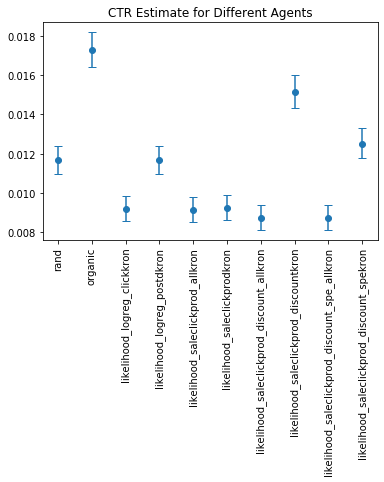

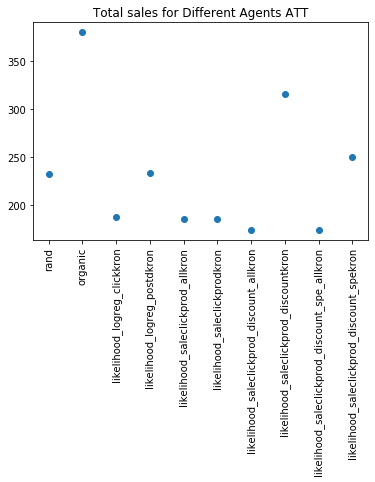

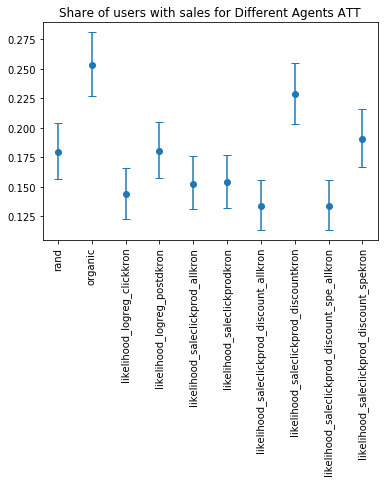

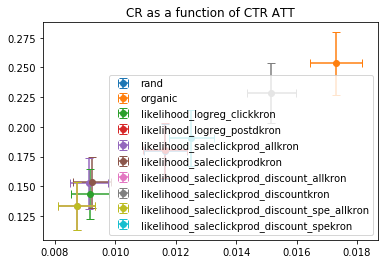

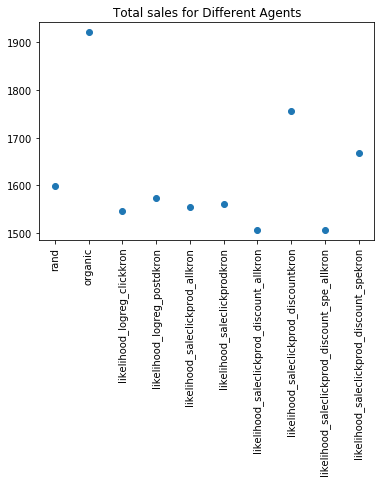

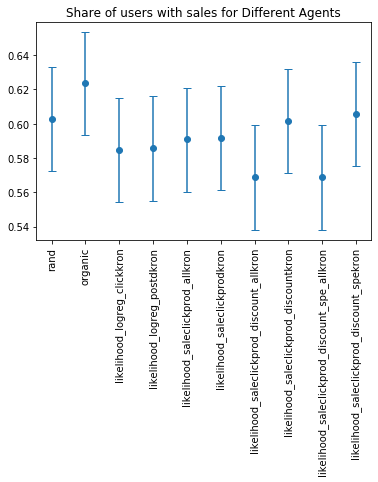

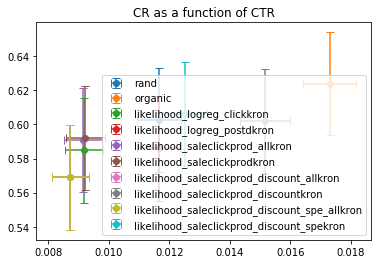

In [12]:
name_logging = 'rand'
data = logs[name_logging]
try :
    info, save_agents = pkl.load(open(str('data/agents'+str(num_users)+name_logging+feature_name+name_extension+'.pkl'),'rb'))
except :
    info, save_agents = train_agents(name_logging,logs,feature_name,features, kronecker_features=True)

# A/B test
env.reset()
res=verify_agents_sale(
    env,
    number_of_users=num_users_AB,
    agents={
        **agents, 
        **save_agents}
)
pkl.dump([res, env_1_sale_args, info, save_agents],
         open("data/res_"+name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension+".pkl","wb"))

res_dict[name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension] = res

# plot result
plot_verify_agents_sale(res["CTR"], res["Tot sales ATT"], res['Share user with sale ATT'], 
                        res["Tot sales"], res['Share user with sale'])
None

#### /!\ non cumulative features

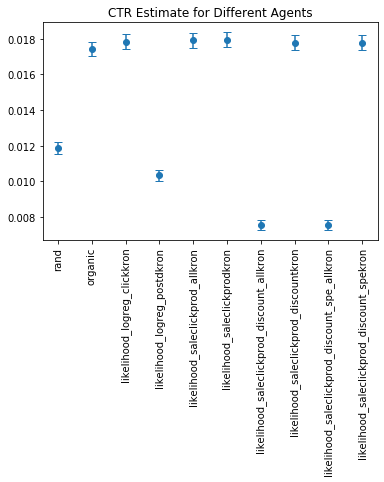

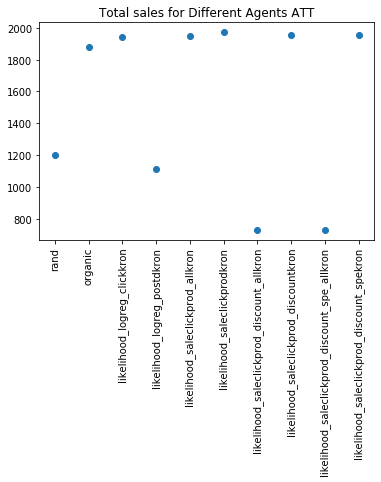

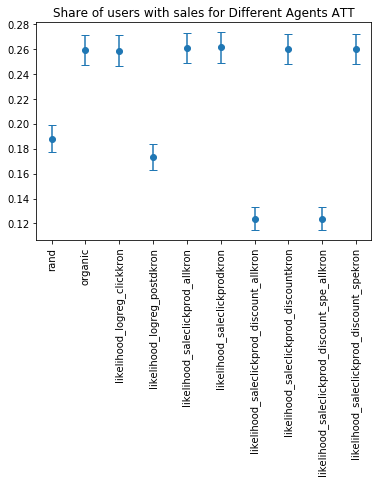

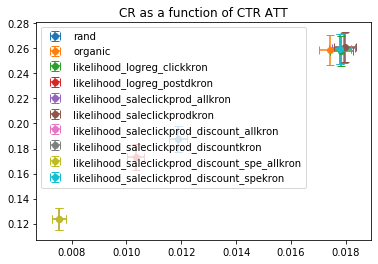

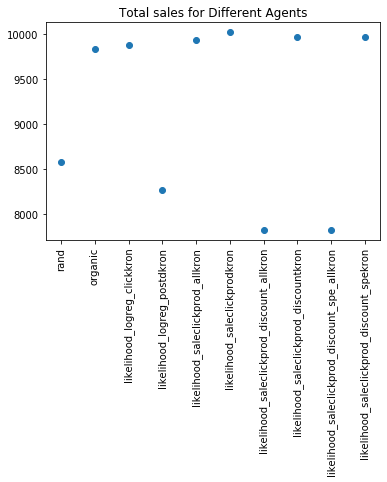

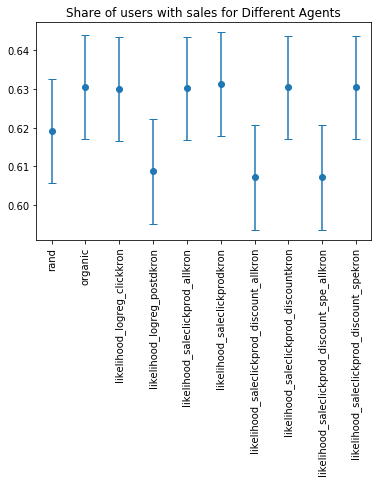

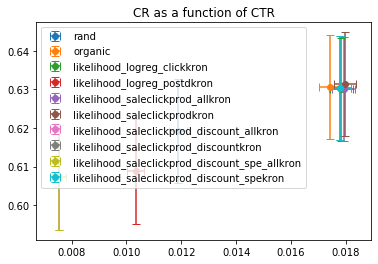

In [23]:
name_extension = 'kron'
num_users = 15000
num_users_AB = 5000
r = pkl.load(open("data/5 old non cumulative features/res_"+name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension+".pkl",'rb'))
res = r[0]
# res = r[0][name_logging+str(num_users)+"_"+str(num_users_AB)+"_"+feature_name+name_extension]

# plot result
plot_verify_agents_sale(res["CTR"], res["Tot sales ATT"], res['Share user with sale ATT'], 
                        res["Tot sales"], res['Share user with sale'])
None